In [2]:
from sklearn.metrics import confusion_matrix
from sklearn.datasets import load_digits
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch

In [3]:
digits, targets = load_digits(return_X_y=True)
digits = digits.astype(np.float32) / 255

digits_train, digits_test, targets_train, targets_test = train_test_split(digits, targets, random_state=0)

train_size = digits_train.shape[0]
test_size = digits_test.shape[0]


input_size = 8*8
classes_n = 10

In [4]:
class Linear:
    def __init__(self, input_size, output_size):
        self.thetas = np.random.randn(input_size, output_size)
        self.thetas_grads = np.empty_like(self.thetas)
        self.bias = np.random.randn(output_size)
        self.bias_grads = np.empty_like(self.bias)
        self.input = ()
        self.out = ()

    def forward(self, x): 
        self.input = x
        output = np.matmul(x, self.thetas) + self.bias
        self.out = output
        return output
    

    def backward(self, x, output_grad):
        ### BEGIN Solution
        self.input = self.input.reshape(-1,1)
        input_grad = np.matmul(self.thetas, output_grad)
        self.thetas_grads += np.matmul(self.input,output_grad.T)
        self.bias_grads += output_grad.sum(axis=1)
        
        assert self.thetas_grads.shape == self.thetas.shape 
        assert self.bias_grads.shape == self.bias.shape
        ### END Solution
        return input_grad


class LogisticActivation:
    def __init__(self):
        self.input = None
        self.out = None    
    
    def forward(self, x):
        self.input = x
        output = 1/(1 + np.exp(-x))
        self.out = output
        return output
    

    def backward(self, x, output_grad):
        ### BEGIN Solution
        self.out = self.out.reshape(-1,1)
        input_grad = output_grad * self.out * (1. - self.out)
        ### END Solution
        return input_grad
    

class SoftMaxActivation:
    def __init__(self):
        self.input = None
        self.out = None
        
    def forward(self, x):
        self.input = x
        output = np.exp(x) / np.exp(x).sum(axis=-1, keepdims=True)
        self.out = output
        return output

    def backward(self, x, output_grad):
        ### BEGIN Solution
        self.out = self.out.reshape(-1,1)
        input_grad = output_grad * self.out * (1. - self.out)
        ### END Solution
        return input_grad
    

class MLP:
    def __init__(self, input_size, hidden_layer_size, output_size):
        self.linear1 = Linear(input_size, hidden_layer_size)
        self.activation1 = LogisticActivation()
        self.linear2 = Linear(hidden_layer_size, output_size)
        self.softmax = SoftMaxActivation()
        
    
    def forward(self, x):
        return self.softmax.forward((self.linear2.forward(self.activation1.forward(self.linear1.forward(x)))))


    def backward(self, x, output_grad):
    
        ### BEGIN Solution
        output_grad = self.linear2.backward(x, output_grad)
        output_grad = self.activation1.backward(x, output_grad)
        output_grad = self.linear1.backward(x, output_grad)
        ### END Solution

In [11]:
def cross_entropy_loss(predicted, target):
    target_vector = np.zeros_like(predicted)
    
    if (predicted.ndim != 1):
        target_vector[np.arange(len(target)), target] = 1
        cost = -np.sum(target_vector * np.log2(predicted), axis=1)
    else:
        target_vector[target] = 1
        cost = -np.sum(target_vector * np.log2(predicted))
    
    return cost

def grad_cross_entropy_loss(predicted, target):
    target_vector = np.zeros_like(predicted)
    target_vector[target] = 1    
    return (predicted - target_vector).reshape(-1, 1)

### END Solution

Starting epoch 0
[5.54285739e-01 1.02527302e-03 6.01064832e-02 9.00441711e-07
 2.02256142e-06 2.44548200e-02 5.91097866e-04 4.92654118e-04
 7.15731846e-04 3.58325278e-01]
[6.23307755e-01 1.86997648e-03 9.59494779e-02 7.57427513e-07
 2.53184976e-06 1.71366850e-02 4.57824353e-04 3.83651332e-04
 5.92605315e-04 2.60298735e-01]
[5.51903217e-01 2.33941827e-03 9.30121725e-02 6.42619342e-07
 2.96297603e-06 1.69275805e-02 5.76239443e-04 3.43512089e-04
 7.99911661e-04 3.34094343e-01]
[6.26032428e-01 6.47634610e-04 7.51154185e-02 8.32418541e-07
 2.18278017e-06 1.51505982e-02 3.49781296e-04 4.09668046e-04
 5.19172807e-04 2.81772284e-01]
[6.67864489e-01 1.04359081e-03 7.27490925e-02 8.13425139e-07
 3.67006213e-06 3.23563295e-02 4.87162132e-04 3.63797085e-04
 7.17915771e-04 2.24413139e-01]
[5.76224324e-01 1.23742205e-03 9.44616103e-02 1.16685007e-06
 2.43117608e-06 2.06631899e-02 4.84286315e-04 3.52172304e-04
 8.02114050e-04 3.05771283e-01]
[6.20928381e-01 1.07383265e-03 8.83030646e-02 9.90747302e-0

[2.79087183e-01 8.20049250e-03 2.86997848e-01 7.96506422e-06
 1.95521471e-05 1.07401895e-01 3.10316632e-03 2.82740962e-03
 5.91447380e-03 3.06440014e-01]
[3.77787440e-01 6.79038752e-03 2.60243362e-01 9.84929359e-06
 2.35783971e-05 1.42308456e-01 2.91792482e-03 2.35853459e-03
 8.28354070e-03 1.99276926e-01]
[2.79044494e-01 1.41115129e-02 2.37176315e-01 1.28853222e-05
 3.44691661e-05 2.00809408e-01 3.14932668e-03 1.29083676e-03
 1.00726459e-02 2.54298106e-01]
[2.75385928e-01 2.78689580e-02 1.76582668e-01 7.76821973e-06
 3.13902587e-05 2.17971010e-01 4.99785586e-03 2.63335857e-03
 9.28767779e-03 2.85233385e-01]
[2.88885951e-01 2.71173188e-02 1.73854228e-01 7.11039404e-06
 2.82765603e-05 2.00767473e-01 6.81187398e-03 2.20198742e-03
 6.60739830e-03 2.93718383e-01]
[2.55832394e-01 2.71371400e-02 2.14449199e-01 9.36392914e-06
 1.87640299e-05 1.63579792e-01 6.17345726e-03 3.46208086e-03
 9.64477854e-03 3.19693030e-01]
[3.94615339e-01 2.92261963e-02 1.56704986e-01 4.63730066e-06
 3.22268626e-05

[4.05206787e-01 1.75126010e-02 2.25164736e-01 2.43290810e-05
 5.02410658e-05 1.85683902e-01 4.96984788e-03 2.65866200e-03
 1.77394396e-02 1.40989453e-01]
[2.48454050e-01 5.48555980e-02 1.40359797e-01 1.60849404e-05
 5.14526199e-05 2.24116987e-01 1.48105506e-02 3.68627599e-03
 1.45353834e-02 2.99113820e-01]
[3.75911353e-01 2.45274409e-02 1.22613377e-01 1.33626522e-05
 4.81869479e-05 2.34365322e-01 1.18606664e-02 5.52755850e-03
 1.21667563e-02 2.12965976e-01]
[3.36398629e-01 3.96342700e-02 1.86553584e-01 1.86639324e-05
 4.93323023e-05 1.84727707e-01 1.37058040e-02 5.96760511e-03
 1.44690023e-02 2.18475403e-01]
[3.08238157e-01 2.42732527e-02 1.91561437e-01 2.27643323e-05
 5.00600450e-05 2.75754646e-01 8.00007459e-03 6.42809321e-03
 1.83455739e-02 1.67325941e-01]
[2.52754318e-01 1.66608703e-02 2.06838468e-01 1.60209017e-05
 4.13336959e-05 1.61730963e-01 9.83607811e-03 4.76632928e-03
 1.22457972e-02 3.35109822e-01]
[2.24097120e-01 2.66420904e-02 2.05338682e-01 1.84193748e-05
 4.98230382e-05

[3.34673832e-01 4.43221122e-02 1.58973924e-01 8.60396007e-05
 1.95124474e-04 2.09747105e-01 2.01598239e-02 1.13586962e-02
 3.87475653e-02 1.81735778e-01]
[2.44636507e-01 7.97020477e-02 2.00976730e-01 8.63340417e-05
 2.06956438e-04 2.45583346e-01 1.99673791e-02 1.06603629e-02
 4.30727912e-02 1.55107546e-01]
[1.52618091e-01 7.28457552e-02 2.20009505e-01 9.97711452e-05
 1.53266632e-04 2.43150650e-01 3.50296993e-02 1.83700061e-02
 4.84493040e-02 2.09273951e-01]
[1.91750747e-01 6.82507091e-02 1.42548618e-01 4.85974659e-05
 1.89880819e-04 2.36444674e-01 3.38224534e-02 1.13129389e-02
 5.00635715e-02 2.65567811e-01]
[2.61819237e-01 1.04709377e-01 1.62036856e-01 7.03728929e-05
 2.24994776e-04 1.91762284e-01 3.27256785e-02 1.86155352e-02
 5.27830963e-02 1.75252568e-01]
[2.06186235e-01 5.29136454e-02 1.88101557e-01 1.29796346e-04
 1.90988079e-04 1.87377679e-01 3.22361357e-02 1.81383710e-02
 4.73519259e-02 2.67373666e-01]
[1.62843217e-01 6.18026638e-02 1.99150380e-01 9.76488364e-05
 2.33217409e-04

[0.1756531  0.12582452 0.18600539 0.00028928 0.00048202 0.13819344
 0.05003807 0.03372322 0.08938807 0.20040289]
[2.47988616e-01 1.74609420e-01 1.25909578e-01 1.49480080e-04
 4.22160452e-04 1.41245838e-01 6.61268846e-02 3.75394860e-02
 6.96519714e-02 1.36356566e-01]
[1.48922336e-01 9.44395938e-02 1.65682767e-01 1.65116379e-04
 3.29838812e-04 1.52950940e-01 7.55279799e-02 3.59416597e-02
 1.49944173e-01 1.76095595e-01]
[0.25800495 0.0766897  0.16163401 0.0003353  0.00062218 0.1890188
 0.0371243  0.03235279 0.11746838 0.12674958]
[0.2086363  0.10193428 0.14469325 0.00031502 0.00057952 0.23015184
 0.04824552 0.0354946  0.07000271 0.15994696]
[2.43910628e-01 1.22564749e-01 1.34209921e-01 2.07186370e-04
 7.85569835e-04 1.51851665e-01 5.34355289e-02 3.51467581e-02
 6.58660604e-02 1.92021932e-01]
[1.41385831e-01 1.23403561e-01 8.89135210e-02 2.31833435e-04
 6.99553209e-04 2.75270363e-01 5.49130848e-02 2.69399580e-02
 1.03841249e-01 1.84401045e-01]
[0.31418058 0.07637596 0.17005717 0.00033365 0

[0.166185   0.18986419 0.10685785 0.00033205 0.0012633  0.14945789
 0.10121835 0.07151115 0.12658453 0.08672571]
[0.23078612 0.1132232  0.18981039 0.00041665 0.00132217 0.12898211
 0.06778233 0.05347004 0.09621178 0.11799521]
[0.18522324 0.07824423 0.1448     0.00046726 0.00108067 0.17302199
 0.0877806  0.0734447  0.09447203 0.16146528]
[0.18530165 0.11255241 0.16148258 0.00041004 0.00137293 0.17689402
 0.0694687  0.04214735 0.11335718 0.13701313]
[0.1062294  0.09255325 0.16105915 0.00049828 0.00087948 0.16333905
 0.11411532 0.07363653 0.14587903 0.14181052]
[0.17433257 0.16412276 0.17893622 0.00039607 0.00107594 0.12276233
 0.07701809 0.04288259 0.08947184 0.14900159]
[0.13834966 0.12605415 0.13942623 0.0003394  0.00106302 0.15066457
 0.11248843 0.04348145 0.09151732 0.19661576]
[0.10129515 0.14534593 0.08319963 0.00039082 0.00125151 0.25350725
 0.09498263 0.03778535 0.11415734 0.16808438]
[0.16310624 0.09507718 0.13774063 0.00039363 0.00131076 0.1920829
 0.07345775 0.06425834 0.10866

[0.14290913 0.15868569 0.07194498 0.00071391 0.00163682 0.11373819
 0.13906212 0.13167912 0.13385406 0.10577598]
[0.12708512 0.28378618 0.08446001 0.00082065 0.00171119 0.13467307
 0.10717133 0.07877238 0.08828783 0.09323224]
[0.12313993 0.2227635  0.06766814 0.00079128 0.00236281 0.1682281
 0.12839493 0.05521064 0.09702254 0.13441812]
[0.17768513 0.08952913 0.12841045 0.00093397 0.00196159 0.14614969
 0.11219448 0.11488009 0.11058846 0.11766701]
[0.13630952 0.14754988 0.13047148 0.00075418 0.00235678 0.16870704
 0.09362801 0.06638935 0.11787664 0.13595712]
[0.16667154 0.18598666 0.07423323 0.00072273 0.00152376 0.11286278
 0.1376726  0.11257319 0.12181794 0.08593557]
[0.14111994 0.08298154 0.18364941 0.00080465 0.00171953 0.12514333
 0.08665231 0.10314779 0.1210256  0.1537559 ]
[0.1302768  0.14788403 0.19751098 0.0014812  0.00203607 0.08600267
 0.08427653 0.08406179 0.14945839 0.11701154]
[0.17756041 0.10597382 0.12001745 0.00095402 0.00268848 0.18922249
 0.0965181  0.1014239  0.11458

[0.12511067 0.20645257 0.07412388 0.00106011 0.00262237 0.07222646
 0.16446351 0.15607241 0.10634027 0.09152775]
[0.17686958 0.10671741 0.16468305 0.00313639 0.00598861 0.09955163
 0.08850414 0.10440873 0.15566741 0.09447304]
[0.11191331 0.13477273 0.16358519 0.00228816 0.00578682 0.12618599
 0.09588532 0.05877516 0.15746995 0.14333738]
[0.11215942 0.0836417  0.14350108 0.00202036 0.00419364 0.09762943
 0.13451996 0.17957038 0.107076   0.13568803]
[0.12880395 0.18291426 0.07882372 0.00170615 0.00604029 0.10461109
 0.10414171 0.12381413 0.15965387 0.10949083]
[0.15252018 0.10725676 0.07895282 0.0010786  0.00391398 0.1040273
 0.16654864 0.15900581 0.11359542 0.1131005 ]
[0.12522102 0.13682582 0.17264835 0.0029284  0.00394385 0.09385868
 0.08512735 0.11525272 0.14635084 0.11784297]
[0.11677203 0.08456106 0.14007484 0.00257535 0.00447728 0.11205178
 0.14050104 0.16408658 0.09824355 0.13665648]
[0.1287295  0.11159116 0.14028351 0.00255856 0.0050017  0.13994099
 0.1129241  0.1342618  0.11935

[0.11663908 0.15803088 0.16968404 0.00252149 0.00758999 0.11827598
 0.10560976 0.05527033 0.10202301 0.16435545]
[0.22209706 0.11284071 0.18291923 0.00276843 0.01138309 0.08724906
 0.08001112 0.09523224 0.09630397 0.10919509]
[0.0919863  0.08986036 0.15452679 0.00246756 0.00675533 0.11026475
 0.12207247 0.11527975 0.11896809 0.18781861]
[0.11164613 0.13825315 0.14983528 0.00333104 0.00639747 0.12413009
 0.10486772 0.09651603 0.143071   0.12195209]
[0.13576278 0.10578875 0.1606095  0.00365148 0.00959746 0.10022135
 0.11522083 0.11828166 0.12062066 0.13024553]
[0.09808387 0.14787979 0.16641304 0.00341958 0.00711147 0.09972727
 0.10919366 0.08082331 0.15514429 0.1322037 ]
[0.11895892 0.11182593 0.13928612 0.00200157 0.0074959  0.12524067
 0.14039261 0.0687619  0.09102701 0.19500937]
[0.18899095 0.07470617 0.19216676 0.00369263 0.00711728 0.11082788
 0.06520169 0.13451218 0.12612809 0.09665637]
[0.16344038 0.11728453 0.14392439 0.00209545 0.00791863 0.09501514
 0.11754536 0.1192929  0.1303

[0.16940162 0.05365751 0.15429312 0.00773186 0.01803627 0.1218178
 0.0803607  0.14359962 0.14684817 0.10425334]
[0.09528198 0.18279811 0.06402771 0.00516644 0.01902193 0.17050579
 0.1242384  0.08819702 0.14127332 0.1094893 ]
[0.1263587  0.14306292 0.09323057 0.00305716 0.01728998 0.10861091
 0.12954466 0.161595   0.13294451 0.0843056 ]
[0.15180674 0.16958262 0.09393624 0.00580242 0.01696859 0.14142258
 0.08644521 0.11893116 0.12984564 0.0852588 ]
[0.0742186  0.13767122 0.07675733 0.00551625 0.02059495 0.18306829
 0.11529301 0.08865946 0.17289276 0.12532813]
[0.20571955 0.08823629 0.13836613 0.00762955 0.02512624 0.14228819
 0.084743   0.10137264 0.09645571 0.11006269]
[0.10729505 0.08807879 0.13764288 0.00674804 0.0170937  0.11438376
 0.10970244 0.11565727 0.17299465 0.13040342]
[0.08002764 0.16591585 0.10657468 0.00403831 0.01663545 0.12827995
 0.16193898 0.07617028 0.10598033 0.15443854]
[0.07429572 0.1443885  0.08277563 0.00544276 0.02561562 0.19119149
 0.12571225 0.06256962 0.09496

 0.13902947 0.06022111 0.09489948 0.13316515]
[0.06673373 0.11120188 0.1551761  0.01156109 0.02149293 0.14269604
 0.10602843 0.09848636 0.11586213 0.17076132]
[0.06485936 0.08931724 0.13102476 0.00904011 0.03518627 0.17787544
 0.10063316 0.06351148 0.11614649 0.2124057 ]
[0.09406087 0.13820489 0.11079062 0.00562716 0.02588603 0.15698887
 0.12748848 0.08650426 0.11250444 0.14194438]
[0.09275298 0.14470029 0.05603827 0.00677116 0.02113846 0.14877518
 0.16982565 0.14401763 0.11576353 0.10021685]
[0.06531247 0.08263255 0.15066381 0.01022972 0.02478687 0.14939887
 0.08447194 0.10130664 0.15238592 0.17881122]
[0.09602487 0.18089497 0.09490777 0.00780405 0.03032508 0.15430206
 0.14125668 0.07758796 0.07925338 0.13764318]
[0.06919994 0.11962969 0.12918915 0.00708915 0.02526385 0.15035301
 0.12225256 0.06073423 0.13021027 0.18607815]
[0.08833345 0.12238921 0.07272588 0.00618817 0.02793821 0.19071184
 0.13365011 0.08450807 0.12436394 0.14919111]
[0.09618401 0.15288562 0.09298851 0.00582714 0.019

[0.16717495 0.09366572 0.13118945 0.01562696 0.03775783 0.14826272
 0.1081418  0.05932678 0.09449889 0.1443549 ]
[0.11760951 0.14512071 0.12029669 0.02054128 0.03673127 0.14383784
 0.11026205 0.0624195  0.11076372 0.13241742]
[0.13975056 0.11694926 0.09950421 0.02584719 0.03889228 0.17796827
 0.09777103 0.13201664 0.10963737 0.06166319]
[0.16322984 0.13448032 0.12994458 0.03143161 0.0477601  0.14209427
 0.07582265 0.04637846 0.12368568 0.10517248]
[0.16880633 0.11149643 0.1095177  0.01057751 0.03060739 0.10887142
 0.13377085 0.10989458 0.10119899 0.1152588 ]
[0.14607408 0.17679415 0.08662249 0.02450418 0.03449729 0.15607525
 0.11271036 0.08663793 0.05976558 0.1163187 ]
[0.14140185 0.10034272 0.11889056 0.01570693 0.04049222 0.12940818
 0.09015445 0.0797524  0.15466106 0.12918962]
[0.10200349 0.13857428 0.09199582 0.02112989 0.03236962 0.17305977
 0.11008544 0.11045258 0.11815238 0.10217674]
[0.1389197  0.07775822 0.09692512 0.02464268 0.0357654  0.18877994
 0.10120398 0.12962985 0.1034

[0.12289391 0.13879233 0.08520728 0.02497255 0.06473458 0.14718999
 0.10512573 0.09572262 0.08749506 0.12786594]
[0.09962684 0.09495207 0.14269504 0.04859655 0.06699282 0.12534981
 0.08233336 0.09446532 0.1311267  0.1138615 ]
[0.11276545 0.11774503 0.09714128 0.02433467 0.07713862 0.1055208
 0.13754832 0.09169541 0.08464361 0.15146679]
[0.15300902 0.07854004 0.1231591  0.05434419 0.06860939 0.10387778
 0.07953446 0.13363244 0.11179401 0.09349958]
[0.0772077  0.14236934 0.13181909 0.05367748 0.06646492 0.10415024
 0.09444847 0.09977541 0.11522889 0.11485846]
[0.09375855 0.1537452  0.1232051  0.03143782 0.06680564 0.10579527
 0.09363041 0.09481271 0.12964731 0.107162  ]
[0.16528073 0.09990478 0.08873033 0.02404559 0.04560042 0.11214344
 0.11347514 0.15274118 0.09925276 0.09882563]
[0.09160551 0.14234884 0.08015752 0.03201298 0.05880752 0.11018059
 0.11399185 0.11608284 0.1142356  0.14057674]
[0.08550847 0.11547313 0.09338043 0.03167921 0.06845184 0.11837118
 0.12807021 0.07558852 0.13202

[0.08782382 0.12652282 0.15953322 0.05528795 0.04994617 0.08261499
 0.08809245 0.07795222 0.16434435 0.10788202]
[0.15227581 0.10463472 0.1283336  0.05526659 0.06370254 0.11536722
 0.06196389 0.12726657 0.11887786 0.07231121]
[0.10326881 0.05508996 0.1528     0.04985713 0.07032675 0.12330904
 0.08676501 0.08209471 0.11663557 0.15985301]
[0.09069766 0.11726321 0.09187975 0.04511028 0.08096497 0.13835072
 0.10222013 0.07820404 0.1358406  0.11946864]
[0.14806001 0.06637481 0.10984882 0.0678762  0.08719001 0.10582023
 0.06298385 0.10690041 0.170429   0.07451665]
[0.11432762 0.12671192 0.09076497 0.03197582 0.06641654 0.10468049
 0.13801576 0.07352665 0.09142978 0.16215046]
[0.11896419 0.11696905 0.07336904 0.0267484  0.07448923 0.10671236
 0.17784217 0.08219517 0.06213479 0.16057558]
[0.08875556 0.06146077 0.11646417 0.04620105 0.06791641 0.14173196
 0.08625612 0.09674581 0.14148392 0.15298422]
[0.11937864 0.1057987  0.08904421 0.02709548 0.09848399 0.1333198
 0.09286073 0.09320269 0.10339

[0.11884316 0.11697313 0.06058433 0.04291833 0.10522241 0.16541833
 0.14556278 0.05787288 0.06882334 0.11778131]
[0.12702161 0.14561093 0.09427124 0.0405532  0.09658484 0.09438009
 0.13245387 0.09314042 0.07972898 0.09625482]
[0.09529789 0.13672133 0.10714156 0.06776215 0.0641595  0.0929005
 0.10242143 0.11349445 0.11516713 0.10493404]
[0.1539076  0.06205728 0.14137061 0.07393708 0.08837786 0.10207388
 0.06672506 0.12223325 0.11577903 0.07353834]
[0.11673743 0.12508533 0.08493659 0.04944958 0.06884115 0.09444845
 0.11959061 0.14938366 0.11231296 0.07921424]
[0.13359997 0.09760733 0.10039846 0.05565075 0.08266687 0.12076566
 0.10599751 0.12823247 0.09559629 0.07948468]
[0.14696349 0.13615833 0.11456327 0.09153826 0.08704641 0.09070464
 0.0959523  0.0740415  0.08462268 0.07840913]
[0.10483795 0.09099817 0.1397428  0.0520963  0.06538462 0.08962669
 0.11093713 0.1497741  0.08679455 0.1098077 ]
[0.17640417 0.07355501 0.11246129 0.08193788 0.11361164 0.11301521
 0.07011695 0.07498584 0.10666

[0.10602149 0.09572933 0.12031919 0.07938519 0.0881845  0.0631862
 0.09078825 0.16337571 0.11003481 0.08297533]
[0.07312219 0.14547632 0.05960707 0.06785828 0.10741519 0.11769028
 0.13020685 0.08119954 0.10827725 0.10914703]
[0.07889836 0.15149481 0.06395517 0.07785342 0.09799301 0.09593688
 0.1068008  0.10351424 0.13035854 0.09319477]
[0.11707647 0.12182687 0.08049595 0.04151811 0.09733003 0.08180504
 0.15132684 0.15310276 0.09296222 0.0625557 ]
[0.07275979 0.11475284 0.10261275 0.05976734 0.07991238 0.08526112
 0.1361291  0.09189866 0.13625719 0.12064883]
[0.09178654 0.13003147 0.095681   0.09676256 0.10911707 0.09793094
 0.11701636 0.06702685 0.1179278  0.07671941]
[0.08413872 0.16154673 0.06370182 0.06691819 0.1165185  0.08582344
 0.11731915 0.09783549 0.10572038 0.10047758]
[0.10377374 0.17023666 0.08085225 0.08652651 0.10351968 0.06561759
 0.10273213 0.12227079 0.05533907 0.10913157]
[0.09910842 0.09006051 0.11818415 0.10010319 0.07950544 0.07399146
 0.08072955 0.14177906 0.13498

[0.15495237 0.04485541 0.14460945 0.09932151 0.11039021 0.0642756
 0.07816906 0.13284275 0.09665289 0.07393074]
[0.12026702 0.13737118 0.12681613 0.08295366 0.08382435 0.07627284
 0.08256888 0.11418229 0.11136956 0.06437408]
[0.0934388  0.15829212 0.11762147 0.07828028 0.10921469 0.0799515
 0.09513426 0.08942271 0.09885128 0.0797929 ]
[0.14958247 0.12324052 0.1020929  0.04966873 0.11907358 0.074223
 0.12810597 0.11194338 0.04957196 0.09249749]
[0.08369252 0.08713972 0.09836137 0.0611102  0.09587225 0.09655763
 0.12495787 0.0818942  0.12283799 0.14757626]
[0.17422448 0.09364837 0.1087019  0.06596823 0.08187272 0.08313097
 0.11822465 0.1135474  0.07414308 0.0865382 ]
[0.09561584 0.08773801 0.11949624 0.06815396 0.12666242 0.09876873
 0.09785888 0.05124951 0.10080499 0.15365141]
[0.17676727 0.09294023 0.06162198 0.04066608 0.1134341  0.08610708
 0.11112634 0.14137537 0.10754819 0.06841338]
[0.09371261 0.06118506 0.09873707 0.08462817 0.0953641  0.08382005
 0.11966308 0.16433193 0.08900474

[0.08315657 0.1242579  0.05764585 0.05396451 0.13691659 0.10471841
 0.10628247 0.12331495 0.11190349 0.09783925]
[0.079237   0.17501004 0.07004987 0.08254088 0.10280598 0.11028201
 0.11790245 0.10275628 0.07930675 0.08010873]
[0.07553654 0.07524371 0.13039705 0.1054023  0.14311323 0.11111173
 0.06461809 0.0477242  0.12909072 0.11776242]
[0.10112528 0.19055655 0.07406863 0.07330411 0.10716967 0.07990823
 0.09491768 0.1181965  0.07905016 0.08170318]
[0.0785682  0.07804006 0.10257026 0.09585516 0.11349993 0.10453144
 0.10562594 0.10662514 0.11262024 0.10206363]
[0.08840659 0.14443399 0.07512793 0.0711017  0.10562002 0.08191504
 0.13991342 0.10134331 0.08706349 0.1050745 ]
[0.09438612 0.08625527 0.1083257  0.14951084 0.14396689 0.10523183
 0.05722135 0.06616752 0.11002279 0.07891169]
[0.0951817  0.09728406 0.12440546 0.14809745 0.14762014 0.09326093
 0.06360547 0.04787689 0.10702705 0.07564084]
[0.09430161 0.1147651  0.06306565 0.05331812 0.12361731 0.10459389
 0.12959625 0.12550642 0.1197

[0.08797177 0.13735887 0.04921227 0.0843541  0.12896049 0.13037829
 0.08192548 0.09657541 0.1299306  0.07333273]
[0.08747746 0.06993271 0.12835487 0.14207211 0.09468169 0.12298184
 0.07017529 0.09519432 0.09852046 0.09060925]
[0.05755931 0.2016881  0.0828534  0.09719125 0.1086266  0.11708542
 0.07772166 0.06675842 0.0960474  0.09446844]
[0.06190222 0.07644696 0.12670155 0.12287664 0.09328119 0.13431538
 0.07053179 0.07459761 0.08817779 0.15116888]
[0.08389363 0.11691401 0.09624366 0.06699215 0.10461319 0.11695806
 0.13411715 0.0668885  0.06310926 0.15027039]
[0.10624334 0.09476147 0.13003378 0.08399021 0.14746595 0.10016477
 0.07096788 0.07710728 0.09912063 0.09014468]
[0.08869916 0.16169201 0.06705103 0.07576477 0.09027854 0.12399985
 0.1032758  0.11483392 0.10785081 0.06655411]
[0.06445536 0.09791081 0.0872443  0.08738786 0.11245237 0.15214659
 0.08476242 0.09614147 0.10145501 0.11604383]
[0.05817714 0.06921904 0.12400894 0.09372172 0.10439878 0.13547735
 0.07343481 0.08632417 0.1006

[0.1212213  0.09436091 0.11977499 0.14832669 0.08581056 0.09817242
 0.0694375  0.0759046  0.10237872 0.08461232]
[0.14597717 0.08825139 0.12775761 0.15988904 0.08842658 0.09683827
 0.04585899 0.05622339 0.12672231 0.06405526]
[0.15949507 0.07892594 0.11670479 0.1420075  0.09920628 0.10859036
 0.05423262 0.06598208 0.10991296 0.06494242]
[0.1242137  0.09699278 0.13020388 0.1527531  0.09138151 0.08109452
 0.06426843 0.08380211 0.09586431 0.07942566]
[0.14564671 0.08659689 0.07134067 0.08274397 0.09134484 0.11682561
 0.12834803 0.10897972 0.07969375 0.08847981]
[0.12781656 0.0890925  0.14491724 0.1266756  0.09378803 0.10327371
 0.057424   0.08749579 0.10432974 0.06518681]
[0.13872014 0.07734632 0.12960488 0.14876523 0.10502718 0.1080522
 0.05778034 0.08601035 0.07257389 0.07611948]
[0.14747589 0.12047793 0.09206134 0.07784264 0.10117077 0.12951913
 0.09405282 0.08572216 0.07468022 0.0769971 ]
[0.08572995 0.11663804 0.09769082 0.15198545 0.06719425 0.11520875
 0.08312446 0.11913208 0.07250

[0.09457644 0.05440663 0.10483814 0.10661977 0.13801244 0.11525357
 0.08418505 0.10468127 0.08274817 0.11467851]
[0.10853113 0.12117236 0.06809033 0.06590431 0.12411345 0.10924611
 0.12884167 0.10697833 0.07496824 0.09215407]
[0.14731296 0.0739152  0.08603133 0.0678408  0.10305771 0.11174644
 0.14299086 0.07767132 0.06894487 0.12048851]
[0.12294976 0.08501164 0.10748897 0.12007373 0.10948242 0.07886218
 0.07860459 0.10025006 0.07520049 0.12207617]
[0.08307013 0.09738465 0.09440884 0.12087126 0.15522261 0.13142151
 0.06313787 0.03779428 0.08161235 0.1350765 ]
[0.09296451 0.14137483 0.09758957 0.09382968 0.10207399 0.11790263
 0.09046887 0.08092796 0.0938615  0.08900645]
[0.10135968 0.07856211 0.07965956 0.12444062 0.09831076 0.11085755
 0.09449212 0.14780003 0.07321511 0.09130247]
[0.12187597 0.12314947 0.05328225 0.09221665 0.09732865 0.12317718
 0.10710208 0.12654738 0.07464661 0.08067377]
[0.12691452 0.15128511 0.04907422 0.07140004 0.14103133 0.11462611
 0.09036106 0.09183794 0.0870

[0.11874574 0.08817066 0.12689678 0.13066052 0.0906278  0.07320529
 0.07439431 0.09899441 0.11268438 0.08562012]
[0.10291036 0.09250409 0.10526524 0.1371967  0.13084644 0.10493666
 0.07048044 0.0535486  0.11797113 0.08434034]
[0.14334283 0.09509817 0.10210951 0.07020779 0.09821851 0.09506094
 0.1242981  0.09539604 0.08095795 0.09531017]
[0.1063114  0.08675774 0.10655545 0.11277997 0.10494972 0.12831264
 0.08070988 0.06369672 0.11172691 0.09819957]
[0.13392761 0.152898   0.07653484 0.08692733 0.06608938 0.07248999
 0.11885404 0.14028026 0.07810782 0.07389072]
[0.10942381 0.11540269 0.10456401 0.06943967 0.08891781 0.10580026
 0.12832285 0.06526245 0.09904066 0.11382578]
[0.12663993 0.07102355 0.09364959 0.11143069 0.13691838 0.13186034
 0.08436891 0.04793898 0.0833024  0.11286724]
[0.13570605 0.14800276 0.06492111 0.11117647 0.09519877 0.0981642
 0.07853356 0.09357898 0.09609478 0.07862332]
[0.0962138  0.0768363  0.10001301 0.13061212 0.09170998 0.08139759
 0.08542965 0.11194033 0.15808

[0.07538332 0.16979008 0.07833605 0.10667701 0.07119205 0.08261424
 0.10000612 0.10380845 0.13770754 0.07448513]
[0.097597   0.09344666 0.10124096 0.10572763 0.10533493 0.0710415
 0.10068185 0.13214189 0.11158602 0.08120155]
[0.12069537 0.06171199 0.0918474  0.10441013 0.13674532 0.08433978
 0.08446774 0.14386644 0.10272546 0.06919036]
[0.13888955 0.12954289 0.04285531 0.06032373 0.10011396 0.09687911
 0.11906791 0.15296387 0.11374612 0.04561756]
[0.10627993 0.11586975 0.05354902 0.08817863 0.15939604 0.11676063
 0.09980382 0.09835374 0.08539582 0.07641262]
[0.14807068 0.10792327 0.08510442 0.06564026 0.12627975 0.0764851
 0.12442373 0.12845086 0.07074993 0.066872  ]
[0.09883268 0.12287002 0.07671757 0.0629699  0.11873516 0.10985944
 0.14802729 0.06952063 0.06435633 0.12811098]
[0.11200932 0.14653797 0.11621599 0.14287872 0.10467334 0.06111197
 0.05819446 0.09319661 0.10244821 0.0627334 ]
[0.10452971 0.11937568 0.05131098 0.08445542 0.08356526 0.07575598
 0.13035606 0.1693344  0.108061

[0.12176216 0.08706092 0.06226246 0.06141608 0.09633931 0.07495517
 0.14771747 0.16798786 0.09318865 0.08730992]
[0.09224417 0.10350102 0.12383947 0.14552452 0.08846725 0.06313049
 0.07098175 0.11654409 0.11242306 0.08334417]
[0.08461944 0.063442   0.10271858 0.13346391 0.10075224 0.07374947
 0.11361987 0.15935301 0.07361507 0.09466642]
[0.09446955 0.08375746 0.10204242 0.12673073 0.11069139 0.0928969
 0.09249349 0.13192614 0.09083744 0.07415449]
[0.10864246 0.09158334 0.10314637 0.12945749 0.16381431 0.08854738
 0.07408058 0.05368739 0.10700501 0.08003566]
[0.07241657 0.11996482 0.07882359 0.09640891 0.09186239 0.06845358
 0.12328261 0.15520345 0.1343079  0.05927618]
[0.12110927 0.09090905 0.08284596 0.0609336  0.09646095 0.06741644
 0.17523162 0.14573139 0.06042896 0.09893276]
[0.08884724 0.05227816 0.12865674 0.10288964 0.13668417 0.07476687
 0.07737031 0.09337952 0.09680067 0.14832669]
[0.12788207 0.04416996 0.11123895 0.13109918 0.12093727 0.07139307
 0.0762816  0.14170329 0.10870

[0.13938276 0.03725178 0.12320495 0.12049173 0.14748042 0.08185919
 0.06277436 0.11748666 0.09486499 0.07520315]
[0.07592817 0.05974735 0.1529252  0.11644909 0.11518899 0.07593782
 0.06240172 0.13060115 0.09419053 0.11662997]
[0.08758053 0.11702203 0.09334509 0.06728506 0.10924019 0.08890556
 0.12344419 0.12096162 0.09307582 0.09913989]
[0.07125237 0.13804019 0.10271545 0.07693809 0.10783858 0.08829311
 0.10733446 0.11487238 0.10575473 0.08696065]
[0.07361151 0.11547334 0.06367111 0.0943653  0.14599537 0.11736562
 0.10379544 0.07825558 0.09229079 0.11517595]
[0.06555788 0.06010072 0.17119645 0.07864262 0.0959545  0.09208658
 0.08298762 0.10861826 0.11024326 0.13461211]
[0.10568582 0.09902601 0.07989393 0.05544019 0.11397714 0.09590367
 0.10652118 0.13281354 0.10087075 0.10986778]
[0.12266714 0.12094443 0.13460212 0.09700629 0.0847425  0.0665407
 0.09322573 0.09755907 0.080403   0.10230902]
[0.13856911 0.04345356 0.13573581 0.10749021 0.11441772 0.06960216
 0.072663   0.14399264 0.08751

[0.06085248 0.10616193 0.10739345 0.06595716 0.08519426 0.12273498
 0.10362291 0.09327304 0.15296359 0.10184621]
[0.0851292  0.17640993 0.07468425 0.08695118 0.1117214  0.10419166
 0.08495381 0.07255068 0.11784146 0.08556642]
[0.05627199 0.09889628 0.13257996 0.11545631 0.07829528 0.10568654
 0.08268578 0.08127842 0.15340496 0.09544447]
[0.09077738 0.13123106 0.1474596  0.13253994 0.11926354 0.0830249
 0.07325838 0.0479745  0.09060361 0.08386708]
[0.08728199 0.12616447 0.082871   0.0586615  0.15486862 0.10547634
 0.12523038 0.06001075 0.0921237  0.10731125]
[0.06282121 0.11736836 0.17464704 0.1004804  0.08245386 0.0730722
 0.09137691 0.09399729 0.12211925 0.08166348]
[0.08384287 0.1216039  0.07967341 0.06339009 0.08719132 0.10863234
 0.15340293 0.12201074 0.10655921 0.07369318]
[0.05462617 0.06777367 0.148281   0.09482369 0.11185885 0.10162162
 0.08111483 0.09125388 0.10889618 0.13975011]
[0.04929039 0.13129919 0.13197401 0.1126933  0.07997498 0.09720041
 0.09278887 0.08059924 0.146342

[0.13944745 0.12326551 0.13784435 0.11728396 0.0862072  0.12015967
 0.06089155 0.0545653  0.09086646 0.06946854]
[0.12203658 0.08090796 0.08190436 0.09039254 0.07925154 0.12884938
 0.11405287 0.13095218 0.07634707 0.09530553]
[0.07604845 0.08452699 0.1236471  0.1344334  0.07511034 0.12554525
 0.06124317 0.094421   0.10542121 0.11960309]
[0.09734681 0.14591556 0.08043845 0.07625642 0.0816531  0.13890282
 0.14008138 0.05801854 0.05606797 0.12531893]
[0.11560917 0.12032363 0.09827817 0.07770657 0.09747875 0.1128831
 0.12393955 0.05650075 0.07571936 0.12156095]
[0.1389448  0.09344167 0.12766026 0.12079639 0.1216584  0.1216802
 0.05637704 0.04019151 0.09100096 0.08824876]
[0.13081417 0.09050681 0.0818628  0.10560011 0.08553054 0.12753312
 0.10343201 0.08410428 0.09143675 0.09917941]
[0.10377985 0.11369167 0.10496713 0.0854605  0.08015933 0.14428864
 0.10654553 0.06301911 0.07605465 0.12203359]
[0.08474564 0.10373341 0.10447616 0.08633285 0.08199594 0.19598835
 0.08432496 0.04638568 0.108081

[0.1538616  0.11870746 0.09173951 0.14355845 0.11038729 0.10593242
 0.08491129 0.04321242 0.07083917 0.07685038]
[0.10192598 0.09270346 0.09325519 0.11302948 0.09455856 0.13727556
 0.0809568  0.08068773 0.08358315 0.12202409]
[0.10302349 0.14095715 0.04597451 0.09831291 0.14070589 0.13191828
 0.07445477 0.07289083 0.09895667 0.0928055 ]
[0.06949479 0.05952588 0.11837774 0.09693787 0.10739169 0.14161392
 0.08432698 0.0703371  0.09030127 0.16169276]
[0.06676754 0.10052532 0.05262056 0.07530586 0.14307224 0.17669193
 0.10141494 0.06670598 0.09393877 0.12295686]
[0.07579714 0.11383272 0.13699641 0.14842264 0.09485043 0.10329708
 0.07197651 0.06080445 0.09201078 0.10201184]
[0.14418846 0.07290988 0.08759488 0.10595825 0.12224313 0.10168082
 0.09416373 0.08891033 0.07280943 0.10954109]
[0.14191731 0.0470543  0.10288383 0.14413037 0.10347754 0.10451244
 0.06137788 0.10733205 0.09391393 0.09340036]
[0.10907004 0.07752867 0.09716902 0.11370029 0.14835107 0.14092621
 0.06304882 0.04471635 0.1135

[0.15304003 0.10298953 0.0769185  0.07706847 0.10851911 0.11413159
 0.12167768 0.0643432  0.05978062 0.12153126]
[0.13685237 0.03993145 0.0882494  0.10682821 0.08328137 0.10700443
 0.09003006 0.13837421 0.11509511 0.09435338]
[0.13703576 0.07047891 0.09100472 0.13590558 0.10414629 0.10718014
 0.07477546 0.10219274 0.07591789 0.10136252]
[0.11813193 0.10161563 0.14302157 0.11472128 0.07179094 0.07489851
 0.08176787 0.12674252 0.09482031 0.07248943]
[0.11611452 0.0675918  0.098572   0.13116315 0.08416108 0.08980116
 0.09111885 0.14175276 0.08144973 0.09827496]
[0.12795664 0.10246597 0.09471361 0.08448652 0.06940336 0.07937805
 0.10092983 0.14136923 0.10695977 0.09233702]
[0.11845108 0.09183692 0.14822966 0.1331589  0.08382112 0.06682344
 0.06620342 0.08843372 0.11450944 0.08853229]
[0.09989938 0.11237261 0.05847783 0.09657845 0.10608754 0.14361538
 0.10649156 0.07611963 0.1123016  0.08805602]
[0.17450395 0.03932956 0.12736248 0.10986171 0.1171057  0.08956374
 0.0680011  0.1084717  0.0832

[0.14900763 0.10745264 0.08532484 0.06651784 0.12564686 0.07635837
 0.12348063 0.12796689 0.07058372 0.06766058]
[0.10045535 0.12148742 0.07666756 0.06340597 0.11851683 0.10972982
 0.14772054 0.0692062  0.06420105 0.12860924]
[0.11191388 0.14606898 0.11575785 0.14378346 0.10462845 0.06118992
 0.05772808 0.09350243 0.10242195 0.063005  ]
[0.10423173 0.11942996 0.05167156 0.08575544 0.08303072 0.0756732
 0.12998316 0.16865973 0.10805032 0.07351418]
[0.09710102 0.2159935  0.06200036 0.09600803 0.08684052 0.09236042
 0.10392998 0.10431751 0.07426719 0.06718148]
[0.09382931 0.1652811  0.04823218 0.08932306 0.1209448  0.11298702
 0.12587358 0.07122737 0.07884099 0.09346059]
[0.12658138 0.06677891 0.09183467 0.10816624 0.0983659  0.09575442
 0.10281043 0.14390884 0.08697774 0.07882147]
[0.10239299 0.11123733 0.09328353 0.08853475 0.12062573 0.11667592
 0.08882836 0.08573645 0.09663337 0.09605156]
[0.12453733 0.14202853 0.05460006 0.08755478 0.07672497 0.0768269
 0.12962519 0.14594006 0.100198

[0.09499894 0.09068522 0.11268083 0.09398699 0.0887227  0.05638286
 0.11353064 0.16027216 0.08948464 0.09925503]
[0.08520045 0.08118908 0.10524246 0.11408073 0.07538556 0.05651633
 0.10067511 0.15434107 0.12788705 0.09948217]
[0.11414574 0.11356254 0.05036492 0.05203915 0.07181429 0.0693338
 0.16981593 0.18242553 0.0906916  0.0858065 ]
[0.0870165  0.13670886 0.0688006  0.11166678 0.12865762 0.08228375
 0.1020326  0.08910031 0.09887762 0.09485536]
[0.07932354 0.07027533 0.11561655 0.10646254 0.09167666 0.06308261
 0.11279357 0.17344768 0.10283059 0.08449093]
[0.11436129 0.06545187 0.07107834 0.06451065 0.08075305 0.09818407
 0.14223772 0.1803871  0.08562258 0.09741333]
[0.15162857 0.0755384  0.15894015 0.12739795 0.12842955 0.06766331
 0.06781722 0.06171987 0.08950623 0.07135875]
[0.08825238 0.10484915 0.0988405  0.06718983 0.08072204 0.06191568
 0.15601016 0.14249485 0.09499099 0.10473441]
[0.10799027 0.13336815 0.09599857 0.11764136 0.11219781 0.07752046
 0.08673011 0.11350543 0.07155

[0.11915231 0.05550535 0.11718786 0.1090186  0.10829612 0.07392529
 0.07927759 0.17882439 0.07338349 0.08542901]
[0.10475581 0.07249657 0.09684886 0.09141806 0.14967026 0.13141337
 0.09012579 0.12288165 0.08281528 0.05757437]
[0.09523403 0.08729145 0.12106565 0.12637287 0.10181632 0.08325538
 0.092212   0.12368985 0.09338511 0.07567734]
[0.12098697 0.0870234  0.12818544 0.12435168 0.13994356 0.07931598
 0.0594578  0.06799923 0.11288114 0.0798548 ]
[0.12578726 0.08870962 0.1078631  0.06676228 0.1295805  0.09420498
 0.11371733 0.13029365 0.05698237 0.0860989 ]
[0.09616723 0.09355165 0.14307622 0.12161849 0.10528817 0.06414008
 0.08858374 0.10673058 0.08958864 0.0912552 ]
[0.04850232 0.17332091 0.09764832 0.10459848 0.09707037 0.07392678
 0.08964069 0.09908978 0.0989231  0.11727925]
[0.07322179 0.15491462 0.05396804 0.07345461 0.1230185  0.11222996
 0.10997938 0.09187773 0.11563784 0.09169753]
[0.07880916 0.0761745  0.11402669 0.11452324 0.10322205 0.08309528
 0.10457448 0.13692148 0.0608

[0.09131919 0.10650411 0.12807376 0.1069701  0.10521304 0.08707702
 0.08915576 0.10156293 0.10214097 0.08198311]
[0.10091445 0.11032148 0.09672787 0.04707225 0.10646712 0.10703786
 0.1576206  0.07172582 0.05336976 0.14874281]
[0.08795271 0.13170897 0.09475625 0.07979726 0.09200665 0.10675523
 0.12624249 0.09215041 0.10781845 0.0808116 ]
[0.08694649 0.13427381 0.12069593 0.09878967 0.08669011 0.08285901
 0.10091156 0.1087783  0.10050706 0.07954805]
[0.07454279 0.07130207 0.10163589 0.07160391 0.09669546 0.09724505
 0.11832244 0.1238997  0.08302264 0.16173005]
[0.07761024 0.12542565 0.09530862 0.05865298 0.10557402 0.11847032
 0.15044738 0.05948526 0.06872727 0.14029827]
[0.08821999 0.15407707 0.06689696 0.08639149 0.15138847 0.12060387
 0.10923662 0.05396237 0.07297027 0.09625288]
[0.0671758  0.11831418 0.0723244  0.09676908 0.13703013 0.13305748
 0.09268904 0.07227031 0.10577761 0.10459197]
[0.06475359 0.15059216 0.09291127 0.11531714 0.10818792 0.12337345
 0.09681543 0.08795756 0.0785

[0.15065764 0.11579396 0.12508274 0.10183796 0.08776488 0.1325074
 0.06954158 0.06187372 0.07813496 0.07680517]
[0.09251465 0.15203376 0.05864268 0.11959742 0.0878623  0.13984057
 0.07383634 0.07104936 0.1229391  0.08168382]
[0.16394852 0.08631963 0.11379224 0.09725483 0.05681503 0.10012607
 0.09232507 0.10365934 0.08432763 0.10143163]
[0.16033349 0.08817917 0.10711968 0.09194159 0.06456729 0.14518781
 0.07928564 0.10018284 0.06936415 0.09383836]
[0.10452113 0.09741723 0.14512589 0.12430134 0.07827454 0.1147424
 0.08134742 0.08946615 0.07991776 0.08488615]
[0.10986704 0.09496709 0.14242683 0.11784188 0.05847018 0.08638596
 0.10626012 0.097234   0.06334263 0.12320428]
[0.10791311 0.09284835 0.09994031 0.10902814 0.09865761 0.12369592
 0.08535367 0.04989911 0.08199528 0.15066851]
[0.11425853 0.08541444 0.1091223  0.11836513 0.12743344 0.13690814
 0.05748985 0.04606791 0.11454431 0.09039596]
[0.1335999  0.05489163 0.11927816 0.10313937 0.09522981 0.12880262
 0.08626325 0.08321114 0.101868

[0.10974313 0.11966602 0.0686134  0.06862753 0.12275758 0.10919943
 0.12678211 0.10588891 0.07465097 0.09407092]
[0.15109485 0.07309406 0.08534109 0.06890239 0.10355546 0.11007757
 0.14209233 0.07684333 0.06825341 0.12074551]
[0.12192535 0.08508584 0.10742885 0.12285469 0.10894328 0.07891992
 0.07767756 0.10032131 0.07546959 0.12137362]
[0.08379162 0.09668039 0.09230408 0.1211235  0.16024965 0.1302563
 0.06423058 0.03772807 0.08066204 0.13297376]
[0.09392288 0.14025034 0.09701501 0.09643298 0.10233898 0.11656251
 0.08954878 0.08043945 0.09295603 0.09053304]
[0.09953778 0.07920277 0.0819014  0.12858533 0.09693004 0.11019579
 0.09334578 0.1465256  0.07283855 0.09093697]
[0.12007826 0.12338041 0.05389779 0.09637112 0.09583711 0.12291898
 0.10596509 0.12542306 0.07470664 0.08142154]
[0.12702019 0.14966858 0.04914785 0.07313336 0.14116305 0.11431733
 0.09017937 0.09145569 0.08662952 0.07728507]
[0.08827044 0.07535427 0.11025029 0.12889764 0.11330413 0.12344345
 0.07723366 0.07404812 0.10571

 0.07064886 0.0973021  0.12199152 0.08364703]
[0.11216732 0.07777912 0.08494149 0.12151906 0.09042785 0.10926818
 0.10004757 0.11290658 0.10823646 0.08270637]
[0.08765902 0.12430318 0.05701931 0.08264359 0.11429897 0.11350314
 0.09679898 0.09211019 0.14132408 0.09033955]
[0.10024653 0.08990315 0.08644724 0.14818772 0.1037812  0.10221556
 0.07330987 0.11984986 0.09633284 0.07972602]
[0.09067357 0.10955728 0.08862844 0.07387899 0.11801768 0.10528464
 0.12381297 0.06264982 0.08243588 0.14506072]
[0.13122071 0.08621417 0.09051561 0.17041788 0.12312358 0.09163776
 0.06675422 0.06304574 0.10496187 0.07210845]
[0.10991982 0.04963828 0.07832682 0.0653388  0.07068642 0.09934362
 0.12292751 0.18549242 0.09661289 0.12171342]
[0.08055382 0.09204615 0.08794029 0.11541208 0.0865395  0.10533226
 0.09979444 0.12014976 0.11457831 0.0976534 ]
[0.15978648 0.06712289 0.06086445 0.06204047 0.07167832 0.12294553
 0.13233357 0.13026269 0.10592206 0.08704354]
[0.09612612 0.09031631 0.13121868 0.12835948 0.085

[0.11287217 0.09234328 0.07393874 0.09038796 0.08838097 0.11902833
 0.11093404 0.1312539  0.09090215 0.08995846]
[0.15927412 0.04472627 0.12410706 0.13782262 0.11394073 0.08453099
 0.06391906 0.10835189 0.09244297 0.07088429]
[0.11694059 0.10550021 0.05667972 0.07359874 0.13141985 0.15106434
 0.13883743 0.05313753 0.06338856 0.10943304]
[0.12456048 0.13284286 0.08929151 0.07219322 0.11827539 0.08748631
 0.12087103 0.08691329 0.07407648 0.09348944]
[0.09015689 0.12437039 0.10036425 0.11944118 0.07763329 0.08490932
 0.09142005 0.10700802 0.1060367  0.09865993]
[0.14028533 0.05801606 0.13127667 0.12566002 0.10789305 0.09247478
 0.06038166 0.11164807 0.10499119 0.06737318]
[0.11090192 0.11618399 0.08142535 0.08909822 0.08366824 0.08772989
 0.10981725 0.14010451 0.10502901 0.07604162]
[0.12636822 0.09070332 0.09687408 0.09609259 0.10069571 0.10958496
 0.09830018 0.11881464 0.08817311 0.07439319]
[0.13642962 0.12265701 0.10331588 0.14918078 0.10664041 0.07993003
 0.0877457  0.06765018 0.0761

[0.10274801 0.08500098 0.13252603 0.12628075 0.10349199 0.06262603
 0.07414383 0.16506893 0.08747915 0.06063431]
[0.1030436  0.1661832  0.06415957 0.07406445 0.09435396 0.07677719
 0.11815134 0.14315693 0.09047983 0.06962993]
[0.07420657 0.14372488 0.0887794  0.13129167 0.08521629 0.07419929
 0.08948988 0.14175615 0.10271278 0.06862307]
[0.09534772 0.10028188 0.08464321 0.08736746 0.07236944 0.07556781
 0.11510063 0.19550527 0.08045625 0.09336034]
[0.10574148 0.12451709 0.08635415 0.13216119 0.10205353 0.08666975
 0.0675455  0.13567584 0.10577531 0.05350616]
[0.11811072 0.13262468 0.08263453 0.07649137 0.11633283 0.09348682
 0.12033127 0.07015993 0.08000743 0.10982041]
[0.09746218 0.16137835 0.05359172 0.09116632 0.11361791 0.07650155
 0.09692426 0.11832564 0.10922473 0.08180735]
[0.09548522 0.23040066 0.04796289 0.09509376 0.10811674 0.07307452
 0.09412245 0.10101876 0.08280832 0.07191666]
[0.10116174 0.11966146 0.07716016 0.13277528 0.12828781 0.09969229
 0.07181446 0.07478254 0.1150

[0.1258205  0.04451528 0.13137057 0.13066352 0.14144467 0.05862713
 0.07859349 0.12492202 0.07887475 0.08516807]
[0.11055515 0.08734897 0.10753407 0.09061982 0.09298491 0.08686294
 0.10729562 0.10996875 0.10839539 0.0984344 ]
[0.07079798 0.13662981 0.07652915 0.09720176 0.12999877 0.07201245
 0.1253909  0.08529552 0.0871895  0.11895417]
[0.08616843 0.06552611 0.10791791 0.09063232 0.09881248 0.06919392
 0.13003588 0.17193533 0.07766524 0.10211239]
[0.06382476 0.09857422 0.10999538 0.15959637 0.11132017 0.05576484
 0.10769306 0.11145886 0.10616202 0.07561033]
[0.09202293 0.08773455 0.09797568 0.08759006 0.09896143 0.05746962
 0.13811776 0.13330473 0.08700408 0.11981917]
[0.07631191 0.10572484 0.13293332 0.09510104 0.12871856 0.09035881
 0.0986783  0.06373164 0.08387542 0.12456615]
[0.0819624  0.11239968 0.13656071 0.15971005 0.10446753 0.05922964
 0.07111343 0.12712375 0.08621536 0.06121745]
[0.08647112 0.12682223 0.08973995 0.07579117 0.12059155 0.0710048
 0.14509766 0.07553119 0.06554

[0.06901867 0.11100819 0.09444011 0.07071203 0.16399194 0.10358848
 0.09341784 0.06935626 0.08335021 0.14111627]
[0.08058203 0.05825579 0.12650459 0.10417831 0.10797479 0.07870816
 0.1043107  0.12112478 0.09034157 0.1280193 ]
[0.06182596 0.10642963 0.12484109 0.12442794 0.11346798 0.08736479
 0.08640006 0.10896552 0.09232493 0.09395209]
[0.06605327 0.13040187 0.10047277 0.06565858 0.0940235  0.08514753
 0.15393704 0.09135448 0.07323172 0.13971925]
[0.07375194 0.11084471 0.13539957 0.1198345  0.12882204 0.06697917
 0.08466083 0.07263574 0.10088615 0.10618535]
[0.09382309 0.10740041 0.09680266 0.08467126 0.10637726 0.09817927
 0.11571649 0.13783105 0.07860901 0.0805895 ]
[0.06816339 0.10267013 0.09141853 0.07288748 0.11036431 0.10435775
 0.13269135 0.07083481 0.09658823 0.15002403]
[0.09905103 0.09211093 0.11147376 0.07790074 0.13865881 0.09932011
 0.09133252 0.0702744  0.06881623 0.15106146]
[0.06951909 0.11897641 0.12907644 0.10955101 0.12359855 0.09909277
 0.0747858  0.10224518 0.0920

 0.10188055 0.10294344 0.0750031  0.09511723]
[0.06101227 0.105564   0.10715406 0.06663681 0.08451944 0.1248131
 0.10198573 0.09312318 0.15250319 0.10268821]
[0.08557877 0.17544258 0.07423605 0.08617845 0.11272217 0.10352045
 0.08710654 0.07244939 0.11766511 0.0851005 ]
[0.05644108 0.09870387 0.13134669 0.11530395 0.07866034 0.10623149
 0.08249738 0.08244338 0.15300934 0.0953625 ]
[0.09151847 0.13146607 0.14570518 0.13001242 0.12245661 0.08245065
 0.07444182 0.04841835 0.09045567 0.08307474]
[0.08904862 0.12469858 0.08180128 0.05808025 0.15612261 0.10551439
 0.1262332  0.05940298 0.09165644 0.10744165]
[0.06195663 0.11762136 0.17451362 0.10084035 0.08192107 0.07299103
 0.09051548 0.09577547 0.12234637 0.08151862]
[0.08394826 0.12130288 0.08060735 0.06481887 0.08569779 0.1087362
 0.15194439 0.12137032 0.1068365  0.07473744]
[0.05428928 0.06785326 0.14892847 0.09462234 0.11086235 0.10325573
 0.08058363 0.09185983 0.10892416 0.13882095]
[0.04882638 0.13124802 0.13133634 0.11295512 0.07979

[0.10522126 0.06103457 0.11980329 0.09627373 0.08377612 0.10639868
 0.09991605 0.0993406  0.07460504 0.15363067]
[0.0973958  0.08612893 0.10738051 0.08964542 0.08834519 0.13534802
 0.09739074 0.05537717 0.10951035 0.13347787]
[0.10013938 0.07371094 0.08459909 0.09582739 0.07639499 0.14978901
 0.09580512 0.09772006 0.1328645  0.09314952]
[0.15930964 0.06675305 0.10696772 0.11504906 0.0748788  0.10940934
 0.07472625 0.11818637 0.08221935 0.09250042]
[0.12671087 0.05690481 0.11201918 0.09289413 0.07933658 0.13237072
 0.10249148 0.12383697 0.08207858 0.0913567 ]
[0.11846388 0.11100303 0.06960634 0.07604626 0.07368859 0.11904055
 0.13477948 0.11411837 0.09149736 0.09175614]
[0.12188892 0.12442934 0.05813493 0.09447908 0.13275024 0.14463455
 0.09230403 0.06573763 0.08069531 0.08494598]
[0.10670564 0.10602543 0.06324121 0.06702572 0.13545093 0.1642043
 0.10839763 0.05805334 0.06219703 0.12869877]
[0.15022534 0.08611795 0.09906903 0.07622889 0.09240434 0.12273191
 0.11368788 0.05660659 0.06335

[0.10791346 0.08713966 0.07976033 0.06463029 0.1013356  0.13970261
 0.10561013 0.07301727 0.10075874 0.14013191]
[0.1258865  0.12062717 0.08009714 0.08966075 0.11321829 0.09617418
 0.09163988 0.10688621 0.09418809 0.08162178]
[0.09520852 0.06388736 0.09386608 0.16024069 0.09679986 0.09304059
 0.09119989 0.10585064 0.08508849 0.11481788]
[0.08810639 0.0783395  0.10299294 0.1218372  0.13869992 0.12685923
 0.0607263  0.03863936 0.12028244 0.12351673]
[0.11800179 0.08140339 0.07912452 0.1115804  0.13630163 0.12038608
 0.06414827 0.06835037 0.10121102 0.11949253]
[0.09958947 0.120041   0.07713822 0.07066325 0.08872819 0.13008072
 0.13169105 0.05432846 0.07653231 0.15120734]
[0.14889755 0.12316854 0.09716777 0.07917936 0.09621244 0.12761721
 0.07798183 0.08822492 0.07629721 0.08525317]
[0.09034942 0.0985281  0.05816749 0.08834983 0.12670408 0.14700932
 0.10718457 0.06317014 0.079998   0.14053904]
[0.11517722 0.14163925 0.07240664 0.06744598 0.10272713 0.10271875
 0.13299377 0.06071702 0.0537

[0.1056408  0.09021112 0.08253805 0.16770107 0.13873983 0.11024549
 0.06431503 0.05716022 0.09873368 0.08471471]
[0.07001915 0.07395938 0.09748269 0.15345292 0.0877562  0.11218197
 0.06664644 0.11168708 0.11750312 0.10931105]
[0.11475639 0.12506295 0.07717526 0.11013827 0.08259241 0.08369989
 0.09338775 0.13197255 0.09987109 0.08134344]
[0.13589471 0.12757455 0.08973718 0.14676977 0.08514385 0.0971398
 0.06432487 0.11031714 0.07867858 0.06441956]
[0.0866217  0.09104354 0.08908604 0.15694347 0.11314519 0.1068847
 0.06241272 0.08298873 0.11883213 0.09204179]
[0.11931135 0.09072636 0.05800997 0.07923099 0.12021169 0.11761949
 0.09929584 0.10153637 0.09725584 0.11680209]
[0.12961049 0.1001015  0.08507535 0.10252652 0.07352677 0.10228413
 0.10244463 0.10946296 0.10498014 0.08998752]
[0.0964711  0.12927016 0.04889455 0.12361042 0.11744984 0.13481924
 0.09652666 0.06235465 0.08672671 0.10387668]
[0.11087099 0.0589341  0.06346616 0.08349831 0.09130069 0.14131799
 0.12969997 0.13683749 0.090508

[0.10736219 0.0873606  0.10335126 0.11102248 0.1100919  0.12682906
 0.0827394  0.0639564  0.11074867 0.09653804]
[0.1332352  0.15116281 0.0777636  0.09153383 0.06414007 0.07267894
 0.11574062 0.13961963 0.07827298 0.07585232]
[0.11512755 0.11266927 0.10304976 0.06938806 0.08964874 0.10423383
 0.12891859 0.06468157 0.09814877 0.11413386]
[0.12814804 0.0712073  0.09225207 0.10912474 0.1417018  0.13124561
 0.08673122 0.04755989 0.08263149 0.10939785]
[0.13460679 0.1476865  0.06555843 0.11384536 0.09395926 0.09696357
 0.07864385 0.09306219 0.09637446 0.0792996 ]
[0.09451934 0.07861609 0.09958972 0.1303784  0.09272562 0.08048002
 0.08570415 0.11261222 0.15875303 0.0666214 ]
[0.09840426 0.05871566 0.14237921 0.12729528 0.07757075 0.08496937
 0.08297921 0.1366084  0.08602058 0.10505728]
[0.11275333 0.1157834  0.08013818 0.06144635 0.08239032 0.09048151
 0.17956603 0.07529847 0.06037936 0.14176305]
[0.13481269 0.17533652 0.06675297 0.08005179 0.07372755 0.06944323
 0.10776557 0.13113022 0.0881

[0.12843389 0.12095714 0.09317283 0.08486223 0.13518385 0.11407364
 0.09509166 0.04581011 0.0835113  0.09890336]
[0.09010978 0.14820797 0.06243874 0.07490899 0.08910736 0.11221638
 0.16155656 0.07580046 0.0782599  0.10739386]
[0.15780734 0.10789748 0.08052862 0.12765676 0.13175798 0.10005779
 0.0849843  0.04694112 0.09600392 0.06636469]
[0.07543675 0.16819118 0.0800872  0.10904419 0.06974391 0.08203901
 0.09858053 0.10419435 0.13763474 0.07504813]
[0.09518733 0.09413492 0.10191653 0.106889   0.10447381 0.07082014
 0.09959063 0.13449441 0.11163809 0.08085514]
[0.11848695 0.0624036  0.09201854 0.10465155 0.13657622 0.08406264
 0.08391418 0.14628021 0.1026885  0.06891762]
[0.14067356 0.12841313 0.04366708 0.06214665 0.09826182 0.09743138
 0.1180928  0.15016938 0.11371514 0.04742906]
[0.10459721 0.11805143 0.05383991 0.08784278 0.16012473 0.11636828
 0.1018758  0.09681753 0.08508455 0.07539778]
[0.15084265 0.10674751 0.085812   0.06757348 0.12397907 0.07633645
 0.12179917 0.12718861 0.0703

[0.08518164 0.08493742 0.09807664 0.12259963 0.17083628 0.09021005
 0.07556619 0.05638064 0.1266624  0.08954911]
[0.07988446 0.12249987 0.08749791 0.07350529 0.11436368 0.07820544
 0.15196692 0.08006282 0.08681156 0.12520205]
[0.11429496 0.11650688 0.08838272 0.08684333 0.12210323 0.07234358
 0.13143477 0.07447423 0.06304783 0.13056847]
[0.10922344 0.04866917 0.12616228 0.08322647 0.10613726 0.07105919
 0.11546997 0.15269083 0.09001171 0.09734969]
[0.13590074 0.10522799 0.11109974 0.07889738 0.11552983 0.08303825
 0.10669238 0.10335989 0.07495603 0.08529777]
[0.10035472 0.09044019 0.10682172 0.13531115 0.12509704 0.07377926
 0.07176726 0.12518095 0.09719873 0.07404898]
[0.09130902 0.09232651 0.10760722 0.1119041  0.14835629 0.07865961
 0.0879486  0.06741814 0.12774169 0.08672882]
[0.06911073 0.12538092 0.08261257 0.12480249 0.10392375 0.07830509
 0.09906192 0.13635668 0.13158036 0.04886549]
[0.08552612 0.13414417 0.08773677 0.08407584 0.1071401  0.08204733
 0.12480871 0.09989512 0.1099

[0.14609314 0.08727258 0.11367774 0.10297564 0.14974123 0.08415588
 0.07798089 0.09367419 0.05784433 0.08658438]
[0.10894726 0.06536974 0.14234383 0.08675457 0.09466584 0.07486244
 0.09596768 0.15092184 0.09192843 0.08823837]
[0.1504564  0.07592563 0.13235792 0.11455633 0.14011936 0.0805996
 0.06078197 0.07328005 0.09250905 0.07941369]
[0.07897178 0.11321603 0.1412368  0.12504243 0.0882804  0.06292884
 0.08365789 0.1095105  0.09588115 0.10127418]
[0.09710489 0.1655446  0.07998964 0.08359733 0.10872065 0.07433116
 0.09591729 0.12441284 0.06652835 0.10385326]
[0.10486765 0.14830836 0.09042529 0.10890367 0.11610906 0.05534555
 0.0631125  0.13380341 0.0749579  0.1041666 ]
[0.09328673 0.07069339 0.13658343 0.08912248 0.11326135 0.07115389
 0.10208867 0.13382406 0.0878928  0.10209319]
[0.07182295 0.1512038  0.11228352 0.09929563 0.10020145 0.0631933
 0.09462369 0.10429435 0.08288794 0.12019336]
[0.09431524 0.08183459 0.13468065 0.06774039 0.12593427 0.10254629
 0.08286252 0.07514152 0.083370

[0.08576758 0.13478347 0.06436412 0.07830037 0.12615691 0.10742415
 0.11585679 0.07631836 0.09937762 0.11165063]
[0.08666733 0.11217235 0.16330466 0.09828433 0.09928659 0.0577111
 0.09272889 0.09385199 0.09601096 0.0999818 ]
[0.08554328 0.10642368 0.09758591 0.09349498 0.11703155 0.1092848
 0.11098286 0.09448974 0.10843421 0.07672899]
[0.06785742 0.07655142 0.12528152 0.08273532 0.10289765 0.07278286
 0.12350634 0.09966542 0.08559166 0.16313039]
[0.06626402 0.12212994 0.13538715 0.1191851  0.08724497 0.08502918
 0.09378976 0.08237693 0.12785254 0.08074041]
[0.09325729 0.0847164  0.13989479 0.0769225  0.1228838  0.08836293
 0.08241228 0.07676831 0.11110403 0.12367767]
[0.08864762 0.12274592 0.13271984 0.07869294 0.08591959 0.06676343
 0.11695017 0.09712665 0.12743099 0.08300284]
[0.14678599 0.08704248 0.14189551 0.11409069 0.12466357 0.08507194
 0.06157223 0.08336277 0.08306186 0.07245294]
[0.11415948 0.08020527 0.13626285 0.06804063 0.1015493  0.05359589
 0.09387668 0.14247316 0.095505

[0.07632498 0.12087057 0.05890895 0.07575269 0.1086672  0.21557176
 0.11495473 0.04827991 0.07466308 0.10600613]
[0.0787913  0.08557808 0.09036748 0.08740045 0.1373222  0.15887959
 0.08147357 0.04606017 0.11481887 0.11930829]
[0.08144247 0.08309738 0.08387038 0.07090062 0.12138327 0.14971306
 0.08142418 0.07375444 0.12897032 0.12544388]
[0.13935835 0.1077666  0.07054443 0.08887463 0.09040167 0.15455838
 0.09559426 0.09926252 0.07792216 0.07571699]
[0.07739174 0.17433193 0.06309644 0.08756959 0.09596666 0.14213886
 0.11601641 0.07302236 0.08000808 0.09045793]
[0.10226362 0.08988146 0.09701788 0.08102021 0.10184607 0.13102424
 0.11781642 0.0564482  0.10728769 0.11539421]
[0.11370491 0.11022745 0.09522044 0.07117785 0.10436804 0.13882963
 0.09394974 0.06250269 0.08373714 0.12628211]
[0.10373925 0.09914493 0.11086201 0.06897781 0.13609843 0.1067734
 0.09849563 0.05730694 0.0857969  0.1328047 ]
[0.13190564 0.16080379 0.08498382 0.08484955 0.08201631 0.10274566
 0.10032873 0.10502299 0.06294

[0.15974254 0.07040809 0.13209231 0.12699217 0.1155428  0.11443814
 0.05692345 0.05746688 0.09477563 0.07161798]
[0.1215923  0.13079613 0.0923019  0.0653529  0.10893331 0.09720158
 0.10114661 0.09477787 0.08458278 0.10331463]
[0.09737172 0.07765473 0.10941306 0.14808    0.14197432 0.12044094
 0.05458308 0.04070245 0.09480175 0.11497795]
[0.13744179 0.1457518  0.06550682 0.07088069 0.08066391 0.08712545
 0.1038662  0.1315136  0.09461685 0.08263289]
[0.13151513 0.06595721 0.12549248 0.12401149 0.0986112  0.08211169
 0.06963183 0.12436717 0.08072211 0.09757969]
[0.10877902 0.11839295 0.12470857 0.15910128 0.10676444 0.09235835
 0.04729794 0.07365344 0.08915384 0.07979015]
[0.15034985 0.09175045 0.11322097 0.13186912 0.12287756 0.10714371
 0.05816588 0.07068631 0.06213522 0.09180092]
[0.09873081 0.14088022 0.05758072 0.06348063 0.07578395 0.16581861
 0.10692846 0.09390823 0.09099142 0.10589695]
[0.09041193 0.11147434 0.06283616 0.09393689 0.1350096  0.1392969
 0.08542658 0.06579804 0.09460

[0.083417   0.06421795 0.09828895 0.11219728 0.13407629 0.11646931
 0.07933666 0.08626609 0.09572663 0.13000384]
[0.10091454 0.07847478 0.06880904 0.11120858 0.10555609 0.14353312
 0.09120903 0.12251872 0.10182494 0.07595116]
[0.13507    0.09960527 0.08849859 0.08631313 0.07172601 0.09658048
 0.09799957 0.14204434 0.0951871  0.08697551]
[0.10972061 0.13620159 0.04854765 0.10920684 0.14330889 0.11136062
 0.09319964 0.06899511 0.07901995 0.1004391 ]
[0.07333106 0.10745531 0.10363076 0.14837723 0.09497251 0.11246668
 0.07341767 0.08788404 0.12402484 0.07443991]
[0.11947557 0.10945111 0.05980884 0.08205215 0.07459323 0.0964237
 0.11358671 0.15174276 0.11534799 0.07751794]
[0.09050373 0.0787057  0.10759294 0.14081923 0.09037867 0.07266493
 0.08456185 0.1290927  0.11492978 0.09075047]
[0.07464706 0.11321014 0.10569741 0.17572711 0.08577091 0.07400478
 0.07250483 0.10563789 0.10500631 0.08779355]
[0.1406747  0.04429939 0.11786992 0.15392561 0.13611624 0.08449122
 0.05490904 0.1114608  0.08223

[0.11345327 0.06883517 0.10234897 0.13237295 0.08247004 0.09004292
 0.09048421 0.14094246 0.08136426 0.09768574]
[0.12574746 0.10260689 0.09548861 0.08758196 0.0675301  0.07984406
 0.09839155 0.14186667 0.10735016 0.09359253]
[0.1158295  0.0929745  0.14744472 0.13364897 0.08366255 0.06666748
 0.06552479 0.09136672 0.11498576 0.08789502]
[0.10166577 0.11082284 0.05857366 0.09475082 0.10725871 0.14228029
 0.11088892 0.07505477 0.11173725 0.08696699]
[0.16888357 0.04100319 0.12873415 0.11026195 0.11782332 0.08991674
 0.06826051 0.10948772 0.08349738 0.08213147]
[0.17129181 0.0402198  0.10001626 0.11572102 0.13558118 0.10383855
 0.06932008 0.10111803 0.10213183 0.06076144]
[0.11212048 0.09253878 0.11795595 0.12489869 0.06239736 0.0670139
 0.08995069 0.15235762 0.07535154 0.10541499]
[0.10572479 0.08801915 0.11832394 0.13691871 0.11635983 0.10491404
 0.07880906 0.05015212 0.1167193  0.08405906]
[0.11539847 0.08915649 0.1262923  0.13255654 0.09023404 0.07277684
 0.07283487 0.10282382 0.11300

[0.10858497 0.11382878 0.10687007 0.15180595 0.10315202 0.06944051
 0.08433512 0.10225297 0.06488162 0.094848  ]
[0.11569563 0.0878218  0.14377854 0.11388705 0.10335903 0.07566073
 0.08860819 0.09540216 0.09705541 0.07873145]
[0.1353148  0.14703493 0.0618104  0.11610342 0.10925086 0.0804734
 0.089585   0.11436654 0.06851858 0.07754207]
[0.11744424 0.0974659  0.07589625 0.0917266  0.10111851 0.09513703
 0.11402199 0.12550647 0.11131609 0.07036692]
[0.11265047 0.11530566 0.12146406 0.14053809 0.11599561 0.07972532
 0.06850611 0.08960929 0.09764304 0.05856236]
[0.16552549 0.13360624 0.09999392 0.10413366 0.10993277 0.08746009
 0.0658886  0.09425368 0.08133048 0.05787507]
[0.08524871 0.12547123 0.05867165 0.08692806 0.1380881  0.13193408
 0.1101684  0.07010268 0.08725629 0.1061308 ]
[0.12411982 0.13193309 0.07793298 0.09936665 0.14842986 0.07050592
 0.08349092 0.09794526 0.08996375 0.07631174]
[0.15426234 0.10013712 0.08998689 0.06300041 0.12815318 0.07011905
 0.13456753 0.11143805 0.06912

[0.0765232  0.08456409 0.11573315 0.15379445 0.09471228 0.05691272
 0.08607067 0.1388496  0.10482113 0.08801871]
[0.08716821 0.12004136 0.05298635 0.08775136 0.14043047 0.09090345
 0.09751373 0.15592549 0.10741963 0.05985994]
[0.09988282 0.11527882 0.09133028 0.06318854 0.11627206 0.06771922
 0.16130369 0.08559864 0.05231891 0.14710704]
[0.08180675 0.12582993 0.0751434  0.08486942 0.14762583 0.10925789
 0.1034028  0.0730539  0.08050174 0.11850835]
[0.0623941  0.11512206 0.0551228  0.1009762  0.14167773 0.12590439
 0.11430127 0.07717389 0.0974434  0.10988415]
[0.09911944 0.12875388 0.05285249 0.09160237 0.11997009 0.11736645
 0.12146254 0.08236878 0.09816317 0.08834079]
[0.11558369 0.14058413 0.08105574 0.11867051 0.13392524 0.06471727
 0.0914987  0.08835036 0.07261396 0.09300042]
[0.08076031 0.11615824 0.08550236 0.06319064 0.09426101 0.06308595
 0.16696313 0.09522512 0.07676559 0.15808765]
[0.08506258 0.12962341 0.14121915 0.13227442 0.09782559 0.04973305
 0.07177894 0.09781729 0.1088

[0.15354654 0.11664668 0.1007667  0.06215744 0.12277425 0.0717443
 0.12070706 0.10796962 0.0481036  0.09558381]
[0.08884098 0.08284839 0.09477913 0.07309255 0.10264704 0.09323693
 0.12222353 0.07924849 0.11833319 0.14474976]
[0.17107229 0.09201992 0.10868085 0.08399844 0.0843223  0.07886264
 0.11131145 0.11123315 0.07210206 0.0863969 ]
[0.09888832 0.08490122 0.11253522 0.07854452 0.14319041 0.0930437
 0.09913087 0.04942385 0.09522541 0.14511647]
[0.1727722  0.0915354  0.06129258 0.05022566 0.11965769 0.08317525
 0.11048957 0.1366344  0.10492539 0.06929186]
[0.08906173 0.06120426 0.10191182 0.10441044 0.097636   0.08080526
 0.11417113 0.15879079 0.08645876 0.1055498 ]
[0.12965057 0.11645888 0.07714576 0.05002391 0.12213288 0.05928101
 0.13495887 0.13254155 0.09201178 0.08579479]
[0.11378627 0.08193615 0.16124797 0.10744387 0.08735201 0.06783929
 0.07221527 0.10548922 0.10100291 0.10168704]
[0.13169368 0.04192039 0.13290214 0.10869694 0.12970291 0.06778664
 0.07519136 0.1232732  0.098406

[0.07591055 0.09534035 0.14939756 0.11270975 0.0922052  0.08639331
 0.0880897  0.09307941 0.08523093 0.12164323]
[0.06728292 0.1100306  0.10771507 0.07979435 0.09528989 0.10115733
 0.13012439 0.06520498 0.10519269 0.13820777]
[0.09921166 0.14531816 0.05622172 0.0884111  0.1529223  0.1031202
 0.11269298 0.07634258 0.07895938 0.08679992]
[0.09561214 0.18027479 0.07782025 0.07280541 0.09663458 0.09762421
 0.11057141 0.10135681 0.08534163 0.08195877]
[0.10222086 0.12922679 0.12067204 0.08502924 0.11265895 0.09226169
 0.08130311 0.07958094 0.10845469 0.08859169]
[0.0910026  0.06454666 0.11795057 0.1052837  0.12299058 0.10558518
 0.082703   0.11378671 0.12104282 0.07510817]
[0.07477552 0.11180236 0.12026678 0.14989113 0.08680878 0.08979308
 0.08737724 0.11316995 0.09712208 0.06899309]
[0.06262951 0.0813738  0.09176742 0.12003554 0.08495094 0.10758429
 0.10463933 0.16551155 0.08820139 0.09330624]
[0.09636445 0.12449924 0.13737506 0.12289029 0.13452213 0.08838063
 0.07391143 0.08281536 0.05841

[0.11341167 0.10618773 0.09039322 0.05198102 0.11796067 0.11377333
 0.12598688 0.10079864 0.07790435 0.10160247]
[0.07654307 0.12332424 0.09036584 0.0604825  0.09997811 0.11024753
 0.15246708 0.06407444 0.06313396 0.15938323]
[0.08493112 0.2541532  0.05742776 0.07792122 0.06863394 0.07868672
 0.11965799 0.08682175 0.09533841 0.07642787]
[0.06047746 0.06020368 0.11680657 0.07190157 0.09460638 0.10283829
 0.13837977 0.1161695  0.09921308 0.1394037 ]
[0.07900784 0.08303884 0.1117986  0.1141757  0.10147569 0.1281057
 0.08246585 0.08925153 0.11633647 0.09434377]
[0.07548114 0.12152426 0.07445719 0.11241832 0.1344289  0.12808971
 0.10267032 0.05852904 0.09081714 0.10158399]
[0.07750121 0.1108776  0.12903842 0.06457629 0.12482994 0.1141922
 0.1032201  0.08369356 0.09762967 0.09444102]
[0.08195173 0.07786018 0.12639309 0.09267356 0.10763808 0.12544942
 0.07278734 0.07639456 0.1002069  0.13864514]
[0.08736579 0.1022299  0.10137831 0.14467352 0.14307931 0.13378069
 0.09232254 0.04588987 0.086037

[0.11101938 0.14833258 0.07713605 0.13339517 0.06934875 0.11510966
 0.09903871 0.09301355 0.08684372 0.06676243]
[0.14719952 0.04844759 0.13115215 0.16450806 0.10216807 0.11072731
 0.05399504 0.0839467  0.09087938 0.0669762 ]
[0.1352697  0.05243751 0.12959176 0.15027051 0.1004373  0.12391275
 0.06583799 0.08781738 0.08583817 0.06858692]
[0.09149432 0.12305592 0.09863581 0.08639071 0.0866413  0.11960629
 0.12571048 0.05991652 0.10740241 0.10114624]
[0.13947253 0.12408599 0.13623543 0.11924285 0.08637991 0.11872472
 0.05988219 0.05438624 0.0901894  0.07140076]
[0.12117323 0.08231669 0.08549192 0.09143842 0.07676467 0.12797456
 0.11292221 0.1302281  0.0767879  0.0949023 ]
[0.07381107 0.08543371 0.12468413 0.13419808 0.07361865 0.12922852
 0.060056   0.09555681 0.10593674 0.11747629]
[0.10357494 0.14010541 0.0808664  0.07712479 0.08014371 0.13851044
 0.13897413 0.05716868 0.05575795 0.12777355]
[0.12356672 0.11694866 0.09667469 0.07614043 0.09824105 0.11080803
 0.12546314 0.05568411 0.0747

[0.14935723 0.06114732 0.13245507 0.12737108 0.09735936 0.10057937
 0.0680557  0.09124621 0.09426394 0.07816471]
[0.14644052 0.08940333 0.07653979 0.06611928 0.13645003 0.1033444
 0.13296365 0.06221054 0.07056436 0.1159641 ]
[0.13395116 0.1039856  0.1049034  0.09853171 0.07621658 0.10233573
 0.10292574 0.10786018 0.05892405 0.11036583]
[0.07796974 0.1218361  0.12207136 0.17291715 0.09271395 0.07692029
 0.06834436 0.06886325 0.10601065 0.09235315]
[0.12005889 0.08164739 0.10049617 0.12617415 0.16357334 0.11902476
 0.05249001 0.04818573 0.10189022 0.08645933]
[0.09482074 0.11148774 0.05302614 0.10102812 0.15417087 0.15940756
 0.08774996 0.05534721 0.09497268 0.08798899]
[0.16544525 0.07822731 0.11884489 0.11074102 0.11267027 0.09347338
 0.06395681 0.10774067 0.06526253 0.08363786]
[0.08539596 0.09722283 0.09709743 0.12483906 0.14474847 0.13830883
 0.0681071  0.03875036 0.09276543 0.11276453]
[0.10483176 0.09960973 0.08330237 0.07021411 0.10209571 0.13003382
 0.12761209 0.05720308 0.06988

[0.09478601 0.09101849 0.13062086 0.12809724 0.08531613 0.08994301
 0.07488699 0.08870344 0.14795893 0.0686689 ]
[0.15862262 0.10490393 0.08704083 0.09025291 0.08976544 0.09593121
 0.09411595 0.10793736 0.05754719 0.11388256]
[0.11596516 0.09671929 0.08414484 0.07209387 0.0858675  0.10168458
 0.14281239 0.07860409 0.09588127 0.126227  ]
[0.08456985 0.06791952 0.10082626 0.09257061 0.09076781 0.08323557
 0.10674123 0.11543438 0.0968141  0.16112067]
[0.09891269 0.08045506 0.09355568 0.0725412  0.10925934 0.11037477
 0.11591174 0.06598657 0.12186381 0.13113914]
[0.12122416 0.06834103 0.11685623 0.06807362 0.08931736 0.11164505
 0.11451417 0.0650155  0.09927862 0.14573426]
[0.07767759 0.06690017 0.10372131 0.09075925 0.08167795 0.0797858
 0.1014985  0.13548986 0.09234542 0.17014414]
[0.0798783  0.11406802 0.142734   0.12227949 0.06973943 0.07385282
 0.07758471 0.07471512 0.14689422 0.09825389]
[0.13291088 0.09815583 0.1145681  0.12319117 0.08866353 0.10140848
 0.05424055 0.11467947 0.10572

[0.15514392 0.09986803 0.09013223 0.06331346 0.1273431  0.07004531
 0.1340036  0.11108482 0.06911262 0.0799529 ]
[0.12039965 0.10938743 0.06566163 0.05546233 0.10496671 0.09680934
 0.12410508 0.10064603 0.1210385  0.10152331]
[0.12036171 0.11476148 0.07365587 0.08734287 0.08077503 0.09292145
 0.11812718 0.14386506 0.10201147 0.06617789]
[0.10014093 0.13580657 0.09287014 0.09678574 0.10679292 0.08543597
 0.11014803 0.10408013 0.09159533 0.07634423]
[0.05557585 0.06747042 0.11161898 0.11463285 0.10856075 0.11176108
 0.08886988 0.10322533 0.11813394 0.12015091]
[0.13333285 0.069265   0.1228723  0.15970635 0.10134584 0.0639032
 0.06214619 0.12976517 0.09440523 0.06325786]
[0.168321   0.09110527 0.101139   0.0979661  0.08690465 0.08446473
 0.10683884 0.12039378 0.05065496 0.09221166]
[0.08504903 0.1069816  0.0971314  0.15656966 0.11962612 0.09096726
 0.07299331 0.08022253 0.10060089 0.08985819]
[0.12875779 0.08276052 0.11178505 0.16057379 0.1064272  0.06726691
 0.07063153 0.11469938 0.10045

[0.09166453 0.09270088 0.10578297 0.10989522 0.15191056 0.0783586
 0.08920264 0.06749268 0.12710141 0.08589051]
[0.068351   0.1261619  0.084219   0.12585061 0.10282831 0.07838761
 0.09824729 0.13563297 0.13122645 0.04909487]
[0.08635719 0.13417806 0.0883877  0.08447864 0.10684157 0.08106506
 0.1244457  0.09995976 0.10936755 0.08491877]
[0.11429958 0.15068111 0.07803445 0.09558095 0.11049835 0.06437072
 0.10773376 0.10769488 0.08633277 0.08477341]
[0.12995543 0.16345898 0.07188073 0.06840252 0.08969266 0.05041422
 0.11306137 0.15629179 0.07532855 0.08151375]
[0.10690854 0.0970976  0.06954022 0.06590758 0.10049291 0.07158412
 0.15872155 0.15298878 0.09379356 0.08296515]
[0.10562625 0.16618255 0.06264573 0.06665517 0.06219755 0.05343003
 0.14505595 0.17010767 0.09043888 0.07766022]
[0.12000988 0.07904851 0.10938649 0.14570062 0.13952403 0.0621879
 0.0709785  0.10022014 0.11104628 0.06189765]
[0.08540395 0.10227084 0.1108331  0.1098172  0.15058393 0.0826133
 0.08574315 0.05900728 0.1176888

[0.12706944 0.11593966 0.10340396 0.05669925 0.10271728 0.08334149
 0.11170745 0.12187737 0.05864045 0.11860365]
[0.09678444 0.07764612 0.10258565 0.09293032 0.12006353 0.07167057
 0.10893445 0.12439939 0.10607955 0.09890598]
[0.13220828 0.06743354 0.10774673 0.12123063 0.08546917 0.06127899
 0.08692699 0.14587401 0.11488795 0.0769437 ]
[0.1413535  0.18749027 0.06463271 0.06937561 0.0771853  0.05125558
 0.10653941 0.14389579 0.07436798 0.08390385]
[0.1160886  0.09586588 0.12085234 0.13528639 0.11380524 0.06471419
 0.06232125 0.11748696 0.10376317 0.069816  ]
[0.07727813 0.08923275 0.10924728 0.10962635 0.13946324 0.08965778
 0.09776542 0.05571021 0.10160142 0.13041741]
[0.12578609 0.09846803 0.1154835  0.08640833 0.09382802 0.07405252
 0.10137784 0.11778932 0.09084637 0.09595996]
[0.09192549 0.08243043 0.08995222 0.07511594 0.08391383 0.07982544
 0.12244395 0.17666292 0.08278316 0.11494663]
[0.09087163 0.09006572 0.12113728 0.07229303 0.11243923 0.08275792
 0.09853872 0.09862804 0.0787

[0.07453477 0.11246117 0.1203035  0.14956684 0.08699359 0.08897818
 0.08726173 0.11380314 0.0972191  0.06887797]
[0.06215616 0.08179959 0.09307827 0.12049998 0.08418984 0.10770004
 0.10415296 0.16505756 0.08823335 0.09313225]
[0.09583092 0.12509245 0.13688587 0.12318656 0.13467895 0.08795732
 0.07377247 0.08318789 0.05856322 0.08084434]
[0.10747537 0.1646538  0.08783613 0.06582472 0.09318406 0.07233945
 0.1262228  0.11857209 0.07521426 0.08867731]
[0.10724631 0.14230278 0.07823376 0.10186013 0.12918708 0.09909085
 0.08920719 0.07677295 0.0792812  0.09681776]
[0.09903924 0.07848169 0.11195905 0.10734887 0.18419586 0.11852084
 0.06901734 0.04387097 0.10316977 0.08439638]
[0.07662681 0.19999814 0.07440493 0.11441471 0.08628747 0.08199329
 0.07880537 0.09919009 0.1199201  0.06835908]
[0.09456784 0.06561477 0.06210602 0.08127263 0.12267924 0.1394539
 0.13515387 0.11392996 0.07354387 0.11167791]
[0.07597651 0.08258679 0.13132288 0.0845023  0.11578492 0.08439641
 0.11370693 0.0751512  0.12048

[0.05686327 0.17058717 0.09195569 0.0995506  0.06325742 0.09604706
 0.10757595 0.12512809 0.10645259 0.08258218]
[0.09410917 0.18203494 0.06628698 0.04906143 0.11169408 0.10922234
 0.11920578 0.10355227 0.09869582 0.06613718]
[0.06502295 0.09987125 0.11792391 0.10999142 0.12403846 0.12026008
 0.08220882 0.04592894 0.11772626 0.11702791]
[0.0881902  0.12615131 0.11733668 0.05601027 0.11675586 0.10371369
 0.11837585 0.08691717 0.09140749 0.09514148]
[0.09451177 0.08753656 0.1528852  0.1157595  0.11844124 0.09016475
 0.08357192 0.10485814 0.06289691 0.08937401]
[0.09063414 0.10790538 0.12810356 0.1062831  0.10426051 0.08751634
 0.08806358 0.10179782 0.10372166 0.08171392]
[0.10711419 0.10613185 0.09758299 0.04731869 0.10442573 0.10614922
 0.15696977 0.06998068 0.05279712 0.15152975]
[0.08826921 0.13104754 0.09583483 0.08245664 0.0896213  0.10639459
 0.12406203 0.09162648 0.10829739 0.08238998]
[0.08552966 0.13422567 0.1223246  0.10348173 0.08353378 0.08338388
 0.09736426 0.10856062 0.1004

[0.09890039 0.08615614 0.13742772 0.12266866 0.08050886 0.11185642
 0.09429063 0.08588473 0.0855317  0.09677475]
[0.12174604 0.09846345 0.07146058 0.06582253 0.07719522 0.12486624
 0.14030509 0.09918888 0.0976371  0.10331487]
[0.1437105  0.09984937 0.12761995 0.11131644 0.08435763 0.13648694
 0.07550673 0.07804866 0.06107996 0.08202382]
[0.11115323 0.08116698 0.11823023 0.15530852 0.08770267 0.12251563
 0.05608913 0.08014038 0.07382668 0.11386656]
[0.07418793 0.18120973 0.10603157 0.12186612 0.08261469 0.1042452
 0.08429351 0.08118614 0.09516462 0.06920049]
[0.10934673 0.07817753 0.14515592 0.11443046 0.06909856 0.09829664
 0.09872115 0.09986319 0.07691809 0.10999172]
[0.17142619 0.08794085 0.12020899 0.12930924 0.09946821 0.12359155
 0.04968553 0.08513318 0.06304586 0.0701904 ]
[0.08876065 0.13281577 0.08660391 0.12140138 0.09055857 0.14577364
 0.08718211 0.08120412 0.1012249  0.06447496]
[0.0883801  0.10292141 0.09257438 0.13997707 0.06498003 0.12393453
 0.0856481  0.13198111 0.09471

[0.12077039 0.10546487 0.11377234 0.07165454 0.08554813 0.11142345
 0.12146642 0.05966032 0.05656611 0.15367342]
[0.13844096 0.07677381 0.1244725  0.15513355 0.10702843 0.10513825
 0.04857229 0.06864542 0.09937211 0.07642269]
[0.11236115 0.04811015 0.1561965  0.12115749 0.10429929 0.10943824
 0.05382318 0.10000176 0.11455046 0.08006178]
[0.14519059 0.05249574 0.1035326  0.12061364 0.10827773 0.11624206
 0.06852326 0.08887037 0.11368788 0.08256612]
[0.09154867 0.06020124 0.1551459  0.11492456 0.08837093 0.1309714
 0.06967126 0.05233496 0.07266738 0.16416369]
[0.15778618 0.17342468 0.07838318 0.06766689 0.09254455 0.07602499
 0.08860328 0.09564675 0.07391467 0.09600484]
[0.15516695 0.05006809 0.1273214  0.13177982 0.10184903 0.10392569
 0.05709884 0.09458107 0.09424498 0.08396411]
[0.09343574 0.09655408 0.11110274 0.14195871 0.13130242 0.13764538
 0.05475673 0.03569708 0.10582873 0.0917184 ]
[0.10392872 0.08030361 0.07380025 0.08552362 0.07659131 0.17126143
 0.10155029 0.12032243 0.10633

[0.08724071 0.07894535 0.11974457 0.1450497  0.10909587 0.10453758
 0.0678892  0.08266354 0.10762181 0.09721167]
[0.11279443 0.09881384 0.08656346 0.07405149 0.13091878 0.08940618
 0.12319749 0.07743162 0.07161833 0.13520439]
[0.12233711 0.07053126 0.10562483 0.16057723 0.1116783  0.08208579
 0.06616478 0.11337633 0.09249232 0.07513206]
[0.06378984 0.11770864 0.10857519 0.16024703 0.10524959 0.08734286
 0.07595647 0.08900295 0.09577994 0.0963475 ]
[0.08392914 0.13342639 0.10744537 0.09876902 0.11145541 0.09107305
 0.08118159 0.08390756 0.11312961 0.09568285]
[0.15314449 0.08968346 0.08486159 0.0847287  0.07414534 0.0992951
 0.09530577 0.13666871 0.08789325 0.0942736 ]
[0.0820587  0.12316061 0.07134328 0.10285092 0.09615149 0.09658174
 0.09654458 0.10395088 0.10090296 0.12645483]
[0.08523675 0.09863897 0.08065174 0.09328368 0.11918857 0.09968608
 0.11401003 0.06541018 0.11167663 0.13221738]
[0.12925945 0.09615009 0.08654782 0.1147515  0.15867952 0.10129712
 0.06528641 0.05889048 0.09526

[0.11410068 0.09372096 0.14692681 0.13395643 0.08353444 0.06656007
 0.06506435 0.09336353 0.11530329 0.08746945]
[0.1028155  0.10979349 0.05862833 0.09353668 0.10800803 0.14139729
 0.11387472 0.07434051 0.11135903 0.08624642]
[0.16524595 0.04213363 0.12963113 0.11050184 0.11826764 0.09014261
 0.06841648 0.11016094 0.08367479 0.08182499]
[0.16811844 0.04131546 0.09996638 0.11458881 0.13716775 0.10427631
 0.0700341  0.10184482 0.10245811 0.06022983]
[0.11058869 0.09300155 0.12002614 0.12656766 0.06096335 0.06680531
 0.08843108 0.15287931 0.0755135  0.10522342]
[0.10684518 0.08812952 0.11673216 0.13390774 0.11964047 0.10452974
 0.0803524  0.05050857 0.1163988  0.08295542]
[0.11378331 0.08974706 0.12607345 0.1328508  0.0899026  0.07267629
 0.07213029 0.10488758 0.11330705 0.08464157]
[0.1028892  0.09360288 0.10036732 0.13115158 0.14057279 0.10491495
 0.07376399 0.05423954 0.11669057 0.08180718]
[0.14347658 0.09416072 0.10396481 0.07372347 0.09542065 0.09648464
 0.11908361 0.0936629  0.0811

[0.09717422 0.10269583 0.07764697 0.12753627 0.07617305 0.11115517
 0.09651337 0.15239921 0.08834931 0.0703566 ]
[0.12011074 0.11081373 0.08014957 0.11742676 0.12795199 0.11781164
 0.08211112 0.07164612 0.08459527 0.08738306]
[0.09453501 0.14424358 0.11083093 0.10555238 0.10657448 0.08118515
 0.08927631 0.09641366 0.09817883 0.07320967]
[0.12275572 0.11975411 0.118192   0.13162249 0.09971142 0.07607872
 0.06281243 0.10845937 0.10500172 0.05561203]
[0.07194574 0.12067967 0.07005664 0.1061676  0.14718929 0.11669476
 0.09786799 0.07866064 0.08557315 0.10516453]
[0.15006812 0.10064883 0.09096984 0.06787212 0.09816244 0.07698673
 0.15294237 0.09259763 0.05499145 0.11476047]
[0.12416379 0.12134894 0.10293005 0.11925554 0.09371338 0.09761536
 0.08125467 0.0982029  0.06373153 0.09778384]
[0.07989241 0.08781294 0.0889951  0.14555672 0.13892722 0.10178877
 0.07708506 0.06426074 0.13311555 0.08256549]
[0.11239639 0.12405737 0.08042096 0.07440907 0.09775247 0.09632405
 0.14392017 0.08214805 0.0675

[0.08543664 0.12229886 0.05331077 0.0884317  0.13991504 0.09052752
 0.0979548  0.15497724 0.107233   0.05991442]
[0.10302968 0.11347932 0.09145498 0.06302428 0.11562416 0.0671685
 0.16128903 0.08489669 0.05201959 0.14801376]
[0.08205506 0.12439669 0.07470787 0.08536579 0.14722799 0.1105599
 0.10403144 0.07254296 0.0802794  0.1188329 ]
[0.06337107 0.11436442 0.05519533 0.09943735 0.14287929 0.12543179
 0.11725153 0.07625128 0.0972139  0.10860403]
[0.0999283  0.12732244 0.05276475 0.09061097 0.12046744 0.11689189
 0.124697   0.08150803 0.09810416 0.087705  ]
[0.1157001  0.14089819 0.08028419 0.11816827 0.13413993 0.06464868
 0.09181439 0.08836875 0.07302665 0.09295083]
[0.08335732 0.11440901 0.08566325 0.06317893 0.09381759 0.06291183
 0.16665374 0.09461037 0.07636398 0.15903397]
[0.08435788 0.13009154 0.13934085 0.13244769 0.09816346 0.04974844
 0.07132952 0.09942693 0.1092524  0.08584128]
[0.07643003 0.10581638 0.12484872 0.10037675 0.11523964 0.07077795
 0.10116818 0.07647712 0.115286

[0.10219943 0.09942406 0.15373437 0.0718485  0.13925343 0.07100693
 0.0909249  0.09742147 0.06591159 0.10827532]
[0.14501048 0.08833617 0.1117244  0.10393221 0.15022503 0.08353133
 0.07719301 0.09411931 0.0578506  0.08807745]
[0.10655267 0.06686669 0.14579285 0.08706781 0.09290675 0.07480757
 0.09533886 0.15003857 0.09240386 0.08822438]
[0.14864739 0.07775222 0.12979207 0.11270292 0.14512402 0.08014806
 0.06177311 0.07337607 0.09220099 0.07848317]
[0.07792781 0.11349755 0.1394642  0.12617423 0.08783592 0.06304325
 0.08210993 0.1125579  0.09610153 0.10128769]
[0.09632649 0.16638657 0.08060273 0.08408025 0.10697908 0.07364347
 0.09652118 0.12408736 0.06734952 0.10402335]
[0.10266995 0.15125072 0.09035654 0.10880273 0.11565817 0.05453504
 0.06359248 0.13433782 0.07538913 0.10340742]
[0.09233663 0.07122572 0.13957111 0.09043075 0.11070911 0.07139122
 0.10039699 0.13368596 0.08815495 0.10209757]
[0.07172579 0.15117671 0.11472492 0.10023791 0.09798552 0.06276233
 0.09324432 0.10481344 0.0829

[0.1138842  0.08087161 0.13695615 0.06923323 0.1001217  0.05382854
 0.09188196 0.1424427  0.09492935 0.11585057]
[0.07351403 0.10074164 0.13050377 0.09686343 0.08617921 0.09562676
 0.08689416 0.09767419 0.11966534 0.11233747]
[0.10240498 0.0979831  0.12352308 0.06234581 0.12636923 0.08258793
 0.13141378 0.06193558 0.06446189 0.14697463]
[0.07970052 0.07160174 0.1303496  0.07848201 0.08910076 0.08129461
 0.12208013 0.13653041 0.08862621 0.122234  ]
[0.07903529 0.09559032 0.1079841  0.06657778 0.10593035 0.12155649
 0.0936569  0.0785259  0.1113662  0.13977667]
[0.08205746 0.11195671 0.10483132 0.07013751 0.12641576 0.10233387
 0.07663832 0.07022969 0.13965669 0.11574269]
[0.07698439 0.17064952 0.07550193 0.06813668 0.11835568 0.08857795
 0.11274997 0.09367745 0.11090469 0.08446175]
[0.09325699 0.10269193 0.11000651 0.11991365 0.13536229 0.12670202
 0.0651761  0.0667199  0.08671965 0.09345096]
[0.09428405 0.09760564 0.09193584 0.04844763 0.10135597 0.0821915
 0.11619676 0.13813783 0.14116

[0.13712294 0.10794405 0.07156377 0.09234843 0.08800907 0.15497523
 0.09398121 0.09885848 0.07809961 0.07709721]
[0.07733301 0.17342193 0.06321353 0.08752829 0.09569315 0.14132097
 0.11760105 0.07247314 0.08085621 0.09055872]
[0.10727859 0.08827826 0.09598521 0.07988186 0.10284021 0.12989531
 0.11756852 0.05626574 0.10645662 0.11554968]
[0.11543903 0.10810245 0.09455655 0.07194391 0.10353368 0.13962379
 0.09253483 0.06246675 0.08344082 0.12835818]
[0.10707429 0.09896595 0.10876095 0.06738036 0.13828528 0.10538075
 0.09993505 0.05668459 0.08502449 0.1325083 ]
[0.13177693 0.15889688 0.08603709 0.08789635 0.07967606 0.10289826
 0.09804274 0.1047384  0.06298945 0.08704784]
[0.12856234 0.08783366 0.15370607 0.11699066 0.08085553 0.10011995
 0.08413776 0.08370376 0.07046391 0.09362637]
[0.12754402 0.08627154 0.09580092 0.06267693 0.09553639 0.12156739
 0.10618816 0.06045848 0.07634569 0.16761049]
[0.15844384 0.06833399 0.11608025 0.13824322 0.1190302  0.11635822
 0.05390352 0.05814399 0.1089

[0.09318067 0.06614527 0.09542593 0.15932142 0.09628372 0.09266164
 0.0911118  0.10691035 0.08651946 0.11243974]
[0.08929041 0.07904801 0.09948963 0.11716471 0.14705855 0.12684903
 0.06302321 0.03900187 0.11893269 0.12014189]
[0.11510648 0.08312129 0.07820486 0.11110476 0.13770634 0.12264826
 0.06490615 0.06810436 0.10121899 0.11787851]
[0.10694628 0.11509745 0.07611774 0.07004126 0.08894228 0.1295027
 0.13120391 0.05369771 0.07595611 0.15249455]
[0.1499759  0.12397635 0.09547462 0.08022395 0.09599365 0.1262717
 0.07684833 0.08715101 0.07566321 0.08842129]
[0.09208129 0.09787824 0.05809148 0.08614174 0.12796875 0.14593068
 0.11267421 0.06190833 0.08004325 0.13728203]
[0.12233054 0.13618449 0.07245428 0.06770648 0.10085483 0.10126415
 0.13235923 0.05998101 0.05345275 0.15341223]
[0.07096296 0.05724632 0.10169235 0.10911764 0.11506412 0.1561747
 0.07261783 0.06759117 0.10764082 0.14189208]
[0.11209621 0.10129969 0.07934172 0.0689811  0.07971908 0.1831719
 0.08886135 0.0724468  0.07188841

[0.11261392 0.07591217 0.09788592 0.14560153 0.09186045 0.09452981
 0.08457266 0.1121189  0.11736886 0.06753576]
[0.12003723 0.07235381 0.10523257 0.09055751 0.10563303 0.11956016
 0.07155151 0.08387071 0.12614623 0.10505724]
[0.13005356 0.04868101 0.09886949 0.13456155 0.11483975 0.09417349
 0.0735159  0.12468615 0.09584935 0.08476975]
[0.07214826 0.09924264 0.1034479  0.16508476 0.09676551 0.08960589
 0.06713837 0.07891559 0.15646173 0.07118936]
[0.13606172 0.10791287 0.08797712 0.09816766 0.09309244 0.0947197
 0.10584114 0.10770321 0.07164983 0.09687431]
[0.07307835 0.08214309 0.06687779 0.12219171 0.12849263 0.12670976
 0.08611519 0.0916704  0.1069844  0.11573668]
[0.10879683 0.10227015 0.06144161 0.13437367 0.14293521 0.12937511
 0.07691409 0.06239055 0.09415665 0.08734614]
[0.11304107 0.04898118 0.11784339 0.13280234 0.09404458 0.10422543
 0.07094832 0.10991755 0.09343014 0.11476601]
[0.09473767 0.10740584 0.089805   0.07868216 0.1099341  0.09241751
 0.1234272  0.0687822  0.07803

[0.11406558 0.12068752 0.09535183 0.0769777  0.11351379 0.08256006
 0.13354    0.0630601  0.07076758 0.12947584]
[0.09807538 0.10869205 0.13989188 0.13931662 0.0891954  0.06009439
 0.08207191 0.10140454 0.10532517 0.07593267]
[0.05640238 0.12953434 0.09885263 0.15259011 0.07775469 0.0895915
 0.08734794 0.08702029 0.15020029 0.07070583]
[0.12797346 0.13145002 0.10479331 0.12429089 0.13869422 0.07961293
 0.07445079 0.05123188 0.08685131 0.08065119]
[0.09952403 0.10003169 0.10353305 0.1413242  0.09487751 0.07592489
 0.08423383 0.13616194 0.0748978  0.08949106]
[0.16848931 0.10234704 0.12762248 0.13477442 0.07673529 0.06622321
 0.07709844 0.09010293 0.07556471 0.08104216]
[0.09083969 0.11459955 0.09913917 0.0953414  0.09335234 0.0839616
 0.1105947  0.08074146 0.12829938 0.10313071]
[0.140871   0.12350788 0.06284883 0.07258029 0.11765291 0.09625479
 0.10749996 0.12798394 0.09382971 0.05697071]
[0.09660958 0.10296709 0.07870108 0.12824126 0.07539844 0.11110689
 0.09600754 0.15215438 0.088398

[0.08458289 0.12343141 0.05346971 0.08876623 0.13965388 0.09033938
 0.09817051 0.15450805 0.10713995 0.059938  ]
[0.10462358 0.11259212 0.091511   0.06293781 0.11529566 0.06689297
 0.16127276 0.08454258 0.05186926 0.14846226]
[0.08217215 0.123689   0.0744899  0.08561094 0.14702681 0.11121815
 0.10434317 0.07228639 0.0801698  0.11899369]
[0.06385576 0.11398326 0.05522814 0.09867349 0.14346997 0.12519423
 0.11874048 0.07578894 0.09709718 0.10796855]
[0.10032438 0.1266102  0.05271822 0.09011643 0.12070632 0.11665493
 0.12633154 0.08107733 0.0980733  0.08738734]
[0.11575507 0.14105471 0.0799019  0.11791798 0.13424503 0.0646154
 0.09197021 0.088377   0.07323553 0.09292716]
[0.08467329 0.11354766 0.08573837 0.06316846 0.09359266 0.06282309
 0.16649131 0.09429895 0.07616291 0.1595033 ]
[0.08400326 0.13032235 0.13841454 0.13253214 0.09832629 0.04975521
 0.07110212 0.10023729 0.10942958 0.08587722]
[0.07724384 0.10581144 0.124168   0.09985759 0.11604781 0.07053269
 0.10141964 0.07647775 0.11495

[0.09606375 0.16666558 0.08080462 0.08423724 0.10640288 0.07341701
 0.09672023 0.12398336 0.06762683 0.1040785 ]
[0.1019455  0.15223218 0.09033108 0.10876679 0.11550026 0.05426762
 0.06374807 0.13451942 0.07553393 0.10315515]
[0.09201629 0.07139887 0.14057018 0.09086155 0.1098693  0.07146906
 0.09983835 0.13363956 0.08824265 0.10209419]
[0.0716864  0.1511671  0.11554364 0.10054675 0.09725483 0.06261917
 0.09278641 0.10498666 0.08298693 0.12042212]
[0.09405599 0.08147693 0.13293321 0.06856109 0.12505086 0.10606758
 0.08284951 0.0747654  0.08328233 0.15095709]
[0.11326909 0.13275294 0.07830502 0.07559045 0.09045057 0.07693437
 0.12237804 0.12593076 0.0994798  0.08490897]
[0.11083161 0.06543902 0.10418097 0.06088828 0.12662058 0.1108623
 0.08828422 0.10743704 0.08573322 0.13972276]
[0.08491559 0.09530827 0.13252655 0.08276713 0.13920171 0.10558436
 0.08712835 0.05616623 0.08545197 0.13094984]
[0.10330213 0.10866202 0.11446509 0.08217612 0.10511816 0.06640767
 0.10493639 0.12814021 0.09613

[0.08569055 0.1355414  0.06736608 0.09522283 0.12207474 0.1155741
 0.13231507 0.05952008 0.09105221 0.09564293]
[0.09769086 0.08579376 0.10791992 0.08297834 0.09896303 0.11003749
 0.10992857 0.11985365 0.09428637 0.09254801]
[0.1131792  0.0542207  0.13482596 0.12994453 0.11628325 0.08116677
 0.07545934 0.11651218 0.10283816 0.07556991]
[0.07600004 0.08665567 0.13669827 0.11344991 0.14848486 0.09140701
 0.07610367 0.04601657 0.1173967  0.10778731]
[0.08658108 0.13418311 0.06356839 0.07697175 0.12705544 0.10638941
 0.12141957 0.07492044 0.09926924 0.10964157]
[0.08547928 0.11392434 0.16473323 0.09747729 0.09836676 0.05709772
 0.09228814 0.09435761 0.09702787 0.09924776]
[0.08438775 0.10712732 0.10149677 0.09470228 0.11390772 0.10922163
 0.10952351 0.09393608 0.10832843 0.07736849]
[0.0678864  0.07768505 0.12926992 0.08163303 0.10132261 0.07325198
 0.12517583 0.09759582 0.08566859 0.16051077]
[0.0652077  0.12276585 0.13403106 0.11881579 0.08745219 0.08503749
 0.09327603 0.08496224 0.12885

[0.07358065 0.13083654 0.101582   0.08271102 0.10703226 0.15409105
 0.09197341 0.0419652  0.11047248 0.10575538]
[0.07248594 0.07588373 0.11362612 0.09747087 0.09040669 0.11248848
 0.0992289  0.12216027 0.08187966 0.13436935]
[0.12659819 0.10024114 0.09081598 0.0719512  0.10025705 0.13559881
 0.08940153 0.09456688 0.09659778 0.09397145]
[0.13697612 0.06245345 0.12303764 0.12803451 0.14165688 0.14126726
 0.0585197  0.05510201 0.07900942 0.073943  ]
[0.08760177 0.13880732 0.04773885 0.08674614 0.13496577 0.12379819
 0.08888989 0.09266705 0.12699579 0.07178923]
[0.07933162 0.07312748 0.13073914 0.1504038  0.09284786 0.1264389
 0.06586896 0.09561826 0.09778564 0.08783835]
[0.05707555 0.20013386 0.08222855 0.10224593 0.11064135 0.10998397
 0.08089889 0.06718896 0.09630772 0.09329522]
[0.05907836 0.07554663 0.12768656 0.13176793 0.09070844 0.14212396
 0.06675611 0.07452663 0.08680761 0.14499779]
[0.09476089 0.11117791 0.09553253 0.07026249 0.10544526 0.11168919
 0.134494   0.06447306 0.06104

[0.15413823 0.08984334 0.10808762 0.09809946 0.06192589 0.14733505
 0.07601874 0.09929126 0.06961755 0.09564285]
[0.10019825 0.09972098 0.14673555 0.12834603 0.07560165 0.11483773
 0.07819528 0.0904312  0.08101475 0.08491859]
[0.10900934 0.09595565 0.14989943 0.1196764  0.05620882 0.08435164
 0.10323246 0.097787   0.06327886 0.12060039]
[0.11485118 0.09325578 0.09582835 0.10424326 0.10501174 0.12074501
 0.08954137 0.04961719 0.08022535 0.14668077]
[0.11343761 0.08822714 0.10370361 0.11329185 0.13773898 0.13578159
 0.06058422 0.04614675 0.11264773 0.08844052]
[0.13453896 0.05606629 0.11883543 0.10100313 0.09404622 0.13041276
 0.08530192 0.08405977 0.10258935 0.09314617]
[0.14715486 0.12110297 0.08311491 0.08208773 0.10875559 0.12448611
 0.09605052 0.06247798 0.077179   0.09759032]
[0.07944197 0.07581083 0.11383076 0.11899661 0.11569008 0.12879344
 0.07229911 0.06719557 0.08830802 0.13963362]
[0.09678909 0.11020823 0.06215086 0.11063533 0.11744534 0.16432213
 0.09652815 0.05288872 0.0860

[0.1051843  0.07276792 0.10988619 0.10835931 0.10733526 0.09343462
 0.09319593 0.10616926 0.09604452 0.10762268]
[0.14470293 0.10843593 0.06743193 0.06785958 0.06829287 0.11232465
 0.12400068 0.1162969  0.07143765 0.11921687]
[0.14477382 0.1182784  0.08035297 0.10446838 0.08803063 0.12052008
 0.09601866 0.08266118 0.04898945 0.11590644]
[0.12081014 0.06642113 0.109972   0.12846612 0.09352711 0.09295438
 0.07692684 0.11437465 0.11428942 0.08225821]
[0.09382481 0.07303568 0.08927236 0.11950859 0.15124096 0.13496813
 0.06365517 0.0458263  0.1269846  0.10168341]
[0.11506632 0.07635912 0.07479556 0.09507223 0.1458741  0.11136837
 0.08660654 0.04208283 0.06344043 0.18933452]
[0.11247541 0.09161715 0.13120268 0.11324622 0.08526916 0.09027273
 0.08816331 0.09847001 0.08292188 0.10636145]
[0.10261193 0.13249269 0.04979599 0.07309125 0.1508701  0.11898527
 0.10696537 0.07580088 0.09307061 0.09631591]
[0.12085389 0.13370564 0.0817357  0.1150857  0.11438053 0.12913536
 0.07977882 0.08412838 0.0598

[0.13205711 0.13102468 0.08746772 0.14992007 0.0855851  0.09567308
 0.0630743  0.11046187 0.0785394  0.06619668]
[0.08583549 0.09204669 0.0891415  0.15410514 0.11309785 0.10774704
 0.06275367 0.08368062 0.12023893 0.09135307]
[0.12176683 0.08893881 0.05847484 0.08071781 0.11764585 0.11974879
 0.09814533 0.09875778 0.09586154 0.11994242]
[0.12878557 0.10101642 0.08581668 0.10597632 0.07139063 0.10217207
 0.09983824 0.10786283 0.10571628 0.09142496]
[0.09904476 0.12654889 0.04890451 0.12000192 0.119744   0.13295226
 0.10354668 0.06127227 0.08652545 0.10145926]
[0.11011578 0.05985742 0.06725192 0.08481309 0.08767188 0.14221567
 0.12876909 0.1339548  0.09120095 0.09414939]
[0.12892014 0.13539176 0.08946357 0.09401569 0.07902856 0.08065768
 0.09799136 0.12347698 0.08796246 0.08309179]
[0.08850225 0.09176055 0.10986123 0.15201027 0.08877193 0.11275161
 0.06513951 0.09177515 0.12196237 0.07746513]
[0.09687458 0.10453494 0.10293379 0.13584018 0.0965902  0.07617181
 0.07613376 0.10619567 0.0976

[0.10755198 0.07287616 0.0818638  0.1020184  0.13658679 0.10066237
 0.10329081 0.05607426 0.09876999 0.14030543]
[0.11710701 0.10510771 0.10256708 0.16305349 0.12069537 0.08832021
 0.08601382 0.06784243 0.08827494 0.06101794]
[0.09364107 0.07453436 0.08855596 0.11810918 0.15121863 0.11001458
 0.0898212  0.0625205  0.09252868 0.11905584]
[0.12234592 0.12809712 0.08646721 0.07492185 0.10376649 0.09594243
 0.11368633 0.09589621 0.09559356 0.08328285]
[0.14044002 0.08700631 0.05771435 0.10015985 0.15562818 0.11895499
 0.08679117 0.07709766 0.08184464 0.09436283]
[0.11078087 0.08760527 0.09723219 0.10795602 0.10985156 0.11582191
 0.08246853 0.08521566 0.10814213 0.09492586]
[0.09945123 0.08815775 0.11170738 0.11143607 0.15260579 0.10488245
 0.07592161 0.04621364 0.10916223 0.10046187]
[0.0917323  0.0933503  0.09228543 0.08845834 0.08592509 0.14274933
 0.10164116 0.09803288 0.11128707 0.0945381 ]
[0.06846454 0.11063571 0.12638959 0.14584521 0.08471806 0.08318539
 0.08572964 0.09019763 0.1397

[0.12641736 0.08553845 0.11128851 0.15842035 0.10761213 0.06673653
 0.0711783  0.1156378  0.10129177 0.05587881]
[0.08243199 0.10671635 0.09192141 0.14550951 0.11085919 0.07588099
 0.09949859 0.10255708 0.09557158 0.08905331]
[0.14766674 0.12188596 0.09443187 0.14000748 0.12394283 0.05987772
 0.06473181 0.08211884 0.11270533 0.05263142]
[0.11290711 0.08664846 0.07069685 0.0684146  0.11588878 0.09544004
 0.13573015 0.11260234 0.11670693 0.08496474]
[0.1499401  0.09289576 0.09114026 0.05693698 0.09687749 0.08665725
 0.15791717 0.06799684 0.07109383 0.12854431]
[0.12382771 0.11578802 0.07625801 0.09224527 0.16443313 0.10679072
 0.08616043 0.04226826 0.09320573 0.09902271]
[0.12330057 0.13020087 0.12630749 0.12753189 0.09162419 0.07477755
 0.07268629 0.07596969 0.11593321 0.06166825]
[0.08790873 0.08394456 0.09021092 0.13339011 0.11403468 0.06837988
 0.1055416  0.13521723 0.1024942  0.07887808]
[0.10706366 0.08358704 0.08837034 0.13714214 0.0965822  0.0961772
 0.10844797 0.12082784 0.08670

[0.09058383 0.08520416 0.10435364 0.12775859 0.10779803 0.09408691
 0.0903854  0.13242849 0.09305461 0.07434635]
[0.10981147 0.09201693 0.09647226 0.1193929  0.18177157 0.087245
 0.07971346 0.05387852 0.10487513 0.07482278]
[0.06958535 0.12311666 0.08631942 0.10055467 0.0876812  0.06711836
 0.11979143 0.15288555 0.13269379 0.06025357]
[0.12789128 0.08804357 0.08691188 0.06613829 0.08901408 0.06794289
 0.16455516 0.14139029 0.06064109 0.10747148]
[0.08816543 0.05305504 0.12921197 0.1017555  0.13694098 0.07919928
 0.07747796 0.09415809 0.09684202 0.14319372]
[0.11764375 0.04908056 0.11395986 0.12855905 0.12311714 0.07171888
 0.07815335 0.14336718 0.11058651 0.06381372]
[0.13059566 0.10774023 0.11435695 0.06872017 0.09966693 0.0568616
 0.11102763 0.13624573 0.09922723 0.07555787]
[0.10534713 0.11396779 0.08607107 0.06591727 0.1106842  0.07888508
 0.1538013  0.0848054  0.05966654 0.14085421]
[0.12887936 0.1692573  0.07553043 0.05160969 0.08547205 0.05525691
 0.12522872 0.1489659  0.0868498

[0.06378992 0.113351   0.18725727 0.12967821 0.08356416 0.05377296
 0.07331868 0.0983369  0.10725599 0.0896749 ]
[0.0904728  0.06725593 0.10751033 0.12445504 0.15923304 0.10340258
 0.05858668 0.08286691 0.13146391 0.07475278]
[0.1016219  0.08121006 0.09917866 0.05108611 0.13212286 0.10750079
 0.10907345 0.09321574 0.07670838 0.14828206]
[0.1074579  0.1306732  0.05115073 0.08012496 0.14538551 0.11186314
 0.11745752 0.08021192 0.07589407 0.09978104]
[0.10570636 0.12591024 0.11548336 0.08095142 0.08825308 0.06399269
 0.10466297 0.12484725 0.08581514 0.10437749]
[0.07817557 0.15258528 0.06738207 0.08756665 0.12191206 0.08638464
 0.13584217 0.08035337 0.07795869 0.11183951]
[0.09888696 0.09842744 0.10043728 0.05657724 0.11424376 0.11278003
 0.0990464  0.09667787 0.06954989 0.15337313]
[0.07411805 0.08843746 0.09078193 0.06656927 0.10990606 0.10743405
 0.12916111 0.13838573 0.09513139 0.10007496]
[0.06475902 0.1427478  0.14603449 0.12708909 0.09734564 0.05817892
 0.07340434 0.08437606 0.1052

[0.05686441 0.09815747 0.12779268 0.11455107 0.07962599 0.10801762
 0.08188859 0.08599846 0.15197112 0.0951326 ]
[0.09360021 0.13209618 0.14055536 0.12242479 0.13213381 0.08079542
 0.07795657 0.04969191 0.09000483 0.08074091]
[0.09436064 0.12048641 0.07862851 0.05618607 0.15970147 0.10572472
 0.12921731 0.05757656 0.09031333 0.10780498]
[0.05939325 0.11837473 0.17415372 0.10159963 0.08021201 0.0728147
 0.08796349 0.10130269 0.12310607 0.08107971]
[0.08414147 0.12041532 0.08334915 0.06896154 0.08129994 0.10911224
 0.14766718 0.11950023 0.10770152 0.07785141]
[0.05322789 0.06807424 0.15086638 0.09372716 0.10780008 0.10842431
 0.07900467 0.09367062 0.10908602 0.13611863]
[0.04740833 0.13112614 0.12948203 0.11341348 0.07911801 0.09762775
 0.09070447 0.08673308 0.14810622 0.07628049]
[0.10182687 0.05394119 0.12848864 0.09328611 0.11066918 0.09862485
 0.09184996 0.12838379 0.1154712  0.07745821]
[0.0840627  0.11067213 0.0928754  0.06292205 0.15938313 0.1527753
 0.09575914 0.05483786 0.083704

[0.10370556 0.05974107 0.12991345 0.1292929  0.06840388 0.12052722
 0.07500245 0.12197638 0.08112634 0.11031075]
[0.07133615 0.13475935 0.14228323 0.14183981 0.08031662 0.09820828
 0.06747675 0.06098193 0.12090928 0.08188861]
[0.15637647 0.09029807 0.08505107 0.09181642 0.06877019 0.14360347
 0.09536942 0.10583625 0.07787235 0.08500628]
[0.10424822 0.08260385 0.0958421  0.10054062 0.10829697 0.14764887
 0.09697684 0.09705428 0.09173845 0.07504979]
[0.09679284 0.07334802 0.10589706 0.10589411 0.08138811 0.14079673
 0.08230468 0.11466601 0.10387143 0.09504101]
[0.11011183 0.10231768 0.13120878 0.15242096 0.08800938 0.1045419
 0.06875148 0.08132214 0.09438213 0.06693371]
[0.12408285 0.10649502 0.07781986 0.06208607 0.09430094 0.11603661
 0.15473797 0.07234672 0.07784971 0.11424425]
[0.11053992 0.09754835 0.11919517 0.1230288  0.0782065  0.12505602
 0.08762101 0.1027607  0.0611829  0.09486064]
[0.09943921 0.07750547 0.10380373 0.10789037 0.07059775 0.13673474
 0.08685886 0.10198345 0.13012

[0.08766187 0.09686796 0.09354814 0.11938743 0.1540439  0.13758901
 0.07088549 0.03901923 0.09148378 0.10951319]
[0.11130614 0.09603013 0.08270643 0.07001487 0.10115311 0.12972083
 0.12682684 0.05638958 0.06928123 0.15657083]
[0.08945587 0.08812449 0.09845339 0.1060227  0.12453189 0.13984554
 0.06373119 0.08135061 0.09489129 0.11359303]
[0.1051137  0.06412026 0.10503342 0.12124729 0.09417225 0.11452095
 0.10483854 0.09747067 0.06997585 0.12350708]
[0.14788508 0.1094781  0.09111188 0.09574148 0.09894885 0.11783226
 0.0953364  0.08530722 0.07593608 0.08242265]
[0.11112232 0.08661619 0.09501116 0.12126228 0.1208713  0.14256089
 0.07104883 0.09409959 0.08465879 0.07274866]
[0.15148333 0.05508832 0.12466174 0.13392807 0.13784426 0.08885579
 0.05598123 0.09563238 0.08788396 0.06864092]
[0.11883222 0.11307262 0.09828092 0.07870243 0.10084544 0.10993033
 0.08888109 0.096113   0.09595945 0.0993825 ]
[0.12987949 0.05446938 0.09379533 0.06567883 0.08360647 0.11509587
 0.12543599 0.13169673 0.0663

[0.07067106 0.09449828 0.10286909 0.1400466  0.08340534 0.07829281
 0.08877662 0.12232391 0.1315253  0.08759099]
[0.09119558 0.0729625  0.09594315 0.13533429 0.08499536 0.12140494
 0.07486809 0.08079845 0.13661438 0.10588326]
[0.09844149 0.06684135 0.06801244 0.08717371 0.0641077  0.11484367
 0.11469182 0.17924405 0.1132428  0.09340097]
[0.07620232 0.11826658 0.08604034 0.10653296 0.07328846 0.1041889
 0.09925752 0.1302123  0.12307649 0.08293413]
[0.1047403  0.11161833 0.08033316 0.12693935 0.05774563 0.08999651
 0.0930476  0.15472496 0.09566209 0.08519206]
[0.06375949 0.06915581 0.07594501 0.08080277 0.09159276 0.14522399
 0.11748544 0.12516746 0.11509262 0.11577465]
[0.1147137  0.09009188 0.08423663 0.0653376  0.10174461 0.09633247
 0.1490041  0.06843122 0.07672962 0.15337816]
[0.08702712 0.1050727  0.11253131 0.15091876 0.08740189 0.07745181
 0.06936135 0.10382242 0.12324593 0.08316671]
[0.11037575 0.08003418 0.08536037 0.12189282 0.08925002 0.1095553
 0.09930635 0.11171573 0.110991

[0.11985222 0.11128437 0.10512357 0.10376596 0.07370094 0.09034027
 0.09444439 0.11979101 0.08116061 0.10053667]
[0.10573668 0.06653664 0.08889217 0.08756021 0.08151954 0.10481918
 0.12224946 0.15475562 0.08669477 0.10123573]
[0.08350144 0.12748618 0.12905621 0.09197277 0.08121313 0.08373058
 0.10347425 0.11008721 0.09862296 0.09085527]
[0.07572824 0.05456591 0.13855525 0.12141474 0.11174698 0.10963638
 0.0627832  0.10538405 0.11240311 0.10778214]
[0.13721354 0.08921117 0.09121145 0.05497131 0.10835888 0.08150343
 0.14475104 0.0834501  0.0689271  0.14040198]
[0.12592671 0.1069044  0.09547049 0.06580797 0.08266864 0.08897624
 0.12286214 0.11043856 0.08419764 0.11674721]
[0.1079335  0.14843616 0.07422287 0.08670811 0.12643642 0.0800749
 0.09859503 0.09497399 0.09675562 0.0858634 ]
[0.15089397 0.15027253 0.07505781 0.07883118 0.08587345 0.0726133
 0.1117111  0.11095571 0.07689268 0.08689827]
[0.07376686 0.11401768 0.09036856 0.10752071 0.09601865 0.13760414
 0.08880339 0.09494563 0.130000

[0.06349589 0.16077254 0.11912309 0.16027018 0.08274784 0.05147793
 0.07153818 0.09843621 0.12360857 0.06852956]
[0.09740828 0.08846209 0.1354808  0.12658695 0.09944839 0.06294894
 0.07099387 0.16835313 0.08894048 0.06137708]
[0.10794212 0.1615043  0.0649634  0.07699992 0.09036977 0.07645189
 0.11536101 0.1411124  0.09105428 0.07424092]
[0.07327649 0.1454638  0.08868169 0.13084523 0.08331799 0.07405715
 0.08733339 0.14288621 0.10577411 0.06836393]
[0.0941613  0.10181548 0.09059272 0.09095395 0.06688197 0.07490605
 0.11100285 0.19361044 0.08179423 0.09428101]
[0.09949991 0.132401   0.08386614 0.13215102 0.10372478 0.08484936
 0.06774153 0.13623907 0.10590462 0.05362258]
[0.13106892 0.12662779 0.07922455 0.07441716 0.11841275 0.09080184
 0.12305504 0.06748983 0.07782382 0.1110783 ]
[0.0982334  0.16199533 0.05228937 0.08720996 0.11720044 0.07389473
 0.10641315 0.11524576 0.10805745 0.07946041]
[0.09522186 0.22982548 0.04772341 0.09145915 0.11007912 0.07105407
 0.10242277 0.09927866 0.0821

[0.09213797 0.15065802 0.11341314 0.09800296 0.11263407 0.07684675
 0.09093726 0.08737504 0.09691997 0.08107483]
[0.15893281 0.11333601 0.10117959 0.06418409 0.11883026 0.0723548
 0.11637427 0.10604306 0.04790731 0.10085781]
[0.09494213 0.08078633 0.09292095 0.07224167 0.10305871 0.09385985
 0.12214413 0.07798119 0.11698229 0.14508275]
[0.16971732 0.09282068 0.11066582 0.08838479 0.0816264  0.07812401
 0.10730559 0.11112093 0.07203869 0.08819576]
[0.10337383 0.0845229  0.10827839 0.07511023 0.15220059 0.09173009
 0.10287213 0.04862282 0.09264322 0.14064581]
[0.17012659 0.09224393 0.06189607 0.05110267 0.11821863 0.0836485
 0.11207613 0.1342685  0.10488205 0.07153693]
[0.08592776 0.06305984 0.10760186 0.1068897  0.09436831 0.08171207
 0.11200998 0.15721037 0.0866905  0.10452961]
[0.1323687  0.11482031 0.07802306 0.05164995 0.11860415 0.05906845
 0.1335055  0.1302943  0.09140082 0.09026475]
[0.10915084 0.08365321 0.16295592 0.10993173 0.08579564 0.06812134
 0.06976576 0.10825684 0.101844

[0.07769456 0.1251967  0.11023164 0.09221989 0.08936696 0.07610225
 0.10500812 0.12324102 0.09791271 0.10302614]
[0.07583179 0.08220697 0.11696401 0.13201313 0.12136801 0.11753462
 0.07091058 0.08225524 0.08922472 0.11169094]
[0.08484825 0.11779579 0.05884344 0.06354038 0.1343632  0.10456534
 0.1065952  0.11683055 0.10899189 0.10362596]
[0.07933091 0.16682551 0.07169707 0.09667623 0.09882015 0.10691662
 0.11631934 0.09931586 0.08194123 0.08215708]
[0.07649683 0.07608764 0.11690213 0.10617372 0.17091965 0.10587496
 0.06974945 0.04758312 0.12228768 0.10792482]
[0.10682758 0.17715335 0.07468038 0.08601899 0.10331484 0.07854468
 0.0906703  0.1151451  0.07801778 0.08962699]
[0.07350544 0.0793637  0.10101981 0.10577126 0.11931324 0.098639
 0.10426191 0.11204535 0.11164866 0.09443162]
[0.08890292 0.14022476 0.07507186 0.07965344 0.10675448 0.077822
 0.14303225 0.09689146 0.08741243 0.10423441]
[0.09180056 0.0859106  0.10062458 0.15173624 0.16084161 0.10137504
 0.05889929 0.06745255 0.10693739

[0.07173841 0.07653356 0.11573247 0.09809123 0.08932381 0.11243849
 0.09905993 0.121789   0.08178347 0.13350964]
[0.12581485 0.1009766  0.09039449 0.07250009 0.10023463 0.13616191
 0.08974517 0.09364965 0.09615998 0.09436264]
[0.13578028 0.06358213 0.12191811 0.1267211  0.14481121 0.14078642
 0.05910893 0.05514549 0.0789107  0.07323563]
[0.08755935 0.13948361 0.04743823 0.08595718 0.13592881 0.12273626
 0.09086083 0.09187845 0.12661809 0.07153919]
[0.07756103 0.07415033 0.13161962 0.15028628 0.09210281 0.12795953
 0.06501807 0.095971   0.09794117 0.08739017]
[0.05698969 0.20027179 0.08220058 0.10194469 0.11070711 0.10876504
 0.08186088 0.0674273  0.09664512 0.0931878 ]
[0.05845191 0.07552367 0.12816345 0.13203653 0.08976712 0.14481819
 0.06600195 0.07466308 0.08673924 0.14383487]
[0.09765126 0.11002922 0.09542373 0.0699607  0.10518649 0.11081911
 0.1347739  0.06395163 0.06066762 0.15153633]
[0.10650637 0.09516224 0.11965576 0.0895837  0.1516801  0.09950313
 0.06827167 0.0766359  0.0966

[0.13021848 0.10476734 0.09154938 0.07698604 0.13915858 0.14488928
 0.06742259 0.05077578 0.09143663 0.1027959 ]
[0.12113894 0.07117723 0.12735987 0.15345632 0.09768207 0.11028192
 0.06607997 0.09091278 0.09040242 0.07150849]
[0.09514832 0.09452272 0.11254707 0.1551424  0.09861815 0.1299486
 0.06363529 0.05739601 0.10730844 0.085733  ]
[0.12103874 0.15274002 0.06316861 0.10143478 0.08984026 0.11994975
 0.10308967 0.06682243 0.08955286 0.09236288]
[0.12861776 0.10196663 0.11349424 0.07118369 0.08453198 0.10965799
 0.12085857 0.05870777 0.05595962 0.15502175]
[0.13400167 0.08081123 0.12171734 0.15210288 0.11242079 0.10439733
 0.04994131 0.0697829  0.09992032 0.07490423]
[0.10922993 0.05028566 0.15779363 0.11937697 0.10475226 0.10997886
 0.05390852 0.10021794 0.11488407 0.07957217]
[0.14380407 0.05455953 0.10322182 0.11756137 0.10978095 0.11595841
 0.06986132 0.08962831 0.11481194 0.08081228]
[0.0931913  0.05990364 0.15704784 0.11371041 0.088325   0.13386761
 0.06894532 0.05249921 0.07194

[0.11778375 0.11986048 0.06472052 0.08785484 0.09358799 0.12822597
 0.12946079 0.07044734 0.0646364  0.12342192]
[0.12474527 0.11308135 0.06730205 0.07090162 0.10211728 0.10906995
 0.15209055 0.05415779 0.05636578 0.15016836]
[0.08003851 0.13113188 0.13110389 0.17090642 0.08471439 0.05651733
 0.06229875 0.08597744 0.09075177 0.10655961]
[0.07220269 0.12421655 0.09252974 0.16476728 0.09895519 0.07460647
 0.07557527 0.08877884 0.09920268 0.10916528]
[0.10453684 0.09113086 0.07979834 0.15829254 0.14792157 0.11150468
 0.06701115 0.05895988 0.09852193 0.0823222 ]
[0.06595001 0.07560779 0.09863259 0.15315916 0.08446723 0.11869415
 0.06461865 0.11334783 0.1190071  0.1065155 ]
[0.11098512 0.12513241 0.07924122 0.11821194 0.07723247 0.08384698
 0.0894822  0.13127092 0.10031787 0.08427887]
[0.13053387 0.13240104 0.08657421 0.15117183 0.08574302 0.09509411
 0.06257339 0.11051998 0.078485   0.06690356]
[0.08550194 0.09243693 0.08916394 0.15299276 0.11305953 0.10810532
 0.06288194 0.08395257 0.1208

[0.12667155 0.10643544 0.09561359 0.06626906 0.08200015 0.08901605
 0.12194096 0.11007059 0.0841626  0.11782001]
[0.10771315 0.14881203 0.07401132 0.08613369 0.12705308 0.07963584
 0.09973218 0.09473849 0.0965347  0.08563553]
[0.15149408 0.14988226 0.07508511 0.07925192 0.08532476 0.07229549
 0.11141451 0.110698   0.07685564 0.08769822]
[0.07363716 0.11391966 0.09022122 0.10782735 0.0957629  0.13770448
 0.08856546 0.09501285 0.13014598 0.06720293]
[0.09428514 0.09313223 0.09379419 0.11491228 0.126008   0.12849355
 0.07440102 0.04865358 0.12574278 0.10057723]
[0.10459916 0.0903202  0.11396828 0.09802238 0.09239751 0.12338418
 0.06987902 0.08784933 0.09975432 0.11982563]
[0.11140068 0.11279939 0.09206909 0.09646019 0.09095371 0.08124982
 0.11761714 0.106667   0.09805665 0.09272633]
[0.1335745  0.0643911  0.10557679 0.103403   0.08265613 0.09267651
 0.09063969 0.12829273 0.13013668 0.06865287]
[0.06950697 0.09338065 0.06165776 0.08020787 0.12385323 0.14553325
 0.1112874  0.07952994 0.1250

[0.0869484  0.13375439 0.08544403 0.08666207 0.10607066 0.10092946
 0.10521063 0.09671435 0.10898155 0.08928446]
[0.06364046 0.1683422  0.1054528  0.10448051 0.08198878 0.05860486
 0.09981397 0.10238522 0.10907828 0.10621293]
[0.11197876 0.12136985 0.09863361 0.08986284 0.09073259 0.07709993
 0.10759616 0.12894912 0.0789308  0.09484634]
[0.0714411  0.14306869 0.09430568 0.12120553 0.1071669  0.06638153
 0.10547125 0.11232288 0.08921018 0.08942626]
[0.08985555 0.05079495 0.13279812 0.07804105 0.08718319 0.06615749
 0.08812462 0.16573665 0.14616712 0.09514125]
[0.12161881 0.14266057 0.10258051 0.08907213 0.06681493 0.06465848
 0.1024593  0.13321661 0.09297943 0.08393924]
[0.09496316 0.14494501 0.04451618 0.08475315 0.13168896 0.12268836
 0.13333013 0.07488606 0.08667377 0.08155522]
[0.11665573 0.14088668 0.06602236 0.05400009 0.07141305 0.07480669
 0.20126576 0.1017347  0.06104579 0.11216916]
[0.10073299 0.10024842 0.09167684 0.11950181 0.13552097 0.09793346
 0.10691241 0.05115368 0.1142

[0.14057904 0.09222645 0.11440548 0.07643506 0.10854345 0.06767259
 0.09330942 0.11222582 0.10491497 0.08968772]
[0.13807546 0.10089653 0.08036712 0.06637969 0.13536767 0.0934539
 0.10658528 0.12415928 0.0702051  0.08450997]
[0.12615537 0.1153359  0.10444925 0.05864221 0.09955454 0.08439006
 0.1085259  0.120991   0.05920344 0.12275233]
[0.09370592 0.07947418 0.1014227  0.09102028 0.12288306 0.07083265
 0.11032095 0.12847805 0.10600184 0.09586037]
[0.12809235 0.07065506 0.108555   0.11927158 0.0860416  0.06047491
 0.08703518 0.14816051 0.1167295  0.07498431]
[0.14455825 0.18425387 0.06529171 0.0718932  0.07448186 0.0497853
 0.10582276 0.14279252 0.07434658 0.08677395]
[0.11291534 0.09817462 0.11674152 0.1347925  0.11548961 0.0654839
 0.06167816 0.1194935  0.10439918 0.07083168]
[0.07930412 0.08902285 0.10639268 0.10360315 0.14780428 0.08967622
 0.10250756 0.0562893  0.1003796  0.12502023]
[0.12702049 0.0980371  0.11592756 0.08872124 0.0923205  0.07481125
 0.09738271 0.11600252 0.0904225

[0.08916674 0.0905053  0.0975252  0.11842511 0.10353653 0.09925121
 0.08698129 0.11600975 0.12120102 0.07739786]
[0.07564522 0.0975758  0.11723412 0.12288535 0.09657038 0.06567086
 0.0840432  0.13110293 0.11672785 0.0925443 ]
[0.06909334 0.07570737 0.09592711 0.08315619 0.08502433 0.0812443
 0.13445484 0.16269936 0.09678312 0.11591005]
[0.09621652 0.09445098 0.08247485 0.09789561 0.08897673 0.09404658
 0.12132899 0.1253726  0.0948195  0.10441764]
[0.11407928 0.07151574 0.09987678 0.05609696 0.12264866 0.07763948
 0.15337471 0.06492835 0.073722   0.16611804]
[0.07047293 0.14789261 0.07846828 0.09005525 0.14060437 0.08271424
 0.08762123 0.08286066 0.12594251 0.09336792]
[0.05976713 0.12131101 0.08950677 0.09175497 0.08879377 0.09443492
 0.11104379 0.1302097  0.13466116 0.07851677]
[0.07166387 0.10543355 0.08901817 0.08174664 0.13895092 0.1005756
 0.09658174 0.09637838 0.10072161 0.11892953]
[0.08257266 0.09454133 0.09989152 0.05546177 0.10667616 0.07681754
 0.13128066 0.06670148 0.120302

[0.0801786  0.11626188 0.05941823 0.07398263 0.11030756 0.2120535
 0.12319646 0.04677155 0.07422935 0.10360022]
[0.08082215 0.08721594 0.08449956 0.08198682 0.15062753 0.15738026
 0.08638956 0.04559493 0.11150214 0.11398111]
[0.08075953 0.08272853 0.08105495 0.07054902 0.1225519  0.15715988
 0.08077103 0.07348831 0.12737338 0.12356348]
[0.13413056 0.10812749 0.0728847  0.09707797 0.08490002 0.15548464
 0.09184817 0.09832154 0.07831938 0.07890553]
[0.07720498 0.17222895 0.06335673 0.08745339 0.09532034 0.14026552
 0.11972188 0.07175091 0.08201573 0.09068156]
[0.11416259 0.08618782 0.09458313 0.07836676 0.1041107  0.12837231
 0.11717639 0.05597576 0.10534556 0.11571898]
[0.11767364 0.10536251 0.09364986 0.07294614 0.10241539 0.14069792
 0.09067511 0.06239931 0.08305685 0.13112328]
[0.11154703 0.09869897 0.10600186 0.06529955 0.14115644 0.10353541
 0.10182535 0.05582846 0.08400411 0.13210283]
[0.13147903 0.15636612 0.08738873 0.09201503 0.07664374 0.1030587
 0.09505196 0.10434783 0.063034

[0.12407632 0.10207818 0.1065897  0.1204912  0.11847143 0.13263318
 0.06254621 0.06973575 0.08667742 0.07670062]
[0.06849944 0.08978846 0.11404996 0.12540737 0.07414963 0.12698421
 0.0972422  0.11977298 0.09324643 0.09085931]
[0.11155895 0.08338352 0.07863592 0.06673226 0.09693578 0.146583
 0.1003859  0.07107811 0.09913633 0.14557023]
[0.12705582 0.11978285 0.08127772 0.09250874 0.10889172 0.09577471
 0.089809   0.10470282 0.09389214 0.08630448]
[0.0911854  0.06840564 0.09696971 0.15839029 0.0957256  0.09226593
 0.09098411 0.10798625 0.08797222 0.11011485]
[0.0903355  0.07966163 0.09606569 0.11264815 0.1556195  0.1267453
 0.06528424 0.03930066 0.1175244  0.11681493]
[0.1122531  0.0848154  0.07728384 0.11061745 0.1390579  0.12495269
 0.06563569 0.06784232 0.10124812 0.11629351]
[0.1145882  0.1103762  0.07504511 0.06936934 0.0890813  0.12886373
 0.13062041 0.05301495 0.0753536  0.15368717]
[0.15096127 0.12477681 0.09379722 0.08124762 0.09574333 0.12495845
 0.07572776 0.08609213 0.0750490

[0.13743091 0.11947668 0.06617567 0.10058823 0.07854132 0.10699444
 0.12020454 0.10140773 0.06458553 0.10459495]
[0.13248863 0.10806422 0.06997617 0.08888776 0.09352955 0.08105327
 0.13204891 0.10108207 0.09663356 0.09623587]
[0.11992076 0.09228156 0.05789764 0.0759537  0.11805988 0.13897048
 0.1012127  0.07591594 0.08246452 0.13732281]
[0.11058958 0.07857209 0.09758892 0.14313194 0.09318383 0.09367529
 0.08519971 0.1128814  0.1186842  0.06649304]
[0.12033876 0.07200872 0.10427456 0.09153463 0.10441528 0.12255047
 0.07017804 0.08292198 0.12516855 0.106609  ]
[0.12529028 0.05135205 0.09997067 0.13342808 0.11566684 0.09367317
 0.07421324 0.12648978 0.09658644 0.08332945]
[0.07072887 0.09986416 0.10248759 0.16456591 0.09697064 0.0895252
 0.06667817 0.08131628 0.15758511 0.07027809]
[0.13791809 0.10638627 0.08854118 0.10114531 0.08980486 0.09494495
 0.10254193 0.10648825 0.07148209 0.10074707]
[0.07264078 0.08466659 0.06633937 0.11878473 0.13194227 0.12568861
 0.09020775 0.09075288 0.10700

[0.11322288 0.12278307 0.07449595 0.09876391 0.11902095 0.11458896
 0.09284264 0.10015497 0.07578996 0.08833671]
[0.1339047  0.04988625 0.12124045 0.12627227 0.13063291 0.07628225
 0.07199715 0.1247229  0.09271692 0.0723442 ]
[0.10146513 0.09259093 0.08904776 0.10648215 0.15445087 0.07852419
 0.0918365  0.0602663  0.12691241 0.09842376]
[0.14996869 0.05672716 0.07756348 0.06431112 0.07604254 0.09800787
 0.14499481 0.14896204 0.07340526 0.11001703]
[0.1219522  0.1174357  0.09388559 0.07579528 0.11418166 0.08105219
 0.1342943  0.06208293 0.0697275  0.12959265]
[0.09638393 0.10999828 0.13981315 0.13889145 0.08950765 0.05884438
 0.0812343  0.10505853 0.10522358 0.07504475]
[0.05589186 0.12921613 0.09773406 0.15184655 0.07802913 0.08950264
 0.0870348  0.08975354 0.15092491 0.07006638]
[0.12912907 0.13235968 0.10080144 0.11968513 0.1465626  0.07826183
 0.07657384 0.0514155  0.08598153 0.07922936]
[0.09682542 0.1005434  0.10314877 0.14138662 0.09367406 0.07572187
 0.08307168 0.14120677 0.0754

[0.10940952 0.09205023 0.08610076 0.0932002  0.07314156 0.09096742
 0.11869367 0.16062763 0.076912   0.09889702]
[0.07957556 0.08153424 0.10586409 0.11089751 0.11310865 0.06284642
 0.09911848 0.15750743 0.09812276 0.09142486]
[0.07252301 0.08924292 0.1179093  0.15416423 0.0937518  0.05532338
 0.08458417 0.1410278  0.10581629 0.08565712]
[0.08124537 0.12798883 0.0540844  0.09006763 0.13858613 0.08958523
 0.09900135 0.15266258 0.1067699  0.06000859]
[0.111137   0.10912262 0.09169295 0.06256371 0.11395187 0.06578954
 0.16114882 0.08310602 0.05126339 0.15022407]
[0.08259465 0.12091495 0.07361654 0.08657162 0.14620718 0.11390076
 0.10557284 0.07125274 0.07974137 0.11962734]
[0.06576838 0.11244369 0.05533636 0.09565379 0.14576646 0.12423491
 0.12479006 0.07393377 0.09661708 0.10545551]
[0.10185343 0.123784   0.05251449 0.08814521 0.12159756 0.11570816
 0.13298674 0.07935279 0.09794026 0.08611736]
[0.11595354 0.14167833 0.07839498 0.11692173 0.13465131 0.06448852
 0.09258036 0.08840359 0.0740

[0.10265898 0.06934205 0.15160476 0.0875145  0.08999509 0.07469566
 0.09426063 0.14857852 0.09319236 0.08815745]
[0.14559321 0.0807655  0.12558582 0.10966606 0.15360469 0.07937046
 0.06337024 0.07345866 0.0916571  0.07692825]
[0.07615556 0.11392816 0.13656838 0.12803079 0.0870347  0.06321928
 0.07955078 0.11777302 0.09647105 0.10126828]
[0.09499635 0.16777534 0.08160059 0.08484635 0.10411832 0.07252393
 0.09750494 0.12358813 0.0687542  0.10429186]
[0.09908609 0.15616403 0.09021715 0.10861185 0.11483133 0.05321073
 0.06434844 0.13526247 0.07611827 0.10214965]
[0.09071743 0.07207059 0.1445838  0.09255943 0.10656212 0.07177405
 0.0976289  0.13345114 0.08859501 0.10205752]
[0.07149436 0.1511262  0.1188444  0.10175721 0.09436977 0.06204849
 0.09096337 0.10567962 0.08309351 0.12062306]
[0.09372912 0.08111303 0.1311994  0.06936375 0.12414496 0.10971608
 0.08281575 0.07436006 0.08321498 0.15034287]
[0.11405808 0.13087986 0.07944455 0.07704952 0.0884545  0.07664092
 0.12198651 0.12479495 0.0997

[0.09619446 0.05569167 0.1565002  0.11049683 0.11333164 0.08453688
 0.07284962 0.11120093 0.12062886 0.07856892]
[0.06517501 0.08038445 0.13992318 0.0913101  0.0693051  0.11605845
 0.09222559 0.1078761  0.12980439 0.10793763]
[0.06345691 0.06441793 0.16480788 0.09668    0.07494782 0.09400814
 0.08457921 0.11699864 0.12159244 0.11851103]
[0.07984357 0.10092307 0.10149157 0.11721122 0.07774757 0.14094861
 0.10302167 0.107524   0.09440855 0.07688016]
[0.0587659  0.12583617 0.1568571  0.11164851 0.08579021 0.08396016
 0.06969957 0.06710964 0.14675717 0.09357557]
[0.06638134 0.13207249 0.09539013 0.0796031  0.1142262  0.12535001
 0.09815617 0.0985816  0.09687632 0.09336264]
[0.08166015 0.13452515 0.13225769 0.12384015 0.13321605 0.08975581
 0.07668368 0.05521811 0.10755941 0.06528379]
[0.11516877 0.13220556 0.13551117 0.08709153 0.12475649 0.09704765
 0.08035547 0.0542806  0.09106347 0.0825193 ]
[0.10070397 0.07090105 0.14386243 0.0794982  0.09534614 0.08978033
 0.08677199 0.1268887  0.1258

[0.12907514 0.10379547 0.07813792 0.06176295 0.09345699 0.11479706
 0.15496925 0.07136398 0.0771384  0.11550283]
[0.10832309 0.09792586 0.1198806  0.12708552 0.07599658 0.1253637
 0.08521738 0.10286606 0.0614374  0.09590379]
[0.09852634 0.07776071 0.1039096  0.10923597 0.06942355 0.13885783
 0.08518089 0.10150218 0.1300414  0.08556153]
[0.06962601 0.05798763 0.12447074 0.11421653 0.09266797 0.1371343
 0.07272698 0.08435689 0.11812968 0.12868325]
[0.10322335 0.08099132 0.14670773 0.1533754  0.08465302 0.10106105
 0.05755331 0.08006651 0.10126385 0.09110447]
[0.14963464 0.10492819 0.08249922 0.06829862 0.09489198 0.13036158
 0.08555702 0.09120227 0.08408045 0.10854602]
[0.12894488 0.05582814 0.13034887 0.14589292 0.0908113  0.10130445
 0.0663946  0.10458734 0.11040175 0.06548574]
[0.10889576 0.14565656 0.07918099 0.14455859 0.0645505  0.11391115
 0.09320417 0.09298643 0.08726878 0.06978709]
[0.13578301 0.05344963 0.13413694 0.1655192  0.10417987 0.11065384
 0.0538346  0.0859947  0.091001

[0.07817918 0.0481984  0.14165935 0.08286197 0.10006002 0.12066899
 0.07052013 0.08901765 0.1159935  0.1528408 ]
[0.12320109 0.10691578 0.08246787 0.13233819 0.16697787 0.11460615
 0.06304937 0.03935328 0.08486829 0.0862221 ]
[0.11291542 0.14706416 0.08138667 0.08375216 0.09933615 0.09925811
 0.11035464 0.07036267 0.07549838 0.12007165]
[0.10257907 0.07413502 0.11008507 0.10752606 0.1083112  0.09248004
 0.09296869 0.10999748 0.09637987 0.1055375 ]
[0.14467827 0.10710083 0.06879275 0.07140305 0.06526371 0.11253435
 0.12026582 0.1156002  0.07169103 0.12266999]
[0.14256002 0.11768528 0.08157561 0.109275   0.08443358 0.12094205
 0.09328002 0.08254659 0.04951129 0.11819056]
[0.11611506 0.06955096 0.11110102 0.12807221 0.09384708 0.0919203
 0.07691692 0.11624052 0.11530189 0.08093406]
[0.0936551  0.07423498 0.08634021 0.11510307 0.15918833 0.13475769
 0.0656732  0.04612896 0.12565782 0.09926065]
[0.12037895 0.0756894  0.07294509 0.09196916 0.15096017 0.10962334
 0.0893977  0.04138864 0.06217

[0.12901708 0.133776   0.08568845 0.15241943 0.08589025 0.0945192
 0.06207194 0.11057818 0.07843122 0.06760824]
[0.08515785 0.09282122 0.08918629 0.15189266 0.11301073 0.10847108
 0.06300578 0.08422188 0.12141552 0.09081698]
[0.1236388  0.08754007 0.05880537 0.08186028 0.11563117 0.12148755
 0.09722193 0.09658295 0.09478218 0.12244969]
[0.12805917 0.10172757 0.08637013 0.10873951 0.0697203  0.10207931
 0.09780569 0.10661802 0.10633036 0.09254993]
[0.10100303 0.12437272 0.048885   0.11716193 0.12146362 0.13146598
 0.10937089 0.06038194 0.08634169 0.0995532 ]
[0.10945474 0.06055324 0.07036982 0.08578622 0.0848637  0.14291746
 0.12800326 0.13172438 0.09175505 0.09457212]
[0.13168169 0.13298251 0.08995954 0.09631262 0.07645408 0.08099332
 0.0951947  0.12206092 0.08794915 0.08641146]
[0.08673497 0.09254131 0.11025257 0.15264668 0.08788656 0.1131549
 0.06411246 0.09319405 0.12281066 0.07666586]
[0.0948433  0.10513417 0.10237388 0.13566976 0.09650947 0.07535979
 0.0756927  0.11041506 0.098324

[0.09483508 0.09322087 0.09204341 0.11294981 0.12953893 0.12852275
 0.07547891 0.0488522  0.12505351 0.09950453]
[0.10358811 0.09028518 0.11383922 0.09887817 0.09161008 0.12579614
 0.06907681 0.08732431 0.09968651 0.11991547]
[0.11085129 0.11381039 0.09227358 0.09646562 0.0906987  0.08048758
 0.11759246 0.10678719 0.09856903 0.09246415]
[0.13207719 0.06540625 0.10573517 0.10261016 0.08270147 0.09294795
 0.09065766 0.12887582 0.13100178 0.06798655]
[0.06990083 0.09397098 0.06161824 0.07897485 0.12488732 0.14513216
 0.11365241 0.07861629 0.12489762 0.1083493 ]
[0.1139969  0.09612891 0.07960755 0.08438391 0.07045619 0.10768918
 0.12167682 0.12926255 0.09578283 0.10101516]
[0.11023534 0.10443914 0.09143036 0.06505486 0.09191971 0.07847766
 0.14256604 0.07883879 0.07354872 0.16348937]
[0.15640097 0.07392332 0.12996917 0.12782703 0.11764448 0.08529487
 0.06952358 0.09914887 0.0755818  0.06468593]
[0.10089523 0.12829839 0.04960534 0.07851439 0.11433598 0.14062471
 0.15916668 0.05289982 0.0859

[0.06406929 0.16791925 0.10622434 0.10492562 0.08154292 0.0581718
 0.0996294  0.10235605 0.10875841 0.10640291]
[0.11341923 0.12041885 0.09852698 0.09096569 0.08954145 0.07730772
 0.10590638 0.12838975 0.07887646 0.0966475 ]
[0.07106914 0.14428316 0.09423342 0.12032568 0.10745711 0.06597139
 0.10612589 0.11206926 0.08976122 0.08870373]
[0.08912282 0.0517065  0.13346794 0.0777839  0.08676264 0.06620957
 0.08787876 0.16616797 0.1464203  0.09447962]
[0.12181142 0.14155441 0.10323938 0.09127513 0.06576692 0.06462168
 0.10050279 0.13327509 0.09279801 0.08515517]
[0.09571154 0.14361851 0.04435132 0.08369871 0.13214619 0.12208302
 0.13693496 0.0739409  0.0866574  0.08085745]
[0.12099743 0.13777277 0.06617466 0.05401001 0.07087317 0.07421169
 0.20126954 0.10069285 0.06073282 0.11326507]
[0.10198162 0.10007383 0.09030414 0.11665726 0.13908641 0.09740833
 0.10894477 0.05121524 0.11363869 0.0806897 ]
[0.07391457 0.11610425 0.10041005 0.08636652 0.16349863 0.10025562
 0.0915373  0.04881587 0.10858

[0.07616622 0.07567443 0.10619106 0.09728212 0.14209509 0.10919305
 0.09791004 0.12414649 0.10050686 0.07083465]
[0.09243313 0.10309688 0.09080501 0.10404862 0.11843336 0.09085921
 0.12763133 0.1103163  0.08222668 0.08014948]
[0.06148269 0.10013454 0.13205734 0.1090198  0.12330263 0.06645796
 0.09203646 0.06730275 0.12571463 0.1224912 ]
[0.08744291 0.05531274 0.10506927 0.06431772 0.0867801  0.08537212
 0.13587566 0.16694962 0.09285057 0.12002929]
[0.08613085 0.09650506 0.13957294 0.07353049 0.12677964 0.07289967
 0.1005466  0.09684547 0.09511964 0.11206962]
[0.08459012 0.0729916  0.12087895 0.10553962 0.11572205 0.0553484
 0.10200337 0.14958065 0.11162546 0.08171979]
[0.09201724 0.13915617 0.09131099 0.06503574 0.07590718 0.06662839
 0.16127655 0.09136273 0.07195713 0.14534789]
[0.13051514 0.09999478 0.09747768 0.05911386 0.14328222 0.06233818
 0.1473796  0.07113302 0.05655399 0.13221154]
[0.09961209 0.12935309 0.06860802 0.06366012 0.17103737 0.07493347
 0.13782088 0.07445896 0.08035

[0.1135787  0.09218884 0.13094565 0.12160501 0.15001886 0.07669413
 0.06719403 0.0708767  0.10493918 0.07195891]
[0.11589091 0.06532193 0.14795852 0.12072696 0.11532273 0.09024624
 0.05917531 0.13292277 0.08477475 0.06765988]
[0.08188285 0.14730916 0.12359879 0.07505433 0.09665329 0.08378821
 0.0979381  0.08971746 0.09799431 0.1060635 ]
[0.07995072 0.14077647 0.06386552 0.06479074 0.14548464 0.08924109
 0.10005394 0.10603679 0.12749168 0.0823084 ]
[0.08201264 0.06663176 0.09248841 0.08933222 0.15254994 0.08069384
 0.10122079 0.07003444 0.07889373 0.18614224]
[0.1047144  0.14224991 0.08716139 0.08358808 0.08621371 0.07540201
 0.12160325 0.11360616 0.08520129 0.1002598 ]
[0.10690342 0.0926394  0.11406378 0.08415715 0.17663878 0.08557161
 0.08725482 0.06222199 0.08356552 0.10698354]
[0.07560167 0.06627456 0.08664499 0.07056431 0.11069641 0.15127812
 0.10927529 0.14311983 0.10282416 0.08372067]
[0.10473553 0.10267035 0.09753546 0.06722881 0.12251191 0.07793333
 0.13416651 0.08530425 0.0595

[0.0979247  0.11777441 0.07653824 0.05493391 0.16203778 0.10584506
 0.13116297 0.05634718 0.08942733 0.10800842]
[0.05771425 0.11882029 0.17392024 0.1020658  0.07902977 0.07267836
 0.08626252 0.10512893 0.12361476 0.08076508]
[0.0841882  0.11979661 0.08512898 0.07175797 0.07848692 0.10932252
 0.1448675  0.11827529 0.10826905 0.07990696]
[0.05248512 0.06817558 0.15213392 0.09310201 0.10576274 0.11199484
 0.077942   0.09484709 0.10920311 0.13435358]
[0.04644806 0.13101364 0.12827341 0.11369854 0.07861174 0.09785366
 0.08963387 0.08993092 0.14903215 0.07550401]
[0.09908193 0.05618921 0.12979661 0.09194108 0.1109002  0.09839046
 0.09268255 0.12879651 0.11627196 0.07594949]
[0.08409447 0.10912587 0.09069365 0.06330181 0.15942676 0.15653923
 0.09635034 0.0538825  0.08323707 0.10334831]
[0.05849884 0.06768565 0.13053597 0.07828882 0.11872097 0.13453177
 0.08449626 0.08947155 0.09204096 0.14572923]
[0.10739691 0.14337531 0.09859745 0.07877504 0.0785735  0.09122732
 0.10953806 0.09984089 0.0855

[0.10836568 0.10421887 0.13229571 0.15089998 0.08765141 0.10440412
 0.06849681 0.08149721 0.09556764 0.06660258]
[0.13075786 0.10291228 0.07823636 0.0616496  0.09317204 0.11438289
 0.15503605 0.07103449 0.07690068 0.11591776]
[0.10758426 0.09804381 0.12009892 0.12844902 0.07527135 0.12545971
 0.0844282  0.10290057 0.06152035 0.09624381]
[0.09821665 0.07784265 0.10394062 0.10968088 0.06903492 0.13957139
 0.08462864 0.10134213 0.13001662 0.0857255 ]
[0.06941842 0.05806343 0.12461564 0.11385443 0.09239782 0.13810178
 0.07263623 0.08463729 0.11822268 0.12805229]
[0.10281059 0.08123394 0.14702634 0.15315593 0.08437132 0.10125131
 0.05734753 0.08042904 0.10142842 0.09094559]
[0.14975081 0.10452981 0.08255213 0.06862568 0.09428771 0.13087083
 0.08534738 0.09076707 0.08395186 0.10931673]
[0.12745735 0.05660017 0.13079759 0.14580513 0.09089517 0.10120119
 0.06636939 0.10504176 0.11062446 0.06520779]
[0.10856749 0.14526782 0.07945959 0.14618158 0.06388795 0.11372878
 0.09239192 0.09297978 0.0873

[0.09804145 0.09968042 0.07200231 0.08606687 0.08594329 0.14760777
 0.10723759 0.0515013  0.08573342 0.16618558]
[0.10613834 0.09485614 0.08822207 0.08523264 0.15171213 0.14774833
 0.08752187 0.03952126 0.08197679 0.11707045]
[0.13239231 0.09615986 0.1070881  0.09763164 0.08335539 0.10299035
 0.08390146 0.09783547 0.08936026 0.10928515]
[0.10784118 0.05580164 0.1129984  0.0822132  0.08584292 0.12672742
 0.11320589 0.1120875  0.08964583 0.11363602]
[0.09923281 0.06779618 0.11424271 0.10552728 0.09976551 0.11076834
 0.08403097 0.10623223 0.11135193 0.10105205]
[0.09284725 0.10679613 0.10241178 0.12313175 0.08982376 0.09799939
 0.09807441 0.10258414 0.09178236 0.09454903]
[0.1234233  0.11377475 0.0543955  0.08174082 0.13866583 0.13179848
 0.09186518 0.06714224 0.09826942 0.09892448]
[0.11550105 0.08231265 0.07532288 0.07957047 0.08757092 0.1467276
 0.12657331 0.09258601 0.07173253 0.12210258]
[0.14909099 0.08337211 0.09253574 0.12648442 0.14290908 0.11017707
 0.06127484 0.05771857 0.10356

[0.1326225  0.06799802 0.09585026 0.13119013 0.09143177 0.07259158
 0.08350711 0.13612176 0.11959043 0.06909644]
[0.10292428 0.1038299  0.06028199 0.10552565 0.14461482 0.11437108
 0.11147892 0.06189129 0.08508591 0.10999615]
[0.10908795 0.11716513 0.05916122 0.09774002 0.13781892 0.10649967
 0.10577545 0.07418244 0.10300799 0.08956121]
[0.09359815 0.07949567 0.10316463 0.08932076 0.1052981  0.1263594
 0.09266875 0.08441658 0.11168497 0.11399299]
[0.09806135 0.12904047 0.09606548 0.1133308  0.10078455 0.09595111
 0.09665301 0.09699144 0.07873147 0.09439033]
[0.08798554 0.10225953 0.10041185 0.16953327 0.11885511 0.1031223
 0.07030047 0.08487667 0.09255206 0.07010321]
[0.12941772 0.12808502 0.04958836 0.11975867 0.07638493 0.11328991
 0.09077293 0.1154151  0.11274303 0.06454431]
[0.11491706 0.08596381 0.10460287 0.08085054 0.13462248 0.08522862
 0.11094102 0.07026824 0.09530274 0.11730262]
[0.08184974 0.06739144 0.08604245 0.11139077 0.09261428 0.15054253
 0.07595892 0.09457729 0.112917

[0.11555281 0.08681504 0.11464176 0.10455762 0.08344848 0.06270024
 0.09652924 0.17395337 0.07922434 0.0825771 ]
[0.11106291 0.09357937 0.08240189 0.09356324 0.08108974 0.1168107
 0.1076949  0.12973252 0.09260394 0.09146079]
[0.13992159 0.05252504 0.12998677 0.13902803 0.1172453  0.08474744
 0.06401514 0.11171623 0.0926606  0.06815385]
[0.12795881 0.09707005 0.05518605 0.06980834 0.13335124 0.14722608
 0.15272659 0.04944581 0.06191038 0.10531664]
[0.13269691 0.12600723 0.08953817 0.07787581 0.11105318 0.08885804
 0.1118218  0.08472377 0.07348    0.10394509]
[0.087947   0.1210817  0.10071469 0.13051594 0.0730684  0.08528089
 0.08109678 0.11280556 0.10593675 0.10155228]
[0.12668604 0.06570367 0.13528423 0.12488466 0.1096089  0.09519458
 0.05949756 0.11102569 0.10518349 0.06693117]
[0.10498847 0.11637264 0.0848851  0.10005445 0.07624763 0.08908247
 0.10329009 0.13859654 0.10596339 0.08051921]
[0.12206544 0.09424645 0.10728543 0.09600556 0.09578285 0.10596113
 0.09928079 0.11653584 0.08804

[0.08587526 0.09031631 0.08155229 0.09174373 0.14110803 0.107102
 0.11963011 0.08120464 0.08180723 0.11966039]
[0.07894174 0.17048811 0.06109836 0.09607048 0.12065814 0.08928621
 0.12147862 0.08644087 0.09365367 0.0818838 ]
[0.10711481 0.13824781 0.09438539 0.15601007 0.13175007 0.05825385
 0.06111272 0.087886   0.10131386 0.06392542]
[0.13670034 0.09549487 0.08188213 0.07689649 0.08714544 0.08511997
 0.12969701 0.1559432  0.06463099 0.08648955]
[0.08351846 0.10061642 0.13114821 0.12752548 0.10206231 0.0596815
 0.06765028 0.14102354 0.12406732 0.06270648]
[0.12089748 0.11787062 0.08672913 0.07423031 0.10464582 0.08725014
 0.1399099  0.07134642 0.06673924 0.13038095]
[0.09988843 0.12145754 0.08208597 0.08469058 0.1382205  0.09231797
 0.07910862 0.08860303 0.10088761 0.11273975]
[0.11855893 0.1358308  0.08573409 0.09913029 0.0691276  0.08278313
 0.11007053 0.13048451 0.072663   0.09561713]
[0.10559692 0.12548125 0.09750408 0.11508489 0.12550045 0.08156883
 0.07269864 0.11393126 0.0916133

[0.13622494 0.11680167 0.09189449 0.05203467 0.11043798 0.05974341
 0.14958254 0.11808132 0.07161875 0.09358023]
[0.08570989 0.09485536 0.11747016 0.1061161  0.08063278 0.05827127
 0.10395326 0.16136706 0.09088144 0.10074269]
[0.07915618 0.08600538 0.1067009  0.11629687 0.07149088 0.0565857
 0.09379421 0.1608806  0.13268859 0.0964007 ]
[0.12023954 0.11090431 0.05314703 0.05818504 0.06649525 0.0673038
 0.16640944 0.17482752 0.09039695 0.09209112]
[0.08822865 0.13499626 0.06728436 0.10105924 0.13682421 0.07799128
 0.1225217  0.08595914 0.09659886 0.08853627]
[0.07259785 0.07480971 0.12965126 0.11057799 0.08263961 0.06297225
 0.10880251 0.16937782 0.1042249  0.08434608]
[0.11118718 0.0673773  0.08127741 0.06931075 0.0724242  0.09690698
 0.13783575 0.17726133 0.08774053 0.09867856]
[0.15060973 0.08024225 0.14642152 0.11725102 0.14895597 0.06555254
 0.0728774  0.06246508 0.08809092 0.06753358]
[0.09490317 0.10123339 0.10220349 0.07447991 0.07273569 0.06173422
 0.14049631 0.13975985 0.094469

[0.08900488 0.1009279  0.11383055 0.08160756 0.16605719 0.09113055
 0.09583036 0.04730198 0.08333184 0.13097718]
[0.08833928 0.08547156 0.13326015 0.108394   0.10154771 0.05917741
 0.07644229 0.14704941 0.08162103 0.11869715]
[0.12568158 0.04457723 0.12344181 0.11255293 0.15937948 0.08188106
 0.06733147 0.12000333 0.09629282 0.06885829]
[0.06807541 0.06340116 0.15867681 0.11755871 0.10833948 0.08409761
 0.05760156 0.13284549 0.09584858 0.11355518]
[0.09155317 0.11195871 0.09701293 0.07392247 0.10073849 0.08854313
 0.11949935 0.11679989 0.09432272 0.10564914]
[0.07206373 0.13528963 0.10242456 0.08060511 0.10197811 0.08656823
 0.10513607 0.11470628 0.10938423 0.09184404]
[0.07596976 0.11241947 0.06171755 0.0868653  0.15344603 0.11509687
 0.12259594 0.07383023 0.09222906 0.10582979]
[0.06122514 0.06180934 0.17274252 0.07941056 0.09087281 0.10346232
 0.07966423 0.11118726 0.11071359 0.12891222]
[0.11139181 0.09350376 0.08187836 0.06016281 0.10555805 0.1018124
 0.10195145 0.12462455 0.09834

[0.07866117 0.09323268 0.1061711  0.06887702 0.103111   0.12942186
 0.09090385 0.07766046 0.11089875 0.14106212]
[0.08122355 0.11078425 0.10019538 0.07061034 0.12713683 0.10781453
 0.07616035 0.07080883 0.13930396 0.11596198]
[0.07625861 0.17119209 0.07493816 0.06581464 0.1194347  0.08640791
 0.12171496 0.09180493 0.10953309 0.08290091]
[0.09006257 0.10668984 0.10840858 0.11919065 0.13791613 0.12635348
 0.0657919  0.06587403 0.08676521 0.09294762]
[0.09442601 0.09890395 0.09483308 0.05069164 0.0980096  0.08259099
 0.11448582 0.1335748  0.13879723 0.09368689]
[0.07844153 0.07370186 0.1421532  0.09647678 0.09808132 0.0981827
 0.06689287 0.10179765 0.13050363 0.11376848]
[0.05730385 0.12343275 0.1177961  0.14597113 0.09680484 0.07467907
 0.07553234 0.10079746 0.09475827 0.11292419]
[0.11263982 0.08152511 0.11088249 0.04587216 0.09309459 0.09584311
 0.16718235 0.05421226 0.07720797 0.16154015]
[0.10635471 0.14074973 0.08152111 0.07524016 0.12059397 0.10242448
 0.11712716 0.07967643 0.06898

[0.11172805 0.0967531  0.09905786 0.06710548 0.11528916 0.11196225
 0.13295593 0.06007364 0.07414272 0.13093181]
[0.1153791  0.08883229 0.09156782 0.07284153 0.124663   0.14808156
 0.10128023 0.04859756 0.08168767 0.12706923]
[0.08110573 0.10794308 0.06487831 0.08795985 0.12827797 0.14875356
 0.09570864 0.0744325  0.11362723 0.09731314]
[0.10318328 0.08151139 0.12817552 0.12084205 0.11313286 0.13595346
 0.05581797 0.09300011 0.09210852 0.07627485]
[0.08544523 0.0608042  0.08734197 0.09790369 0.1063938  0.14798816
 0.09528363 0.09892728 0.13032076 0.08959129]
[0.09784489 0.08904235 0.08053804 0.08040736 0.07267104 0.15432589
 0.11365972 0.12247275 0.07707043 0.11196753]
[0.06882004 0.08889028 0.10571855 0.1201508  0.14670279 0.14834314
 0.07786897 0.04478349 0.10815407 0.09056788]
[0.10137138 0.05073528 0.10997128 0.11175633 0.1206771  0.12186134
 0.07793046 0.11418735 0.10853965 0.08296984]
[0.06931921 0.08048317 0.10722339 0.12553408 0.10834919 0.16103487
 0.09646804 0.09163399 0.0771

 0.1033521  0.066905   0.08971859 0.09458909]
[0.13672221 0.09858779 0.11313309 0.07066247 0.08346987 0.10787498
 0.12018104 0.05772449 0.05534166 0.1563024 ]
[0.12962947 0.08490126 0.11897112 0.1490869  0.1178899  0.10358921
 0.05127237 0.07087036 0.10040769 0.07338173]
[0.10617571 0.0524908  0.15936577 0.11761897 0.10514087 0.11050968
 0.05397061 0.1004199  0.11522816 0.07907955]
[0.14239849 0.05663491 0.10288819 0.11458851 0.11122763 0.11565561
 0.07118483 0.0903638  0.11595188 0.07910615]
[0.09476233 0.05958411 0.15895223 0.11250087 0.08823677 0.13681557
 0.06819697 0.05262793 0.07123729 0.15708593]
[0.15957152 0.17112589 0.07904313 0.0699727  0.0894463  0.07378514
 0.08884018 0.09302892 0.07268949 0.10249673]
[0.14197516 0.05559632 0.13160542 0.1327887  0.10282088 0.10359608
 0.05678097 0.09806161 0.09481056 0.08196431]
[0.09389528 0.09762871 0.10529003 0.13186417 0.1449955  0.13819411
 0.05905851 0.03662678 0.10515623 0.08729068]
[0.09829671 0.08357873 0.08159607 0.08693496 0.072

[0.13384708 0.11312281 0.08718683 0.07639135 0.09151077 0.06458017
 0.11019623 0.12119221 0.0780573  0.12391524]
[0.1050367  0.12822226 0.05399435 0.09686203 0.10898009 0.10324095
 0.09878383 0.11267796 0.1129763  0.07922554]
[0.09439204 0.10200511 0.04517769 0.11138788 0.1550355  0.16018649
 0.11169457 0.04660398 0.06283289 0.11068385]
[0.08272834 0.15364216 0.08160833 0.16728211 0.12109961 0.09017694
 0.06880064 0.08427463 0.06311502 0.08727221]
[0.1103832  0.11536174 0.10770828 0.15056834 0.10028223 0.0936413
 0.06282524 0.09379829 0.10037112 0.06506025]
[0.11385489 0.09913498 0.09602392 0.08162752 0.1141989  0.09256605
 0.10810316 0.0608875  0.10998723 0.12361585]
[0.08647124 0.0719628  0.09613367 0.13701302 0.10996027 0.09388117
 0.07756634 0.12415124 0.115506   0.08735423]
[0.11401544 0.09316633 0.10207794 0.1484436  0.09547151 0.07068066
 0.08729508 0.11701591 0.07720788 0.09462564]
[0.13908231 0.1133239  0.13395023 0.129146   0.07865085 0.06495763
 0.07628657 0.09182212 0.07443

[0.10438034 0.05843273 0.12233718 0.11088788 0.14477422 0.10781997
 0.07108053 0.07205388 0.08670474 0.12152852]
[0.09316616 0.1262071  0.05301944 0.09190748 0.11378612 0.12321734
 0.13635095 0.06859581 0.10889357 0.08485603]
[0.12884551 0.07119757 0.12402585 0.10329113 0.07622702 0.07163148
 0.0871197  0.16878405 0.08841986 0.08045782]
[0.13966382 0.07869247 0.0760937  0.15497676 0.10217291 0.09014741
 0.11085615 0.08958221 0.05710239 0.10071218]
[0.11547128 0.0914887  0.12454561 0.11950075 0.09682418 0.07451879
 0.08447211 0.10810589 0.10898752 0.07608516]
[0.11262789 0.07312408 0.07840812 0.09724347 0.1451145  0.09863117
 0.10838491 0.05504852 0.09622237 0.13519497]
[0.11852331 0.10497652 0.10046359 0.15634662 0.12618793 0.08677749
 0.08824533 0.06980126 0.08859311 0.06008483]
[0.09461774 0.07577839 0.08729627 0.11210105 0.15679922 0.10966392
 0.09563211 0.06219005 0.09276578 0.11315546]
[0.12695904 0.12377467 0.08597693 0.07807815 0.099531   0.09687625
 0.10963178 0.09427283 0.0958

[0.16291379 0.09746177 0.09126603 0.0660121  0.12025876 0.06935352
 0.12904706 0.10793082 0.06897613 0.08678002]
[0.12551967 0.10449246 0.06625599 0.05870702 0.09926398 0.10205126
 0.11911821 0.09664752 0.11951685 0.10842704]
[0.11739504 0.11404931 0.07649033 0.09828374 0.07358541 0.09686538
 0.10901724 0.13930422 0.10305002 0.07195931]
[0.09824684 0.13672516 0.09396275 0.10056505 0.10148496 0.0849941
 0.10872307 0.10327228 0.09444074 0.07758503]
[0.05466888 0.06741768 0.11350976 0.11114074 0.10617957 0.12069617
 0.08718258 0.10674409 0.11783645 0.11462407]
[0.12174617 0.07767857 0.12486104 0.15771731 0.10214671 0.06153606
 0.06201238 0.13448839 0.09682894 0.06098444]
[0.16147092 0.09377602 0.10638583 0.10758519 0.08078709 0.0847971
 0.09939381 0.11909185 0.05134869 0.09536352]
[0.08095268 0.10669477 0.0957908  0.1598666  0.11671584 0.0937852
 0.06988105 0.08416176 0.10256044 0.08959086]
[0.12182679 0.09118409 0.1102764  0.15417739 0.10986634 0.06565958
 0.07219788 0.11747378 0.1029630

[0.10218263 0.05241611 0.13858455 0.08573632 0.0997898  0.07141855
 0.1122684  0.15179992 0.09001978 0.09578394]
[0.14156588 0.10577503 0.1062878  0.08218618 0.11423188 0.07962377
 0.10210888 0.10101167 0.07307402 0.09413489]
[0.09625541 0.09374744 0.10756411 0.13469143 0.12145707 0.07584386
 0.07015299 0.12562373 0.10034797 0.07431599]
[0.09291815 0.09415491 0.09789581 0.1012588  0.16826865 0.07693008
 0.09468213 0.06757885 0.12415434 0.08215828]
[0.06492797 0.12955816 0.09164535 0.13038082 0.09797394 0.07875314
 0.09456636 0.13246171 0.12968267 0.05004988]
[0.08994931 0.13439371 0.09130295 0.08623174 0.10542872 0.07684478
 0.12272779 0.10026557 0.10681968 0.08603576]
[0.11927376 0.14354258 0.07712189 0.09817353 0.10671897 0.06419406
 0.10601742 0.1089964  0.08660784 0.08935355]
[0.13444518 0.15953104 0.07347426 0.07223635 0.08404781 0.0488155
 0.11010931 0.15314621 0.07510374 0.0890906 ]
[0.10722151 0.09704144 0.07242241 0.07040178 0.09553527 0.0719625
 0.15685228 0.14755796 0.094231

[0.07210288 0.13509295 0.10239368 0.08086606 0.1015311  0.08644718
 0.10496777 0.11469649 0.10968451 0.09221736]
[0.07611744 0.11217164 0.0615577  0.08629402 0.15396757 0.11492554
 0.12411839 0.07348408 0.09222069 0.10514293]
[0.0608873  0.06192765 0.17285822 0.07944395 0.09047122 0.10439291
 0.07940357 0.11136911 0.1107595  0.12848656]
[0.11179496 0.09309646 0.08200631 0.06050956 0.10492468 0.10228131
 0.10159971 0.12400885 0.09815399 0.12162418]
[0.12370914 0.12325374 0.1386603  0.09494723 0.08226218 0.05926551
 0.0937122  0.10219836 0.08186266 0.10012867]
[0.11680535 0.05233634 0.14466656 0.1094292  0.11350273 0.06900204
 0.07148253 0.15084075 0.08939367 0.08254083]
[0.10537452 0.08879852 0.11685866 0.06752149 0.13995332 0.07665859
 0.13683575 0.06329617 0.07926475 0.12543821]
[0.10170549 0.14588136 0.08854368 0.06765178 0.1012327  0.06753387
 0.10667393 0.12458688 0.10022572 0.09596458]
[0.08091679 0.11051351 0.09538924 0.08893845 0.11347445 0.09590788
 0.09745793 0.11971866 0.0736

[0.07000979 0.18840175 0.0816079  0.11074784 0.09488168 0.08196961
 0.0906731  0.10314101 0.10469339 0.07387394]
[0.08807014 0.13106471 0.06680429 0.0912853  0.12503599 0.11257699
 0.14403428 0.05804048 0.0904437  0.09264414]
[0.09579492 0.0875072  0.11611188 0.08395559 0.09391049 0.10935643
 0.10811938 0.11769949 0.09448999 0.09305463]
[0.10338664 0.05979355 0.13894217 0.12999287 0.11650799 0.08038654
 0.07519824 0.1187955  0.10372454 0.07327196]
[0.07969417 0.08654777 0.12995004 0.10497866 0.16383214 0.09002516
 0.08084633 0.04658488 0.11469998 0.10284088]
[0.08784463 0.133041   0.062157   0.07464949 0.12842614 0.10459929
 0.13150989 0.07247747 0.09908343 0.10621165]
[0.08339048 0.11694936 0.16726457 0.09606125 0.09669596 0.05604657
 0.09147086 0.09524659 0.0988804  0.09799396]
[0.08232553 0.10825339 0.10855158 0.09668834 0.10856789 0.10911205
 0.10694613 0.09298538 0.10815768 0.07841202]
[0.06784367 0.07957236 0.13639106 0.07965893 0.09853117 0.07405587
 0.12800782 0.09406438 0.0858

[0.10048455 0.05137088 0.11029042 0.11143117 0.12087369 0.12181512
 0.07807953 0.11447291 0.10867561 0.08250613]
[0.06897842 0.08092891 0.10782217 0.12553004 0.10792525 0.16121225
 0.09636042 0.09137387 0.07719385 0.08267483]
[0.07791947 0.08428173 0.14241327 0.10556226 0.08590114 0.10737658
 0.07692784 0.13203308 0.10447955 0.0831051 ]
[0.0581944  0.09329409 0.10621352 0.10028775 0.07203838 0.15388593
 0.08182383 0.09742243 0.11266675 0.12417292]
[0.14300314 0.08246353 0.12984965 0.12519362 0.11007712 0.12840073
 0.04952082 0.08111196 0.07544688 0.07493256]
[0.10260844 0.11920728 0.08285641 0.05672551 0.11062203 0.12176226
 0.14006895 0.04860914 0.07962194 0.13791804]
[0.08737557 0.22098485 0.0660062  0.0980679  0.09099984 0.10489244
 0.08499226 0.08617501 0.1069052  0.05360074]
[0.08806234 0.10479765 0.09130603 0.08953435 0.10913536 0.12564182
 0.09508869 0.06239583 0.10449464 0.1295433 ]
[0.11471856 0.10967974 0.10355175 0.08801513 0.14393334 0.11980304
 0.06666482 0.07130095 0.0845

[0.12050384 0.10674313 0.10519917 0.10992884 0.12613455 0.1282791
 0.06323849 0.07461706 0.08912839 0.07622743]
[0.0599323  0.15050477 0.15767159 0.15194955 0.07306727 0.07497669
 0.05746116 0.05833275 0.11602295 0.10008096]
[0.08550913 0.17126242 0.06456122 0.08177569 0.10798342 0.11150277
 0.09269219 0.0718107  0.11579987 0.09710259]
[0.07063683 0.09531743 0.09745734 0.12696659 0.14500666 0.13773658
 0.06324155 0.04162151 0.11325333 0.10876218]
[0.10862482 0.12893125 0.11197027 0.11283998 0.10696624 0.13082005
 0.0559099  0.05738871 0.09097514 0.09557364]
[0.11325842 0.09186223 0.09053285 0.08580653 0.13588016 0.12895454
 0.09780332 0.0674039  0.07838472 0.11011334]
[0.11160096 0.13210924 0.07976761 0.10921668 0.08241951 0.12358744
 0.10329686 0.09046488 0.07559622 0.09194059]
[0.05720121 0.11501407 0.15294839 0.11688207 0.0738242  0.09822623
 0.06613253 0.0566941  0.17100439 0.09207282]
[0.08829402 0.14241778 0.0625219  0.09648513 0.11571954 0.12192794
 0.0894028  0.06901048 0.11812

[0.11285912 0.07889701 0.10791479 0.15738158 0.11399294 0.07835604
 0.06717892 0.11728513 0.0945067  0.07162777]
[0.0605183  0.11751597 0.10432261 0.16161895 0.104081   0.08895974
 0.07315479 0.09681872 0.09724493 0.09576498]
[0.08298128 0.13372983 0.10454661 0.09940226 0.11048118 0.09043879
 0.08111803 0.08514945 0.11516748 0.0969851 ]
[0.15187101 0.08973001 0.08858481 0.09434303 0.06831376 0.09792859
 0.0876964  0.1350707  0.08714336 0.09931833]
[0.08054043 0.12169904 0.07045695 0.10678326 0.09284127 0.09728977
 0.0927249  0.10618693 0.10329088 0.12818656]
[0.0961239  0.09656729 0.07718464 0.0877218  0.12552238 0.09602535
 0.11746118 0.06414787 0.10906951 0.13017609]
[0.12502886 0.100945   0.08050507 0.11161298 0.17073039 0.09810403
 0.06716311 0.05939772 0.09383324 0.09267961]
[0.1073493  0.11403747 0.06911163 0.15632496 0.10662293 0.10787972
 0.0739562  0.09210704 0.08189161 0.09071914]
[0.0824447  0.07042017 0.09867155 0.1051945  0.13951449 0.11539746
 0.08624655 0.08529052 0.0966

[0.13683696 0.08849074 0.0820883  0.07072785 0.08492484 0.09867421
 0.1403192  0.07524646 0.09288881 0.12980264]
[0.08469106 0.06872202 0.10967365 0.09215244 0.08576006 0.08376015
 0.10910411 0.11024595 0.09593669 0.15995386]
[0.11343045 0.07579658 0.08999482 0.06955147 0.1113587  0.10847311
 0.11866646 0.06390002 0.11881953 0.13000885]
[0.13655113 0.0647028  0.11264648 0.06621184 0.09014556 0.11188842
 0.11297252 0.06244077 0.09599373 0.14644675]
[0.07704785 0.06896659 0.11428848 0.0909592  0.07658963 0.08120205
 0.10164902 0.13112797 0.09187642 0.16629279]
[0.07685116 0.11520556 0.13800145 0.12429824 0.07012272 0.07396328
 0.07498724 0.081874   0.14661699 0.09807936]
[0.12137802 0.10722448 0.11175386 0.12711595 0.08946795 0.10038957
 0.05274258 0.1154461  0.10622674 0.06825475]
[0.10200358 0.04776271 0.14480173 0.10257242 0.09554749 0.12320377
 0.07461095 0.0741358  0.10000802 0.13535351]
[0.08914455 0.10383062 0.07876647 0.08872802 0.12539364 0.12032041
 0.10937153 0.06802262 0.1182

[0.12406378 0.0694314  0.1151568  0.11688012 0.08242874 0.09950028
 0.10807381 0.11425752 0.07863137 0.09157618]
[0.11458235 0.08702256 0.11522756 0.1046623  0.08243765 0.06254377
 0.09530623 0.17590576 0.07970086 0.08261095]
[0.1106891  0.09377485 0.08399503 0.09410642 0.07981725 0.11641463
 0.1070951  0.12947761 0.09291783 0.09171218]
[0.13666795 0.054001   0.1310153  0.13919213 0.11776313 0.08474982
 0.06398383 0.11230856 0.09267397 0.06764431]
[0.12993298 0.09560487 0.05489387 0.06911792 0.13363967 0.14653185
 0.15529421 0.04878015 0.06163646 0.10456801]
[0.13409503 0.12481002 0.0895273  0.07889545 0.1097756  0.08909452
 0.11023961 0.08430668 0.07336465 0.10589113]
[0.08747854 0.12048067 0.1007422  0.13255835 0.07225079 0.08533657
 0.07932772 0.11387231 0.10591462 0.10203824]
[0.12436031 0.06713473 0.13598407 0.12471683 0.10986522 0.09568216
 0.05931256 0.11089337 0.10521613 0.06683462]
[0.10389212 0.11636993 0.08548037 0.102095   0.07496011 0.0893111
 0.10212405 0.13832996 0.10612

[0.09227131 0.13441289 0.07500953 0.09083802 0.10055867 0.09539827
 0.12754118 0.07008638 0.10009559 0.11378815]
[0.13790473 0.15679992 0.0491175  0.09707402 0.13044584 0.08193658
 0.12669161 0.08002027 0.06771653 0.07229299]
[0.10576179 0.14059965 0.11217972 0.1553637  0.09225474 0.06782498
 0.06212338 0.12933133 0.07740528 0.05715543]
[0.1026225  0.11260206 0.15425504 0.14001488 0.090176   0.0618507
 0.06028191 0.09089435 0.1108929  0.07640966]
[0.09062868 0.08345392 0.12798059 0.12276321 0.08638585 0.08473065
 0.08109604 0.11556708 0.12900401 0.07838996]
[0.08092836 0.11042802 0.10149914 0.10577759 0.14980456 0.09672068
 0.09697103 0.08915699 0.07184696 0.09686666]
[0.11533081 0.13802692 0.07531991 0.13263007 0.15442629 0.08403421
 0.08260392 0.05843592 0.09950764 0.05968432]
[0.09996629 0.08373079 0.10899987 0.09784225 0.07536275 0.07550319
 0.1021316  0.12495671 0.10724301 0.12426355]
[0.14244783 0.07362003 0.10338667 0.12852771 0.1244138  0.08701146
 0.06120425 0.13700312 0.08544

[0.13000969 0.16765336 0.07703652 0.05392688 0.08201031 0.05452976
 0.12380788 0.14624402 0.0864637  0.07831789]
[0.0946736  0.06921235 0.12833932 0.08897629 0.08777317 0.05232269
 0.10805686 0.19321533 0.07271849 0.10471189]
[0.08726276 0.12663519 0.13669228 0.13356823 0.07530992 0.05172634
 0.09643267 0.12877336 0.0759681  0.08763115]
[0.12524166 0.10029977 0.0756895  0.07835489 0.19178232 0.06415966
 0.12191619 0.08120629 0.07031167 0.09103806]
[0.12330749 0.05709449 0.10614333 0.06924166 0.08477137 0.07319519
 0.14333363 0.14486169 0.06647196 0.1315792 ]
[0.10593059 0.14110758 0.12120081 0.09345675 0.09110099 0.07121883
 0.08805129 0.09716508 0.10322903 0.08753905]
[0.09243851 0.09884625 0.0860821  0.08923915 0.16122961 0.10092482
 0.11422124 0.06615783 0.06621946 0.12464102]
[0.12609613 0.13602992 0.07426693 0.07528355 0.09246334 0.06356545
 0.13555059 0.12215988 0.08027259 0.09431161]
[0.13747511 0.11623209 0.09218366 0.05277    0.10903859 0.05949791
 0.14857694 0.11704526 0.0715

[0.10588773 0.13694726 0.07577431 0.09269792 0.1067615  0.10920525
 0.09156015 0.1168831  0.09957298 0.06470981]
[0.09383546 0.08185268 0.09986382 0.09236665 0.1647356  0.0937238
 0.10914527 0.06531573 0.09090413 0.10825685]
[0.11130124 0.09314698 0.13503463 0.14042327 0.11415153 0.06540304
 0.07320009 0.12243233 0.07072327 0.07418363]
[0.08724432 0.09410219 0.12246247 0.10801473 0.11987863 0.07076638
 0.09846143 0.11093493 0.10523551 0.0828994 ]
[0.09605924 0.10523602 0.08891234 0.1201807  0.16334401 0.08753983
 0.0733706  0.08398252 0.09475519 0.08661954]
[0.08681292 0.07261736 0.14162388 0.09566061 0.09354887 0.07854513
 0.09328385 0.14283016 0.08862377 0.10645344]
[0.07047561 0.0925392  0.1076677  0.1001143  0.18125547 0.09923026
 0.07657118 0.06682816 0.09754507 0.10777306]
[0.06392163 0.05775649 0.13271686 0.10206029 0.14016363 0.10972023
 0.06836947 0.0815363  0.09586355 0.14789154]
[0.0896988  0.09524505 0.09184663 0.09186471 0.10000906 0.10128283
 0.11978728 0.12762426 0.05793

[0.051634   0.06458097 0.130575   0.08600241 0.0959126  0.1583114
 0.08308545 0.07173545 0.1192858  0.13887693]
[0.0880626  0.14380257 0.160837   0.10845514 0.08129612 0.08307812
 0.08271186 0.08503828 0.07912924 0.08758908]
[0.08979491 0.16916925 0.10282144 0.09519155 0.07387209 0.10004264
 0.09022957 0.11419648 0.0811841  0.08349797]
[0.09013942 0.10930362 0.06723108 0.05211954 0.10596899 0.16013988
 0.12386231 0.08526798 0.1021743  0.10379288]
[0.07888609 0.12441862 0.12291926 0.10276806 0.13804426 0.11112865
 0.07400162 0.07423882 0.09829434 0.07530028]
[0.07417778 0.10013905 0.10529567 0.07902208 0.18111119 0.14976026
 0.07701675 0.0439695  0.11055715 0.07895058]
[0.07755348 0.14477709 0.07071778 0.0648784  0.14251586 0.10897742
 0.11410925 0.08648664 0.1109385  0.07904558]
[0.0502915  0.06945849 0.14786376 0.07081248 0.0890901  0.10473675
 0.08777573 0.10625819 0.11367778 0.16003521]
[0.08716568 0.13110805 0.12911952 0.10462452 0.11641478 0.11010407
 0.06704071 0.08886139 0.09936

[0.11884259 0.10888712 0.07474868 0.08652105 0.06593761 0.11898275
 0.12678284 0.10966675 0.09184738 0.09778323]
[0.1275396  0.12069819 0.05533791 0.08865949 0.13781241 0.13883281
 0.10733675 0.06142213 0.07951472 0.08284599]
[0.11499979 0.09626925 0.06046387 0.06842244 0.12956394 0.17258419
 0.10490468 0.05713547 0.06082809 0.1348283 ]
[0.18073691 0.07886214 0.09405567 0.07221406 0.09075852 0.11722299
 0.11344147 0.05219301 0.06054316 0.13997207]
[0.15221094 0.07454503 0.07571516 0.0890078  0.11166376 0.13057522
 0.11240518 0.04985633 0.07161663 0.13240395]
[0.09398667 0.14430936 0.11245708 0.11415514 0.07567153 0.0975842
 0.08553189 0.07934449 0.09687673 0.1000829 ]
[0.09589441 0.08666047 0.13868669 0.12410038 0.07742979 0.11143716
 0.09012143 0.09202727 0.08626475 0.09737765]
[0.12876086 0.09418382 0.07451441 0.07117664 0.07062595 0.12480367
 0.13096755 0.09572638 0.09681614 0.11242457]
[0.14467705 0.10284315 0.12131958 0.11527934 0.08514866 0.1319675
 0.07181735 0.07831109 0.060313

[0.09144994 0.08030039 0.09189202 0.10720487 0.16660994 0.12648809
 0.06805774 0.03958715 0.1156887  0.11272117]
[0.10874197 0.08690317 0.07612977 0.10999067 0.14067702 0.12789367
 0.06650888 0.06749233 0.10131362 0.1143489 ]
[0.12454634 0.10475869 0.07363336 0.06846367 0.08915092 0.12798161
 0.12976027 0.05209291 0.07456394 0.15504829]
[0.1520652  0.12576847 0.09172119 0.08250171 0.09538536 0.12335896
 0.074342   0.084788   0.07430751 0.09576159]
[0.09569174 0.09626106 0.05781382 0.08128322 0.13048181 0.14346355
 0.12560739 0.05905449 0.08010934 0.13023359]
[0.13910486 0.12471474 0.07230521 0.068047   0.09653126 0.09789431
 0.13060893 0.05818481 0.05266466 0.15994422]
[0.06992067 0.0577692  0.10159751 0.10619432 0.11625023 0.16502538
 0.07241515 0.06912242 0.1080286  0.13367652]
[0.10959947 0.09638349 0.07777806 0.07296608 0.07504761 0.19832884
 0.08492057 0.07060192 0.0709666  0.14340736]
[0.10260739 0.09686711 0.07103312 0.08560533 0.08610881 0.14821617
 0.10689476 0.05123157 0.0852

[0.14008404 0.10448272 0.08915334 0.10483517 0.08583156 0.09518459
 0.09854622 0.10495396 0.07125619 0.10567222]
[0.07200303 0.08778735 0.0656372  0.11461169 0.1361834  0.12436839
 0.09543913 0.08954085 0.10699671 0.10743225]
[0.10945296 0.1026869  0.05568529 0.12603512 0.1574206  0.1283656
 0.08078713 0.06256329 0.09176976 0.08523335]
[0.10981187 0.051614   0.12049107 0.12969103 0.09396    0.10811771
 0.06973006 0.11034076 0.09445347 0.11179004]
[0.10727635 0.102153   0.08760902 0.07638262 0.10970239 0.09091485
 0.12519655 0.06569295 0.0760144  0.15905788]
[0.1271621  0.0695326  0.09685605 0.14366235 0.10510243 0.07447863
 0.07607195 0.13735278 0.10313349 0.06664763]
[0.12343454 0.10920483 0.09432134 0.10935372 0.09469319 0.09145512
 0.10074353 0.10627273 0.0803034  0.09021759]
[0.10663748 0.07587385 0.09328412 0.12108276 0.10193343 0.0789828
 0.10518136 0.13860946 0.07543473 0.10298   ]
[0.12441692 0.10639702 0.06301223 0.14269659 0.08986428 0.13547229
 0.09373155 0.09682581 0.059028

[0.12063852 0.05883214 0.12617036 0.11732634 0.11036396 0.09966885
 0.08291564 0.11617679 0.09871931 0.06918808]
[0.135076   0.13918184 0.0870027  0.12102389 0.09732859 0.0659609
 0.08809379 0.0856327  0.09272495 0.08797464]
[0.12282366 0.09012946 0.07265692 0.0803907  0.08877128 0.10856644
 0.13845694 0.11125888 0.08041486 0.10653087]
[0.1382106  0.06993281 0.08264139 0.13653266 0.15369998 0.08663738
 0.05956563 0.09101546 0.11981064 0.06195345]
[0.08855199 0.1044044  0.10989762 0.12087853 0.08743635 0.07878057
 0.07834278 0.1157329  0.13303376 0.0829411 ]
[0.1250368  0.06550562 0.11712706 0.13540329 0.10258454 0.07428905
 0.07206435 0.12317403 0.12353552 0.06127974]
[0.09302799 0.08536214 0.0849814  0.07214494 0.08805678 0.1402571
 0.11834083 0.06858514 0.09505131 0.15419236]
[0.09598732 0.14222569 0.10769439 0.15658974 0.08885537 0.06197634
 0.07075272 0.09613122 0.09314992 0.08663728]
[0.10992796 0.15342949 0.05362554 0.06552986 0.08887586 0.11799832
 0.10237008 0.10827709 0.117856

[0.09647842 0.08776497 0.10450195 0.13123289 0.10413073 0.07381572
 0.07920838 0.14130384 0.12571266 0.05585046]
[0.09361233 0.13310327 0.07479826 0.09112205 0.10036459 0.09537421
 0.12709337 0.07007546 0.10004525 0.11441122]
[0.13840549 0.15617701 0.0489008  0.096529   0.13081096 0.08162923
 0.12825565 0.0795883  0.06761261 0.07209094]
[0.10525449 0.14065073 0.11211278 0.15544972 0.09193758 0.06792136
 0.06177491 0.12999345 0.07759675 0.05730823]
[0.10279805 0.11241493 0.15399434 0.14009679 0.09012154 0.06202827
 0.05994114 0.09108403 0.11082086 0.07670004]
[0.09083847 0.08338512 0.12756565 0.12258894 0.08643837 0.08492314
 0.08091983 0.11594453 0.12884914 0.07854681]
[0.08078601 0.11073617 0.10072869 0.10543203 0.15096147 0.09637007
 0.09733686 0.08938255 0.07175711 0.09650905]
[0.11538433 0.13805462 0.07476413 0.13129648 0.15635489 0.08380318
 0.08335164 0.05846905 0.09927912 0.05924257]
[0.10050024 0.08354568 0.10895107 0.09838928 0.07491032 0.07550182
 0.10111889 0.12500418 0.1070

[0.10614798 0.14100103 0.12094298 0.09388173 0.09096945 0.07105701
 0.08774568 0.09699913 0.10300419 0.08825083]
[0.09287938 0.09853256 0.08575648 0.08892803 0.16152201 0.10093596
 0.11509482 0.06597885 0.06623107 0.12414084]
[0.12685328 0.13548381 0.07436209 0.07563633 0.09184273 0.06350098
 0.13511452 0.12155332 0.08033188 0.09532105]
[0.13809308 0.11594806 0.09232187 0.05313599 0.10834313 0.05937403
 0.14807401 0.11652971 0.07145981 0.09672033]
[0.08347567 0.09582774 0.11857574 0.10920539 0.07869683 0.05871919
 0.10164131 0.16162653 0.09120939 0.1010222 ]
[0.07767565 0.08717891 0.10700913 0.11679702 0.0705143  0.05659062
 0.09211448 0.16256201 0.13393609 0.0956218 ]
[0.12168506 0.11025357 0.05379698 0.05973527 0.06522488 0.0667892
 0.16551543 0.17303348 0.09032681 0.09363933]
[0.08840457 0.13445736 0.06686642 0.09852998 0.13869841 0.0769284
 0.12799276 0.08511976 0.09600038 0.08700195]
[0.07096963 0.07588983 0.13328722 0.11148741 0.08047988 0.06291948
 0.10776741 0.16838362 0.104560

[0.09887767 0.0717942  0.1575035  0.08787186 0.08710847 0.07455743
 0.09314607 0.14712695 0.09397663 0.08803721]
[0.14249518 0.08374093 0.12146032 0.10668568 0.16226432 0.07856121
 0.06490029 0.07344996 0.09107651 0.07536559]
[0.07434651 0.11431249 0.1337353  0.12985112 0.08616016 0.06337562
 0.07701555 0.12316535 0.0968403  0.1011976 ]
[0.09362491 0.16915353 0.08257174 0.08556774 0.10130452 0.07143358
 0.09845921 0.12313635 0.07020493 0.1045435 ]
[0.09559265 0.16109964 0.090049   0.10839363 0.11391321 0.05191601
 0.06504926 0.136227   0.07685994 0.10089966]
[0.08905645 0.07286495 0.14964379 0.09462763 0.10253871 0.07214063
 0.09492049 0.13320634 0.08903901 0.101962  ]
[0.07117839 0.15107044 0.12303195 0.10321766 0.09084348 0.06133834
 0.08870189 0.10654378 0.08323538 0.12083869]
[0.09322982 0.08064801 0.12904595 0.07034166 0.12298103 0.11446417
 0.08274375 0.07381171 0.08315738 0.14957651]
[0.11495133 0.12861243 0.08083279 0.07883858 0.08599899 0.07628583
 0.12147603 0.12340167 0.1000

[0.11447735 0.11208964 0.08547612 0.06241589 0.10597271 0.08295005
 0.10386288 0.13790118 0.10865359 0.08620058]
[0.12035007 0.13106782 0.08151264 0.11145716 0.10317512 0.10260635
 0.07050175 0.10061662 0.10306312 0.07564936]
[0.06811281 0.10302551 0.06269135 0.08533939 0.14838997 0.12482263
 0.11475981 0.07225177 0.12924061 0.09136615]
[0.13891303 0.07613464 0.0992822  0.12679991 0.16509413 0.09477924
 0.06215829 0.08211436 0.07117826 0.08354595]
[0.07785901 0.0735733  0.11040707 0.11508362 0.11327165 0.07972952
 0.0842093  0.11662798 0.13575771 0.09348085]
[0.0930877  0.1151697  0.08779204 0.06921368 0.11028922 0.09417849
 0.13753537 0.0682428  0.08544035 0.13905065]
[0.06561745 0.10279732 0.0632778  0.08418975 0.16870291 0.13620279
 0.11659315 0.05101052 0.07275146 0.13885686]
[0.08864443 0.06290225 0.12901829 0.08658753 0.09664198 0.07559976
 0.11328279 0.13836012 0.08186068 0.12710216]
[0.0819111  0.17117827 0.07337544 0.09789447 0.09906622 0.0782298
 0.09933408 0.09232246 0.09471

[0.09347193 0.11449057 0.08692969 0.07487659 0.09048003 0.11079353
 0.13548932 0.10428576 0.07930269 0.10987989]
[0.08695555 0.08336405 0.11285389 0.12164226 0.15005441 0.12493893
 0.06573129 0.08209247 0.09188244 0.08048471]
[0.06729416 0.094174   0.11426198 0.07927297 0.12226455 0.13498204
 0.09064317 0.08615762 0.09367305 0.11727645]
[0.06125111 0.09185054 0.11511572 0.11511015 0.10148158 0.14576426
 0.06405174 0.08091655 0.10857921 0.11587914]
[0.12947307 0.1106726  0.10146671 0.07047505 0.09004578 0.10770239
 0.11774163 0.09507145 0.06544274 0.11190858]
[0.1132243  0.09550385 0.15780505 0.1305249  0.100327   0.10078743
 0.05377629 0.0881924  0.08631447 0.07354433]
[0.09124543 0.1111884  0.09675563 0.06275082 0.11173039 0.10139827
 0.13109298 0.04971701 0.07609682 0.16802424]
[0.07919663 0.11063135 0.10050329 0.07689041 0.15512083 0.12642344
 0.10598949 0.04283119 0.08532888 0.11708449]
[0.09976519 0.05615619 0.12493368 0.09905245 0.1356907  0.09403952
 0.08189874 0.10943077 0.1061

[0.07086053 0.14092948 0.13895867 0.14340486 0.06286622 0.11498223
 0.07191831 0.06811177 0.11824408 0.06972385]
[0.1573772  0.10386119 0.10050926 0.07955167 0.06398844 0.10388488
 0.10498847 0.08780929 0.09794416 0.10008545]
[0.13402841 0.08510132 0.08728377 0.0843628  0.1053859  0.18442972
 0.06343589 0.06042008 0.08745126 0.10810085]
[0.12237169 0.0877292  0.11702774 0.08971654 0.08062208 0.13419791
 0.09198533 0.05736736 0.08533042 0.13365174]
[0.10992685 0.09735756 0.14851453 0.11064892 0.05368072 0.09025465
 0.08320803 0.12299167 0.08902005 0.09439702]
[0.12714819 0.10700442 0.10379378 0.07483912 0.10424121 0.14667082
 0.06645718 0.06518107 0.09883609 0.10582812]
[0.09830156 0.08684512 0.08973269 0.15497886 0.06455591 0.17494187
 0.07836342 0.10142762 0.09007202 0.06078093]
[0.06856813 0.13211027 0.12314881 0.1603882  0.05329664 0.09262994
 0.07200794 0.11860745 0.10425492 0.0749877 ]
[0.13963    0.13047735 0.09120131 0.10813981 0.06662698 0.11575548
 0.08334932 0.10036071 0.0790

[0.12483209 0.08929692 0.08136689 0.06947368 0.09911419 0.12899503
 0.12507932 0.05467631 0.06806132 0.15910425]
[0.08661372 0.08734548 0.09734333 0.10730175 0.12179612 0.1490665
 0.06080598 0.08203728 0.09419173 0.11349812]
[0.10201139 0.06578542 0.1129057  0.1253494  0.09042783 0.11491779
 0.10018459 0.09914034 0.06988836 0.11938917]
[0.14986804 0.10795848 0.09176603 0.10113968 0.09333539 0.11898522
 0.08867767 0.08392672 0.07659968 0.08774309]
[0.10595349 0.08938758 0.1023275  0.12363799 0.11527504 0.14354209
 0.06896959 0.09308189 0.08429738 0.07352745]
[0.1381651  0.06146408 0.12583645 0.13203555 0.14187459 0.089057
 0.05658023 0.0985913  0.0889506  0.0674451 ]
[0.12070592 0.10920678 0.09795194 0.08290629 0.09604161 0.11250511
 0.08367041 0.09521169 0.09613288 0.10566737]
[0.12737549 0.05629355 0.10204813 0.06769989 0.07840859 0.11499311
 0.12416368 0.12902221 0.06696051 0.13303485]
[0.14643184 0.1069255  0.06779217 0.0761149  0.08836548 0.12305315
 0.12424645 0.086353   0.0636556

[0.08966541 0.1036567  0.07814283 0.08750446 0.1269565  0.11993417
 0.11170712 0.06763745 0.11784316 0.09695221]
[0.11456467 0.07010053 0.08653597 0.12801481 0.14367245 0.0908657
 0.06187233 0.09925954 0.14519007 0.05992392]
[0.14512245 0.10104809 0.0770184  0.06547016 0.09600909 0.09103348
 0.13095321 0.0614122  0.07884841 0.15308451]
[0.1510628  0.08908372 0.06821343 0.05765802 0.09785938 0.09195315
 0.16403375 0.0700433  0.05465987 0.15543258]
[0.08198585 0.05543011 0.1114225  0.10038883 0.08959623 0.14497019
 0.07379679 0.08725606 0.12504001 0.13011342]
[0.11603234 0.08651544 0.0777534  0.06254723 0.13189094 0.13689141
 0.08204644 0.07978607 0.09004924 0.13648749]
[0.13768666 0.08805908 0.09595835 0.08569699 0.06642074 0.10055163
 0.09086818 0.11381099 0.12007921 0.10086817]
[0.12520284 0.12801503 0.10074705 0.10001828 0.07537562 0.10036495
 0.074703   0.09585286 0.1038413  0.09587907]
[0.14973021 0.11547727 0.04735635 0.09496464 0.12300367 0.1100769
 0.10472533 0.07825831 0.096702

[0.1354683  0.12362547 0.08950025 0.07991199 0.10850763 0.08932763
 0.10867497 0.0838839  0.07324755 0.10785232]
[0.08699108 0.11987864 0.10075863 0.13461091 0.07143623 0.08538859
 0.07758945 0.11494287 0.10589086 0.10251275]
[0.12207602 0.06857665 0.13667535 0.12454098 0.11010553 0.09616762
 0.05912072 0.11075554 0.10524846 0.06673313]
[0.10279035 0.11635656 0.08606583 0.1041516  0.07368969 0.0895346
 0.10096336 0.13806425 0.10628765 0.0820961 ]
[0.12046459 0.09547127 0.1112527  0.09589353 0.09398835 0.10468631
 0.09957481 0.11575659 0.08801417 0.07489768]
[0.13648613 0.12776939 0.09799778 0.13344646 0.11920784 0.07603368
 0.09522427 0.07041215 0.07738775 0.06603457]
[0.08616485 0.09067163 0.13499924 0.10748569 0.06862983 0.08661513
 0.08611887 0.14901711 0.08382463 0.10647302]
[0.1505131  0.07505257 0.09202691 0.12532438 0.1656473  0.0964691
 0.07091843 0.06685931 0.09257059 0.06461832]
[0.11750658 0.08764178 0.10455452 0.11214621 0.06001923 0.09222194
 0.09546822 0.1451858  0.080510

[0.09273992 0.14154775 0.081101   0.13196963 0.10542414 0.08280279
 0.06782649 0.13682913 0.10607176 0.0536874 ]
[0.14665004 0.12006252 0.07531522 0.07196376 0.12045872 0.08772345
 0.12584049 0.06433276 0.07533859 0.11231445]
[0.09880847 0.16240649 0.05078602 0.08281501 0.12104595 0.07099478
 0.11789565 0.11166709 0.1067351  0.07684545]
[0.09471425 0.22898741 0.04739714 0.08739684 0.1120882  0.06881069
 0.11239817 0.09728257 0.08146643 0.06945829]
[0.10068035 0.12114255 0.06678896 0.11965691 0.1497881  0.1006736
 0.07840156 0.07585993 0.11185295 0.07515509]
[0.10715832 0.11998366 0.07662071 0.12242581 0.15954294 0.09725663
 0.07130329 0.07751036 0.10183173 0.06636656]
[0.08341517 0.1132341  0.09963325 0.12692769 0.08571625 0.06566294
 0.07336922 0.17523799 0.10623853 0.07056486]
[0.1253614  0.12467949 0.08976217 0.10672285 0.09773093 0.07730391
 0.0904664  0.13110724 0.07856813 0.07829748]
[0.07353873 0.12108115 0.07414687 0.09706778 0.14629665 0.0913681
 0.11570069 0.08915196 0.095550

[0.13992217 0.09615089 0.09566572 0.05757914 0.14305752 0.06075175
 0.14958261 0.06873194 0.05527111 0.13328716]
[0.10337667 0.12562524 0.06696155 0.06223988 0.17296812 0.07433106
 0.14282801 0.07217075 0.07933628 0.10016244]
[0.11604102 0.09468156 0.11898781 0.07466782 0.09535035 0.06497761
 0.12146789 0.09402132 0.06657127 0.15323334]
[0.11059266 0.08046411 0.08844497 0.06596913 0.13157662 0.10464715
 0.10447883 0.08986379 0.09502943 0.12893331]
[0.12296998 0.0894942  0.09658741 0.06370836 0.14306083 0.05559108
 0.151964   0.08504464 0.09413907 0.09744041]
[0.0938735  0.11166077 0.08104956 0.0816126  0.10483012 0.09547804
 0.10552757 0.09813659 0.09276485 0.13506641]
[0.11036046 0.06347178 0.12950215 0.10890745 0.1111353  0.05898441
 0.07514621 0.14674112 0.12801622 0.0677349 ]
[0.12643948 0.08923654 0.09230661 0.05914805 0.11567802 0.0700089
 0.14736049 0.07418951 0.07589931 0.14973309]
[0.09740637 0.09312733 0.12769444 0.09205003 0.0738875  0.06368085
 0.10878761 0.16853159 0.08595

[0.10524903 0.1360234  0.05399542 0.0829584  0.15680909 0.10042552
 0.12968405 0.07104946 0.07837459 0.08543105]
[0.10113923 0.16488001 0.0786844  0.07796921 0.09153624 0.09908544
 0.10997178 0.09931855 0.08562445 0.09179068]
[0.10518784 0.12802144 0.11783591 0.08982699 0.11056324 0.08993092
 0.07750352 0.07734783 0.10529599 0.09848632]
[0.08839387 0.06664383 0.11499358 0.10827716 0.11847274 0.11218308
 0.07890116 0.11433239 0.1210791  0.07672311]
[0.07155063 0.12029838 0.12075439 0.14571929 0.08888513 0.07976173
 0.08560869 0.1216287  0.09836663 0.06742643]
[0.05659204 0.08664118 0.10976077 0.12554161 0.07538992 0.10886649
 0.09822796 0.1597121  0.08847776 0.09079018]
[0.08954114 0.13217075 0.13118057 0.12668913 0.13628409 0.08305718
 0.07198425 0.08777301 0.0603597  0.08096017]
[0.1138545  0.1570851  0.08931964 0.07132658 0.08534347 0.0701593
 0.12125462 0.1157863  0.07571058 0.10015991]
[0.11181301 0.13330895 0.0755767  0.10266553 0.12713834 0.09851657
 0.09286768 0.07708168 0.08175

[0.04085757 0.12757638 0.14179095 0.11619841 0.08487596 0.10532934
 0.07506414 0.06563673 0.13658197 0.10608854]
[0.05071736 0.10804618 0.11825047 0.12397449 0.10300213 0.1590419
 0.05748486 0.07892089 0.129061   0.07150073]
[0.09126942 0.0979357  0.06250164 0.08140972 0.13702039 0.1599147
 0.1103471  0.04917813 0.08187674 0.12854646]
[0.09871494 0.08308809 0.09887535 0.08949187 0.08679044 0.18567071
 0.07768522 0.07702505 0.08621834 0.11643999]
[0.08455324 0.09494657 0.09274976 0.09974817 0.07836072 0.1529276
 0.0893261  0.1032055  0.11273896 0.09144338]
[0.07975955 0.09026333 0.09683367 0.0867481  0.08799714 0.14777837
 0.11573186 0.06095156 0.10106017 0.13287625]
[0.06781719 0.0808142  0.07904397 0.0847289  0.06755418 0.18353277
 0.10622929 0.13638691 0.1068251  0.0870675 ]
[0.1183863  0.16837713 0.06345821 0.08051976 0.08618933 0.11632415
 0.10798796 0.10499114 0.07954593 0.07422009]
[0.04089029 0.1126743  0.10995468 0.13214921 0.07045695 0.11555193
 0.09103864 0.09008622 0.1427881

[0.08375771 0.12036929 0.09960175 0.11575738 0.06722088 0.14211446
 0.08920962 0.09437599 0.09938804 0.08820488]
[0.10179786 0.0733022  0.10763169 0.12880488 0.07342239 0.15890186
 0.08268724 0.1041273  0.08562751 0.08369707]
[0.1494923  0.09602908 0.08605906 0.07170384 0.07824488 0.11789111
 0.11029399 0.09515428 0.09535434 0.09977711]
[0.10901567 0.11169337 0.08294835 0.0874961  0.15773516 0.12206249
 0.06743706 0.05155944 0.10653416 0.10351819]
[0.13966295 0.16467774 0.0842143  0.07997363 0.06745943 0.07704614
 0.10764529 0.10116227 0.08081051 0.09734774]
[0.13002281 0.10242753 0.08615176 0.07744977 0.14007333 0.15014164
 0.06856549 0.04987332 0.09027785 0.1050165 ]
[0.11453348 0.07804034 0.12836643 0.14691579 0.10153037 0.10867823
 0.06929111 0.09195744 0.09245311 0.0682337 ]
[0.09546693 0.09616844 0.10835916 0.14484642 0.10750644 0.13018221
 0.06685295 0.06027858 0.10765526 0.08268362]
[0.12705587 0.14512273 0.06277776 0.10358124 0.08729932 0.11688945
 0.10357787 0.06697584 0.0898

[0.08439131 0.0893257  0.09157643 0.13336909 0.14966174 0.10937039
 0.07003746 0.0678369  0.09170601 0.11272496]
[0.08621039 0.06422755 0.11091145 0.10140673 0.14164996 0.11587964
 0.08967051 0.1013185  0.08418955 0.10453573]
[0.11871699 0.11109014 0.07292434 0.07925814 0.10709285 0.11246121
 0.11363939 0.09938547 0.07409358 0.11133789]
[0.18345934 0.06857826 0.08043569 0.06582791 0.10226745 0.10109688
 0.1376034  0.07172262 0.06477245 0.124236  ]
[0.11523103 0.08859747 0.10899871 0.12618763 0.1009333  0.083181
 0.07284745 0.10415833 0.08091076 0.11895431]
[0.08962815 0.09406164 0.07854673 0.10549872 0.1965167  0.12672012
 0.07491939 0.03792512 0.07609053 0.1200929 ]
[0.10148972 0.13574673 0.09364665 0.10181781 0.09969019 0.11082591
 0.08438956 0.07845694 0.08893311 0.10500336]
[0.0866758  0.08662037 0.10315133 0.14127865 0.08299337 0.10953331
 0.08677161 0.14099329 0.07236017 0.08962209]
[0.10661206 0.12809226 0.0592218  0.11518218 0.08091403 0.12526135
 0.09926128 0.11972014 0.077354

[0.08240455 0.06486556 0.14697916 0.13750362 0.06895457 0.09045198
 0.07129672 0.14710616 0.08849917 0.10193851]
[0.14583552 0.09927519 0.08032396 0.0617618  0.07860187 0.08746229
 0.16923635 0.07097576 0.05758406 0.1489432 ]
[0.14205977 0.16708566 0.06885194 0.08618129 0.06684192 0.06574989
 0.10503344 0.1272959  0.08881456 0.08208563]
[0.10793621 0.07701999 0.08513936 0.08519778 0.1930791  0.11304223
 0.08472257 0.05134307 0.10223148 0.10028822]
[0.13836654 0.11552545 0.05427241 0.09264805 0.12253921 0.1213524
 0.12668899 0.06094585 0.08894788 0.07871322]
[0.14637858 0.10650165 0.07687484 0.07660605 0.08807879 0.09329043
 0.12647751 0.07388159 0.08156917 0.13034138]
[0.11993798 0.06847557 0.12176981 0.13993763 0.06377657 0.08463279
 0.05914939 0.16657839 0.08746058 0.08828129]
[0.09023535 0.07623424 0.10864578 0.15331857 0.07166902 0.09435127
 0.09089774 0.14884884 0.08308437 0.08271481]
[0.11125326 0.10592912 0.07217331 0.0918839  0.13234115 0.1054139
 0.1187515  0.07711408 0.092628

[0.08671816 0.08662032 0.08805496 0.14921851 0.12140028 0.11810724
 0.06578581 0.09523628 0.10034732 0.08851112]
[0.06134177 0.14982501 0.08501522 0.08873161 0.07540391 0.09640328
 0.09210733 0.09919287 0.14164188 0.1103371 ]
[0.09942006 0.10811213 0.12310328 0.12015409 0.08597845 0.09321714
 0.07917604 0.10587144 0.11857071 0.06639667]
[0.05018331 0.14205977 0.13172071 0.12416334 0.07841465 0.07507089
 0.0771719  0.08724074 0.15774276 0.07623191]
[0.14130635 0.12374019 0.07269524 0.08565711 0.08712386 0.08215232
 0.10030685 0.14372634 0.08610918 0.07718254]
[0.09991489 0.09510008 0.09547054 0.14772779 0.14535276 0.08176281
 0.08006568 0.09434699 0.10427622 0.05598223]
[0.06849132 0.09493435 0.12705276 0.13928486 0.10526219 0.06084965
 0.06808923 0.12726135 0.14521579 0.06355849]
[0.13138596 0.10010449 0.09477593 0.0699615  0.09234595 0.08253049
 0.12836574 0.08007602 0.09999284 0.12046108]
[0.07763386 0.1073511  0.08457273 0.11812236 0.07055785 0.10676465
 0.09406506 0.17789596 0.0959

[0.08225388 0.07530825 0.09861264 0.08281743 0.12316374 0.09554248
 0.12077191 0.07877132 0.11275615 0.13000221]
[0.10826552 0.05585974 0.13524078 0.12416878 0.14913313 0.0583458
 0.08228009 0.12916089 0.08042935 0.07711592]
[0.10715084 0.08669365 0.10775291 0.09579972 0.08820692 0.09928935
 0.09871139 0.10767667 0.10882697 0.09989157]
[0.07312468 0.13262856 0.07437887 0.09458822 0.13383778 0.06736191
 0.14423206 0.08523414 0.08631143 0.10830236]
[0.07836494 0.06994446 0.12573109 0.10098911 0.08439036 0.06966283
 0.11901155 0.17171066 0.07914841 0.10104658]
[0.0581092  0.10131247 0.11161696 0.15623915 0.10940192 0.05475606
 0.10165371 0.12692473 0.10820292 0.0717829 ]
[0.09013158 0.08970198 0.09998188 0.0947596  0.09202908 0.05663764
 0.13157415 0.13367734 0.09044336 0.1210634 ]
[0.08444476 0.105766   0.11261584 0.0820481  0.16149188 0.08463571
 0.11308717 0.06239025 0.07862797 0.11489231]
[0.07356352 0.11563647 0.1340805  0.15945214 0.09779917 0.06216937
 0.06364258 0.13973501 0.09089

[0.0712203  0.08718755 0.12784974 0.12322627 0.11555885 0.05772925
 0.10032969 0.13628175 0.09677555 0.08384106]
[0.07116796 0.12436942 0.12917921 0.13752597 0.10142204 0.05569924
 0.07718688 0.10458631 0.10555697 0.093306  ]
[0.08174554 0.10546635 0.09910581 0.11039363 0.10951899 0.10729688
 0.10732395 0.12692917 0.06987547 0.08234421]
[0.0721099  0.08020525 0.10219573 0.11727697 0.07489492 0.09991018
 0.10876173 0.17336248 0.08779734 0.08348549]
[0.09175348 0.13639135 0.13193103 0.09751951 0.09821008 0.07052217
 0.08770808 0.13783384 0.07451804 0.07361241]
[0.0967656  0.14385478 0.11361213 0.07492876 0.1029224  0.0682199
 0.09449121 0.11149545 0.09084013 0.10286964]
[0.10257981 0.0630485  0.1185346  0.10528071 0.1072098  0.07145707
 0.0753003  0.19870336 0.07512161 0.08276425]
[0.09612462 0.07856316 0.11305054 0.09600113 0.13796975 0.13474037
 0.08610391 0.1153607  0.08164589 0.06043992]
[0.08983601 0.09883682 0.1219104  0.11682715 0.10590013 0.07923129
 0.09613839 0.12298716 0.09774

[0.06150909 0.14008309 0.09870477 0.08039958 0.11169337 0.12407838
 0.09946656 0.09632679 0.09631128 0.09142709]
[0.08236182 0.13572162 0.12655657 0.11726287 0.14240814 0.08757119
 0.07950487 0.05749852 0.10772334 0.06339104]
[0.1144579  0.13637638 0.12693787 0.0845986  0.13305869 0.09401646
 0.08188891 0.05564725 0.0909948  0.08202315]
[0.09790728 0.07418347 0.14305471 0.07718515 0.09422147 0.09017553
 0.08648539 0.12980904 0.12852659 0.07845136]
[0.08486076 0.10851132 0.13601733 0.10262144 0.08017299 0.12357417
 0.08536203 0.10009791 0.07695643 0.10182561]
[0.06161101 0.10096809 0.10475456 0.07128961 0.07895248 0.14287276
 0.08975835 0.09159431 0.14912744 0.10907139]
[0.0885044  0.16789931 0.07068996 0.07958046 0.11986497 0.09861284
 0.10545939 0.07142688 0.11645515 0.08150666]
[0.05732444 0.09717167 0.12222674 0.11334022 0.08100325 0.11108079
 0.08065292 0.0920593  0.15041743 0.09472324]
[0.09660783 0.1326444  0.13218081 0.11077251 0.14883837 0.07790381
 0.08358673 0.0515604  0.0890

[0.0973938  0.08625115 0.10951496 0.12239409 0.08149422 0.15836935
 0.06634228 0.11278684 0.09776277 0.06769055]
[0.10151321 0.06442496 0.14099292 0.09739436 0.07583024 0.10576206
 0.09907637 0.09390115 0.07314762 0.14795711]
[0.11661654 0.07765299 0.10382144 0.08876165 0.08816973 0.13607195
 0.09207981 0.05572523 0.10676126 0.13433939]
[0.09880302 0.07391954 0.08875468 0.10431036 0.06846279 0.15830674
 0.08459833 0.09339631 0.13182583 0.09762238]
[0.13589185 0.07447113 0.11409278 0.12975652 0.06527472 0.11296552
 0.06452716 0.12266708 0.08655646 0.09379677]
[0.11366299 0.06160203 0.13251978 0.09945368 0.06966659 0.13066207
 0.09646706 0.12202336 0.08333623 0.0906062 ]
[0.11879612 0.10838531 0.07589715 0.08899685 0.06426008 0.1189283
 0.1249914  0.10868384 0.0919292  0.09913173]
[0.1287068  0.11981553 0.05468824 0.08733877 0.13887478 0.13752515
 0.11100737 0.0604406  0.07924725 0.08235551]
[0.11681087 0.09418198 0.05980326 0.06868471 0.12822362 0.17457785
 0.10409019 0.05688998 0.06052

[0.09075209 0.0747158  0.11421646 0.11188297 0.07977393 0.15052595
 0.07562952 0.08139673 0.08855799 0.13254856]
[0.11232846 0.19022863 0.06249642 0.09331612 0.06886504 0.10536604
 0.10427748 0.083387   0.08117868 0.09855612]
[0.11982635 0.11106851 0.09745258 0.07438338 0.13893991 0.14408824
 0.09075765 0.03173928 0.06854959 0.1231945 ]
[0.10999765 0.10274168 0.1170429  0.13545288 0.10094168 0.08524019
 0.0754154  0.09045086 0.10653168 0.07618508]
[0.1218039  0.12012126 0.1365953  0.12101063 0.06474766 0.08029393
 0.07533079 0.08996602 0.08680115 0.10332935]
[0.15292305 0.08020291 0.12038063 0.11628719 0.13912472 0.10897338
 0.06222673 0.0588219  0.09395631 0.06710319]
[0.12719656 0.12370708 0.09418042 0.07145299 0.09903712 0.09728719
 0.09573305 0.08962937 0.08310611 0.11867012]
[0.09948946 0.08042079 0.09786292 0.12738505 0.17436851 0.11987462
 0.0632943  0.0423991  0.09199509 0.10291016]
[0.14657185 0.14286762 0.06735356 0.0738863  0.073767   0.08088098
 0.10243079 0.12475165 0.0941

[0.12460053 0.08205426 0.08832557 0.11030321 0.14618209 0.10544367
 0.07848398 0.05273668 0.11114979 0.10072022]
[0.07987965 0.08970017 0.10290693 0.12441812 0.10110709 0.12359246
 0.08051843 0.10948676 0.1054912  0.08289919]
[0.08726633 0.09332712 0.10246756 0.1316643  0.06148052 0.09958243
 0.0878551  0.15891888 0.09467995 0.0827578 ]
[0.11361678 0.11345111 0.06300976 0.12806509 0.08261098 0.13201108
 0.08545458 0.1118422  0.10040231 0.06953611]
[0.08707353 0.09472053 0.11100951 0.15658181 0.09846936 0.08021137
 0.06532214 0.11591009 0.12721079 0.06349088]
[0.17016439 0.07358326 0.0866857  0.07503448 0.10206605 0.09961951
 0.12448303 0.06147674 0.0548226  0.15206424]
[0.1135533  0.08804129 0.1035459  0.13715625 0.11065784 0.13461566
 0.05454766 0.06664509 0.08093518 0.11030182]
[0.14523738 0.09033912 0.07030043 0.10379227 0.10989255 0.107256
 0.11543357 0.09681489 0.06469113 0.09624266]
[0.12489228 0.14126875 0.041383   0.10658629 0.10227097 0.11381934
 0.08813334 0.10151496 0.110653

[0.1213321  0.07314048 0.13881386 0.1339439  0.08854305 0.06509447
 0.06586671 0.12567786 0.12394898 0.0636386 ]
[0.10583047 0.09734424 0.11645663 0.11678115 0.12828381 0.08619074
 0.05831412 0.09418718 0.12093427 0.07567739]
[0.13863721 0.14151652 0.05052497 0.06571907 0.09629517 0.10727033
 0.1140318  0.11320369 0.09797248 0.07482877]
[0.1090069  0.07899389 0.11024413 0.13223475 0.12250623 0.07624672
 0.07248855 0.11460772 0.09951142 0.08415969]
[0.12084472 0.04868167 0.114311   0.09354159 0.1379931  0.08622972
 0.0827155  0.12243753 0.10931213 0.08393304]
[0.12489525 0.10366445 0.11249045 0.11688059 0.10828337 0.07288183
 0.08830975 0.1003609  0.07042565 0.10180776]
[0.09152635 0.1123922  0.08422765 0.10945742 0.09111633 0.12344287
 0.0974807  0.09296305 0.09163565 0.10575778]
[0.1545235  0.09088892 0.09773452 0.06547401 0.08769099 0.08177532
 0.14166731 0.07787797 0.05748901 0.14487845]
[0.14151544 0.07886196 0.09588116 0.08833653 0.09194705 0.09266477
 0.1186972  0.11720984 0.0791

[0.09768388 0.12925998 0.07414589 0.09195342 0.0997627  0.09529088
 0.12573    0.07001831 0.09988439 0.11627055]
[0.13987081 0.15430761 0.04824834 0.09489908 0.13187615 0.08070901
 0.13301779 0.07829203 0.06729736 0.07148181]
[0.10373229 0.14079626 0.11190761 0.15570144 0.09098395 0.06821263
 0.0607361  0.13199151 0.07817478 0.05776342]
[0.10330106 0.1118594  0.15322142 0.14034222 0.08994711 0.06256733
 0.0589263  0.0916441  0.11061612 0.07757493]
[0.09144918 0.08317602 0.12633798 0.12207017 0.08658296 0.0855086
 0.08038406 0.11707371 0.12839988 0.07901743]
[0.08034171 0.11164589 0.09845388 0.10439868 0.15444814 0.0953232
 0.09841678 0.09004756 0.07148478 0.09543937]
[0.11549723 0.13809449 0.07310812 0.12736283 0.16220364 0.08309732
 0.08558961 0.05854165 0.09857654 0.05792857]
[0.10208282 0.08298784 0.10878259 0.10002465 0.07356105 0.07549295
 0.09813526 0.12513236 0.10662414 0.12717636]
[0.13658089 0.07760847 0.10345059 0.12763981 0.12642445 0.08733206
 0.06152424 0.13730907 0.085718

[0.08586671 0.09523272 0.13795021 0.07498904 0.12504446 0.07454669
 0.09826504 0.09735975 0.09594675 0.11479862]
[0.08081536 0.07472573 0.11987461 0.10382995 0.11683906 0.054459
 0.10109512 0.15778273 0.11163229 0.07894616]
[0.10393625 0.12928419 0.09160226 0.06550322 0.07419306 0.06566546
 0.16066683 0.08906094 0.07107229 0.1490155 ]
[0.14377882 0.09465123 0.09492071 0.05696021 0.14292219 0.06011953
 0.15042629 0.06777049 0.05475914 0.13369137]
[0.10487093 0.1241682  0.06630264 0.06166845 0.17371242 0.074089
 0.14484309 0.07125903 0.07893223 0.10015401]
[0.11879862 0.09347416 0.1188747  0.07468986 0.09454192 0.06483249
 0.1211223  0.09351627 0.06633126 0.15381841]
[0.11154334 0.07965817 0.08802471 0.06654947 0.13046723 0.10614411
 0.10331887 0.08923327 0.09472886 0.13033198]
[0.12572533 0.08876567 0.09575478 0.06292283 0.14384685 0.05497061
 0.15306239 0.08416574 0.09334047 0.09744534]
[0.09369524 0.11068505 0.08079076 0.08234368 0.10405703 0.09719131
 0.10553522 0.09764041 0.09270922

[0.08391198 0.08158531 0.11626873 0.05868556 0.16582417 0.07862992
 0.12100776 0.06667359 0.1084517  0.11896128]
[0.08465434 0.10271379 0.11750924 0.09082617 0.10751307 0.10816222
 0.09216364 0.11865215 0.10414349 0.07366189]
[0.08134586 0.08347514 0.10873342 0.09358108 0.10372664 0.11226103
 0.06326262 0.10673747 0.12760682 0.1192699 ]
[0.08488602 0.12962362 0.05812657 0.07581424 0.14533187 0.09716968
 0.12791688 0.09091836 0.10039371 0.08981905]
[0.07283115 0.09207922 0.15071619 0.12627168 0.0833938  0.08921904
 0.07579968 0.09915525 0.08569912 0.12483486]
[0.08645611 0.09895307 0.10291271 0.07658819 0.0985064  0.09994036
 0.13168806 0.06420023 0.10283335 0.13792152]
[0.10612051 0.13464418 0.0536372  0.08212317 0.15732282 0.10001144
 0.13241538 0.07024372 0.07827862 0.08520295]
[0.10192326 0.1626784  0.07877769 0.07873641 0.090743   0.09930775
 0.10983706 0.09898622 0.0856638  0.0933464 ]
[0.10558324 0.12785261 0.11739026 0.09055692 0.11020365 0.08958748
 0.07691982 0.07700526 0.1048

[0.08115154 0.09444247 0.0615235  0.0682658  0.10272635 0.17233639
 0.11471261 0.07077802 0.10330257 0.13076075]
[0.12282439 0.1091864  0.08832125 0.06174107 0.07340126 0.10774367
 0.17061397 0.06986426 0.05589136 0.14041237]
[0.09935314 0.09794169 0.08223753 0.07015519 0.08562807 0.13741895
 0.12549765 0.05412886 0.08725769 0.16038122]
[0.06964127 0.07562316 0.10727849 0.07918597 0.12319916 0.14368852
 0.10871154 0.07722004 0.09336007 0.12209179]
[0.07479153 0.12887163 0.09128735 0.07809137 0.11755794 0.15961816
 0.09824306 0.04364531 0.10903246 0.09886121]
[0.06800577 0.07966076 0.12659929 0.10101403 0.08399929 0.11210423
 0.09807863 0.12002881 0.08130107 0.12920813]
[0.12191533 0.10460515 0.08822918 0.07518584 0.10004288 0.13904778
 0.09139661 0.08921278 0.09410586 0.09625859]
[0.12981062 0.0691944  0.11633972 0.12030208 0.16095711 0.13823109
 0.06190081 0.0552174  0.07832488 0.06972189]
[0.08714287 0.14269109 0.04591133 0.08202851 0.14051111 0.1175564
 0.10107898 0.08799994 0.12481

[0.09962024 0.10952476 0.10914024 0.13312672 0.08050032 0.14635889
 0.07722254 0.10364888 0.08902049 0.05183693]
[0.14289626 0.11189141 0.09172895 0.12192758 0.14488391 0.10461137
 0.07466591 0.0393664  0.09372066 0.07430754]
[0.16856636 0.09544098 0.10521118 0.06647052 0.06647135 0.08958573
 0.10741445 0.09396521 0.08364308 0.12323113]
[0.11976667 0.14844871 0.07558366 0.12954671 0.07405009 0.12814814
 0.09598454 0.07348227 0.05472213 0.10026708]
[0.13347051 0.08107873 0.10391154 0.08683292 0.08894022 0.12180781
 0.07029329 0.06471397 0.1249508  0.12400022]
[0.08306902 0.1205094  0.10168607 0.11654946 0.06627098 0.14165431
 0.08862997 0.09416114 0.09929907 0.08817058]
[0.10002502 0.07411456 0.11040094 0.12914867 0.07240237 0.15913073
 0.08238931 0.10346296 0.08558987 0.08333557]
[0.15047627 0.09513076 0.08657385 0.07264191 0.07706866 0.11757138
 0.10939839 0.09444834 0.09505562 0.10163482]
[0.10946383 0.11073263 0.0814314  0.08705745 0.15887593 0.12317977
 0.06789499 0.05145407 0.1063

[0.12510732 0.14079419 0.04149144 0.10692356 0.10178225 0.11368094
 0.08816677 0.10140302 0.11068787 0.06996265]
[0.13274789 0.09765646 0.07888068 0.11944519 0.07769224 0.10347995
 0.07793705 0.12060046 0.08719183 0.10436825]
[0.13702955 0.11178151 0.08852028 0.07871285 0.08806443 0.06344233
 0.10749284 0.11876792 0.07657282 0.12961548]
[0.10166203 0.13214312 0.05430469 0.09497789 0.10978511 0.10061576
 0.10588306 0.11071534 0.11225523 0.07765777]
[0.09978794 0.09862998 0.04492323 0.1072033  0.15730079 0.15862842
 0.11847302 0.04461666 0.06214333 0.10829333]
[0.0823579  0.15425565 0.08137154 0.16542214 0.12078897 0.08891168
 0.06992149 0.08526856 0.06441657 0.08728549]
[0.10695379 0.11799144 0.10410415 0.15239309 0.10060232 0.09390654
 0.06163713 0.09432098 0.10078414 0.06730642]
[0.12370776 0.09567942 0.09349432 0.07927705 0.11494029 0.09084543
 0.10906742 0.06013937 0.10816932 0.12467963]
[0.0810544  0.07448436 0.09660487 0.13749092 0.10955189 0.09324454
 0.07688774 0.12971537 0.1154

[0.14113839 0.08208454 0.09103069 0.06984529 0.09794147 0.09859764
 0.12464155 0.07300726 0.07890121 0.14281196]
[0.07958085 0.1058919  0.0547037  0.07302319 0.12906531 0.16527715
 0.13594965 0.05946112 0.09921789 0.09782924]
[0.09898895 0.08451937 0.10278403 0.07506868 0.12398563 0.13493137
 0.08883101 0.09733091 0.09276994 0.1007901 ]
[0.07998644 0.08386625 0.07465293 0.07443151 0.13156543 0.12753669
 0.12902449 0.07794259 0.09935641 0.12163725]
[0.12664491 0.12059397 0.12208712 0.13249369 0.08895694 0.08296994
 0.06209887 0.08028715 0.10632452 0.07754288]
[0.13552458 0.05875112 0.11269127 0.11899719 0.10661533 0.07640867
 0.07494247 0.14089124 0.10534878 0.06982936]
[0.09309848 0.0840417  0.12013908 0.12997392 0.07139665 0.09550817
 0.11114917 0.12643516 0.07373198 0.09452568]
[0.11313843 0.08075327 0.09936614 0.10592355 0.13461361 0.12869844
 0.0863816  0.06736434 0.07952445 0.10423618]
[0.08805603 0.08385446 0.0941356  0.10211526 0.1178083  0.13091279
 0.07474727 0.08883561 0.1085

[0.10346105 0.11167612 0.15296658 0.14042396 0.08988535 0.06274917
 0.05859047 0.09182787 0.1105516  0.07786785]
[0.09164663 0.08310543 0.1259342  0.12189853 0.08662696 0.08570644
 0.08020314 0.11744917 0.12825514 0.07917437]
[0.08018793 0.11194438 0.09770748 0.10405525 0.15561588 0.09497582
 0.09877091 0.09026544 0.0713931  0.0950838 ]
[0.11551917 0.13809362 0.07255983 0.12607335 0.16417435 0.08285783
 0.08633378 0.05855706 0.09833679 0.05749422]
[0.10260396 0.082801   0.10871915 0.10056806 0.0731139  0.07548843
 0.09715841 0.12517035 0.10647051 0.12790622]
[0.13515102 0.07862155 0.10345903 0.12741019 0.12691596 0.08740744
 0.06159718 0.13737709 0.08578496 0.05627558]
[0.06162116 0.0711902  0.12831069 0.09961598 0.1052359  0.11147755
 0.07932017 0.11958591 0.12059746 0.10304499]
[0.09923159 0.11909002 0.11731231 0.12915157 0.10644749 0.07930873
 0.0647299  0.11811989 0.09652625 0.07008226]
[0.0954613  0.06911321 0.10584173 0.12071494 0.11976026 0.07809834
 0.07930686 0.14906304 0.1168

[0.09790746 0.08648648 0.06867722 0.06755964 0.19290706 0.09132281
 0.11380848 0.08225883 0.10033321 0.09873881]
[0.10622042 0.10970467 0.07099102 0.0832529  0.12928486 0.09220475
 0.16896416 0.06576448 0.07244438 0.10116834]
[0.15096072 0.10470444 0.09076057 0.05758752 0.13200858 0.05443646
 0.13910651 0.08177091 0.06126857 0.12739572]
[0.10900153 0.08839253 0.10383403 0.12057131 0.05432292 0.06867107
 0.1010667  0.15284399 0.0987883  0.10250762]
[0.10349092 0.08317024 0.10302849 0.11361933 0.17446884 0.08267782
 0.10435561 0.05512751 0.09914421 0.08091704]
[0.17616397 0.07943743 0.09189652 0.04929668 0.11440547 0.05664127
 0.15615454 0.0605099  0.0509649  0.16452931]
[0.10656941 0.09850955 0.12056954 0.11895874 0.07930499 0.07189995
 0.08958053 0.10959219 0.06987506 0.13514004]
[0.08124475 0.0896191  0.10078453 0.11019515 0.11208906 0.09356074
 0.07245293 0.09915984 0.1209058  0.11998811]
[0.08210926 0.11958722 0.07576207 0.09025472 0.16527503 0.09562335
 0.13218632 0.062792   0.0792

[0.0879972  0.13393729 0.12979751 0.12755236 0.13660544 0.081878
 0.0715024  0.08895519 0.06081533 0.08095928]
[0.11535646 0.15527759 0.08961174 0.07266856 0.0834472  0.06959297
 0.12000198 0.11508142 0.07582223 0.10313983]
[0.11288648 0.13120582 0.07490958 0.10284589 0.12657693 0.09839851
 0.09374941 0.0771443  0.08240175 0.09988132]
[0.09826739 0.07974599 0.09871677 0.09125407 0.2209498  0.11732431
 0.07823327 0.04299753 0.09894068 0.0735702 ]
[0.0777588  0.19273814 0.0787732  0.12220333 0.07900562 0.07894383
 0.07700601 0.09702583 0.12180391 0.07474133]
[0.08876106 0.06718943 0.06636563 0.0897892  0.11211576 0.14427441
 0.13607123 0.10895664 0.07499924 0.11147739]
[0.09234429 0.07987499 0.1252358  0.0785289  0.12133859 0.07961887
 0.11577997 0.07472716 0.11680307 0.11574836]
[0.08419331 0.0774486  0.1044607  0.12672181 0.15685147 0.08722301
 0.08661527 0.09987481 0.11161559 0.06499543]
[0.07981146 0.09269092 0.08444777 0.08127028 0.11110246 0.12520181
 0.13381892 0.10587899 0.074905

[0.0795568  0.13710156 0.05856051 0.08017407 0.13119146 0.13800289
 0.14794802 0.04814545 0.07628918 0.10303005]
[0.04351339 0.09819599 0.13741677 0.11927302 0.0748098  0.13301208
 0.07959917 0.09101086 0.09719271 0.1259762 ]
[0.05290328 0.07028369 0.10983279 0.09138523 0.13162836 0.15848526
 0.08069601 0.05393982 0.09163965 0.15920591]
[0.08790793 0.10719782 0.09406005 0.06504606 0.09543371 0.14350393
 0.10600908 0.07361118 0.09333269 0.13389756]
[0.07814266 0.12286005 0.05542519 0.08871566 0.07161358 0.12463594
 0.13578126 0.12420595 0.10042984 0.09818987]
[0.04554834 0.07489463 0.13116405 0.10229902 0.09102733 0.13852069
 0.06624182 0.09110301 0.12751928 0.13168183]
[0.10850483 0.12641794 0.07959198 0.07407285 0.116831   0.10998601
 0.13545205 0.06310265 0.06253874 0.12350195]
[0.07502616 0.08996515 0.10592663 0.07214989 0.09993011 0.12950691
 0.10209622 0.05490038 0.10795304 0.16254552]
[0.08137408 0.09398911 0.06139784 0.06844061 0.10231712 0.1732382
 0.11464757 0.07052489 0.10320

[0.10629084 0.06572338 0.11651873 0.08100754 0.06658699 0.14044785
 0.11213813 0.1171487  0.09498916 0.09914869]
[0.1421597  0.10755576 0.1309665  0.14936823 0.07850449 0.1098634
 0.04742497 0.0838256  0.08497812 0.06535324]
[0.11870873 0.13249577 0.07724478 0.10166831 0.05331524 0.11539397
 0.09606367 0.12988123 0.08073981 0.09448849]
[0.14714524 0.08919894 0.08920775 0.07364617 0.09297157 0.14568342
 0.0924694  0.07985036 0.08197861 0.10784855]
[0.12085271 0.1306018  0.06521034 0.0970936  0.06397412 0.11312142
 0.11113583 0.12013663 0.0826153  0.09525825]
[0.08138038 0.11504333 0.07365694 0.10502064 0.12912801 0.13119318
 0.0966887  0.06907067 0.0979461  0.10087205]
[0.14605788 0.10734108 0.11387423 0.12749053 0.05950732 0.11767393
 0.07655399 0.07973202 0.05946341 0.1123056 ]
[0.12644302 0.06339736 0.13282113 0.10594786 0.08546049 0.10032309
 0.07394625 0.10643721 0.09235106 0.11287252]
[0.10486903 0.07612705 0.1208387  0.10063967 0.06878907 0.1186242
 0.10683136 0.10823604 0.083203

[0.08171136 0.08273958 0.10863177 0.13707371 0.08882302 0.06803525
 0.08043068 0.15154467 0.11769081 0.08331914]
[0.06783817 0.11564482 0.10324798 0.17558943 0.08220684 0.0697787
 0.06622244 0.12734885 0.10824163 0.08388113]
[0.11285104 0.05710593 0.12589128 0.15378317 0.1418289  0.08405674
 0.05529837 0.11621889 0.08296157 0.07000412]
[0.10516745 0.12282391 0.0870677  0.11759497 0.06605699 0.09271733
 0.08737321 0.13822709 0.0794196  0.10355175]
[0.11878025 0.07855409 0.12848184 0.10746753 0.11454919 0.09828114
 0.07039092 0.08191965 0.08935675 0.11221865]
[0.15018103 0.07377672 0.08947793 0.0779014  0.13354658 0.10215376
 0.11330333 0.06325441 0.09713437 0.09927047]
[0.13356234 0.12277973 0.09535352 0.09241042 0.10117076 0.10400101
 0.08859057 0.08188539 0.08912989 0.09111637]
[0.09085259 0.1925924  0.05645422 0.12570406 0.09420766 0.11136177
 0.08124051 0.09269128 0.08127053 0.07362499]
[0.06077116 0.06887783 0.10899621 0.08980325 0.08539377 0.11608596
 0.0874864  0.12210849 0.11867

[0.11165124 0.06725132 0.15102934 0.13992635 0.09553099 0.08352396
 0.06088747 0.11256744 0.11395698 0.06367492]
[0.12378099 0.12063535 0.08437158 0.10842354 0.09328837 0.08992248
 0.0951691  0.10355695 0.06994333 0.1109083 ]
[0.10489313 0.13762149 0.04568092 0.06506957 0.13171921 0.10126509
 0.12648605 0.08711577 0.13118058 0.06896819]
[0.08299607 0.05507421 0.11981296 0.10121454 0.07325164 0.08547666
 0.08411295 0.14462976 0.15941101 0.0940202 ]
[0.11680575 0.06550842 0.09903907 0.07495557 0.10365611 0.11298582
 0.09554794 0.05835542 0.12159582 0.15155007]
[0.15171487 0.09539084 0.08553284 0.10571203 0.18026302 0.08179638
 0.07692323 0.05870977 0.08471213 0.07924488]
[0.11843462 0.07485509 0.13930738 0.13451965 0.0883147  0.06482496
 0.06536364 0.12664665 0.12428628 0.06344701]
[0.1055637  0.09717627 0.11502365 0.11699794 0.12844001 0.08693463
 0.05781605 0.09454813 0.12091459 0.07658502]
[0.13864678 0.14061    0.05095118 0.06660388 0.09488121 0.10743095
 0.11385775 0.11243329 0.0982

[0.13792587 0.09789463 0.09346294 0.06898256 0.09263577 0.08184088
 0.12799498 0.07930063 0.09925311 0.12070863]
[0.07595419 0.10849848 0.08835866 0.11993919 0.06855009 0.10686304
 0.09307922 0.17573449 0.09598576 0.06703689]
[0.10953192 0.10484198 0.05668372 0.07567525 0.16471591 0.10049097
 0.10272381 0.08834157 0.11530997 0.08168491]
[0.11614059 0.08479256 0.10756433 0.11961561 0.06186643 0.05307802
 0.07599968 0.19434197 0.12728607 0.05931474]
[0.12655378 0.11216332 0.10053333 0.10936621 0.07649558 0.08842431
 0.08494019 0.13552682 0.07806972 0.08792674]
[0.10748446 0.14082252 0.07396983 0.08172442 0.11585587 0.09956194
 0.10559668 0.10871471 0.07901164 0.08725793]
[0.11857282 0.16851021 0.07169647 0.09960512 0.06378252 0.0719416
 0.12414845 0.11301337 0.07353937 0.09519006]
[0.09309248 0.1234645  0.12262461 0.15148436 0.09010598 0.06156027
 0.06831436 0.12574452 0.07658119 0.08702773]
[0.11766976 0.12953234 0.09797891 0.14221324 0.0630998  0.08014758
 0.08644312 0.10770925 0.05889

[0.07691261 0.07069526 0.12918874 0.10286204 0.08187771 0.06970473
 0.11697069 0.17165073 0.07939626 0.10074123]
[0.05706539 0.10176872 0.1119064  0.15558961 0.10895198 0.05455982
 0.10048024 0.13001594 0.10858314 0.07107876]
[0.08972504 0.09004882 0.10029871 0.09609671 0.09077638 0.0564864
 0.13036626 0.1337993  0.0911386  0.12126379]
[0.0858059  0.1055922  0.10906377 0.07973506 0.1680184  0.08350515
 0.11567519 0.0619756  0.07758238 0.11304635]
[0.07203347 0.11617527 0.13358414 0.15934386 0.09653463 0.06273146
 0.06230498 0.1421671  0.0918022  0.06332289]
[0.11775836 0.10639525 0.08457457 0.07244819 0.1182566  0.06829364
 0.15113827 0.07053552 0.06322271 0.14737689]
[0.16517062 0.13768032 0.07348529 0.08046484 0.11920155 0.06429474
 0.09409969 0.10200024 0.08203877 0.08156394]
[0.08401988 0.09576152 0.08759496 0.08085477 0.10070572 0.09448775
 0.12802558 0.06790869 0.11222538 0.14841574]
[0.07002546 0.0959991  0.10023255 0.10516148 0.10255656 0.10716832
 0.08600219 0.10537382 0.11628

[0.09136291 0.11200509 0.10040913 0.06294416 0.09204871 0.08092363
 0.15940085 0.08560642 0.07129857 0.14400052]
[0.07128546 0.11230395 0.12471725 0.11910143 0.13580104 0.06440883
 0.0824138  0.08487661 0.10255826 0.10253338]
[0.08863785 0.1083632  0.10404354 0.09247678 0.09431391 0.09861086
 0.11541306 0.12985305 0.08365221 0.08463553]
[0.09180116 0.08815114 0.08309963 0.069256   0.11311399 0.10475872
 0.13452591 0.06762364 0.0945408  0.15312901]
[0.10071801 0.08850414 0.10358452 0.0771613  0.14155478 0.10472891
 0.10283374 0.06957697 0.0691869  0.14215074]
[0.0670891  0.11859916 0.12488832 0.11206252 0.11977763 0.10006643
 0.07449228 0.10439267 0.09438721 0.08424469]
[0.11134407 0.09723226 0.12278334 0.11308588 0.16719986 0.0741233
 0.07046205 0.07146585 0.10346931 0.06883406]
[0.10483949 0.07364388 0.15020001 0.12029746 0.11658688 0.08963853
 0.05908743 0.13375334 0.08566524 0.06628773]
[0.08146941 0.14418081 0.12246335 0.07772194 0.09294196 0.08485147
 0.09808897 0.0890581  0.09969

[0.06658287 0.12414416 0.06701882 0.08263832 0.1530945  0.12328018
 0.12073627 0.06791094 0.10521855 0.08937539]
[0.06556966 0.14499695 0.09541814 0.11890856 0.09875756 0.12332887
 0.09532705 0.08883585 0.08528511 0.08357224]
[0.07522351 0.08984559 0.10586227 0.08558594 0.16476546 0.11399944
 0.10253131 0.06762017 0.07917501 0.11539129]
[0.05363497 0.09688124 0.13147647 0.11905888 0.06762666 0.12761552
 0.07854726 0.10016425 0.12645123 0.09854353]
[0.11399805 0.10255681 0.09148544 0.05714821 0.10880196 0.11886302
 0.12144191 0.0949037  0.07725845 0.11354245]
[0.09831208 0.10679634 0.0913564  0.06302741 0.09233051 0.10772884
 0.14728553 0.06182614 0.06188252 0.16945423]
[0.09655722 0.23080229 0.05858876 0.08590445 0.06482723 0.07164267
 0.12350169 0.08913587 0.09665456 0.08238526]
[0.06097232 0.06382166 0.13257839 0.07039074 0.0863033  0.10555424
 0.13883671 0.10829312 0.09993885 0.13331068]
[0.07374163 0.08436515 0.11070841 0.11602144 0.094487   0.14384167
 0.07658735 0.08955107 0.1192

[0.17059468 0.10080975 0.07886519 0.07363824 0.09684973 0.12427106
 0.12295887 0.04834383 0.05941172 0.12425694]
[0.10664991 0.10932205 0.14553788 0.15834937 0.06620855 0.07905967
 0.05341625 0.11969936 0.07773117 0.08402578]
[0.17433918 0.07796258 0.09860455 0.06368402 0.07163187 0.11223854
 0.11781614 0.05909704 0.06909908 0.15552702]
[0.14914455 0.12480314 0.11110241 0.11124439 0.08905438 0.1166996
 0.05548533 0.08675028 0.0835624  0.07215352]
[0.14183312 0.1093091  0.10642214 0.14547156 0.06264531 0.13477392
 0.06395458 0.08373116 0.04743104 0.10442807]
[0.09357701 0.12594101 0.06751745 0.10017691 0.09776672 0.12798456
 0.09002501 0.09679474 0.13044516 0.06977143]
[0.11066922 0.15474891 0.14000906 0.13126759 0.05910333 0.07765291
 0.0728262  0.08045823 0.07721881 0.09604575]
[0.14970285 0.140151   0.07843129 0.08994779 0.05465554 0.10770828
 0.11133689 0.11878292 0.07038325 0.07890019]
[0.14014017 0.13255116 0.11515219 0.12614515 0.0819722  0.11770942
 0.05293721 0.07579406 0.09735

[0.09787332 0.08885949 0.0729329  0.07412897 0.21111429 0.12799116
 0.07172876 0.04942414 0.09855684 0.10739013]
[0.10849167 0.11927966 0.08196424 0.10736219 0.07681675 0.09215296
 0.09036001 0.13460921 0.07416904 0.11479426]
[0.08826139 0.13697772 0.07880987 0.13687565 0.07912749 0.11171287
 0.08073497 0.11196836 0.07782441 0.09770725]
[0.10387223 0.07701717 0.07231976 0.13126615 0.19852743 0.12238145
 0.05859909 0.07137965 0.10729097 0.05734609]
[0.06857869 0.09686886 0.11310069 0.13222023 0.12387606 0.11703727
 0.07453411 0.07649122 0.12435489 0.07293799]
[0.11405637 0.15471793 0.0599346  0.09916887 0.08192738 0.10532225
 0.11504568 0.09909509 0.0884879  0.08224393]
[0.09346439 0.09408586 0.11933157 0.12772855 0.12230642 0.10105128
 0.08326689 0.10757933 0.06307734 0.08810838]
[0.14918447 0.09212232 0.08360686 0.07101988 0.1053544  0.09563954
 0.14236892 0.06189398 0.05299013 0.1458195 ]
[0.08520797 0.09067678 0.09027089 0.13002979 0.15197222 0.10966046
 0.07125101 0.06838992 0.0925

[0.12861808 0.07339654 0.09281565 0.13844305 0.09686449 0.11693543
 0.06866762 0.10430355 0.07960075 0.10035483]
[0.10593826 0.1053606  0.15942995 0.12467834 0.0591734  0.07376314
 0.07071843 0.12828187 0.0969069  0.07574912]
[0.09825487 0.07579332 0.12698429 0.13838137 0.07258644 0.09113567
 0.08620943 0.13625238 0.08060827 0.09379397]
[0.11232048 0.10288174 0.09933308 0.10699773 0.05713176 0.08229884
 0.08420309 0.14482084 0.10948659 0.10052584]
[0.10077925 0.09931889 0.14284499 0.13612606 0.08195058 0.06552401
 0.06113924 0.11057298 0.11773609 0.08400791]
[0.11121972 0.10162547 0.05879696 0.08411481 0.11320173 0.1343713
 0.13937816 0.06851144 0.10819615 0.08058426]
[0.13890373 0.0515927  0.13634075 0.11192163 0.12099429 0.09160405
 0.06919015 0.11543186 0.08488866 0.07913218]
[0.14475936 0.05041246 0.09915508 0.10558042 0.14922134 0.10740737
 0.07538162 0.10729667 0.10478469 0.05600099]
[0.09849444 0.0960786  0.13701198 0.13941821 0.05042911 0.06488651
 0.07689255 0.15697679 0.07661

[0.15530662 0.09592791 0.1108908  0.11640853 0.07562093 0.08496212
 0.09308209 0.11793148 0.05190918 0.09796034]
[0.07730408 0.10633349 0.094597   0.16271259 0.11405998 0.09639939
 0.06712658 0.08775952 0.10439079 0.08931658]
[0.11587315 0.09891065 0.10888592 0.14863213 0.11264658 0.06418769
 0.07341397 0.11984567 0.10519356 0.05241068]
[0.07576477 0.11355133 0.09398632 0.14585518 0.10684188 0.07635037
 0.09790805 0.10230477 0.1005745  0.08686282]
[0.14905175 0.12417996 0.08761101 0.12813423 0.1306502  0.05709919
 0.0682308  0.08728158 0.11632006 0.05144121]
[0.11384512 0.08677404 0.07362864 0.07475775 0.10830118 0.09810996
 0.13265808 0.10507439 0.11481051 0.09204033]
[0.18246201 0.08071114 0.08898507 0.0564878  0.09196621 0.08391191
 0.15103347 0.06359217 0.06738694 0.13346328]
[0.12532727 0.1145822  0.06509616 0.08288872 0.19225202 0.10364201
 0.09689074 0.04066741 0.08757103 0.09108244]
[0.11947565 0.1317533  0.12510459 0.13885384 0.08940471 0.0727396
 0.06623241 0.07558976 0.11385

[0.11112267 0.15239931 0.06997368 0.08239288 0.05100301 0.05300974
 0.13067756 0.16570368 0.0912281  0.09248938]
[0.10995584 0.08807091 0.10309975 0.12966455 0.15798531 0.06163688
 0.07438366 0.10528138 0.10974365 0.06017806]
[0.08760832 0.10400524 0.09369113 0.09130071 0.19117176 0.07795777
 0.09926192 0.05886325 0.11168858 0.08445133]
[0.07331142 0.07143324 0.13563616 0.1179625  0.08400846 0.06820077
 0.10031177 0.17192285 0.08349503 0.09371781]
[0.09494819 0.13691918 0.05321399 0.07466328 0.15372493 0.06342388
 0.12007537 0.11424571 0.11739687 0.07138861]
[0.11840135 0.08871008 0.06861059 0.07737137 0.08362744 0.07910558
 0.13564061 0.15673005 0.09248569 0.09931723]
[0.0806108  0.1058363  0.10755617 0.15024422 0.09301457 0.06461829
 0.06874408 0.13809268 0.11084589 0.080437  ]
[0.0734494  0.06913465 0.13191172 0.14823492 0.08437149 0.07736925
 0.1006094  0.15088661 0.07273204 0.09130052]
[0.08399936 0.08759144 0.1082639  0.12867633 0.10263343 0.09660401
 0.0867974  0.13349736 0.0973

[0.08019849 0.11537048 0.06574599 0.07178698 0.1491494  0.12518595
 0.14466351 0.05953106 0.06993591 0.11843222]
[0.13888206 0.10134621 0.10710336 0.07575643 0.10361873 0.07822121
 0.09826166 0.11494698 0.08573236 0.096131  ]
[0.10109665 0.08762329 0.1577777  0.11669401 0.0672187  0.07205128
 0.07571534 0.12909666 0.07207849 0.12064789]
[0.05762575 0.1169432  0.18446296 0.13142731 0.08067014 0.05278274
 0.06789505 0.11172183 0.10862728 0.08784374]
[0.08142428 0.07378314 0.10358295 0.1135833  0.17430256 0.10802973
 0.06087881 0.08441347 0.12994029 0.07006146]
[0.10915269 0.07570692 0.09550872 0.05417144 0.1229168  0.11635055
 0.10042952 0.08946219 0.07497218 0.16132898]
[0.11312452 0.12244507 0.04855442 0.07516682 0.14900687 0.10683311
 0.14021581 0.07441411 0.07516515 0.09507412]
[0.1069172  0.12076516 0.11853633 0.09413754 0.07734121 0.06433591
 0.09198744 0.12479968 0.08469716 0.11648237]
[0.08187154 0.14200708 0.06796716 0.08574645 0.12159969 0.08188992
 0.1547078  0.0781905  0.0779

[0.08778199 0.14738193 0.16362818 0.10751123 0.08112465 0.07805221
 0.08179468 0.0869547  0.07920427 0.08656616]
[0.08796281 0.16494387 0.1044246  0.10293368 0.06863821 0.10123062
 0.08579855 0.11329617 0.08226337 0.08850812]
[0.09332222 0.10532597 0.06765973 0.05343512 0.10265099 0.16240715
 0.1233834  0.08171436 0.10082399 0.10927708]
[0.07518218 0.13098327 0.11647709 0.10014135 0.14677994 0.10857224
 0.07584356 0.07487437 0.09783496 0.07331104]
[0.07248906 0.10179035 0.09833177 0.07433576 0.19647462 0.14854811
 0.08132665 0.04339908 0.10842074 0.07488386]
[0.07779963 0.14529224 0.06841306 0.0626618  0.14559987 0.10680832
 0.1217925  0.08394876 0.10968143 0.07800239]
[0.04811219 0.07132296 0.15043801 0.07060327 0.08648794 0.109304
 0.08581825 0.10844696 0.11456943 0.15489699]
[0.08306164 0.13684338 0.12378528 0.10646425 0.11786907 0.10905927
 0.06550855 0.08948652 0.0998634  0.06805864]
[0.09923333 0.11269092 0.11065295 0.12131653 0.16888305 0.10507954
 0.08160686 0.05243131 0.092725

[0.06720577 0.05869927 0.12600335 0.11020029 0.08961793 0.14810252
 0.07163985 0.08737058 0.11919245 0.121968  ]
[0.09863744 0.08356784 0.15020987 0.15098301 0.08150093 0.10317646
 0.05528293 0.08410015 0.10313933 0.08940203]
[0.15057762 0.10061955 0.0829346  0.07179005 0.08842675 0.1360456
 0.08323483 0.08651258 0.08271044 0.11714798]
[0.11345194 0.06458104 0.13510773 0.14469612 0.09146775 0.09997753
 0.06593899 0.10959655 0.11277235 0.06241001]
[0.10497031 0.14129623 0.0820643  0.16282622 0.05754476 0.1117572
 0.08453364 0.09286349 0.08778677 0.07435709]
[0.1195745  0.06173895 0.13849717 0.16670286 0.10682234 0.11020823
 0.05330107 0.08915725 0.09104269 0.06295493]
[0.11175018 0.06696153 0.13940349 0.14420053 0.10446617 0.12365733
 0.06923587 0.0892145  0.08815949 0.0629509 ]
[0.11943389 0.11255163 0.09251283 0.07787637 0.09334101 0.10909034
 0.13487298 0.05677586 0.10218428 0.10136081]
[0.13854445 0.12775692 0.129327   0.12788143 0.08670508 0.11281561
 0.05546297 0.05357655 0.087524

[0.12846078 0.12190071 0.09456367 0.07302357 0.09650444 0.09727663
 0.09429664 0.08828476 0.08272865 0.12296016]
[0.09972815 0.08093654 0.09487109 0.12229624 0.18344102 0.11952234
 0.06556869 0.04271351 0.09111158 0.09981084]
[0.14886344 0.14211186 0.06776449 0.07458887 0.07198245 0.07927422
 0.10201465 0.123051   0.09411172 0.0962373 ]
[0.11161424 0.07390764 0.12703373 0.1236706  0.09527768 0.07911812
 0.06497981 0.14721014 0.0833216  0.09386643]
[0.10215002 0.11931242 0.11691928 0.15791595 0.10658732 0.09675922
 0.04398949 0.08018237 0.09205283 0.0841311 ]
[0.13306019 0.10675255 0.10208557 0.13459299 0.13374759 0.10275117
 0.05798711 0.07363317 0.06401378 0.09137587]
[0.09686243 0.12725873 0.05868168 0.07274404 0.06449869 0.18601607
 0.10185759 0.08439649 0.09133803 0.11634627]
[0.0938104  0.11229461 0.06009186 0.08020856 0.14959666 0.12978398
 0.11260394 0.06134876 0.09276539 0.10749584]
[0.15958908 0.09322808 0.09430109 0.06668999 0.09574271 0.09894607
 0.12248184 0.05400991 0.0499

[0.06702542 0.11587694 0.10295395 0.17551919 0.08172386 0.0692762
 0.06547106 0.13013679 0.10861032 0.08340627]
[0.1099606  0.05871939 0.1267823  0.15367138 0.14235175 0.08395241
 0.05528498 0.11675557 0.08301379 0.06950782]
[0.10399032 0.12242763 0.0875324  0.12040308 0.0645399  0.09293449
 0.08575924 0.13820872 0.07965622 0.104548  ]
[0.11826602 0.07897257 0.1283687  0.10771826 0.11418947 0.09904003
 0.06997989 0.08174951 0.08937232 0.11234324]
[0.15355746 0.07315701 0.08884561 0.07763207 0.13343608 0.10138503
 0.11297009 0.06262049 0.09649331 0.09990285]
[0.1344999  0.12207665 0.09492826 0.09266961 0.10077768 0.10368057
 0.08850289 0.08149505 0.08911628 0.0922531 ]
[0.09061125 0.19221175 0.05654529 0.1261311  0.09331006 0.11128091
 0.08157818 0.09233759 0.08196734 0.07402651]
[0.06055487 0.06887444 0.10938366 0.08937012 0.0843931  0.11743979
 0.08720116 0.12275543 0.11899962 0.1410278 ]
[0.12510962 0.07546883 0.09852459 0.10742217 0.0810808  0.12537764
 0.08032036 0.11272255 0.08189

[0.12573071 0.0664967  0.1037398  0.07849529 0.08319756 0.11505856
 0.0966311  0.06842463 0.11052891 0.15169673]
[0.11085836 0.12410695 0.07393803 0.10083452 0.12008849 0.08097527
 0.1193309  0.08419391 0.08860311 0.09707045]
[0.14527066 0.09986947 0.10967648 0.1235352  0.12013884 0.09129844
 0.08399066 0.06072321 0.10022033 0.0652767 ]
[0.2015775  0.08982742 0.06544204 0.06950294 0.11010411 0.10064284
 0.12592739 0.05810185 0.05561453 0.12325939]
[0.12011997 0.04935359 0.09889763 0.09715866 0.08621698 0.11065978
 0.09998662 0.13468607 0.12127355 0.08164716]
[0.12819982 0.07351753 0.09288715 0.13855555 0.09652565 0.1174297
 0.06838521 0.10440647 0.07978802 0.10030491]
[0.10535059 0.10551172 0.16022821 0.12511886 0.05861864 0.07370012
 0.07022527 0.12834938 0.09700784 0.07588937]
[0.09744507 0.07615448 0.12845984 0.13865908 0.07205029 0.0911757
 0.08594898 0.13599319 0.08055302 0.09356036]
[0.11157041 0.10286949 0.09950838 0.10812573 0.0565917  0.08241754
 0.08346033 0.14497876 0.109594

[0.06507565 0.11873034 0.11623731 0.15848278 0.08299517 0.06550715
 0.08045504 0.12956957 0.10229377 0.08065321]
[0.12379514 0.09555825 0.08966639 0.06484773 0.11502926 0.07448621
 0.15422297 0.06928324 0.0934741  0.11963671]
[0.08811064 0.07588418 0.08974557 0.10873126 0.09341098 0.12485693
 0.09716062 0.08024004 0.10716703 0.13469274]
[0.10503618 0.13043427 0.07922794 0.09848266 0.11629351 0.11811432
 0.09659958 0.09299222 0.075505   0.08731431]
[0.1192861  0.05840253 0.12520721 0.12262349 0.13404693 0.07566656
 0.07385607 0.12819228 0.09363021 0.06908863]
[0.10933944 0.09304771 0.08162818 0.09587245 0.16869818 0.07530212
 0.09797849 0.06007233 0.12403243 0.09402867]
[0.14927303 0.05995065 0.08598259 0.06493035 0.07122705 0.09692485
 0.14650452 0.1432685  0.07387573 0.10806272]
[0.14738844 0.10813879 0.0892699  0.07206755 0.11563199 0.07648094
 0.13592835 0.05889106 0.06657341 0.12962957]
[0.09122935 0.11373451 0.13959716 0.13759739 0.0901066  0.05521334
 0.0785098  0.11668114 0.1049

[0.07221561 0.08741644 0.11093824 0.10693268 0.08580198 0.08708143
 0.11088014 0.14633345 0.09371414 0.09868589]
[0.15552048 0.11839701 0.08698358 0.07004442 0.10326964 0.07844933
 0.12125781 0.08885384 0.07755129 0.0996726 ]
[0.12049292 0.10744059 0.08858305 0.13508581 0.09499322 0.07891583
 0.07806341 0.11524807 0.10211016 0.07906694]
[0.05677766 0.13923853 0.10898283 0.13462445 0.1001209  0.07023212
 0.08609188 0.08482806 0.1223086  0.09679497]
[0.06823194 0.10058674 0.10117707 0.09255281 0.08236733 0.06594218
 0.12663753 0.16695509 0.10164021 0.0939091 ]
[0.09252055 0.10467668 0.11424082 0.13793019 0.08380974 0.07447861
 0.08834491 0.10823327 0.10469175 0.09107349]
[0.10440152 0.11568382 0.10837429 0.12320315 0.06514044 0.07448334
 0.0968141  0.12974479 0.07213791 0.11001663]
[0.10674773 0.12057383 0.073679   0.0813406  0.07550906 0.08639355
 0.13353102 0.13378124 0.07218706 0.11625692]
[0.06122487 0.12495491 0.09380314 0.15708591 0.09728778 0.06001368
 0.08611056 0.13932899 0.0885

[0.08929402 0.07790233 0.16015102 0.11885104 0.08017278 0.06543085
 0.06740816 0.1291135  0.12014962 0.09152668]
[0.16394297 0.11381363 0.08015786 0.05861973 0.11754298 0.05426073
 0.1217412  0.09224981 0.0406136  0.1570575 ]
[0.07776217 0.09018346 0.09165806 0.08982551 0.17452757 0.08450093
 0.10667297 0.0829344  0.08171482 0.1202201 ]
[0.12720686 0.11402034 0.09662473 0.08420303 0.08549371 0.06494888
 0.10740484 0.12206332 0.09204633 0.10598795]
[0.12057617 0.10832011 0.06844646 0.06566784 0.15690278 0.08482162
 0.11596448 0.08967849 0.08729238 0.10232967]
[0.11979155 0.10617746 0.11936083 0.08088765 0.10113256 0.06157767
 0.10118974 0.10878446 0.06673849 0.13435958]
[0.07123882 0.11424226 0.13036297 0.15142185 0.05473228 0.06422787
 0.07709122 0.16502583 0.09050687 0.08115004]
[0.095429   0.10529806 0.07736647 0.07475021 0.13790199 0.11089834
 0.1532747  0.06027382 0.08254272 0.10226471]
[0.11067388 0.10756536 0.11167297 0.10912695 0.18591054 0.0714431
 0.07872468 0.05580131 0.08599

[0.11905122 0.12958168 0.08321938 0.11594159 0.09878986 0.10238391
 0.07017289 0.09896066 0.10316081 0.07873799]
[0.07128871 0.10078888 0.0628028  0.08193389 0.15193346 0.12193878
 0.12349514 0.0700892  0.12699191 0.08873722]
[0.13332251 0.08051898 0.09704244 0.12862311 0.16783974 0.09418031
 0.06103543 0.08175355 0.0712895  0.08439442]
[0.07487372 0.07515848 0.11012946 0.11566897 0.11337642 0.07871805
 0.08224543 0.12338219 0.13608634 0.09036093]
[0.10424747 0.10753544 0.08629417 0.06902561 0.10894077 0.09262419
 0.13655262 0.06716624 0.08449667 0.14311684]
[0.06818799 0.09955485 0.06232361 0.08241527 0.17013572 0.13645257
 0.12314146 0.04989217 0.072698   0.13519835]
[0.08731768 0.06519763 0.13514695 0.08732993 0.09353761 0.07491512
 0.11186246 0.13907285 0.08262056 0.12299921]
[0.08605512 0.16440195 0.07271865 0.09976219 0.09538596 0.07793187
 0.09814239 0.09261206 0.0957373  0.11725252]
[0.07995447 0.10326145 0.12420125 0.15137323 0.12009621 0.0710521
 0.05530259 0.10624976 0.11043

[0.086884   0.14389847 0.04529081 0.08046286 0.14223667 0.11553618
 0.10534379 0.08647513 0.1241338  0.06973828]
[0.06614523 0.08112906 0.13751444 0.14914199 0.08671428 0.13883361
 0.0592109  0.09827099 0.09892283 0.08411668]
[0.05610908 0.20128769 0.08200738 0.09985311 0.11076075 0.10070861
 0.08856625 0.06913636 0.09915582 0.09241495]
[0.05394651 0.07503248 0.13122237 0.13352173 0.0832001  0.16490638
 0.06076547 0.07536752 0.08622254 0.1358149 ]
[0.11932926 0.10233654 0.09428126 0.06765301 0.10300219 0.10470665
 0.13628328 0.06017543 0.05804945 0.15418291]
[0.10698005 0.09694162 0.10751194 0.0897298  0.15414447 0.1010546
 0.06542561 0.07670359 0.09505903 0.1064493 ]
[0.0987458  0.15268397 0.0715092  0.0879163  0.08029739 0.11067078
 0.09813002 0.1109229  0.10799548 0.08112816]
[0.05190985 0.11138867 0.10383821 0.08946365 0.10526065 0.15879814
 0.08733417 0.0841146  0.09993273 0.10795933]
[0.05028941 0.07113548 0.12634685 0.09346647 0.09671221 0.16347689
 0.06790702 0.09089222 0.10109

[0.17081759 0.09461242 0.10581415 0.0683071  0.06472355 0.08831516
 0.1050737  0.09278985 0.08250855 0.12703794]
[0.11841821 0.1484286  0.07564332 0.1308758  0.07293586 0.12792181
 0.09611712 0.07335602 0.05573561 0.10056765]
[0.13461542 0.08007567 0.10343258 0.08795511 0.08746773 0.1241084
 0.06886624 0.06363808 0.12365209 0.1261887 ]
[0.08166613 0.12076751 0.10594889 0.11810004 0.06438926 0.1407336
 0.08745458 0.09373349 0.09912363 0.08808288]
[0.09653112 0.07570708 0.11608771 0.1297642  0.07036978 0.15955062
 0.08175992 0.10214114 0.08549997 0.08258846]
[0.15236693 0.093357   0.08756745 0.07450939 0.07475267 0.11692341
 0.10760769 0.09304868 0.09446271 0.10540406]
[0.11028221 0.10883454 0.07847306 0.08617036 0.1611432  0.12544721
 0.06879615 0.05122118 0.10590812 0.10372397]
[0.14198954 0.1620356  0.08504785 0.08175071 0.06504049 0.07522514
 0.10684256 0.09971381 0.08095759 0.10139672]
[0.12962589 0.1007096  0.08230121 0.07773042 0.14068096 0.15425914
 0.06938202 0.04915729 0.089485

[0.07914944 0.14642723 0.04583328 0.10125433 0.13496644 0.12079473
 0.12709314 0.06430913 0.10200264 0.07816965]
[0.110699   0.11216885 0.07387994 0.10661494 0.09975722 0.11210474
 0.11050957 0.04985954 0.09044391 0.1339623 ]
[0.08157809 0.10191874 0.09394247 0.15265852 0.07714716 0.09885343
 0.07357844 0.1197003  0.11469731 0.08592555]
[0.12851065 0.08209797 0.08485318 0.10565552 0.15466367 0.10343462
 0.08052762 0.05262989 0.10899649 0.09863039]
[0.07765636 0.09343591 0.10460454 0.12179757 0.10068843 0.12429057
 0.08155787 0.10846918 0.10656808 0.08093149]
[0.08496054 0.09440783 0.10867193 0.13399025 0.0580449  0.09890187
 0.08555855 0.15732773 0.09547766 0.08265872]
[0.11177827 0.11326703 0.0646804  0.13318052 0.07891964 0.13195942
 0.08397234 0.11001141 0.10068094 0.07155003]
[0.08391256 0.09860659 0.11014367 0.15535664 0.09898417 0.07928974
 0.06494657 0.11774535 0.12841252 0.06260219]
[0.1821077  0.07102066 0.08551778 0.0733902  0.10101569 0.09813387
 0.12333442 0.05958693 0.0537

[0.1226167  0.07836736 0.10958949 0.14026597 0.09638657 0.07311577
 0.06742752 0.13836289 0.11947202 0.05439569]
[0.07932622 0.09953643 0.09922905 0.14823999 0.07605862 0.10524452
 0.08854488 0.12718601 0.0848036  0.09183066]
[0.12415605 0.13049282 0.07404612 0.08195782 0.09633704 0.09287094
 0.09910934 0.11319828 0.1110231  0.07680849]
[0.16577892 0.09055937 0.10219443 0.08930403 0.12986784 0.08087545
 0.0706823  0.09576927 0.0824168  0.09255159]
[0.11571986 0.06599675 0.12625451 0.10176106 0.09135963 0.11132753
 0.09529249 0.11330684 0.07880009 0.10018125]
[0.11771458 0.08970906 0.09365525 0.09060829 0.13248517 0.13980052
 0.07535857 0.06883365 0.0990591  0.09277581]
[0.0623916  0.07330336 0.1025956  0.10007616 0.07654694 0.10642522
 0.12075778 0.14338312 0.13401577 0.08050446]
[0.13097569 0.11556127 0.12047407 0.10363117 0.09065178 0.08663711
 0.07769875 0.07634077 0.08049022 0.11753916]
[0.14913834 0.07916743 0.08974925 0.06932616 0.09717198 0.09799488
 0.12347137 0.07196492 0.0780

[0.09008413 0.09479218 0.10517761 0.12796715 0.10595169 0.07228411
 0.0802655  0.14246728 0.12692645 0.0540839 ]
[0.1046307  0.12312318 0.0729992  0.09327222 0.09869596 0.09511681
 0.12339399 0.0698438  0.099585   0.11933914]
[0.14218857 0.1511897  0.04715334 0.09219801 0.13355163 0.07917995
 0.1411928  0.07613103 0.06675981 0.07045515]
[0.10119511 0.14101399 0.11154979 0.15610041 0.08938754 0.06870471
 0.05902561 0.13536156 0.07914976 0.05851153]
[0.10406398 0.11095201 0.15195924 0.14075052 0.08962072 0.06348761
 0.05725915 0.09254867 0.11031158 0.0790465 ]
[0.09240665 0.08281875 0.12434412 0.12121777 0.08678287 0.08651149
 0.07946808 0.11894723 0.12770039 0.07980264]
[0.07954497 0.11311585 0.09477879 0.10268579 0.16031577 0.09359366
 0.10015839 0.09111874 0.07102193 0.0936661 ]
[0.11552996 0.13802137 0.07038485 0.12101925 0.17216398 0.08187912
 0.08930049 0.05857585 0.09735074 0.0557744 ]
[0.1046567  0.08204882 0.10842972 0.10273463 0.07133792 0.07546282
 0.09333592 0.12529871 0.1058

[0.06228968 0.09824964 0.12249945 0.10959358 0.12906983 0.06700848
 0.09144664 0.07348809 0.12671789 0.11963672]
[0.08276291 0.05860491 0.11957306 0.066788   0.07881187 0.08544579
 0.13319355 0.16272765 0.09360598 0.11848628]
[0.08559069 0.09435723 0.13677975 0.07600544 0.12378573 0.0757755
 0.09664805 0.0977115  0.09658773 0.11675838]
[0.07818749 0.07591134 0.11913587 0.10258728 0.1175241  0.05381345
 0.10034533 0.16386328 0.11162357 0.07700829]
[0.11297848 0.12267998 0.09164368 0.0657193  0.07288092 0.06491855
 0.15999372 0.0872975  0.07038321 0.15150466]
[0.15365628 0.09098952 0.0930096  0.05540174 0.14247238 0.05854446
 0.15244151 0.06536738 0.05348192 0.13463522]
[0.10857646 0.12060525 0.06465561 0.06023246 0.17550498 0.07348072
 0.14991388 0.06899    0.0779312  0.10010944]
[0.12582762 0.0905299  0.11853662 0.07470592 0.09251216 0.06446041
 0.12021696 0.09221722 0.06573244 0.15526076]
[0.11382966 0.07767857 0.08692703 0.06797333 0.12771123 0.10997826
 0.10045497 0.08763288 0.09398

[0.09000405 0.10769908 0.1265504  0.10136185 0.11060483 0.0863258
 0.0872163  0.11577373 0.08731399 0.08714997]
[0.14646098 0.13618297 0.08521569 0.08435494 0.07758545 0.05684577
 0.12067164 0.12435301 0.0732454  0.09508416]
[0.09439387 0.09478254 0.1071824  0.12192137 0.18195243 0.08158947
 0.08595774 0.0748796  0.08588763 0.07145296]
[0.05825034 0.06643003 0.13149669 0.10587461 0.10652621 0.12804815
 0.07046314 0.09489407 0.11569858 0.12231816]
[0.08753813 0.08143286 0.11304458 0.05672685 0.16885208 0.07736008
 0.1243113  0.06547942 0.10736559 0.11788912]
[0.08308    0.10325786 0.11849367 0.09259767 0.10487095 0.1084286
 0.09217757 0.11758731 0.10480403 0.07470234]
[0.07960213 0.08374931 0.10788142 0.09502459 0.10233319 0.11686195
 0.06158381 0.1063493  0.12716822 0.11944607]
[0.08460601 0.1297225  0.05705363 0.07419307 0.14668554 0.09552058
 0.13527818 0.08885315 0.10008642 0.08800092]
[0.07165549 0.09097216 0.15101883 0.13088678 0.08055298 0.09013062
 0.07201675 0.10118357 0.085842

[0.07797661 0.08799348 0.10451126 0.07203458 0.0997665  0.13100549
 0.10129022 0.0548267  0.10753197 0.16306319]
[0.08223112 0.09219942 0.06088224 0.06912119 0.1006873  0.17689561
 0.11437488 0.06951034 0.10282896 0.13126894]
[0.13319183 0.10385636 0.0890019  0.06155221 0.07187507 0.1055565
 0.16845244 0.06795227 0.05497548 0.14358594]
[0.10730081 0.09436052 0.08071413 0.06927365 0.08608143 0.13679172
 0.1254947  0.05326223 0.0860489  0.16067188]
[0.06801266 0.07636295 0.10719965 0.0807791  0.12174421 0.14585738
 0.10789407 0.07752802 0.09326048 0.12136148]
[0.07510519 0.12797432 0.08731047 0.07620215 0.12196757 0.16190178
 0.1007711  0.04425921 0.108405   0.09610321]
[0.06614055 0.08115419 0.13225925 0.10236771 0.08138892 0.11187823
 0.09750423 0.11919493 0.08105683 0.12705515]
[0.1199745  0.10639524 0.08711309 0.0764956  0.09989777 0.14053386
 0.09218194 0.08707882 0.09315791 0.09717126]
[0.12682957 0.07198314 0.11355965 0.11716995 0.16927426 0.13685687
 0.06320275 0.05517084 0.07797

[0.17136539 0.09440513 0.1059571  0.06876611 0.06429061 0.0879977
 0.10449249 0.09249764 0.0822282  0.12799963]
[0.1180751  0.14842347 0.07565668 0.13120667 0.07265945 0.12786831
 0.09614887 0.07332602 0.05599349 0.10064195]
[0.13488627 0.07982641 0.10330821 0.08823268 0.08710032 0.12469152
 0.06851243 0.06336891 0.12333505 0.12673822]
[0.08131021 0.12082758 0.1070347  0.11848077 0.06392245 0.14050305
 0.08715737 0.09362669 0.09908015 0.08805703]
[0.09566812 0.07609852 0.11754099 0.12990327 0.06986318 0.15964744
 0.08159564 0.10181172 0.08547441 0.08239671]
[0.15282355 0.09291818 0.08780848 0.07497464 0.07418101 0.11675971
 0.10715995 0.09270111 0.09431543 0.10635794]
[0.11047086 0.10836464 0.07774873 0.08594657 0.1617072  0.12602109
 0.06901841 0.05115845 0.10580794 0.1037561 ]
[0.14235928 0.16160641 0.08518035 0.08204142 0.06464201 0.07492432
 0.10670551 0.09947622 0.08098423 0.10208026]
[0.12953993 0.10042591 0.08167472 0.07777173 0.14077581 0.15496085
 0.06951465 0.04903482 0.08935

[0.13129644 0.09618007 0.0798475  0.12597884 0.07367243 0.10449464
 0.07418823 0.11944789 0.08659034 0.10830363]
[0.13956792 0.11067406 0.08956564 0.08059037 0.08524712 0.0624848
 0.10524762 0.1167914  0.07536191 0.13446917]
[0.09885749 0.13535196 0.05453307 0.09336009 0.11031296 0.09845656
 0.11202235 0.10909252 0.11166111 0.07635189]
[0.10427862 0.09587118 0.04466493 0.10376939 0.15901905 0.15730927
 0.1242541  0.04297936 0.06155074 0.10630335]
[0.08197042 0.15476474 0.08118893 0.16388645 0.12048972 0.08790489
 0.0708352  0.08611103 0.06554266 0.08730596]
[0.10410499 0.12016529 0.10120886 0.15387219 0.10078687 0.09413451
 0.06063404 0.09474781 0.10115568 0.06918977]
[0.13223725 0.09288094 0.0913714  0.07730496 0.11541977 0.08939841
 0.10976506 0.05944048 0.10666719 0.12551453]
[0.07676851 0.07654923 0.09696347 0.13780024 0.10909539 0.09268313
 0.07624672 0.13452465 0.11539769 0.08397097]
[0.10781129 0.10202518 0.10478193 0.1466037  0.09404629 0.06786217
 0.08660527 0.11897454 0.08013

[0.12360795 0.12249435 0.12115669 0.13588902 0.08863082 0.08275629
 0.0604857  0.07988842 0.10579828 0.07929247]
[0.12964864 0.06224163 0.11394465 0.11727901 0.10750346 0.07622698
 0.07559101 0.14284066 0.10667304 0.06805092]
[0.09045298 0.08527927 0.12700415 0.13217925 0.06901914 0.09505319
 0.10888973 0.1254728  0.07359045 0.09305905]
[0.11217198 0.08159264 0.09898085 0.10511124 0.13440845 0.1334951
 0.08583533 0.06569336 0.07925866 0.1034524 ]
[0.08571752 0.08407687 0.09341552 0.10264054 0.11666271 0.13621634
 0.07441519 0.08844045 0.10890976 0.1095051 ]
[0.11487946 0.10983184 0.10973813 0.12028975 0.06553635 0.08988406
 0.07966599 0.1242837  0.08092631 0.10496442]
[0.09836551 0.07183114 0.10732864 0.09127592 0.07147681 0.10514372
 0.11872272 0.14743755 0.08731498 0.10110301]
[0.07913502 0.131554   0.1350899  0.0941697  0.07665488 0.082024
 0.09822188 0.10981229 0.1010814  0.09225693]
[0.07004393 0.05714932 0.14316769 0.11586747 0.10903326 0.12159461
 0.06055492 0.10821572 0.1128967

[0.11854702 0.15154383 0.06632517 0.08327081 0.08174924 0.07562046
 0.10905878 0.13623648 0.09239881 0.0852494 ]
[0.07074226 0.1492863  0.08833893 0.12959161 0.0790485  0.07382684
 0.08253288 0.14547381 0.11345141 0.06770746]
[0.09081611 0.10468984 0.10486257 0.09860475 0.05571798 0.0731824
 0.10187679 0.18950586 0.08482736 0.09591635]
[0.08633922 0.15087482 0.07841168 0.13161424 0.10690459 0.08078062
 0.06776807 0.13736377 0.10626086 0.05368214]
[0.16305339 0.11375394 0.07140062 0.06942951 0.12215892 0.08463376
 0.12827797 0.06109268 0.0728627  0.1133365 ]
[0.09906427 0.16252673 0.04926726 0.07853035 0.12463307 0.06816188
 0.13009566 0.10802586 0.1054132  0.07428173]
[0.09399552 0.22797902 0.04701773 0.08341587 0.1138553  0.06661816
 0.12292247 0.09526772 0.08076981 0.0681584 ]
[0.09991574 0.12154808 0.06178334 0.11316278 0.16184769 0.10111881
 0.0816567  0.0760486  0.11009875 0.07281951]
[0.10702268 0.1185806  0.07175296 0.1170956  0.16938785 0.09873574
 0.07329472 0.07760702 0.10043

[0.07625336 0.06867277 0.1269386  0.11412921 0.08429673 0.08437948
 0.10492518 0.15229497 0.08723591 0.1008738 ]
[0.14024514 0.1097909  0.08028704 0.05660714 0.10782534 0.05827699
 0.1287069  0.12336705 0.08950856 0.10538494]
[0.09515029 0.08880277 0.16807613 0.1176932  0.08057628 0.06891082
 0.06219313 0.11737771 0.10455606 0.09666361]
[0.10514812 0.05583225 0.1404154  0.10538778 0.13500894 0.0678545
 0.07817681 0.1305769  0.09974858 0.08185071]
[0.0985502  0.11436813 0.12807033 0.1301903  0.08984117 0.04620533
 0.06801622 0.14707404 0.07808591 0.09959838]
[0.10628799 0.12906203 0.09097484 0.0933066  0.09658359 0.101303
 0.09433327 0.08603068 0.08527068 0.11684732]
[0.10791921 0.12341037 0.10060677 0.07014429 0.16814122 0.07444022
 0.11581227 0.05262927 0.07562699 0.11126938]
[0.15590968 0.09295261 0.11289832 0.09218124 0.17200972 0.0589173
 0.06256584 0.08914229 0.07331779 0.0901052 ]
[0.07037849 0.07210343 0.13268597 0.08374198 0.0860968  0.09653711
 0.1000109  0.12087127 0.10038212

[0.06890324 0.09864723 0.06204554 0.08190384 0.17050954 0.13653092
 0.12504097 0.04956407 0.07268365 0.13417101]
[0.0869244  0.06584718 0.13692413 0.0875217  0.0926553  0.07471205
 0.11144637 0.139281   0.08284104 0.12184683]
[0.08722362 0.16253498 0.07251493 0.10027069 0.09433926 0.07784233
 0.09778714 0.0926776  0.09603314 0.11877632]
[0.07896432 0.10399574 0.12342351 0.15131845 0.11977769 0.07141009
 0.0547319  0.10710955 0.11086864 0.0784001 ]
[0.10519739 0.11928033 0.06549918 0.06296525 0.07027572 0.07122319
 0.15490207 0.1401517  0.10718334 0.10332184]
[0.06786707 0.09370108 0.05844239 0.07345437 0.1694995  0.11113028
 0.11371599 0.08020864 0.13241346 0.09956721]
[0.09203541 0.12407432 0.08969076 0.09059188 0.13189515 0.11120459
 0.09263376 0.07949062 0.06929658 0.11908695]
[0.06457007 0.05655444 0.12496948 0.08155268 0.14011943 0.1214541
 0.08000225 0.08078402 0.12214366 0.12784987]
[0.07674377 0.1122181  0.10204223 0.08315512 0.12439312 0.10027681
 0.10738484 0.08945582 0.07442

[0.06525191 0.08577298 0.11449307 0.12536559 0.10329355 0.16319671
 0.09514096 0.08855265 0.07807218 0.08086042]
[0.073443   0.08504172 0.14313353 0.10455897 0.08216124 0.10712007
 0.07279701 0.14309365 0.10583098 0.08281983]
[0.05319401 0.09336724 0.10607927 0.10542503 0.06679144 0.16803336
 0.07529686 0.09711463 0.11301691 0.12168127]
[0.13123577 0.09139596 0.1278903  0.12606637 0.11445398 0.12858651
 0.04922421 0.08048581 0.0753517  0.07530939]
[0.1214368  0.10868369 0.07862738 0.05429215 0.11214937 0.11733204
 0.14379358 0.04598068 0.07677302 0.14093129]
[0.0884312  0.21504009 0.06682008 0.09718172 0.08984226 0.10103086
 0.08977805 0.0859969  0.1099176  0.05596124]
[0.10106277 0.09948117 0.08578622 0.08467671 0.11247811 0.12347883
 0.09795632 0.06201496 0.10345424 0.12961067]
[0.11323496 0.11036798 0.09424818 0.08641809 0.14960767 0.12143982
 0.0667374  0.07196555 0.08355714 0.10242321]
[0.14841135 0.10493409 0.08454562 0.06296639 0.10887915 0.09740042
 0.13278045 0.06643463 0.0556

[0.09636386 0.12522004 0.05877423 0.07416835 0.06284082 0.18936091
 0.10101814 0.0829417  0.09138795 0.117924  ]
[0.09414556 0.1122688  0.05961571 0.07817654 0.15170962 0.12827571
 0.11733364 0.06059602 0.09243103 0.10544737]
[0.16626684 0.09080954 0.09363847 0.0661965  0.09480457 0.09744931
 0.12198509 0.05343987 0.04952413 0.16588568]
[0.16041972 0.12732698 0.08322231 0.09928795 0.10643872 0.07481712
 0.10622177 0.06037742 0.03796593 0.14392209]
[0.12661288 0.08982552 0.07565369 0.11955809 0.15874529 0.1376587
 0.05877744 0.05719192 0.09566539 0.08031109]
[0.13404471 0.08694751 0.08573725 0.08454422 0.07271884 0.13562695
 0.09676689 0.10379657 0.07900934 0.12080773]
[0.10792289 0.12005414 0.06361234 0.0889703  0.12980792 0.11873473
 0.13342792 0.05203035 0.07831122 0.10712821]
[0.10877379 0.05900834 0.0946315  0.0993453  0.14672656 0.13279254
 0.08535542 0.09422361 0.1060123  0.07313065]
[0.16935751 0.09356862 0.09536665 0.06039913 0.08361729 0.08844646
 0.13588223 0.05839465 0.04923

[0.12468057 0.12527221 0.05355822 0.13251013 0.06834932 0.11086815
 0.08979668 0.11244152 0.11342526 0.06909795]
[0.13229581 0.08294757 0.0993073  0.0753944  0.13892341 0.07987919
 0.11526148 0.06757257 0.09111072 0.11730757]
[0.07628528 0.0687271  0.08640438 0.11156076 0.08837681 0.16778145
 0.07337593 0.09318907 0.1142528  0.12004643]
[0.13274025 0.11960248 0.12606302 0.11426986 0.06890349 0.07825541
 0.09494804 0.09555515 0.08376644 0.08589586]
[0.11919914 0.11267535 0.08983987 0.10556774 0.09176195 0.10865226
 0.08132459 0.08180452 0.09832443 0.11085015]
[0.10240845 0.08834384 0.10252154 0.11136078 0.11195276 0.12547498
 0.06515775 0.10391608 0.08381408 0.10504974]
[0.06945421 0.1136445  0.11908162 0.14321913 0.07116907 0.08636655
 0.09384463 0.11204472 0.09192329 0.09925228]
[0.10093934 0.16832004 0.06593175 0.11662695 0.09163522 0.08974479
 0.07418684 0.11352561 0.09972589 0.07936356]
[0.10544484 0.08458749 0.10636309 0.08551404 0.11186839 0.09252277
 0.11238771 0.06357648 0.0856

[0.07015542 0.0543283  0.12622305 0.09801721 0.1069668  0.11661143
 0.07894148 0.09796883 0.14190012 0.10888737]
[0.11385729 0.09816625 0.08491242 0.13804338 0.16236383 0.09358066
 0.06064858 0.06810355 0.12047175 0.05985229]
[0.07632657 0.12061417 0.11165682 0.15888717 0.10402821 0.06000562
 0.07015414 0.10941896 0.12219145 0.06671689]
[0.08228833 0.08731459 0.10061841 0.11601204 0.09442055 0.11682363
 0.08005499 0.101797   0.10413976 0.11653069]
[0.13724068 0.10879288 0.05046614 0.08615006 0.16728248 0.10336396
 0.14283311 0.05113352 0.06270075 0.09003642]
[0.06383075 0.11898202 0.11520475 0.15853028 0.08235899 0.06533585
 0.07931897 0.13342208 0.10264755 0.08036878]
[0.12873218 0.09412134 0.08858764 0.06375869 0.11531876 0.07353996
 0.15514766 0.06816105 0.09267648 0.11995624]
[0.09032233 0.07452615 0.08929242 0.10875458 0.09331248 0.12588635
 0.09594672 0.08060348 0.10649853 0.13485696]
[0.10303669 0.13232878 0.08040428 0.09835786 0.11557551 0.11901812
 0.09750528 0.09129265 0.0754

[0.09751804 0.13971403 0.09360169 0.08571716 0.11859904 0.08129727
 0.09138373 0.08657146 0.09441914 0.11117844]
[0.11309086 0.08018595 0.09243333 0.08335657 0.08433661 0.10741833
 0.12219242 0.13476648 0.07611719 0.10610227]
[0.09712014 0.11872637 0.10266983 0.13612952 0.10517181 0.07459706
 0.08355889 0.13053843 0.08131614 0.07017182]
[0.06781622 0.13909616 0.05405081 0.08027297 0.10719213 0.0997457
 0.15223087 0.08690383 0.11864249 0.0940488 ]
[0.09427811 0.12840679 0.06385696 0.06899492 0.07260648 0.11509594
 0.12833051 0.11504735 0.09971239 0.11367056]
[0.12978044 0.12797961 0.09065913 0.07282008 0.10734848 0.07391278
 0.11524354 0.10835193 0.08823254 0.08567148]
[0.09069023 0.08897184 0.10153455 0.12890578 0.09972599 0.10006653
 0.0871425  0.09450014 0.1245495  0.08391294]
[0.10222816 0.0931057  0.07635958 0.08529688 0.08399637 0.1051331
 0.14617933 0.11579355 0.08864255 0.10326479]
[0.08003142 0.10255462 0.06210585 0.09252798 0.19323124 0.10061419
 0.11013935 0.06664883 0.088540

[0.12402026 0.07752189 0.13305413 0.12144845 0.09005663 0.05595302
 0.07947113 0.15267091 0.09098209 0.0748215 ]
[0.08193454 0.09791021 0.12004281 0.12250344 0.10113568 0.07114832
 0.07637665 0.13246081 0.10825181 0.08823572]
[0.1570583  0.06225508 0.10724866 0.0588183  0.09496777 0.07161652
 0.1496242  0.08265358 0.06380636 0.15195123]
[0.08504604 0.06978518 0.16578593 0.11189326 0.07176169 0.08372423
 0.09290881 0.14156414 0.05757573 0.119955  ]
[0.15017137 0.11799182 0.07455409 0.06901564 0.08681508 0.10081514
 0.09699566 0.12855347 0.08915532 0.08593241]
[0.1015794  0.10233826 0.10578304 0.10080292 0.18081062 0.07511072
 0.09273337 0.0611627  0.08835501 0.09132396]
[0.07327508 0.09596685 0.12973275 0.12595377 0.08895983 0.08973012
 0.08932028 0.13831572 0.08537001 0.08337558]
[0.14312209 0.06550338 0.11971453 0.06083304 0.09322762 0.09413075
 0.11326505 0.07593513 0.07934219 0.15492622]
[0.08670306 0.08678949 0.12205644 0.11591186 0.11565406 0.06408195
 0.07631497 0.1407634  0.0965

[0.09308844 0.12087952 0.13453337 0.09353766 0.07668358 0.06583467
 0.09774027 0.09362893 0.12388562 0.10018794]
[0.12539247 0.10542875 0.12988265 0.11932201 0.13125933 0.0856792
 0.05686705 0.0833734  0.08452518 0.07826997]
[0.11151398 0.08507179 0.14084144 0.07702519 0.09099978 0.05530795
 0.07957243 0.14241761 0.09138799 0.12586183]
[0.06863776 0.10259759 0.12644804 0.09979366 0.08084747 0.10938956
 0.08147092 0.09859394 0.12346482 0.10875626]
[0.1378572  0.08613249 0.11550095 0.05757379 0.12629792 0.07748828
 0.13094442 0.05667251 0.05963161 0.15190083]
[0.07333991 0.0752914  0.15339032 0.08689694 0.07386267 0.0819398
 0.10944869 0.13581719 0.09136161 0.11865148]
[0.07741056 0.08894954 0.10256804 0.07299639 0.09789253 0.145344
 0.0858226  0.07580983 0.110125   0.14308152]
[0.07926688 0.10856778 0.09205417 0.07127447 0.1281727  0.11879462
 0.07506454 0.07162211 0.13890729 0.11627542]
[0.07460314 0.17184847 0.07377296 0.06152643 0.12087767 0.08247261
 0.13943325 0.08831379 0.10712963

[0.20872948 0.07305027 0.08944821 0.0686303  0.08881573 0.11235065
 0.1126452  0.04839039 0.05812408 0.13981568]
[0.16816241 0.07396822 0.07005207 0.0808479  0.12303719 0.12286141
 0.11996049 0.04820484 0.06773944 0.12516602]
[0.09277914 0.14498635 0.11760655 0.12024265 0.07268863 0.09306942
 0.08254471 0.08062006 0.09449364 0.10096885]
[0.09237738 0.08706018 0.1401115  0.12554062 0.07398014 0.11096529
 0.08561268 0.09926712 0.08714038 0.09794472]
[0.13582748 0.08962448 0.07750518 0.07695201 0.06393172 0.1244393
 0.12128469 0.09191862 0.09586598 0.12265055]
[0.14515798 0.10607545 0.11467975 0.11965708 0.08576357 0.12725005
 0.06789769 0.07856816 0.05951446 0.09543581]
[0.09111683 0.0882721  0.12202599 0.15483329 0.08223011 0.14802032
 0.05052404 0.08245295 0.07571486 0.10480952]
[0.07285259 0.17449676 0.10540708 0.12907179 0.07878586 0.09832356
 0.08280896 0.08355844 0.09861083 0.07608413]
[0.10317686 0.08108041 0.17235709 0.11923472 0.06058864 0.09229676
 0.08819049 0.10362834 0.07672

[0.13197044 0.11111691 0.06720247 0.09759639 0.13860796 0.12010172
 0.12593988 0.04839458 0.06742662 0.09164303]
[0.13829361 0.13460623 0.07264846 0.09244187 0.07598777 0.11156946
 0.09369904 0.0857961  0.07100036 0.12395709]
[0.14634537 0.0875971  0.06766733 0.09607803 0.14753917 0.11613457
 0.10626609 0.04157651 0.08575588 0.10503996]
[0.07423216 0.04973546 0.14769495 0.08061241 0.09416121 0.13155202
 0.06804468 0.09290558 0.11671025 0.14435127]
[0.12200774 0.10872137 0.0723639  0.11622875 0.19717253 0.1108477
 0.07048722 0.04007332 0.08283909 0.07925837]
[0.12632561 0.13445573 0.07888847 0.08906908 0.092414   0.09515636
 0.10486415 0.06873279 0.07558855 0.13450528]
[0.09318048 0.07900141 0.11073891 0.10425529 0.11141849 0.08878954
 0.09160349 0.12543357 0.09752292 0.09805591]
[0.14340941 0.10200526 0.07350024 0.0854281  0.05490435 0.11288984
 0.10695869 0.11294771 0.07250778 0.13544862]
[0.13368927 0.11509722 0.0857163  0.12815269 0.07199339 0.12217786
 0.08344976 0.08203343 0.05139

[0.15003769 0.07801141 0.08287061 0.06189979 0.09729177 0.09098502
 0.14724388 0.0614986  0.07182234 0.15833888]
[0.08288908 0.10621986 0.09941965 0.14854416 0.09133484 0.07587408
 0.06557496 0.12194244 0.12644073 0.0817602 ]
[0.10555963 0.08566341 0.08618558 0.12257239 0.08615992 0.11043087
 0.09737654 0.10877527 0.11874087 0.07853551]
[0.09118175 0.12693193 0.05024974 0.06973189 0.13105393 0.1046683
 0.12890635 0.08194491 0.13451732 0.08081388]
[0.09367758 0.09523587 0.08846953 0.14945572 0.09418648 0.10398314
 0.06988028 0.12177527 0.10445502 0.07888109]
[0.12733286 0.0891303  0.08209274 0.07005841 0.11494498 0.10445744
 0.12478132 0.05596598 0.07738025 0.15385573]
[0.1252982  0.09313427 0.08047225 0.13845603 0.15842972 0.08871576
 0.07726945 0.07058514 0.1027034  0.06493578]
[0.10370035 0.05532496 0.09818335 0.07200668 0.05800064 0.09804919
 0.11723912 0.17948785 0.10042797 0.11757989]
[0.07343463 0.09394993 0.11019398 0.13028757 0.07400201 0.10523264
 0.09040751 0.11528229 0.11011

[0.09333791 0.11898072 0.11369306 0.16169681 0.08840134 0.07668705
 0.07252201 0.10908325 0.07138625 0.09421162]
[0.11132259 0.08880958 0.1442719  0.11353099 0.09708481 0.07670064
 0.08204686 0.10680507 0.09827832 0.08114924]
[0.12731277 0.15971821 0.06265864 0.11534557 0.10344927 0.07398081
 0.09697761 0.11188335 0.07384437 0.0748294 ]
[0.10670462 0.1080524  0.0949189  0.10099076 0.09060411 0.09198911
 0.10479264 0.1214715  0.1082295  0.07224647]
[0.10324819 0.12547411 0.12404209 0.14232604 0.11385014 0.0787978
 0.06557286 0.08721144 0.09898309 0.06049424]
[0.14952911 0.14954808 0.09361159 0.11379139 0.10973411 0.08558487
 0.06046286 0.08952898 0.08116326 0.06704574]
[0.09040862 0.11811294 0.05554846 0.0789748  0.14028374 0.13333739
 0.13623569 0.06358255 0.08878139 0.09473442]
[0.11415942 0.14331587 0.07282869 0.08646443 0.16393329 0.06305222
 0.10643666 0.09235484 0.08650494 0.07094965]
[0.17364314 0.09402244 0.09239325 0.06957851 0.11059276 0.06827554
 0.12218857 0.10343756 0.06876

[0.12536985 0.10100268 0.08369689 0.07415474 0.1081728  0.07360563
 0.14448745 0.07401585 0.07434004 0.14115407]
[0.11780538 0.10328131 0.13569716 0.11451137 0.07402251 0.04795994
 0.09041754 0.14154808 0.08206042 0.09269628]
[0.13507036 0.11264393 0.07063263 0.07432509 0.1083839  0.07040433
 0.15777779 0.07975121 0.05666689 0.13434388]
[0.06238868 0.07089467 0.09712762 0.11032839 0.1140643  0.07279704
 0.11002639 0.17152921 0.10564801 0.08519569]
[0.08398939 0.08336285 0.08222962 0.10354402 0.21173205 0.09468238
 0.08667347 0.05618457 0.11693897 0.08066267]
[0.11993705 0.09916692 0.08031301 0.06793507 0.11666108 0.07504131
 0.1539427  0.07467488 0.08313056 0.12919743]
[0.16431895 0.09555299 0.08095148 0.07939488 0.11856702 0.06795937
 0.13315077 0.06673391 0.06003717 0.13333347]
[0.09421938 0.05668569 0.15408465 0.08820823 0.09244658 0.07169826
 0.10823325 0.15069389 0.09000684 0.09372323]
[0.14759098 0.10636557 0.10066106 0.08593687 0.11235434 0.07585787
 0.09680283 0.09826043 0.0709

[0.0776134  0.10876765 0.05935423 0.07905516 0.16016465 0.11262484
 0.14495326 0.06891062 0.09201822 0.09653798]
[0.05646442 0.0632806  0.17427189 0.07968037 0.08517999 0.11721023
 0.0759357  0.11349278 0.11141888 0.12306515]
[0.11660443 0.087963   0.08336253 0.06491782 0.09689896 0.10853077
 0.09699715 0.11613926 0.09580087 0.13278521]
[0.12415914 0.12533059 0.14258955 0.09291964 0.0795459  0.05331085
 0.09377794 0.10674549 0.08340315 0.09821775]
[0.09973093 0.0611639  0.15240663 0.11039141 0.11161248 0.06810299
 0.06983451 0.15720477 0.09094115 0.07861124]
[0.12451655 0.08410306 0.11294958 0.06328289 0.142133   0.07295386
 0.13780407 0.05906602 0.07597474 0.12721622]
[0.11005632 0.1389158  0.09017151 0.07261864 0.09252704 0.06501946
 0.1016382  0.11958283 0.0993795  0.1100907 ]
[0.07289117 0.12116145 0.1039266  0.08877198 0.10847259 0.09628281
 0.1022043  0.11354773 0.07414905 0.11859232]
[0.08162414 0.1134546  0.06527746 0.06944653 0.15041466 0.12414142
 0.15318082 0.05760841 0.0698

[0.04948645 0.06823298 0.15667714 0.09056951 0.09816865 0.12635003
 0.07388612 0.09901846 0.10967449 0.12793618]
[0.04277581 0.13038905 0.12386017 0.11461722 0.07634007 0.09863992
 0.08542063 0.10275029 0.15263561 0.07257123]
[0.08949497 0.06485385 0.13443112 0.08691947 0.11126806 0.09734617
 0.09548797 0.13028256 0.11938837 0.07052745]
[0.0836715  0.10349578 0.08283763 0.06447571 0.15930312 0.17157144
 0.09833017 0.05022303 0.08162267 0.10446894]
[0.05636633 0.06887437 0.13187045 0.07506386 0.11484597 0.15033368
 0.08230472 0.09089878 0.09237234 0.1370695 ]
[0.1126377  0.1312613  0.10287647 0.0923586  0.0684893  0.08998769
 0.09820117 0.09867673 0.08403658 0.12147446]
[0.08105466 0.11285252 0.12658293 0.09199261 0.07523949 0.08705444
 0.10055086 0.12117599 0.08567487 0.11782163]
[0.0509165  0.06433671 0.13067088 0.08352969 0.09537093 0.17341032
 0.08118572 0.07324958 0.1183969  0.12893276]
[0.08750614 0.14993813 0.16565351 0.10684726 0.0809086  0.0746434
 0.08107233 0.08834341 0.07925

[0.13889415 0.10326505 0.10345724 0.10265023 0.16301385 0.11127824
 0.06579007 0.04153578 0.08770498 0.08241041]
[0.12252904 0.09715339 0.08201711 0.10975936 0.08307937 0.13206564
 0.10562489 0.07986191 0.09537931 0.09252998]
[0.15238117 0.09325442 0.10047034 0.08017389 0.07503475 0.1408048
 0.10419935 0.05766814 0.07156314 0.12444999]
[0.08316731 0.09570159 0.08927972 0.08390406 0.08538775 0.231364
 0.09024333 0.04555022 0.10412135 0.09128066]
[0.06860398 0.14056698 0.13641073 0.14421116 0.06257993 0.11454296
 0.06975257 0.07428718 0.12128721 0.0677573 ]
[0.16502875 0.10102182 0.10181432 0.08471388 0.05853997 0.10215519
 0.09589684 0.0848578  0.09700803 0.1089634 ]
[0.13201478 0.08069002 0.08333074 0.087169   0.10057011 0.20094713
 0.05981809 0.05821671 0.08603228 0.11121115]
[0.13900893 0.08273778 0.11461584 0.08891685 0.07909785 0.13292072
 0.08921706 0.05689098 0.08349424 0.13309974]
[0.10593891 0.09924193 0.15944864 0.11520485 0.04759001 0.08821004
 0.07699474 0.12271754 0.0910341

[0.10616022 0.06698855 0.10970599 0.1381272  0.10747786 0.10573901
 0.06375897 0.12138626 0.10205044 0.0786055 ]
[0.10008717 0.08765955 0.0767158  0.08832243 0.20565866 0.13952854
 0.07861289 0.04452511 0.10670166 0.0721882 ]
[0.07884703 0.06729889 0.14454076 0.13492167 0.08390611 0.10967396
 0.05427866 0.12601417 0.09941717 0.10110158]
[0.11015027 0.08034824 0.07887078 0.07599614 0.18296375 0.11115702
 0.10535823 0.04901593 0.06663403 0.13950562]
[0.10967308 0.08055775 0.07742574 0.07628073 0.20157821 0.11661575
 0.10626416 0.0405977  0.08217059 0.10883629]
[0.15111658 0.11408834 0.10229546 0.13946045 0.07239301 0.09913717
 0.07637598 0.09797963 0.04921372 0.09793968]
[0.09814274 0.08700958 0.06920259 0.07269444 0.2153743  0.13107929
 0.07270836 0.04922597 0.09727959 0.10728314]
[0.10548337 0.11913524 0.08334848 0.11444996 0.07208948 0.09298229
 0.08564727 0.13403651 0.0741198  0.11870761]
[0.08476656 0.13697836 0.07883023 0.14445669 0.07498333 0.11128155
 0.07697007 0.11348788 0.0787

[0.10781988 0.1027671  0.10032711 0.1138507  0.05394385 0.08298353
 0.07980981 0.14575128 0.1101148  0.10263195]
[0.09600274 0.10125942 0.14131015 0.1367952  0.08111876 0.06504847
 0.05956452 0.11763652 0.11858559 0.08267863]
[0.11400052 0.09859758 0.0587373  0.08069652 0.11479218 0.13173341
 0.14972655 0.06628826 0.10693896 0.07848872]
[0.13011673 0.05534496 0.13867148 0.11224373 0.12167594 0.09199876
 0.06927985 0.11737763 0.08526725 0.07802368]
[0.13681399 0.05398062 0.09867779 0.10222548 0.15348914 0.10841134
 0.07723342 0.10919865 0.10554523 0.05442433]
[0.09404178 0.0969644  0.14360032 0.14401634 0.04686958 0.06405765
 0.07282955 0.158443   0.07694028 0.10223711]
[0.1169315  0.08791806 0.0998879  0.10458106 0.15814502 0.09937126
 0.0968334  0.05328279 0.11174642 0.0713026 ]
[0.09683754 0.0955699  0.12348304 0.13545874 0.08544175 0.07127617
 0.06424857 0.12985213 0.11650186 0.08133031]
[0.10097566 0.09720954 0.0843815  0.10727845 0.17687737 0.10543923
 0.08583579 0.05610187 0.1125

[0.09483493 0.12330486 0.06166777 0.10922966 0.06653538 0.07611727
 0.12190326 0.15512604 0.11064639 0.08063443]
[0.09783059 0.19611183 0.06759227 0.10905302 0.07242075 0.091638
 0.10471701 0.10007624 0.08520446 0.07535584]
[0.10842483 0.13487997 0.04712043 0.08467987 0.1207116  0.10977532
 0.16319423 0.06311476 0.07819989 0.08989908]
[0.10882424 0.07561939 0.12502062 0.11380269 0.08301636 0.09825322
 0.09824056 0.13243495 0.08712303 0.07766494]
[0.09909865 0.10262203 0.08987051 0.09936895 0.10822461 0.14387024
 0.08418608 0.07684888 0.09618185 0.09972821]
[0.11718076 0.1374348  0.06558983 0.12074618 0.0585906  0.07672077
 0.11236149 0.13548228 0.10092036 0.07497294]
[0.08313989 0.07632817 0.14380025 0.11407805 0.07487475 0.09273611
 0.06920622 0.1389799  0.10379948 0.10305718]
[0.07708604 0.11057012 0.12133706 0.14942524 0.09144376 0.05424862
 0.06715364 0.13962639 0.11680203 0.07230709]
[0.10862535 0.08888984 0.10674713 0.10920762 0.1150923  0.12824788
 0.08282218 0.1115646  0.085898

[0.10670576 0.06933316 0.09504407 0.07487236 0.06301243 0.09519085
 0.13196865 0.17384235 0.09040157 0.0996288 ]
[0.14810192 0.08547586 0.13169129 0.10550791 0.17649739 0.06271809
 0.07856984 0.06267416 0.08596839 0.06279515]
[0.10239861 0.09667356 0.10532123 0.08336105 0.06352464 0.06115291
 0.12286708 0.13584509 0.093556   0.13529982]
[0.10623685 0.13023206 0.1044763  0.13105838 0.0969225  0.0757414
 0.08350492 0.1061157  0.07322133 0.09249055]
[0.09910932 0.10144267 0.07861759 0.11108419 0.17667593 0.07066047
 0.07672741 0.09251479 0.10839407 0.08477354]
[0.08769804 0.11651822 0.07174352 0.07357246 0.14777472 0.07084817
 0.14885563 0.09123143 0.10449483 0.08726299]
[0.05380383 0.14508407 0.08954202 0.12372245 0.09098307 0.08086005
 0.11754146 0.10100908 0.09837426 0.09907971]
[0.08114623 0.15649735 0.07465857 0.08672064 0.11632726 0.05214199
 0.1311649  0.12987568 0.0981562  0.07331119]
[0.11368742 0.06201125 0.13076004 0.11515333 0.11929121 0.05777965
 0.0899215  0.14509466 0.09503

[0.07350938 0.14587013 0.05037865 0.06112866 0.13371955 0.10191031
 0.16091076 0.08163219 0.11223754 0.07870284]
[0.06851789 0.08417773 0.15537764 0.12222881 0.08441239 0.08403578
 0.0959306  0.12444656 0.05931965 0.12155295]
[0.10829242 0.1162385  0.07219546 0.06933965 0.09005087 0.1083944
 0.11165812 0.11412199 0.08741013 0.12229845]
[0.10315978 0.1077458  0.10202098 0.09037521 0.0869803  0.08818551
 0.10801097 0.11626962 0.08788938 0.10936246]
[0.05793455 0.09749988 0.09729045 0.09157392 0.17006736 0.10484592
 0.10747109 0.07647677 0.10017026 0.0966698 ]
[0.07145612 0.09606159 0.08277692 0.07521328 0.16015656 0.12667927
 0.08807726 0.0693209  0.07996614 0.15029195]
[0.07902907 0.06670287 0.12849502 0.10028956 0.10206529 0.08348687
 0.09652468 0.12618577 0.09875162 0.11846926]
[0.05727039 0.11064047 0.14322706 0.12922373 0.10119896 0.08513123
 0.07977352 0.11126108 0.09158168 0.09069189]
[0.10202025 0.10599827 0.10002538 0.06173595 0.09099481 0.07926819
 0.1609098  0.08321142 0.07051

[0.10816674 0.10072037 0.09139697 0.06384992 0.08912756 0.10652351
 0.14486241 0.06071885 0.06129658 0.17333709]
[0.10119265 0.22216503 0.05891953 0.08910714 0.06314414 0.06884118
 0.12469116 0.09002989 0.09715358 0.08475571]
[0.06100481 0.06517025 0.1393566  0.0696019  0.08301008 0.10661034
 0.13889708 0.10519157 0.10029976 0.13085761]
[0.07153215 0.0847506  0.11013776 0.11660989 0.09159294 0.15081233
 0.07420145 0.08958482 0.12060402 0.09017403]
[0.08325773 0.1138148  0.07098621 0.09537072 0.14873041 0.1175896
 0.13924236 0.05310134 0.08834384 0.08956299]
[0.08919206 0.10262835 0.12209218 0.07211748 0.11194534 0.11387808
 0.09569898 0.08015107 0.09601582 0.11628064]
[0.07134413 0.08089031 0.12392463 0.0974046  0.10127536 0.1527606
 0.06701085 0.07437814 0.10008823 0.13092314]
[0.0885217  0.10353835 0.09175768 0.11885975 0.17959128 0.12536254
 0.10490647 0.04854147 0.08331345 0.05560732]
[0.1032191  0.10136128 0.08218711 0.08086999 0.07683996 0.12646173
 0.13669249 0.1103179  0.080746

[0.1229099  0.09306708 0.15696743 0.13782322 0.08640093 0.07706004
 0.06445102 0.10681872 0.09398601 0.06051564]
[0.10656379 0.09604291 0.12601501 0.14733845 0.08050584 0.0805599
 0.06593876 0.12437417 0.11785291 0.05480826]
[0.11551932 0.112454   0.09482734 0.10368196 0.06089317 0.12925801
 0.0881255  0.11289333 0.07854515 0.10380223]
[0.12662738 0.1284989  0.06474016 0.09458373 0.12017476 0.11891107
 0.1226992  0.06969714 0.08649598 0.06757169]
[0.10055965 0.13400707 0.15272821 0.15068927 0.06743289 0.08966422
 0.06521329 0.08219705 0.07678576 0.08072259]
[0.08508864 0.06670534 0.1394912  0.14445315 0.05733344 0.12544679
 0.06016874 0.13337542 0.08229905 0.10563822]
[0.06591974 0.13505618 0.13545552 0.14452959 0.07947352 0.09821752
 0.06244057 0.07233755 0.12330766 0.08326215]
[0.15313563 0.08866532 0.09207802 0.11442437 0.05793351 0.13767967
 0.08257489 0.10253995 0.07647874 0.09448989]
[0.0950975  0.08903564 0.10109096 0.09724929 0.10506829 0.15075708
 0.10679777 0.08988284 0.09230

[0.10691139 0.06049622 0.09453083 0.09730219 0.14821051 0.1331825
 0.08638721 0.09450101 0.10657849 0.07189963]
[0.17622703 0.09138991 0.09491959 0.059557   0.08278578 0.08708642
 0.13602339 0.05728229 0.04872443 0.16600417]
[0.12453278 0.12012062 0.07905381 0.10504377 0.14715534 0.11708103
 0.07164422 0.06114891 0.0748106  0.09940892]
[0.14713467 0.08002687 0.07798979 0.11226547 0.16119701 0.10676071
 0.08183768 0.07738886 0.08209062 0.07330833]
[0.11934782 0.10395807 0.10613366 0.1194365  0.11638435 0.13287531
 0.0621922  0.07097982 0.08985439 0.07883787]
[0.05995824 0.0926723  0.11864739 0.12566395 0.06755418 0.12824163
 0.089722   0.13375463 0.09932256 0.08446313]
[0.11824012 0.07553947 0.07553324 0.07097581 0.08750212 0.16315194
 0.08945717 0.06649748 0.09573618 0.15736647]
[0.12867879 0.11794411 0.08355763 0.09850341 0.09964361 0.09499108
 0.08580964 0.10009467 0.09353592 0.09724115]
[0.08250774 0.07865058 0.10373488 0.15405339 0.09275911 0.09024331
 0.0899679  0.11305558 0.09481

[0.09882674 0.17112542 0.06589281 0.11639958 0.09100504 0.08858431
 0.07486431 0.11352744 0.10065405 0.07912031]
[0.10963989 0.08318374 0.10564117 0.08492664 0.11195025 0.09188623
 0.11222195 0.06321191 0.08498987 0.15234834]
[0.10787828 0.06933319 0.05958793 0.07520643 0.09467298 0.18717658
 0.1209107  0.05993327 0.0807214  0.14457925]
[0.11042913 0.09175264 0.08014093 0.0778227  0.11027751 0.08068375
 0.12371725 0.06801477 0.12050934 0.13665199]
[0.10540002 0.11345783 0.05538399 0.09136676 0.12098974 0.15577774
 0.12505549 0.05622838 0.07555388 0.10078619]
[0.13097358 0.11428479 0.071559   0.12037132 0.06654018 0.10572297
 0.11212985 0.09884722 0.06667993 0.11289119]
[0.14946751 0.1011042  0.07105163 0.09536017 0.08820745 0.07333773
 0.1276131  0.0981848  0.09284943 0.10282398]
[0.12722031 0.08081596 0.05483561 0.07963659 0.10813867 0.15659243
 0.09338676 0.07130772 0.07987807 0.14818788]
[0.10158801 0.09083382 0.09614628 0.13239228 0.09869006 0.08978114
 0.08759966 0.11614009 0.1248

[0.08085954 0.0884525  0.10031359 0.11706659 0.09347812 0.11870414
 0.0795581  0.10139856 0.10433377 0.1158351 ]
[0.13977892 0.10684554 0.04949191 0.08454041 0.16861411 0.10247765
 0.14666874 0.05019083 0.06213492 0.08925696]
[0.06258668 0.11921183 0.11418081 0.15855308 0.08169882 0.06515524
 0.07817149 0.13737184 0.10299609 0.08007413]
[0.13377129 0.09269724 0.08749527 0.06267003 0.11557007 0.07259362
 0.15603458 0.06702844 0.0918807  0.12025875]
[0.09253656 0.0731963  0.08882857 0.10876964 0.09319831 0.12692957
 0.09473015 0.08095061 0.1058397  0.1350206 ]
[0.10105451 0.1342196  0.08157915 0.09821274 0.11484294 0.11993021
 0.09839775 0.08962538 0.07539149 0.08674624]
[0.11255257 0.06290605 0.12706862 0.1207015  0.13547951 0.07526176
 0.07463381 0.12988785 0.09405056 0.06745776]
[0.11307736 0.09313582 0.07807723 0.0909434  0.17585222 0.07368851
 0.10091958 0.05981801 0.12261281 0.09187506]
[0.14878378 0.06149672 0.09038968 0.06511136 0.06889735 0.09635147
 0.14717107 0.14058644 0.0741

[0.12939667 0.13566655 0.07371835 0.0767805  0.07335827 0.07196758
 0.13496788 0.12326998 0.09423388 0.08664034]
[0.0976675  0.13834766 0.09265418 0.08674263 0.11769616 0.08215828
 0.09073299 0.0866913  0.09471519 0.1125941 ]
[0.11156615 0.08058368 0.09370634 0.08597926 0.08242659 0.10845496
 0.1202182  0.13355201 0.07623717 0.10727563]
[0.09451697 0.12212462 0.10317278 0.13555134 0.105027   0.07351895
 0.08343958 0.13130554 0.08205881 0.06928441]
[0.06800383 0.13908561 0.05391887 0.07913548 0.10788713 0.09867332
 0.15687883 0.08625761 0.11831791 0.09184141]
[0.09487254 0.12619482 0.06397523 0.07022137 0.07117337 0.11727949
 0.12747352 0.11371781 0.09959073 0.11550113]
[0.12999183 0.12749939 0.09064194 0.07379151 0.10648209 0.07411918
 0.11468776 0.10703239 0.0880666  0.08768731]
[0.09136943 0.08837489 0.10012463 0.12841618 0.10044381 0.10081654
 0.08657036 0.095683   0.12409442 0.08410674]
[0.10213567 0.0926414  0.07748599 0.08737359 0.08221142 0.10573329
 0.14446219 0.1147529  0.0886

[0.08637893 0.09184097 0.11765646 0.07401933 0.07262306 0.07796027
 0.12752543 0.15763244 0.08429139 0.11007172]
[0.09761756 0.08294798 0.10683027 0.07190117 0.11048241 0.09665611
 0.09082029 0.1030214  0.07748738 0.16223544]
[0.14951142 0.11599146 0.0701947  0.07590459 0.06551895 0.06759099
 0.12495305 0.14939136 0.07423575 0.10670773]
[0.07483237 0.06451739 0.11808868 0.07513521 0.09600083 0.10150953
 0.09431641 0.11493984 0.0872531  0.17340664]
[0.07697409 0.13303578 0.05404632 0.06584503 0.13976251 0.11763108
 0.14000887 0.07481764 0.09581664 0.10206204]
[0.07737315 0.1028839  0.11593451 0.11652412 0.09088426 0.08354788
 0.09350631 0.12733887 0.09301195 0.09899505]
[0.08921266 0.07889425 0.10869532 0.15332375 0.05952721 0.08950839
 0.06406779 0.15248687 0.09551242 0.10877132]
[0.15691061 0.12789157 0.06513835 0.05720304 0.07785533 0.07303904
 0.17221224 0.08080334 0.04764355 0.14130293]
[0.08166882 0.09279315 0.15011068 0.11621988 0.06067265 0.07620647
 0.07708839 0.15863776 0.1053

[0.09310924 0.09863075 0.08432481 0.10436019 0.082585   0.09426256
 0.11878459 0.12066608 0.10016291 0.10311385]
[0.14868741 0.06386095 0.09830781 0.05219644 0.11941847 0.07357639
 0.149931   0.05851985 0.06838245 0.16711923]
[0.07518286 0.14361126 0.07033207 0.08592592 0.14566535 0.08397084
 0.09535604 0.08093783 0.12650281 0.09251501]
[0.05180891 0.13121798 0.1102202  0.09732608 0.07734709 0.09137461
 0.10180484 0.12649413 0.13374737 0.07865879]
[0.06428957 0.11801942 0.09645975 0.07470914 0.137592   0.10309772
 0.10896503 0.08863622 0.09953978 0.10869138]
[0.11027183 0.08234697 0.0931937  0.05239369 0.11015051 0.07469631
 0.13061368 0.06274502 0.1137939  0.16979437]
[0.08929483 0.13325034 0.06491133 0.06764567 0.15207455 0.09894053
 0.15538611 0.05669171 0.08264532 0.0991596 ]
[0.0643631  0.10692473 0.11911537 0.07205264 0.12131964 0.11272655
 0.10084556 0.08533657 0.10473208 0.11258375]
[0.0978663  0.10907479 0.05802394 0.06374599 0.14396531 0.11468577
 0.18262823 0.04367158 0.0796

[0.04426681 0.12999332 0.11774841 0.12028299 0.08341757 0.12029828
 0.07013134 0.07000453 0.15602468 0.08783207]
[0.14898431 0.10260119 0.07482458 0.10041122 0.16894601 0.12801105
 0.09317986 0.04533332 0.07220635 0.06550212]
[0.14333736 0.08515411 0.09396121 0.06272231 0.11543914 0.10402194
 0.13467651 0.05628364 0.07026253 0.13414126]
[0.14118316 0.07909663 0.08307405 0.06920099 0.1258372  0.1442744
 0.10338274 0.04601695 0.07939504 0.12853884]
[0.08060259 0.11132607 0.06229063 0.07887354 0.140627   0.13683797
 0.11784048 0.07188935 0.11166806 0.08804432]
[0.08762797 0.09552561 0.12639839 0.12218074 0.11602748 0.13775371
 0.05483224 0.09166289 0.09236117 0.07562979]
[0.07892063 0.06713906 0.08851875 0.08838431 0.10865328 0.15286322
 0.10075043 0.0991596  0.13582058 0.07979013]
[0.08920584 0.08985979 0.08512364 0.09511116 0.06283897 0.15832823
 0.10367513 0.11967482 0.0788698  0.11731261]
[0.07287335 0.08904384 0.0936798  0.09963345 0.18040787 0.14569812
 0.08889303 0.04581825 0.10333

[0.12364577 0.06474414 0.13248584 0.10513267 0.08275544 0.10272274
 0.0719208  0.10994538 0.09468677 0.11196045]
[0.10278378 0.07625084 0.12929447 0.10359757 0.06327075 0.11833822
 0.1026378  0.10750443 0.08460838 0.11171375]
[0.2153009  0.06626279 0.09742769 0.07234293 0.09267402 0.11849117
 0.09452969 0.04544075 0.07277047 0.12475957]
[0.15984257 0.09557252 0.09040008 0.09702883 0.08903656 0.1095875
 0.0962378  0.05219744 0.08820536 0.12189133]
[0.09121818 0.11528369 0.12212049 0.13335709 0.07581828 0.14663239
 0.07516207 0.10011559 0.08853062 0.0517616 ]
[0.14526679 0.11303724 0.08473643 0.10988184 0.16527942 0.10047999
 0.08108149 0.03956864 0.09119433 0.06947382]
[0.17401398 0.09336737 0.10662653 0.07106178 0.0621484  0.0864115
 0.10160823 0.0910447  0.08084557 0.13287194]
[0.11632364 0.14839884 0.07571434 0.13285353 0.07128927 0.12761771
 0.09629892 0.07318461 0.05731074 0.1010084 ]
[0.13614951 0.07858774 0.10265871 0.08960395 0.0852664  0.12765675
 0.06675988 0.06202143 0.121793

[0.08215048 0.09558851 0.11645179 0.13659431 0.05410969 0.09802428
 0.08280778 0.15540862 0.0964068  0.08245774]
[0.10947426 0.11298725 0.06666072 0.13938424 0.07463275 0.13186797
 0.08216549 0.10786274 0.1010081  0.07395648]
[0.08020962 0.10334633 0.10909889 0.15383949 0.099491   0.07817549
 0.06444252 0.11996287 0.12989877 0.06153503]
[0.19702449 0.06801627 0.08399289 0.07136218 0.09962467 0.09629968
 0.12182946 0.05729449 0.05255185 0.15200403]
[0.10444638 0.09068811 0.10263431 0.13751141 0.10857816 0.14981546
 0.05229899 0.06455092 0.08094775 0.10852852]
[0.14237944 0.09347171 0.07008219 0.10549675 0.10723865 0.10716023
 0.11637819 0.09510738 0.06713178 0.09555368]
[0.12701659 0.13620954 0.04252506 0.11020608 0.09692033 0.11237414
 0.08839568 0.10032571 0.11110027 0.07492661]
[0.12967749 0.09466299 0.08071661 0.13265597 0.06980452 0.1054544
 0.07056227 0.11825624 0.08596078 0.11224874]
[0.14200238 0.1095742  0.09055468 0.08242017 0.08247534 0.06151904
 0.10300594 0.11484751 0.07417

[0.11469512 0.09038684 0.09056186 0.09135812 0.13274158 0.14614744
 0.07464444 0.06767201 0.09876437 0.09302823]
[0.06004815 0.07399402 0.10203532 0.0994841  0.07559079 0.10692487
 0.11970296 0.14790762 0.13612154 0.07819064]
[0.13149766 0.11271156 0.11946212 0.10811828 0.08780757 0.08771518
 0.07528798 0.07617524 0.08020456 0.12101985]
[0.16156864 0.07497023 0.08774093 0.06847298 0.09592156 0.09703772
 0.12161056 0.07032823 0.07668321 0.14566596]
[0.08200373 0.1026272  0.05367935 0.06844632 0.13290159 0.16413231
 0.1502077  0.05627005 0.09811886 0.09161287]
[0.09247497 0.0902541  0.10763167 0.07139359 0.12409768 0.14025117
 0.09213387 0.09194322 0.09198493 0.09783481]
[0.08282981 0.08551517 0.07474917 0.06896996 0.13518066 0.12549792
 0.1413934  0.07379368 0.09831557 0.11375467]
[0.12056536 0.12439322 0.12022172 0.13932048 0.08824468 0.08254688
 0.05888439 0.07947671 0.10530227 0.08104429]
[0.12399706 0.06582015 0.11513958 0.11552704 0.10828866 0.07599994
 0.07616717 0.14477283 0.1079

[0.11323022 0.11616368 0.07153107 0.09474956 0.09731543 0.09485442
 0.12049237 0.06950862 0.09917734 0.12297727]
[0.14476067 0.14744438 0.04582797 0.08897882 0.13539834 0.07734951
 0.15140704 0.07353881 0.06609368 0.06920076]
[0.09815245 0.14123611 0.11109048 0.15654585 0.08746087 0.06930504
 0.05700491 0.13947376 0.08033814 0.05939238]
[0.1048631  0.1098912  0.15047652 0.14123891 0.08917327 0.06462973
 0.05529726 0.09358889 0.11000389 0.08083724]
[0.09346056 0.08237632 0.12202586 0.12021154 0.08696018 0.08776091
 0.07833257 0.12118669 0.12693782 0.08074755]
[0.07849909 0.11481016 0.09054735 0.1006417  0.16745776 0.09154047
 0.10215252 0.09234695 0.07045237 0.09155163]
[0.11532078 0.13771383 0.06717546 0.11373214 0.18447221 0.08035023
 0.09371674 0.05848009 0.0957937  0.05324484]
[0.10764066 0.08090457 0.10789077 0.10596895 0.06871018 0.07540264
 0.08784351 0.12542046 0.10495723 0.13526104]
[0.12159719 0.08912123 0.10338449 0.12495049 0.13159605 0.08805622
 0.06217812 0.13788178 0.0863

[0.12442583 0.1151891  0.09151326 0.06585425 0.07121518 0.06396126
 0.15893365 0.08506107 0.06949639 0.15435   ]
[0.16595496 0.08674738 0.0906291  0.05351347 0.14172621 0.0566642
 0.15468132 0.06249061 0.0519542  0.13563855]
[0.11296355 0.11646938 0.06268179 0.05849729 0.17753008 0.07274435
 0.15606602 0.06628962 0.076747   0.10001092]
[0.13452127 0.08712369 0.11802701 0.07465384 0.0900618  0.06399631
 0.11905476 0.09059185 0.06501512 0.15695434]
[0.11640261 0.07536165 0.08552452 0.06963437 0.12443038 0.11476211
 0.09707905 0.08566842 0.09311906 0.13801782]
[0.14132438 0.08480776 0.09111923 0.05865745 0.147876   0.05162722
 0.15890824 0.07927519 0.08904702 0.0973575 ]
[0.09241434 0.10547574 0.07925236 0.08628177 0.09982326 0.1072178
 0.10543559 0.0948045  0.09245132 0.13684332]
[0.10222466 0.07224095 0.12876359 0.101742   0.11352874 0.05884188
 0.07548789 0.15085235 0.13290413 0.06341379]
[0.1479266  0.0802337  0.08968454 0.06041494 0.10985466 0.06784224
 0.13942357 0.07189918 0.074069

[0.09191505 0.08121238 0.10924764 0.05442857 0.17237065 0.07584113
 0.12827716 0.06399537 0.10610781 0.11660425]
[0.08117286 0.10389078 0.11964883 0.09469185 0.10173352 0.10877164
 0.09218015 0.1163356  0.10565052 0.07592426]
[0.07747302 0.08404141 0.10679566 0.09672019 0.10062269 0.12263009
 0.05959083 0.10582882 0.12668624 0.11961106]
[0.08415998 0.12976385 0.055758   0.07223024 0.14813669 0.09355094
 0.14445981 0.08638221 0.09971967 0.08583861]
[0.07015979 0.08963091 0.15128808 0.13649729 0.07720229 0.09120288
 0.06766467 0.10361878 0.08600278 0.12673253]
[0.10243551 0.09166493 0.09912947 0.07402473 0.10030452 0.098813
 0.13216835 0.06297441 0.10103213 0.13745296]
[0.1106407  0.12726753 0.05159901 0.07754193 0.15976571 0.0977203
 0.14803832 0.06585558 0.07771823 0.08385269]
[0.10594809 0.15124736 0.07911693 0.08285002 0.08633574 0.10053086
 0.10889441 0.09706905 0.08586661 0.10214093]
[0.10748662 0.12699376 0.11489162 0.0945539  0.10803802 0.08775976
 0.07370136 0.07511679 0.1024495

[0.06607045 0.07722    0.10707406 0.08268476 0.11998574 0.148524
 0.10688467 0.07789953 0.09318493 0.12047187]
[0.07534648 0.12684326 0.08275285 0.07395751 0.1272863  0.16463014
 0.10374454 0.04493288 0.10763202 0.09287403]
[0.06390191 0.08289049 0.13926916 0.10390059 0.07829856 0.11154883
 0.09674267 0.1182204  0.08075882 0.12446856]
[0.11765054 0.1085286  0.08574716 0.07804201 0.09968047 0.14235454
 0.09308974 0.08458429 0.09208501 0.09823764]
[0.12325282 0.07531708 0.11022907 0.11346576 0.17947925 0.13512034
 0.06468388 0.05505047 0.07751526 0.06588606]
[0.08630866 0.14591579 0.04419383 0.07772934 0.1451084  0.11205885
 0.1130657  0.08383755 0.12298395 0.06879793]
[0.06101502 0.08450598 0.14028262 0.14837809 0.08393091 0.14442882
 0.05640803 0.09930886 0.09934533 0.08239635]
[0.05549612 0.20186033 0.08191595 0.09881209 0.11052925 0.09695021
 0.09189884 0.07001476 0.10050749 0.09201496]
[0.05163556 0.07457385 0.13254101 0.13400597 0.07993192 0.17580682
 0.05817491 0.07554313 0.085923

[0.1554286  0.09032192 0.08919411 0.07775497 0.07080975 0.11576374
 0.1044712  0.09063288 0.0934397  0.11218313]
[0.11147242 0.1055811  0.0735249  0.08458725 0.16506908 0.12952581
 0.07032662 0.05074578 0.10523115 0.1039359 ]
[0.14447043 0.15909392 0.08593922 0.0837561  0.0622772  0.07313492
 0.10586208 0.09807006 0.08115729 0.10623878]
[0.12891016 0.09873738 0.07800206 0.0779874  0.14130654 0.15926722
 0.0702892  0.04828207 0.08863609 0.10858187]
[0.10425153 0.08970034 0.12969244 0.13667051 0.10730569 0.10578397
 0.07435502 0.09338869 0.09571607 0.06313576]
[0.09516912 0.09834094 0.10168281 0.12958262 0.12258397 0.13029625
 0.07178412 0.06475665 0.1079729  0.07783062]
[0.13631565 0.13383601 0.06195607 0.10679553 0.08304603 0.11212028
 0.10405664 0.06712513 0.09049785 0.10425081]
[0.17405203 0.08534766 0.11068027 0.06793336 0.0784814  0.10011375
 0.11656627 0.05324646 0.05258658 0.16099221]
[0.11179131 0.10285665 0.10740988 0.13636547 0.1419683  0.09944894
 0.05649115 0.07496261 0.1018

[0.09549968 0.13913977 0.05477292 0.09136238 0.11077727 0.09589263
 0.11966698 0.10715366 0.11095291 0.0747818 ]
[0.10965088 0.09262215 0.04430172 0.09971018 0.16088431 0.15569809
 0.13135865 0.04104091 0.06081897 0.10391413]
[0.08141424 0.15538026 0.08098545 0.16205322 0.12008609 0.08674677
 0.07190986 0.0871395  0.06694575 0.08733885]
[0.10069933 0.12276105 0.09785083 0.15559847 0.10091198 0.09441508
 0.05941342 0.09525004 0.10163397 0.07146583]
[0.14286209 0.08960631 0.08880435 0.07492523 0.11583157 0.08764536
 0.11047708 0.05851737 0.10487708 0.12645356]
[0.07187882 0.0789878  0.0973521  0.13806533 0.10841424 0.09197017
 0.07538918 0.14051479 0.11530938 0.08211818]
[0.10447913 0.10699836 0.10621372 0.14551764 0.09316215 0.06632871
 0.08614213 0.12006968 0.08178361 0.08930487]
[0.13889638 0.1152144  0.14194104 0.12686179 0.07337049 0.05916111
 0.07548112 0.09572102 0.0765023  0.09685035]
[0.15633789 0.09759773 0.06393682 0.08565051 0.08501907 0.12055495
 0.13249423 0.06353349 0.0627

[0.08726551 0.08667805 0.13561929 0.13469061 0.06620138 0.09445259
 0.10614113 0.12429881 0.07339186 0.09126076]
[0.11093052 0.08255136 0.09846931 0.10411622 0.13410827 0.13950968
 0.08514574 0.06368835 0.07896081 0.10251974]
[0.08289437 0.08428071 0.09251334 0.10320286 0.11523743 0.14287851
 0.07396078 0.08790898 0.10941854 0.10770447]
[0.11269377 0.10919844 0.1112688  0.12677136 0.06261773 0.08962307
 0.07462328 0.12595052 0.08080339 0.10644965]
[0.09552913 0.07368009 0.11486958 0.09242175 0.06792074 0.10514634
 0.1172229  0.1448019  0.08750346 0.1009041 ]
[0.07738558 0.13309023 0.13739327 0.09489799 0.07494431 0.08140937
 0.09627649 0.10972768 0.10211626 0.09275883]
[0.06789357 0.0579953  0.14483957 0.11379381 0.10787299 0.12641512
 0.05963751 0.10918755 0.11312981 0.09923477]
[0.17185647 0.08306559 0.08625685 0.04766407 0.10644935 0.07460375
 0.15757223 0.07259326 0.06470721 0.13523122]
[0.14110739 0.09691011 0.09753792 0.07560195 0.06886273 0.08943592
 0.10381469 0.10218136 0.0832

[0.09904976 0.16243633 0.04811844 0.07537861 0.12715378 0.06607289
 0.1397392  0.10525435 0.1044152  0.07238144]
[0.0933219  0.22712066 0.0467     0.08047673 0.11502365 0.06499791
 0.13119298 0.09373781 0.08024945 0.06717891]
[0.09913741 0.12169311 0.05823494 0.10847586 0.17119712 0.10141344
 0.08397821 0.07602919 0.10876548 0.07107524]
[0.10672858 0.11746063 0.06828075 0.11322433 0.17692881 0.09986814
 0.07468964 0.07756328 0.09940988 0.06584596]
[0.07138457 0.1189585  0.09797154 0.13013671 0.08066934 0.06406534
 0.0672759  0.19501857 0.10618824 0.06833128]
[0.12519779 0.12595428 0.08868223 0.10803095 0.09329125 0.07873393
 0.08662648 0.13061782 0.08337116 0.07949412]
[0.07083306 0.12659394 0.06978433 0.0888673  0.15905034 0.08650524
 0.13336172 0.08537279 0.09306082 0.08657045]
[0.05826579 0.09251127 0.09238522 0.12123425 0.08771813 0.13009295
 0.07135719 0.12727858 0.1129472  0.10620944]
[0.12238192 0.11777292 0.12010971 0.11771804 0.09893271 0.07129454
 0.07875824 0.11105996 0.0961

[0.11012223 0.12224308 0.09390019 0.06612756 0.18088003 0.07213864
 0.12105811 0.05193974 0.07395743 0.10763299]
[0.15331451 0.09490356 0.10835587 0.0921356  0.17395144 0.05917434
 0.06212011 0.08975011 0.07365109 0.09264338]
[0.06909202 0.07189186 0.13447241 0.08298618 0.08290435 0.10084488
 0.098738   0.12251611 0.10139337 0.13516083]
[0.07897116 0.11188381 0.10852311 0.11407683 0.0932406  0.08929339
 0.08494151 0.11432232 0.12165319 0.08309408]
[0.08243527 0.08566719 0.12246613 0.11729533 0.1268805  0.06499781
 0.08328836 0.1355215  0.09539996 0.08604795]
[0.07376149 0.11937923 0.10657952 0.10889099 0.11616761 0.06672245
 0.0865692  0.1067896  0.1257057  0.08943423]
[0.15442766 0.07214998 0.09946864 0.06429854 0.1113728  0.0911101
 0.11747996 0.06231851 0.06952311 0.1578507 ]
[0.10646334 0.08096493 0.15588547 0.12747707 0.10325167 0.08372643
 0.04750448 0.12266409 0.09962939 0.07243312]
[0.15245214 0.0893457  0.11097611 0.08485787 0.09627022 0.06733635
 0.08120092 0.10618412 0.10460

[0.10736408 0.11806513 0.06733295 0.0655183  0.0673253  0.06962566
 0.15321623 0.13744852 0.10719246 0.10691138]
[0.06798273 0.09529546 0.05736006 0.06937859 0.17370726 0.10925683
 0.12195966 0.07790304 0.13183096 0.09532543]
[0.08872401 0.12766004 0.09188341 0.0908523  0.13028994 0.11254042
 0.09407866 0.07683568 0.06903927 0.11809626]
[0.0639625  0.05735395 0.12450147 0.07889494 0.14013987 0.12656243
 0.08032202 0.08153851 0.12234617 0.12437814]
[0.0742369  0.1161405  0.10583837 0.08301879 0.12168324 0.10087633
 0.10832411 0.08734955 0.0741951  0.12833711]
[0.07374592 0.1701931  0.08677537 0.10149991 0.08221083 0.10226043
 0.09579979 0.09017874 0.10456366 0.09277225]
[0.12285901 0.0926503  0.0935235  0.08383222 0.07064778 0.08652569
 0.11294245 0.1083231  0.09412423 0.13457173]
[0.11622252 0.07040906 0.13823519 0.09782355 0.13369848 0.07314204
 0.07603155 0.10137468 0.086166   0.10689692]
[0.08591113 0.08832835 0.08289394 0.08487126 0.18464962 0.08353342
 0.09940136 0.05006701 0.0954

[0.07764586 0.08129583 0.07291823 0.0691178  0.12548484 0.18176704
 0.07835658 0.07213726 0.1231868  0.11808976]
[0.11827593 0.10818265 0.07914349 0.12392873 0.06986078 0.15730054
 0.08088208 0.09543538 0.07917005 0.08782037]
[0.07565283 0.16640629 0.06389983 0.08672894 0.09316191 0.13522439
 0.13104052 0.06808385 0.08867083 0.09113062]
[0.15412996 0.0758922  0.08671842 0.07045237 0.10974497 0.12002289
 0.11405534 0.05365837 0.09941788 0.1159076 ]
[0.12802555 0.09244498 0.08851743 0.07794656 0.09639727 0.14668869
 0.0813121  0.06170388 0.08122965 0.1457339 ]
[0.13546705 0.09679224 0.09222394 0.05519248 0.15548393 0.0940358
 0.11129533 0.05094277 0.07881724 0.12974922]
[0.12775194 0.14328466 0.09355206 0.11481583 0.06212989 0.10315343
 0.08025864 0.10200109 0.06293422 0.11011824]
[0.11515346 0.09293616 0.1780888  0.12686417 0.06969603 0.09245098
 0.07256218 0.08868169 0.07041093 0.0931556 ]
[0.17131859 0.07324399 0.0868827  0.05873331 0.09036492 0.12063343
 0.10451365 0.05277493 0.07216

[0.12595469 0.11100995 0.05207854 0.07122583 0.14867329 0.12364329
 0.11845007 0.0627033  0.09509497 0.09116607]
[0.11130131 0.08293373 0.08030968 0.09287186 0.0766462  0.14716369
 0.11998285 0.09014899 0.07390851 0.12473318]
[0.13430856 0.09642874 0.08008247 0.10801635 0.1835142  0.10423417
 0.06868257 0.05943889 0.10041047 0.06488357]
[0.07211581 0.13735246 0.12569771 0.11550592 0.06761582 0.09963541
 0.0855843  0.11341212 0.09709759 0.08598285]
[0.12200031 0.0827159  0.0524411  0.06722823 0.11179015 0.17198569
 0.10330556 0.06755071 0.08451608 0.13646627]
[0.10038646 0.11871927 0.10871914 0.10123864 0.0928098  0.10762575
 0.09560865 0.07617251 0.09489412 0.10382567]
[0.16823061 0.07552169 0.07749675 0.05950195 0.09054669 0.14502012
 0.12293151 0.04063169 0.06986688 0.15025212]
[0.13386371 0.1095994  0.06644932 0.09384967 0.14201427 0.11727662
 0.13410983 0.04739468 0.06654009 0.08890242]
[0.14035409 0.13036571 0.07299    0.0954602  0.07236947 0.1120944
 0.09023402 0.08438082 0.07124

[0.12381452 0.09426486 0.07850613 0.13279421 0.16584454 0.08800075
 0.0792108  0.07194589 0.10209654 0.06352176]
[0.10229917 0.05636176 0.10245872 0.0731675  0.05570162 0.09769776
 0.11600149 0.17842785 0.10121901 0.11666512]
[0.07188861 0.09422747 0.11505622 0.13311337 0.07160273 0.10516321
 0.08848781 0.11433596 0.10925387 0.09687076]
[0.15605377 0.06844023 0.06785778 0.07873699 0.06187039 0.13245344
 0.12274649 0.11236112 0.10356551 0.0959143 ]
[0.08275622 0.09680459 0.12573001 0.12554838 0.08429525 0.09031879
 0.06984965 0.10570802 0.15158355 0.06740553]
[0.17470711 0.09204674 0.08461809 0.10380385 0.07164842 0.09954749
 0.07520603 0.10314719 0.05759621 0.13767888]
[0.17687869 0.07598603 0.07770887 0.06767745 0.08244327 0.0931209
 0.13490311 0.06887942 0.08751307 0.13488918]
[0.08414269 0.06969607 0.12585809 0.09090104 0.07753824 0.08457822
 0.11266651 0.10196869 0.09458337 0.15806707]
[0.14022132 0.06848259 0.08375439 0.06438848 0.11405732 0.1050841
 0.12251247 0.05983008 0.113792

[0.11186138 0.14558841 0.07172366 0.08378961 0.16702527 0.06150869
 0.11182517 0.09109968 0.0857674  0.06981073]
[0.17761762 0.09270677 0.09268012 0.07086131 0.10702783 0.06783907
 0.11961993 0.1017228  0.06868728 0.10123727]
[0.13420632 0.09537663 0.06672007 0.0648084  0.08852421 0.11310298
 0.10945157 0.08868247 0.11662223 0.12250514]
[0.10993873 0.11165287 0.081141   0.12178872 0.06065896 0.10438123
 0.09224303 0.13003982 0.10453348 0.08362217]
[0.09385222 0.13850546 0.09590525 0.10785827 0.09148794 0.08421289
 0.10583863 0.10177143 0.10069197 0.07987594]
[0.0521565  0.06679625 0.11715295 0.10398727 0.10093473 0.14058926
 0.08336671 0.11326193 0.11727043 0.10448396]
[0.10118896 0.09571293 0.12820622 0.15303365 0.10234177 0.05666802
 0.06098346 0.14402314 0.10143253 0.05640933]
[0.14749684 0.09835463 0.11632622 0.1278449  0.0694777  0.08500048
 0.0855533  0.11644675 0.05254012 0.10095906]
[0.07275524 0.10575415 0.09307411 0.16616078 0.11065195 0.09980885
 0.06369361 0.09239463 0.1067

[0.08140024 0.18656519 0.06269306 0.1022218  0.07304107 0.07133652
 0.12380329 0.11480917 0.10218763 0.08194203]
[0.08594451 0.09951986 0.05257922 0.08426603 0.14850544 0.11936608
 0.17599269 0.06167847 0.09190963 0.08023807]
[0.08780314 0.08783177 0.06782654 0.07528332 0.22224692 0.08422717
 0.12317936 0.06071099 0.0829346  0.10795619]
[0.08027037 0.11264084 0.10679809 0.14386665 0.10731953 0.05931461
 0.07361932 0.14722783 0.08437215 0.08457062]
[0.07016666 0.0846549  0.10625621 0.10544469 0.11771704 0.05609428
 0.11181929 0.15744147 0.11491062 0.07549484]
[0.13516315 0.09666641 0.08211234 0.07311747 0.10741968 0.07289187
 0.14451253 0.07262589 0.07366213 0.14182854]
[0.11690597 0.10284336 0.13823078 0.11977384 0.07073049 0.04806899
 0.08644843 0.14035154 0.08113861 0.09550799]
[0.14495979 0.10766309 0.07023875 0.07365471 0.10667488 0.06940245
 0.1582037  0.07738907 0.05583459 0.13597896]
[0.05983742 0.07200087 0.09814456 0.10990318 0.11311667 0.0723097
 0.10900832 0.17687831 0.10554

[0.07638189 0.10363972 0.11859674 0.11737006 0.08962624 0.08351238
 0.09308706 0.1263753  0.09258993 0.09882066]
[0.08710774 0.07924354 0.10983042 0.15734909 0.05778151 0.08979652
 0.06153418 0.15313828 0.09550418 0.10871454]
[0.1642209  0.12365272 0.06487013 0.05663277 0.07692501 0.0719396
 0.17301527 0.07921063 0.04721166 0.14232131]
[0.08031646 0.0929237  0.15069603 0.11611222 0.0595517  0.07646143
 0.07561651 0.16110961 0.10596323 0.0812491 ]
[0.10383767 0.06287796 0.07736423 0.0623251  0.09643917 0.12325302
 0.12560706 0.10765357 0.07066159 0.16998065]
[0.07388137 0.12894145 0.11543543 0.09241001 0.08367183 0.08624874
 0.09764257 0.10884356 0.12699855 0.08592649]
[0.11113084 0.12011964 0.08758225 0.07938676 0.10325641 0.09240856
 0.10342423 0.11280296 0.06503036 0.124858  ]
[0.13422189 0.12027409 0.18893563 0.10200904 0.0765003  0.03903683
 0.06965903 0.11502263 0.05525354 0.09908701]
[0.1059672  0.10968678 0.06668878 0.0627145  0.13710722 0.08085387
 0.15345324 0.09668761 0.09082

[0.09030077 0.13146559 0.06418789 0.06651676 0.15303794 0.09852304
 0.15965559 0.05560097 0.08238365 0.09832781]
[0.06301518 0.10854319 0.12110736 0.071354   0.12033256 0.11365326
 0.10157362 0.08418795 0.10462681 0.11160607]
[0.09917242 0.10740469 0.05706322 0.06248068 0.14544755 0.11363162
 0.18817786 0.04290021 0.07916847 0.10455329]
[0.0644197  0.12111456 0.06611468 0.08175362 0.1349151  0.10893317
 0.09751733 0.0759422  0.11585336 0.13343627]
[0.07162362 0.10755639 0.116217   0.09280346 0.06695547 0.09543282
 0.10861528 0.1528481  0.10991727 0.0780306 ]
[0.07077613 0.18047641 0.08090235 0.11303188 0.0890537  0.08142703
 0.09168223 0.10362193 0.11211283 0.07691551]
[0.09319685 0.11977468 0.0649515  0.08155382 0.13129923 0.10496864
 0.17668681 0.05398189 0.08855567 0.08503091]
[0.0905053  0.0913467  0.13894959 0.08578716 0.08160928 0.10749627
 0.10313873 0.11237441 0.09495344 0.09383914]
[0.08193016 0.07525886 0.14887902 0.12924857 0.11571126 0.07786236
 0.07370971 0.12454507 0.1056

[0.1146102  0.09311768 0.17911122 0.12723917 0.06925711 0.09214322
 0.0721164  0.08887984 0.07040707 0.09311809]
[0.17318811 0.07275932 0.08650496 0.05855821 0.09013045 0.12057361
 0.1044141  0.05246008 0.07200352 0.16940764]
[0.14645839 0.08340748 0.10180807 0.11870474 0.15833027 0.10817422
 0.06090744 0.0606909  0.1046279  0.0568906 ]
[0.15894635 0.12484657 0.06304517 0.06929248 0.0806189  0.10671937
 0.13775134 0.05822654 0.07037569 0.13017758]
[0.12409561 0.08594964 0.07510538 0.10632712 0.06736828 0.15490592
 0.09680038 0.10287419 0.07597437 0.11059911]
[0.10993822 0.10789083 0.09668469 0.1388723  0.05496227 0.11069563
 0.08018745 0.10505181 0.07787016 0.11784664]
[0.08846718 0.09267015 0.12277602 0.12451028 0.07526482 0.15944278
 0.06339057 0.10925597 0.09707092 0.0671513 ]
[0.09765948 0.06691716 0.16157643 0.09768764 0.06912288 0.10492928
 0.09787314 0.08935468 0.07188958 0.14298974]
[0.13429253 0.07105498 0.10039701 0.08776264 0.0875303  0.13662522
 0.08728991 0.05560701 0.1045

 0.05398873 0.10120144 0.11703533 0.07666955]
[0.13542723 0.06667468 0.10100156 0.10138993 0.1174523  0.11393838
 0.07734195 0.09359802 0.1216303  0.07154563]
[0.10127385 0.05779103 0.16799946 0.10678481 0.08731819 0.15161896
 0.06441724 0.05277818 0.06799168 0.14202662]
[0.16245841 0.16606378 0.08016511 0.07505333 0.08218126 0.06865234
 0.08902506 0.08729682 0.07003436 0.11906952]
[0.11470553 0.06962034 0.14109868 0.13423966 0.10380728 0.10203484
 0.05533185 0.10644121 0.09581112 0.0769095 ]
[0.09304635 0.098793   0.09211424 0.11043263 0.17963565 0.13859472
 0.06913056 0.03817049 0.10288173 0.07720064]
[0.08543657 0.0906316  0.10227197 0.089225   0.06182187 0.16524136
 0.09904784 0.11594653 0.11260091 0.07777635]
[0.11367864 0.14853673 0.05744586 0.08121773 0.12815923 0.10403149
 0.11840214 0.06522142 0.09441175 0.08889501]
[0.10914915 0.0881601  0.13122778 0.15079792 0.06196555 0.13561318
 0.05769835 0.08165604 0.06621749 0.11751446]
[0.11382817 0.10985616 0.08762945 0.1050487  0.137

[0.20340408 0.07272519 0.0876424  0.06678485 0.09576777 0.08285134
 0.13458871 0.06137117 0.04498493 0.14987956]
[0.11869414 0.11379821 0.0823558  0.11647125 0.06365841 0.08163797
 0.07810924 0.12241911 0.09699537 0.1258605 ]
[0.0810478  0.14061537 0.04535017 0.09563835 0.1385045  0.11722035
 0.14221863 0.06262023 0.10101255 0.07577204]
[0.12664059 0.10261701 0.07113986 0.10508799 0.09980514 0.11334253
 0.10751866 0.048754   0.08905578 0.13603846]
[0.07620821 0.1026458  0.09586817 0.16283743 0.07176778 0.10052621
 0.06953411 0.1186633  0.11493596 0.08701303]
[0.13522337 0.08196659 0.07881588 0.0976517  0.1704474  0.09974852
 0.08397636 0.05222679 0.10509035 0.09485304]
[0.07368872 0.1002771  0.10767139 0.117099   0.09974115 0.12551618
 0.08335109 0.10658553 0.10856391 0.07750592]
[0.08072946 0.09613221 0.12048488 0.13782102 0.05221526 0.09756005
 0.08143438 0.15443852 0.09685943 0.08232478]
[0.10828422 0.11282423 0.06764149 0.14251614 0.07254497 0.13181001
 0.08124962 0.10680408 0.1011

[0.10849425 0.0942287  0.06139537 0.08497033 0.14458018 0.1259709
 0.15636917 0.05593261 0.0806626  0.0873959 ]
[0.13210271 0.09068787 0.07642953 0.09394619 0.05639785 0.0851024
 0.1227208  0.13710792 0.09592349 0.10958124]
[0.1112201  0.08718173 0.11175137 0.13835095 0.09675059 0.07089635
 0.06750073 0.14171822 0.12202623 0.05260373]
[0.07574835 0.1003333  0.10925387 0.15452303 0.07041024 0.10555117
 0.08279571 0.12583771 0.08398965 0.09155698]
[0.12693229 0.12684966 0.07517718 0.08662808 0.08995783 0.09234463
 0.09528803 0.11019034 0.11166863 0.08496334]
[0.16668697 0.09195595 0.09497545 0.08974847 0.13109758 0.08030131
 0.06885183 0.09656311 0.08178583 0.09803352]
[0.11167218 0.06837934 0.13890918 0.10102642 0.08687006 0.11213446
 0.09474043 0.10931826 0.07801748 0.09893219]
[0.1131662  0.09070633 0.08904155 0.09170917 0.13283397 0.14942925
 0.07427026 0.06707414 0.09862721 0.09314192]
[0.05888535 0.07431864 0.10175356 0.09917109 0.07509095 0.1071669
 0.1191456  0.15022435 0.1371882

[0.09663293 0.14133174 0.11084707 0.15675481 0.08649347 0.06960879
 0.05600679 0.14155858 0.08093969 0.05982612]
[0.10521817 0.10937133 0.14974391 0.14148203 0.08892799 0.06521695
 0.05433169 0.09409142 0.10987267 0.08174384]
[0.09395034 0.08214979 0.1208927  0.11971375 0.08702524 0.08840489
 0.07775058 0.12230485 0.12658625 0.0812216 ]
[0.0779406  0.11563128 0.08849992 0.09962289 0.17107271 0.09052189
 0.10311024 0.09293922 0.07016213 0.09049912]
[0.11511749 0.13747391 0.0655941  0.11021278 0.19077334 0.0795591
 0.09590728 0.05837883 0.09498168 0.0520015 ]
[0.10908979 0.0803245  0.1075752  0.10758191 0.06741199 0.07536308
 0.08519952 0.12544943 0.10451103 0.13749354]
[0.11777587 0.0924084  0.10330763 0.12415587 0.13291954 0.08821333
 0.06230157 0.13797374 0.08654357 0.05440048]
[0.05800373 0.07277555 0.12729973 0.09513488 0.10309095 0.12244854
 0.07905491 0.12430984 0.12111248 0.09676938]
[0.0894779  0.13015226 0.11643993 0.13351454 0.10654737 0.07945998
 0.06271356 0.11469715 0.09598

[0.05474886 0.12926336 0.1349764  0.14862762 0.08458774 0.04267184
 0.06431178 0.12558401 0.10043466 0.11479373]
[0.09935863 0.06835457 0.09276199 0.08017935 0.12336045 0.09875432
 0.11981464 0.07597475 0.11018921 0.13125208]
[0.09402725 0.06769513 0.13812402 0.11785139 0.15504433 0.05774899
 0.08496782 0.13276362 0.08171232 0.07006514]
[0.10332117 0.08587435 0.10751559 0.10029291 0.08366961 0.11256631
 0.09112399 0.10523738 0.10949376 0.10090492]
[0.07453639 0.12891787 0.07232909 0.09187891 0.13649047 0.0632818
 0.16274146 0.08488465 0.08559775 0.0993416 ]
[0.0711396  0.07346804 0.14344069 0.11014937 0.07236514 0.06972815
 0.10888464 0.17129445 0.08029803 0.09923189]
[0.05297227 0.10342916 0.1129932  0.15291638 0.10687873 0.05374123
 0.09566201 0.14303758 0.11007913 0.06829031]
[0.0879359  0.09138683 0.10139863 0.10146246 0.08587719 0.05588909
 0.1255488  0.1344199  0.09408955 0.12199165]
[0.09070013 0.10437157 0.09559395 0.07085891 0.19533991 0.0788305
 0.12560874 0.05987834 0.073245

[0.08054511 0.14032515 0.12090889 0.08117939 0.08804411 0.08633597
 0.09818924 0.08809515 0.10220316 0.11417383]
[0.08441409 0.13997388 0.05856951 0.05757414 0.15306196 0.08457126
 0.11838407 0.09737484 0.12455325 0.08152301]
[0.0961959  0.06807158 0.08327074 0.0787508  0.17644408 0.07665641
 0.11296653 0.06742656 0.07368703 0.16653036]
[0.10555806 0.12988061 0.0943746  0.09961491 0.07250475 0.07228237
 0.11502732 0.11177424 0.08583607 0.11314709]
[0.10831235 0.09631274 0.09406195 0.07451031 0.21015862 0.07693412
 0.09479491 0.06232957 0.07979292 0.10279251]
[0.06965473 0.06943018 0.10886703 0.07398782 0.09307324 0.15584513
 0.10648298 0.13277114 0.10308841 0.08679933]
[0.13821493 0.08959573 0.09188808 0.06272222 0.11684124 0.07436762
 0.13967769 0.07813559 0.05777274 0.15078417]
[0.14782934 0.07566884 0.12028678 0.08524395 0.19958211 0.07427116
 0.08503772 0.06152021 0.08104508 0.06951482]
[0.09748485 0.11425125 0.06576625 0.06359685 0.1020311  0.14307525
 0.11933852 0.08530839 0.0961

[0.0981639  0.11194915 0.15559802 0.13040579 0.10181874 0.10063456
 0.05116125 0.08841832 0.08724673 0.07460355]
[0.1197957  0.09867835 0.08890656 0.05826431 0.11473283 0.0970996
 0.13377006 0.04564697 0.07203592 0.17106969]
[0.08995752 0.10745051 0.08607877 0.06618838 0.18953718 0.11433979
 0.11831452 0.04057083 0.07862065 0.10894186]
[0.09233663 0.06670548 0.12618585 0.09089231 0.14058393 0.09036442
 0.08694312 0.1127338  0.1082157  0.08503877]
[0.05919405 0.13233491 0.10484184 0.14978478 0.10382301 0.08959584
 0.06296459 0.09529943 0.11398177 0.08817979]
[0.08244699 0.09932967 0.08601935 0.07056242 0.22689869 0.10842418
 0.0865231  0.03862218 0.11560284 0.08557058]
[0.0745489  0.09665038 0.09825238 0.08741687 0.09331122 0.12971311
 0.10657616 0.08811078 0.0942871  0.13113311]
[0.06455314 0.13289147 0.11451183 0.09023158 0.10510655 0.10131438
 0.10449035 0.09586802 0.09334877 0.09768392]
[0.08520538 0.12559961 0.0565574  0.07547748 0.13473859 0.13449518
 0.16857841 0.04539604 0.07524

[0.11563006 0.07791701 0.14831263 0.11407602 0.07057835 0.08698746
 0.05803207 0.1093053  0.11355311 0.10560799]
[0.09872578 0.06917563 0.13290367 0.08132625 0.06057079 0.14087892
 0.1107299  0.11210868 0.0965145  0.09706587]
[0.13441616 0.108246   0.13033583 0.15318108 0.07582071 0.11467308
 0.04310465 0.08494914 0.08687566 0.0683977 ]
[0.11150275 0.12817822 0.08133047 0.11647377 0.04596217 0.11545237
 0.08969698 0.12809442 0.08260807 0.10070078]
[0.14893281 0.08436848 0.08630496 0.07664722 0.08772357 0.15321541
 0.09233699 0.07646869 0.08119231 0.11280956]
[0.11402761 0.12713306 0.0693275  0.10950457 0.05704361 0.11191173
 0.10610201 0.11958792 0.08331743 0.10204455]
[0.07836946 0.12154325 0.07146881 0.09531922 0.13827395 0.12649369
 0.11354582 0.06649336 0.09750166 0.09099078]
[0.14073701 0.10360964 0.11731745 0.14485723 0.0527205  0.11689495
 0.06734903 0.07971821 0.05942342 0.11737257]
[0.12235132 0.06530468 0.13232713 0.10474328 0.08156204 0.10380437
 0.07102587 0.11153291 0.0957

[0.11858276 0.11349558 0.08236454 0.11743497 0.06303199 0.08159246
 0.0774529  0.12250514 0.09707523 0.12646445]
[0.08123524 0.13997357 0.04529064 0.09501913 0.13886722 0.11682294
 0.14396791 0.06242429 0.10089616 0.0755029 ]
[0.12848406 0.10160394 0.07082426 0.10490024 0.09978831 0.11346836
 0.10716846 0.04861641 0.08889402 0.13625194]
[0.07561947 0.10271477 0.09607175 0.16398018 0.07118368 0.10070873
 0.0690903  0.11854442 0.11496224 0.08712445]
[0.13594248 0.08193603 0.0781612  0.09678921 0.17224297 0.09933398
 0.08434125 0.05216634 0.10465454 0.09443199]
[0.07325048 0.10104742 0.10801331 0.11657823 0.09962104 0.12564931
 0.08354449 0.10637175 0.10879027 0.0771337 ]
[0.08025361 0.0963066  0.12185111 0.13821885 0.05159431 0.09740149
 0.08097688 0.15411291 0.09700849 0.08227575]
[0.10788211 0.11276655 0.06796707 0.14356488 0.07185707 0.13178884
 0.08094241 0.1064531  0.10122198 0.07555599]
[0.07779336 0.10655751 0.10839723 0.15279808 0.09976252 0.07742591
 0.06407506 0.12145068 0.1309

[0.14362011 0.10081981 0.07674314 0.09767997 0.20583123 0.07737197
 0.08260488 0.05809233 0.08246775 0.07476882]
[0.10099623 0.08642613 0.14221033 0.13786668 0.08639403 0.06288904
 0.06191216 0.13294295 0.12633482 0.06202763]
[0.10341973 0.09605597 0.1061318  0.11828454 0.12921171 0.09196447
 0.05458997 0.09679204 0.12094608 0.08260369]
[0.13812945 0.13487208 0.05358203 0.07229319 0.08599674 0.10842257
 0.11247781 0.10758318 0.09988451 0.08675844]
[0.09825959 0.08235144 0.10903684 0.13118977 0.11861937 0.0754886
 0.06869988 0.13230582 0.10268895 0.08135974]
[0.1077504  0.05704785 0.11797254 0.08935613 0.14069728 0.08647533
 0.0861725  0.12524625 0.11043519 0.07884653]
[0.12068934 0.10616833 0.11273784 0.12025347 0.10123627 0.07459909
 0.08318732 0.10296974 0.07541392 0.10274469]
[0.08876517 0.11118845 0.083818   0.1138343  0.08396453 0.13524864
 0.09383603 0.09045982 0.09467359 0.10421145]
[0.18582268 0.08079514 0.09797761 0.06434889 0.0806678  0.07654341
 0.13661089 0.07237854 0.05491

[0.11121419 0.128965   0.04673103 0.08345557 0.12023732 0.10905298
 0.17211125 0.0612838  0.07797769 0.08897117]
[0.10494917 0.07735343 0.13338431 0.11461555 0.0797076  0.09868838
 0.09701521 0.1299901  0.08707779 0.07721846]
[0.09791437 0.10072792 0.08893563 0.10163924 0.10552298 0.15081055
 0.08305028 0.07483884 0.09614534 0.10041485]
[0.11505124 0.13618286 0.06794461 0.12877723 0.05503383 0.07651464
 0.10854701 0.13319726 0.10093638 0.07781494]
[0.07885461 0.07868355 0.14573691 0.11782423 0.07200308 0.09418826
 0.06656502 0.13964026 0.10463744 0.10186664]
[0.07421065 0.11128709 0.11925807 0.14844289 0.09039787 0.05402975
 0.06545426 0.14825767 0.11725787 0.07140388]
[0.10516767 0.09124948 0.11220363 0.10985835 0.11188002 0.12977441
 0.08191891 0.10921395 0.08544301 0.06329058]
[0.12092581 0.08894278 0.13088401 0.14454391 0.09738556 0.04970491
 0.05636598 0.15314201 0.10733859 0.05076644]
[0.14258267 0.10501283 0.08687364 0.08159833 0.11762397 0.07876227
 0.11860923 0.06237376 0.0954

[0.08867376 0.09939695 0.10863357 0.13336643 0.11477527 0.07998325
 0.06716296 0.12637896 0.10688451 0.07474434]
[0.09383101 0.09617225 0.08199572 0.08404159 0.20691992 0.07334658
 0.1059016  0.06646581 0.11727779 0.07404771]
[0.05735772 0.13653254 0.10945947 0.1395042  0.0874615  0.0794931
 0.08628693 0.12567578 0.12647501 0.05175375]
[0.0970721  0.13528435 0.09780007 0.08989797 0.10182869 0.0684597
 0.11839941 0.1010062  0.10190304 0.08834846]
[0.12935076 0.12948959 0.07478954 0.10340664 0.09838862 0.06388175
 0.10177337 0.11152915 0.08741088 0.09997971]
[0.14296897 0.15128209 0.07630087 0.08030356 0.07231549 0.04525704
 0.10318205 0.14644831 0.0745506  0.10739102]
[0.10699118 0.09672357 0.07842463 0.0804187  0.08533143 0.07272474
 0.15245891 0.13649176 0.09537774 0.09505732]
[0.11369653 0.14313309 0.07479206 0.09421078 0.04406945 0.05238219
 0.12065833 0.16214344 0.09143056 0.10348356]
[0.10305919 0.09430385 0.09869199 0.11936126 0.17107571 0.06113857
 0.07631308 0.10842713 0.108779

[0.05254022 0.11969735 0.18212957 0.13267552 0.07772892 0.05182954
 0.0632486  0.12429543 0.10976268 0.08609217]
[0.074154   0.07923124 0.10009878 0.10494951 0.18697899 0.1120298
 0.0624523  0.08527574 0.12865001 0.06617962]
[0.11498592 0.07127195 0.09197138 0.05656463 0.11530234 0.12438211
 0.09343762 0.08595625 0.07353178 0.17259602]
[0.11714597 0.11554503 0.04620574 0.07086437 0.15108829 0.10256044
 0.16174654 0.06945874 0.07442416 0.09096073]
[0.10698522 0.11632968 0.12041563 0.10606686 0.06875861 0.06436284
 0.08206365 0.12437526 0.08361114 0.12703111]
[0.08449378 0.13363526 0.0682847  0.08396669 0.12067414 0.07819073
 0.17178786 0.07622531 0.07787088 0.10487064]
[0.09948935 0.0874208  0.09488993 0.06414031 0.09879502 0.14098548
 0.0865631  0.09032963 0.06831417 0.16907221]
[0.06849669 0.09697181 0.11719693 0.06231448 0.09292833 0.10905395
 0.13681164 0.12010808 0.09637889 0.09973921]
[0.05912907 0.1404236  0.13718599 0.13155125 0.09345678 0.05730523
 0.06425909 0.10352353 0.10846

[0.06900108 0.14221806 0.10604214 0.09559487 0.16206744 0.1040439
 0.07863181 0.07569681 0.09687038 0.06983351]
[0.06915981 0.10394153 0.08713437 0.06667226 0.22401077 0.14591569
 0.0884641  0.0420836  0.10447275 0.06814512]
[0.07789339 0.1459366  0.06452768 0.05886991 0.15054752 0.10312141
 0.1356815  0.0795964  0.1076574  0.07616819]
[0.04444221 0.07433935 0.15467149 0.07007315 0.08198338 0.11741965
 0.08234357 0.11210873 0.11613057 0.14648789]
[0.07627531 0.14683376 0.11503427 0.10949386 0.11998476 0.10721767
 0.06280114 0.09047693 0.10076651 0.07111579]
[0.09824221 0.11547562 0.10290918 0.10866798 0.19252953 0.10028293
 0.08712585 0.05346267 0.09002465 0.05127939]
[0.06593051 0.16732911 0.11535551 0.10636243 0.12691445 0.09176767
 0.07714122 0.0957555  0.08265639 0.0707872 ]
[0.07336925 0.17438396 0.09623657 0.0676446  0.07040373 0.10290722
 0.13272209 0.0982229  0.08251868 0.10159101]
[0.09117828 0.14951119 0.11728757 0.11651473 0.07034547 0.08591978
 0.08396326 0.1009801  0.08441

[0.12018005 0.09877731 0.0819603  0.11070406 0.08243196 0.13335772
 0.10615799 0.07883915 0.09664876 0.09094268]
[0.16651031 0.08852707 0.09889766 0.07854635 0.07345221 0.13961781
 0.10324058 0.05605445 0.07034969 0.12480388]
[0.08211931 0.09357233 0.08565564 0.08307534 0.08596814 0.2415558
 0.09152094 0.04510845 0.10317877 0.08824527]
[0.06698641 0.14032086 0.13487728 0.14470742 0.06227127 0.11424987
 0.06831391 0.07844693 0.12330163 0.06652441]
[0.16950011 0.09920783 0.10243017 0.08793787 0.05524816 0.10096976
 0.09049489 0.0829661  0.09644131 0.1148038 ]
[0.1302853  0.07792872 0.0807611  0.08880935 0.09750871 0.21218713
 0.05754628 0.05674102 0.08515303 0.11307937]
[0.1500641  0.07969884 0.11294688 0.0883105  0.07801742 0.13203293
 0.08737982 0.05646931 0.08235284 0.13272737]
[0.10319962 0.10027991 0.16657688 0.11793399 0.04402127 0.08682914
 0.07323822 0.12252278 0.09234718 0.093051  ]
[0.12633049 0.09993566 0.09646671 0.08004465 0.09801297 0.16495703
 0.06221254 0.06055082 0.09530

[0.07843546 0.09403744 0.05151753 0.05845496 0.15461879 0.16576816
 0.14951048 0.05399115 0.09139974 0.10226628]
[0.07710985 0.11554986 0.10528417 0.14061996 0.11725878 0.09874724
 0.07222186 0.08476498 0.09598139 0.09246191]
[0.12643942 0.09077919 0.08644054 0.10104397 0.12675254 0.09955152
 0.09520143 0.09447705 0.08025254 0.0990618 ]
[0.09832947 0.07263948 0.11112521 0.13623819 0.10784527 0.1056976
 0.06399712 0.12502454 0.10408816 0.07501497]
[0.09712757 0.08969305 0.0718908  0.08243745 0.22160221 0.13856374
 0.08239471 0.04407617 0.10461688 0.06759742]
[0.07282761 0.07046131 0.14821655 0.13867034 0.07936735 0.11237684
 0.05036697 0.12714188 0.10034524 0.10022591]
[0.11454232 0.08077439 0.07482253 0.07178803 0.19402425 0.10773458
 0.11015227 0.04757852 0.06456044 0.13402267]
[0.11408281 0.0802511  0.07283498 0.07011547 0.2168291  0.11333859
 0.11164938 0.03931885 0.07894127 0.10263845]
[0.14578495 0.11645164 0.10447582 0.1484264  0.06794352 0.09712091
 0.07219138 0.09781789 0.04966

[0.10727887 0.11204067 0.05410479 0.08939632 0.12213035 0.15604861
 0.13050212 0.05448323 0.07565305 0.09836198]
[0.12851762 0.11254055 0.07325474 0.1273504  0.06285987 0.10522535
 0.10936795 0.09799452 0.06735731 0.11553169]
[0.15509201 0.09895608 0.07130606 0.09741259 0.08640335 0.07090651
 0.12601909 0.09721365 0.09167873 0.10501191]
[0.12920167 0.07731931 0.05372167 0.08064753 0.10491507 0.16292423
 0.09079503 0.06968124 0.07903993 0.15175431]
[0.09861534 0.09505622 0.09562212 0.12891891 0.10037234 0.08845255
 0.08826035 0.11717069 0.12702076 0.06051071]
[0.12047561 0.06980444 0.09830284 0.09687184 0.09690264 0.14230297
 0.06228995 0.07703756 0.12015496 0.1158572 ]
[0.10003173 0.06874653 0.10587728 0.12596177 0.11894044 0.09001213
 0.07738966 0.13741653 0.10079799 0.07482594]
[0.06201944 0.1030883  0.09710899 0.16142447 0.09713348 0.08900661
 0.06337775 0.09680931 0.16497578 0.06505585]
[0.14680226 0.09726559 0.09060807 0.11863634 0.07194712 0.09571558
 0.08447665 0.09893857 0.0702

[0.08303119 0.10096762 0.05312749 0.0661954  0.134678   0.16352576
 0.15764629 0.05465655 0.09754511 0.08862659]
[0.08928283 0.09311799 0.11003733 0.06956876 0.12402271 0.14297323
 0.09372859 0.08931741 0.09159976 0.09635139]
[0.08409428 0.08624722 0.07473975 0.06632672 0.13684725 0.12443885
 0.14780365 0.07170837 0.09779062 0.11000328]
[0.11751946 0.12629523 0.11927928 0.14279012 0.0877977  0.08233999
 0.05729391 0.0790503  0.10483422 0.08279979]
[0.11855313 0.06949141 0.11627762 0.11374178 0.10897561 0.07572743
 0.07667317 0.14668956 0.10931109 0.06455921]
[0.08513279 0.08755998 0.1416019  0.1362818  0.06434286 0.0940166
 0.10428656 0.12349755 0.07324091 0.09003904]
[0.11005388 0.08316107 0.09809636 0.10343912 0.13387489 0.14368335
 0.08466507 0.06235217 0.07877392 0.10190017]
[0.08100507 0.08437846 0.09188661 0.10353591 0.11425555 0.14750846
 0.07362327 0.08751858 0.10977531 0.10651277]
[0.11114941 0.10875071 0.1122286  0.13118922 0.06070982 0.08942152
 0.07139696 0.12705109 0.08070

[0.10929623 0.12823823 0.04435533 0.07314289 0.070253   0.09536977
 0.1173429  0.12804055 0.14202376 0.09193733]
[0.07881536 0.08920433 0.08622783 0.14617935 0.11989782 0.13718277
 0.06259813 0.09462652 0.10148058 0.0837873 ]
[0.06692493 0.13925853 0.09008589 0.0962533  0.0702289  0.09680159
 0.08451143 0.09944903 0.1375571  0.11892931]
[0.09935055 0.10563692 0.1232934  0.11553037 0.08469886 0.09253084
 0.0786086  0.11053455 0.12334202 0.06647388]
[0.04655634 0.14155219 0.12444611 0.1233225  0.07858193 0.07628091
 0.07466444 0.10014381 0.15984171 0.07461004]
[0.14997236 0.11711191 0.0749744  0.09574163 0.07638925 0.08349967
 0.08970166 0.13568763 0.08638829 0.0905332 ]
[0.09436851 0.09993909 0.09146668 0.13050152 0.16235958 0.08049368
 0.08547809 0.0993531  0.10394932 0.05209042]
[0.05956744 0.10300199 0.12639514 0.13440205 0.10854009 0.05720509
 0.06578756 0.14302365 0.14407115 0.05800584]
[0.17099235 0.08803669 0.08705856 0.06424815 0.09341971 0.07839178
 0.12564354 0.07516663 0.0956

[0.08302637 0.0825161  0.07739767 0.09773219 0.22590519 0.09610955
 0.09001165 0.05572593 0.11378525 0.0777901 ]
[0.1355072  0.09242355 0.07760291 0.06583238 0.11679619 0.07380769
 0.15377115 0.07238006 0.0817626  0.13011629]
[0.18317434 0.08933426 0.07813952 0.07666809 0.11675728 0.06634181
 0.13298944 0.06389485 0.05890474 0.13379566]
[0.0894688  0.05923729 0.16413295 0.08947659 0.08800921 0.07178273
 0.10562052 0.14993756 0.08998538 0.09234897]
[0.15093939 0.10669947 0.09723015 0.08820087 0.11101189 0.07366392
 0.09356287 0.09657251 0.06977626 0.11234265]
[0.08829076 0.09966951 0.10867641 0.13329288 0.1144396  0.08020299
 0.06701087 0.12641371 0.10724007 0.07476319]
[0.09381372 0.09623285 0.08125249 0.08324187 0.20893993 0.07315313
 0.10642697 0.06636824 0.11692342 0.07364738]
[0.05698247 0.13686393 0.11040283 0.13992971 0.08694199 0.07952598
 0.08586938 0.12533828 0.12632063 0.0518248 ]
[0.09739713 0.1353447  0.09812872 0.09007615 0.10163083 0.06807117
 0.11816428 0.10104448 0.1016

[0.08476444 0.09400603 0.12542643 0.07348057 0.06986781 0.07739037
 0.12853687 0.15318826 0.08463085 0.10870837]
[0.09895514 0.08128123 0.10348502 0.0717016  0.1098549  0.10051348
 0.08891529 0.10391133 0.07722877 0.16415324]
[0.15102415 0.11411818 0.07174996 0.07967993 0.06213593 0.06591543
 0.12289798 0.14752619 0.07435692 0.11059533]
[0.07634657 0.06319959 0.11930838 0.0738328  0.09378534 0.10566626
 0.09359111 0.11595725 0.0874406  0.17087211]
[0.07746477 0.13185649 0.052961   0.06377018 0.14129763 0.11687614
 0.14883755 0.07220274 0.09543    0.0993035 ]
[0.07538478 0.10438922 0.12130223 0.1181991  0.08836735 0.08347363
 0.09265264 0.12542048 0.0921749  0.09863567]
[0.0850168  0.07956379 0.11092879 0.16141167 0.05606671 0.09006276
 0.05907874 0.15376922 0.09548196 0.10861955]
[0.17171244 0.11952791 0.06456079 0.05603385 0.07596293 0.07082729
 0.17372869 0.07760105 0.04676442 0.14328064]
[0.07896558 0.09303851 0.15127529 0.11598415 0.05843682 0.07671414
 0.0741611  0.16360869 0.1065

[0.11291617 0.14519497 0.07572172 0.09613848 0.1056581  0.06206102
 0.11929933 0.10752109 0.08649463 0.08899449]
[0.08363443 0.07417431 0.1393103  0.12688055 0.10807726 0.07522827
 0.07149269 0.14296148 0.11138948 0.06685124]
[0.11219372 0.11860556 0.09024786 0.11708329 0.15165914 0.08433209
 0.07963718 0.09088228 0.0597505  0.09560837]
[0.07284439 0.11755911 0.10554948 0.11822639 0.07192749 0.07886934
 0.0838175  0.13230868 0.09924627 0.11965136]
[0.06259287 0.0858715  0.11035175 0.13231142 0.11521007 0.15243
 0.06322015 0.0848522  0.09115729 0.10200275]
[0.08838356 0.10679271 0.06228204 0.07114359 0.11725463 0.11170917
 0.10987576 0.10405068 0.10642709 0.12208078]
[0.07919159 0.15440834 0.07700146 0.1080486  0.08216649 0.10645272
 0.11605402 0.09364618 0.09345826 0.08957234]
[0.07792203 0.07972706 0.08995867 0.0815191  0.2408028  0.09952203
 0.08478081 0.04698299 0.11015012 0.08863439]
[0.12121194 0.1536259  0.07666786 0.09621476 0.08599512 0.08029919
 0.08260151 0.10974024 0.0784140

[0.04641641 0.07184614 0.12739286 0.09015439 0.09187309 0.18061836
 0.0652147  0.09302291 0.10177966 0.13168149]
[0.11179204 0.08269905 0.09939528 0.07456534 0.09319464 0.14298472
 0.0943545  0.04598043 0.09130099 0.16373301]
[0.05052563 0.06543858 0.14547749 0.09217069 0.07126245 0.18122191
 0.0680986  0.09414799 0.11311833 0.11853831]
[0.12806676 0.09563196 0.08058604 0.06640306 0.1372614  0.11085139
 0.11274026 0.04123284 0.0863102  0.1409161 ]
[0.05237754 0.15709539 0.11826106 0.13613557 0.07954733 0.12067637
 0.05871684 0.08524858 0.12211931 0.06982202]
[0.0630432  0.10993595 0.10173754 0.1290388  0.08098252 0.09965843
 0.07769839 0.1384131  0.10149937 0.09799271]
[0.04442075 0.13352862 0.13645609 0.12163846 0.07183493 0.09795554
 0.07079924 0.08933519 0.13822571 0.09580546]
[0.04675158 0.06232941 0.11391486 0.09837735 0.11411552 0.17937081
 0.07156809 0.09484438 0.10239123 0.11633678]
[0.06300841 0.09284301 0.1323637  0.14580411 0.06163621 0.15525185
 0.08509687 0.10680388 0.0755

[0.10216212 0.05746942 0.16942219 0.10588187 0.08710698 0.15409161
 0.06379628 0.052736   0.06749698 0.13983657]
[0.16274378 0.16531041 0.08029336 0.07581266 0.08103855 0.06786113
 0.08900105 0.08643773 0.06964464 0.12185668]
[0.1108441  0.07196096 0.14251837 0.13435466 0.10380859 0.10169102
 0.05502387 0.10778658 0.09593297 0.07607888]
[0.0926885  0.09881636 0.09010454 0.10732288 0.18539415 0.13854237
 0.07069802 0.03833478 0.10244294 0.07565545]
[0.0834644  0.09165895 0.10584483 0.08946098 0.06027273 0.16448209
 0.09865266 0.11548392 0.11329015 0.07738929]
[0.11338044 0.14820543 0.05694558 0.07962781 0.12934191 0.10256685
 0.1232105  0.06465149 0.09406972 0.08800027]
[0.10641433 0.08822128 0.13206288 0.15471757 0.06008631 0.13689934
 0.05586458 0.08147904 0.06645974 0.11779493]
[0.11261887 0.11030861 0.08500179 0.10422048 0.1395499  0.13059378
 0.06566224 0.08024183 0.09062728 0.08117523]
[0.05823926 0.15163809 0.14778623 0.14891916 0.07761236 0.07210669
 0.05526112 0.071593   0.1214

[0.07237554 0.1025946  0.10869794 0.11553739 0.0993721  0.12591346
 0.08392789 0.10594134 0.10924579 0.07639394]
[0.07929881 0.09664519 0.12461694 0.13899795 0.05036793 0.09707857
 0.08006232 0.15345777 0.09730381 0.0821707 ]
[0.10706992 0.11264622 0.06861625 0.14566981 0.07049313 0.13174367
 0.08032506 0.10575368 0.10132766 0.0763546 ]
[0.07660053 0.1081797  0.10804444 0.15226801 0.09987853 0.07704873
 0.06388208 0.12219741 0.13143426 0.0604663 ]
[0.21257824 0.06507943 0.08233591 0.06927888 0.09809497 0.09440748
 0.12018708 0.05498248 0.05129187 0.15176366]
[0.09962291 0.0919951  0.10199872 0.1375516  0.10729039 0.15875785
 0.05103456 0.06333062 0.08093001 0.10748825]
[0.14077968 0.09516797 0.0699231  0.10635837 0.10579901 0.10712997
 0.11688447 0.09422708 0.06854536 0.09518499]
[0.12795809 0.13358536 0.04310291 0.11210949 0.09402219 0.11165409
 0.08843738 0.09970761 0.11141195 0.07801093]
[0.12752472 0.09279005 0.08163162 0.14086675 0.06535267 0.10653466
 0.06636483 0.1167675  0.0851

[0.11021396 0.14723283 0.0636232  0.10066907 0.04577267 0.07983853
 0.1027582  0.16030708 0.10440871 0.08517577]
[0.08250361 0.0870971  0.10942611 0.10661214 0.08982677 0.09702907
 0.07423074 0.14937874 0.12653122 0.0773645 ]
[0.11789312 0.07694801 0.12952645 0.12039448 0.10450492 0.08896825
 0.06836795 0.13810909 0.07610284 0.07918488]
[0.16199246 0.09695941 0.07957451 0.07611921 0.11748141 0.07261983
 0.117362   0.05957882 0.08773302 0.13057932]
[0.10990288 0.09285003 0.06135213 0.08323208 0.14563386 0.12500447
 0.16101905 0.05491749 0.08019559 0.08589242]
[0.13184257 0.09067871 0.07754187 0.09678381 0.0548394  0.08509781
 0.12029872 0.13581222 0.09598331 0.11112158]
[0.10761986 0.09022988 0.11243009 0.13765526 0.09678374 0.07013229
 0.06746893 0.14282302 0.12286147 0.05199546]
[0.07452831 0.10055112 0.11274223 0.15657035 0.06857845 0.10562474
 0.08091394 0.12536539 0.08370146 0.09142401]
[0.12774039 0.12565056 0.07550853 0.08817735 0.08788176 0.09215678
 0.09401188 0.10918165 0.1118

 0.124382   0.03979507 0.07247264 0.08304151]
[0.15719901 0.10146634 0.05909955 0.07492786 0.08094293 0.11030126
 0.15273533 0.06774522 0.07411825 0.12146425]
[0.16837698 0.10583839 0.06834335 0.09351614 0.18364041 0.09040279
 0.10839141 0.04195375 0.08736167 0.05217509]
[0.07328838 0.15390879 0.10108304 0.12759837 0.05382143 0.07724038
 0.08375578 0.1092133  0.13909256 0.08099798]
[0.07171275 0.10154931 0.10933113 0.11178467 0.09232121 0.06950033
 0.08806938 0.1649067  0.11374079 0.07708374]
[0.09645474 0.07001198 0.09402028 0.10035393 0.13076697 0.08271959
 0.07799383 0.17760676 0.10393614 0.06613578]
[0.15586362 0.11734073 0.05159451 0.07761969 0.07776147 0.10454407
 0.10759195 0.12337838 0.11407593 0.07022964]
[0.08683041 0.14336376 0.05657069 0.07834947 0.16332457 0.11443969
 0.12619743 0.08228    0.08318485 0.06545913]
[0.17807128 0.09525727 0.09119457 0.08415466 0.09860377 0.07525329
 0.09659222 0.11424446 0.06690358 0.0997249 ]
[0.16433724 0.08505201 0.07299116 0.06445887 0.102

[0.13308814 0.12327971 0.05047888 0.07647283 0.11990826 0.08389383
 0.17575061 0.07315817 0.08277686 0.0811927 ]
[0.12607186 0.10854345 0.05993172 0.08183857 0.16455033 0.07322424
 0.16511347 0.06563088 0.06842039 0.08667507]
[0.08158549 0.18398667 0.06248858 0.10375521 0.07119371 0.07134788
 0.12335103 0.11473536 0.1042749  0.08328118]
[0.08785088 0.09747222 0.052548   0.08164085 0.14967186 0.11791954
 0.18360086 0.05984443 0.09116648 0.07828488]
[0.08763256 0.08795985 0.0652875  0.07353861 0.22896637 0.08279033
 0.12534423 0.06017978 0.08172057 0.10658019]
[0.07822499 0.1129886  0.10634226 0.14446472 0.10560417 0.05916623
 0.07172072 0.15180119 0.08512206 0.08456508]
[0.06792994 0.08646124 0.10632137 0.10404366 0.11854696 0.05534787
 0.11160761 0.16130518 0.11466026 0.07377593]
[0.14332243 0.09331143 0.08080149 0.07224475 0.10674082 0.07229354
 0.14442243 0.07145774 0.07309828 0.14230708]
[0.11611008 0.10245587 0.14021104 0.12405384 0.06816434 0.04813724
 0.08335389 0.13935727 0.0803

[0.10594043 0.09434546 0.09156187 0.06324733 0.21945981 0.08248231
 0.11206509 0.04430002 0.07393073 0.11266695]
[0.07619623 0.08669517 0.13046571 0.1094225  0.09053789 0.05847139
 0.06736005 0.18148901 0.0859596  0.11340246]
[0.10461886 0.05891912 0.12260084 0.09886119 0.1785618  0.08123899
 0.07460867 0.12333335 0.0985151  0.05874208]
[0.05567153 0.0690492  0.16799722 0.11809879 0.09610098 0.10041463
 0.04955662 0.13623575 0.09892825 0.10794704]
[0.0969754  0.10395775 0.10247531 0.08557288 0.08684355 0.08797911
 0.11256151 0.10976182 0.09699497 0.1168777 ]
[0.07221852 0.13113214 0.10142822 0.08630173 0.09189018 0.08397718
 0.10118389 0.1144699  0.11700709 0.10039116]
[0.07819564 0.1062282  0.05769868 0.07422201 0.1638214  0.11092704
 0.16058038 0.0656792  0.09176595 0.09088148]
[0.05338959 0.06401961 0.1751135  0.07962998 0.08145787 0.12692507
 0.0734518  0.11468649 0.11192017 0.11940592]
[0.11947578 0.0845543  0.08397906 0.06787721 0.09154519 0.11304707
 0.09377108 0.11081388 0.0942

[0.09055532 0.15937464 0.06669145 0.07247465 0.1266602  0.09326783
 0.12863568 0.06975713 0.11508024 0.07750286]
[0.05747113 0.09518688 0.11303229 0.11122609 0.08285875 0.11690601
 0.07781532 0.10351061 0.14807931 0.0939136 ]
[0.10066775 0.13229593 0.11763872 0.09233215 0.18089285 0.07235307
 0.09302097 0.05418545 0.08664716 0.06996595]
[0.11967722 0.10278855 0.06442558 0.0476184  0.17534441 0.10621456
 0.14218713 0.04888346 0.0842661  0.10859461]
[0.04813653 0.12064563 0.17239087 0.1041879  0.07133232 0.07149887
 0.07602929 0.13071457 0.1265825  0.07848153]
[0.08321408 0.11569545 0.09510267 0.08930859 0.06323839 0.11000354
 0.1286922  0.11110952 0.11162663 0.09200894]
[0.04755509 0.06802778 0.15920633 0.08891303 0.09365932 0.13576359
 0.07140063 0.10132086 0.10995745 0.12419593]
[0.04054491 0.12987101 0.12124359 0.11504389 0.07471964 0.09904901
 0.08274391 0.11113117 0.15486469 0.07078818]
[0.08418548 0.07025859 0.13702498 0.08391813 0.11115508 0.09658117
 0.09695598 0.13113529 0.1213

[0.07170159 0.17174688 0.10512454 0.13238968 0.07678728 0.0956671
 0.08198071 0.08469648 0.10049079 0.07941495]
[0.09977388 0.08216363 0.1864584  0.12106619 0.05666567 0.08933877
 0.0833463  0.10536154 0.07658866 0.09923697]
[0.1320471  0.11930304 0.11699522 0.1414709  0.10241477 0.11655749
 0.04609765 0.08461633 0.06486482 0.07563269]
[0.08051079 0.13418227 0.11261353 0.13490343 0.07552542 0.14400966
 0.07284516 0.07823739 0.09781903 0.06935333]
[0.0687413  0.10721268 0.12882933 0.16084605 0.0450476  0.11695372
 0.0703705  0.12777784 0.09890971 0.07531128]
[0.13900227 0.10634658 0.07815403 0.08699806 0.13700828 0.12122784
 0.13863113 0.04721378 0.06938566 0.07603237]
[0.14292585 0.07510291 0.10036647 0.07386946 0.11079347 0.13104622
 0.10012073 0.04083415 0.08914747 0.13579327]
[0.115039   0.1013787  0.15957458 0.13344824 0.08707101 0.07431589
 0.06498946 0.10898674 0.09664183 0.05855456]
[0.10056883 0.10286807 0.12442894 0.14399472 0.08090131 0.07812961
 0.06521572 0.12956579 0.12083

[0.09255676 0.0988151  0.08943861 0.10630104 0.18733167 0.13851781
 0.07121883 0.038385   0.1022921  0.07514308]
[0.08281037 0.09199643 0.10705589 0.0895324  0.05976017 0.16422416
 0.09851559 0.11532932 0.11351939 0.07725628]
[0.11326967 0.14808783 0.05677729 0.07910064 0.12972595 0.10208004
 0.12484355 0.06445948 0.09395447 0.08770108]
[0.10550805 0.08823473 0.13233117 0.15603417 0.05946845 0.13732465
 0.05526263 0.08141698 0.06653859 0.11788058]
[0.11221045 0.11045569 0.08414284 0.10394333 0.1401746  0.1307047
 0.06575791 0.08050728 0.09070356 0.08139962]
[0.05812569 0.15168362 0.14733812 0.1487804  0.07780123 0.07196615
 0.05513644 0.07227781 0.12176429 0.09512624]
[0.08699053 0.17186643 0.05810456 0.07099264 0.1186573  0.10526392
 0.11805942 0.06743083 0.11370804 0.08892632]
[0.06743379 0.09583116 0.08702336 0.11050903 0.17250433 0.14611678
 0.07124191 0.04376201 0.1079709  0.09760673]
[0.10406375 0.12777571 0.10021822 0.11571979 0.11165896 0.13363572
 0.0572131  0.05695693 0.09043

[0.08094679 0.12750673 0.07047324 0.15681339 0.13734275 0.09901488
 0.06684966 0.10438335 0.09740806 0.05926115]
[0.09179217 0.07205279 0.13460311 0.10536232 0.06591851 0.08444475
 0.09429014 0.16005729 0.09231714 0.09916177]
[0.21375846 0.07039136 0.08714112 0.06598016 0.09378672 0.08102224
 0.13304002 0.05973588 0.044258   0.15088605]
[0.11821199 0.11258716 0.08237517 0.12034659 0.06117876 0.08144858
 0.07550576 0.12275605 0.09731521 0.12827473]
[0.08176924 0.13805255 0.04510508 0.09316695 0.13991857 0.1156297
 0.14930037 0.06182685 0.10053905 0.07469165]
[0.13410184 0.09861794 0.06986469 0.10431608 0.09971134 0.11383203
 0.10609731 0.04818691 0.08839995 0.13687192]
[0.07386334 0.10290787 0.09667008 0.16742348 0.06944714 0.10125208
 0.06776528 0.11818225 0.11504065 0.08744783]
[0.13806668 0.08182584 0.07621589 0.09423231 0.17768048 0.09808498
 0.08541381 0.05196729 0.10334551 0.09316721]
[0.07193886 0.10337154 0.10904066 0.11501732 0.0992433  0.12604444
 0.0841179  0.10572468 0.10947

[0.07487561 0.0610238  0.12493792 0.09931297 0.06772763 0.08886005
 0.07857902 0.14926675 0.16775678 0.08765948]
[0.13371857 0.05961594 0.09230674 0.07291771 0.10430128 0.11979304
 0.09216685 0.0564885  0.11697629 0.15171508]
[0.14167    0.10200155 0.0748024  0.09586432 0.21193432 0.07633938
 0.0838433  0.05789568 0.08191758 0.07373147]
[0.09728876 0.08920838 0.14280753 0.1385431  0.08584921 0.06239851
 0.06107553 0.13439461 0.1267744  0.06165997]
[0.10283245 0.09578949 0.10417131 0.11855072 0.12933221 0.09317543
 0.05384732 0.09728637 0.12099031 0.08402438]
[0.13787225 0.13358231 0.05415649 0.07359472 0.08401643 0.10863909
 0.11209459 0.10649498 0.10027093 0.08927821]
[0.09617432 0.08297194 0.10877222 0.13092008 0.11774473 0.07530473
 0.06789872 0.13611446 0.10331295 0.08078584]
[0.10527434 0.05879744 0.11867149 0.08849873 0.14113411 0.08649001
 0.08681124 0.12579702 0.11067252 0.07785311]
[0.11979789 0.10665081 0.11276042 0.12090386 0.0998587  0.07494261
 0.08218281 0.10350415 0.0764

[0.10301713 0.07819139 0.13771738 0.11496536 0.07806593 0.09888591
 0.09637401 0.12876939 0.08704366 0.07696984]
[0.09726767 0.09977788 0.08844227 0.10275643 0.10417319 0.15441821
 0.08246496 0.07382706 0.09613239 0.10073994]
[0.11392744 0.13552677 0.06911055 0.13289325 0.05330989 0.07638803
 0.10663928 0.13204759 0.10092589 0.07923132]
[0.07676175 0.07984634 0.14667908 0.11968942 0.07058448 0.09490738
 0.065261   0.13995337 0.10505803 0.10125915]
[0.07277926 0.11161071 0.118224   0.14791887 0.08982803 0.05390591
 0.06458553 0.15273281 0.1174703  0.07094457]
[0.10344636 0.09241529 0.11499278 0.11014832 0.11027222 0.13054364
 0.08145008 0.10805097 0.08521664 0.06346371]
[0.11757917 0.09199859 0.13098071 0.14305559 0.09750155 0.04933279
 0.05612333 0.15500101 0.10830149 0.05012579]
[0.14794172 0.10244526 0.08591137 0.08150099 0.11709821 0.07803648
 0.11807058 0.06181796 0.09487167 0.11230575]
[0.0822966  0.14781315 0.11019667 0.14478897 0.0862489  0.07344702
 0.05652068 0.11171387 0.1282

[0.11590079 0.10235385 0.14069964 0.1251339  0.06753195 0.0481517
 0.08259122 0.13910322 0.08020992 0.09832381]
[0.1552422  0.10287235 0.06975535 0.07290673 0.10488524 0.06837145
 0.15845777 0.07499979 0.05498135 0.13752775]
[0.05736381 0.07307024 0.09914201 0.10943143 0.11210448 0.07181221
 0.10791122 0.18238858 0.10544097 0.08133505]
[0.0827479  0.08228257 0.07621906 0.09631352 0.22949579 0.09646076
 0.09081678 0.05558485 0.11300228 0.0770765 ]
[0.13958271 0.09079971 0.07690244 0.06529004 0.11678054 0.07348525
 0.15366381 0.07177361 0.08140895 0.13031295]
[0.18805953 0.08782664 0.07741311 0.07596996 0.1162587  0.06592529
 0.13289222 0.06316972 0.05861125 0.13387359]
[0.08829646 0.05986698 0.16671118 0.08976426 0.08690958 0.07179252
 0.10495229 0.14973544 0.08997813 0.09199316]
[0.15173298 0.10677944 0.09637614 0.08876341 0.11065421 0.07312842
 0.09275369 0.09615041 0.06947898 0.11418232]
[0.08752381 0.10021224 0.10875879 0.13314348 0.11376793 0.08064604
 0.06670582 0.12648207 0.10795

[0.1009002  0.10496048 0.09621528 0.08928752 0.20318776 0.07322258
 0.09948524 0.06161763 0.08624747 0.08487585]
[0.06600749 0.10089475 0.14569843 0.12707196 0.08225548 0.08960712
 0.08769308 0.13460675 0.08534615 0.08081877]
[0.16198395 0.06155985 0.11573296 0.05956363 0.09099129 0.09471208
 0.1104201  0.07225631 0.07722913 0.15555069]
[0.08078548 0.08843044 0.11952951 0.11441207 0.1147338  0.06337206
 0.07419628 0.15539182 0.09756564 0.09158291]
[0.20284932 0.108898   0.08513858 0.09993915 0.12571112 0.07641956
 0.10466276 0.05982748 0.06644733 0.07010669]
[0.13827628 0.1188668  0.10357735 0.09937191 0.20267663 0.05671614
 0.08452758 0.0604     0.07265936 0.06292794]
[0.09068849 0.07867924 0.15140026 0.12356655 0.07909288 0.0657878
 0.06048976 0.13123092 0.11806164 0.10100247]
[0.18563349 0.10718836 0.07705151 0.05581809 0.11388772 0.04986533
 0.12640657 0.0854678  0.03860589 0.16007524]
[0.07799048 0.09265659 0.08057399 0.07993416 0.2035747  0.07836967
 0.11638036 0.08351789 0.07866

[0.10943101 0.1168662  0.06913242 0.06807695 0.06445026 0.06803141
 0.15145903 0.13481617 0.10721651 0.11052005]
[0.06796373 0.09676633 0.05623834 0.06545371 0.17770295 0.10733585
 0.13055994 0.07556362 0.1312014  0.09121412]
[0.0854809  0.13126287 0.09406049 0.09105559 0.12862165 0.11390626
 0.09546767 0.07427474 0.06880611 0.11706373]
[0.06329187 0.05809642 0.12399176 0.07629305 0.14005545 0.13188215
 0.08058716 0.08221209 0.12257472 0.12101533]
[0.07175846 0.12009547 0.10969488 0.08281858 0.11895388 0.10146329
 0.1091887  0.08529681 0.07398782 0.12674212]
[0.07294141 0.16806906 0.08668614 0.1033766  0.07942295 0.10309907
 0.09529264 0.08929485 0.10656705 0.09525023]
[0.125653   0.09064233 0.09446283 0.08713641 0.06642687 0.08589647
 0.10780083 0.10619932 0.09393011 0.14185183]
[0.11593364 0.07327055 0.13804382 0.09618991 0.13439025 0.07298141
 0.07583188 0.1004105  0.08639537 0.10655267]
[0.09018318 0.08775323 0.07903219 0.0805997  0.19546734 0.08200928
 0.10304271 0.04928144 0.0928

[0.11494238 0.11100435 0.08411998 0.07981568 0.09936711 0.14452975
 0.09410155 0.08175749 0.09091736 0.09944436]
[0.11907749 0.07919306 0.10634906 0.10920664 0.19170239 0.13297093
 0.0663001  0.0548294  0.07691621 0.06345472]
[0.08558172 0.1478185  0.04308517 0.07500389 0.14778821 0.10864426
 0.12113167 0.08123387 0.12188658 0.06782614]
[0.05622758 0.08781422 0.14292647 0.14749623 0.08110665 0.15013405
 0.05367433 0.10027041 0.09972393 0.08062612]
[0.05477715 0.2024957  0.08182957 0.09776809 0.11013269 0.09334364
 0.09521713 0.07090627 0.10192439 0.09160535]
[0.04930211 0.07397615 0.13369411 0.13431453 0.07667639 0.18731833
 0.05560449 0.0755924  0.08558537 0.12793613]
[0.14366449 0.09508568 0.09247842 0.06502837 0.10018974 0.09852875
 0.13702731 0.05621041 0.05543401 0.15635282]
[0.10680511 0.09848272 0.09646822 0.08962204 0.1560339  0.10258288
 0.0625533  0.07662109 0.09369901 0.11713174]
[0.10392466 0.14861077 0.07381599 0.09152761 0.07384428 0.10440674
 0.09534173 0.10917143 0.1088

[0.13889085 0.10243622 0.11826575 0.1504645  0.05074025 0.11659581
 0.06468225 0.07967587 0.05939378 0.11885473]
[0.12102566 0.06584287 0.13216078 0.10433745 0.08037463 0.10489537
 0.07013337 0.11313864 0.096898   0.11119323]
[0.10070148 0.07624348 0.13707513 0.10607139 0.05867476 0.11802113
 0.09898285 0.10684085 0.08589933 0.1114896 ]
[0.23398384 0.06279255 0.09245421 0.06980915 0.09238829 0.11617532
 0.09413499 0.0434594  0.07069014 0.1241121 ]
[0.1762374  0.08943131 0.08641189 0.09479407 0.08895119 0.10653033
 0.09610937 0.05123315 0.0867248  0.12357648]
[0.08479189 0.11971191 0.13321627 0.13317459 0.07207722 0.14669721
 0.07340253 0.09729404 0.08807532 0.05155902]
[0.1463917  0.11350424 0.0792985  0.10090484 0.18261161 0.09700216
 0.08610779 0.03952397 0.08898204 0.06567317]
[0.17793399 0.09169995 0.10754663 0.07474372 0.05879335 0.0838772
 0.09706081 0.08874016 0.07869687 0.14090731]
[0.1133985  0.14836892 0.07577606 0.13546561 0.06913389 0.12726844
 0.09650699 0.0729842  0.05951

[0.07328141 0.10296768 0.09686538 0.16857639 0.06887348 0.10143176
 0.06732571 0.11805953 0.11506662 0.08755204]
[0.13876356 0.08178302 0.07557363 0.09339002 0.17950998 0.09766692
 0.08576392 0.05189518 0.10290871 0.09274506]
[0.07150269 0.10415076 0.10938367 0.11449748 0.09911166 0.12617465
 0.08430679 0.10550703 0.10970502 0.07566025]
[0.07834008 0.09697022 0.12742791 0.13975501 0.04916201 0.09674786
 0.0791484  0.15279676 0.09759536 0.0820564 ]
[0.10624731 0.11251933 0.06926281 0.14778493 0.06914488 0.13169467
 0.07970378 0.10505723 0.1014325  0.07715256]
[0.07541775 0.10981349 0.10769017 0.15173153 0.09998143 0.07666979
 0.063683   0.12294602 0.1319572  0.06010961]
[0.21790334 0.06411411 0.08175489 0.06857306 0.09755499 0.09376364
 0.11960914 0.05420885 0.05086838 0.1516496 ]
[0.09803727 0.0924091  0.10176364 0.13753922 0.10683768 0.161846
 0.05060731 0.06291179 0.08091923 0.10712875]
[0.1402385  0.09573305 0.06986423 0.10663622 0.10531957 0.10712263
 0.11705113 0.09394069 0.069030

[0.07370811 0.10068335 0.11510986 0.15792215 0.06737097 0.10566527
 0.07966907 0.12504269 0.08350445 0.0913241 ]
[0.12824656 0.12485447 0.07571706 0.08920877 0.08651107 0.09202817
 0.09315982 0.10850672 0.11202624 0.08974112]
[0.1670206  0.09270855 0.09117654 0.08996559 0.1316956  0.07999349
 0.06781524 0.09698547 0.08147138 0.10116754]
[0.10935145 0.06963662 0.14633943 0.10051848 0.08437221 0.11254871
 0.09435101 0.10712693 0.07756971 0.09818546]
[0.11059176 0.09121004 0.08654294 0.09225795 0.13293426 0.15506551
 0.0736206  0.06605317 0.09841193 0.09331184]
[0.05696149 0.074831   0.10127914 0.09862377 0.07422703 0.10755736
 0.11817207 0.15416915 0.13898606 0.07519292]
[0.13186808 0.10905806 0.11803625 0.11424583 0.08405655 0.08917165
 0.07211676 0.07588471 0.07985305 0.12570908]
[0.17895095 0.06967117 0.08490797 0.06720341 0.09408013 0.09566216
 0.11893634 0.06802241 0.07486651 0.14769894]
[0.08358863 0.09996371 0.05278397 0.06485648 0.13569808 0.16314849
 0.16221336 0.05368463 0.0971

[0.17482807 0.0921899  0.08003245 0.07069258 0.09996144 0.08640292
 0.13366791 0.06330689 0.06339903 0.13551882]
[0.0984282  0.11329637 0.06905969 0.08472301 0.14217623 0.10979481
 0.08057246 0.0900258  0.09802448 0.11389897]
[0.1109218  0.1334694  0.09288508 0.12432005 0.0545082  0.0850409
 0.09179153 0.12903208 0.07703033 0.10100062]
[0.10240539 0.12508381 0.07911017 0.1096795  0.1379374  0.08608811
 0.07324344 0.11780862 0.09058346 0.07806009]
[0.05897471 0.07301319 0.1344692  0.09954394 0.07975396 0.12791916
 0.06882091 0.13942131 0.12052957 0.09755405]
[0.07139844 0.24272117 0.06472045 0.11368538 0.07610982 0.05660219
 0.08416143 0.13834249 0.08592701 0.0663316 ]
[0.06226131 0.14559892 0.09995936 0.13117022 0.0878825  0.07710236
 0.08238537 0.15214302 0.11184935 0.0496476 ]
[0.05539953 0.16202535 0.11364235 0.15777959 0.08048834 0.04941847
 0.06321179 0.12397905 0.12890823 0.06514732]
[0.07757462 0.10178506 0.14684839 0.1262425  0.08337575 0.06394665
 0.05894356 0.18236569 0.09512

[0.08665214 0.06539872 0.12019788 0.07084452 0.13430137 0.10913161
 0.0879881  0.11467937 0.10174196 0.10906434]
[0.09483129 0.07399196 0.15751493 0.11470231 0.12259456 0.05810607
 0.07579538 0.1432895  0.0979318  0.0612422 ]
[0.10588818 0.14896685 0.11056067 0.12127149 0.08575064 0.06913504
 0.06554876 0.10560223 0.1045047  0.08277144]
[0.09030351 0.14393624 0.10905991 0.10854304 0.10337078 0.07915121
 0.08615726 0.08714842 0.10109554 0.0912341 ]
[0.1876423  0.09567345 0.10083372 0.07497371 0.09751823 0.07530144
 0.09336629 0.09436438 0.04637388 0.1339526 ]
[0.13420742 0.06982387 0.08181711 0.06679539 0.1040437  0.09724605
 0.12021701 0.06966178 0.10972157 0.14646611]
[0.15960352 0.09670004 0.12095808 0.11600744 0.06711283 0.07359911
 0.08610952 0.11051849 0.07165103 0.09773993]
[0.12737391 0.08036355 0.08502009 0.05710326 0.20833002 0.08303186
 0.12256799 0.04246596 0.07777561 0.11596774]
[0.15478388 0.09587856 0.06462655 0.05546337 0.10942326 0.08668977
 0.120555   0.12224744 0.1052

[0.09030091 0.13536347 0.07641201 0.07998846 0.10037261 0.072954
 0.1578553  0.08798839 0.09351289 0.10525196]
[0.08677387 0.08972295 0.08578218 0.12006695 0.20304581 0.10147592
 0.06644634 0.07379785 0.10610605 0.0667821 ]
[0.092455   0.10159757 0.09226396 0.11056097 0.24202503 0.07878745
 0.07862377 0.05151589 0.09513351 0.05703684]
[0.11100803 0.0973266  0.07387715 0.07787268 0.09406384 0.09966964
 0.11362654 0.10587546 0.11820448 0.10847557]
[0.14063662 0.11850189 0.07376519 0.05694381 0.08022092 0.08015714
 0.16304936 0.06713166 0.05958524 0.16000817]
[0.08187384 0.07083208 0.1387913  0.12369938 0.12506012 0.08238161
 0.06538522 0.13061953 0.11753996 0.06381697]
[0.08421625 0.12838235 0.04803235 0.06920203 0.14704226 0.10843075
 0.17325797 0.06374917 0.10706407 0.07062279]
[0.12267553 0.10431425 0.09191574 0.07155889 0.08891155 0.08289568
 0.09545275 0.12569161 0.10748423 0.10909977]
[0.1158159  0.12647352 0.08670714 0.12566659 0.08961518 0.10197332
 0.0692401  0.09556224 0.103497

[0.12662283 0.154779   0.06784777 0.08928564 0.07378799 0.11359431
 0.10225765 0.09709623 0.08108673 0.09364186]
[0.0396053  0.11002317 0.10156658 0.12754624 0.07331606 0.11038296
 0.0903444  0.11566398 0.14689114 0.08466016]
[0.0427089  0.13091373 0.11320678 0.1191685  0.08474454 0.12024759
 0.06943172 0.07528078 0.15782912 0.08646834]
[0.15036084 0.10324882 0.07109456 0.09263604 0.18306153 0.12302436
 0.09850111 0.04496261 0.07121958 0.06189054]
[0.16324416 0.0791255  0.09072542 0.06010868 0.11491497 0.09945688
 0.13502922 0.05389639 0.0680089  0.13548988]
[0.15680669 0.07404838 0.07834898 0.06705608 0.12601836 0.14195286
 0.10420026 0.04438745 0.07808278 0.12909815]
[0.07981266 0.11278975 0.06072273 0.0740058  0.14711668 0.13027273
 0.1315209  0.07024574 0.11042616 0.08308686]
[0.07979592 0.10387612 0.12520732 0.12272195 0.11726805 0.13860339
 0.05412575 0.09080323 0.09252178 0.07507649]
[0.07530521 0.07062766 0.08901161 0.08333655 0.10961553 0.15547557
 0.10369695 0.09909222 0.1390

[0.14170013 0.1274586  0.06134741 0.10864273 0.08035864 0.10930693
 0.10415507 0.06715489 0.09092031 0.10895529]
[0.19322789 0.07963761 0.10902084 0.06638844 0.07589321 0.09637
 0.11447447 0.05100001 0.05121996 0.16276757]
[0.10381484 0.11162414 0.10203823 0.13040271 0.15374049 0.09713107
 0.05868766 0.07660582 0.10217683 0.06377821]
[0.08853271 0.06703235 0.16866668 0.10703499 0.10631204 0.1135703
 0.05391005 0.10138951 0.11767394 0.07587743]
[0.13311263 0.06991879 0.10030545 0.09749212 0.11923015 0.11329477
 0.07926056 0.09454332 0.12352875 0.06931347]
[0.10301312 0.05713803 0.17084143 0.10497769 0.08687973 0.15660502
 0.06317085 0.05267687 0.06700689 0.13769037]
[0.16298273 0.16456802 0.08040974 0.07656184 0.07989607 0.06707438
 0.08896159 0.08558794 0.06926239 0.1246953 ]
[0.10709016 0.07433917 0.14391743 0.13443941 0.10377058 0.10132105
 0.05469623 0.10913901 0.09604618 0.07524078]
[0.09227497 0.09879924 0.08811263 0.10427886 0.19123387 0.13845796
 0.0722578  0.03847873 0.10198363

[0.12021277 0.12264038 0.04181548 0.08975324 0.15984167 0.09757446
 0.14653517 0.05860768 0.07567764 0.08734151]
[0.05768431 0.11286303 0.09848396 0.14460199 0.0904658  0.11690839
 0.06740631 0.11365723 0.13250102 0.06542796]
[0.11484305 0.09970611 0.07516243 0.12310926 0.04967119 0.09822491
 0.0860751  0.14005506 0.11122336 0.10192953]
[0.07269853 0.08625384 0.10932982 0.13241863 0.08596802 0.06303734
 0.07526266 0.17890382 0.12024918 0.07587816]
[0.06046128 0.11733709 0.10046371 0.17445195 0.0774311  0.06517925
 0.05938249 0.15441719 0.11140006 0.07947588]
[0.08919157 0.07253882 0.13357595 0.15212211 0.14550681 0.08273392
 0.05478307 0.12092272 0.08323135 0.06539368]
[0.09424261 0.1188403  0.09070023 0.14401767 0.05329593 0.09428047
 0.07349595 0.13771387 0.08133664 0.11207631]
[0.1139811  0.08227728 0.12738989 0.10966656 0.11108234 0.1054567
 0.06668248 0.08036177 0.08970439 0.11339749]
[0.18179219 0.06830155 0.08355037 0.07522141 0.13198737 0.09533203
 0.10998934 0.05749419 0.09155

[0.11464953 0.09338281 0.07145053 0.08063392 0.17748227 0.11192826
 0.1068449  0.06491046 0.10012758 0.07858974]
[0.11958408 0.13297965 0.090641   0.14123068 0.04237627 0.07542061
 0.08397582 0.13291669 0.08066808 0.10020712]
[0.19481054 0.0860774  0.08483791 0.05895273 0.09149816 0.08816257
 0.13374997 0.05636115 0.08892296 0.11662662]
[0.14114878 0.07258331 0.07659387 0.07480751 0.19692682 0.12655868
 0.11717764 0.04208654 0.07575163 0.07636522]
[0.12027721 0.14789945 0.07376807 0.13199154 0.07650117 0.08718229
 0.08057742 0.08985436 0.1033968  0.08855169]
[0.07565221 0.10300774 0.09558893 0.11320378 0.09989926 0.07244614
 0.08921744 0.12296815 0.17276946 0.05524688]
[0.06341377 0.07254697 0.15169069 0.15032995 0.05760277 0.09751689
 0.05693553 0.16206768 0.09135739 0.09653835]
[0.20001805 0.07977475 0.07850078 0.06061796 0.07223696 0.08210216
 0.15319973 0.06369782 0.05310007 0.15675172]
[0.15015287 0.15691753 0.071178   0.09409021 0.05782282 0.06074728
 0.10077392 0.12234985 0.0899

[0.1419615  0.09989385 0.12000447 0.13614452 0.06536709 0.08491663
 0.08050311 0.11536545 0.05293796 0.10290543]
[0.0695926  0.10527026 0.09197229 0.16849823 0.10821154 0.10228677
 0.06129664 0.09573629 0.10852227 0.0886131 ]
[0.10374986 0.11619094 0.10575958 0.13715328 0.11776874 0.06091061
 0.07550075 0.12463594 0.10996918 0.04836113]
[0.06797529 0.12169575 0.09625503 0.14586598 0.10185352 0.07695743
 0.09580148 0.10209117 0.10731633 0.08418803]
[0.14955603 0.12645801 0.08010153 0.11505129 0.13815287 0.05386753
 0.07214325 0.09351874 0.12110435 0.05004638]
[0.11398635 0.08672663 0.07677835 0.08234649 0.09955934 0.10142664
 0.12878203 0.09664796 0.112909   0.1008372 ]
[0.22596736 0.0678437  0.08519988 0.05510417 0.08538968 0.08005945
 0.14160847 0.05779702 0.06273717 0.13829311]
[0.12492529 0.1118113  0.05334314 0.07222183 0.22830637 0.09929873
 0.10953824 0.0381322  0.08060569 0.0818172 ]
[0.11393253 0.13361488 0.12352068 0.15314371 0.08618852 0.07038148
 0.05888664 0.07500098 0.1116

[0.08746282 0.08803477 0.06343465 0.07224226 0.23405085 0.08172126
 0.1269305  0.05976359 0.08081684 0.10554246]
[0.07670321 0.11323145 0.10598436 0.14489043 0.10430441 0.05904624
 0.07030281 0.15530943 0.0856809  0.08454675]
[0.06628717 0.08781328 0.10635693 0.10299023 0.11913278 0.05478401
 0.1114043  0.16425926 0.11446634 0.07250571]
[0.14963376 0.0908566  0.07979387 0.07156589 0.10618765 0.07182893
 0.1442904  0.07055073 0.07266272 0.14262945]
[0.11547007 0.10214363 0.14166904 0.12730635 0.06627798 0.04817752
 0.08107883 0.13858829 0.07983663 0.09945165]
[0.15946557 0.10100563 0.06953746 0.07258656 0.10414762 0.06795115
 0.15851132 0.07403772 0.05463442 0.13812255]
[0.05639523 0.07348815 0.09953524 0.10922965 0.11168204 0.07160997
 0.10745055 0.18463885 0.10539577 0.08057455]
[0.08245513 0.08204067 0.07505163 0.09490781 0.23310568 0.0968096
 0.09160989 0.05543379 0.11222132 0.07636447]
[0.14373251 0.08919871 0.07619309 0.06474137 0.11674501 0.07315718
 0.15353054 0.07115493 0.08105

[0.13226863 0.09980469 0.09211618 0.11428276 0.15381434 0.07727335
 0.06845426 0.0991853  0.05813725 0.10466325]
[0.08269957 0.08282322 0.18597622 0.0884828  0.07416388 0.07355378
 0.08757828 0.14034842 0.09754307 0.08683076]
[0.12779536 0.09697743 0.10335866 0.093488   0.20450673 0.07441104
 0.07108897 0.07239192 0.08795883 0.06802307]
[0.06566774 0.11551248 0.12121667 0.13773642 0.08126495 0.06379626
 0.06562801 0.15048979 0.09844666 0.10024101]
[0.0867915  0.17554547 0.08677874 0.08840175 0.08884205 0.06668888
 0.1024316  0.12147556 0.07751771 0.10552673]
[0.08049751 0.18441864 0.08895001 0.10703759 0.10859647 0.04625208
 0.06755481 0.14107347 0.08042244 0.09519697]
[0.08095803 0.07593584 0.17368915 0.10346958 0.08538805 0.0735977
 0.08310926 0.13181639 0.09113253 0.10090349]
[0.06871353 0.15076292 0.14330976 0.10929015 0.07562098 0.0580678
 0.0784911  0.11037875 0.08395506 0.12140994]
[0.08976694 0.07831199 0.11917525 0.07446195 0.11716169 0.13931245
 0.0819594  0.07068851 0.083189

[0.07477665 0.08176163 0.15251987 0.12864566 0.11492447 0.07668715
 0.07284949 0.12674888 0.10623135 0.06485483]
[0.09069589 0.08395334 0.10676883 0.07866967 0.2237054  0.08363576
 0.09631112 0.04683738 0.10370591 0.0857167 ]
[0.09073644 0.12810638 0.05693411 0.06629794 0.13134972 0.09823452
 0.17161501 0.06377302 0.09836372 0.09458912]
[0.07579171 0.12756961 0.17664249 0.0909202  0.09015985 0.05241988
 0.08811488 0.09841391 0.10625125 0.09371622]
[0.07457115 0.11133188 0.13624241 0.10263472 0.0905644  0.10862067
 0.09742461 0.08958967 0.10762151 0.08139897]
[0.06672363 0.08539073 0.16359369 0.07224559 0.08826793 0.07669282
 0.13729713 0.08212543 0.08641165 0.1412514 ]
[0.05638976 0.1269911  0.12405423 0.11568399 0.08735736 0.08505573
 0.08803299 0.10795473 0.1375655  0.07091461]
[0.09146602 0.08192895 0.13114437 0.08447549 0.11121001 0.11607314
 0.06984333 0.07194038 0.10655053 0.13536777]
[0.0947473  0.11971015 0.13469931 0.10218877 0.07149654 0.06511683
 0.08803097 0.09143939 0.1220

[0.14797687 0.09646143 0.07295197 0.05097347 0.11316774 0.11137831
 0.14755343 0.04237808 0.07306182 0.14409688]
[0.08916486 0.20811695 0.06777979 0.09588604 0.08796591 0.09642413
 0.095889   0.08570519 0.11409676 0.05897137]
[0.11887256 0.09295335 0.07894428 0.07866643 0.1161644  0.12051085
 0.10118767 0.06107248 0.10212332 0.12950467]
[0.11068028 0.11107866 0.08364403 0.084312   0.15657779 0.12362653
 0.0665859  0.07262823 0.08250131 0.10836526]
[0.17473747 0.09378118 0.08419067 0.05952108 0.10421259 0.0905786
 0.1377167  0.06110504 0.05307691 0.14107976]
[0.14408149 0.12479027 0.08599367 0.08698963 0.0704913  0.08813794
 0.09487689 0.10951919 0.08515205 0.10996757]
[0.13475452 0.08969727 0.11152402 0.12920522 0.0608883  0.12601981
 0.06110927 0.09990881 0.07678383 0.11010895]
[0.14101687 0.12109411 0.07210001 0.05854144 0.08845918 0.09692999
 0.1445796  0.05467341 0.05650598 0.16609941]
[0.17568739 0.08989785 0.06152686 0.0541584  0.10183971 0.11781898
 0.14436615 0.04530436 0.06798

[0.14656678 0.11356089 0.0779607  0.09874457 0.18708729 0.09611082
 0.08734658 0.03948586 0.08840461 0.06473188]
[0.17885171 0.09128124 0.10774868 0.07566722 0.05796766 0.08324431
 0.09593554 0.0881664  0.07817135 0.14296588]
[0.11264411 0.14836428 0.07578577 0.13611475 0.06860135 0.12718973
 0.09655245 0.07293827 0.06009231 0.10171697]
[0.13822896 0.07613853 0.10122134 0.09227242 0.08160696 0.13384935
 0.06332907 0.05931631 0.11891624 0.13512082]
[0.07574242 0.12152925 0.12435218 0.12386534 0.05708087 0.13698805
 0.08253862 0.09199001 0.09842764 0.08748562]
[0.08319591 0.08165107 0.14095286 0.13129638 0.06234209 0.16066697
 0.07880486 0.09686736 0.08493549 0.079287  ]
[0.15890181 0.08653649 0.09108326 0.08189961 0.06593129 0.11422734
 0.10042391 0.08757471 0.09215116 0.12127042]
[0.11257203 0.1015077  0.06755752 0.08249709 0.1700449  0.13499157
 0.07220743 0.05001721 0.10444109 0.10416346]
[0.14729382 0.15550969 0.08696974 0.08624517 0.05880851 0.07049861
 0.1045233  0.09600986 0.0814

[0.14544663 0.08894066 0.09777696 0.12371107 0.05376729 0.09340019
 0.06888902 0.13063363 0.08482294 0.1126116 ]
[0.07519992 0.11778721 0.06767143 0.11727775 0.08391662 0.09937799
 0.08247254 0.1128637  0.11085525 0.13257758]
[0.12958149 0.090549   0.06747632 0.07337952 0.14204254 0.08593058
 0.12554228 0.05950566 0.10186944 0.12412317]
[0.11260244 0.1137554  0.06569061 0.10291002 0.20507418 0.08955969
 0.07129567 0.06017086 0.08991244 0.08902869]
[0.10210452 0.11817087 0.06806597 0.15629185 0.09864882 0.11344588
 0.07113207 0.09077204 0.0923005  0.08906748]
[0.07894967 0.08470714 0.09910543 0.09035625 0.15000479 0.11253155
 0.10244361 0.08220049 0.09896246 0.10073862]
[0.0765344  0.093799   0.10747357 0.12209042 0.08261138 0.1455361
 0.08246366 0.11220379 0.10259913 0.07468855]
[0.12417557 0.0905007  0.10458528 0.13491253 0.04878029 0.09374913
 0.06651422 0.13947027 0.09128397 0.10602805]
[0.12040695 0.12223137 0.04161801 0.08921239 0.16020167 0.09718841
 0.1482968  0.05830427 0.07556

[0.0853017  0.09833424 0.15717986 0.1528586  0.04032292 0.06223272
 0.06510674 0.16117327 0.07744533 0.10004463]
[0.12074104 0.08685908 0.09116848 0.09100294 0.18115279 0.09592939
 0.10539643 0.05398411 0.10847174 0.065294  ]
[0.08815554 0.09826401 0.12183357 0.13637249 0.08244179 0.07024998
 0.05985701 0.1454022  0.11806155 0.07936185]
[0.09872475 0.09839608 0.076423   0.09588412 0.1980173  0.10524944
 0.09204744 0.05646315 0.10997713 0.0688176 ]
[0.14052269 0.08972085 0.1130629  0.08906551 0.07921987 0.10616975
 0.09399918 0.08479237 0.08371222 0.11973466]
[0.11470521 0.09345975 0.07067949 0.0798782  0.17961442 0.11147234
 0.10745177 0.06485334 0.09978615 0.07809933]
[0.11909006 0.13245359 0.09093362 0.14276324 0.04186167 0.07545283
 0.08317362 0.13268666 0.08069928 0.10088542]
[0.19732667 0.08541191 0.08431542 0.05863799 0.09146144 0.08770805
 0.13377384 0.0560805  0.08864867 0.1166355 ]
[0.14135734 0.07255426 0.07615353 0.07399142 0.1985283  0.12637029
 0.11803063 0.04189495 0.0755

[0.09698129 0.18830879 0.06981405 0.11452313 0.06657417 0.0914057
 0.10472864 0.09817881 0.09061096 0.07887446]
[0.1138363  0.12330461 0.04629581 0.08216912 0.11962538 0.10832368
 0.18127465 0.05944914 0.07772733 0.08799398]
[0.10108836 0.07901032 0.14215478 0.11527767 0.07643278 0.09906911
 0.09571376 0.12754736 0.08700156 0.0767043 ]
[0.09658595 0.09882473 0.08793119 0.10386143 0.10282305 0.15812087
 0.08186745 0.07281059 0.09612226 0.1010525 ]
[0.11276582 0.13485048 0.07026865 0.13707859 0.05162096 0.07624581
 0.10473106 0.13089068 0.10090314 0.08064481]
[0.07470171 0.08099971 0.14760395 0.12154992 0.06917728 0.09562154
 0.06396797 0.14025402 0.10547975 0.10064414]
[0.07135257 0.111911   0.1171913  0.14737187 0.08922799 0.05377218
 0.0637045  0.15731724 0.11767152 0.07047983]
[0.10172954 0.09357259 0.11782395 0.1104154  0.10866328 0.13131597
 0.08096973 0.10689468 0.08499102 0.06362383]
[0.11430126 0.09510862 0.13104744 0.14155119 0.09757817 0.04894757
 0.05586109 0.15686258 0.10925

[0.06621522 0.09622191 0.10867114 0.12014856 0.06266024 0.05641578
 0.07915501 0.17663465 0.14457662 0.08930087]
[0.13217526 0.10523788 0.05845233 0.07249601 0.05571558 0.06261555
 0.15769071 0.15981615 0.08988607 0.10591446]
[0.08808304 0.12875803 0.06297762 0.07972815 0.15121918 0.06846999
 0.17713578 0.07773991 0.09073558 0.07515272]
[0.05863001 0.08382124 0.16456083 0.11719349 0.0644677  0.06211318
 0.09899292 0.16035267 0.10706396 0.082804  ]
[0.10270916 0.07058896 0.10700281 0.07902486 0.05615471 0.0937153
 0.1269647  0.17131579 0.09255914 0.09996458]
[0.14521136 0.08918222 0.1205104  0.09668054 0.2001445  0.06029265
 0.08260948 0.06235228 0.08401341 0.05900316]
[0.10773222 0.09296473 0.10701737 0.09034732 0.05669452 0.06044615
 0.10995073 0.13229546 0.09265231 0.14989919]
[0.10475544 0.12902481 0.10807341 0.13695094 0.09049189 0.07515753
 0.08186153 0.10308922 0.07413514 0.0964601 ]
[0.09813297 0.10153924 0.07049243 0.10460096 0.19171714 0.07177715
 0.0778822  0.09232411 0.10669

[0.08544396 0.08573185 0.13558569 0.10071744 0.12308588 0.1391078
 0.08054244 0.1063393  0.08014312 0.06330251]
[0.08285995 0.11433183 0.12265822 0.10542691 0.10993495 0.0742007
 0.10052945 0.12163095 0.10396293 0.0644641 ]
[0.11096057 0.10331407 0.09311576 0.09997028 0.20182514 0.07116638
 0.06878049 0.07381033 0.10763577 0.06942121]
[0.1202885  0.08761656 0.12077803 0.08985879 0.10102369 0.09647341
 0.08976346 0.12368596 0.05930039 0.11121121]
[0.08928568 0.08988591 0.15379988 0.16339645 0.07555521 0.06252144
 0.05687761 0.11367    0.0884755  0.10653233]
[0.04903617 0.14957399 0.11796838 0.1319441  0.07315943 0.07629918
 0.06693316 0.10657242 0.09773389 0.13077929]
[0.07262294 0.14114655 0.04846397 0.05586048 0.13679833 0.0972429
 0.18744228 0.07681604 0.11042417 0.07318235]
[0.06387749 0.08711034 0.17663442 0.1245591  0.07651863 0.08403816
 0.09158488 0.11902906 0.05844818 0.11819974]
[0.11118508 0.11018589 0.07346811 0.07345632 0.08279712 0.11402817
 0.10959259 0.10598917 0.0862087

[0.0646702  0.1277823  0.0617405  0.07048677 0.16631396 0.11382147
 0.15143365 0.06309437 0.10405334 0.07660343]
[0.06546213 0.14009499 0.09740024 0.12183557 0.09028162 0.12374674
 0.09369324 0.08962005 0.09259091 0.08527451]
[0.07111195 0.0987364  0.09966427 0.0784115  0.17684726 0.10954257
 0.11861039 0.06547396 0.07891849 0.1026832 ]
[0.04456115 0.10053673 0.13387608 0.12740604 0.05920209 0.14571434
 0.06685032 0.10095862 0.12734833 0.09354631]
[0.11369062 0.09863326 0.09178265 0.06275819 0.09917    0.12488429
 0.11618087 0.0887284  0.07675341 0.12741832]
[0.12633009 0.09107532 0.09098436 0.06497704 0.0835858  0.10424719
 0.14033665 0.05860038 0.06019934 0.17966382]
[0.10893787 0.20845878 0.05932163 0.09452376 0.0601246  0.06418116
 0.12622815 0.09148435 0.09798136 0.08875834]
[0.0608253  0.06730655 0.15143644 0.06805966 0.07750994 0.10832186
 0.13884179 0.09999334 0.10100157 0.12670355]
[0.06770074 0.08520326 0.10895744 0.11739018 0.08661897 0.16348791
 0.07014592 0.08950892 0.1229

[0.10489356 0.12923821 0.07212471 0.10899642 0.09760338 0.18055334
 0.08391515 0.07771771 0.07962946 0.06532806]
[0.14179734 0.10569317 0.10838059 0.11263894 0.04956984 0.10195319
 0.06987321 0.08964052 0.10445761 0.11599558]
[0.1511841  0.12260193 0.11038938 0.11972666 0.08443417 0.11653639
 0.05912279 0.05852966 0.07432814 0.10314679]
[0.09457929 0.14657863 0.05482731 0.09432146 0.10391852 0.12394762
 0.12709326 0.06664228 0.1213538  0.06673783]
[0.13419614 0.10402081 0.12305263 0.1137312  0.045741   0.09639091
 0.0757956  0.11288452 0.09724992 0.09693728]
[0.12160087 0.09702817 0.11084623 0.13550574 0.04864079 0.15818574
 0.05955142 0.09433699 0.07068129 0.10362277]
[0.07776052 0.11098389 0.154942   0.14962158 0.0619588  0.1147086
 0.06250435 0.09576572 0.0874998  0.08425473]
[0.10161772 0.09993916 0.19571044 0.12783645 0.04461307 0.07325818
 0.08694176 0.10064403 0.06272275 0.10671646]
[0.15266574 0.09308355 0.07490721 0.08065802 0.14138559 0.10368501
 0.1115736  0.0462632  0.07020

[0.11813925 0.08101966 0.07144127 0.06829788 0.20361669 0.10478024
 0.11420549 0.04629171 0.06279592 0.1294119 ]
[0.11761965 0.07980316 0.0689831  0.06512016 0.23014679 0.11040173
 0.11614293 0.03813861 0.07616532 0.09747856]
[0.14115631 0.11838779 0.10624206 0.1563349  0.06425586 0.09533715
 0.06870198 0.09765434 0.05003673 0.10189289]
[0.09822646 0.08308158 0.06170743 0.0695407  0.22432383 0.13814639
 0.07462463 0.04862075 0.0947154  0.10701284]
[0.09866338 0.11841108 0.08592388 0.13051508 0.0625629  0.0944907
 0.07595955 0.13260261 0.07388562 0.12698522]
[0.07714957 0.13664279 0.07855161 0.16146154 0.06647026 0.11010333
 0.06913093 0.1167623  0.08083708 0.1028906 ]
[0.08623906 0.09043135 0.06177606 0.11472986 0.23624667 0.1192715
 0.06405252 0.07170031 0.10520861 0.05034406]
[0.06786539 0.0967614  0.10885331 0.12714625 0.12742727 0.11521773
 0.07207012 0.08498962 0.1275294  0.07213951]
[0.11890674 0.14389847 0.06100803 0.10527286 0.07438658 0.09909297
 0.11554515 0.09860981 0.091968

[0.09391974 0.09033215 0.07466473 0.08723095 0.1207159  0.15650205
 0.12039407 0.05889045 0.09528695 0.10206301]
[0.14802766 0.05868196 0.09877813 0.07784441 0.08145823 0.11832202
 0.08949862 0.06739774 0.1065662  0.15342504]
[0.10841266 0.12712903 0.07101134 0.08795433 0.13090919 0.07338713
 0.14847408 0.08066181 0.0844158  0.08764462]
[0.15279114 0.0991582  0.09921089 0.10434427 0.14596617 0.08522506
 0.09215169 0.06272655 0.09820443 0.06022159]
[0.24522013 0.07988107 0.05651319 0.06309319 0.1096513  0.09007266
 0.12751829 0.05253412 0.05205418 0.12346188]
[0.10744088 0.05727842 0.10756434 0.0892348  0.08756643 0.11317573
 0.10757465 0.13120687 0.12647585 0.07248205]
[0.12040074 0.07544167 0.09392462 0.14050443 0.0905306  0.1268274
 0.06338632 0.10627472 0.08334601 0.09936348]
[0.0947319  0.10787262 0.17493834 0.13257844 0.04926108 0.07241204
 0.06178132 0.12937642 0.09884421 0.07820363]
[0.08340917 0.08220858 0.15718956 0.14267878 0.06262036 0.09147864
 0.08087624 0.13116989 0.07931

[0.08561201 0.07129517 0.13031551 0.11357622 0.09045363 0.10822813
 0.08708598 0.13199505 0.09558643 0.08585186]
[0.14969903 0.08738183 0.09033105 0.1219142  0.21205641 0.08181177
 0.07306581 0.06470976 0.0801199  0.03891025]
[0.0903091  0.12992831 0.05188082 0.07543703 0.15397387 0.11360742
 0.15035862 0.06100786 0.11261138 0.06088559]
[0.08444347 0.12143881 0.11736954 0.16713575 0.08010941 0.08126505
 0.06588661 0.11325372 0.07558204 0.0935156 ]
[0.10809127 0.08921605 0.14483632 0.11314538 0.0929558  0.07748137
 0.07801161 0.1143394  0.09933218 0.08259062]
[0.12204665 0.16747853 0.06305253 0.11459077 0.09970347 0.07036462
 0.1013096  0.11068506 0.07749003 0.07327875]
[0.0998853  0.1143229  0.1078564  0.10612687 0.08419124 0.08999287
 0.09894084 0.11922751 0.10645909 0.07299698]
[0.09736323 0.13178589 0.12567135 0.1432947  0.11206825 0.07848535
 0.06371265 0.0857277  0.10022712 0.06166376]
[0.13975087 0.15962346 0.089689   0.1195903  0.10892497 0.08454373
 0.05713656 0.08672683 0.0811

[0.07857991 0.10026409 0.05500563 0.07460759 0.15973786 0.11639853
 0.17537493 0.05998177 0.09231014 0.08773955]
[0.11055021 0.10364541 0.05011726 0.0736026  0.1251851  0.10844309
 0.18924587 0.06643216 0.09633253 0.07644577]
[0.11640341 0.14639251 0.0680315  0.10957801 0.13711899 0.06375568
 0.09653746 0.08827515 0.08139841 0.09250889]
[0.13687767 0.08821754 0.08619095 0.06118655 0.08472633 0.05915104
 0.15808504 0.08226949 0.06915796 0.17413744]
[0.07133721 0.13713236 0.11088346 0.13449187 0.10163507 0.04959221
 0.06242196 0.13033536 0.11566362 0.08650689]
[0.10614831 0.10500995 0.10278663 0.08332832 0.1432648  0.06234159
 0.10790435 0.07450987 0.10450447 0.1102017 ]
[0.09285087 0.10211005 0.05152465 0.1287815  0.17454772 0.0868578
 0.07879326 0.10936533 0.10947109 0.06569773]
[0.06352251 0.09117825 0.15373685 0.1363469  0.05848402 0.0742432
 0.09715739 0.15300906 0.08815273 0.08416908]
[0.13606334 0.1195509  0.0499719  0.0746363  0.11983438 0.08272462
 0.18440383 0.07055211 0.081937

[0.08137542 0.0837662  0.18856923 0.08846168 0.07306638 0.07343568
 0.0870611  0.139737   0.09785034 0.08667698]
[0.12648856 0.09809594 0.10184502 0.09236939 0.20837005 0.07401542
 0.07156022 0.07223059 0.08765407 0.06737074]
[0.06489376 0.11557274 0.12015023 0.13837931 0.08077705 0.06380641
 0.06465901 0.1530778  0.09857338 0.1001103 ]
[0.08615827 0.17611508 0.08712883 0.08861522 0.08779026 0.06629141
 0.10274195 0.12135086 0.0782074  0.10560071]
[0.07925186 0.18651561 0.08883075 0.10689063 0.10805488 0.04577746
 0.06771628 0.14151777 0.08074353 0.09470123]
[0.08022376 0.07616142 0.17584863 0.10419179 0.08399076 0.07370471
 0.08212599 0.13166592 0.09131849 0.10076853]
[0.06842657 0.15073163 0.14515972 0.10977271 0.0743691  0.05778012
 0.07761648 0.11069297 0.0840196  0.12143109]
[0.08938356 0.07808957 0.11830949 0.07478902 0.11661784 0.14173125
 0.08185381 0.07037087 0.08321001 0.14564457]
[0.11805498 0.11829343 0.08725888 0.08738377 0.07422197 0.07469334
 0.11850152 0.11668811 0.1020

[0.1677483  0.06419761 0.10316469 0.04367466 0.0892012  0.09129403
 0.15120723 0.04641274 0.0696617  0.17343782]
[0.10876739 0.12549173 0.08250881 0.0828399  0.10940092 0.11272205
 0.12069056 0.06920033 0.06560468 0.12277363]
[0.0691918  0.07430529 0.19548827 0.07771776 0.06082436 0.08849168
 0.11109959 0.11647788 0.07753427 0.12886909]
[0.12027071 0.10785887 0.11826776 0.06836295 0.09849093 0.09661023
 0.08991925 0.06315929 0.07781256 0.15924746]
[0.07510307 0.09843281 0.14014821 0.10215055 0.08625255 0.07821307
 0.08669824 0.12791014 0.13981217 0.0652792 ]
[0.05157908 0.10238462 0.16224344 0.11911635 0.05900807 0.10387561
 0.09078186 0.12318282 0.09700158 0.09082657]
[0.0716729  0.08685566 0.1207736  0.10120493 0.06017641 0.12934341
 0.08027361 0.1162927  0.13261263 0.10079416]
[0.12441958 0.12556968 0.10483039 0.12783508 0.10448072 0.06722845
 0.08505157 0.09259518 0.06474328 0.10324607]
[0.04666754 0.11188784 0.17396728 0.12602951 0.06795976 0.08855083
 0.09277579 0.11192116 0.0999

[0.11028494 0.10676394 0.16111724 0.13071127 0.08735591 0.07257531
 0.06524841 0.11031828 0.09830164 0.05732306]
[0.09691003 0.107219   0.12339435 0.14186505 0.08105455 0.07658574
 0.06470308 0.13288144 0.12273199 0.05265478]
[0.10654021 0.11173384 0.09656736 0.11794738 0.05430399 0.13253298
 0.08116527 0.1108893  0.07941377 0.10890591]
[0.12208102 0.13401842 0.0623332  0.08727776 0.12597566 0.11123873
 0.14226404 0.06597341 0.08579398 0.06304377]
[0.09626768 0.13251185 0.16133096 0.15704201 0.06097318 0.08706109
 0.06131487 0.08289708 0.07717746 0.08342381]
[0.07426315 0.07071865 0.14480652 0.15393308 0.05073205 0.12789654
 0.05175018 0.1410943  0.08275863 0.10204691]
[0.06210331 0.13511226 0.13121734 0.14620656 0.07840177 0.09818391
 0.05907275 0.0806147  0.12507803 0.08400939]
[0.14961685 0.087276   0.09609351 0.13068263 0.05153349 0.13358559
 0.07479257 0.10046952 0.07553792 0.1004119 ]
[0.08919056 0.0929914  0.10436982 0.09485697 0.10268152 0.15294929
 0.11342969 0.08549717 0.0928

[0.21639988 0.07324069 0.06420681 0.05229923 0.13738285 0.08025134
 0.15053545 0.04655317 0.06015661 0.11897396]
[0.11269681 0.10347622 0.11801777 0.14864227 0.05079208 0.10112629
 0.07146765 0.10348802 0.05988906 0.13040383]
[0.06690011 0.12462852 0.10952677 0.17327056 0.09129122 0.07635453
 0.05800216 0.09720796 0.11634732 0.08647085]
[0.10030625 0.09329001 0.08364707 0.09768204 0.22055485 0.12188716
 0.0639114  0.04828688 0.09360066 0.07683368]
[0.10053838 0.10492298 0.05192794 0.07287096 0.17857851 0.13970653
 0.14526946 0.04627135 0.08763642 0.07227748]
[0.12857641 0.09215122 0.11711018 0.11371465 0.09820336 0.09584811
 0.05355133 0.14253998 0.07191324 0.08639152]
[0.10147002 0.08992364 0.06682816 0.08081586 0.24019762 0.12749898
 0.09190337 0.03865811 0.07882576 0.08387849]
[0.17219678 0.07111144 0.07596444 0.0667092  0.09155491 0.12587818
 0.11820597 0.04872505 0.06406363 0.16559041]
[0.07681132 0.08445291 0.0933133  0.11049125 0.11253196 0.18205218
 0.05203902 0.08348521 0.0921

[0.20316629 0.06929338 0.07464151 0.06549907 0.08047433 0.0896056
 0.13104613 0.06483125 0.08417787 0.13726456]
[0.08337427 0.07007094 0.13617838 0.08988442 0.07285961 0.08500062
 0.11450127 0.0973004  0.09385577 0.15697432]
[0.15725207 0.06444454 0.07997327 0.06131587 0.11514286 0.10298997
 0.12429686 0.05719303 0.11089776 0.12649377]
[0.18198777 0.05571324 0.10077241 0.06076164 0.09097565 0.11200021
 0.10761651 0.05487404 0.08755192 0.14774661]
[0.07371029 0.07361533 0.14648785 0.09001972 0.06374275 0.08465286
 0.10091644 0.11986386 0.09065702 0.15633389]
[0.0678533  0.11783551 0.12649937 0.12943444 0.06979513 0.07402703
 0.06735818 0.10376482 0.14616682 0.09726541]
[0.09392787 0.1332236  0.10386332 0.13685583 0.08994252 0.09732706
 0.04819312 0.11696465 0.10742972 0.07227232]
[0.11028304 0.04493515 0.15418591 0.09247254 0.09120523 0.14986573
 0.06915878 0.07252784 0.09397512 0.12139067]
[0.09442626 0.1007135  0.07037231 0.07305779 0.14595986 0.11482933
 0.14316073 0.06206313 0.11279

[0.07886328 0.14887299 0.06614107 0.09012596 0.16030741 0.0790269
 0.14539196 0.0679985  0.09191601 0.07135593]
[0.09706844 0.20577485 0.07378269 0.1178731  0.09102787 0.05886337
 0.08829765 0.1239293  0.07513705 0.06824569]
[0.14172361 0.09267747 0.07438903 0.08648294 0.18739977 0.08564082
 0.11157919 0.05190212 0.09454655 0.0736585 ]
[0.11430831 0.08097951 0.08335337 0.10820441 0.22666473 0.09234278
 0.0945357  0.05522621 0.08272752 0.06165746]
[0.1387267  0.08481278 0.09344992 0.09958105 0.06578329 0.08227843
 0.0933321  0.10065105 0.08883319 0.15255149]
[0.19916577 0.07176321 0.10358752 0.06424676 0.10214528 0.06930634
 0.12280488 0.06461337 0.05730551 0.14506136]
[0.08498794 0.07161684 0.13086806 0.11383621 0.08983391 0.10850156
 0.08650782 0.13206449 0.09593564 0.08584753]
[0.14896608 0.08781613 0.08984217 0.12104649 0.2139637  0.08158039
 0.07340732 0.06472074 0.08000997 0.03864701]
[0.09024886 0.12983811 0.05171987 0.07483351 0.15446493 0.11321663
 0.15204505 0.06067848 0.11251

[0.15611099 0.0884512  0.07876584 0.07086667 0.10559712 0.07135077
 0.14410291 0.06961859 0.07221621 0.1429197 ]
[0.11479408 0.10181283 0.14310355 0.13059639 0.06442383 0.04820857
 0.07884237 0.13779828 0.07927483 0.10114528]
[0.16591892 0.09825579 0.06918483 0.07208447 0.1030186  0.06731246
 0.1585401  0.07258893 0.05410821 0.13898769]
[0.05496403 0.07410482 0.10011863 0.10891294 0.11103003 0.07130278
 0.10673646 0.18806456 0.10532513 0.07944063]
[0.08198997 0.08166251 0.07332098 0.09282288 0.23855696 0.09732822
 0.09277675 0.05518911 0.11105345 0.07529918]
[0.15009751 0.08683814 0.07511287 0.06390684 0.11665433 0.07265449
 0.15328181 0.07020497 0.080504   0.13074505]
[0.20057013 0.08413315 0.07555877 0.07419788 0.1149338  0.06486304
 0.13254939 0.06133376 0.05785935 0.13400072]
[0.08539051 0.06142768 0.17327811 0.09043239 0.08417787 0.07179614
 0.10325584 0.14920282 0.08995619 0.09108245]
[0.15363929 0.10697309 0.09424762 0.09016512 0.10972194 0.07181051
 0.09073038 0.09509407 0.0687

[0.10747547 0.09467823 0.12213228 0.07385496 0.14120629 0.07487537
 0.08637149 0.09428196 0.06339366 0.14173029]
[0.13102766 0.10084538 0.09047672 0.11522697 0.15398563 0.07674527
 0.06764243 0.0996686  0.05818176 0.10619957]
[0.0807179  0.08423687 0.1898733  0.08844689 0.07251951 0.07337465
 0.08680058 0.1394293  0.09800378 0.08659722]
[0.12583374 0.09865336 0.1010916  0.09181146 0.21031303 0.07381546
 0.0717917  0.07214621 0.0874997  0.06704374]
[0.06450606 0.11560014 0.11961757 0.1386978  0.08052969 0.06380972
 0.06417588 0.15438533 0.09863568 0.10004214]
[0.08583947 0.17640106 0.0873031  0.08872015 0.08726614 0.06609334
 0.10289488 0.12128907 0.07855573 0.10563708]
[0.07863278 0.18756926 0.08876972 0.10681527 0.10777963 0.04554103
 0.06779361 0.14174075 0.08090475 0.0944532 ]
[0.07985513 0.07627187 0.17693282 0.10455029 0.08329737 0.07375692
 0.08163675 0.13158847 0.09141169 0.10069868]
[0.06827907 0.15071562 0.14609021 0.11001138 0.07374737 0.05763596
 0.07717999 0.11084847 0.0840

[0.07749626 0.12337966 0.10184826 0.11629653 0.14708073 0.12581057
 0.06758505 0.06230123 0.08750476 0.09069696]
[0.09330836 0.10375431 0.10589367 0.05955218 0.08460054 0.08382608
 0.10673045 0.1165875  0.13015576 0.11559114]
[0.06747687 0.07931391 0.14057436 0.09820511 0.09226926 0.1201101
 0.0576263  0.10324754 0.13220086 0.10897569]
[0.04832039 0.12253193 0.10369861 0.14843299 0.09347808 0.07611458
 0.06431503 0.13718374 0.09999927 0.10592539]
[0.16996281 0.06363874 0.10282115 0.04357017 0.08901193 0.09110007
 0.15059329 0.04611927 0.06938617 0.17379639]
[0.10881038 0.12498546 0.08252063 0.08309898 0.10900496 0.11311838
 0.12079035 0.0688415  0.06549321 0.12333614]
[0.06880068 0.07462239 0.19751094 0.07774323 0.06029543 0.08835496
 0.11069137 0.11613819 0.07747623 0.12836658]
[0.12086733 0.10768139 0.11765864 0.06851515 0.09834354 0.09629944
 0.08955894 0.06303754 0.07759045 0.16044757]
[0.07447199 0.09919282 0.14047731 0.10176616 0.08613188 0.07801294
 0.08664869 0.12809421 0.14023

[0.19141516 0.07243762 0.06206399 0.06985548 0.13994606 0.11165181
 0.13037881 0.0453007  0.06217376 0.11477661]
[0.09023339 0.14616629 0.12531629 0.12921761 0.06819183 0.0868074
 0.07797014 0.08255484 0.09138792 0.1021543 ]
[0.0869043  0.08740892 0.14216922 0.12736204 0.06888891 0.11019042
 0.07916034 0.11083298 0.08850193 0.09858094]
[0.14486613 0.08322263 0.08121207 0.08523495 0.05503794 0.12344912
 0.10811906 0.08634618 0.09443974 0.13807218]
[0.14478719 0.11073116 0.10545673 0.12614333 0.08619874 0.12076579
 0.06239021 0.0789046  0.05842321 0.10619903]
[0.07758292 0.09277595 0.1240327  0.15342291 0.07750271 0.17003446
 0.04622216 0.08350926 0.07690295 0.098014  ]
[0.07087303 0.17021978 0.10495606 0.13435713 0.07553183 0.09411
 0.08144216 0.08537534 0.10169598 0.0814387 ]
[0.09759337 0.08273109 0.19530583 0.12202204 0.05435049 0.08752293
 0.08048782 0.10636433 0.07648991 0.0971322 ]
[0.12526317 0.12592823 0.11612541 0.14366669 0.10254849 0.11508009
 0.04526601 0.08445607 0.06517738

[0.11494699 0.09666499 0.06572846 0.06282469 0.22008312 0.12653683
 0.10854321 0.03671098 0.07201358 0.09594715]
[0.11678943 0.09642141 0.11163318 0.1298307  0.06430248 0.10527819
 0.06404175 0.10027401 0.08931474 0.1221141 ]
[0.09128819 0.06506586 0.15103131 0.08261236 0.07004514 0.12242506
 0.11176848 0.10599958 0.09329777 0.10646623]
[0.09481429 0.0742436  0.12273645 0.09789155 0.08650844 0.11588574
 0.07890819 0.10947413 0.12438407 0.09515354]
[0.07922417 0.10830618 0.10720306 0.12456046 0.08344882 0.09500272
 0.0889935  0.12624587 0.09905324 0.087962  ]
[0.12641519 0.10897444 0.05059197 0.06553242 0.15354483 0.11897045
 0.13596756 0.06000678 0.09320384 0.08679251]
[0.10834305 0.08315    0.08299731 0.10110859 0.07084149 0.14737892
 0.11613162 0.08884708 0.07528998 0.12591197]
[0.12540483 0.10351837 0.07314034 0.09802323 0.20928212 0.10015959
 0.07240031 0.05984329 0.09798622 0.06024172]
[0.06648462 0.14248989 0.14041369 0.11593273 0.06205868 0.09469838
 0.08377394 0.11287196 0.0974

[0.12226922 0.10382807 0.08705621 0.11398422 0.08348637 0.11347035
 0.07291497 0.07969463 0.0998907  0.12340525]
[0.09738655 0.08723198 0.10413645 0.11423018 0.10220339 0.13519861
 0.0579694  0.10164635 0.08610927 0.11388782]
[0.0640571  0.11213111 0.12176197 0.14644761 0.06525817 0.08422315
 0.08817889 0.12589104 0.09668291 0.09536805]
[0.08923759 0.1844625  0.06564505 0.11512261 0.08776928 0.08330191
 0.07782577 0.11358905 0.10515098 0.07789528]
[0.13042109 0.07691804 0.10209537 0.08201732 0.11190414 0.08886222
 0.11108729 0.06124421 0.08212136 0.15332894]
[0.10832945 0.06374139 0.05720071 0.07776822 0.08871141 0.20242943
 0.1215443  0.05711088 0.08032183 0.14284236]
[0.12710074 0.08816935 0.07388399 0.07258309 0.11367746 0.07709312
 0.12667514 0.06612073 0.11939943 0.13529695]
[0.10956062 0.11015374 0.05241636 0.08675624 0.12352553 0.15643424
 0.1379745  0.05216196 0.07579982 0.09521699]
[0.1250243  0.11020526 0.07544294 0.13699062 0.05817163 0.10450165
 0.10561908 0.09683249 0.0682

[0.13145654 0.08786429 0.07797808 0.10950118 0.2130111  0.0901197
 0.08129303 0.06417901 0.08773299 0.05686408]
[0.10282077 0.09245481 0.11608451 0.14429262 0.04605813 0.09336828
 0.07139439 0.14310363 0.0812006  0.10922228]
[0.14577746 0.14453822 0.06436435 0.10526246 0.05401747 0.07703489
 0.12032915 0.11633245 0.07166728 0.10067626]
[0.06875946 0.05641479 0.12992107 0.08999541 0.10513541 0.12874417
 0.07863579 0.09894998 0.14326811 0.1001758 ]
[0.10151496 0.11021589 0.07438349 0.12365687 0.19382852 0.09058565
 0.06472645 0.06953102 0.11677796 0.05477921]
[0.06932535 0.12431912 0.10692405 0.15329883 0.10386045 0.05825772
 0.06630532 0.12805458 0.12561101 0.06404357]
[0.07429273 0.09365708 0.09875312 0.12184753 0.08903239 0.1279033
 0.07710239 0.09942358 0.10535262 0.11263526]
[0.15119497 0.09803059 0.04502459 0.07716367 0.17427823 0.09831175
 0.16518121 0.04580676 0.05948993 0.08551829]
[0.05680753 0.12000144 0.1094625  0.1582985  0.0783232  0.06417701
 0.07267384 0.15716388 0.104533

[0.10428217 0.08218169 0.09943336 0.09879034 0.07387728 0.11324046
 0.11107275 0.12791493 0.07673558 0.11247143]
[0.08302026 0.1385878  0.10536037 0.13259146 0.10386188 0.06852755
 0.08251154 0.13487963 0.08551702 0.06514248]
[0.06842626 0.13872225 0.05320724 0.07380597 0.11065593 0.09370154
 0.17952892 0.08302976 0.11674909 0.08217305]
[0.0970759  0.11635199 0.06428051 0.07585315 0.06470334 0.12799852
 0.12320865 0.10744081 0.09903604 0.12405109]
[0.13055551 0.12532864 0.09039229 0.07825104 0.10238817 0.07512806
 0.11198411 0.10104094 0.08741423 0.09751702]
[0.0942007  0.08560618 0.09384349 0.12613917 0.10362983 0.10451427
 0.08369384 0.1012255  0.12216402 0.084983  ]
[0.1012741  0.09041465 0.08266299 0.09733842 0.07422195 0.10852875
 0.13643346 0.10995263 0.08857902 0.11059402]
[0.07634444 0.10598157 0.05197593 0.08141701 0.22750851 0.09594323
 0.12246843 0.06348459 0.08224684 0.09262945]
[0.1393124  0.08246918 0.05808979 0.08163625 0.19710489 0.08723215
 0.13354665 0.05050212 0.0779

[0.07269928 0.10636155 0.12873872 0.12032832 0.08500548 0.08335009
 0.09142158 0.12290569 0.09109836 0.09809093]
[0.07951714 0.08027965 0.11367432 0.17243419 0.05164322 0.09066519
 0.05289773 0.15534371 0.09535531 0.10818955]
[0.19256779 0.10904963 0.06354097 0.0543063  0.07325279 0.06780547
 0.17519107 0.07324235 0.04550071 0.14554291]
[0.07537484 0.09327137 0.15278184 0.11554161 0.0554974  0.0773749
 0.07035831 0.17040924 0.10814824 0.08124225]
[0.10099578 0.06319666 0.07717842 0.06550615 0.09324638 0.12901851
 0.12621114 0.10603861 0.0704993  0.16810906]
[0.07118217 0.13165224 0.12456864 0.09470191 0.07900541 0.0850004
 0.09343646 0.10748019 0.12590129 0.0870713 ]
[0.11116556 0.11579474 0.08850594 0.08260488 0.09759681 0.09689164
 0.10459413 0.10608682 0.06423046 0.13252901]
[0.12971734 0.12765236 0.19350944 0.09969195 0.07523077 0.03569659
 0.06878911 0.11809804 0.05558534 0.09602905]
[0.10652417 0.11041289 0.06332524 0.05887084 0.14012235 0.07771049
 0.17068018 0.09095035 0.089422

[0.06347756 0.11702541 0.0633237  0.08242546 0.13409267 0.11743735
 0.09902457 0.07409886 0.11499173 0.13410269]
[0.06539049 0.11095602 0.13181633 0.09603141 0.05955671 0.09215554
 0.10298164 0.15214855 0.11109613 0.07786718]
[0.07081465 0.17611268 0.08036516 0.11424472 0.08546216 0.08118508
 0.09212598 0.10385806 0.11712258 0.07870894]
[0.09561629 0.11304038 0.0635345  0.07581753 0.13419079 0.10033559
 0.19856311 0.05135908 0.08715731 0.08038541]
[0.0869716  0.09332101 0.15431855 0.08647683 0.07452447 0.10623349
 0.09984915 0.10915654 0.09518422 0.09396415]
[0.07094364 0.08561337 0.15454742 0.12822514 0.1143655  0.07596812
 0.07229384 0.12800024 0.10655175 0.06349097]
[0.09211912 0.08325533 0.10319213 0.07495073 0.23401655 0.08242817
 0.09854293 0.04664842 0.10179065 0.08305598]
[0.09096593 0.12719983 0.05607415 0.0649475  0.13153849 0.09719967
 0.17867352 0.06238315 0.09822856 0.0927892 ]
[0.07455427 0.12927259 0.17818833 0.09007803 0.08904077 0.05184664
 0.08751806 0.0989115  0.1075

 0.14544331 0.04415622 0.06735711 0.14157493]
[0.09620535 0.09651676 0.06077909 0.06535277 0.11548334 0.19610577
 0.16600418 0.03945644 0.07188341 0.0922129 ]
[0.08608501 0.0914729  0.0601455  0.05953895 0.22109073 0.14680036
 0.10813104 0.04119303 0.09526942 0.09027306]
[0.07526085 0.08024077 0.06839671 0.06805205 0.12676032 0.19752293
 0.07666968 0.07099714 0.12108925 0.11501031]
[0.109167   0.10758803 0.08222458 0.14098522 0.06208294 0.15767266
 0.07473406 0.09363188 0.07943048 0.09248315]
[0.07415753 0.16342628 0.06407947 0.08609726 0.0917305  0.13259962
 0.13766853 0.06603528 0.09294844 0.09125708]
[0.17996208 0.07036626 0.08184071 0.06595224 0.11215584 0.1149715
 0.11152756 0.05181473 0.09592997 0.11547911]
[0.13295377 0.0859381  0.08532359 0.08068149 0.09282431 0.15042278
 0.07618757 0.06107107 0.08031161 0.15428571]
[0.14940835 0.09534228 0.08483246 0.04996027 0.16316275 0.08873768
 0.11642563 0.0479504  0.07597867 0.12820152]
[0.1241629  0.13592261 0.09639012 0.12884612 0.0547

[0.09446025 0.10207654 0.13065462 0.12680149 0.11251522 0.10252967
 0.07925207 0.09451863 0.09891913 0.05827237]
[0.09399519 0.09997331 0.09510345 0.11579093 0.13857309 0.13008733
 0.07637079 0.06900741 0.10801871 0.0730798 ]
[0.14494413 0.1236622  0.06093042 0.1097571  0.07865547 0.10759396
 0.10413965 0.06714896 0.09120712 0.11196098]
[0.20572373 0.07621123 0.10782449 0.06534674 0.07420652 0.09400553
 0.11304609 0.04956059 0.05034452 0.16373057]
[0.09896802 0.11720728 0.09870658 0.12667825 0.16122697 0.09557077
 0.05996997 0.07754401 0.10228291 0.06184524]
[0.08525787 0.07012279 0.17042164 0.10498088 0.10631856 0.11412008
 0.05381623 0.10152429 0.11823337 0.0752043 ]
[0.13113869 0.07265412 0.09968971 0.09432988 0.12065182 0.11271955
 0.08085445 0.09530637 0.12515409 0.06750133]
[0.1043494  0.05656465 0.17319688 0.10346704 0.08646696 0.16088836
 0.06212024 0.05254169 0.06620014 0.13420463]
[0.16327746 0.16335335 0.08057843 0.07778924 0.07799204 0.06577251
 0.08886064 0.08418953 0.0686

[0.09733923 0.11819053 0.10921872 0.1429553  0.09100144 0.06299686
 0.08493246 0.12249053 0.08550323 0.08537168]
[0.13802934 0.11656183 0.14858239 0.12494219 0.06923797 0.05508809
 0.07464795 0.09885254 0.07826152 0.09579617]
[0.18275789 0.08579365 0.06275273 0.08347491 0.07935185 0.11553576
 0.1332203  0.05901382 0.06138938 0.13670971]
[0.20502684 0.07714149 0.06337196 0.06772962 0.08706598 0.09804851
 0.1412041  0.04373201 0.05122142 0.16545805]
[0.06588186 0.134505   0.11480711 0.17099181 0.08414295 0.05468758
 0.05400047 0.12361369 0.09423788 0.10313166]
[0.06025066 0.12096652 0.08421243 0.16593676 0.09326379 0.07166903
 0.06781443 0.12944883 0.10526086 0.1011767 ]
[0.09606765 0.09346328 0.06712402 0.11967353 0.19392899 0.11703914
 0.07860331 0.06632742 0.09660469 0.07116797]
[0.04800598 0.08152313 0.10300845 0.14935864 0.06869085 0.15493815
 0.05462635 0.12016862 0.12636031 0.09331952]
[0.09135966 0.12374296 0.08778598 0.15989731 0.05483452 0.08351901
 0.07171179 0.12765022 0.1020

[0.08905922 0.09587794 0.14409668 0.13998154 0.0844405  0.0611928
 0.05907292 0.13777559 0.1277545  0.06074831]
[0.10134177 0.09515413 0.09971064 0.11912471 0.12953341 0.0960782
 0.05211587 0.09840796 0.12114311 0.08739018]
[0.13707862 0.1306153  0.05545158 0.07662135 0.07949125 0.10912623
 0.11110033 0.10398782 0.10117939 0.09534812]
[0.09138598 0.0843554  0.10811414 0.13020524 0.11558686 0.0748289
 0.06597548 0.14537364 0.1047485  0.07942585]
[0.09965967 0.0629898  0.12026288 0.08647265 0.14202791 0.08647722
 0.08823517 0.12706794 0.1112447  0.07556206]
[0.11765454 0.10775707 0.11277553 0.12239406 0.09668149 0.07574239
 0.07985855 0.1047657  0.07901328 0.10335739]
[0.08655306 0.11030291 0.08342178 0.11657138 0.07936745 0.14377296
 0.09134998 0.08868171 0.09684714 0.10313164]
[0.20823214 0.07457555 0.09761664 0.06325745 0.07591552 0.07300368
 0.1327716  0.06858073 0.05312995 0.15291673]
[0.12968199 0.08441523 0.10553195 0.09144678 0.08582303 0.09462704
 0.11237004 0.11346466 0.0858676

[0.12909439 0.11982875 0.08434277 0.13185917 0.05825693 0.06968028
 0.07806539 0.12053692 0.08208385 0.12625155]
[0.18853756 0.09264208 0.0771924  0.09508325 0.14981906 0.07967547
 0.07909451 0.07572649 0.05848874 0.10374044]
[0.08987451 0.09065454 0.14655062 0.11240056 0.07750083 0.08169894
 0.09862059 0.11995869 0.08482184 0.09791889]
[0.132899   0.09624901 0.0734565  0.07431113 0.23138266 0.08704382
 0.10683714 0.04305351 0.09654875 0.05821848]
[0.12219309 0.08390459 0.10096316 0.09904876 0.08912685 0.12984517
 0.06132364 0.09383604 0.10752747 0.11223124]
[0.0596004  0.13394942 0.12728973 0.13029538 0.08085135 0.0750038
 0.0710626  0.11678927 0.14019672 0.06496133]
[0.07465112 0.11830667 0.07924955 0.13602381 0.10280795 0.07635154
 0.07140887 0.14614608 0.13003189 0.06502253]
[0.12402222 0.10807573 0.08535509 0.1014217  0.14018001 0.0705615
 0.0731791  0.12060108 0.09089189 0.08571167]
[0.06374564 0.12150063 0.10866516 0.08242583 0.09719728 0.11798202
 0.09859371 0.10629482 0.106958

 0.07817956 0.09219    0.10615076 0.0848236 ]
[0.08729831 0.11610441 0.0664649  0.0683028  0.15067476 0.0683845
 0.17118731 0.08449466 0.10359607 0.08349229]
[0.05192234 0.14274549 0.08957657 0.12440724 0.08624857 0.08156838
 0.11673536 0.10174536 0.10586998 0.0991807 ]
[0.07237334 0.1665116  0.07346714 0.08257002 0.1170452  0.0478426
 0.14907567 0.1254083  0.09601036 0.06969577]
[0.10008957 0.07294391 0.13362784 0.10839466 0.12137712 0.05656382
 0.09352865 0.14931846 0.09870236 0.06545361]
[0.04457398 0.1104496  0.13620493 0.14736882 0.10245025 0.05128141
 0.07116794 0.12787233 0.13504642 0.07358432]
[0.08753482 0.1118657  0.07432281 0.09106959 0.24960067 0.06020115
 0.09327313 0.0655962  0.1103448  0.05619111]
[0.07101141 0.07552003 0.15276636 0.13728138 0.14174268 0.05845475
 0.07026926 0.13486117 0.09733782 0.06075514]
[0.09878147 0.12412631 0.10348336 0.108505   0.15483112 0.05845059
 0.12756317 0.08578105 0.06906307 0.06941486]
[0.05074142 0.12845762 0.13261768 0.15257939 0.08035

[0.10008627 0.10632764 0.09036898 0.08250074 0.21796802 0.07186885
 0.10360265 0.06166048 0.08476705 0.08084932]
[0.06162043 0.10389476 0.15656644 0.12746664 0.0780388  0.08939495
 0.08647522 0.13219356 0.08525798 0.07909124]
[0.1746415  0.05912321 0.11302774 0.05866785 0.08944261 0.09502266
 0.10849247 0.06983445 0.07590521 0.15584231]
[0.07709661 0.08935597 0.1178815  0.11334801 0.11391658 0.06286366
 0.07270758 0.1653376  0.09816302 0.08932948]
[0.20768606 0.1082549  0.08281709 0.09603475 0.13116762 0.0740806
 0.10628611 0.05989472 0.06599482 0.06778333]
[0.13745228 0.11919504 0.09766659 0.09241807 0.2184849  0.05462539
 0.08726009 0.06109059 0.07151025 0.06029681]
[0.09113164 0.07900294 0.14710041 0.12589445 0.0783985  0.06596057
 0.05722168 0.1321964  0.11713262 0.10596079]
[0.19682091 0.1039823  0.07539534 0.05436778 0.1118916  0.04775384
 0.12853565 0.08213234 0.03762451 0.16149573]
[0.07771628 0.09357303 0.07534911 0.0752184  0.21886031 0.07526139
 0.12095488 0.08346278 0.07699

[0.07741398 0.08011832 0.08155766 0.07387865 0.26724005 0.09660553
 0.08934949 0.04613973 0.10547105 0.08222554]
[0.12554217 0.14630369 0.07690312 0.09940261 0.08034538 0.08076537
 0.07966907 0.10759918 0.0784577  0.12501169]
[0.05940746 0.08801099 0.09955696 0.10249597 0.12629599 0.08963953
 0.10309177 0.13949163 0.11595941 0.0760503 ]
[0.09033799 0.13450632 0.07661082 0.07990726 0.09898143 0.07199411
 0.16101391 0.08626457 0.09496783 0.10541576]
[0.08544867 0.09022718 0.08284065 0.11428271 0.21213128 0.10139353
 0.06777935 0.0748767  0.10583076 0.06518917]
[0.09154061 0.10191454 0.0879541  0.10381839 0.2576254  0.07680614
 0.08068397 0.0517949  0.09332001 0.05454195]
[0.11309327 0.09499658 0.0752475  0.0805838  0.0894067  0.09912902
 0.11120302 0.10312669 0.11814832 0.11506509]
[0.15396531 0.11104293 0.0734084  0.05662529 0.07781724 0.07820478
 0.16158571 0.06484474 0.05860112 0.16390449]
[0.0762671  0.07613211 0.14124902 0.12220737 0.12510284 0.08170866
 0.06531802 0.13194133 0.1184

[0.09323015 0.14960461 0.08433836 0.09976126 0.06275718 0.0948171
 0.09584152 0.11043928 0.10562305 0.10358749]
[0.10046249 0.10218677 0.09097068 0.0915518  0.07091159 0.10915804
 0.11231365 0.09811088 0.08243282 0.14190131]
[0.0673952  0.10922945 0.10187582 0.11522915 0.16590982 0.12428011
 0.0684505  0.08159433 0.09237439 0.07366122]
[0.05585637 0.10933009 0.13179015 0.07125324 0.11630828 0.14426621
 0.09814031 0.07454145 0.09164139 0.10687249]
[0.05000588 0.0959879  0.11074039 0.11284613 0.09376096 0.1853214
 0.05490259 0.08070483 0.11004271 0.1056872 ]
[0.15532096 0.09555997 0.10107485 0.07997513 0.07042748 0.10626378
 0.09526642 0.08609544 0.0653281  0.14468787]
[0.08941299 0.1233164  0.15393596 0.13007577 0.10223013 0.1003531
 0.04934089 0.08843069 0.08785286 0.07505121]
[0.14106512 0.09112848 0.08355518 0.05521114 0.11586175 0.09400405
 0.13467309 0.04279743 0.06932396 0.17237979]
[0.09637994 0.10473184 0.07739249 0.0597088  0.21342021 0.10650557
 0.12563142 0.03873294 0.0741474

[0.08420479 0.09994523 0.12457411 0.17542606 0.05462507 0.12680265
 0.06185335 0.10367184 0.06367488 0.10522202]
[0.08707269 0.07969326 0.1038104  0.12317078 0.05719488 0.16412919
 0.06846092 0.09615806 0.13009804 0.09021179]
[0.06161141 0.05934985 0.12854135 0.10193087 0.08311506 0.17238062
 0.06892918 0.0929053  0.12149407 0.1097423 ]
[0.08922527 0.08817804 0.15712451 0.14627174 0.0749325  0.10753034
 0.05070312 0.09249361 0.10731868 0.08622219]
[0.15036301 0.09239245 0.08292303 0.07816285 0.07650221 0.14803428
 0.07842347 0.07763466 0.0802373  0.13532674]
[0.08731175 0.08397463 0.14354759 0.14088447 0.09118139 0.09610526
 0.06397452 0.1197554  0.11707955 0.05618544]
[0.09533493 0.13202376 0.08664637 0.20237314 0.04514374 0.10651004
 0.06871697 0.09213827 0.08826548 0.0828473 ]
[0.09226277 0.08011306 0.14616819 0.16770473 0.11039414 0.10815241
 0.05136385 0.09539964 0.09071201 0.0577292 ]
[0.08798929 0.08706243 0.15068407 0.1356533  0.10736353 0.12186552
 0.07225906 0.09033995 0.0905

[0.09726631 0.06855138 0.09373289 0.08691066 0.15575024 0.1350267
 0.09175701 0.09576372 0.10965367 0.06558742]
[0.21527026 0.08034605 0.0918975  0.05488592 0.07791904 0.0797902
 0.13593422 0.05130287 0.04593345 0.16672049]
[0.12200831 0.11922232 0.06844355 0.10153322 0.15695076 0.11608078
 0.0739616  0.06320097 0.07501821 0.10358029]
[0.13251044 0.09217955 0.07330056 0.10314764 0.1823022  0.10083397
 0.08944137 0.0771554  0.08340153 0.06572734]
[0.11458203 0.10551512 0.10570979 0.11848607 0.11416927 0.13371378
 0.06174157 0.07209061 0.0932902  0.08070157]
[0.05272888 0.09456614 0.12251531 0.1252456  0.06169107 0.12903338
 0.08301796 0.14743746 0.10486566 0.07889854]
[0.12244106 0.0690699  0.07218194 0.07428623 0.07952234 0.17939856
 0.08045653 0.0621936  0.09294186 0.16750798]
[0.12905439 0.11633675 0.08521854 0.10353473 0.09179314 0.09440947
 0.0822827  0.0961953  0.09357706 0.10759792]
[0.07507348 0.08795734 0.10951547 0.14996511 0.08958637 0.08805876
 0.08851586 0.11790042 0.101366

[0.14972625 0.09101842 0.06721627 0.10260941 0.09931266 0.11470087
 0.10309599 0.04692564 0.08701947 0.138375  ]
[0.06925864 0.10332371 0.09817424 0.17672158 0.06492924 0.10266836
 0.06427776 0.1171685  0.11524541 0.08823255]
[0.14348034 0.08140039 0.07116276 0.08762939 0.19255564 0.09471857
 0.08810993 0.05131382 0.09984689 0.08978226]
[0.06846456 0.10967213 0.11179291 0.1108647  0.09811137 0.12706265
 0.08559805 0.10395462 0.11134173 0.07313728]
[0.07495748 0.09800154 0.13763235 0.14223123 0.04509838 0.09552797
 0.0759552  0.15042654 0.0985848  0.08158451]
[0.10328975 0.11202422 0.07150544 0.15527252 0.06454748 0.1314918
 0.07749787 0.102637   0.1017927  0.07994122]
[0.0713562  0.11562865 0.10643649 0.14980154 0.10023886 0.0753282
 0.06293881 0.12558023 0.13383187 0.05885915]
[0.23708566 0.0607848  0.07961219 0.06606201 0.09555005 0.09145837
 0.11746659 0.05149539 0.04937239 0.15111255]
[0.09257469 0.09377145 0.10084492 0.13738877 0.10516254 0.17309257
 0.0490898  0.06139926 0.080859

[0.08930034 0.09033635 0.07131627 0.10479041 0.187664   0.08821562
 0.07176935 0.10567785 0.13972648 0.05120334]
[0.21285612 0.08076186 0.06406466 0.05625044 0.09588698 0.08257899
 0.13353948 0.05008844 0.07065717 0.15331586]
[0.22053954 0.06616677 0.06464052 0.05325787 0.08467626 0.08179932
 0.15982598 0.05905655 0.05009934 0.15993786]
[0.07820271 0.0547333  0.11779659 0.09822466 0.08165276 0.17820204
 0.06724309 0.0847062  0.1224797  0.11675895]
[0.11746461 0.07361551 0.06977838 0.06612405 0.12235418 0.16702831
 0.07762693 0.07041802 0.08477795 0.15081207]
[0.13409382 0.08114208 0.09802112 0.1125132  0.05148522 0.10509146
 0.06957035 0.10920994 0.11753827 0.12133454]
[0.12668636 0.11096183 0.09261774 0.11494778 0.06783607 0.10867221
 0.06425727 0.09425954 0.10515127 0.11460993]
[0.15870608 0.10409929 0.04412272 0.07792877 0.1320812  0.09835256
 0.14980418 0.06946591 0.09302475 0.07241454]
[0.09109918 0.07438161 0.12880349 0.11910037 0.09435904 0.09087043
 0.06981344 0.14557844 0.1211

[0.11127312 0.09487762 0.08045605 0.10148596 0.07335991 0.11331061
 0.1273059  0.10020196 0.07952226 0.11820661]
[0.1078107  0.09043315 0.06897648 0.11700905 0.19674861 0.08575132
 0.06337119 0.09754362 0.11547978 0.05687611]
[0.06867935 0.1124389  0.10923739 0.13018382 0.08041845 0.07412455
 0.06505155 0.14815708 0.13236457 0.07934433]
[0.09187457 0.08932956 0.12721989 0.13493448 0.10378897 0.06802114
 0.06673589 0.13812351 0.1244404  0.05553159]
[0.12712604 0.06643849 0.07927107 0.07253296 0.07931103 0.15851866
 0.10592848 0.06218909 0.08929008 0.1593941 ]
[0.08570883 0.14457396 0.09121632 0.1539249  0.09165119 0.05918141
 0.0639273  0.13057361 0.09814931 0.08109318]
[0.10389828 0.14240183 0.05148599 0.07235342 0.08160793 0.12298265
 0.10491712 0.10352083 0.11989757 0.09693436]
[0.10570674 0.07557604 0.16259983 0.12587491 0.06578459 0.09803463
 0.09596361 0.10627708 0.07560069 0.08858188]
[0.09969178 0.0890661  0.1233542  0.104745   0.06804598 0.05974939
 0.07806979 0.20789332 0.0869

[0.09501942 0.10578508 0.10253083 0.12695196 0.07950419 0.05723187
 0.06366438 0.2109299  0.08669458 0.07168781]
[0.1290563  0.11915308 0.08432002 0.1331463  0.05768606 0.06968854
 0.0773301  0.12051166 0.08202098 0.12708696]
[0.18885591 0.09269329 0.07662083 0.09528037 0.1498487  0.07943834
 0.07884828 0.07565834 0.05839663 0.10435931]
[0.08947877 0.09082577 0.14779029 0.11243427 0.0770291  0.08175645
 0.09861741 0.11948915 0.08478448 0.09779431]
[0.13311924 0.09596274 0.07279568 0.07344471 0.23373787 0.08676415
 0.10739063 0.04296975 0.09609014 0.05772509]
[0.12189768 0.0836817  0.10082157 0.09936489 0.08868    0.13096572
 0.06101863 0.09356596 0.1075765  0.11242736]
[0.05934013 0.1339372  0.127041   0.13024197 0.08077637 0.07500777
 0.07083021 0.11758125 0.1403232  0.06492091]
[0.07434958 0.11821393 0.07857831 0.13584161 0.10314142 0.07636905
 0.07132374 0.14724443 0.13007838 0.06485955]
[0.12378273 0.10826672 0.08471063 0.10132138 0.14048124 0.07056782
 0.07312015 0.12070865 0.0908

[0.09401402 0.11764337 0.11672643 0.15140657 0.05180901 0.07346408
 0.07778032 0.1265408  0.07399541 0.11662   ]
[0.10219287 0.11480253 0.0786402  0.09966228 0.0608698  0.08709596
 0.11835917 0.13309485 0.07697878 0.12830356]
[0.05310422 0.12492938 0.084319   0.1561919  0.0930809  0.05932163
 0.07855579 0.17193987 0.09112812 0.0874292 ]
[0.0948284  0.09270118 0.11537249 0.11624925 0.0501452  0.08637043
 0.0985062  0.15888621 0.08213365 0.10480699]
[0.06703745 0.08472681 0.10444294 0.10339452 0.10635418 0.05753294
 0.08857673 0.20288621 0.10354945 0.08149877]
[0.05523681 0.11262843 0.12773077 0.15470896 0.08735172 0.04785756
 0.0762056  0.15256186 0.11103838 0.07467992]
[0.0570804  0.16925142 0.05818738 0.09903676 0.12792936 0.08294694
 0.10399761 0.13843762 0.10385988 0.05927264]
[0.17584306 0.08354239 0.09055888 0.05779234 0.10078223 0.05630656
 0.15646262 0.06983993 0.04581293 0.16305905]
[0.0835987  0.10019421 0.06604882 0.09353834 0.13824822 0.14044049
 0.11487117 0.06202062 0.0766

[0.09327163 0.08300351 0.12748288 0.09382244 0.11558153 0.05846494
 0.07548647 0.15533574 0.13884781 0.05870304]
[0.17455341 0.07091674 0.0858717  0.06141878 0.1028581  0.06520969
 0.13001897 0.06876168 0.07184399 0.16854694]
[0.07655049 0.1156392  0.14766274 0.09810935 0.0615179  0.05690783
 0.10131065 0.16734524 0.09285692 0.08209968]
[0.09926403 0.08896719 0.06442098 0.05373589 0.21233444 0.08234736
 0.15001388 0.07016079 0.0924054  0.08635005]
[0.11702761 0.09367874 0.06787484 0.07485644 0.13056662 0.08665648
 0.20910593 0.05858826 0.07064169 0.0910034 ]
[0.19134533 0.09425028 0.0786377  0.04999475 0.13193708 0.04661282
 0.15352297 0.07168747 0.05643552 0.12557608]
[0.10013594 0.08477914 0.11397897 0.15787375 0.04101626 0.06750617
 0.07255404 0.15596971 0.09772517 0.10846086]
[0.10932566 0.07945836 0.08386516 0.0827814  0.23060288 0.07726838
 0.12594576 0.05570773 0.09067311 0.06437154]
[0.23989496 0.06244435 0.08156608 0.04431565 0.10506992 0.05169281
 0.1533306  0.05041418 0.0458

[0.100727   0.13354149 0.09159711 0.10819193 0.08811152 0.10763035
 0.08667379 0.10666341 0.0993864  0.07747699]
[0.10075336 0.08711695 0.07743251 0.06914012 0.22759166 0.07814862
 0.12828464 0.06298536 0.0809468  0.08759998]
[0.08943298 0.12505428 0.12882195 0.12927555 0.12136983 0.05603341
 0.07447913 0.13329601 0.07714082 0.06509604]
[0.07642431 0.11155589 0.11707456 0.09349747 0.13040716 0.06715729
 0.10150675 0.11460579 0.11378005 0.07399072]
[0.09171929 0.10692051 0.06886183 0.10113235 0.20178792 0.08843896
 0.07781836 0.08621746 0.09315544 0.08394788]
[0.07021321 0.08402587 0.15623798 0.10386635 0.07549738 0.08209759
 0.07734267 0.14872183 0.09986501 0.1021321 ]
[0.06845366 0.09453701 0.07693514 0.07264149 0.25854965 0.0921724
 0.09523858 0.06832653 0.08924904 0.0838965 ]
[0.0593219  0.0592364  0.13289268 0.09262832 0.13736964 0.14358754
 0.06465573 0.08678569 0.0957408  0.1277813 ]
[0.07637318 0.09990535 0.1030952  0.11644745 0.0788842  0.10410226
 0.10357025 0.12790341 0.06264

[0.07443191 0.08275143 0.09670452 0.07866912 0.09018319 0.17213559
 0.0783568  0.07249862 0.109081   0.14518782]
[0.07563604 0.10514083 0.08101799 0.0717659  0.12897421 0.13697833
 0.07297503 0.07219853 0.1388147  0.11649845]
[0.07152521 0.17206001 0.07180455 0.05529383 0.12172407 0.07681207
 0.16809628 0.08310776 0.10383084 0.07574537]
[0.0762482  0.12515506 0.10116404 0.11599228 0.14791735 0.12581686
 0.06770662 0.06192721 0.08762997 0.09044241]
[0.09304874 0.10421593 0.10696993 0.06044257 0.08323671 0.08391599
 0.10586008 0.11495672 0.12935835 0.117995  ]
[0.06636942 0.07983125 0.14031488 0.09832995 0.09159712 0.12263268
 0.05668354 0.10334312 0.13243076 0.10846728]
[0.04737832 0.12233427 0.10228009 0.14857757 0.09297734 0.07618848
 0.06311564 0.14151347 0.10049348 0.10514134]
[0.17671062 0.06198232 0.10176391 0.04324691 0.08842328 0.09050507
 0.14873357 0.04523487 0.06855697 0.17484249]
[0.10892227 0.12347971 0.08254701 0.08387243 0.10781787 0.11432067
 0.12107811 0.06777042 0.0651

[0.11184562 0.11382646 0.08222067 0.08180917 0.09892924 0.14708233
 0.09519524 0.07862706 0.08968683 0.10077737]
[0.11429883 0.08361035 0.101921   0.10440703 0.20609637 0.13034797
 0.06799806 0.05448134 0.07615581 0.06068323]
[0.08457057 0.1498607  0.04180733 0.07190092 0.15060719 0.10480566
 0.13079205 0.07829287 0.12068927 0.06667343]
[0.05114438 0.09151758 0.14578826 0.146349   0.07784567 0.15679161
 0.05063693 0.10127372 0.1001044  0.07854845]
[0.05383481 0.20331148 0.08173738 0.09656483 0.10948522 0.08938669
 0.09899111 0.07193773 0.10362652 0.09112422]
[0.04662298 0.07312563 0.13478278 0.13444534 0.07297572 0.20125871
 0.05269503 0.07548712 0.08514122 0.12346548]
[0.15881828 0.09107217 0.09115842 0.06339814 0.09831246 0.09496296
 0.13711025 0.05387819 0.05393457 0.15735456]
[0.10643401 0.09926462 0.09057725 0.08945939 0.15687227 0.10344104
 0.0608861  0.0765163  0.09302697 0.12352204]
[0.10662813 0.14635992 0.07500176 0.09346072 0.07021774 0.10093847
 0.09365727 0.10817972 0.1093

[0.11033159 0.15310985 0.07073338 0.08853162 0.12284613 0.09464929
 0.12910431 0.06917656 0.0872577  0.07425957]
[0.0986784  0.08926262 0.15832821 0.11973685 0.05242506 0.12016947
 0.05652599 0.10726648 0.09210852 0.10549839]
[0.07380311 0.11241195 0.12457949 0.14841791 0.0766598  0.09426648
 0.05709994 0.11038763 0.12279224 0.07958142]
[0.0712554  0.0730892  0.15561032 0.14033057 0.06909244 0.15273359
 0.04783402 0.09872932 0.10836588 0.08295927]
[0.13140388 0.08188045 0.07461446 0.07737955 0.0675938  0.19536773
 0.08523668 0.06436364 0.09185309 0.13030673]
[0.21660796 0.08908915 0.07640641 0.0575802  0.09062752 0.1047166
 0.12173043 0.04643468 0.06944809 0.12735897]
[0.23732208 0.07943214 0.06999692 0.06490395 0.0927882  0.1111582
 0.12439106 0.04144159 0.05412687 0.124439  ]
[0.08760949 0.11378705 0.13964378 0.16041771 0.0598039  0.07615155
 0.04516299 0.15357863 0.08192649 0.0819184 ]
[0.23903291 0.06397389 0.09171712 0.05718691 0.06843917 0.1051026
 0.10767749 0.05280603 0.0629078

[0.21784234 0.07968498 0.09167393 0.05458543 0.07759263 0.07933251
 0.13588171 0.05092834 0.04575457 0.16672356]
[0.12181546 0.11916323 0.06782988 0.1013119  0.15755726 0.11602679
 0.07409223 0.06332629 0.07503759 0.10383937]
[0.13160939 0.09295547 0.07299853 0.10257977 0.18363969 0.10044844
 0.08990424 0.07712552 0.08347317 0.06526578]
[0.11426836 0.10561049 0.10568133 0.11842556 0.11402002 0.13378265
 0.06170876 0.07216028 0.09352535 0.0808172 ]
[0.0522893  0.09466568 0.12274789 0.12519883 0.06132612 0.12907045
 0.08259826 0.14833405 0.10521561 0.0785538 ]
[0.12264927 0.06867714 0.07195544 0.07448048 0.07903404 0.18046733
 0.07991171 0.06191811 0.09277258 0.1681339 ]
[0.12904604 0.11623583 0.08531213 0.10384358 0.09131095 0.09437613
 0.08206077 0.0959543  0.09359085 0.10826941]
[0.07461537 0.08854821 0.10986942 0.14970091 0.08937324 0.08790897
 0.08840886 0.11821373 0.10179285 0.09156843]
[0.0938956  0.08141458 0.06906089 0.07843299 0.23949157 0.12216
 0.08327055 0.03947493 0.1032705

[0.07278844 0.09611861 0.11518345 0.12331641 0.07890378 0.14560559
 0.08076857 0.11051722 0.10260998 0.07418795]
[0.12153453 0.08878823 0.1068574  0.14412853 0.04550781 0.09296108
 0.06204358 0.13879595 0.090464   0.10891889]
[0.12144398 0.11975477 0.0404285  0.08597844 0.16222847 0.09487427
 0.15916941 0.05647832 0.07489946 0.08474438]
[0.05474049 0.11369978 0.09742406 0.14369769 0.08917397 0.11778859
 0.06602298 0.1194816  0.13427127 0.06369956]
[0.1130177  0.09751563 0.0780298  0.13215602 0.04551841 0.09819952
 0.08099336 0.13752295 0.11016858 0.10687803]
[0.06926546 0.08742084 0.10944309 0.13038364 0.08455262 0.06105268
 0.07305705 0.19064481 0.1211061  0.0730737 ]
[0.05756982 0.11775157 0.09926183 0.17365803 0.07533545 0.06333323
 0.05668507 0.16622418 0.11250427 0.07767656]
[0.08126042 0.07914637 0.13637531 0.15109144 0.14634137 0.0819902
 0.05435879 0.12268151 0.08322806 0.06352652]
[0.08984415 0.11704913 0.09177984 0.15502118 0.04883971 0.0946503
 0.06847243 0.13726483 0.081951

[0.15329646 0.06877054 0.07068818 0.08694638 0.05761874 0.13708328
 0.11826759 0.10491248 0.10275441 0.09966194]
[0.07660856 0.09954474 0.12331728 0.12402465 0.08304977 0.09048319
 0.06700134 0.1155259  0.15380861 0.06663595]
[0.18124276 0.08586266 0.08251275 0.11050104 0.0634546  0.10123779
 0.06671774 0.10029472 0.05751486 0.15066107]
[0.21424382 0.06672908 0.07332027 0.06455526 0.07958339 0.08815013
 0.12936684 0.06316462 0.08280882 0.13807777]
[0.0829747  0.07018365 0.14049393 0.0894242  0.07101979 0.08515484
 0.11518064 0.09545901 0.09357688 0.15653236]
[0.1643308  0.0628725  0.07844001 0.06008218 0.11547279 0.10213068
 0.12491099 0.05609896 0.1097497  0.12591139]
[0.1892365  0.05445354 0.09894391 0.05990858 0.09093113 0.11194486
 0.10668149 0.05370225 0.08634104 0.14785669]
[0.07301886 0.07419749 0.1517915  0.08971775 0.06193689 0.08510769
 0.10066926 0.1181955  0.09047488 0.15489018]
[0.06645215 0.11818375 0.12488463 0.13013948 0.0695936  0.07399887
 0.06615974 0.10737276 0.1461

[0.12499899 0.08887917 0.13954796 0.1199842  0.11103866 0.08693793
 0.06696261 0.11193901 0.08372346 0.06598802]
[0.11225411 0.10754513 0.0433925  0.05849151 0.13029951 0.12043045
 0.2400195  0.04107834 0.07769446 0.0687945 ]
[0.08318563 0.08570632 0.1439862  0.11288928 0.11069128 0.0975384
 0.08530033 0.11918113 0.10072525 0.06079617]
[0.12220044 0.15403048 0.07977192 0.12433798 0.0964168  0.057091
 0.08721298 0.09328496 0.1006002  0.08505324]
[0.11085091 0.09502394 0.08070751 0.10225788 0.07286068 0.11346629
 0.12690173 0.09984054 0.07949442 0.11859609]
[0.10684815 0.09115763 0.06851825 0.11634545 0.19827961 0.08568286
 0.06345169 0.09772821 0.11530446 0.05668371]
[0.06804172 0.11268508 0.10918404 0.13047419 0.08014069 0.07394895
 0.06459488 0.14940613 0.13232539 0.07919892]
[0.09087251 0.09021883 0.12753786 0.13487071 0.10376518 0.06778437
 0.06651596 0.13865423 0.12445688 0.05532347]
[0.12836027 0.06585859 0.07903839 0.07251238 0.07899861 0.15917255
 0.10548673 0.06194144 0.0890902

[0.09584767 0.15383002 0.08320731 0.08576051 0.10591008 0.10252274
 0.11168837 0.09427296 0.0782439  0.08871643]
[0.12130581 0.15060828 0.07994508 0.12328694 0.05055555 0.06845182
 0.11265085 0.10949164 0.07711165 0.10659236]
[0.08081707 0.12188484 0.12585186 0.1623979  0.07936846 0.05980004
 0.05673133 0.1488393  0.07706317 0.08724601]
[0.1110343  0.11630575 0.10393019 0.17939036 0.04726209 0.08285918
 0.06583436 0.10801059 0.0610413  0.12433186]
[0.12769493 0.15283269 0.04913029 0.06899397 0.12537306 0.07020174
 0.15646748 0.09341546 0.08667173 0.06921865]
[0.06845263 0.07108278 0.0984228  0.10208297 0.10374319 0.07428877
 0.0870657  0.21266905 0.11028222 0.07190988]
[0.09986237 0.12757825 0.0908728  0.10134394 0.1035422  0.07935243
 0.11385595 0.11520392 0.08959948 0.07878867]
[0.1048406  0.1086453  0.05520954 0.08138057 0.1439562  0.10684622
 0.19404959 0.05646618 0.07755229 0.07105351]
[0.06967462 0.11412703 0.09164015 0.07763063 0.1579448  0.07922068
 0.11938465 0.10901802 0.0918

[0.11524396 0.13417272 0.07931766 0.10666565 0.03783571 0.05152027
 0.11076669 0.15812687 0.09137282 0.11497766]
[0.09632583 0.10048897 0.094267   0.10970922 0.18431167 0.06053981
 0.07788125 0.11127046 0.10779031 0.05741548]
[0.08682496 0.10309324 0.07246049 0.06894321 0.25572361 0.07015625
 0.11629132 0.056093   0.10134618 0.06906772]
[0.06233181 0.07788093 0.17074062 0.12501318 0.06928319 0.07001543
 0.08785735 0.16321558 0.08407905 0.08958286]
[0.09137578 0.13429178 0.04893597 0.06137989 0.16205271 0.05729598
 0.16103324 0.1049053  0.1132897  0.06543966]
[0.11288924 0.08975667 0.07441308 0.09613518 0.0711675  0.08353704
 0.12257747 0.14551173 0.09186924 0.11214285]
[0.06820008 0.10730578 0.09274895 0.1539368  0.09572792 0.06606501
 0.06460955 0.16510097 0.10930279 0.07700215]
[0.06164468 0.07383682 0.1690303  0.16104023 0.0682825  0.08056355
 0.08668001 0.14143895 0.07115534 0.08632761]
[0.07320628 0.09111631 0.11440374 0.12961149 0.09385146 0.10159469
 0.08057741 0.13542069 0.1056

[0.07605371 0.08960373 0.11740243 0.11302701 0.11365124 0.06270965
 0.07226301 0.16827431 0.0983273  0.08868763]
[0.20903878 0.10806498 0.08215393 0.09494301 0.1327429  0.07342269
 0.10673627 0.05990303 0.0658654  0.06712903]
[0.13715197 0.11924259 0.09600643 0.09049517 0.22310723 0.05402263
 0.08800688 0.06125921 0.07116298 0.05954491]
[0.09122886 0.07908772 0.14587788 0.12655626 0.07818222 0.06600901
 0.0563098  0.13246103 0.11687988 0.10740735]
[0.20005671 0.10307736 0.07491123 0.0539483  0.11130269 0.04716084
 0.12911933 0.0811864  0.03734695 0.16189019]
[0.07759158 0.09379671 0.07389395 0.07389794 0.22331942 0.07436958
 0.12222386 0.08340698 0.07650184 0.10099814]
[0.14150339 0.10656424 0.09729054 0.09425942 0.07189336 0.06066487
 0.09533196 0.11228551 0.09127655 0.12893017]
[0.12402179 0.10888826 0.05929146 0.05905503 0.16755331 0.08055436
 0.13788823 0.08082992 0.08479033 0.09712731]
[0.11844705 0.11121224 0.11863895 0.08063834 0.09669552 0.06070575
 0.09747351 0.11321142 0.0732

[0.07594479 0.0910244  0.09051334 0.08871415 0.09993939 0.12741665
 0.12550934 0.10477357 0.08161986 0.11454452]
[0.11246829 0.14841859 0.074216   0.09654833 0.10297702 0.05814918
 0.12259248 0.10639155 0.08904377 0.08919479]
[0.07412903 0.08333611 0.14453306 0.12606684 0.10538519 0.0723236
 0.07004803 0.14741002 0.11304092 0.06372722]
[0.10982896 0.12207495 0.0834303  0.1202338  0.1527899  0.08118463
 0.07684674 0.09303856 0.05993559 0.10063657]
[0.07006717 0.11414181 0.10294955 0.13004048 0.06523835 0.07971881
 0.07575364 0.1359992  0.09965669 0.1264343 ]
[0.05734824 0.08685558 0.10720283 0.13181612 0.1120168  0.16977787
 0.05984582 0.08542194 0.09180863 0.09790618]
[0.08917383 0.10249261 0.06339954 0.07404074 0.11036878 0.11488821
 0.11083112 0.09897515 0.10556384 0.13026618]
[0.07849701 0.14960622 0.07892887 0.11262499 0.07573977 0.10626534
 0.1156728  0.09128136 0.0988876  0.09249604]
[0.07723569 0.08014773 0.0797531  0.07223852 0.27325814 0.0959125
 0.09031225 0.04591445 0.104405

[0.18197716 0.07125911 0.10102217 0.04728205 0.08276133 0.09508319
 0.14584859 0.05236312 0.04622528 0.17617799]
[0.08859409 0.12432259 0.10489678 0.11100667 0.06759353 0.10209027
 0.10351428 0.08643412 0.11400763 0.09754004]
[0.06953811 0.1308427  0.13487106 0.15694535 0.05573894 0.08677682
 0.06623518 0.10520461 0.09891824 0.09492898]
[0.07168725 0.08520993 0.14805885 0.06852136 0.07503118 0.09402145
 0.12861902 0.10542934 0.08310854 0.14031306]
[0.16684763 0.080383   0.08373972 0.05543372 0.09798633 0.10691751
 0.13876921 0.05149582 0.06180533 0.15662174]
[0.13036904 0.11063065 0.05753933 0.06905129 0.16708068 0.1020594
 0.16559836 0.04165927 0.06224396 0.09376803]
[0.06381517 0.12858136 0.06003379 0.06686304 0.17005034 0.11077958
 0.16202266 0.06146527 0.10354891 0.07283987]
[0.06527108 0.1386103  0.09794309 0.12268356 0.08768429 0.12394996
 0.09312762 0.0898492  0.09510627 0.08577464]
[0.06970023 0.10149189 0.09770836 0.07618604 0.18043835 0.10809889
 0.12389575 0.06471875 0.07883

[0.10089358 0.08660663 0.12391806 0.15504432 0.05024661 0.11684082
 0.04902184 0.1300486  0.09363044 0.0937491 ]
[0.09229319 0.06843004 0.17356324 0.10864127 0.05438444 0.12597369
 0.08544736 0.11864147 0.08498002 0.08764529]
[0.11614276 0.10349352 0.08606288 0.11355625 0.05014469 0.11776316
 0.10888752 0.09994559 0.09277307 0.11123056]
[0.13707809 0.11124735 0.04857269 0.07527449 0.1469525  0.12560229
 0.14944101 0.05152758 0.07678356 0.07752044]
[0.13184525 0.0769681  0.05336857 0.07025573 0.11593122 0.19454875
 0.09625541 0.05405387 0.05778731 0.14898577]
[0.26457156 0.06302879 0.08032108 0.06176405 0.08410262 0.10299198
 0.10985326 0.04146257 0.05361263 0.13829146]
[0.19719033 0.07193739 0.06011966 0.06726022 0.14423883 0.1088676
 0.13287459 0.04450198 0.06080471 0.11220468]
[0.08946241 0.14650056 0.12728939 0.13148876 0.06703743 0.0852861
 0.07678859 0.08304407 0.09066753 0.10243515]
[0.08547766 0.08745958 0.14266502 0.12775982 0.06760993 0.1099707
 0.07756407 0.11393622 0.0888534

[0.11311034 0.09841065 0.06319826 0.08083217 0.17386024 0.13942886
 0.07360127 0.04936768 0.10388599 0.10430454]
[0.14920508 0.15285588 0.08768976 0.08812429 0.05617224 0.06848599
 0.10341518 0.09443436 0.08173725 0.11787997]
[0.1263383  0.09431851 0.06886684 0.07830296 0.14239401 0.17160583
 0.07216589 0.04613757 0.08696849 0.11290161]
[0.09226558 0.10504625 0.13082559 0.12456899 0.11363732 0.10172746
 0.08035913 0.09473789 0.09965183 0.05717996]
[0.09361381 0.10028034 0.09359354 0.1127859  0.14240553 0.12999177
 0.07738113 0.06995903 0.10799306 0.07199591]
[0.14684548 0.12144837 0.06066736 0.11041285 0.07762592 0.10658252
 0.10410177 0.0671362  0.09138851 0.11379102]
[0.21340532 0.0742042  0.10704935 0.06469529 0.07317102 0.09257902
 0.11214551 0.04868588 0.04981183 0.16425258]
[0.09611203 0.12059545 0.09671791 0.12444419 0.16576236 0.09459511
 0.06070447 0.07807438 0.10230894 0.06068517]
[0.08332895 0.07201077 0.17145736 0.10375572 0.10628989 0.1144383
 0.05374794 0.10159526 0.11858

[0.12652854 0.12928037 0.05116956 0.0777111  0.12554473 0.1217425
 0.09042604 0.08948171 0.08473404 0.1033814 ]
[0.08991761 0.07368997 0.09522833 0.1158262  0.11711479 0.13916363
 0.07554868 0.0910409  0.10132848 0.10114141]
[0.10475213 0.21396749 0.05811573 0.09996455 0.09027645 0.06223355
 0.08853627 0.09489101 0.09548058 0.09178224]
[0.07986159 0.11791775 0.10300552 0.12752623 0.07740694 0.07383355
 0.06734515 0.11816304 0.13883968 0.09610055]
[0.12733504 0.06542136 0.12155637 0.0933552  0.10064268 0.07578617
 0.07756502 0.11917987 0.10093034 0.11822796]
[0.10120818 0.11904902 0.07616098 0.17944626 0.04681577 0.11598586
 0.07028084 0.10896981 0.06053049 0.12155279]
[0.05582577 0.12322395 0.10304013 0.16909091 0.08025023 0.07142908
 0.05560638 0.13643937 0.10938704 0.09570715]
[0.1133815  0.0917375  0.07619665 0.10449154 0.07855279 0.17449467
 0.07834791 0.07060232 0.07245106 0.13974406]
[0.09030678 0.07719178 0.10736381 0.13616999 0.11063931 0.10721746
 0.06258032 0.10344757 0.10431

[0.09637077 0.07535655 0.05411654 0.11784229 0.09494553 0.16228616
 0.11799888 0.08559727 0.09170548 0.10378051]
[0.05392458 0.10221062 0.1117787  0.13589686 0.07673058 0.0676983
 0.08084241 0.16233406 0.1342965  0.0742874 ]
[0.09642028 0.06761067 0.0800142  0.12857912 0.0925902  0.13746124
 0.07326448 0.09371065 0.12535668 0.10499249]
[0.08150474 0.07806962 0.1056987  0.09888925 0.045321   0.10801029
 0.10666883 0.16681985 0.11925751 0.08976022]
[0.06536071 0.12493589 0.12725638 0.10684521 0.05548481 0.09129216
 0.09219399 0.12826692 0.12781219 0.08055173]
[0.08030093 0.11735928 0.11918698 0.1541602  0.03517128 0.08135974
 0.06948109 0.15436715 0.10191101 0.08670233]
[0.05120501 0.07557408 0.08890435 0.08282233 0.08417037 0.14693553
 0.11909998 0.12251289 0.1159602  0.11281527]
[0.19553454 0.066178   0.07984554 0.05733224 0.09112495 0.08453272
 0.14338114 0.05354887 0.06623241 0.16228958]
[0.07740124 0.10690625 0.08668107 0.14542998 0.09456432 0.07372484
 0.06068364 0.14482535 0.12986

[0.08213344 0.08670166 0.14456775 0.11268852 0.11062563 0.09742056
 0.08532314 0.11925805 0.10077149 0.06050977]
[0.12174731 0.15454199 0.07953733 0.12444369 0.09635862 0.056812
 0.08715225 0.09355539 0.10089316 0.08495826]
[0.11042709 0.09516924 0.08095793 0.10303323 0.07236333 0.11362143
 0.12649608 0.09947993 0.07946681 0.11898494]
[0.10589094 0.09188343 0.06806088 0.11568234 0.19981371 0.08561187
 0.06352881 0.09791022 0.11512755 0.05649026]
[0.06740727 0.11292927 0.10912831 0.13076224 0.07986077 0.07377221
 0.06413848 0.15066448 0.13228485 0.07905212]
[0.08987879 0.09111318 0.12785379 0.13480372 0.10373723 0.06754628
 0.06629389 0.1391859  0.12447242 0.05511481]
[0.12959815 0.06528271 0.07880344 0.0724897  0.07868556 0.15982826
 0.10504418 0.0616923  0.0888903  0.15968541]
[0.08493346 0.14467568 0.09016018 0.15369493 0.09173588 0.05895511
 0.06339042 0.13328408 0.09847073 0.08069952]
[0.1033914  0.14171003 0.05131832 0.07280417 0.08108275 0.12337217
 0.10501459 0.10320004 0.120086

[0.12777455 0.15279011 0.04894194 0.06862833 0.1255184  0.06998454
 0.15799016 0.09277989 0.08654722 0.06904486]
[0.06798973 0.07123607 0.09855911 0.10183074 0.1035104  0.07416284
 0.08683348 0.21392975 0.11028403 0.07166386]
[0.09943831 0.12835233 0.0912464  0.10092291 0.10336809 0.07921043
 0.11462241 0.114691   0.08960239 0.07854573]
[0.1051647  0.10807984 0.05503851 0.08067782 0.14438138 0.10651201
 0.19617357 0.0560626  0.07740126 0.07050831]
[0.06955358 0.11480494 0.09167109 0.07708581 0.15836156 0.07890072
 0.12026805 0.10860745 0.09171855 0.08902825]
[0.07348944 0.11637439 0.10671792 0.11833596 0.10990666 0.06769504
 0.0823885  0.14544713 0.13052608 0.04911888]
[0.1391193  0.09846812 0.06689157 0.09835385 0.09285886 0.09383474
 0.11176222 0.06787159 0.09776693 0.13307281]
[0.15074626 0.1368083  0.04202196 0.07997037 0.13965187 0.07216317
 0.18285864 0.06622384 0.06407344 0.06548214]
[0.0895748  0.14164743 0.10956842 0.15759967 0.08195252 0.07105146
 0.05144906 0.15155071 0.0838

[0.15170736 0.09119833 0.06130508 0.06287355 0.2116653  0.05565372
 0.14489678 0.06723254 0.06257946 0.09088788]
[0.1171764  0.06342951 0.13670396 0.0698329  0.0704777  0.07287616
 0.1481668  0.12967583 0.06805827 0.12360249]
[0.11084949 0.13830478 0.11278343 0.10704777 0.08575086 0.06643465
 0.07806742 0.09171836 0.09681267 0.11223059]
[0.10506058 0.08908866 0.07590364 0.07932731 0.16906303 0.10161794
 0.14365036 0.05985877 0.06672297 0.10970674]
[0.14864555 0.1194082  0.07547879 0.08544653 0.07362454 0.06112895
 0.12115131 0.10338071 0.08194255 0.12979288]
[0.1548271  0.10731597 0.09474433 0.06403833 0.08789922 0.05521411
 0.13217493 0.10115661 0.06972086 0.13290854]
[0.06239019 0.10441606 0.12807733 0.14281078 0.06033713 0.06278263
 0.07938356 0.16354892 0.09414007 0.10211333]
[0.06300032 0.09876474 0.10888148 0.12092404 0.06036196 0.05628421
 0.07551923 0.18092711 0.14790064 0.08743625]
[0.13487013 0.10382829 0.05965538 0.07638745 0.05312292 0.0613902
 0.15517082 0.15624513 0.08981

[0.07134347 0.10733564 0.1325837  0.1213486  0.08332208 0.08327481
 0.09076746 0.12165929 0.09057435 0.09779059]
[0.07681364 0.08056427 0.11494446 0.17805176 0.0495125  0.09090732
 0.0499994  0.15606736 0.09525569 0.10788359]
[0.20346618 0.10407665 0.06292869 0.05337702 0.07182521 0.06626851
 0.17568093 0.07103609 0.04483256 0.14650818]
[0.07358859 0.09334975 0.15350921 0.11526443 0.05404836 0.07769687
 0.06849871 0.17388552 0.10895727 0.0812013 ]
[0.09992358 0.06329395 0.07707363 0.06666964 0.09209205 0.13122432
 0.12637217 0.10545134 0.07046696 0.16743237]
[0.0701548  0.13263629 0.12800562 0.09548871 0.07730922 0.08454378
 0.09189123 0.10696876 0.12554523 0.08745636]
[0.11105773 0.11425502 0.08879081 0.08374393 0.09557571 0.0985896
 0.1049691  0.10369536 0.06395285 0.13536989]
[0.12803002 0.13039075 0.19522992 0.09882516 0.07470146 0.03453748
 0.06842387 0.11922293 0.05570705 0.09493135]
[0.10658564 0.11060314 0.06211004 0.05747585 0.14110185 0.07656418
 0.17725002 0.08887431 0.08891

[0.11264765 0.11489651 0.07206761 0.07237296 0.05981298 0.06538484
 0.14836729 0.13055078 0.1072991  0.11660028]
[0.06763887 0.09894822 0.05428857 0.05923168 0.18387918 0.10402125
 0.14572315 0.07160674 0.13003969 0.08462265]
[0.08021217 0.13734024 0.09766526 0.09127462 0.12570176 0.11623961
 0.09765951 0.07018725 0.06846908 0.11525051]
[0.06204555 0.05920956 0.12303139 0.07206738 0.13970442 0.14124623
 0.08091535 0.08316029 0.12300432 0.11561553]
[0.0676816  0.12678904 0.11627528 0.08235066 0.1143611  0.10240017
 0.11046478 0.08196833 0.07368216 0.12402688]
[0.07141283 0.16466053 0.0864537  0.1064264  0.07486126 0.10454973
 0.09438401 0.08778256 0.11008161 0.09938736]
[0.12992994 0.0872519  0.09571663 0.09258518 0.05976942 0.08469672
 0.0995633  0.10257589 0.09353802 0.15437301]
[0.11540857 0.07816272 0.13764022 0.09352441 0.13542894 0.07271184
 0.07544735 0.09881833 0.0868738  0.10598382]
[0.09720921 0.08652826 0.07277461 0.07375838 0.21389268 0.07930525
 0.10888302 0.04776043 0.0884

[0.09647239 0.1177178  0.09461932 0.09611528 0.2197891  0.09479476
 0.09260719 0.05415446 0.08679872 0.04693098]
[0.05994053 0.18003043 0.10725269 0.10753134 0.12978093 0.08556925
 0.07509062 0.09988193 0.08480474 0.07011755]
[0.07328509 0.17208762 0.09833271 0.06957743 0.06633847 0.09962833
 0.13304022 0.09722541 0.08744138 0.10304336]
[0.09006747 0.14281947 0.1202573  0.13175141 0.06198801 0.08536391
 0.0747603  0.10041956 0.08328904 0.10928351]
[0.04502797 0.09201175 0.17125721 0.13591562 0.06348555 0.08745383
 0.04285477 0.17831478 0.09249407 0.09118444]
[0.0611676  0.09916522 0.13370478 0.11209099 0.13179197 0.0992228
 0.0750887  0.11705878 0.12394033 0.04676884]
[0.06442899 0.10236331 0.0650128  0.09090126 0.23915194 0.12721622
 0.08630187 0.05661533 0.11349582 0.05451245]
[0.06432271 0.1646403  0.07062054 0.0806476  0.09663508 0.12828807
 0.10679688 0.08677992 0.12530715 0.07596174]
[0.10664265 0.12190797 0.07212014 0.09694381 0.07493461 0.13744607
 0.10133618 0.07607036 0.08049

[0.0725364  0.11262835 0.12388238 0.12310774 0.11824422 0.13932011
 0.05332039 0.08986746 0.0926999  0.07439305]
[0.07172894 0.07407859 0.08938346 0.07848448 0.1103826  0.1579823
 0.10657378 0.09889102 0.14247221 0.07002261]
[0.07951551 0.09006209 0.08944044 0.11335016 0.05299543 0.16219247
 0.09280429 0.11652844 0.08076933 0.12234183]
[0.07568814 0.08761263 0.08068203 0.07995054 0.22204027 0.14075078
 0.1006154  0.04582012 0.09693672 0.06990337]
[0.07485391 0.07450107 0.11977614 0.10029643 0.12506022 0.11879963
 0.08160869 0.12375856 0.11316544 0.06817991]
[0.05787918 0.09521973 0.128419   0.12449544 0.09412236 0.16725909
 0.09249678 0.0830079  0.0800294  0.07707112]
[0.06457957 0.08592892 0.14431032 0.10188926 0.07432901 0.10609873
 0.06473517 0.16780791 0.10852149 0.08179961]
[0.04365192 0.09248222 0.10482097 0.11490361 0.05678804 0.1990852
 0.0631305  0.09572036 0.11354773 0.11586946]
[0.11017918 0.11053473 0.1234868  0.12738267 0.12213945 0.12854938
 0.04809911 0.07893675 0.075158

[0.14990447 0.07943979 0.08306898 0.07968815 0.08225673 0.16200268
 0.09200213 0.07286523 0.08058323 0.1181886 ]
[0.10629768 0.12323015 0.07354881 0.12368284 0.05016109 0.11038917
 0.10041885 0.11899682 0.08400896 0.10926564]
[0.07438805 0.12791513 0.06889058 0.08540746 0.14737356 0.12106069
 0.133611   0.0633816  0.09676231 0.08120962]
[0.13388102 0.09944806 0.12040047 0.1650655  0.04599514 0.11571855
 0.05832795 0.07947479 0.05928139 0.12240713]
[0.11757811 0.06709495 0.13170341 0.10325183 0.0774345  0.10766422
 0.06790924 0.11723455 0.09984957 0.11027964]
[0.09780922 0.07609178 0.14718489 0.10897583 0.05330238 0.11753283
 0.09449127 0.10596413 0.08757298 0.11107469]
[0.25815276 0.05858491 0.08630019 0.06659116 0.09171495 0.11315828
 0.09334074 0.04093173 0.0681172  0.12310809]
[0.19768835 0.08219859 0.08140554 0.09183103 0.08851535 0.10265645
 0.09560583 0.04983601 0.08482231 0.12544055]
[0.07711032 0.12503317 0.14803541 0.13250828 0.06741056 0.1465453
 0.07106918 0.0937339  0.08742

[0.20774115 0.06253905 0.07047399 0.0564414  0.08824447 0.14317475
 0.1181668  0.03668489 0.06634976 0.15018374]
[0.13870677 0.10438111 0.06377794 0.08241309 0.15205993 0.10823738
 0.16247411 0.04404393 0.06354775 0.08035799]
[0.14550344 0.11739977 0.07344815 0.10490105 0.0615337  0.11339301
 0.07957138 0.07963202 0.07184167 0.15277581]
[0.16912827 0.08270264 0.05631881 0.07762977 0.18135418 0.10240358
 0.11951292 0.03950642 0.07926681 0.0921766 ]
[0.06811118 0.05126347 0.15597506 0.07698754 0.08568599 0.14827605
 0.06417053 0.09801904 0.1180471  0.13346406]
[0.11752967 0.10950149 0.05960151 0.09625883 0.24279983 0.10469593
 0.08023979 0.04021936 0.07939495 0.06975864]
[0.14404851 0.11883756 0.07466603 0.09581155 0.08276549 0.08932666
 0.09692372 0.06601084 0.07569642 0.15591322]
[0.08082671 0.08523476 0.11128954 0.09920556 0.11436933 0.08325606
 0.08843662 0.15033856 0.09877075 0.08827212]
[0.13873683 0.09467411 0.07908962 0.10732937 0.04261238 0.11236716
 0.08985459 0.1089117  0.0733

[0.08569605 0.07532701 0.14917747 0.10706892 0.05975237 0.08210978
 0.09094475 0.16023428 0.09346688 0.09622249]
[0.24354266 0.06420606 0.08538244 0.06354366 0.08820856 0.07597718
 0.12847216 0.05522747 0.0422191  0.15322071]
[0.1163962  0.1092411  0.08221861 0.13130277 0.05470461 0.08082882
 0.06863267 0.12356938 0.09820089 0.13490495]
[0.08336077 0.13106009 0.044336   0.08644479 0.14329415 0.1112319
 0.16996826 0.05951761 0.09912452 0.07166193]
[0.15582736 0.08829438 0.06619159 0.10191543 0.09909094 0.11498895
 0.10191858 0.04641216 0.0864788  0.13888181]
[0.06756313 0.10344327 0.09870368 0.1802538  0.06327669 0.10318636
 0.06298701 0.1167674  0.1153201  0.08849855]
[0.14541273 0.08119318 0.06931727 0.08523099 0.19827503 0.09344442
 0.08905849 0.05102583 0.09853357 0.08850849]
[0.06717093 0.11207615 0.11282994 0.10931104 0.09764133 0.12742933
 0.08613489 0.10327311 0.11205718 0.0720761 ]
[0.07349699 0.09839303 0.14218527 0.14320969 0.04342989 0.09497487
 0.07458974 0.14937865 0.09899

[0.08869743 0.08510551 0.10770875 0.12974038 0.1142834  0.07452592
 0.06484373 0.15090629 0.10555386 0.07863473]
[0.09654784 0.0654588  0.1211482  0.08529934 0.14246211 0.08643953
 0.08900714 0.12778461 0.11158361 0.07426882]
[0.11639099 0.10837796 0.11275937 0.1232292  0.09488844 0.0761976
 0.07854096 0.10549489 0.0805197  0.10360089]
[0.08559262 0.10992611 0.08323283 0.11762703 0.07756256 0.14734086
 0.09033878 0.08794162 0.09774921 0.10268839]
[0.21753068 0.07218531 0.09735652 0.06275053 0.0740068  0.07157898
 0.13113615 0.06703889 0.05240125 0.1540149 ]
[0.12775611 0.08528444 0.10707978 0.09187402 0.08484629 0.09494091
 0.11134743 0.11292232 0.08704446 0.09690424]
[0.0557439  0.11128945 0.08381536 0.14834173 0.0834342  0.07872486
 0.06832472 0.16483858 0.13089312 0.07459409]
[0.06121437 0.10916266 0.09953778 0.13053864 0.09955855 0.08920028
 0.07430353 0.11644343 0.13850532 0.08153542]
[0.12370135 0.06208632 0.12354999 0.06134712 0.07702913 0.09257251
 0.15286397 0.08737521 0.07106

[0.0963985  0.11744479 0.11476949 0.10856886 0.08096505 0.08894529
 0.0959459  0.11810247 0.10558777 0.07327188]
[0.09438962 0.13502093 0.12649139 0.14374172 0.11103781 0.07837893
 0.06275763 0.08496369 0.10097055 0.06224772]
[0.13484342 0.16482324 0.08770641 0.12247892 0.10831909 0.08403182
 0.05545577 0.08532776 0.08122818 0.0757854 ]
[0.09293557 0.11125742 0.05245267 0.0716588  0.14076529 0.13484374
 0.1630035  0.05743118 0.09025852 0.08539331]
[0.10420893 0.15249159 0.06819738 0.07547658 0.17624739 0.05669805
 0.13011605 0.08697407 0.08342477 0.06616519]
[0.18973642 0.08850533 0.09310285 0.07469491 0.09611379 0.06636859
 0.11156383 0.09625978 0.0684481  0.1152064 ]
[0.14020686 0.08782378 0.06639969 0.06988356 0.07955853 0.1237292
 0.10106495 0.08161366 0.11422507 0.13549469]
[0.10196343 0.10850172 0.084153   0.14470708 0.05052569 0.11065191
 0.07870616 0.1214561  0.10523157 0.09410335]
[0.08934423 0.1400921  0.09741113 0.11415697 0.08313162 0.08357956
 0.10313659 0.1004447  0.10695

[0.14347876 0.12385051 0.07648104 0.08477515 0.06395858 0.07269526
 0.12409147 0.11338064 0.09516069 0.10212791]
[0.09783994 0.13021153 0.08666978 0.09320254 0.11188157 0.08798883
 0.08638593 0.08720395 0.09683392 0.12178201]
[0.10161852 0.08265356 0.1013951  0.10361169 0.07095704 0.11492674
 0.10782845 0.12589682 0.07689086 0.11422122]
[0.07915255 0.14473512 0.10607839 0.13142712 0.10325706 0.06675636
 0.0820341  0.13614748 0.08674847 0.06366335]
[0.06840065 0.13847455 0.05291683 0.07189534 0.11145394 0.09193264
 0.1880152  0.08179691 0.11616566 0.07894827]
[0.09764006 0.11300213 0.06429354 0.0778312  0.06247468 0.13205655
 0.12157796 0.10516817 0.09884221 0.12711351]
[0.13059377 0.12457619 0.09024031 0.07982201 0.1008971  0.0755055
 0.11096629 0.09895697 0.08722914 0.10121272]
[0.09508731 0.08462272 0.09169795 0.1253173  0.10471261 0.10591627
 0.08259104 0.10322488 0.12154363 0.0852863 ]
[0.10079857 0.08959582 0.08448404 0.10102077 0.07149278 0.10952551
 0.13355137 0.10824852 0.08857

[0.10019129 0.09032123 0.12504243 0.15027139 0.06204296 0.07573585
 0.06545445 0.11532816 0.07069142 0.14492081]
[0.07257202 0.08571513 0.09797385 0.12087074 0.10202646 0.12089546
 0.05887009 0.09711529 0.11770215 0.12625881]
[0.08389062 0.11442749 0.06799435 0.07143241 0.185629   0.09116493
 0.17696135 0.0525094  0.07631755 0.07967289]
[0.10772176 0.11900889 0.07590425 0.10474442 0.09786036 0.06676036
 0.09701054 0.11808164 0.132435   0.08047279]
[0.09708895 0.15460257 0.08443838 0.11419367 0.07283019 0.08744742
 0.11273817 0.1012776  0.07917607 0.09620699]
[0.12181304 0.10001677 0.07065868 0.08083496 0.25319523 0.06761155
 0.11623936 0.05312473 0.08600613 0.05049956]
[0.07120484 0.1181717  0.111946   0.13768216 0.10135554 0.06970853
 0.07644004 0.11592903 0.11559618 0.08196598]
[0.04797254 0.06973038 0.14335714 0.11160524 0.09288014 0.13912496
 0.06752651 0.10933601 0.11114677 0.1073203 ]
[0.08048162 0.09409674 0.11927929 0.07710051 0.06607167 0.0736175
 0.16117451 0.118105   0.09136

[0.04931151 0.06475809 0.1759791  0.07928864 0.07645398 0.14106032
 0.0700437  0.11589947 0.11260353 0.11460166]
[0.12272829 0.08014598 0.08440676 0.07172859 0.08463711 0.11934664
 0.08941193 0.10383834 0.09226114 0.15149522]
[0.12383272 0.12868255 0.14928323 0.08961713 0.07453867 0.04489611
 0.09314541 0.11456925 0.08619654 0.0952384 ]
[0.07695475 0.07676241 0.16392788 0.11072257 0.10691555 0.06589924
 0.06623575 0.16752954 0.09308144 0.07197088]
[0.15937958 0.07676807 0.10569907 0.05654118 0.14399818 0.06705496
 0.13826383 0.0519879  0.07086301 0.12944422]
[0.12229572 0.1282809  0.09158696 0.08009012 0.07902718 0.06076343
 0.09322136 0.11128447 0.09790637 0.13554348]
[0.06099109 0.13883851 0.11827899 0.08758633 0.09976475 0.0964507
 0.10915663 0.10416417 0.07499807 0.10977076]
[0.08633547 0.10511165 0.06279991 0.05989204 0.1539693  0.1193936
 0.19248503 0.04963066 0.06938785 0.10099449]
[0.15345035 0.09413299 0.10452807 0.0816817  0.09216654 0.07794095
 0.08615799 0.10627487 0.085901

[0.0819155  0.0731707  0.15833731 0.08911912 0.08263988 0.0721043
 0.10634559 0.14172727 0.0854883  0.10915203]
[0.10016225 0.14284438 0.06970961 0.10543052 0.08249013 0.07670069
 0.09323971 0.0928842  0.09957842 0.1369601 ]
[0.06805987 0.11221414 0.11450071 0.15057084 0.1154253  0.07559987
 0.04833105 0.11728333 0.11614041 0.08187447]
[0.11295312 0.11470105 0.07235731 0.07280571 0.05935942 0.06512107
 0.14804675 0.1301309  0.10731073 0.11721393]
[0.06758654 0.09914805 0.05408848 0.05863084 0.18446261 0.10368173
 0.14729819 0.07120794 0.12991539 0.08398022]
[0.07969409 0.13795467 0.09802459 0.09128857 0.12540026 0.1164763
 0.09787022 0.06978961 0.0684388  0.11506288]
[0.06191264 0.05931242 0.12292683 0.07165189 0.13965584 0.14221832
 0.08094064 0.08324337 0.12305012 0.11508795]
[0.06727733 0.12746685 0.11694471 0.08229496 0.11389885 0.10249028
 0.11058105 0.0816406  0.07365414 0.12375123]
[0.07124793 0.16432747 0.08642481 0.10672644 0.07441088 0.10469824
 0.09428846 0.08762821 0.110445

[0.05153148 0.06698983 0.10988519 0.08992555 0.12401048 0.19358118
 0.07716895 0.05246537 0.09004248 0.14439949]
[0.09409963 0.09411059 0.08791006 0.07115059 0.08313906 0.1661147
 0.09888113 0.06694281 0.09028332 0.1473681 ]
[0.07400077 0.11919744 0.06168546 0.11111802 0.05592869 0.127816
 0.11993008 0.11653848 0.10188229 0.11190278]
[0.03579416 0.08177111 0.13385295 0.09805018 0.08248182 0.17095074
 0.05962851 0.09334243 0.1309165  0.11321159]
[0.15133446 0.10079858 0.0755167  0.06614851 0.1106467  0.095327
 0.154082   0.05563314 0.05815987 0.13235303]
[0.09641021 0.0771465  0.09575413 0.0710817  0.09812779 0.14034843
 0.09591748 0.05382491 0.10529617 0.16609268]
[0.08629806 0.08210147 0.05737482 0.07262736 0.09108153 0.2007028
 0.11227312 0.06334455 0.10102901 0.13316726]
[0.19025382 0.08105829 0.09014722 0.05935089 0.06370982 0.09418603
 0.1559435  0.05826146 0.05009618 0.1569928 ]
[0.15112449 0.07858276 0.07267512 0.06442628 0.08699524 0.132818
 0.1238888  0.04839741 0.08010139 0.1

[0.134561   0.1330664  0.11990797 0.14086825 0.08590884 0.10520956
 0.04923627 0.0523043  0.08443649 0.09450091]
[0.10829342 0.09545542 0.13174431 0.09861016 0.05324444 0.11762903
 0.09975278 0.12407885 0.08190924 0.08928235]
[0.05088606 0.09202523 0.13393866 0.12817891 0.05729469 0.1757089
 0.04718051 0.10692773 0.11165003 0.09620928]
[0.18240722 0.0898675  0.08051191 0.08197574 0.06281426 0.13077368
 0.12290495 0.04629005 0.05118531 0.15126937]
[0.22873999 0.08426619 0.07681759 0.05785259 0.10100424 0.0874131
 0.13639438 0.04445052 0.06363966 0.11942175]
[0.13512024 0.10937336 0.08730201 0.08986826 0.19907659 0.10300704
 0.0721596  0.04168433 0.08484328 0.0775653 ]
[0.1152298  0.1019608  0.08174677 0.11248612 0.08108976 0.13605299
 0.10716929 0.0768367  0.09952103 0.08790674]
[0.19666979 0.07957087 0.09526375 0.07503293 0.07002548 0.13688067
 0.10092848 0.05261372 0.06785374 0.12516057]
[0.07937976 0.08923516 0.0786728  0.08115676 0.08677855 0.26332572
 0.09376293 0.0439775  0.101329

[0.13437149 0.11078442 0.09600416 0.082798   0.08087513 0.09689391
 0.08489259 0.07966404 0.08043519 0.15328108]
[0.09827792 0.08225912 0.07629479 0.09275307 0.24695088 0.1153318
 0.07963994 0.04348869 0.08424013 0.08076366]
[0.16230275 0.13723533 0.06972929 0.07838507 0.06083565 0.06936153
 0.09886502 0.11269865 0.0938264  0.11676029]
[0.08815593 0.08384873 0.12772182 0.12139221 0.08863571 0.0740175
 0.05772922 0.18433335 0.08624623 0.0879193 ]
[0.09216497 0.1201857  0.10694983 0.15668766 0.1050168  0.10350834
 0.03939242 0.08940973 0.09673188 0.08995267]
[0.11135213 0.1284655  0.08824788 0.13771538 0.14718855 0.09653184
 0.05659704 0.07739012 0.06655935 0.08995221]
[0.0909615  0.1103603  0.05881368 0.0847792  0.05104671 0.2166713
 0.09415096 0.07207107 0.09171142 0.12943385]
[0.09492304 0.11082551 0.05560665 0.06360801 0.16607993 0.11652855
 0.15802778 0.05447551 0.08942886 0.09049616]
[0.22214811 0.07386726 0.08745081 0.06171562 0.08675348 0.08595404
 0.11680478 0.04852193 0.0463205

[0.08305178 0.05296308 0.1291218  0.07748968 0.10073481 0.19043433
 0.07979663 0.07642394 0.08688886 0.12309508]
[0.08188719 0.09076516 0.05056476 0.05209346 0.15744478 0.16088238
 0.17278157 0.04890434 0.09018231 0.09449406]
[0.07636875 0.11566853 0.09461027 0.13726358 0.12604618 0.09647693
 0.07118074 0.09632479 0.09746489 0.08859534]
[0.11956369 0.09849519 0.08568233 0.09883831 0.12802245 0.09849876
 0.09500714 0.0968725  0.0838265  0.09519311]
[0.08408139 0.08462121 0.11355963 0.13207994 0.10787669 0.10516964
 0.06405889 0.13232833 0.10810505 0.06811923]
[0.09064215 0.09305202 0.06277029 0.07139007 0.25479106 0.13590218
 0.0895787  0.04277634 0.10012018 0.05897699]
[0.06182562 0.07661957 0.15507735 0.14577228 0.07061791 0.11758267
 0.04314655 0.12912868 0.10209038 0.09813897]
[0.12267459 0.08118371 0.0670613  0.06380602 0.21656282 0.10082196
 0.11952426 0.04451421 0.06046707 0.12338407]
[0.1219623  0.07895556 0.06397775 0.0588555  0.24822866 0.10632825
 0.12194041 0.03646854 0.0724

[0.15103461 0.1031931  0.06350084 0.07236438 0.17333113 0.07406086
 0.1193463  0.0826972  0.06222986 0.09824172]
[0.09279727 0.09187831 0.04907487 0.07479889 0.16130706 0.13475365
 0.15922318 0.05763099 0.0990212  0.07951456]
[0.12206136 0.09664144 0.07570241 0.16512726 0.14160345 0.0896157
 0.04554066 0.09895113 0.09260509 0.07215152]
[0.1149635  0.11277584 0.06973534 0.126247   0.05493013 0.09748305
 0.1170313  0.11433775 0.08132615 0.11116994]
[0.11505842 0.10934233 0.07154631 0.11559632 0.19697145 0.10397758
 0.09733101 0.05223247 0.08186327 0.05608084]
[0.06668167 0.10198596 0.11065898 0.15577647 0.09426748 0.08781188
 0.06050953 0.128799   0.1114405  0.08206854]
[0.06378315 0.10142716 0.13272805 0.17701665 0.04551503 0.10487983
 0.06682642 0.12414443 0.08858905 0.09509023]
[0.05873221 0.11499974 0.08287248 0.1356767  0.10284511 0.13893436
 0.07102176 0.0887033  0.11214726 0.09406708]
[0.20530734 0.06954266 0.07254426 0.06832867 0.09390064 0.10271086
 0.12399178 0.06385023 0.05834

[0.22068632 0.07955285 0.07958698 0.05576218 0.09092051 0.08360495
 0.13371855 0.05346799 0.08613752 0.11656216]
[0.14286609 0.07215255 0.07218807 0.06692731 0.21312334 0.1245387
 0.12572964 0.04010977 0.07349541 0.06886912]
[0.11581351 0.14805041 0.07602017 0.13692575 0.07180176 0.08472347
 0.08071184 0.08913863 0.10566725 0.09114722]
[0.07066267 0.11019626 0.09432238 0.10858526 0.10121037 0.07013732
 0.0896559  0.12574586 0.17709653 0.05238744]
[0.05560019 0.07583816 0.1532537  0.15588555 0.05253998 0.10061972
 0.05083955 0.16928592 0.09247687 0.09366035]
[0.22896469 0.07159885 0.0768127  0.05949544 0.06881402 0.07914348
 0.14502344 0.0598584  0.05076887 0.1595201 ]
[0.15319668 0.15250468 0.07208211 0.09766988 0.05374691 0.05843085
 0.09853327 0.12006095 0.09058821 0.10318646]
[0.10587162 0.08023681 0.06155391 0.06433258 0.2668381  0.10147345
 0.10153989 0.04571792 0.08701405 0.08542166]
[0.14567825 0.09952422 0.05088342 0.07448245 0.13121984 0.10844028
 0.18670439 0.05078922 0.08490

[0.07254269 0.10310699 0.09903261 0.13949401 0.08065381 0.07310528
 0.07090127 0.19785926 0.08001332 0.08329074]
[0.16140346 0.11660943 0.14608433 0.12974199 0.06882012 0.05613425
 0.06939997 0.09525768 0.07804109 0.07850769]
[0.14871507 0.09983895 0.07808012 0.07544023 0.1096755  0.07456104
 0.11318032 0.07626886 0.12195136 0.10228857]
[0.10888466 0.16145429 0.0743325  0.09180155 0.1032668  0.08888788
 0.10890481 0.10882004 0.08777516 0.0658723 ]
[0.07260645 0.11049977 0.13249021 0.15354664 0.04758359 0.10725005
 0.07477908 0.14132661 0.08927312 0.07064448]
[0.11893531 0.11594621 0.04952104 0.09209503 0.19632867 0.10488083
 0.09861964 0.06977474 0.07441777 0.07948075]
[0.08475032 0.13721951 0.1064885  0.12459258 0.09336768 0.08468173
 0.08150117 0.09989741 0.09983017 0.08767093]
[0.092301   0.16305251 0.09837856 0.13535395 0.10945337 0.06762936
 0.0562844  0.11284728 0.10424683 0.06045275]
[0.08124905 0.12247094 0.06621698 0.07275389 0.17370965 0.1059037
 0.15723961 0.06092421 0.08183

[0.05788741 0.12527106 0.09519923 0.13318791 0.07373007 0.06160652
 0.05940394 0.22300419 0.10567047 0.06503922]
[0.1242719  0.12755742 0.08698414 0.10954399 0.08773905 0.08075592
 0.0818171  0.12998563 0.09033186 0.081013  ]
[0.06651027 0.13269064 0.06423544 0.0787807  0.17479584 0.08023826
 0.15766356 0.07995726 0.08971189 0.07541615]
[0.05193579 0.09176809 0.09324695 0.12201134 0.08041711 0.1533971
 0.06582033 0.12669487 0.11541938 0.09928904]
[0.12123806 0.12442326 0.1224502  0.10994814 0.09879969 0.06903101
 0.07863869 0.11201301 0.10024192 0.06321603]
[0.11507606 0.12760865 0.07341038 0.10652493 0.08730971 0.07724142
 0.11083036 0.13098704 0.10184014 0.06917131]
[0.06892147 0.13991541 0.10952821 0.10858634 0.0818719  0.10535785
 0.09901867 0.11769109 0.09776905 0.07134002]
[0.09997303 0.12035742 0.10697155 0.09732143 0.08779898 0.10353144
 0.08753459 0.08799787 0.10043344 0.10808025]
[0.070117   0.16204362 0.12132532 0.11249823 0.07268558 0.05079801
 0.09476944 0.10145602 0.10412

[0.04290036 0.11132919 0.13534126 0.14675654 0.10185132 0.05093434
 0.06966502 0.13327215 0.1355364  0.07241343]
[0.08530778 0.11315227 0.07050009 0.08627147 0.2627483  0.05899924
 0.0953753  0.06528345 0.10839359 0.05396852]
[0.06656589 0.07974464 0.15402444 0.13659968 0.14199188 0.0580813
 0.06950786 0.13695584 0.09731039 0.05921806]
[0.09860189 0.12429808 0.10202435 0.10522747 0.15820293 0.05767727
 0.12936617 0.08708951 0.06945195 0.06806039]
[0.04893427 0.12801923 0.13144678 0.15429325 0.07836698 0.04206666
 0.05634113 0.14616038 0.10141031 0.112961  ]
[0.11962164 0.0615811  0.0863101  0.07705906 0.12280593 0.10226952
 0.11810133 0.07239833 0.10761176 0.13224121]
[0.08063617 0.08181435 0.14049488 0.11086198 0.16013724 0.0567433
 0.08709081 0.13628968 0.08294244 0.06298915]
[0.09862685 0.08474511 0.10671933 0.1047326  0.07872795 0.12878803
 0.08336913 0.10226929 0.11040928 0.10161242]
[0.07528037 0.12505414 0.07012351 0.0886894  0.13839397 0.05915183
 0.18352178 0.08420652 0.084942

[0.12378467 0.12884564 0.14961286 0.08945685 0.07428465 0.04452722
 0.09309418 0.11495654 0.08633931 0.09509807]
[0.07599405 0.07755208 0.16444784 0.1107025  0.10664811 0.06577184
 0.06603945 0.16802198 0.09317378 0.07164837]
[0.16116635 0.07642191 0.10532662 0.05622403 0.14403384 0.06677555
 0.13825072 0.05164749 0.07062483 0.12952867]
[0.12283686 0.12778604 0.09161897 0.08043124 0.07840169 0.06055558
 0.09281044 0.11087984 0.09783304 0.13684629]
[0.06045408 0.13970192 0.11898381 0.08750349 0.0993329  0.09644217
 0.10946541 0.10372792 0.07503822 0.10935008]
[0.0865064  0.10470278 0.06266236 0.05944804 0.15406658 0.11915011
 0.19450661 0.04925637 0.06935172 0.10034905]
[0.1539713  0.09386329 0.10438901 0.08189739 0.09172691 0.0779288
 0.08571122 0.10593983 0.08591842 0.11865383]
[0.08294478 0.09034329 0.17095595 0.15134848 0.04986022 0.07542356
 0.05247935 0.12575199 0.07260426 0.12828811]
[0.04647012 0.12277094 0.17907301 0.1338431  0.07355848 0.05047774
 0.05746977 0.14160808 0.11107

[0.10577821 0.09800424 0.05159997 0.05541721 0.15294553 0.10747956
 0.22125121 0.03846254 0.07609081 0.09297073]
[0.06285904 0.11483831 0.06179965 0.08271346 0.13355188 0.12240569
 0.09975615 0.0730371  0.11459307 0.13444565]
[0.06208415 0.1126424  0.14091824 0.09758952 0.05572778 0.0902797
 0.09983165 0.15166577 0.11164604 0.07761475]
[0.07071389 0.17385107 0.08003815 0.11485731 0.08349179 0.08107579
 0.09231306 0.10396057 0.1200261  0.07967227]
[0.09669946 0.10942021 0.0626732  0.07274429 0.1354686  0.09780136
 0.21114404 0.04989297 0.08631368 0.07784221]
[0.08494832 0.09428434 0.16319855 0.08672538 0.07079116 0.10548828
 0.09797445 0.10738097 0.0952893  0.09391926]
[0.06551423 0.09158801 0.15751663 0.12749163 0.11338506 0.07482564
 0.07137744 0.12986411 0.10699462 0.06144263]
[0.09406921 0.08207845 0.09790055 0.06959886 0.24984722 0.0805328
 0.10174787 0.04626072 0.09885539 0.07910893]
[0.0911888  0.12578074 0.05477298 0.06291466 0.13167698 0.09563105
 0.18961507 0.06030082 0.098010

[0.04578588 0.06542425 0.15043041 0.08936077 0.06466155 0.19923188
 0.06356845 0.0958166  0.11348484 0.11223535]
[0.15203066 0.08900895 0.07267544 0.06132991 0.14322291 0.10495247
 0.11487869 0.03871227 0.08224381 0.1409449 ]
[0.04846137 0.16027296 0.1168356  0.13941072 0.0763497  0.12017538
 0.05577728 0.08649231 0.12407228 0.07215242]
[0.05803689 0.10939443 0.09875747 0.12809623 0.07708942 0.0973219
 0.07150089 0.16044044 0.10410172 0.09526061]
[0.0404591  0.13582788 0.13185486 0.12393103 0.07013477 0.09680153
 0.06640977 0.10218418 0.13936448 0.09303241]
[0.04411967 0.06236347 0.11629622 0.09329624 0.109676   0.1915006
 0.07051302 0.09951812 0.10331922 0.10939744]
[0.05675027 0.09491339 0.15696779 0.15091524 0.05330755 0.15333682
 0.07915951 0.1009298  0.07413605 0.07958358]
[0.03506059 0.12731642 0.12832854 0.12002281 0.08486994 0.1050796
 0.06773724 0.09032628 0.14060633 0.10065226]
[0.04293894 0.11119256 0.1071712  0.12191118 0.10213134 0.17065339
 0.05205988 0.08532878 0.1341203

[0.09610915 0.13827203 0.07399291 0.10752469 0.09692285 0.18138684
 0.08757378 0.07483241 0.07991329 0.06347204]
[0.14467476 0.10324867 0.10791774 0.1179183  0.04628086 0.10211789
 0.06324778 0.08740248 0.10363106 0.12356047]
[0.15009672 0.1241462  0.10710758 0.12402665 0.0832708  0.11323948
 0.05677676 0.05775776 0.07364255 0.10993549]
[0.09384335 0.14457508 0.05375247 0.08885021 0.10684661 0.12020042
 0.14235148 0.06521176 0.1208338  0.06353481]
[0.12749912 0.10797135 0.12476091 0.11743713 0.04332406 0.09524473
 0.072178   0.11518499 0.10062144 0.09577829]
[0.11315606 0.09845025 0.11089996 0.1469475  0.0453012  0.16082655
 0.05540569 0.09285815 0.07086796 0.1052867 ]
[0.07206086 0.11372923 0.15701269 0.15522448 0.05846904 0.11442459
 0.05861456 0.09718064 0.08941467 0.08386923]
[0.09884594 0.10064859 0.20979761 0.12950467 0.04165489 0.07020679
 0.08258753 0.10125518 0.06247717 0.10302161]
[0.16263386 0.0924244  0.0696767  0.07489289 0.15175462 0.09890439
 0.11729382 0.04494623 0.0674

[0.08631956 0.1005145  0.06813301 0.10510217 0.14985234 0.14978147
 0.07136135 0.06447492 0.10256177 0.10189892]
[0.20452127 0.07290877 0.06221056 0.06070764 0.08662635 0.11968656
 0.12034872 0.04423509 0.0681693  0.16058575]
[0.15593156 0.13235047 0.07811195 0.09054699 0.09159434 0.11343447
 0.06510945 0.0763453  0.06989672 0.12667875]
[0.10549591 0.08858521 0.05552759 0.06399421 0.136179   0.13320612
 0.1828875  0.04823643 0.07981191 0.10607613]
[0.21056905 0.08905476 0.06885026 0.06670764 0.07929089 0.08431337
 0.12047222 0.05002434 0.0488446  0.18187288]
[0.06396165 0.05833403 0.10033127 0.09517319 0.11852891 0.20299676
 0.06999945 0.07382094 0.1096722  0.10718161]
[0.09577504 0.07872593 0.07007412 0.08698488 0.05857614 0.26588216
 0.07010026 0.06245886 0.06711871 0.14430389]
[0.16152764 0.06983606 0.05937024 0.07906572 0.08585863 0.15356007
 0.10073946 0.04663612 0.07878794 0.16461813]
[0.11584941 0.096391   0.06104075 0.05820067 0.23774706 0.12136295
 0.11303073 0.03574742 0.0695

[0.04515846 0.08222544 0.10352514 0.14827744 0.06598268 0.16221647
 0.05284992 0.12111314 0.1276239  0.09102741]
[0.08777225 0.12322527 0.08906444 0.16777007 0.05139956 0.08328548
 0.06873081 0.12685213 0.10234182 0.09955817]
[0.1012509  0.16021271 0.07004194 0.17566409 0.08661763 0.08410415
 0.05234195 0.11162517 0.07747894 0.08066252]
[0.07690446 0.09925063 0.08942283 0.13266264 0.11045929 0.11673089
 0.06463141 0.08890613 0.13491574 0.08611599]
[0.1374304  0.07525383 0.06031347 0.09113635 0.09763555 0.14002761
 0.0880882  0.07755033 0.08592971 0.14663456]
[0.11837033 0.10784988 0.09016542 0.13588412 0.05504149 0.10100239
 0.08009009 0.09568864 0.11334869 0.10255895]
[0.11493869 0.10391976 0.04751802 0.09166214 0.13287814 0.11725112
 0.17506988 0.05109753 0.08349978 0.08216493]
[0.10063378 0.06549724 0.10482509 0.09217977 0.06150469 0.14885646
 0.11966631 0.11268422 0.0971888  0.09696365]
[0.15317816 0.11207444 0.091937   0.116282   0.05483601 0.08321465
 0.07168599 0.1079503  0.0875

[0.09938434 0.13673643 0.04140734 0.05257628 0.14087817 0.08962059
 0.17828509 0.07575326 0.12347933 0.06187916]
[0.06851477 0.06581211 0.12879361 0.09743253 0.06323692 0.09146192
 0.07406039 0.15290223 0.175022   0.08276351]
[0.14772271 0.05518292 0.08684202 0.07112446 0.10437324 0.12567264
 0.08911131 0.05465543 0.11347131 0.15184398]
[0.13291465 0.10683431 0.06674461 0.08813307 0.23924329 0.07181693
 0.08886038 0.05683445 0.07940593 0.06921237]
[0.0824497  0.10180422 0.14508462 0.14105702 0.0830882  0.06009335
 0.05730632 0.14066131 0.1285449  0.05991036]
[0.09994046 0.09459263 0.09600176 0.11956168 0.12961968 0.09865479
 0.05063285 0.09933511 0.12132586 0.09033518]
[0.13618779 0.12811309 0.0565122  0.07920805 0.07571666 0.10952239
 0.11013333 0.10186506 0.10196622 0.1007752 ]
[0.08736606 0.08546947 0.10749707 0.12949192 0.11361329 0.07436556
 0.06426925 0.15374034 0.10595189 0.07823515]
[0.09501704 0.0667144  0.12158442 0.08470859 0.14265883 0.08641219
 0.08938169 0.12814008 0.1117

[0.06310064 0.12696108 0.09758579 0.14564278 0.09854924 0.07733631
 0.09430996 0.10196693 0.11210752 0.08243975]
[0.14927191 0.12769271 0.07559265 0.10718629 0.14272357 0.05184192
 0.0745003  0.09757154 0.12446522 0.04915388]
[0.11351872 0.08659804 0.07862337 0.08726367 0.09408604 0.10363679
 0.12612764 0.09150059 0.11191522 0.10672992]
[0.25632917 0.06041811 0.08212754 0.05378118 0.08083256 0.07729347
 0.13494706 0.05387627 0.05966027 0.14073438]
[0.12346582 0.10935577 0.04664491 0.0656794  0.25294908 0.09619908
 0.11739991 0.03623806 0.07606893 0.07599903]
[0.10990888 0.13483802 0.12237677 0.16276296 0.08378929 0.06889096
 0.05437647 0.07451719 0.11044943 0.07809002]
[0.06746001 0.09003689 0.10189164 0.13212457 0.09848903 0.06643998
 0.08792394 0.17450804 0.10809892 0.07302699]
[0.08595377 0.09348234 0.13836691 0.15520741 0.07443879 0.0910569
 0.09221919 0.11413762 0.08202334 0.07311374]
[0.05873424 0.12956002 0.11825285 0.15436962 0.06368332 0.05419732
 0.05600886 0.1650176  0.10057

[0.06836502 0.13835885 0.05279557 0.07113038 0.11174465 0.09122536
 0.19146974 0.08129264 0.11592874 0.07768905]
[0.09783346 0.11168337 0.06428483 0.0786178  0.06159486 0.13371607
 0.12090977 0.1042545  0.09876508 0.12834027]
[0.13058563 0.12427777 0.09017077 0.08044812 0.10029551 0.07565877
 0.11055047 0.09813037 0.08716205 0.10272054]
[0.09542493 0.08422994 0.09085158 0.12498568 0.10513892 0.10648929
 0.08213972 0.10402899 0.12130457 0.08540637]
[0.10058412 0.08926474 0.08520869 0.10251376 0.07041826 0.10992384
 0.13239557 0.10756691 0.08857751 0.1135466 ]
[0.07453427 0.10701671 0.04816346 0.07702629 0.24229192 0.09387141
 0.12726245 0.06196426 0.07962513 0.08824409]
[0.14250116 0.08227293 0.05542805 0.07665918 0.20795473 0.08512212
 0.13876119 0.0488015  0.07591845 0.08658068]
[0.10495262 0.0673252  0.10684051 0.07623899 0.06310793 0.08146885
 0.15036019 0.14907728 0.0796391  0.12098934]
[0.11364818 0.12235386 0.06685098 0.0615055  0.2146591  0.06554131
 0.13142758 0.06052284 0.0747

[0.11885002 0.09071956 0.06713468 0.07316153 0.13052429 0.0855554
 0.21769765 0.05713448 0.07024343 0.08897896]
[0.19980538 0.0921923  0.07627136 0.04849739 0.13162083 0.04513415
 0.15621786 0.06965188 0.05549541 0.12511343]
[0.09798187 0.08387459 0.11567814 0.16598104 0.03864063 0.06711491
 0.06767271 0.15634035 0.09737576 0.10934001]
[0.1099058  0.07840131 0.08019409 0.07746971 0.24249086 0.07596601
 0.12999107 0.05550657 0.08876976 0.06130483]
[0.25374305 0.05940395 0.07931759 0.04321873 0.10295923 0.05063969
 0.15229941 0.04840091 0.04476423 0.16525321]
[0.09959053 0.08972352 0.12524873 0.15264073 0.06091095 0.07598731
 0.06393858 0.11568596 0.07073272 0.14554098]
[0.07188344 0.08540594 0.09769294 0.12160937 0.10127247 0.1231409
 0.05795612 0.09689592 0.11747893 0.12666398]
[0.08386178 0.11397717 0.06741909 0.07018611 0.18693482 0.0908105
 0.18044916 0.05177447 0.07607643 0.07851048]
[0.10759838 0.1186059  0.07589666 0.10531831 0.09697164 0.06654774
 0.09673514 0.11834968 0.1326241

[0.07414049 0.10055372 0.10484017 0.12080032 0.07568295 0.10448006
 0.10089792 0.12791964 0.06345077 0.12723396]
[0.11356443 0.09478135 0.10300578 0.11473238 0.06096638 0.07253837
 0.08497975 0.1017591  0.06826899 0.18540346]
[0.060208   0.09438485 0.12902069 0.10978937 0.11468305 0.0500139
 0.09374934 0.17414839 0.10303331 0.07096909]
[0.06164211 0.12805632 0.11655577 0.13248632 0.10200244 0.05235978
 0.06974456 0.1433489  0.11089515 0.08290865]
[0.07875596 0.10776312 0.11110942 0.11431548 0.09255607 0.10591805
 0.10409841 0.12417049 0.07916943 0.08214357]
[0.05666488 0.08824157 0.15084974 0.12604923 0.05510003 0.09640159
 0.09590005 0.16365303 0.09028108 0.0768588 ]
[0.08145843 0.13918645 0.13986342 0.10955146 0.08044856 0.06799731
 0.08449956 0.13347785 0.07855753 0.08495944]
[0.11020346 0.12700767 0.1062581  0.08739057 0.08614285 0.06902179
 0.08080728 0.10269288 0.09168924 0.13878616]
[0.07694944 0.0767763  0.11903426 0.09679983 0.1022856  0.06608347
 0.06649066 0.24112768 0.07778

[0.09121173 0.12553731 0.05455486 0.06257511 0.1316831  0.09536749
 0.19148053 0.05995413 0.09797207 0.08966367]
[0.07237615 0.13227146 0.18091739 0.08858659 0.08704068 0.05084268
 0.08643531 0.09977001 0.10988145 0.09187827]
[0.0709841  0.11228107 0.14982324 0.10473712 0.08310366 0.10828189
 0.0930611  0.08798986 0.10738069 0.08235727]
[0.0657552  0.08752986 0.17660139 0.06885477 0.08364012 0.07770667
 0.14100793 0.07709608 0.08670152 0.13510645]
[0.05329028 0.12818274 0.12075997 0.11444386 0.08669769 0.08498528
 0.08580734 0.11700478 0.14076407 0.06806399]
[0.09013177 0.08090594 0.12807761 0.08656515 0.10742949 0.12632091
 0.06618499 0.07013384 0.10549835 0.13875193]
[0.09570573 0.11862037 0.13438253 0.10973634 0.06710028 0.06440378
 0.08033789 0.08942917 0.12048695 0.11979696]
[0.10594572 0.12610677 0.11761675 0.12407123 0.13607497 0.08595237
 0.05158471 0.08294729 0.08605284 0.08364735]
[0.10760447 0.0896255  0.14400301 0.08630048 0.08067182 0.05694509
 0.06658739 0.14251824 0.0877

[0.04392639 0.06235463 0.11645685 0.0929334  0.10935107 0.19239624
 0.07042806 0.09985164 0.1033867  0.10891501]
[0.05630642 0.09503458 0.1588475  0.15123767 0.05273742 0.15316279
 0.07872923 0.10050542 0.07402506 0.07941393]
[0.03486669 0.12729715 0.12792645 0.12012916 0.08482252 0.10505537
 0.06748359 0.09121198 0.14073489 0.10047221]
[0.04269083 0.11128056 0.10683814 0.12183686 0.10207381 0.17104718
 0.05188624 0.0855247  0.13431189 0.07250979]
[0.10892287 0.08178684 0.05326566 0.07341604 0.14215974 0.16045985
 0.13981504 0.0450271  0.08032312 0.11482374]
[0.09206178 0.07582155 0.09618116 0.10166298 0.07014522 0.22995687
 0.06083429 0.06631297 0.08205309 0.12497009]
[0.06730844 0.10020997 0.09547818 0.12902453 0.06138943 0.16447547
 0.07249803 0.0962565  0.11364899 0.09971045]
[0.12974855 0.0745126  0.08918433 0.07822762 0.09130454 0.13787416
 0.11287245 0.05807013 0.09675397 0.13145166]
[0.05962087 0.08892073 0.11616574 0.08876509 0.04952993 0.18207536
 0.09756423 0.12090056 0.1112

[0.08004739 0.10396896 0.14118055 0.14878487 0.06164236 0.07979846
 0.05057039 0.15546135 0.09906354 0.07948213]
[0.08443345 0.11334896 0.10730673 0.14709133 0.0918677  0.08758927
 0.06395258 0.12792124 0.10722619 0.06926254]
[0.11516762 0.12272879 0.09053409 0.12897626 0.14510558 0.09139904
 0.05096884 0.07191658 0.12628363 0.05691958]
[0.11274685 0.12537429 0.08024179 0.11449101 0.16977131 0.094157
 0.06537965 0.07676659 0.10872395 0.05234753]
[0.08939355 0.11433098 0.10881778 0.15061613 0.09312011 0.07634118
 0.05178498 0.13903269 0.10574746 0.07081515]
[0.1207898  0.0931476  0.08842198 0.11911071 0.06872695 0.12352518
 0.11332493 0.09257039 0.07819594 0.10218652]
[0.08461351 0.13316338 0.13377985 0.13884285 0.10059717 0.09776934
 0.05017285 0.08744214 0.10530004 0.06831886]
[0.08581959 0.12767067 0.12167242 0.1482269  0.12644153 0.0862911
 0.05910095 0.09959402 0.08031742 0.06486541]
[0.16131169 0.09754496 0.09436294 0.10866804 0.07000756 0.13726412
 0.0694041  0.07144416 0.0739539

[0.08172156 0.08783696 0.09438286 0.12839752 0.06956466 0.19294472
 0.06914672 0.07372293 0.08985909 0.11242298]
[0.10490608 0.13176841 0.03950072 0.06994181 0.17140241 0.10865355
 0.14766642 0.05943811 0.09288384 0.07383867]
[0.08345102 0.0526433  0.12949758 0.07670819 0.10034122 0.19279147
 0.07951958 0.07655788 0.08674794 0.12174182]
[0.08231066 0.09027232 0.05040665 0.05121205 0.15775703 0.16015618
 0.17629114 0.04818899 0.08999712 0.09340786]
[0.07621263 0.11566168 0.09316687 0.13676708 0.12728404 0.09613285
 0.07098383 0.09807575 0.09767003 0.08804524]
[0.11859079 0.09962607 0.08556085 0.0985143  0.12817908 0.09833539
 0.09495077 0.09722047 0.08436513 0.09465715]
[0.08218724 0.08641238 0.1138636  0.13144497 0.10780931 0.10504551
 0.06402447 0.13337445 0.10867318 0.06716489]
[0.08966394 0.09345582 0.0615238  0.06988729 0.25966627 0.13544329
 0.09055885 0.04255152 0.09944537 0.05780384]
[0.06036139 0.07748191 0.15600264 0.14674662 0.06940682 0.11830383
 0.04217858 0.12938054 0.1023

[0.10124554 0.09577929 0.09299909 0.12320571 0.10655383 0.06390353
 0.07384557 0.16797013 0.1157757  0.0587216 ]
[0.11552954 0.11252874 0.09029808 0.12234077 0.07764004 0.08731988
 0.0875819  0.11135321 0.09393259 0.10147527]
[0.09066629 0.0823603  0.09988507 0.11538146 0.0947384  0.07452241
 0.09623974 0.16877501 0.08185499 0.09557634]
[0.11079172 0.10455016 0.06885493 0.16638369 0.07202292 0.14216999
 0.08868834 0.087263   0.06555923 0.09371602]
[0.09508576 0.11727982 0.08454982 0.11013195 0.08343878 0.12890254
 0.08970489 0.09064687 0.11120437 0.08905522]
[0.095584   0.13414705 0.08535548 0.10737583 0.06539365 0.10519541
 0.09384013 0.10575959 0.12830951 0.07903935]
[0.08653018 0.12127248 0.10175175 0.15959265 0.08765578 0.09848506
 0.04668764 0.11090671 0.10390105 0.0832167 ]
[0.09669556 0.07524913 0.05398308 0.11810868 0.09340348 0.16337633
 0.11780577 0.08483901 0.09294772 0.10359124]
[0.05227489 0.10287837 0.11267393 0.13530117 0.0758339  0.06658602
 0.07981809 0.16717208 0.1345

[0.07410436 0.10309403 0.05957465 0.05715234 0.14194345 0.1361231
 0.16509758 0.06099012 0.12090203 0.08101833]
[0.0973085  0.09896562 0.0876287  0.11019734 0.05437101 0.11053076
 0.10206758 0.13537328 0.10479714 0.09876007]
[0.18200838 0.07816483 0.09027039 0.06402941 0.07686889 0.06932185
 0.12785129 0.06903922 0.06658145 0.17586427]
[0.12082901 0.09106227 0.14083868 0.11877215 0.10986157 0.08712962
 0.06646931 0.11395921 0.08499036 0.06608783]
[0.11314022 0.10442345 0.04234571 0.05573704 0.13203437 0.11731664
 0.25343993 0.03935495 0.07629204 0.06591566]
[0.07803274 0.09075587 0.14688748 0.11185344 0.11031715 0.09691885
 0.0853793  0.11954927 0.10094441 0.05936149]
[0.11991991 0.15660303 0.0786018  0.1248621  0.09610776 0.05570478
 0.08688828 0.09464638 0.10208635 0.08457961]
[0.10871575 0.09574029 0.08194926 0.10616995 0.07039234 0.11423635
 0.12485843 0.09804496 0.07935858 0.1205341 ]
[0.10211503 0.09480009 0.06624021 0.11303479 0.20598074 0.08530269
 0.06380353 0.09861254 0.11440

[0.12139433 0.14729103 0.08151164 0.12832036 0.048145   0.06771814
 0.11026035 0.10869472 0.07782071 0.10884372]
[0.07837141 0.12148377 0.12636597 0.16448773 0.07720582 0.05940151
 0.05452604 0.15384041 0.07711463 0.08720271]
[0.10927842 0.11367171 0.10483232 0.1873108  0.04448841 0.0832745
 0.06217968 0.10786143 0.06140057 0.12570216]
[0.12804239 0.15259532 0.04818599 0.06716154 0.1260648  0.06911197
 0.16418733 0.0902561  0.08605078 0.06834378]
[0.06615232 0.07183655 0.09909409 0.10080833 0.10256    0.07365209
 0.08588484 0.21904191 0.11028872 0.07068115]
[0.09772959 0.1314659  0.09274544 0.09923383 0.1026431  0.0786344
 0.11770955 0.11264627 0.0896165  0.07757541]
[0.10639651 0.10581525 0.05433668 0.07789155 0.14602211 0.10515584
 0.20480892 0.0544485  0.07677916 0.06834549]
[0.06903874 0.11752631 0.09178558 0.07492604 0.15999286 0.07762174
 0.1238303  0.10695696 0.09134852 0.08697295]
[0.07084115 0.12037898 0.106927   0.11662247 0.11040134 0.06686336
 0.08262093 0.14590237 0.131171

[0.07363854 0.08314535 0.15075084 0.08913904 0.06912603 0.05036474
 0.08855457 0.2099231  0.08114027 0.10421751]
[0.07576921 0.12129579 0.17278892 0.15776407 0.05190488 0.04753505
 0.07518164 0.13009736 0.07797954 0.08968353]
[0.15489173 0.09004412 0.05961902 0.06106847 0.21394356 0.05463844
 0.1477976  0.06553842 0.06168412 0.09077452]
[0.11622636 0.06414193 0.14091856 0.06976384 0.06877623 0.0727985
 0.14862147 0.12787991 0.06828706 0.12258615]
[0.11118684 0.13802654 0.11169736 0.10876038 0.08491853 0.06588157
 0.0767819  0.091006   0.09610497 0.11563591]
[0.10642241 0.08790391 0.07465927 0.07808365 0.16984426 0.10174629
 0.14757356 0.0590045  0.06680456 0.1079576 ]
[0.15119186 0.11741734 0.07538527 0.08657752 0.07140757 0.06077647
 0.1192647  0.10110575 0.08212561 0.13474792]
[0.15662167 0.10621143 0.0948224  0.06539677 0.08539428 0.0546375
 0.13005012 0.09923258 0.06948965 0.1381436 ]
[0.0599323  0.1053433  0.12905642 0.14740299 0.05816609 0.06322932
 0.07671448 0.16364984 0.094459

[0.12721832 0.10398417 0.08567718 0.11807329 0.15434786 0.07518642
 0.06518301 0.10114427 0.05833298 0.11085251]
[0.07493344 0.08845015 0.20184159 0.0881892  0.06765736 0.07276446
 0.084399   0.13659168 0.09937869 0.08579444]
[0.11990203 0.10361579 0.09441198 0.0868286  0.2281346  0.07195057
 0.0737479  0.07128067 0.08605144 0.06407641]
[0.06100185 0.11576306 0.11483145 0.14146812 0.07820608 0.06378428
 0.05987128 0.1665682  0.09916044 0.09934525]
[0.08290749 0.17901319 0.08884977 0.08961166 0.08260211 0.0643275
 0.10420228 0.12074137 0.08179875 0.10594586]
[0.07317206 0.19721987 0.0881782  0.10607783 0.10517393 0.04343784
 0.06838681 0.14376364 0.08237563 0.09221418]
[0.07649715 0.07719738 0.18682616 0.10770044 0.07721233 0.07418598
 0.07730306 0.13081952 0.09225706 0.10000091]
[0.06683608 0.15055818 0.15463282 0.11208104 0.06827895 0.05632732
 0.07327767 0.11219397 0.08434015 0.12147383]
[0.08728942 0.07691963 0.11393991 0.07634189 0.11380243 0.15451446
 0.08122919 0.06867595 0.08333

[0.06606807 0.12951071 0.11896614 0.08211838 0.11250898 0.102756
 0.11091743 0.08066197 0.0735727  0.12291961]
[0.07074086 0.16333566 0.08633198 0.10762144 0.07306612 0.10514732
 0.09399643 0.08716143 0.1115522  0.10104656]
[0.13150213 0.08588038 0.0961113  0.09474727 0.05723506 0.08416667
 0.09637812 0.10109613 0.09335895 0.15952398]
[0.11517988 0.08016919 0.13744772 0.09247457 0.13580944 0.0726019
 0.07527627 0.09818585 0.08709887 0.10575631]
[0.09997679 0.08594944 0.07033591 0.0711166  0.2213936  0.07817196
 0.11113422 0.04708704 0.08673827 0.12809616]
[0.06478419 0.12711182 0.10574471 0.10851692 0.10024952 0.09223447
 0.09261164 0.11137649 0.13169041 0.06567984]
[0.05453236 0.10548781 0.10538392 0.12274309 0.08161291 0.06135697
 0.06493359 0.19754648 0.12233211 0.08407075]
[0.06010519 0.0840372  0.14095142 0.09424156 0.05874387 0.07917189
 0.12183316 0.14966075 0.10426414 0.10699083]
[0.08904014 0.10322909 0.08584623 0.11169211 0.07543877 0.09445849
 0.11549954 0.11608227 0.1073993

[0.15729963 0.07673977 0.07159076 0.06375332 0.08695917 0.13220466
 0.12350228 0.0477202  0.07933726 0.16089295]
[0.05937624 0.08000159 0.10637082 0.08937102 0.11367575 0.15840669
 0.10305813 0.07920175 0.09327226 0.11726576]
[0.07516173 0.12246263 0.0683988  0.06626366 0.14619887 0.17409606
 0.11366547 0.04679938 0.10477054 0.08218287]
[0.05606865 0.08854649 0.16590641 0.1084958  0.06782317 0.10981829
 0.09347293 0.11485602 0.07964453 0.11536771]
[0.10951829 0.11594418 0.08077157 0.08328523 0.09854427 0.14904263
 0.09597087 0.07634379 0.08883242 0.10174675]
[0.11070881 0.08691825 0.09860483 0.10084811 0.21718862 0.1282624
 0.06916451 0.05415998 0.07553433 0.05861017]
[0.08368933 0.15130345 0.04084369 0.06958445 0.15254337 0.10196478
 0.13835896 0.0761076  0.11982673 0.06577764]
[0.04758628 0.09424518 0.14781634 0.14539311 0.0753877  0.16188155
 0.04842131 0.10195762 0.1003542  0.07695671]
[0.05304994 0.20399197 0.08167248 0.09565094 0.10886961 0.08652261
 0.10180809 0.07271734 0.10496

[0.06814166 0.07531164 0.15724446 0.13874617 0.06735344 0.15697892
 0.04595118 0.09963264 0.10872871 0.08191119]
[0.13178287 0.0794465  0.07384144 0.07873558 0.06491221 0.20098685
 0.08279107 0.06263388 0.09101088 0.13385872]
[0.23282642 0.0849284  0.07302334 0.05555979 0.09031978 0.1018322
 0.12161811 0.04471624 0.06801747 0.12715828]
[0.25556266 0.07462102 0.06755719 0.06259809 0.091356   0.10771509
 0.12418807 0.03963543 0.05272575 0.12404071]
[0.08305597 0.11461138 0.13798132 0.16060585 0.05807196 0.07522871
 0.04313342 0.16321078 0.08286481 0.0812358 ]
[0.2567466  0.06072181 0.08961852 0.05544698 0.06738478 0.10306392
 0.10490764 0.05106441 0.06130385 0.14974148]
[0.14952069 0.12695031 0.08639536 0.11090744 0.09435085 0.11629993
 0.05095309 0.08994988 0.08477817 0.08989428]
[0.11257318 0.10578972 0.1122198  0.19445626 0.04495742 0.13763154
 0.04709966 0.08308298 0.04904395 0.11314548]
[0.07550924 0.15182878 0.06522791 0.08511709 0.11073282 0.10887727
 0.12439401 0.09238547 0.12750

[0.11723217 0.10968312 0.09111672 0.16308641 0.0543271  0.12302432
 0.06828684 0.08065509 0.05427425 0.13831397]
[0.0769478  0.10418923 0.12079911 0.12181678 0.09312735 0.08034837
 0.07404281 0.13579885 0.12511983 0.06780986]
[0.08668356 0.0825831  0.06021855 0.07745511 0.24741691 0.12892597
 0.08357751 0.04622592 0.11071878 0.07619458]
[0.1752012  0.06692162 0.05494829 0.06442807 0.20009517 0.09108779
 0.11566648 0.03313753 0.04981221 0.14870165]
[0.09480699 0.09421792 0.16965676 0.13782318 0.05707384 0.08624814
 0.06174848 0.10580832 0.08870866 0.10390771]
[0.11560492 0.12326158 0.04126215 0.05720273 0.1645253  0.10024819
 0.16029974 0.05861979 0.08577771 0.09319789]
[0.10317262 0.13284892 0.08624373 0.13410241 0.08601755 0.13054527
 0.0803944  0.08024754 0.07179815 0.09462941]
[0.09687026 0.09243243 0.12956913 0.1332132  0.10121683 0.08119888
 0.06915454 0.13026183 0.09683456 0.06924835]
[0.09112682 0.09568977 0.1621414  0.14530693 0.08874672 0.08972619
 0.05653338 0.10335243 0.0947

[0.10688955 0.0921382  0.09970339 0.1067097  0.09718716 0.06532988
 0.08619117 0.15108378 0.13627557 0.05849159]
[0.11223668 0.09636895 0.04945411 0.08029789 0.1671434  0.10899893
 0.16733043 0.05055358 0.08217483 0.0854412 ]
[0.10936609 0.11747191 0.04700124 0.07384387 0.16636981 0.09182391
 0.16393213 0.06100864 0.09723175 0.07195064]
[0.07897389 0.08409084 0.09983557 0.09459991 0.09842868 0.15643195
 0.09259105 0.07443114 0.11236693 0.10825005]
[0.09316896 0.12471365 0.09734072 0.12410394 0.08113309 0.09670396
 0.08528631 0.10251624 0.09140704 0.10362609]
[0.07731103 0.10409235 0.09268465 0.14582325 0.13270339 0.11549208
 0.06721228 0.09476882 0.09709322 0.07281894]
[0.11375354 0.11946519 0.06152622 0.15919893 0.05380156 0.10590359
 0.08655865 0.10689619 0.11483725 0.07805887]
[0.16987572 0.07679174 0.08883409 0.06479126 0.14550212 0.06987022
 0.12264779 0.06134399 0.08339729 0.11694576]
[0.06495087 0.07021373 0.08606437 0.11022905 0.07942057 0.20795313
 0.06747596 0.08924548 0.1170

[0.09621945 0.08111469 0.07849289 0.07953334 0.18931983 0.10620466
 0.13582497 0.05792027 0.09333207 0.08203784]
[0.1506562  0.09946896 0.08010191 0.09669279 0.07496714 0.10167147
 0.08577188 0.08285321 0.09720172 0.13061472]
[0.12924129 0.08791244 0.03583006 0.08653797 0.21202703 0.1117072
 0.10327386 0.07151421 0.07084266 0.09111328]
[0.08895663 0.08756893 0.08968458 0.12454472 0.09196682 0.16998812
 0.06460618 0.0759234  0.10824179 0.09851883]
[0.11052183 0.08194278 0.07265018 0.07055573 0.25830757 0.08931231
 0.10508905 0.04470749 0.09233087 0.07458219]
[0.07695931 0.08382232 0.08522988 0.10266885 0.06524634 0.19996317
 0.08586861 0.0910587  0.11602441 0.09315842]
[0.05188272 0.11267591 0.11596331 0.14793872 0.07667539 0.08041367
 0.0739483  0.13263582 0.15000309 0.05786307]
[0.08273887 0.08553426 0.16855895 0.13971087 0.08662009 0.08792898
 0.05037834 0.11772159 0.11777327 0.06303477]
[0.14450411 0.10125466 0.07892786 0.12210655 0.07409917 0.09027692
 0.07900713 0.09667961 0.07006

[0.14153333 0.09204888 0.08495846 0.11254568 0.23343878 0.07917581
 0.07670591 0.06471951 0.07882558 0.03604806]
[0.08936154 0.12875845 0.05007367 0.06892624 0.15905111 0.10928626
 0.16959542 0.05736103 0.11147483 0.05611146]
[0.07768778 0.12305792 0.11997808 0.17114228 0.07393023 0.08495128
 0.06092064 0.11650386 0.07900613 0.0928218 ]
[0.10528837 0.08946709 0.14532252 0.11271796 0.08961006 0.07814568
 0.07481166 0.12063719 0.10029501 0.08370446]
[0.11766967 0.17372112 0.06331602 0.11385374 0.0966459  0.06764572
 0.10461824 0.10982691 0.08060335 0.07209933]
[0.09438529 0.11922856 0.11886151 0.10992655 0.07911629 0.08832743
 0.09421496 0.1174486  0.10509118 0.07339963]
[0.09268426 0.13689933 0.12695905 0.14398408 0.11040747 0.07832971
 0.06220396 0.08451859 0.10143228 0.06258127]
[0.1320347  0.1678509  0.08656551 0.12412564 0.10791275 0.08373832
 0.05448939 0.08452595 0.0812586  0.07749824]
[0.0931851  0.10993475 0.05183806 0.0702574  0.14069754 0.13513569
 0.1684658  0.05624576 0.0905

[0.09771843 0.12858935 0.08541079 0.09456016 0.1106336  0.08930411
 0.08541725 0.08725718 0.09733285 0.12377628]
[0.09946657 0.08299461 0.10293247 0.10756859 0.06866799 0.11626541
 0.10524074 0.12427448 0.07700685 0.1155823 ]
[0.07614246 0.14976464 0.10662826 0.13045349 0.10270425 0.06534243
 0.08159757 0.13715471 0.08773175 0.06248044]
[0.06831503 0.13823378 0.05267146 0.07036513 0.11201897 0.09051811
 0.19495883 0.08078218 0.11568975 0.07644675]
[0.09800853 0.11037602 0.0642682  0.0794018  0.06072164 0.13539688
 0.12023251 0.1033382  0.0986881  0.12956811]
[0.13056418 0.12398058 0.09009632 0.08107313 0.09969082 0.07581329
 0.11012947 0.09730752 0.0870989  0.10424579]
[0.09575313 0.08383746 0.09001145 0.12465204 0.10556166 0.10706932
 0.08168281 0.10483593 0.12107044 0.08552577]
[0.10035594 0.08893159 0.08593124 0.10401862 0.06935335 0.11032189
 0.13123798 0.106885   0.08857988 0.11438451]
[0.07398869 0.10727368 0.04711072 0.0757912  0.24658491 0.09326408
 0.12859658 0.06151023 0.0788

[0.12033689 0.09995764 0.06801091 0.07723706 0.2632613  0.0664339
 0.11862593 0.05282651 0.08464971 0.04866014]
[0.06977674 0.11933739 0.11176346 0.13705855 0.09991044 0.07031406
 0.07563176 0.11688617 0.1177681  0.08155332]
[0.04640188 0.06992275 0.14387366 0.11115744 0.09121874 0.14464153
 0.0663164  0.10959177 0.11158653 0.1052893 ]
[0.07905067 0.09474014 0.12364784 0.07716632 0.06408276 0.07359282
 0.16262523 0.11570979 0.09145392 0.11793051]
[0.06430608 0.11468165 0.13052565 0.11807683 0.08683996 0.04411381
 0.07368597 0.14650138 0.15337998 0.06788867]
[0.12235966 0.07064174 0.10080115 0.06995247 0.07267528 0.12606223
 0.08902069 0.08443311 0.10408507 0.1599686 ]
[0.08127724 0.06774673 0.11717901 0.06736154 0.13162137 0.12017195
 0.08788128 0.11831476 0.10339482 0.1050513 ]
[0.07975495 0.08732973 0.16250714 0.11187809 0.12273198 0.05643689
 0.07463449 0.14808853 0.09923645 0.05740175]
[0.10053147 0.15479778 0.10578607 0.12907759 0.08375852 0.06787868
 0.06050805 0.10339337 0.10361

[0.04830388 0.14316383 0.12400301 0.14038161 0.06644877 0.07690947
 0.06058868 0.10838081 0.09739059 0.13442934]
[0.07115849 0.13602435 0.04637099 0.05071448 0.1387847  0.09245561
 0.21651976 0.07186543 0.10835427 0.06775193]
[0.05918885 0.08966895 0.19989882 0.12621574 0.06890528 0.08372082
 0.08696445 0.11351292 0.05743708 0.11448707]
[0.11346909 0.10436148 0.0743619  0.07741199 0.07584884 0.11989936
 0.10719443 0.09813577 0.08503905 0.1442781 ]
[0.1133727  0.09725619 0.10122964 0.1057495  0.0697771  0.08680274
 0.09072499 0.10773987 0.0896175  0.13772978]
[0.05282109 0.10651069 0.08829957 0.07786804 0.18931809 0.10403242
 0.12904249 0.07126546 0.10088071 0.07996144]
[0.07159326 0.08424702 0.07247387 0.07822741 0.15515284 0.15291001
 0.08230377 0.06793489 0.07720161 0.15795532]
[0.07698234 0.0742616  0.12927289 0.09644165 0.09628491 0.08801687
 0.08944309 0.13064364 0.10792245 0.11073056]
[0.0525898  0.11440112 0.16149326 0.1327529  0.09000023 0.08318478
 0.07336868 0.11341624 0.0914

[0.05789073 0.10943004 0.16910151 0.13147039 0.05313192 0.13653167
 0.08099556 0.09781108 0.09122408 0.07241301]
[0.04954494 0.12777606 0.14356812 0.11835033 0.08356502 0.08209542
 0.05882963 0.0921423  0.15555845 0.08856972]
[0.04177021 0.18146742 0.11428535 0.08250948 0.09809365 0.11690527
 0.10358441 0.08630063 0.09369264 0.08139093]
[0.08317939 0.13879097 0.10088872 0.08973939 0.18994141 0.07661123
 0.09145677 0.06802254 0.10716629 0.05420331]
[0.10847662 0.15503742 0.0916114  0.07301437 0.17562366 0.07967802
 0.08703339 0.0614249  0.08967332 0.07842689]
[0.08484842 0.08996185 0.13818535 0.06643774 0.08764553 0.09159755
 0.08439176 0.14430328 0.14304874 0.06957978]
[0.06638286 0.10955773 0.14743606 0.14191567 0.05630533 0.13524788
 0.05734178 0.09297352 0.07992919 0.11290997]
[0.05962957 0.09104515 0.09688282 0.07983399 0.06698785 0.18906207
 0.06744358 0.08612657 0.14229816 0.12069025]
[0.09135525 0.15177245 0.06308448 0.06630555 0.13165566 0.0885695
 0.1518173  0.0678393  0.11376

[0.04353808 0.06233264 0.11677379 0.09220765 0.10869861 0.19419929
 0.07025449 0.10051859 0.10352192 0.10795493]
[0.05542029 0.09526619 0.16265753 0.15186492 0.05160707 0.15279912
 0.07786648 0.09965385 0.0737984  0.07906615]
[0.03447761 0.12725656 0.12712329 0.12033845 0.08471979 0.10500322
 0.06697239 0.09300685 0.14099177 0.10011007]
[0.04219469 0.11145506 0.10617314 0.12168594 0.10195372 0.17183974
 0.05153835 0.08591607 0.13470104 0.07254226]
[0.10991979 0.08088055 0.05271516 0.07291429 0.14237714 0.16048529
 0.14171547 0.0447415  0.08023747 0.11401334]
[0.09153048 0.07534701 0.09590781 0.10235614 0.06918639 0.23291932
 0.05989275 0.06565132 0.08180565 0.12540314]
[0.06630599 0.10045954 0.09555317 0.1309241  0.06042655 0.16513181
 0.07152938 0.09581216 0.11371079 0.10014651]
[0.13331163 0.07361624 0.0886286  0.07767855 0.09139385 0.13720161
 0.11258194 0.05781154 0.09647391 0.13130214]
[0.05906455 0.08932912 0.11876463 0.08890941 0.04854874 0.18188598
 0.09698603 0.11997798 0.1115

[0.07491443 0.15268704 0.06513045 0.08462075 0.11110118 0.1082476
 0.12564103 0.09221341 0.12738885 0.05805526]
[0.10912699 0.17048772 0.1462906  0.12080655 0.05963662 0.05943448
 0.07431876 0.09201985 0.07951757 0.08836087]
[0.17053161 0.12239197 0.08542995 0.10071309 0.04200796 0.09722601
 0.09877357 0.10762552 0.07244541 0.10285491]
[0.1139696  0.16165439 0.10071222 0.13354156 0.0867341  0.11402144
 0.04934241 0.07423769 0.0985054  0.06728117]
[0.09329129 0.14134629 0.07459999 0.10699059 0.09664122 0.18161354
 0.08878004 0.07388158 0.08000987 0.06284559]
[0.14551776 0.10242205 0.10770051 0.11968836 0.04521005 0.10214679
 0.06115966 0.08663697 0.10336422 0.12615365]
[0.14963845 0.12466277 0.10601798 0.12547948 0.08285047 0.11216153
 0.05599598 0.05749786 0.07342673 0.11226874]
[0.0935044  0.14384927 0.05337665 0.08704717 0.10775143 0.1189351
 0.14771671 0.06470202 0.12063935 0.06247791]
[0.12527733 0.10928366 0.12529416 0.1186696  0.04252881 0.09483623
 0.07098383 0.11596003 0.101781

[0.09012369 0.09649398 0.16276034 0.14562343 0.08847239 0.08945419
 0.05625502 0.10360635 0.09474803 0.07246257]
[0.23898902 0.06865429 0.06032385 0.04833914 0.13622939 0.07402598
 0.1548418  0.04228326 0.05721163 0.11910164]
[0.10557818 0.10247776 0.12089172 0.16562288 0.0445481  0.10003871
 0.06354968 0.10186126 0.05990027 0.13553143]
[0.06328846 0.12512591 0.10602475 0.17314828 0.0900355  0.0759834
 0.0547652  0.10729884 0.11964426 0.0846854 ]
[0.09420743 0.09618496 0.07889455 0.09025361 0.23811126 0.12249133
 0.06687458 0.04788441 0.0911949  0.07390299]
[0.10068897 0.10221415 0.0511799  0.06563806 0.18374222 0.13374457
 0.16622884 0.0434999  0.08526311 0.06780029]
[0.11857479 0.09589518 0.11615427 0.11396495 0.09354984 0.09622742
 0.05045694 0.15455147 0.07386489 0.08676025]
[0.10403957 0.08630553 0.05891062 0.07010782 0.2725031  0.12269481
 0.09789889 0.03767363 0.07402223 0.07584379]
[0.19550684 0.06415844 0.07304657 0.0650463  0.08773281 0.12409824
 0.11454427 0.04590101 0.06220

[0.12330927 0.09896727 0.08516769 0.118893   0.07873767 0.11643806
 0.06817929 0.07826198 0.10090703 0.13113875]
[0.09410585 0.08643573 0.10476158 0.11564952 0.09669189 0.14138089
 0.05398635 0.10020699 0.08757343 0.11920778]
[0.06074512 0.11116595 0.12327256 0.14808736 0.06176465 0.08290061
 0.08471384 0.134779   0.09955706 0.09301386]
[0.082648   0.19430806 0.0654053  0.11399324 0.08517868 0.07963414
 0.07972305 0.11364459 0.10853595 0.07692898]
[0.14651242 0.07267361 0.09937773 0.07977875 0.11144732 0.08664768
 0.10992011 0.05959521 0.0801112  0.15393597]
[0.10806481 0.0599781  0.05542165 0.07939321 0.08452795 0.2143149
 0.12172068 0.05501681 0.08010026 0.14146161]
[0.13961498 0.08562096 0.06953923 0.06891868 0.11578355 0.07452323
 0.12843481 0.0645381  0.11870823 0.13431822]
[0.11204945 0.10779361 0.05033246 0.08343267 0.12506955 0.15694968
 0.14768018 0.04927785 0.07600933 0.09140521]
[0.12032877 0.10726565 0.0780599  0.1496158  0.05264208 0.10349376
 0.10082334 0.09531153 0.06933

[0.08888821 0.10865568 0.11588737 0.13317705 0.0961806  0.06558791
 0.06677991 0.14892655 0.12745389 0.04846283]
[0.06741425 0.1013505  0.13397925 0.16771383 0.05865951 0.1057298
 0.07058588 0.1223748  0.0818964  0.09029577]
[0.13120995 0.11893444 0.07697138 0.09692544 0.07656126 0.09097548
 0.08672094 0.10335594 0.11309847 0.1052467 ]
[0.16730743 0.09488141 0.08057985 0.09049824 0.13315171 0.07910891
 0.06460775 0.09818671 0.08067553 0.11100246]
[0.10207561 0.07312753 0.17049191 0.0985807  0.0768728  0.11359593
 0.09281754 0.10057861 0.07615623 0.09570314]
[0.10269975 0.09250094 0.0792732  0.09361936 0.13282125 0.17329509
 0.07146839 0.06281704 0.09784347 0.0936615 ]
[0.05131013 0.07617334 0.09978996 0.0967827  0.07142128 0.10861445
 0.11491539 0.16665972 0.1445228  0.06981023]
[0.13162687 0.10257715 0.11510995 0.12622207 0.0771443  0.09196176
 0.06628653 0.07511723 0.07927103 0.13468311]
[0.21401794 0.060516   0.07915751 0.06444878 0.090119   0.09277554
 0.11334459 0.06338263 0.07135

[0.07424789 0.15661077 0.10844879 0.14827777 0.08262255 0.07369848
 0.05315626 0.11048192 0.13113215 0.06132342]
[0.08899406 0.10381558 0.11022408 0.129154   0.08318051 0.04793358
 0.05262428 0.21683085 0.10153654 0.06570652]
[0.09013564 0.10711363 0.10199102 0.12610777 0.07726863 0.05639362
 0.06013341 0.22253717 0.08719223 0.07112689]
[0.12846977 0.11381493 0.0840089  0.1436943  0.05323775 0.06970258
 0.07158081 0.12019138 0.08147946 0.13382012]
[0.1912215  0.09309275 0.0721772  0.09685163 0.15001627 0.07758393
 0.07685714 0.07509953 0.05768346 0.10941658]
[0.08626225 0.0921401  0.15802211 0.11259285 0.07327994 0.08219071
 0.09852182 0.11574227 0.0844834  0.09676455]
[0.13455237 0.09355507 0.06760975 0.06676311 0.25296684 0.0844478
 0.11167017 0.04220589 0.09237799 0.05385101]
[0.11939147 0.08187168 0.09960338 0.10184397 0.08511857 0.14029917
 0.05858282 0.09134301 0.10798315 0.11396277]
[0.0572258  0.13383971 0.12505892 0.12977202 0.08009922 0.07503727
 0.06894135 0.1240867  0.14135

[0.1748933  0.07856548 0.07099635 0.0607371  0.11593496 0.07070188
 0.15186279 0.0665192  0.07840632 0.13138261]
[0.22956074 0.07635662 0.07130557 0.07017799 0.11163935 0.06242355
 0.13129158 0.05720132 0.05611499 0.13392829]
[0.07911682 0.06479695 0.18836458 0.09164692 0.07825953 0.07169271
 0.09939666 0.14786735 0.08988505 0.08897344]
[0.15743117 0.10736635 0.08959799 0.09323098 0.10748426 0.06900512
 0.08627026 0.0927595  0.06718728 0.1296671 ]
[0.08135349 0.1044521  0.10925007 0.13182529 0.10838487 0.08435958
 0.06421789 0.12696199 0.11413983 0.07505488]
[0.09256887 0.09672106 0.06862038 0.06970679 0.24674139 0.06944739
 0.1152505  0.06403696 0.11039374 0.06651292]
[0.05032216 0.14259148 0.12833455 0.14711484 0.07766494 0.08001325
 0.07831269 0.11915908 0.12359944 0.05288757]
[0.10273569 0.13669375 0.1041596  0.09323998 0.09777754 0.06149122
 0.11363709 0.10173144 0.09804451 0.09048917]
[0.13784671 0.11783095 0.07221427 0.10788434 0.09055849 0.06369127
 0.09718218 0.11345626 0.0884

[0.10039834 0.10271197 0.13745431 0.11299906 0.08859999 0.05031472
 0.07985328 0.16466907 0.09867904 0.06432022]
[0.06483265 0.10765107 0.11383081 0.12778764 0.09633182 0.06866887
 0.06744528 0.16158403 0.10988925 0.08197859]
[0.21720261 0.05231974 0.10588821 0.05428368 0.08659266 0.06588706
 0.13583465 0.07106359 0.05777418 0.15315362]
[0.06938877 0.0750844  0.2152668  0.12006185 0.05632969 0.08648017
 0.08034164 0.12789861 0.05550733 0.11364074]
[0.13630861 0.11769886 0.07697637 0.07780649 0.07616769 0.10720649
 0.0986064  0.11290571 0.09279702 0.10352635]
[0.09863269 0.10775184 0.08312712 0.07433949 0.23757734 0.06996397
 0.10866735 0.06145648 0.08272077 0.07576295]
[0.05624006 0.10759925 0.17140077 0.12761311 0.07268788 0.08895121
 0.08470764 0.12898878 0.08505172 0.07675958]
[0.19167375 0.0560544  0.10935989 0.05742229 0.08731195 0.09534722
 0.10587905 0.06664916 0.07421762 0.15608467]
[0.07244328 0.09041253 0.11569036 0.11184067 0.11261449 0.06213819
 0.07064227 0.17889558 0.0988

[0.12952795 0.13928446 0.07692085 0.1024458  0.07487374 0.08116777
 0.07667026 0.10530879 0.07846455 0.13533583]
[0.05603856 0.09004784 0.09898089 0.10142995 0.12752622 0.08729896
 0.10220631 0.14761152 0.11701163 0.0718481 ]
[0.09023698 0.13330903 0.07687126 0.07970608 0.09683648 0.07057176
 0.16581379 0.08372798 0.09729166 0.10563499]
[0.08331885 0.09082707 0.0784882  0.10599451 0.22604455 0.10118893
 0.06963596 0.07636389 0.10535174 0.0627863 ]
[0.08985166 0.10205511 0.08161422 0.09422609 0.28174094 0.07370764
 0.0835053  0.0520194  0.09042851 0.05085112]
[0.11593777 0.09153333 0.07712715 0.08460819 0.08264626 0.09822956
 0.10745828 0.09902225 0.11802818 0.12540902]
[0.1753166  0.10054184 0.07254327 0.05590987 0.07403638 0.07513789
 0.15885241 0.06128194 0.05699902 0.16938077]
[0.06847881 0.08454825 0.14478998 0.11979584 0.12480439 0.08053861
 0.06504836 0.13386249 0.11968166 0.05845159]
[0.08485216 0.12115476 0.04585411 0.06178591 0.15044012 0.10207354
 0.2063854  0.0581973  0.1046

[0.06192823 0.11833707 0.09838627 0.11289566 0.17045966 0.12380968
 0.06898864 0.08124936 0.09254862 0.07139681]
[0.05239691 0.11416116 0.13752638 0.06862261 0.11399093 0.14734204
 0.1003039  0.0710504  0.09109242 0.10351325]
[0.04658459 0.0968689  0.10885403 0.11177316 0.09097899 0.19992462
 0.05200125 0.0802507  0.11041704 0.10234673]
[0.16326099 0.09091154 0.10009281 0.08270991 0.06472857 0.10540902
 0.08866562 0.08305569 0.0651518  0.15601404]
[0.08274233 0.13313127 0.15242283 0.12964252 0.10226996 0.10000396
 0.04779043 0.08836305 0.08835386 0.0752798 ]
[0.16019848 0.08518522 0.0790462  0.05264097 0.11628527 0.09128917
 0.13490308 0.04038097 0.06705246 0.17301817]
[0.10124517 0.10216362 0.07065651 0.05465647 0.23384563 0.10012918
 0.13118092 0.03706409 0.07044904 0.09860938]
[0.08395936 0.08020304 0.12701084 0.08178867 0.14506535 0.08567604
 0.09237324 0.11654991 0.11088965 0.0764839 ]
[0.05333255 0.1356095  0.0917231  0.15007512 0.10482315 0.08885728
 0.05749684 0.11524432 0.1179

[0.08358629 0.07995724 0.1033703  0.12675536 0.05404471 0.1716986
 0.06433581 0.09462075 0.13038289 0.09124806]
[0.05910564 0.05933325 0.12930897 0.09845321 0.0803461  0.18330451
 0.06763362 0.09496311 0.12246049 0.10509111]
[0.08532125 0.08988344 0.1598735  0.14433311 0.07218694 0.10934607
 0.04882017 0.09606107 0.10919636 0.08497807]
[0.14949987 0.08913405 0.08261064 0.08057284 0.07194425 0.15320796
 0.07636865 0.07414204 0.07931398 0.14320571]
[0.07814951 0.09273569 0.14660228 0.13881298 0.09050884 0.09407173
 0.06281378 0.12397215 0.11869975 0.05363329]
[0.09085028 0.12800677 0.08805262 0.21981012 0.04061382 0.10401324
 0.06277037 0.09158021 0.08823936 0.08606321]
[0.08270155 0.08843826 0.14893259 0.16760008 0.11124646 0.10687084
 0.05028754 0.09794365 0.09045301 0.05552603]
[0.0795141  0.0961667  0.15512003 0.13183176 0.10796429 0.12064689
 0.07316929 0.09062778 0.09146894 0.05349022]
[0.17625863 0.09547887 0.08057361 0.06358639 0.10226868 0.09140129
 0.1477866  0.04970665 0.09289

[0.16458294 0.1362892  0.06998252 0.07899144 0.05877803 0.06755403
 0.098157   0.11080287 0.09383082 0.12103115]
[0.08404741 0.08564037 0.12763096 0.12070308 0.08712724 0.07289829
 0.05623689 0.19233968 0.08670976 0.08666632]
[0.09017205 0.1203115  0.10505882 0.15645739 0.104571   0.10490202
 0.03850266 0.09123869 0.09772512 0.09106076]
[0.1073879  0.13287433 0.08573705 0.13822612 0.14957952 0.09529279
 0.05618778 0.07808616 0.06705481 0.08957354]
[0.08945673 0.10727577 0.05867104 0.08701516 0.04867919 0.22302873
 0.09254995 0.06976192 0.09176241 0.1317991 ]
[0.09467556 0.11023741 0.05465583 0.06065989 0.16874076 0.1139189
 0.16797557 0.0530773  0.08866805 0.08739071]
[0.23535342 0.07050692 0.08586533 0.06059591 0.0848277  0.08346026
 0.11536857 0.04734539 0.04557507 0.17110143]
[0.20433614 0.10954359 0.08680271 0.09120989 0.09652602 0.06381733
 0.11271045 0.05176489 0.03395145 0.14933753]
[0.11726947 0.09213748 0.06028412 0.09966487 0.19810733 0.14381372
 0.06335799 0.05789447 0.09222

[0.14738783 0.11219824 0.08818218 0.09611399 0.09391464 0.09946264
 0.08663359 0.07534646 0.08958943 0.11117101]
[0.08532543 0.18719405 0.05762616 0.13197491 0.07968238 0.11053922
 0.08641969 0.0869868  0.09408914 0.08016223]
[0.05610279 0.06799696 0.11513431 0.08190539 0.06957674 0.14051275
 0.08227486 0.13216877 0.12457525 0.12975218]
[0.10993953 0.0738522  0.10498309 0.14530099 0.06204325 0.13314382
 0.059117   0.11039014 0.07921294 0.12201704]
[0.07155634 0.14317755 0.06377326 0.15191675 0.14589106 0.09138701
 0.06617386 0.10874258 0.09798789 0.0593937 ]
[0.08237965 0.07703649 0.15760197 0.10780486 0.0565212  0.08075834
 0.08902929 0.16024961 0.09406118 0.09455741]
[0.26055614 0.06096599 0.08419765 0.0620889  0.08509943 0.07322229
 0.12579412 0.05277347 0.04108535 0.15421665]
[0.11511595 0.10739849 0.08200671 0.13747847 0.05137714 0.08043079
 0.06505059 0.12392916 0.09868766 0.13852504]
[0.08398322 0.12727581 0.04385858 0.08282536 0.14481056 0.10881092
 0.18200228 0.05818377 0.0982

[0.12370446 0.08491845 0.08139261 0.07690147 0.20987996 0.0914353
 0.11491157 0.05416441 0.10411792 0.05857385]
[0.07849683 0.10099211 0.11958047 0.13692174 0.07851217 0.06878299
 0.05468134 0.16547187 0.11965098 0.07690951]
[0.09520577 0.0991673  0.06771827 0.0837476  0.22397108 0.10458547
 0.09891106 0.05638051 0.10667315 0.06363979]
[0.13766807 0.08786081 0.11599871 0.09535292 0.07301575 0.11031845
 0.08492959 0.08113522 0.08494304 0.12877743]
[0.11468221 0.09405071 0.06044712 0.06971419 0.21101542 0.10487522
 0.1154933  0.06364858 0.0947928  0.07128046]
[0.11167652 0.12496366 0.09463638 0.16517153 0.03509313 0.07565946
 0.07235678 0.12911799 0.08093917 0.11038537]
[0.23420498 0.07639268 0.07694555 0.05413587 0.09045778 0.08131875
 0.13347619 0.05195797 0.08471044 0.11639979]
[0.14341795 0.07182525 0.06998703 0.06321363 0.22137142 0.12341687
 0.13002159 0.03907827 0.0723257  0.06534227]
[0.11351652 0.14814896 0.07714663 0.13938455 0.06948056 0.08351978
 0.08070701 0.08878528 0.10685

[0.07614756 0.15032229 0.0630847  0.08189823 0.16966506 0.07487614
 0.16518421 0.06446101 0.08880504 0.06555576]
[0.08972667 0.21690182 0.07416827 0.11759773 0.0871237  0.05501108
 0.09077251 0.12393222 0.07788206 0.06688393]
[0.15195676 0.08876017 0.0666655  0.07448772 0.2135875  0.08005337
 0.11935683 0.04996641 0.08809768 0.06706807]
[0.11405297 0.07889866 0.07720964 0.09488839 0.25015847 0.09119604
 0.10158937 0.05574782 0.07986267 0.05639597]
[0.14735321 0.07928684 0.09273197 0.10560766 0.05863857 0.08249243
 0.08282484 0.09807108 0.08845741 0.16453597]
[0.22913203 0.06603346 0.10033142 0.06087992 0.09950271 0.06738165
 0.1172192  0.06032266 0.05492089 0.14427606]
[0.07766201 0.07539945 0.13736858 0.11679217 0.08257146 0.11171998
 0.0797309  0.13288803 0.10020298 0.08566443]
[0.14002602 0.09287164 0.08398326 0.11088218 0.23742051 0.07867519
 0.07733893 0.06469593 0.07857069 0.03553566]
[0.08912311 0.12850443 0.04973656 0.06777246 0.15989516 0.10849417
 0.17325763 0.05669342 0.1112

[0.06746301 0.14084472 0.11446045 0.10976566 0.07917085 0.10550192
 0.09719679 0.11641334 0.09767069 0.07151256]
[0.10125599 0.11875354 0.10980805 0.09860605 0.08548749 0.10394719
 0.08526115 0.08679858 0.09946512 0.11061685]
[0.07067587 0.16149713 0.12351783 0.11343902 0.07140724 0.04987259
 0.09392549 0.101257   0.10365039 0.11075745]
[0.14021492 0.1012733  0.09254067 0.11336552 0.06664489 0.080834
 0.0749198  0.11475564 0.07724514 0.13820614]
[0.06179792 0.17011399 0.09227711 0.1027338  0.11198842 0.05789378
 0.11902591 0.10612083 0.10304404 0.07500421]
[0.07407383 0.07181026 0.14660052 0.07151364 0.0770346  0.066694
 0.08154817 0.17521985 0.15364344 0.0818617 ]
[0.11927039 0.11919217 0.11336418 0.14427646 0.04585278 0.06253504
 0.06496092 0.13213535 0.08796437 0.11044835]
[0.10594488 0.11581405 0.03953632 0.06225856 0.13580679 0.10848361
 0.22682044 0.05465118 0.08465707 0.06602709]
[0.23392474 0.08454597 0.06453637 0.05036791 0.05708685 0.05975214
 0.19021451 0.07608163 0.05209276

[0.12975855 0.10119908 0.05488345 0.05149813 0.18428352 0.06972909
 0.18151178 0.05582616 0.07220404 0.09910619]
[0.17220523 0.07458947 0.11486826 0.0737181  0.08015989 0.06194788
 0.11362841 0.08343575 0.06214059 0.1633064 ]
[0.12478802 0.06654412 0.07907041 0.07582755 0.11145269 0.13617119
 0.08408187 0.0773804  0.08980692 0.15487682]
[0.17797167 0.07631973 0.08076798 0.0497119  0.1548765  0.04470223
 0.17052634 0.0684678  0.08019473 0.09646112]
[0.088085   0.09472699 0.07518998 0.09438531 0.09057194 0.13318503
 0.10431146 0.08793336 0.09205412 0.1395568 ]
[0.08809176 0.08983796 0.12648585 0.08922053 0.11647737 0.05812103
 0.0752943  0.15789241 0.14258209 0.05599669]
[0.19143306 0.06576964 0.08322697 0.06180362 0.09853888 0.0635677
 0.12425216 0.066661   0.07045242 0.17429455]
[0.07045817 0.1232159  0.15415672 0.09958683 0.05766528 0.05465077
 0.09856014 0.16683325 0.0951059  0.07976704]
[0.09893773 0.08943435 0.06268699 0.04925181 0.21835166 0.07912563
 0.16456882 0.06598034 0.08958

[0.07885011 0.09000956 0.15101305 0.1031305  0.11371098 0.1418139
 0.07679832 0.10082834 0.07919658 0.06464865]
[0.07837334 0.12474008 0.12291637 0.09856323 0.11182174 0.0710154
 0.10299964 0.12050015 0.10831282 0.06075721]
[0.10635044 0.10838109 0.08241707 0.09204139 0.22567438 0.06800938
 0.07099272 0.07501117 0.10551861 0.06560375]
[0.11718623 0.08691159 0.12440083 0.09860304 0.09184989 0.09712093
 0.08198574 0.12121051 0.06013914 0.1205921 ]
[0.0855714  0.08806799 0.15618507 0.1794238  0.06625407 0.06153076
 0.04806349 0.11562708 0.0879446  0.11133173]
[0.04814921 0.14212235 0.12499716 0.14179433 0.06536058 0.07700501
 0.05956276 0.10865428 0.09733273 0.13502159]
[0.07086021 0.13513288 0.04600595 0.04986989 0.13900593 0.09164405
 0.22161611 0.07102907 0.10798165 0.06685426]
[0.05840386 0.09005834 0.20398021 0.1264245  0.06766538 0.08363357
 0.08616997 0.11257759 0.05725406 0.11383254]
[0.11379056 0.10340842 0.07447506 0.0780572  0.07471998 0.12090304
 0.10676289 0.09685208 0.084846

[0.08409805 0.09088939 0.13784381 0.06582574 0.08721576 0.09165033
 0.08423453 0.14517522 0.1439893  0.06907787]
[0.0653174  0.10948834 0.14789336 0.14444067 0.05507029 0.1358518
 0.05594242 0.09249688 0.0800586  0.11344026]
[0.05939339 0.09043282 0.09630264 0.0802837  0.06627316 0.19216412
 0.06625405 0.08571031 0.14189075 0.12129504]
[0.09138927 0.15081947 0.06262894 0.06554128 0.13221057 0.08798215
 0.15490025 0.06757174 0.11359088 0.07336545]
[0.05688213 0.09295923 0.10449793 0.10905406 0.08406074 0.12318069
 0.07431717 0.11585606 0.14618124 0.09301076]
[0.10308569 0.13051122 0.10366033 0.07644296 0.21571661 0.06645479
 0.10151652 0.05595714 0.08357546 0.06307926]
[0.13633825 0.09263128 0.05589302 0.04240273 0.18458337 0.10610525
 0.14976233 0.04335003 0.08058999 0.10834374]
[0.04152131 0.12116083 0.17071916 0.10496159 0.06506863 0.07014413
 0.06832996 0.15324476 0.12855592 0.07629373]
[0.0811898  0.11220909 0.10187929 0.10363089 0.0532886  0.10994266
 0.11700179 0.10569191 0.11420

[0.10251162 0.09677469 0.20260607 0.13508203 0.0597809  0.08528185
 0.0626158  0.09315304 0.07026512 0.09192888]
[0.21658756 0.06260593 0.07784781 0.05442973 0.08449872 0.11880139
 0.10160642 0.04549913 0.06838605 0.16973727]
[0.13483543 0.09590151 0.08994997 0.1036833  0.195628   0.10034475
 0.06566836 0.06179643 0.10033807 0.05185419]
[0.21468734 0.10150734 0.05918054 0.06461322 0.0756849  0.09323837
 0.13964013 0.0518727  0.0653796  0.13419585]
[0.10903246 0.08523143 0.08086325 0.13059958 0.05410259 0.1594307
 0.08569687 0.09813225 0.07824444 0.11866644]
[0.09948852 0.09717552 0.09842755 0.17581219 0.04144703 0.11223632
 0.06130383 0.10221968 0.07702137 0.13486798]
[0.07515941 0.10236996 0.14570113 0.12652853 0.06564818 0.16060025
 0.05857478 0.10360463 0.09602746 0.06578567]
[0.09040407 0.07001822 0.19852113 0.09693785 0.05900049 0.10294108
 0.09511877 0.08223128 0.06987006 0.13495705]
[0.16376808 0.06177243 0.09435414 0.08581636 0.085725   0.13739462
 0.07959913 0.05473846 0.10123

[0.16346665 0.16076599 0.08084488 0.08040435 0.07380369 0.06294623
 0.08847812 0.08117301 0.06734248 0.1407746 ]
[0.08874004 0.08771141 0.15102931 0.13438294 0.10293669 0.09890986
 0.05264082 0.11647175 0.09651406 0.07066311]
[0.08920313 0.09806288 0.0777824  0.08906392 0.22375448 0.13745243
 0.08041463 0.03892202 0.09920047 0.06614365]
[0.07132984 0.09765578 0.13068734 0.090219   0.05086247 0.15911676
 0.09558364 0.11242953 0.11758313 0.07453251]
[0.11031678 0.14537744 0.05361688 0.0698299  0.13573029 0.09340535
 0.15694896 0.06082591 0.09175006 0.08219844]
[0.0896948  0.08790372 0.13628156 0.18063796 0.04904873 0.14466285
 0.04518134 0.08001153 0.06779418 0.11878333]
[0.10446771 0.11281682 0.06999066 0.09885506 0.1512618  0.13269794
 0.06716173 0.08530917 0.09216219 0.08527692]
[0.05566594 0.15239414 0.13944139 0.14625843 0.08079769 0.06935998
 0.05262783 0.08557633 0.12670738 0.09117088]
[0.086559   0.1713795  0.05304371 0.06267401 0.12640165 0.10000396
 0.1419657  0.06341041 0.1120

[0.12257978 0.11596907 0.03863157 0.08116229 0.16483252 0.09140475
 0.17647512 0.05372488 0.07383682 0.0813832 ]
[0.05106002 0.11467259 0.09600673 0.14242748 0.08735829 0.1188924
 0.06416411 0.12734973 0.13656976 0.06149889]
[0.11029295 0.09458923 0.08159968 0.14423734 0.04053643 0.09798916
 0.07466334 0.13410392 0.10870895 0.113279  ]
[0.06491358 0.08875553 0.10942371 0.12756242 0.08250215 0.05846382
 0.0700781  0.206701   0.12207138 0.06952833]
[0.0538554  0.11807434 0.09757843 0.17229201 0.0724737  0.06090336
 0.05320128 0.18254593 0.11378886 0.07528667]
[0.07195221 0.0882114  0.13982558 0.14945875 0.14695149 0.08084831
 0.05364534 0.12488144 0.08314581 0.06107968]
[0.08412725 0.11455601 0.0928897  0.16979531 0.04349663 0.0949267
 0.06230799 0.1364387  0.08263109 0.1188306 ]
[0.1093964  0.08554181 0.1262232  0.11153442 0.10758877 0.1125252
 0.06334306 0.07890906 0.09038579 0.11455231]
[0.21219139 0.06355851 0.07788711 0.07240252 0.12954011 0.08941631
 0.10644064 0.0523332  0.0868974

[0.08163977 0.0827312  0.13162625 0.11647998 0.09380347 0.09077398
 0.06944388 0.14871028 0.12333679 0.0614544 ]
[0.09579299 0.08995519 0.07246012 0.08052387 0.1249817  0.16005887
 0.13043902 0.05618364 0.09640845 0.09319615]
[0.16603166 0.05320846 0.09458173 0.07710981 0.07974856 0.12091642
 0.0838655  0.06618203 0.10362588 0.15472995]
[0.10537042 0.12861148 0.06849685 0.07856113 0.1384377  0.06756356
 0.17388683 0.07745951 0.08098043 0.08063207]
[0.1571247  0.09797266 0.09129848 0.09108946 0.16808868 0.08034881
 0.09790557 0.06366001 0.09623651 0.05627513]
[0.28128276 0.07251606 0.04991913 0.05805014 0.10832659 0.08215298
 0.12758697 0.04807045 0.04921843 0.12287649]
[0.0980501  0.06364207 0.11432811 0.08309148 0.08805663 0.11479446
 0.11320122 0.12819934 0.13067203 0.06596455]
[0.11400459 0.07662761 0.09437797 0.14192806 0.08599174 0.1348353
 0.05957746 0.10772132 0.08636877 0.09856718]
[0.086507   0.10928898 0.18687128 0.13777457 0.04275393 0.07119856
 0.0557295  0.1298337  0.10029

[0.14531204 0.06781708 0.11141728 0.06508101 0.05930764 0.09359857
 0.14941556 0.12976935 0.07557874 0.10270273]
[0.22843438 0.08565672 0.07554553 0.06104368 0.11541431 0.06400576
 0.13572908 0.04898047 0.05789768 0.12729239]
[0.07704908 0.12267062 0.13863073 0.13355122 0.0893851  0.04615146
 0.06986841 0.15337865 0.1038859  0.06542884]
[0.0480197  0.1249766  0.08695798 0.14344964 0.07824055 0.08879881
 0.08111411 0.12427275 0.16079662 0.06337324]
[0.13183911 0.13524621 0.06368328 0.07691623 0.24731229 0.06227849
 0.09594769 0.04948604 0.07422561 0.06306504]
[0.06892978 0.10316623 0.09822097 0.13871267 0.07840185 0.07253887
 0.06879683 0.20840534 0.08061606 0.08221139]
[0.16000845 0.11866376 0.14901748 0.12893156 0.0675593  0.05482768
 0.06829919 0.09596732 0.07856433 0.07816093]
[0.15808547 0.09775191 0.07515863 0.07278134 0.11169366 0.07316898
 0.1130504  0.07519037 0.12107726 0.10204196]
[0.10449202 0.16729456 0.0758369  0.09447182 0.10103621 0.08775358
 0.10871834 0.10637403 0.0870

[0.06716806 0.14102762 0.11546669 0.10999471 0.07863512 0.10552835
 0.09682962 0.11615551 0.09765102 0.0715433 ]
[0.10150209 0.11843453 0.11037753 0.09886143 0.08502624 0.10403221
 0.08480675 0.08655606 0.0992745  0.11112866]
[0.07078071 0.1613938  0.12396129 0.11362489 0.07114973 0.0496891
 0.09375208 0.10121445 0.10356042 0.11087353]
[0.14076365 0.10082444 0.09232116 0.11389305 0.06614298 0.08090145
 0.07426691 0.11438857 0.07719734 0.13930045]
[0.06154856 0.17075366 0.09221967 0.10232731 0.11205916 0.05770723
 0.11931385 0.10596211 0.10340397 0.07470447]
[0.0737188  0.07231692 0.14689469 0.07134714 0.07678726 0.06668978
 0.08137155 0.17542902 0.15385907 0.08158577]
[0.11907096 0.11867032 0.11351791 0.14571608 0.0454217  0.06245617
 0.06423034 0.13204163 0.08782605 0.11104882]
[0.10605289 0.11515353 0.03939396 0.06176555 0.13575555 0.10813002
 0.22930574 0.0542095  0.08456749 0.06566577]
[0.23710797 0.08350378 0.06438992 0.05020294 0.05671324 0.05937487
 0.18970236 0.07545781 0.05184

[0.07022836 0.06605892 0.16300595 0.07142446 0.06019949 0.08480182
 0.12414131 0.1519666  0.09522087 0.11295222]
[0.08251118 0.08940169 0.1291714  0.08199253 0.11546684 0.08445558
 0.08664051 0.09956164 0.10146986 0.12932876]
[0.06297378 0.08240046 0.11393841 0.09435516 0.11977421 0.04954515
 0.09394756 0.20624093 0.11119903 0.06562532]
[0.1793665  0.08807592 0.08892476 0.06504759 0.06333688 0.05933278
 0.15171245 0.07458209 0.06515671 0.16446431]
[0.22233628 0.07055468 0.07986597 0.04553709 0.13631353 0.04895076
 0.16183035 0.05077505 0.0456582  0.13817808]
[0.13042832 0.10060097 0.0545641  0.05120696 0.18451797 0.0696014
 0.18260303 0.05540487 0.07202202 0.09905036]
[0.17387732 0.07409834 0.11469846 0.07365512 0.07974595 0.06185593
 0.11337657 0.08311734 0.06202028 0.1635547 ]
[0.1250689  0.06618773 0.07877465 0.07607118 0.11091411 0.13715018
 0.08355465 0.07702197 0.08967295 0.15558369]
[0.17957418 0.07596792 0.0803332  0.04935154 0.15511246 0.04442434
 0.17097491 0.06801908 0.07984

[0.0543518  0.08922337 0.15976053 0.12696421 0.05228493 0.09561216
 0.09369714 0.16193753 0.09053602 0.07563231]
[0.07978562 0.13961042 0.14105597 0.11137856 0.07780777 0.06760792
 0.08391811 0.13279775 0.07927697 0.08676091]
[0.11196245 0.12453911 0.10487009 0.08924856 0.08354076 0.06907489
 0.07868093 0.10115963 0.09183772 0.14508584]
[0.07344833 0.07888395 0.11885581 0.09531524 0.10123129 0.06514092
 0.06498937 0.2484148  0.07811443 0.07560585]
[0.07838442 0.09030858 0.15215012 0.10328656 0.11304493 0.14200193
 0.07652511 0.10043827 0.07912909 0.06473098]
[0.07805105 0.1255041  0.12292771 0.09808222 0.11193652 0.07078713
 0.1031668  0.12041088 0.10863669 0.06049691]
[0.10600575 0.10872986 0.08168463 0.09148645 0.22741204 0.06777912
 0.0711275  0.07508236 0.10536303 0.06532925]
[0.11694359 0.08685588 0.12464025 0.09924091 0.09121195 0.09716281
 0.08144338 0.12102831 0.06019987 0.12127304]
[0.08528668 0.08792859 0.15632475 0.18059424 0.06561651 0.06145206
 0.04747705 0.11575347 0.0879

[0.04881552 0.12788766 0.14258399 0.11882533 0.08324565 0.08193953
 0.05800102 0.09424456 0.15627823 0.0881785 ]
[0.040294   0.18538983 0.11563611 0.08256671 0.09679506 0.11617081
 0.10376797 0.08544827 0.09346704 0.08046421]
[0.08306637 0.13887275 0.09875457 0.08758334 0.19440274 0.07561795
 0.0923727  0.06892256 0.10701854 0.05338848]
[0.10776884 0.15658821 0.08891575 0.0720187  0.1795709  0.0784416
 0.08730843 0.06188135 0.0894889  0.07801732]
[0.08372343 0.09135339 0.13767055 0.0655205  0.08699949 0.09167528
 0.08415447 0.14561196 0.14446337 0.06882757]
[0.06478628 0.10944849 0.14811286 0.14571296 0.05445941 0.13614993
 0.05525219 0.09225589 0.08012148 0.11370052]
[0.05927081 0.09012495 0.0960077  0.08050624 0.06591541 0.19373254
 0.0656639  0.08549829 0.14168616 0.121594  ]
[0.09140083 0.15034269 0.06240075 0.06515968 0.13248215 0.08768835
 0.1564577  0.06743567 0.11350309 0.07312911]
[0.05683082 0.09282872 0.10403602 0.10892832 0.08411127 0.12354296
 0.0741063  0.11657252 0.14608

[0.21192559 0.07767927 0.05637921 0.05015886 0.09790775 0.11004326
 0.1481793  0.04067028 0.06539651 0.14165998]
[0.10102996 0.09002778 0.06088103 0.06209341 0.11639228 0.19039165
 0.18349863 0.03678319 0.07091296 0.08798912]
[0.08626396 0.09167159 0.05249802 0.05243217 0.24992563 0.14160192
 0.11529302 0.03893894 0.08923351 0.08214124]
[0.07251458 0.07899277 0.06392739 0.0668104  0.12771208 0.21464002
 0.0747571  0.06960023 0.11912946 0.11191596]
[0.10008325 0.10656366 0.0849325  0.15944022 0.05483202 0.15751871
 0.06866311 0.09162914 0.0795211  0.09681628]
[0.07227338 0.1606794  0.06418026 0.0853294  0.09012211 0.13008053
 0.14441525 0.06399166 0.09762671 0.09130131]
[0.20801136 0.06501046 0.07671139 0.06147016 0.11393981 0.10971534
 0.10848551 0.04966375 0.0923531  0.11463913]
[0.13719052 0.07990963 0.08195264 0.08337171 0.08915027 0.1544028
 0.07118648 0.06028439 0.07947311 0.16307846]
[0.16347857 0.09364774 0.07777613 0.04508502 0.17048907 0.08353897
 0.12137834 0.04488794 0.07323

[0.08582457 0.11423528 0.13122172 0.11796265 0.1168193  0.09920665
 0.08362525 0.09530097 0.10183732 0.05396629]
[0.09224504 0.10105392 0.0890769  0.10412647 0.15424384 0.12959285
 0.08030115 0.07275231 0.10783709 0.06877042]
[0.15234443 0.11506994 0.05982295 0.11232991 0.07450877 0.10361943
 0.10385861 0.06705568 0.09197859 0.11941169]
[0.23724737 0.06838903 0.10447502 0.06263031 0.06996947 0.08827116
 0.10925375 0.0460221  0.0481829  0.16555888]
[0.08778478 0.13093221 0.09080365 0.11774674 0.17953996 0.09149932
 0.06274324 0.07951913 0.10222173 0.05720924]
[0.07769881 0.07783797 0.17448333 0.10010849 0.10606409 0.11533617
 0.05349049 0.10176118 0.11968088 0.07353859]
[0.12622899 0.07935187 0.09808278 0.08703508 0.12385619 0.11119185
 0.08466549 0.09704903 0.12922597 0.06331274]
[0.1071444  0.05508667 0.17877644 0.09981568 0.08531621 0.1716837
 0.05957015 0.05204032 0.06431396 0.12625247]
[0.16345229 0.16053561 0.08086228 0.08063672 0.07342311 0.06269171
 0.08843209 0.08090184 0.06722

[0.13324218 0.09187537 0.07943686 0.10394554 0.07532497 0.11795858
 0.08563605 0.08352468 0.0718737  0.15718208]
[0.27315307 0.05763412 0.06694891 0.0568955  0.09561013 0.08087386
 0.12415667 0.05873469 0.05655568 0.12943737]
[0.09865032 0.09542906 0.11124747 0.13266039 0.08307586 0.09368618
 0.06170587 0.11375419 0.09633945 0.1134512 ]
[0.09584569 0.08360194 0.05163379 0.07358236 0.29210245 0.11436877
 0.09839607 0.03538674 0.06377162 0.09131056]
[0.11545451 0.12615449 0.08498835 0.11333174 0.09042759 0.09866621
 0.07184771 0.07344246 0.08057466 0.14511228]
[0.05954883 0.10024708 0.16850679 0.16459449 0.05451776 0.10413565
 0.06955934 0.1269864  0.06928602 0.08261763]
[0.07713406 0.13463723 0.06996364 0.16465252 0.05221952 0.12792057
 0.08206005 0.10686856 0.08247703 0.10206681]
[0.12565856 0.12585026 0.05129742 0.07833804 0.12209305 0.1236858
 0.0900629  0.08921529 0.08457588 0.10922281]
[0.08957494 0.07320018 0.09260283 0.11334391 0.11727981 0.14292175
 0.07479949 0.09473242 0.10081

[0.18513575 0.08158683 0.08070257 0.11522261 0.05803849 0.10238864
 0.06109352 0.0981015  0.05742354 0.16030655]
[0.24329906 0.06057049 0.06980232 0.06202941 0.07710599 0.08439529
 0.12483502 0.0589113  0.07930383 0.1397473 ]
[0.08174818 0.07037679 0.15178983 0.0881466  0.06649994 0.08549834
 0.11673873 0.09089836 0.09290604 0.15539718]
[0.18268986 0.05903516 0.07456282 0.05699315 0.11603519 0.09992829
 0.12619179 0.05328701 0.10690079 0.12437594]
[0.20793681 0.05136356 0.09430061 0.05773305 0.09063564 0.1117213
 0.10418749 0.05074405 0.08335016 0.14802732]
[0.07108056 0.07553622 0.16573529 0.0887947  0.05752555 0.08616782
 0.09989468 0.11397152 0.09000887 0.15128481]
[0.06290884 0.11901261 0.12088525 0.1318106  0.06893538 0.07387581
 0.0631004  0.11685897 0.14596402 0.09664812]
[0.08149075 0.14788378 0.09958922 0.14143129 0.08925063 0.09550109
 0.04557441 0.11739018 0.10798418 0.07390446]
[0.11347093 0.0432071  0.15864811 0.08725706 0.08850333 0.16596103
 0.06615194 0.07092351 0.09099

[0.06402898 0.12678579 0.10328707 0.14883841 0.10305461 0.05677506
 0.06305416 0.14403087 0.128176   0.06196904]
[0.06835511 0.09834595 0.09708684 0.12609869 0.08482805 0.13710136
 0.0746216  0.0973934  0.10645052 0.10971847]
[0.16107717 0.09022102 0.04101314 0.07052211 0.17874337 0.09439955
 0.18329988 0.04180148 0.05703517 0.08188711]
[0.05151975 0.12031787 0.10506285 0.15744768 0.07480469 0.0630443
 0.06738656 0.17769834 0.1057826  0.07693535]
[0.18377425 0.08027032 0.07712099 0.05295829 0.11608624 0.0640705
 0.16223791 0.05654552 0.08477001 0.12216595]
[0.11259734 0.06225522 0.08411091 0.1085502  0.09154361 0.13704254
 0.08371241 0.083399   0.10027639 0.13651236]
[0.08392901 0.15132732 0.09216274 0.09607915 0.10758622 0.12844105
 0.10582169 0.07580641 0.07510466 0.08374174]
[0.08601472 0.08554519 0.13455748 0.11129796 0.13991649 0.07262923
 0.07696266 0.13725338 0.09572831 0.06009458]
[0.12823469 0.09253971 0.06326693 0.07131076 0.20856646 0.06642305
 0.11312692 0.05764175 0.116415

[0.13683284 0.1341571  0.06736682 0.09423433 0.06647598 0.07380693
 0.09680546 0.12582575 0.09534128 0.10915351]
[0.0645366  0.15626264 0.08705779 0.12636409 0.07085716 0.07350922
 0.07353415 0.15033751 0.13133004 0.0662108 ]
[0.08212511 0.10811744 0.13596266 0.11172451 0.03840149 0.06910174
 0.08492847 0.18122185 0.09072697 0.09768976]
[0.06444103 0.18943972 0.06856645 0.1286444  0.11058973 0.07299121
 0.06623128 0.13885074 0.10719376 0.05305168]
[0.2341112  0.09111306 0.05642035 0.05902052 0.12552167 0.07259734
 0.13434684 0.04828503 0.06336283 0.11522116]
[0.09711644 0.16049329 0.04325355 0.06274545 0.13599842 0.05761627
 0.1847725  0.09335845 0.10010358 0.06454206]
[0.08931433 0.22267672 0.04509469 0.0686185  0.11842704 0.05837385
 0.16937973 0.08709878 0.07804746 0.06296889]
[0.09426604 0.12094795 0.04507287 0.09029417 0.21326559 0.10220797
 0.0924592  0.07463849 0.1030172  0.06383053]
[0.1039761  0.11222579 0.05518513 0.09798853 0.21004385 0.10475367
 0.07956618 0.07646024 0.0952

[0.05855289 0.09248326 0.09120753 0.11443762 0.09328066 0.15194407
 0.07162194 0.1024836  0.11526079 0.10872764]
[0.05894033 0.13511612 0.13530049 0.15188926 0.0534108  0.06700381
 0.06411151 0.11457203 0.10958866 0.11006699]
[0.07005984 0.06674573 0.16487674 0.09066907 0.06820233 0.07731412
 0.11100515 0.14738349 0.10296373 0.1007798 ]
[0.08901509 0.1144221  0.10043463 0.10991446 0.16957141 0.05721716
 0.09219682 0.12458617 0.07541055 0.0672316 ]
[0.08131629 0.13495568 0.09780377 0.13313587 0.14905994 0.06571683
 0.06243404 0.11081632 0.08298236 0.0817789 ]
[0.05811549 0.09004081 0.12420003 0.09756354 0.12589506 0.11429742
 0.10808837 0.11013942 0.10430966 0.0673502 ]
[0.08201058 0.1010361  0.10296895 0.10391852 0.10795325 0.0939622
 0.13155759 0.1025063  0.09267449 0.08141202]
[0.06253159 0.09333625 0.10036058 0.11069119 0.14287564 0.06849582
 0.08774431 0.09145186 0.12997774 0.11253501]
[0.0698133  0.06627524 0.16457026 0.07153485 0.0596432  0.08475799
 0.12379873 0.15160333 0.09526

[0.08954096 0.10712274 0.0624422  0.09469424 0.21676751 0.08868597
 0.07882897 0.0865634  0.09262321 0.0827308 ]
[0.0646297  0.08803285 0.16106208 0.10649484 0.06939987 0.08313928
 0.07188405 0.15078118 0.10434202 0.10023413]
[0.06654653 0.09392248 0.06727487 0.06391544 0.28941219 0.08876594
 0.10110926 0.06774507 0.0855335  0.07577473]
[0.05724478 0.05936684 0.13239545 0.08909808 0.13562494 0.15842473
 0.06294972 0.08812474 0.09566223 0.1211085 ]
[0.07146239 0.10128917 0.10688511 0.12613528 0.07194954 0.10489328
 0.09769966 0.12790961 0.0644297  0.12734627]
[0.1152185  0.09100457 0.1031538  0.12102894 0.0569263  0.07212192
 0.0797175  0.100845   0.06718898 0.19279448]
[0.05817864 0.09558214 0.12908465 0.1072441  0.11409437 0.04856461
 0.09220686 0.18217501 0.10416533 0.06870429]
[0.05978299 0.12855206 0.11422183 0.13135833 0.1016722  0.05164661
 0.06811214 0.15178326 0.11184976 0.08102082]
[0.07799074 0.10815413 0.11337329 0.11491582 0.08956788 0.10570551
 0.10343358 0.12364982 0.0811

[0.2027874  0.05615019 0.09755892 0.04194159 0.08600007 0.08815576
 0.14168786 0.0419536  0.06548418 0.17828042]
[0.10911571 0.11811184 0.08252926 0.08666624 0.10347363 0.11890738
 0.12198221 0.06390952 0.0639983  0.13130591]
[0.06322108 0.07881266 0.22740808 0.07774963 0.05308085 0.08615402
 0.10469802 0.11117824 0.07651378 0.12118364]
[0.12894624 0.10518008 0.10921703 0.07057001 0.09599434 0.09201384
 0.08442831 0.06124636 0.07454577 0.17785803]
[0.0660431  0.11011199 0.14492013 0.09636392 0.08416775 0.07509887
 0.08572419 0.1305923  0.14629204 0.0606857 ]
[0.04468158 0.10608612 0.19258354 0.12123694 0.05037142 0.10344308
 0.08507994 0.1146922  0.09514892 0.08667626]
[0.06431691 0.09110888 0.12094329 0.10563187 0.05503237 0.13716999
 0.07315817 0.11705502 0.13986977 0.09571373]
[0.1208066  0.13226291 0.10202314 0.13091777 0.10230296 0.06327189
 0.08272619 0.09675677 0.06720241 0.10172936]
[0.03997978 0.11934523 0.20166538 0.12493451 0.06030524 0.08594056
 0.08787646 0.10683433 0.0988

[0.10235556 0.11899608 0.12148641 0.12772818 0.12490497 0.12835191
 0.04745792 0.07820637 0.07508617 0.07542642]
[0.1841461  0.08301121 0.06573754 0.04669787 0.11299242 0.10374254
 0.15058362 0.03777348 0.0684481  0.14686713]
[0.08924648 0.20049004 0.06884779 0.09410143 0.08511756 0.09119823
 0.10335562 0.08520867 0.11977391 0.06266028]
[0.14249416 0.0852528  0.07087123 0.07159259 0.11983149 0.11658794
 0.1045044  0.05933877 0.10048062 0.12904601]
[0.10671759 0.11176018 0.07227277 0.08161345 0.1647845  0.12642681
 0.06604503 0.07321325 0.08147041 0.11569601]
[0.209408   0.08146404 0.08286231 0.05502377 0.09778368 0.08235366
 0.14268042 0.05462852 0.04986187 0.14393373]
[0.15721527 0.11800678 0.08718673 0.08964492 0.06325446 0.08410159
 0.08858141 0.10350508 0.0855985  0.12290525]
[0.12981593 0.08789181 0.11455499 0.14783604 0.05357198 0.12227483
 0.05010103 0.10230583 0.07588764 0.11575992]
[0.16909558 0.10768585 0.06792219 0.05626232 0.08392165 0.09220024
 0.14418504 0.04918447 0.0549

[0.21786147 0.07606384 0.07689652 0.08901546 0.08782643 0.09913177
 0.09483729 0.04841896 0.0830647  0.12688355]
[0.07052535 0.12962073 0.1623213  0.13150382 0.06323054 0.14614837
 0.0688471  0.09046888 0.08674671 0.0505872 ]
[0.146361   0.11311461 0.06695398 0.08162605 0.2274183  0.08822913
 0.09750477 0.03876339 0.08314963 0.05687914]
[0.18559849 0.08767654 0.10903541 0.08359918 0.05114886 0.0778757
 0.08653522 0.08329148 0.07387795 0.16136119]
[0.10588429 0.1483874  0.07577813 0.14157768 0.06415976 0.12662427
 0.09682039 0.07259203 0.0653244  0.10285166]
[0.14043284 0.07200843 0.09835104 0.09662197 0.07538599 0.14525707
 0.05768755 0.05468492 0.1145689  0.14500128]
[0.06900374 0.12189527 0.14654104 0.12921043 0.04968206 0.1327412
 0.07696156 0.08991741 0.09762354 0.08642374]
[0.07007987 0.08721035 0.17147584 0.1313363  0.05403437 0.16066825
 0.07492731 0.09108621 0.08393504 0.07524645]
[0.16401156 0.07968921 0.09405317 0.08969886 0.0572606  0.11118758
 0.09270943 0.08188136 0.089792

[0.1005605  0.21941884 0.05800327 0.09950257 0.08707535 0.05857628
 0.09131336 0.09560313 0.09814761 0.09179909]
[0.07490029 0.12231553 0.10294442 0.12800008 0.07403673 0.07301825
 0.06412772 0.12140745 0.14540104 0.09384849]
[0.12702037 0.06816239 0.12208733 0.09125281 0.09679766 0.07450049
 0.07595382 0.12267751 0.1044841  0.11706352]
[0.09329655 0.11427362 0.07718077 0.20098875 0.04016664 0.11723323
 0.06274351 0.10614731 0.06099731 0.12697231]
[0.05093726 0.12328076 0.10233191 0.17200812 0.07554334 0.06962653
 0.05158661 0.15014781 0.11059695 0.0939407 ]
[0.11200231 0.08625432 0.07537778 0.10911629 0.07252991 0.18577775
 0.0752301  0.067449   0.07164342 0.14461913]
[0.09038045 0.07665761 0.10464648 0.13412483 0.11038829 0.10813439
 0.06099116 0.10920026 0.10384209 0.10163444]
[0.20607684 0.07368326 0.07863565 0.05240569 0.12308653 0.07120857
 0.14331498 0.05420693 0.06021821 0.13716334]
[0.07583932 0.12399752 0.11645975 0.14034913 0.11852332 0.06117429
 0.06846386 0.13584642 0.1030

[0.11367058 0.04307708 0.15895101 0.08688413 0.08830024 0.16717818
 0.06593356 0.07079068 0.0907843  0.11443023]
[0.09576277 0.09833381 0.0657073  0.06502932 0.15684648 0.11146238
 0.16425118 0.05819505 0.1096185  0.0747932 ]
[0.07955487 0.09911854 0.0650858  0.09539677 0.20754653 0.08631633
 0.07536884 0.10751095 0.13661735 0.04748402]
[0.24588679 0.07286774 0.05837718 0.05211177 0.09466057 0.07852327
 0.13313069 0.04517543 0.06696333 0.15230322]
[0.25410027 0.05793016 0.06224505 0.05083203 0.07874131 0.0771465
 0.15640863 0.05416289 0.04790054 0.16053261]
[0.07584465 0.05408375 0.1200766  0.09682109 0.07808281 0.19474698
 0.0642785  0.08305195 0.12151162 0.11150205]
[0.11667655 0.06855986 0.06613943 0.06721275 0.11809265 0.18211549
 0.07541083 0.066278   0.08268026 0.15683419]
[0.13100768 0.07802908 0.09803881 0.12521011 0.04580166 0.10666437
 0.06165349 0.1067802  0.11635981 0.13045478]
[0.12598716 0.10444717 0.088886   0.12143432 0.06447918 0.11251025
 0.05993074 0.09319213 0.10584

[0.05111776 0.12032517 0.10472018 0.15735462 0.0745207  0.06294738
 0.06697398 0.17936884 0.1058699  0.07680147]
[0.18578603 0.07981942 0.07672117 0.05260411 0.11604426 0.06375514
 0.1624023  0.05615317 0.08450796 0.12220645]
[0.11334503 0.06187939 0.08391602 0.10852968 0.09146307 0.13744495
 0.08330379 0.08346801 0.1000812  0.13656887]
[0.08331881 0.1519712  0.09255693 0.09597377 0.10729458 0.12876397
 0.10607464 0.07532858 0.07510061 0.0836169 ]
[0.08513432 0.08646818 0.13480779 0.11092711 0.14002104 0.07250598
 0.07701268 0.1375167  0.09578459 0.05982163]
[0.12874271 0.09248948 0.06275355 0.0706547  0.20979823 0.06615445
 0.11354598 0.05753445 0.11619198 0.08213448]
[0.14494223 0.06828322 0.11318637 0.06503171 0.05860065 0.09336771
 0.14954362 0.12897104 0.07571179 0.10236167]
[0.23412109 0.08433299 0.07463346 0.06031557 0.11520196 0.06321859
 0.13549501 0.04831773 0.05734456 0.12701905]
[0.07615096 0.12318759 0.13852556 0.13324713 0.08923476 0.04560732
 0.06927072 0.15598591 0.1038

[0.08911476 0.22247046 0.04502165 0.06815732 0.11851299 0.0581115
 0.17103734 0.08682227 0.07795724 0.06279447]
[0.09402285 0.1208752  0.04459553 0.08960606 0.215058   0.10222294
 0.092755   0.07454342 0.10278001 0.063541  ]
[0.10382052 0.1119985  0.0547021  0.09740417 0.21142966 0.104953
 0.07972841 0.07638899 0.09511988 0.06445477]
[0.05252691 0.12770488 0.09372298 0.13413716 0.07053162 0.06036481
 0.05591948 0.2363923  0.10525813 0.06344173]
[0.12361402 0.1282554  0.08611298 0.11017073 0.08531049 0.08171116
 0.07969551 0.12969044 0.09374411 0.08169515]
[0.06432942 0.13508825 0.06179165 0.0744414  0.18151783 0.07743662
 0.16903784 0.0773926  0.08816937 0.07079503]
[0.04912141 0.09116189 0.09335129 0.12205839 0.07718811 0.16500134
 0.06329684 0.12608772 0.11647832 0.0962547 ]
[0.12054818 0.12741774 0.12350212 0.10660755 0.09860466 0.06805979
 0.07850517 0.11235732 0.10227505 0.06212242]
[0.11383711 0.13006252 0.07292967 0.10584993 0.08641837 0.07675878
 0.1094976  0.1309916  0.1054417

[0.08174382 0.10099387 0.10323609 0.10389917 0.10770763 0.09406089
 0.13163673 0.10234335 0.09295668 0.08142177]
[0.06250242 0.09318395 0.09972761 0.11071322 0.14327395 0.06854202
 0.08758376 0.09205669 0.1300928  0.11232358]
[0.06939768 0.06649004 0.16614558 0.07164285 0.05908965 0.08471254
 0.12345307 0.15123825 0.09530578 0.11252456]
[0.0822431  0.08910205 0.12865167 0.08236553 0.11489576 0.08508158
 0.08598867 0.09965953 0.10183822 0.13017388]
[0.06205023 0.08277179 0.11355521 0.09378746 0.11980408 0.04925129
 0.09343738 0.20927564 0.11114458 0.06492234]
[0.18427105 0.08614532 0.08858047 0.06489245 0.06265089 0.05892226
 0.15094843 0.07367949 0.06476832 0.16514133]
[0.22718823 0.0693498  0.07895957 0.04489866 0.1357285  0.04834379
 0.16224247 0.0498684  0.0451611  0.13825947]
[0.13175973 0.09941293 0.05392723 0.05062531 0.18497547 0.06934565
 0.18479308 0.05456641 0.07165986 0.09893433]
[0.17724572 0.07312249 0.11434995 0.07352363 0.07891824 0.06167045
 0.11286695 0.08247625 0.0617

[0.07785738 0.10821835 0.1137513  0.11501232 0.08907515 0.10567065
 0.10332062 0.12356189 0.08150393 0.08202842]
Starting epoch 60
[0.05343498 0.0895949  0.16343275 0.12729492 0.05118011 0.09527629
 0.09280344 0.16122762 0.09062665 0.07512834]
[0.07911306 0.13977934 0.14152983 0.11210639 0.07676219 0.06745174
 0.08367897 0.13252224 0.07957211 0.08748414]
[0.11263912 0.12355826 0.10429811 0.08998577 0.08250226 0.06909037
 0.07783055 0.10053418 0.09189805 0.14766334]
[0.07208111 0.07972481 0.1187636  0.09470988 0.10079051 0.06475555
 0.0643811  0.25138062 0.07824105 0.07517177]
[0.07745516 0.09090426 0.15443867 0.10359224 0.11171461 0.1423752
 0.07597649 0.09965907 0.07899412 0.06489017]
[0.07740576 0.12704105 0.12294738 0.09712359 0.11215808 0.07033011
 0.10349732 0.12022877 0.10928996 0.05997798]
[0.10531068 0.10942233 0.08023206 0.09038083 0.23090079 0.06731673
 0.07138768 0.07521921 0.10505012 0.06477957]
[0.11645011 0.08674232 0.12511129 0.10052236 0.0899429  0.09724458
 0.08036381 

 0.08753138 0.10648195 0.09870988 0.07391441]
[0.05606702 0.0963064  0.17278199 0.10417595 0.11077437 0.08110351
 0.06703778 0.12441759 0.12523075 0.06210465]
[0.04580393 0.08749258 0.15576797 0.09490561 0.05015971 0.15694314
 0.06933573 0.10867701 0.13837425 0.09254008]
[0.04011326 0.07879327 0.19022444 0.1074066  0.05403585 0.11246429
 0.05755626 0.13109591 0.12655475 0.10175536]
[0.05537934 0.1099932  0.17906587 0.13267197 0.05041477 0.13558627
 0.07825995 0.09645242 0.09061674 0.07155946]
[0.04832737 0.1279599  0.14192321 0.1191392  0.08302242 0.08183296
 0.05744706 0.09566972 0.1567628  0.08791535]
[0.03933124 0.18803452 0.11653503 0.08259369 0.09592129 0.11567041
 0.10387396 0.08487998 0.09331657 0.07984331]
[0.08297547 0.1389117  0.0973424  0.08616619 0.19740291 0.0749536
 0.09297014 0.06952093 0.10691176 0.0528449 ]
[0.10728202 0.15761535 0.08715208 0.07135647 0.18221988 0.07761983
 0.08747567 0.06218176 0.08936068 0.07773625]
[0.08297529 0.09228188 0.13731895 0.06491154 0.0865

[0.21153516 0.08077655 0.08275516 0.05475118 0.09738332 0.08187318
 0.14293603 0.05424992 0.04967047 0.14406904]
[0.15796811 0.11761308 0.0872364  0.08979104 0.06284028 0.08386374
 0.08821459 0.10314775 0.08562965 0.12369537]
[0.12948218 0.08777544 0.11470313 0.14898673 0.05315519 0.12204126
 0.0495044  0.10244055 0.07583315 0.11607796]
[0.17081857 0.10693222 0.06766103 0.056116   0.08363851 0.09191124
 0.14412908 0.04886114 0.05489852 0.17503369]
[0.21667492 0.07623721 0.05571775 0.04964277 0.09735249 0.10905225
 0.1485611  0.04008628 0.06505839 0.14161684]
[0.10177521 0.08897728 0.06087904 0.06154475 0.11649463 0.18943704
 0.18652688 0.03633994 0.07074592 0.08727931]
[0.08620554 0.09163774 0.05128368 0.05129883 0.25488836 0.14067079
 0.11643684 0.03854042 0.08822611 0.0808117 ]
[0.07202584 0.07876473 0.06318645 0.06658664 0.12783678 0.21763124
 0.07441634 0.0693433  0.11881243 0.11139625]
[0.09857634 0.10635159 0.08534564 0.16265899 0.0536736  0.15743852
 0.0676602  0.09127171 0.0795

[0.10546875 0.14839256 0.07577266 0.14189605 0.06390271 0.1265954
 0.096829   0.07257316 0.06565392 0.1029158 ]
[0.14051128 0.07176531 0.09816533 0.09687144 0.07501976 0.14596497
 0.05736236 0.05441149 0.11433186 0.14559621]
[0.0685967  0.12190249 0.14793777 0.12949831 0.04925924 0.13247855
 0.07662338 0.08978417 0.09757212 0.08634726]
[0.06934195 0.08751215 0.17341296 0.13128801 0.05355485 0.16062405
 0.07467662 0.0907355  0.08386186 0.07499205]
[0.1642517  0.07929714 0.09420384 0.0901579  0.05677211 0.1110029
 0.09225267 0.08154815 0.08965624 0.14085736]
[0.11343026 0.09364618 0.05680614 0.07815538 0.17975049 0.1467582
 0.07566311 0.04821762 0.1031127  0.10445992]
[0.15170229 0.14888188 0.08868995 0.09099813 0.05213725 0.06538752
 0.10154595 0.09197991 0.08224586 0.12643126]
[0.12388583 0.09131917 0.06308163 0.07831348 0.14284917 0.1808677
 0.07328003 0.04456468 0.08601457 0.11582373]
[0.08442248 0.11633703 0.13128553 0.11651247 0.11748812 0.09862348
 0.08433914 0.0954064  0.1023205 

[0.08947352 0.07308597 0.09202647 0.11279134 0.1172974  0.14378548
 0.07461654 0.09557143 0.10071492 0.10063693]
[0.10013358 0.21997648 0.05799095 0.09944989 0.08674642 0.05822007
 0.09158276 0.09567604 0.09842416 0.09179965]
[0.07440928 0.1227552  0.10292822 0.12803752 0.0736964  0.07293152
 0.06380552 0.12173214 0.14608041 0.0936238 ]
[0.12697613 0.06843569 0.12213402 0.09104209 0.09641416 0.07437067
 0.07578942 0.12303455 0.10485378 0.1169495 ]
[0.09250267 0.11377805 0.07725652 0.20321104 0.03954189 0.11733104
 0.06201448 0.10584537 0.06103177 0.12748717]
[0.05046007 0.12327137 0.10224665 0.17228004 0.07506948 0.06944001
 0.05118739 0.15158164 0.11070918 0.09375416]
[0.11183682 0.08571646 0.07528337 0.10957055 0.07194099 0.1869474
 0.07491389 0.06712996 0.07156192 0.14509865]
[0.0903753  0.07660255 0.10437655 0.13391904 0.11035339 0.1082307
 0.06082702 0.10979409 0.10380015 0.10172122]
[0.20818013 0.07322424 0.0784097  0.05200193 0.12281182 0.0708514
 0.1436289  0.05376974 0.0599960

[0.09581207 0.09816008 0.06539615 0.06450999 0.1575554  0.11122863
 0.16571996 0.05792702 0.10940271 0.07428799]
[0.07877158 0.09985291 0.06457548 0.09462926 0.20922828 0.08613834
 0.07564906 0.10763991 0.13633953 0.04717565]
[0.24873867 0.07222812 0.05790354 0.05176444 0.09452731 0.07817546
 0.13305437 0.04476921 0.0666517  0.15218718]
[0.25698798 0.05727994 0.06202521 0.05061828 0.07824249 0.07675291
 0.15608154 0.0537542  0.04771196 0.16054548]
[0.07563124 0.05402019 0.1202506  0.09669097 0.07778126 0.19619415
 0.06402782 0.08289913 0.121432   0.11107265]
[0.11657464 0.06814793 0.06583066 0.06729171 0.11773096 0.18343785
 0.07521633 0.06593059 0.08250794 0.15733138]
[0.1307123  0.07776471 0.09801722 0.12630471 0.04534593 0.10678483
 0.06102252 0.1065633  0.1162585  0.13122597]
[0.12589657 0.10391988 0.08856798 0.12197839 0.06419618 0.11283764
 0.05957347 0.09309222 0.10590824 0.12402943]
[0.1609028  0.09859635 0.04235965 0.07051148 0.13495575 0.0929604
 0.17463353 0.06519542 0.09101

[0.08271038 0.15261622 0.09295136 0.09586663 0.10700134 0.12908722
 0.10632592 0.0748528  0.075097   0.08349113]
[0.08426055 0.08739785 0.13505613 0.11055473 0.14012144 0.07238088
 0.0770601  0.13777915 0.09584047 0.05954871]
[0.12924682 0.09243741 0.06224266 0.07000331 0.21103155 0.06588593
 0.11396255 0.05742556 0.11596929 0.08179493]
[0.14475138 0.06851541 0.11408001 0.06500486 0.0582487  0.09325121
 0.14960511 0.12857287 0.07577961 0.10219084]
[0.23699019 0.08367421 0.07417569 0.05995031 0.11508708 0.06282499
 0.13536814 0.04798528 0.05706767 0.12687644]
[0.07570175 0.1234443  0.13847012 0.13309207 0.08915519 0.04533607
 0.06896967 0.15730453 0.10375698 0.06476931]
[0.04738158 0.1246477  0.08626564 0.14281673 0.07809143 0.08874969
 0.08056011 0.12698373 0.16157486 0.06292854]
[0.13139858 0.13501362 0.0615438  0.07443079 0.25514003 0.06113838
 0.09696112 0.04913556 0.07330856 0.06192956]
[0.06714898 0.10316176 0.09779044 0.13826553 0.07726258 0.07223645
 0.06772822 0.21385326 0.0809

[0.05188299 0.12799295 0.0935275  0.13423745 0.07012842 0.06020317
 0.05548564 0.23810687 0.10519825 0.06323677]
[0.12352145 0.12834181 0.08599891 0.1102473  0.0850084  0.08183269
 0.07943034 0.1296525  0.09418553 0.08178107]
[0.06404702 0.13537549 0.06148727 0.07390517 0.18234427 0.07708561
 0.17048361 0.0770664  0.0879743  0.07023087]
[0.0487708  0.09107396 0.09335102 0.12205071 0.07678525 0.16650927
 0.06297899 0.1259958  0.11660766 0.09587654]
[0.12045436 0.12779476 0.12363347 0.10619379 0.09857509 0.06793936
 0.07848513 0.11239712 0.10253919 0.06198773]
[0.11367526 0.13037036 0.0728663  0.1057626  0.08630535 0.07669806
 0.10932779 0.13099152 0.10590816 0.0680946 ]
[0.06627712 0.14157044 0.11852577 0.11066813 0.07703698 0.10560234
 0.09572265 0.11537685 0.09759175 0.07162797]
[0.10221938 0.11748057 0.11209026 0.09962454 0.0836449  0.10429079
 0.0834445  0.08582314 0.09870862 0.1126733 ]
[0.07108159 0.1610953  0.12530172 0.11417789 0.07037383 0.04914171
 0.09322294 0.10108114 0.1032

[0.06898153 0.06670333 0.16773197 0.07174847 0.05853885 0.08466547
 0.12310432 0.15087128 0.0953472  0.11230759]
[0.08210634 0.08895282 0.12839018 0.08255155 0.11460864 0.08539764
 0.08566231 0.09970743 0.10202483 0.13059827]
[0.06159099 0.08295536 0.113361   0.09350179 0.11981385 0.04910344
 0.09317811 0.21080739 0.11111594 0.06457213]
[0.18675126 0.08519163 0.08840101 0.06481006 0.06230531 0.05871496
 0.15055651 0.07322545 0.06457201 0.1654718 ]
[0.22963192 0.06875201 0.07850456 0.04457979 0.13542802 0.04804099
 0.16243926 0.04941731 0.04491304 0.1382931 ]
[0.1324213  0.09882295 0.05360974 0.05033486 0.18519849 0.0692176
 0.18589189 0.0541493  0.07147974 0.09887412]
[0.178942   0.07263773 0.11417125 0.07345515 0.07850452 0.06157693
 0.11260919 0.08215362 0.061659   0.16429061]
[0.12587741 0.06512231 0.07787554 0.07679536 0.10929867 0.14013198
 0.08197904 0.07594132 0.08927213 0.15770625]
[0.18441611 0.07491298 0.07902878 0.04827715 0.15579267 0.04359586
 0.17230234 0.06667579 0.07878

[0.05297844 0.08977608 0.1652923  0.12745265 0.05063229 0.09510397
 0.09235402 0.16086727 0.09066946 0.07487352]
[0.07877611 0.13986364 0.14176608 0.11246968 0.07624176 0.06737353
 0.08355799 0.13238361 0.07972129 0.08784633]
[0.11297161 0.12306903 0.10400857 0.09035308 0.08198359 0.06909684
 0.0774054  0.10021886 0.09192838 0.14896463]
[0.07140448 0.08014479 0.11871296 0.09440477 0.10056615 0.06456106
 0.06407539 0.2528744  0.07830287 0.07495314]
[0.07699161 0.09120094 0.15559018 0.10374187 0.11105039 0.14256037
 0.0757011  0.09926989 0.07892662 0.06496702]
[0.07708276 0.12781407 0.12295569 0.09664595 0.11226486 0.07010136
 0.10366068 0.12013591 0.10961937 0.05971934]
[0.10496036 0.10976605 0.07951189 0.08983012 0.23265183 0.06708459
 0.07151305 0.0752849  0.10489281 0.0645044 ]
[0.11619929 0.08668446 0.12534289 0.10116596 0.08931177 0.09728445
 0.0798266  0.12047661 0.06038285 0.12332511]
[0.08441855 0.08750283 0.15671859 0.18412656 0.06372569 0.06120966
 0.04575079 0.11612122 0.0877

[0.10703417 0.15812697 0.08628014 0.0710258  0.18354959 0.0772097
 0.08755445 0.06233083 0.08929503 0.07759333]
[0.08260177 0.09274638 0.13714061 0.06460783 0.08634541 0.09174427
 0.08390847 0.14692519 0.14590083 0.06807923]
[0.06319987 0.10930849 0.1487346  0.14956939 0.0526533  0.13702865
 0.05321889 0.09152215 0.0803029  0.11446175]
[0.05888538 0.08919426 0.09510349 0.08116447 0.06484061 0.19850803
 0.06391171 0.08484673 0.14106844 0.12247689]
[0.09141368 0.14891111 0.06171453 0.06401703 0.1332732  0.08680628
 0.1611945  0.06701836 0.11323598 0.07241534]
[0.0566662  0.09243301 0.10265599 0.10854666 0.08425358 0.12463832
 0.07346428 0.11874273 0.14580304 0.0927962 ]
[0.10340506 0.1299417  0.10062759 0.07320429 0.22384206 0.0651077
 0.10326374 0.05624446 0.08281026 0.06155314]
[0.14006577 0.09047185 0.05407328 0.04128273 0.18654697 0.10604076
 0.15136062 0.04214577 0.07980046 0.10821179]
[0.04012086 0.12118128 0.17024146 0.10502775 0.06364353 0.06978173
 0.06662305 0.15868229 0.128948

[0.21536579 0.06369354 0.07539505 0.06035365 0.11428389 0.10837048
 0.10764638 0.04908458 0.09144443 0.1143622 ]
[0.13814269 0.07846623 0.08108355 0.08403974 0.08821708 0.15543619
 0.0699539  0.06006517 0.07927482 0.16532061]
[0.16700767 0.09318787 0.07606515 0.04392019 0.17226516 0.08225643
 0.12258908 0.04411783 0.07256525 0.12602538]
[0.11839585 0.12676742 0.0992137  0.14751795 0.04632348 0.10156912
 0.06310232 0.0978245  0.06202667 0.137259  ]
[0.10028838 0.09737802 0.20708405 0.13641674 0.0581033  0.08401123
 0.06095212 0.09390341 0.07022585 0.09163689]
[0.22492672 0.06085149 0.07621402 0.05362982 0.08338522 0.11838497
 0.10096941 0.04423956 0.06772744 0.16967133]
[0.13259398 0.09815517 0.08780776 0.10105366 0.20282066 0.09883267
 0.06641162 0.0619114  0.09950373 0.05090936]
[0.22573899 0.09760017 0.05833185 0.06362267 0.07459128 0.0907766
 0.13962505 0.0506374  0.06440209 0.13467389]
[0.10625492 0.08499291 0.08180071 0.13535142 0.05189769 0.16013441
 0.08369047 0.09723306 0.07863

[0.10775357 0.05469587 0.18014962 0.098896   0.08499584 0.17450341
 0.05892881 0.05187815 0.06385319 0.12434554]
[0.16337746 0.1598484  0.08090787 0.08132874 0.07228176 0.06193045
 0.08828251 0.08009058 0.06689192 0.1450603 ]
[0.08456017 0.09125098 0.15271221 0.13423472 0.10257039 0.09819296
 0.05205226 0.11833407 0.09659683 0.06949539]
[0.08822725 0.09771856 0.07527749 0.08550981 0.23224124 0.13705079
 0.08240034 0.03895251 0.09842049 0.06420152]
[0.06885806 0.09880729 0.13643855 0.09022137 0.04897205 0.15784894
 0.09481109 0.11173349 0.11846385 0.07384529]
[0.1094177  0.14462549 0.05288122 0.06782304 0.136819   0.09149354
 0.16480907 0.05997195 0.09122102 0.08093796]
[0.08632289 0.08768772 0.13692742 0.18634754 0.04690858 0.14620352
 0.0431267  0.07961871 0.06803045 0.11882647]
[0.10266335 0.11327517 0.06715076 0.09769763 0.15369063 0.13313615
 0.06738907 0.08638944 0.09250885 0.08609894]
[0.05502575 0.15252307 0.13770809 0.14567543 0.08136327 0.0687589
 0.05200845 0.08880357 0.12783

[0.09728128 0.12101684 0.06684584 0.15601377 0.09261362 0.11816048
 0.06888263 0.08972814 0.1017071  0.08775029]
[0.07518403 0.09594292 0.09910296 0.07986752 0.15648453 0.10986509
 0.11546206 0.07916416 0.10079904 0.0881277 ]
[0.06495696 0.10094327 0.13333587 0.12540214 0.07101513 0.14538664
 0.07688383 0.10675758 0.10248203 0.07283656]
[0.1151782  0.08490776 0.11132557 0.16529743 0.0388997  0.09095573
 0.05303929 0.13697194 0.0885223  0.11490207]
[0.12291906 0.11426    0.03782926 0.07903572 0.1658177  0.08986146
 0.18455902 0.05249709 0.07334149 0.07987919]
[0.04946421 0.11506845 0.09535236 0.14181926 0.08650057 0.11936915
 0.0633104  0.13099035 0.13759772 0.06052753]
[0.10895399 0.09324965 0.08313988 0.14977285 0.03844782 0.09783171
 0.07192631 0.13251871 0.10802323 0.11613586]
[0.06300374 0.08928739 0.10934791 0.12623128 0.08151238 0.0573
 0.06870678 0.21419155 0.12244634 0.06797262]
[0.05221107 0.11813844 0.09677282 0.17154865 0.07114807 0.05980203
 0.05165133 0.19022745 0.11430387

[0.11213139 0.07691941 0.09444562 0.14231818 0.08471389 0.1372416
 0.05849848 0.10812776 0.08727529 0.09832837]
[0.08417976 0.10963249 0.19036249 0.13916077 0.04101303 0.07081659
 0.0540775  0.12989476 0.10071951 0.0801431 ]
[0.07035252 0.08740729 0.19044457 0.14481961 0.05363314 0.0908936
 0.07513505 0.12574123 0.07757331 0.0839997 ]
[0.08490574 0.1006528  0.10329151 0.15286765 0.03927494 0.08544428
 0.05928391 0.14946656 0.11266777 0.11214485]
[0.07314819 0.11002317 0.13274692 0.1386502  0.07506974 0.06174316
 0.05071645 0.16027046 0.12217397 0.07545774]
[0.12490311 0.08329605 0.05737057 0.06388014 0.11993175 0.11779255
 0.21073008 0.05472264 0.09971616 0.06765695]
[0.09193452 0.07693881 0.14942704 0.11226798 0.12273791 0.09272123
 0.068209   0.12736726 0.0867713  0.07162494]
[0.10128362 0.07398154 0.09492211 0.08516453 0.17383221 0.11205697
 0.08557744 0.11808416 0.10872116 0.04637625]
[0.0720431  0.09949325 0.17985417 0.16586739 0.03138831 0.0589249
 0.05394721 0.16468728 0.0778585

[0.26767012 0.07534075 0.08122185 0.05561904 0.08088931 0.0585198
 0.14316889 0.06242868 0.04562312 0.12951843]
[0.1006705  0.11154014 0.10355061 0.18196823 0.06694359 0.10237916
 0.04775772 0.10924303 0.06567195 0.11027507]
[0.07097207 0.09489063 0.05755847 0.08000142 0.24182051 0.09718095
 0.1159449  0.07082238 0.11752522 0.05328344]
[0.23306012 0.0719537  0.07144608 0.06671018 0.07891314 0.08495286
 0.14126963 0.06198501 0.05957247 0.13013681]
[0.07486088 0.15076226 0.06179166 0.07857771 0.17336599 0.07312995
 0.17386861 0.06294149 0.08748275 0.06321869]
[0.08670136 0.22165809 0.07430959 0.11740277 0.0854474  0.05345073
 0.09172489 0.12392808 0.07907392 0.06630317]
[0.15586968 0.08697769 0.06353991 0.06983888 0.22491502 0.07768165
 0.12238059 0.04902492 0.08539485 0.06437681]
[0.11369137 0.07793097 0.07467654 0.08971951 0.26016976 0.09062467
 0.10444342 0.05585566 0.07861419 0.0542739 ]
[0.15074916 0.07702776 0.09226379 0.10808224 0.05581613 0.08252276
 0.07870027 0.09690339 0.08827

[0.09063743 0.10346935 0.04541016 0.060189   0.14531823 0.09600629
 0.2447583  0.05263842 0.09294218 0.06863063]
[0.07709931 0.12832811 0.05469489 0.07381017 0.12804568 0.07120094
 0.21196122 0.07831387 0.1150115  0.06153432]
[0.13511238 0.10230802 0.09148185 0.08993194 0.07326784 0.08060368
 0.10725196 0.11965293 0.09017093 0.11021847]
[0.15466377 0.07968827 0.07826515 0.06238248 0.09645488 0.07475503
 0.13338178 0.07783794 0.1242777  0.118293  ]
[0.12126783 0.10545052 0.05932439 0.07532449 0.21217062 0.06582392
 0.14448717 0.06395293 0.09729465 0.05490347]
[0.09220902 0.1308119  0.04610311 0.06165421 0.15568414 0.06938881
 0.20815176 0.0697197  0.09347592 0.07280143]
[0.08007503 0.19629797 0.07046585 0.1126514  0.09944678 0.04957695
 0.10645413 0.1269623  0.0626158  0.0954538 ]
[0.0661825  0.09927174 0.11893032 0.15064143 0.07132012 0.09755999
 0.04945807 0.13630582 0.13343711 0.07689291]
[0.06559418 0.10618954 0.11790105 0.12116761 0.1096927  0.0789538
 0.07409547 0.1510519  0.12516

[0.20108401 0.0630346  0.08165529 0.0619501  0.09610793 0.06263644
 0.12101244 0.06543276 0.06966162 0.1774248 ]
[0.0671929  0.12751405 0.15778551 0.10030968 0.05555662 0.05338102
 0.09696482 0.16648828 0.09636318 0.07844395]
[0.09857357 0.08960543 0.06168479 0.04686681 0.22145342 0.07733247
 0.1730223  0.06370208 0.08802885 0.07973028]
[0.12182833 0.08557423 0.06571396 0.07009692 0.13021098 0.0835695
 0.23366164 0.05451504 0.06949537 0.08533404]
[0.21531656 0.0885061  0.0720751  0.04583093 0.13081467 0.04254361
 0.16089971 0.06599486 0.05382762 0.12419086]
[0.09385259 0.08210448 0.11843651 0.18115193 0.03459431 0.06628319
 0.0595099  0.15675575 0.09663396 0.1106774 ]
[0.11046979 0.07627822 0.07374477 0.06854332 0.26440091 0.07346261
 0.13698778 0.05491238 0.08521236 0.05598786]
[0.27950473 0.05418938 0.0751589  0.04118196 0.09898721 0.0486988
 0.15005379 0.04481675 0.04286514 0.16454335]
[0.0966874  0.08701007 0.12598135 0.16353657 0.05597727 0.07707716
 0.05743132 0.11719676 0.070889

[0.11330018 0.12258053 0.10371668 0.09071954 0.08146533 0.06910246
 0.07698027 0.09990182 0.09195883 0.15027435]
[0.07073246 0.08056445 0.11865928 0.09409805 0.10033917 0.06436536
 0.06376866 0.25437541 0.07836369 0.07473346]
[0.07652879 0.09149687 0.15674653 0.10388935 0.11038683 0.14274449
 0.07542501 0.09888097 0.07885911 0.06504205]
[0.07675954 0.12859015 0.12296298 0.0961694  0.11236898 0.06987244
 0.10382275 0.12004184 0.10995067 0.05946125]
[0.10460822 0.1101081  0.07879577 0.08928079 0.2344073  0.06685182
 0.07163527 0.07534879 0.10473492 0.06422902]
[0.11594578 0.08662588 0.12557186 0.10181151 0.08868291 0.09732361
 0.07929111 0.12029096 0.06044411 0.12401226]
[0.08412466 0.08735839 0.15684141 0.18531103 0.06310275 0.06112676
 0.04518628 0.11623994 0.08773762 0.11297114]
[0.0477256  0.13954734 0.12746606 0.14533474 0.06268006 0.07723544
 0.05703928 0.10930105 0.09718688 0.13648355]
[0.07004878 0.13285789 0.04507429 0.04777652 0.13941871 0.08959695
 0.23466801 0.06892617 0.1070

[0.10678338 0.15863731 0.08541472 0.07069542 0.18488276 0.07680008
 0.08762999 0.06247914 0.08922838 0.07744882]
[0.08222861 0.09321108 0.13696055 0.06430462 0.08612568 0.0917653
 0.08382452 0.1473639  0.1463851  0.06783063]
[0.06267352 0.10925505 0.14892953 0.15086817 0.05206008 0.13731624
 0.05255348 0.09127396 0.08036098 0.114709  ]
[0.0587511  0.0888816  0.09479564 0.08138069 0.06448187 0.20012344
 0.0633337  0.0846244  0.14086109 0.12276645]
[0.09141071 0.14843347 0.06148523 0.06363688 0.13352894 0.086512
 0.16279507 0.06687623 0.11314567 0.07217581]
[0.05660784 0.09229971 0.10219776 0.10841789 0.08429799 0.12500626
 0.07324721 0.11947318 0.14571046 0.09274171]
[0.10347258 0.12979003 0.09987377 0.07241005 0.22589527 0.06476924
 0.10369191 0.05631051 0.08261463 0.06117202]
[0.14099843 0.08993709 0.05362309 0.04100519 0.18703251 0.10602257
 0.15175505 0.04184662 0.07960481 0.10817465]
[0.03977485 0.12118105 0.17011475 0.10503794 0.0632861  0.06968749
 0.06619689 0.1600672  0.1290435

[0.21784713 0.06325639 0.07495361 0.05998194 0.11438934 0.10791956
 0.10735979 0.04888819 0.09114026 0.1142638 ]
[0.1384506  0.07799028 0.08079159 0.0842621  0.08790482 0.155784
 0.0695446  0.05999018 0.07920967 0.16607216]
[0.16818454 0.09303148 0.07549962 0.04353666 0.1728522  0.08183055
 0.12299019 0.04386104 0.07234339 0.12587034]
[0.11796589 0.12615757 0.09937199 0.14880885 0.04579392 0.10147442
 0.06250526 0.09763691 0.06197681 0.13830838]
[0.09973196 0.09752614 0.20821323 0.13674558 0.05768656 0.08369235
 0.06053938 0.09408929 0.07021532 0.0915602 ]
[0.22703176 0.06041687 0.07580337 0.05342786 0.08310295 0.11827636
 0.1008041  0.04392559 0.06756267 0.16964847]
[0.13202792 0.09871781 0.08727297 0.10040052 0.20463826 0.09845051
 0.06659119 0.06193628 0.09929264 0.05067189]
[0.22854342 0.0966381  0.05811337 0.06336912 0.07430931 0.09016161
 0.13960396 0.05032564 0.06415482 0.13478064]
[0.10555951 0.08492819 0.0820296  0.13655682 0.05135595 0.16030405
 0.08318952 0.09700566 0.078733

[0.04602449 0.0979198  0.13242668 0.13236843 0.04845109 0.17834199
 0.05467785 0.08921312 0.12252397 0.09805257]
[0.242043   0.06108387 0.07329488 0.05888191 0.08210436 0.10915656
 0.1285648  0.03724754 0.04634532 0.16127776]
[0.25754753 0.0726725  0.08334315 0.06281642 0.06894412 0.09259355
 0.11829629 0.04391355 0.05829559 0.14157731]
[0.07340231 0.10547707 0.13991243 0.14829473 0.0584271  0.07911772
 0.04721663 0.16851016 0.10121811 0.07842374]
[0.07855278 0.1163112  0.10506532 0.14552242 0.09191467 0.0855512
 0.06239885 0.13994139 0.10801933 0.06672284]
[0.10951415 0.1288757  0.08490514 0.12305084 0.15603968 0.09010869
 0.05129923 0.07454703 0.12611091 0.05554864]
[0.10503462 0.13402217 0.07456286 0.10886785 0.18354793 0.0911334
 0.06656448 0.07816544 0.10805351 0.05004774]
[0.08361933 0.11698573 0.10521667 0.14886933 0.09238647 0.07522632
 0.04939772 0.15156817 0.10747723 0.06925303]
[0.11600417 0.09409152 0.09134495 0.12538907 0.06501826 0.12477962
 0.11062108 0.09010429 0.078189

[0.08434988 0.08350493 0.05561203 0.07107247 0.2669552  0.1269717
 0.08657171 0.04570462 0.10743861 0.07181885]
[0.18623609 0.06482897 0.05153336 0.05961697 0.20947262 0.08727563
 0.12051365 0.03135473 0.04746404 0.14170394]
[0.09117813 0.09431985 0.17705522 0.14193819 0.0527113  0.08525279
 0.05764517 0.10696104 0.08979267 0.10314563]
[0.11697585 0.1213936  0.03971161 0.05440245 0.16616303 0.09704182
 0.171577   0.05570686 0.08463362 0.09239416]
[0.0995999  0.1325765  0.08690065 0.13741039 0.08135883 0.13091389
 0.08033728 0.07957256 0.07434568 0.09698434]
[0.08840699 0.100497   0.13266794 0.13181118 0.10001757 0.07886553
 0.06821251 0.13453773 0.09852292 0.06646064]
[0.08332761 0.10222681 0.16707495 0.14775649 0.08646674 0.08750341
 0.05428137 0.1053708  0.09466957 0.07132225]
[0.25371091 0.06578405 0.05783825 0.04587588 0.13517692 0.07021362
 0.15734812 0.03967586 0.05537665 0.11899975]
[0.10093013 0.10165438 0.1224618  0.17697413 0.04085415 0.09917379
 0.05881249 0.10070205 0.05984

[0.15211006 0.10381857 0.06123167 0.06758508 0.17648458 0.07184805
 0.12915712 0.07975544 0.06114915 0.09686028]
[0.09330652 0.089492   0.04846111 0.06833049 0.1640272  0.13028509
 0.18034019 0.05396503 0.09674168 0.07505069]
[0.11148687 0.10523661 0.0716631  0.16710772 0.14467609 0.08868011
 0.0436665  0.10121884 0.09349134 0.07277283]
[0.111376   0.11070959 0.07419697 0.13691715 0.04942816 0.09561522
 0.1138778  0.1108385  0.08135752 0.1156831 ]
[0.11296479 0.10965118 0.06729489 0.10383152 0.21796823 0.10125303
 0.10394613 0.05185548 0.07984746 0.05138729]
[0.05963234 0.10589337 0.11038275 0.15968894 0.09067543 0.08684734
 0.05688152 0.1380179  0.11182469 0.08015573]
[0.05906377 0.10080647 0.1460122  0.18520602 0.04024221 0.10319726
 0.06069379 0.12245809 0.08824581 0.09407438]
[0.05633619 0.11287446 0.08009992 0.13807178 0.10032061 0.14452836
 0.06982703 0.0885886  0.11312798 0.09622506]
[0.2270082  0.0643016  0.0698942  0.0650049  0.09010855 0.10033039
 0.12566841 0.0596758  0.0568

[0.0637785  0.06947755 0.13155402 0.0958007  0.05980664 0.09336181
 0.0705804  0.15557732 0.1809139  0.07914916]
[0.15864939 0.05194159 0.08262955 0.06966268 0.10417408 0.1304398
 0.08658942 0.05308844 0.11089619 0.15192885]
[0.12589622 0.11024783 0.0609192  0.08232555 0.2611589  0.06829109
 0.0922944  0.05580886 0.07734577 0.06571218]
[0.07228484 0.11214549 0.14648418 0.14251869 0.08056315 0.05813252
 0.05427771 0.14542484 0.12976118 0.05840741]
[0.09738119 0.09361646 0.09002605 0.12016803 0.12959499 0.10313609
 0.04816349 0.10081235 0.12172571 0.09537564]
[0.13428562 0.12400734 0.05817954 0.08351241 0.06963779 0.11013242
 0.10827965 0.09835631 0.10329422 0.11031471]
[0.08083926 0.08717629 0.1063372  0.12808154 0.1100894  0.07347046
 0.06131556 0.16860704 0.10788801 0.07619524]
[0.08760317 0.07321758 0.12370138 0.0817163  0.1434432  0.08618836
 0.09113827 0.12988411 0.11265367 0.07045395]
[0.11244122 0.11019581 0.11259319 0.12566557 0.08960519 0.07755001
 0.07462497 0.1077109  0.08528

[0.0981988  0.15736071 0.0655624  0.06947539 0.18244577 0.05319655
 0.14491906 0.08376158 0.08167825 0.06340151]
[0.19815816 0.085347   0.09296393 0.07734482 0.08838281 0.06519508
 0.10562032 0.09216803 0.06829674 0.12652311]
[0.14361993 0.08239457 0.06574251 0.07351622 0.07313783 0.1322847
 0.09484623 0.0763237  0.11252217 0.14561212]
[0.09535885 0.10552632 0.08569738 0.16324989 0.04367705 0.11506167
 0.06932965 0.11471825 0.10537467 0.10200628]
[0.08564682 0.14129659 0.09841489 0.11881347 0.0771377  0.0831088
 0.10097204 0.09938736 0.11213821 0.08308414]
[0.04685894 0.06452533 0.12188971 0.09231646 0.09184217 0.17788785
 0.07645736 0.12178855 0.11607964 0.09035399]
[0.07456723 0.12760384 0.13183024 0.14384737 0.09939919 0.0488065
 0.05763652 0.15906981 0.10799717 0.04924215]
[0.12508209 0.10379053 0.13037741 0.16263534 0.05390605 0.08410293
 0.06637268 0.11177344 0.05392615 0.10803338]
[0.06031866 0.10346254 0.08838979 0.17506125 0.10066717 0.11014159
 0.05415857 0.10627541 0.1140145

[0.06192064 0.19477075 0.06734968 0.12807678 0.11082439 0.07197586
 0.06588408 0.13895938 0.10733369 0.05290474]
[0.24407939 0.08836622 0.05454209 0.05763288 0.12558306 0.07104742
 0.13472323 0.04665578 0.06215311 0.11521684]
[0.0965312  0.15995592 0.04246602 0.06079908 0.13714497 0.05629464
 0.19272844 0.09140973 0.09938118 0.06328881]
[0.08849845 0.22183835 0.04479871 0.06678027 0.11874712 0.05732527
 0.17607152 0.08598704 0.07768529 0.06226798]
[0.09327339 0.1206379  0.04318465 0.08755836 0.22048682 0.10225904
 0.0936206  0.07424176 0.10206488 0.06267261]
[0.10333492 0.11130878 0.05327033 0.09566133 0.21561632 0.10555193
 0.08019915 0.07616413 0.09463565 0.06425745]
[0.05061225 0.12855826 0.09312914 0.13442555 0.06932022 0.05987563
 0.05461945 0.24156317 0.10507284 0.06282349]
[0.12332953 0.12851396 0.08576729 0.11039925 0.08440519 0.08207709
 0.0788999  0.12957579 0.09507859 0.08195342]
[0.06347609 0.13594188 0.06087931 0.07283691 0.18398734 0.07638308
 0.17339077 0.07641057 0.0875

[0.10930737 0.08526128 0.07187904 0.07527704 0.17145327 0.10206223
 0.1566231  0.05704418 0.06700432 0.10408817]
[0.15665694 0.11297608 0.07499404 0.08902529 0.06653159 0.05994805
 0.11493621 0.09603307 0.0825211  0.14637763]
[0.16031996 0.10371587 0.0948221  0.06842284 0.07986164 0.05330983
 0.12519058 0.09493304 0.06896628 0.15045787]
[0.05462312 0.10728467 0.13104991 0.15797384 0.05344144 0.06416451
 0.07087892 0.16371197 0.09513242 0.10173921]
[0.05719995 0.10339411 0.10892802 0.12212735 0.05610646 0.05593143
 0.06893636 0.18907616 0.15433864 0.08396152]
[0.13940731 0.10125125 0.06173872 0.08389547 0.04849195 0.0591173
 0.15020028 0.1498281  0.08977904 0.11629058]
[0.08556847 0.12235437 0.05902814 0.0657118  0.15806001 0.06138992
 0.22577996 0.0708296  0.0856366  0.06564112]
[0.04923177 0.08953313 0.19408562 0.11993749 0.05270761 0.06088031
 0.09108479 0.15298229 0.10887316 0.08068382]
[0.09526144 0.07215206 0.12910987 0.08543666 0.04588404 0.09101154
 0.11801615 0.16709373 0.09623

[0.21812161 0.10666872 0.07751465 0.08756357 0.14399932 0.06893814
 0.10972481 0.05984468 0.0649661  0.0626584 ]
[0.13426985 0.11902038 0.08474309 0.07777683 0.25675895 0.04975037
 0.09278264 0.06209537 0.06851427 0.05428826]
[0.09156328 0.07958662 0.13736411 0.13114334 0.07646024 0.06633158
 0.05018653 0.13417343 0.11525145 0.11793942]
[0.22315173 0.09686404 0.07140847 0.05096105 0.10697464 0.04313726
 0.13290035 0.07465938 0.0354415  0.16450158]
[0.07616015 0.09489936 0.06417125 0.06498603 0.25562722 0.0681019
 0.13057809 0.08254778 0.07288837 0.09003985]
[0.14897691 0.10206278 0.09697022 0.10014383 0.06418987 0.05800498
 0.08824945 0.10621343 0.09090505 0.14428348]
[0.1250059  0.10895973 0.05415889 0.05506828 0.17344874 0.07801091
 0.15241316 0.0754703  0.08355119 0.09391289]
[0.11706307 0.11445068 0.11801837 0.08035459 0.09387258 0.060142
 0.09500428 0.1160473  0.07787187 0.12717526]
[0.05111361 0.11294619 0.18251882 0.17519304 0.03410496 0.05692392
 0.05611555 0.16142512 0.0911455

[0.11790514 0.08885904 0.07844268 0.08770715 0.07757749 0.09745573
 0.10445657 0.09583746 0.11790464 0.1338541 ]
[0.19303827 0.0928914  0.0716054  0.05516633 0.07097226 0.07265089
 0.1562929  0.05842447 0.0556563  0.17330178]
[0.06289258 0.09151304 0.14741994 0.1177803  0.12428284 0.07949537
 0.06470317 0.13529657 0.12061946 0.05599673]
[0.08477577 0.11766882 0.04474604 0.0583985  0.1514344  0.09902732
 0.22317461 0.05559632 0.10330502 0.0618732 ]
[0.12860897 0.09655972 0.09691458 0.0802296  0.07342696 0.08220937
 0.08669335 0.11370673 0.10611083 0.13553988]
[0.11008523 0.12205304 0.09144051 0.14036118 0.07673798 0.10146381
 0.06729614 0.09072247 0.10427386 0.09556577]
[0.08663017 0.08875659 0.06214113 0.06474878 0.16616466 0.1069658
 0.17581399 0.05828145 0.11529499 0.07520244]
[0.10687545 0.10575138 0.08507321 0.1376813  0.17968954 0.09083618
 0.05435119 0.07972778 0.07216616 0.0878478 ]
[0.05969484 0.08250184 0.10755768 0.1174034  0.1110656  0.07285687
 0.07057154 0.16559937 0.13769

[0.05791323 0.12574261 0.09568044 0.11098997 0.17380896 0.12334175
 0.06929666 0.08092155 0.0926907  0.06961414]
[0.04977549 0.11793249 0.14203199 0.0665671  0.11206577 0.14974166
 0.1019051  0.06839715 0.09069295 0.10089029]
[0.04399757 0.09739532 0.10720486 0.11080864 0.08872622 0.21196813
 0.0497634  0.07976321 0.11065651 0.09971614]
[0.16926637 0.08735038 0.0990685  0.08474433 0.06049621 0.10462281
 0.08371612 0.08064835 0.06497419 0.16511275]
[0.07782965 0.14112706 0.15114077 0.12919448 0.10212689 0.0996516
 0.04655198 0.08825919 0.08874629 0.0753721 ]
[0.17618121 0.08068551 0.07547677 0.05060549 0.11629281 0.08906716
 0.13475113 0.03846712 0.06525317 0.17321963]
[0.10475233 0.09997241 0.06565182 0.05088409 0.25023729 0.09521198
 0.13519839 0.03568696 0.06756723 0.09483751]
[0.08108023 0.08525662 0.12714087 0.07870881 0.14633872 0.08393657
 0.09414662 0.11786756 0.11189918 0.07362482]
[0.05124934 0.1365658  0.08740469 0.14999919 0.10484779 0.08845256
 0.05547624 0.12304623 0.11926

[0.09048272 0.08408305 0.22366426 0.12421498 0.04759634 0.08187139
 0.07212659 0.1091228  0.07608689 0.09075098]
[0.10622465 0.14718702 0.11305565 0.14993369 0.10213543 0.11036239
 0.04254091 0.08382241 0.06605588 0.07868198]
[0.07261722 0.13443728 0.13554787 0.14440573 0.06447421 0.14254489
 0.06250487 0.07565888 0.09551011 0.07229895]
[0.05479224 0.10794329 0.16227751 0.17390929 0.03298138 0.10997911
 0.05915535 0.12363901 0.10133336 0.07398946]
[0.14496702 0.09597433 0.07051416 0.07181395 0.14890704 0.10979184
 0.18292001 0.04212986 0.06552945 0.06745232]
[0.18220091 0.06213857 0.08885204 0.06888833 0.11021024 0.13232912
 0.09408847 0.03826028 0.08514447 0.13788756]
[0.09327658 0.12872251 0.16632937 0.12024612 0.08753534 0.06580276
 0.06569636 0.11517379 0.1046104  0.05260678]
[0.0835988  0.12441481 0.11911227 0.13344073 0.08100453 0.07054499
 0.06235173 0.14598005 0.13017072 0.04938137]
[0.09342457 0.10994095 0.09810147 0.1408669  0.04548416 0.13682387
 0.07129911 0.10765471 0.0805

[0.06737022 0.1219142  0.15219137 0.13034334 0.04799967 0.13168046
 0.07560281 0.08937539 0.09741431 0.08610823]
[0.06715113 0.08840005 0.17932193 0.13110928 0.05212353 0.16045935
 0.07391004 0.08967472 0.08363212 0.07421785]
[0.16493106 0.07812732 0.09463986 0.09153573 0.05532093 0.11044473
 0.09088065 0.08054895 0.08924962 0.14432116]
[0.11341135 0.09236551 0.05515463 0.07741419 0.18133192 0.14883691
 0.07619665 0.04787927 0.10292184 0.10448772]
[0.15227532 0.1478332  0.08893641 0.091768   0.05106023 0.06455581
 0.10100787 0.09131128 0.08240135 0.12885054]
[0.12312859 0.09050315 0.0615681  0.07828879 0.14292909 0.18351048
 0.0735564  0.04412407 0.08577848 0.11661284]
[0.08233952 0.11953219 0.13136436 0.11434912 0.11846466 0.09773328
 0.08540124 0.09555072 0.10304357 0.05222133]
[0.09134891 0.101391   0.08657513 0.09953153 0.16104828 0.12929539
 0.08184891 0.07426555 0.10769989 0.0669954 ]
[0.15526447 0.11168251 0.05931966 0.11336663 0.07276281 0.10201789
 0.10363932 0.06698301 0.0923

[0.09589479 0.08190406 0.04862364 0.06984814 0.30556001 0.11239609
 0.10117417 0.03481602 0.06206451 0.08771858]
[0.11687607 0.12494297 0.08376507 0.11474818 0.08893096 0.09716374
 0.07015034 0.07273223 0.07956188 0.15112856]
[0.0563317  0.1015981  0.17891722 0.16685679 0.05124054 0.10298744
 0.06719177 0.12486954 0.06867001 0.08133689]
[0.07355424 0.13506446 0.07117786 0.17176002 0.04904758 0.12795908
 0.07968326 0.10512664 0.08303571 0.10359116]
[0.12508332 0.12400574 0.0513294  0.07865895 0.1201316  0.12482529
 0.08979332 0.08907629 0.08451457 0.11258151]
[0.08930497 0.0729112  0.09116556 0.11196093 0.11731188 0.14510049
 0.07433118 0.09684342 0.10056986 0.10050052]
[0.09884506 0.22166346 0.05795283 0.09928464 0.08575083 0.0571613
 0.09238145 0.09589568 0.09926483 0.09179992]
[0.07294239 0.12407417 0.1028681  0.12813873 0.07267237 0.07266542
 0.0628386  0.12270563 0.14814437 0.09295022]
[0.12682917 0.069255   0.12226691 0.09040935 0.09526533 0.07397971
 0.07529244 0.12411345 0.10597

[0.08101516 0.0704269  0.15772416 0.08744243 0.06428373 0.08564524
 0.11743999 0.08863405 0.09258296 0.15480538]
[0.19221893 0.05716166 0.07260512 0.05544937 0.11617525 0.09879841
 0.12669273 0.05184884 0.1054868  0.12356289]
[0.21758895 0.0498474  0.09194476 0.05662486 0.09039049 0.11156307
 0.10285761 0.04925657 0.0818732  0.14805309]
[0.07000379 0.07614247 0.17309154 0.08824605 0.05537523 0.08665284
 0.09942292 0.11182165 0.08976765 0.14947587]
[0.06112424 0.11940386 0.11889301 0.1325886  0.06852845 0.07378338
 0.06154131 0.12186501 0.14587872 0.09639342]
[0.07732194 0.15335955 0.09802849 0.14297661 0.08885496 0.09479894
 0.04460258 0.11747059 0.10817013 0.07441621]
[0.11443194 0.04254847 0.16013798 0.08539171 0.08747521 0.17214145
 0.0650556  0.07023634 0.08994448 0.11263683]
[0.09593043 0.09762794 0.06446274 0.06296398 0.15966784 0.11052014
 0.17017379 0.05711658 0.1087523  0.07278425]
[0.07644841 0.10205818 0.06305322 0.09234139 0.21429461 0.08558663
 0.07647048 0.10800502 0.1354

[0.06663021 0.05815572 0.1334658  0.0818241  0.10264218 0.14301404
 0.07782829 0.09937557 0.14517612 0.09188798]
[0.08876482 0.12247079 0.06391258 0.10896838 0.22963435 0.08662869
 0.06796381 0.07016235 0.11215469 0.04933955]
[0.06201501 0.12764863 0.10186122 0.14705857 0.10259791 0.05616788
 0.06174103 0.1506069  0.12914301 0.06115985]
[0.06611724 0.10011411 0.09638612 0.1276882  0.08319178 0.14081387
 0.07361751 0.09655676 0.1069077  0.1086067 ]
[0.16466694 0.08731009 0.03951175 0.06802719 0.18025793 0.09288553
 0.19050697 0.04028904 0.05609455 0.08045001]
[0.04951822 0.12032928 0.10334068 0.15694017 0.07336756 0.06254507
 0.06531688 0.18618439 0.10620486 0.07625289]
[0.19394399 0.0780208  0.07511367 0.05119336 0.11583248 0.06249471
 0.16300967 0.05458521 0.08346077 0.12234533]
[0.11633874 0.06039366 0.08312153 0.10843828 0.09112886 0.13907607
 0.08167039 0.08372965 0.09930709 0.13679574]
[0.0808958  0.15455836 0.09413611 0.09553477 0.10611209 0.13005875
 0.10706962 0.07343747 0.0750

[0.06722544 0.09972951 0.11257376 0.097804   0.12594847 0.08001405
 0.08686384 0.15335147 0.12572954 0.05075992]
[0.09385983 0.15829056 0.06161054 0.14172479 0.13724367 0.06476454
 0.05551635 0.12127833 0.09133167 0.07437972]
[0.07770818 0.13158173 0.14798129 0.12963281 0.03420166 0.04878075
 0.06922976 0.19069662 0.09632497 0.07386224]
[0.10658619 0.09069878 0.07543212 0.06060633 0.16934697 0.10118026
 0.17665694 0.06143007 0.07673382 0.08132852]
[0.08844141 0.1374676  0.05344875 0.07037356 0.13850245 0.07588345
 0.21444627 0.06851274 0.08778593 0.06513782]
[0.0997151  0.14991181 0.06533288 0.1192852  0.18598764 0.05308206
 0.06436205 0.10538159 0.09695035 0.05999134]
[0.11565676 0.09798251 0.09994299 0.11655839 0.06083331 0.09759138
 0.10414503 0.13658432 0.06636264 0.10434268]
[0.05198791 0.14874986 0.12187472 0.12835535 0.09860542 0.05560518
 0.05473395 0.15538905 0.12766788 0.05703068]
[0.23420193 0.07266574 0.0720043  0.06588751 0.09351516 0.08434698
 0.12506389 0.05477976 0.0595

[0.10126434 0.12716007 0.11419049 0.14732955 0.07968559 0.07435803
 0.07864311 0.09792144 0.07599961 0.10344778]
[0.09536902 0.10122165 0.05783724 0.09363974 0.21949839 0.07372063
 0.07895174 0.09127322 0.1039346  0.08455378]
[0.08592814 0.11525967 0.0610539  0.06260834 0.15262694 0.06573704
 0.19715564 0.07737504 0.10287303 0.07938226]
[0.04950116 0.14057642 0.0894115  0.12487047 0.08118182 0.08251191
 0.11547086 0.10241668 0.11490161 0.09915758]
[0.06362846 0.17711936 0.07201348 0.07772552 0.11668743 0.04347667
 0.16919308 0.12058177 0.09382754 0.0657467 ]
[0.08710365 0.08566485 0.13609822 0.10105655 0.1225516  0.05498754
 0.09667205 0.15360791 0.10270847 0.05954915]
[0.03901788 0.11332194 0.13313408 0.14511818 0.10008351 0.05005189
 0.06594393 0.14705273 0.13668127 0.06959461]
[0.07971359 0.11566181 0.06178733 0.07537457 0.29527511 0.05595249
 0.09986601 0.06415228 0.10346971 0.04874711]
[0.05685507 0.09051309 0.15675602 0.13465036 0.14205292 0.05703059
 0.06743054 0.14200079 0.0971

[0.07081867 0.12727207 0.09971103 0.09196232 0.08123988 0.08145026
 0.09654636 0.1140124  0.12720196 0.10978506]
[0.0779147  0.09846598 0.05260585 0.06144998 0.17113002 0.10557197
 0.2096485  0.05655052 0.09050616 0.07615632]
[0.04496938 0.06524197 0.17646877 0.07856081 0.07102654 0.15803517
 0.06624561 0.11669382 0.11330967 0.10944825]
[0.12550243 0.07549934 0.08437595 0.07579847 0.0774394  0.12656291
 0.08461736 0.09642429 0.09020494 0.16357491]
[0.12298004 0.13084354 0.15364186 0.08749855 0.07115215 0.04029982
 0.09233987 0.11970308 0.08812697 0.09341414]
[0.0652278  0.08740398 0.17047907 0.11021424 0.10317062 0.06408887
 0.06353092 0.17391474 0.09421848 0.06775129]
[0.18352043 0.07227108 0.10068364 0.05245204 0.14407168 0.06342977
 0.13783139 0.04756763 0.06780037 0.13037198]
[0.12900365 0.12188779 0.0917594  0.08442795 0.07103403 0.05802774
 0.0878074  0.1059432  0.09692752 0.15318132]
[0.05421225 0.15025543 0.12761246 0.08633129 0.0940467  0.09620178
 0.11300556 0.09852697 0.0755

[0.05068836 0.12408409 0.14107577 0.06426615 0.10988952 0.12278156
 0.10779224 0.07351577 0.10388076 0.10202578]
[0.10956345 0.09144918 0.04775468 0.05056054 0.15726121 0.10294978
 0.24627827 0.03531539 0.07373634 0.08513115]
[0.06142637 0.11051857 0.05874386 0.08313334 0.13225993 0.1331019
 0.10101576 0.07079875 0.11392526 0.13507626]
[0.05567913 0.11566153 0.16045279 0.10026729 0.04850857 0.08633445
 0.09339728 0.15039521 0.11253006 0.07677371]
[0.07027928 0.16952289 0.07930959 0.11598723 0.07953224 0.08089487
 0.09257021 0.1040963  0.12623284 0.08157456]
[0.09834418 0.10229223 0.0607708  0.06671082 0.13738195 0.09270424
 0.23770836 0.04690219 0.08445485 0.07273038]
[0.0807086  0.09597167 0.18207644 0.08695988 0.06360536 0.10384937
 0.09405761 0.10374028 0.09544605 0.09358473]
[0.05570497 0.10430394 0.16318692 0.12565632 0.11094435 0.07231507
 0.06926577 0.13352484 0.10774671 0.0573511 ]
[0.09728095 0.07929312 0.08760701 0.0596748  0.28274496 0.07646745
 0.10759816 0.04514285 0.09280

[0.06441751 0.08327176 0.14388413 0.13287399 0.07791955 0.1684691
 0.08265264 0.07549649 0.08376689 0.08724793]
[0.04151248 0.09748384 0.12689932 0.134432   0.09781295 0.08772169
 0.06042699 0.15730945 0.11726056 0.07914072]
[0.09587823 0.14043472 0.08718871 0.10993985 0.05371882 0.09275728
 0.08671264 0.10502067 0.10600579 0.1223433 ]
[0.10295813 0.09495292 0.09189489 0.10181095 0.06045421 0.10737648
 0.09924586 0.09391709 0.08412009 0.16326938]
[0.05735589 0.12682509 0.09529439 0.11071133 0.17427346 0.12326717
 0.06933276 0.08087042 0.09271143 0.06935807]
[0.04940602 0.11847286 0.14267888 0.06627303 0.11178234 0.15008423
 0.10212793 0.06802216 0.09063766 0.10051487]
[0.04363357 0.09745888 0.10695586 0.11066119 0.08839845 0.21373857
 0.04944526 0.07968389 0.11068648 0.09933787]
[0.17011051 0.08684529 0.09890433 0.08502858 0.05990596 0.10450202
 0.08302194 0.08030165 0.06494605 0.16643366]
[0.07714652 0.14229703 0.15094963 0.12912207 0.10209447 0.09959516
 0.04637297 0.08824048 0.08880

[0.18392614 0.06163904 0.08836135 0.06867219 0.11014878 0.13236936
 0.093811   0.0381381  0.08497652 0.13795751]
[0.09242584 0.12994907 0.16657294 0.11969137 0.08750634 0.06544036
 0.06569642 0.11541815 0.10494224 0.05235727]
[0.08292426 0.12535075 0.11886999 0.13298159 0.08097493 0.07021981
 0.06221094 0.14669034 0.13057209 0.04920529]
[0.09273883 0.10982195 0.09814856 0.14214725 0.04504514 0.13703092
 0.07078979 0.10746975 0.08061274 0.11619507]
[0.11366016 0.14145068 0.05831746 0.07638385 0.13350265 0.09958846
 0.17629146 0.06012572 0.08447394 0.05620562]
[0.08904244 0.13008362 0.17515825 0.16634376 0.05178257 0.08299268
 0.05546958 0.08376666 0.07791453 0.08744592]
[0.05941269 0.07615615 0.15151406 0.16804685 0.04151918 0.13049687
 0.04049094 0.15340634 0.08301997 0.09593693]
[0.05599499 0.13501332 0.12465332 0.14853284 0.07607732 0.09797589
 0.05377257 0.09502171 0.12802995 0.08492809]
[0.1421479  0.08465803 0.10140773 0.15854934 0.04252451 0.12686338
 0.06350783 0.09712619 0.0740

[0.08383175 0.08749296 0.13735476 0.190689   0.04534451 0.147335
 0.04162846 0.0793035  0.06819726 0.11882279]
[0.10129446 0.11360471 0.06508671 0.09682312 0.15550483 0.13346241
 0.06753862 0.08720434 0.09277424 0.08670655]
[0.05452661 0.15261205 0.13640828 0.14522865 0.08176438 0.06830231
 0.05153065 0.09129461 0.12868991 0.08964254]
[0.08601597 0.17094735 0.05112468 0.05955671 0.12913732 0.09790339
 0.15210758 0.06175472 0.11135801 0.08009427]
[0.06214494 0.09499453 0.07559795 0.09388555 0.20529694 0.15568341
 0.07935822 0.04526176 0.101936   0.0858407 ]
[0.09715132 0.12665872 0.0883459  0.11889483 0.11590603 0.13801913
 0.05805691 0.05618088 0.09059227 0.11019401]
[0.09695622 0.11126126 0.0745348  0.06671169 0.16602667 0.10925477
 0.15556726 0.06033049 0.07452796 0.08482889]
[0.11065242 0.12089439 0.07718076 0.12911672 0.06050714 0.13108212
 0.09366762 0.08159299 0.09418719 0.10111864]
[0.04891367 0.11868588 0.13307259 0.11561433 0.07722118 0.10188214
 0.05643736 0.07900155 0.178588

[0.04828425 0.11535063 0.09485033 0.14134398 0.08583846 0.11971986
 0.06265953 0.13378076 0.13837071 0.0598015 ]
[0.10790097 0.09222953 0.08427472 0.1539923  0.03693122 0.09768775
 0.06990552 0.13130168 0.10749407 0.11828226]
[0.06158204 0.08966085 0.10926152 0.12520094 0.08074008 0.05642205
 0.06766072 0.21995406 0.12270419 0.06681355]
[0.05098229 0.11815313 0.09614322 0.17093262 0.07013441 0.05896725
 0.05048966 0.1961652  0.1146652  0.07336702]
[0.06534291 0.09574635 0.14239005 0.14795161 0.14707699 0.07981688
 0.05296701 0.12653611 0.08302403 0.05914806]
[0.07966548 0.11247202 0.09353203 0.18178157 0.03963169 0.09498392
 0.05774222 0.13558298 0.08307194 0.12153614]
[0.10730067 0.0869662  0.12563244 0.11232885 0.10595068 0.1158341
 0.06186319 0.07824801 0.09078881 0.11508705]
[0.22614281 0.061503   0.07531848 0.07105691 0.12816238 0.08686401
 0.10470747 0.05008772 0.0849401  0.11121711]
[0.15023384 0.10988684 0.08638508 0.09685888 0.09192271 0.09856437
 0.08597462 0.07372268 0.08992

[0.07110347 0.11075818 0.13182556 0.13865907 0.07434988 0.06134349
 0.04981179 0.16499224 0.12243254 0.07472377]
[0.12562885 0.08184787 0.05714571 0.0623288  0.12015101 0.11640388
 0.21733322 0.05361131 0.09894918 0.06660018]
[0.08878406 0.07926009 0.15036145 0.11212997 0.1226443  0.09267156
 0.06797812 0.12832887 0.08688451 0.07095707]
[0.09826905 0.07607488 0.09445386 0.08354746 0.17566376 0.11226645
 0.08627426 0.11887    0.10896964 0.04561063]
[0.07003032 0.09957027 0.18356845 0.16780534 0.03012768 0.05836025
 0.05230439 0.16512655 0.07788159 0.09522515]
[0.12468886 0.08350464 0.07600562 0.06959708 0.22720251 0.08866133
 0.12006721 0.05398736 0.10140947 0.05487592]
[0.07321187 0.10234478 0.11809533 0.13695637 0.07608829 0.06780514
 0.05171654 0.17792705 0.1204246  0.07543001]
[0.09282052 0.09932946 0.06301023 0.07731452 0.23942412 0.10398438
 0.10261472 0.0561147  0.10466609 0.06072126]
[0.13565009 0.0867844  0.11746116 0.09897093 0.06956674 0.11272906
 0.08000489 0.07902462 0.0856

[0.09927859 0.13672788 0.04998582 0.07613403 0.07704679 0.1264735
 0.1053965  0.10077011 0.12169577 0.106491  ]
[0.09504401 0.07802502 0.19535168 0.12925681 0.05690473 0.09628243
 0.08843238 0.10124711 0.07346925 0.08598657]
[0.0910541  0.08940556 0.127284   0.10370432 0.06047934 0.05778755
 0.06906137 0.22826812 0.09103874 0.0819169 ]
[0.09810821 0.09634566 0.12746682 0.10467995 0.05358038 0.10724009
 0.09173698 0.12401302 0.10074895 0.09607994]
[0.07729905 0.09493027 0.15231383 0.13874202 0.12370272 0.08173332
 0.05979363 0.12512281 0.09139555 0.0549668 ]
[0.17277127 0.06603987 0.04660287 0.05291097 0.13576818 0.13011889
 0.22029461 0.03406994 0.05478976 0.08663364]
[0.15959251 0.09931537 0.08515962 0.10266364 0.08186646 0.09395751
 0.07707502 0.07295326 0.07033834 0.15707827]
[0.07221479 0.1058844  0.09803972 0.18418146 0.05369074 0.0854727
 0.04537459 0.13984127 0.1046498  0.1106505 ]
[0.07944145 0.10468973 0.15002995 0.1184786  0.11194178 0.10642435
 0.05336008 0.10632898 0.106083

[0.12107411 0.14023288 0.08486109 0.13979607 0.0431019  0.06606471
 0.10490316 0.10680115 0.07938321 0.11378172]
[0.07302691 0.12050149 0.1273053  0.16895263 0.07246113 0.05846288
 0.04980964 0.16530347 0.07716863 0.08700792]
[0.10499502 0.10788505 0.10646259 0.20534104 0.03880889 0.08403468
 0.05464206 0.10726623 0.06210769 0.12845676]
[0.1283532  0.15185449 0.04609001 0.06310363 0.12726822 0.06667938
 0.18212597 0.08346748 0.08469517 0.06636245]
[0.06121567 0.07338603 0.10047333 0.09788915 0.09979358 0.07218567
 0.08311595 0.23367417 0.11027642 0.06799003]
[0.09292939 0.14018356 0.09691084 0.09455253 0.10042129 0.07697965
 0.12637184 0.10706529 0.08967223 0.07491338]
[0.10923167 0.09957293 0.05226848 0.07044033 0.15001805 0.10126666
 0.22970487 0.05002972 0.0749232  0.06254408]
[0.06737702 0.12510288 0.09202671 0.06914708 0.16417651 0.07410841
 0.13386294 0.10235316 0.09034184 0.08150345]
[0.06388874 0.13184695 0.10740788 0.11185121 0.11146341 0.06451929
 0.0830488  0.14703486 0.1329

[0.04605019 0.07792574 0.10377795 0.10636558 0.1061565  0.06911315
 0.10129508 0.21249224 0.10474751 0.07207606]
[0.07817456 0.07870964 0.06237339 0.07959723 0.27601069 0.10062051
 0.09981483 0.05306873 0.10336165 0.06826876]
[0.19689366 0.0721954  0.06746787 0.05803037 0.11489079 0.06897604
 0.15009942 0.06330552 0.07657886 0.13156207]
[0.25471183 0.07032    0.06767864 0.06678555 0.10857918 0.06032866
 0.12974643 0.05375811 0.05459888 0.13349272]
[0.0741049  0.0674911  0.2013941  0.0923801  0.07351953 0.07148512
 0.09611512 0.14657203 0.08979697 0.08714103]
[0.16010335 0.10765161 0.08582921 0.09572425 0.10547137 0.06679133
 0.08260747 0.09083155 0.06595808 0.13903178]
[0.07787113 0.10676826 0.10938351 0.13097429 0.10535756 0.08657629
 0.06277701 0.12716487 0.11796134 0.07516575]
[0.09132785 0.0965572  0.06280668 0.0635123  0.26663454 0.06744195
 0.11917096 0.06251524 0.10703373 0.06299956]
[0.04708189 0.1452951  0.13801088 0.15036346 0.07308921 0.08016123
 0.07452275 0.11594501 0.1222

[0.15379464 0.09896216 0.08292169 0.0670566  0.08498309 0.0558805
 0.11627608 0.10810422 0.08557078 0.14645023]
[0.0671673  0.09920359 0.17764793 0.13458916 0.06743266 0.06987428
 0.04618725 0.14005079 0.11078483 0.0870622 ]
[0.06982536 0.08577826 0.15085652 0.09714238 0.13879635 0.06608567
 0.08003554 0.14271392 0.10133622 0.06742978]
[0.07462538 0.11777859 0.11437504 0.13283993 0.07529664 0.04267727
 0.05325785 0.2144301  0.08073296 0.09398626]
[0.09489236 0.11101487 0.08696686 0.11653618 0.0777922  0.13307552
 0.08583675 0.07084429 0.08476839 0.13827257]
[0.11674237 0.11322335 0.06410814 0.04742868 0.25359782 0.05979205
 0.14576166 0.04649076 0.06432341 0.08853176]
[0.13920664 0.10490257 0.08742217 0.09126035 0.18270998 0.06051055
 0.05918755 0.09258796 0.0758579  0.10635432]
[0.06146521 0.06991507 0.1431175  0.07827526 0.06748288 0.12640222
 0.09171734 0.12986783 0.10684672 0.12490998]
[0.0683305  0.11396752 0.09970231 0.1128977  0.09034742 0.09156727
 0.07991612 0.13847246 0.13059

[0.11671405 0.09292659 0.10020407 0.11219712 0.06324727 0.08600174
 0.08395546 0.10385986 0.09026195 0.15063189]
[0.05048305 0.11003333 0.08458537 0.07247147 0.19678238 0.10345311
 0.1384804  0.06882242 0.10116839 0.07372009]
[0.07113728 0.07965826 0.0682699  0.07918388 0.15258954 0.16552859
 0.07963815 0.06699612 0.07609184 0.16090644]
[0.07595726 0.07737032 0.12927795 0.09478031 0.09381564 0.08992692
 0.08650392 0.13242738 0.11220362 0.10773667]
[0.05055018 0.11598008 0.16952055 0.13397037 0.08539039 0.08232804
 0.07064164 0.11426337 0.09146207 0.08589331]
[0.16540028 0.08055276 0.0954025  0.05459122 0.08353188 0.07048949
 0.16438933 0.06997173 0.06604919 0.14962162]
[0.064231   0.11499744 0.10447008 0.1173515  0.14670308 0.0589053
 0.07447298 0.11674628 0.10693851 0.09518383]
[0.07624548 0.109494   0.1183091  0.10812084 0.07148123 0.09963926
 0.11347192 0.11482468 0.0966599  0.09175359]
[0.15783253 0.06327944 0.0644791  0.05973098 0.11419171 0.1038713
 0.13323047 0.05750708 0.089633

[0.04203711 0.10729483 0.20578729 0.12171754 0.0471118  0.10301941
 0.08267137 0.11122771 0.09427766 0.08485527]
[0.06148497 0.09272074 0.12081823 0.10733798 0.05302506 0.14032781
 0.07039421 0.11728506 0.14291591 0.09369003]
[0.11927283 0.1350103  0.10088806 0.13213943 0.10137098 0.06172008
 0.08172416 0.09850387 0.06824723 0.10112306]
[0.03746607 0.12217008 0.21356578 0.12419853 0.05730113 0.08471729
 0.08577372 0.10469109 0.09820945 0.07190686]
[0.0527456  0.1015421  0.17415233 0.10319645 0.10999053 0.0804257
 0.06613346 0.12577785 0.12565903 0.06037696]
[0.04389238 0.0879631  0.1571637  0.09499548 0.04826119 0.16195745
 0.06704331 0.1085501  0.13934358 0.09082971]
[0.03802898 0.08015746 0.19267474 0.10829259 0.05194898 0.1143819
 0.05497743 0.13262309 0.12703868 0.09987614]
[0.05290829 0.11045306 0.18942973 0.13374707 0.04776505 0.13453515
 0.07552598 0.09503655 0.08995717 0.07064196]
[0.04710208 0.12813252 0.14025266 0.11991249 0.08242954 0.08155638
 0.05605764 0.09931772 0.15799 

[0.22230828 0.07739699 0.08217346 0.05337807 0.09534961 0.07947848
 0.14415159 0.05236399 0.04871081 0.14468872]
[0.16169526 0.11565027 0.08745152 0.090507   0.06078901 0.08267429
 0.08638529 0.10135464 0.08579447 0.12769826]
[0.12774601 0.08717652 0.11539162 0.15483627 0.05109473 0.12084995
 0.04660167 0.10310136 0.07555727 0.11764459]
[0.17954591 0.10321662 0.06633296 0.05536641 0.08219801 0.09045071
 0.14379421 0.04724687 0.05443096 0.17741735]
[0.22874784 0.0727095  0.05405165 0.04834065 0.09590661 0.10656036
 0.1494203  0.03862651 0.06419999 0.1414366 ]
[0.1035612  0.08638785 0.06085099 0.06016724 0.11668926 0.18704492
 0.19424269 0.03523612 0.07032226 0.08549745]
[0.08595094 0.09147139 0.04832326 0.04852931 0.26747993 0.13826611
 0.11922688 0.03752084 0.08570915 0.0775222 ]
[0.07076885 0.07816849 0.06133863 0.06600647 0.12810372 0.22528655
 0.07353708 0.06867167 0.11802862 0.11008991]
[0.09482295 0.10576977 0.08632855 0.17088955 0.0508401  0.15716647
 0.06516624 0.09034527 0.0794

[0.14557537 0.11257637 0.06323494 0.07608552 0.24260348 0.0853376
 0.100892   0.03835219 0.0811656  0.05417693]
[0.18750715 0.08637877 0.10931091 0.08644481 0.04882743 0.07598589
 0.0832848  0.08156036 0.0724314  0.16826847]
[0.10336465 0.1484247  0.07573684 0.14348273 0.06262381 0.1264558
 0.09685914 0.07247938 0.0673407  0.10323225]
[0.1408194  0.07054777 0.09720852 0.09810884 0.07318847 0.14956848
 0.055747   0.05304346 0.11317436 0.1485937 ]
[0.06654854 0.1219136  0.1550804  0.13089093 0.04716753 0.1311396
 0.07491761 0.08909501 0.09730597 0.08594081]
[0.06570991 0.08897718 0.18334313 0.13096193 0.05117564 0.16032218
 0.07338706 0.08896003 0.0834703  0.07369264]
[0.16534959 0.07735262 0.0949172  0.09245496 0.05436543 0.11006907
 0.08996461 0.07988307 0.08897979 0.14666366]
[0.11337443 0.09151577 0.05407466 0.07691774 0.18237962 0.15024239
 0.07654517 0.04764832 0.10279919 0.10450271]
[0.15263152 0.14714129 0.08909464 0.09227836 0.05034799 0.06400447
 0.10064226 0.0908651  0.0825091

[0.09551554 0.09650029 0.11139716 0.13365084 0.07995869 0.09566858
 0.05967815 0.11555682 0.09961638 0.11245754]
[0.09586649 0.08120926 0.04745256 0.06838425 0.31098934 0.11158778
 0.10225853 0.03457606 0.0613793  0.08629643]
[0.1174169  0.12445888 0.08326971 0.11530808 0.08831711 0.0965664
 0.06946864 0.07244404 0.07916102 0.15358919]
[0.05506934 0.10210735 0.18320848 0.16770284 0.0499614  0.10249808
 0.06624192 0.12399833 0.06840928 0.08080299]
[0.07214434 0.13520804 0.07164959 0.17464498 0.04781598 0.12795278
 0.07872793 0.1044219  0.08325164 0.10418282]
[0.12483555 0.12327872 0.05133437 0.07878225 0.119339   0.12529248
 0.08967168 0.089022   0.08449515 0.1139488 ]
[0.08918192 0.07279241 0.09059367 0.11140602 0.11731396 0.14599002
 0.07413375 0.09770062 0.10047796 0.10040967]
[0.09797984 0.22279994 0.05792642 0.09916847 0.08508009 0.05646352
 0.09290583 0.09604248 0.09983458 0.09179884]
[0.07196979 0.12495345 0.10281828 0.12819683 0.07198737 0.07248304
 0.06219379 0.12335383 0.14954

[0.08282899 0.10186377 0.09042062 0.15065578 0.08117288 0.10721703
 0.06461482 0.12481002 0.11892183 0.07749426]
[0.19053974 0.06602645 0.07067967 0.06265973 0.10697318 0.10182632
 0.12216839 0.04516145 0.0698562  0.16410886]
[0.11282128 0.09976217 0.06648532 0.10156129 0.21505922 0.08262585
 0.09003023 0.07946566 0.09739936 0.05478962]
[0.09235029 0.06219251 0.13194879 0.07929811 0.0428669  0.09482642
 0.10757084 0.17191489 0.106457   0.11057425]
[0.06165043 0.09533653 0.14890272 0.14958199 0.05735626 0.10409715
 0.07633595 0.10808571 0.10393072 0.09472253]
[0.14898572 0.0689738  0.073827   0.09748364 0.0526234  0.1429576
 0.11269728 0.09637602 0.10206061 0.10401493]
[0.06930995 0.10272992 0.12027263 0.12188499 0.08099309 0.09056742
 0.0633364  0.12858386 0.15674642 0.06557533]
[0.18746248 0.07865224 0.079296   0.1185105  0.05445331 0.10316749
 0.05735564 0.09648912 0.05734541 0.16726781]
[0.26473721 0.05645995 0.06717636 0.06013207 0.07516861 0.08167553
 0.12138846 0.05588479 0.07678

[0.07865262 0.10559205 0.15027631 0.11829688 0.1119153  0.10663336
 0.0532063  0.10620232 0.10610604 0.06311882]
[0.07675642 0.11342949 0.09703867 0.1568517  0.0482511  0.0932672
 0.07528694 0.13096308 0.1094953  0.09866011]
[0.10036391 0.1078616  0.16579038 0.09192753 0.07304348 0.09065912
 0.10040125 0.10746196 0.08771393 0.07477684]
[0.13126663 0.13992307 0.08190952 0.09505593 0.15945832 0.06435392
 0.11663945 0.07692208 0.08047028 0.0540008 ]
[0.05364082 0.10155477 0.13514645 0.15517482 0.04280833 0.09308121
 0.05153847 0.16934401 0.08970385 0.10800727]
[0.11649872 0.09699919 0.06769761 0.09753973 0.25299251 0.08450984
 0.08805281 0.0612906  0.08355846 0.05086053]
[0.09072924 0.09485553 0.12344744 0.17175861 0.03693619 0.09305449
 0.05611159 0.14067958 0.08125363 0.11117371]
[0.14564531 0.13444331 0.06801079 0.12330894 0.04418641 0.07252405
 0.11316759 0.11071057 0.07382735 0.11417569]
[0.06635819 0.05832051 0.13382883 0.08093569 0.10233528 0.14469733
 0.07770997 0.09938547 0.14541

[0.11467572 0.09799738 0.10062581 0.11840247 0.05986384 0.09810347
 0.1030855  0.13577872 0.06643317 0.10503392]
[0.05089582 0.15098403 0.12142887 0.12826867 0.09831184 0.05539092
 0.05417342 0.15593935 0.12784274 0.05676434]
[0.23978965 0.07111413 0.07123734 0.06540973 0.09286653 0.08410984
 0.12419223 0.05401072 0.05923057 0.13803927]
[0.09475373 0.10533161 0.05779147 0.08380905 0.14500751 0.13134122
 0.08082162 0.09007564 0.09596691 0.11510124]
[0.10096446 0.13009738 0.09875403 0.15246002 0.0423244  0.08657364
 0.0754227  0.12660711 0.08153704 0.10525922]
[0.0972686  0.12425519 0.06421402 0.10381485 0.15003433 0.09127374
 0.07262766 0.12098671 0.09024823 0.08527668]
[0.0514495  0.07330731 0.13973629 0.09225738 0.0708651  0.15832209
 0.06206811 0.14271783 0.12146428 0.08781212]
[0.06087662 0.2647017  0.06641192 0.11201882 0.06711096 0.04879317
 0.08723821 0.13635354 0.0928776  0.06361747]
[0.04927016 0.17494467 0.10390518 0.12214859 0.08428798 0.07234421
 0.08447458 0.14776597 0.1166

[0.05589573 0.10444609 0.10887354 0.12236068 0.05512992 0.05582912
 0.06745003 0.19098289 0.15587321 0.08315878]
[0.14036358 0.10066152 0.06219422 0.08568729 0.04745601 0.05859409
 0.14900051 0.14837697 0.08978943 0.11787639]
[0.0850226  0.12127813 0.05838398 0.06372938 0.15878226 0.06032265
 0.2336869  0.06974411 0.08481418 0.06423582]
[0.04789296 0.09032091 0.19881448 0.12019621 0.05106437 0.06064813
 0.08985941 0.15178766 0.10911842 0.08029746]
[0.09406546 0.07233286 0.1326828  0.08634661 0.04446124 0.09057496
 0.11661247 0.16642698 0.09679504 0.09970157]
[0.13766859 0.09515722 0.10038123 0.08085189 0.24958647 0.05525965
 0.08895252 0.06074865 0.07969281 0.05170096]
[0.11618562 0.08560796 0.10840252 0.10358354 0.04485006 0.05856759
 0.08772664 0.12438939 0.09055035 0.18013634]
[0.10087751 0.12699649 0.11476194 0.14832431 0.07868783 0.07429352
 0.07831429 0.09743075 0.07619581 0.10411754]
[0.09504399 0.10116054 0.05672478 0.09261709 0.22224693 0.07390271
 0.07898977 0.09113135 0.1036

[0.10446029 0.09485855 0.13490875 0.12480276 0.06896231 0.06779593
 0.07132685 0.11664133 0.08695098 0.12929227]
[0.06006813 0.10821663 0.15497784 0.1255745  0.0981769  0.05046674
 0.0536543  0.17035231 0.11420766 0.064305  ]
[0.12200783 0.08422662 0.06844085 0.04532053 0.28868385 0.07094389
 0.12785346 0.03869634 0.06230759 0.09151904]
[0.06249522 0.08648605 0.12558974 0.1084946  0.07701577 0.05673618
 0.05653537 0.22997472 0.09047333 0.10619902]
[0.08362592 0.07836863 0.1197936  0.08366221 0.1987085  0.07914458
 0.08202282 0.12571105 0.10073001 0.04823269]
[0.04325123 0.07438611 0.17692704 0.11713848 0.08203389 0.12297795
 0.04084144 0.13896504 0.10256469 0.10091413]
[0.10096294 0.09555184 0.10752094 0.09995795 0.07200954 0.08729646
 0.10412038 0.10156549 0.10093323 0.13008124]
[0.07064526 0.12698169 0.09954506 0.09239721 0.0804006  0.0812536
 0.0961545  0.11395944 0.12811439 0.11054826]
[0.07777399 0.09780227 0.05217074 0.06046887 0.17152338 0.10509551
 0.21394856 0.05581697 0.09036

[0.04988528 0.12515933 0.14250502 0.06375895 0.10911558 0.12341314
 0.10816581 0.07280014 0.10384316 0.10135359]
[0.11011859 0.09036486 0.04711744 0.04976389 0.15789694 0.10218012
 0.25058257 0.03479366 0.0733308  0.08385114]
[0.06116434 0.10980284 0.05823338 0.08318381 0.13201608 0.13498827
 0.10119814 0.07041138 0.11382889 0.13517286]
[0.05464004 0.11611831 0.1638863  0.10065559 0.04736285 0.0856516
 0.09231065 0.15013632 0.11264761 0.07659071]
[0.07017874 0.16882207 0.07917817 0.11616357 0.07887077 0.08086863
 0.09259781 0.10410874 0.12732263 0.08188889]
[0.09854876 0.10111891 0.06043128 0.06572025 0.13761668 0.09185028
 0.24231775 0.04639763 0.08412307 0.07187538]
[0.07997843 0.0962215  0.18537231 0.08696528 0.06244508 0.10355443
 0.09338372 0.10311843 0.09546429 0.09349655]
[0.05419591 0.10652951 0.16409536 0.12530278 0.11047899 0.07186807
 0.06887994 0.13412317 0.1078547  0.05667155]
[0.09772446 0.07877729 0.0859326  0.05811868 0.28837681 0.07575776
 0.10849508 0.04491603 0.09177

[0.05563206 0.08146803 0.10577759 0.0932529  0.10993845 0.16442588
 0.10063821 0.07993492 0.09355097 0.115381  ]
[0.0744316  0.11968805 0.06116006 0.06197622 0.15723689 0.1794493
 0.1189953  0.04756607 0.10304329 0.07645321]
[0.05161909 0.09151334 0.18276719 0.11058095 0.06207967 0.1083674
 0.09119753 0.11282672 0.07893311 0.110115  ]
[0.10484344 0.12019918 0.07781986 0.08620121 0.09762654 0.15307686
 0.09740318 0.07192962 0.08728798 0.10361213]
[0.1035159  0.09353035 0.09199193 0.09382437 0.24011373 0.12378549
 0.07120985 0.0533786  0.07416505 0.05448472]
[0.08162245 0.15396678 0.03890988 0.06499054 0.15593025 0.09636652
 0.15434907 0.07178094 0.11818092 0.06390265]
[0.04107892 0.09958462 0.15154367 0.14324063 0.07047502 0.1723082
 0.04415675 0.10314339 0.10076553 0.07370327]
[0.05130065 0.20553897 0.08155096 0.09378063 0.10732637 0.08103071
 0.10740423 0.07428152 0.1078043  0.08998165]
[0.04063336 0.07057817 0.13617739 0.13382442 0.06476576 0.2358569
 0.04628873 0.07458924 0.08386143

[0.10753424 0.17632196 0.14875339 0.11720322 0.05937328 0.05388478
 0.07435685 0.09639213 0.08038324 0.0857969 ]
[0.17667525 0.11650898 0.08742703 0.10419027 0.03803563 0.0934764
 0.09436634 0.10370979 0.07319863 0.11241168]
[0.10507175 0.17283077 0.09580138 0.1358474  0.08787133 0.11250667
 0.04784689 0.0734831  0.09906153 0.06967919]
[0.08341655 0.15292079 0.07676338 0.10485908 0.09537658 0.18220344
 0.09313908 0.07042947 0.08037235 0.06051929]
[0.14810997 0.09932921 0.10664129 0.12624292 0.04139251 0.10214287
 0.05397736 0.08374626 0.10242093 0.13599668]
[0.14755957 0.12656691 0.10203458 0.13089013 0.08117484 0.10827994
 0.05313727 0.0565292  0.07268467 0.1211429 ]
[0.09187447 0.14094062 0.05192185 0.08052244 0.11074366 0.11421363
 0.16862872 0.06269511 0.11982042 0.05863908]
[0.11718443 0.11408195 0.12708741 0.12318011 0.03965926 0.09322215
 0.06665316 0.11882084 0.10620101 0.09390967]
[0.10042922 0.10021323 0.11039519 0.16596677 0.04032257 0.16458006
 0.04922252 0.09035323 0.07105

[0.05961631 0.12546843 0.10249633 0.17280961 0.08845433 0.07549063
 0.05148754 0.11829052 0.12302036 0.08286593]
[0.08810656 0.09888852 0.07421721 0.08317574 0.25598    0.12294813
 0.06962755 0.04732723 0.08880819 0.07092088]
[0.10013108 0.09922596 0.05024637 0.05885077 0.18785969 0.12766466
 0.18915127 0.04072243 0.08278036 0.06336741]
[0.1089434  0.09946712 0.1149509  0.1139092  0.08881563 0.09642385
 0.04736299 0.16740584 0.07579263 0.08692845]
[0.10555102 0.08218832 0.05151253 0.06036101 0.30634849 0.11729109
 0.10321972 0.03635395 0.06905798 0.06811589]
[0.2202724  0.05771467 0.06984142 0.0631494  0.08366312 0.12206697
 0.11051744 0.04300507 0.06029814 0.16947135]
[0.06746221 0.08119234 0.08876848 0.11217094 0.10347799 0.21711101
 0.04469219 0.08371996 0.09031128 0.11109358]
[0.08152562 0.07339412 0.16671192 0.14650949 0.06878001 0.11491428
 0.07456535 0.10880227 0.06866124 0.09613569]
[0.15269997 0.09849678 0.09142273 0.13400984 0.06431431 0.12505697
 0.05733768 0.07493515 0.0807

[0.05972782 0.07035933 0.08532654 0.10883679 0.07510123 0.22932471
 0.06444399 0.08686624 0.11824241 0.10177093]
[0.12973103 0.11806087 0.1549897  0.11336486 0.05285822 0.06365668
 0.08904528 0.09939439 0.09173254 0.08716643]
[0.12382913 0.09383672 0.08288223 0.12427271 0.0736162  0.11981774
 0.06313094 0.07652162 0.10210118 0.13999154]
[0.09026789 0.08543497 0.10514859 0.11699148 0.09080867 0.14858588
 0.04979346 0.09851244 0.08927705 0.12517956]
[0.05702959 0.11004021 0.12482787 0.14962395 0.05794234 0.08137117
 0.08079896 0.14523796 0.10277123 0.09035673]
[0.0756513  0.20551833 0.06508171 0.11253795 0.08208841 0.07567359
 0.08157824 0.11366091 0.11243258 0.07577697]
[0.16543606 0.06817509 0.09620951 0.07717372 0.11054792 0.08415968
 0.10829857 0.05757949 0.077932   0.15448798]
[0.10722888 0.05602443 0.0533936  0.08098326 0.07998849 0.22842488
 0.12161823 0.05264535 0.07989919 0.13979368]
[0.15396008 0.08280201 0.06488172 0.06496943 0.11778804 0.07169676
 0.13001645 0.06261348 0.1180

[0.12690507 0.089895   0.08739562 0.12578708 0.04163165 0.0843954
 0.09869622 0.12358415 0.0964374  0.12527241]
[0.07813991 0.12173863 0.11776231 0.1297941  0.09511157 0.06246928
 0.06589027 0.15267944 0.13029797 0.04611651]
[0.06269484 0.10148031 0.14911282 0.17446833 0.05266341 0.10547288
 0.06422913 0.12007731 0.0805637  0.08923728]
[0.13244216 0.11460021 0.07754677 0.10257743 0.06963461 0.09009506
 0.08193339 0.0994452  0.1138795  0.11784567]
[0.16685038 0.09640414 0.07348811 0.09077916 0.13391926 0.07848627
 0.06215494 0.09901279 0.08022465 0.1186803 ]
[0.09645505 0.07541529 0.19010933 0.0967709  0.07138905 0.1141204
 0.09133267 0.09573768 0.07503614 0.09363347]
[0.09679181 0.0932263  0.07412132 0.0943279  0.13232673 0.18800545
 0.06968776 0.06029469 0.09747102 0.09374703]
[0.0473022  0.07699216 0.0985969  0.09523398 0.06918409 0.10925701
 0.11220841 0.1764719  0.14871415 0.06603921]
[0.13073382 0.09806456 0.11273657 0.13543384 0.07218523 0.09405084
 0.06210366 0.07436565 0.078895

[0.08354924 0.10874267 0.10100657 0.12469278 0.07407345 0.05515189
 0.05539672 0.23936442 0.08777451 0.07024776]
[0.12686996 0.10664681 0.08321045 0.15894747 0.04746342 0.06956915
 0.06406194 0.11939066 0.08062226 0.14321787]
[0.19393452 0.09361595 0.06642323 0.09900341 0.15004844 0.07514796
 0.07405505 0.07429235 0.05677194 0.11670716]
[0.0817054  0.09378981 0.17304729 0.11248967 0.06820154 0.08269859
 0.0981815  0.11058913 0.08405559 0.09524146]
[0.13556445 0.08993225 0.06078014 0.05827255 0.28048775 0.08104759
 0.11708775 0.04091067 0.08717887 0.04873798]
[0.11555259 0.07929223 0.09766754 0.1050967  0.08025612 0.15426138
 0.05524196 0.08810396 0.10856488 0.11596265]
[0.05424883 0.13370419 0.1223225  0.12898184 0.07896104 0.07506106
 0.06626343 0.13355596 0.14283808 0.06406306]
[0.06832196 0.11618671 0.0667875  0.13196553 0.10902015 0.07653735
 0.06912132 0.16940294 0.13090131 0.06175524]
[0.11870433 0.11182636 0.07325866 0.0992194  0.14596162 0.07073502
 0.07172316 0.12267705 0.0905

[0.10551556 0.1377574  0.10798211 0.09514595 0.09516719 0.05780776
 0.11061283 0.1021317  0.09612994 0.09174956]
[0.14232837 0.11162282 0.07057069 0.11030725 0.08607938 0.06362475
 0.09428053 0.11434569 0.08918162 0.11765889]
[0.151905   0.1396362  0.07900657 0.0915962  0.05650741 0.03996047
 0.09170508 0.13631896 0.07365427 0.13970985]
[0.104435   0.09589151 0.08676617 0.09612208 0.07142245 0.07376385
 0.14487285 0.12145044 0.09776664 0.107509  ]
[0.11571574 0.12117334 0.08551402 0.12661505 0.02969099 0.04983989
 0.09628031 0.15111152 0.09083253 0.13322661]
[0.08654079 0.10977737 0.08755436 0.09623385 0.20453592 0.05943215
 0.07956836 0.11503116 0.10625797 0.05506806]
[0.08359139 0.10015436 0.05861177 0.05466648 0.30909704 0.06359907
 0.12691508 0.05249009 0.09256329 0.05831144]
[0.05429733 0.08195833 0.20068109 0.12868639 0.059112   0.07076162
 0.07866195 0.15599345 0.08408406 0.08576378]
[0.08724517 0.13110609 0.04551829 0.05225914 0.16588217 0.05274268
 0.19711209 0.09740055 0.1099

[0.06690133 0.09149731 0.11286546 0.10976689 0.11065946 0.06113222
 0.06790306 0.19669493 0.0996511  0.08292824]
[0.22058467 0.10625065 0.07619134 0.08553242 0.14729594 0.06769393
 0.11052728 0.05979536 0.0647137  0.06141471]
[0.1332035  0.11878351 0.08164243 0.07437068 0.26677829 0.04851714
 0.09399267 0.06222701 0.06769274 0.05279203]
[0.09155284 0.07969889 0.13493927 0.13243651 0.07590594 0.06641656
 0.04851847 0.13461705 0.11482651 0.12108797]
[0.22987729 0.09512461 0.07037738 0.05009495 0.10567929 0.04202888
 0.1338828  0.07282751 0.03491002 0.16519726]
[0.0755779  0.09506898 0.06154223 0.06254718 0.26518999 0.06630959
 0.13277863 0.08215999 0.07180861 0.0870169 ]
[0.15092292 0.10076957 0.09678531 0.10179929 0.06206999 0.05723982
 0.08625578 0.10445685 0.09081299 0.14888747]
[0.12513243 0.10894393 0.05275074 0.05393816 0.17504387 0.07728786
 0.15673801 0.07394872 0.08323412 0.09298216]
[0.11659268 0.11540536 0.11781167 0.08025657 0.09304853 0.05997154
 0.09426775 0.11687433 0.0792

[0.12610623 0.10524806 0.0649864  0.10482448 0.11648456 0.09769088
 0.10512684 0.0774868  0.09333881 0.10870693]
[0.08786948 0.07702589 0.06447209 0.05395419 0.34055747 0.10794417
 0.10151895 0.03667275 0.08307865 0.04690636]
[0.07679359 0.17537628 0.09078948 0.14404986 0.05853441 0.07071246
 0.06989591 0.09050425 0.12876252 0.09458123]
[0.07212734 0.07008803 0.07757348 0.11522388 0.08486453 0.15949964
 0.13583662 0.09631034 0.0798461  0.10863005]
[0.15151235 0.0715035  0.10619185 0.0619546  0.13319281 0.06622689
 0.11841153 0.07010976 0.10714802 0.11374869]
[0.05942611 0.09984353 0.08847306 0.10909091 0.18853231 0.07435585
 0.08853616 0.13486352 0.10901775 0.04786079]
[0.07264162 0.09000699 0.09433742 0.09371757 0.09255818 0.12922352
 0.11968888 0.10421596 0.08698315 0.11662671]
[0.111204   0.15405222 0.07173728 0.09698968 0.09823909 0.05217616
 0.12770202 0.10465548 0.09373006 0.089514  ]
[0.06046896 0.09974119 0.15263332 0.12390535 0.10006408 0.06724859
 0.06708062 0.15473063 0.1155

[0.06059729 0.17328803 0.09492197 0.1163753  0.12318564 0.10217087
 0.0555904  0.0925306  0.10325782 0.07808208]
[0.09313595 0.11951096 0.08395735 0.08121709 0.25801981 0.08722546
 0.09890629 0.05445231 0.08218062 0.04139417]
[0.05247693 0.1974653  0.09725892 0.10869681 0.13256638 0.07772123
 0.07187301 0.10540767 0.08763682 0.06889693]
[0.07261846 0.16957273 0.10086402 0.07191392 0.06113022 0.09539702
 0.13310679 0.09593011 0.09461021 0.10485654]
[0.08757378 0.13392463 0.12304712 0.15330492 0.05196779 0.08412208
 0.06360869 0.0990244  0.08156843 0.12185817]
[0.03613231 0.09749974 0.1759028  0.1422784  0.05351323 0.08632356
 0.03436104 0.19416356 0.09316409 0.08666127]
[0.05094679 0.11707851 0.13501187 0.10379438 0.13403763 0.09529947
 0.07562325 0.11970843 0.12629462 0.04220505]
[0.06102542 0.10030741 0.05472418 0.07649111 0.27734774 0.12337144
 0.09183246 0.05678769 0.1089836  0.04912895]
[0.06409979 0.16017801 0.07075444 0.0798355  0.08940469 0.1275007
 0.11136322 0.08423634 0.13539

[0.08663727 0.07110686 0.21739623 0.09611717 0.05457582 0.10170923
 0.09351466 0.07890569 0.06890641 0.13113066]
[0.17786136 0.05788688 0.09133529 0.08478241 0.0846194  0.13770919
 0.07606975 0.05410683 0.09981792 0.13581098]
[0.08960186 0.07260151 0.09748396 0.12816662 0.04866844 0.18453196
 0.05827799 0.08139678 0.13074351 0.10852738]
[0.08191355 0.09357787 0.12851113 0.1712156  0.04178146 0.11778484
 0.0404753  0.13430698 0.09792254 0.09251074]
[0.07938039 0.07196501 0.20402239 0.11302401 0.04559071 0.12170861
 0.07808038 0.11584773 0.0856318  0.08474897]
[0.11246019 0.10010519 0.092129   0.13113292 0.04227822 0.11641085
 0.09890167 0.09443151 0.09342222 0.11872822]
[0.13992522 0.10543701 0.04462684 0.06772834 0.15033532 0.11802283
 0.17864197 0.04603626 0.075192   0.07405422]
[0.13964181 0.06754497 0.04905728 0.07059745 0.10815278 0.20894778
 0.09093504 0.05178308 0.05616486 0.15717493]
[0.31966193 0.05449931 0.07151145 0.05533521 0.0787188  0.09409824
 0.1058822  0.03539305 0.0494

[0.23643438 0.07088254 0.07290298 0.08640573 0.08699127 0.09597773
 0.0939113  0.04705037 0.08146974 0.12797395]
[0.06493593 0.13353358 0.17580191 0.13029552 0.05954416 0.14555752
 0.06678016 0.08750096 0.08607235 0.04997791]
[0.14523262 0.11235465 0.06201595 0.07429437 0.24777025 0.08436363
 0.10199309 0.03819863 0.08049154 0.05328528]
[0.18808588 0.08594256 0.10938244 0.08739974 0.04806384 0.07535661
 0.0822093  0.08098107 0.07195662 0.17062194]
[0.10251136 0.14844044 0.07571852 0.14411488 0.06211516 0.12640176
 0.096865   0.07244183 0.0680342  0.10335686]
[0.14090364 0.07005966 0.09681263 0.09859924 0.07245602 0.15104008
 0.05510575 0.05249601 0.11272375 0.14980324]
[0.06572405 0.12190612 0.15801247 0.13142567 0.04634163 0.13059142
 0.07422874 0.08880809 0.09719495 0.08576687]
[0.06428434 0.08954227 0.1874303  0.130792   0.05023311 0.16016256
 0.07285472 0.08823909 0.08330141 0.0731602 ]
[0.16574046 0.07658193 0.09518386 0.09337482 0.05341951 0.10969051
 0.08904759 0.07921729 0.0887

[0.05891192 0.12576161 0.12198075 0.13801083 0.08450841 0.07907228
 0.06026985 0.13691857 0.11052729 0.0840385 ]
[0.09533951 0.07864596 0.13697548 0.09049303 0.06346052 0.08586925
 0.06329053 0.20913758 0.07785563 0.09893251]
[0.19200649 0.11402968 0.07019595 0.09248018 0.17034895 0.07707069
 0.10810227 0.04673976 0.06788088 0.06114515]
[0.07546335 0.08572712 0.09386255 0.13167628 0.06306944 0.21224338
 0.06556446 0.07125924 0.09184633 0.10928784]
[0.1030227  0.12790491 0.03742575 0.06276342 0.17701386 0.10233395
 0.17455124 0.055392   0.09085296 0.06873921]
[0.08589741 0.05031095 0.13187979 0.07128599 0.09740539 0.21015314
 0.07742993 0.0772452  0.08573954 0.11265265]
[0.08476517 0.08665384 0.04915438 0.04524377 0.15928514 0.15484997
 0.20220609 0.04327883 0.08861337 0.08594943]
[0.07480476 0.11544799 0.08354976 0.13313133 0.13582586 0.09357946
 0.06928891 0.11110982 0.09905617 0.08420594]
[0.11182454 0.10778383 0.08461636 0.09618189 0.12910336 0.09708869
 0.09435154 0.09969163 0.0883

[0.09053379 0.12340802 0.09751957 0.12732765 0.07511082 0.09708345
 0.08154922 0.10435316 0.09644874 0.10666558]
[0.07341009 0.10448693 0.0899593  0.13868171 0.1370326  0.12027036
 0.06575463 0.09798108 0.09889814 0.07352517]
[0.10770482 0.11647108 0.06555223 0.17327137 0.04726124 0.10331502
 0.08429029 0.10409469 0.11554329 0.08249597]
[0.19004414 0.0736106  0.08365415 0.05967591 0.14780965 0.06517426
 0.12570783 0.05794726 0.07982966 0.11654653]
[0.05929528 0.07035563 0.08524638 0.10869808 0.07473694 0.23119056
 0.06418318 0.08665173 0.1183385  0.10130372]
[0.1295746  0.1180168  0.15583329 0.11330324 0.05246218 0.06330433
 0.08886648 0.09948465 0.09196454 0.08718989]
[0.12384487 0.09337968 0.08266385 0.12476075 0.07315631 0.12013067
 0.0626802  0.07635493 0.10221341 0.14081533]
[0.08990871 0.08533735 0.10516745 0.1171021  0.09028319 0.14926179
 0.04942178 0.09835207 0.08943658 0.12572898]
[0.05668953 0.10993431 0.12496213 0.14974831 0.05759705 0.08122771
 0.08043825 0.14622532 0.1030

[0.13251445 0.11420463 0.07758452 0.10309106 0.06902087 0.09000988
 0.08149539 0.09908301 0.11394988 0.11904631]
[0.16678129 0.09653985 0.07286946 0.09080008 0.1339771  0.07843029
 0.06192766 0.09908568 0.08018892 0.11939966]
[0.09593324 0.07561142 0.19197656 0.09659018 0.07089227 0.11415563
 0.09118214 0.0952942  0.07493017 0.09343417]
[0.09625132 0.0932824  0.07365956 0.09437944 0.13226386 0.18940161
 0.06951718 0.06005977 0.09743792 0.09374694]
[0.04694446 0.07706018 0.09848285 0.09508458 0.06897415 0.10930897
 0.11194919 0.17739183 0.14910049 0.06570331]
[0.13062451 0.09766253 0.11251074 0.13628969 0.0717397  0.09424214
 0.0617275  0.07428939 0.07886349 0.1420503 ]
[0.24430264 0.05382157 0.07420777 0.06193028 0.08651131 0.09017864
 0.10835445 0.05944734 0.06844228 0.1528037 ]
[0.08660573 0.09067562 0.04929945 0.05322088 0.14324388 0.15915883
 0.20706216 0.04493245 0.09371988 0.07208111]
[0.0710259  0.11048784 0.12423779 0.05883208 0.121876   0.16003258
 0.10251502 0.07436777 0.0893

[0.06838898 0.16338084 0.1070531  0.15067241 0.07968176 0.07389293
 0.05063618 0.10941429 0.1336364  0.0632431 ]
[0.08026523 0.10610824 0.10557154 0.12605797 0.07925806 0.04652856
 0.04842734 0.24173619 0.10256454 0.06348233]
[0.08295839 0.10887915 0.10090227 0.12454917 0.07377702 0.0550338
 0.05497321 0.24094383 0.08782132 0.07016184]
[0.12668052 0.10600393 0.0831168  0.16037804 0.04695815 0.06954808
 0.06340083 0.1192963  0.08053779 0.14407955]
[0.19414934 0.0936622  0.06591965 0.09919885 0.1500402  0.0749325
 0.07379661 0.07421676 0.05669306 0.11739084]
[0.08128433 0.09393078 0.17447031 0.1124619  0.06774469 0.08273881
 0.09813824 0.11011925 0.08401547 0.09509622]
[0.13560139 0.08958667 0.0601772  0.05753938 0.2830484  0.08072703
 0.11755124 0.04078041 0.08670258 0.0482857 ]
[0.11518235 0.07905187 0.0974759  0.10538267 0.07981599 0.15559857
 0.05493862 0.08779905 0.10861787 0.11613711]
[0.05397551 0.1336915  0.1220713  0.1289006  0.07884671 0.07506165
 0.06601572 0.13444869 0.142975

[0.1937547  0.09295718 0.08179834 0.08696614 0.07365812 0.07580854
 0.09734581 0.07503254 0.07618444 0.1464942 ]
[0.1091739  0.10707592 0.08885232 0.15283829 0.0753649  0.08710363
 0.06103357 0.11404243 0.11469317 0.08982187]
[0.04731813 0.14008106 0.09325776 0.13913144 0.10002919 0.07020597
 0.07709454 0.11603391 0.12759537 0.08925262]
[0.05152837 0.12354042 0.1423533  0.09514943 0.06203799 0.06066896
 0.13049383 0.14483548 0.10783111 0.08156112]
[0.07712481 0.11359885 0.12658074 0.17562687 0.06374017 0.07799627
 0.06033614 0.09885882 0.10693538 0.09920195]
[0.08381488 0.11824051 0.1230207  0.17966605 0.04134967 0.07178607
 0.06273395 0.12269892 0.07530834 0.1213809 ]
[0.09646718 0.10938522 0.08233829 0.117938   0.04944565 0.08727413
 0.10479179 0.13194008 0.08150753 0.13891213]
[0.04584594 0.12395397 0.0761352  0.15381578 0.08806696 0.05816141
 0.07082442 0.20702396 0.09304174 0.08313062]
[0.08546723 0.09185074 0.13474824 0.12944196 0.03942004 0.0831014
 0.08676337 0.15727414 0.08501

[0.21290456 0.05986107 0.07968226 0.06206398 0.09316767 0.0615018
 0.11709593 0.06390767 0.06869653 0.18111853]
[0.0633872  0.13276133 0.16215839 0.101084   0.05305999 0.05184381
 0.09499051 0.16600258 0.09787932 0.07683286]
[0.09796686 0.08973054 0.06044911 0.04410357 0.22493685 0.07517653
 0.18351756 0.06101188 0.08616081 0.07694629]
[0.12359113 0.08226634 0.06470776 0.06804575 0.12983656 0.08223961
 0.24466285 0.05277154 0.06897526 0.0829032 ]
[0.22583904 0.08606112 0.06932901 0.04407854 0.13011444 0.04086793
 0.16389427 0.06357055 0.05273477 0.12351033]
[0.09094598 0.08082657 0.12005129 0.19168526 0.03205964 0.06563933
 0.05449532 0.15684024 0.09605935 0.11139703]
[0.1105086  0.07472064 0.06956904 0.06302459 0.2793455  0.07169022
 0.14142453 0.05436315 0.082763   0.05259072]
[0.29722453 0.05088841 0.07232468 0.03978838 0.09622963 0.04737664
 0.14828181 0.04246804 0.04159379 0.16382409]
[0.09458741 0.08517887 0.1262877  0.17101523 0.0528341  0.0777631
 0.05337138 0.11810856 0.070965

 0.07230205 0.07569505 0.10377565 0.06257257]
[0.11436902 0.08625908 0.12689    0.10572656 0.08495748 0.09754295
 0.07611421 0.11915727 0.06081462 0.1281688 ]
[0.08231706 0.08646554 0.15748843 0.19249193 0.05944321 0.06060746
 0.0419115  0.11691054 0.08747693 0.1148874 ]
[0.04715261 0.13650594 0.1303948  0.14959939 0.05954192 0.07749506
 0.05409166 0.1100055  0.09700919 0.13820392]
[0.06895412 0.13004201 0.04392212 0.04530133 0.13964635 0.08710554
 0.25090973 0.06638316 0.10578111 0.06195453]
[0.05407877 0.09200315 0.22749593 0.12721693 0.06100732 0.08296271
 0.08168949 0.10732966 0.05616916 0.11004688]
[0.11525397 0.09823942 0.07491834 0.08153916 0.06866251 0.12655785
 0.10423133 0.08991714 0.08380289 0.15687739]
[0.1176039  0.0916278  0.09982132 0.11413657 0.06136175 0.08573646
 0.08197247 0.10265933 0.09044717 0.15463322]
[0.04976464 0.11106701 0.08347527 0.07088862 0.19895067 0.10324953
 0.14136301 0.06806532 0.10125419 0.07192175]
[0.07094594 0.07830942 0.06701798 0.07943642 0.151

[0.05788643 0.08697908 0.09288158 0.08264342 0.06232534 0.21006664
 0.05992855 0.08323713 0.13959942 0.12445241]
[0.09131689 0.14556248 0.06010366 0.0613639  0.13497912 0.08474301
 0.17262823 0.065992   0.11258963 0.07072107]
[0.05622267 0.0914853  0.09946461 0.10762717 0.08453403 0.12724306
 0.07191436 0.12393198 0.1451695  0.09240734]
[0.10377437 0.12880389 0.09538891 0.06777073 0.23839615 0.06272593
 0.10618523 0.05665912 0.08140583 0.05888983]
[0.14659792 0.08677016 0.05096333 0.0393615  0.18989959 0.10589695
 0.15407699 0.04006948 0.07844623 0.10791785]
[0.03773393 0.12113431 0.16928855 0.10504445 0.06113473 0.06909087
 0.06364638 0.16859456 0.12958641 0.0747458 ]
[0.07945089 0.10989457 0.10573157 0.11300051 0.04774762 0.10967346
 0.10998211 0.10226507 0.11584112 0.10641308]
[0.04092129 0.06619616 0.16588762 0.08288844 0.07949957 0.17084492
 0.06317047 0.10752907 0.11066676 0.11239571]
[0.03343626 0.12748105 0.11249894 0.11559824 0.0684371  0.09986316
 0.07343138 0.14227071 0.1621

[0.23612331 0.07064486 0.05304505 0.04755239 0.09500094 0.1050567
 0.14986957 0.03775221 0.06367639 0.14127859]
[0.10457868 0.08485886 0.06081857 0.05933713 0.11676407 0.1856049
 0.19897296 0.03457728 0.07006414 0.08442343]
[0.08572462 0.09131642 0.04659889 0.04691149 0.27515642 0.13677229
 0.12085053 0.03689495 0.08420135 0.07557304]
[0.0699919  0.07779247 0.06023307 0.06564423 0.12823229 0.23000243
 0.07299084 0.06824894 0.11756321 0.1093006 ]
[0.09258244 0.10538526 0.08688315 0.17595518 0.04918303 0.15695288
 0.06367999 0.08976583 0.07945977 0.10015247]
[0.07044129 0.1585435  0.06420863 0.08459533 0.08863534 0.12802688
 0.15011782 0.06228118 0.10186979 0.09128024]
[0.2330432  0.06065221 0.07227966 0.05775723 0.11492387 0.10518733
 0.10556882 0.04767718 0.08930187 0.11360863]
[0.14019863 0.07518629 0.07901688 0.08559323 0.0860194  0.15790524
 0.06710518 0.05952045 0.07882833 0.17062636]
[0.17524749 0.09206149 0.07215758 0.04128492 0.17632151 0.07929325
 0.12537034 0.04232146 0.071028

[0.11275151 0.09468037 0.09328404 0.1296866  0.06259462 0.12559198
 0.10876997 0.08847281 0.07821744 0.10595067]
[0.07392812 0.1482853  0.13035173 0.1402774  0.10108204 0.09603924
 0.04779316 0.08718332 0.10620931 0.06885038]
[0.07346399 0.14521902 0.11885213 0.14550453 0.13069375 0.08013724
 0.05838807 0.10367642 0.08263258 0.06143226]
[0.16159413 0.09152019 0.09377107 0.11718459 0.06209339 0.14000256
 0.06305149 0.06728994 0.07403451 0.12945813]
[0.04782118 0.11212648 0.08340207 0.16725779 0.05089828 0.11581248
 0.05105717 0.21337318 0.07644521 0.08180616]
[0.29786306 0.05343753 0.08468568 0.05508978 0.0646567  0.09216669
 0.11963525 0.04200929 0.04792145 0.14253457]
[0.13042015 0.08916855 0.04775835 0.09089128 0.23061739 0.13814173
 0.08375311 0.04777159 0.0761027  0.06537515]
[0.11192415 0.08187649 0.12872857 0.12688239 0.06254519 0.08592504
 0.04170635 0.1231548  0.11068837 0.12656866]
[0.07990524 0.07623198 0.18041208 0.08003539 0.04683111 0.14015375
 0.10560199 0.09987441 0.1001

[0.08243921 0.0840407  0.05228777 0.0665091  0.28198144 0.12533959
 0.0886603  0.04521718 0.1049292  0.06859551]
[0.19444655 0.06321075 0.04903292 0.05616025 0.21638224 0.08442515
 0.12404271 0.03001856 0.04574271 0.13653816]
[0.08840965 0.09432808 0.18268043 0.14495359 0.04958669 0.08444982
 0.05469329 0.10776838 0.09061102 0.10251905]
[0.11779181 0.1199537  0.03855653 0.05233197 0.16720608 0.09466718
 0.18038203 0.05356475 0.0838084  0.09173755]
[0.09687094 0.13235122 0.08736202 0.1398673  0.07795867 0.13119744
 0.08025159 0.07905268 0.07634636 0.09874178]
[0.08242707 0.10682908 0.13489072 0.13060053 0.09894154 0.07703151
 0.06738953 0.13776475 0.09975517 0.06437011]
[0.07780789 0.10729208 0.17074283 0.14946518 0.08463711 0.08576735
 0.05255981 0.10685995 0.09457522 0.07029256]
[0.26651101 0.06335637 0.05570977 0.04380612 0.1340865  0.06704061
 0.15934469 0.03751364 0.05383052 0.11880077]
[0.09689613 0.10083408 0.12363943 0.18704658 0.03785755 0.09832498
 0.05493567 0.09962209 0.0597

[0.15964539 0.10389675 0.09144245 0.12399783 0.04704893 0.08371287
 0.0630779  0.10157497 0.08727597 0.13832694]
[0.06300687 0.10153041 0.11473277 0.15959222 0.07405931 0.11938492
 0.05061607 0.11402218 0.13681421 0.06624105]
[0.06756962 0.11003475 0.09443086 0.12979911 0.09000012 0.06390193
 0.06578956 0.1837139  0.10718936 0.08757079]
[0.19558641 0.12145429 0.07195812 0.09739601 0.05500896 0.06190114
 0.08604678 0.09184065 0.07714608 0.14166156]
[0.122495   0.06835807 0.09828762 0.1028962  0.04548719 0.09175979
 0.07237646 0.10407801 0.16198953 0.13227213]
[0.08184617 0.10795074 0.05350165 0.09041616 0.25112276 0.08572781
 0.08741929 0.08984704 0.11086307 0.04130529]
[0.08377619 0.10405538 0.14368347 0.14398452 0.09152173 0.13170367
 0.07593517 0.0813265  0.06887673 0.07513663]
[0.1524736  0.1041171  0.06000683 0.06504633 0.17811766 0.07064468
 0.13474802 0.07815938 0.06060148 0.09608492]
[0.09330798 0.08810225 0.0480609  0.06491365 0.16515642 0.12777749
 0.19262809 0.05197568 0.0954

[0.13454193 0.08624059 0.11813109 0.10078856 0.06786867 0.11394309
 0.07760887 0.0779624  0.0860872  0.13682761]
[0.11349545 0.0938506  0.05247927 0.06160153 0.24020861 0.09892908
 0.12160654 0.06206783 0.09023768 0.06552341]
[0.10470374 0.11835224 0.09718663 0.18582637 0.02991457 0.07546821
 0.0637083  0.12548619 0.08085109 0.11850266]
[0.26812136 0.06906392 0.07059789 0.05017627 0.08888631 0.07583
 0.13227155 0.04820825 0.08120043 0.11564403]
[0.14391188 0.07076021 0.06473219 0.05488672 0.24155032 0.12043093
 0.14034287 0.03652266 0.06942599 0.05743622]
[0.10785454 0.14844583 0.07985175 0.14526306 0.06400628 0.08068334
 0.08049559 0.08792044 0.10985477 0.09562439]
[0.06245991 0.1230161  0.09197504 0.10080191 0.10275651 0.06609822
 0.08987067 0.13032593 0.18492364 0.04777207]
[0.04398354 0.08092409 0.1548918  0.16453548 0.04452382 0.10548029
 0.0415229  0.18162757 0.09403876 0.08847176]
[0.28233777 0.0590292  0.07283554 0.05684014 0.0625256  0.07361309
 0.13051807 0.0529968  0.0465906

[0.0798291  0.134932   0.10475965 0.13205901 0.0879812  0.08630192
 0.07809198 0.10103245 0.10126684 0.09374585]
[0.08123881 0.18226791 0.09108725 0.13588193 0.11185364 0.06424842
 0.05319916 0.11404721 0.1042327  0.06194296]
[0.08237477 0.1212949  0.06392663 0.06162843 0.18176052 0.10096523
 0.18580465 0.05387765 0.07987795 0.06848928]
[0.28540878 0.07214356 0.07924971 0.05374295 0.07825873 0.05612086
 0.1410799  0.05876396 0.04433943 0.13089211]
[0.09697545 0.11000899 0.10296982 0.19137336 0.06369753 0.10284039
 0.04419912 0.11052292 0.06586148 0.11155093]
[0.06892994 0.09484386 0.05388625 0.07339462 0.25681938 0.09587045
 0.1205879  0.07082364 0.11487669 0.04996726]
[0.25223831 0.06661733 0.0695568  0.06507287 0.07598665 0.08303968
 0.13965306 0.05902897 0.05827336 0.13053297]
[0.07292016 0.15122123 0.05996415 0.07403607 0.17832635 0.07066939
 0.18645724 0.06077746 0.08560696 0.06002099]
[0.08250633 0.22845033 0.07448795 0.1170482  0.08305691 0.05130675
 0.09297565 0.12389959 0.0807

[0.0614775  0.13619522 0.10754661 0.11009534 0.11174049 0.0636458
 0.08312664 0.14739743 0.13364705 0.04512792]
[0.17054326 0.08152091 0.06103799 0.10142057 0.08705854 0.09227768
 0.10131023 0.06499119 0.09580354 0.14403611]
[0.15495631 0.12489105 0.03773296 0.07012219 0.14262595 0.06633497
 0.22258653 0.05817419 0.06157927 0.06099658]
[0.08016781 0.14173522 0.10737336 0.15833713 0.07577727 0.07304767
 0.04551996 0.16582491 0.08788106 0.06433561]
[0.10751743 0.10400637 0.14159167 0.14398196 0.08546342 0.07246566
 0.04435861 0.09896057 0.10932404 0.09233028]
[0.09789057 0.07945931 0.10910799 0.11427185 0.08693296 0.09638129
 0.0708023  0.13475603 0.12383387 0.08656383]
[0.0703905  0.12376989 0.06851783 0.08843681 0.21297221 0.07956307
 0.11182483 0.09865736 0.06678492 0.07908259]
[0.10886902 0.131437   0.04923692 0.07623438 0.26641725 0.06980218
 0.11875298 0.05524328 0.08480229 0.0392047 ]
[0.1230697  0.07351432 0.10219039 0.12542876 0.05381529 0.07452224
 0.05997431 0.12434507 0.09978

[0.07728032 0.07803687 0.06030203 0.07708603 0.28372467 0.10123844
 0.1010572  0.05255679 0.10184067 0.06687698]
[0.20716198 0.06946866 0.06586091 0.05679949 0.11429485 0.06817207
 0.14913942 0.06183184 0.07573435 0.13153643]
[0.26627569 0.06772592 0.0660337  0.06525428 0.10712128 0.05937126
 0.12891133 0.05221926 0.05390081 0.13318646]
[0.07191401 0.06867057 0.20738912 0.09263073 0.07144563 0.07135495
 0.09462299 0.14592881 0.08974715 0.08629605]
[0.16116092 0.10776671 0.08416526 0.09682759 0.10452711 0.06582714
 0.08097586 0.08996776 0.06542397 0.14335767]
[0.0763255  0.10778342 0.1094068  0.13056749 0.1040147  0.08758966
 0.06212637 0.12723555 0.11974309 0.07520742]
[0.09065491 0.09640136 0.06032627 0.06087623 0.27567423 0.06652003
 0.12079685 0.06177479 0.10552358 0.06145176]
[0.04566673 0.14646229 0.14246911 0.15172977 0.07107419 0.08020119
 0.07284109 0.11448114 0.12166673 0.05340777]
[0.1059813  0.1379693  0.10869031 0.09549067 0.09467397 0.05716211
 0.11004394 0.10220138 0.0958

[0.0883477  0.10960667 0.11469085 0.09712499 0.08735122 0.05053109
 0.08368907 0.17361083 0.1395279  0.05551968]
[0.17119412 0.15402917 0.06954576 0.10070441 0.04819284 0.03524902
 0.09422071 0.13145754 0.07452089 0.12088555]
[0.07956943 0.12234503 0.0792217  0.12712608 0.12975199 0.07425222
 0.05244697 0.14125104 0.1131837  0.08085185]
[0.09282802 0.07968993 0.07445901 0.05291238 0.24981191 0.08452064
 0.15268378 0.05544767 0.08254463 0.07510202]
[0.1334438  0.09263567 0.11514579 0.11478035 0.07522747 0.08395911
 0.06134016 0.09608496 0.0869209  0.14046178]
[0.074986   0.10404907 0.1722407  0.06928319 0.05603529 0.07361392
 0.13203388 0.13100053 0.08608472 0.1006727 ]
[0.103887   0.07299437 0.08716879 0.07012053 0.10584651 0.12344428
 0.07898329 0.10728564 0.07608733 0.17418227]
[0.15563819 0.10481945 0.07906141 0.10065754 0.04654327 0.05751345
 0.11123137 0.13822048 0.07503639 0.13127845]
[0.08280581 0.05632636 0.12480764 0.06678689 0.08251828 0.13039456
 0.08923788 0.11977032 0.0885

[0.07619413 0.13109301 0.1163866  0.09027559 0.07478811 0.09079936
 0.09774773 0.08479261 0.11064336 0.12727949]
[0.08888561 0.13802939 0.0506162  0.04695877 0.16202168 0.07763488
 0.15084793 0.08387214 0.12131239 0.07982099]
[0.11804021 0.0688071  0.06911467 0.06373416 0.21453472 0.06963313
 0.12956075 0.06147125 0.06596835 0.13913565]
[0.10334592 0.11282469 0.10431626 0.127426   0.05366255 0.06710258
 0.10263241 0.10815006 0.08671476 0.13382478]
[0.10674349 0.10030627 0.06838023 0.06072803 0.26612785 0.0643068
 0.10378015 0.06090826 0.07372209 0.09499683]
[0.05927204 0.0724859  0.15087916 0.07691768 0.06877454 0.16223883
 0.09988468 0.11698885 0.10315173 0.08940659]
[0.2026425  0.07152416 0.08087596 0.05453926 0.10527235 0.06780036
 0.14484892 0.06564772 0.0545375  0.15231125]
[0.14681781 0.08283818 0.09689897 0.06531338 0.26394332 0.06240236
 0.0920143  0.05838949 0.07405997 0.05732222]
[0.09017175 0.10029704 0.05781021 0.06871986 0.09207614 0.17036048
 0.13354174 0.07517148 0.09293

[0.07001381 0.16777977 0.07897552 0.11642172 0.07787828 0.0808309
 0.09263097 0.1041214  0.12898857 0.08235906]
[0.09881758 0.09936689 0.05991043 0.06424283 0.13792329 0.09056681
 0.24932847 0.04563822 0.08361385 0.07059164]
[0.07887147 0.09657909 0.19039781 0.08695541 0.06072524 0.10309922
 0.092362   0.10217626 0.09548694 0.09334656]
[0.05199575 0.10992791 0.16543721 0.12474699 0.10975124 0.07118266
 0.0682841  0.13501259 0.10800727 0.05565429]
[0.09833956 0.07797797 0.08344493 0.05583584 0.29689802 0.07467768
 0.10979601 0.04455587 0.09022297 0.06825115]
[0.09102282 0.12137308 0.05102208 0.05712461 0.13111568 0.09105294
 0.22298388 0.05442907 0.09727118 0.08260467]
[0.06735454 0.13925376 0.18722995 0.08508186 0.08230167 0.04853204
 0.08378186 0.10164741 0.11561581 0.0892011 ]
[0.06562012 0.11325594 0.17125763 0.10724877 0.07276547 0.10754958
 0.0865455  0.08543183 0.1069722  0.08335298]
[0.0638442  0.09020321 0.19681936 0.06384473 0.07683676 0.07898123
 0.14598298 0.06994618 0.08713

[0.06254822 0.0835485  0.15056474 0.13377702 0.07504264 0.16829062
 0.08133894 0.07454675 0.08351889 0.08682368]
[0.03968721 0.09872089 0.12635908 0.13422973 0.09630038 0.08722683
 0.05850662 0.16400244 0.117483   0.07748381]
[0.09642895 0.13774403 0.08786167 0.112948   0.05119751 0.09207731
 0.08404271 0.10334609 0.10608562 0.12826812]
[0.10343132 0.09284313 0.09195811 0.10486325 0.05757042 0.10674301
 0.0955297  0.0926087  0.08458849 0.16986387]
[0.05462852 0.1323339  0.09336574 0.10929434 0.17654211 0.12286398
 0.06948354 0.08059839 0.09281647 0.06807301]
[0.04757797 0.12118227 0.14592541 0.06480181 0.11033483 0.15179393
 0.10321954 0.06616159 0.09036726 0.09863539]
[0.04183527 0.09773216 0.10565973 0.10988667 0.08673853 0.22277997
 0.04786114 0.07925076 0.1108188  0.09743697]
[0.17427457 0.08433323 0.09801893 0.08642635 0.05700903 0.10386683
 0.07959904 0.07855866 0.06479527 0.1731181 ]
[0.07379863 0.14825597 0.14996257 0.12872724 0.10188875 0.09928907
 0.04547078 0.08813169 0.0890

[0.21956631 0.07435718 0.07801246 0.08210721 0.05569699 0.12611692
 0.11469259 0.04140243 0.04884701 0.1592009 ]
[0.28038737 0.07245159 0.06792149 0.05035465 0.09929406 0.07766276
 0.13763768 0.03919271 0.05872085 0.11637683]
[0.12969408 0.11372988 0.07486948 0.0795375  0.23294485 0.09572149
 0.07686716 0.04132206 0.0821933  0.0731202 ]
[0.10839869 0.10598359 0.08129389 0.11462175 0.07921528 0.13970739
 0.10832074 0.07429046 0.10392973 0.08423848]
[0.23901994 0.06886619 0.0897054  0.07008075 0.06518323 0.13265636
 0.09721622 0.04788165 0.06451353 0.12487674]
[0.07480374 0.08347652 0.07010497 0.07815885 0.08711828 0.29416244
 0.09599939 0.04209561 0.09893851 0.07514169]
[0.05833658 0.13911547 0.12815499 0.14644119 0.05977524 0.11255057
 0.06122902 0.10021373 0.13319647 0.06098675]
[0.18571392 0.09071971 0.10336124 0.10244739 0.04171055 0.09488026
 0.06883163 0.07408422 0.09421508 0.14403601]
[0.11844174 0.06546927 0.06844254 0.09477224 0.08330702 0.27155069
 0.04731827 0.04929874 0.0810

[0.06862259 0.10864069 0.11067571 0.1243794  0.07755545 0.09204062
 0.08124015 0.14898127 0.1052023  0.08266182]
[0.12489675 0.10358105 0.04698981 0.05394127 0.16171138 0.10867337
 0.18022176 0.0538597  0.08881263 0.07731227]
[0.10059827 0.08330831 0.08843581 0.12084751 0.05920833 0.14766774
 0.10741469 0.08603792 0.07866422 0.12781721]
[0.10552025 0.117541   0.05874416 0.07778702 0.27087802 0.08986928
 0.07875564 0.05936271 0.09136307 0.05017884]
[0.05454406 0.15290106 0.17741053 0.11498334 0.05036439 0.08376997
 0.0787704  0.11101683 0.09783275 0.07840666]
[0.13721962 0.06501665 0.04669155 0.07001938 0.09202118 0.20293266
 0.09182557 0.05908591 0.08206941 0.15311807]
[0.0944115  0.1256286  0.11410974 0.0917461  0.08935611 0.10240609
 0.09976667 0.07773471 0.10870567 0.09613481]
[0.25958968 0.04946048 0.06170435 0.05218563 0.08422099 0.13978512
 0.11100381 0.03178546 0.06187841 0.14838606]
[0.14190475 0.09759508 0.06012206 0.0698134  0.1621267  0.09749591
 0.20081011 0.03985853 0.0597

[0.0810537  0.10863564 0.05305281 0.08954848 0.25318284 0.0853843
 0.0878218  0.08973944 0.11062481 0.04095618]
[0.08327227 0.10436567 0.14485706 0.14383552 0.09112573 0.1317513
 0.07593495 0.0810952  0.06881714 0.07494515]
[0.15251852 0.10416413 0.05980371 0.06462811 0.17838367 0.07044435
 0.1356965  0.07789398 0.06051302 0.09595402]
[0.09328924 0.08786476 0.04798979 0.06435204 0.16531966 0.12735438
 0.19472938 0.05164508 0.09523295 0.07222271]
[0.10508183 0.11094692 0.06911177 0.16824448 0.14639547 0.08801235
 0.04240652 0.10264085 0.09406281 0.073097  ]
[0.10888321 0.10936714 0.07708468 0.14395759 0.04611409 0.09438891
 0.11170658 0.1086001  0.08137995 0.11851775]
[0.11130769 0.10961918 0.06458116 0.09675849 0.23184199 0.09937373
 0.10805931 0.05148582 0.07847187 0.04850076]
[0.05542807 0.10833789 0.11007768 0.16206018 0.08828103 0.08615478
 0.05455425 0.14418478 0.11203901 0.07888234]
[0.05607288 0.10027732 0.15491808 0.19019594 0.03710075 0.10201137
 0.05695337 0.12120862 0.087965

[0.26410786 0.06150361 0.09524538 0.0598482  0.06496381 0.06477697
 0.12264724 0.05960867 0.04884501 0.15845325]
[0.11846497 0.08942421 0.11446743 0.09369177 0.08017899 0.09638885
 0.10639176 0.1104619  0.09309978 0.09743034]
[0.04761246 0.11180582 0.07642148 0.14686153 0.07921666 0.07708351
 0.05958368 0.19910573 0.13205518 0.07025396]
[0.05558762 0.11032146 0.09015748 0.13035397 0.10331762 0.08747377
 0.07199777 0.13149444 0.13953321 0.07976265]
[0.12784938 0.06276233 0.13937769 0.05841546 0.06968127 0.09399724
 0.15811695 0.07741225 0.07072334 0.14166409]
[0.11997039 0.14661486 0.08707773 0.13797548 0.11919662 0.07536704
 0.04988178 0.08955703 0.09292467 0.08143442]
[0.09316739 0.1348252  0.07104483 0.13773936 0.03024983 0.07722185
 0.08564929 0.15402558 0.11018398 0.10589269]
[0.06370486 0.0909178  0.10686082 0.10540157 0.07947692 0.10243996
 0.06565518 0.17942167 0.13214148 0.07397974]
[0.09910409 0.08219877 0.14351226 0.11537021 0.08932702 0.09343297
 0.06063258 0.14701667 0.0850

[0.12149318 0.17961044 0.08222702 0.13025743 0.106007   0.08260613
 0.05082953 0.08148626 0.08141216 0.08407085]
[0.09347257 0.10491762 0.04946852 0.06499366 0.13997819 0.13620111
 0.19004801 0.0517858  0.09162044 0.07751408]
[0.09460391 0.16009712 0.06402945 0.06606945 0.1857498  0.05119133
 0.15398697 0.08183832 0.08066242 0.06177122]
[0.20276857 0.08349586 0.09271554 0.07881622 0.08404597 0.06448273
 0.10217482 0.08977832 0.06822276 0.1334992 ]
[0.14516772 0.07929865 0.06520236 0.07557408 0.06950804 0.13752672
 0.09124067 0.07324972 0.11155802 0.15167403]
[0.09132272 0.10355293 0.08630323 0.17461573 0.03996966 0.11749407
 0.06416491 0.11066062 0.10530359 0.10661254]
[0.0833847  0.14200018 0.09894828 0.12150948 0.07374536 0.08282595
 0.09964366 0.09872903 0.11537851 0.08383486]
[0.04534947 0.06371849 0.12277973 0.08929299 0.08943949 0.18859045
 0.0745726  0.12356253 0.11565894 0.08703531]
[0.06877151 0.13643966 0.13241437 0.14116785 0.09812244 0.04680428
 0.05650781 0.16280271 0.1095

[0.11953613 0.13122028 0.12480992 0.10250326 0.09826104 0.0668624
 0.07827113 0.11272357 0.10501927 0.06079301]
[0.11214934 0.1331541  0.07226294 0.10494765 0.0852705  0.07614483
 0.10776387 0.13098077 0.11027618 0.06704981]
[0.06355476 0.14314529 0.12807495 0.11256341 0.0723263  0.10576975
 0.09235511 0.1129873  0.09740876 0.07181436]
[0.10418264 0.11464109 0.11726493 0.10188685 0.0795274  0.10509445
 0.07937128 0.08357579 0.09706298 0.11739259]
[0.071864   0.16029632 0.12941506 0.11579413 0.06802023 0.04752574
 0.09155972 0.10062873 0.10257978 0.11231629]
[0.14696349 0.09542949 0.08944612 0.1202285  0.0602718  0.08165261
 0.06669353 0.10983915 0.07659564 0.15287967]
[0.05848223 0.17857166 0.09148538 0.09747374 0.11276233 0.05547114
 0.12268231 0.10398632 0.10790307 0.07118183]
[0.0694675  0.0785254  0.15035872 0.06929982 0.0737821  0.06657728
 0.07916194 0.17787796 0.15660095 0.07834833]
[0.11623232 0.1124105  0.11502276 0.1637085  0.04040686 0.06140321
 0.05586072 0.13063255 0.08608

[0.06684964 0.06810671 0.1783252  0.09250845 0.0612135  0.07638181
 0.10677484 0.14466081 0.10452376 0.10065528]
[0.08648466 0.11540293 0.09413117 0.1020777  0.1765406  0.05637968
 0.09306922 0.13368173 0.07655826 0.06567405]
[0.07309148 0.14677878 0.09276743 0.13580062 0.14949065 0.06407119
 0.0600764  0.11203449 0.08389886 0.08199011]
[0.05395037 0.09359634 0.12889081 0.0971008  0.12149788 0.115808
 0.11042616 0.10679961 0.1056488  0.06628123]
[0.07901706 0.10058717 0.10589138 0.10367536 0.10522009 0.0951023
 0.13238631 0.10073089 0.09590705 0.0814824 ]
[0.06210985 0.09165843 0.09355305 0.11088257 0.14715363 0.06899796
 0.08584417 0.09827806 0.13128487 0.1102374 ]
[0.06521588 0.06855331 0.1825163  0.07259198 0.05370623 0.08416551
 0.11982942 0.14747375 0.0956869  0.11026073]
[0.08079799 0.08762429 0.12598456 0.08421174 0.11197818 0.08833392
 0.08271172 0.10010604 0.10377687 0.1344747 ]
[0.05753404 0.08454375 0.11153069 0.09087538 0.11974775 0.04774518
 0.09072277 0.22502855 0.1108137

[0.08712095 0.10712806 0.05643985 0.08847338 0.23229076 0.08885492
 0.07950544 0.08669931 0.09210114 0.08138618]
[0.05930554 0.09197427 0.16557894 0.10894237 0.06359186 0.08402035
 0.06662138 0.15272746 0.10903    0.09820783]
[0.06413434 0.09266611 0.05842964 0.0558647  0.32139239 0.08498404
 0.10630366 0.06664611 0.08154303 0.06803598]
[0.05501559 0.05927322 0.1315002  0.08549511 0.13353676 0.17474941
 0.06108552 0.08914012 0.09552106 0.11468302]
[0.06657065 0.10251898 0.11048829 0.13624779 0.06540525 0.10552588
 0.0918667  0.12778095 0.0662556  0.1273399 ]
[0.11764523 0.08425241 0.10296518 0.13297186 0.04996265 0.07118221
 0.07057303 0.09884522 0.06513412 0.20646811]
[0.05449593 0.09765763 0.12901999 0.10252877 0.11269213 0.04590128
 0.08915214 0.1977108  0.10618851 0.0646528 ]
[0.05634812 0.12928298 0.10989434 0.12908294 0.10073815 0.05026002
 0.06496241 0.16831441 0.11353369 0.07758292]
[0.07643646 0.10884538 0.11754213 0.11592345 0.08423031 0.10532568
 0.10215514 0.1226583  0.0850

[0.0652806  0.11330092 0.17266523 0.1073839  0.07214106 0.10749207
 0.08613285 0.08526106 0.10694327 0.08339903]
[0.06370575 0.090353   0.19813613 0.06352994 0.07641012 0.07905213
 0.1462761  0.06950524 0.08716088 0.12587071]
[0.04852389 0.12980907 0.11557877 0.11224368 0.08515245 0.0847224
 0.08198911 0.13239865 0.14585264 0.06372933]
[0.0874374  0.07909363 0.12286187 0.08958547 0.1013826  0.14415056
 0.060631   0.0670444  0.10405035 0.1437627 ]
[0.0964074  0.11668773 0.13306609 0.12189006 0.0603198  0.06310415
 0.06929879 0.08600076 0.11821288 0.13501235]
[0.09349439 0.14211597 0.10900081 0.12696875 0.13828915 0.0858507
 0.04767781 0.08239519 0.08715961 0.08704761]
[0.10420696 0.09256203 0.14530159 0.09301388 0.07366244 0.05802184
 0.05833988 0.14245728 0.08550467 0.14692944]
[0.05751459 0.10485738 0.11717328 0.10435011 0.06902084 0.14421269
 0.06988219 0.09885022 0.13315467 0.10098402]
[0.2313239  0.06476045 0.09548954 0.04680609 0.11985312 0.06596275
 0.12452854 0.0444292  0.049737

[0.03152589 0.12685605 0.12110218 0.12173699 0.08363045 0.10443812
 0.06298791 0.10752669 0.14289201 0.09730372]
[0.03849744 0.11270462 0.10121301 0.12044534 0.10085206 0.17797745
 0.04890703 0.08883688 0.13787146 0.07269472]
[0.11710997 0.07430408 0.04863012 0.06909371 0.1436952  0.160634
 0.15643118 0.04251357 0.07961949 0.10796867]
[0.08713866 0.07165072 0.09344612 0.10737984 0.06216841 0.25621855
 0.05308976 0.06064829 0.0799399  0.12831973]
[0.05897257 0.10208311 0.09579286 0.14570812 0.05343353 0.16984925
 0.06443719 0.09233826 0.1141898  0.1031953 ]
[0.16214243 0.06701828 0.08412909 0.07344008 0.09163613 0.13187501
 0.10997493 0.05561051 0.09427922 0.12989432]
[0.05471622 0.09208198 0.13971031 0.08966019 0.04156467 0.18001083
 0.09245882 0.11298477 0.11344153 0.08337069]
[0.13439496 0.1373927  0.07219906 0.10060522 0.05823341 0.10887598
 0.09326616 0.0863355  0.08296755 0.12572946]
[0.03627847 0.10509637 0.09054675 0.11998866 0.07496846 0.1020827
 0.08629839 0.16097986 0.1516003

[0.19227988 0.08834746 0.07322461 0.09485643 0.08239847 0.11821813
 0.07734699 0.05734577 0.07671129 0.13927098]
[0.0639615  0.11816611 0.10910322 0.0873212  0.15957506 0.10833722
 0.11410063 0.06298864 0.08560932 0.0908371 ]
[0.11118056 0.09828167 0.05348476 0.06885315 0.14331925 0.13791393
 0.19719886 0.03742435 0.08229866 0.07004481]
[0.1421011  0.10516779 0.04824073 0.08128307 0.12302267 0.12588007
 0.19294032 0.03955658 0.06868795 0.07311973]
[0.10758875 0.14039926 0.09579482 0.11776871 0.050531   0.09910364
 0.11773862 0.08714275 0.09666103 0.08727144]
[0.07548174 0.12373307 0.12056657 0.16719392 0.08255711 0.12958173
 0.04469694 0.08069551 0.07984897 0.09564444]
[0.0715598  0.09304912 0.20860334 0.16614739 0.03534256 0.07795899
 0.05906265 0.11849184 0.08649169 0.08329263]
[0.15427986 0.13358613 0.09558921 0.09563244 0.16811939 0.08191922
 0.09322669 0.04686833 0.07971753 0.05106119]
[0.04165449 0.09955705 0.13411915 0.13247501 0.04578787 0.18742074
 0.05193411 0.0893771  0.1238

[0.10726113 0.06542153 0.1669214  0.07689937 0.05034056 0.11170338
 0.11323199 0.11347104 0.07081684 0.12393274]
[0.13773181 0.09544481 0.07528181 0.11354356 0.05946586 0.11840546
 0.10665416 0.08200873 0.06763607 0.14382773]
[0.06696995 0.13666015 0.13557129 0.13654384 0.08132498 0.05283489
 0.05436213 0.14525393 0.11945048 0.07102836]
[0.05753481 0.126313   0.1211965  0.13833689 0.08358981 0.078636
 0.05927128 0.14074617 0.11089927 0.08347628]
[0.09342743 0.07942331 0.13795826 0.09011955 0.06231255 0.08528521
 0.06220659 0.21214872 0.07839761 0.09872077]
[0.1934093  0.1136795  0.06920843 0.09052664 0.17331941 0.07585238
 0.10904254 0.04681644 0.06772446 0.06042091]
[0.0741076  0.08523161 0.09369027 0.13231035 0.0617098  0.21661378
 0.06477908 0.07069618 0.09227604 0.10858529]
[0.10249045 0.12701177 0.0369682  0.06126372 0.17802463 0.10097607
 0.18071313 0.05451281 0.09039185 0.06764737]
[0.08634337 0.04979062 0.13232738 0.07013522 0.09673906 0.21407732
 0.07694966 0.07733652 0.085516

[0.05014222 0.10645034 0.09000167 0.15639601 0.09469776 0.08788292
 0.05753268 0.12183805 0.17674684 0.05831152]
[0.15282603 0.08459966 0.09017358 0.14231153 0.05168818 0.09536894
 0.06335102 0.08762365 0.06807803 0.16397938]
[0.06043772 0.11839443 0.05680784 0.07573811 0.17552664 0.1075089
 0.15851071 0.07377321 0.10468569 0.06861676]
[0.10458313 0.09964945 0.0304387  0.08433576 0.2552326  0.11958333
 0.09803055 0.05921765 0.07729098 0.07163785]
[0.09108634 0.06599933 0.1343985  0.11259929 0.09040897 0.1340231
 0.0611756  0.11170815 0.10187687 0.09672385]
[0.19628114 0.07563458 0.07243541 0.06129709 0.10257872 0.08064561
 0.12942941 0.0469512  0.06481228 0.16993455]
[0.08959851 0.10970039 0.09041168 0.11313958 0.10565791 0.05848136
 0.07165605 0.18460259 0.12198911 0.05476283]
[0.11050236 0.11387792 0.08792542 0.12834045 0.07006136 0.08517467
 0.08146595 0.11399775 0.10180884 0.10684529]
[0.08312143 0.08505263 0.10285932 0.11199463 0.09067031 0.07206991
 0.0912218  0.18592014 0.085101

[0.06097051 0.10145209 0.15489493 0.17682381 0.05056885 0.10530764
 0.06198732 0.11915924 0.08004584 0.08878979]
[0.13269154 0.11301541 0.07768309 0.10463153 0.06719604 0.08974875
 0.08017889 0.09798937 0.11416002 0.12270537]
[0.16654674 0.0969443  0.07103851 0.09085816 0.13413902 0.07826268
 0.06124161 0.09930214 0.08008681 0.12158003]
[0.09435787 0.07618759 0.19766362 0.09603186 0.06940446 0.11424758
 0.0907148  0.09395967 0.07460776 0.09282479]
[0.09462748 0.09344047 0.07228056 0.09452078 0.13205704 0.19365001
 0.06899667 0.05934982 0.09733877 0.09373841]
[0.04587837 0.07725802 0.09813441 0.09462767 0.06833836 0.10945786
 0.11115863 0.18017963 0.1502647  0.06470234]
[0.13026952 0.09646379 0.11182297 0.13887567 0.07040889 0.09481709
 0.06060335 0.07405272 0.078768   0.143918  ]
[0.25216279 0.0522275  0.07293124 0.0612616  0.08555417 0.08949014
 0.10703968 0.05844146 0.06770144 0.15318998]
[0.08671932 0.08961775 0.0488719  0.05197934 0.14388783 0.1586357
 0.21247648 0.04397217 0.09330

[0.07752485 0.07609864 0.09488325 0.09463222 0.12255527 0.08102709
 0.07079927 0.21455992 0.10512379 0.06279569]
[0.16374739 0.10629917 0.05747051 0.09190354 0.06027119 0.11106356
 0.09592826 0.10084611 0.11408645 0.09838381]
[0.07046852 0.16886828 0.05818668 0.0683382  0.16283834 0.11206602
 0.15108634 0.06972887 0.0818333  0.05658546]
[0.19848167 0.08402971 0.09218602 0.09962963 0.07694675 0.07316653
 0.07537979 0.10122457 0.06297652 0.1359788 ]
[0.23538906 0.06059333 0.06580883 0.06211274 0.08579214 0.10624062
 0.12391269 0.04736836 0.05540802 0.1573742 ]
[0.09861176 0.13126564 0.09182906 0.15726993 0.08974262 0.07646584
 0.03521571 0.12060209 0.11278445 0.0862129 ]
[0.0784122  0.12654772 0.07645819 0.14776368 0.04649292 0.07560587
 0.10765731 0.13720082 0.11464147 0.08921981]
[0.09268206 0.17181126 0.07450672 0.12687611 0.05400587 0.09099215
 0.10380501 0.09340994 0.10488672 0.08702415]
[0.12378    0.09976283 0.04373578 0.07544684 0.11510616 0.10478068
 0.22745046 0.05092452 0.0762

[0.17042641 0.07563525 0.07477625 0.05950303 0.09658547 0.07365033
 0.13248305 0.07536631 0.1233276  0.1182463 ]
[0.12479027 0.10229923 0.05516633 0.06888533 0.22808592 0.06229736
 0.14821778 0.06319681 0.09484237 0.0522186 ]
[0.09231151 0.12696811 0.04389683 0.05762547 0.15824869 0.06757988
 0.22565293 0.0659324  0.09225833 0.06952585]
[0.07680042 0.20199512 0.06953567 0.11179613 0.09702774 0.04799546
 0.10724063 0.12878782 0.06446529 0.09435572]
[0.06218986 0.10096928 0.11924201 0.15269921 0.06871972 0.10278383
 0.04601491 0.13610253 0.13467951 0.07659912]
[0.05851659 0.11631885 0.12009227 0.11989178 0.10826126 0.07788491
 0.07243236 0.15252689 0.12603095 0.04804415]
[0.15691244 0.11218686 0.07839601 0.09293481 0.05473513 0.0731761
 0.1125023  0.10287122 0.09607944 0.12020568]
[0.09674175 0.12231318 0.08036579 0.09999566 0.10555763 0.09488641
 0.0813501  0.08727758 0.09950702 0.13200488]
[0.09070693 0.08403682 0.10878099 0.12433878 0.05991688 0.12149887
 0.09497153 0.11766979 0.07739

[0.05357886 0.09392122 0.12932217 0.09704933 0.12109193 0.11594738
 0.11063389 0.10649662 0.10577823 0.06618037]
[0.07873889 0.10054803 0.1061553  0.10365004 0.10496811 0.09521156
 0.13245668 0.10057103 0.09621539 0.08148496]
[0.06206103 0.09150543 0.09295037 0.11089408 0.14753137 0.06904274
 0.08565727 0.09891823 0.1314081  0.11003138]
[0.06479566 0.06875097 0.18421615 0.07267383 0.05318327 0.08410118
 0.1194507  0.14708468 0.09572073 0.11002284]
[0.08064445 0.08747796 0.12571119 0.08439465 0.11168092 0.0886703
 0.08238242 0.10014663 0.10397959 0.13491189]
[0.05709179 0.08471307 0.11131779 0.09057735 0.11972339 0.04759117
 0.09043675 0.22665729 0.11077504 0.06111635]
[0.21255797 0.0760619  0.08634607 0.06381314 0.05876512 0.05657068
 0.14628383 0.06859921 0.06253496 0.16846713]
[0.25468664 0.06294188 0.07390151 0.04141043 0.13214107 0.04504113
 0.1640607  0.04499703 0.04245283 0.13836676]
[0.13887685 0.09306547 0.05047346 0.04744931 0.18721746 0.06793221
 0.1970167  0.05006086 0.06971

[0.12440814 0.08214595 0.06455078 0.04240815 0.30208637 0.06871624
 0.13031182 0.03751193 0.06015696 0.08770367]
[0.06004509 0.08624729 0.12443846 0.10804822 0.0744986  0.05629451
 0.05453283 0.23995191 0.09120386 0.10473923]
[0.08009773 0.08233767 0.11907703 0.08094798 0.2021649  0.07859552
 0.08326286 0.12598109 0.10110424 0.04643099]
[0.04119241 0.07523048 0.17826753 0.1167764  0.07950748 0.12760895
 0.0393243  0.13930089 0.10323214 0.09955941]
[0.10143106 0.09406968 0.10830812 0.10274676 0.06942046 0.08716197
 0.10250603 0.10002686 0.1017676  0.13256147]
[0.07017583 0.12626267 0.09911088 0.09347392 0.0783122  0.08076254
 0.09516001 0.11381376 0.13046276 0.11246544]
[0.07734758 0.09611648 0.05106749 0.05804363 0.17237625 0.1038699
 0.22494387 0.05398494 0.08999258 0.07225729]
[0.04268275 0.0653661  0.17649042 0.07801338 0.06812106 0.1679405
 0.06416412 0.11688652 0.11365344 0.10668171]
[0.12666804 0.07303892 0.08415162 0.07795014 0.07368898 0.13062523
 0.0820096  0.09249337 0.089131

[0.13017719 0.09370794 0.09837374 0.0832817  0.0681796  0.08180194
 0.08342102 0.10934976 0.10556032 0.14614679]
[0.10774755 0.12046631 0.09304963 0.14585401 0.07226092 0.10128113
 0.06642538 0.08895267 0.10463385 0.09932855]
[0.08957099 0.08610936 0.0617306  0.06121076 0.16823025 0.10373141
 0.18863353 0.05570838 0.11277002 0.07230469]
[0.1016544  0.11182701 0.0824585  0.13951254 0.18168221 0.0900277
 0.05276148 0.07925752 0.07243204 0.0883866 ]
[0.05656386 0.08388044 0.10666276 0.1174204  0.10995536 0.07142281
 0.06781837 0.176389   0.13794115 0.07194585]
[0.19507074 0.06838254 0.07277364 0.06443155 0.09544411 0.08081614
 0.12431809 0.05687635 0.07676079 0.16512605]
[0.08214523 0.08076566 0.05551377 0.07037774 0.17515646 0.13874937
 0.16964337 0.04184483 0.07245749 0.11334608]
[0.07681975 0.07940481 0.17865397 0.08965998 0.07412822 0.06937995
 0.10144815 0.14371784 0.08796448 0.09882286]
[0.11062241 0.12770013 0.06666124 0.10905025 0.07257836 0.07557538
 0.0886214  0.09224187 0.10295

[0.10843166 0.09728195 0.06018992 0.04674672 0.26945461 0.08965931
 0.1394434  0.0340499  0.0642863  0.09045623]
[0.07781422 0.09126898 0.12718884 0.07525324 0.14761276 0.08188731
 0.09608595 0.11935349 0.11309972 0.0704355 ]
[0.04886564 0.13752897 0.08261136 0.14976906 0.10467975 0.08788606
 0.05311458 0.13253715 0.1207777  0.08222972]
[0.08243479 0.09491207 0.057541   0.04658182 0.33152219 0.0926043
 0.10076592 0.03427193 0.09545031 0.06391568]
[0.06242851 0.10349281 0.09647642 0.10432578 0.07946685 0.14324783
 0.10346046 0.08115243 0.09461604 0.13133286]
[0.05963312 0.13371737 0.11789493 0.0955174  0.09020008 0.09766895
 0.09974467 0.09776872 0.10580763 0.10204712]
[0.09776405 0.09818322 0.05010946 0.06255653 0.13995342 0.12419412
 0.23188417 0.03762272 0.07167379 0.08605855]
[0.02451569 0.10709667 0.14700255 0.1185054  0.0549228  0.19179583
 0.05960816 0.09947189 0.10071974 0.09636129]
[0.04965021 0.06407527 0.10885937 0.0880439  0.11778665 0.22355413
 0.07393504 0.05071112 0.08905

[0.05605738 0.11023674 0.16745238 0.17006653 0.04268902 0.16785082
 0.05919249 0.09004843 0.08478245 0.05162376]
[0.04121465 0.13190351 0.10650594 0.16360788 0.0407846  0.07927335
 0.0503154  0.21111187 0.10868532 0.06659747]
[0.11571329 0.11686332 0.0964304  0.17206891 0.03950231 0.11012275
 0.06020442 0.09557011 0.08088682 0.11263767]
[0.10348767 0.15925061 0.06476101 0.07647954 0.13452935 0.08341926
 0.16257304 0.06531573 0.08362124 0.06656254]
[0.08320523 0.09285261 0.16536025 0.12631665 0.04365335 0.12616471
 0.04758123 0.11216423 0.09884023 0.10386149]
[0.06381023 0.1130589  0.11806068 0.15234256 0.0731698  0.08932146
 0.05099771 0.13741951 0.12682347 0.07499568]
[0.05971691 0.08145965 0.1612852  0.13418777 0.06239865 0.16950145
 0.04085628 0.10194504 0.10974972 0.07889934]
[0.13162603 0.07275458 0.07128774 0.08235143 0.05764699 0.21783955
 0.07596474 0.0577236  0.08877391 0.14403142]
[0.28144062 0.07363372 0.06354474 0.04975821 0.08860066 0.09340478
 0.1202493  0.03970903 0.0638

[0.25828005 0.05865153 0.05481148 0.05545374 0.08302    0.11344667
 0.11259494 0.03907519 0.06389529 0.16077111]
[0.15533464 0.13594387 0.07083407 0.0948162  0.08847595 0.10834062
 0.05993708 0.07181945 0.06780579 0.14669234]
[0.10805081 0.08340938 0.05347434 0.05500607 0.13676812 0.12656843
 0.22154587 0.04229816 0.07918122 0.09369761]
[0.25531001 0.07304456 0.06523056 0.06446687 0.06948194 0.07643571
 0.11277828 0.04484943 0.04625572 0.19214693]
[0.05964159 0.0578055  0.09868348 0.08884113 0.1185514  0.22775424
 0.0677242  0.07577212 0.11059632 0.09463002]
[0.08578039 0.06916385 0.06453293 0.09380518 0.04999459 0.31139663
 0.06168355 0.05704778 0.06447003 0.14212508]
[0.20016072 0.05758952 0.05247126 0.07450564 0.08412414 0.15534793
 0.09570002 0.04314327 0.07490101 0.16205649]
[0.11605004 0.09446328 0.04934597 0.04670592 0.2885907  0.10714083
 0.12411389 0.03272945 0.06253891 0.07832101]
[0.10138045 0.0951209  0.11326153 0.16231629 0.05010518 0.10587213
 0.04957258 0.10142912 0.0890

[0.10515428 0.08838999 0.12498291 0.11310831 0.10425371 0.11927835
 0.06037117 0.07756953 0.09125388 0.11563788]
[0.24046218 0.05945627 0.07270883 0.06965047 0.12660494 0.08433244
 0.10286548 0.04786097 0.08302747 0.11303095]
[0.15256391 0.10792068 0.0847913  0.09746888 0.09011561 0.09782828
 0.08533223 0.07228932 0.0902922  0.12139758]
[0.08188291 0.18518884 0.05794988 0.13436733 0.07327554 0.11042562
 0.08844322 0.08434782 0.1010016  0.08311724]
[0.05335497 0.067045   0.1176029  0.07786785 0.06293234 0.15328231
 0.07956158 0.13618677 0.1275475  0.12461878]
[0.10170136 0.07245523 0.1068994  0.16619132 0.0538249  0.13633505
 0.05029739 0.10865721 0.07771088 0.12592725]
[0.063656   0.15793208 0.05826954 0.14715245 0.15265931 0.08488382
 0.06507747 0.11259344 0.09852179 0.05925411]
[0.07414042 0.08106998 0.18022149 0.10904784 0.04886203 0.07713856
 0.08397726 0.15990212 0.09542965 0.09021064]
[0.30517001 0.0532547  0.08059956 0.05812673 0.07719949 0.06636482
 0.11855901 0.04671544 0.0382

[0.0654347  0.09964282 0.19237498 0.1721988  0.0273377  0.05700262
 0.04859851 0.16600899 0.077892   0.09350888]
[0.12513267 0.08210266 0.07141936 0.06362456 0.24288218 0.08612536
 0.12437727 0.05367946 0.09892708 0.05172939]
[0.0687353  0.10339921 0.11666055 0.13680466 0.07387778 0.0668632
 0.04912968 0.18943237 0.12100901 0.07408825]
[0.0905395  0.09931231 0.05904726 0.07196697 0.2533021  0.10332318
 0.10570352 0.05576377 0.1028459  0.0581955 ]
[0.13366924 0.08582972 0.11860589 0.1021557  0.06660704 0.11485665
 0.07584033 0.07716256 0.0863855  0.13888736]
[0.11303562 0.09370151 0.05059989 0.05965917 0.24782372 0.09740575
 0.12300526 0.06160196 0.08906624 0.06410088]
[0.10289067 0.11667182 0.09772773 0.1912002  0.02870713 0.07536616
 0.06163905 0.12448958 0.08078641 0.12052124]
[0.27690124 0.06728653 0.06901571 0.04917877 0.08839474 0.07446087
 0.13183262 0.0472508  0.08030599 0.11537272]
[0.14385384 0.07043631 0.06342866 0.05293071 0.24667292 0.11962197
 0.14292219 0.03587172 0.06868

[0.04636523 0.12021377 0.10053151 0.1559     0.07098582 0.06166809
 0.06197652 0.200466   0.10680057 0.07509248]
[0.21077899 0.07444678 0.07186624 0.04840484 0.11519961 0.05998099
 0.16397665 0.05146476 0.08137188 0.12250925]
[0.12233833 0.05750199 0.08146123 0.10820963 0.09040619 0.14244337
 0.0784123  0.08418573 0.09778914 0.13725209]
[0.07613824 0.15979464 0.09730649 0.09457513 0.1036725  0.13265765
 0.10897614 0.06974679 0.0750851  0.08204731]
[0.07507392 0.09808581 0.13765408 0.10636124 0.14095369 0.07088335
 0.07740915 0.14060027 0.0964273  0.05655118]
[0.13453069 0.09174687 0.05678719 0.06313796 0.22470154 0.06294
 0.11837512 0.05613159 0.11355263 0.07809641]
[0.14238518 0.07103372 0.12432951 0.06461896 0.05444452 0.09192116
 0.15016469 0.12422156 0.07658409 0.10029661]
[0.269631   0.07656233 0.06907891 0.05589082 0.11344452 0.05850177
 0.13354116 0.044296   0.05401095 0.12504254]
[0.07076229 0.12618766 0.13771973 0.13124234 0.08809165 0.04238758
 0.06556857 0.17248483 0.1032202

[0.09040223 0.15964308 0.0581379  0.14081108 0.13925617 0.06471816
 0.05425542 0.1272889  0.09171248 0.07377458]
[0.07433609 0.13072798 0.15455832 0.13204946 0.0314866  0.04654045
 0.06492349 0.19509069 0.09704437 0.07324256]
[0.10910137 0.0901658  0.07405507 0.05617212 0.17342827 0.09984577
 0.18724605 0.05811146 0.07579405 0.07608005]
[0.08887882 0.13195286 0.05193959 0.0662169  0.1401983  0.07352746
 0.23322208 0.06524836 0.08649827 0.06231736]
[0.09796025 0.15141666 0.06120403 0.11378548 0.1956807  0.0521278
 0.06432145 0.10808968 0.09618602 0.05922793]
[0.11168936 0.09800182 0.10263942 0.12404504 0.05700967 0.09963283
 0.09990648 0.13334493 0.06664511 0.10708533]
[0.04771677 0.15781887 0.12005674 0.12794831 0.09736427 0.05472459
 0.05248541 0.15755573 0.12837569 0.05595361]
[0.25693028 0.06658765 0.06888265 0.06392537 0.09084359 0.08334235
 0.12146514 0.0516912  0.05811461 0.13821717]
[0.09360227 0.10340441 0.05529137 0.08345476 0.14550766 0.13723381
 0.08068263 0.08989458 0.09555

[0.04824297 0.13964075 0.08925371 0.12498592 0.07878651 0.08300614
 0.11472433 0.10267376 0.11958123 0.09910469]
[0.05971015 0.18214752 0.07127228 0.07531767 0.116121   0.04148569
 0.17902952 0.11824209 0.09282618 0.06384789]
[0.08144018 0.09211114 0.13705438 0.09755598 0.12275757 0.05414432
 0.0978991  0.15553369 0.10463978 0.05686386]
[0.03654118 0.11455526 0.13152847 0.14387068 0.09866476 0.04941881
 0.06338821 0.1569195  0.13740806 0.06770506]
[0.07583349 0.11688617 0.05634576 0.06859145 0.31762059 0.05381024
 0.10239094 0.06312549 0.10002656 0.0453693 ]
[0.05106684 0.09823368 0.1583449  0.13310376 0.14168667 0.05620867
 0.06586517 0.14536444 0.09701355 0.05311231]
[0.09739468 0.12486053 0.09606169 0.09290314 0.17180282 0.05459442
 0.13625085 0.09240266 0.07099464 0.06273457]
[0.04187546 0.12577025 0.1260262  0.16048003 0.07020459 0.04103919
 0.04692073 0.17558904 0.10210721 0.1099873 ]
[0.14810585 0.05376276 0.07795181 0.07273862 0.12103427 0.10676551
 0.11496886 0.0672751  0.1045

[0.04235971 0.065376   0.17647787 0.07792628 0.06770773 0.1694008
 0.06386509 0.11690027 0.11369965 0.10628661]
[0.12681559 0.07268944 0.08410791 0.07825531 0.07316058 0.13121576
 0.08163588 0.0919355  0.08898    0.17120403]
[0.12221343 0.13222267 0.15639821 0.08615059 0.06899493 0.03767352
 0.09169981 0.12296243 0.08939881 0.09228558]
[0.05877794 0.09438532 0.17427512 0.10963794 0.10060361 0.06281321
 0.06171657 0.17780295 0.09485051 0.06513685]
[0.19935328 0.06950101 0.09742653 0.04997703 0.14369215 0.06120665
 0.13727307 0.04487114 0.06595133 0.13074781]
[0.13275601 0.11797543 0.09160553 0.08699293 0.06627934 0.05630941
 0.08440369 0.10256489 0.09629424 0.16481853]
[0.0502592  0.15750654 0.13354635 0.08537213 0.09043007 0.09588724
 0.11518874 0.09507474 0.0758197  0.10091528]
[0.08884847 0.09631416 0.05956811 0.05079998 0.15458505 0.11387832
 0.23793793 0.04193203 0.06838111 0.08775484]
[0.16374098 0.0885057  0.10103454 0.08608267 0.08294622 0.07764026
 0.07697891 0.09918793 0.08641

[0.09087064 0.12053568 0.05035186 0.05610164 0.13086889 0.09022142
 0.22923929 0.0533996  0.09711948 0.08129152]
[0.06640969 0.14058668 0.18841798 0.08440882 0.0813926  0.04809509
 0.0832575  0.10198201 0.11675374 0.0886959 ]
[0.06460049 0.11338518 0.17550463 0.10764634 0.07090037 0.10737237
 0.08530603 0.08491536 0.10688396 0.08348529]
[0.06342238 0.09064639 0.20078867 0.06290014 0.07555673 0.07919062
 0.14685564 0.06862545 0.08721477 0.1247992 ]
[0.04796843 0.12998253 0.1149552  0.11195785 0.08493292 0.08467599
 0.08151186 0.13433118 0.14646036 0.06322368]
[0.08707296 0.0788594  0.12220708 0.08992218 0.10065613 0.14641934
 0.0599849  0.06665817 0.10388933 0.14433051]
[0.09642859 0.11643656 0.13284438 0.12336153 0.05952672 0.06293478
 0.06806556 0.08557063 0.11795014 0.13688112]
[0.09209349 0.14408899 0.1079892  0.12727949 0.13848641 0.08581881
 0.04721216 0.08231519 0.087291   0.08742524]
[0.10377536 0.09289184 0.14540232 0.09381695 0.07285468 0.05814376
 0.0574176  0.14243538 0.0852

[0.04288739 0.16496524 0.11475227 0.14385289 0.07145479 0.11944836
 0.05163771 0.08816594 0.12748969 0.07534572]
[0.05079449 0.10772487 0.09391209 0.12559073 0.07091761 0.0931734
 0.06260177 0.19716531 0.10729605 0.09082367]
[0.03490252 0.13870094 0.12519114 0.12668757 0.06693234 0.09461932
 0.05986543 0.12341914 0.14084838 0.08883322]
[0.04016739 0.06192455 0.11920105 0.08603363 0.10304366 0.21015533
 0.06859303 0.10618011 0.10467319 0.10002805]
[0.04800043 0.0966436  0.19784912 0.15620709 0.04253914 0.14882781
 0.07043744 0.09222561 0.07161023 0.07565952]
[0.0311306  0.12678836 0.12029462 0.1218968  0.08344506 0.10433715
 0.06243881 0.10961227 0.14313945 0.09691688]
[0.0380104  0.11286376 0.10055294 0.12026397 0.10068021 0.17881863
 0.04855389 0.08922504 0.13832753 0.07270363]
[0.11802878 0.07345537 0.0480922  0.06857756 0.14382992 0.16064739
 0.15845568 0.04220687 0.07954018 0.10716604]
[0.08650243 0.07113942 0.09306289 0.1080247  0.06125646 0.25946985
 0.05221677 0.05997684 0.07968

[0.14238136 0.1040129  0.04780446 0.08037073 0.1232041  0.12533995
 0.19655808 0.03909494 0.06856227 0.0726712 ]
[0.10680999 0.14100025 0.09607479 0.11829141 0.04992759 0.09850628
 0.11763179 0.08688914 0.09758978 0.08727898]
[0.07406893 0.12417969 0.11973155 0.16737753 0.08214808 0.13095036
 0.04433109 0.08091585 0.08033961 0.09595731]
[0.07058489 0.09303103 0.21197143 0.16670052 0.03456636 0.07746954
 0.05804838 0.11836902 0.08641647 0.08284235]
[0.1545828  0.13349647 0.0945029  0.09411795 0.17107407 0.08120916
 0.09372648 0.04703796 0.0795913  0.05066092]
[0.04061045 0.09994154 0.13451257 0.13246539 0.04513064 0.1897323
 0.05125395 0.08939484 0.12417118 0.09278713]
[0.26823497 0.05528245 0.0699833  0.05679837 0.07839311 0.10472291
 0.12444382 0.03484565 0.04455098 0.16274444]
[0.28826636 0.06555834 0.0790258  0.06008105 0.06640705 0.08773209
 0.11418628 0.04090403 0.0555278  0.14231119]
[0.06637844 0.10686236 0.13820937 0.14737814 0.05484623 0.07814482
 0.04356826 0.18400894 0.10350

[0.26820956 0.04759814 0.06029917 0.05146418 0.08346743 0.13913552
 0.10973822 0.03100862 0.06114839 0.14793079]
[0.14214302 0.09647512 0.05950103 0.06791814 0.1635111  0.09580207
 0.20733594 0.03918521 0.05907502 0.06905335]
[0.1489401  0.10079292 0.07256676 0.11738285 0.04839361 0.11425451
 0.06591427 0.07255872 0.07225791 0.18693834]
[0.19028322 0.07646832 0.04549499 0.06107709 0.2192561  0.08828507
 0.13142962 0.03643514 0.07209026 0.07918018]
[0.06124035 0.05215031 0.16412458 0.07265103 0.07679386 0.16787243
 0.05970066 0.10287908 0.11968976 0.12289793]
[0.10993875 0.10843174 0.04778363 0.07788604 0.29465952 0.09721243
 0.08934228 0.03947031 0.07516261 0.06011271]
[0.1609314  0.10427261 0.06955802 0.10220127 0.07279349 0.08318713
 0.08825325 0.06265235 0.07585697 0.18029351]
[0.06873832 0.09113488 0.111121   0.09320402 0.1157368  0.07693403
 0.08369152 0.18124315 0.09956162 0.07863466]
[0.1305779  0.08672    0.08365743 0.13364813 0.0320399  0.11063413
 0.07358403 0.10391651 0.0738

[0.24097262 0.06560328 0.05899042 0.0776362  0.06764493 0.10504484
 0.13207601 0.04977018 0.05805941 0.1442021 ]
[0.27869447 0.0564696  0.05758222 0.06249166 0.07397025 0.08801277
 0.12863965 0.03533195 0.0463776  0.17242984]
[0.05489286 0.13570697 0.10318767 0.16902557 0.0809702  0.05245519
 0.0467402  0.16128348 0.0961473  0.09959057]
[0.05055251 0.11713976 0.0776193  0.16443016 0.0866502  0.06869398
 0.06032337 0.17081043 0.10920203 0.09457825]
[0.08714986 0.09349195 0.05784861 0.09568472 0.23157594 0.12046921
 0.08581726 0.07072382 0.09431127 0.06292736]
[0.03640945 0.08385909 0.10454124 0.14374527 0.05724103 0.18859475
 0.04695491 0.1235634  0.13164811 0.08344274]
[0.07582374 0.12090294 0.09282205 0.19528454 0.04095552 0.08211276
 0.05911141 0.12356532 0.10300422 0.10641749]
[0.08744607 0.17486618 0.06248981 0.18761352 0.08541615 0.0787759
 0.04703972 0.11198564 0.07699989 0.08736711]
[0.07157201 0.10216501 0.08924035 0.12326425 0.10815814 0.12196246
 0.0649768  0.09106165 0.14382

[0.05919554 0.07313241 0.13411653 0.09402111 0.05641856 0.09516485
 0.06710731 0.15811091 0.18707228 0.07566051]
[0.16969143 0.04882476 0.07841266 0.06813104 0.1037673  0.13543761
 0.0839306  0.05141052 0.10840789 0.1519862 ]
[0.11869618 0.11340871 0.0554088  0.0766398  0.28378486 0.06473496
 0.09531341 0.05462265 0.07518994 0.06220069]
[0.06311567 0.12311385 0.14755897 0.14355286 0.07773839 0.05602261
 0.05117087 0.15009261 0.13084937 0.0567848 ]
[0.09458272 0.09258149 0.08427738 0.12060742 0.12937168 0.10785441
 0.04569984 0.10220517 0.12222784 0.10059205]
[0.13188377 0.11995518 0.0597197  0.08781511 0.06382899 0.11066612
 0.10612013 0.09485488 0.10463966 0.12051646]
[0.07453656 0.08868708 0.10498246 0.12637485 0.10630235 0.07241075
 0.05823966 0.18466879 0.10971519 0.07408233]
[0.08057274 0.08012842 0.12570863 0.07866652 0.14390387 0.08581457
 0.09269489 0.131558   0.11360573 0.06734663]
[0.10898487 0.11166071 0.11230667 0.12761561 0.08531448 0.07865395
 0.07139657 0.10957733 0.0895

[0.09802104 0.13083515 0.09109429 0.15765336 0.08922799 0.07699742
 0.03464849 0.12140543 0.11315221 0.08696463]
[0.07754034 0.12663714 0.07720614 0.14985456 0.04560198 0.07554304
 0.10686853 0.13629222 0.11485234 0.08960372]
[0.09226747 0.17069989 0.07481663 0.12774205 0.05316457 0.09096524
 0.10368458 0.09304318 0.10600927 0.08760712]
[0.12434033 0.09824036 0.0435239  0.07492772 0.11468688 0.10451597
 0.23096628 0.05032303 0.07609475 0.0823808 ]
[0.08200965 0.08616689 0.19275975 0.11632947 0.06063632 0.09993543
 0.08806145 0.11491877 0.08607739 0.07310489]
[0.08805232 0.08896849 0.08177599 0.11414947 0.08919826 0.20086409
 0.07515444 0.06239944 0.09604649 0.10339103]
[0.09932732 0.12692011 0.0813284  0.18304882 0.03654484 0.07395781
 0.08569242 0.11860067 0.09999162 0.094588  ]
[0.05590293 0.09208069 0.15586632 0.13995598 0.05576559 0.10242175
 0.05166832 0.1424064  0.10977016 0.09416187]
[0.05745055 0.11357209 0.10662059 0.14046512 0.08175387 0.05184777
 0.05431014 0.20956848 0.1189

[0.10764045 0.10693001 0.08868492 0.15487173 0.07318857 0.08815188
 0.05916805 0.11382498 0.11645415 0.09108525]
[0.04610557 0.14015777 0.09149925 0.1395225  0.09973774 0.07016722
 0.07581184 0.12036787 0.12829193 0.08833831]
[0.04962596 0.12626737 0.14797427 0.09508624 0.05973949 0.05989644
 0.13059503 0.14222104 0.10856433 0.08002983]
[0.07521041 0.11450388 0.12776711 0.18035825 0.06147169 0.07833
 0.05747541 0.09761287 0.10723626 0.10003413]
[0.08119754 0.1182137  0.12438557 0.1871426  0.03897206 0.07125541
 0.05929225 0.12156841 0.07557999 0.12239247]
[0.09483189 0.10799397 0.08313916 0.12277971 0.04684364 0.08724336
 0.10143905 0.13153486 0.08267045 0.14152392]
[0.04407121 0.12355536 0.07411654 0.15294113 0.08666409 0.05777979
 0.06879024 0.21666854 0.09343149 0.08198161]
[0.08306812 0.09151376 0.13986734 0.13270091 0.03702726 0.08221685
 0.08386628 0.15672506 0.08571239 0.10730204]
[0.057942   0.08587819 0.10252829 0.09659434 0.09953222 0.0532843
 0.07957459 0.2431301  0.10716041

[0.15581888 0.09667702 0.08308013 0.06918669 0.08036066 0.05526104
 0.11329115 0.10483041 0.08479721 0.15669679]
[0.06191065 0.10123779 0.17919807 0.13801848 0.0644918  0.06988425
 0.04303234 0.14523057 0.11210459 0.08489147]
[0.06362217 0.09339914 0.15268374 0.09499479 0.138802   0.06537688
 0.07991673 0.14519451 0.10157795 0.06443209]
[0.0696818  0.11790305 0.11107203 0.13262117 0.07189163 0.04168459
 0.05002762 0.231776   0.08096597 0.09237612]
[0.0918508  0.10721094 0.08567897 0.12165073 0.07384391 0.14113685
 0.08369197 0.06754355 0.08460638 0.14278589]
[0.11714302 0.1102057  0.05764431 0.04316091 0.27406112 0.05655407
 0.15128006 0.04470715 0.06165584 0.0835878 ]
[0.13540056 0.10750269 0.08259215 0.09085517 0.18466272 0.06084533
 0.05825955 0.09324545 0.0765586  0.11007778]
[0.05930207 0.0691684  0.14511319 0.0768518  0.06380569 0.13401337
 0.08977739 0.1313977  0.10828544 0.12228496]
[0.06553343 0.11440282 0.09738996 0.11240706 0.08930341 0.09211661
 0.0783924  0.14539443 0.1330

[0.12166879 0.07867297 0.08578673 0.04049755 0.1926426  0.06580438
 0.15497293 0.05321248 0.09886712 0.10787444]
[0.06811577 0.10778083 0.12680101 0.10801778 0.08160429 0.11150739
 0.09166232 0.10821518 0.11287405 0.08342137]
[0.06267082 0.08479526 0.09755016 0.10691611 0.08811071 0.16906407
 0.04680489 0.1005856  0.12415458 0.1193478 ]
[0.07825773 0.12798852 0.04696286 0.05870855 0.152742   0.08032388
 0.21630123 0.07001407 0.09709677 0.07160438]
[0.05853988 0.08031958 0.15008314 0.17613691 0.05654724 0.09759285
 0.04330913 0.11977989 0.08663181 0.13105956]
[0.17632898 0.06870064 0.08341194 0.06338481 0.10266156 0.09294754
 0.12947497 0.05570727 0.09374721 0.13363509]
[0.12291048 0.10271689 0.0434668  0.06114404 0.16333144 0.08890259
 0.21435738 0.05064103 0.07517116 0.07735819]
[0.1169807  0.11683345 0.07809773 0.09675772 0.06985355 0.10511555
 0.10263647 0.08880328 0.08653697 0.13838457]
[0.11087475 0.12456375 0.10496754 0.10912498 0.09750267 0.08164971
 0.06175981 0.06799387 0.0951

[0.05930957 0.13018924 0.0530745  0.05333706 0.18258308 0.09832968
 0.20887421 0.05455987 0.10084555 0.05889724]
[0.06385477 0.13286131 0.09968245 0.12575374 0.07765491 0.12499952
 0.09060213 0.09063407 0.1063434  0.0876137 ]
[0.06357173 0.11242752 0.08989091 0.06743377 0.1937189  0.1020777
 0.14609216 0.06137803 0.07853848 0.0848708 ]
[0.0323938  0.10434521 0.13528155 0.13891884 0.04674788 0.17779121
 0.05062661 0.10069002 0.128251   0.08495388]
[0.11119713 0.09261866 0.0905198  0.07154316 0.08487547 0.13522
 0.10721449 0.07947646 0.07642785 0.150907  ]
[0.17893158 0.07020847 0.08743116 0.06632567 0.06967351 0.09749292
 0.12711651 0.05228917 0.05697513 0.19355588]
[0.12718041 0.17890382 0.05959824 0.10788041 0.05206811 0.0533751
 0.12755972 0.09463859 0.10012474 0.09867087]
[0.05907447 0.07175206 0.184651   0.06337059 0.0644662  0.11194292
 0.1378088  0.08730712 0.10320211 0.11642474]
[0.05800519 0.08520649 0.10464042 0.11801394 0.07424976 0.19956879
 0.06017459 0.08848215 0.12941141 

[0.09952872 0.10051828 0.16094449 0.10012053 0.04352024 0.11151326
 0.09242002 0.12101648 0.08460964 0.08580833]
[0.04094352 0.09316576 0.13652781 0.12334737 0.04954469 0.20336847
 0.04099009 0.11145598 0.11411199 0.08654431]
[0.22812772 0.07120985 0.07730165 0.08201441 0.05413884 0.12499242
 0.11277289 0.04031064 0.04830389 0.1608277 ]
[0.29240885 0.06993088 0.06593078 0.04871912 0.09869871 0.07551291
 0.13764172 0.03801458 0.05761161 0.11553084]
[0.12824599 0.11459476 0.07226725 0.07731167 0.24083543 0.09407635
 0.07780532 0.04118862 0.08158018 0.07209443]
[0.10681726 0.10687134 0.08116724 0.11507909 0.07876935 0.14054412
 0.10854664 0.07372228 0.10502791 0.08345478]
[0.24893494 0.06659857 0.08834985 0.06892497 0.06405242 0.13161267
 0.09628288 0.04679897 0.06375298 0.12469175]
[0.07365454 0.08216669 0.06825474 0.07741118 0.08708289 0.3014557
 0.0963906  0.04162047 0.09839433 0.07356887]
[0.05716233 0.13895031 0.12729758 0.14655694 0.05935665 0.11227533
 0.06029582 0.10329924 0.13450

[0.06689569 0.10862605 0.11118956 0.12422743 0.07651722 0.09148902
 0.07990845 0.15312697 0.10625082 0.08176877]
[0.12430934 0.10256492 0.04634403 0.05211595 0.1627243  0.10692999
 0.18843999 0.05280542 0.08803633 0.07572973]
[0.09914799 0.08329207 0.08928627 0.1244059  0.05739385 0.14767867
 0.10590969 0.08555265 0.07927777 0.12805515]
[0.10219199 0.11965977 0.0564612  0.07462627 0.28177291 0.08799575
 0.07954793 0.05911295 0.09010215 0.04852908]
[0.05262012 0.1545184  0.18427365 0.11456733 0.04849443 0.08192056
 0.07780261 0.110572   0.09780628 0.07742462]
[0.13855928 0.06318811 0.04596076 0.07020721 0.08986544 0.20684283
 0.09045344 0.05807964 0.08183353 0.15500978]
[0.09355209 0.12644848 0.11471135 0.09067182 0.08886357 0.10182934
 0.10017839 0.07788047 0.11054725 0.09531724]
[0.27110627 0.04698891 0.05983044 0.05122117 0.08320955 0.13891225
 0.10930886 0.03075009 0.06090381 0.14776865]
[0.14220592 0.0960992  0.05929156 0.06729217 0.16395933 0.09523782
 0.20953969 0.03896029 0.0588

[0.11025215 0.10952382 0.0630302  0.09285653 0.23994279 0.09825114
 0.11036716 0.05123253 0.07765641 0.04688727]
[0.0531221  0.10972079 0.10985503 0.16336905 0.08688111 0.08572965
 0.05322151 0.14781495 0.11214953 0.07813628]
[0.05437513 0.09992873 0.16016619 0.19296345 0.0353808  0.10129214
 0.05487508 0.12042907 0.08778387 0.09280554]
[0.05380943 0.11079302 0.07734556 0.14028918 0.09768901 0.15053021
 0.06853677 0.08836827 0.114296   0.09834256]
[0.24963247 0.05928698 0.06707078 0.06160253 0.08616865 0.09785074
 0.12694259 0.05553936 0.05534466 0.14056123]
[0.10515855 0.14349362 0.03855094 0.06932737 0.14202964 0.08738519
 0.18171993 0.0680998  0.08394394 0.08029101]
[0.09520954 0.10500911 0.10067445 0.0956034  0.09853167 0.06141462
 0.08620897 0.15831976 0.14538636 0.05364214]
[0.11370071 0.09163928 0.04427841 0.06911137 0.1758148  0.10564566
 0.1997076  0.04480521 0.08037932 0.07491764]
[0.10630359 0.1158365  0.04150938 0.06316207 0.17811378 0.08458404
 0.19812478 0.05430767 0.0941

[0.05967743 0.10140434 0.15932972 0.17855235 0.049029   0.10515698
 0.06033178 0.11844018 0.07964573 0.08843248]
[0.13280895 0.11182188 0.07775947 0.10617113 0.06539616 0.08947893
 0.07885886 0.09688493 0.11436841 0.12645129]
[0.16627151 0.0973448  0.06924436 0.09090913 0.13428371 0.07809534
 0.06054932 0.09951517 0.07999216 0.1237945 ]
[0.09276837 0.0767451  0.20347947 0.09544941 0.06792098 0.11431801
 0.09022372 0.09261866 0.07427833 0.09219794]
[0.09300083 0.09358295 0.07091082 0.09464188 0.13182268 0.19798886
 0.06846303 0.05863233 0.09723939 0.09371722]
[0.04482337 0.07744663 0.09777606 0.09415765 0.06769405 0.10959595
 0.11034897 0.1830093  0.15143661 0.0637114 ]
[0.1298747  0.09527552 0.11111967 0.14148921 0.06908714 0.09539334
 0.05948594 0.07380429 0.07867466 0.14579553]
[0.2601313  0.05066407 0.07164173 0.06057851 0.08457657 0.08878624
 0.10569954 0.05742894 0.06695566 0.15353744]
[0.08678917 0.08855527 0.04843702 0.05074952 0.14449004 0.15809411
 0.21797773 0.0430168  0.0928

[0.09700262 0.1006909  0.12392709 0.10617031 0.08063271 0.09200654
 0.07651398 0.12045878 0.13581011 0.06678695]
[0.03812992 0.14005144 0.11044469 0.12041363 0.07653291 0.07869531
 0.06778129 0.13222388 0.1648812  0.07084574]
[0.16272271 0.10319515 0.07690789 0.11726339 0.05650917 0.08568725
 0.06954335 0.11806419 0.08679583 0.12331107]
[0.08177486 0.10842082 0.08225356 0.09963088 0.19975097 0.07710805
 0.09553654 0.1087348  0.10264476 0.04414475]
[0.04308831 0.11963523 0.12377499 0.12322401 0.11189599 0.04936307
 0.05899035 0.18157133 0.14115481 0.0473019 ]
[0.27541681 0.06502976 0.06885196 0.05117028 0.09092033 0.06783757
 0.11491301 0.06157881 0.08466443 0.11961705]
[0.04919538 0.12217705 0.17197819 0.14277623 0.03969976 0.10422686
 0.07391936 0.13957145 0.09312349 0.06333224]
[0.11638543 0.10555804 0.04609513 0.04557273 0.20903241 0.07710411
 0.18174657 0.0640363  0.09670626 0.05776302]
[0.07945759 0.11804101 0.11523922 0.10756521 0.05539081 0.03954116
 0.06110905 0.23309247 0.1435

[0.10347049 0.09563746 0.08863634 0.09998901 0.06836081 0.07399332
 0.14288306 0.11808788 0.09846733 0.1104743 ]
[0.11532216 0.11623289 0.08771046 0.13479279 0.02689439 0.04907224
 0.09080601 0.14803947 0.09048026 0.14064933]
[0.08284622 0.11341413 0.08491525 0.09128225 0.21252923 0.05892815
 0.08000528 0.11633953 0.10564435 0.05409562]
[0.0818023  0.09855309 0.05370014 0.04966579 0.33075237 0.06093781
 0.13042802 0.05082573 0.08899618 0.05433858]
[0.0512523  0.08336411 0.21320931 0.12973679 0.05536783 0.07088502
 0.07513711 0.15294636 0.0839756  0.08412557]
[0.08533187 0.12959562 0.04414898 0.04890853 0.16678022 0.0509705
 0.21241919 0.09436785 0.10854981 0.05892742]
[0.10531336 0.09002909 0.0793768  0.11816946 0.05929937 0.08805353
 0.10866731 0.13400079 0.09143036 0.12565993]
[0.0559939  0.10787332 0.07926715 0.15614688 0.09638152 0.06718673
 0.05870268 0.19780703 0.10752382 0.07311697]
[0.04992465 0.07709507 0.21435789 0.17105509 0.05338333 0.08266411
 0.07257382 0.13032937 0.06872

[0.15411328 0.09849258 0.09636492 0.10467033 0.05845083 0.05589615
 0.08279824 0.10135929 0.09066615 0.15718822]
[0.12518941 0.10887804 0.05034807 0.05197367 0.17773245 0.07602505
 0.16449581 0.07130084 0.08271793 0.09133872]
[0.115693   0.11710845 0.11741541 0.0800673  0.09158885 0.05966061
 0.09294504 0.1183363  0.08182716 0.12535789]
[0.04572511 0.1117214  0.20009504 0.18095342 0.02921736 0.05447293
 0.05050351 0.15933292 0.09090492 0.07707338]
[0.10887577 0.08058232 0.06450909 0.05233753 0.15659593 0.09450356
 0.247438   0.04477058 0.07451988 0.07586735]
[0.09926179 0.10760625 0.07321478 0.06711958 0.3094278  0.06034539
 0.09787922 0.05431898 0.07274552 0.05808069]
[0.11809317 0.09856466 0.08079358 0.08422424 0.2427171  0.06087565
 0.1053194  0.08150845 0.06838178 0.05952197]
[0.10768919 0.09095588 0.1009578  0.0742257  0.14048447 0.07842898
 0.08162108 0.09071921 0.06188351 0.17303417]
[0.11830925 0.11109791 0.07559281 0.12446107 0.15435793 0.07180391
 0.0595965  0.10454503 0.0587

[0.05849568 0.06125773 0.12001294 0.06241992 0.13793466 0.16649512
 0.08115542 0.08458467 0.12419337 0.10345052]
[0.05814928 0.1435996  0.13297803 0.08058975 0.10313917 0.10430469
 0.11267785 0.07425633 0.07311752 0.11718778]
[0.06693791 0.15693488 0.08547653 0.11340164 0.06436332 0.10825886
 0.09183199 0.08388996 0.11951007 0.10939484]
[0.13808187 0.07889672 0.09719311 0.10543451 0.04563856 0.0811183
 0.0813467  0.09343669 0.09228897 0.18656457]
[0.11383334 0.09072155 0.13619899 0.08732322 0.13747109 0.0720148
 0.07427846 0.09504298 0.0885147  0.10460087]
[0.11328347 0.08236283 0.05873975 0.05871538 0.25985282 0.07214817
 0.12157426 0.04328938 0.07806137 0.11197257]
[0.05473795 0.1474386  0.10932259 0.10271826 0.09687705 0.08827291
 0.09428881 0.10866576 0.13759238 0.0600857 ]
[0.0454289  0.10728914 0.09861552 0.12025046 0.07314847 0.05817485
 0.05564829 0.23884663 0.12375859 0.07883916]
[0.05492214 0.08690462 0.16755232 0.09794033 0.04822407 0.07721444
 0.11480597 0.14290315 0.107945

[0.09871859 0.0979403  0.0876069  0.0892106  0.25591237 0.12057733
 0.0723493  0.05276441 0.07316258 0.05175761]
[0.08002959 0.1555788  0.03762079 0.06196714 0.15780738 0.09268982
 0.16565593 0.06892495 0.11713493 0.06259068]
[0.03716391 0.10306635 0.15376432 0.14163116 0.06722769 0.17943733
 0.04144225 0.10379487 0.10097687 0.07149526]
[0.0500183  0.20670848 0.08147311 0.09249387 0.10608522 0.07752659
 0.11110349 0.07531909 0.10982925 0.08944258]
[0.03802646 0.06917517 0.13625664 0.13311822 0.06119125 0.25272188
 0.0435209  0.07388744 0.0831454  0.10895664]
[0.21442012 0.07842003 0.08551345 0.05753431 0.09096081 0.08323301
 0.13560329 0.04610689 0.04902927 0.15917881]
[0.10395396 0.10133728 0.07323087 0.08846937 0.15844893 0.10610053
 0.05528418 0.07592175 0.09129534 0.14595778]
[0.11409386 0.13918735 0.07824129 0.09927387 0.05880473 0.09012695
 0.08766132 0.10480828 0.11135903 0.11644332]
[0.03216557 0.13832589 0.14213748 0.0790842  0.08517585 0.17665294
 0.08989893 0.0648641  0.0995

[0.1060243  0.14160233 0.09635259 0.11881224 0.04932764 0.09790842
 0.11751909 0.08663483 0.0985331  0.08728546]
[0.0726739  0.12462138 0.11889241 0.16755078 0.08173576 0.13233023
 0.04396396 0.08113301 0.08083276 0.09626583]
[0.06960972 0.09300231 0.21537444 0.1672355  0.03380164 0.07697387
 0.05704422 0.11823431 0.08633724 0.08238675]
[0.15486355 0.13339784 0.09341943 0.09261871 0.17406165 0.08049769
 0.09421612 0.04720393 0.079462   0.05025909]
[0.03958572 0.10031617 0.13489366 0.13244144 0.04447719 0.19206044
 0.05057645 0.08940312 0.1244934  0.0917524 ]
[0.27358835 0.05416999 0.06929828 0.05636619 0.07763551 0.10382475
 0.12357837 0.03436592 0.04418947 0.16298318]
[0.29456372 0.06418859 0.07813543 0.05951466 0.0658678  0.0867515
 0.11331461 0.04029842 0.05497046 0.14239481]
[0.06502103 0.10710172 0.13782857 0.14714652 0.05413179 0.07792272
 0.04284988 0.18723569 0.10394259 0.07681948]
[0.07098797 0.12000817 0.10189303 0.14308779 0.09157442 0.08262884
 0.06004833 0.15752203 0.10891

[0.10846559 0.11203935 0.08408083 0.09497287 0.12945234 0.09639288
 0.09391484 0.1009447  0.09048565 0.08925095]
[0.06421626 0.10655987 0.11637694 0.1241761  0.10611484 0.10300368
 0.06304533 0.14434474 0.11455041 0.05761184]
[0.07884739 0.09657448 0.04928802 0.05522301 0.31256614 0.12948233
 0.10001431 0.03970864 0.0919567  0.04633898]
[0.046516   0.08629233 0.16483436 0.15641358 0.05735971 0.12550999
 0.03293775 0.13147997 0.10470285 0.09395347]
[0.13382512 0.08072057 0.05532373 0.05190129 0.25465267 0.08944935
 0.13416953 0.03917942 0.05398553 0.10679279]
[0.13180964 0.07511148 0.05056135 0.04321718 0.30185884 0.09391551
 0.13712916 0.03130092 0.06205447 0.07304146]
[0.11658414 0.12712848 0.11379828 0.200653   0.04702631 0.08533394
 0.05204876 0.09612269 0.0516416  0.1096628 ]
[0.0961185  0.07399834 0.04650831 0.06184891 0.24417103 0.15735022
 0.07799309 0.04639983 0.08950749 0.10610428]
[0.08132578 0.11445108 0.08973223 0.17327248 0.04337182 0.09648123
 0.05550819 0.12752617 0.0726

[0.05703506 0.12791552 0.16266757 0.10430573 0.04476648 0.08269722
 0.08600564 0.12593529 0.13069594 0.07797556]
[0.06496832 0.11813551 0.15037419 0.16904606 0.02445703 0.07450381
 0.05566718 0.15219663 0.1050251  0.08562617]
[0.04338179 0.07974832 0.09811952 0.08338881 0.07850829 0.1486519
 0.11879531 0.12157536 0.11731223 0.11051848]
[0.26128481 0.05306098 0.07405306 0.05082368 0.08184715 0.07580882
 0.13572366 0.04367714 0.05908303 0.16463768]
[0.06963931 0.10691164 0.07251711 0.1403973  0.0970095  0.07035547
 0.05378471 0.17841196 0.13379357 0.07717944]
[0.09203293 0.09938232 0.08672976 0.12302771 0.0776929  0.11285516
 0.09197995 0.1015479  0.14331271 0.07143867]
[0.08969949 0.12671576 0.0387517  0.04882675 0.15665531 0.0882513
 0.20158836 0.06281144 0.12199681 0.06470307]
[0.07992036 0.1033817  0.0907065  0.15082754 0.07804612 0.10809578
 0.06321692 0.12552942 0.12316018 0.07711549]
[0.20819255 0.06103756 0.06755554 0.06056184 0.1044169  0.10092095
 0.12077319 0.04241099 0.067942

[0.0960646  0.1100058  0.17874993 0.09060451 0.06894675 0.08789176
 0.09996124 0.10574326 0.08760796 0.07442419]
[0.12940115 0.14189317 0.07874967 0.08873095 0.16784803 0.06207527
 0.12058697 0.0779697  0.08099274 0.05175234]
[0.04826942 0.10290852 0.13408925 0.16512174 0.03866413 0.09374275
 0.04614451 0.17295752 0.09057549 0.10752667]
[0.10975199 0.10092199 0.06323666 0.09220861 0.27189013 0.08178082
 0.09066582 0.05981232 0.08156797 0.04816368]
[0.08519701 0.09557899 0.12628316 0.1849815  0.03325833 0.09256882
 0.05005732 0.13925248 0.08114391 0.11167849]
[0.14472892 0.13005631 0.06947527 0.13200222 0.04019441 0.07046022
 0.10963252 0.10813098 0.07480727 0.12051188]
[0.06505781 0.05899235 0.13537119 0.07698742 0.10088907 0.15252607
 0.07710906 0.09933966 0.14653421 0.08719317]
[0.08121259 0.12968578 0.05786138 0.10025969 0.25266077 0.08382619
 0.06934616 0.07013994 0.10899946 0.04600803]
[0.05764623 0.12936816 0.09864183 0.14298931 0.10132333 0.05475612
 0.05874511 0.1659607  0.1312

[0.06086336 0.1596398  0.08598807 0.12427639 0.06662962 0.07328704
 0.06895542 0.1526514  0.142361   0.0653479 ]
[0.07671066 0.1088898  0.15419094 0.11776107 0.03128889 0.06664174
 0.07654799 0.17611897 0.09383074 0.09801921]
[0.05475506 0.21134884 0.06375711 0.12611712 0.11119218 0.06889843
 0.06464421 0.13913518 0.10777116 0.05238072]
[0.27489844 0.08035433 0.0490389  0.0534523  0.12526373 0.06642647
 0.13527342 0.04187198 0.05856097 0.11485945]
[0.09433469 0.15797893 0.04009545 0.05509928 0.14009223 0.05238016
 0.217838   0.08550965 0.09714794 0.05952368]
[0.08577614 0.21910665 0.04385119 0.06137559 0.11932448 0.05419174
 0.19712801 0.08255722 0.07657713 0.06011185]
[0.08999754 0.11940957 0.03784968 0.07961201 0.24297151 0.10226247
 0.09674032 0.07280229 0.09914981 0.0592048 ]
[0.10112662 0.10843671 0.04779565 0.08883925 0.23280116 0.10795228
 0.08183575 0.07510873 0.09271029 0.06339356]
[0.04345681 0.13164334 0.09053056 0.13519721 0.06443808 0.05779335
 0.04947839 0.26304702 0.1041

[0.0521053  0.09522414 0.13105575 0.09682827 0.11945859 0.11650693
 0.11145626 0.10528498 0.10630878 0.065771  ]
[0.07761728 0.10039409 0.10720803 0.1035436  0.10395421 0.09565711
 0.13272899 0.09993343 0.097474   0.08148925]
[0.06184952 0.09089209 0.09056509 0.11092953 0.14902398 0.06921983
 0.08488716 0.10151324 0.13190801 0.10921153]
[0.0631125  0.06952536 0.19113152 0.07297749 0.05111988 0.0838255
 0.11790694 0.14550289 0.09584759 0.10905032]
[0.08001505 0.08689441 0.1246049  0.08512316 0.11048242 0.09003581
 0.08106245 0.10030142 0.10480644 0.13667393]
[0.05534012 0.08537569 0.11044624 0.08937284 0.11959228 0.04696899
 0.08926727 0.23326959 0.11060952 0.05975746]
[0.22337667 0.07260817 0.08539646 0.06332874 0.05731235 0.05567883
 0.1444011  0.06671411 0.06168455 0.16949901]
[0.26500209 0.06070218 0.0720413  0.04015639 0.13068928 0.04385737
 0.16452963 0.04327996 0.04148081 0.13826098]
[0.14137245 0.09083216 0.04924097 0.04630766 0.18791668 0.06741641
 0.20153437 0.04847055 0.06902

[0.04672998 0.09198148 0.19300171 0.12911643 0.0432925  0.09237546
 0.08590051 0.15540295 0.09108386 0.07111511]
[0.07402403 0.14102914 0.14502113 0.11751336 0.06913146 0.0662647
 0.08176603 0.13036521 0.08192744 0.09295749]
[0.11720494 0.11627624 0.09971374 0.09540273 0.074777   0.06909401
 0.07145945 0.09562621 0.09236051 0.16808518]
[0.0624048  0.08599219 0.1176775  0.08996958 0.09716358 0.06171227
 0.05969848 0.27453178 0.07906016 0.07178966]
[0.07058252 0.0952794  0.17222395 0.10561157 0.10183408 0.14502312
 0.07177598 0.09383866 0.07797831 0.06585241]
[0.07253984 0.13897402 0.12295842 0.09006918 0.11348037 0.06687815
 0.10580874 0.1187032  0.11443429 0.05615379]
[0.099877   0.11440592 0.06984967 0.08226163 0.25761686 0.06376968
 0.0729344  0.07602123 0.10263088 0.06063272]
[0.11241261 0.08579709 0.12830485 0.11038735 0.08071573 0.09776122
 0.07248686 0.11778833 0.06125366 0.1330923 ]
[0.08012183 0.0853675  0.15804505 0.20103004 0.05534629 0.05995445
 0.03832781 0.11759931 0.08715

[0.07741183 0.09927257 0.13446036 0.06041021 0.08320164 0.09194605
 0.08264197 0.15310262 0.15291681 0.06463594]
[0.0559639  0.10825815 0.15089468 0.16837244 0.044747   0.14079614
 0.04445075 0.0878814  0.08100794 0.11762759]
[0.05675579 0.08469906 0.09050581 0.08403757 0.05980377 0.22221743
 0.05609115 0.08150549 0.13808185 0.12630208]
[0.09104361 0.14220037 0.05847968 0.05873093 0.13648504 0.0826702
 0.18460389 0.06489318 0.11190829 0.06898481]
[0.05570227 0.09050354 0.09630519 0.1066606  0.08474754 0.12991313
 0.07029829 0.12930469 0.14456427 0.09200047]
[0.1039033  0.12749329 0.09024393 0.06262354 0.25336583 0.06031963
 0.10892098 0.05696497 0.07992394 0.0562406 ]
[0.15312927 0.08316352 0.04795432 0.03749309 0.19314085 0.10571754
 0.15668494 0.03803925 0.07712991 0.10754731]
[0.03543083 0.12098003 0.16816944 0.10493028 0.05861831 0.06832602
 0.06068961 0.17902396 0.13015516 0.07367636]
[0.0781596  0.10834292 0.10806171 0.11923438 0.04442594 0.10940625
 0.10556443 0.10002103 0.11690

[0.0649613  0.11003327 0.16657587 0.12702367 0.05801741 0.16080394
 0.05452223 0.09867744 0.09516166 0.0642232 ]
[0.08343389 0.0718292  0.23349124 0.09524649 0.05112547 0.10055738
 0.0920701  0.07618164 0.0681034  0.12796119]
[0.18943912 0.05490295 0.08880541 0.08388732 0.08362277 0.13794228
 0.07324454 0.0535096  0.09870946 0.13593655]
[0.08734926 0.07210215 0.09849007 0.13238307 0.04561106 0.18938289
 0.05439308 0.07926463 0.13079668 0.11022711]
[0.074322   0.0964817  0.13011003 0.17839653 0.03833321 0.11782013
 0.03702285 0.1360168  0.09977756 0.09171919]
[0.07387248 0.07332261 0.21865351 0.11457228 0.04195174 0.11948073
 0.07475668 0.11435755 0.08580503 0.08322738]
[0.11036789 0.09851441 0.09470143 0.13949172 0.03905196 0.11565222
 0.09453157 0.091942   0.09373722 0.12200957]
[0.14051437 0.10277765 0.04288136 0.0644357  0.1513497  0.11464452
 0.19285391 0.04366084 0.07447564 0.07240631]
[0.14260137 0.06367149 0.04712056 0.07061769 0.10471509 0.21579284
 0.08849142 0.05068221 0.0554

[0.07831008 0.14081353 0.05551875 0.06040241 0.14232279 0.09163965
 0.19479339 0.05910307 0.11123432 0.06586201]
[0.23124784 0.08208306 0.06217637 0.04930525 0.10154492 0.072733
 0.13060729 0.04985899 0.07456361 0.14587968]
[0.06656205 0.07383001 0.111271   0.10629702 0.0610082  0.23591134
 0.06096487 0.08534534 0.0949671  0.10384308]
[0.1260273  0.13106816 0.06348633 0.12163999 0.04566163 0.09829803
 0.09571998 0.07704072 0.08827774 0.15278012]
[0.12746974 0.10170494 0.05570968 0.04701921 0.2424269  0.12339483
 0.13768159 0.02502963 0.05383872 0.08572476]
[0.08541871 0.12651006 0.10117147 0.11394409 0.1142558  0.06877958
 0.06899822 0.14452927 0.1168707  0.0595221 ]
[0.10231396 0.10599839 0.14164287 0.18691997 0.03875023 0.08198631
 0.04244437 0.08850486 0.08025877 0.13118025]
[0.12134497 0.11418448 0.0820281  0.08144031 0.24150019 0.08626403
 0.07624492 0.05905645 0.08752958 0.05040698]
[0.13624554 0.1010959  0.09584211 0.09129723 0.06757517 0.09603436
 0.07599248 0.07168595 0.078519

[0.15922288 0.07854193 0.05497748 0.06679726 0.24887206 0.0826706
 0.09556323 0.04787176 0.08764878 0.07783401]
[0.05663899 0.13311357 0.12155755 0.09645435 0.09282634 0.13006041
 0.09020436 0.09716849 0.11834067 0.06363526]
[0.0612396  0.10045717 0.1846089  0.14939003 0.03114648 0.08962529
 0.06333171 0.13961687 0.10197906 0.07860489]
[0.09045426 0.10925611 0.08013634 0.18668464 0.04802315 0.13009961
 0.06822115 0.09296867 0.1031144  0.09104166]
[0.05632263 0.14065772 0.10110181 0.14118623 0.09970001 0.06966478
 0.05925457 0.1362581  0.14203067 0.05382349]
[0.32153239 0.04817141 0.0695704  0.05557576 0.08591816 0.08147857
 0.10707298 0.04078739 0.04320619 0.14668674]
[0.07213599 0.09778372 0.09552828 0.13490071 0.09712147 0.22538185
 0.04271075 0.05467462 0.08014393 0.09961869]
[0.12993586 0.10581726 0.06841295 0.11094033 0.0968532  0.10711974
 0.11962135 0.08934369 0.07886742 0.09308821]
[0.13058888 0.11888355 0.04602214 0.12319892 0.07652557 0.10808077
 0.08698575 0.09596309 0.11445

[0.05115796 0.09060842 0.19962561 0.12335955 0.05543085 0.10364339
 0.08684006 0.10875668 0.09081785 0.08975962]
[0.08499658 0.06570918 0.11521162 0.08581568 0.15054438 0.16768833
 0.07297586 0.07096569 0.0860399  0.10005278]
[0.10240687 0.0910567  0.04722162 0.06294568 0.12188    0.0987748
 0.26419274 0.05195834 0.09880737 0.06075587]
[0.07584276 0.09144196 0.146295   0.10355742 0.05353214 0.06353998
 0.05934032 0.22673675 0.10172031 0.07799335]
[0.11334315 0.09986027 0.084992   0.15272576 0.0947941  0.10062562
 0.10335423 0.08531726 0.07637024 0.08861737]
[0.08029473 0.12887673 0.13287892 0.11053027 0.086274   0.06804032
 0.07571992 0.11681254 0.13246019 0.06811237]
[0.15367797 0.07000235 0.04831044 0.0578077  0.23496882 0.07642359
 0.15447219 0.04122914 0.0718415  0.09126629]
[0.12432041 0.1005824  0.08035608 0.10341399 0.18309014 0.07212314
 0.10631532 0.08860851 0.09057665 0.05061335]
[0.09406287 0.08253886 0.07309318 0.06475434 0.20551902 0.10335906
 0.16095274 0.05438801 0.09304

[0.32446889 0.04679002 0.07438986 0.05012117 0.0707765  0.07093137
 0.11985195 0.04553478 0.05314216 0.14399332]
[0.11766098 0.1028218  0.03467012 0.05293889 0.30741112 0.08905605
 0.13260788 0.0318895  0.06666305 0.06428062]
[0.10065565 0.1374694  0.1195251  0.18383505 0.07803661 0.06576866
 0.04553522 0.07318185 0.10816789 0.08782456]
[0.05725544 0.09213448 0.1078888  0.12974318 0.08928783 0.06485121
 0.07787809 0.2004755  0.11095833 0.06952715]
[0.07408835 0.09750679 0.17380125 0.16248814 0.06276328 0.08727858
 0.08239871 0.10990382 0.07890511 0.07086596]
[0.04767528 0.12420457 0.1168943  0.16180102 0.05368104 0.05197913
 0.04518978 0.20089503 0.09996097 0.09771887]
[0.13907434 0.10655994 0.04402891 0.04764122 0.26174634 0.08736518
 0.15625745 0.03163463 0.05982456 0.06586742]
[0.25727214 0.06442065 0.05091611 0.06932089 0.06783278 0.10335174
 0.13421142 0.054681   0.06648186 0.13151142]
[0.16899173 0.09937153 0.05505904 0.06377783 0.25046575 0.07857802
 0.1336189  0.03458701 0.0768

[0.11432026 0.08394674 0.04603096 0.05855406 0.12330324 0.0997783
 0.26240324 0.05303674 0.09311338 0.06551309]
[0.11502019 0.15180524 0.05832527 0.10169428 0.13888061 0.06318796
 0.09956815 0.08751073 0.09132749 0.09268008]
[0.20054079 0.0687656  0.08288684 0.05690363 0.07443216 0.05458105
 0.1453403  0.06904701 0.0621687  0.18533393]
[0.05912781 0.14203988 0.08953615 0.13429317 0.1012629  0.04865239
 0.05298064 0.16426466 0.12170423 0.08613817]
[0.13572139 0.10306183 0.08488901 0.06924134 0.16872609 0.05486407
 0.11083217 0.07004004 0.09583827 0.10678579]
[0.08196778 0.10455782 0.0387607  0.11122001 0.21092602 0.09038081
 0.08041438 0.1109079  0.1065338  0.06433078]
[0.04715042 0.10016768 0.2183213  0.14122537 0.04226758 0.07249168
 0.08334842 0.132945   0.08568395 0.0763986 ]
[0.15234208 0.09733567 0.04598178 0.06257535 0.1166244  0.07498297
 0.24516767 0.05482084 0.0762523  0.07391694]
[0.14126081 0.0875892  0.04896784 0.06302915 0.17656397 0.06341476
 0.22876255 0.05469908 0.06231

[0.17331857 0.15077808 0.06978445 0.10452398 0.04538077 0.03366997
 0.09235522 0.1299841  0.07463307 0.12557179]
[0.07576682 0.1252819  0.07528931 0.12579688 0.13106026 0.07533838
 0.05108087 0.14395707 0.11448    0.0819485 ]
[0.09335604 0.07785434 0.07056747 0.04825413 0.26369629 0.08326265
 0.1584354  0.05460999 0.07997698 0.06998669]
[0.13338742 0.09183296 0.11433233 0.11821464 0.07299963 0.08518034
 0.05767716 0.09355766 0.086626   0.14619184]
[0.07247226 0.10602799 0.18454947 0.06803844 0.05302161 0.07254038
 0.13238049 0.12603732 0.08632145 0.0986106 ]
[0.1045652  0.07115185 0.08365852 0.06964205 0.10477807 0.12940507
 0.07669694 0.10777358 0.07584905 0.17647968]
[0.15592344 0.10277951 0.0805633  0.10580087 0.04343646 0.05567853
 0.10837726 0.13610232 0.07521333 0.136125  ]
[0.08396797 0.0547498  0.12579991 0.06513524 0.08003857 0.1368471
 0.08812717 0.12029341 0.08885639 0.15618444]
[0.07718572 0.12297476 0.04579987 0.05073359 0.14708165 0.111416
 0.21359396 0.05599403 0.0927758

[0.07081939 0.08953942 0.0961422  0.09621521 0.08894194 0.1301651
 0.11672355 0.10396394 0.08992591 0.11756334]
[0.1103198  0.15705353 0.07049632 0.09711707 0.09571868 0.04936867
 0.13010861 0.10380141 0.09634577 0.08967015]
[0.05441615 0.10868763 0.15644986 0.12243742 0.09704003 0.06457478
 0.06534384 0.15834031 0.11675746 0.05595252]
[0.10291653 0.13078288 0.06846889 0.12791238 0.15406553 0.07376702
 0.06955362 0.09867612 0.06050433 0.11335269]
[0.06195684 0.10515123 0.09520006 0.1613786  0.05038862 0.08093786
 0.05792913 0.1443077  0.10022774 0.14252221]
[0.04541267 0.08776098 0.09822545 0.12873878 0.10291046 0.21988119
 0.05136589 0.08534906 0.0927286  0.08762691]
[0.08946613 0.09252212 0.06543877 0.08057304 0.09418608 0.12317991
 0.11200539 0.08701318 0.10396119 0.1516542 ]
[0.07543459 0.13854731 0.08295802 0.12355979 0.06128119 0.10571941
 0.11391139 0.0853229  0.11398206 0.09928333]
[0.07270086 0.07863075 0.05763305 0.0521381  0.35865535 0.08518686
 0.10112529 0.04176845 0.08941

[0.09702382 0.13396761 0.08867334 0.11717061 0.04777819 0.09106724
 0.08032362 0.10093564 0.10617143 0.1368885 ]
[0.1038909  0.08989786 0.09189057 0.10916481 0.05367948 0.10577183
 0.09042639 0.09071679 0.08522184 0.17933952]
[0.05097246 0.14032821 0.0906698  0.10724514 0.17956264 0.12221113
 0.06961121 0.0801705  0.09296672 0.0662622 ]
[0.04507425 0.12500033 0.15050337 0.06274194 0.1082268  0.15417187
 0.10468333 0.06359509 0.09000438 0.09599864]
[0.03938091 0.09798742 0.1037005  0.10869557 0.08435973 0.23597078
 0.04566396 0.07854178 0.1109505  0.09474884]
[0.17993115 0.08085352 0.09660539 0.0883183  0.05310662 0.10289142
 0.07494146 0.07609473 0.06455669 0.18270071]
[0.06929586 0.15691771 0.14848909 0.12807882 0.10148212 0.09879083
 0.04418963 0.08793424 0.08947677 0.07534493]
[0.20841409 0.07258691 0.06876116 0.04676519 0.11554148 0.08469797
 0.13366815 0.03487866 0.06184069 0.1728457 ]
[0.11053956 0.09551004 0.05691939 0.04425829 0.28169676 0.08623534
 0.1418974  0.03300189 0.0622

[0.03889701 0.13123803 0.10462634 0.16306024 0.03945283 0.07767303
 0.04821912 0.22255025 0.10873758 0.06554557]
[0.11284349 0.11536941 0.09654466 0.17922869 0.03738169 0.10932506
 0.05808502 0.09492422 0.08102373 0.11527403]
[0.10172834 0.16040159 0.0634532  0.07392903 0.1368524  0.08101564
 0.17051147 0.06439034 0.08281447 0.06490352]
[0.07999645 0.09353664 0.16669541 0.12766647 0.04188769 0.12738601
 0.04576053 0.11321704 0.10038704 0.10346672]
[0.06163185 0.11308268 0.11653016 0.15302496 0.07227172 0.08815745
 0.04962955 0.14405127 0.12765442 0.07396593]
[0.05735798 0.08322854 0.16229154 0.13282238 0.06094555 0.17332273
 0.03942662 0.10255239 0.11004857 0.07800369]
[0.13123986 0.0708355  0.07044019 0.08335474 0.05560165 0.22306383
 0.0739824  0.05627941 0.08815052 0.1470519 ]
[0.29638905 0.0704488  0.06081352 0.0480477  0.08786429 0.09087565
 0.11955114 0.03822068 0.06255639 0.12523279]
[0.32673241 0.05856225 0.05816384 0.05395325 0.0848659  0.09475458
 0.12153391 0.03298701 0.0474

[0.06011191 0.12659841 0.12486969 0.11661625 0.09000029 0.07308685
 0.07056936 0.14706772 0.13034656 0.06073296]
[0.07970325 0.08455188 0.04803255 0.06071859 0.30246713 0.12294779
 0.09121721 0.04445014 0.10152718 0.06438428]
[0.2052569  0.06100277 0.0457916  0.05175683 0.22541476 0.08065331
 0.12859427 0.02825173 0.04350703 0.12977079]
[0.08467742 0.09424884 0.19027133 0.14887609 0.04561841 0.08330412
 0.05092238 0.10875991 0.09170902 0.10161248]
[0.11859247 0.11798151 0.03703052 0.0496182  0.1683412  0.09154041
 0.19258715 0.05076756 0.08275145 0.09078953]
[0.09318195 0.13202012 0.08793355 0.14310911 0.07355354 0.13157645
 0.08007727 0.07833321 0.07914203 0.10107278]
[0.07492145 0.11567247 0.13770564 0.12877435 0.09728632 0.07448258
 0.06614399 0.14207424 0.10134966 0.06158932]
[0.07087111 0.1142782  0.17557555 0.15156027 0.08205815 0.08336426
 0.05023274 0.10879979 0.09441054 0.0688494 ]
[0.28378915 0.06017108 0.05288873 0.0411142  0.13237622 0.06294994
 0.16178026 0.0347406  0.0518

[0.20449998 0.07136497 0.08010394 0.05622827 0.14902996 0.06204088
 0.12756057 0.0555335  0.07746517 0.11617277]
[0.05543168 0.07021067 0.08438886 0.10729186 0.07143337 0.24857734
 0.06178342 0.08460938 0.11915766 0.09711577]
[0.12799804 0.11760821 0.16363065 0.1126606  0.04896957 0.06019539
 0.08720333 0.1002549  0.09410747 0.08737184]
[0.12375719 0.08932589 0.08062074 0.12914294 0.06906427 0.12298586
 0.05868608 0.07479237 0.10324818 0.14837647]
[0.08661147 0.08440764 0.10521019 0.11801142 0.08562575 0.15549847
 0.04614736 0.09685805 0.0909056  0.13072404]
[0.05362291 0.10895157 0.12610527 0.15074255 0.05451407 0.07990019
 0.07716102 0.1553915  0.10573321 0.08787772]
[0.06953355 0.21609598 0.06473048 0.11101678 0.07908918 0.0721258
 0.08303611 0.11358775 0.11613647 0.0746479 ]
[0.18374484 0.06421356 0.09317343 0.07468704 0.10938209 0.08185187
 0.10652185 0.05559115 0.07597728 0.15485689]
[0.10599252 0.0525784  0.05148713 0.08224649 0.07591621 0.24224462
 0.1212318  0.05043612 0.07973

[0.09326213 0.10328373 0.11882129 0.17888034 0.04361598 0.08621108
 0.04494948 0.13686118 0.07924888 0.11486591]
[0.07409382 0.08481902 0.18135872 0.09711423 0.04529063 0.10288432
 0.10362128 0.12550829 0.08809264 0.09721704]
[0.0635776  0.14486579 0.15467001 0.09883533 0.06244143 0.07699366
 0.08233989 0.10873986 0.11138047 0.09615597]
[0.05265057 0.06232258 0.15489012 0.09865266 0.09795666 0.16720029
 0.05207017 0.11468668 0.11520337 0.08436689]
[0.24764752 0.07033145 0.07425817 0.03439179 0.09883425 0.06106034
 0.17973321 0.05268006 0.05681859 0.12424463]
[0.16282024 0.07861085 0.09582509 0.09328655 0.04638544 0.08818334
 0.07228171 0.08495815 0.08097397 0.19667466]
[0.08724263 0.16662409 0.06042478 0.05362178 0.15826549 0.0544284
 0.18831139 0.07771161 0.08276981 0.07060001]
[0.17856883 0.12749285 0.07265706 0.10404228 0.0541478  0.05338397
 0.09028236 0.0949365  0.07494013 0.14954822]
[0.06072888 0.10792211 0.08041541 0.12570886 0.07876997 0.14752055
 0.07294169 0.09862898 0.14487

[0.05602934 0.0749102  0.1018008  0.09453753 0.09653946 0.07047384
 0.07983871 0.25058458 0.11020983 0.06507571]
[0.08753831 0.14998104 0.10153396 0.089401   0.09763727 0.07504724
 0.13608924 0.10101316 0.089751   0.07200778]
[0.1113539  0.09276427 0.04980632 0.06269224 0.15345294 0.09676459
 0.25874    0.04529205 0.07266913 0.05646456]
[0.06517811 0.13355385 0.09217158 0.06311453 0.16820718 0.07027793
 0.14519128 0.09723146 0.08925947 0.0758146 ]
[0.05683811 0.14519936 0.10776131 0.10655249 0.11211942 0.06186519
 0.0831561  0.14803086 0.1349991  0.04347806]
[0.18446309 0.07512041 0.05842239 0.10241314 0.0844069  0.09150122
 0.09676186 0.06349927 0.09486878 0.14854294]
[0.15588002 0.1198774  0.03593636 0.06607177 0.14328729 0.06387146
 0.24075849 0.05485384 0.06045879 0.05900458]
[0.07630451 0.14164959 0.10626224 0.15847485 0.07320066 0.07388912
 0.04311648 0.17207983 0.08965684 0.06536588]
[0.10771723 0.10277312 0.13947867 0.14449089 0.08446809 0.07445682
 0.04211936 0.09998941 0.1094

[0.11201873 0.13660966 0.1052388  0.11868305 0.07951222 0.06280251
 0.06924125 0.08671324 0.09233702 0.13684352]
[0.11329176 0.08120846 0.06761107 0.07089342 0.17354938 0.10261614
 0.17132828 0.05391503 0.06736355 0.09822291]
[0.16434094 0.10613449 0.0739126  0.09257491 0.05927239 0.05856321
 0.10797582 0.08826455 0.08309185 0.16586924]
[0.16506693 0.09977374 0.09435645 0.07305118 0.07155432 0.0511632
 0.11741458 0.08830844 0.06814221 0.17116894]
[0.04698129 0.10990632 0.13355499 0.17509624 0.04654343 0.06541514
 0.06228927 0.16329548 0.09604922 0.10086862]
[0.05123671 0.10825113 0.10845924 0.12307032 0.05158097 0.05538477
 0.06211518 0.19802775 0.16165611 0.08021782]
[0.14356005 0.09850541 0.06379109 0.09247317 0.04376174 0.05668214
 0.14444034 0.14311979 0.08989289 0.12377337]
[0.08266307 0.11709406 0.05591659 0.05673143 0.16071944 0.05640156
 0.26398795 0.06567492 0.0816749  0.05913608]
[0.04315198 0.09304957 0.21684254 0.12080831 0.0453119  0.05968706
 0.08529602 0.14717167 0.10994

[0.07600055 0.08727008 0.11813942 0.07773602 0.206193   0.07787072
 0.0846919  0.1262317  0.10153928 0.04432732]
[0.03881997 0.07618594 0.17972386 0.11626651 0.07652118 0.13336372
 0.03754733 0.13962857 0.1040282  0.09791474]
[0.10188393 0.09231176 0.10919275 0.10615274 0.06638074 0.08699393
 0.10054736 0.09816764 0.10281384 0.13555531]
[0.06954799 0.12540902 0.09855283 0.09474644 0.07582661 0.08017217
 0.09393814 0.11361208 0.1334109  0.11478382]
[0.07669751 0.09404466 0.04971646 0.05518712 0.17314898 0.10233245
 0.23859676 0.05179326 0.08949356 0.06898924]
[0.0407596  0.06539602 0.17635242 0.07745753 0.06564936 0.17687492
 0.06236464 0.11691667 0.11391794 0.10431089]
[0.12748183 0.07094898 0.08384616 0.07977281 0.07054703 0.13420647
 0.07976377 0.08916072 0.08822733 0.1760449 ]
[0.12164343 0.13310497 0.15814653 0.08528842 0.06762735 0.03610505
 0.09124684 0.12503403 0.09022815 0.09157523]
[0.05502023 0.0989298  0.17654907 0.10917747 0.09891124 0.06195624
 0.06053224 0.1802028  0.0952

[0.09968225 0.07570595 0.076961   0.05004569 0.32001806 0.07171438
 0.11299307 0.0434866  0.08605401 0.06333899]
[0.09053533 0.11910026 0.04923042 0.05439869 0.13035867 0.08881841
 0.23990732 0.05169025 0.09685099 0.07910966]
[0.06483526 0.14282617 0.19039574 0.08327566 0.07986704 0.04736376
 0.08236542 0.10252453 0.11869588 0.08785052]
[0.06289511 0.11356224 0.18274412 0.10825645 0.06784726 0.1070445
 0.08323109 0.08402626 0.10672653 0.08366644]
[0.06267708 0.09134352 0.20753093 0.06132521 0.07342372 0.07951703
 0.14826438 0.06643835 0.08734853 0.12213125]
[0.04658703 0.13039827 0.11337934 0.11121557 0.08435255 0.0845434
 0.08029478 0.13928024 0.14798591 0.06196291]
[0.08612055 0.0782528  0.12053056 0.09074487 0.09882754 0.15225675
 0.05837651 0.06567258 0.10349172 0.14572613]
[0.09642567 0.11578395 0.13222802 0.12707917 0.05755172 0.06249557
 0.06504231 0.08447053 0.11729632 0.14162674]
[0.08864827 0.14911102 0.10546194 0.12802518 0.13892232 0.08571843
 0.04604442 0.0821     0.087620

[0.03680203 0.11325417 0.09890181 0.11979253 0.10022729 0.18094105
 0.04766953 0.09019478 0.13950174 0.07271507]
[0.12028265 0.0713615  0.04675563 0.06728159 0.14412499 0.16067315
 0.16358113 0.04143224 0.07934495 0.10516216]
[0.08486447 0.06984231 0.09204847 0.10960873 0.0590023  0.2677459
 0.05006937 0.05829533 0.07905517 0.12946794]
[0.0556743  0.10268869 0.0957084  0.15294753 0.05031362 0.17190726
 0.06123608 0.09062188 0.11441859 0.10448365]
[0.17689325 0.06400281 0.08183859 0.07139111 0.09148572 0.1292159
 0.10849812 0.05443851 0.09319108 0.12904492]
[0.05259782 0.09317165 0.15040698 0.08981485 0.03853022 0.178834
 0.09023444 0.10965245 0.11431367 0.08244391]
[0.13560551 0.13332432 0.07295275 0.1032403  0.05475962 0.10757519
 0.09090173 0.08371652 0.0833902  0.13453386]
[0.03527063 0.10366287 0.08785351 0.11784692 0.07497681 0.09983332
 0.08482926 0.17398511 0.15247977 0.06926179]
[0.03589727 0.13413087 0.09632807 0.11446897 0.08807491 0.11958666
 0.06518112 0.09975665 0.16586706

[0.04338919 0.11066005 0.08102088 0.16721004 0.04840101 0.11516748
 0.04710549 0.23045286 0.07660067 0.07999232]
[0.32496465 0.04840057 0.08229883 0.05322091 0.0612354  0.08821658
 0.11417493 0.03846425 0.04559553 0.14342834]
[0.12739895 0.08788739 0.04284782 0.08396997 0.25103226 0.13628783
 0.087209   0.04747205 0.07385172 0.06204301]
[0.11014576 0.08272984 0.12324236 0.13044063 0.06016943 0.0853899
 0.03779855 0.1272042  0.10995568 0.13292365]
[0.07462901 0.07784921 0.19584793 0.07918943 0.04324328 0.13938213
 0.10369972 0.09631378 0.10108707 0.08875843]
[0.1096164  0.10938008 0.12604908 0.16541438 0.06672275 0.13178029
 0.03126803 0.08777961 0.09401478 0.07797462]
[0.08623406 0.11323017 0.09191359 0.17070949 0.0276304  0.11308655
 0.06960652 0.12100121 0.08778275 0.11880527]
[0.14911565 0.07052431 0.07648983 0.08508024 0.07219525 0.18121009
 0.09071003 0.06597186 0.08000517 0.12869757]
[0.09066276 0.11519021 0.08102356 0.15387248 0.03839651 0.10671596
 0.08868841 0.11732281 0.08514

[0.07003725 0.11517092 0.17617404 0.15180676 0.08172573 0.08305704
 0.04993998 0.10903783 0.09438683 0.06866364]
[0.28596284 0.0597774  0.05253825 0.0407836  0.13214276 0.0624501
 0.16206604 0.03440309 0.05156226 0.11831367]
[0.0907981  0.0994082  0.12510147 0.2027487  0.03365262 0.09686571
 0.04943682 0.09784137 0.05953993 0.14460707]
[0.05592965 0.12563815 0.09889233 0.17218766 0.08658454 0.07486103
 0.04819319 0.13025108 0.12645725 0.08100511]
[0.08205763 0.1014248  0.06961122 0.07642118 0.27413665 0.12323266
 0.07215404 0.04663359 0.08643731 0.06789092]
[0.09887203 0.09598253 0.04913274 0.05249677 0.19087175 0.12145113
 0.21407875 0.03795322 0.08018325 0.05897783]
[0.09969167 0.10285765 0.1134731  0.11353255 0.08404691 0.09641912
 0.04427988 0.18111411 0.07768575 0.08689926]
[0.10600219 0.07766903 0.04466444 0.05154988 0.34146042 0.11137662
 0.10775899 0.03476005 0.06401372 0.06074468]
[0.24638742 0.05173008 0.06639256 0.06104587 0.07939387 0.11978549
 0.10615136 0.04007586 0.05833

[0.03440796 0.08409944 0.10460636 0.14238711 0.05513988 0.19571467
 0.04549693 0.12399104 0.13259441 0.08156221]
[0.0728758  0.12017391 0.09363259 0.20247328 0.03858397 0.08172194
 0.05679164 0.12256855 0.10312922 0.1080491 ]
[0.08410486 0.17864777 0.06066158 0.19054602 0.08495238 0.07743987
 0.0457031  0.11203194 0.07688074 0.08903172]
[0.07017157 0.10285422 0.08914466 0.12095074 0.10750506 0.1233501
 0.06500707 0.0915623  0.14625625 0.08319804]
[0.14244243 0.06775942 0.05988957 0.09615424 0.08649626 0.15476883
 0.08150689 0.06626083 0.08124316 0.16347837]
[0.10949013 0.11137816 0.09138328 0.15535052 0.04624548 0.09996664
 0.06939492 0.08869905 0.1192402  0.10885161]
[0.11905575 0.09077296 0.04551073 0.07602029 0.13549541 0.10737515
 0.22979686 0.04446778 0.08047495 0.07103012]
[0.09236469 0.06730305 0.13355638 0.09414889 0.04872904 0.15180193
 0.11289494 0.10100497 0.10104908 0.09714703]
[0.16257493 0.0993712  0.09083855 0.12819951 0.04299485 0.08388443
 0.05852011 0.09787227 0.08711

[0.11449231 0.09118937 0.11759236 0.09436262 0.07819482 0.09696218
 0.10424275 0.10945399 0.0959009  0.0976087 ]
[0.0443093  0.1116771  0.07326207 0.14574386 0.0771651  0.07615098
 0.05591226 0.21518974 0.13225998 0.06832961]
[0.05317108 0.11078892 0.08642857 0.13009996 0.10464495 0.08670082
 0.0707879  0.13837098 0.14003645 0.07897037]
[0.12912259 0.062926   0.14652415 0.05709598 0.06665873 0.09454449
 0.1602013  0.07339076 0.07064005 0.13889595]
[0.11384568 0.15380793 0.08431084 0.14142165 0.11954377 0.07390007
 0.04815048 0.0882077  0.09287262 0.08393926]
[0.08847532 0.13136828 0.07265015 0.14837269 0.02696889 0.07622957
 0.08116578 0.15189314 0.11146332 0.11141288]
[0.05936222 0.09166509 0.10595794 0.10476934 0.07669302 0.10372717
 0.06333443 0.18792431 0.1335775  0.07298899]
[0.0944372  0.08339497 0.14693892 0.11391428 0.08557879 0.0945778
 0.05861943 0.14941021 0.08755286 0.08557555]
[0.25411044 0.07576547 0.0622416  0.06228829 0.12089048 0.05754016
 0.11572567 0.04938249 0.07641

[0.12440092 0.09964812 0.08199009 0.17508951 0.04208735 0.06925307
 0.05699981 0.11814826 0.07963179 0.15275108]
[0.1959979  0.09411425 0.06105513 0.1011531  0.14985775 0.07282711
 0.07117995 0.07344027 0.05594094 0.1244336 ]
[0.07702252 0.09525607 0.18923984 0.11201643 0.06322621 0.08307795
 0.09758886 0.10539803 0.08359851 0.09357559]
[0.13546998 0.08599991 0.05432012 0.0505527  0.30914783 0.07742709
 0.12189672 0.03937857 0.08192489 0.04388218]
[0.11129942 0.07658939 0.09541036 0.1081434  0.07543387 0.16961969
 0.05190938 0.08465607 0.10913582 0.11780259]
[0.05123029 0.13355612 0.11952113 0.12799133 0.0776144  0.07504699
 0.06350405 0.14368521 0.1443649  0.06348556]
[0.06464946 0.11479051 0.06068333 0.1293333  0.11201926 0.07647252
 0.06736926 0.18342906 0.13130188 0.05995143]
[0.11535384 0.1138483  0.06724396 0.09782923 0.14893502 0.0708579
 0.07066622 0.12375136 0.09056756 0.10094662]
[0.05210207 0.13504829 0.13376471 0.07346581 0.0856274  0.13127023
 0.10412151 0.0872055  0.10726

[0.16535617 0.09948812 0.09430212 0.07337805 0.07097582 0.05100614
 0.11684964 0.08783782 0.06808274 0.17272338]
[0.04646456 0.11007492 0.13370526 0.17635144 0.04607237 0.06549444
 0.0616995  0.1632397  0.09610874 0.10078906]
[0.05082335 0.10859289 0.1084047  0.12312331 0.05126147 0.05533893
 0.06163969 0.19867084 0.16219393 0.0799509 ]
[0.14382568 0.09830947 0.06393083 0.09310794 0.04343408 0.0565089
 0.14401375 0.14264564 0.08990753 0.12431618]
[0.08242157 0.11669591 0.05568451 0.05611672 0.16083928 0.05604481
 0.26684106 0.06529886 0.08138022 0.05867706]
[0.04273449 0.09328481 0.21853508 0.12083794 0.04481039 0.05959104
 0.08487639 0.14673291 0.11001898 0.07857797]
[0.08910318 0.0729185  0.14769135 0.08985271 0.03906804 0.0887344
 0.11085812 0.16359623 0.09905427 0.0991232 ]
[0.1327693  0.09769549 0.09054722 0.07310841 0.27743549 0.05244993
 0.0914396  0.05948635 0.07717407 0.04789415]
[0.11958713 0.08160754 0.10818136 0.11043598 0.03932318 0.05733582
 0.07736066 0.1196856  0.089271

[0.08523234 0.10701348 0.05232241 0.08407417 0.24392852 0.08891493
 0.07978485 0.0866768  0.09172063 0.08033188]
[0.05560129 0.09480562 0.16865589 0.11061186 0.05955915 0.08455286
 0.06292133 0.15404763 0.1125778  0.09666658]
[0.06210897 0.09138243 0.05250239 0.05043135 0.34521677 0.08202601
 0.10960168 0.065556   0.07850311 0.06267128]
[0.05331743 0.05906207 0.130568   0.08282284 0.13181311 0.18761228
 0.05963804 0.08966992 0.09536184 0.11013448]
[0.06304448 0.10331642 0.11298103 0.14388251 0.06088859 0.10587306
 0.08765991 0.12757426 0.06761041 0.12716933]
[0.11891059 0.07947639 0.10246128 0.14198473 0.04526191 0.07035954
 0.06434132 0.09713357 0.06358468 0.21648601]
[0.05185546 0.09906549 0.12880235 0.09905562 0.11142252 0.04396125
 0.08675837 0.20968534 0.10760902 0.06178458]
[0.05384229 0.12965528 0.10668618 0.12723983 0.09980636 0.0491855
 0.06256121 0.18123878 0.11469053 0.07509404]
[0.07519223 0.10932546 0.12058736 0.11658406 0.08046308 0.1050466
 0.1011738  0.12189491 0.088109

[0.1044279  0.14037854 0.08461272 0.06989171 0.06704275 0.10798178
 0.10777449 0.08171615 0.10215949 0.13401447]
[0.0989901  0.08892048 0.06059411 0.04742694 0.28971014 0.08660767
 0.13412322 0.04250091 0.08640811 0.06471831]
[0.11770055 0.10254876 0.10758875 0.08030156 0.07850639 0.10637658
 0.07620699 0.06611815 0.08831343 0.17633884]
[0.05708285 0.11076292 0.19341375 0.11034071 0.08402127 0.09253368
 0.06125872 0.12418436 0.07556616 0.09083558]
[0.07715935 0.1304554  0.12476394 0.09373677 0.08631712 0.09501493
 0.06972354 0.1051539  0.14039166 0.0772834 ]
[0.24741433 0.05272758 0.09788222 0.04497794 0.06732373 0.08553133
 0.13362327 0.04077151 0.04101493 0.18873318]
[0.08591352 0.11942268 0.10945464 0.13370196 0.05401518 0.09838283
 0.08999873 0.08238792 0.11916798 0.10755456]
[0.05760238 0.12541072 0.13926946 0.20215782 0.04015389 0.08699594
 0.04877945 0.10076171 0.09660009 0.10226854]
[0.06741834 0.0926578  0.18489445 0.06469761 0.06190254 0.09059502
 0.1327508  0.09432131 0.0834

[0.0901663  0.10084446 0.11398179 0.23916156 0.03356465 0.13758566
 0.03586688 0.08125389 0.04969606 0.11787875]
[0.06154633 0.17243777 0.06254213 0.07330956 0.11827367 0.09388488
 0.15608476 0.08775805 0.12424109 0.04992176]
[0.10524066 0.18292207 0.15154582 0.11325129 0.05885882 0.04830113
 0.07413809 0.10131106 0.08137115 0.08305992]
[0.18254155 0.11026194 0.08933479 0.10785051 0.03399594 0.08938977
 0.08955987 0.09941815 0.0740567  0.12359077]
[0.09566833 0.18564173 0.09052926 0.13812411 0.08875918 0.11068243
 0.04609343 0.07252241 0.09974704 0.07223207]
[0.07344965 0.16614735 0.07901469 0.10224854 0.09358882 0.18236872
 0.09775962 0.066704   0.08078063 0.05793798]
[0.15004132 0.09582587 0.10502679 0.13353762 0.03742819 0.10194028
 0.0469281  0.08044569 0.101447   0.14737914]
[0.14460646 0.12866085 0.09770035 0.13693234 0.07911916 0.10413727
 0.0500293  0.05543593 0.07195441 0.13142391]
[0.08943533 0.13732307 0.05019551 0.07356813 0.11337854 0.10889934
 0.19371866 0.06026669 0.1187

[0.0472213  0.1049622  0.21289246 0.17234008 0.04210062 0.09889568
 0.06005614 0.11797446 0.06651321 0.07704386]
[0.06330689 0.13576123 0.07451151 0.19398614 0.0403229  0.12759854
 0.07247987 0.09971305 0.08454892 0.10777097]
[0.12299069 0.11868088 0.05125732 0.07951788 0.11409154 0.12847482
 0.08868648 0.08867901 0.08443648 0.1231849 ]
[0.08818732 0.07197782 0.08690056 0.10776212 0.11719646 0.15201752
 0.07271496 0.10346261 0.09996342 0.09981721]
[0.09225237 0.23041896 0.05773384 0.09829444 0.08060391 0.05207755
 0.09614756 0.09698322 0.1037254  0.09176275]
[0.06576504 0.1306654  0.10229534 0.12838578 0.06750422 0.07119729
 0.05800441 0.12753158 0.15905949 0.08959144]
[0.1257693  0.07334383 0.12276294 0.0872325  0.08957637 0.07198943
 0.07271852 0.12967283 0.11197546 0.11495881]
[0.07831059 0.10436395 0.07779027 0.2452575  0.02947908 0.11822332
 0.04969588 0.09978351 0.06126609 0.1358298 ]
[0.04226218 0.12261126 0.10021276 0.17646251 0.06652468 0.06587857
 0.04412706 0.17941556 0.1124

[0.05313806 0.09146803 0.13883872 0.19708769 0.03559311 0.09172768
 0.02718531 0.19103392 0.09385526 0.08007222]
[0.0528708  0.08804404 0.20692924 0.17854396 0.04029732 0.09384343
 0.06549792 0.12608936 0.07838283 0.06950109]
[0.09446632 0.11760848 0.05635039 0.06118865 0.15814308 0.08872985
 0.21653075 0.05723125 0.08897342 0.06077783]
[0.04974959 0.09147247 0.20480186 0.12315433 0.05402473 0.10380325
 0.08588594 0.10746939 0.09079858 0.08883986]
[0.08387214 0.06594592 0.1146691  0.08460301 0.15063876 0.17153986
 0.07292624 0.0707443  0.08601287 0.09904781]
[0.10229369 0.08935784 0.04680498 0.06150389 0.12175035 0.09748481
 0.27204521 0.05102884 0.09814963 0.05958076]
[0.07359574 0.09236975 0.14718187 0.10329944 0.05241941 0.06301544
 0.05800877 0.23003517 0.10234347 0.07773093]
[0.11197326 0.10097505 0.08531715 0.15259068 0.09436272 0.10117623
 0.10287021 0.08511816 0.07756886 0.08804768]
[0.07863307 0.1309757  0.13319557 0.10995078 0.08560042 0.06765323
 0.07516628 0.11721486 0.1339

[0.06431158 0.11465562 0.06015144 0.12907913 0.11227681 0.07645987
 0.06719394 0.18474984 0.13133452 0.05978724]
[0.11503618 0.11403126 0.06671745 0.09769647 0.14919828 0.07086939
 0.07056097 0.12384642 0.09057277 0.10147082]
[0.051729   0.1354711  0.13462354 0.07316542 0.08523822 0.13170716
 0.10426701 0.08661532 0.10727712 0.08990611]
[0.11864569 0.11411712 0.05107905 0.08279564 0.05635956 0.10641449
 0.12027771 0.09472221 0.13390405 0.12168448]
[0.06041987 0.09258235 0.07959466 0.13676158 0.11335864 0.19658157
 0.05373575 0.09020176 0.10389089 0.07287292]
[0.07698805 0.11776659 0.10089497 0.11449991 0.05705867 0.09795724
 0.06625197 0.09795525 0.12944057 0.14118678]
[0.09649173 0.10002587 0.12399355 0.1048861  0.07995596 0.09200531
 0.07612711 0.12184981 0.13781774 0.06684681]
[0.03694632 0.139792   0.10854453 0.1198387  0.07603931 0.07898955
 0.06667983 0.13728558 0.16560122 0.07028296]
[0.16385156 0.10123186 0.07688244 0.12032147 0.05402668 0.08592066
 0.06694817 0.11553156 0.0868

[0.03940436 0.10733799 0.11519412 0.14181074 0.09624847 0.05015974
 0.0770868  0.19944117 0.11486017 0.05845646]
[0.07946518 0.09578016 0.10334727 0.12161412 0.06933107 0.05369775
 0.10780283 0.13768396 0.10723592 0.12404175]
[0.10025755 0.09407238 0.05618895 0.04368795 0.30791132 0.0608054
 0.15383622 0.04840209 0.05661224 0.07822589]
[0.04684114 0.12260672 0.12148753 0.15399008 0.07334789 0.07346734
 0.04071081 0.19113238 0.10955553 0.06686057]
[0.2416366  0.06262213 0.06461253 0.05819499 0.10246971 0.05799441
 0.15573276 0.05178494 0.05462512 0.15032681]
[0.13627632 0.14543978 0.06602024 0.08859987 0.1099712  0.05676613
 0.11232697 0.10140418 0.08500726 0.09818805]
[0.16031959 0.05911703 0.06711936 0.07751383 0.09932778 0.11040332
 0.10420639 0.05915057 0.10314975 0.15969237]
[0.0515232  0.08950512 0.08500144 0.1184019  0.08695927 0.18549461
 0.06337288 0.09904268 0.11443543 0.10626347]
[0.05541694 0.12747135 0.15066667 0.16635745 0.04396965 0.06726411
 0.0526721  0.11370899 0.10789

[0.07445668 0.1285532  0.11491901 0.09294079 0.07085921 0.09225139
 0.09737894 0.08357968 0.11368754 0.13137356]
[0.08963325 0.13725024 0.04830822 0.04393985 0.1639944  0.07558198
 0.16168785 0.07981918 0.12062941 0.07915563]
[0.12438169 0.06871409 0.06497505 0.05953285 0.22625254 0.06739816
 0.13410372 0.05938012 0.0637645  0.13149728]
[0.10190999 0.10803915 0.10699197 0.13661677 0.04860064 0.06545834
 0.09846252 0.10673524 0.08695829 0.1402271 ]
[0.10544528 0.10119222 0.06176375 0.05683258 0.28387042 0.06067818
 0.1057673  0.06020519 0.07187985 0.09236524]
[0.0559531  0.07298178 0.16558301 0.07727731 0.06221454 0.16380252
 0.09736755 0.11210185 0.10305289 0.08966545]
[0.22504542 0.06644289 0.07712612 0.05186652 0.10124443 0.06559232
 0.14547791 0.06169845 0.05342492 0.15208102]
[0.14542917 0.08462696 0.09014851 0.05990977 0.28492916 0.05884266
 0.09340632 0.0571218  0.07183252 0.05375311]
[0.08750803 0.09632424 0.05536885 0.06997429 0.08882222 0.17986774
 0.13754561 0.07203451 0.0920

[0.18228746 0.07937563 0.0959404  0.08910614 0.05148946 0.10244318
 0.07299371 0.07503159 0.06444489 0.18688755]
[0.06743001 0.1607493  0.14782335 0.12776527 0.10126697 0.09855124
 0.04363491 0.0878324  0.08964458 0.07530197]
[0.21631326 0.0707646  0.06720502 0.04587186 0.11522573 0.08364777
 0.1332668  0.03405084 0.06104128 0.17261282]
[0.11172987 0.09441684 0.05501101 0.04280222 0.2891173  0.08420114
 0.14329307 0.03236657 0.06103742 0.08602456]
[0.07457331 0.09755271 0.12712799 0.07186692 0.14869502 0.07977586
 0.0979242  0.12080736 0.11434888 0.06732774]
[0.04649065 0.13834379 0.07795633 0.14936466 0.10431025 0.08720095
 0.05070944 0.14267256 0.12224298 0.08070838]
[0.08135371 0.09301214 0.05194806 0.04192344 0.35735539 0.08852243
 0.10300886 0.03294308 0.09071152 0.05922137]
[0.05973486 0.10494491 0.09584393 0.10843815 0.07635958 0.14658083
 0.10246501 0.07954144 0.09487467 0.13121662]
[0.05830067 0.13398429 0.11853094 0.09662942 0.08687287 0.09683842
 0.09855764 0.09821086 0.1091

[0.04243506 0.11030279 0.08046999 0.16713919 0.04784481 0.11498706
 0.04624339 0.23439265 0.07661486 0.07957019]
[0.33106074 0.04732581 0.08172871 0.05279051 0.06046846 0.08733175
 0.11294467 0.03769549 0.04508212 0.14357173]
[0.12666202 0.08756714 0.04180602 0.08247156 0.25569065 0.13583489
 0.08793904 0.04738483 0.07334014 0.06130369]
[0.1097116  0.08290346 0.12202336 0.13122766 0.05963778 0.08525589
 0.03696754 0.12811174 0.10979426 0.13436671]
[0.07346348 0.0781854  0.19940829 0.07897452 0.04246393 0.13917173
 0.10324835 0.09551027 0.10129055 0.08828349]
[0.10842106 0.10939551 0.12573258 0.16600708 0.06626355 0.13268488
 0.0307542  0.08788693 0.09440847 0.07844572]
[0.08495917 0.11244596 0.0923307  0.17367839 0.02690215 0.1128661
 0.0686367  0.12055461 0.08800293 0.11962329]
[0.14892294 0.06988867 0.07598525 0.08545709 0.07147469 0.18275949
 0.09057734 0.06546358 0.07998954 0.12948141]
[0.08948559 0.11456473 0.08153703 0.15627261 0.03760184 0.10640021
 0.08778577 0.11715103 0.08521

[0.07986205 0.18417045 0.0580709  0.13553677 0.06992648 0.11040127
 0.0894199  0.08289557 0.10501998 0.08469664]
[0.05177675 0.06640331 0.11878556 0.07562899 0.05954733 0.16057275
 0.07803066 0.13814704 0.12918093 0.12192667]
[0.09714709 0.07154726 0.10757248 0.17808346 0.04970927 0.13784105
 0.04595729 0.10752863 0.07684669 0.12776678]
[0.05960847 0.16622034 0.0554706  0.14442673 0.15594704 0.08148358
 0.06430385 0.11463392 0.09881732 0.05908815]
[0.06979967 0.08307271 0.19322626 0.10936408 0.04503129 0.07507061
 0.0811422  0.15942361 0.09608085 0.08778872]
[0.32997145 0.0493674  0.07835019 0.05585989 0.07295953 0.0627503
 0.11441491 0.04356307 0.03664972 0.15611354]
[0.10849985 0.10013364 0.08039001 0.16258843 0.03989363 0.07851673
 0.05235414 0.12459308 0.10056135 0.15246914]
[0.084732   0.11292828 0.04166467 0.06932697 0.14839406 0.09932012
 0.2332344  0.05265056 0.09455595 0.06319299]
[0.22141788 0.06492682 0.05560687 0.09382547 0.09497175 0.11668868
 0.08928513 0.04055616 0.08065

[0.05830931 0.09183693 0.10571389 0.10459087 0.07599403 0.10403987
 0.06274904 0.19009799 0.13393391 0.07273416]
[0.093284   0.08368514 0.14778022 0.11354008 0.08465535 0.09486184
 0.05811526 0.15001185 0.08819199 0.08587427]
[0.25934645 0.07473014 0.06135397 0.06156299 0.12085238 0.05679361
 0.11544172 0.0488146  0.07582357 0.12528058]
[0.12424027 0.07472545 0.05921409 0.06102512 0.15547865 0.1110698
 0.23328252 0.0413983  0.07310775 0.06645805]
[0.12312382 0.08907344 0.0916151  0.14101952 0.03626482 0.08366714
 0.08925871 0.11766087 0.09658731 0.13172927]
[0.06670001 0.13852701 0.11957785 0.12530818 0.09321492 0.05863176
 0.06441204 0.15680659 0.13351504 0.0433066 ]
[0.05709743 0.10124006 0.16845152 0.181906   0.0460313  0.10478422
 0.05708982 0.1169218  0.07881538 0.08766245]
[0.13286513 0.1094191  0.07784492 0.10924588 0.06187322 0.0889114
 0.07620991 0.09464309 0.11477831 0.13420903]
[0.16560026 0.09813395 0.06576341 0.09098924 0.13452239 0.07776026
 0.05914675 0.09993046 0.079824

[0.07092306 0.1297783  0.16129655 0.13428128 0.02891926 0.04434259
 0.06076291 0.1993995  0.09774633 0.07255022]
[0.11131072 0.08948651 0.07260019 0.05195163 0.17730492 0.0984159
 0.19815501 0.0548417  0.07483695 0.07109647]
[0.08898026 0.12643751 0.05037029 0.06211954 0.14148346 0.07112843
 0.25292626 0.06195245 0.08511813 0.05948367]
[0.0960889  0.15281207 0.05724074 0.10840547 0.20559756 0.0511457
 0.06411973 0.11075034 0.09540758 0.0584319 ]
[0.10761498 0.09791314 0.10523823 0.1318348  0.05333053 0.10165063
 0.09567025 0.13005273 0.06692801 0.10976668]
[0.04370198 0.16725209 0.11814255 0.12737811 0.09595043 0.05378072
 0.05022427 0.15961993 0.12910283 0.05484708]
[0.280609   0.06084403 0.06563486 0.06183609 0.08797824 0.08218919
 0.11757953 0.04858641 0.05656348 0.13817918]
[0.09192575 0.10081253 0.05206736 0.08290303 0.1460559  0.14557006
 0.08037028 0.08954121 0.09503392 0.11571996]
[0.09462511 0.12773494 0.10145254 0.16973196 0.0364109  0.08707798
 0.06699518 0.12461671 0.084126

[0.03709676 0.07018681 0.1456234  0.10721883 0.08064415 0.18397617
 0.05853565 0.10989689 0.11392379 0.09289754]
[0.06958475 0.09818109 0.15403589 0.07666509 0.05226915 0.07298209
 0.17060947 0.10113429 0.0919483  0.11258989]
[0.05475722 0.11684609 0.12308555 0.11656465 0.08190247 0.03985749
 0.06480845 0.18165736 0.15859917 0.06192155]
[0.11987675 0.06355339 0.09832378 0.07862339 0.06047332 0.14903232
 0.07680476 0.07299072 0.10025954 0.18006204]
[0.07164559 0.07135574 0.11124318 0.06097553 0.12628694 0.14275674
 0.08700673 0.12407902 0.10655821 0.09809231]
[0.05771642 0.11505367 0.16987556 0.1054113  0.12062649 0.05261907
 0.07118708 0.15599003 0.10105542 0.05046497]
[0.09026356 0.16561376 0.09708936 0.14333066 0.07913897 0.06551071
 0.05177158 0.09912396 0.10229866 0.10585878]
[0.08418303 0.13707297 0.10269298 0.12284675 0.09031258 0.08328843
 0.0788732  0.08586786 0.10895989 0.10590231]
[0.21818317 0.07474204 0.09421634 0.0876073  0.07228091 0.07794726
 0.06691191 0.07775002 0.0435

[0.03193959 0.10337035 0.22527177 0.13678348 0.03918554 0.10698744
 0.06722023 0.13048753 0.08526419 0.07348989]
[0.06038775 0.16952666 0.10550749 0.14304079 0.13649696 0.06158436
 0.05986842 0.11478579 0.06998459 0.0788172 ]
[0.1364885  0.12478066 0.09030617 0.09651822 0.05152416 0.05770828
 0.0946949  0.10008414 0.0772967  0.17059827]
[0.12923817 0.09886091 0.06201401 0.10522129 0.1129893  0.09780052
 0.10790179 0.07739781 0.09721513 0.11136107]
[0.0830529  0.07473391 0.05575281 0.0453105  0.3782894  0.1036253
 0.10695025 0.03417123 0.07777002 0.04034368]
[0.07555565 0.17089547 0.09412642 0.15038156 0.05286869 0.06837541
 0.06734869 0.08829946 0.13126504 0.10088361]
[0.06728395 0.07059434 0.08061951 0.12317081 0.07761428 0.16425086
 0.13484514 0.09277625 0.0815081  0.10733675]
[0.17260421 0.06874605 0.10018183 0.05730344 0.13536298 0.06237523
 0.11820754 0.06799271 0.10448215 0.11274386]
[0.05316339 0.1064823  0.08367139 0.10363586 0.19676094 0.07027644
 0.08780961 0.14690923 0.10787

[0.04790742 0.10672968 0.09172632 0.12415829 0.06829081 0.09122992
 0.059056   0.21369273 0.10834651 0.08886233]
[0.03275188 0.13969528 0.12241809 0.1275622  0.06544002 0.093546
 0.05719207 0.13297203 0.14135568 0.08706676]
[0.03855766 0.06160352 0.12015026 0.08312744 0.10033985 0.21804588
 0.06770437 0.10883601 0.10520646 0.09642856]
[0.04460427 0.0969124  0.21619027 0.15760151 0.03861496 0.14638681
 0.06690392 0.08859109 0.07041113 0.07378365]
[0.02955344 0.12647792 0.11704028 0.1224612  0.08261659 0.10386546
 0.06020777 0.11833205 0.14410735 0.09533794]
[0.03608425 0.11348331 0.09790998 0.11949687 0.09994034 0.18222644
 0.0471382  0.0907763  0.14022952 0.07271479]
[0.1216047  0.07012409 0.04595976 0.06650067 0.14427352 0.16068293
 0.1667001  0.04096271 0.07922988 0.10396163]
[0.08385085 0.06905131 0.09140145 0.11053901 0.05766794 0.27281185
 0.04880514 0.0572851  0.07867169 0.12991567]
[0.05428764 0.10291797 0.0956336  0.1561188  0.04900605 0.17275688
 0.05988676 0.08986641 0.114516

[0.10850044 0.11706555 0.07550039 0.13602561 0.05410104 0.13384827
 0.09022028 0.07860191 0.10210745 0.10402907]
[0.04548913 0.11973797 0.12669372 0.11481555 0.07732749 0.10305555
 0.05281891 0.08802939 0.18210369 0.08992859]
[0.07676064 0.13998394 0.05471447 0.05765822 0.14356765 0.0890236
 0.20652537 0.05797322 0.11031889 0.06347399]
[0.24099334 0.08032098 0.059635   0.0477739  0.10163592 0.07097033
 0.13105617 0.04872831 0.0739292  0.14495686]
[0.06426331 0.07338356 0.11051185 0.10538891 0.05927736 0.24556959
 0.05949159 0.08534228 0.09543765 0.1013339 ]
[0.12639454 0.12655676 0.06328832 0.12418845 0.04373175 0.09754732
 0.09452359 0.07625686 0.08892261 0.15858981]
[0.12692844 0.10029808 0.05259401 0.04477694 0.25325467 0.12107199
 0.14193222 0.02428025 0.05242426 0.08243913]
[0.08301588 0.1286104  0.09959509 0.11188263 0.11505245 0.06719662
 0.06806738 0.15070029 0.1177907  0.05808856]
[0.10004637 0.1044874  0.14153381 0.19385427 0.03673725 0.08192114
 0.04005421 0.08807457 0.07960

[0.0725806  0.11608164 0.04820901 0.08026843 0.27604765 0.08144988
 0.09201039 0.08832609 0.10783428 0.03719201]
[0.07776195 0.10776165 0.1583063  0.14200819 0.08671176 0.13217426
 0.07581912 0.07852226 0.06814567 0.07278884]
[0.1527126  0.10463274 0.05759093 0.06012505 0.18118817 0.06824609
 0.14644426 0.07498668 0.05959248 0.094481  ]
[0.09272758 0.08514525 0.04712624 0.05832821 0.16663372 0.12259826
 0.21884597 0.04803169 0.09276529 0.06779779]
[0.09550734 0.12033843 0.0651358  0.16981079 0.14872926 0.08684077
 0.04033707 0.10482897 0.09497115 0.07350041]
[0.10466552 0.10720205 0.08169794 0.15543654 0.04120032 0.0923954
 0.10804962 0.10502969 0.08141698 0.12290593]
[0.10822312 0.1092256  0.06032007 0.08626886 0.25440893 0.09620523
 0.11431695 0.05072005 0.07618239 0.04412879]
[0.04925357 0.11211624 0.10937682 0.16557149 0.08438528 0.08493211
 0.05088995 0.15435383 0.11232021 0.07680049]
[0.05143399 0.09923827 0.1696276  0.19765007 0.03250316 0.0999594
 0.05134516 0.11894669 0.087425

[0.09654182 0.099174   0.08820412 0.12898337 0.05782744 0.11809909
 0.11317586 0.08852288 0.07871658 0.13075484]
[0.07878574 0.11509975 0.05435848 0.09540236 0.2487287  0.08216721
 0.06423754 0.10227175 0.10888928 0.05005919]
[0.04937022 0.11947506 0.10605682 0.13833118 0.07028472 0.06767826
 0.05026501 0.19448238 0.13022995 0.0738264 ]
[0.0628806  0.12166374 0.1365273  0.13107413 0.10090146 0.05955838
 0.05849406 0.15598625 0.12447156 0.04844253]
[0.16955231 0.04919208 0.07050047 0.07080946 0.06873784 0.18110062
 0.09099647 0.05340278 0.08260785 0.16310013]
[0.07222024 0.1451034  0.07453965 0.14875242 0.09138512 0.05483222
 0.05422112 0.18176745 0.10285443 0.07432397]
[0.09437234 0.13171487 0.04842342 0.07961305 0.07257782 0.13010024
 0.10510356 0.09807333 0.12379471 0.11622667]
[0.08491289 0.07961556 0.23047073 0.13117057 0.04898301 0.0938814
 0.08098526 0.09593393 0.07113776 0.0829089 ]
[0.08292308 0.08921336 0.13037372 0.10209937 0.05377135 0.0557019
 0.06104884 0.24880368 0.094924

[0.07393556 0.12152148 0.05181113 0.06413538 0.1298924  0.0651941
 0.25762753 0.07069675 0.111328   0.05385768]
[0.13735785 0.09723887 0.09369591 0.10101939 0.06330106 0.08092069
 0.09565181 0.11034709 0.09032449 0.13014284]
[0.18902019 0.07120427 0.07083252 0.05631923 0.09645877 0.07234002
 0.13107059 0.07246636 0.12223469 0.11805336]
[0.12820451 0.0986744  0.05072031 0.06214394 0.24645437 0.05845535
 0.15187382 0.06218842 0.09204075 0.04924412]
[0.09199369 0.12257767 0.04147589 0.05326581 0.16063427 0.06551601
 0.24602854 0.06173802 0.09085227 0.06591784]
[0.07312179 0.20854971 0.06851329 0.11072238 0.0943025  0.04626213
 0.10792336 0.13082238 0.06663531 0.09314716]
[0.05791492 0.10273397 0.11932824 0.15484067 0.06582724 0.10891209
 0.04236434 0.13572377 0.13614264 0.07621211]
[0.05138509 0.12834479 0.12234556 0.11816642 0.10633687 0.07649215
 0.07036142 0.1539612  0.12693788 0.04566861]
[0.16299917 0.10655146 0.07898267 0.09694597 0.05039401 0.0733115
 0.10666809 0.09759536 0.096533

[0.08473456 0.05361739 0.12643799 0.06394533 0.07828657 0.14167569
 0.08730674 0.12059014 0.08905632 0.15434926]
[0.07673392 0.12161333 0.04482785 0.04905016 0.1472974  0.110567
 0.22331179 0.05393596 0.09238411 0.08027848]
[0.06066939 0.11468792 0.16554148 0.12820263 0.07030523 0.08222991
 0.08490216 0.11193414 0.08670986 0.09481728]
[0.05723749 0.08123075 0.12228635 0.22408197 0.03486013 0.09141513
 0.03147416 0.15995848 0.09369812 0.10375742]
[0.29741242 0.07078296 0.05619647 0.04506915 0.05957436 0.05406005
 0.17398955 0.05393152 0.03901275 0.14997077]
[0.06016083 0.09318086 0.15820807 0.11181163 0.04344039 0.07991666
 0.055024   0.20261594 0.11541445 0.08022717]
[0.09095471 0.06375087 0.07561079 0.07591873 0.08319761 0.15042127
 0.12648749 0.10078623 0.070651   0.16222131]
[0.06157448 0.14027804 0.15688984 0.10073947 0.06428315 0.08078746
 0.07972859 0.1024532  0.12337585 0.08988994]
[0.10819102 0.102697   0.09010084 0.09207615 0.08053424 0.11312628
 0.10693249 0.08595686 0.062031

[0.04407057 0.13327721 0.153441   0.05990292 0.1031357  0.12809658
 0.11073049 0.0674871  0.10359602 0.09626243]
[0.11355298 0.08232774 0.04239754 0.04393194 0.16186124 0.09628494
 0.28401299 0.03093744 0.07018752 0.07450567]
[0.05901352 0.10444329 0.05439458 0.08339199 0.12991385 0.1501414
 0.10229896 0.0673854  0.11321762 0.13579939]
[0.04713214 0.11910413 0.19129832 0.1030237  0.03930488 0.08030506
 0.08408126 0.14767812 0.11323371 0.07483869]
[0.06919596 0.1636946  0.07809629 0.11737749 0.07391271 0.08069347
 0.09266434 0.10409403 0.13604663 0.08422447]
[0.09942834 0.09245683 0.05769456 0.05844196 0.13860007 0.08540338
 0.27850419 0.04257852 0.08144249 0.06544968]
[0.07431701 0.09779783 0.21149051 0.08670116 0.05410158 0.10111263
 0.08815156 0.09828317 0.09551507 0.09252948]
[0.0439158  0.12427784 0.1705363  0.12221948 0.1065045  0.06826834
 0.06570834 0.13844785 0.10850186 0.05161968]
[0.10018985 0.07449961 0.07380682 0.04731074 0.33177097 0.07019273
 0.11443631 0.04289767 0.08395

[0.10888619 0.11455896 0.10162051 0.17442731 0.03647391 0.0991777
 0.0517182  0.09356203 0.06081443 0.15876076]
[0.08916574 0.1001403  0.23035995 0.1425918  0.05000783 0.07754156
 0.05295292 0.09746124 0.06995839 0.08982026]
[0.26842673 0.05245305 0.0678883  0.04946764 0.07747801 0.11587749
 0.09720944 0.0380703  0.0644208  0.16870825]
[0.12088284 0.10934664 0.07719128 0.08829962 0.24058249 0.09089219
 0.06950043 0.06212578 0.09509856 0.04608017]
[0.284699   0.0794317  0.05354112 0.05816243 0.06837518 0.07858131
 0.1378947  0.04424604 0.05926955 0.13579897]
[0.09234457 0.0833122  0.08593842 0.16084425 0.04176763 0.16299911
 0.07374412 0.09244421 0.08048694 0.12611856]
[0.08589525 0.08492264 0.09745764 0.22136428 0.02956253 0.11171982
 0.04450477 0.09724206 0.07504463 0.15228638]
[0.0617199  0.11253602 0.1739767  0.12695796 0.05554304 0.1606776
 0.05315872 0.09695182 0.09486103 0.06361721]
[0.08093261 0.07228083 0.24615028 0.09446979 0.04859505 0.09959118
 0.09089185 0.07409722 0.067478

[0.10848276 0.08046727 0.0521937  0.05049933 0.13629314 0.12277974
 0.24390941 0.03924613 0.07869547 0.08743305]
[0.27984464 0.0655258  0.0629476  0.06294216 0.06441158 0.07229243
 0.10827436 0.04205111 0.04480438 0.19690595]
[0.05719136 0.05730919 0.09747057 0.08543226 0.11824644 0.24186732
 0.06630449 0.07661037 0.11104934 0.08851866]
[0.08010872 0.06418932 0.06128586 0.0969638  0.04566705 0.33755697
 0.0572359  0.05397987 0.06287429 0.14013821]
[0.22200435 0.0517854  0.04881444 0.07189033 0.08278809 0.1559384
 0.09264812 0.04113545 0.07277776 0.16021766]
[0.11485961 0.09281596 0.04380108 0.04127289 0.31678246 0.099659
 0.1291735  0.03097086 0.05883982 0.07182481]
[0.09520204 0.09422208 0.11327794 0.17610572 0.04518899 0.10571345
 0.04461055 0.10149925 0.08882557 0.1353544 ]
[0.07148814 0.07463486 0.20864599 0.07978368 0.05253775 0.11467354
 0.10690299 0.09773224 0.09738108 0.09621973]
[0.08681494 0.08055643 0.13166525 0.0886872  0.07178504 0.12210666
 0.07257534 0.11292725 0.1443574

[0.06415674 0.10846895 0.11395079 0.10950868 0.1187363  0.08037404
 0.07900526 0.15810684 0.10788572 0.05980668]
[0.0463685  0.10732587 0.08753661 0.15435684 0.09330292 0.08731949
 0.0553107  0.1313129  0.1810328  0.05613337]
[0.15320662 0.08031066 0.08925073 0.15017854 0.04592165 0.09489847
 0.05711642 0.08359557 0.06723766 0.17828368]
[0.05712974 0.12448076 0.05466977 0.06851809 0.18244474 0.10321309
 0.17395834 0.06993124 0.10368782 0.06196639]
[0.10195694 0.0979825  0.02646654 0.07665392 0.27922149 0.11699458
 0.10032163 0.05778279 0.07412417 0.06849544]
[0.08711714 0.06898049 0.13684993 0.1090462  0.08918858 0.14028675
 0.05911833 0.11177644 0.10379051 0.09384562]
[0.21872504 0.07049371 0.06878227 0.05787975 0.09992634 0.07814993
 0.12893696 0.04305574 0.06250619 0.17154406]
[0.08236366 0.11915277 0.08846372 0.10658006 0.10456811 0.05490817
 0.06986547 0.19592486 0.12599727 0.05217591]
[0.10689341 0.1146561  0.08623726 0.13213493 0.06538505 0.08370147
 0.07754057 0.11571306 0.1074

[0.12628656 0.13200577 0.04784138 0.05839489 0.31299635 0.05311357
 0.10268732 0.04610295 0.06662786 0.05394334]
[0.05523257 0.10248292 0.09423569 0.13402546 0.06912492 0.06972933
 0.05999965 0.25527082 0.08251803 0.07738061]
[0.15342032 0.12718938 0.16149545 0.12530146 0.06236407 0.04983193
 0.063885   0.09868071 0.08109201 0.07673966]
[0.19835438 0.08924127 0.06372905 0.0625484  0.11890862 0.06749035
 0.11132747 0.07009455 0.11761726 0.10068864]
[0.08742584 0.19221203 0.08164731 0.10508053 0.09158326 0.08290121
 0.10690105 0.09680356 0.08441061 0.0710346 ]
[0.05594329 0.11154486 0.18473376 0.16629414 0.03245762 0.10179427
 0.05990193 0.13071921 0.08823698 0.06837395]
[0.11249962 0.11594956 0.03439753 0.07582172 0.25396786 0.09519721
 0.10646382 0.06585207 0.06705462 0.07279597]
[0.0758256  0.13330352 0.10336121 0.13776154 0.08381904 0.08759843
 0.07534909 0.10175958 0.10265126 0.09857074]
[0.07319748 0.19802987 0.08562802 0.13585345 0.11308795 0.0615977
 0.05067013 0.11470041 0.10430

[0.21407125 0.06542834 0.08187906 0.05588571 0.07233574 0.05361354
 0.14246183 0.06645972 0.06081611 0.18704871]
[0.05688886 0.14278985 0.08585261 0.13396972 0.100868   0.04837966
 0.05113291 0.17132589 0.12282419 0.08596832]
[0.14151148 0.1025559  0.08173325 0.06673675 0.17348182 0.05349072
 0.11105709 0.06901597 0.09432784 0.10608918]
[0.07982844 0.10484608 0.03665628 0.10799231 0.21817482 0.09101613
 0.08038471 0.11106844 0.10603223 0.06400056]
[0.04431736 0.1014519  0.23234294 0.14136723 0.03951264 0.07184927
 0.08056406 0.12889712 0.08499522 0.07470227]
[0.15479407 0.09345852 0.0451151  0.06029571 0.11552376 0.07348151
 0.25756742 0.05207755 0.07513385 0.0725525 ]
[0.14306277 0.08437966 0.04722667 0.06015401 0.17787657 0.06183237
 0.24008292 0.05287899 0.06129349 0.07121255]
[0.08020587 0.15917648 0.05931677 0.11933637 0.05293282 0.07145473
 0.11645846 0.11251171 0.13076121 0.09784557]
[0.10389233 0.07592907 0.05018867 0.05578626 0.15525887 0.10112852
 0.27633342 0.04142427 0.0817

 0.05016062 0.26297671 0.09266235 0.10139045]
[0.0726981  0.09152796 0.11729428 0.07509903 0.20944677 0.07721243
 0.08583138 0.126377   0.10189001 0.04262304]
[0.03692433 0.07693426 0.1808029  0.11577924 0.0740748  0.13832669
 0.03610415 0.13983729 0.10468661 0.09652974]
[0.10217174 0.09086113 0.10987964 0.10904239 0.06390532 0.0868469
 0.09889816 0.09660701 0.10372339 0.13806433]
[0.06897439 0.12470132 0.09805615 0.09579058 0.07377474 0.07967707
 0.09289601 0.11341984 0.1359792  0.1167307 ]
[0.07604345 0.09227874 0.04857027 0.05285373 0.17357986 0.1009944
 0.25034919 0.04997594 0.08903588 0.06631855]
[0.03918667 0.06536678 0.1761171  0.07693364 0.06360731 0.18463981
 0.06085689 0.11684512 0.11411235 0.10233433]
[0.12802844 0.06921951 0.08351331 0.08127618 0.067982   0.13726004
 0.07788731 0.08641159 0.08748316 0.18093845]
[0.12100555 0.13400263 0.1599126  0.08441027 0.06624972 0.03459043
 0.09075466 0.12712935 0.09108498 0.09085981]
[0.05146257 0.10362052 0.17874214 0.108641   0.09715

[0.11992109 0.09443033 0.10988805 0.14802689 0.03970109 0.08261789
 0.06262409 0.09056018 0.07702012 0.17521027]
[0.06656877 0.13299392 0.13537088 0.1018399  0.05729805 0.08246863
 0.08090416 0.12772392 0.10724272 0.10758905]
[0.04456536 0.06034763 0.12672713 0.07119681 0.089072   0.25529708
 0.07000141 0.07563562 0.11411317 0.09304379]
[0.08099012 0.17821435 0.18818999 0.09961981 0.07478781 0.04609769
 0.07096317 0.10380558 0.07974227 0.07758921]
[0.06736599 0.12993044 0.10909542 0.17753741 0.03510396 0.10627098
 0.05310311 0.10181861 0.08876782 0.13100626]
[0.11398938 0.07761163 0.06651718 0.06183358 0.07657888 0.18251919
 0.11558928 0.05585267 0.09106433 0.15844388]
[0.0478341  0.18507652 0.07262952 0.07795493 0.22209717 0.08556297
 0.08477112 0.07624969 0.09161192 0.05621206]
[0.05344313 0.10509416 0.05246519 0.04171503 0.33905882 0.12995764
 0.11119996 0.0345244  0.08719691 0.04534477]
[0.07473704 0.14579655 0.05074733 0.04495881 0.16476654 0.08910244
 0.19697079 0.06337899 0.1011

[0.05448644 0.13855411 0.12531874 0.14670261 0.05834568 0.1115878
 0.0581684  0.11057602 0.13750563 0.05875458]
[0.19014771 0.08712227 0.10292459 0.1083618  0.03688361 0.0921455
 0.06123163 0.07034863 0.09348881 0.15734545]
[0.11205465 0.0604117  0.06319883 0.09638519 0.07740563 0.29957392
 0.04322625 0.04599735 0.07930378 0.1224427 ]
[0.22976882 0.06174661 0.09977728 0.08280555 0.06936332 0.12497545
 0.07442979 0.05193373 0.07536377 0.12983568]
[0.08290143 0.10419367 0.21625218 0.13276727 0.02576689 0.0765456
 0.05209457 0.11972421 0.10145683 0.08829736]
[0.11590395 0.08269578 0.0771835  0.09112801 0.08188418 0.22093505
 0.05128068 0.04837354 0.08782052 0.14279478]
[0.04886716 0.11418643 0.18871358 0.17114923 0.0383633  0.16440464
 0.05491467 0.08707087 0.08309651 0.04923361]
[0.03620949 0.1302772  0.10227943 0.16216533 0.03784607 0.07568074
 0.04572321 0.23690297 0.10868746 0.06422811]
[0.10930949 0.11352356 0.0965874  0.18807716 0.03494154 0.10830339
 0.05557178 0.09408244 0.0811734

[0.29686766 0.0578251  0.05079541 0.03915154 0.13091305 0.05999002
 0.16343137 0.03274681 0.05033088 0.11794816]
[0.08740519 0.09851629 0.12574982 0.21177666 0.03146536 0.09595895
 0.04654594 0.09676506 0.05938633 0.1464304 ]
[0.05426098 0.12565169 0.0972196  0.17179413 0.08565009 0.07452565
 0.04669738 0.13602335 0.12803301 0.08014411]
[0.07934001 0.10252704 0.0675425  0.07345468 0.2824728  0.12329795
 0.07322229 0.04627746 0.08536457 0.06650069]
[0.09807319 0.09442966 0.04856885 0.04975115 0.19186116 0.11858233
 0.22606773 0.03670143 0.07896497 0.05699952]
[0.09561913 0.10433436 0.11270443 0.11325179 0.08188069 0.09634603
 0.04288624 0.18762395 0.07853136 0.08682202]
[0.10586244 0.07550978 0.0417419  0.04784947 0.35774743 0.10854683
 0.1095371  0.03396159 0.06171645 0.05752701]
[0.25866168 0.04915333 0.06475837 0.06002921 0.07740206 0.11866689
 0.10406451 0.03874391 0.05742512 0.17109491]
[0.0605233  0.07830578 0.08472512 0.11257544 0.09645187 0.24655261
 0.03957322 0.08317563 0.0887

[0.11368279 0.08918819 0.04187453 0.06407918 0.17930607 0.10387112
 0.21625232 0.04210296 0.07944428 0.07019856]
[0.10417997 0.1146865  0.03901433 0.05835256 0.18301639 0.08113171
 0.21565648 0.05113896 0.09260931 0.06021379]
[0.06816503 0.08643142 0.09657976 0.09695499 0.09202047 0.18353596
 0.09078886 0.0670163  0.11435192 0.10415528]
[0.08701315 0.12190618 0.09753472 0.13086025 0.06847254 0.09753838
 0.07720625 0.10640818 0.10287104 0.1101893 ]
[0.06883515 0.10483471 0.08663048 0.13068177 0.14193943 0.12615744
 0.06383115 0.10169658 0.10116562 0.07422767]
[0.10038013 0.11291434 0.07022994 0.1901573  0.04035201 0.10019933
 0.08117438 0.1006912  0.11633232 0.08756906]
[0.21434086 0.06984996 0.07775941 0.05397921 0.14967481 0.06000623
 0.12866809 0.05390851 0.07593618 0.11587675]
[0.052893   0.07000113 0.08367709 0.10619664 0.06921048 0.26076206
 0.06013454 0.08313741 0.11964922 0.09433844]
[0.12678394 0.11732071 0.16903582 0.11214429 0.04671706 0.05818276
 0.08604133 0.10072076 0.0955

[0.07662953 0.10629213 0.08097816 0.12521457 0.06379568 0.17945745
 0.08183352 0.08133894 0.10559998 0.09886003]
[0.29794354 0.05478469 0.09301644 0.05745315 0.05889601 0.06013385
 0.11623478 0.05450752 0.04634629 0.16068373]
[0.11199724 0.09230254 0.11954679 0.09475542 0.07694881 0.0973046
 0.10287811 0.10882376 0.09773362 0.09770912]
[0.04229246 0.11148465 0.07126922 0.14488187 0.07581003 0.07549023
 0.05363339 0.22575107 0.13228846 0.06709864]
[0.05165929 0.11107524 0.08415183 0.12987837 0.10540009 0.08619753
 0.0699657  0.14284226 0.14036795 0.07846174]
[0.12977016 0.06299323 0.15114673 0.05625224 0.06479312 0.0948702
 0.16145981 0.07092791 0.07060711 0.13717948]
[0.1100595  0.15844977 0.08257205 0.14355437 0.1196524  0.07296827
 0.04705064 0.08734081 0.09285329 0.08549888]
[0.08551677 0.12915062 0.07358105 0.15524711 0.02505912 0.07554438
 0.07836807 0.15042989 0.11221371 0.11488927]
[0.05675462 0.09208342 0.10533352 0.10430795 0.07494434 0.10450158
 0.06186761 0.19339415 0.134466

[0.07314441 0.12696834 0.08095304 0.16057559 0.04130282 0.0751693
 0.1028269  0.13167924 0.11592134 0.09145901]
[0.09001356 0.16523438 0.07631304 0.13204114 0.04907521 0.09082567
 0.10296942 0.09114648 0.11185495 0.09052614]
[0.12683118 0.09090947 0.04241611 0.07226984 0.1124164  0.10316253
 0.24896684 0.04734239 0.07543176 0.08025348]
[0.07579458 0.08811627 0.21230797 0.11582847 0.0556417  0.09974393
 0.08509543 0.11042582 0.0855299  0.07151594]
[0.08461875 0.08549914 0.07927976 0.11719925 0.08458948 0.21760091
 0.0726039  0.05885441 0.09596484 0.10378955]
[0.09425115 0.12376985 0.08473302 0.20012729 0.03223187 0.07283443
 0.07944082 0.11410805 0.09939786 0.09910566]
[0.05038217 0.09561346 0.15818467 0.14602438 0.05159532 0.10451041
 0.04785071 0.1427034  0.11123495 0.09190053]
[0.05302627 0.11353846 0.10287759 0.13751447 0.0787656  0.05095298
 0.05100293 0.22969015 0.11895067 0.06368088]
[0.07928685 0.10838652 0.15997583 0.11190774 0.08724929 0.14148334
 0.07347486 0.09169075 0.08199

[0.10415364 0.07544205 0.05009423 0.0552423  0.15523497 0.10071126
 0.27871678 0.04103275 0.08155069 0.05782133]
[0.08190249 0.08756704 0.04200329 0.05551312 0.30735763 0.06772685
 0.14496698 0.05295747 0.06906171 0.09094342]
[0.05705712 0.11497306 0.09939113 0.14836253 0.08582027 0.05651611
 0.0516148  0.21034347 0.09281943 0.08310209]
[0.04647634 0.10637109 0.10549716 0.08822899 0.12402088 0.04668676
 0.10499324 0.20993833 0.11122838 0.05655883]
[0.25243194 0.06148874 0.06429722 0.0604701  0.09507581 0.06415889
 0.13684923 0.05618876 0.06560784 0.14343146]
[0.10347809 0.09600942 0.15901786 0.17579501 0.04365885 0.04781882
 0.05375501 0.12571291 0.07198943 0.1227646 ]
[0.25937923 0.06781208 0.06232448 0.06375184 0.08677142 0.05848193
 0.15356593 0.0541731  0.04695274 0.14678724]
[0.03891014 0.08096208 0.10663023 0.10341888 0.10108508 0.066883
 0.09547614 0.23688294 0.1040279  0.0657236 ]
[0.07387081 0.0754947  0.05335851 0.06864232 0.31123914 0.1032689
 0.10492885 0.05058355 0.0965616

[0.10994882 0.0761754  0.06179592 0.04846556 0.15857941 0.09122143
 0.26803646 0.04187473 0.0727711  0.07113117]
[0.09581207 0.10640413 0.06681699 0.06055534 0.33546618 0.05782937
 0.10026563 0.05327455 0.06986752 0.05370822]
[0.11271657 0.10391127 0.07711624 0.07999292 0.25635365 0.05829222
 0.10773367 0.08018215 0.06797479 0.05572652]
[0.10711718 0.08978868 0.09495002 0.07411475 0.13989704 0.07958823
 0.07993229 0.08944748 0.06148109 0.18368323]
[0.11412468 0.11437997 0.07129731 0.12734331 0.15401845 0.07029074
 0.05704185 0.10611176 0.05899381 0.12639811]
[0.05790019 0.10175997 0.24326164 0.08591209 0.05289978 0.0699963
 0.07602171 0.12635957 0.10369283 0.08219593]
[0.1005277  0.11894604 0.07417874 0.07123253 0.28923781 0.06514538
 0.07835916 0.06737117 0.08069641 0.05430506]
[0.04978624 0.11515603 0.09928042 0.14887817 0.06975727 0.06292835
 0.04668229 0.21118191 0.10025747 0.09609184]
[0.07285527 0.18792145 0.09358833 0.09186621 0.06828605 0.05875788
 0.10750875 0.11877224 0.09373

[0.07612916 0.09160549 0.0658324  0.08356552 0.26998947 0.09986654
 0.07413113 0.07995887 0.10341552 0.05550591]
[0.0827422  0.10023257 0.0636628  0.06891337 0.35846685 0.06368949
 0.08982362 0.05141925 0.08078588 0.04026397]
[0.12226087 0.0812695  0.08148125 0.09641735 0.06405608 0.09486933
 0.09549829 0.08674196 0.11739136 0.160014  ]
[0.24871767 0.07325013 0.06774892 0.05222756 0.06181828 0.06516544
 0.14702663 0.05003909 0.05142341 0.18258286]
[0.04894322 0.11369261 0.1542673  0.11138041 0.12148624 0.07588202
 0.06309538 0.1389882  0.12307224 0.04919239]
[0.08323278 0.10733356 0.04129615 0.04904571 0.15207254 0.09001988
 0.27579247 0.04819711 0.09904581 0.05396399]
[0.13190834 0.08937673 0.10018906 0.08775509 0.06071407 0.08102295
 0.07844674 0.10280162 0.10467401 0.16311138]
[0.10402593 0.11808493 0.09534416 0.15424521 0.06579659 0.10098312
 0.0649699  0.08625614 0.10524675 0.10504727]
[0.09367181 0.08211118 0.06094622 0.05604284 0.17063132 0.09885918
 0.20891898 0.05187809 0.1089

[0.05735228 0.08413753 0.17049523 0.13592185 0.06720361 0.16748345
 0.0774734  0.07180133 0.08275623 0.08537509]
[0.03485718 0.10197084 0.12444543 0.13331075 0.09180021 0.08557773
 0.05315189 0.18407506 0.11794316 0.07286774]
[0.09741227 0.13017206 0.08932926 0.12140348 0.04449303 0.08998777
 0.07663434 0.09844762 0.10622537 0.14589479]
[0.1041124  0.08696004 0.09164351 0.11349801 0.04996049 0.10470124
 0.08544402 0.08875387 0.08582718 0.18909924]
[0.04750041 0.14867112 0.08797839 0.10512168 0.18239296 0.12144911
 0.06964111 0.0796853  0.09311917 0.06444074]
[0.04263867 0.12885258 0.1551166  0.06068589 0.10603035 0.1565196
 0.10606934 0.06107104 0.08965756 0.09335838]
[0.03700446 0.09808983 0.10157169 0.10737627 0.08192428 0.24978367
 0.04349493 0.07771291 0.11101197 0.09202999]
[0.18536039 0.07741798 0.09500122 0.09013514 0.04938531 0.10181783
 0.07044235 0.07360861 0.06428712 0.19254404]
[0.06500049 0.16597391 0.14690249 0.12731268 0.10094326 0.09820647
 0.04289073 0.08767949 0.08986

[0.11555564 0.08230836 0.0767433  0.09134073 0.08151241 0.22235924
 0.05102988 0.04809754 0.08766402 0.14338889]
[0.04824417 0.11452525 0.19073556 0.17120784 0.03797883 0.16405332
 0.05452588 0.08678624 0.08293282 0.04901007]
[0.03577189 0.13009958 0.10187839 0.16199046 0.03757781 0.07534127
 0.04530986 0.2393613  0.10866666 0.0640028 ]
[0.10871197 0.11321013 0.0965844  0.18957922 0.03454589 0.10812616
 0.05515636 0.09393473 0.0811967  0.11895444]
[0.09912029 0.16190095 0.06161846 0.07040646 0.13994989 0.07767715
 0.18201765 0.06304591 0.08167441 0.06258882]
[0.07561276 0.09443936 0.16843702 0.12950945 0.03950247 0.12904105
 0.04328687 0.11467282 0.10260471 0.10289349]
[0.05860019 0.11303631 0.11430446 0.15385238 0.07093998 0.08646834
 0.04769829 0.15382172 0.12877762 0.07250071]
[0.05415264 0.08567622 0.16354892 0.13088881 0.05892373 0.1787752
 0.03747926 0.10334425 0.11046648 0.07674449]
[0.13044751 0.06818205 0.0691848  0.0847146  0.05280813 0.23058092
 0.07122637 0.05426074 0.08729

[0.1502363  0.09464236 0.08970142 0.146898   0.05528674 0.12694003
 0.04841493 0.07122869 0.08234748 0.13430405]
[0.06755717 0.10730721 0.17400687 0.13618275 0.07313792 0.14957506
 0.05106917 0.08413871 0.08108803 0.07593711]
[0.06367447 0.12659704 0.12748212 0.11117483 0.15972439 0.08467706
 0.05542321 0.12118659 0.0951403  0.05492   ]
[0.12182481 0.08168675 0.08845906 0.11621615 0.06168442 0.13451569
 0.04943138 0.08515851 0.09863343 0.16238982]
[0.1009463  0.06711873 0.18769663 0.07831881 0.04437948 0.11002429
 0.10960567 0.10928785 0.07181357 0.12080867]
[0.13349685 0.09260511 0.07668396 0.12469017 0.05323841 0.11713066
 0.10172322 0.08082866 0.06893675 0.15066619]
[0.05831126 0.15094633 0.13560853 0.13522396 0.07794642 0.04861087
 0.0504449  0.15305077 0.12207746 0.0677795 ]
[0.05172576 0.1284932  0.11759114 0.13943491 0.07943081 0.07658557
 0.05489641 0.15847539 0.11242868 0.08093812]
[0.08531087 0.08268915 0.1419808  0.08833224 0.05743669 0.08265369
 0.05755941 0.22560945 0.0807

[0.10621062 0.11478845 0.08591708 0.1328166  0.06455464 0.08342516
 0.07682891 0.11602228 0.10848642 0.11094983]
[0.07743582 0.08693031 0.10495188 0.10915042 0.08734467 0.07004894
 0.08709343 0.20015752 0.08764363 0.08924338]
[0.09741835 0.10190981 0.07282988 0.18815726 0.05868946 0.14908483
 0.08323045 0.07951058 0.07212731 0.09704206]
[0.09242799 0.11100897 0.08300619 0.11346696 0.07386912 0.13005046
 0.08754317 0.08730568 0.12276943 0.09855202]
[0.09143002 0.13107842 0.08713598 0.11021025 0.05698413 0.10337548
 0.08926837 0.10260417 0.14493797 0.08297522]
[0.072349   0.12160297 0.09346403 0.16249457 0.07977997 0.10786599
 0.03861418 0.12571501 0.10871431 0.08939997]
[0.0979324  0.07403165 0.05257053 0.11975803 0.0824744  0.17247271
 0.11595679 0.07914031 0.10351392 0.10214926]
[0.04067269 0.10711183 0.11874762 0.12957719 0.06824771 0.05816908
 0.07119504 0.20761217 0.13564671 0.06301996]
[0.09711091 0.06254773 0.06811473 0.12226078 0.09764256 0.1554334
 0.06938378 0.10555678 0.11757

[0.06063314 0.12494166 0.13723596 0.13053827 0.1004372  0.0587304
 0.05766189 0.15761986 0.12441856 0.04778306]
[0.17354776 0.04779822 0.06960654 0.07055325 0.0677594  0.18325686
 0.08961388 0.05256138 0.08198992 0.1633128 ]
[0.07094507 0.14501274 0.07308516 0.14810516 0.09119214 0.05436984
 0.05326693 0.18714294 0.10320374 0.07367628]
[0.09340336 0.13079849 0.04811466 0.08025886 0.07172518 0.1308115
 0.10496701 0.09754991 0.12423165 0.11813939]
[0.08301574 0.07983151 0.23752402 0.13138216 0.04755309 0.09334306
 0.07955902 0.09486757 0.07066281 0.08226103]
[0.08140981 0.08912265 0.13087585 0.10173632 0.05256247 0.05528678
 0.05959948 0.25278428 0.0956536  0.08096876]
[0.09119462 0.09643867 0.14895939 0.10795514 0.04475366 0.1032954
 0.08483758 0.12131535 0.10418273 0.09706746]
[0.06032314 0.11585033 0.1593935  0.13627078 0.12310566 0.07888679
 0.0565929  0.12966722 0.09021091 0.04969878]
[0.18732253 0.05631299 0.04277203 0.04658621 0.13438231 0.12334596
 0.24931654 0.028855   0.0519015

[0.29877409 0.07458079 0.04507123 0.05032504 0.12454056 0.06300538
 0.13511342 0.0384193  0.05591421 0.11425598]
[0.09227152 0.15614273 0.03831525 0.0509769  0.14178953 0.0494978
 0.2378533  0.08105    0.09540488 0.0566981 ]
[0.08347862 0.21683724 0.04308465 0.05744234 0.11937603 0.05185442
 0.21387222 0.07988932 0.07572347 0.05844169]
[0.08728089 0.11820594 0.0341623  0.07390714 0.26062306 0.10210292
 0.09869555 0.07149912 0.09690633 0.05661676]
[0.09921741 0.10617107 0.04394629 0.08387604 0.24614213 0.10974101
 0.08279346 0.0741689  0.0912731  0.06267058]
[0.03860231 0.13360477 0.08834732 0.1353629  0.06077063 0.0561055
 0.04571146 0.27996191 0.10328866 0.05824454]
[0.12078714 0.13024828 0.08305063 0.11189586 0.07815566 0.08473076
 0.07330722 0.128679   0.10533113 0.08381433]
[0.05707015 0.14127185 0.05457293 0.06198535 0.20033144 0.06897666
 0.20507079 0.06930578 0.08336786 0.0580472 ]
[0.0408664  0.08829162 0.09244284 0.12098704 0.06759091 0.20490837
 0.05555712 0.12284277 0.119297

[0.04636632 0.08478847 0.21134925 0.13172821 0.05290376 0.08992921
 0.07868838 0.13307567 0.08666488 0.08450585]
[0.15803038 0.09352236 0.0830752  0.07205366 0.07419635 0.05434648
 0.10901335 0.10030981 0.0837691  0.17168331]
[0.05515758 0.10392452 0.18096334 0.14257005 0.06045845 0.06976463
 0.03889964 0.1524921  0.11389848 0.08187121]
[0.0558012  0.10467498 0.15492462 0.09185209 0.13836963 0.06421105
 0.07946282 0.14846109 0.10184818 0.06039435]
[0.0630833  0.11767275 0.10628452 0.13178007 0.06714555 0.04018768
 0.04562339 0.25725026 0.0810454  0.08992709]
[0.0874263  0.1019806  0.08366136 0.12870007 0.06849809 0.152966
 0.08057041 0.06301398 0.08432817 0.14885503]
[0.11683517 0.1056944  0.04953173 0.03768232 0.30310022 0.05212668
 0.15813257 0.04209967 0.05793976 0.07685748]
[0.13008498 0.11110984 0.07627757 0.0901732  0.18715955 0.0612862
 0.05687314 0.0940952  0.07760653 0.11533379]
[0.05625372 0.06798494 0.14762896 0.0747667  0.05896474 0.14523706
 0.08702399 0.133214   0.1102597

[0.05161841 0.08595163 0.10487856 0.11711765 0.10772149 0.06893382
 0.0632338  0.19532234 0.13819629 0.06702601]
[0.22756131 0.05937134 0.06788102 0.06214862 0.09022967 0.07687643
 0.1189981  0.05311601 0.074015   0.16980249]
[0.08529524 0.07585394 0.05336183 0.06672299 0.17535963 0.13951852
 0.18474606 0.03936636 0.07243039 0.10734504]
[0.07317253 0.08341479 0.19279623 0.08961698 0.06872324 0.06736743
 0.09804156 0.14479373 0.08966014 0.09241336]
[0.11697651 0.11854485 0.06442092 0.11103078 0.06641902 0.07478426
 0.08531982 0.09141357 0.10532118 0.16576908]
[0.05400042 0.1235587  0.10128382 0.14865138 0.10753767 0.08170889
 0.03967318 0.13298805 0.12467617 0.08592173]
[0.12120546 0.10826614 0.08163669 0.08763152 0.04541308 0.05654712
 0.13633808 0.11660224 0.10813021 0.13822944]
[0.06394705 0.10387803 0.04708007 0.04091566 0.19986556 0.09164784
 0.2054818  0.05794898 0.12490897 0.06432604]
[0.06345317 0.15926192 0.10983133 0.0909823  0.11453733 0.12444046
 0.10393722 0.05754719 0.0677

[0.03775226 0.0614138  0.12057173 0.08167573 0.09898383 0.22207893
 0.0672365  0.11016037 0.10546877 0.09465807]
[0.04293656 0.09695167 0.22579066 0.15813396 0.03673781 0.14502432
 0.06513453 0.08673837 0.06976957 0.07278254]
[0.02876975 0.12629642 0.11539527 0.12269443 0.08215278 0.10358642
 0.059074   0.12292652 0.14457536 0.09452903]
[0.03513691 0.11378286 0.09658562 0.11908718 0.09954115 0.18395211
 0.04642935 0.09155148 0.14122684 0.07270649]
[0.12333118 0.06849605 0.04490636 0.06545627 0.14443842 0.16068876
 0.17090903 0.04033198 0.07907885 0.1023631 ]
[0.08246583 0.06798212 0.09049453 0.11175461 0.05591072 0.27968144
 0.047148   0.05593753 0.07815557 0.13046965]
[0.05246535 0.10319508 0.0954977  0.16041204 0.0472912  0.17385698
 0.05810974 0.08884024 0.11464711 0.10568456]
[0.19247244 0.06102347 0.07943748 0.06929951 0.09116524 0.12644605
 0.10685587 0.05318479 0.09205694 0.12805821]
[0.05043783 0.09412937 0.16171726 0.08984733 0.03563914 0.17744518
 0.08794304 0.10626385 0.1151

[0.11527283 0.11960442 0.07617217 0.0760316  0.26105782 0.08210788
 0.07764288 0.05851994 0.08600406 0.04758641]
[0.13605228 0.09751886 0.09542023 0.09436434 0.06287725 0.09556481
 0.07260349 0.06866458 0.0778305  0.19910366]
[0.09004268 0.0795345  0.05512846 0.0625936  0.33780649 0.10570934
 0.09467368 0.04179363 0.07341179 0.05930584]
[0.17526579 0.13078701 0.07076879 0.08185442 0.04783693 0.05798634
 0.09349499 0.10042493 0.09424263 0.14733817]
[0.0632035  0.09487033 0.12547364 0.11525596 0.07762862 0.0658402
 0.04748621 0.2425889  0.08858653 0.0790661 ]
[0.07889708 0.12075124 0.09436787 0.15484948 0.10143978 0.11323043
 0.03353553 0.10185913 0.1038444  0.09722505]
[0.08640417 0.1594363  0.0724225  0.14037818 0.16166189 0.08801086
 0.05311561 0.08179281 0.06990777 0.08686992]
[0.07934615 0.09067622 0.05690672 0.0990164  0.03663992 0.26153955
 0.08288191 0.05717369 0.09182458 0.14399485]
[0.0906277  0.10527701 0.04887916 0.04554475 0.1800317  0.09889439
 0.23132536 0.0449662  0.08366

[0.21765468 0.0693421  0.07698259 0.05323904 0.1498602  0.05933779
 0.12901383 0.05336534 0.07543491 0.11576952]
[0.05205484 0.06991101 0.08341432 0.10580366 0.06846678 0.26492827
 0.05957693 0.08262751 0.11980169 0.09341498]
[0.12635147 0.1172215  0.17087448 0.11195667 0.04598047 0.05752222
 0.0856447  0.10086658 0.09609667 0.08748525]
[0.12334273 0.08580173 0.07869074 0.13301697 0.0655051  0.12557484
 0.0552335  0.07331168 0.10420061 0.15532211]
[0.08359975 0.08350265 0.10505137 0.11868693 0.08159823 0.16126674
 0.04334429 0.09545052 0.09225916 0.13524037]
[0.05090221 0.10802847 0.1270079  0.15142522 0.05182125 0.07866199
 0.07420949 0.16396683 0.10812475 0.08585188]
[0.06481957 0.22483805 0.06440757 0.10966179 0.07658127 0.06931831
 0.0840347  0.11343838 0.11921187 0.07368848]
[0.19912923 0.06112201 0.09064602 0.07262481 0.10822184 0.07997535
 0.10489757 0.05391211 0.07443027 0.15504079]
[0.10469221 0.04991402 0.04992139 0.083129   0.07269736 0.25400059
 0.12070818 0.04863895 0.0796

 0.06274518 0.12735789 0.09333299 0.06622319]
[0.11376385 0.08506614 0.03538459 0.03997344 0.13861792 0.09741619
 0.34463268 0.02918356 0.06676049 0.04920114]
[0.05147928 0.1266551  0.16441498 0.10373466 0.10560046 0.09138756
 0.08395765 0.12072271 0.10163853 0.05040906]
[0.10507295 0.17351632 0.07145012 0.12775987 0.09319212 0.04754569
 0.08367701 0.10350766 0.11258626 0.081692  ]
[0.09465998 0.09961742 0.08906145 0.13262777 0.05607527 0.11861692
 0.11135865 0.08711835 0.07863255 0.13223165]
[0.07564648 0.11820312 0.05266794 0.0928374  0.25518825 0.08155009
 0.06409192 0.10264848 0.1079834  0.04918292]
[0.04728349 0.12016449 0.10544919 0.13908071 0.06895217 0.06680134
 0.04853966 0.20083202 0.12983612 0.07306081]
[0.05989754 0.12604797 0.13746633 0.13035268 0.1002756  0.05845264
 0.05738218 0.15816343 0.12439866 0.04756299]
[0.17488302 0.04733956 0.0693057  0.07046444 0.06743306 0.18397926
 0.08915263 0.05228013 0.08178352 0.16337866]
[0.0705192  0.14497659 0.07260221 0.14788175 0.091

[0.11308856 0.11512671 0.06362621 0.09687749 0.1507532  0.07093809
 0.06989742 0.12440667 0.09062242 0.10466322]
[0.04950254 0.13798893 0.13983918 0.07135229 0.08288858 0.13433021
 0.1050938  0.08310597 0.10734617 0.08855234]
[0.1193941  0.11203027 0.05192847 0.08404134 0.0543477  0.10814008
 0.12032275 0.09034417 0.13289608 0.12655502]
[0.05785248 0.09270891 0.07830316 0.13505145 0.11206179 0.20709438
 0.05231865 0.08918955 0.10414105 0.0712786 ]
[0.0780721  0.11491473 0.10228529 0.11722818 0.05511284 0.09812758
 0.06365881 0.09747169 0.12841853 0.14471023]
[0.09583182 0.09923113 0.12405526 0.10334524 0.07911753 0.09201979
 0.07563173 0.12352229 0.14032132 0.06692388]
[0.03553652 0.13945733 0.10625945 0.11908233 0.07539297 0.0793214
 0.06531882 0.14357709 0.16646041 0.06959368]
[0.16498659 0.09885902 0.07675973 0.12401789 0.0511377  0.08617421
 0.06389842 0.11246627 0.08689935 0.13480082]
[0.07778302 0.11065022 0.07923178 0.09138053 0.21165204 0.07585489
 0.09818559 0.1113433  0.10212

[0.08201264 0.12692159 0.04196147 0.04387863 0.16749661 0.04818332
 0.23787814 0.08948468 0.10624176 0.05594116]
[0.10143325 0.08985558 0.08120371 0.12885101 0.05439943 0.08998646
 0.1024528  0.12882243 0.09129418 0.13170115]
[0.05097053 0.10784208 0.07376332 0.15643706 0.09603328 0.06750768
 0.05571401 0.21379343 0.10662157 0.07131704]
[0.04505167 0.07799187 0.23651912 0.17428074 0.04746113 0.08309941
 0.06659269 0.12490408 0.06738499 0.07671429]
[0.05817096 0.0954775  0.12210888 0.12966751 0.08089166 0.11043106
 0.07088391 0.13803274 0.1205151  0.0738207 ]
[0.09743237 0.08165298 0.04635161 0.04978591 0.37489477 0.068758
 0.12164963 0.04448326 0.07840152 0.03658995]
[0.04268478 0.14818425 0.17958212 0.12635114 0.05067876 0.05395263
 0.08356339 0.13281106 0.11854929 0.06364258]
[0.1739996  0.06112371 0.11035073 0.11039871 0.03835354 0.06696824
 0.08514522 0.09914693 0.05889369 0.19561962]
[0.07629878 0.05693579 0.13084561 0.08699978 0.13162377 0.1389496
 0.07339176 0.09625201 0.1010886

[0.12486198 0.10867658 0.04673001 0.04892976 0.18167453 0.07404522
 0.17716973 0.06718882 0.08200505 0.08871833]
[0.11409285 0.11986634 0.1166971  0.0797244  0.08925464 0.05913449
 0.09078051 0.12066099 0.08612967 0.123659  ]
[0.04067576 0.11014395 0.21860661 0.1860536  0.02487116 0.05191773
 0.04522892 0.1566683  0.09046645 0.07536751]
[0.11012153 0.07520708 0.06118452 0.04762239 0.15894805 0.09048298
 0.27273148 0.04123829 0.07237347 0.07009021]
[0.09500166 0.10608983 0.06543462 0.05915094 0.34134547 0.0572561
 0.10073412 0.05301577 0.06921708 0.05275441]
[0.11151363 0.10511549 0.07630114 0.07905959 0.25940188 0.05771497
 0.10823605 0.07987471 0.06788008 0.05490245]
[0.10695235 0.08952723 0.09364735 0.07407514 0.13974453 0.07984755
 0.07954337 0.08915466 0.06139497 0.18611286]
[0.1131825  0.11511691 0.07036259 0.12798217 0.1539152  0.06995346
 0.05647224 0.10646117 0.05904861 0.12750516]
[0.0568183  0.10266078 0.24626966 0.08567848 0.05194472 0.06975812
 0.07541297 0.12558325 0.10398

[0.08210848 0.09997307 0.06240856 0.0672369  0.36435307 0.06291639
 0.0901524  0.05130532 0.08002905 0.03951676]
[0.12258813 0.08051292 0.08172516 0.09727561 0.06278623 0.09457863
 0.09457639 0.08583245 0.11732545 0.16279904]
[0.25465974 0.07145516 0.06727614 0.05187388 0.06088436 0.0643938
 0.14595318 0.04919585 0.05097292 0.18333496]
[0.04769887 0.11611302 0.15489098 0.11069084 0.12110651 0.07547057
 0.06288605 0.13931443 0.12329733 0.0485314 ]
[0.08297146 0.1062719  0.04093058 0.0481421  0.15195188 0.08909525
 0.28141855 0.04746441 0.09857505 0.0531788 ]
[0.13212268 0.08864783 0.10044685 0.08848752 0.05951896 0.08087275
 0.07761213 0.10170925 0.10451842 0.16606361]
[0.10338328 0.11768648 0.09571204 0.15566096 0.06475142 0.10092893
 0.06471113 0.0858007  0.10535715 0.10600792]
[0.09431603 0.08144199 0.06079643 0.05519935 0.17094934 0.09804454
 0.21242203 0.05124503 0.10834076 0.06724451]
[0.09285502 0.12314177 0.07786642 0.14256881 0.18468067 0.08849102
 0.0498853  0.0783819  0.07296

[0.18686587 0.07644483 0.09450991 0.09064043 0.04835568 0.10149343
 0.06918643 0.07289514 0.06420455 0.19540373]
[0.06381038 0.16863696 0.1464275  0.12707127 0.10076599 0.09802298
 0.04251689 0.0875954  0.08997785 0.07517477]
[0.23260915 0.06717371 0.06409672 0.04408186 0.11443491 0.08150418
 0.13229179 0.03240246 0.05943081 0.17197441]
[0.11393674 0.09216965 0.05131762 0.03997535 0.30410589 0.08018417
 0.14590601 0.0310863  0.05863323 0.08268505]
[0.07216049 0.10245448 0.1270095  0.06937402 0.14938149 0.07815443
 0.09923077 0.12186808 0.11531634 0.06505039]
[0.04472235 0.13885032 0.07455083 0.14893425 0.10390621 0.08660468
 0.04888548 0.15071361 0.12330242 0.07952984]
[0.08030352 0.09140298 0.0479861  0.03863276 0.37702614 0.08538804
 0.10441106 0.03189401 0.08716382 0.05579158]
[0.05773788 0.10600828 0.09531307 0.11159237 0.07404762 0.14913008
 0.10165056 0.07831967 0.09511025 0.13109022]
[0.0572627  0.13419494 0.11896927 0.0974426  0.084403   0.09620479
 0.09763659 0.09853543 0.1117

[0.05773966 0.11300498 0.11364994 0.15405921 0.07054441 0.08597267
 0.04714396 0.15671959 0.12908876 0.0720768 ]
[0.05325831 0.08636944 0.16387453 0.13033142 0.05834969 0.18035455
 0.03693466 0.10355766 0.11058587 0.07638386]
[0.13016835 0.06743082 0.06881192 0.08509352 0.05202512 0.23277151
 0.07044326 0.05368509 0.08705818 0.15251225]
[0.32388479 0.06487958 0.05599684 0.04498674 0.08629014 0.08629494
 0.11796237 0.03555233 0.06025205 0.12390023]
[0.35729047 0.05268399 0.05423385 0.05041015 0.08173237 0.0893919
 0.11960922 0.03033144 0.04518257 0.11913403]
[0.0612062  0.11688136 0.12763387 0.15892881 0.04865869 0.06917077
 0.03303336 0.22105205 0.08674201 0.07669287]
[0.35617433 0.04525605 0.07685439 0.04603517 0.06051666 0.09119052
 0.08943287 0.04151155 0.05278228 0.14024618]
[0.14497014 0.12846668 0.06594365 0.10953619 0.09839401 0.11574073
 0.04575058 0.0928159  0.08682185 0.11156029]
[0.08397339 0.099079   0.11398039 0.25312023 0.03066914 0.13713109
 0.03295696 0.08045418 0.04977

[0.08898739 0.13159986 0.08851306 0.14670437 0.06878003 0.13199145
 0.07979621 0.07747784 0.08247363 0.10367616]
[0.06709185 0.12619692 0.14064608 0.12643295 0.09514629 0.07148819
 0.06455161 0.14689537 0.10307122 0.05847952]
[0.0636265  0.12247438 0.18090749 0.15364952 0.0789969  0.08054767
 0.04758895 0.11089911 0.09417196 0.06713751]
[0.30343426 0.05666723 0.04975855 0.0381897  0.1301271  0.05854564
 0.16419915 0.03177842 0.0496026  0.11769734]
[0.08537337 0.09794753 0.12608105 0.21729612 0.03020352 0.09538223
 0.04486772 0.0960888  0.05928142 0.14747824]
[0.05326428 0.12563919 0.09620424 0.17152142 0.08506647 0.07430887
 0.04580199 0.13958998 0.12898084 0.07962273]
[0.07772213 0.1031739  0.06630936 0.0717058  0.28749606 0.12331642
 0.07383799 0.04605235 0.08472243 0.06566354]
[0.09752776 0.09347557 0.0482137  0.04814669 0.19233847 0.11684836
 0.23345451 0.0359534  0.07822293 0.0558186 ]
[0.09321753 0.10519985 0.11221313 0.11304992 0.08058409 0.0962801
 0.04205347 0.19161159 0.07903

[0.08321907 0.08338425 0.10501823 0.11876239 0.08110252 0.16200199
 0.04300112 0.09526916 0.09243133 0.13580993]
[0.05056341 0.10790944 0.12711226 0.1514965  0.05148847 0.0785032
 0.0738386  0.16506721 0.10842481 0.0855961 ]
[0.06424224 0.22594853 0.06436445 0.10948375 0.07626197 0.0689692
 0.08414864 0.11341281 0.11960335 0.07356506]
[0.20109695 0.0607402  0.0903244  0.07236286 0.10806316 0.07973895
 0.10468214 0.05369748 0.0742379  0.15505597]
[0.10451099 0.04958649 0.04972329 0.08323115 0.0722976  0.25551415
 0.12062888 0.04841276 0.07960265 0.13649203]
[0.18009803 0.07785143 0.05716877 0.05837904 0.12047844 0.06684131
 0.13181787 0.05893865 0.11714093 0.13128554]
[0.11702947 0.10062802 0.04426595 0.07334116 0.1283396  0.15863742
 0.17945081 0.04086338 0.07686246 0.08058173]
[0.1044462  0.09819851 0.08501882 0.19165477 0.03813362 0.09966463
 0.08583156 0.08998743 0.07240737 0.13465709]
[0.19908067 0.08376794 0.07197565 0.11286967 0.07129539 0.05365447
 0.11114864 0.08904368 0.083892

[0.0694615  0.08663666 0.19841845 0.09733558 0.04117805 0.10180854
 0.10016271 0.12108158 0.08800433 0.0959126 ]
[0.06054121 0.14753038 0.15840209 0.09938273 0.05979586 0.07600625
 0.07940264 0.10834694 0.11375861 0.09683329]
[0.04959719 0.06287462 0.15634373 0.09538549 0.09563498 0.17725264
 0.05032277 0.11548749 0.1156619  0.0814392 ]
[0.26451504 0.06755752 0.07150635 0.0318741  0.09668807 0.05826607
 0.18376293 0.04886501 0.05523322 0.12173169]
[0.16582853 0.07489696 0.09460279 0.09680194 0.04237327 0.08757871
 0.066497   0.0811976  0.08039986 0.20982335]
[0.08355411 0.16836128 0.05850273 0.04966317 0.16113494 0.05123462
 0.20337593 0.07501847 0.08085332 0.06830143]
[0.18039131 0.12450201 0.071794   0.10733982 0.050354   0.05094606
 0.08689942 0.09260102 0.07475147 0.16042088]
[0.05846202 0.1070644  0.07888487 0.12800225 0.07626573 0.14927047
 0.07062378 0.09898033 0.14783388 0.08461227]
[0.09643817 0.08570734 0.04304298 0.05695821 0.28958175 0.11984891
 0.10342796 0.04691124 0.0951

[0.1155405  0.10442835 0.04332674 0.03974717 0.21743167 0.07162999
 0.20475068 0.05839433 0.09211385 0.05263671]
[0.07171225 0.12659869 0.11613975 0.10406737 0.05323336 0.03644043
 0.05721216 0.24276902 0.14757753 0.04424943]
[0.08869168 0.10354367 0.11409446 0.19938956 0.03958193 0.09066957
 0.05321499 0.12398734 0.07974451 0.10708229]
[0.07807184 0.17420767 0.09722276 0.08996778 0.09091512 0.10695591
 0.11903205 0.07581629 0.07813074 0.08967985]
[0.11859703 0.12747198 0.09084519 0.16336461 0.03446011 0.06275504
 0.09439194 0.10257523 0.0823939  0.12314496]
[0.0630827  0.11822391 0.12823636 0.17684499 0.06358429 0.05642014
 0.04137478 0.18893406 0.07703491 0.08626386]
[0.095527   0.09687339 0.10815501 0.24208934 0.0294933  0.08486798
 0.04208707 0.10506688 0.06312832 0.13271172]
[0.12715985 0.14957206 0.0420532  0.05536729 0.12825214 0.06190038
 0.22008674 0.0711456  0.08212169 0.06234105]
[0.05228568 0.07594    0.10265458 0.09192274 0.09395623 0.06910927
 0.07721895 0.26388866 0.1101

[0.1788565  0.08073986 0.04717043 0.04775756 0.23048439 0.04690965
 0.17114373 0.05267966 0.05511003 0.0891482 ]
[0.10693749 0.06934167 0.17864236 0.06829846 0.05581177 0.07180919
 0.15094027 0.11363747 0.07040793 0.11417339]
[0.11184886 0.13610019 0.10260144 0.12257819 0.07715175 0.06161775
 0.06624442 0.08493497 0.0909805  0.14594193]
[0.11552253 0.07863798 0.06490887 0.06807233 0.17463324 0.10300136
 0.18118553 0.05187115 0.06762907 0.09453795]
[0.16868314 0.10175851 0.07293154 0.0946903  0.0548319  0.05761065
 0.10336942 0.08335367 0.08342784 0.17934301]
[0.1674181  0.09717875 0.09376837 0.07597336 0.06642495 0.04973206
 0.11229003 0.08408519 0.06760298 0.18552621]
[0.04247183 0.11133311 0.13476585 0.18654807 0.04241106 0.06607823
 0.05710088 0.16266081 0.09655661 0.10007354]
[0.04758233 0.11130074 0.1078665  0.12347683 0.04872982 0.05493946
 0.05789757 0.20381807 0.16656848 0.07782019]
[0.14579455 0.09673919 0.06501795 0.0983011  0.0408628  0.05512698
 0.14053412 0.13886706 0.0900

[0.10208409 0.08967548 0.1400474  0.14199305 0.05794086 0.06769082
 0.06104613 0.11127533 0.08387489 0.14437197]
[0.04594761 0.13007101 0.15503543 0.12372518 0.09235592 0.04640095
 0.04864439 0.18257677 0.117131   0.05811174]
[0.13036786 0.07565601 0.05368774 0.03442992 0.34294539 0.06198949
 0.13668956 0.03383133 0.0538201  0.07658261]
[0.05291843 0.08513951 0.12045226 0.10617345 0.06702635 0.05473416
 0.04858806 0.27170347 0.09313686 0.10012746]
[0.0701285  0.09503451 0.11657698 0.0730168  0.21198018 0.07665082
 0.08670783 0.12644996 0.10216272 0.0412917 ]
[0.03546081 0.07750164 0.18157365 0.11534902 0.07214792 0.14240783
 0.03497501 0.13996129 0.10520954 0.09541331]
[0.10234417 0.08970836 0.11039596 0.11138851 0.06196393 0.0867237
 0.0975685  0.09535107 0.10447569 0.14008011]
[0.06848465 0.12413517 0.09763761 0.09661508 0.07214759 0.0792776
 0.09204674 0.11324922 0.13810858 0.11829776]
[0.07544894 0.09084118 0.04764147 0.05101931 0.17378305 0.09988634
 0.25999    0.04853022 0.088642

[0.11440265 0.07969352 0.04085551 0.04205249 0.16285626 0.09427685
 0.29557684 0.02968303 0.06910602 0.07149683]
[0.05823137 0.10265336 0.05311192 0.08339602 0.12910298 0.15560157
 0.10255661 0.06633289 0.11305012 0.13596315]
[0.04475037 0.11991936 0.20108969 0.10359554 0.03683194 0.07843874
 0.08132349 0.14663502 0.11330625 0.07410961]
[0.06878673 0.16201982 0.07769625 0.11773866 0.07226731 0.08063902
 0.09263109 0.1040426  0.13918406 0.08499446]
[0.09946056 0.08962575 0.0567128  0.05608154 0.13862128 0.08323965
 0.29117336 0.04129828 0.08047721 0.06330957]
[0.07236854 0.09820171 0.2207482  0.08649421 0.05146753 0.10020052
 0.08634354 0.09659766 0.09549385 0.09208425]
[0.04086948 0.13063296 0.17252221 0.12102414 0.10500529 0.06697679
 0.0645518  0.1398055  0.1086515  0.04996032]
[0.10067022 0.07293272 0.0699529  0.04404013 0.34661538 0.06825907
 0.11608797 0.042116   0.08133013 0.05799549]
[0.08967729 0.11639185 0.04720077 0.05134674 0.12912988 0.08623751
 0.25985661 0.04863877 0.0963

[0.12417859 0.06769135 0.04438318 0.06493296 0.14450669 0.1606884
 0.17303476 0.04001488 0.07900435 0.10156483]
[0.08175976 0.06744147 0.09002235 0.11235135 0.05504177 0.28316469
 0.04633175 0.05526384 0.07789525 0.13072777]
[0.05156602 0.10332128 0.09541421 0.16258661 0.04644632 0.17439228
 0.05723098 0.08831905 0.11471195 0.10601131]
[0.19707442 0.06017887 0.07873257 0.06869447 0.09104242 0.12563448
 0.10635652 0.05281268 0.09172393 0.12774965]
[0.04981477 0.09437781 0.16506332 0.08983435 0.03483956 0.17700761
 0.08727661 0.1052847  0.11539271 0.08110858]
[0.13676233 0.12812942 0.07374706 0.10657342 0.05046825 0.10580569
 0.08776092 0.08032855 0.08391536 0.14650899]
[0.03388631 0.10166058 0.08433333 0.11487547 0.07476632 0.09678507
 0.08267988 0.19201112 0.15341092 0.065591  ]
[0.03414734 0.13482353 0.09228678 0.11312474 0.08848131 0.11923165
 0.06380345 0.10688072 0.16803453 0.07918596]
[0.14983407 0.10303377 0.05286317 0.06014757 0.26108267 0.09750713
 0.12404203 0.04139486 0.06508

[0.1080874  0.08346441 0.11775855 0.1339686  0.05777067 0.0847424
 0.03416363 0.13130679 0.10922962 0.13950792]
[0.06941326 0.07929273 0.21224304 0.07814758 0.03979029 0.13831879
 0.10158611 0.09265997 0.10197916 0.08656905]
[0.10426939 0.10941886 0.12453908 0.16806569 0.06465385 0.13589473
 0.02900153 0.08823772 0.09581929 0.08009988]
[0.08050607 0.10965884 0.09370721 0.18431543 0.02446594 0.11201271
 0.06526433 0.11889759 0.08874568 0.1224262 ]
[0.14810918 0.06768721 0.07420211 0.08675231 0.0689804  0.18832295
 0.09007066 0.06368778 0.07996046 0.13222693]
[0.08536483 0.11233998 0.08328347 0.16485956 0.03490424 0.10524305
 0.08460055 0.11648267 0.08544972 0.12747193]
[0.06154938 0.14139131 0.06133237 0.06229735 0.1662318  0.10522623
 0.19494151 0.05414222 0.09354243 0.0593454 ]
[0.11216057 0.0879639  0.1249816  0.22502973 0.03123011 0.11083137
 0.03887552 0.07730764 0.0583654  0.13325414]
[0.10381479 0.07058911 0.12930187 0.09854807 0.06725525 0.11811039
 0.05990413 0.13289242 0.11233

[0.07447735 0.11207176 0.09029221 0.19164821 0.03719173 0.096612
 0.04858965 0.12474154 0.07191517 0.15246038]
[0.05287546 0.13232635 0.07458529 0.22358542 0.04253418 0.10354223
 0.04616292 0.1263743  0.08708071 0.11093315]
[0.05339186 0.11994505 0.04095942 0.08023211 0.32464431 0.107022
 0.07223351 0.068736   0.09728622 0.03554951]
[0.06378303 0.09636365 0.09915688 0.11574626 0.13239065 0.11177495
 0.06524989 0.10821395 0.137385   0.06993574]
[0.12556987 0.12344378 0.0620375  0.1180314  0.05769723 0.08647055
 0.11383224 0.09734633 0.10163509 0.11393602]
[0.07351045 0.11511715 0.14856806 0.12150072 0.09546159 0.10329732
 0.07274221 0.10708595 0.07914655 0.08357   ]
[0.32027768 0.05063628 0.07547863 0.05650841 0.07457947 0.07021373
 0.11956499 0.03943874 0.04061743 0.15268463]
[0.0913603  0.10912889 0.07082728 0.08642853 0.18322094 0.11289045
 0.08852235 0.07395875 0.10698444 0.07667807]
[0.05803363 0.10680348 0.13334116 0.07487538 0.14296225 0.11865594
 0.10840642 0.08901439 0.09296853

[0.0606743  0.10648771 0.11609062 0.11866586 0.07779056 0.09037455
 0.05853611 0.14669242 0.16063122 0.06405665]
[0.19238698 0.07010126 0.07446703 0.12832687 0.04467845 0.10535584
 0.04706837 0.09128244 0.0570474  0.18928536]
[0.33364874 0.04507069 0.05870417 0.05392796 0.06848012 0.07315806
 0.10983945 0.04678883 0.06899216 0.14138981]
[0.07668142 0.07025835 0.18767632 0.08368862 0.05449915 0.08606468
 0.11993501 0.07828999 0.0911701  0.15173637]
[0.23885979 0.04889418 0.06353475 0.04841875 0.11561488 0.09336899
 0.1277419  0.04510634 0.09906743 0.11939298]
[0.26432676 0.04310196 0.080927   0.05140156 0.0884598  0.11042618
 0.09606356 0.04245949 0.07523467 0.147599  ]
[0.06423668 0.07835719 0.21045169 0.08502187 0.04598    0.08842453
 0.09651495 0.10150632 0.08854148 0.14096528]
[0.0529476  0.12096219 0.10962661 0.13551702 0.06607736 0.07304549
 0.05420642 0.14735293 0.14529835 0.09496602]
[0.05995358 0.18040935 0.09060042 0.14935085 0.08609448 0.09116329
 0.03994487 0.11725712 0.1089

[0.05621612 0.10798689 0.09270107 0.13466744 0.07555846 0.1591596
 0.06867332 0.09227939 0.10922523 0.10353249]
[0.17940664 0.0745934  0.03296515 0.05706339 0.18575765 0.08589226
 0.22526648 0.03362579 0.05183298 0.07359626]
[0.04066189 0.11952334 0.09503808 0.1531356  0.06630193 0.05975198
 0.05567213 0.22962083 0.10760604 0.07268819]
[0.24407602 0.06783509 0.06571585 0.04332655 0.11327907 0.05531346
 0.16485229 0.04573083 0.07748366 0.12238719]
[0.13361033 0.05234105 0.07810108 0.10760583 0.08888166 0.14914129
 0.07236253 0.08481268 0.09503952 0.13810401]
[0.06756626 0.16986953 0.1032899  0.0924988  0.09884996 0.13751857
 0.11222881 0.06312474 0.07514444 0.07990899]
[0.0637407  0.11414537 0.14076826 0.10038081 0.14129366 0.06848915
 0.07736785 0.14418368 0.09713706 0.05249345]
[0.14094153 0.09048323 0.04984139 0.05462046 0.24364134 0.0589599
 0.1238508  0.05413126 0.11036247 0.07316762]
[0.13835428 0.07437004 0.13964518 0.06385606 0.04945567 0.08995716
 0.15054905 0.11829772 0.077857

[0.03986785 0.08782015 0.092188   0.12071656 0.06640599 0.21045855
 0.05457908 0.12227971 0.11959589 0.08608822]
[0.11745717 0.13787378 0.12697087 0.09567448 0.09746142 0.06484481
 0.07769777 0.11318428 0.11022806 0.05860737]
[0.10893571 0.13848127 0.0709593  0.10326752 0.0832224  0.07504773
 0.10461376 0.13088029 0.11943134 0.06516067]
[0.05826638 0.14588083 0.14769719 0.11561257 0.06380219 0.10579922
 0.08583379 0.10820578 0.09701418 0.07188787]
[0.10712523 0.1093278  0.12716296 0.1060426  0.0719102  0.10668753
 0.0717851  0.07914078 0.09415278 0.12666502]
[0.07287645 0.15911831 0.13756743 0.11865991 0.06351391 0.04457109
 0.08814816 0.09955074 0.10148932 0.11450467]
[0.15440128 0.08774447 0.08467978 0.12921015 0.05245378 0.08251533
 0.05677517 0.10297292 0.07565075 0.17359636]
[0.05396737 0.19013299 0.09028599 0.09066782 0.11328236 0.05229846
 0.12712093 0.10094889 0.11488623 0.06640896]
[0.06349994 0.08776766 0.15503404 0.06626781 0.06944421 0.06622067
 0.0757592  0.1810645  0.1609

[0.08031987 0.08175163 0.06866081 0.103365   0.07875871 0.17535025
 0.10088939 0.07803402 0.09146382 0.14140651]
[0.0718216  0.11500056 0.12184952 0.07460457 0.11778399 0.05629912
 0.07363162 0.16550004 0.15595865 0.04755035]
[0.25179158 0.05053095 0.07292261 0.06199329 0.08377373 0.05779603
 0.10456792 0.05878407 0.06553333 0.19230648]
[0.05216839 0.15005864 0.17609006 0.10285652 0.04544753 0.04690298
 0.08835661 0.16380032 0.10273025 0.07158871]
[0.09487261 0.08957699 0.05633792 0.03605814 0.2341198  0.06832332
 0.21926753 0.05283122 0.08027615 0.06833632]
[0.12794243 0.07238888 0.06125044 0.06153625 0.12780991 0.07797595
 0.28134357 0.04730777 0.06722752 0.07521728]
[0.25989171 0.07839934 0.06096367 0.03870663 0.12710446 0.03584209
 0.17264694 0.05604411 0.0493918  0.12100924]
[0.08117299 0.0762989  0.12390028 0.227263   0.02488552 0.06314632
 0.04072739 0.15600105 0.09382356 0.11278099]
[0.10893196 0.06917546 0.05710133 0.04768194 0.32811989 0.06563294
 0.15403882 0.05193123 0.0747

[0.06468142 0.12054077 0.04006205 0.03778202 0.13841336 0.07897414
 0.30626962 0.05825248 0.10135141 0.05367272]
[0.04665648 0.09451839 0.27236811 0.12711148 0.05023621 0.08097669
 0.07359602 0.09780018 0.05396823 0.1027682 ]
[0.11655546 0.08954032 0.07498668 0.08730018 0.05883207 0.13686606
 0.0992671  0.07845146 0.08203586 0.17616482]
[0.12197282 0.0833843  0.09663373 0.1264442  0.0502281  0.08378451
 0.06994685 0.09469694 0.09152675 0.1813818 ]
[0.04509777 0.11738213 0.07650168 0.0612738  0.21183841 0.10162763
 0.16012485 0.06307188 0.1017985  0.06128335]
[0.06918508 0.07000578 0.05919752 0.08065506 0.14587037 0.19725059
 0.0732504  0.06424464 0.0736246  0.16671596]
[0.07336876 0.08415124 0.12859026 0.0910204  0.08832026 0.0941474
 0.08004648 0.13611113 0.12269816 0.10154592]
[0.04598302 0.11949744 0.18803703 0.13606588 0.07550094 0.08023635
 0.06459856 0.11591801 0.09167286 0.08248991]
[0.21739087 0.06634789 0.09006123 0.04910513 0.076839   0.06420777
 0.16294347 0.06052955 0.06257

[0.07570174 0.08316511 0.05650525 0.06549727 0.15381392 0.24475301
 0.10201378 0.03590993 0.07669651 0.10594349]
[0.04573428 0.0695346  0.13132061 0.06189281 0.0981176  0.22869831
 0.07162831 0.09161264 0.09355102 0.10790983]
[0.11974258 0.0912012  0.10990346 0.1541683  0.03743209 0.08168064
 0.05958422 0.08941585 0.07621803 0.18065365]
[0.06509208 0.13496012 0.13595191 0.1026899  0.05569013 0.08189038
 0.07904788 0.12830832 0.10974478 0.10662452]
[0.04375917 0.05973336 0.12585275 0.06986121 0.08818349 0.26472459
 0.06874013 0.07552208 0.11359455 0.09002866]
[0.08003646 0.1812062  0.19045966 0.09881848 0.07390843 0.04389326
 0.06980664 0.10536616 0.07978399 0.07672072]
[0.06528108 0.1267687  0.10878914 0.18513504 0.03286127 0.10627918
 0.05056748 0.10038193 0.08912874 0.13480745]
[0.1152943  0.07545986 0.06608734 0.06242583 0.07437772 0.18443429
 0.11456131 0.05383326 0.09030638 0.16321972]
[0.04570584 0.18997706 0.0694188  0.07595409 0.22887125 0.0833953
 0.08500984 0.07608978 0.09090

[0.06592783 0.07510072 0.24184805 0.11641675 0.03682251 0.11575603
 0.06974399 0.11178075 0.08591572 0.08068765]
[0.10675155 0.09600809 0.09839425 0.15272003 0.03451888 0.11432046
 0.08806453 0.08813193 0.09423193 0.12685835]
[0.14059922 0.09869981 0.04028343 0.05958681 0.15227487 0.10955448
 0.21562322 0.04018199 0.07338697 0.06980921]
[0.14642746 0.05817836 0.04421247 0.07051712 0.09958311 0.2265908
 0.08474008 0.04894296 0.05447867 0.16632897]
[0.38467794 0.04559492 0.0614879  0.04814613 0.07175947 0.08391798
 0.09994776 0.02906359 0.04472736 0.13067695]
[0.24913137 0.0653112  0.04308578 0.04563645 0.18597871 0.08349381
 0.15405531 0.03616344 0.04856354 0.08858039]
[0.07998797 0.15036092 0.14692228 0.15356458 0.05567497 0.07145539
 0.06511293 0.0874681  0.0846811  0.10477177]
[0.07120024 0.0873132  0.14632666 0.1300374  0.05564831 0.10705199
 0.06279181 0.14831171 0.09224596 0.09907273]
[0.16093669 0.06730118 0.08750022 0.10706027 0.03574984 0.11872171
 0.077807   0.07135045 0.09062

[0.07964576 0.13150987 0.09733774 0.10895537 0.11603979 0.06496566
 0.06667949 0.1597025  0.11905666 0.05610716]
[0.09679149 0.10230933 0.14120148 0.20381416 0.03403564 0.08176195
 0.03687618 0.08737861 0.07868385 0.13714731]
[0.11321759 0.12138951 0.07426002 0.07425663 0.26770064 0.08070814
 0.07803814 0.05830878 0.08547074 0.0466498 ]
[0.1358803  0.09632885 0.09523549 0.09537076 0.06134954 0.09538798
 0.07147006 0.06765429 0.07760275 0.20371997]
[0.08900722 0.07907782 0.05336503 0.0602236  0.34649628 0.10462562
 0.09581553 0.04151705 0.07235002 0.05752182]
[0.17618135 0.13016779 0.07079388 0.08211544 0.04673132 0.05701641
 0.09292396 0.09932371 0.09432684 0.15041928]
[0.06118651 0.0957676  0.12505918 0.11451123 0.07652822 0.06501123
 0.04652432 0.24850453 0.08870702 0.07820016]
[0.07769661 0.12076816 0.09320544 0.15462484 0.10105435 0.11416902
 0.03300905 0.1030349  0.10455503 0.0978826 ]
[0.08428589 0.16249525 0.07106674 0.14052324 0.16281245 0.08719221
 0.05271362 0.08216356 0.0702

[0.05049873 0.15237713 0.09859733 0.13702127 0.09873207 0.06707184
 0.05735157 0.14081452 0.14588178 0.05165375]
[0.36072494 0.04312732 0.06473823 0.05100286 0.0811504  0.07689813
 0.10179685 0.03641561 0.04051259 0.14363307]
[0.06413389 0.09872476 0.09238306 0.13278695 0.09307595 0.25155563
 0.03985948 0.05150832 0.07952426 0.09644771]
[0.12599784 0.10943428 0.0677463  0.11224757 0.09388547 0.10712966
 0.12025468 0.08787425 0.08294047 0.09248948]
[0.13032752 0.11446841 0.04673776 0.12664846 0.0710805  0.10715313
 0.08587012 0.09464245 0.11587118 0.10720048]
[0.10307141 0.07553468 0.08380546 0.21676799 0.03591421 0.11225897
 0.03780765 0.10143618 0.07730889 0.15609456]
[0.16108057 0.09741634 0.09821484 0.1001711  0.05472545 0.05045989
 0.07824797 0.09424637 0.0623937  0.20304377]
[0.06580703 0.1709363  0.05543014 0.07112638 0.10685741 0.07339375
 0.2030515  0.08904432 0.10423901 0.06011417]
[0.15497318 0.06605745 0.03893592 0.06633918 0.1685829  0.13952723
 0.2045657  0.02544792 0.0534

[0.10162284 0.08431575 0.04549262 0.05722605 0.1210427  0.0935801
 0.29632193 0.04822141 0.09609206 0.05608453]
[0.06711741 0.09509828 0.14966018 0.10238087 0.04913903 0.06138299
 0.05408411 0.2400781  0.1041762  0.07688283]
[0.1078477  0.1043654  0.08621449 0.15216507 0.09303866 0.10282223
 0.10134687 0.08451472 0.08132099 0.08636388]
[0.07374096 0.1374133  0.13405839 0.10813498 0.08351571 0.06644862
 0.07344299 0.1183673  0.13840016 0.06647759]
[0.15939891 0.06843045 0.04315816 0.05129803 0.25438909 0.07175355
 0.16261124 0.0381205  0.06727004 0.08357004]
[0.12392685 0.09922157 0.07623179 0.09455751 0.19576659 0.06916248
 0.10915629 0.09259014 0.09080819 0.04857859]
[0.09199972 0.08294641 0.06987689 0.05721    0.2141592  0.10143314
 0.17624525 0.05211833 0.09271859 0.06129248]
[0.16259198 0.08097377 0.07197437 0.11126474 0.05643314 0.10442928
 0.0669435  0.07154795 0.09791288 0.17592839]
[0.11683151 0.08670405 0.02453396 0.07581008 0.2599348  0.1063293
 0.11217346 0.06649398 0.063625

[0.1133292  0.09880765 0.02942641 0.0468496  0.33704212 0.08502811
 0.13965286 0.0295237  0.06188574 0.05845462]
[0.09551415 0.13886717 0.11772618 0.19528184 0.07471663 0.06409329
 0.04125682 0.07229424 0.10711029 0.09313939]
[0.05224376 0.09289853 0.11076947 0.12804839 0.08438322 0.06383657
 0.07259031 0.21523741 0.11236441 0.06762793]
[0.0679181  0.09921148 0.19488114 0.16537741 0.05689589 0.08491644
 0.07710816 0.10726431 0.07708149 0.06934559]
[0.04232122 0.12094706 0.11544858 0.16476471 0.04868675 0.05058942
 0.03997625 0.22175478 0.09921548 0.09629575]
[0.1369246  0.10261893 0.0381237  0.0423368  0.28624916 0.08246625
 0.16598942 0.02896899 0.05584205 0.06048011]
[0.29461155 0.05485071 0.0475428  0.06648714 0.0630128  0.10012944
 0.12665446 0.05001542 0.06347634 0.13321935]
[0.16666145 0.09659149 0.05088396 0.05568781 0.27398448 0.07456993
 0.14136037 0.03207601 0.0733189  0.03486562]
[0.0635212  0.1351326  0.13830776 0.15221836 0.03413839 0.06977447
 0.06217021 0.11429528 0.1420

[0.05259808 0.08606761 0.10082546 0.09198627 0.09483832 0.05056025
 0.07378713 0.27014991 0.10905831 0.07012867]
[0.03846661 0.14331942 0.13765485 0.15226176 0.07679444 0.03923468
 0.06442239 0.16726562 0.11798408 0.06259615]
[0.03606766 0.22717121 0.06112868 0.10552111 0.11151498 0.07407639
 0.10484048 0.12262925 0.10101157 0.05603868]
[0.27327829 0.05929484 0.08350695 0.04940833 0.08230473 0.04506019
 0.14302716 0.05309822 0.03887791 0.17214339]
[0.08004189 0.07990874 0.05665869 0.09911079 0.12634043 0.18270244
 0.12265356 0.05054535 0.07359874 0.12843937]
[0.09088827 0.08098063 0.05122736 0.04851243 0.16935748 0.1020987
 0.26811704 0.0409277  0.08369721 0.06419318]
[0.1142052  0.07701253 0.04416312 0.0531407  0.12114821 0.09617939
 0.29318676 0.04823767 0.09146306 0.06126336]
[0.11405234 0.15395464 0.05496364 0.09868324 0.13934293 0.06299587
 0.10035122 0.08704767 0.09574296 0.09286548]
[0.22807097 0.06217853 0.08075737 0.05480953 0.07020088 0.0526144
 0.1394428  0.06386137 0.059452

[0.10193196 0.1049772  0.11214056 0.08705093 0.05982074 0.10041029
 0.06691887 0.10629853 0.068316   0.19213492]
[0.05476525 0.10206798 0.08334804 0.06357877 0.15836169 0.05676813
 0.11935585 0.20046659 0.10231653 0.05897117]
[0.07680537 0.12459411 0.11545273 0.08940597 0.08596791 0.04675751
 0.08095196 0.18195018 0.14838339 0.04973085]
[0.17631434 0.14535832 0.07008298 0.11123579 0.04081796 0.0310826
 0.0889958  0.12734497 0.07488857 0.13387868]
[0.06949353 0.13031773 0.06883982 0.12328572 0.13310618 0.07716415
 0.0486634  0.14858901 0.11677996 0.08376052]
[0.09367109 0.07447186 0.06403675 0.04098593 0.28796487 0.08083693
 0.16786308 0.05291118 0.07550575 0.06175254]
[0.13287717 0.09035863 0.11257293 0.12422234 0.0691488  0.08728574
 0.05176055 0.08920618 0.08617987 0.15638778]
[0.06795322 0.10912221 0.20726868 0.06567833 0.04798014 0.07048883
 0.13253979 0.1174992  0.0866194  0.0948502 ]
[0.10537103 0.06798733 0.077765   0.06871857 0.10282123 0.14036246
 0.07273453 0.10837851 0.07543

[0.07981933 0.07306088 0.05074701 0.0404968  0.4017047  0.10067187
 0.10987465 0.03256852 0.07444594 0.0366103 ]
[0.07462837 0.16819824 0.09611909 0.15424922 0.04952019 0.0669397
 0.06570849 0.08685707 0.13291624 0.10486337]
[0.06433241 0.07083966 0.08243744 0.12820513 0.07332385 0.1671934
 0.13402031 0.09059768 0.08259159 0.10645853]
[0.18643331 0.06697148 0.09642245 0.05450546 0.13637527 0.06002645
 0.11783997 0.0665605  0.1028647  0.1120004 ]
[0.04952798 0.11058679 0.08069409 0.10021392 0.20153058 0.06771266
 0.08708409 0.15474563 0.10709372 0.04081055]
[0.06823936 0.08894875 0.09843319 0.09955872 0.08419477 0.13141693
 0.11270598 0.10362776 0.09415217 0.11872238]
[0.10888094 0.161249   0.06884276 0.09720044 0.09222548 0.04579795
 0.13314119 0.10263898 0.10015143 0.08987183]
[0.04707929 0.12147146 0.16124721 0.12008177 0.09270336 0.06089206
 0.06279899 0.16299793 0.11823292 0.05249501]
[0.09937255 0.13478487 0.06253167 0.13129081 0.15396704 0.0705579
 0.06613553 0.1013204  0.0608203

[0.08909628 0.09670663 0.10048895 0.130247   0.04501806 0.11770929
 0.10884905 0.09449588 0.08324257 0.13414628]
[0.05821581 0.11302084 0.11600274 0.16555752 0.05867627 0.10903824
 0.10703707 0.0807993  0.09867013 0.09298206]
[0.07335484 0.10023851 0.10841176 0.10806024 0.12914725 0.10106644
 0.03938132 0.08668379 0.11119687 0.14245897]
[0.11092512 0.07623789 0.09566662 0.11686505 0.05585002 0.11757675
 0.05823276 0.06163911 0.09518035 0.21182633]
[0.0555176  0.08428143 0.17805711 0.13654444 0.06449396 0.16706515
 0.07603408 0.07078524 0.08245623 0.08476475]
[0.03323271 0.1030494  0.123609   0.13284926 0.09011221 0.08489158
 0.05125857 0.19172561 0.11804249 0.07122917]
[0.0975633  0.12744553 0.08970034 0.12443035 0.04223179 0.08917323
 0.07402288 0.09662382 0.10624318 0.1525656 ]
[0.1041248  0.08486538 0.0913589  0.11661058 0.04741028 0.10387504
 0.08196339 0.08730854 0.08624093 0.19624216]
[0.0451304  0.15485497 0.08605879 0.10356101 0.1842926  0.12083441
 0.06960245 0.07930185 0.0932

[0.07999788 0.10435635 0.2233858  0.13441611 0.02387236 0.07501302
 0.04963216 0.11903578 0.10276289 0.08752766]
[0.11375002 0.08036627 0.07453883 0.09237911 0.07964576 0.22959683
 0.04977153 0.04671755 0.08688224 0.14635185]
[0.04520671 0.11616564 0.20106732 0.17139945 0.03608113 0.16220084
 0.05258518 0.08532741 0.08208824 0.04787807]
[0.03362957 0.12913557 0.09983039 0.16100427 0.03623642 0.07361321
 0.04325667 0.25193406 0.10850744 0.06285239]
[0.10569251 0.11161765 0.09652548 0.19720647 0.03261473 0.10720984
 0.0530954  0.09316319 0.08130497 0.12156976]
[0.09716191 0.16289038 0.0603062  0.06792803 0.14204286 0.07531397
 0.19050987 0.06205197 0.08085267 0.06094214]
[0.07256468 0.0950454  0.16958623 0.13079278 0.03786143 0.13018236
 0.04157462 0.11569557 0.10422661 0.10247032]
[0.05645482 0.11294218 0.11265223 0.15434332 0.06993914 0.08521809
 0.046311   0.16115631 0.12954645 0.07143646]
[0.0519352  0.08740417 0.16433416 0.12949111 0.05749229 0.18274107
 0.03612774 0.10386686 0.1107

[0.08983153 0.12697935 0.0482577  0.06335679 0.32384308 0.0806709
 0.08175704 0.05777807 0.08504663 0.04247891]
[0.04564242 0.16020799 0.21183865 0.1123457  0.04175423 0.07492345
 0.07386369 0.10845583 0.09744348 0.07352456]
[0.14279586 0.05662246 0.04312234 0.07070723 0.08197507 0.22223936
 0.08519788 0.05426277 0.08100512 0.16207191]
[0.0900733  0.12958042 0.11690359 0.08664199 0.08686398 0.09966167
 0.10158474 0.07835016 0.11800225 0.09233789]
[0.31578448 0.03851791 0.05282598 0.04744915 0.07896999 0.13517159
 0.10246017 0.02692616 0.05717405 0.14472053]
[0.1421501  0.09032095 0.05601345 0.05825889 0.16984855 0.08681291
 0.2442614  0.03557206 0.05560883 0.06115285]
[0.14878312 0.08945194 0.07087928 0.12604335 0.04009692 0.11417576
 0.05674864 0.06706466 0.07225679 0.21449954]
[0.20337536 0.07145582 0.03842081 0.050683   0.24815218 0.07844401
 0.13859386 0.03384905 0.06682896 0.07019695]
[0.05614725 0.05236661 0.16944566 0.06920541 0.07047753 0.18355102
 0.05625606 0.10602132 0.12093

[0.20274897 0.11403262 0.06982893 0.10376336 0.04678528 0.05596272
 0.0790404  0.08581914 0.07697179 0.16504677]
[0.12861316 0.06482217 0.09691237 0.11001913 0.03984971 0.09206265
 0.06134864 0.10239215 0.16222205 0.14175796]
[0.06671827 0.12138596 0.04480729 0.07384202 0.29283596 0.07843074
 0.09475432 0.08704495 0.1056265  0.03455399]
[0.07380459 0.11020907 0.16872101 0.14045793 0.08345105 0.13234605
 0.07560224 0.0766105  0.06763491 0.07116266]
[0.15250603 0.10492051 0.05600931 0.05696858 0.18308021 0.06665528
 0.15461907 0.07288714 0.05898289 0.09337097]
[0.09191639 0.0830485  0.04640684 0.05413279 0.16702372 0.11902024
 0.23751967 0.04543784 0.09089544 0.06459858]
[0.08891516 0.12751446 0.06227413 0.17076052 0.15014653 0.08588919
 0.03877614 0.10637087 0.0956369  0.07371611]
[0.1013927  0.10557526 0.08510648 0.16411283 0.03785401 0.09088967
 0.10521588 0.10237514 0.0814427  0.12603536]
[0.1056371  0.10868568 0.05723745 0.07911195 0.27136575 0.09374768
 0.11866663 0.05003341 0.0744

[0.07475145 0.10546017 0.08038735 0.12644749 0.06135575 0.18622555
 0.08015442 0.0799589  0.10718487 0.09807405]
[0.31397503 0.05183928 0.09179295 0.05625507 0.05615749 0.0580084
 0.11314021 0.05217466 0.04518352 0.16147339]
[0.108996   0.09364926 0.12189048 0.0952004  0.07544838 0.09769622
 0.1012182  0.1080622  0.10001968 0.09781917]
[0.03992705 0.11113535 0.06885929 0.14367492 0.07411687 0.07461602
 0.05092334 0.23893962 0.13221349 0.06559404]
[0.04985076 0.11141201 0.0814693  0.12954352 0.10623205 0.08556922
 0.06891609 0.14838897 0.14078013 0.07783796]
[0.13039508 0.06303872 0.15685662 0.05522416 0.06258014 0.09524394
 0.16292045 0.06802428 0.07058695 0.13512966]
[0.10556564 0.16417373 0.08047666 0.14608325 0.11967289 0.07183255
 0.04571594 0.08627399 0.09284243 0.08736292]
[0.08195578 0.12643073 0.07462045 0.16372756 0.02290629 0.07465687
 0.07502546 0.14853549 0.11306141 0.11907996]
[0.05373444 0.0925355  0.10451999 0.10368783 0.07284382 0.10539692
 0.06009457 0.20011299 0.13552

[0.0472553  0.09769751 0.15945859 0.14964938 0.04917688 0.10570941
 0.04563754 0.14276391 0.11212382 0.09052767]
[0.05044004 0.11336306 0.1005584  0.13557794 0.07688129 0.05035283
 0.04899602 0.24241494 0.11885905 0.06255642]
[0.07602868 0.11052375 0.16703912 0.11180592 0.08409083 0.14289727
 0.07218468 0.08939666 0.08153812 0.06449497]
[0.0715737  0.15057074 0.12810433 0.11653142 0.09427693 0.04154756
 0.04963108 0.18516189 0.12314453 0.03945783]
[0.24731537 0.06724073 0.0682977  0.07688645 0.104003   0.06595652
 0.10462547 0.05040173 0.08550946 0.12976359]
[0.05864685 0.17564665 0.10433961 0.15433174 0.07416725 0.07416263
 0.04624367 0.10717165 0.13871641 0.06657355]
[0.06594824 0.10886177 0.09680357 0.11920202 0.07174971 0.04357557
 0.04110573 0.29003843 0.10349862 0.05921634]
[0.07091045 0.11126944 0.09809924 0.12093988 0.06739304 0.05235409
 0.04638522 0.27595288 0.08855415 0.06814162]
[0.12112951 0.09280233 0.08036015 0.19211686 0.03711613 0.06874553
 0.05041252 0.1164481  0.0785

[0.06134652 0.07438861 0.23925412 0.09319225 0.06143155 0.07032923
 0.08689186 0.14199764 0.08937162 0.08179661]
[0.16517511 0.10821474 0.07596596 0.10227239 0.09939329 0.06114454
 0.07281102 0.08556713 0.06285317 0.16660265]
[0.06867785 0.1127277  0.1091608  0.12823976 0.09735742 0.09289484
 0.05877947 0.12736279 0.12945324 0.07534613]
[0.08629223 0.09489777 0.04886601 0.04875486 0.3224665  0.06165825
 0.12772866 0.05759316 0.09786388 0.05387867]
[0.03887947 0.15194858 0.16622334 0.15778879 0.06125097 0.08010914
 0.06452216 0.10680102 0.11866612 0.05381041]
[0.10996781 0.14036977 0.11602002 0.09890006 0.08948503 0.05106555
 0.10408055 0.10282039 0.09293691 0.09435389]
[0.15035573 0.10007892 0.06696811 0.11482608 0.07731725 0.06356033
 0.08799529 0.11559418 0.09095437 0.13234974]
[0.15525472 0.13117063 0.07993671 0.09940506 0.04629351 0.03614712
 0.08257404 0.12823381 0.07296748 0.16801691]
[0.10095742 0.09499746 0.09255829 0.10860612 0.06202195 0.07445973
 0.13831661 0.11098466 0.1001

[0.26112973 0.04526966 0.09436742 0.05207796 0.07829081 0.09569369
 0.09502524 0.05466446 0.06805932 0.15542171]
[0.05637343 0.09293827 0.10658593 0.10478938 0.10566703 0.05868924
 0.0618177  0.23647059 0.10078233 0.07588611]
[0.23293857 0.10382577 0.06896639 0.07490168 0.1661555  0.06112843
 0.1145224  0.0593281  0.06339955 0.05483361]
[0.12556157 0.11618062 0.0655966  0.05734572 0.32474821 0.04171575
 0.09926443 0.06214828 0.06275028 0.04468852]
[0.09073403 0.08007249 0.12161425 0.13933569 0.07244292 0.06678553
 0.0399794  0.13667656 0.11273085 0.13962828]
[0.26755874 0.08582248 0.06456919 0.0452941  0.09821021 0.03627019
 0.13850886 0.0630703  0.03210601 0.16858991]
[0.07113611 0.09491311 0.04828528 0.0500307  0.31995995 0.05655659
 0.14313767 0.07903209 0.06561145 0.07133707]
[0.15997556 0.09353326 0.09505988 0.11070782 0.05110618 0.05300033
 0.07553329 0.09463121 0.09040545 0.17604702]
[0.12461938 0.10857367 0.04546194 0.04783879 0.18301682 0.07332629
 0.18192168 0.06571163 0.0817

[0.08639439 0.07401589 0.05251818 0.06530541 0.17529236 0.13980945
 0.19076589 0.03840872 0.0724276  0.10506211]
[0.07171061 0.08494697 0.19843418 0.08952139 0.06667923 0.06654347
 0.09668713 0.14513876 0.09032925 0.09000899]
[0.11931738 0.11514158 0.06351149 0.1117187  0.0641233  0.07446648
 0.08399478 0.09101012 0.10627102 0.17044514]
[0.05204667 0.12524377 0.09921319 0.14821922 0.106239   0.08262291
 0.03842473 0.13548455 0.12606289 0.08644309]
[0.122118   0.10727264 0.08300464 0.08999777 0.04348042 0.05527643
 0.13438726 0.11456992 0.10833743 0.14155549]
[0.06309609 0.10427701 0.04596823 0.03858652 0.20148853 0.08969362
 0.21533739 0.055956   0.12399276 0.06160386]
[0.06114395 0.16270273 0.11161242 0.09080978 0.11275198 0.12563926
 0.10470069 0.05581532 0.06770464 0.10711923]
[0.0559605  0.06208875 0.1175086  0.05672443 0.13625271 0.18442333
 0.08091322 0.0848862  0.12496385 0.09627841]
[0.0524067  0.1547764  0.1441256  0.07906059 0.09604054 0.10512556
 0.11343379 0.06951024 0.0728

[0.24113944 0.05682396 0.05800711 0.05499279 0.08399416 0.12303508
 0.11587988 0.03911446 0.07002799 0.15698514]
[0.04868628 0.08407725 0.10420973 0.10092311 0.10251416 0.17661196
 0.09550713 0.08127714 0.09450918 0.11168405]
[0.07199835 0.11387177 0.04896484 0.05402672 0.17882591 0.18954236
 0.12843356 0.04854516 0.09960897 0.06618237]
[0.0432902  0.09665476 0.2187434  0.11343258 0.05164851 0.10452415
 0.08606909 0.10837645 0.07734832 0.09991252]
[0.09580217 0.12849651 0.07202001 0.09171578 0.09531123 0.16118238
 0.09967325 0.06398344 0.0848837  0.10693153]
[0.08976026 0.10621678 0.07947531 0.080724   0.28648999 0.11410534
 0.07396886 0.05143104 0.07110255 0.04672587]
[0.07662065 0.15824072 0.03521727 0.05641675 0.16044988 0.08590961
 0.18824756 0.06362832 0.11526582 0.06000342]
[0.03066719 0.10944257 0.15729553 0.13825378 0.06127007 0.19316363
 0.03664489 0.10470564 0.10124622 0.06731049]
[0.04741609 0.20917862 0.08132297 0.08997782 0.10336182 0.07125712
 0.11795534 0.07722487 0.1139

[0.19988463 0.08757854 0.05047928 0.05392714 0.19617617 0.07956769
 0.13919224 0.03854334 0.05661102 0.09803993]
[0.08340255 0.1119465  0.04831253 0.05833794 0.30785392 0.11044563
 0.09521622 0.03909804 0.08470639 0.06068026]
[0.13857539 0.06764778 0.1107957  0.07630963 0.07778588 0.15561888
 0.0737643  0.09346487 0.11809714 0.08794043]
[0.20287057 0.07991385 0.06913177 0.09838758 0.07459379 0.11655201
 0.07120879 0.0552326  0.07720595 0.1549031 ]
[0.05746088 0.13299988 0.10674059 0.07788419 0.17194196 0.10092789
 0.12835839 0.06057344 0.08443547 0.07867731]
[0.11059712 0.09268056 0.0498301  0.05770525 0.14776301 0.12806811
 0.23969846 0.03256301 0.08021406 0.06088031]
[0.14368875 0.09441636 0.04407729 0.0726807  0.12413654 0.12058141
 0.22910139 0.0352025  0.06742572 0.06868934]
[0.09993545 0.14614406 0.09836193 0.12265926 0.04494052 0.09340486
 0.11647587 0.08468495 0.10609567 0.08729743]
[0.06278632 0.12778072 0.11246543 0.16849874 0.07855826 0.14302692
 0.04117829 0.08265329 0.0846

[0.08166899 0.08413874 0.1436952  0.08741883 0.05524922 0.08138465
 0.05544676 0.23202769 0.08183981 0.09713011]
[0.20137447 0.11129142 0.06301973 0.07881164 0.19262041 0.06839939
 0.11465585 0.04720489 0.06675824 0.05586396]
[0.06550593 0.08173444 0.09204956 0.13569447 0.05340477 0.24624428
 0.0596758  0.06684141 0.09498044 0.10386889]
[0.09812107 0.12083951 0.03398061 0.05210998 0.1827456  0.09232299
 0.22302212 0.04887368 0.08724325 0.06074119]
[0.08854193 0.04634254 0.13454968 0.06295067 0.09226951 0.24068808
 0.0736623  0.07747096 0.0840309  0.09949344]
[0.08674879 0.0804147  0.04671437 0.03663856 0.15928789 0.14566493
 0.24772547 0.03598808 0.08611049 0.07470672]
[0.07162409 0.11449381 0.06991698 0.12669802 0.14876262 0.0890205
 0.06559988 0.13466355 0.10102288 0.07819768]
[0.1013234  0.1216063  0.08278519 0.09228497 0.12994626 0.09472667
 0.09266337 0.1036367  0.09541519 0.08561196]
[0.05335545 0.12260083 0.11737528 0.11834887 0.10390987 0.10072996
 0.06169311 0.15203307 0.11862

[0.07484476 0.08774178 0.10584816 0.10776786 0.08575708 0.06907359
 0.08511069 0.20704478 0.08883329 0.087978  ]
[0.09461443 0.10126955 0.07350643 0.19271301 0.05621778 0.15055663
 0.08199875 0.07794653 0.07357678 0.09760012]
[0.0916275  0.10979368 0.08263109 0.11402263 0.07197913 0.13036759
 0.08701633 0.08658901 0.12545559 0.10051744]
[0.0903563  0.13047826 0.08740962 0.11067689 0.05533044 0.10303022
 0.08828209 0.1018959  0.14877944 0.08376083]
[0.0696185  0.12159325 0.09173529 0.16283797 0.07818654 0.10982381
 0.03708154 0.12879673 0.10972112 0.09060525]
[0.097926   0.07370597 0.05220769 0.12002215 0.08041014 0.17447271
 0.11548325 0.07798664 0.10592073 0.10186474]
[0.03853422 0.10778672 0.11977208 0.12814435 0.06659218 0.05647222
 0.06930516 0.21658112 0.13572776 0.0610842 ]
[0.09692594 0.06163715 0.06613983 0.12103766 0.0984289  0.1589907
 0.06850371 0.10772624 0.11633632 0.10427355]
[0.06274043 0.08706787 0.16192972 0.10604392 0.02964882 0.09789591
 0.09434729 0.15221902 0.12489

[0.09228686 0.10014566 0.09010482 0.13728505 0.05392618 0.11923896
 0.10906082 0.08536046 0.07853034 0.13406087]
[0.07183822 0.12211783 0.05058445 0.08965495 0.26328888 0.08072524
 0.06383505 0.10305606 0.10682072 0.0480786 ]
[0.04475626 0.12097084 0.10461643 0.13993226 0.06726704 0.06567633
 0.04641382 0.20899242 0.12929798 0.07207662]
[0.05632006 0.13168365 0.13857278 0.12937251 0.09941762 0.05705144
 0.05596766 0.16087086 0.12428203 0.04646139]
[0.18158152 0.04509064 0.0677816  0.0699954  0.06580088 0.18761791
 0.08684485 0.0508695  0.08074844 0.16366925]
[0.06838573 0.14474973 0.07020149 0.14670589 0.09072651 0.0534112
 0.05133506 0.19826818 0.10385256 0.07236365]
[0.0914268  0.12898111 0.04748246 0.08154472 0.07000957 0.13225853
 0.10461693 0.09648316 0.12514579 0.12205093]
[0.07923475 0.08018127 0.25206566 0.13166006 0.04475194 0.09217996
 0.07668563 0.09266705 0.06967596 0.08089771]
[0.07840239 0.08888966 0.13179992 0.1009553  0.05019422 0.05443538
 0.05675402 0.26085425 0.09711

[0.06663953 0.12845471 0.16993045 0.1368053  0.02592241 0.04165928
 0.05578132 0.20462099 0.09860017 0.07158586]
[0.11362842 0.08844502 0.07068726 0.04698107 0.18183934 0.09650307
 0.21221855 0.05084922 0.07362412 0.06522394]
[0.08863894 0.11955388 0.04833213 0.05710609 0.14249055 0.06807192
 0.27878762 0.057819   0.08326688 0.05593298]
[0.09360103 0.15440105 0.05251346 0.10183825 0.21831372 0.04987846
 0.0636443  0.11400555 0.09441172 0.05739245]
[0.10239744 0.09764699 0.10833437 0.14201694 0.04893647 0.10412331
 0.09039171 0.12584843 0.06727999 0.11302434]
[0.03903759 0.17957947 0.11560522 0.12643048 0.09395743 0.05251191
 0.04739329 0.16202641 0.13003105 0.05342715]
[0.31136564 0.05412205 0.06144622 0.05907058 0.08415907 0.08054336
 0.11235895 0.04472572 0.05453225 0.13767616]
[0.08962345 0.09752923 0.04820564 0.08208705 0.14653829 0.15679756
 0.0797706  0.0889233  0.09442042 0.11610446]
[0.089866   0.12581622 0.10309275 0.18277004 0.03256755 0.08726304
 0.06131182 0.12286718 0.0859

[0.05455302 0.12323782 0.14327115 0.09334193 0.16740721 0.05278301
 0.08907937 0.14314466 0.0853323  0.04784953]
[0.0853926  0.08068234 0.10206195 0.11358918 0.06658591 0.17777063
 0.06594435 0.0935027  0.11289776 0.10157257]
[0.07420749 0.11623971 0.06485746 0.07996525 0.13928105 0.05004469
 0.2376038  0.08136203 0.0838769  0.07256161]
[0.04649582 0.08174199 0.21721665 0.13887165 0.03885111 0.06687227
 0.07450045 0.16482398 0.08264638 0.08797969]
[0.03624784 0.10779581 0.11509649 0.13843179 0.09288925 0.04903639
 0.07215682 0.21651858 0.11587579 0.05595125]
[0.07684103 0.09681781 0.10335667 0.12712795 0.06531425 0.05308655
 0.10307129 0.13857263 0.11133888 0.12447294]
[0.10056345 0.09026731 0.04824472 0.03794137 0.33952897 0.05611269
 0.15864369 0.04495577 0.05236239 0.07137964]
[0.04256519 0.12311833 0.11821217 0.15203997 0.0689262  0.07564455
 0.03703379 0.20194354 0.1133614  0.06715486]
[0.27215418 0.05569    0.06009572 0.05479113 0.09802283 0.05556445
 0.15420905 0.04773346 0.0526

[0.05378899 0.11021119 0.18546793 0.05098338 0.06186747 0.10977105
 0.14712865 0.08742518 0.09896834 0.09438782]
[0.04605296 0.13545622 0.11837958 0.13871316 0.08084316 0.05455903
 0.04586792 0.15330792 0.11580191 0.11101813]
[0.0613104  0.11135671 0.04100536 0.03760021 0.15498952 0.08187349
 0.32120799 0.05004183 0.09405145 0.04656303]
[0.08988811 0.12858943 0.11497718 0.13044865 0.06414275 0.10548028
 0.07724602 0.09295983 0.09997689 0.09629086]
[0.10104145 0.08880221 0.05136395 0.04351127 0.32826356 0.05713202
 0.14698289 0.05503821 0.06604643 0.06181801]
[0.06327734 0.17980749 0.1184523  0.11178538 0.12480427 0.04321913
 0.07243792 0.14727262 0.08623875 0.05270479]
[0.06167086 0.13858956 0.10850991 0.07522577 0.14192762 0.06159536
 0.10339825 0.11790035 0.12861226 0.06257007]
[0.08223288 0.10666117 0.04652562 0.0776669  0.26192552 0.08888193
 0.07986576 0.0864634  0.09113691 0.07863991]
[0.0503228  0.0990017  0.17291464 0.11294377 0.05382985 0.08517036
 0.05758582 0.15583653 0.1181

[0.28682046 0.04150275 0.08341068 0.03740055 0.07709985 0.08016909
 0.12016112 0.03271957 0.0566158  0.18410012]
[0.10787807 0.10399534 0.08154786 0.09430177 0.09131133 0.13347937
 0.12321469 0.05357303 0.06112188 0.14957664]
[0.05042628 0.08617227 0.30429686 0.07545852 0.03854556 0.07928245
 0.08982773 0.09842893 0.07327385 0.10428755]
[0.14463459 0.09939657 0.0911485  0.07458427 0.08914566 0.08278743
 0.0726245  0.05676021 0.06816792 0.22075035]
[0.04982667 0.13652373 0.15344421 0.0842664  0.07825448 0.06791141
 0.08222447 0.13528365 0.16066394 0.05160105]
[0.0318414  0.11052066 0.26749669 0.12139906 0.03480565 0.09954339
 0.07203244 0.09623897 0.08977051 0.07635123]
[0.05042546 0.09891083 0.11908403 0.11405677 0.0450212  0.153536
 0.05942319 0.11765555 0.15652689 0.08536007]
[0.11231684 0.14703387 0.0960441  0.13707443 0.097171   0.05541703
 0.0771441  0.10622084 0.07302278 0.09855502]
[0.02800843 0.13279654 0.26818179 0.11931207 0.04532519 0.07848638
 0.07628846 0.0949298  0.094893

[0.0976233  0.11263545 0.05487921 0.07623772 0.1792928  0.13181056
 0.06407016 0.07379687 0.08019405 0.12945987]
[0.27916127 0.06187956 0.07822197 0.04637312 0.08456989 0.06778645
 0.14860226 0.04322055 0.04388889 0.14629603]
[0.17924288 0.1059045  0.08772144 0.09376736 0.05106198 0.07673635
 0.07735189 0.09223477 0.08686763 0.1491112 ]
[0.11757046 0.08374761 0.1174679  0.18658653 0.04142815 0.11427013
 0.03398761 0.10600212 0.07407484 0.12486467]
[0.22566549 0.08584117 0.05925998 0.05124818 0.0744758  0.08284692
 0.14074567 0.03934032 0.05200958 0.18856689]
[0.29278938 0.05664977 0.0456156  0.04169252 0.08759965 0.09393333
 0.15159917 0.03146938 0.05967439 0.13897681]
[0.11072804 0.07417858 0.06023776 0.05320063 0.11635581 0.17488188
 0.23600769 0.02985927 0.06809749 0.07645285]
[0.0824697  0.08899105 0.03515518 0.03606809 0.3337878  0.12479257
 0.13141435 0.03210036 0.07329523 0.06192568]
[0.06386594 0.07459864 0.05221268 0.06267199 0.12839573 0.26742545
 0.06857149 0.06472182 0.1141

[0.11484254 0.0831373  0.04909227 0.07757272 0.14270995 0.20965492
 0.07543837 0.03999548 0.08404196 0.12351449]
[0.06475204 0.15077828 0.1310988  0.09553731 0.12573177 0.08894286
 0.09437785 0.09603289 0.10944612 0.04330208]
[0.08512045 0.10211866 0.07319008 0.07709904 0.20068931 0.12665454
 0.08916435 0.08197046 0.10634369 0.05764941]
[0.16929217 0.09498239 0.05622544 0.11870164 0.06330548 0.09386665
 0.10142708 0.06623257 0.09474183 0.14122476]
[0.33011294 0.04999397 0.09271812 0.05423468 0.05782465 0.07287955
 0.09692385 0.03640301 0.04212416 0.16678507]
[0.06136354 0.16971563 0.07063324 0.09420473 0.22957435 0.07878172
 0.06774584 0.08281789 0.10003462 0.04512844]
[0.05954867 0.10090205 0.1840533  0.08740237 0.10374743 0.11768899
 0.05195918 0.10166307 0.12427549 0.06875945]
[0.11202153 0.09831367 0.09294998 0.06942816 0.1310536  0.10610395
 0.09464674 0.10101259 0.14136623 0.05310354]
[0.11186041 0.05052926 0.19269162 0.08984772 0.08132692 0.20451931
 0.05273181 0.04965403 0.0596

[0.03487366 0.11135289 0.07474104 0.16519396 0.08583892 0.0996947
 0.04831223 0.18398831 0.10847909 0.0875252 ]
[0.06835261 0.13820883 0.08459474 0.1022121  0.09764178 0.0873623
 0.07789724 0.09532878 0.14115172 0.10724989]
[0.12320272 0.08400694 0.11039005 0.19374858 0.03148933 0.0819189
 0.04051499 0.11968843 0.07932459 0.13571546]
[0.06169749 0.11046375 0.06083767 0.13636829 0.06719961 0.10325848
 0.06346704 0.12683625 0.1296332  0.14023822]
[0.20700763 0.07725889 0.04897722 0.04977506 0.16850576 0.06696007
 0.13490137 0.04782588 0.08818824 0.11059988]
[0.08726649 0.13794905 0.04325892 0.08563323 0.27442669 0.07383085
 0.07465426 0.05967926 0.08263773 0.08066351]
[0.08878763 0.12490648 0.06421692 0.1549094  0.08344769 0.12595742
 0.06514946 0.08787178 0.11916484 0.08558839]
[0.06790035 0.11408951 0.09858021 0.06507708 0.1639094  0.10487349
 0.13666377 0.07354873 0.10386469 0.07149277]
[0.04901253 0.11063622 0.18161679 0.12711179 0.05446174 0.14257415
 0.06733488 0.09744539 0.1012603

[0.37102094 0.0563878  0.03599368 0.0463868  0.10233726 0.06480576
 0.12376344 0.03769418 0.04251831 0.11909183]
[0.07746283 0.07962151 0.13034152 0.06891879 0.08744227 0.11727855
 0.12539651 0.1199197  0.14120964 0.05240868]
[0.0981578  0.07843655 0.09403549 0.14483358 0.07571493 0.15629799
 0.05079735 0.11084768 0.0944394  0.09643925]
[0.06794363 0.11135195 0.21666359 0.14785673 0.02991895 0.06757882
 0.04309078 0.12924247 0.10384064 0.08251244]
[0.05155256 0.09377939 0.2544538  0.14409876 0.04033493 0.08774966
 0.0647798  0.11489589 0.07362534 0.07472986]
[0.06500146 0.09639342 0.10269209 0.19553615 0.02809513 0.08595969
 0.04320201 0.15013711 0.11388837 0.11909458]
[0.05473988 0.11617921 0.12285639 0.13717492 0.06737607 0.05727617
 0.04181602 0.21066479 0.12381931 0.06809723]
[0.12927546 0.06958651 0.0545504  0.04955496 0.11995306 0.10404539
 0.27961157 0.04420662 0.09182441 0.05739161]
[0.06486763 0.101515   0.15761535 0.10992508 0.12056188 0.09132057
 0.06512493 0.13647827 0.0876

[0.08166851 0.11834052 0.06041572 0.04884572 0.1896958  0.09392799
 0.22749298 0.04507001 0.07695439 0.05758837]
[0.34334199 0.06232615 0.07235286 0.04769819 0.06972337 0.04876037
 0.133342   0.04793727 0.0403103  0.1342075 ]
[0.08501191 0.1048012  0.10005847 0.22271582 0.05398254 0.10383429
 0.03419826 0.11409348 0.0663005  0.11500353]
[0.06174945 0.09346262 0.0431609  0.05518103 0.30562253 0.09082446
 0.13388334 0.0697439  0.10598687 0.04038491]
[0.31636283 0.05162095 0.06285653 0.05928041 0.06647787 0.076563
 0.13279545 0.04973429 0.05392308 0.13038559]
[0.06593747 0.15150461 0.05412208 0.06062245 0.19195458 0.06284853
 0.22913779 0.05379183 0.07955582 0.05052484]
[0.06973778 0.25089725 0.07488483 0.11529052 0.07529133 0.04485576
 0.09623063 0.12345574 0.08660117 0.06275499]
[0.17370954 0.07537408 0.04678159 0.04673528 0.29464215 0.06380976
 0.13689376 0.04247558 0.06995968 0.04961857]
[0.10891975 0.07139394 0.06041694 0.06366969 0.32060288 0.08625947
 0.11968467 0.05536187 0.070889

[0.20872863 0.06684501 0.0668432  0.05316219 0.09604676 0.07093889
 0.12921789 0.06943892 0.12108607 0.11769244]
[0.13106473 0.09494181 0.0464684  0.05583152 0.2655159  0.05470275
 0.15497667 0.06102535 0.0891779  0.04629498]
[0.09123513 0.11807152 0.03909502 0.0490496  0.16250309 0.06339864
 0.26731751 0.05758724 0.08939356 0.06234869]
[0.06942513 0.21535467 0.06749707 0.10951403 0.09154903 0.04455102
 0.10840305 0.1328255  0.06893587 0.09194464]
[0.05382349 0.1043688  0.11911933 0.15681381 0.06295198 0.11539118
 0.03890437 0.13517764 0.13768463 0.07576477]
[0.04497078 0.14124335 0.12438716 0.11612682 0.10408488 0.07488616
 0.06807853 0.15513183 0.12777444 0.04331605]
[0.16860458 0.10101382 0.07932307 0.10091264 0.04624978 0.07337236
 0.10083527 0.09232877 0.09698543 0.14037428]
[0.09454323 0.11476587 0.07402816 0.1067871  0.09905373 0.10258359
 0.0758617  0.08686755 0.10260141 0.14290766]
[0.07958897 0.08460154 0.11531142 0.14756827 0.04989073 0.12761715
 0.0824305  0.10904889 0.0777

[0.10828988 0.0679125  0.05463963 0.0448445  0.33860182 0.06428991
 0.1563776  0.05130437 0.0730252  0.04071459]
[0.36823355 0.03946624 0.06127483 0.03431021 0.08507338 0.04217003
 0.13956247 0.03392762 0.03673072 0.15925095]
[0.08561172 0.07799698 0.12606334 0.20125903 0.04188366 0.08003681
 0.03977116 0.12082372 0.07104504 0.15550854]
[0.0578723  0.07838008 0.09003111 0.13459971 0.08605394 0.17473618
 0.04191266 0.09064257 0.11283391 0.13293754]
[0.07969494 0.10362247 0.05617686 0.0488075  0.20713013 0.08298749
 0.25431664 0.03827167 0.07076621 0.05822609]
[0.10321015 0.11138888 0.07532336 0.11598321 0.08021561 0.06289073
 0.09019754 0.1230143  0.13798587 0.09979036]
[0.0879022  0.14757518 0.08805033 0.12613166 0.05629481 0.09134148
 0.10431584 0.09586117 0.1000452  0.10248213]
[0.10341241 0.0961276  0.04653268 0.04945969 0.35977723 0.05494828
 0.13616217 0.04839395 0.07148486 0.03370114]
[0.05702883 0.12942425 0.10913882 0.13052872 0.08696883 0.07579684
 0.06800256 0.12520188 0.1402

[0.09881467 0.07600745 0.07937358 0.07200869 0.14527496 0.12943605
 0.1464656  0.06367423 0.07281524 0.11612953]
[0.05460814 0.11853802 0.11197687 0.118101   0.1033685  0.10727646
 0.07150031 0.11143786 0.10871735 0.09447549]
[0.08636832 0.12688887 0.06943591 0.06114956 0.31871647 0.05234991
 0.08543435 0.06723313 0.08713274 0.04529075]
[0.0476169  0.15734093 0.15826607 0.11018948 0.11364984 0.0803728
 0.05330902 0.13554568 0.09075876 0.05295053]
[0.07217951 0.12558484 0.11307463 0.09608802 0.06623845 0.09404082
 0.09678276 0.08199351 0.11766454 0.13635292]
[0.09015988 0.13618207 0.04561169 0.04045926 0.16588249 0.07313503
 0.17532683 0.07500178 0.11998485 0.07825611]
[0.13170927 0.06843608 0.0601511  0.054715   0.24039748 0.064685
 0.1392115  0.05676714 0.06121656 0.12271088]
[0.09976714 0.10245544 0.10997048 0.14814681 0.04294851 0.06343267
 0.09328522 0.10479775 0.08723472 0.14796126]
[0.10342906 0.10209245 0.05447702 0.05232983 0.30556065 0.05644417
 0.10767024 0.05923613 0.0696882

[0.0294124  0.08568686 0.17009388 0.06533124 0.06203051 0.15874355
 0.06559673 0.12662739 0.12318566 0.11329179]
[0.04942257 0.19662662 0.08034257 0.1209728  0.12360861 0.09744611
 0.0494767  0.09367443 0.10546226 0.08296732]
[0.0866349  0.11996695 0.0694509  0.06278438 0.31649611 0.07601683
 0.10579725 0.05381732 0.07507642 0.03395893]
[0.04273042 0.22406581 0.08411353 0.10948156 0.13454482 0.06706166
 0.06642236 0.11332815 0.09170038 0.06655131]
[0.07070383 0.16671405 0.10405509 0.07491854 0.05399723 0.08942262
 0.13247471 0.09396687 0.10644943 0.10729763]
[0.08227998 0.12095844 0.12475508 0.18709642 0.03961868 0.08137609
 0.04961512 0.09564294 0.0786749  0.13998235]
[0.02599193 0.10415698 0.17964793 0.14983222 0.04133727 0.08347777
 0.02463809 0.21776025 0.0934286  0.07972897]
[0.038884   0.14603179 0.13551506 0.09205346 0.135131   0.08870974
 0.07521814 0.12287218 0.12948027 0.03610434]
[0.05514744 0.09564493 0.04195397 0.05872248 0.33526011 0.11634309
 0.09761092 0.05593077 0.1017

[0.04045393 0.10620735 0.20791496 0.18560276 0.022068   0.10012409
 0.0470199  0.11663072 0.10314039 0.07083791]
[0.14636828 0.08341442 0.06105176 0.05582614 0.15879189 0.09578776
 0.2453301  0.0358867  0.06039954 0.05714339]
[0.23296021 0.04916864 0.07498463 0.06262138 0.10744982 0.13302551
 0.0856338  0.03452361 0.08039141 0.13924099]
[0.07112351 0.16605534 0.17175992 0.10455135 0.08536929 0.0555382
 0.06479868 0.12135003 0.11384    0.04561368]
[0.06577537 0.15185503 0.11160749 0.11997886 0.07921934 0.06123277
 0.05781588 0.1664553  0.1417175  0.04434245]
[0.07467733 0.10564622 0.09809881 0.17974133 0.03413887 0.14172072
 0.05750141 0.10173416 0.08189034 0.12485081]
[0.09991945 0.14939132 0.05242794 0.06241358 0.14034738 0.08412051
 0.2299651  0.05204445 0.08215982 0.04721045]
[0.07859831 0.12653429 0.1948729  0.17782826 0.04087455 0.07728264
 0.04795215 0.08434493 0.07915712 0.09255486]
[0.04278016 0.08221076 0.15750691 0.18621294 0.03099606 0.13174683
 0.02831874 0.17059026 0.08258

[0.26311775 0.08974137 0.08939887 0.08039647 0.08272512 0.05158725
 0.11780338 0.041512   0.02932421 0.15439358]
[0.10244954 0.09266022 0.04397096 0.07778404 0.25360649 0.1503948
 0.06648647 0.05692454 0.08769171 0.06803122]
[0.09687914 0.08468388 0.09232534 0.15474593 0.04179774 0.13822081
 0.06276307 0.09489483 0.08069923 0.15299002]
[0.11619969 0.09369968 0.04804143 0.05351156 0.15222555 0.09113239
 0.2662227  0.03850132 0.06920795 0.07125773]
[0.0728865  0.09227772 0.08936369 0.06212718 0.17380309 0.13768296
 0.10540109 0.09754919 0.11881094 0.05009765]
[0.34072681 0.05407132 0.07880885 0.04127761 0.06185311 0.05988706
 0.12848402 0.03536969 0.0377457  0.16177584]
[0.11049184 0.11649371 0.04574131 0.09137132 0.18339869 0.11438021
 0.07806568 0.06855744 0.07660323 0.11489657]
[0.09447827 0.12851869 0.05936421 0.07855697 0.24214359 0.08246217
 0.10777689 0.07431265 0.08552575 0.04686082]
[0.09946885 0.10959968 0.10397572 0.11552496 0.10655032 0.1380554
 0.05969974 0.07517188 0.106212

[0.07663871 0.18265132 0.05818175 0.13714816 0.065019   0.11038605
 0.09073682 0.08064238 0.11152667 0.08706913]
[0.04930249 0.06527017 0.12033869 0.07218728 0.05469286 0.17216585
 0.07563084 0.14081422 0.13167209 0.11792552]
[0.09018835 0.06997498 0.10810522 0.19692296 0.04390086 0.13979408
 0.03992214 0.10554674 0.07546115 0.13018351]
[0.05378136 0.17925547 0.05143537 0.1400862  0.1604292  0.07646013
 0.06290548 0.11764528 0.0992745  0.05872701]
[0.06340701 0.08586108 0.21397348 0.10939195 0.03963432 0.07180227
 0.07673475 0.15822814 0.09693752 0.08402949]
[0.36808283 0.04383984 0.07462337 0.05232009 0.06664633 0.05742942
 0.10789412 0.03898951 0.0343212  0.15585329]
[0.10411908 0.09617579 0.07905291 0.1766347  0.03468555 0.07727193
 0.04638155 0.12439382 0.10152264 0.15976203]
[0.08409393 0.10553962 0.04030475 0.06259386 0.14880406 0.09421909
 0.26309487 0.04955161 0.09230417 0.05949403]
[0.25174998 0.05663713 0.05101716 0.08983099 0.09228663 0.11678631
 0.08354181 0.03780894 0.0779

[0.05656888 0.18672615 0.08893165 0.15054945 0.08530523 0.0902748
 0.03890415 0.11706598 0.10906811 0.07660561]
[0.11809738 0.03849138 0.16705165 0.07492477 0.0811895  0.21142973
 0.05873191 0.06543141 0.08410869 0.10054359]
[0.09496843 0.09191599 0.05579201 0.04944806 0.17810496 0.10337339
 0.21508563 0.04924727 0.10248638 0.05957789]
[0.05673792 0.12276044 0.04956586 0.07216084 0.26273499 0.07924654
 0.0826001  0.10984027 0.12648258 0.03787046]
[0.34320322 0.05377822 0.0436306  0.04106349 0.08820121 0.06687325
 0.12747519 0.03277864 0.05685119 0.14614498]
[0.35179917 0.03960909 0.05401208 0.04336925 0.06279864 0.06434227
 0.1429691  0.04136027 0.04159145 0.15814868]
[0.06798105 0.05133622 0.12409428 0.09164373 0.0681875  0.24659573
 0.05603715 0.07708058 0.1188527  0.09819108]
[0.1108156  0.05594491 0.05591766 0.06883018 0.10592867 0.2297267
 0.06839905 0.0551003  0.07721192 0.17212501]
[0.11899131 0.06915233 0.09558396 0.16319864 0.03257999 0.10959455
 0.04352945 0.09866497 0.112785

[0.05111538 0.13148696 0.09337881 0.13622615 0.0986847  0.05236295
 0.05388167 0.19216848 0.13421753 0.05647738]
[0.05416271 0.10963691 0.09179573 0.13610715 0.07388516 0.1634185
 0.06753631 0.09125412 0.10976971 0.10243371]
[0.18218293 0.0719814  0.03163051 0.05480817 0.18663159 0.08437433
 0.23314006 0.03225568 0.05092857 0.07206675]
[0.03883367 0.11914626 0.09313254 0.15196609 0.06469375 0.05903228
 0.05357604 0.24002745 0.10777066 0.07182126]
[0.25562408 0.06566237 0.06366536 0.04168656 0.11243548 0.05377762
 0.16486159 0.04387085 0.07619913 0.12221696]
[0.13736596 0.05069112 0.07691462 0.1073507  0.088332   0.15148468
 0.07037221 0.08495935 0.09414746 0.13838188]
[0.06482094 0.17330855 0.10529193 0.09173142 0.09717858 0.13912049
 0.1132128  0.06099778 0.07518171 0.0791558 ]
[0.06025608 0.1199133  0.14168385 0.09832932 0.14120608 0.06760431
 0.07721971 0.1452862  0.09734718 0.05115396]
[0.14286869 0.08998688 0.04765571 0.05198777 0.25002633 0.05764738
 0.12552435 0.05341696 0.10932

[0.15257391 0.11691416 0.06648717 0.10488194 0.05199952 0.07163713
 0.08335559 0.11319551 0.09922322 0.13973185]
[0.05676786 0.1629774  0.0844832  0.12170581 0.06216921 0.07292554
 0.06411771 0.1548432  0.1556313  0.06437876]
[0.07048746 0.1089743  0.17534999 0.12365157 0.02491625 0.06378052
 0.06799289 0.16972373 0.0971766  0.09794668]
[0.04560578 0.23646348 0.05879725 0.12267635 0.11085022 0.06444157
 0.06240026 0.13891499 0.10841405 0.05143605]
[0.3204103  0.06963147 0.04168302 0.04757263 0.12356524 0.06001086
 0.13456401 0.03547177 0.05360551 0.11348518]
[0.09015989 0.15426239 0.03673654 0.04743674 0.14290845 0.04697963
 0.25643878 0.07707955 0.09380622 0.05419179]
[0.08126882 0.21465428 0.04236526 0.05404414 0.11914623 0.04978885
 0.22941289 0.07745044 0.07494835 0.05692076]
[0.0847084  0.11694355 0.0311039  0.06902252 0.27684893 0.10183261
 0.10013689 0.07019748 0.0948724  0.05433333]
[0.09736139 0.10408445 0.04070497 0.07957555 0.25831129 0.11130636
 0.08344232 0.0732392  0.0899

[0.04693732 0.08706856 0.08048852 0.12025739 0.0824785  0.21091284
 0.05803457 0.0960689  0.11360273 0.10415067]
[0.05278491 0.12243752 0.16074465 0.17572232 0.03844328 0.06729398
 0.04602785 0.1125441  0.10674469 0.1172567 ]
[0.06003196 0.07031854 0.20739932 0.09549266 0.04873865 0.07416856
 0.09791875 0.13841251 0.10773433 0.09978473]
[0.08087346 0.11692574 0.08212074 0.08736915 0.19007174 0.05444365
 0.0937452  0.15342742 0.07868084 0.06234205]
[0.05835841 0.17274865 0.08292128 0.14034555 0.1485886  0.0605071
 0.05487079 0.11400882 0.08574298 0.08190782]
[0.04608185 0.10083357 0.13856039 0.09562922 0.11237333 0.11888647
 0.11478314 0.10012799 0.10879295 0.0639311 ]
[0.07272243 0.09977859 0.11162234 0.10300053 0.09954152 0.09768078
 0.13369996 0.09724072 0.10330223 0.0814109 ]
[0.06068872 0.08825038 0.08085845 0.11087002 0.15504355 0.06991988
 0.08124345 0.1131903  0.13414441 0.10579083]
[0.05596083 0.07250717 0.22260831 0.07384492 0.04287337 0.08230736
 0.11086254 0.13827465 0.09621

[0.04947664 0.09969514 0.17358047 0.11331241 0.05291371 0.08525145
 0.05672299 0.15610901 0.11907729 0.09386089]
[0.05812548 0.08847158 0.04314445 0.04177949 0.38768128 0.07650423
 0.11429516 0.06313865 0.07298835 0.05387133]
[0.05022934 0.0583974  0.12831097 0.0780377  0.12840386 0.21221413
 0.05693617 0.09016079 0.09492917 0.10238049]
[0.05698928 0.1045065  0.11705326 0.15782511 0.05348241 0.10622053
 0.08041067 0.12692658 0.07003816 0.12654749]
[0.12010634 0.07139512 0.10086657 0.1584092  0.03777992 0.06864793
 0.05431157 0.09364889 0.06077849 0.23405597]
[0.04733508 0.10130124 0.1280197  0.09289273 0.1087361  0.04057151
 0.08225924 0.23199541 0.10996663 0.05692235]
[0.04947837 0.12993583 0.10091157 0.12359307 0.09770739 0.04716971
 0.0581848  0.20573479 0.11653477 0.0707497 ]
[0.07281367 0.11010759 0.12593019 0.11759791 0.0741121  0.10452423
 0.09934755 0.12044432 0.09392158 0.08120084]
[0.03956863 0.09376964 0.23092754 0.12972457 0.03525015 0.08824147
 0.07775836 0.14757597 0.0910

[0.05898866 0.15360472 0.09073066 0.11091841 0.158193   0.12639093
 0.06823615 0.05637105 0.09045894 0.08610748]
[0.08646708 0.11013859 0.12159384 0.07333651 0.06367803 0.08427599
 0.09168216 0.09245291 0.1192398  0.15713508]
[0.0509427  0.08610038 0.1335755  0.09891326 0.08062412 0.16604749
 0.04337794 0.10335871 0.13652967 0.10053024]
[0.03390434 0.11686063 0.08122036 0.14691394 0.08288423 0.07511622
 0.04541046 0.21952945 0.10593804 0.09222233]
[0.29270361 0.04064367 0.08241194 0.03707221 0.0764349  0.07958997
 0.11870925 0.03214107 0.05603834 0.18425502]
[0.10771125 0.10312545 0.08143852 0.09478617 0.0905336  0.13450586
 0.12322629 0.05293528 0.06095652 0.15078106]
[0.04959807 0.08654046 0.30973963 0.07520428 0.0376869  0.07874452
 0.08880966 0.09751372 0.07300808 0.10315467]
[0.14552143 0.09900718 0.09001893 0.07481414 0.0886397  0.08219731
 0.07185226 0.05644946 0.06777185 0.22372774]
[0.04888987 0.13834675 0.15391736 0.08348259 0.07781317 0.06741619
 0.08193392 0.13552791 0.1616

[0.04970679 0.11193011 0.12902594 0.08512523 0.12483209 0.11051858
 0.08252714 0.13500467 0.11908953 0.05223993]
[0.04421041 0.11286587 0.15768669 0.12128423 0.07674335 0.17451397
 0.08653576 0.0721495  0.08473613 0.06927408]
[0.04843601 0.0855086  0.14407234 0.09424278 0.05897533 0.10176658
 0.0500086  0.22579607 0.11305553 0.07813817]
[0.02796639 0.08727281 0.09817    0.1295716  0.03973607 0.26914738
 0.04305375 0.08967141 0.11321352 0.10219707]
[0.07696996 0.1542726  0.1130386  0.12773641 0.13324672 0.1264398
 0.04434256 0.07503925 0.07484904 0.07406506]
[0.26583395 0.0604105  0.05145308 0.03806642 0.10829026 0.08810621
 0.15126325 0.0288146  0.05933253 0.1484292 ]
[0.08731738 0.18726695 0.07060817 0.09008246 0.07814608 0.08187718
 0.11795331 0.08362629 0.1331403  0.06998189]
[0.19461508 0.07076645 0.05604609 0.05858002 0.12446433 0.10805001
 0.10890075 0.0545625  0.09714309 0.1268717 ]
[0.0969747  0.11267799 0.05388523 0.07587073 0.18021239 0.13216192
 0.06390031 0.07381534 0.08013

[0.13772711 0.10791616 0.04775159 0.05418857 0.31627321 0.07193046
 0.11426715 0.03567303 0.07166528 0.04260742]
[0.19275989 0.080308   0.10943053 0.09963537 0.03899156 0.06752866
 0.06915227 0.07361658 0.06630666 0.20227049]
[0.09143092 0.14874421 0.07528787 0.15186494 0.05589531 0.12573239
 0.09661223 0.07191001 0.07770547 0.10481664]
[0.14013171 0.06387907 0.09124038 0.10450539 0.06334706 0.17092357
 0.04733337 0.04568335 0.10758916 0.16536696]
[0.05533691 0.12117044 0.1983832  0.13694029 0.03661086 0.1230328
 0.06538412 0.08459651 0.09552635 0.08301853]
[0.0478689  0.09550055 0.2441236  0.12677579 0.03901069 0.15610828
 0.06548044 0.07865404 0.0805499  0.06592781]
[0.16825617 0.06725046 0.09760567 0.10493015 0.04242355 0.10468354
 0.0775592  0.07088398 0.0854049  0.18100236]
[0.11113196 0.08033106 0.04104267 0.07008507 0.19588121 0.17082978
 0.08062974 0.04418161 0.1014707  0.10441621]
[0.15541815 0.13819707 0.09076822 0.0989871  0.04122972 0.05680662
 0.0951644  0.08473802 0.08430

[0.10412955 0.06935756 0.07105056 0.12317317 0.05444348 0.2285384
 0.06443834 0.05665919 0.06880566 0.15940408]
[0.08915182 0.0746947  0.09568333 0.12696825 0.10854031 0.11162706
 0.05515937 0.13082334 0.10287003 0.10448178]
[0.28010685 0.05905251 0.07012139 0.03980328 0.11202358 0.05953508
 0.15163677 0.04058044 0.05296172 0.13417838]
[0.05311279 0.16878567 0.12048938 0.12409284 0.11543674 0.04812322
 0.06580888 0.15005913 0.10889467 0.04519667]
[0.03424819 0.11106028 0.0739588  0.16502139 0.08519076 0.09987989
 0.04761506 0.18708667 0.10872593 0.08721304]
[0.06784046 0.13837026 0.08408817 0.10222806 0.0971856  0.08729599
 0.07772724 0.09559887 0.14213353 0.10753183]
[0.12205823 0.08370333 0.11074638 0.19709622 0.03072144 0.08136403
 0.03954076 0.11911713 0.07906126 0.13659122]
[0.06108404 0.11014541 0.0605082  0.13713469 0.06651715 0.10339817
 0.06269728 0.12742307 0.13054743 0.14054456]
[0.21056318 0.07665551 0.04823876 0.04890577 0.16942557 0.06619605
 0.13509636 0.04730677 0.08763

[0.11055126 0.05556772 0.05558959 0.06884979 0.10552802 0.23139394
 0.06815391 0.0547524  0.07703932 0.17257405]
[0.1185405  0.06886107 0.09544892 0.16448566 0.03221274 0.10965201
 0.04303038 0.09837227 0.11266041 0.15673604]
[0.12067797 0.08797766 0.0778358  0.13962077 0.05497128 0.123818
 0.04844211 0.0889879  0.10803806 0.14963044]
[0.16049027 0.0846328  0.03744665 0.05358554 0.13811882 0.07961377
 0.24703131 0.05437296 0.08514725 0.05956063]
[0.05430694 0.11675472 0.14000382 0.10538586 0.08956629 0.08835304
 0.06644845 0.15817976 0.13079378 0.05020734]
[0.09740311 0.08796983 0.0664607  0.06491694 0.13434514 0.16920154
 0.15728285 0.04873202 0.09952109 0.07416678]
[0.21328055 0.04121026 0.0828907  0.07446936 0.07437738 0.12768352
 0.06969546 0.06189257 0.09666113 0.15783907]
[0.09381655 0.12929179 0.06135124 0.05729159 0.15307457 0.05341939
 0.24806637 0.0679409  0.07177916 0.06396845]
[0.16216749 0.0929531  0.07224238 0.0630216  0.23195246 0.06772673
 0.10958167 0.06396307 0.090004

[0.14989128 0.13129864 0.16758511 0.12340248 0.05995328 0.04764887
 0.0618528  0.09983185 0.08248522 0.07605047]
[0.21820952 0.08523793 0.05868183 0.05808364 0.12172581 0.06484113
 0.10989707 0.06743403 0.1160393  0.09984975]
[0.07994702 0.20454169 0.08420237 0.10989759 0.08699782 0.08047961
 0.10548264 0.09243055 0.08332674 0.07269397]
[0.05019911 0.1109982  0.20713191 0.16965372 0.02784637 0.09911398
 0.0546597  0.12591731 0.08744137 0.06703832]
[0.10917818 0.11531482 0.02985821 0.07013556 0.27710995 0.09146414
 0.10840395 0.06403674 0.06434984 0.07014861]
[0.07234091 0.1319752  0.10209946 0.1425698  0.08029542 0.08871572
 0.07294677 0.10226781 0.10401049 0.1027784 ]
[0.06671546 0.21215192 0.0810732  0.1354994  0.11371555 0.05930121
 0.04843395 0.11503904 0.1044188  0.06365148]
[0.08148842 0.11799486 0.0600692  0.04777551 0.19026206 0.09325373
 0.23153978 0.04429607 0.07666804 0.05665234]
[0.34871979 0.06145588 0.07168577 0.04714475 0.06893731 0.04810964
 0.13255668 0.04701156 0.0399

[0.04491101 0.12042642 0.11782503 0.1144078  0.0628014  0.05338714
 0.04347065 0.26235992 0.10550378 0.07490685]
[0.09274307 0.08524427 0.03805562 0.04521758 0.15006388 0.08612346
 0.3241774  0.03990335 0.08551547 0.0529559 ]
[0.07125657 0.11682115 0.0498094  0.05819402 0.1299378  0.06134086
 0.28897464 0.06576109 0.1087001  0.04920437]
[0.13772489 0.09387272 0.09461627 0.10823821 0.0573751  0.08093411
 0.08845379 0.10437131 0.09041012 0.14400347]
[0.21279988 0.06598203 0.06604249 0.05253503 0.09593051 0.07064756
 0.12879478 0.06882122 0.12084817 0.11759835]
[0.1315682  0.09418447 0.04564245 0.0546204  0.26940743 0.05396395
 0.15552744 0.06077608 0.08859978 0.04570981]
[0.09103246 0.11715771 0.03862442 0.04822554 0.16281265 0.06296923
 0.27167656 0.05676504 0.08909595 0.06164044]
[0.06868608 0.21674619 0.06729408 0.10925601 0.0909961  0.04421133
 0.10847461 0.13321872 0.06941246 0.09170441]
[0.05302843 0.10467985 0.11904062 0.15718673 0.06238089 0.11672963
 0.03823585 0.13504792 0.1380

[0.05711183 0.07794103 0.08950074 0.135204   0.08521521 0.17795837
 0.04114138 0.09020156 0.11255113 0.13317476]
[0.07930315 0.1029916  0.05557707 0.04780584 0.20791692 0.0825164
 0.25858425 0.03759995 0.07045365 0.05725117]
[0.10288596 0.11101784 0.07526775 0.1165327  0.0793538  0.06271149
 0.08978987 0.12322422 0.13835914 0.10085723]
[0.08734747 0.14721909 0.08818332 0.12670698 0.05553721 0.09154368
 0.10385492 0.09554878 0.10127335 0.1027852 ]
[0.10232071 0.09575778 0.04547363 0.04815197 0.3653674  0.05427937
 0.13689172 0.0480723  0.07072451 0.03296062]
[0.0563408  0.12995966 0.10893396 0.13011064 0.08626324 0.07609684
 0.06756201 0.12563661 0.14163278 0.07746347]
[0.0326841  0.06967016 0.14532189 0.10438099 0.07509252 0.20795504
 0.05440064 0.10912153 0.11474805 0.08662508]
[0.06441811 0.09954478 0.17212207 0.07582654 0.04658293 0.07230936
 0.17391293 0.09371939 0.09213282 0.10943109]
[0.04991878 0.11751709 0.11868766 0.11514392 0.07877587 0.03757111
 0.06003578 0.20255285 0.16102

[0.05419318 0.11856102 0.11158769 0.11820459 0.102836   0.10754762
 0.07136805 0.11163585 0.10930321 0.09476279]
[0.08545995 0.12754991 0.06805674 0.05986595 0.32376051 0.05166044
 0.08559068 0.06692333 0.08652984 0.04460264]
[0.04641104 0.16060269 0.15825845 0.10969416 0.11326799 0.07995175
 0.05301852 0.13543703 0.09086723 0.05249115]
[0.07178274 0.12509529 0.11275723 0.09660697 0.06548067 0.09434304
 0.09666701 0.08171578 0.11836273 0.13718855]
[0.09020893 0.13598916 0.04517048 0.03989521 0.1661457  0.07272858
 0.17766567 0.07420526 0.11989564 0.07809538]
[0.13289527 0.06837347 0.05936478 0.05393662 0.24276166 0.06423113
 0.14002393 0.05632358 0.06080273 0.12128683]
[0.09936834 0.10153912 0.11044066 0.1501219  0.04205237 0.06308923
 0.09240852 0.10444848 0.08727882 0.14925257]
[0.10304706 0.10222641 0.05332988 0.05159808 0.30921181 0.05575167
 0.10793529 0.05906273 0.06932608 0.08851099]
[0.05125808 0.07333685 0.18780955 0.0773909  0.05369618 0.1655279
 0.09347787 0.10511531 0.10278

[0.04322046 0.19590367 0.06569335 0.07355113 0.23697321 0.08077643
 0.08517609 0.07584187 0.0900246  0.05283919]
[0.04924176 0.10391941 0.04566373 0.03657925 0.36902012 0.12474166
 0.11543075 0.03232664 0.08262305 0.04045363]
[0.07317791 0.14514433 0.04760527 0.04173791 0.16698486 0.08558516
 0.21423901 0.05951023 0.09975157 0.06626375]
[0.02891912 0.08604613 0.17051512 0.06509172 0.06133068 0.16042763
 0.06496676 0.12708241 0.12343705 0.11218337]
[0.04855102 0.19867364 0.07918504 0.12130848 0.12356045 0.09701778
 0.04896039 0.09374456 0.10565274 0.0833459 ]
[0.08600916 0.11989963 0.068283   0.06138068 0.32156856 0.0750679
 0.10625064 0.05371277 0.07446216 0.0333655 ]
[0.04196503 0.22639727 0.08306472 0.10949366 0.13460413 0.06619516
 0.06592767 0.11398454 0.09204266 0.06632516]
[0.07049821 0.1664999  0.10429978 0.0751551  0.05341731 0.08892172
 0.13238224 0.09379044 0.10754045 0.10749485]
[0.08175714 0.11985547 0.12477526 0.19009155 0.03868773 0.08109445
 0.04854578 0.09528515 0.07840

[0.07859129 0.18814619 0.10636859 0.15890058 0.09887274 0.10135084
 0.03738709 0.08201327 0.06730867 0.08106074]
[0.06181249 0.13378288 0.16791105 0.15515332 0.05151268 0.13982318
 0.05057584 0.07159337 0.09282255 0.07501264]
[0.03952571 0.10597907 0.21144313 0.1862828  0.02141039 0.0993556
 0.04620347 0.11602486 0.10322421 0.07055075]
[0.14622937 0.08250827 0.06036308 0.05476094 0.15930546 0.09476724
 0.25021655 0.0354377  0.06000983 0.05640156]
[0.23676247 0.0483182  0.07399525 0.06215892 0.10717513 0.1330386
 0.08498169 0.03423748 0.08004728 0.13928497]
[0.06967652 0.16896941 0.17202457 0.10342025 0.08511347 0.05480256
 0.064663   0.12172339 0.11449039 0.04511645]
[0.0645925  0.15391247 0.11101219 0.11897231 0.07902    0.06055615
 0.05744801 0.16794842 0.14256168 0.04397626]
[0.07338928 0.10526203 0.09799183 0.1827641  0.03340494 0.14198822
 0.05655938 0.1012464  0.08196537 0.12542846]
[0.09881749 0.14987691 0.05197561 0.06142063 0.14067922 0.08299292
 0.23427426 0.05144084 0.081962

[0.26654878 0.08868293 0.08949366 0.07976962 0.08192159 0.05094148
 0.11799862 0.04095252 0.0290773  0.15461351]
[0.10153737 0.09261788 0.0431304  0.07661971 0.25698402 0.15070795
 0.06657083 0.05681725 0.08742024 0.06759435]
[0.09559729 0.08450116 0.09235573 0.15749159 0.04097052 0.13815862
 0.06175831 0.09451487 0.08074124 0.15391066]
[0.11603425 0.09278944 0.04750964 0.05251501 0.15252849 0.09020895
 0.27134137 0.03803196 0.06885234 0.07018855]
[0.07185691 0.09342688 0.08909195 0.06112559 0.17453563 0.13770936
 0.10597067 0.0975701  0.11925612 0.0494568 ]
[0.3468835  0.05301262 0.07808788 0.04066245 0.06107298 0.05901392
 0.12790653 0.03469522 0.03736716 0.16129775]
[0.1098525  0.11636707 0.04488938 0.09088507 0.18459644 0.114323
 0.07816971 0.06879592 0.07671121 0.11540971]
[0.09285127 0.13028724 0.05871335 0.07747259 0.24485216 0.08157526
 0.10848071 0.07411048 0.08557587 0.04608106]
[0.09873867 0.1097786  0.10386397 0.11536917 0.10616122 0.13829709
 0.05957572 0.07531093 0.106936

[0.06264544 0.17422282 0.05533737 0.06872085 0.10556127 0.07092817
 0.21388803 0.08687469 0.10340284 0.05841852]
[0.1593878  0.06339499 0.03817243 0.06304292 0.16846556 0.13754247
 0.21375224 0.02397171 0.05263846 0.0796314 ]
[0.07138738 0.16275719 0.07946233 0.14286372 0.11401179 0.07697717
 0.08166122 0.09832555 0.08486705 0.08768658]
[0.0683056  0.14943194 0.06902577 0.16933462 0.09705931 0.09715395
 0.04619443 0.09951003 0.1082565  0.09572786]
[0.27249759 0.06002717 0.06235808 0.0512149  0.11057409 0.06917805
 0.10987425 0.04576736 0.08728809 0.13122043]
[0.03513204 0.10171269 0.09803523 0.13409785 0.09493177 0.08199652
 0.06216677 0.21574312 0.11274969 0.06343432]
[0.07226687 0.16504261 0.11873454 0.13096544 0.08069362 0.05068525
 0.07812795 0.13092492 0.10080312 0.07175567]
[0.12976892 0.12124757 0.1769138  0.11628709 0.05440626 0.04229168
 0.07021806 0.11077736 0.08608449 0.09200478]
[0.29211588 0.05206929 0.05487722 0.07183285 0.05827765 0.09631999
 0.12869869 0.04244417 0.0549

[0.07814781 0.06692616 0.11161418 0.07858174 0.15082856 0.19213635
 0.07244782 0.0694099  0.0858416  0.09406587]
[0.10090712 0.081003   0.04456865 0.05442303 0.12030827 0.09095023
 0.31306367 0.04634171 0.09465249 0.05378183]
[0.06302112 0.09687016 0.15115178 0.10165215 0.04700762 0.06024923
 0.05153283 0.24687718 0.10536681 0.07627112]
[0.10508939 0.10666593 0.08674597 0.15186074 0.09213231 0.1039104
 0.10027152 0.08410288 0.0839583  0.08526256]
[0.07056387 0.14182255 0.13455421 0.10685993 0.08207792 0.06560894
 0.07224387 0.11908206 0.14153032 0.06565633]
[0.16185619 0.06756312 0.04072397 0.04823819 0.26418704 0.06944289
 0.16646308 0.03658224 0.06506041 0.07988287]
[0.12355047 0.09849197 0.07416346 0.09031217 0.20227466 0.06767901
 0.11045014 0.09461724 0.09090984 0.04755103]
[0.09077041 0.08304742 0.06824188 0.05367774 0.21829001 0.10039099
 0.18412116 0.05093105 0.09251284 0.05801651]
[0.16380516 0.07777914 0.07026235 0.11373079 0.05336658 0.10475988
 0.06371692 0.06939197 0.09797

[0.07520779 0.14433371 0.10043707 0.13063491 0.06273001 0.08174262
 0.09468765 0.09614825 0.12781438 0.08626361]
[0.03986665 0.0602577  0.12452107 0.0786849  0.08095506 0.22986105
 0.06772239 0.12835986 0.11365021 0.07612111]
[0.05128051 0.16975273 0.13327235 0.13080543 0.09238105 0.03992929
 0.0518998  0.17501058 0.11429046 0.04137779]
[0.10011181 0.10765081 0.14344091 0.20629811 0.03935867 0.08126097
 0.0483346  0.10504219 0.05484525 0.11365667]
[0.04767122 0.09989195 0.08206633 0.1830732  0.08923979 0.1226377
 0.04399073 0.12329599 0.12271407 0.08541902]
[0.07034696 0.17870464 0.09430354 0.10331244 0.12720328 0.04959867
 0.07783804 0.13688383 0.12506146 0.03674714]
[0.04630809 0.14712906 0.10142449 0.14311757 0.0857524  0.07829975
 0.08759391 0.10114467 0.13342467 0.07580539]
[0.14458772 0.13091406 0.0605505  0.08103917 0.15839225 0.04465196
 0.08200981 0.11289869 0.13916614 0.04578971]
[0.10804707 0.08543861 0.08439398 0.10626939 0.07460864 0.11231733
 0.11478264 0.07372092 0.10974

[0.09720316 0.07595483 0.05103963 0.04276959 0.38821252 0.06199476
 0.12119457 0.04022894 0.07232274 0.04907925]
[0.12463269 0.0874269  0.10455181 0.08824225 0.06414488 0.08039802
 0.08874451 0.0858592  0.10082272 0.17517703]
[0.04620142 0.10283655 0.22333256 0.11325567 0.04669696 0.08812823
 0.09354246 0.10628989 0.08997701 0.08973925]
[0.21195846 0.07890977 0.07644746 0.09646023 0.05805273 0.07337735
 0.08284016 0.06575472 0.07512223 0.18107688]
[0.1008939  0.10605678 0.087482   0.16316607 0.06447392 0.09269352
 0.05168384 0.11265822 0.12450421 0.09638755]
[0.04099718 0.14034793 0.0841902  0.14059413 0.09799539 0.06983975
 0.0700528  0.14027552 0.13127809 0.08442902]
[0.04192287 0.13768695 0.17347192 0.09401337 0.05046022 0.05631416
 0.13011699 0.1309624  0.11156309 0.07348802]
[0.06715582 0.11792372 0.13196999 0.20079702 0.05233937 0.07947394
 0.04649312 0.09204696 0.1085647  0.10323537]
[0.07014356 0.11731188 0.12910832 0.2203222  0.03001757 0.06855183
 0.04622843 0.11601032 0.0764

[0.04179098 0.08705947 0.22943161 0.13355807 0.04800515 0.09008754
 0.07393963 0.12887599 0.08611496 0.0811366 ]
[0.15944391 0.09062289 0.08284944 0.07459601 0.06880056 0.05344875
 0.10496313 0.09617567 0.08286203 0.18623761]
[0.04950201 0.10625626 0.18217329 0.14652368 0.05683985 0.06951575
 0.03536379 0.15921424 0.11550785 0.07910329]
[0.04936423 0.11579255 0.15666449 0.08882101 0.13755043 0.0629625
 0.07876473 0.15123478 0.10202578 0.05681951]
[0.05732562 0.11703566 0.10168605 0.13044718 0.0628146  0.03870119
 0.04169517 0.28196598 0.08085678 0.08747177]
[0.08321345 0.09721319 0.0815818  0.13509003 0.06374273 0.16446817
 0.07757373 0.05892694 0.08400613 0.15418383]
[0.11572829 0.1012963  0.04291442 0.0331043  0.33021049 0.04816381
 0.16353669 0.03962699 0.0545562  0.07086251]
[0.12519286 0.11442506 0.07084725 0.08942505 0.18924622 0.06165757
 0.0555082  0.0948053  0.07863996 0.12025252]
[0.0534425  0.06675267 0.14963995 0.07275265 0.0547882  0.15623654
 0.08443812 0.13455484 0.11203

[0.08322164 0.0905139  0.05169781 0.07159786 0.08378311 0.19527152
 0.14321748 0.06729976 0.09088812 0.1225088 ]
[0.05635315 0.13877864 0.12546292 0.13038973 0.06750883 0.07616617
 0.0830242  0.11282677 0.10429327 0.10519632]
[0.06681075 0.0968927  0.13341619 0.17952155 0.04134368 0.09589959
 0.06308084 0.10589723 0.0802129  0.13692458]
[0.08419179 0.11524744 0.0864237  0.08282313 0.09496456 0.08201586
 0.09737842 0.1114342  0.12347486 0.12204604]
[0.0402821  0.21898349 0.1044747  0.1353929  0.09117777 0.07254648
 0.04074439 0.1092858  0.09988001 0.08723235]
[0.08914271 0.1099428  0.1261138  0.08837389 0.0921223  0.09105669
 0.07918393 0.11644951 0.1191824  0.08843197]
[0.18836223 0.11216021 0.08235054 0.12621785 0.04822791 0.03787334
 0.08956495 0.11851698 0.07223979 0.12448621]
[0.07930011 0.10210817 0.08278904 0.06748966 0.25982796 0.07328921
 0.10070272 0.09087656 0.09054596 0.05307061]
[0.03942655 0.06865335 0.12085981 0.09449283 0.08307439 0.22716127
 0.05559413 0.09920334 0.1225

[0.03755185 0.14998932 0.13545756 0.0905888  0.13510073 0.08780479
 0.0750719  0.1232001  0.12986113 0.03537382]
[0.05434972 0.09493792 0.04050472 0.05670895 0.34276877 0.11533423
 0.09814771 0.05574172 0.10076257 0.04074369]
[0.06267042 0.15330974 0.07039011 0.0780093  0.0781206  0.12615913
 0.11805462 0.07990936 0.1543166  0.07906013]
[0.13314241 0.0830903  0.06403676 0.11489813 0.0517851  0.14068443
 0.07621331 0.06639807 0.08213434 0.18761715]
[0.03559861 0.14800004 0.18205632 0.13655907 0.02416859 0.06048191
 0.06138886 0.15195056 0.11891657 0.08087949]
[0.10417791 0.13184925 0.08742449 0.07415729 0.05830501 0.10675706
 0.10324091 0.07667651 0.10283891 0.15457266]
[0.10296113 0.08322023 0.0499361  0.03770523 0.33435894 0.07735903
 0.14217141 0.03968687 0.0780048  0.05459626]
[0.12190463 0.09704507 0.10303449 0.08557951 0.07019407 0.10608276
 0.06777668 0.06106078 0.08763449 0.19968753]
[0.05031319 0.11573048 0.2017194  0.1082883  0.07677221 0.09240912
 0.05646216 0.1292681  0.0787

[0.06851741 0.08715907 0.14668123 0.13010373 0.05353451 0.10630627
 0.06017438 0.15569848 0.09285298 0.09897194]
[0.16244891 0.06474386 0.08806763 0.11076573 0.03307508 0.11765795
 0.073324   0.06881261 0.08998668 0.19111755]
[0.13598885 0.12529949 0.07958222 0.14710982 0.08447429 0.10247563
 0.04658854 0.0796773  0.05552249 0.14328138]
[0.04460903 0.10168353 0.12377923 0.14312443 0.0613743  0.25339156
 0.03337535 0.08252001 0.078778   0.07736456]
[0.06131122 0.16021094 0.10326779 0.14985576 0.06400667 0.08198492
 0.07581448 0.09053325 0.11404413 0.09897084]
[0.07677954 0.08517195 0.27883279 0.12542021 0.03683673 0.07145162
 0.05856368 0.1125206  0.07491499 0.0795079 ]
[0.0777582  0.18964511 0.10611144 0.15915651 0.09871235 0.10102293
 0.0372058  0.08193119 0.06734498 0.08111148]
[0.06144734 0.13373977 0.16905781 0.15548554 0.0511038  0.13970653
 0.05020104 0.07143923 0.09273513 0.07508381]
[0.03906679 0.10585977 0.21321998 0.18661487 0.02108741 0.09896847
 0.04579811 0.1157166  0.1032

[0.0815306  0.16744398 0.04321926 0.0470339  0.13873676 0.08851906
 0.20117278 0.05420385 0.10838682 0.06975299]
[0.05442373 0.09242208 0.06237149 0.07602826 0.24700336 0.16693348
 0.08748688 0.04601458 0.09464454 0.0726716 ]
[0.0873873  0.12565457 0.07547715 0.12225205 0.11959886 0.14466243
 0.05823502 0.05492196 0.09176039 0.12005027]
[0.08334975 0.12174872 0.06482533 0.05493088 0.18094343 0.09619245
 0.20127717 0.05453451 0.07177985 0.07041791]
[0.10597355 0.11360427 0.07372938 0.14219288 0.04887951 0.13627407
 0.08705827 0.07592045 0.10984576 0.10652185]
[0.04243612 0.12056116 0.12104009 0.11385667 0.07708209 0.10396905
 0.0495943  0.09669217 0.18548393 0.08928441]
[0.07198859 0.13709979 0.05229805 0.0502977  0.14601029 0.08169423
 0.24160133 0.05460488 0.10745298 0.05695216]
[0.26887599 0.07534312 0.05283992 0.04361105 0.10150278 0.06610423
 0.13179495 0.04551115 0.0721837  0.14223312]
[0.05790735 0.07180499 0.10786376 0.10246861 0.05448949 0.27426655
 0.0552998  0.08494729 0.0965

[0.28484854 0.05820379 0.06954921 0.03909573 0.11123928 0.05884217
 0.15199284 0.03981836 0.05253022 0.13387986]
[0.05190092 0.17181683 0.12063814 0.12302636 0.11507916 0.04735819
 0.06555042 0.15085934 0.10921068 0.04455996]
[0.03362923 0.11075998 0.07317616 0.16483071 0.08453847 0.10005638
 0.04691968 0.19022584 0.10896694 0.08689662]
[0.06732558 0.13853211 0.08358213 0.10224027 0.09672563 0.08722912
 0.07755252 0.09586764 0.14313133 0.10781368]
[0.12090112 0.08339181 0.11108757 0.20047826 0.02996674 0.08080345
 0.03858318 0.11853537 0.07879495 0.13745755]
[0.06046903 0.10982503 0.06017535 0.13789813 0.06583672 0.10353493
 0.06193036 0.12800822 0.13147246 0.14084977]
[0.21413972 0.07604902 0.04750481 0.04804614 0.17032922 0.06543535
 0.1352746  0.04678737 0.08707523 0.10935854]
[0.08514939 0.14000435 0.04168642 0.08415542 0.28032335 0.0725411
 0.07465053 0.05954012 0.08205314 0.07989616]
[0.08753514 0.12539118 0.06378035 0.15467098 0.08219617 0.12707003
 0.06460064 0.08757474 0.12190

[0.19342642 0.0669403  0.07242089 0.13204797 0.04133155 0.10611818
 0.0435056  0.08916228 0.05690908 0.19813774]
[0.36127593 0.0411076  0.05533519 0.05141705 0.06565209 0.06981764
 0.10504702 0.04340172 0.06596565 0.14098013]
[0.0748402  0.0700405  0.1991571  0.08220369 0.05127172 0.08609587
 0.12049416 0.07471551 0.09069461 0.15048664]
[0.2560495  0.04615297 0.06039726 0.04602566 0.11496869 0.09139917
 0.12760722 0.04276421 0.09686847 0.11776684]
[0.28134324 0.04084754 0.07707794 0.04955629 0.087498   0.10987127
 0.09346383 0.04015323 0.07298844 0.14720022]
[0.06196864 0.07888784 0.22484022 0.08364944 0.042917   0.08883651
 0.09521619 0.09774237 0.08805296 0.13788882]
[0.05016513 0.12138585 0.10632466 0.1362286  0.0650357  0.0726517
 0.05162883 0.15722542 0.14499164 0.09436248]
[0.05460489 0.19059489 0.0879216  0.15123179 0.08480219 0.0897236
 0.03827711 0.11692363 0.1091475  0.07677279]
[0.11831789 0.03802327 0.16761552 0.07380447 0.08046935 0.21613682
 0.05803799 0.06483326 0.083481

[0.1243613  0.14590634 0.07173583 0.07574747 0.187207   0.05702475
 0.12891974 0.0801041  0.08212064 0.04687283]
[0.0376477  0.10508217 0.13052174 0.18791786 0.03049846 0.09445732
 0.03565085 0.18025839 0.09220489 0.10576061]
[0.09493874 0.10923411 0.05377124 0.08056333 0.3154238  0.07531397
 0.09533944 0.05621364 0.07694576 0.04225597]
[0.07300918 0.0963916  0.13138689 0.21634081 0.02601829 0.09071804
 0.03833384 0.13519169 0.08060104 0.11200861]
[0.14086525 0.12050952 0.07232934 0.15271218 0.03225554 0.06580493
 0.10119675 0.10215099 0.07700679 0.13516871]
[0.06179378 0.0600793  0.13816987 0.06852581 0.09734484 0.17146345
 0.07538254 0.09871791 0.14928244 0.07924006]
[0.06812853 0.1421975  0.0476052  0.0850512  0.29626365 0.07804733
 0.07061475 0.06935659 0.10270726 0.04002798]
[0.04999702 0.13178486 0.09240895 0.13496877 0.09814272 0.05191392
 0.05300141 0.19710959 0.13471341 0.05595934]
[0.05294996 0.11061525 0.0912344  0.13695643 0.07288071 0.16601829
 0.06684518 0.09062265 0.1101

[0.32714667 0.05094964 0.05931728 0.05763369 0.08216546 0.07963808
 0.10961583 0.04281914 0.05348257 0.13723165]
[0.08839449 0.09586767 0.04634296 0.08162669 0.14669005 0.16275935
 0.07938239 0.08854242 0.09412199 0.116272  ]
[0.08743594 0.12478084 0.1038169  0.1895086  0.03076281 0.08729694
 0.05858034 0.12188466 0.08693983 0.10899314]
[0.08965673 0.12292027 0.05000426 0.09627161 0.1640157  0.09804535
 0.07046714 0.12407744 0.09052825 0.09401326]
[0.04268456 0.07172528 0.14352038 0.08273141 0.06066719 0.20222266
 0.05393532 0.14325074 0.12208789 0.07717457]
[0.04909183 0.29203267 0.06813257 0.10863163 0.05672116 0.0405761
 0.08912192 0.1332346  0.10218837 0.06026914]
[0.03662962 0.21319924 0.10814115 0.11032282 0.07836754 0.06612842
 0.0853257  0.14098044 0.12275294 0.03815214]
[0.03990939 0.16150203 0.10246246 0.15004398 0.07160174 0.04466657
 0.0466374  0.18471687 0.13995964 0.05849992]
[0.04832573 0.12353016 0.16419856 0.12045098 0.05707269 0.06408113
 0.03983879 0.20900953 0.10749

[0.0370942  0.12320372 0.16177607 0.12755624 0.13894117 0.0533152
 0.06068769 0.15484447 0.09629193 0.04628932]
[0.09505202 0.1253087  0.0889593  0.08003106 0.18784102 0.05104213
 0.14340423 0.09877367 0.07281326 0.0567746 ]
[0.03429776 0.12207061 0.11815689 0.16581394 0.06072564 0.03943398
 0.03707725 0.21480223 0.10202247 0.10559922]
[0.18528569 0.0454579  0.06811587 0.0672557  0.1175685  0.11195128
 0.11000557 0.06080486 0.10092404 0.1326306 ]
[0.05164784 0.12967435 0.14331486 0.09096983 0.16784529 0.05210178
 0.08900823 0.14382116 0.08558212 0.04603456]
[0.08348423 0.07997423 0.10111921 0.11453151 0.06496472 0.18545139
 0.0637525  0.09216241 0.11319921 0.10136059]
[0.07380098 0.11510269 0.06416453 0.07871978 0.13903231 0.0489112
 0.2452031  0.08086159 0.08379604 0.07040778]
[0.04441272 0.08216747 0.22485659 0.14116034 0.03646035 0.06635581
 0.07156559 0.16365226 0.08271965 0.08664921]
[0.03486246 0.10792093 0.11493692 0.1368112  0.09130193 0.04849476
 0.06991638 0.22464047 0.116300

[0.14171836 0.1066804  0.09008015 0.09388545 0.05347165 0.05123695
 0.07441028 0.09248137 0.09430333 0.20173205]
[0.03985973 0.17939668 0.15140022 0.08187421 0.07978118 0.09419678
 0.12059277 0.08509853 0.07661716 0.09118273]
[0.08893674 0.0862294  0.05528807 0.04151525 0.15172844 0.10676457
 0.2948178  0.03403583 0.06667403 0.07400986]
[0.1732647  0.08229934 0.09593285 0.09063633 0.0729844  0.0771204
 0.06735593 0.09129113 0.08734821 0.16176671]
[0.05641835 0.08998075 0.18254575 0.21584299 0.02887145 0.07744739
 0.02747114 0.11545944 0.07158051 0.13438223]
[0.03123864 0.12936005 0.16745415 0.13378834 0.05980177 0.04545326
 0.04161037 0.20249776 0.11361145 0.07518422]
[0.04505735 0.10483498 0.0812122  0.06925701 0.24657622 0.13122731
 0.06581547 0.08478244 0.12261625 0.04862078]
[0.13419739 0.05165589 0.07120178 0.06553074 0.08109487 0.17051858
 0.06319998 0.06636849 0.06680681 0.22942548]
[0.1246938  0.08360232 0.03389137 0.04950964 0.14791765 0.08123678
 0.29473106 0.04628773 0.06880

[0.08850045 0.11352549 0.04516223 0.04832516 0.12750755 0.08358471
 0.28072044 0.04562983 0.09571027 0.07133387]
[0.05920553 0.15107002 0.19742227 0.07908251 0.0743156  0.04469861
 0.07897796 0.10428651 0.12617576 0.08476522]
[0.05674302 0.11378678 0.2104509  0.10989926 0.05747662 0.10548175
 0.07571221 0.08052039 0.10603004 0.08389905]
[0.0595928  0.09340951 0.23309129 0.05568515 0.06579521 0.08043957
 0.1528163  0.05872681 0.08780857 0.11263479]
[0.04172838 0.13165256 0.10747261 0.10818899 0.08193082 0.08384289
 0.07565687 0.15854322 0.15352081 0.05746285]
[0.08223716 0.07580344 0.11402101 0.09345039 0.09212367 0.17529928
 0.052677   0.06190438 0.10207388 0.1504098 ]
[0.09576502 0.11311438 0.12927488 0.14091206 0.05058284 0.06072068
 0.05487234 0.0802272  0.11496104 0.15956956]
[0.07691267 0.16832024 0.09639433 0.13029284 0.13982868 0.08508289
 0.04182393 0.08112448 0.08880449 0.09141546]
[0.09837752 0.09643243 0.14575297 0.10330362 0.06386094 0.05946207
 0.04752614 0.14186563 0.0826

[0.03259895 0.11457044 0.09292938 0.11786528 0.09835626 0.1887471
 0.04448178 0.09368324 0.14412663 0.07264094]
[0.12785767 0.06414683 0.04206105 0.06257234 0.14469747 0.16065681
 0.18277072 0.03857722 0.0786775  0.09798238]
[0.07848253 0.06496118 0.08774718 0.11493916 0.05121517 0.29922415
 0.0427622  0.05223804 0.0767026  0.13172779]
[0.04762211 0.10378582 0.0949103  0.17260369 0.04275181 0.17666955
 0.05336139 0.08590727 0.11499865 0.1073894 ]
[0.21859455 0.05641644 0.07546718 0.06593398 0.09031889 0.12187364
 0.10394684 0.05106882 0.09017295 0.12620671]
[0.04698963 0.09535072 0.18075673 0.08965443 0.03138778 0.1748047
 0.08421721 0.1008173  0.11640969 0.07961182]
[0.13746185 0.12295959 0.07434032 0.1098375  0.046384   0.10392327
 0.08451911 0.07691883 0.08441712 0.15923841]
[0.03241999 0.09946591 0.08073631 0.11164636 0.07430832 0.09355602
 0.08025296 0.21155509 0.15407923 0.06197981]
[0.03241216 0.13545675 0.08828637 0.11167672 0.08874382 0.11876887
 0.06231995 0.11446342 0.170241

[0.03524081 0.10703411 0.0757807  0.16574219 0.04340901 0.11303614
 0.03959199 0.26775468 0.07644435 0.07596602]
[0.38041593 0.03930325 0.07673296 0.0491943  0.05430528 0.08021207
 0.10296265 0.03183487 0.04104437 0.14399432]
[0.1200045  0.08457894 0.03410415 0.07101238 0.29442967 0.1316717
 0.09320966 0.04643437 0.06912052 0.05543411]
[0.10577677 0.08407706 0.11228519 0.13745241 0.05536566 0.08397816
 0.03079329 0.13544797 0.10849622 0.14632728]
[0.06429497 0.08055034 0.22958912 0.07691956 0.03648312 0.13694672
 0.09926178 0.08890565 0.10280222 0.08424651]
[0.0990227  0.10937716 0.12280815 0.17066349 0.0625867  0.14011149
 0.02685311 0.08863018 0.09770687 0.08224014]
[0.07483453 0.10597918 0.09527631 0.19855144 0.02158499 0.11072558
 0.06099374 0.11654429 0.08963271 0.12587722]
[0.1467553  0.06490776 0.07187367 0.08836277 0.0658386  0.19579487
 0.0893213  0.06141366 0.07997697 0.13575512]
[0.08008988 0.10939551 0.08540383 0.1763301  0.03162849 0.10363208
 0.08046146 0.11545634 0.08571

[0.05444856 0.11365    0.13630658 0.07134449 0.14211025 0.1185795
 0.11063107 0.08707932 0.09442321 0.07142703]
[0.13767616 0.0740209  0.08099885 0.1277715  0.05064241 0.1205961
 0.06197081 0.06753413 0.06882527 0.20996386]
[0.37479398 0.04646859 0.05253731 0.04698113 0.08478748 0.06268115
 0.10715532 0.04589369 0.04858379 0.13011754]
[0.0821018  0.10047434 0.11089955 0.13711266 0.06733188 0.10424996
 0.0511041  0.12310803 0.11539437 0.10822331]
[0.09237884 0.07001485 0.03211644 0.04854966 0.39460281 0.09838006
 0.11628076 0.03037582 0.05113138 0.0661694 ]
[0.12355584 0.11710676 0.07543024 0.12313743 0.0782924  0.08772105
 0.05914261 0.06781863 0.07338837 0.19440667]
[0.03796273 0.10740897 0.25633863 0.17599606 0.03304904 0.09310284
 0.05205865 0.10913334 0.06351093 0.07143882]
[0.05269075 0.13548682 0.07767388 0.22079819 0.03184117 0.12627352
 0.06433128 0.09318451 0.08596379 0.1117561 ]
[0.12001552 0.11291986 0.05087132 0.08031755 0.10705767 0.13294844
 0.08689179 0.08822396 0.084521

[0.1935234  0.06654906 0.07215834 0.13251205 0.04092751 0.10621014
 0.04307397 0.08889239 0.05689079 0.19926233]
[0.36476562 0.04062726 0.05491181 0.05109939 0.06529026 0.0693981
 0.10443623 0.04298398 0.06558652 0.14090084]
[0.07459943 0.07000722 0.2006311  0.08201224 0.05087535 0.08609512
 0.12055195 0.07426987 0.09063536 0.15032235]
[0.25822853 0.04581544 0.06000717 0.04572923 0.11487226 0.09115031
 0.12757199 0.04247314 0.09659491 0.11755703]
[0.2834922  0.04056939 0.07659812 0.04932527 0.08736806 0.10979612
 0.09313139 0.03986827 0.07271011 0.14714109]
[0.06167754 0.07894475 0.22668922 0.08346946 0.04254211 0.08887974
 0.09504343 0.09726575 0.08798911 0.13749889]
[0.04982102 0.12143349 0.10590833 0.13630468 0.06489973 0.072597
 0.05130691 0.15849747 0.14494846 0.0942829 ]
[0.05396135 0.19189771 0.0875835  0.15145287 0.08462976 0.08953681
 0.03806778 0.11687144 0.10917315 0.07682563]
[0.11838404 0.03786596 0.16779465 0.07343128 0.08022756 0.21772789
 0.05780607 0.06463082 0.0832720

[0.03740094 0.11878874 0.09158022 0.15093907 0.06339542 0.05842716
 0.05190675 0.24859612 0.10786083 0.07110474]
[0.26500425 0.06393784 0.06203034 0.04039624 0.11169147 0.05255837
 0.16476538 0.04240632 0.07517682 0.12203298]
[0.14036678 0.04939555 0.07594388 0.10712627 0.08787969 0.15339824
 0.06879242 0.08505542 0.09344156 0.1386002 ]
[0.06266871 0.17608956 0.10689438 0.09109208 0.09582164 0.14039052
 0.11396183 0.05932422 0.07521734 0.07853971]
[0.05757126 0.12468548 0.14236804 0.09667031 0.14106482 0.06686669
 0.07705265 0.14612732 0.09750468 0.05008875]
[0.14433352 0.08956479 0.04595473 0.04995362 0.25515802 0.05660387
 0.12680497 0.05283165 0.10851275 0.07028208]
[0.13549545 0.07631684 0.14963478 0.06328682 0.04657604 0.08869078
 0.15054347 0.11470493 0.0787188  0.0960321 ]
[0.34654658 0.06195164 0.05783551 0.04696054 0.10759285 0.04924125
 0.12690375 0.03628175 0.04734928 0.11933685]
[0.06014127 0.13156977 0.13497032 0.12612775 0.08466931 0.03617844
 0.05770774 0.21007871 0.1016

[0.11618913 0.1415005  0.12805965 0.09212749 0.09694833 0.06377619
 0.07730101 0.11334273 0.11327488 0.05748011]
[0.1070698  0.14133436 0.07018138 0.10230273 0.08208785 0.07442728
 0.10283332 0.13076012 0.12479965 0.0642035 ]
[0.05542942 0.14718    0.15894791 0.11693159 0.05951228 0.10562404
 0.08232169 0.10551417 0.09676212 0.07177677]
[0.10828606 0.10652092 0.13244719 0.10817094 0.06799867 0.10754111
 0.06786199 0.07670562 0.09270815 0.13175936]
[0.07318499 0.15862679 0.14208409 0.12006972 0.06112733 0.04305476
 0.08622507 0.09886106 0.10104721 0.11571897]
[0.15762552 0.0836606  0.08187361 0.13394619 0.04856815 0.0828613
 0.05191217 0.09916832 0.07510205 0.1852821 ]
[0.05153655 0.19648841 0.0895635  0.08710065 0.11332782 0.05061364
 0.12927323 0.09922093 0.11889613 0.06397914]
[0.06038964 0.09289193 0.15737831 0.06461572 0.06713388 0.06593939
 0.07384036 0.18255711 0.16348575 0.07176791]
[0.10756621 0.09879114 0.11600446 0.20733882 0.03062936 0.05842873
 0.04024758 0.12569194 0.08176

[0.13134048 0.0530011  0.06627779 0.08444482 0.09052034 0.1801928
 0.06428935 0.06292955 0.08456889 0.18243488]
[0.24418762 0.06270238 0.06408124 0.03661399 0.16059756 0.03455286
 0.1854996  0.05163267 0.06724852 0.09288355]
[0.07759482 0.07787447 0.06638719 0.10572092 0.07515623 0.19040968
 0.09937939 0.07482258 0.09117201 0.14148272]
[0.06726352 0.123332   0.12004919 0.07044079 0.11770767 0.05554963
 0.0728257  0.16741061 0.16023663 0.04518425]
[0.2707846  0.04647148 0.06952419 0.0617393  0.07933597 0.05598893
 0.09863112 0.05624809 0.06398527 0.19729103]
[0.04731538 0.15861815 0.18268745 0.10333201 0.04203019 0.04454361
 0.08504865 0.16232659 0.10505136 0.0690466 ]
[0.09282818 0.08922582 0.05430953 0.03261984 0.23741468 0.0650741
 0.23748521 0.04915124 0.07751254 0.06437887]
[0.12933118 0.06800922 0.05949245 0.05846675 0.12642299 0.07592194
 0.29962736 0.04477272 0.06635467 0.07160072]
[0.27626945 0.07482942 0.05720709 0.03627865 0.12529986 0.03361624
 0.17637261 0.05259902 0.047880

[0.07312985 0.08172001 0.15839977 0.22764936 0.04421796 0.05769796
 0.02901718 0.1190235  0.08607665 0.12306776]
[0.04376038 0.12283263 0.14343953 0.16969174 0.0461682  0.07840771
 0.04160547 0.11220519 0.09613048 0.14575868]
[0.06228086 0.1157607  0.03814588 0.034425   0.13680039 0.07501418
 0.33433126 0.05440542 0.09897513 0.04986119]
[0.04321339 0.09529786 0.29541882 0.12638984 0.04550554 0.07964554
 0.06966085 0.0930839  0.05277773 0.09900652]
[0.11662901 0.08550177 0.07472034 0.08991712 0.0544764  0.14197591
 0.0966836  0.07326658 0.08120712 0.18562216]
[0.12325421 0.07946886 0.09469094 0.13225789 0.0454549  0.08269116
 0.06459366 0.09073992 0.09197434 0.19487412]
[0.0428554  0.12023734 0.07324262 0.05698415 0.21738651 0.10065482
 0.16927477 0.0606211  0.10206159 0.05668169]
[0.06804199 0.066197   0.055571   0.0809919  0.14268714 0.21187088
 0.07045171 0.06287034 0.07257251 0.16874551]
[0.07219079 0.08690098 0.12802491 0.08944399 0.08607033 0.09586924
 0.07741428 0.13748132 0.1274

[0.07351868 0.10329217 0.1144162  0.13929892 0.03540422 0.10811664
 0.09260467 0.09295516 0.12021775 0.12017559]
[0.03437096 0.0628383  0.16922266 0.07611801 0.06665397 0.21256117
 0.05505303 0.11140916 0.11072085 0.10105188]
[0.02702209 0.12396669 0.1030169  0.11452413 0.06134247 0.09953851
 0.06373322 0.17929676 0.16866732 0.0588919 ]
[0.05580478 0.10985722 0.15037034 0.06517547 0.10582306 0.08894125
 0.1027615  0.13541689 0.13605871 0.04979078]
[0.07371415 0.07998593 0.0527966  0.06518738 0.15206359 0.25892334
 0.10193823 0.03372183 0.07599717 0.10567179]
[0.04382489 0.0690777  0.13017289 0.05966913 0.09529185 0.24411084
 0.06963673 0.09102688 0.09359705 0.10359204]
[0.11904723 0.08551406 0.10963865 0.16557488 0.03357602 0.07989549
 0.05432491 0.08720279 0.07472289 0.19050308]
[0.06241975 0.13851521 0.13686445 0.10417706 0.05285544 0.08078349
 0.07572876 0.12929618 0.11446622 0.10489344]
[0.04225436 0.05853405 0.12402849 0.0673981  0.0864781  0.2823814
 0.06641202 0.07517219 0.11258

[0.06025526 0.07621977 0.26018088 0.11741724 0.03324622 0.11267129
 0.06598602 0.10955911 0.08587306 0.07859117]
[0.1037007  0.09402205 0.10101346 0.16320901 0.03136106 0.11316108
 0.08329848 0.08520547 0.09461217 0.13041653]
[0.14003609 0.09557351 0.03835761 0.05603558 0.15248361 0.10571736
 0.2338254  0.03764651 0.0725573  0.06776703]
[0.14880165 0.05429127 0.04204236 0.07034772 0.09575981 0.23510095
 0.08186789 0.04758046 0.05375515 0.17045273]
[0.4146222  0.04182326 0.05703305 0.0449675  0.06839777 0.07932191
 0.09681861 0.02641461 0.04261492 0.12798618]
[0.26014449 0.06337697 0.03952515 0.04133887 0.19600033 0.07793653
 0.15829507 0.03413372 0.04593349 0.08331537]
[0.07732186 0.15139426 0.15176693 0.15887703 0.05296215 0.06831875
 0.06231373 0.08838549 0.08344993 0.10520987]
[0.06775312 0.08710688 0.14675866 0.13009993 0.05293836 0.10607939
 0.05943434 0.15787261 0.09302372 0.09893299]
[0.16281779 0.06401828 0.08820462 0.11182867 0.03233877 0.11733988
 0.07207399 0.06808742 0.0898

[0.12386353 0.09535716 0.04343834 0.03799049 0.28889748 0.11330655
 0.15511338 0.02185405 0.04794079 0.07223824]
[0.0753223  0.1351509  0.09434562 0.10511865 0.11708897 0.06207715
 0.06475847 0.17189717 0.12063706 0.0536037 ]
[0.0924992  0.09940356 0.14046184 0.2170465  0.0307655  0.08143759
 0.03307297 0.08632453 0.07746722 0.1415211 ]
[0.10698518 0.12667111 0.06865313 0.06902405 0.28794305 0.07647893
 0.07900318 0.05758092 0.0838013  0.04385915]
[0.1350477  0.09276091 0.09454835 0.09833734 0.05688802 0.09479164
 0.06806527 0.0646173  0.07692119 0.21802227]
[0.08567594 0.07752804 0.04826044 0.05347801 0.37283529 0.10119696
 0.09896567 0.04058458 0.06911904 0.05235603]
[0.17864016 0.12826448 0.07080443 0.08285191 0.04350352 0.05417095
 0.09113006 0.09602146 0.09462626 0.15998678]
[0.05539049 0.09833524 0.12358732 0.1120955  0.07316394 0.06245357
 0.0436332  0.2668205  0.08896524 0.07555499]
[0.07412766 0.12077788 0.08969774 0.15386691 0.09985797 0.11702611
 0.03144237 0.10660246 0.1067

[0.16725326 0.07520751 0.04441904 0.05340649 0.29506178 0.07359367
 0.09893847 0.04445064 0.07875514 0.06891401]
[0.04828873 0.15232381 0.12888599 0.08586279 0.0877113  0.13149195
 0.09298117 0.09139483 0.1240325  0.05702692]
[0.05118965 0.1004429  0.22670642 0.15175426 0.0229495  0.084084
 0.05418728 0.12968433 0.10376955 0.07523211]
[0.08019208 0.10631895 0.08614721 0.21182058 0.03763813 0.12826419
 0.06095364 0.0854883  0.10394138 0.09923554]
[0.04639132 0.16158676 0.0966127  0.13370844 0.09773881 0.06506156
 0.05581046 0.14416913 0.14889421 0.05002661]
[0.39084398 0.03951196 0.06100322 0.04760416 0.07740318 0.07338759
 0.09757497 0.03327855 0.03849502 0.14089737]
[0.05846608 0.09909013 0.08967816 0.13075194 0.08983961 0.27266549
 0.03769537 0.04904794 0.07890547 0.09385981]
[0.1229131  0.11221438 0.06719149 0.11318892 0.09163623 0.10712343
 0.12061169 0.0867794  0.08627319 0.09206816]
[0.12979688 0.11121855 0.04719953 0.12919866 0.06711231 0.10649629
 0.08483405 0.09358346 0.117068

[0.04168334 0.09628583 0.23782387 0.12114925 0.04592846 0.10422007
 0.07988599 0.09942145 0.09046451 0.08313722]
[0.07698907 0.06708024 0.11093236 0.07738578 0.15080889 0.19652707
 0.07230484 0.06909816 0.08579733 0.09307626]
[0.1004717  0.07936242 0.04409295 0.05303905 0.11986367 0.08962828
 0.3215865  0.04540183 0.09391329 0.05264031]
[0.06104076 0.09774138 0.151847   0.10125436 0.04596068 0.05966995
 0.05027882 0.25030162 0.10595267 0.07595275]
[0.10370969 0.10782861 0.08699118 0.15170119 0.09167252 0.10445038
 0.09971606 0.08389272 0.08531934 0.08471831]
[0.06900275 0.14406204 0.13477626 0.10620317 0.08134637 0.0651781
 0.07162993 0.11942089 0.14313573 0.06524476]
[0.16298151 0.06711177 0.03954338 0.04675751 0.26910259 0.06829641
 0.16833023 0.03581989 0.06397607 0.07808063]
[0.12331897 0.09811481 0.07312862 0.08823405 0.20557132 0.06693656
 0.11106309 0.09563982 0.09095736 0.04703539]
[0.09011094 0.08307316 0.06741903 0.05197113 0.22030497 0.09985076
 0.18811131 0.05032638 0.09240

[0.04653757 0.0994926  0.08138298 0.18371496 0.08813857 0.12388103
 0.04304752 0.12503308 0.12358188 0.08518981]
[0.06860112 0.18283585 0.09353821 0.10140912 0.12745804 0.04889751
 0.0777756  0.13742456 0.12594634 0.03611365]
[0.04518498 0.14864684 0.10162036 0.14282108 0.08479893 0.07832746
 0.08702458 0.10103927 0.13522136 0.07531515]
[0.14404822 0.13106686 0.05954175 0.07930343 0.1594732  0.04414659
 0.08246774 0.11402499 0.14038701 0.04554022]
[0.10742962 0.08530535 0.08474757 0.10772187 0.07324571 0.11296936
 0.11385608 0.07249149 0.10967551 0.13255743]
[0.39014613 0.03636326 0.06624886 0.04599417 0.06136591 0.064634
 0.10521042 0.03812458 0.04724096 0.14467173]
[0.109592   0.09559413 0.02591467 0.04256106 0.3596007  0.0819028
 0.14443918 0.02774839 0.05840003 0.05424703]
[0.09157827 0.13991281 0.11621973 0.20402173 0.07212679 0.06279948
 0.0382119  0.07154071 0.10636497 0.09722361]
[0.0486477  0.09331759 0.11277318 0.12658159 0.08069746 0.06298684
 0.06864032 0.22680601 0.1133730

[0.08608369 0.10103538 0.08623612 0.14764304 0.03570198 0.08660947
 0.08572584 0.12875941 0.08842305 0.15378201]
[0.03591275 0.12066681 0.06447997 0.14698813 0.07927486 0.05538298
 0.05868682 0.26789456 0.09464271 0.07607041]
[0.07145582 0.08923335 0.16595715 0.14807139 0.02705025 0.07759548
 0.07036808 0.15300299 0.08893648 0.10832901]
[0.04946425 0.08598561 0.09956872 0.08904985 0.09185688 0.04886634
 0.07022386 0.28731821 0.11007233 0.06759396]
[0.03520843 0.15089583 0.13955098 0.15114692 0.07411135 0.03731823
 0.06159909 0.1705036  0.11966269 0.06000288]
[0.03226275 0.24205704 0.06154882 0.10639957 0.1072987  0.07185384
 0.1042321  0.11889483 0.10041393 0.05503842]
[0.29781408 0.05450907 0.08121288 0.04725676 0.07793692 0.0425782
 0.13894049 0.04940222 0.0372922  0.17305718]
[0.07868185 0.07573223 0.05447156 0.09995666 0.12326091 0.19416522
 0.12381082 0.04796965 0.07296167 0.12898944]
[0.09222877 0.07693692 0.05005508 0.04394321 0.16957674 0.09874701
 0.28970083 0.03743802 0.08164

[0.17397165 0.0792867  0.09475689 0.10905981 0.06353812 0.06534182
 0.05154184 0.08589899 0.10624813 0.17035604]
[0.07161949 0.18239226 0.11236003 0.0886283  0.09895678 0.09330891
 0.10443975 0.0918669  0.06762712 0.08880044]
[0.09805219 0.10351375 0.11205788 0.09046403 0.05582988 0.10225574
 0.06254666 0.1040949  0.06950855 0.20167641]
[0.05089387 0.10435141 0.08096644 0.06039209 0.16181323 0.05488079
 0.11903624 0.21069712 0.10159544 0.05537338]
[0.07166297 0.13207461 0.11553712 0.08572994 0.08504077 0.04492142
 0.07940614 0.18571461 0.15278796 0.04712447]
[0.17802135 0.14139279 0.07022382 0.11641266 0.03761619 0.02924059
 0.08636549 0.12525673 0.0751349  0.14033549]
[0.06500932 0.13409983 0.06423595 0.12120592 0.13449014 0.07848881
 0.04680187 0.1520435  0.11855703 0.08506763]
[0.09343329 0.07177339 0.0592895  0.03610236 0.30647643 0.07881587
 0.17450537 0.05145369 0.07212747 0.05602262]
[0.13216214 0.0891643  0.11095754 0.12881863 0.066251   0.08885824
 0.04761832 0.08593542 0.0858

[0.0529207  0.18143205 0.09863579 0.14699213 0.13422142 0.05599761
 0.05568217 0.12373874 0.07294305 0.07743634]
[0.13969636 0.11630726 0.08893551 0.10316098 0.04361185 0.05388608
 0.08664634 0.09477476 0.07754466 0.1954362 ]
[0.13285508 0.09112194 0.05812696 0.10562353 0.10820747 0.09810618
 0.1110902  0.07715117 0.10282686 0.11489062]
[0.07599685 0.07097577 0.04546121 0.03553283 0.42804056 0.09711726
 0.11275136 0.03073716 0.07069218 0.03269484]
[0.07345542 0.16518761 0.09829695 0.15856704 0.04590093 0.06532097
 0.06381215 0.08515703 0.13487839 0.10942351]
[0.06105115 0.07105641 0.08442688 0.13401185 0.06865916 0.17049451
 0.13290195 0.08813098 0.08386712 0.10539997]
[0.20274483 0.06490631 0.09215872 0.05142316 0.13721484 0.05740666
 0.11719859 0.06484839 0.10106009 0.11103839]
[0.04563708 0.11521741 0.07732921 0.09631126 0.20660648 0.06478996
 0.08602403 0.16394014 0.10614108 0.03800334]
[0.06621093 0.08852225 0.1000594  0.10208043 0.08069551 0.13232531
 0.10964919 0.10335953 0.0975

[0.05036716 0.0840277  0.0995445  0.11701773 0.06469552 0.23322497
 0.05244201 0.08666817 0.13476236 0.07724988]
[0.09209027 0.08818925 0.05661078 0.05576958 0.16934213 0.08714197
 0.27767811 0.0365458  0.07785616 0.05877596]
[0.11377427 0.08166272 0.09830979 0.08994272 0.07786017 0.11198601
 0.07409615 0.06729045 0.09311465 0.19196308]
[0.04441595 0.08306251 0.10887946 0.1046263  0.07983942 0.25792824
 0.04923744 0.06457265 0.09953493 0.10790311]
[0.08241365 0.0988143  0.06433924 0.06652844 0.29723789 0.09846136
 0.13248512 0.05167482 0.07200954 0.03603565]
[0.08604728 0.09563606 0.1029747  0.13953563 0.04098126 0.1158661
 0.1041569  0.09189587 0.08365279 0.13925342]
[0.05477277 0.11274682 0.12129833 0.17321705 0.05427028 0.10772508
 0.10466885 0.07817463 0.09854559 0.09458061]
[0.07209143 0.1002389  0.10210958 0.10773912 0.12871712 0.10377849
 0.03700793 0.08756088 0.11122654 0.14953   ]
[0.11275322 0.07181916 0.09233424 0.12270117 0.05132663 0.11775247
 0.05244859 0.0593035  0.09378

[0.26685518 0.07379112 0.06326025 0.04614315 0.10809237 0.06934441
 0.15845427 0.03888837 0.08030652 0.09486436]
[0.12138583 0.14319019 0.10361669 0.1655747  0.08098228 0.09298234
 0.03853727 0.04958363 0.08051942 0.12362765]
[0.08855131 0.10478953 0.19850642 0.10044211 0.0342569  0.10393274
 0.08382772 0.11664833 0.08757032 0.08147462]
[0.03159492 0.09291238 0.1372369  0.11675598 0.04170989 0.23716196
 0.03463054 0.1151602  0.1162566  0.07658062]
[0.28107903 0.05437798 0.07207053 0.08063596 0.0451182  0.1176905
 0.10076576 0.03386662 0.04493612 0.16945931]
[0.36737503 0.05569342 0.05418863 0.03932574 0.09363506 0.06296121
 0.13555949 0.03108302 0.05093747 0.10924092]
[0.11801841 0.11900638 0.05783813 0.0645107  0.29066758 0.0840336
 0.08247583 0.04003452 0.07773001 0.06568482]
[0.09697654 0.11215565 0.0802062  0.11773418 0.07583171 0.14569625
 0.10959842 0.07024196 0.11260237 0.07895671]
[0.31156308 0.0538251  0.07950786 0.06169447 0.05698759 0.12460619
 0.08992646 0.04022591 0.059080

[0.11886376 0.09582853 0.0422327  0.0418354  0.16654259 0.0962681
 0.24276693 0.04636044 0.08307481 0.06622675]
[0.08967569 0.0829007  0.09400873 0.1475553  0.04722842 0.14738331
 0.0965769  0.0823954  0.08326863 0.12900693]
[0.08259277 0.13086626 0.04363938 0.05706638 0.34975662 0.07611181
 0.08247694 0.05669354 0.08180829 0.038988  ]
[0.04167087 0.16328291 0.22974631 0.11052141 0.03795048 0.07069677
 0.07128723 0.10681258 0.09700718 0.07102427]
[0.14472574 0.05289398 0.04136094 0.0708611  0.07739926 0.23202989
 0.08197248 0.05195351 0.08053858 0.16626452]
[0.08782423 0.13149227 0.11815151 0.08422023 0.08556285 0.09834554
 0.10231262 0.07856479 0.12291713 0.09060883]
[0.34345878 0.03401123 0.04870289 0.04510165 0.07613333 0.13259232
 0.09803955 0.02471139 0.05489717 0.14235169]
[0.14122195 0.08674904 0.05393952 0.05317395 0.17258877 0.08181725
 0.26650925 0.03354256 0.05360303 0.05685467]
[0.14774133 0.0833327  0.06956633 0.13071472 0.03589664 0.11384868
 0.0519081  0.06387744 0.07213

[0.0975362  0.10368197 0.08898604 0.17420724 0.0343202  0.08913479
 0.1018723  0.09931855 0.0814666  0.12947611]
[0.10241833 0.10783345 0.05380279 0.07153241 0.29092844 0.09084499
 0.1233069  0.04914297 0.07239209 0.03779761]
[0.04073011 0.11779077 0.10772156 0.17039282 0.07816151 0.08270002
 0.04528336 0.17120196 0.11260162 0.07341627]
[0.04452973 0.09713718 0.19403738 0.20812517 0.02621739 0.09632782
 0.04336807 0.11471571 0.08634494 0.08919661]
[0.04806595 0.10630899 0.07132881 0.14441596 0.0916626  0.16500038
 0.06540262 0.08753727 0.11745373 0.10282369]
[0.30158148 0.04911398 0.06048219 0.05408377 0.07725477 0.09214502
 0.12823486 0.04681303 0.05198528 0.13830562]
[0.10392999 0.13406534 0.03463046 0.05998465 0.14469435 0.08417365
 0.2187255  0.06042342 0.08343544 0.07593719]
[0.08125669 0.12264814 0.10091948 0.08228151 0.0989735  0.05615689
 0.08497512 0.16707687 0.15789848 0.04781332]
[0.11266727 0.08484607 0.03796696 0.05612286 0.18414126 0.10065123
 0.2454224  0.03769136 0.0777

[0.0529721  0.16437417 0.12128079 0.11826226 0.08957975 0.05312039
 0.06165686 0.16169888 0.13765692 0.03939789]
[0.04950072 0.10018829 0.19779759 0.19104723 0.03772661 0.1030566
 0.04796014 0.11171697 0.07608761 0.08491823]
[0.13162473 0.10204634 0.07754867 0.11838599 0.05195704 0.08695163
 0.06823359 0.0876572  0.11591819 0.15967662]
[0.16264877 0.1004046  0.05613488 0.09104227 0.13484918 0.07672819
 0.05481464 0.10107622 0.07948034 0.14282091]
[0.0796918  0.08047205 0.25465595 0.08994072 0.05630904 0.11397219
 0.08543422 0.08163759 0.07135681 0.08652962]
[0.08001371 0.09412055 0.06028153 0.09483781 0.12893915 0.23598244
 0.06373344 0.0526705  0.09636764 0.09305324]
[0.0368395  0.07862837 0.09449034 0.08992794 0.06230308 0.11026142
 0.10323245 0.20710963 0.16106969 0.05613758]
[0.12540554 0.08607934 0.10493478 0.16335427 0.05890438 0.0999937
 0.05083092 0.0714116  0.07798034 0.16110515]
[0.32717622 0.03922664 0.06103969 0.05467699 0.07614055 0.08263362
 0.09419611 0.04922381 0.060842

[0.06024648 0.10950387 0.09279634 0.11572736 0.06836499 0.04213355
 0.03803198 0.31242059 0.1035158  0.05725904]
[0.06599543 0.11199626 0.09652686 0.11904414 0.0646054  0.05109364
 0.04290613 0.29195684 0.08871526 0.06716005]
[0.11791322 0.08731452 0.07873622 0.20668366 0.03335457 0.06818133
 0.04539037 0.11471503 0.07747482 0.17023627]
[0.1980109  0.0949696  0.05221378 0.10505319 0.14896502 0.06884246
 0.06579991 0.07177104 0.05463675 0.13973735]
[0.06832861 0.09740998 0.22176585 0.11022407 0.05451997 0.08335069
 0.09582729 0.0958043  0.08264662 0.09012262]
[0.13257018 0.07825897 0.04361024 0.03840451 0.3635636  0.07041101
 0.12883265 0.03614876 0.07243045 0.03576965]
[0.10267223 0.07132032 0.09044411 0.11303228 0.06680767 0.2013418
 0.04589557 0.07789447 0.10999589 0.12059566]
[0.04576476 0.13318055 0.11411663 0.12557447 0.07474756 0.07485767
 0.05833161 0.16395685 0.14719467 0.06227524]
[0.05784263 0.1118421  0.05070925 0.12377096 0.11667624 0.07597406
 0.06340615 0.21131929 0.13179

[0.35577764 0.05052403 0.05385125 0.05395868 0.09506653 0.05205221
 0.12025813 0.04121104 0.04846984 0.12883065]
[0.05683724 0.07684878 0.25458378 0.0930742  0.0571513  0.06965464
 0.08329554 0.13980466 0.08911945 0.07963042]
[0.16625458 0.10833444 0.0723561  0.10465761 0.09688689 0.05909221
 0.06915809 0.08353568 0.06174515 0.17797923]
[0.06531635 0.11487385 0.10883881 0.12701924 0.09441309 0.09539585
 0.05722693 0.12727119 0.13427312 0.07537158]
[0.08386143 0.09385236 0.04421952 0.04387116 0.34422263 0.05935461
 0.13013417 0.05550938 0.09438686 0.05058789]
[0.03601247 0.1541992  0.17768946 0.16006399 0.05701641 0.07988172
 0.0608645  0.10315293 0.11728437 0.05383496]
[0.11136972 0.14159317 0.11947383 0.100404   0.08703534 0.04851508
 0.10126409 0.10304    0.09185669 0.09544806]
[0.15327695 0.09562704 0.06538415 0.11654901 0.07383757 0.06354575
 0.08526845 0.11589285 0.09179234 0.1388259 ]
[0.1557903  0.12764112 0.0800613  0.10247685 0.04247967 0.03461231
 0.0787316  0.1246956  0.0726

[0.28174879 0.04245438 0.08998127 0.0504484  0.07556161 0.09552446
 0.0917537  0.05142262 0.06636814 0.15473663]
[0.05231737 0.09322097 0.10374124 0.10242522 0.10326151 0.057516
 0.05914331 0.2543234  0.10104834 0.07300267]
[0.23735039 0.10277905 0.06605695 0.07080068 0.17425365 0.05857483
 0.11593978 0.05906193 0.06291247 0.05227029]
[0.12165693 0.11451841 0.05956595 0.05119438 0.34962956 0.03896374
 0.10068426 0.06174546 0.06056356 0.04147777]
[0.09006155 0.0801035  0.11617393 0.14201005 0.07086169 0.06686622
 0.03679775 0.13732372 0.11195751 0.14784409]
[0.28315008 0.08214972 0.06217021 0.04333918 0.09504086 0.03408446
 0.1400238  0.05926257 0.03102432 0.16975479]
[0.06879396 0.09435526 0.04346011 0.04537359 0.34316255 0.05267247
 0.14642409 0.07732742 0.063002   0.06542853]
[0.16282139 0.09049526 0.09402    0.11424686 0.0469865  0.05125477
 0.0712827  0.09055088 0.09027666 0.18806499]
[0.12384159 0.10828415 0.04270132 0.04542107 0.18584825 0.07171028
 0.19288116 0.0624302  0.081314

[0.26531599 0.05059092 0.0623242  0.05928937 0.08415353 0.07241126
 0.11250651 0.04885699 0.07083    0.17372124]
[0.08821306 0.07077612 0.05098191 0.06274536 0.17496884 0.14031268
 0.20189146 0.03668706 0.07243505 0.10098847]
[0.06901153 0.08768562 0.20885333 0.08924282 0.06305902 0.06499359
 0.09419209 0.14564064 0.0915554  0.08576595]
[0.12337646 0.10916474 0.06181492 0.11285565 0.06010683 0.07387352
 0.08154285 0.09016832 0.10803389 0.17906283]
[0.04865593 0.12825067 0.09544361 0.14732339 0.10386732 0.08424578
 0.03622776 0.14004692 0.12861442 0.08732421]
[0.12351692 0.10545604 0.08544422 0.09435344 0.04013123 0.05301362
 0.13077851 0.11090449 0.10876926 0.14763228]
[0.06139334 0.10478225 0.04394939 0.03462879 0.20389755 0.08610587
 0.23371728 0.05240587 0.12224171 0.05687795]
[0.05710024 0.16905554 0.11480701 0.09041779 0.10946387 0.12776093
 0.1059666  0.05276726 0.06763646 0.1050243 ]
[0.05435446 0.0624175  0.11575079 0.05343447 0.13505676 0.19600227
 0.08061774 0.08485419 0.1254

 0.08313425 0.04969497 0.10193234 0.17152746]
[0.08910296 0.06422523 0.04877956 0.07705684 0.07278572 0.25834855
 0.10532959 0.05099419 0.0990515  0.13432586]
[0.33443354 0.04645695 0.08232941 0.05001192 0.04531582 0.06941794
 0.1230135  0.03871008 0.0389418  0.17136904]
[0.2660043  0.05215614 0.0543643  0.05252821 0.08248903 0.12008012
 0.1130122  0.03679283 0.06752195 0.15505093]
[0.04607863 0.08503104 0.10343018 0.10402428 0.09953723 0.18155724
 0.09333744 0.08176638 0.09502377 0.11021382]
[0.07074067 0.11143623 0.04474556 0.05103478 0.1873947  0.19339925
 0.13180715 0.04878244 0.09824071 0.06241851]
[0.04015705 0.09844471 0.23415003 0.11412508 0.04781077 0.1026266
 0.08381294 0.10636226 0.07663302 0.09587755]
[0.09225025 0.1318095  0.06972145 0.09386198 0.09420946 0.1644565
 0.10037974 0.06104519 0.08412354 0.1081424 ]
[0.08444227 0.11118312 0.07468217 0.07575272 0.30531105 0.10996189
 0.07460018 0.0505246  0.06976237 0.04377963]
[0.07434233 0.15960204 0.03379048 0.05318113 0.16146

[0.04653942 0.12608028 0.16590992 0.18291001 0.04206884 0.11075595
 0.04099578 0.1034972  0.1004028  0.08083979]
[0.0807456  0.10173595 0.29350333 0.13382923 0.02798913 0.0544027
 0.06119188 0.1019168  0.06037289 0.08431249]
[0.207662   0.08599493 0.04641979 0.04950791 0.20731348 0.07508867
 0.14402736 0.03686374 0.05414724 0.09297485]
[0.07862023 0.11314581 0.04360853 0.05326972 0.33062566 0.10643685
 0.09791526 0.03767452 0.08133806 0.05736537]
[0.13802108 0.06857341 0.10954276 0.07382187 0.07600849 0.15903976
 0.07247181 0.09434907 0.1206532  0.08751855]
[0.20717573 0.07612584 0.06708645 0.10001723 0.07101226 0.11577536
 0.06828097 0.05416504 0.07755305 0.16280807]
[0.0542808  0.14035529 0.10547422 0.07353404 0.17740152 0.09728416
 0.13520148 0.05927299 0.08384042 0.07335509]
[0.10945564 0.0897788  0.04799298 0.05279673 0.14907987 0.12316273
 0.26160695 0.03032592 0.07906978 0.0567306 ]
[0.14360659 0.08949473 0.04210217 0.06867773 0.12417808 0.11793347
 0.24758447 0.03317835 0.06677

[0.05220545 0.14670667 0.12588908 0.10499214 0.16058346 0.08212119
 0.05383292 0.12609245 0.09606583 0.0515108 ]
[0.11909454 0.07559903 0.08460788 0.12412621 0.05462244 0.13990005
 0.04292694 0.08194052 0.09937261 0.17780978]
[0.09320215 0.06873026 0.21410483 0.07950054 0.03807843 0.10759506
 0.10497835 0.10410502 0.07293449 0.11677088]
[0.12773188 0.08929123 0.07803658 0.13853213 0.04660823 0.11553944
 0.09581526 0.07931058 0.07058885 0.15854583]
[0.04927823 0.1685308  0.13492122 0.13297243 0.07359391 0.04381437
 0.04587243 0.162038   0.12503823 0.06394037]
[0.04539328 0.13051838 0.11295671 0.13997946 0.07436047 0.07388346
 0.04980722 0.1813283  0.11397408 0.07779864]
[0.07634915 0.08624086 0.14607962 0.0859513  0.0520557  0.07942011
 0.0523252  0.24186062 0.0834724  0.09624504]
[0.20455748 0.11006634 0.06014252 0.07364096 0.20207788 0.06503319
 0.11708103 0.04734058 0.06632703 0.053733  ]
[0.06147947 0.07986367 0.09092166 0.13688102 0.04967974 0.26143561
 0.05719559 0.06484856 0.0962

[0.25552564 0.06280134 0.06298175 0.05258765 0.09518637 0.07412544
 0.12716021 0.03728495 0.05899169 0.17335497]
[0.07171235 0.13443121 0.08501833 0.09643917 0.10216036 0.04935906
 0.06655424 0.21405029 0.13210266 0.04817232]
[0.10086672 0.11567714 0.08338517 0.1378323  0.05853124 0.08126019
 0.07151632 0.11828432 0.11695914 0.11568746]
[0.0710091  0.08888908 0.10709491 0.10561719 0.08332492 0.06756198
 0.08205674 0.2177263  0.09063556 0.08608421]
[0.09036524 0.10023739 0.07444141 0.1996635  0.05263478 0.15279201
 0.08006997 0.07557974 0.07584523 0.09837074]
[0.09028837 0.10797537 0.08201966 0.11478229 0.06917183 0.13087134
 0.08616145 0.08548111 0.12973909 0.10350949]
[0.08862426 0.1295569  0.08775777 0.11130991 0.05287991 0.10250594
 0.08675289 0.10077807 0.15489687 0.08493748]
[0.06562081 0.12152304 0.08909059 0.16317733 0.0758113  0.11279877
 0.0348422  0.13348829 0.11125105 0.09239662]
[0.09776269 0.07316953 0.05161822 0.12037819 0.07738527 0.17756835
 0.11469919 0.0762413  0.1097

[0.06530995 0.12926221 0.04692442 0.08400462 0.27790938 0.07909529
 0.06316764 0.10360629 0.10464635 0.04607385]
[0.04043842 0.12225817 0.10291069 0.14121243 0.06419486 0.06357348
 0.04268642 0.22429497 0.12819745 0.07023312]
[0.05029481 0.14227466 0.14036305 0.12739059 0.09767401 0.05448446
 0.05336514 0.16567774 0.12399803 0.04447751]
[0.19370498 0.04122676 0.06496608 0.06904998 0.06286774 0.19427276
 0.08269378 0.048322   0.07887246 0.16402346]
[0.06454107 0.14413749 0.06593998 0.14433369 0.08983511 0.05188962
 0.04839361 0.21588868 0.10468875 0.07035198]
[0.08838021 0.12628233 0.04649812 0.08345838 0.06741768 0.13447928
 0.10390195 0.0948294  0.12661523 0.12813741]
[0.07361895 0.08049271 0.27492981 0.13170638 0.04070804 0.09021742
 0.07233884 0.08920003 0.06810263 0.07868519]
[0.07395449 0.08841172 0.13297455 0.09965434 0.04677131 0.05310911
 0.05262549 0.27320023 0.09929117 0.0800076 ]
[0.08521717 0.09611895 0.16769835 0.11013216 0.0385128  0.09995433
 0.07919703 0.11869242 0.1069

[0.06280738 0.12713084 0.17788181 0.13882216 0.02342975 0.03931079
 0.05151951 0.2091228  0.09934743 0.07062755]
[0.11528594 0.0873386  0.06889079 0.04280098 0.1856023  0.09467335
 0.22524695 0.04736876 0.07252546 0.06026689]
[0.08789956 0.11338519 0.04643506 0.05272365 0.14281344 0.06527286
 0.3031207  0.05411755 0.08148812 0.05274388]
[0.09123612 0.155679   0.04847285 0.09607466 0.23005969 0.04870041
 0.06300956 0.1168595  0.09349075 0.05641746]
[0.0976143  0.09725554 0.11095801 0.15161491 0.0451803  0.1062823
 0.08567567 0.12197209 0.06759181 0.11585507]
[0.03517005 0.19119717 0.11317762 0.12535063 0.09197004 0.05128748
 0.04485579 0.16399525 0.13087677 0.0521192 ]
[0.33992877 0.04850196 0.05760533 0.0564624  0.08053676 0.07887587
 0.10736631 0.04131105 0.05262846 0.13678309]
[0.08737734 0.09452863 0.0448851  0.08123333 0.14676668 0.16769917
 0.07902932 0.08820381 0.0938846  0.11639202]
[0.08547472 0.12391518 0.10434831 0.19500372 0.02937454 0.08729475
 0.05644986 0.12104613 0.08769

[0.04940709 0.13500777 0.143291   0.08906696 0.16810697 0.05153191
 0.08889407 0.14431146 0.08576909 0.04461369]
[0.08193825 0.07937579 0.1003067  0.11523981 0.06366795 0.19181404
 0.06201848 0.09105966 0.1134269  0.10115243]
[0.07343687 0.11419423 0.06361048 0.0777115  0.13877518 0.04801493
 0.25135486 0.08044087 0.08374211 0.06871898]
[0.04278183 0.08246522 0.23105569 0.14294112 0.03463063 0.06591257
 0.06925974 0.16263509 0.08276025 0.08555785]
[0.03377754 0.10798165 0.11475443 0.13547623 0.09000937 0.04804742
 0.06812854 0.2312964  0.11662275 0.05390568]
[0.07458608 0.09763054 0.10321262 0.13176163 0.06210358 0.05256178
 0.09915727 0.13925101 0.11494137 0.12479413]
[0.10017624 0.08691322 0.04237894 0.03362731 0.36585919 0.0523258
 0.16171278 0.04210711 0.0489665  0.06593291]
[0.03928494 0.12333614 0.11530655 0.15020152 0.0654236  0.07740598
 0.03419249 0.2110132  0.11652693 0.06730865]
[0.29824377 0.05040456 0.05637931 0.05194053 0.09415894 0.05351049
 0.15234598 0.04444764 0.05089

[0.0903598  0.09760622 0.06782348 0.0718629  0.10779616 0.06042596
 0.27538016 0.06419224 0.07742222 0.08713087]
[0.08808146 0.06298647 0.07503235 0.07812711 0.06550617 0.23764204
 0.05852056 0.07025114 0.06461697 0.19923574]
[0.05103002 0.11188082 0.19928597 0.04888146 0.05717037 0.10934708
 0.14800604 0.0821962  0.09934582 0.09285622]
[0.04383188 0.1344203  0.11481424 0.13944205 0.07835218 0.05390172
 0.04291096 0.16343653 0.11705108 0.11183906]
[0.05855143 0.10663119 0.03911972 0.03369859 0.15345179 0.07678428
 0.3517445  0.04652494 0.09109673 0.04239682]
[0.08718279 0.12742074 0.12014647 0.13533692 0.0594827  0.1048838
 0.0749268  0.08995573 0.10021396 0.1004501 ]
[0.09969977 0.08841122 0.04662959 0.03899676 0.35112822 0.05293692
 0.14952506 0.05289216 0.06290134 0.05687895]
[0.05830542 0.19343133 0.11589694 0.10769629 0.1245432  0.04055504
 0.07144672 0.14982536 0.08818886 0.05011083]
[0.05864104 0.14491471 0.10644698 0.07155328 0.1438956  0.06028585
 0.10342308 0.11830141 0.13228

[0.08498972 0.11090342 0.12370454 0.07538219 0.06069635 0.08413536
 0.08922924 0.08904269 0.11783943 0.16407705]
[0.04866863 0.08685526 0.13192429 0.09876883 0.07875106 0.17413042
 0.0413884  0.10309433 0.13724748 0.09917128]
[0.03189752 0.11548618 0.07778918 0.14583954 0.08089097 0.07451174
 0.04268513 0.23458169 0.10638616 0.08993189]
[0.31363801 0.03771983 0.0788662  0.03589737 0.07403883 0.07750994
 0.11359526 0.03014639 0.05401843 0.18456973]
[0.10704921 0.10011395 0.08101281 0.09647514 0.08782239 0.13817916
 0.12320211 0.05073388 0.06039652 0.15501483]
[0.04671542 0.08771301 0.32919601 0.07421802 0.03476666 0.07677674
 0.08520882 0.09422563 0.07202223 0.09915747]
[0.14848783 0.09762674 0.08610848 0.07558627 0.08682005 0.08013227
 0.0691503  0.05534483 0.06639996 0.23434327]
[0.04571353 0.14484579 0.15548583 0.08074122 0.07622467 0.06565802
 0.08085944 0.13631008 0.16507894 0.04908248]
[0.02854004 0.11091223 0.29223944 0.1203669  0.03090985 0.09758534
 0.0680415  0.09064625 0.0877

[0.07221189 0.16277006 0.11101009 0.12743313 0.1346491  0.12574433
 0.04354731 0.07425252 0.07479584 0.07358574]
[0.28477191 0.05617255 0.04850015 0.03624698 0.10660833 0.08473797
 0.15049226 0.02700529 0.057408   0.14805656]
[0.08662217 0.18460806 0.07091689 0.08914772 0.07649286 0.08000203
 0.12103995 0.08316888 0.13644052 0.07156092]
[0.20665458 0.06777981 0.05308968 0.05596242 0.12502826 0.10610144
 0.10945126 0.05337203 0.09640112 0.12615941]
[0.09466246 0.11281431 0.05051893 0.07456794 0.18341543 0.13338667
 0.06326761 0.07386193 0.07994629 0.13355843]
[0.30056278 0.05683964 0.07643691 0.04385236 0.08054189 0.06374163
 0.14951462 0.04010048 0.04216765 0.14624204]
[0.18503063 0.10239813 0.08750214 0.09482483 0.04779986 0.0746097
 0.07415334 0.08890229 0.08736211 0.15741696]
[0.1134097  0.08233365 0.11763678 0.19905906 0.0382351  0.11163406
 0.03017317 0.10683913 0.07348944 0.1271899 ]
[0.24307142 0.08004931 0.05660313 0.04965369 0.07154357 0.08003219
 0.13910255 0.03661406 0.05112

[0.0524634  0.12072313 0.21092824 0.13806532 0.0341089  0.12065834
 0.06286236 0.083193   0.0949467  0.0820506 ]
[0.04377204 0.0967625  0.26181132 0.12503904 0.03609633 0.15424314
 0.06321082 0.07578041 0.07955463 0.06372978]
[0.16817013 0.06472858 0.09797752 0.10817826 0.03962828 0.10317856
 0.0743625  0.06854664 0.08448809 0.19074144]
[0.11007947 0.077518   0.03810683 0.06829112 0.19913876 0.17666755
 0.08148031 0.04320092 0.10121292 0.10430411]
[0.15553446 0.13594544 0.09106132 0.10068008 0.03903427 0.05501622
 0.09358453 0.08310107 0.08487486 0.16116775]
[0.1115919  0.0806624  0.04536963 0.07714748 0.14223366 0.21931886
 0.07579725 0.03857719 0.08359082 0.1257108 ]
[0.05939791 0.16226058 0.13058446 0.08955551 0.12750942 0.08574052
 0.09707143 0.09582607 0.11152616 0.04052795]
[0.08263178 0.10196134 0.06881029 0.0704544  0.21497362 0.12535331
 0.0911524  0.08435449 0.10566216 0.0546462 ]
[0.1732871  0.08992049 0.05507049 0.12039916 0.06020068 0.09131383
 0.10031837 0.06584571 0.0957

[0.06602815 0.13893745 0.08231882 0.10225404 0.09556044 0.08705876
 0.07709518 0.09653325 0.14569628 0.10851765]
[0.11795734 0.08257861 0.11187335 0.20908245 0.02813774 0.07937764
 0.03626201 0.11703515 0.078116   0.1395797 ]
[0.05892663 0.10901468 0.05932887 0.13979296 0.06414539 0.10386302
 0.06002662 0.12946203 0.13383224 0.14160755]
[0.2231674  0.07452026 0.0456911  0.04593972 0.17251691 0.06354908
 0.13564653 0.04548919 0.08569444 0.10778537]
[0.08251728 0.14258667 0.03978063 0.08230282 0.28769593 0.07093294
 0.07458449 0.05934572 0.08132856 0.07892494]
[0.08594978 0.12597579 0.06320985 0.15433803 0.08063945 0.12846691
 0.06390282 0.08718542 0.12545918 0.08487279]
[0.06535743 0.12000404 0.09827806 0.06081093 0.16557853 0.10309541
 0.14351651 0.07158921 0.10488623 0.06688365]
[0.04455167 0.1132797  0.19887977 0.12678165 0.04973032 0.14092257
 0.06419021 0.0942263  0.10056515 0.06687265]
[0.09317632 0.07237615 0.12013213 0.23680946 0.02331277 0.0828095
 0.03189181 0.12817474 0.08157

[0.39591054 0.05233854 0.03267011 0.04335721 0.10013754 0.06046954
 0.12181708 0.03501497 0.04073948 0.117545  ]
[0.07227664 0.08426135 0.13467601 0.06519811 0.08687484 0.11761032
 0.12838642 0.11734254 0.14425109 0.0491227 ]
[0.09376731 0.0786984  0.09357105 0.14546332 0.07302752 0.16277469
 0.04846388 0.11156005 0.09687644 0.09579734]
[0.06323634 0.11161029 0.22511389 0.15006278 0.02700938 0.06641369
 0.04003379 0.12862278 0.10483947 0.08305758]
[0.04636125 0.09517426 0.27689877 0.14280092 0.03657958 0.08617749
 0.06137832 0.11092556 0.07210097 0.07160288]
[0.05933439 0.09463066 0.10182618 0.21003633 0.02512693 0.08573182
 0.03885187 0.14960585 0.11400919 0.12084677]
[0.0496788  0.11760747 0.11930458 0.13595252 0.06473008 0.05562541
 0.0390445  0.22845991 0.12389268 0.06570405]
[0.12941395 0.0654859  0.05339963 0.04545728 0.11901746 0.09965397
 0.30308503 0.04109217 0.08918326 0.05421135]
[0.05790158 0.11022023 0.15972945 0.10874982 0.11935409 0.09046494
 0.06380982 0.13914686 0.0878

[0.05859297 0.09241104 0.03916032 0.04879036 0.32612182 0.08840088
 0.13861985 0.06887907 0.10217673 0.03684697]
[0.34385224 0.04622637 0.05987162 0.05669866 0.06254085 0.07375453
 0.12928261 0.04602227 0.05205469 0.12969617]
[0.06279244 0.15112589 0.05170935 0.05554456 0.19654192 0.0596384
 0.24781986 0.05090211 0.07703518 0.04689029]
[0.06475835 0.26056772 0.07496467 0.11428348 0.07205066 0.04233981
 0.09724515 0.12303644 0.08916639 0.06158733]
[0.17737327 0.0714984  0.04214745 0.04085605 0.31733261 0.05959006
 0.14019843 0.04021258 0.06537957 0.04541158]
[0.10662323 0.06911692 0.05619877 0.05685122 0.34002641 0.08455959
 0.12382927 0.05486585 0.06837709 0.03955164]
[0.17207577 0.06063136 0.08580726 0.12630385 0.03734683 0.08165354
 0.05188525 0.08648534 0.08635863 0.21145217]
[0.3526405  0.04704197 0.08428324 0.04793877 0.08641845 0.0588689
 0.09483541 0.04452606 0.04589276 0.13755394]
[0.05415294 0.08801082 0.15818292 0.1251294  0.05943662 0.12185989
 0.05782858 0.13519205 0.116765

[0.09019525 0.11393011 0.03699373 0.04539606 0.16372384 0.06145224
 0.28717523 0.05391442 0.08804014 0.05917898]
[0.06610601 0.22169613 0.06658334 0.10831007 0.08905783 0.04302898
 0.10866147 0.13456718 0.07112548 0.0908635 ]
[0.05030915 0.10572572 0.11866587 0.15843153 0.06039672 0.12152654
 0.03595901 0.13453952 0.13913213 0.0753138 ]
[0.03977147 0.15364158 0.1260209  0.11403334 0.10180243 0.07326425
 0.06586487 0.15591524 0.12845842 0.04122751]
[0.17320015 0.09610409 0.07941901 0.10443851 0.04270004 0.07335823
 0.09561285 0.08761773 0.0973874  0.15016198]
[0.09325194 0.11142326 0.07116846 0.10982213 0.09609015 0.10628973
 0.07327059 0.08652601 0.10411442 0.14804332]
[0.07461272 0.08457819 0.1179118  0.15887445 0.0457245  0.13013931
 0.07696108 0.10502168 0.07776382 0.12841245]
[0.04711854 0.21436552 0.11101174 0.11672326 0.0927196  0.04961194
 0.07353028 0.14708843 0.09850782 0.04932287]
[0.06370682 0.13300732 0.04918514 0.05335538 0.11372405 0.07454118
 0.28238948 0.06793982 0.1097

[0.04737884 0.11771885 0.11615259 0.11417384 0.07696717 0.03632156
 0.05745158 0.21455769 0.16220801 0.05706987]
[0.11559047 0.05781056 0.09492293 0.08528203 0.05151621 0.17015673
 0.06736394 0.06395242 0.0972166  0.1961881 ]
[0.06408239 0.07366983 0.10584436 0.05575804 0.12165023 0.16370767
 0.08564534 0.12789215 0.10915676 0.09259322]
[0.04388362 0.14152882 0.17409492 0.09903297 0.11700099 0.04887725
 0.06732755 0.16127174 0.10200568 0.04497645]
[0.08170062 0.1745842  0.08992369 0.15481557 0.07464206 0.06337833
 0.04511905 0.09530495 0.10141487 0.11911666]
[0.07998715 0.13398637 0.09899743 0.13020137 0.08351338 0.08570623
 0.07477687 0.0847165  0.11409737 0.11401732]
[0.22914201 0.06492975 0.08864994 0.09334029 0.06090592 0.07865193
 0.05523097 0.06914147 0.04192421 0.21808349]
[0.23595421 0.04964684 0.05782034 0.05360559 0.0992708  0.10248004
 0.10908905 0.05026728 0.09631878 0.14554708]
[0.12846555 0.1013036  0.13585318 0.18770337 0.0418115  0.06269163
 0.05104948 0.10690417 0.0706

[0.04891478 0.07336253 0.19963921 0.07728222 0.04973878 0.16614493
 0.09138821 0.1015618  0.10258846 0.08937907]
[0.27592482 0.05630412 0.06887815 0.04610807 0.09223267 0.06069001
 0.14522636 0.05339525 0.050897   0.15034354]
[0.14088107 0.08783045 0.07662631 0.0494585  0.33085391 0.05149966
 0.09514265 0.0541183  0.06706979 0.04651936]
[0.08142866 0.08823234 0.05023125 0.07216011 0.08172663 0.20181401
 0.14535886 0.06540438 0.09042663 0.12321712]
[0.05455352 0.13823363 0.1261978  0.13277905 0.06447416 0.0755621
 0.08218211 0.11213893 0.10626985 0.10760885]
[0.06418695 0.09656839 0.13405294 0.18724656 0.03845235 0.09553808
 0.06015693 0.10455882 0.08108326 0.13815573]
[0.08322122 0.11487338 0.08804903 0.08363838 0.09161487 0.08146859
 0.09727974 0.10941316 0.12345261 0.12698902]
[0.03763693 0.22768396 0.10240465 0.13647991 0.08919133 0.07134302
 0.03937717 0.10794673 0.09999566 0.08794064]
[0.08874916 0.11005146 0.12577348 0.08713766 0.09049949 0.09151989
 0.07840415 0.11634862 0.12298

[0.03499758 0.15814412 0.13525664 0.08766593 0.13493209 0.0859455
 0.07471604 0.12379849 0.13060721 0.0339364 ]
[0.05272549 0.09345242 0.03770622 0.05282023 0.35792493 0.11323355
 0.09909022 0.05531333 0.09878962 0.038944  ]
[0.06219765 0.15176868 0.07021297 0.0775247  0.07567636 0.12581291
 0.11942577 0.07888468 0.15906481 0.07943145]
[0.1360933  0.07854828 0.06256448 0.11709663 0.04897858 0.14081
 0.07290493 0.06485792 0.08222282 0.19592305]
[0.03401787 0.14597532 0.18970672 0.13836216 0.02233168 0.05814236
 0.05846778 0.153278   0.11952223 0.08019588]
[0.10383852 0.12867309 0.08833314 0.07571313 0.05520848 0.106184
 0.1013791  0.07476076 0.10307185 0.16283793]
[0.10399152 0.0809     0.04625715 0.03446024 0.35139488 0.0738944
 0.14465329 0.03853182 0.07486958 0.05104713]
[0.12317693 0.09493189 0.10114898 0.08752924 0.06716202 0.10585982
 0.06472992 0.05915485 0.08736896 0.20893738]
[0.04793086 0.11759234 0.20468596 0.10744213 0.07416321 0.09227893
 0.05470197 0.13121097 0.07999384 0.

[0.0948964  0.15145752 0.05037971 0.0579997  0.14163576 0.07907565
 0.24967945 0.04932743 0.0812455  0.04430288]
[0.07507259 0.12525773 0.20165622 0.18133937 0.03764439 0.07531696
 0.04556887 0.08435833 0.07963493 0.09415061]
[0.0381033  0.08393163 0.15869048 0.19203198 0.02799058 0.13160458
 0.0249856  0.17636206 0.0822693  0.08403047]
[0.04503456 0.13405069 0.11183368 0.1511439  0.07040198 0.09670778
 0.04413084 0.12723815 0.13367595 0.08578248]
[0.1233064  0.07840154 0.10792954 0.2186119  0.02881691 0.11318618
 0.04543231 0.08979522 0.07085396 0.12366605]
[0.06433341 0.10913572 0.11776147 0.08290806 0.08983568 0.1623579
 0.14472413 0.06791128 0.09751613 0.06351622]
[0.04917661 0.10922774 0.11677702 0.13301699 0.052535   0.18832313
 0.0635339  0.09412174 0.11067662 0.08261127]
[0.07110239 0.14469574 0.15301769 0.12060405 0.07487322 0.10119045
 0.06060314 0.08373631 0.13072154 0.05945548]
[0.30531667 0.04775342 0.07402631 0.04557621 0.06389969 0.07845775
 0.14389904 0.04197133 0.05619

[0.36399403 0.04506887 0.06929361 0.04922597 0.0663214  0.06216483
 0.09863024 0.03616831 0.03849202 0.17064072]
[0.27857554 0.08504105 0.08978648 0.07757768 0.07911477 0.04872824
 0.11860389 0.03902357 0.02823026 0.15531853]
[0.09831338 0.0924119  0.04026798 0.07261816 0.26896301 0.15173332
 0.06678272 0.05640182 0.08645686 0.06605085]
[0.09110604 0.08380223 0.09236766 0.16737355 0.03815447 0.13784863
 0.058294   0.09311964 0.08087399 0.15705978]
[0.1152523  0.08958469 0.04564319 0.04910352 0.15336572 0.08696566
 0.28962536 0.03638713 0.06758042 0.06649201]
[0.0683165  0.09750315 0.08809247 0.05770571 0.17703863 0.13773354
 0.10791798 0.0975974  0.12083524 0.04725938]
[0.36859435 0.04940501 0.0755094  0.03852956 0.05833727 0.05599721
 0.12573974 0.03238596 0.03604624 0.15945527]
[0.10756127 0.11592364 0.04201423 0.08916573 0.18878704 0.11412447
 0.07847621 0.06962725 0.07711345 0.11720672]
[0.08725257 0.13656102 0.05643567 0.07371475 0.25426635 0.07845328
 0.11082937 0.073352   0.0857

[0.12947294 0.10978655 0.04738396 0.13032113 0.06538565 0.10621042
 0.08432114 0.09309123 0.11763668 0.1163903 ]
[0.09520715 0.07048854 0.08277583 0.23950116 0.03004526 0.11270254
 0.03190586 0.09634282 0.07481252 0.16621833]
[0.16319002 0.09436466 0.09920844 0.10385398 0.04899359 0.04777983
 0.07244007 0.08935642 0.05990495 0.22090806]
[0.05902652 0.17797569 0.05518412 0.06590726 0.10385521 0.06806645
 0.22686065 0.08429623 0.10239619 0.05643167]
[0.1643092  0.06036648 0.0372569  0.05932132 0.16809583 0.13518546
 0.22471034 0.02232362 0.05164273 0.07678811]
[0.06983783 0.16378522 0.07929863 0.14041824 0.11312419 0.07594707
 0.08268396 0.09968063 0.0875311  0.08769312]
[0.06486638 0.15273252 0.06607075 0.17038309 0.09611337 0.09737985
 0.0445763  0.0998683  0.10922483 0.09878462]
[0.29005724 0.05688248 0.05931157 0.04858795 0.10894836 0.06695561
 0.10884928 0.04405374 0.08525502 0.13109875]
[0.03206344 0.10417969 0.09762369 0.13282249 0.09275027 0.0804643
 0.06019054 0.22643394 0.11219

[0.07544058 0.06726317 0.10998573 0.07579571 0.1507521  0.20252269
 0.07208914 0.06865967 0.08573155 0.09175966]
[0.0998135  0.0771924  0.04344529 0.05121413 0.1191921  0.08785943
 0.33309453 0.04415049 0.09290846 0.05112967]
[0.05847119 0.09888719 0.15271996 0.10069059 0.04458573 0.05888579
 0.04863078 0.25488839 0.10672405 0.07551633]
[0.10187104 0.1093918  0.0872965  0.15147983 0.09105302 0.10516502
 0.09895732 0.08360705 0.08717912 0.0839993 ]
[0.06695127 0.14708351 0.135044   0.10530774 0.08035926 0.06459232
 0.07079708 0.11985158 0.14531816 0.06469509]
[0.16437386 0.06649331 0.03800763 0.04483451 0.27567029 0.06677863
 0.17075624 0.03481205 0.06255227 0.0757212 ]
[0.12296659 0.09759899 0.07174883 0.08550901 0.21001076 0.06594603
 0.11184362 0.09701236 0.09101735 0.04634647]
[0.08918837 0.08308236 0.0663173  0.0497571  0.22293731 0.09911112
 0.19348164 0.04951007 0.09224102 0.05437371]
[0.16483692 0.07411325 0.06819161 0.11651887 0.04991866 0.10506428
 0.0600436  0.06685314 0.0980

[0.10656487 0.0851158  0.08520305 0.10967334 0.07144491 0.11383888
 0.11260157 0.07086687 0.10959349 0.13509723]
[0.40278713 0.03458507 0.06463474 0.04515062 0.05959021 0.06340378
 0.10239173 0.03676884 0.04613821 0.14454966]
[0.10781532 0.09412162 0.02446503 0.04073554 0.36967974 0.08049093
 0.14641622 0.02696495 0.05688334 0.05242731]
[0.08981671 0.14037401 0.11550609 0.20793857 0.07095586 0.06221212
 0.03690596 0.07118205 0.1060454  0.09906322]
[0.0470979  0.09346021 0.11361369 0.12587806 0.07906425 0.06258456
 0.06689599 0.23207317 0.11380728 0.0655249 ]
[0.06134989 0.10070657 0.21974725 0.16769182 0.05079627 0.08202404
 0.0713235  0.10399708 0.07494418 0.06741939]
[0.03692041 0.11705222 0.1132623  0.16716636 0.04354066 0.04890845
 0.03472254 0.24593922 0.09806633 0.0944215 ]
[0.13341429 0.09808779 0.03243833 0.03700126 0.31327136 0.0771484
 0.17597147 0.02616677 0.05167556 0.05482476]
[0.33690694 0.04567292 0.04366435 0.06299114 0.05765794 0.09617434
 0.11787441 0.04494193 0.06001

[0.30893758 0.05245971 0.08012781 0.04628218 0.07599371 0.04148772
 0.13701874 0.04778738 0.03658972 0.17331545]
[0.07802257 0.0739149  0.053493   0.10028119 0.1218474  0.19949897
 0.12424532 0.04683447 0.07267897 0.12918321]
[0.09268702 0.07514045 0.04949857 0.04200397 0.16947804 0.09721839
 0.29952973 0.03594355 0.08071055 0.05778974]
[0.11314823 0.06980293 0.04198046 0.04750196 0.11798816 0.09205898
 0.32823446 0.04324378 0.08941545 0.05662559]
[0.11275518 0.15633604 0.05147718 0.0953854  0.13973406 0.0627864
 0.10096025 0.08642324 0.10100761 0.09313464]
[0.25987882 0.05543617 0.07796451 0.05229976 0.06547848 0.05035058
 0.13246568 0.05824218 0.05646924 0.19141457]
[0.05002047 0.1447323  0.07474688 0.13225172 0.09904023 0.04729668
 0.04524741 0.19517942 0.12626397 0.08522091]
[0.16025227 0.10065177 0.07217516 0.05910604 0.18845367 0.04922038
 0.11109777 0.06552226 0.0897806  0.10374009]
[0.07298445 0.10544206 0.03053685 0.0978966  0.24200414 0.09289597
 0.07959696 0.11131057 0.10449

[0.05298189 0.1439175  0.16305957 0.12558601 0.09485901 0.09929448
 0.0340639  0.11287867 0.10449086 0.0688681 ]
[0.17455951 0.07852709 0.09348784 0.11055621 0.06168821 0.06515072
 0.0499253  0.08450375 0.10645053 0.17515084]
[0.06902228 0.18711956 0.11380747 0.08947864 0.09705202 0.09303871
 0.10388319 0.09035931 0.06755844 0.08868037]
[0.09629312 0.10283896 0.11194574 0.09197802 0.05411194 0.10305469
 0.06065306 0.1030761  0.07004425 0.20600413]
[0.04923087 0.10533917 0.07989022 0.05898945 0.16328657 0.05403236
 0.11879966 0.21534574 0.10125991 0.05382603]
[0.0694479  0.13547821 0.11551397 0.08409645 0.08457835 0.04409881
 0.0786713  0.18733281 0.15478728 0.04599492]
[0.17863142 0.13965168 0.07026554 0.11875379 0.03625507 0.0284489
 0.08517203 0.12429616 0.0752597  0.14326572]
[0.06308089 0.13578258 0.06225322 0.12022762 0.13506694 0.0790613
 0.04596503 0.15356911 0.11935782 0.08563549]
[0.09320287 0.07053806 0.05722948 0.03408172 0.31476754 0.07786813
 0.17732194 0.05076376 0.070627

[0.06867661 0.07647852 0.09513371 0.12194729 0.08832502 0.16461473
 0.05593815 0.11629711 0.12836728 0.0842216 ]
[0.04790191 0.1752998  0.12193936 0.11779436 0.08771692 0.0359731
 0.06530447 0.18888632 0.10469081 0.05449296]
[0.02488777 0.10584517 0.27989315 0.13505167 0.02961906 0.10250407
 0.05660034 0.11771635 0.08208556 0.06579687]
[0.05123459 0.1843348  0.09703252 0.14784109 0.13354954 0.05470486
 0.05467084 0.12591038 0.07365579 0.07706559]
[0.14021897 0.11431961 0.08851486 0.10468862 0.04187335 0.05297683
 0.08474218 0.09346661 0.07758908 0.2016099 ]
[0.13362892 0.08938944 0.05721617 0.10569825 0.10705885 0.09819849
 0.11176541 0.07707119 0.10424242 0.11573086]
[0.07425029 0.06998914 0.04323284 0.03347736 0.43969793 0.09546878
 0.11388329 0.02991999 0.0690279  0.03105249]
[0.07289498 0.1638511  0.09924107 0.16047276 0.04434718 0.06459928
 0.06295569 0.08437629 0.13578655 0.11147511]
[0.05960968 0.07113257 0.08529067 0.13664333 0.06664304 0.17195141
 0.13234232 0.0870273  0.08445

[0.06113834 0.12626117 0.10072956 0.12868695 0.06676853 0.12642298
 0.08710274 0.0911727  0.12228383 0.08943318]
[0.05571555 0.12527491 0.08082371 0.05759511 0.20672672 0.09448194
 0.17393193 0.05692072 0.07826658 0.07026282]
[0.02340117 0.10590409 0.13348363 0.14760658 0.03650735 0.21172758
 0.03804276 0.09855425 0.1282897  0.07648289]
[0.1066911  0.08701517 0.08762842 0.079866   0.07246985 0.14565125
 0.09807838 0.07114443 0.07661691 0.17483849]
[0.23662564 0.05395465 0.08131297 0.0658088  0.05714829 0.08999451
 0.11279557 0.04552975 0.05342641 0.20340342]
[0.14260712 0.15556351 0.05916471 0.12036127 0.04441309 0.04445205
 0.12608812 0.09680997 0.10256742 0.10797273]
[0.05587918 0.07477016 0.22000505 0.05827363 0.05323264 0.11424306
 0.13551381 0.07558892 0.10576158 0.10673197]
[0.04912585 0.08372695 0.09854794 0.11671446 0.06315689 0.23924168
 0.05118633 0.08627239 0.13564306 0.07638445]
[0.09196148 0.08650511 0.05557535 0.05369443 0.16959814 0.08521932
 0.28784832 0.03554523 0.0770

[0.3076448  0.04727779 0.07385278 0.04534869 0.0635259  0.07804529
 0.14359028 0.0416476  0.05596042 0.14310645]
[0.04901166 0.09609408 0.12139932 0.27120223 0.02910726 0.12087389
 0.03343863 0.10132243 0.06498404 0.11256648]
[0.06512674 0.07957678 0.09825009 0.14336036 0.03956977 0.21420846
 0.04595618 0.08589269 0.13287423 0.0951847 ]
[0.04581062 0.05695062 0.12966559 0.08046505 0.06613597 0.24751239
 0.05976488 0.1030145  0.12679481 0.08388557]
[0.06618648 0.09703121 0.17199429 0.134068   0.05864129 0.11849769
 0.03950811 0.11498163 0.12012467 0.07896664]
[0.13885574 0.07332682 0.07864312 0.09122372 0.05158486 0.18144874
 0.06526041 0.05754355 0.07520622 0.18690682]
[0.0429262  0.14546525 0.1578619  0.12434901 0.08304733 0.08048284
 0.05449231 0.14469913 0.125481   0.04119502]
[0.06616362 0.10587544 0.09053141 0.31778122 0.02239684 0.08869195
 0.03760808 0.08560314 0.08603523 0.09931307]
[0.04594214 0.13932039 0.15917728 0.16231037 0.11064582 0.09672818
 0.04307612 0.11020231 0.0882

[0.05855618 0.11940148 0.05600383 0.09582075 0.15763117 0.18747428
 0.07491634 0.05835563 0.1064741  0.08536625]
[0.35329796 0.04015753 0.04271508 0.04644184 0.0746121  0.10167425
 0.09743412 0.03071323 0.05640815 0.15654575]
[0.15038398 0.14136837 0.05982985 0.10116562 0.08231169 0.10043281
 0.05170377 0.06475545 0.0648874  0.18316105]
[0.10744677 0.07419727 0.04926311 0.04203997 0.13368456 0.11461938
 0.29254536 0.03337201 0.07739258 0.07543898]
[0.33001426 0.05220892 0.05781951 0.05932376 0.05469238 0.06415144
 0.09860097 0.03647293 0.04179283 0.204923  ]
[0.05209336 0.05589623 0.09426885 0.07847006 0.11702794 0.27226548
 0.06306952 0.07788248 0.11182543 0.07720066]
[0.0683713  0.05443839 0.05424121 0.10211636 0.03749658 0.39377383
 0.04845069 0.04751807 0.05921937 0.13437419]
[0.26828565 0.04140002 0.04162683 0.06630727 0.07933751 0.15636351
 0.08585676 0.03692312 0.06839844 0.15550087]
[0.11002446 0.08842548 0.03399847 0.03169424 0.37508259 0.08502996
 0.13735035 0.02727682 0.0515

[0.29259608 0.0564391  0.05887993 0.04821722 0.10870167 0.06663812
 0.10868676 0.04380807 0.08496507 0.13106799]
[0.03164347 0.10452797 0.09755491 0.1326267  0.09243167 0.08023933
 0.05990339 0.22799205 0.11211124 0.06096927]
[0.068195   0.17418653 0.12005208 0.12846429 0.07862312 0.04856404
 0.07658682 0.13210733 0.10370908 0.06951171]
[0.12764803 0.12201102 0.18241323 0.11452506 0.05201214 0.04036762
 0.06925792 0.11280146 0.08767054 0.09129298]
[0.31221832 0.04750153 0.05313242 0.06944918 0.05482418 0.09298411
 0.12687932 0.03975768 0.05375634 0.14949692]
[0.36881045 0.03856275 0.04933647 0.05480739 0.05912141 0.07595912
 0.11146674 0.02653049 0.04048752 0.17491767]
[0.04325374 0.13523364 0.08988693 0.16335218 0.07529198 0.04896489
 0.03822666 0.21432421 0.09699546 0.09447031]
[0.03999013 0.11107397 0.06929458 0.15890244 0.07762443 0.06424193
 0.05087755 0.22953514 0.11211823 0.0863416 ]
[0.0758865  0.09211877 0.04791137 0.07312803 0.27635587 0.12307515
 0.09182544 0.074587   0.0910

[0.11082366 0.08588715 0.02074355 0.0712338  0.28165292 0.10393779
 0.11480028 0.06424806 0.06081101 0.08586179]
[0.06415001 0.08276427 0.07682816 0.13647765 0.07158572 0.25311311
 0.04673657 0.062621   0.10746963 0.09825389]
[0.10462028 0.06844836 0.04149659 0.03900372 0.39305679 0.06875524
 0.12627143 0.03749633 0.07130833 0.04954293]
[0.05752113 0.07161065 0.0737246  0.11246187 0.04554479 0.28409019
 0.0675038  0.07922174 0.12035694 0.08796429]
[0.03544906 0.11177272 0.1035094  0.1450795  0.0640448  0.0753202
 0.05872279 0.1960528  0.16053423 0.04951448]
[0.05041949 0.11719443 0.19173042 0.13477906 0.07069379 0.09229934
 0.03607606 0.1230354  0.12360041 0.06017159]
[0.16542189 0.07580159 0.0670579  0.13975572 0.04968194 0.08953985
 0.05684849 0.0835151  0.06985186 0.20252565]
[0.08269833 0.12887226 0.03334902 0.03391005 0.14424492 0.06995752
 0.29193341 0.05624739 0.10958177 0.04920533]
[0.04695148 0.08367232 0.14023294 0.08815168 0.04702827 0.09978787
 0.0572081  0.16430939 0.20642

[0.10736112 0.09374986 0.02411304 0.04028708 0.37220236 0.0801361
 0.1468954  0.02676992 0.05650759 0.05197753]
[0.08937566 0.14048881 0.11532346 0.2089203  0.07066163 0.062064
 0.03658414 0.07109014 0.10596656 0.09952529]
[0.0467153  0.09349159 0.11381867 0.12569736 0.0786568  0.06248164
 0.06646137 0.23340133 0.11391441 0.06536154]
[0.06085228 0.10080498 0.22174558 0.16783248 0.05034011 0.08178702
 0.07087826 0.10372736 0.07477277 0.06725915]
[0.03652362 0.11673692 0.11306721 0.16731447 0.04315797 0.04877192
 0.03433663 0.24786454 0.09796325 0.09426348]
[0.13309721 0.09773077 0.0320307  0.03660939 0.31536226 0.07674041
 0.17671096 0.02595625 0.05136277 0.05439928]
[0.34021842 0.04501661 0.04335995 0.06270679 0.05724396 0.09585199
 0.11717977 0.04455472 0.0597388  0.13412899]
[0.1624974  0.09302723 0.04615445 0.04717176 0.302292   0.06984206
 0.1499091  0.02917507 0.06928327 0.03064766]
[0.05993644 0.12989908 0.15030972 0.15849783 0.02952648 0.06746163
 0.05641149 0.11485294 0.1429640

[0.06598407 0.11662823 0.13044906 0.23368436 0.02704202 0.06732802
 0.04184297 0.11354855 0.07669459 0.12679812]
[0.08411378 0.09951933 0.08671584 0.15316525 0.03365507 0.08636574
 0.08256343 0.12798901 0.08965369 0.15625887]
[0.03430742 0.11984631 0.062482   0.14537056 0.07762649 0.05476134
 0.05654947 0.27955928 0.09473361 0.07476351]
[0.06905426 0.08862207 0.17169331 0.15120551 0.02527173 0.0765571
 0.06767154 0.15197441 0.08957856 0.10837151]
[0.04775393 0.08587338 0.09879054 0.08736941 0.09015858 0.04790819
 0.06822638 0.29713726 0.11058989 0.06619245]
[0.0334838  0.15521917 0.14053593 0.15043159 0.07259231 0.036262
 0.06001967 0.17225743 0.12061309 0.05858501]
[0.03028559 0.25064425 0.06174174 0.10679162 0.10489169 0.07058
 0.10376704 0.11677097 0.10008123 0.05444587]
[0.31173656 0.05195491 0.0798508  0.04603712 0.07550834 0.04121651
 0.1365289  0.04738682 0.03641446 0.17336559]
[0.07785279 0.07346425 0.05324784 0.10035728 0.12148985 0.20085528
 0.12434607 0.04655183 0.07260823 0

[0.12125584 0.11710198 0.06670788 0.08873685 0.19079312 0.0619269
 0.0543508  0.09532341 0.07951834 0.12428487]
[0.05118951 0.06566103 0.15102709 0.07106852 0.05160573 0.16559852
 0.08231676 0.13540201 0.11342779 0.11270303]
[0.05557102 0.11550773 0.08865531 0.10976792 0.0847436  0.09374387
 0.07220338 0.17315699 0.14237108 0.06427909]
[0.0499326  0.09598958 0.1254465  0.10769725 0.10465648 0.06014878
 0.06137823 0.21769149 0.10686108 0.070198  ]
[0.0578046  0.12119864 0.06801153 0.09411096 0.13664411 0.05799899
 0.06722466 0.19772754 0.13074339 0.06853558]
[0.31041775 0.0417438  0.06493092 0.04963517 0.09783234 0.08567898
 0.09488948 0.0444799  0.0568537  0.15353796]
[0.05239371 0.14506452 0.16304316 0.12546836 0.09466414 0.09949292
 0.03386741 0.11267158 0.10456207 0.06877214]
[0.17469128 0.07833456 0.0931671  0.11092883 0.06123096 0.06510132
 0.04952617 0.08415353 0.10650216 0.17636409]
[0.06838187 0.18831542 0.1141678  0.08968803 0.09657454 0.09296606
 0.10373767 0.0899809  0.06754

[0.07710572 0.10261407 0.07973217 0.06252068 0.26956954 0.07204074
 0.10185945 0.09259714 0.09098682 0.05097366]
[0.03727044 0.06829211 0.11855812 0.09250549 0.0799719  0.24264419
 0.05355939 0.09881657 0.12307111 0.08531067]
[0.14341018 0.07569771 0.0708592  0.03198228 0.20366638 0.05871339
 0.17442929 0.04520784 0.09480781 0.10122592]
[0.05865332 0.11034404 0.13137907 0.11715395 0.06808703 0.11357991
 0.0905537  0.10207079 0.11998506 0.08819313]
[0.05194516 0.08368256 0.08846762 0.11265394 0.07805386 0.212778
 0.03817132 0.09461938 0.12223096 0.1173972 ]
[0.07114076 0.12438069 0.04055431 0.04879812 0.15010272 0.0704047
 0.28021999 0.05834737 0.09473873 0.06131262]
[0.04944761 0.07317646 0.14544353 0.207114   0.04380974 0.10104294
 0.03026072 0.13118601 0.08649899 0.13202002]
[0.24653999 0.05419691 0.07052603 0.05467181 0.10002935 0.08682638
 0.12309903 0.04854798 0.08753555 0.12802696]
[0.12709547 0.0865758  0.03728278 0.04990281 0.16066503 0.08182889
 0.27211183 0.04061059 0.0728577

[0.07202454 0.13764611 0.12143481 0.08913805 0.07980208 0.09709584
 0.06356869 0.10561082 0.15796166 0.0757174 ]
[0.30767258 0.04024757 0.09236853 0.04204339 0.05523807 0.0769637
 0.12139221 0.03220157 0.03659209 0.19528028]
[0.08208685 0.11500243 0.11204964 0.15458735 0.04405484 0.09480399
 0.079237   0.07852294 0.12423118 0.11542378]
[0.04802506 0.11902618 0.13980031 0.24480956 0.02970634 0.08569184
 0.03693235 0.09543003 0.09389799 0.10668034]
[0.06247519 0.09794777 0.2205856  0.06079913 0.05172981 0.08681917
 0.13449161 0.08481024 0.08373171 0.11660977]
[0.32927011 0.04385738 0.0606257  0.04499203 0.07829056 0.08575834
 0.11112943 0.03682778 0.04996812 0.15928054]
[0.17897847 0.07226012 0.04415508 0.04882417 0.16911748 0.08037134
 0.24398016 0.02792093 0.04969339 0.08469886]
[0.0519979  0.12886679 0.04459918 0.03918522 0.19165792 0.08290009
 0.27458678 0.04573728 0.0961455  0.04432335]
[0.06102507 0.12602283 0.10074547 0.12877783 0.06639858 0.12647204
 0.08696712 0.09118238 0.12291

[0.04444823 0.13395408 0.11107015 0.15120338 0.07004909 0.0965906
 0.04360226 0.12929723 0.1339891  0.08579589]
[0.12210062 0.07799325 0.10816154 0.2223353  0.02815353 0.11236126
 0.04452458 0.08932096 0.07065685 0.12439211]
[0.06348987 0.10969595 0.11821345 0.08244905 0.08930806 0.16265526
 0.14591025 0.06731087 0.09774541 0.06322183]
[0.04831907 0.11000743 0.11686844 0.1335121  0.05193288 0.18944084
 0.06307083 0.09362117 0.11091709 0.08231016]
[0.07026592 0.14569208 0.15340606 0.11989198 0.07448284 0.1010615
 0.06036244 0.08373029 0.13182942 0.05927748]
[0.30997552 0.0468056  0.0736772  0.04512104 0.06315237 0.07763361
 0.14327811 0.04132504 0.05572405 0.14330745]
[0.04845065 0.09594785 0.12121525 0.27316125 0.02873781 0.1206612
 0.03302148 0.10121364 0.06497968 0.11261119]
[0.06471537 0.07953515 0.09807954 0.14369995 0.03927669 0.2152369
 0.04559056 0.08567632 0.13294089 0.09524864]
[0.04551581 0.05685633 0.12959429 0.08006046 0.065821   0.2491232
 0.05956725 0.10314336 0.12687147 

[0.0898238  0.0835854  0.09234385 0.1702747  0.03737287 0.13773276
 0.05732018 0.09270202 0.08090738 0.15793705]
[0.11497213 0.08866459 0.04510914 0.04815141 0.15354069 0.08603672
 0.29494848 0.03591736 0.06720964 0.06544984]
[0.06732372 0.0986834  0.08779321 0.05675316 0.17773634 0.1377209
 0.10846039 0.09759172 0.12129241 0.04664476]
[0.37483351 0.04840268 0.07475903 0.03792693 0.05755588 0.05514756
 0.12508079 0.03174171 0.03567048 0.15888144]
[0.1068929  0.11579693 0.04122252 0.08866957 0.18998377 0.11406745
 0.07854736 0.06986371 0.07723526 0.11772053]
[0.08568207 0.13837742 0.05578576 0.07265276 0.25693354 0.07755747
 0.11146622 0.07312066 0.08575594 0.04266815]
[0.0954373  0.11057    0.103314   0.11463683 0.10437855 0.13940536
 0.05898304 0.07593184 0.11035261 0.08699047]
[0.03133699 0.09711285 0.13251012 0.11881047 0.04264044 0.1281758
 0.06027364 0.20407062 0.12451231 0.06055677]
[0.12431131 0.04879409 0.05730617 0.08287314 0.0544352  0.24865151
 0.05303562 0.04637396 0.083912

[0.04162396 0.10251352 0.10457528 0.24554817 0.03842481 0.11054483
 0.04238194 0.10726862 0.11629281 0.09082606]
[0.16889109 0.07410173 0.04166575 0.04993339 0.30877078 0.07103099
 0.0995292  0.04338741 0.07628473 0.06640493]
[0.04601901 0.15807812 0.13094324 0.08289466 0.08610941 0.13173862
 0.0936476  0.08963505 0.12571995 0.05521434]
[0.04842732 0.10012484 0.23980014 0.15194399 0.02094289 0.08233115
 0.05165916 0.12654471 0.1041342  0.0740916 ]
[0.07723571 0.10533736 0.08776756 0.21923001 0.03499623 0.12758709
 0.05886719 0.08330446 0.10414431 0.10153006]
[0.04378158 0.16792708 0.09523567 0.13141252 0.09695844 0.06369212
 0.05473405 0.14635723 0.1509575  0.04894381]
[0.41112058 0.03719064 0.05848857 0.0453695  0.07484851 0.07102625
 0.09465789 0.03126737 0.03715834 0.13887234]
[0.05485613 0.09916381 0.0877159  0.12917682 0.0875979  0.28741592
 0.03624756 0.04737583 0.07841302 0.0920371 ]
[0.12080007 0.11409948 0.06679535 0.11379891 0.09012765 0.10710832
 0.12078746 0.08604639 0.0886

[0.12284612 0.08136684 0.12201387 0.11644703 0.05425072 0.12431054
 0.05899309 0.06875045 0.08970566 0.1613157 ]
[0.10481594 0.09001118 0.03376593 0.04166778 0.33288619 0.08108876
 0.13380713 0.0554523  0.07649201 0.05001278]
[0.08327613 0.09876675 0.1008395  0.25139212 0.01819641 0.07300237
 0.04259116 0.11211643 0.07911002 0.1407091 ]
[0.3728392  0.05025207 0.0531692  0.03896782 0.08127301 0.0606049
 0.12418328 0.03729272 0.07079881 0.11061899]
[0.13925002 0.06596123 0.05043451 0.03553055 0.30085521 0.10997795
 0.16911411 0.0291232  0.06081969 0.03893353]
[0.09118432 0.14956243 0.08746075 0.16164145 0.04957993 0.07286815
 0.07838929 0.08500897 0.11953052 0.10477419]
[0.04743907 0.15132188 0.08638888 0.08544648 0.1032799  0.05762976
 0.08821232 0.13849104 0.20238757 0.03940309]
[0.02649776 0.08936872 0.15425584 0.17887346 0.03104086 0.11351701
 0.02671868 0.20605697 0.09600784 0.07766284]
[0.39969327 0.03837559 0.06165696 0.04934343 0.04902454 0.061296
 0.10066102 0.03915443 0.037875 

[0.08031955 0.11608188 0.05827563 0.04265814 0.19267722 0.08980507
 0.2523692  0.04051198 0.07519043 0.05211091]
[0.37572381 0.05717635 0.06828592 0.04438716 0.06501089 0.04491594
 0.12845191 0.04254544 0.03815186 0.13535071]
[0.07844967 0.10170696 0.09779278 0.24086692 0.04904498 0.1040131
 0.0294919  0.1156973  0.06642572 0.11651067]
[0.0575259  0.09200435 0.03788001 0.04679105 0.33299827 0.08755322
 0.14009305 0.06854242 0.10089318 0.03571855]
[0.35311915 0.04452114 0.05885651 0.05581932 0.06123313 0.07280355
 0.12803161 0.04480676 0.05142407 0.12938477]
[0.0617193  0.15093719 0.05090494 0.0539091  0.19793078 0.05857128
 0.25418134 0.04994058 0.07619254 0.04571296]
[0.06313759 0.26385095 0.07497916 0.11391066 0.07096822 0.04151744
 0.0975404  0.12285754 0.09004697 0.06119108]
[0.17838657 0.07019427 0.04067001 0.03902666 0.32496647 0.05820446
 0.14116166 0.03944771 0.06388616 0.04405603]
[0.10578532 0.0683388  0.05482116 0.05470436 0.34654976 0.08395959
 0.12513524 0.0546689  0.06753

[0.10900543 0.1043345  0.13656702 0.10978594 0.06503078 0.10819484
 0.06487186 0.07477929 0.09162657 0.13580375]
[0.07332569 0.15828742 0.1456896  0.12111142 0.059285   0.0418976
 0.08468498 0.0982696  0.10076586 0.11668282]
[0.1597648  0.0804849  0.079578   0.13760451 0.04567469 0.08306945
 0.04832033 0.09614489 0.07464943 0.194709  ]
[0.0496439  0.20153667 0.08895411 0.08434726 0.11325477 0.04930151
 0.13083594 0.09781768 0.1221736  0.06213455]
[0.05800575 0.09699301 0.15912795 0.06331505 0.06534142 0.06567795
 0.07229917 0.18359827 0.16554884 0.0700926 ]
[0.10473989 0.0951099  0.11571446 0.22015612 0.02827463 0.0574629
 0.03663391 0.12391915 0.08048021 0.13750883]
[0.10390973 0.08589182 0.03209818 0.04104466 0.12679877 0.09050251
 0.35626241 0.03577445 0.07848955 0.04922792]
[0.39710941 0.04504441 0.05377598 0.04026723 0.03924602 0.04212231
 0.15679572 0.04818015 0.03977903 0.13767974]
[0.12851702 0.07553519 0.03885736 0.03487346 0.32646663 0.06432041
 0.18267252 0.03996554 0.075006

[0.05139541 0.07414043 0.24475023 0.07404291 0.03800761 0.08100731
 0.10593709 0.1331227  0.09628548 0.10131084]
[0.07504473 0.08281219 0.1162477  0.09005487 0.10174876 0.10042664
 0.07174803 0.1010216  0.11128825 0.14960724]
[0.04389985 0.08930105 0.10339657 0.0804166  0.11721873 0.04235488
 0.08007316 0.28377628 0.10892283 0.05064007]
[0.30589299 0.0513518  0.07700368 0.05870744 0.0468679  0.0490018
 0.1288336  0.05338978 0.05526955 0.17368146]
[0.34070534 0.04638201 0.05907792 0.03176489 0.11870213 0.03592293
 0.16486788 0.03226697 0.03495022 0.13535971]
[0.15725262 0.0762423  0.0410588  0.03863769 0.19106903 0.06381641
 0.23408248 0.03817481 0.06458119 0.09508466]
[0.25679082 0.0539648  0.1042565  0.06906245 0.06151752 0.05719924
 0.1001912  0.06772591 0.05654973 0.17274183]
[0.13152454 0.05063943 0.06377444 0.08576997 0.08681051 0.18940009
 0.0609318  0.06029359 0.08358375 0.18727188]
[0.25669271 0.06030654 0.06122077 0.03450417 0.16087252 0.03289601
 0.18756682 0.04883493 0.06512

[0.12014777 0.06531047 0.09901905 0.17186878 0.03256496 0.06707108
 0.04723042 0.09051855 0.05850577 0.24776314]
[0.04389725 0.10282637 0.12700527 0.08799228 0.10625568 0.03792845
 0.07848958 0.25067792 0.11167987 0.05324733]
[0.04610129 0.12977719 0.09621967 0.12033201 0.09568288 0.04546786
 0.05463845 0.22665656 0.11778029 0.0673438 ]
[0.07079602 0.11065358 0.13011987 0.11826729 0.06935193 0.1040594
 0.09781598 0.11918087 0.0989527  0.08080236]
[0.03523906 0.09435388 0.257914   0.12927057 0.03058558 0.0850872
 0.07239848 0.14176764 0.09073241 0.06265118]
[0.06451757 0.14317555 0.15113139 0.12735517 0.0560675  0.06390371
 0.07767057 0.12573013 0.087065   0.10338342]
[0.12312774 0.10273544 0.08990146 0.10487165 0.06092107 0.06847549
 0.05972422 0.08555179 0.09316965 0.21152148]
[0.04692153 0.09745739 0.11369269 0.08032741 0.0891624  0.05536243
 0.05062441 0.3214923  0.07992074 0.0650387 ]
[0.05835049 0.10303813 0.20832292 0.10806561 0.08416397 0.148826
 0.06365287 0.08298079 0.0760258 

[0.08410096 0.11131285 0.12487855 0.07655107 0.0590181  0.08402626
 0.08781201 0.08711215 0.11705774 0.16813033]
[0.04739648 0.08725375 0.13090553 0.09865418 0.07767405 0.17889634
 0.04027254 0.10290713 0.13765742 0.09838259]
[0.03077661 0.11463255 0.07582256 0.14511173 0.07971635 0.07410694
 0.04115363 0.24350439 0.10657693 0.0885983 ]
[0.32581227 0.03610775 0.07681298 0.03521012 0.07262664 0.07628669
 0.11065804 0.02903037 0.05286672 0.18458841]
[0.10661794 0.09841543 0.08073977 0.09743576 0.08628192 0.14033314
 0.12314336 0.04949829 0.0600894  0.157445  ]
[0.04508404 0.08829876 0.34057906 0.07358902 0.03315933 0.07559523
 0.08312993 0.09229036 0.07142022 0.09685404]
[0.15008301 0.09682552 0.08390636 0.07600359 0.08574915 0.07895189
 0.0676098  0.05470257 0.06562613 0.240542  ]
[0.0439698  0.14864204 0.15631755 0.07917766 0.07528953 0.06463753
 0.0802066  0.13670239 0.16707385 0.04798304]
[0.02714204 0.11094735 0.30362297 0.11975637 0.02927346 0.09659507
 0.06625461 0.08813868 0.0868

[0.03396952 0.0602605  0.1220338  0.07481936 0.09256095 0.24197242
 0.06482026 0.11639446 0.10665654 0.08651219]
[0.03536783 0.09623148 0.27517395 0.15909725 0.02861713 0.13726248
 0.05677764 0.07764352 0.06633877 0.06748995]
[0.02513708 0.12513699 0.10737573 0.12327866 0.07954993 0.10182067
 0.05357507 0.14703102 0.14659169 0.09050317]
[0.03082579 0.1151083  0.0902563  0.11688542 0.09742713 0.19225405
 0.04307208 0.0952344  0.14637781 0.07255872]
[0.13093797 0.06110167 0.04004636 0.06047245 0.14470803 0.16058215
 0.19164697 0.0372907  0.07839835 0.09481535]
[0.07545416 0.06269757 0.08552797 0.11709405 0.04793572 0.31399467
 0.03973508 0.04956601 0.07560939 0.13238537]
[0.04426736 0.1040548  0.09428704 0.18182508 0.03962234 0.17849557
 0.05004604 0.08367509 0.1152426  0.10848408]
[0.23879647 0.05312971 0.0724539  0.06343381 0.0894449  0.11838635
 0.1015889  0.0494341  0.08871827 0.12461359]
[0.04446599 0.09600644 0.19557988 0.08932926 0.02852146 0.17251454
 0.08142205 0.09676541 0.1172

[0.0441902  0.1272563  0.16664323 0.18582163 0.04045887 0.11011087
 0.03931805 0.10404938 0.10173285 0.08041862]
[0.07851386 0.10156622 0.30370745 0.13384124 0.0266777  0.05269529
 0.0589951  0.10166682 0.06005162 0.0822847 ]
[0.21171575 0.08506587 0.04427372 0.04717077 0.2135364  0.07265908
 0.146614   0.03592606 0.05281761 0.09022075]
[0.07593377 0.1136852  0.04113547 0.05057119 0.34342007 0.10413877
 0.09925303 0.03685535 0.07947145 0.0555357 ]
[0.13762964 0.06905498 0.10881341 0.07246632 0.07503715 0.16099205
 0.07174718 0.09481795 0.12214683 0.08729449]
[0.20936199 0.07407375 0.0659272  0.10091029 0.06905993 0.11534075
 0.06665508 0.05355558 0.07777576 0.16733966]
[0.05250613 0.14453541 0.10472883 0.07115797 0.1803047  0.0952301
 0.13901017 0.05850942 0.08350101 0.07051626]
[0.10859464 0.08810482 0.04694882 0.05017952 0.14957855 0.12038082
 0.27422966 0.02910744 0.07839249 0.05448324]
[0.1433353  0.08680925 0.04100832 0.06648212 0.12406361 0.11642259
 0.25820274 0.03206941 0.06640

[0.342954   0.04996219 0.04372667 0.03271808 0.1247441  0.05039434
 0.16797831 0.02638121 0.04541483 0.11572628]
[0.07337901 0.09402528 0.12713078 0.25195942 0.02341211 0.09142093
 0.03568418 0.09155297 0.05845314 0.15298217]
[0.04740214 0.12520372 0.08991556 0.16924804 0.0812571  0.07274807
 0.04049814 0.16264996 0.1346598  0.07641746]
[0.0682804  0.10683576 0.05905856 0.06170812 0.31788545 0.12307082
 0.07710874 0.0445374  0.08089679 0.06061798]
[0.09327603 0.08742738 0.04583137 0.03920305 0.19334265 0.10627746
 0.28063852 0.03153616 0.07360891 0.04885847]
[0.07952015 0.11003824 0.10878004 0.11130838 0.07291201 0.09552458
 0.03713806 0.21675215 0.08194478 0.08608163]
[0.1030678  0.06599852 0.03082476 0.03433777 0.42736724 0.09598843
 0.11486605 0.03025748 0.05223611 0.04505584]
[0.31241905 0.03927391 0.05759332 0.05542504 0.06884084 0.11343705
 0.0947346  0.03324218 0.0535251  0.17150891]
[0.05157853 0.07379258 0.07842268 0.11184855 0.08688604 0.29030004
 0.03322377 0.08145938 0.0862

[0.20614516 0.10851857 0.06794083 0.10832555 0.04111315 0.05171984
 0.07361555 0.08117058 0.07695769 0.18449308]
[0.13225867 0.0621191  0.09542871 0.11537407 0.03586996 0.09224457
 0.05388614 0.1007781  0.16285387 0.14918681]
[0.05647863 0.13104234 0.03875398 0.06259431 0.32436028 0.0725053
 0.09911833 0.08411473 0.10115421 0.0298779 ]
[0.06655467 0.11472172 0.18970094 0.13704258 0.07728867 0.13228982
 0.07488778 0.07291539 0.06661292 0.06798551]
[0.15134075 0.10534733 0.0531156  0.05134188 0.18626318 0.06370065
 0.17072272 0.06898844 0.05797392 0.09120553]
[0.08953005 0.07886721 0.04486117 0.04672218 0.16644907 0.11205341
 0.27493865 0.04068292 0.08722639 0.05866895]
[0.07739504 0.1418167  0.05699664 0.17204661 0.15218077 0.08386482
 0.03576504 0.1090958  0.09688384 0.07395474]
[0.09488    0.1023778  0.09159281 0.1811318  0.03210061 0.08792736
 0.09956309 0.09723688 0.08147736 0.1317123 ]
[0.10011089 0.10712657 0.05154129 0.06675681 0.30422001 0.088838
 0.12622663 0.04848589 0.0709973

[0.04703164 0.15221038 0.08620437 0.08500094 0.10324585 0.05737527
 0.08812087 0.13870039 0.20293628 0.03917401]
[0.02608915 0.08958584 0.15416    0.17923736 0.03069899 0.11371811
 0.02635773 0.20675994 0.09604567 0.07734722]
[0.40324072 0.03785592 0.06128487 0.0490917  0.04862621 0.06092127
 0.09979673 0.0387642  0.03761988 0.16279851]
[0.16065218 0.13178144 0.07499296 0.11519663 0.03506202 0.04703468
 0.08457681 0.10740342 0.09500218 0.14829769]
[0.08909656 0.07813616 0.03260363 0.0367153  0.40757799 0.07872907
 0.12012982 0.03368469 0.0627822  0.06054457]
[0.13994835 0.07299505 0.04234936 0.04723017 0.1318131  0.0854426
 0.32260414 0.03435337 0.07497474 0.04828912]
[0.35298496 0.04820411 0.04583333 0.05424601 0.06815557 0.06735295
 0.11868344 0.04492441 0.06260904 0.13700617]
[0.03566241 0.09921195 0.1407007  0.22000678 0.02646768 0.09168144
 0.01848989 0.198444   0.09485659 0.07447857]
[0.03961292 0.08976553 0.26395643 0.18219648 0.02974601 0.09011935
 0.05439875 0.11358091 0.07448

[0.08017907 0.115874   0.05809096 0.04216793 0.19287984 0.08945357
 0.25450428 0.04014203 0.07503871 0.05166961]
[0.37842874 0.05675559 0.0679413  0.04411293 0.06461965 0.04460253
 0.1280263  0.0421142  0.03797424 0.13542452]
[0.07790657 0.10144134 0.09758371 0.24240953 0.0486464  0.10401459
 0.02912324 0.11581869 0.06643219 0.11662372]
[0.05716911 0.09186285 0.03745927 0.04613889 0.33529408 0.08726656
 0.1405718  0.06842511 0.10046421 0.03534812]
[0.35621693 0.04396298 0.0585164  0.05552449 0.06079818 0.07248517
 0.12760631 0.04440441 0.05121316 0.12927197]
[0.06135938 0.15086743 0.05063691 0.05337049 0.19837773 0.05821611
 0.25631549 0.04962051 0.07591155 0.04532441]
[0.06260199 0.26495172 0.07498258 0.11378229 0.07060743 0.04124516
 0.09763398 0.12279325 0.09034337 0.06105823]
[0.17870115 0.06975877 0.0401852  0.03843109 0.32751737 0.05774532
 0.14146708 0.03919203 0.06339239 0.04360961]
[0.10549852 0.06807754 0.05436536 0.05400251 0.34872872 0.08375602
 0.12556169 0.0545999  0.0672

 0.03613793 0.12365112 0.08029228 0.13806893]
[0.10371153 0.08526184 0.03192258 0.04062706 0.12645957 0.09007674
 0.35935586 0.0354051  0.07831274 0.04886698]
[0.40088186 0.0443681  0.05347327 0.04000891 0.03886516 0.04174987
 0.15589471 0.04762255 0.03950242 0.13763314]
[0.12847883 0.07514491 0.03840483 0.03432398 0.32884519 0.06389587
 0.18322446 0.03975156 0.07453874 0.03339165]
[0.08336988 0.08366034 0.03571553 0.03218174 0.39043141 0.0787341
 0.14709454 0.03061372 0.06410565 0.05409309]
[0.03996957 0.1230338  0.11667011 0.11378326 0.05856609 0.05213256
 0.03921773 0.2777719  0.10510378 0.07375121]
[0.09213874 0.07893361 0.03541438 0.04038259 0.15015547 0.08228231
 0.35445988 0.03575425 0.08260379 0.04787499]
[0.06841221 0.11226681 0.04786517 0.05292137 0.12920892 0.05778597
 0.31914584 0.06121097 0.10609014 0.04509261]
[0.13734093 0.09065733 0.09511722 0.11497817 0.05222018 0.08079283
 0.08198747 0.09884377 0.09046416 0.15759794]
[0.23592186 0.06129388 0.06163974 0.04911784 0.0950

[0.03258829 0.13421547 0.16260782 0.12495149 0.13723939 0.05198009
 0.05844132 0.15837252 0.09588945 0.04371415]
[0.09387159 0.12542013 0.08612246 0.07532811 0.19426948 0.04964881
 0.14592722 0.10135464 0.07355883 0.05449874]
[0.03154707 0.12025926 0.11459885 0.16724407 0.05709948 0.03867631
 0.03357474 0.2316944  0.1016989  0.10360691]
[0.20105585 0.0423964  0.06427598 0.06498464 0.11582477 0.1139323
 0.10768462 0.05818448 0.09948147 0.13217949]
[0.0467092  0.14191038 0.14318556 0.08668463 0.16832289 0.05078966
 0.08867976 0.14485499 0.08598577 0.04287715]
[0.07998542 0.07858725 0.09921813 0.11606478 0.06204908 0.20004068
 0.05987688 0.08964401 0.11369102 0.10084274]
[0.07293562 0.11305908 0.0629184  0.07643822 0.13838272 0.04690785
 0.25912962 0.07988999 0.08368828 0.06665023]
[0.04079064 0.08278363 0.23890701 0.14510331 0.03244568 0.06532172
 0.06643327 0.16126381 0.08278848 0.08416247]
[0.03245157 0.10800648 0.1144557  0.13375972 0.08836926 0.04747081
 0.06590326 0.23980996 0.11700

[0.10001881 0.11685997 0.06863391 0.07034852 0.28851514 0.05220421
 0.11233485 0.07673272 0.06691099 0.04744089]
[0.10475358 0.08698925 0.08183451 0.07342061 0.13791608 0.082303
 0.07561432 0.08619515 0.06062305 0.21035044]
[0.10406938 0.12225918 0.06184421 0.13396555 0.15245655 0.06670412
 0.05106278 0.10976054 0.05962168 0.13825602]
[0.04718193 0.11105824 0.27562438 0.08301906 0.0433687  0.06719251
 0.06949091 0.11774602 0.10662981 0.07868845]
[0.08664664 0.12935445 0.06095124 0.06050073 0.33594691 0.05953506
 0.07989754 0.06367864 0.076254   0.04723478]
[0.04209543 0.11346562 0.0878175  0.15227818 0.06309738 0.06144901
 0.03803908 0.24868109 0.10026602 0.09281069]
[0.0653086  0.19470533 0.09675324 0.09291862 0.05877185 0.05476176
 0.10897529 0.11676685 0.10403687 0.1070016 ]
[0.04662683 0.25770143 0.08338663 0.09965643 0.08749327 0.03242622
 0.06835857 0.15380029 0.09117294 0.07937739]
[0.05744992 0.0801666  0.24592502 0.12277602 0.04850446 0.07492992
 0.05547964 0.12360842 0.097089

[0.06014735 0.10496668 0.04259584 0.0321573  0.20512986 0.08367188
 0.24639778 0.05007395 0.12100463 0.05385473]
[0.0544902  0.17340625 0.11692463 0.09009903 0.10722593 0.12913931
 0.10673183 0.05078345 0.06761049 0.10358889]
[0.05325723 0.06256448 0.11446902 0.05129686 0.13418815 0.20406265
 0.08035667 0.08474501 0.12567631 0.08938361]
[0.0468962  0.16651123 0.15579741 0.07722562 0.08896036 0.10556088
 0.11369148 0.0647641  0.07263114 0.10796158]
[0.06024858 0.14755159 0.08337803 0.12145193 0.05235887 0.11312642
 0.08785007 0.07841412 0.13356822 0.12205218]
[0.14354092 0.06812744 0.09614506 0.12108014 0.03153571 0.07544154
 0.06160523 0.08128015 0.09017415 0.23106967]
[0.11102608 0.10859405 0.13334848 0.07976412 0.1394287  0.07092881
 0.07234369 0.09025833 0.09154425 0.1027635 ]
[0.13069597 0.07523219 0.04350122 0.04274299 0.31936368 0.06244621
 0.13420093 0.0368183  0.06561147 0.08938703]
[0.04164875 0.1819571  0.1139798  0.09301237 0.08992893 0.08139517
 0.09535427 0.10351491 0.1473

[0.08898308 0.06206571 0.04756049 0.0774121  0.07051261 0.26683033
 0.10414755 0.04942214 0.09887218 0.13419381]
[0.35503819 0.042889   0.08050879 0.0484821  0.04294893 0.06622389
 0.11829979 0.03636317 0.03745899 0.17178715]
[0.28322137 0.04915471 0.05193784 0.05085412 0.08132941 0.1179818
 0.1109113  0.03524496 0.06583033 0.15353416]
[0.04438309 0.08564586 0.10285655 0.10612517 0.09753928 0.18488907
 0.09184816 0.08207739 0.09540671 0.10922872]
[0.06982503 0.10976922 0.04209604 0.04908417 0.19313239 0.19592958
 0.1339438  0.04890208 0.09732604 0.05999165]
[0.0381233  0.09955714 0.24482302 0.1144524  0.04533971 0.10124059
 0.08223998 0.10492126 0.07612345 0.09317915]
[0.08988631 0.13404013 0.06818598 0.09529064 0.09341653 0.16665954
 0.1007916  0.05913792 0.0836689  0.10892245]
[0.0809368  0.11449014 0.07153559 0.07249782 0.31799762 0.10710504
 0.07487455 0.04987801 0.06882951 0.04185492]
[0.07274137 0.16040605 0.0328481  0.05107136 0.16189227 0.0792878
 0.21256938 0.05841852 0.113495

[0.09038317 0.13047047 0.13106555 0.13862471 0.03043155 0.08624402
 0.05237429 0.12836563 0.12358501 0.0884556 ]
[0.06923771 0.10213056 0.10536261 0.22554104 0.02827867 0.17170307
 0.03428046 0.08191956 0.0708447  0.11070162]
[0.04373128 0.12748738 0.16678315 0.18640145 0.04014166 0.10997588
 0.03898844 0.10415592 0.10200231 0.08033253]
[0.07806451 0.10152467 0.30577056 0.13383254 0.02642011 0.05235502
 0.05855983 0.1016082  0.05998514 0.08187941]
[0.21250268 0.08487632 0.04385394 0.04671349 0.21478345 0.07217863
 0.14712241 0.03573848 0.05255521 0.08967539]
[0.07539531 0.11378238 0.04065292 0.05004179 0.34598802 0.10367375
 0.09950618 0.03668943 0.07909892 0.05517129]
[0.1375445  0.06914848 0.10866468 0.07219747 0.07484439 0.16138688
 0.07160164 0.09490964 0.12245182 0.08725051]
[0.20978141 0.0736677  0.06569366 0.10108778 0.06867289 0.11525329
 0.06633025 0.05343237 0.07782278 0.16825787]
[0.05215129 0.14537945 0.10457613 0.07068655 0.18087349 0.0948171
 0.1397717  0.0583533  0.08343

[0.05650369 0.11169506 0.20307203 0.13776038 0.06098659 0.14977939
 0.04502609 0.08017244 0.07976831 0.07523601]
[0.04812208 0.15538147 0.12502354 0.10240669 0.16060054 0.08094315
 0.05307556 0.12794907 0.09636997 0.05012791]
[0.11774496 0.07318361 0.08291981 0.12728076 0.05193064 0.14202624
 0.04048608 0.08056555 0.09966068 0.18420166]
[0.09000557 0.06926034 0.2253977  0.0798356  0.03573333 0.10647059
 0.10299885 0.10191031 0.07336567 0.11502205]
[0.12519623 0.08794479 0.0784926  0.14437253 0.04412588 0.11485412
 0.09340085 0.07864526 0.0712922  0.16167554]
[0.04595618 0.1758921  0.13441428 0.13184959 0.07175018 0.04193301
 0.04404861 0.16557581 0.12619372 0.06238651]
[0.04298692 0.1311558  0.11095006 0.13995545 0.07228057 0.07270055
 0.04777903 0.19120302 0.11450842 0.0764802 ]
[0.07290821 0.08759134 0.1475358  0.08491241 0.04999139 0.07807286
 0.05028121 0.24853059 0.08456015 0.09561604]
[0.20645723 0.10921805 0.05825005 0.07032491 0.20850142 0.06285039
 0.11860226 0.04741649 0.0660

[0.03894469 0.11031772 0.06836633 0.15806064 0.07662032 0.06370356
 0.04986387 0.2363935  0.11229727 0.08543211]
[0.07468835 0.09189853 0.04691758 0.07102755 0.28113452 0.12325381
 0.09230345 0.07492575 0.09068236 0.0531681 ]
[0.02493666 0.08424937 0.10347326 0.13355855 0.04454326 0.23782788
 0.03785667 0.12485365 0.13712025 0.07158045]
[0.05765366 0.11516205 0.09700233 0.24334116 0.02742903 0.07891243
 0.04501043 0.11583857 0.10348953 0.1161608 ]
[0.06706819 0.19995702 0.05120613 0.2056711  0.08143715 0.07013508
 0.03853549 0.11181568 0.07624137 0.09793279]
[0.06239141 0.10628574 0.08820034 0.10861903 0.10358142 0.13126342
 0.06475769 0.09392675 0.16088472 0.08008948]
[0.14402038 0.05993336 0.05833195 0.10087362 0.07496777 0.17332577
 0.07384406 0.05507064 0.07692407 0.18270838]
[0.09822751 0.11457795 0.09151496 0.17813963 0.03757229 0.09834646
 0.05851339 0.08084952 0.12678816 0.11547013]
[0.11858097 0.07696994 0.04246659 0.06033949 0.13381385 0.09600184
 0.29915325 0.03720279 0.0762

[0.03912941 0.08978654 0.26641401 0.18224157 0.02936581 0.08992218
 0.05396437 0.11304193 0.07430142 0.06183277]
[0.08282726 0.11944154 0.04926299 0.0488767  0.16372382 0.07994957
 0.27227845 0.04809937 0.0864155  0.0491248 ]
[0.03834046 0.0981945  0.25352678 0.11984707 0.0425426  0.10408535
 0.077091   0.09567691 0.09018688 0.08050845]
[0.07389025 0.06741995 0.10899606 0.07421116 0.15065999 0.20867922
 0.07184459 0.06819537 0.08565719 0.09044623]
[0.09906969 0.07504341 0.04278321 0.0494146  0.11843232 0.08608462
 0.34475316 0.04290306 0.09188263 0.0496333 ]
[0.0559831  0.10001436 0.1535299  0.10009002 0.04323607 0.05808925
 0.04701161 0.25949401 0.10748433 0.07506735]
[0.10003502 0.11096968 0.08757674 0.15124762 0.0904266  0.10587249
 0.09817836 0.08331413 0.08909142 0.08328793]
[0.06493556 0.15014462 0.13527796 0.10439002 0.07936019 0.06399376
 0.06994867 0.12025636 0.1475484  0.06414446]
[0.16564223 0.06585743 0.0365161  0.04297014 0.28225005 0.06527476
 0.17310732 0.03381548 0.0611

[0.14249829 0.13141684 0.05690819 0.07479121 0.16232118 0.04281279
 0.08361785 0.11701893 0.14374078 0.04487392]
[0.10565439 0.08491226 0.08563967 0.11164176 0.06966404 0.11470742
 0.11132618 0.0692592  0.10952854 0.13766656]
[0.41541779 0.03287214 0.06301126 0.04429415 0.05782803 0.06216849
 0.09957735 0.03543662 0.04504541 0.14434876]
[0.10597599 0.09262676 0.02308169 0.03896092 0.37977395 0.07906766
 0.14829601 0.02618717 0.05538889 0.05064096]
[0.08805158 0.14083179 0.1147655  0.21187063 0.06977593 0.06161647
 0.03563005 0.0708091  0.10573248 0.10091646]
[0.04557938 0.09357542 0.11442075 0.12514397 0.07743701 0.06216724
 0.06516159 0.23741206 0.11423225 0.06487034]
[0.0593675  0.10108509 0.22781199 0.16822138 0.04898387 0.0810636
 0.06954349 0.10290231 0.07425261 0.06676817]
[0.03534989 0.11577772 0.11245908 0.16772664 0.04202206 0.04835639
 0.03319509 0.25369369 0.09764154 0.09377791]
[0.13210827 0.09665399 0.03083265 0.03545006 0.32164054 0.07551826
 0.17890286 0.02532965 0.05043

[0.0291452  0.25590539 0.06184307 0.10699339 0.10342813 0.06980242
 0.10344494 0.11547864 0.09988047 0.05407835]
[0.32017269 0.05045873 0.07900679 0.04529904 0.07405412 0.04040654
 0.13503791 0.04619329 0.03588973 0.17348117]
[0.07733204 0.07212113 0.05251125 0.10057332 0.12040746 0.20497876
 0.12462916 0.04570697 0.07239576 0.12934415]
[0.09306077 0.07334699 0.04892187 0.04012212 0.16925967 0.09566826
 0.30948923 0.03448553 0.07976291 0.05588265]
[0.11263524 0.0676524  0.04128154 0.04582376 0.11685499 0.09074787
 0.33931113 0.04175748 0.08873512 0.05520046]
[0.11230758 0.15707613 0.05043631 0.09436357 0.13983321 0.06271985
 0.10109627 0.08620343 0.10273274 0.0932309 ]
[0.27002912 0.05344528 0.07701399 0.05148443 0.06400834 0.04962959
 0.1302133  0.05652844 0.05554551 0.192102  ]
[0.04862742 0.14504819 0.07251537 0.13174943 0.09855491 0.04702501
 0.04401542 0.2004831  0.12695765 0.0850235 ]
[0.16426028 0.10019287 0.07025165 0.05756086 0.19158245 0.04833895
 0.11097792 0.06474993 0.0888

[0.17915044 0.13792156 0.0702952  0.12111985 0.03493237 0.02767377
 0.08396615 0.123315   0.07539391 0.14623174]
[0.06119356 0.13746638 0.06030961 0.11921656 0.1356215  0.07962205
 0.04512405 0.15508658 0.12016385 0.08619584]
[0.09289886 0.06928414 0.05520352 0.03215062 0.3230881  0.0768927
 0.1800478  0.05005128 0.0691305  0.05125247]
[0.13129738 0.08803552 0.10931756 0.13295731 0.06368251 0.09023722
 0.04414673 0.0830314  0.08565529 0.17163908]
[0.06122505 0.11274067 0.24297785 0.06189866 0.04117503 0.06711342
 0.13173599 0.10533994 0.08675584 0.08903754]
[0.10576711 0.06347129 0.06968409 0.06718221 0.09980666 0.15753522
 0.067051   0.10873307 0.07477323 0.18599613]
[0.15413218 0.09438936 0.08622627 0.12897946 0.03214717 0.0483388
 0.09597925 0.12686108 0.07606212 0.15688432]
[0.08770138 0.0481175  0.12855204 0.0581574  0.07014078 0.16757969
 0.08306581 0.12111913 0.08998072 0.14558556]
[0.07338437 0.11442662 0.04010973 0.04120125 0.14644172 0.10591321
 0.27369197 0.04446047 0.090319

[0.03647555 0.06812052 0.11763199 0.09172541 0.07880425 0.24865226
 0.05278904 0.09861858 0.12323445 0.08394796]
[0.14563877 0.075341   0.06942389 0.0311825  0.20462454 0.05799675
 0.17642095 0.04440177 0.09444519 0.10052464]
[0.05769794 0.11059143 0.13181224 0.11807413 0.06676224 0.1137778
 0.09040131 0.10141218 0.12081768 0.08865305]
[0.05086699 0.08347152 0.08741959 0.113138   0.07698768 0.21781221
 0.0373206  0.09389592 0.12199149 0.11709599]
[0.0702971  0.1238882  0.03989769 0.0477928  0.14953572 0.06936555
 0.28733611 0.05716444 0.09446511 0.06025728]
[0.04852249 0.07242286 0.14477927 0.21039834 0.04261974 0.10132288
 0.02911628 0.13233994 0.08645379 0.13202442]
[0.25455249 0.05278421 0.06916031 0.0537415  0.09955208 0.08610147
 0.12222994 0.04775663 0.08684234 0.12727904]
[0.12728144 0.08497907 0.03664754 0.04879355 0.16014067 0.08106379
 0.27850388 0.03963545 0.07260036 0.07035425]
[0.12208841 0.09451274 0.0749248  0.10701461 0.05685435 0.10869655
 0.09474343 0.08083879 0.08709

[0.1178867  0.07999307 0.10900703 0.17742024 0.03001397 0.07798634
 0.04935614 0.08480573 0.07316465 0.20036614]
[0.05974281 0.14208444 0.13759876 0.10560618 0.05010377 0.07959177
 0.07244735 0.13017991 0.11947745 0.10316757]
[0.04069508 0.05721964 0.12188172 0.0648673  0.08464568 0.30088503
 0.06402114 0.07463919 0.1114724  0.07967281]
[0.0762121  0.19244673 0.19867746 0.09568595 0.07047881 0.03661482
 0.06548668 0.11099642 0.07993603 0.073465  ]
[0.05772044 0.11529163 0.10674155 0.21382091 0.02566852 0.10563767
 0.04201707 0.09464317 0.09010949 0.14834956]
[0.11920435 0.06800151 0.0641929  0.06440759 0.06664565 0.19145243
 0.11043455 0.04692174 0.08769547 0.1810438 ]
[0.03848777 0.20790926 0.05865844 0.06875526 0.25300128 0.07550414
 0.0851186  0.07516296 0.0882015  0.04920078]
[0.04468708 0.10210706 0.03898643 0.03145658 0.40186974 0.11859789
 0.119306   0.02988728 0.07761034 0.03549159]
[0.07117416 0.14415012 0.04429873 0.03835689 0.16875307 0.08172076
 0.23400831 0.05537615 0.0983

[0.04345215 0.10410064 0.0941057  0.18417667 0.03886364 0.1789204
 0.04923662 0.08310471 0.11530141 0.10873806]
[0.24399679 0.05231748 0.0716871  0.06280287 0.08919326 0.11749432
 0.10096909 0.04901458 0.08834289 0.12418162]
[0.04383578 0.09613818 0.19941286 0.08922396 0.02783465 0.17189205
 0.08071334 0.09574152 0.11744642 0.07776124]
[0.13769927 0.11723218 0.07475816 0.11336794 0.04210114 0.10169522
 0.08081942 0.07311204 0.08494139 0.17427323]
[0.03071756 0.09678644 0.07664417 0.10775033 0.073512   0.08975569
 0.07725477 0.23508107 0.15446002 0.05803796]
[0.0305185  0.13607312 0.08388564 0.10993085 0.08888197 0.11811024
 0.06056076 0.12345146 0.17272298 0.07586449]
[0.14588991 0.10147195 0.04566265 0.04918378 0.29730278 0.08677841
 0.13373116 0.03930408 0.06209883 0.03857645]
[0.34713413 0.04318614 0.06233815 0.03993555 0.09891202 0.06611222
 0.12390042 0.03445845 0.05072299 0.13329992]
[0.28927724 0.04410026 0.0471563  0.05051035 0.11835029 0.1220254
 0.10219998 0.03111727 0.068153

[0.14318278 0.08574506 0.04057189 0.06561039 0.12399024 0.11581027
 0.26251629 0.03162943 0.06625012 0.06469353]
[0.09315831 0.15099078 0.10033518 0.12663829 0.04049625 0.08855832
 0.11495146 0.08246252 0.11518513 0.08722375]
[0.05337948 0.13085692 0.10536839 0.16876658 0.07506916 0.15505541
 0.03817743 0.08404005 0.08877561 0.10051097]
[0.05478069 0.09117459 0.2723394  0.17315238 0.02341042 0.06857217
 0.04281438 0.11449182 0.08457359 0.07469055]
[0.15635962 0.13071193 0.07705533 0.07122864 0.22461482 0.06935998
 0.10035523 0.04933013 0.07710822 0.0438761 ]
[0.02611154 0.1048778  0.13906043 0.13033762 0.03495391 0.23015551
 0.04054277 0.08829405 0.12912398 0.07654241]
[0.35990641 0.03885716 0.05811373 0.04921035 0.06554002 0.08963573
 0.10872408 0.02714266 0.03856306 0.1643068 ]
[0.39653359 0.04518481 0.06370284 0.05018588 0.05649726 0.07149687
 0.09811566 0.03106397 0.04632593 0.1408932 ]
[0.04616888 0.10910273 0.13004641 0.14146253 0.04337444 0.07333762
 0.03234406 0.24247156 0.1099

[0.34733373 0.04924556 0.04308072 0.0321438  0.12408455 0.04954435
 0.16830998 0.02582609 0.04497008 0.11546112]
[0.07207918 0.09353794 0.12714668 0.25596582 0.02273805 0.09092962
 0.03475704 0.09099972 0.05834037 0.15350559]
[0.04676734 0.1251139  0.08919617 0.16892329 0.08080635 0.07254591
 0.03991944 0.16538923 0.13528512 0.07605324]
[0.06726533 0.10721984 0.05827089 0.06065082 0.32127905 0.12300325
 0.07742506 0.04435309 0.08047505 0.06005762]
[0.09270753 0.08672408 0.04554159 0.03828231 0.19325709 0.10508962
 0.28616015 0.03105514 0.07308082 0.04810168]
[0.07807853 0.1105352  0.1083471  0.11105899 0.0720762  0.09540183
 0.03660325 0.21966511 0.08225583 0.08597795]
[0.10262995 0.06507301 0.02990144 0.03321758 0.4340298  0.09475547
 0.11518541 0.02988467 0.05135914 0.04396354]
[0.31768255 0.03841139 0.05689597 0.05496367 0.06801931 0.11289663
 0.09380892 0.03273178 0.05314843 0.17144134]
[0.05074905 0.0733198  0.07776651 0.11169781 0.08596552 0.29475442
 0.03264528 0.08123522 0.0860

[0.04614121 0.10480943 0.06931194 0.14554672 0.08959864 0.17020941
 0.0642692  0.0871611  0.11867962 0.10427272]
[0.31945159 0.04596627 0.05821174 0.05159901 0.07424657 0.0901727
 0.12819903 0.04404141 0.05085788 0.1372538 ]
[0.10305957 0.13087622 0.0333437  0.05698279 0.14514033 0.08303856
 0.23194687 0.05788622 0.08330594 0.07441981]
[0.07684426 0.12888817 0.10073361 0.07803811 0.09883416 0.05434999
 0.08424678 0.16979933 0.16231174 0.04595384]
[0.11164929 0.08241924 0.03594551 0.05211989 0.18618423 0.09880594
 0.26170591 0.03540803 0.07683853 0.05892344]
[0.09706683 0.11072867 0.03298977 0.04694359 0.19321559 0.07231507
 0.26387242 0.04322362 0.08850483 0.05113963]
[0.05948069 0.08772291 0.09310506 0.09801314 0.08591599 0.20955443
 0.08815174 0.06078486 0.11667661 0.10059456]
[0.08088202 0.11945742 0.097077   0.13585641 0.05901412 0.09815907
 0.07049286 0.10931256 0.11412567 0.11562286]
[0.06187625 0.10512192 0.08108819 0.11873366 0.14937365 0.13582425
 0.06042347 0.10744441 0.10500

[0.09319747 0.18133072 0.0745007  0.15297926 0.11908958 0.06849441
 0.04187772 0.08307433 0.09287421 0.0925816 ]
[0.07193714 0.11838108 0.07706926 0.18909143 0.01759048 0.07176623
 0.06573343 0.14232706 0.1151247  0.13097917]
[0.04582834 0.09351309 0.10181724 0.10154985 0.06693794 0.10770341
 0.05503267 0.22002226 0.13841021 0.06918499]
[0.07889353 0.08714429 0.15801298 0.10831325 0.07323407 0.09842021
 0.05156599 0.15783569 0.09703343 0.08954658]
[0.33071367 0.06175709 0.05012824 0.05217639 0.11858054 0.04744685
 0.11008329 0.04134548 0.06821822 0.11955024]
[0.12798216 0.06399092 0.05652727 0.04861544 0.15705814 0.10142061
 0.28757187 0.03356595 0.06810911 0.05515853]
[0.11308062 0.08643341 0.09914175 0.17527606 0.0269517  0.08140378
 0.0716799  0.10513034 0.09669276 0.14420969]
[0.0476176  0.17688449 0.12169868 0.11484654 0.08763985 0.050629
 0.06019419 0.16346077 0.13935743 0.03767145]
[0.04624431 0.09944763 0.21175196 0.19461778 0.0343823  0.1019802
 0.04421152 0.10910092 0.0747663

[0.07593723 0.07712851 0.07271027 0.12321024 0.07393326 0.26093853
 0.0661869  0.05069725 0.09547349 0.10378432]
[0.08191639 0.1154965  0.09174844 0.24272073 0.02365757 0.06953913
 0.06556865 0.10295924 0.0974315  0.10896185]
[0.03916587 0.10345712 0.16255538 0.15984624 0.0427023  0.1088515
 0.0397127  0.14242151 0.11469051 0.08659686]
[0.04344478 0.11219337 0.09367239 0.12941918 0.07126026 0.04839614
 0.04328772 0.2810046  0.11809432 0.05922725]
[0.06707201 0.11643941 0.18806953 0.11105804 0.0753392  0.14655628
 0.06833138 0.08285166 0.08020284 0.06407964]
[0.05907123 0.17521782 0.1249926  0.10654784 0.09122365 0.03825428
 0.04644497 0.19475696 0.12769841 0.03579225]
[0.28591678 0.05738232 0.0617759  0.0741264  0.09788692 0.06171614
 0.09827584 0.04587945 0.08220311 0.13483714]
[0.05137144 0.18594728 0.10181422 0.15670747 0.06948912 0.07423775
 0.0427379  0.10496623 0.14348979 0.0692388 ]
[0.05542471 0.10978479 0.08912249 0.11239453 0.06531349 0.04077487
 0.03535943 0.33303786 0.10332

[0.09314107 0.07289931 0.04877468 0.03966069 0.16918652 0.0952776
 0.31199818 0.03412684 0.07952424 0.05541087]
[0.1124937  0.06711999 0.04110508 0.0454088  0.11656054 0.09041714
 0.34209847 0.04138993 0.08856158 0.05484476]
[0.1121923  0.1572615  0.05017842 0.09410762 0.13985653 0.06270297
 0.10112648 0.08614636 0.10317192 0.09325591]
[0.27259055 0.05295384 0.07677022 0.05127778 0.06364012 0.04944773
 0.1296434  0.05610182 0.05531431 0.19226022]
[0.04828244 0.14512169 0.07196336 0.13161605 0.09842864 0.04695469
 0.04370843 0.20182376 0.12712894 0.08497202]
[0.16526486 0.10007504 0.06977581 0.05717805 0.1923631  0.04811966
 0.11094111 0.06455533 0.08864329 0.10308374]
[0.07118473 0.10552346 0.02905997 0.09527669 0.24848306 0.09334463
 0.07921923 0.11130442 0.10409927 0.06250454]
[0.03389093 0.10505714 0.2942653  0.13941748 0.02953401 0.0682276
 0.06909287 0.11183635 0.08145    0.0672283 ]
[0.16241918 0.07882327 0.04139441 0.05133457 0.10973619 0.06735538
 0.30984764 0.04187719 0.070555

[0.3210387  0.04023068 0.06291019 0.04866314 0.09663715 0.08512186
 0.09320887 0.04335593 0.05604179 0.15279167]
[0.05009549 0.14972441 0.16293631 0.12496933 0.093871   0.10027081
 0.03308553 0.11182435 0.10484522 0.06837755]
[0.17515763 0.07755395 0.09187093 0.11241269 0.05942343 0.064897
 0.04794989 0.08274758 0.1067122  0.18127469]
[0.06585642 0.19315482 0.11560228 0.09051247 0.0946605  0.0926546
 0.10313042 0.08846103 0.06747613 0.08849133]
[0.09407119 0.10197307 0.11173978 0.09386579 0.0520142  0.10403109
 0.05833162 0.10176885 0.07071813 0.21148629]
[0.04720343 0.1065492  0.07853041 0.05725029 0.16507463 0.05296515
 0.11842334 0.22123834 0.10082828 0.05193695]
[0.06674193 0.13979986 0.11543114 0.08205742 0.08396005 0.04306678
 0.07771368 0.1892994  0.15732127 0.04460847]
[0.17926604 0.13749059 0.0703008  0.12171525 0.03460772 0.02748257
 0.08366296 0.12306647 0.07542893 0.14697869]
[0.06072826 0.13788749 0.05982985 0.11895873 0.13575678 0.07976026
 0.0449133  0.15546449 0.1203660

[0.08218987 0.11447995 0.08965624 0.08442968 0.08831073 0.08090701
 0.09710514 0.10738128 0.12346303 0.13207706]
[0.03512481 0.23664807 0.10029443 0.13744729 0.08714605 0.07009528
 0.03801578 0.10654255 0.10009893 0.08858681]
[0.08831566 0.11013461 0.12537334 0.08588889 0.08888954 0.09197622
 0.07761273 0.11621236 0.12696608 0.08863057]
[0.19406645 0.10809303 0.08118393 0.13468395 0.04378524 0.03497408
 0.08408035 0.11697672 0.07228217 0.12987408]
[0.07599321 0.10283846 0.07819964 0.06013918 0.2744741  0.07139374
 0.10238231 0.0934413  0.09119955 0.04993852]
[0.03621239 0.06805894 0.11731573 0.09146124 0.07841476 0.25067893
 0.05253152 0.09854617 0.12328491 0.08349541]
[0.14638018 0.07522023 0.06895016 0.03091934 0.20493643 0.05775875
 0.17708328 0.04413448 0.09432668 0.10029047]
[0.05738096 0.11067291 0.1319546  0.11837974 0.0663242  0.11384267
 0.09034898 0.10119169 0.12109938 0.08880488]
[0.05050948 0.08339696 0.08706618 0.11329413 0.07663178 0.21951131
 0.03703909 0.09365049 0.1219

[0.06167624 0.15020891 0.07000045 0.07701346 0.07326505 0.12543972
 0.12074781 0.0778345  0.16402597 0.0797879 ]
[0.13885199 0.07417451 0.06102886 0.11922652 0.0462715  0.14084964
 0.06965024 0.06328247 0.08227897 0.20438529]
[0.03246291 0.14388497 0.19751641 0.14005209 0.02060812 0.05583488
 0.05562482 0.15447801 0.12009059 0.07944719]
[0.1033686  0.12550274 0.0891581  0.07724212 0.0522176  0.10554434
 0.09943843 0.07283264 0.10328894 0.17140649]
[0.10476819 0.07850518 0.04276135 0.03142859 0.36851014 0.07045771
 0.14682304 0.03733784 0.07176409 0.04764387]
[0.12427517 0.09279152 0.09917642 0.08945744 0.06418771 0.10556967
 0.06175232 0.05724994 0.08709395 0.21844586]
[0.04563533 0.11945345 0.20755961 0.10655573 0.07162148 0.09210243
 0.05296678 0.13316608 0.0812492  0.08968991]
[0.07115646 0.13880765 0.12075635 0.0883514  0.07872118 0.09739661
 0.06255078 0.10562546 0.16118528 0.07544883]
[0.3180571  0.0384006  0.09124895 0.04148761 0.05332914 0.07550705
 0.11922497 0.0308871  0.0358

[0.05852309 0.15813073 0.10265405 0.15344002 0.06099905 0.07909401
 0.07412047 0.09162555 0.11784564 0.10356739]
[0.07125338 0.08513486 0.30209917 0.12496809 0.03305853 0.0672499
 0.05365589 0.11321456 0.07427049 0.07509513]
[0.06821441 0.20834434 0.10285758 0.16195369 0.09655123 0.09694636
 0.03500135 0.08081192 0.06774728 0.08157183]
[0.05709185 0.13310183 0.18313303 0.15932148 0.04634298 0.13814789
 0.04583451 0.06949814 0.09169181 0.07583648]
[0.03383573 0.10416181 0.23517846 0.19018459 0.01750733 0.09418398
 0.04108921 0.11174593 0.10361601 0.06849693]
[0.14456485 0.07662042 0.05587882 0.04811266 0.16195523 0.08810542
 0.28321496 0.03253463 0.05741561 0.05159738]
[0.2619367  0.04302606 0.06762785 0.05911686 0.10516725 0.13298928
 0.08062356 0.0323422  0.07779282 0.13937741]
[0.06073123 0.18873482 0.17328177 0.09606227 0.08316064 0.05005131
 0.06355241 0.12385125 0.1186663  0.04190799]
[0.05722693 0.16758281 0.10695149 0.11231303 0.07751667 0.05615057
 0.05493477 0.17765331 0.14808

[0.28888731 0.08199799 0.08999238 0.07570542 0.07672291 0.04688998
 0.11902799 0.03740918 0.02752619 0.15584065]
[0.0955215  0.09216563 0.03791404 0.06928082 0.27941464 0.15251736
 0.06686089 0.05599791 0.08561393 0.06471328]
[0.08726431 0.08312871 0.09225966 0.17618027 0.03584084 0.13746321
 0.05539541 0.09184118 0.08096741 0.15965899]
[0.1143384  0.08682    0.04404112 0.04627846 0.15380457 0.08417733
 0.30571616 0.03497926 0.06645897 0.06338572]
[0.06536434 0.10106475 0.08717667 0.05488094 0.17910853 0.13766947
 0.10952539 0.09756178 0.12221469 0.04543344]
[0.38734329 0.04643663 0.07324337 0.03673218 0.05599615 0.05346622
 0.12371273 0.03047516 0.03492197 0.15767231]
[0.10554026 0.11554355 0.03967777 0.08767085 0.19237617 0.11395174
 0.0786679  0.070335   0.07748794 0.11874882]
[0.08258264 0.14204176 0.05448828 0.0705459  0.26223191 0.07576283
 0.11269225 0.07263833 0.08581271 0.04120338]
[0.0939666  0.11091306 0.10304348 0.11429376 0.10357204 0.13990467
 0.0587017  0.07620453 0.1119

[0.02961108 0.10625233 0.09717294 0.13159784 0.09081544 0.07909252
 0.05845187 0.23589418 0.11167086 0.05944093]
[0.06569772 0.18008023 0.12081452 0.12683398 0.07729651 0.04724102
 0.07557103 0.13277664 0.10556804 0.06812031]
[0.12623638 0.1224749  0.18594364 0.1133844  0.05054863 0.03919962
 0.06862989 0.11405003 0.08870131 0.09083119]
[0.32488266 0.0448047  0.0520064  0.06792574 0.05271275 0.09090459
 0.12560652 0.0381191  0.05297601 0.15006152]
[0.38467714 0.03596915 0.04781944 0.05336743 0.05664553 0.07385512
 0.10830262 0.02513503 0.03945733 0.1747712 ]
[0.04136618 0.13490165 0.08753178 0.16193205 0.07413638 0.04825306
 0.03676186 0.22469727 0.09696548 0.09345428]
[0.0382544  0.10979918 0.0677409  0.15747026 0.07594543 0.06333634
 0.04918635 0.24104529 0.11240181 0.08482003]
[0.073889   0.09174381 0.04625944 0.06965097 0.2843332  0.12336249
 0.092606   0.07514512 0.09043009 0.05257986]
[0.02432519 0.08418418 0.10328479 0.13281095 0.04381478 0.24118718
 0.03731198 0.12481523 0.1374

[0.1653929  0.07102529 0.06636131 0.11882427 0.04707849 0.10524959
 0.05697956 0.06466377 0.0980212  0.20640362]
[0.10860547 0.08556551 0.0195179  0.06960829 0.28957332 0.10305864
 0.11555868 0.0634338  0.05984193 0.08523647]
[0.06160203 0.0819084  0.07515511 0.13724302 0.06939089 0.2636146
 0.04493262 0.06103567 0.10720919 0.09790847]
[0.10310518 0.0667845  0.03883158 0.03634905 0.40802367 0.06649547
 0.12763155 0.03655852 0.06906646 0.04715402]
[0.05543662 0.07015515 0.07223383 0.11306348 0.04364414 0.29447262
 0.06549587 0.07770421 0.12063234 0.08716173]
[0.03389055 0.11144389 0.10197015 0.14431544 0.06259498 0.0745983
 0.05702919 0.20405968 0.16150762 0.0485902 ]
[0.04770025 0.12093232 0.19381573 0.13392498 0.0689784  0.09256412
 0.03470848 0.12338155 0.12423048 0.05976369]
[0.16678203 0.0733012  0.06561721 0.14138939 0.04745089 0.08935186
 0.05467925 0.08195438 0.06979553 0.20967825]
[0.08062391 0.12763653 0.03249499 0.03223673 0.1436729  0.06795456
 0.30515766 0.05428147 0.108064

[0.10503479 0.09187203 0.02241442 0.03809296 0.38482279 0.07835236
 0.14919853 0.02580085 0.05465046 0.04976081]
[0.08716854 0.14105913 0.11438521 0.21384125 0.0691833  0.06131542
 0.03500354 0.07061737 0.10557839 0.10184784]
[0.04483215 0.09362263 0.11481119 0.12476577 0.07662627 0.06195299
 0.0642988  0.24010708 0.1144411  0.06454201]
[0.05838477 0.10125898 0.23191502 0.16845285 0.0480902  0.08057111
 0.06865479 0.10233903 0.07390092 0.06643233]
[0.03458144 0.11512722 0.11203476 0.16797448 0.04127513 0.04807451
 0.0324477  0.2576233  0.09741672 0.09344474]
[0.13141841 0.09593184 0.03005449 0.03469086 0.32582919 0.07470528
 0.18034138 0.02491623 0.04981722 0.0522951 ]
[0.35686324 0.04183926 0.04183068 0.06125691 0.05517545 0.09420495
 0.11367612 0.0426309  0.05835871 0.13416379]
[0.16066608 0.09168362 0.04451092 0.04436864 0.31257701 0.06814918
 0.15280341 0.02815731 0.06785856 0.02922527]
[0.05862143 0.12802025 0.15472538 0.16064332 0.02800065 0.06661351
 0.05442609 0.11494395 0.1432

[0.32582673 0.04947654 0.07843381 0.04480487 0.07308674 0.03986978
 0.13402675 0.04540478 0.03554091 0.1735291 ]
[0.07697564 0.07123305 0.05201938 0.10070705 0.11967789 0.20777292
 0.12480179 0.04514648 0.0722538  0.12941199]
[0.09321615 0.07245197 0.04862632 0.0392029  0.16910601 0.09488575
 0.31451437 0.0337705  0.0792849  0.05494113]
[0.11234691 0.0665897  0.04092798 0.04499574 0.11626172 0.09008526
 0.3448926  0.04102404 0.08838669 0.05448935]
[0.11207568 0.15744698 0.04992147 0.09385147 0.13987927 0.06268597
 0.10115517 0.08608842 0.10361429 0.09328128]
[0.2751611  0.05246495 0.07652407 0.05107007 0.06327171 0.04926525
 0.1290709  0.05567602 0.05508302 0.1924129 ]
[0.04793881 0.14519296 0.0714137  0.13147952 0.09830046 0.04688341
 0.0434019  0.20317023 0.12729933 0.08491968]
[0.16627039 0.09995599 0.06930202 0.05679665 0.1931431  0.04790081
 0.11090159 0.06436018 0.08841877 0.10295051]
[0.07082562 0.10553616 0.02877114 0.09475486 0.24978851 0.09343151
 0.07913548 0.11129956 0.1040

[0.06026558 0.13830865 0.05935255 0.1186989  0.13589073 0.07989763
 0.04470238 0.15584177 0.12056849 0.08647332]
[0.09272007 0.06865099 0.05420401 0.03121805 0.32725719 0.07639526
 0.18137516 0.04968733 0.06838433 0.05010761]
[0.13104865 0.0877433  0.10887876 0.13399824 0.06304295 0.09057771
 0.04330966 0.08230684 0.08560031 0.17349357]
[0.06041816 0.1130986  0.24744325 0.06142452 0.04040515 0.06668059
 0.13155705 0.10390841 0.08674655 0.08831772]
[0.10575832 0.0629371  0.06875529 0.06698344 0.09943547 0.1596834
 0.06637952 0.10873593 0.07468776 0.18664377]
[0.153837   0.09380935 0.08658262 0.13069403 0.03146149 0.04784915
 0.0951032  0.12618839 0.07612697 0.15834781]
[0.08789683 0.04765549 0.12865009 0.05767212 0.06948405 0.16995069
 0.08269058 0.12109637 0.09005179 0.14485199]
[0.07302599 0.11377981 0.03971457 0.04056966 0.14622863 0.10547874
 0.27814799 0.04370703 0.09013328 0.0692143 ]
[0.05182728 0.12053001 0.19776444 0.13232486 0.05974115 0.08046083
 0.07907648 0.10332728 0.08354

[0.06388597 0.08805539 0.1017665  0.10489575 0.07687847 0.1332737
 0.10621941 0.10302938 0.1016198  0.12037562]
[0.10602113 0.16830712 0.06622802 0.09714492 0.08647009 0.040532
 0.13747787 0.10066099 0.10699757 0.0901603 ]
[0.03705982 0.14386203 0.16800412 0.11545785 0.08531793 0.05487053
 0.05833024 0.16970484 0.12029243 0.04710021]
[0.09326594 0.1413091  0.05394716 0.1365127  0.15302219 0.06553213
 0.06059478 0.10560487 0.06141029 0.12880084]
[0.05143153 0.09370588 0.084287   0.20142212 0.03621    0.0806133
 0.04098848 0.15167764 0.09996519 0.15969888]
[0.03356352 0.08591531 0.08551745 0.12149225 0.09071068 0.29130915
 0.04161657 0.08246242 0.09206461 0.07534804]
[0.08714835 0.08170415 0.06666293 0.08731398 0.07701082 0.13343957
 0.11121973 0.07392504 0.1028607  0.17871473]
[0.07002916 0.12641554 0.08632145 0.1357531  0.04699921 0.10462691
 0.11030775 0.07797415 0.13513525 0.10643748]
[0.06360833 0.07317493 0.03759057 0.03389709 0.46134067 0.07077609
 0.10759427 0.03535869 0.071981  

[0.07056775 0.10014603 0.09530167 0.1072376  0.12809438 0.1067947
 0.03445925 0.08846486 0.11127158 0.15766217]
[0.11428123 0.06699867 0.08836705 0.12919329 0.04654345 0.11766461
 0.04650523 0.05662036 0.0921408  0.24168531]
[0.0487136  0.08449655 0.20891226 0.13818013 0.0547218  0.16471718
 0.07035004 0.06673639 0.08116313 0.08200893]
[0.0275467  0.10669674 0.11965412 0.13041796 0.08342235 0.08180934
 0.04424221 0.22307982 0.11805624 0.06507453]
[0.09718828 0.11694703 0.09035034 0.1359025  0.03432116 0.08573776
 0.06435617 0.0893714  0.10613418 0.17969118]
[0.10308266 0.07693965 0.08948606 0.12852596 0.03853788 0.10026372
 0.06939625 0.0815051  0.08764837 0.22461434]
[0.03693477 0.18017685 0.07879238 0.09732089 0.19051456 0.11792501
 0.06900055 0.0775388  0.09362683 0.05816936]
[0.03486717 0.1423611  0.17110969 0.05373177 0.09795312 0.16415022
 0.1101863  0.05273203 0.08856483 0.08434377]
[0.02950615 0.09722706 0.09303622 0.10185386 0.07327399 0.30169082
 0.03634295 0.07397735 0.11057

[0.33884578 0.04894234 0.07557194 0.05858995 0.05396713 0.12134639
 0.08694271 0.03751419 0.0570961  0.12118346]
[0.06262258 0.07064013 0.0533068  0.06994541 0.08509807 0.3693979
 0.09797952 0.03695204 0.09340376 0.06065379]
[0.04703413 0.1371454  0.1193151  0.14610461 0.05514709 0.10909193
 0.05213309 0.13340845 0.14615939 0.0544608 ]
[0.19491058 0.07989598 0.10085249 0.11989341 0.0287094  0.08654175
 0.04834869 0.06300801 0.09233092 0.18550876]
[0.09799737 0.05073318 0.05294664 0.09792377 0.06597479 0.35929092
 0.03557303 0.03938984 0.07535291 0.12481754]
[0.27967068 0.05261491 0.09098326 0.07870053 0.06367378 0.12008172
 0.06668136 0.04840621 0.07165064 0.12753691]
[0.07082265 0.10428655 0.24662322 0.13915408 0.01861373 0.06998332
 0.04237473 0.11623609 0.10703011 0.08487551]
[0.106031   0.07292381 0.06615742 0.0959048  0.07246349 0.25878178
 0.04494623 0.04150796 0.08388563 0.15739789]
[0.03485388 0.12150497 0.24359974 0.17056338 0.02930111 0.15372325
 0.04532698 0.07924636 0.07848

[0.14632418 0.04893294 0.0393706  0.07091008 0.07247079 0.24337317
 0.07834467 0.04938717 0.08003304 0.17085336]
[0.08521997 0.13362745 0.11945665 0.08152569 0.08404542 0.096859
 0.10300698 0.07873402 0.12879188 0.08873295]
[0.37465524 0.02948531 0.0442558  0.04245521 0.07278029 0.12945743
 0.09293082 0.02235302 0.05235328 0.1392736 ]
[0.13943158 0.08271415 0.05156171 0.04783779 0.17489491 0.07635288
 0.29232282 0.03131028 0.05134514 0.05222874]
[0.14582276 0.07676324 0.0678237  0.13569526 0.03162125 0.11323205
 0.04681978 0.06028482 0.071894   0.25004314]
[0.21593807 0.06523292 0.0309996  0.04007259 0.28351726 0.06747337
 0.14520782 0.03059982 0.06072291 0.06023563]
[0.05020412 0.05217569 0.17479343 0.06487832 0.06329871 0.20374528
 0.05203996 0.10923112 0.12237443 0.10725894]
[0.09363904 0.10334317 0.03220817 0.05345027 0.38333233 0.08357861
 0.10032387 0.03680536 0.06750927 0.0458099 ]
[0.18295597 0.08372882 0.06051227 0.11110192 0.05776456 0.07348699
 0.07398777 0.05641786 0.076299

[0.03628189 0.12101539 0.10641112 0.17283449 0.07445851 0.08118912
 0.04206535 0.18172106 0.11267125 0.07135182]
[0.04068457 0.09562249 0.20928977 0.21363196 0.02298081 0.09393601
 0.03908822 0.11182483 0.08556987 0.08737146]
[0.04566265 0.1044331  0.06880684 0.14580867 0.08908051 0.17153855
 0.0639797  0.08705995 0.11899877 0.10463128]
[0.32394561 0.04519931 0.05764196 0.05098246 0.07349544 0.08967553
 0.12815384 0.04336184 0.0505762  0.1369678 ]
[0.10280884 0.13007504 0.0330242  0.05624354 0.14521618 0.08274989
 0.23531402 0.05725544 0.0832768  0.07403604]
[0.07576237 0.13047582 0.10066525 0.07699433 0.09877883 0.05389561
 0.08404037 0.17045829 0.163433   0.04549613]
[0.11134629 0.08180238 0.03544795 0.05114689 0.18663458 0.09833147
 0.26584605 0.03484654 0.07659917 0.05799869]
[0.09635124 0.11031993 0.03249183 0.04601814 0.19392936 0.07155362
 0.2682615  0.04255526 0.08813748 0.05038165]
[0.05874514 0.08780543 0.09276451 0.09806674 0.08535623 0.21197143
 0.08787496 0.06024072 0.1169

[0.13005555 0.09782513 0.07701608 0.12335473 0.04690074 0.08566879
 0.06382664 0.0836246  0.11646058 0.17526715]
[0.1604318  0.10159937 0.05128577 0.09093655 0.13479126 0.0761169
 0.05234986 0.10163177 0.0793787  0.15147802]
[0.07416961 0.08159326 0.27832907 0.08722457 0.05167563 0.11327453
 0.08299522 0.07694472 0.06997266 0.08382073]
[0.07470422 0.09400548 0.05603563 0.09448736 0.1272104  0.25349366
 0.06154015 0.05010527 0.09592135 0.09249649]
[0.03378606 0.07894607 0.09287184 0.0879293  0.05998004 0.11028046
 0.099975   0.21786221 0.16520136 0.05316766]
[0.12294016 0.08238139 0.10208016 0.17292426 0.05490937 0.10186051
 0.04740584 0.07021988 0.07770215 0.16757628]
[0.35635732 0.03501544 0.05659759 0.05204679 0.0723925  0.07982765
 0.0891017  0.04583504 0.05824346 0.1545825 ]
[0.08469958 0.07627201 0.04307441 0.03778085 0.14819938 0.15052319
 0.28601997 0.03272769 0.08763205 0.05307086]
[0.04969454 0.13487585 0.14219368 0.04540762 0.114945   0.18357668
 0.11182304 0.05637283 0.08632

[0.09292027 0.09618464 0.1240421  0.09742697 0.07571362 0.0921826
 0.0734222  0.12994181 0.1508958  0.06726999]
[0.03032514 0.13785393 0.09737793 0.11545835 0.07246478 0.08031473
 0.05977072 0.17001066 0.16961659 0.06680718]
[0.16705763 0.08958499 0.07538088 0.13841725 0.04099794 0.08682814
 0.05289832 0.10051749 0.08706162 0.16125576]
[0.06941012 0.11484321 0.07265349 0.0756827  0.2372307  0.07289435
 0.10289985 0.11641636 0.1009154  0.0370538 ]
[0.03057823 0.13519143 0.11885059 0.11100812 0.11087188 0.04173349
 0.05087802 0.22509971 0.13745517 0.03833336]
[0.39458154 0.04592893 0.05102327 0.03865526 0.08272165 0.056197
 0.09904406 0.04707587 0.07254058 0.11223184]
[0.03357075 0.12482102 0.25498387 0.14866435 0.02508631 0.09661029
 0.05900178 0.11251442 0.08762187 0.05712535]
[0.11163327 0.10126792 0.03822827 0.03044391 0.22980999 0.06187577
 0.25057645 0.04856464 0.08371455 0.04388523]
[0.05870525 0.14296263 0.11669907 0.09713609 0.0489101  0.03100839
 0.0500123  0.26005818 0.1551362

[0.03495295 0.15424595 0.21905493 0.13032394 0.04061717 0.04898133
 0.07164835 0.12427904 0.11328707 0.06260928]
[0.18069549 0.05290571 0.11243111 0.1237534  0.02835615 0.06489188
 0.06666629 0.08579386 0.05734985 0.22715625]
[0.07130176 0.05694823 0.1286609  0.0814898  0.12826796 0.16631533
 0.07046766 0.0949737  0.10294855 0.09862609]
[0.04088519 0.13072519 0.13579828 0.08696653 0.12449544 0.06872965
 0.08695797 0.15612095 0.13403186 0.03528894]
[0.14583    0.092183   0.10185079 0.12347799 0.05260071 0.05988521
 0.05549911 0.08549603 0.09242035 0.1907568 ]
[0.31933573 0.04198887 0.06589077 0.05533039 0.06233228 0.0604379
 0.12670134 0.049287   0.04772498 0.17097075]
[0.12685793 0.14964639 0.08796125 0.0802509  0.04273715 0.0435628
 0.09635591 0.1146641  0.08264306 0.17532052]
[0.04748936 0.1029556  0.18141063 0.08407434 0.04578714 0.04559839
 0.06230171 0.23595552 0.09464483 0.09978248]
[0.05591963 0.1101193  0.23534364 0.18814955 0.02728062 0.04004458
 0.04848677 0.12594351 0.079988

[0.04480922 0.26308654 0.08288555 0.09895423 0.08593526 0.03159554
 0.06812472 0.15436989 0.09191869 0.07832035]
[0.05597556 0.08024286 0.25088166 0.1238038  0.04659658 0.07484944
 0.05391311 0.12279933 0.09747882 0.09345885]
[0.05506213 0.14845097 0.21223278 0.12135245 0.04078351 0.04792347
 0.05144443 0.11719153 0.0857941  0.11976463]
[0.0719268  0.06840374 0.08862897 0.08171244 0.09572919 0.24626382
 0.07472599 0.05686099 0.08387931 0.13186876]
[0.11761451 0.09614711 0.10042105 0.10850408 0.04742755 0.07137247
 0.10681455 0.0989946  0.11090449 0.14179959]
[0.08439161 0.05113854 0.08085206 0.08391577 0.07340046 0.24647988
 0.05763996 0.07265551 0.08754211 0.16198409]
[0.10639337 0.08331496 0.04224781 0.02920427 0.38753676 0.06296264
 0.13071894 0.0368931  0.05113139 0.06959677]
[0.09809053 0.08364888 0.14416021 0.16231082 0.04710602 0.06712603
 0.05080608 0.10453239 0.08056453 0.16165451]
[0.03366308 0.15739968 0.15315329 0.12009205 0.08480921 0.04155386
 0.04286397 0.19519607 0.1198

[0.08643182 0.12823456 0.04476136 0.06836079 0.15944126 0.09029636
 0.12746623 0.06972816 0.13662598 0.08865349]
[0.0252548  0.16444391 0.22647239 0.10607037 0.03796457 0.07316073
 0.06348878 0.10707463 0.12588107 0.07018875]
[0.03747546 0.16971044 0.12584099 0.04763269 0.11986694 0.10977077
 0.16037533 0.06009814 0.09622507 0.07300417]
[0.27338907 0.04465831 0.06019522 0.03690616 0.10872719 0.06203703
 0.11203867 0.04122794 0.08783593 0.17298447]
[0.10341771 0.09118112 0.04572783 0.04072143 0.16339235 0.0860596
 0.28726834 0.03168546 0.07534648 0.07519969]
[0.03464316 0.14816842 0.17393622 0.05285328 0.09185671 0.13598748
 0.1142356  0.05814295 0.10323399 0.08694219]
[0.11634239 0.06846618 0.03434454 0.03426104 0.16521037 0.08526688
 0.34846285 0.02443511 0.06422489 0.05898574]
[0.0544886  0.0947135  0.04747293 0.08303252 0.12486941 0.18215591
 0.10299935 0.06148876 0.11243956 0.13633946]
[0.03509024 0.12233203 0.24792116 0.10479848 0.02723532 0.06981655
 0.06930541 0.14056774 0.11283

[0.03353237 0.1738122  0.11042408 0.15085245 0.06215997 0.11759914
 0.04448051 0.09078416 0.13560982 0.08074531]
[0.03812618 0.10158815 0.08282061 0.11705085 0.05868974 0.08315191
 0.04696869 0.27978553 0.11065    0.08116834]
[0.02574259 0.14222828 0.11194443 0.12925679 0.05954706 0.08878659
 0.04782849 0.17168871 0.14250111 0.08047595]
[0.03299705 0.05989082 0.122259   0.07303393 0.09088858 0.24739003
 0.06413638 0.11801214 0.10694911 0.08444297]
[0.03349121 0.09578471 0.28914228 0.15891138 0.02670227 0.13487717
 0.0546106  0.07518456 0.06533321 0.0659626 ]
[0.0242156  0.12473436 0.10520449 0.12327106 0.07876761 0.10122494
 0.05210997 0.15402997 0.14704912 0.08939289]
[0.02975276 0.11542862 0.08858046 0.11623307 0.09682345 0.19444206
 0.04219623 0.09620429 0.14784421 0.07249484]
[0.13276993 0.0592493  0.03881368 0.05916277 0.14463929 0.16051006
 0.19729292 0.03648577 0.07822924 0.09284704]
[0.07351906 0.06125883 0.08405365 0.11836497 0.0459483  0.32344051
 0.0379149  0.04791003 0.0749

[0.09037691 0.09768565 0.10588497 0.16108135 0.04746143 0.13022294
 0.0954139  0.07744375 0.0790198  0.11540932]
[0.04967201 0.19507356 0.11982436 0.1415596  0.09944785 0.08988701
 0.04086128 0.08519493 0.10927292 0.06920649]
[0.0463525  0.20022756 0.10945006 0.1350556  0.13742753 0.06350067
 0.0540562  0.11359017 0.08846326 0.05187646]
[0.15439715 0.07580638 0.08946121 0.14112863 0.04381954 0.14723922
 0.04741758 0.05586601 0.07460021 0.17026408]
[0.03001174 0.10384929 0.07162666 0.16348767 0.03986799 0.11076992
 0.03456085 0.29713098 0.0759138  0.0727811 ]
[0.42068759 0.03353166 0.07224178 0.04613809 0.04935313 0.07445198
 0.09480318 0.02750139 0.03788904 0.14340216]
[0.11376132 0.081659   0.02865386 0.06241739 0.32757255 0.12759455
 0.09664676 0.04535805 0.06556248 0.05077404]
[0.10205523 0.08474154 0.10442943 0.14236997 0.05191494 0.08266173
 0.02637833 0.14146066 0.10739672 0.15659145]
[0.057152   0.08201015 0.25624754 0.07484111 0.03198689 0.13440011
 0.09554522 0.08331134 0.1038

[0.04041013 0.13447554 0.032176   0.06472645 0.36934662 0.09848592
 0.07385835 0.06562281 0.09198025 0.02891793]
[0.06085537 0.09599331 0.09363212 0.109475   0.13368074 0.10980578
 0.06121039 0.12302678 0.14377222 0.0685483 ]
[0.12683131 0.11423663 0.06188439 0.12424162 0.04978599 0.08052824
 0.11131283 0.09635678 0.10776771 0.12705451]
[0.06614694 0.12270041 0.15908884 0.11817641 0.08645975 0.10378208
 0.06882297 0.10644995 0.08668783 0.08168482]
[0.39287899 0.03937611 0.06917509 0.0497204  0.06283941 0.06084208
 0.1076233  0.0318393  0.03598592 0.1497194 ]
[0.09107705 0.11481578 0.06414864 0.07368276 0.19318298 0.11339804
 0.09410361 0.07481089 0.1133147  0.06746556]
[0.04945709 0.12407806 0.14047333 0.06633495 0.14048534 0.11821358
 0.11362722 0.08414901 0.09662733 0.06655409]
[0.13689898 0.06793132 0.08043801 0.13600607 0.04346315 0.12078219
 0.05460966 0.06194676 0.06755112 0.23037275]
[0.41205762 0.04257163 0.04757239 0.04345734 0.08028109 0.05680035
 0.10048913 0.04159336 0.0458

[0.04684726 0.09502731 0.20760581 0.16859805 0.03986036 0.09989066
 0.05949735 0.09713788 0.09600693 0.08952839]
[0.13325086 0.06850222 0.08036305 0.12793506 0.0406973  0.15899586
 0.09766735 0.07653922 0.10173701 0.11431207]
[0.0522569  0.110148   0.11097665 0.11447672 0.07388854 0.08966749
 0.05327939 0.16824617 0.16485164 0.06220851]
[0.1941183  0.06154701 0.06862877 0.13851326 0.0359602  0.10732803
 0.03774028 0.08529453 0.05663164 0.21423798]
[0.41057717 0.03469653 0.0494111  0.04692344 0.06046107 0.06393244
 0.09632143 0.03770269 0.06066449 0.13930963]
[0.07128026 0.06944792 0.22056592 0.07941639 0.04587555 0.08598514
 0.12104753 0.06851127 0.08986379 0.14800622]
[0.28708605 0.04153739 0.05499929 0.04194132 0.11331697 0.08786694
 0.1267451  0.03874316 0.09306628 0.1146975 ]
[0.31177631 0.03703427 0.0704153  0.04632391 0.08549712 0.10870308
 0.08867979 0.03624598 0.0691446  0.14617965]
[0.05776976 0.07948327 0.25171776 0.08097059 0.03783847 0.08926443
 0.0925901  0.09095926 0.0870

[0.05467013 0.0908563  0.08917703 0.23906289 0.0380649  0.08290784
 0.02461559 0.16445428 0.10154785 0.11464319]
[0.050066   0.15004629 0.15817628 0.1085137  0.10855852 0.11427802
 0.04587361 0.09946008 0.10712551 0.05790199]
[0.05370447 0.10632026 0.10253989 0.21726663 0.03020232 0.09377526
 0.0534048  0.11986451 0.11142315 0.1114987 ]
[0.07921705 0.11714447 0.23538825 0.08408121 0.05404897 0.07696706
 0.09630354 0.09816273 0.08675802 0.0719287 ]
[0.12017821 0.14841034 0.06687003 0.06748529 0.20134124 0.05352538
 0.13426778 0.08143807 0.08290804 0.04357562]
[0.03131727 0.10595073 0.12709424 0.20439009 0.02562843 0.09433112
 0.02948888 0.18464358 0.09311127 0.1040444 ]
[0.08490623 0.11471744 0.04758498 0.07267454 0.34667364 0.07052629
 0.09757564 0.05348825 0.07359471 0.03825829]
[0.06478686 0.09630625 0.13389241 0.2398791  0.02170343 0.08880247
 0.03148247 0.13157147 0.07997509 0.11160045]
[0.13677052 0.11391307 0.07397813 0.16837605 0.02744676 0.06249421
 0.09493659 0.09770676 0.0785

[0.03144408 0.2334527  0.1099214  0.1042034  0.07496379 0.06286577
 0.08509439 0.13686467 0.12580647 0.03538333]
[0.03619074 0.16055427 0.09889344 0.14692121 0.06869094 0.04318056
 0.04241823 0.2036239  0.14287464 0.05665207]
[0.04228565 0.1286859  0.16759854 0.11806564 0.05129402 0.06370774
 0.03559685 0.2155837  0.11096226 0.0662197 ]
[0.15884598 0.10820001 0.06529985 0.1100294  0.04533625 0.07037168
 0.07633565 0.10615323 0.10153206 0.15789589]
[0.05260159 0.16593923 0.08256528 0.11874335 0.05780094 0.0723777
 0.05933109 0.15664321 0.17063574 0.06336188]
[0.06400298 0.1082712  0.1983392  0.12898795 0.01965323 0.06068735
 0.05989676 0.16220417 0.1005468  0.09741035]
[0.03761715 0.26360264 0.05397274 0.11846342 0.10952349 0.05986497
 0.05963922 0.13800086 0.10904276 0.05027275]
[0.36711716 0.0597453  0.03498918 0.04188444 0.1205403  0.05384576
 0.13218505 0.0296578  0.04887384 0.11116117]
[0.08491742 0.14952611 0.03341535 0.04035641 0.14402148 0.04179421
 0.29807831 0.06870431 0.09026

[0.1207128  0.15099549 0.06187027 0.09246723 0.10269984 0.05331506
 0.11982061 0.10134668 0.08835812 0.1084139 ]
[0.2126262  0.04415227 0.05479252 0.0732111  0.09495599 0.1191998
 0.08921808 0.05199685 0.09742909 0.16241811]
[0.0410644  0.08322155 0.07403977 0.12161938 0.07625785 0.24861114
 0.05116816 0.09132815 0.11198244 0.10070716]
[0.04912113 0.11574587 0.17388702 0.18784791 0.03200109 0.06713449
 0.03831009 0.11033886 0.10519451 0.12041904]
[0.05457971 0.07153361 0.23180497 0.09717157 0.04046199 0.07210861
 0.0908286  0.13272008 0.11025699 0.09853388]
[0.07617538 0.11766567 0.07334927 0.07682184 0.20018345 0.05268664
 0.09325059 0.17012668 0.08012928 0.05961119]
[0.04850664 0.19516173 0.07552848 0.14297452 0.14634692 0.05747314
 0.05053399 0.11492956 0.08715339 0.08139164]
[0.04049826 0.10656836 0.14623245 0.09404513 0.1051495  0.12116929
 0.11779295 0.09494217 0.11165186 0.06195002]
[0.06771912 0.09919308 0.11590536 0.10230919 0.09498635 0.09984905
 0.13431534 0.09453856 0.10998

[0.05535975 0.15216481 0.10404594 0.06757455 0.14587848 0.05878094
 0.10328091 0.1185985  0.13658131 0.05773482]
[0.0771854  0.1056799  0.03826479 0.06800612 0.29164916 0.08845427
 0.0791735  0.08570769 0.09014503 0.07573413]
[0.0426891  0.10551617 0.17869895 0.11621604 0.04559299 0.08568212
 0.04971858 0.15807794 0.1274826  0.09032551]
[0.05277254 0.08399809 0.03348466 0.03273535 0.4396919  0.06938743
 0.11800411 0.05950025 0.06613604 0.04428964]
[0.04635826 0.05707962 0.12443146 0.07205765 0.12364139 0.24570875
 0.05340555 0.08998599 0.09406208 0.09326923]
[0.04994628 0.10557004 0.12143101 0.17574555 0.04536144 0.10613824
 0.07190335 0.12555897 0.07308412 0.125261  ]
[0.1198474  0.06209916 0.09781055 0.1794014  0.02996309 0.06612976
 0.04366678 0.08868545 0.05724728 0.25514913]
[0.04207308 0.10356096 0.12629368 0.08530772 0.10478363 0.03650101
 0.07636351 0.26126276 0.11255378 0.05129989]
[0.04428953 0.12953343 0.09360565 0.1184052  0.09445542 0.04449824
 0.05268176 0.23867191 0.1183

[0.02196473 0.13934003 0.3145758  0.11374665 0.03705415 0.07260595
 0.06853873 0.08661082 0.09144641 0.05411672]
[0.02983421 0.15680549 0.18209708 0.09236999 0.09972617 0.0719559
 0.05651786 0.13607367 0.1286579  0.04596173]
[0.02915489 0.08985171 0.16539899 0.09343142 0.03348421 0.21108343
 0.04872351 0.10527196 0.14780615 0.07579374]
[0.02310583 0.09103211 0.21038215 0.11395278 0.03581696 0.13012783
 0.03560596 0.14556816 0.13088811 0.08352011]
[0.03339733 0.10982557 0.29728214 0.13721577 0.02781986 0.12030799
 0.05235632 0.07988969 0.08183859 0.06006674]
[0.03646733 0.12889729 0.12397321 0.12548856 0.07553363 0.07823825
 0.04386872 0.1372651  0.16948533 0.08078257]
[0.02063527 0.26133738 0.13780151 0.08049308 0.07317707 0.10043039
 0.10236134 0.07028389 0.08937805 0.06410201]
[0.07716994 0.13615162 0.06557157 0.0558753  0.27719355 0.05834662
 0.10377146 0.08383568 0.10242569 0.03965857]
[0.09206935 0.18138344 0.05151051 0.05545053 0.25092689 0.0582049
 0.08753918 0.06865847 0.085199

[0.05817136 0.07121512 0.04547998 0.05967853 0.12734724 0.30362897
 0.0642289  0.06113422 0.11118547 0.09793022]
[0.06367205 0.09748566 0.09149273 0.2548274  0.02987    0.14983629
 0.04457775 0.07988157 0.07776471 0.11059184]
[0.06117714 0.15064349 0.06377378 0.08081634 0.0811778  0.11957015
 0.17380657 0.05509492 0.12326917 0.09067063]
[0.34879237 0.04382076 0.0535804  0.04305232 0.114013   0.08561898
 0.09041297 0.03841544 0.07622417 0.10606958]
[0.14764668 0.05799937 0.06607061 0.09451997 0.07284815 0.17363258
 0.05132804 0.05552265 0.07655693 0.20387502]
[0.2227075  0.08422763 0.05183792 0.0281273  0.19749385 0.06298751
 0.1402511  0.03223131 0.06288919 0.11724669]
[0.09327657 0.09746802 0.10213396 0.21565188 0.02528943 0.09404103
 0.0379518  0.08578435 0.05838392 0.19001905]
[0.07405512 0.10326583 0.26492359 0.14960591 0.03976953 0.06824402
 0.04277886 0.10168956 0.06937418 0.08629342]
[0.33295438 0.04177185 0.05626093 0.04340301 0.06856665 0.11126368
 0.09046822 0.03007735 0.0597

[0.1557565  0.14897254 0.08031922 0.09144528 0.05443723 0.05019093
 0.08346481 0.06720763 0.06223559 0.20597028]
[0.0453113  0.14117579 0.16918828 0.12823261 0.09402917 0.08631304
 0.04325298 0.14073603 0.0965094  0.0552514 ]
[0.07199206 0.08940212 0.04810943 0.04988443 0.3430564  0.12733671
 0.10318329 0.0372489  0.08687204 0.04291462]
[0.04226411 0.10922445 0.22107648 0.08623872 0.02919819 0.13811731
 0.08223491 0.10048886 0.12764656 0.06351042]
[0.09255524 0.13143016 0.04323154 0.0454825  0.14182982 0.06887271
 0.28009124 0.04846657 0.08343097 0.06460925]
[0.05117955 0.08150553 0.13767822 0.26174888 0.02604728 0.16116909
 0.02337739 0.07236074 0.06960001 0.11533331]
[0.08010073 0.11731158 0.03993578 0.0831282  0.18193822 0.13769836
 0.06752604 0.10006429 0.09725871 0.0950381 ]
[0.0457329  0.15272097 0.11630209 0.13678805 0.08559406 0.06076471
 0.04331414 0.13701074 0.14205387 0.07971848]
[0.07816844 0.16462869 0.03947918 0.04135874 0.14204146 0.08362157
 0.22897706 0.05024626 0.1068

[0.08821851 0.07554997 0.09860285 0.22410311 0.01905449 0.09283557
 0.04334935 0.11012058 0.09806006 0.15010552]
[0.04176565 0.09231631 0.10429453 0.10652061 0.06678504 0.04296044
 0.05082025 0.32058498 0.12370026 0.05025193]
[0.03365097 0.11441519 0.08368663 0.15496354 0.05376089 0.04567397
 0.03372126 0.30349092 0.11676436 0.05987227]
[0.03369885 0.15662833 0.15569999 0.13344529 0.14118425 0.07034533
 0.04642029 0.13499527 0.08103932 0.04654308]
[0.05242451 0.0963017  0.09285397 0.26883943 0.02048142 0.09190841
 0.03338114 0.12505207 0.08398138 0.13477598]
[0.09284307 0.09605805 0.12018556 0.11696711 0.09433863 0.14032317
 0.05212735 0.07353843 0.09480069 0.11881794]
[0.32304138 0.04855282 0.05833959 0.06119775 0.11544893 0.07099727
 0.09117613 0.03642579 0.07338729 0.12143304]
[0.16253383 0.09782681 0.07579676 0.10010093 0.07957353 0.09435905
 0.08074298 0.06436909 0.09353273 0.15116429]
[0.07150093 0.18024862 0.05817488 0.13922086 0.05799299 0.11034434
 0.0923487  0.0770753  0.1224

[0.04716413 0.10674641 0.10637743 0.13267396 0.06099327 0.06035518
 0.03563285 0.26164837 0.12231927 0.06608912]
[0.07595464 0.09682463 0.04015148 0.04727016 0.33339533 0.09754164
 0.11925326 0.05226401 0.09217865 0.04516619]
[0.12003429 0.08028972 0.12237965 0.11969394 0.05165995 0.12640204
 0.05556032 0.06682518 0.09049951 0.16665539]
[0.10220302 0.08869023 0.03060695 0.03815051 0.3533498  0.07733985
 0.13521347 0.05380065 0.07360443 0.04704108]
[0.0787959  0.09463435 0.10088467 0.26604024 0.01629775 0.07213537
 0.03890976 0.10884528 0.07847793 0.14497876]
[0.39529883 0.04677169 0.04980665 0.03674716 0.07923495 0.05760303
 0.12173559 0.03511193 0.06862078 0.10906939]
[0.1372994  0.0647178  0.0476728  0.03228356 0.31323811 0.10752881
 0.17479088 0.02764283 0.05903743 0.03578838]
[0.08774772 0.14978635 0.088994   0.1649325  0.04687309 0.0712788
 0.07769802 0.08427948 0.12174707 0.10666296]
[0.04463398 0.15760573 0.08507196 0.08233863 0.10298695 0.05584546
 0.08752215 0.13990787 0.20626

[0.06625775 0.14366967 0.18636566 0.1252233  0.05418112 0.07775848
 0.0696733  0.10614903 0.09784996 0.07287172]
[0.06962782 0.16553612 0.13262428 0.14580418 0.09911731 0.07789546
 0.05402853 0.07758053 0.11068372 0.06710205]
[0.0939815  0.21444192 0.0701707  0.14563456 0.0982895  0.07889608
 0.0409882  0.07290308 0.0819997  0.10269477]
[0.08960266 0.09106373 0.04275272 0.05121642 0.13436141 0.13827472
 0.25588328 0.04012392 0.09449154 0.06222959]
[0.07354998 0.17440679 0.05534637 0.04819396 0.19949654 0.04029698
 0.21132053 0.07019662 0.07494283 0.0522494 ]
[0.22377038 0.07271216 0.08915526 0.08633187 0.06178368 0.05999459
 0.08276731 0.07609069 0.06801434 0.17937973]
[0.14756257 0.06239616 0.06010177 0.08647534 0.05054575 0.17113016
 0.07113219 0.05618163 0.1061848  0.18828962]
[0.06727854 0.08923797 0.08538617 0.24682277 0.02279363 0.12857954
 0.03918949 0.08613515 0.10260083 0.1319759 ]
[0.06957326 0.14570853 0.10107421 0.13657503 0.05597601 0.08086228
 0.09104774 0.09408994 0.1373

[0.10304531 0.06903797 0.1632435  0.0866084  0.0381896  0.08119388
 0.13124129 0.12107223 0.08585012 0.1205177 ]
[0.11741244 0.10347297 0.03088562 0.02974424 0.3748298  0.04032434
 0.14785384 0.04686698 0.05134369 0.05726609]
[0.09424237 0.0707991  0.04224736 0.03380367 0.43599424 0.05623232
 0.12434885 0.03636179 0.06412091 0.0418494 ]
[0.12283435 0.08492449 0.10643112 0.09443142 0.05655892 0.0813022
 0.0799229  0.07639927 0.09818682 0.19900853]
[0.04029663 0.10449223 0.25903059 0.11186548 0.03923205 0.08667754
 0.08774163 0.09638743 0.08826011 0.08601629]
[0.22040478 0.07079402 0.07257011 0.10186454 0.04961482 0.07159111
 0.07421301 0.05998832 0.07439917 0.20456012]
[0.09553307 0.10508701 0.08602221 0.16913939 0.0583503  0.09625713
 0.04638524 0.11145353 0.1313484  0.10042373]
[0.03719249 0.14025172 0.07865316 0.14065526 0.09619858 0.06935894
 0.06536496 0.15741021 0.13354707 0.08136762]
[0.03645159 0.14622991 0.19493272 0.09237325 0.04388843 0.05325311
 0.1287369  0.12201218 0.11370

[0.04141327 0.10975857 0.18328702 0.15244005 0.05123475 0.06883248
 0.03017495 0.17014738 0.11804192 0.0746696 ]
[0.04031623 0.13544123 0.15878588 0.08367919 0.13544679 0.06061079
 0.07710673 0.15513349 0.10215872 0.05132095]
[0.0486907  0.11512357 0.09389246 0.1271716  0.05597295 0.03610364
 0.03565813 0.32425292 0.08000475 0.08312928]
[0.07623711 0.0895597  0.07779079 0.1451653  0.05640505 0.18429235
 0.07251924 0.05251701 0.08332234 0.16219112]
[0.11246854 0.09385222 0.03376489 0.02659391 0.37442157 0.04203871
 0.17037465 0.03559262 0.04923432 0.06165857]
[0.11731337 0.11979918 0.06274708 0.08796768 0.19223339 0.06216509
 0.05314167 0.09579032 0.08043886 0.12840336]
[0.04895092 0.06447733 0.15219241 0.06932734 0.04856745 0.17546698
 0.08015321 0.13604096 0.11478809 0.11003531]
[0.05292948 0.11564269 0.0861378  0.10877446 0.08332091 0.09405029
 0.07034283 0.181566   0.14502383 0.06221172]
[0.04674508 0.09680582 0.1251002  0.10599866 0.10160764 0.05925384
 0.05860818 0.22947717 0.1080

[0.03352325 0.24276966 0.09886631 0.13802221 0.08575459 0.06923882
 0.03711331 0.10556934 0.10016013 0.08898237]
[0.0880059  0.11017444 0.12507278 0.08504947 0.08782458 0.09227475
 0.07707886 0.11610071 0.12972702 0.08869151]
[0.19580919 0.10674115 0.0807661  0.13758388 0.04236975 0.03404432
 0.08227998 0.11642058 0.07231451 0.13167055]
[0.07487288 0.1030432  0.07666611 0.05782517 0.27939949 0.07073181
 0.10286706 0.09427374 0.09140717 0.04891337]
[0.03516913 0.06779078 0.11601341 0.09038426 0.07685629 0.25890341
 0.05149837 0.09822447 0.12346601 0.08169388]
[0.14933785 0.0747281  0.06707895 0.02988387 0.20614688 0.05681135
 0.17972393 0.04307275 0.09386443 0.0993519 ]
[0.05612105 0.11099362 0.1325134  0.11959645 0.06459031 0.11409626
 0.09013207 0.10030501 0.12224712 0.0894047 ]
[0.0490895  0.08307748 0.08563295 0.11389178 0.07520632 0.22641192
 0.03592374 0.09264773 0.12156848 0.11655012]
[0.06885568 0.12301669 0.03880797 0.04613169 0.14847255 0.06763133
 0.29937391 0.0552078  0.0939

[0.10298442 0.12339112 0.08966032 0.07824531 0.05028434 0.1050797
 0.09810428 0.07154138 0.10342349 0.17728565]
[0.10514582 0.07687523 0.0405346  0.02952378 0.37993848 0.06818992
 0.14809188 0.03652492 0.06971641 0.04545896]
[0.12490874 0.0913501  0.09781664 0.09072879 0.06224044 0.10533724
 0.05980801 0.05598271 0.0869042  0.22492312]
[0.04415368 0.12069318 0.2094201  0.10594315 0.0699665  0.09195912
 0.05182525 0.13447366 0.08209846 0.0894669 ]
[0.07028661 0.13995572 0.12004312 0.08755864 0.07764478 0.09768182
 0.06153659 0.10561953 0.16449542 0.07517777]
[0.32849964 0.03661839 0.09008326 0.04091683 0.05145672 0.0740476
 0.11703269 0.02960811 0.03513395 0.19660281]
[0.08053816 0.11342054 0.11265631 0.16199211 0.04102498 0.09349147
 0.07576243 0.07711998 0.12607045 0.11792356]
[0.04497967 0.11653732 0.13932309 0.26005303 0.0267191  0.08494173
 0.0335024  0.09333189 0.09283943 0.10777233]
[0.06059391 0.09949536 0.23355316 0.05939198 0.04852651 0.08537056
 0.1346908  0.08154915 0.083832

[0.32869384 0.04315136 0.07220323 0.04329855 0.06017761 0.0743708
 0.14066328 0.03878931 0.05385276 0.14479926]
[0.04411195 0.09468939 0.11959186 0.28903439 0.02591276 0.11882794
 0.02982589 0.10024725 0.06490811 0.11285047]
[0.06145099 0.07914969 0.09662927 0.14636057 0.03698447 0.22357822
 0.04273648 0.08391077 0.13347776 0.0957218 ]
[0.04318011 0.05604166 0.12888597 0.07682931 0.06331445 0.26228368
 0.05795764 0.10408373 0.12743852 0.07998492]
[0.06259532 0.09817715 0.17393621 0.13186834 0.0560809  0.12029739
 0.03771025 0.1189264  0.12262299 0.07778504]
[0.13560496 0.07023249 0.07740539 0.09308289 0.04800308 0.18747834
 0.06290271 0.05440049 0.07443911 0.19645055]
[0.03772899 0.15801415 0.15914413 0.12073316 0.08088421 0.0772264
 0.05243717 0.14847554 0.12651636 0.0388399 ]
[0.06120584 0.10109712 0.09006501 0.33918943 0.01962526 0.0851419
 0.03354318 0.08371534 0.08516895 0.10124797]
[0.04050096 0.15168929 0.16037843 0.16025635 0.10962758 0.09400986
 0.04137375 0.11239109 0.0876057

[0.38322195 0.03551622 0.03919312 0.04368364 0.0716043  0.09779849
 0.09241572 0.02829507 0.05405529 0.15421622]
[0.14799403 0.14288596 0.05666747 0.10291338 0.08022524 0.098017
 0.04924977 0.06263833 0.06408268 0.19532614]
[0.10619083 0.07123747 0.04780184 0.03850651 0.13180383 0.11072397
 0.3159151  0.03085684 0.07666363 0.07029999]
[0.3527003  0.04693141 0.05535045 0.05750173 0.05057361 0.06059801
 0.09406928 0.0340281  0.04041641 0.2078307 ]
[0.04976926 0.05508924 0.09249045 0.07529104 0.11623147 0.28681313
 0.06146674 0.0782719  0.11209644 0.07248032]
[0.06308557 0.05018866 0.05090449 0.10384067 0.03407123 0.42036584
 0.04461375 0.04453155 0.05737441 0.13102384]
[0.28998367 0.03724341 0.03851147 0.06367953 0.07749286 0.15621492
 0.08256729 0.03499366 0.06638227 0.15293093]
[0.1069205  0.08605943 0.03014898 0.02794364 0.40171291 0.0787057
 0.14009312 0.02559262 0.04841345 0.05440966]
[0.07731483 0.09030981 0.11127507 0.2202472  0.03274705 0.10388653
 0.03212512 0.10022106 0.0878482

[0.16875838 0.08305921 0.08669282 0.1426691  0.03018813 0.08376949
 0.04354977 0.0837793  0.08640152 0.19113227]
[0.04644704 0.10723724 0.11591595 0.16199888 0.06213635 0.12383922
 0.04061678 0.13273381 0.15065261 0.05842213]
[0.04798742 0.10957199 0.0853516  0.11875095 0.07938393 0.05370763
 0.05396365 0.26601937 0.11174851 0.07351495]
[0.20712737 0.10594126 0.06698121 0.11038431 0.03862789 0.04980364
 0.07105904 0.07896634 0.0769818  0.19412713]
[0.13368701 0.0608421  0.09461063 0.11787364 0.03410164 0.09231191
 0.05064266 0.09992987 0.16326443 0.15273611]
[0.05206071 0.13540516 0.03609221 0.05772736 0.33896294 0.06966219
 0.10077632 0.08253211 0.09894921 0.02783179]
[0.06327169 0.11677727 0.20012937 0.13522507 0.07441816 0.13207097
 0.07441567 0.07113921 0.06610326 0.06644934]
[0.15046361 0.10549742 0.0517998  0.0488536  0.18757557 0.0623392
 0.17855997 0.0671879  0.05756195 0.09016099]
[0.08806042 0.07681434 0.04405712 0.04348079 0.16560173 0.10870052
 0.29336414 0.03852583 0.08544

[0.04337462 0.11255473 0.07204969 0.12760673 0.10861093 0.08298052
 0.06455489 0.17046411 0.14237233 0.07543146]
[0.13127765 0.06287843 0.17933326 0.05136504 0.05474606 0.096442
 0.1677304  0.05788555 0.07068838 0.12765323]
[0.08968332 0.18664414 0.07273752 0.15490459 0.11874252 0.06747566
 0.04074262 0.08207911 0.09289797 0.09409255]
[0.06904656 0.1159217  0.0776405  0.19691134 0.01623547 0.07081484
 0.06307646 0.14026722 0.1156291  0.13445682]
[0.04368691 0.09371263 0.10090864 0.10081883 0.06522941 0.10830939
 0.05354478 0.22610582 0.13922525 0.06845834]
[0.0762773  0.08774182 0.15980212 0.10723453 0.07117747 0.09906577
 0.05031761 0.15931634 0.09885336 0.09021367]
[0.34495006 0.05938167 0.04806908 0.0504029  0.11779256 0.04573974
 0.10872595 0.03992141 0.0667736  0.11824303]
[0.12820498 0.06200568 0.05591037 0.04640739 0.156932   0.09950372
 0.29865706 0.03215793 0.06712595 0.05309492]
[0.11083    0.08576265 0.10041613 0.18245855 0.02537839 0.08084016
 0.06852857 0.10262188 0.096668

[0.19808949 0.09549579 0.04706549 0.10755516 0.14802684 0.06637302
 0.06224135 0.07059677 0.05392917 0.15062692]
[0.06267899 0.09840357 0.24499072 0.10844154 0.04916277 0.08318525
 0.09419148 0.08947319 0.08191627 0.08755623]
[0.12897186 0.07297426 0.03742347 0.03175846 0.39994615 0.06566419
 0.13193479 0.03385386 0.06643589 0.03103707]
[0.09658797 0.06764903 0.08662709 0.115653   0.06134924 0.22463477
 0.04205565 0.07321696 0.11031386 0.12191244]
[0.04231053 0.1327864  0.11032148 0.12352447 0.07267609 0.07457576
 0.05490656 0.17850429 0.14901942 0.06137498]
[0.05344557 0.10964592 0.0449255  0.11962468 0.1191263  0.07533549
 0.06038525 0.23110005 0.13188001 0.05453123]
[0.10397962 0.11983757 0.05149448 0.09288372 0.15699208 0.07117092
 0.0664122  0.12658215 0.0911601  0.11948716]
[0.04024796 0.14846298 0.16355621 0.06336696 0.07256086 0.14553935
 0.10770964 0.06857167 0.10761033 0.08237403]
[0.12079477 0.10280864 0.0551897  0.08907151 0.04586918 0.11591464
 0.1193303  0.07277917 0.1289

[0.0646103  0.13298362 0.0707953  0.06762449 0.25574796 0.0555395
 0.08018323 0.12178345 0.10218669 0.04854547]
[0.06874539 0.08681061 0.03223685 0.02830021 0.44890293 0.04658961
 0.14208647 0.04065688 0.06986355 0.03580751]
[0.0363984  0.08889308 0.28722141 0.13168736 0.03783855 0.0697609
 0.05735689 0.13433021 0.08229003 0.07422318]
[0.07295332 0.11921281 0.03669295 0.03323292 0.16575892 0.0416286
 0.30410107 0.07752474 0.10019271 0.04870197]
[0.09118495 0.08860579 0.08453476 0.1567673  0.04367498 0.09425898
 0.08778102 0.11612016 0.09102233 0.14604974]
[0.04018352 0.10707871 0.06160311 0.15517264 0.09385891 0.06768099
 0.04810343 0.25538295 0.10404782 0.06688791]
[0.03451966 0.07874254 0.29375092 0.17879115 0.03514994 0.0827526
 0.05330993 0.11085163 0.06361322 0.06851841]
[0.04846672 0.0980597  0.12624583 0.12861827 0.07195883 0.11746583
 0.06370166 0.13923998 0.13330699 0.07293619]
[0.0860386  0.07368317 0.03363355 0.03422655 0.44989023 0.0600998
 0.12928558 0.03856874 0.067682   

[0.12218457 0.10772351 0.03893905 0.04203366 0.18945246 0.06937977
 0.20931928 0.05781172 0.08078571 0.08237026]
[0.10952479 0.12672344 0.11448358 0.07868607 0.08361331 0.05766874
 0.08528741 0.1261509  0.09782894 0.12003281]
[0.0302416  0.10507935 0.26570192 0.19535935 0.01662053 0.04559321
 0.03422889 0.14808454 0.08868326 0.07040735]
[0.1102196  0.06304254 0.05307671 0.03732503 0.1612738  0.08064197
 0.33707579 0.03331501 0.06696911 0.05706043]
[0.08334867 0.10057692 0.04890129 0.04272649 0.41982274 0.04947106
 0.10462199 0.04890518 0.0605474  0.04107826]
[0.095793   0.12132619 0.06586108 0.06722456 0.29923294 0.05017622
 0.11351736 0.07547693 0.0665253  0.04486642]
[0.10367865 0.08602335 0.07773402 0.07304965 0.13707777 0.08318471
 0.07406834 0.0850276  0.06035382 0.2198021 ]
[0.10066705 0.1249539  0.05887461 0.13610324 0.15171452 0.06547725
 0.04908784 0.11094642 0.05985443 0.14232072]
[0.04393599 0.11405954 0.28671634 0.08185686 0.04045596 0.0661151
 0.06726582 0.11466311 0.10756

[0.05195704 0.06266204 0.11286197 0.04886167 0.13310767 0.21380491
 0.07998664 0.08452965 0.12596954 0.08625888]
[0.04442391 0.17217128 0.1614023  0.07627202 0.08568825 0.10561178
 0.11363981 0.06254652 0.07253555 0.10570859]
[0.05859384 0.14532624 0.08273744 0.12320839 0.04978043 0.11425299
 0.08680086 0.07704343 0.1372498  0.12500658]
[0.14400923 0.0655974  0.09546971 0.12464504 0.02879704 0.07395484
 0.05750721 0.07838038 0.08959666 0.24204249]
[0.1102198  0.113177   0.13250444 0.0780138  0.1398235  0.07062454
 0.0718185  0.08910161 0.09240362 0.10231321]
[0.13416616 0.07335302 0.04036583 0.03949246 0.33331703 0.06015105
 0.136545   0.03526736 0.06286766 0.08447443]
[0.03894187 0.19074103 0.11488814 0.09060896 0.08804281 0.07962811
 0.09533054 0.10207894 0.14971685 0.05002275]
[0.03092467 0.10637871 0.08365657 0.11092181 0.05697687 0.05043815
 0.03945995 0.33085067 0.12284944 0.06754316]
[0.04459622 0.09001431 0.22615725 0.1020727  0.03226272 0.07178543
 0.10042566 0.12801138 0.1145

[0.07690065 0.11833974 0.06792439 0.068768   0.33288991 0.10368943
 0.07504497 0.0490821  0.06770468 0.03965612]
[0.07080342 0.16123489 0.03175921 0.04866337 0.16214644 0.07625999
 0.22445796 0.0560247  0.11269629 0.05595373]
[0.02294208 0.11845036 0.16081152 0.13253697 0.05303574 0.21402802
 0.0303383  0.10528767 0.10137627 0.06119306]
[0.0433044  0.21331161 0.08105528 0.08602715 0.09863849 0.06270499
 0.12772452 0.07983645 0.12074528 0.08665183]
[0.02691111 0.06078197 0.13153401 0.12620247 0.04565301 0.34226228
 0.03165157 0.06825601 0.0784159  0.08833167]
[0.3083306  0.06124984 0.07465749 0.04818081 0.07794601 0.06664039
 0.12864193 0.03520674 0.04206246 0.15708374]
[0.0974292  0.10303886 0.05272208 0.08588876 0.15782261 0.10918075
 0.04688001 0.07440683 0.0897101  0.1829208 ]
[0.12098887 0.12855684 0.08124796 0.10661162 0.04413134 0.07574357
 0.07785073 0.09905617 0.11514971 0.15066319]
[0.02097426 0.15890167 0.17614081 0.06926921 0.06886391 0.18736469
 0.08854501 0.05150885 0.0992

[0.04062176 0.12906561 0.16769755 0.19043623 0.03796751 0.10897543
 0.03673739 0.10486409 0.10392107 0.07971338]
[0.07489917 0.10116104 0.32040691 0.1336685  0.02466189 0.04998734
 0.05555361 0.10111622 0.05949927 0.07904605]
[0.21778298 0.08351845 0.04100382 0.04360708 0.22353117 0.06886989
 0.15059527 0.03442752 0.05075244 0.08591139]
[0.07162611 0.1143647  0.0373878  0.04643402 0.36402132 0.10037414
 0.10114018 0.03551143 0.07650164 0.05263866]
[0.13688735 0.06977638 0.10759688 0.07033649 0.07351004 0.16419064
 0.0705771  0.09553056 0.12464453 0.08695002]
[0.21254971 0.07086546 0.06404545 0.10231871 0.06599732 0.11463366
 0.06406223 0.05255844 0.07817415 0.17479487]
[0.04967444 0.15136146 0.1034734  0.06742481 0.18473895 0.09190903
 0.14509375 0.05722961 0.08294719 0.06614735]
[0.10690098 0.08534317 0.0452495  0.04616094 0.15002187 0.11585985
 0.29503349 0.02719998 0.07725036 0.05097987]
[0.14257837 0.0825877  0.03926757 0.06301995 0.12367572 0.11394625
 0.27567175 0.03032321 0.0657

[0.08623157 0.06978885 0.23908295 0.0801269  0.03312534 0.10504766
 0.1006023  0.09925912 0.07385073 0.11288457]
[0.1220963  0.08635421 0.07895974 0.15140691 0.04135405 0.11401189
 0.09055833 0.07782219 0.07214065 0.16529572]
[0.04229177 0.18470828 0.13365126 0.13038132 0.06954623 0.03977411
 0.04193745 0.16962642 0.12751655 0.0605666 ]
[0.04027899 0.13175858 0.10849802 0.13974109 0.06983399 0.07124839
 0.04543069 0.20325108 0.11506039 0.07489879]
[0.06901119 0.08911201 0.14909172 0.08364446 0.04765452 0.07646742
 0.04794021 0.25640218 0.08582775 0.09484853]
[0.20844401 0.10819678 0.05607236 0.06658739 0.21611782 0.0603677
 0.12027223 0.04749124 0.06574763 0.05070284]
[0.05580264 0.07693035 0.08888085 0.13807574 0.04457221 0.28460268
 0.05357283 0.06180255 0.09793355 0.0978266 ]
[0.09116002 0.11265016 0.03038443 0.04237429 0.18438003 0.0822069
 0.27860477 0.04230104 0.08309894 0.05283943]
[0.08979133 0.04207597 0.13557752 0.05491866 0.08668985 0.27535169
 0.06937252 0.07670968 0.082081

[0.084194   0.0985924  0.07561446 0.20991978 0.04773059 0.15603354
 0.07713103 0.07211263 0.07933066 0.09934091]
[0.08810359 0.10533658 0.08102418 0.11571368 0.06519552 0.1316197
 0.08478809 0.0838114  0.13648668 0.10792058]
[0.08590778 0.12814367 0.08811227 0.11207218 0.04942349 0.10171232
 0.08443939 0.09904126 0.16452104 0.08662661]
[0.06009055 0.12129158 0.08516687 0.16326815 0.0724433  0.11715296
 0.031746   0.14039694 0.11348999 0.09495366]
[0.09721607 0.07229805 0.05067816 0.1208024  0.07316739 0.18220673
 0.11340753 0.07368441 0.11568383 0.10085541]
[0.03129293 0.10968798 0.12276652 0.12205911 0.06032242 0.05026141
 0.06207681 0.2518092  0.13555978 0.05416384]
[0.09562053 0.05827296 0.05915044 0.11618726 0.10112167 0.1729416
 0.06487078 0.11592815 0.11199475 0.10391186]
[0.05258084 0.09048312 0.20193445 0.10770602 0.02276019 0.09091323
 0.08608606 0.14182339 0.12727769 0.07843499]
[0.04418773 0.12962587 0.22962673 0.09673062 0.03097328 0.06926006
 0.07478773 0.11889226 0.133539

[0.06570285 0.08046724 0.31000231 0.13097652 0.03523548 0.08692707
 0.06603911 0.08386684 0.06563543 0.07514717]
[0.06771378 0.08745217 0.13419491 0.09752911 0.04211845 0.05110344
 0.04698046 0.29143049 0.1024284  0.07904879]
[0.07980406 0.09553216 0.18518815 0.11170716 0.03363613 0.09686456
 0.07423921 0.11600102 0.10945814 0.0975694 ]
[0.04089583 0.15278965 0.16768469 0.13021038 0.1195071  0.0731164
 0.05078203 0.13506843 0.08782741 0.04211809]
[0.2046045  0.0440179  0.0370813  0.03791752 0.13028701 0.11331465
 0.29447818 0.02217448 0.04774695 0.06837752]
[0.16913383 0.07632233 0.07442016 0.12722606 0.05752059 0.09742369
 0.05014646 0.05923246 0.06694768 0.22162674]
[0.05349383 0.08978395 0.08836713 0.24296761 0.0371069  0.08261623
 0.02354134 0.16608472 0.10125798 0.11478031]
[0.04843761 0.15360684 0.15849886 0.1076936  0.1081822  0.11468695
 0.04532339 0.09888849 0.10719264 0.05748944]
[0.05223458 0.10566433 0.1027178  0.22188951 0.02915387 0.09367364
 0.05200706 0.1188874  0.11150

[0.03012241 0.20885681 0.10942485 0.12340921 0.08882393 0.04938956
 0.04123937 0.16644389 0.13209981 0.05019017]
[0.38215169 0.04110112 0.05204354 0.05255359 0.07508604 0.0761803
 0.09978884 0.03655252 0.04978046 0.13476191]
[0.08388804 0.09011847 0.04034445 0.07980096 0.14672931 0.18481032
 0.07762403 0.08690019 0.09310273 0.11668149]
[0.07904559 0.12086961 0.10577012 0.2134869  0.02519811 0.08710019
 0.04987393 0.11799945 0.09014275 0.11051336]
[0.08470257 0.12197643 0.04292652 0.09149172 0.17221797 0.10225337
 0.0685214  0.12561657 0.09092601 0.09936744]
[0.03778316 0.06984745 0.14406381 0.07673212 0.05489839 0.2326436
 0.04912697 0.14179126 0.12195598 0.07115727]
[0.04266267 0.30889062 0.06899221 0.10594619 0.05086597 0.03615439
 0.08934882 0.13058319 0.10835644 0.0581995 ]
[0.03041019 0.23794053 0.11026957 0.10286741 0.07419863 0.06214756
 0.08498897 0.13590651 0.12646776 0.03480287]
[0.0354214  0.16029364 0.09808686 0.14618277 0.06805137 0.04284818
 0.0415316  0.20784351 0.143491

[0.09270877 0.12547974 0.08358245 0.07129873 0.20006268 0.04841083
 0.1480177  0.10368639 0.07424375 0.05250896]
[0.02921963 0.11846731 0.11123135 0.16816432 0.0539503  0.03794242
 0.03064351 0.24739969 0.10126643 0.10171504]
[0.21559444 0.03976824 0.06089936 0.06291804 0.11410867 0.11564547
 0.10545912 0.05584157 0.09816749 0.13159761]
[0.04262746 0.15351241 0.14283651 0.08287239 0.16841205 0.04953668
 0.0881721  0.14554813 0.0862905  0.04019178]
[0.07682472 0.07723137 0.09730943 0.1172356  0.05946928 0.21383222
 0.05651526 0.08729646 0.11405596 0.1002297 ]
[0.07203461 0.11124103 0.06181252 0.07437684 0.13759582 0.04516752
 0.27174867 0.0789524  0.08363373 0.06343685]
[0.0377216  0.08316759 0.25168508 0.14841295 0.02918126 0.06429415
 0.06204868 0.15884157 0.08278196 0.08186516]
[0.03040228 0.10792319 0.11381038 0.13090513 0.08569985 0.04650865
 0.06237561 0.25386332 0.11754561 0.05096597]
[0.07119239 0.09872988 0.10276227 0.13864085 0.05760539 0.05175853
 0.09347358 0.1400973  0.1205

[0.13656848 0.04628009 0.06448672 0.06738375 0.07200853 0.18636052
 0.05537195 0.06027074 0.06476315 0.24650606]
[0.12289498 0.0747231  0.03024658 0.04340811 0.14292729 0.07467846
 0.34200949 0.04004518 0.06646897 0.06259785]
[0.09125717 0.08618858 0.11802854 0.197634   0.02868562 0.05957421
 0.03567843 0.11103754 0.07450383 0.19741208]
[0.09001947 0.09113599 0.06733696 0.06883642 0.10375865 0.0569115
 0.30024167 0.06129646 0.07734064 0.08312225]
[0.08382137 0.05790572 0.06989933 0.08010218 0.05917808 0.26384589
 0.05295815 0.06539946 0.06344003 0.2034498 ]
[0.047028   0.11392972 0.22035149 0.04582212 0.05076453 0.10838404
 0.14874113 0.07481808 0.09982376 0.09033712]
[0.04069942 0.13273908 0.10945687 0.14013645 0.07470192 0.05283397
 0.0387978  0.17896155 0.11879938 0.11287354]
[0.05426448 0.09951128 0.03628861 0.0285152  0.14980819 0.06947601
 0.39732316 0.04152762 0.08653654 0.0367489 ]
[0.08313303 0.12561279 0.12766412 0.14244619 0.05313924 0.10386744
 0.07146548 0.08556852 0.10061

[0.0444237  0.08104158 0.26731871 0.11351665 0.03021788 0.07762057
 0.06361657 0.12572873 0.10122293 0.09529268]
[0.05707249 0.06037835 0.07139441 0.09322477 0.06291605 0.2999633
 0.0525268  0.05625615 0.103334   0.14293369]
[0.05937886 0.09029723 0.0492557  0.06945531 0.12461503 0.22169959
 0.06176606 0.06908716 0.14028798 0.11415708]
[0.05647503 0.16614662 0.06289928 0.03539035 0.11368202 0.05742435
 0.29146638 0.06390315 0.09295784 0.05965497]
[0.05190063 0.1685651  0.0857015  0.10803175 0.16170049 0.12645284
 0.06775323 0.05378661 0.09234182 0.08376601]
[0.08199383 0.11215429 0.1274268  0.07917923 0.05532033 0.08370088
 0.08459262 0.08281969 0.11534216 0.17747017]
[0.04461127 0.08805956 0.12841657 0.09830832 0.07524192 0.19000465
 0.03782291 0.10238747 0.13857026 0.09657707]
[0.0283305  0.11252813 0.07139383 0.14316648 0.07699162 0.07303589
 0.0377898  0.26440423 0.10682033 0.08553919]
[0.35364324 0.03264007 0.07215427 0.0336299  0.06935662 0.07345344
 0.10404327 0.02659313 0.05028

[0.03817177 0.12115772 0.17273421 0.11912805 0.06870278 0.17721809
 0.08324178 0.06674976 0.0875278  0.06536805]
[0.04146134 0.08430822 0.14211462 0.08948746 0.05198544 0.09846084
 0.04345119 0.25843272 0.1146562  0.07564198]
[0.02200414 0.08333312 0.09293013 0.13459997 0.03282453 0.30704203
 0.03510682 0.08522341 0.11212722 0.09480861]
[0.06394233 0.17961579 0.10702621 0.1265381  0.1369009  0.1241373
 0.04196778 0.07266169 0.0746829  0.07252699]
[0.32097633 0.04882425 0.04319333 0.03293421 0.10294597 0.07851864
 0.14823862 0.02379608 0.05387747 0.14669509]
[0.08513035 0.17971079 0.07141437 0.08734592 0.07332908 0.07659072
 0.12672053 0.08220199 0.14304762 0.07450865]
[0.22978253 0.06234698 0.04782245 0.05125818 0.12569829 0.10237727
 0.11009571 0.05104832 0.09498371 0.12458655]
[0.09023409 0.11301645 0.04471703 0.07207643 0.18929634 0.1356163
 0.06194332 0.07387242 0.07966824 0.13955937]
[0.33196712 0.05006702 0.07360113 0.04027361 0.07470406 0.05810939
 0.15017786 0.03581001 0.039722

[0.13724909 0.05882285 0.08601406 0.10888335 0.05624723 0.18877151
 0.04148781 0.04037513 0.10396708 0.17818187]
[0.04725912 0.11956725 0.23561577 0.13963146 0.02975523 0.11593627
 0.05817968 0.08032293 0.0937158  0.08001649]
[0.03678658 0.09857111 0.29655769 0.12115566 0.03100863 0.14990789
 0.05882364 0.07025981 0.07743952 0.05948948]
[0.16711346 0.0601459  0.09831047 0.11419944 0.03477879 0.10024873
 0.06850225 0.06421338 0.0827812  0.20970638]
[0.10770429 0.07240205 0.0331056  0.06495726 0.20485527 0.18803785
 0.08280887 0.041323   0.10080682 0.10399898]
[0.15511923 0.13177154 0.09144612 0.1037757  0.03516541 0.05177773
 0.09049424 0.0799967  0.08604917 0.17440414]
[0.10658932 0.07707172 0.04036211 0.07637648 0.1411716  0.23407089
 0.07605739 0.03651675 0.0830223  0.12876143]
[0.05216649 0.1798235  0.12942589 0.08121682 0.12948226 0.08093514
 0.10061713 0.09515658 0.11446394 0.03671225]
[0.078791   0.10138734 0.06261325 0.0615612  0.23647972 0.1230795
 0.09355952 0.08761293 0.10447

[0.0418479  0.20079396 0.12139846 0.11308999 0.11109684 0.04067834
 0.06276772 0.15747164 0.11182636 0.03902881]
[0.02837197 0.10769963 0.06612535 0.16227708 0.07853251 0.10121538
 0.04078184 0.22029348 0.11083545 0.0838673 ]
[0.0626108  0.13997802 0.07904151 0.10217287 0.09244825 0.08658357
 0.07577193 0.09821265 0.15284171 0.11033867]
[0.11002722 0.08023806 0.11345685 0.23242073 0.02376786 0.0755185
 0.03071086 0.11283215 0.07626131 0.14476646]
[0.05491131 0.1068383  0.05704004 0.14461453 0.05982764 0.10460971
 0.05518534 0.13315551 0.14028005 0.14353758]
[0.24712834 0.07047876 0.0411367  0.04075303 0.17772135 0.05876253
 0.13611884 0.04213734 0.08216757 0.10359553]
[0.07578128 0.14936925 0.0351319  0.07746887 0.30681404 0.06677602
 0.07410027 0.05873281 0.07947928 0.07634629]
[0.08175085 0.12737221 0.06160153 0.15327457 0.07664392 0.13210644
 0.06202989 0.08606836 0.13535644 0.08379578]
[0.06154045 0.12878205 0.09770597 0.05494851 0.16744719 0.10034676
 0.15355508 0.06859941 0.10642

[0.43156022 0.04680682 0.02826857 0.03916109 0.09665058 0.05455479
 0.11842724 0.03132945 0.03824365 0.11499759]
[0.06516946 0.09118776 0.14084179 0.05998889 0.08578779 0.11782577
 0.13238068 0.11337075 0.14876963 0.04467749]
[0.08747762 0.07890585 0.09261792 0.14620225 0.06924853 0.17255917
 0.04516442 0.11242443 0.10057199 0.09482783]
[0.05680572 0.11174682 0.237467   0.152841   0.02323442 0.06461129
 0.03591543 0.12738133 0.10631235 0.08368465]
[0.03946261 0.09663052 0.31122598 0.1400551  0.03152263 0.08341307
 0.05639476 0.10471157 0.06965858 0.06692518]
[0.05168169 0.09173809 0.10002393 0.2319882  0.02125944 0.08506325
 0.03312581 0.14815874 0.11395193 0.12300892]
[0.04294837 0.11919587 0.11377315 0.13351266 0.06078591 0.05304452
 0.03511005 0.25586661 0.12358113 0.06218174]
[0.12862286 0.05972741 0.05153636 0.03988394 0.11692011 0.09325724
 0.33835511 0.03677372 0.08525177 0.04967149]
[0.04893321 0.12381243 0.16235981 0.10669677 0.11722312 0.08888447
 0.06165458 0.14275456 0.0880

[0.07873625 0.11387257 0.0563892  0.03793289 0.19437845 0.0862424
 0.2741099  0.03688907 0.07364444 0.04780483]
[0.40273404 0.05303527 0.06481747 0.04166513 0.06112257 0.04183634
 0.12408869 0.03836396 0.03639534 0.13594119]
[0.07306448 0.09900013 0.09557167 0.25647982 0.04515354 0.10392846
 0.02596594 0.11682171 0.06646193 0.11755231]
[0.05394557 0.09046258 0.03381052 0.04058455 0.35601197 0.08460196
 0.14459186 0.06726108 0.09658663 0.03214328]
[0.38423172 0.0391681  0.05542773 0.05284098 0.05691529 0.06959465
 0.12360653 0.04085516 0.04930282 0.12805701]
[0.05808326 0.15008685 0.04823027 0.04867373 0.20203274 0.05503687
 0.27579905 0.04675552 0.0733842  0.04191749]
[0.05789292 0.27499374 0.07498015 0.11253617 0.06736688 0.03883724
 0.09836658 0.12210402 0.09307653 0.05984577]
[0.18101314 0.06583386 0.03599779 0.03338477 0.35058147 0.05368219
 0.1438591  0.03688362 0.05904562 0.03971843]
[0.10276165 0.06568934 0.05034518 0.0479906  0.36841862 0.08184723
 0.12918975 0.05390698 0.06470

 0.15967844 0.0580249  0.08276374 0.0399892 ]
[0.08814892 0.10783685 0.03404163 0.04038679 0.16469548 0.05858593
 0.31682056 0.04876109 0.08602784 0.05469492]
[0.06137007 0.23120657 0.06525817 0.10637928 0.08546006 0.04086113
 0.10875026 0.13691663 0.07449946 0.08929837]
[0.04553094 0.10748612 0.11755602 0.16047807 0.05679144 0.13089613
 0.03199582 0.13337046 0.14130686 0.07458813]
[0.03315355 0.17292588 0.12799183 0.11060515 0.09813136 0.07064494
 0.0624477  0.15651187 0.1293126  0.03827511]
[0.1790248  0.08913508 0.07920837 0.10943721 0.03789377 0.0732114
 0.08817214 0.080907   0.0979506  0.16505963]
[0.09111237 0.10662121 0.06704397 0.11414712 0.09179736 0.11186743
 0.06943504 0.08586497 0.10640784 0.15570269]
[0.0675559  0.08423138 0.12123425 0.17613388 0.04010689 0.13343912
 0.06933356 0.0990599  0.07775853 0.13114659]
[0.04037503 0.23602061 0.11150076 0.11180093 0.08878684 0.04519457
 0.07025868 0.14898939 0.10142624 0.04564696]
[0.06133341 0.13063617 0.0479531  0.04867419 0.1126

[0.04968917 0.13510793 0.10650817 0.12558424 0.0793734  0.07901069
 0.06309531 0.129718   0.15672778 0.0751853 ]
[0.02657508 0.06799159 0.1429454  0.09899435 0.06664329 0.24965746
 0.04804879 0.10663709 0.11529427 0.07721269]
[0.05640194 0.10095879 0.20312742 0.07385541 0.03853884 0.07074357
 0.17762971 0.08249396 0.09225714 0.10399322]
[0.04281954 0.11775095 0.11113813 0.11197284 0.07342542 0.03397616
 0.05267068 0.23821382 0.16414546 0.05388699]
[0.11186582 0.05405274 0.09207511 0.08940492 0.04612757 0.18515466
 0.06147084 0.05824185 0.09517539 0.20643109]
[0.05933337 0.07486873 0.10199576 0.05235548 0.11851563 0.17874017
 0.08443514 0.12990912 0.11080988 0.08903672]
[0.03646277 0.16104713 0.17587199 0.09439866 0.11385351 0.04618309
 0.06438794 0.16393864 0.10235252 0.04150375]
[0.07612175 0.18049438 0.08518711 0.16215936 0.07145371 0.06183073
 0.04102186 0.09261155 0.10088367 0.12823588]
[0.07704545 0.1319907  0.09640403 0.13490503 0.07916353 0.08730354
 0.07202717 0.08379313 0.1178

[0.14409109 0.06752257 0.05182863 0.04655786 0.26645186 0.05970124
 0.1474904  0.05181957 0.05684405 0.10769273]
[0.09479962 0.09256137 0.11469465 0.17069705 0.03382598 0.05956139
 0.08353272 0.10054149 0.08767924 0.16210648]
[0.0985769  0.10333345 0.04287745 0.04458949 0.34611675 0.04904908
 0.10975894 0.05716618 0.06577339 0.08275838]
[0.04462176 0.07313467 0.22283028 0.07680021 0.04293813 0.16678136
 0.08728825 0.09488315 0.10209156 0.08863063]
[0.30951047 0.05042149 0.06366396 0.04252345 0.08641981 0.05752136
 0.14398301 0.04837056 0.04921647 0.14836941]
[0.13701326 0.08943527 0.06878957 0.04360104 0.36023093 0.04709794
 0.09538306 0.05207482 0.06410423 0.04226989]
[0.0774347  0.08336439 0.04707027 0.07320585 0.07722152 0.21670471
 0.14971587 0.06131654 0.0894474  0.12451876]
[0.05070949 0.13697604 0.1276366  0.13787417 0.05822032 0.07418978
 0.08024127 0.11049485 0.11080644 0.11285105]
[0.05858506 0.09563731 0.13499937 0.20460412 0.03274083 0.09450424
 0.0540981  0.10138908 0.0829

[0.01891218 0.10927127 0.18016731 0.15533132 0.0322041  0.07976871
 0.01783994 0.24022195 0.09310211 0.07318109]
[0.02994791 0.1769347  0.13441249 0.08138039 0.13408725 0.08171192
 0.0736593  0.12479136 0.13213792 0.03093677]
[0.04911524 0.08994414 0.0321043  0.04502782 0.3912483  0.10832482
 0.10051973 0.05416919 0.09437761 0.03516885]
[0.06101162 0.14835829 0.06970752 0.07638414 0.07049948 0.12496454
 0.12222379 0.07657647 0.17009093 0.08018323]
[0.14181704 0.06928355 0.05916963 0.12161939 0.04324371 0.14078247
 0.06593268 0.06140852 0.08230324 0.21443978]
[0.03068927 0.1413623  0.2068166  0.14188066 0.01873753 0.05318911
 0.05241416 0.15570879 0.12070693 0.07849465]
[0.10265988 0.12180808 0.0900114  0.07898862 0.04886696 0.10471074
 0.09708403 0.07057043 0.10351845 0.1817814 ]
[0.10535629 0.07563862 0.0389196  0.02815512 0.3885083  0.06650449
 0.14894897 0.03590828 0.06819497 0.04386537]
[0.12533157 0.09026184 0.09677498 0.09167391 0.06080013 0.10514181
 0.05837218 0.05503467 0.0867

[0.05350262 0.17514233 0.10463353 0.10865979 0.07657029 0.05378576
 0.05350377 0.18283418 0.15106283 0.0403049 ]
[0.06106966 0.1008582  0.09613722 0.2147972  0.02664447 0.14391971
 0.04755491 0.09586269 0.08253133 0.1306246 ]
[0.08743045 0.15388292 0.04737618 0.05189516 0.14254719 0.07195251
 0.27947432 0.04541522 0.07980354 0.04022251]
[0.07004101 0.123307   0.21158065 0.18610671 0.0333477  0.07242851
 0.04225603 0.08421347 0.08038156 0.09633736]
[0.032091   0.08617743 0.15969748 0.20022554 0.02408638 0.13094285
 0.02076246 0.18463999 0.08168216 0.07969471]
[0.04129388 0.13331371 0.10677553 0.15133286 0.06806533 0.09584035
 0.04072731 0.14116498 0.13568618 0.08579986]
[0.11526366 0.07563432 0.10917265 0.24351496 0.02469469 0.10770474
 0.03973445 0.08657529 0.06952296 0.12818228]
[0.05895172 0.11275201 0.12064404 0.07990701 0.08634646 0.16420146
 0.15248038 0.06404299 0.0990898  0.06158414]
[0.04379683 0.11427514 0.1172333  0.13616633 0.04867936 0.19556599
 0.06051847 0.09081461 0.1123

[0.40928223 0.04312213 0.07055372 0.0346796  0.05328485 0.05058635
 0.12116834 0.02833266 0.03362421 0.15536591]
[0.10312989 0.11510043 0.03709552 0.08590315 0.19655815 0.11373989
 0.07880977 0.0711537  0.07795866 0.12055083]
[0.07730051 0.14855394 0.05222908 0.06691868 0.2713697  0.0726193
 0.11467887 0.07173089 0.08587888 0.03872016]
[0.09139711 0.1114974  0.10252918 0.11366526 0.10214457 0.14078021
 0.05818354 0.07667536 0.1148918  0.08823556]
[0.02787864 0.0969295  0.13355575 0.11658488 0.03925541 0.12717834
 0.05597655 0.2170342  0.1284987  0.05710803]
[0.12243747 0.04504011 0.0539126  0.08402518 0.0499384  0.26502061
 0.04820957 0.04319032 0.08204023 0.2061855 ]
[0.12109965 0.10860449 0.08881693 0.12341664 0.0620831  0.09242457
 0.06667544 0.0798218  0.09723146 0.15982593]
[0.04690646 0.13043105 0.13010895 0.12962954 0.07281647 0.07479966
 0.07760054 0.13981469 0.13459439 0.06329826]
[0.07866397 0.07100105 0.03183264 0.03424872 0.43027459 0.09902155
 0.10325143 0.03171347 0.07226

[0.34268355 0.04122895 0.05039517 0.06576053 0.04982723 0.08800705
 0.12366277 0.03588483 0.05187309 0.15067683]
[0.40685628 0.03256867 0.04568179 0.05132241 0.05325528 0.0709201
 0.10382762 0.02325724 0.03802044 0.17429016]
[0.03879775 0.13429307 0.0842096  0.15971542 0.07244945 0.04720395
 0.03472979 0.23981055 0.09682374 0.09196668]
[0.03588387 0.10789251 0.06551263 0.1552202  0.07355293 0.06199899
 0.04680906 0.25781676 0.11267018 0.08264286]
[0.07109369 0.09115322 0.04398569 0.06498168 0.29560356 0.12367541
 0.09356134 0.07587189 0.08952617 0.05054735]
[0.02228138 0.08387469 0.10250952 0.1301037  0.04133199 0.2531903
 0.03543487 0.12456636 0.13836111 0.06834608]
[0.05295383 0.11308594 0.09771492 0.2576652  0.02432175 0.07771336
 0.04141361 0.1130975  0.10348103 0.11855285]
[0.06184283 0.20738769 0.04822463 0.2103272  0.07993627 0.06766105
 0.03621086 0.11152184 0.07603124 0.10085638]
[0.0597897  0.1073032  0.08770757 0.10456616 0.10216789 0.13400922
 0.06451453 0.09456139 0.166320

[0.05255399 0.06807281 0.07007109 0.11374156 0.04106141 0.30941035
 0.06269001 0.0755129  0.1209292  0.08595667]
[0.03178555 0.11089264 0.09973873 0.1430811  0.06055868 0.07352499
 0.05465768 0.21567684 0.16279511 0.04728868]
[0.04410951 0.12629536 0.19657694 0.1326289  0.06660256 0.09286425
 0.03285259 0.1237863  0.12511626 0.05916734]
[0.16839116 0.06986836 0.06356483 0.14358006 0.04445368 0.08904482
 0.05171816 0.07973318 0.06970227 0.21994348]
[0.07765494 0.12578004 0.03129766 0.02998046 0.14259662 0.06516485
 0.32403732 0.0515571  0.10591307 0.04601794]
[0.04241741 0.08798772 0.14210535 0.08548121 0.04341966 0.10142058
 0.05326385 0.16621215 0.21506021 0.06263186]
[0.21537722 0.03718532 0.06141726 0.06118908 0.10022364 0.15845453
 0.07193837 0.04383837 0.0988321  0.15154411]
[0.08878056 0.12383306 0.03613465 0.05494372 0.3812957  0.05019217
 0.10261078 0.04842443 0.06571063 0.0480743 ]
[0.03467218 0.1755287  0.14806417 0.1430448  0.06412725 0.0462114
 0.03832777 0.16694548 0.13385

[0.05038218 0.20699832 0.05911996 0.05464596 0.1560975  0.10669037
 0.18587696 0.0540816  0.08050952 0.04559764]
[0.21331062 0.068498   0.08776248 0.12003981 0.05236174 0.0687699
 0.05115959 0.08281993 0.0572487  0.19802924]
[0.34370087 0.03649363 0.05271996 0.05546206 0.06381785 0.09920935
 0.10100167 0.03308946 0.04794068 0.16656447]
[0.08485974 0.12134132 0.07550953 0.16445027 0.07851063 0.08879528
 0.02427927 0.13761106 0.12122767 0.10341522]
[0.05951128 0.12658369 0.09246702 0.19671758 0.02967275 0.07331195
 0.08951262 0.11649294 0.11931268 0.09641748]
[0.08153752 0.14886741 0.08030483 0.14496091 0.03771763 0.09019959
 0.09956068 0.08455814 0.13273024 0.09956306]
[0.13123729 0.07090107 0.03858103 0.06357289 0.10378034 0.09858425
 0.30869514 0.03852902 0.07312916 0.07298983]
[0.05756755 0.09249803 0.28129946 0.11156504 0.0414138  0.09722312
 0.07476606 0.09539892 0.08289819 0.06536984]
[0.07274432 0.07410695 0.07018251 0.12490368 0.07024677 0.27750205
 0.06380502 0.0479005  0.09516

[0.1492103  0.06828761 0.03835312 0.04594493 0.18171046 0.05350782
 0.30419396 0.04334258 0.05583529 0.05961393]
[0.07601725 0.14228065 0.05589744 0.12997469 0.0413548  0.07132848
 0.10887866 0.10869007 0.15651659 0.10906137]
[0.10940108 0.06086804 0.04647067 0.03992174 0.15114684 0.08737714
 0.35638227 0.02997139 0.07361689 0.04484392]
[0.07453367 0.08587161 0.02998593 0.04424574 0.36633633 0.05784753
 0.15325581 0.04708602 0.06104877 0.07978859]
[0.04409065 0.11406935 0.09195399 0.14732537 0.07193414 0.05333726
 0.03896399 0.26047703 0.09720053 0.08064768]
[0.03450847 0.12068833 0.1027507  0.07664066 0.12392588 0.04018668
 0.0961961  0.25100628 0.10799557 0.04610133]
[0.34754854 0.04365659 0.05155145 0.05055423 0.08310759 0.05693419
 0.12453471 0.04435783 0.05902225 0.13873261]
[0.09141217 0.0891141  0.16814528 0.21759407 0.03051327 0.04641736
 0.03777834 0.11304317 0.0658648  0.14011745]
[0.34805878 0.04815943 0.0543398  0.05503651 0.07202977 0.0506086
 0.1426786  0.04030357 0.04077

[0.08046099 0.06368811 0.07283683 0.08640359 0.07379345 0.1749589
 0.12433912 0.09535624 0.07157131 0.15659146]
[0.05195481 0.14818634 0.19194321 0.10453883 0.05127113 0.07600263
 0.06689964 0.09613843 0.12175585 0.09130913]
[0.10173637 0.09070737 0.08970066 0.10000736 0.06585136 0.1314037
 0.10709875 0.06869933 0.06038448 0.18441062]
[0.09793803 0.18031164 0.22581469 0.08265982 0.0627252  0.0193954
 0.05972566 0.1362583  0.05776107 0.0774102 ]
[0.09759493 0.10821343 0.04360887 0.03629398 0.14671219 0.05782268
 0.30480152 0.05724676 0.08083701 0.06686862]
[0.05961133 0.17278817 0.14063528 0.09091067 0.07850573 0.03679638
 0.07416891 0.1863986  0.11575726 0.04442766]
[0.03630544 0.12531881 0.09607931 0.13347493 0.08049893 0.06041169
 0.04683153 0.24241288 0.11154911 0.06711738]
[0.37859466 0.03314065 0.09194326 0.04161251 0.06476931 0.05151756
 0.1017702  0.04586706 0.04464417 0.14614062]
[0.03964766 0.07942597 0.34984576 0.12606803 0.02983441 0.08552703
 0.05338851 0.09448525 0.0485873

[0.03671742 0.10199183 0.09230539 0.09183668 0.12998138 0.07109924
 0.09147    0.2130262  0.1230141  0.04855776]
[0.08549215 0.12732492 0.07768398 0.07676698 0.08143532 0.06162329
 0.19782597 0.06819868 0.11739363 0.10625508]
[0.06701282 0.09080349 0.05224177 0.0618871  0.32426002 0.09669599
 0.077081   0.08256587 0.10020673 0.0472452 ]
[0.07171471 0.09455132 0.04569523 0.04593476 0.45096341 0.05157378
 0.09258109 0.04873962 0.06877594 0.02947014]
[0.12499666 0.06958512 0.08399552 0.10935516 0.04619061 0.08966556
 0.08093975 0.07272892 0.11600511 0.20653758]
[0.34632877 0.04868775 0.05906914 0.04580926 0.04749327 0.05305035
 0.12805061 0.03734573 0.04409619 0.19006892]
[0.03237198 0.1558447  0.16235893 0.09982007 0.11384127 0.06858942
 0.05895466 0.1427317  0.12605438 0.0394329 ]
[0.07717228 0.09047418 0.03532497 0.03589834 0.14645138 0.07534796
 0.36915336 0.03718348 0.09090359 0.04209047]
[0.13279745 0.07785189 0.10267758 0.09858906 0.04387349 0.07799611
 0.06550525 0.08595018 0.1019

[0.03649149 0.13985055 0.05911998 0.14507464 0.10056435 0.08264405
 0.04004269 0.1950895  0.12769604 0.0734267 ]
[0.07278702 0.08186456 0.03171155 0.02519499 0.47329479 0.06986856
 0.10763953 0.02647996 0.07051933 0.04063971]
[0.04846575 0.11080415 0.09205764 0.12771426 0.06320051 0.16186378
 0.09696187 0.07221267 0.09671808 0.13000128]
[0.05193109 0.13519614 0.12053593 0.10110593 0.0729016  0.09291437
 0.09280802 0.09992433 0.12627342 0.10640918]
[0.10662871 0.07024667 0.04093572 0.04698245 0.13769202 0.10947974
 0.3247943  0.02821005 0.06606352 0.06896683]
[0.01365406 0.10935366 0.14868046 0.11151605 0.03899519 0.25848767
 0.04310494 0.10205121 0.10114495 0.07301182]
[0.04382258 0.05631315 0.10271622 0.08157744 0.10251338 0.30302494
 0.06527453 0.0453243  0.08658526 0.1128482 ]
[0.09875551 0.06838478 0.07037232 0.081713   0.05758766 0.23159423
 0.0803943  0.05095268 0.08537783 0.1748677 ]
[0.05919605 0.10666733 0.07167203 0.17310007 0.02956456 0.13076374
 0.08473485 0.09789316 0.1056

[0.13719664 0.12914342 0.05039689 0.10716865 0.10095967 0.1146044
 0.04048557 0.09504541 0.08932249 0.13567687]
[0.06074824 0.0904254  0.11147071 0.31483419 0.02062599 0.13295857
 0.02266907 0.0758086  0.04956337 0.12089586]
[0.04276434 0.20323763 0.05727753 0.05640505 0.12389629 0.07228484
 0.20931191 0.0787483  0.11782652 0.03824759]
[0.09559166 0.20426704 0.16027503 0.10102102 0.05620051 0.03420736
 0.07201909 0.11667397 0.0846753  0.07506903]
[0.1943789  0.09228101 0.09334238 0.11818652 0.02372158 0.07728582
 0.0752221  0.08632469 0.07692145 0.16233555]
[0.07003137 0.2282865  0.07517567 0.1429803  0.08917784 0.10385974
 0.0402318  0.06867198 0.10220024 0.07938457]
[0.04856067 0.21011149 0.08500475 0.09298441 0.0859137  0.17932207
 0.11038112 0.05561987 0.08202704 0.05007487]
[0.15034125 0.08441335 0.09753732 0.15642965 0.02693596 0.10001375
 0.03008148 0.06978707 0.09868393 0.18577624]
[0.13206144 0.13490518 0.08474942 0.15553928 0.07179128 0.0918869
 0.04091579 0.05183795 0.070153

[0.04828614 0.10030226 0.10740418 0.07964455 0.113521   0.06355586
 0.07129998 0.25512001 0.09926927 0.06159675]
[0.10800106 0.07069729 0.08812577 0.19483105 0.01747208 0.10392725
 0.04746575 0.0913494  0.07371245 0.20441791]
[0.07467124 0.09160796 0.09554978 0.26685227 0.02477698 0.1178302
 0.03791969 0.07252699 0.05955598 0.1587089 ]
[0.03759477 0.17246297 0.12893639 0.10477842 0.08108058 0.05961939
 0.06208339 0.16554705 0.1388721  0.04902495]
[0.06479094 0.08403052 0.03074078 0.03775657 0.40441164 0.10863176
 0.09919422 0.03939359 0.08492527 0.04612471]
[0.25272477 0.05027091 0.03219385 0.03414094 0.26503652 0.06375548
 0.1473929  0.02047735 0.03400114 0.10000615]
[0.06711184 0.09246117 0.22714781 0.16583255 0.02990192 0.07677452
 0.03555407 0.11192171 0.0970227  0.0962717 ]
[0.11796669 0.10781112 0.03011456 0.03770266 0.16956322 0.07734725
 0.25738762 0.03851524 0.0784027  0.08518893]
[0.07553126 0.12979456 0.08985124 0.15780245 0.05482572 0.13305804
 0.07827001 0.07429096 0.09471

[0.26893611 0.06161621 0.06571386 0.04279784 0.15096333 0.04991941
 0.13271376 0.04528984 0.06841832 0.11363132]
[0.04015691 0.06734117 0.07792827 0.09830329 0.05729524 0.33328193
 0.05086491 0.07392433 0.1211883  0.07971565]
[0.11841106 0.11541284 0.20061176 0.10824987 0.03587061 0.04821033
 0.07918219 0.10237053 0.10427083 0.08740997]
[0.11924213 0.07311788 0.07062594 0.14715357 0.05299228 0.13546651
 0.04322519 0.06708516 0.10791204 0.18317931]
[0.07200794 0.07943954 0.10276278 0.12003521 0.06754456 0.18449021
 0.0337824  0.08948328 0.09766693 0.15278715]
[0.04104455 0.1040211  0.12914965 0.15209428 0.04232673 0.0734971
 0.0630343  0.1996843  0.11717655 0.07797144]
[0.0487828  0.2597841  0.06281909 0.10350273 0.06664586 0.05903622
 0.08634123 0.11179449 0.13163337 0.0696601 ]
[0.26202883 0.05011881 0.08056905 0.06444681 0.10228459 0.07272405
 0.09733355 0.04716775 0.06874567 0.15458089]
[0.09764822 0.04060308 0.04379222 0.08536709 0.06100856 0.30353423
 0.11695109 0.04177818 0.07906

[0.05502932 0.14179158 0.12622776 0.08293064 0.10897288 0.06592558
 0.07604655 0.17267926 0.12977436 0.04062207]
[0.04514881 0.09646919 0.2995015  0.15106927 0.03236882 0.07837779
 0.06646393 0.10078771 0.06652909 0.06328391]
[0.08647124 0.08964563 0.0845288  0.08719177 0.12322901 0.25507656
 0.07160486 0.03766569 0.07598487 0.08860156]
[0.04631705 0.07981846 0.07441649 0.10244587 0.09015638 0.27133304
 0.06148707 0.07385234 0.11692423 0.08324907]
[0.07355354 0.0958382  0.11968375 0.23383725 0.02998548 0.08066441
 0.02696143 0.1434654  0.07677546 0.11923505]
[0.05481668 0.0909307  0.26108363 0.09625809 0.0295177  0.09667876
 0.08785585 0.10552712 0.08702    0.09031147]
[0.05092932 0.15641407 0.17026627 0.10047268 0.05146476 0.07256059
 0.06999512 0.10643285 0.12256455 0.0988998 ]
[0.04040345 0.06387234 0.1588399  0.08467936 0.08789466 0.21332844
 0.04450559 0.11711427 0.1169975  0.07236449]
[0.31970349 0.0585946  0.06253131 0.02458681 0.08885814 0.04961894
 0.19481147 0.03772471 0.0503

[0.06440364 0.19171758 0.10867599 0.09205621 0.07904597 0.10996415
 0.1229714  0.06285595 0.07880909 0.08950001]
[0.11166596 0.11086058 0.09797937 0.19966612 0.02465843 0.05783661
 0.07974043 0.0953265  0.08661227 0.13565375]
[0.05037875 0.11410984 0.12732618 0.18592005 0.05217587 0.05305155
 0.03117534 0.22505102 0.07632263 0.08448877]
[0.08085491 0.08188812 0.10731644 0.29748444 0.01964391 0.08455579
 0.02847707 0.09975716 0.06377794 0.13624421]
[0.12171956 0.14446386 0.03652147 0.04512159 0.12654502 0.055089
 0.27998974 0.05569232 0.0785515  0.05630593]
[0.0412111  0.07856719 0.1043977  0.08307365 0.08502987 0.0642569
 0.06803954 0.30984193 0.1094766  0.05610553]
[0.06994808 0.18300807 0.11656438 0.07314917 0.08678923 0.06803142
 0.16793812 0.08189172 0.08996412 0.06271568]
[0.11115075 0.07174572 0.04107204 0.04131143 0.15724635 0.08113472
 0.36126541 0.03153834 0.06431603 0.03921922]
[0.05615336 0.16183335 0.09181048 0.04604482 0.17682453 0.05823708
 0.18306487 0.08056441 0.0859390

[0.09615396 0.07325351 0.2196455  0.06582161 0.04517602 0.07023199
 0.15065927 0.10038102 0.07274941 0.10592771]
[0.10954267 0.1343704  0.09370161 0.1349031  0.06895001 0.05771902
 0.05663234 0.07884623 0.08695826 0.17837636]
[0.12093778 0.07054798 0.05649287 0.05908042 0.17668198 0.10427374
 0.21492084 0.04527116 0.06869518 0.08309804]
[0.17891767 0.08771819 0.06841777 0.10052805 0.04188838 0.05419962
 0.08810353 0.06810943 0.08429414 0.22782323]
[0.17090643 0.08836229 0.09040362 0.08499861 0.05123927 0.04486716
 0.09540158 0.07072752 0.06576952 0.23732399]
[0.03010624 0.11451304 0.1364359  0.22576245 0.03080162 0.06738539
 0.04232788 0.15848544 0.09777067 0.09641137]
[0.03693515 0.1206617  0.10443444 0.1236972  0.04006987 0.05302192
 0.0454     0.22208187 0.18346619 0.07023166]
[0.15046069 0.09092628 0.068532   0.119013   0.03233019 0.05018796
 0.12712684 0.12523402 0.09106516 0.14512387]
[0.07086541 0.10024207 0.04641768 0.03607788 0.1586348  0.04303116
 0.38152785 0.05105321 0.0696

[0.13629883 0.06272575 0.0363291  0.02216915 0.4224239  0.04935117
 0.14441267 0.02671895 0.04248047 0.05709001]
[0.04038865 0.08129677 0.11044769 0.10033455 0.05337059 0.05075025
 0.03768588 0.33984709 0.0955221  0.09035642]
[0.05340063 0.12333138 0.11032315 0.05875265 0.2283509  0.07171056
 0.09201979 0.12569334 0.10390959 0.032508  ]
[0.02622747 0.08078089 0.18447711 0.1112038  0.05912979 0.17495457
 0.02750615 0.13968085 0.10886044 0.08717895]
[0.10213589 0.0814759  0.11323485 0.12932716 0.04901003 0.08561231
 0.08774256 0.0860794  0.1105662  0.15481571]
[0.06426362 0.11988279 0.09401579 0.10227215 0.06085318 0.07620936
 0.08550942 0.11151144 0.15561941 0.12986285]
[0.06946297 0.07985508 0.04070121 0.03869285 0.17146012 0.09088425
 0.33544093 0.03841896 0.08508523 0.04999839]
[0.02966048 0.06393324 0.17139017 0.07215599 0.05077151 0.24322548
 0.05088273 0.11415212 0.11455549 0.08927279]
[0.12865754 0.05808112 0.07965713 0.09078488 0.05240018 0.15883524
 0.06557535 0.06908869 0.0827

[0.03232055 0.12266821 0.26401006 0.10473774 0.02461735 0.06696987
 0.06557852 0.13812234 0.11240027 0.0685751 ]
[0.06578586 0.15234131 0.07495579 0.11936214 0.06294641 0.08025062
 0.09189006 0.10321149 0.15990247 0.08935385]
[0.09710589 0.07384436 0.0504744  0.04322273 0.13576682 0.07065923
 0.36954655 0.03395529 0.07429133 0.05113341]
[0.0607762  0.09920991 0.27962445 0.08415084 0.03777524 0.09383011
 0.07540453 0.08607322 0.09490229 0.0882532 ]
[0.02646792 0.17224058 0.18205003 0.11253977 0.0949706  0.05875424
 0.05710078 0.14633392 0.10881039 0.04073176]
[0.10017506 0.06291444 0.04983785 0.02820411 0.43450997 0.05666425
 0.12209197 0.03684747 0.06633375 0.04242114]
[0.08483362 0.10662139 0.04063592 0.04180201 0.12256675 0.07744955
 0.32992103 0.03916212 0.09409915 0.06290846]
[0.05313351 0.16049088 0.20483294 0.07424868 0.06819138 0.04168916
 0.07494151 0.10579174 0.13542436 0.08125583]
[0.05004423 0.11322105 0.24406114 0.11069533 0.04721901 0.10293386
 0.06742254 0.07607971 0.1049

[0.13521239 0.05672249 0.03712542 0.05733686 0.1444468  0.16037237
 0.20531348 0.03536131 0.07799922 0.09010966]
[0.07077064 0.05921949 0.0818866  0.12003877 0.04325078 0.33690967
 0.03546177 0.04561669 0.07390292 0.13294267]
[0.03952391 0.10420075 0.09304892 0.19620684 0.03521728 0.18083932
 0.04531272 0.08018495 0.11557865 0.10988666]
[0.27083114 0.04832076 0.06779148 0.05961971 0.0877437  0.11292154
 0.09770034 0.04686246 0.08639324 0.12181563]
[0.04070466 0.09659514 0.21932184 0.08855579 0.02457894 0.16847744
 0.07711917 0.09056676 0.11836218 0.07571808]
[0.13737417 0.1115179  0.07491765 0.11677454 0.03809739 0.09932152
 0.07704377 0.0692995  0.08542238 0.19023118]
[0.02896265 0.09384171 0.07245821 0.10353686 0.07241837 0.08574006
 0.07397042 0.26049481 0.15440103 0.05417587]
[0.02867708 0.13657503 0.07953534 0.10802936 0.08887404 0.11728261
 0.05870005 0.13305043 0.17521234 0.07406372]
[0.14300568 0.1003461  0.04207127 0.04402782 0.31689999 0.0812634
 0.13838181 0.03811394 0.06047

[0.08647107 0.09801642 0.10798161 0.16710772 0.04502364 0.13083197
 0.09292575 0.07544959 0.07925756 0.11693467]
[0.04610013 0.20432546 0.11773917 0.14133357 0.09875101 0.08855248
 0.03959465 0.08461394 0.10987915 0.06911042]
[0.04248066 0.21121656 0.10750577 0.13272233 0.13786723 0.06060737
 0.0529793  0.11502867 0.08940951 0.0501826 ]
[0.1520878  0.07309616 0.08831651 0.14545947 0.04105541 0.14838871
 0.04490958 0.05384334 0.07472946 0.17811356]
[0.02743665 0.10194617 0.0692816  0.1618576  0.0380033  0.10929739
 0.03201048 0.31369895 0.07547691 0.07099095]
[0.44217752 0.03069795 0.06972351 0.04446997 0.04674549 0.07139275
 0.09045158 0.02534285 0.0362499  0.14274847]
[0.11016697 0.07993496 0.02600911 0.05806716 0.34589816 0.12515444
 0.09814826 0.04467771 0.06361559 0.04832764]
[0.09989325 0.08499009 0.10024417 0.14494216 0.05008336 0.08184759
 0.02421678 0.14469386 0.10677354 0.16231519]
[0.0534628  0.08260833 0.27132501 0.07358601 0.02971332 0.13275129
 0.09337973 0.08022653 0.1043

[0.2201871  0.0625853  0.02820803 0.03615017 0.29863413 0.06313674
 0.1473339  0.0292165  0.05823484 0.05631328]
[0.04778291 0.05195458 0.17666084 0.06300431 0.06041415 0.21274326
 0.05024773 0.11039031 0.12294304 0.10385887]
[0.08950167 0.10168713 0.02921634 0.04868788 0.40409325 0.08027178
 0.10206958 0.03599945 0.06566678 0.04280614]
[0.18698472 0.07941851 0.05836363 0.11289914 0.05456917 0.07129651
 0.07073353 0.05487921 0.07642986 0.23442572]
[0.04784852 0.10047724 0.10725006 0.0792935  0.11339561 0.06322382
 0.07096483 0.25710333 0.09922916 0.06121393]
[0.10739058 0.07030626 0.08815733 0.19646442 0.0172059  0.10371299
 0.04693122 0.09100148 0.07368682 0.20514299]
[0.07399591 0.09125265 0.09551136 0.26880005 0.02442411 0.11764622
 0.03750078 0.07232453 0.05961997 0.15892442]
[0.03710818 0.17379723 0.12898099 0.1044242  0.08080218 0.05925995
 0.06182798 0.165986   0.13908323 0.04873006]
[0.06437725 0.08395686 0.03035357 0.03725265 0.40714055 0.10820067
 0.09930206 0.03923719 0.0844

[0.05158905 0.18566488 0.05468618 0.05991126 0.09956467 0.06201773
 0.25565317 0.07861773 0.10012636 0.05216896]
[0.17394258 0.05417144 0.03523011 0.05182179 0.16649715 0.13000266
 0.24896948 0.01906726 0.04953288 0.07076466]
[0.06638786 0.16605477 0.07892551 0.13501301 0.11114396 0.07375535
 0.08477461 0.10254423 0.0937321  0.0876686 ]
[0.0578537  0.15995913 0.05998523 0.17211667 0.0938456  0.09771145
 0.04112182 0.10048749 0.11140904 0.10550987]
[0.32878836 0.05040047 0.05295813 0.04316299 0.10490552 0.06220638
 0.10600681 0.040369   0.0809226  0.13027975]
[0.02622847 0.10927635 0.0963237  0.12954289 0.08782238 0.07694093
 0.05578443 0.25056313 0.11079683 0.05672087]
[0.06130993 0.19102627 0.12205641 0.12377488 0.07485824 0.04487168
 0.07364786 0.13382257 0.10899322 0.06563894]
[0.12354727 0.12327469 0.19247022 0.11126064 0.04798556 0.03716336
 0.06744822 0.11625343 0.09063302 0.0899636 ]
[0.34777581 0.04024947 0.049929   0.06513659 0.04901922 0.08718314
 0.123075   0.03526027 0.0515

[0.07054325 0.09376234 0.05272762 0.09401405 0.12561342 0.26815895
 0.05970645 0.04803752 0.09551023 0.09192618]
[0.03147249 0.07912219 0.09146388 0.08623987 0.05811188 0.11017682
 0.09727182 0.22672354 0.16854517 0.05087235]
[0.12075579 0.07947301 0.09969491 0.18074458 0.05183732 0.10330755
 0.04475899 0.06919554 0.07747652 0.1727558 ]
[0.37995748 0.03188155 0.05309458 0.04989997 0.06934307 0.07750063
 0.08496195 0.04317553 0.05615775 0.15402748]
[0.08352384 0.07334995 0.04172263 0.03503187 0.14820495 0.14833627
 0.30333466 0.03050299 0.08631206 0.04968077]
[0.04597165 0.13996715 0.14553441 0.04290873 0.11309272 0.18817653
 0.11328499 0.05306247 0.08571067 0.07229068]
[0.0894284  0.09072808 0.07037393 0.03254975 0.1500735  0.10380298
 0.27020203 0.04086819 0.08906786 0.06290527]
[0.07214206 0.15834986 0.10177189 0.20080612 0.07386693 0.07805834
 0.03433205 0.06979292 0.09996795 0.11091188]
[0.05442597 0.14296622 0.12624862 0.08250866 0.10885958 0.06573693
 0.07593738 0.17292689 0.1300

[0.03857235 0.15037916 0.16828746 0.06182681 0.07058027 0.14762585
 0.10802446 0.0659181  0.10765002 0.08113551]
[0.12073021 0.10099905 0.05573308 0.08997467 0.04430377 0.11745505
 0.11892031 0.06967093 0.12825654 0.15395638]
[0.04538582 0.09168555 0.07026767 0.12460353 0.10408187 0.2692073
 0.04468704 0.0825019  0.10463194 0.06294738]
[0.08222594 0.10087508 0.10853141 0.13154551 0.04540163 0.09879311
 0.05100046 0.09396213 0.12362651 0.16403821]
[0.09180208 0.09511147 0.12392259 0.0953627  0.07448925 0.09225662
 0.07254269 0.13216484 0.15494    0.06740776]
[0.02861335 0.13713821 0.09423014 0.11391683 0.07131532 0.08053131
 0.0577465  0.18009768 0.17062564 0.06578503]
[0.16692292 0.08630173 0.07457796 0.14347812 0.03782815 0.08691527
 0.04935018 0.09632596 0.08708802 0.17121169]
[0.06653567 0.11615094 0.07030271 0.07069966 0.2463208  0.07176305
 0.1042388  0.11804651 0.10046741 0.03547446]
[0.02807785 0.13878647 0.11727043 0.10789605 0.11010915 0.03993466
 0.04883548 0.23627145 0.13642

[0.09506264 0.09341662 0.09925765 0.1253693  0.05144252 0.07514424
 0.12912786 0.09844777 0.10390894 0.12882246]
[0.10693448 0.08779537 0.09778437 0.18845916 0.01409705 0.0433406
 0.06097127 0.12584762 0.08673047 0.18803961]
[0.0623454  0.13566409 0.06888793 0.06475473 0.26166799 0.05498869
 0.07992912 0.12231291 0.10168669 0.04776245]
[0.06668097 0.0849203  0.02991573 0.02604949 0.46479414 0.04469595
 0.14270948 0.03921052 0.06735499 0.03366844]
[0.03459987 0.08936508 0.29808913 0.1314912  0.03579101 0.06937024
 0.05510973 0.13151486 0.08191753 0.07275136]
[0.07107363 0.11752419 0.03567741 0.03139984 0.1648828  0.04038529
 0.31762292 0.07519083 0.09894019 0.0473029 ]
[0.0890818  0.08821724 0.08500002 0.16257405 0.04176486 0.09500881
 0.0850026  0.11360342 0.09096491 0.14878228]
[0.03830329 0.10681806 0.05940003 0.15459913 0.09324661 0.06760166
 0.0465985  0.26395017 0.1034672  0.06601536]
[0.03268162 0.07866043 0.30541409 0.17914721 0.03306623 0.08245431
 0.05092679 0.1079912  0.06279

[0.11278013 0.11026445 0.04853684 0.04028094 0.40067637 0.03361551
 0.10213257 0.06035086 0.05601144 0.03535088]
[0.0882112  0.07994779 0.10538572 0.14697254 0.06750747 0.06684461
 0.03098699 0.13825349 0.11047667 0.16541351]
[0.3142162  0.07506365 0.05743354 0.0395081  0.08863755 0.0300217
 0.14241346 0.05203953 0.02899024 0.17167601]
[0.06343806 0.09249368 0.03486748 0.03692389 0.39018654 0.04522429
 0.15116473 0.07333214 0.05777677 0.05459241]
[0.1669408  0.08427613 0.09139111 0.12109124 0.03944142 0.04775625
 0.0630878  0.08236803 0.09005141 0.21359579]
[0.12139276 0.10746278 0.03756246 0.04076811 0.19067962 0.06848482
 0.21581397 0.05607928 0.08062353 0.08113268]
[0.10854012 0.12808197 0.11397064 0.07844759 0.08252233 0.05734652
 0.0841818  0.12717985 0.10034222 0.11938695]
[0.02848849 0.10390057 0.27521482 0.1967028  0.01533458 0.04435293
 0.03235994 0.14609159 0.08822909 0.06932519]
[0.10980109 0.06080685 0.05150772 0.03550299 0.16119298 0.07871485
 0.35000704 0.03188537 0.06589

[0.04037405 0.08995732 0.09857248 0.11439611 0.10024514 0.06194039
 0.05175532 0.24939433 0.13778406 0.05558079]
[0.31716722 0.04065252 0.05499327 0.05510806 0.07590186 0.06640766
 0.10325139 0.04325732 0.06644056 0.17682012]
[0.09123521 0.06455649 0.04786448 0.05763378 0.17355224 0.14117236
 0.22519662 0.03328789 0.0725046  0.09299634]
[0.06343463 0.09305003 0.23066194 0.0882975  0.05609704 0.06166099
 0.08901525 0.14608804 0.09407966 0.07761491]
[0.1308543  0.09774902 0.05823033 0.11474106 0.05257315 0.0725945
 0.07643969 0.08806343 0.11174973 0.19700479]
[0.04238025 0.13413412 0.08778406 0.14503312 0.09907969 0.08736142
 0.03205221 0.14938884 0.13390591 0.08888038]
[0.12534712 0.10167981 0.09022585 0.10346202 0.03396006 0.04859966
 0.12326305 0.10353441 0.10985669 0.16007132]
[0.05743103 0.10497092 0.03988615 0.02761044 0.20668637 0.07873325
 0.27265988 0.04552022 0.11837724 0.04812452]
[0.0494928  0.18238315 0.12111445 0.08932687 0.10266671 0.13177625
 0.10807043 0.04693119 0.06760

[0.05155247 0.13525566 0.12060569 0.10134052 0.0721423  0.09266928
 0.09245333 0.10000435 0.12738781 0.10658859]
[0.10684247 0.06909172 0.04049859 0.04629351 0.13736292 0.10874306
 0.32943252 0.02779547 0.06578058 0.06815917]
[0.0132718  0.10933517 0.14855019 0.11106312 0.0383366  0.26188694
 0.04240548 0.10204188 0.10109297 0.07201586]
[0.04351157 0.05590893 0.10229284 0.08119943 0.10175381 0.30718602
 0.06482561 0.04503131 0.08644267 0.11184781]
[0.09869767 0.06762386 0.06975659 0.08197654 0.05684715 0.23401554
 0.0797635  0.05044498 0.08523882 0.17563534]
[0.05864262 0.10615938 0.07188344 0.17539628 0.02891403 0.13073798
 0.08366298 0.09722271 0.10579494 0.14158564]
[0.0185294  0.090999   0.13014081 0.08245315 0.06032585 0.2687774
 0.0427608  0.0915983  0.13751607 0.07689923]
[0.27857648 0.0558695  0.05966791 0.04566488 0.08597453 0.06338866
 0.18530199 0.03707797 0.04641332 0.14206477]
[0.15279997 0.05261935 0.07014771 0.06650278 0.08925473 0.16941095
 0.07770205 0.04759453 0.10082

 0.02403166 0.29202296 0.08849911 0.07057418]
[0.46240007 0.0321971  0.06234518 0.03660932 0.05197309 0.07791697
 0.07300979 0.03202206 0.04425017 0.12727626]
[0.13656351 0.12915943 0.0494405  0.10696094 0.10109465 0.11448955
 0.04011478 0.095177   0.08950956 0.13749009]
[0.05931333 0.08976004 0.11115481 0.31928808 0.02004418 0.13253319
 0.02206315 0.07541229 0.04951769 0.12091323]
[0.04183064 0.20492477 0.05694758 0.05551522 0.12399632 0.07114117
 0.21239648 0.07817771 0.1174241  0.03764601]
[0.09496567 0.20551085 0.16076405 0.10032439 0.05601537 0.03353358
 0.07184286 0.11753652 0.08487513 0.07463157]
[0.19477242 0.09131021 0.09348645 0.11873274 0.02323178 0.07662548
 0.07443722 0.08558955 0.0770929  0.16472125]
[0.06874444 0.23084123 0.07434547 0.14314471 0.08910531 0.10341447
 0.03988784 0.06841285 0.10234977 0.07975392]
[0.04739758 0.21274897 0.08529665 0.0924206  0.08540052 0.17898367
 0.11101055 0.05500754 0.08209467 0.04963923]
[0.15012903 0.08374315 0.09701797 0.15773898 0.026

[0.04478659 0.16741865 0.14850714 0.11619724 0.0859846  0.06046746
 0.05776577 0.16248271 0.10829336 0.04809648]
[0.04295601 0.15363482 0.19790232 0.15842522 0.06770484 0.07013147
 0.03857182 0.11707814 0.09291978 0.06067559]
[0.37126735 0.04541782 0.03963206 0.02911278 0.12028439 0.04507242
 0.16982207 0.02293391 0.04260252 0.11385468]
[0.06510077 0.09068814 0.12687391 0.27850121 0.01930618 0.08805714
 0.0299855  0.08779366 0.05764811 0.15604539]
[0.04335231 0.1244571  0.08517318 0.1668629  0.078253   0.0713271
 0.03679055 0.1810835  0.13867759 0.07402276]
[0.0618304  0.10925072 0.0540157  0.05503388 0.33995524 0.12247754
 0.07898703 0.04328877 0.07817025 0.05699047]
[0.0892828  0.08276077 0.04386726 0.03348186 0.19209502 0.09853687
 0.31737113 0.02845599 0.0701322  0.04401609]
[0.07045873 0.11310784 0.10578705 0.10949276 0.06756264 0.09458748
 0.03371618 0.23605914 0.08391415 0.08531403]
[0.09975927 0.05998556 0.0251845  0.02755112 0.47050218 0.08793546
 0.11634705 0.0278056  0.04665

[0.04041975 0.1037167  0.12921147 0.15202653 0.04173575 0.07312377
 0.06229475 0.20225748 0.11777962 0.07743418]
[0.04781523 0.2622227  0.06268994 0.1030346  0.06596991 0.0583672
 0.08641109 0.11160985 0.1325107  0.06936879]
[0.26647123 0.04942038 0.07987444 0.0638836  0.10181227 0.07223025
 0.09675643 0.0467047  0.06837244 0.15447425]
[0.09707468 0.04002033 0.04337342 0.08545325 0.06025582 0.30712177
 0.11659982 0.04132021 0.07902052 0.12976017]
[0.22579604 0.06953561 0.04568308 0.04839442 0.1228633  0.05912107
 0.13206323 0.05238809 0.11629163 0.12786355]
[0.11828516 0.09297505 0.03834142 0.06297115 0.12948535 0.16032456
 0.21639521 0.03283761 0.07821175 0.07017274]
[0.08647543 0.08819485 0.09038891 0.24173804 0.02634112 0.0941684
 0.07010953 0.08288469 0.07519435 0.14450467]
[0.22526969 0.07512519 0.07150842 0.12258198 0.0613735  0.04444099
 0.09995623 0.08329817 0.08034091 0.13610492]
[0.13366007 0.04052968 0.0361289  0.08542085 0.06503774 0.27338761
 0.05664453 0.04571898 0.067860

[0.05382797 0.14414746 0.12626628 0.08208677 0.1087439  0.06554709
 0.07582585 0.17317066 0.13030081 0.04008321]
[0.04422518 0.09646205 0.30464763 0.15098373 0.03167629 0.07777659
 0.06548511 0.09996869 0.06624535 0.06252938]
[0.0857335  0.08965743 0.08399893 0.08667244 0.12278039 0.25881317
 0.07116417 0.03708193 0.07590469 0.08819334]
[0.04552537 0.07952532 0.07381446 0.10220467 0.08941741 0.27545783
 0.06103994 0.0733478  0.11704986 0.08261734]
[0.0725259  0.09538703 0.11956931 0.2369433  0.02936397 0.08030488
 0.02620785 0.14370216 0.0766161  0.1193795 ]
[0.05384389 0.09112631 0.26580994 0.096085   0.02880677 0.09623039
 0.08695616 0.10438881 0.08690752 0.08984521]
[0.05029005 0.15703337 0.17105895 0.10050975 0.0509103  0.07230726
 0.06935579 0.1062622  0.12323859 0.09903375]
[0.03981317 0.06389771 0.15887674 0.08393614 0.08735433 0.21601612
 0.04409995 0.11716898 0.11707654 0.07176034]
[0.32350714 0.05798384 0.06191843 0.02413404 0.08828085 0.04905006
 0.19545379 0.03702745 0.0500

[0.10176615 0.12091576 0.04897106 0.09185978 0.15831239 0.07119316
 0.0654786  0.12700924 0.09134639 0.12314748]
[0.03824219 0.15075794 0.16923869 0.0615193  0.07018551 0.14803918
 0.10807999 0.06539355 0.10765745 0.08088621]
[0.12070494 0.1006358  0.0558383  0.09015287 0.04399388 0.11776446
 0.11883007 0.06906005 0.12812028 0.15489937]
[0.04500994 0.09160422 0.06997322 0.12422105 0.10379174 0.27141997
 0.04443578 0.08224784 0.10461992 0.06267632]
[0.08232223 0.10043858 0.10870546 0.13201142 0.04510323 0.09880499
 0.05061787 0.09382348 0.12348296 0.16468979]
[0.0916596  0.09497643 0.12390297 0.09510449 0.07433565 0.09226579
 0.07242896 0.13244189 0.15545868 0.06742555]
[0.02840378 0.13704174 0.09383457 0.11371387 0.07116794 0.08055296
 0.05749099 0.18139141 0.17074732 0.06565542]
[0.1668754  0.08588983 0.07446651 0.14411116 0.0374451  0.08692038
 0.04891747 0.09580222 0.0870898  0.17248213]
[0.06617908 0.11630866 0.07000726 0.07009387 0.24746312 0.07161825
 0.10439428 0.11824487 0.1004

[0.10662604 0.08714747 0.0979507  0.18982068 0.0138684  0.04318449
 0.06034025 0.12525564 0.08660774 0.1891986 ]
[0.06189893 0.13620061 0.06850724 0.06419037 0.2628529  0.054876
 0.0798705  0.12241237 0.10158563 0.04760546]
[0.06626386 0.08453676 0.02946763 0.02561668 0.46795633 0.04432049
 0.14280674 0.03892158 0.06685803 0.03325188]
[0.03424715 0.08945089 0.30028223 0.13143936 0.03539123 0.06928537
 0.05466592 0.13094477 0.08183904 0.07245404]
[0.0706943  0.11717921 0.03547464 0.03104182 0.16468751 0.04013775
 0.32035062 0.07472394 0.09868664 0.04702358]
[0.08865748 0.08813351 0.08508583 0.16375216 0.04138916 0.09515524
 0.0844499  0.1130976  0.0909528  0.14932632]
[0.03793515 0.10676146 0.05896486 0.15447153 0.09311737 0.06758096
 0.04629728 0.2656837  0.10334739 0.0658403 ]
[0.03232193 0.07863517 0.30776732 0.17919881 0.03266065 0.08238567
 0.0504577  0.10741466 0.06263212 0.06652596]
[0.04640128 0.09858359 0.12700091 0.12823625 0.06998301 0.1191203
 0.06205011 0.13939326 0.1365199

[0.04432138 0.09316529 0.09720559 0.09684143 0.09763263 0.05471148
 0.05327788 0.2947473  0.10115416 0.06694286]
[0.24531553 0.10046853 0.06006386 0.06260248 0.19212083 0.05343554
 0.11846906 0.0583939  0.06200945 0.04712083]
[0.11225309 0.10999481 0.04796637 0.03972828 0.40354278 0.03332677
 0.10215761 0.06025183 0.05575401 0.03502445]
[0.08809051 0.07993062 0.10479266 0.14723001 0.06731572 0.06683491
 0.03068593 0.13829042 0.11039528 0.16643394]
[0.31592807 0.07468098 0.05717483 0.0392996  0.08828218 0.02980826
 0.14252195 0.05165507 0.02888255 0.17176649]
[0.06312039 0.0923641  0.03443131 0.03648914 0.39280453 0.04482588
 0.15135458 0.07309086 0.05748878 0.05403043]
[0.16710775 0.08392561 0.09122462 0.12146079 0.0390503  0.04756196
 0.06264637 0.081915   0.0900393  0.21506829]
[0.12122482 0.10740761 0.03729181 0.04051767 0.19091423 0.06830594
 0.21712337 0.05573597 0.08059378 0.08088481]
[0.10833971 0.12835466 0.11386467 0.07839831 0.08230434 0.05728043
 0.08395923 0.12738374 0.1008

[0.10288449 0.0706788  0.05772248 0.04254289 0.17285146 0.08495845
 0.27280965 0.0414747  0.09821893 0.05585815]
[0.07433745 0.15279539 0.06738832 0.14848621 0.18916191 0.0841908
 0.04305816 0.0759404  0.07446567 0.09017568]
[0.04004749 0.09005237 0.09833142 0.11426299 0.09997337 0.06170327
 0.05140048 0.25124724 0.13774183 0.05523955]
[0.32012909 0.04014427 0.05458619 0.05486213 0.07543579 0.06606787
 0.1027149  0.04294684 0.06618866 0.17692425]
[0.09137944 0.0642211  0.04769036 0.05735156 0.17344406 0.141212
 0.22652947 0.03310195 0.07251077 0.0925593 ]
[0.06312081 0.093342   0.23190796 0.0882307  0.0557229  0.06146783
 0.08872176 0.14608819 0.09422224 0.07717562]
[0.13124334 0.09713534 0.05802515 0.11483055 0.05217564 0.07251935
 0.07615062 0.08793111 0.11196284 0.19802606]
[0.0420519  0.13445466 0.08735583 0.14488533 0.09881478 0.08752791
 0.03182959 0.14991434 0.13420624 0.08895941]
[0.12541059 0.10146348 0.09048713 0.10398412 0.0336386  0.04835944
 0.12283683 0.10312363 0.1099255

[0.05922721 0.12239869 0.10079716 0.1300135  0.06102511 0.12714933
 0.08485379 0.09123537 0.13300174 0.09029809]
[0.05109759 0.13272813 0.0757134  0.05224474 0.21274886 0.08987987
 0.19049879 0.05414936 0.07817555 0.06276371]
[0.01925665 0.10597988 0.13102266 0.15158452 0.03141686 0.23270647
 0.03200394 0.09653149 0.1278959  0.07160162]
[0.1032676  0.08375431 0.0853229  0.08468221 0.06585079 0.15175941
 0.09262929 0.06649041 0.07690361 0.18933948]
[0.27242129 0.04591047 0.07693089 0.06480894 0.05046141 0.08530085
 0.10412291 0.04152684 0.05121601 0.20730039]
[0.15061015 0.1435303  0.05871362 0.12755975 0.04021687 0.03987713
 0.12432187 0.0976535  0.10425109 0.11326572]
[0.05351178 0.07596795 0.242009   0.055201   0.04731598 0.11498266
 0.13354573 0.06897469 0.10738575 0.10110545]
[0.0442986  0.08222874 0.09416793 0.11510485 0.05720721 0.26437802
 0.04629351 0.08441752 0.1390601  0.0728435 ]
[0.09069251 0.07971182 0.0513462  0.04584324 0.1694105  0.07753808
 0.33004104 0.03162634 0.0736

[0.06416206 0.15320355 0.15606663 0.11452318 0.07149677 0.09996354
 0.05848526 0.08355043 0.14062137 0.05792719]
[0.34513027 0.04013206 0.07082317 0.0417081  0.0576041  0.07156609
 0.1382164  0.03664174 0.05224696 0.14593111]
[0.04053962 0.09346402 0.11796143 0.3031935  0.02362792 0.11703649
 0.02723398 0.09926142 0.06479271 0.11288891]
[0.05864476 0.07873677 0.09523906 0.14860199 0.03505802 0.23103115
 0.04034462 0.08231772 0.13394681 0.09607909]
[0.04117767 0.0552436  0.128063   0.07401651 0.06114552 0.27418424
 0.05651146 0.10477009 0.12786119 0.07702673]
[0.05988977 0.09899605 0.17530726 0.13012474 0.05414603 0.12167907
 0.03633812 0.12201184 0.12463677 0.07687036]
[0.13287012 0.06784345 0.07635098 0.09446102 0.04533639 0.1922167
 0.06105203 0.05200561 0.07384488 0.20401883]
[0.03406181 0.16825818 0.15987927 0.11778907 0.07908917 0.07461447
 0.05077948 0.15124173 0.12723282 0.03705398]
[0.05743542 0.09732987 0.08948404 0.35613003 0.01766187 0.08229902
 0.03061161 0.08209642 0.08439

[0.14587376 0.14401548 0.05426065 0.10419928 0.07854471 0.09610964
 0.04735868 0.06099095 0.06347483 0.20517203]
[0.10490339 0.06889036 0.04661248 0.03588679 0.13005421 0.10761643
 0.33460443 0.02896647 0.07603806 0.06642737]
[0.3702431  0.0431224  0.05339416 0.05602321 0.04750315 0.05789866
 0.09051456 0.03217506 0.03934668 0.20977901]
[0.04796964 0.05439364 0.09096964 0.07280859 0.11551296 0.29845344
 0.06016834 0.07849365 0.1122652  0.06896489]
[0.05903788 0.0469682  0.04827358 0.10489923 0.03153103 0.44139843
 0.04170889 0.042204   0.05586023 0.12811854]
[0.30711477 0.03422851 0.03616341 0.0616026  0.07595495 0.15595018
 0.07993965 0.03349764 0.06480027 0.15074804]
[0.10417972 0.08408837 0.0273926  0.025263   0.42240951 0.07393963
 0.1418013  0.02429273 0.04602952 0.05060364]
[0.07313591 0.08907973 0.1103347  0.23178507 0.03016137 0.10312518
 0.02954025 0.09955899 0.08750728 0.14577153]
[0.05275238 0.08211195 0.28064084 0.07380705 0.03733683 0.1035989
 0.09827236 0.08687586 0.10050

[0.02117984 0.08364166 0.10198622 0.12849694 0.03996094 0.26021501
 0.03438418 0.12434419 0.13886257 0.06692844]
[0.05093992 0.11209995 0.0979617  0.26412993 0.02303572 0.07713933
 0.03987519 0.11180578 0.10345498 0.11955749]
[0.05960411 0.21073927 0.04693003 0.21231524 0.0792256  0.06655605
 0.03519544 0.11134917 0.07593866 0.10214645]
[0.05864296 0.10773145 0.08745827 0.10277574 0.10152946 0.13523799
 0.0643806  0.09481472 0.16882592 0.07860287]
[0.14338679 0.05625619 0.05721728 0.10288286 0.06965004 0.18320268
 0.0700074  0.05008978 0.07504932 0.19225768]
[0.09243125 0.11579756 0.09110838 0.18969975 0.03377628 0.09732461
 0.05358278 0.07692647 0.13083413 0.11851878]
[0.11659741 0.0705449  0.04072816 0.05339289 0.1313831  0.0903048
 0.33563314 0.03378088 0.07382697 0.05380775]
[0.07614399 0.0678196  0.19192499 0.09426591 0.03209175 0.15351124
 0.09964119 0.08209469 0.10748515 0.0950215 ]
[0.16914279 0.07966245 0.0854476  0.14550772 0.02789193 0.08357727
 0.04073934 0.08074375 0.08620

[0.10363419 0.08481682 0.01704308 0.06606163 0.30724254 0.1010701
 0.11689112 0.06162382 0.0577763  0.0838404 ]
[0.05614382 0.07979259 0.07130298 0.13850918 0.0645996  0.28773343
 0.04106617 0.0574782  0.10646342 0.09691061]
[0.09932732 0.06305923 0.0334152  0.03097904 0.44091322 0.06156178
 0.12993702 0.03444847 0.06421325 0.04214548]
[0.05093073 0.06686167 0.06879883 0.11404096 0.03962844 0.31814144
 0.06109346 0.07422942 0.12104887 0.08522619]
[0.03062438 0.11052792 0.09842454 0.14228918 0.05939517 0.07287895
 0.0533058  0.22252492 0.16348721 0.04654194]
[0.04216825 0.12942824 0.19806759 0.13183746 0.06526238 0.09299844
 0.03182389 0.12397482 0.12562437 0.05881457]
[0.16915607 0.06794347 0.06237712 0.14477823 0.04280766 0.08884518
 0.05006825 0.07844789 0.06964078 0.22593537]
[0.07593266 0.12465515 0.0306139  0.02873793 0.14184186 0.06358112
 0.33498935 0.05001836 0.10467035 0.04495932]
[0.04098225 0.08941586 0.14263575 0.08456796 0.0422617  0.10192749
 0.05197857 0.1667433  0.21801

[0.03913554 0.09645322 0.07628834 0.18743597 0.0805716  0.13259208
 0.03673825 0.1375891  0.12971574 0.08348017]
[0.05706533 0.21342236 0.08784263 0.0883426  0.12835867 0.04391951
 0.0767036  0.14041504 0.13210662 0.03182365]
[0.0378214  0.15937579 0.10258054 0.14029947 0.07815632 0.07830424
 0.08276224 0.10003185 0.14878504 0.07188309]
[0.13966838 0.13180128 0.05280306 0.06782421 0.16685258 0.04068934
 0.08525354 0.12182844 0.14948755 0.04379162]
[0.10240503 0.08414936 0.08692006 0.11815341 0.06402975 0.11750703
 0.10705258 0.06415667 0.10942445 0.14620167]
[0.45613319 0.02774877 0.05772395 0.04144834 0.05223248 0.05814336
 0.09053073 0.03129267 0.04157722 0.14316929]
[0.09964276 0.0876557  0.0190249  0.03355368 0.41253141 0.0743874
 0.15370197 0.0237152  0.05070226 0.04508474]
[0.08232313 0.14228564 0.11217851 0.22471085 0.06590619 0.0596193
 0.0316972  0.06950248 0.10475722 0.1070195 ]
[0.04087131 0.09375604 0.1167928  0.1225599  0.07221456 0.06070961
 0.05961972 0.25520557 0.115543

[0.0338747  0.1503892  0.20627507 0.09131161 0.04079624 0.05163474
 0.12771556 0.11742193 0.11470664 0.0658743 ]
[0.05820338 0.12101064 0.13506743 0.22508014 0.04290899 0.08017878
 0.03596889 0.08512146 0.11018262 0.10627766]
[0.05791247 0.11470019 0.1323258  0.26148349 0.02179254 0.06458802
 0.03403714 0.10809685 0.076964   0.1280995 ]
[0.07760115 0.09450469 0.08784231 0.17160927 0.02771805 0.0852993
 0.07280724 0.12504601 0.0936473  0.1639247 ]
[0.02944068 0.11668155 0.05613881 0.13933901 0.07218831 0.05248857
 0.04976044 0.3189377  0.09458367 0.07044127]
[0.06152678 0.08635573 0.19066193 0.16103801 0.02022526 0.07307723
 0.05940079 0.14805669 0.09155564 0.10810194]
[0.04246461 0.08518044 0.09591343 0.08179935 0.08458464 0.04477678
 0.06181248 0.32971076 0.11200146 0.06175605]
[0.0283825  0.16958862 0.14331963 0.14768646 0.06765593 0.03294157
 0.05496294 0.17755478 0.12373886 0.05416871]
[0.02459067 0.27963103 0.06215045 0.10757235 0.09695203 0.06632225
 0.10168486 0.10971687 0.09899

[0.05035614 0.1156848  0.08357833 0.10765956 0.08184806 0.09427879
 0.06843194 0.1902905  0.14769704 0.06017484]
[0.04370936 0.09751504 0.12456562 0.10418558 0.09852903 0.05828522
 0.05584656 0.24165914 0.10928714 0.06641731]
[0.05332584 0.1200282  0.0600957  0.08934314 0.13939295 0.05520516
 0.06168762 0.22620487 0.13096579 0.06375073]
[0.35341036 0.03588512 0.05698808 0.04571947 0.09287292 0.08329308
 0.08802961 0.04001937 0.05358005 0.15020192]
[0.04371023 0.16440679 0.16221433 0.12319915 0.09137563 0.10243746
 0.03078503 0.10910088 0.10567461 0.0670959 ]
[0.17597738 0.07511337 0.08786935 0.11678673 0.05421587 0.0642152
 0.04341993 0.07849195 0.10736667 0.19654356]
[0.05863928 0.20820189 0.11982493 0.09285378 0.08889796 0.09151425
 0.10107499 0.08384244 0.06728895 0.08786153]
[0.08867104 0.09978868 0.11094781 0.09836181 0.04721176 0.1062524
 0.05298031 0.09848373 0.07235062 0.22495183]
[0.04257748 0.10933288 0.07520759 0.05315326 0.16911855 0.05038346
 0.11716456 0.23571102 0.099741

[0.32273402 0.04824865 0.06166369 0.04115519 0.08416418 0.05628529
 0.14328936 0.04648292 0.04855019 0.14742652]
[0.13532969 0.08997363 0.06590034 0.04147476 0.37165441 0.04544504
 0.09530488 0.05125858 0.0629671  0.04069158]
[0.07587076 0.08151917 0.04586431 0.0735448  0.07547935 0.22267869
 0.15128061 0.05975733 0.08907535 0.12492963]
[0.0492607  0.13645679 0.12812844 0.1398004  0.05593841 0.07363665
 0.07945716 0.10980634 0.11264667 0.11486843]
[0.05647534 0.09519575 0.13520361 0.21149701 0.03074001 0.09401476
 0.05187594 0.10007444 0.08365653 0.14126662]
[0.07996444 0.11361775 0.09280619 0.08593733 0.081872   0.07972918
 0.09653457 0.10328241 0.12357341 0.14268272]
[0.03049341 0.25535598 0.09596249 0.13899527 0.08291748 0.06746768
 0.03532553 0.10353251 0.10026234 0.08968731]
[0.08734042 0.11021283 0.12438967 0.08335423 0.08571782 0.09285294
 0.07599698 0.11582445 0.1355066  0.08880406]
[0.19904378 0.10404231 0.07989339 0.14350187 0.03964078 0.03224072
 0.07873229 0.11524352 0.0724

[0.01756624 0.11031254 0.17991969 0.15640249 0.03039361 0.07880697
 0.01654807 0.24537636 0.09296924 0.07170477]
[0.02817505 0.18457555 0.13393344 0.07898794 0.13359491 0.08001837
 0.07315135 0.12504651 0.13268947 0.02982741]
[0.04770937 0.0885045  0.03011857 0.04226085 0.40417803 0.10631791
 0.10084392 0.05365639 0.09264042 0.03377003]
[0.06050311 0.14701195 0.06946849 0.07591337 0.06855902 0.12459546
 0.12323165 0.07565621 0.17460987 0.08045089]
[0.14376263 0.06592951 0.05780492 0.12326445 0.04116937 0.14065703
 0.06333681 0.06005184 0.08229316 0.22173028]
[0.02945345 0.13950497 0.21357552 0.14309309 0.01749142 0.0513334
 0.05019475 0.1564723  0.1211167  0.07776439]
[0.10205134 0.11917068 0.09054702 0.08020908 0.04656771 0.10405623
 0.09534914 0.06894851 0.1036643  0.18943598]
[0.10557074 0.07355652 0.03633331 0.02598595 0.4027696  0.06373001
 0.15019618 0.03487056 0.06569049 0.04129663]
[0.12593592 0.0884354  0.09500041 0.09323123 0.05844037 0.10477493
 0.05602354 0.05346082 0.08650

[0.15280733 0.04558088 0.03685189 0.06962556 0.08656599 0.25725345
 0.07471514 0.04410323 0.05205687 0.18043966]
[0.4875513  0.03335664 0.04666193 0.03754165 0.0599246  0.0683274
 0.08827898 0.02057967 0.03756635 0.12021147]
[0.28408745 0.05836935 0.03172888 0.03216987 0.22044038 0.06537999
 0.16720792 0.02933435 0.04003841 0.0712434 ]
[0.07047973 0.15390797 0.16378668 0.17185066 0.04650415 0.06088493
 0.05560232 0.09029117 0.08068002 0.10601236]
[0.05950787 0.08626584 0.14683446 0.12936356 0.04665011 0.10315849
 0.05156261 0.18366785 0.09478611 0.09820311]
[0.16504566 0.05620844 0.0889898  0.12362678 0.02504722 0.11343442
 0.05926099 0.06016348 0.08774167 0.22048154]
[0.12799147 0.1327098  0.06815095 0.15746451 0.08220713 0.09380296
 0.03955474 0.07974    0.05431648 0.16406196]
[0.03295668 0.10313435 0.11939614 0.13481231 0.05334374 0.30310672
 0.02764292 0.07960397 0.07848839 0.06751478]
[0.05569116 0.15607278 0.10191463 0.15689701 0.05800297 0.0762151
 0.07232362 0.09262875 0.121982

[0.08175614 0.09184739 0.13718548 0.25130484 0.02374984 0.08005547
 0.02506515 0.0830331  0.07435596 0.15164665]
[0.09163372 0.13901135 0.05587574 0.05691683 0.33871904 0.06610321
 0.07991788 0.05523302 0.07933942 0.03724979]
[0.13112243 0.0840322  0.09203429 0.10518829 0.04681892 0.09287146
 0.05980044 0.05720961 0.07522904 0.25569332]
[0.07646481 0.07276924 0.037059   0.03925969 0.43796825 0.09189787
 0.10473811 0.03775857 0.06109225 0.0409922 ]
[0.18276189 0.12327498 0.07043343 0.08437151 0.03623135 0.04762764
 0.08627534 0.08794038 0.09564408 0.1854394 ]
[0.04285752 0.10372038 0.11854129 0.10513675 0.06473204 0.05586269
 0.03666653 0.31469158 0.08891026 0.06888096]
[0.06572303 0.12050864 0.08104386 0.15138938 0.09677152 0.12417499
 0.02772885 0.11553407 0.11245985 0.10466582]
[0.06410941 0.19684607 0.05786284 0.14074672 0.17282791 0.07827226
 0.04789943 0.08546916 0.07357231 0.0823939 ]
[0.06480875 0.07185151 0.05267361 0.11201478 0.02486175 0.31412161
 0.06998675 0.04304546 0.0910

[0.06943512 0.10240732 0.09183062 0.23940813 0.02865502 0.12541508
 0.05335991 0.07740696 0.1046005  0.10748133]
[0.03734022 0.1855936  0.09134752 0.12497354 0.09446587 0.05994143
 0.05170135 0.15191207 0.15665008 0.04607431]
[0.46525316 0.03138825 0.05181152 0.03960072 0.06793365 0.06471967
 0.08660701 0.02626341 0.03365945 0.13276318]
[0.04592659 0.09867265 0.08191553 0.1241293  0.08135679 0.32916622
 0.03240378 0.04283899 0.07676688 0.08682327]
[0.1149827  0.11923821 0.06563508 0.11535249 0.08608453 0.10700359
 0.12099584 0.08405165 0.09552794 0.09112797]
[0.12739174 0.10340498 0.04805441 0.13527108 0.05794143 0.10492628
 0.08164579 0.09069578 0.12045113 0.13021739]
[0.08401936 0.0633587  0.08031468 0.27240883 0.02317732 0.1124299
 0.02489058 0.08872078 0.07109568 0.17958416]
[0.16440898 0.08994452 0.10005816 0.10863985 0.0417071  0.04408417
 0.06459383 0.08254807 0.05661942 0.2473959 ]
[0.05016264 0.18713582 0.0545581  0.05872617 0.0986145  0.06082682
 0.26154014 0.07746119 0.09965

[0.03290254 0.10113502 0.28233369 0.1170077  0.03698017 0.10335002
 0.07206859 0.08892883 0.08949944 0.07579401]
[0.06848335 0.06775629 0.10519632 0.06871581 0.1500548  0.23146988
 0.0707606  0.06637309 0.08531558 0.08587428]
[0.09584978 0.06770719 0.04036775 0.04334816 0.11511485 0.07984851
 0.38649299 0.03859656 0.08814513 0.04452907]
[0.04791958 0.10380227 0.15585323 0.09772218 0.03873018 0.055223
 0.04159325 0.27568157 0.11006061 0.07341413]
[0.09365522 0.11660308 0.08835564 0.1503333  0.08818763 0.10827489
 0.09530397 0.08221618 0.09621195 0.08085813]
[0.05818388 0.16114999 0.13581051 0.10100899 0.07579268 0.06180214
 0.06687083 0.12144196 0.1557278  0.06221122]
[0.16910892 0.06351924 0.03164692 0.03690511 0.3053183  0.06014289
 0.18071439 0.03043556 0.05647262 0.06573606]
[0.12080056 0.09508993 0.06556342 0.07389043 0.23058858 0.06148703
 0.11479804 0.10330229 0.09123816 0.04324158]
[0.08451883 0.08278299 0.06132171 0.04065322 0.23396642 0.09552756
 0.21823158 0.04572964 0.091405

[0.10213821 0.08408403 0.08700931 0.11866127 0.06360693 0.11772
 0.10671668 0.06377228 0.10942261 0.14686868]
[0.45923007 0.02738233 0.05731936 0.0412269  0.05181232 0.0578344
 0.08984491 0.03098678 0.04131648 0.14304645]
[0.09913738 0.08726837 0.01873957 0.03316089 0.41503977 0.07402526
 0.15407193 0.0235294  0.05035335 0.04467408]
[0.08188473 0.14239477 0.11196861 0.22569992 0.06560774 0.05946165
 0.03140851 0.06939624 0.10468464 0.10749319]
[0.04052407 0.09375744 0.11695843 0.12234935 0.07181833 0.06059127
 0.05920085 0.25659921 0.1156395  0.06256156]
[0.0526283  0.10207403 0.25747696 0.16936584 0.04291734 0.07745041
 0.06335899 0.09874065 0.0717103  0.06427719]
[0.03021243 0.11104371 0.10918094 0.16900354 0.03697608 0.04630678
 0.02819826 0.28188687 0.0958975  0.09129389]
[0.12680955 0.09154761 0.02572128 0.03036903 0.35094187 0.06987028
 0.18856251 0.02251534 0.04624316 0.04741938]
[0.3971576  0.03490702 0.03814705 0.05761858 0.05025672 0.09003769
 0.10513316 0.03813104 0.05498406

[0.0746962  0.06602863 0.04906009 0.1013328  0.11517535 0.22527781
 0.12556227 0.04183874 0.07139316 0.12963495]
[0.09371627 0.06712092 0.04676196 0.03399459 0.16757673 0.09010343
 0.34520119 0.02968297 0.07637028 0.04947166]
[0.11019403 0.06039785 0.03875945 0.04019573 0.11235467 0.08602112
 0.37885892 0.03676935 0.08619016 0.05025872]
[0.11057693 0.1596761  0.04691106 0.09076322 0.14010973 0.06247082
 0.10138193 0.08532379 0.10917318 0.09361324]
[0.30663758 0.04680093 0.07340083 0.048503   0.05885    0.04703243
 0.12202623 0.05064623 0.05230484 0.19379793]
[0.0439267  0.14586794 0.06500557 0.12959652 0.09662266 0.04595328
 0.03977064 0.21976446 0.12926507 0.08422715]
[0.17839343 0.09843309 0.06377976 0.05233239 0.20244751 0.04531085
 0.11021965 0.06198252 0.08579997 0.10130084]
[0.06655223 0.10559911 0.02547301 0.08855643 0.26568756 0.09438937
 0.0779261  0.11114422 0.1030613  0.06161069]
[0.02892186 0.10586026 0.33119921 0.1367348  0.02487821 0.06559069
 0.06282182 0.10219607 0.0790

[0.04220764 0.10955665 0.07492736 0.05281746 0.16943963 0.05016761
 0.11703768 0.23693567 0.09964747 0.04726284]
[0.06004487 0.15137097 0.11492949 0.07678874 0.0821658  0.04037706
 0.07503838 0.19406459 0.16408024 0.04113988]
[0.18025965 0.13193491 0.07031192 0.12959523 0.03060667 0.02509063
 0.07967491 0.11971728 0.07593649 0.15687231]
[0.05492275 0.14336583 0.0538189  0.11542826 0.13740078 0.08147412
 0.04216586 0.16030945 0.12301011 0.08810395]
[0.09129582 0.06478519 0.04841206 0.02606842 0.35233725 0.0732914
 0.18880474 0.04741346 0.06395308 0.04363859]
[0.1292964  0.08590625 0.10601933 0.14027805 0.05924156 0.09257007
 0.03854494 0.07798187 0.08529278 0.18486874]
[0.05555646 0.11490743 0.27532298 0.05847113 0.03594246 0.06393477
 0.13009641 0.09534808 0.08656651 0.08385377]
[0.10547251 0.05972213 0.06328988 0.06570911 0.0971457  0.17312517
 0.06235394 0.10858171 0.07412587 0.19047399]
[0.15162994 0.09031416 0.08862293 0.14130049 0.02759296 0.0449605
 0.08983362 0.12204609 0.076528

[0.05329416 0.07131847 0.08900161 0.14888473 0.05803012 0.17834248
 0.12938238 0.08199391 0.08723477 0.10251737]
[0.24570513 0.0595902  0.08172829 0.04422465 0.13793973 0.05113249
 0.11460564 0.06031084 0.09668424 0.10807878]
[0.0370256  0.126526   0.06909341 0.08661185 0.21760139 0.05755816
 0.0824315  0.18795202 0.10349649 0.03170359]
[0.06103108 0.08749079 0.10366532 0.10828504 0.07241378 0.13428521
 0.10207913 0.10256829 0.10686524 0.12131613]
[0.10387942 0.17297754 0.06457773 0.09699627 0.08276144 0.03744586
 0.13989357 0.09927721 0.11188284 0.09030813]
[0.03167283 0.15941678 0.17162574 0.11202198 0.08046426 0.05101829
 0.05530552 0.17329701 0.12139192 0.04378567]
[0.08916488 0.14554208 0.04902175 0.13966442 0.15196359 0.06238099
 0.05707641 0.10831645 0.06183975 0.13502967]
[0.04731506 0.08901426 0.07966432 0.21792694 0.03159042 0.07993781
 0.03549554 0.15369496 0.09955324 0.16580745]
[0.02957514 0.0843381  0.08001075 0.11758967 0.0856698  0.32262681
 0.03796554 0.08052575 0.0911

[0.15156496 0.14208269 0.05864985 0.12846374 0.03970776 0.03933232
 0.124062   0.09773748 0.10447716 0.11392204]
[0.0531946  0.07608897 0.24483915 0.05481326 0.04660618 0.115043
 0.13326559 0.06815644 0.10759461 0.10039819]
[0.04371319 0.08200887 0.09357908 0.11485942 0.05648909 0.26763217
 0.04569862 0.08415541 0.13947102 0.07239313]
[0.09045283 0.07885972 0.05081114 0.04491486 0.16925247 0.07658359
 0.33545729 0.03114814 0.07321983 0.04930013]
[0.11887584 0.07460376 0.08936102 0.09498278 0.06738143 0.1105759
 0.06660208 0.06217674 0.0924175  0.22302295]
[0.03674967 0.08164621 0.10082065 0.10451116 0.0719252  0.30354754
 0.04312032 0.05991793 0.0984152  0.09934612]
[0.07772306 0.09526366 0.05543303 0.05339105 0.34167352 0.08851626
 0.13847704 0.05173324 0.06755629 0.03023285]
[0.07797074 0.09255684 0.10845404 0.16415606 0.0322365  0.11076467
 0.09263731 0.0852312  0.08462003 0.1513726 ]
[0.04673785 0.11166607 0.13448191 0.19260457 0.04434659 0.10400179
 0.09827543 0.07165921 0.0983052

[0.43772422 0.04419569 0.04420105 0.03160711 0.08716009 0.05232636
 0.13066218 0.02522716 0.04497608 0.10192007]
[0.10693669 0.12185793 0.0464065  0.05372181 0.3392236  0.0746885
 0.08511995 0.03850719 0.07398601 0.05955181]
[0.08772152 0.11688723 0.07900123 0.12005964 0.07274366 0.15048183
 0.11000976 0.06688096 0.12112261 0.07509157]
[0.37206967 0.04345074 0.07076226 0.05484893 0.05034634 0.11721408
 0.08316252 0.0343388  0.05470278 0.11910387]
[0.05845594 0.06646617 0.04841216 0.06690366 0.0836905  0.39544432
 0.09775033 0.03511926 0.09144594 0.05631172]
[0.04357134 0.13621519 0.1161153  0.14521108 0.05347565 0.1075426
 0.04921968 0.14582312 0.15042473 0.05240131]
[0.19543967 0.07629466 0.09931632 0.12549122 0.02531299 0.08371462
 0.04295004 0.05945626 0.09185251 0.2001717 ]
[0.09075788 0.04618834 0.04807478 0.09785994 0.060558   0.39011778
 0.03207425 0.03618944 0.07316648 0.1250131 ]
[0.30458348 0.04845577 0.08656123 0.07651263 0.06084924 0.1174978
 0.06293651 0.04655872 0.0698877

[0.11131423 0.08880259 0.03819187 0.03352015 0.16649374 0.08626345
 0.29929046 0.04040059 0.07808451 0.05763842]
[0.08022523 0.08202106 0.09764586 0.17159918 0.03902693 0.14634555
 0.0877119  0.07898727 0.08735102 0.129086  ]
[0.06590527 0.13865596 0.03346174 0.04331958 0.41374672 0.0648079
 0.08228315 0.0532591  0.07349151 0.03106907]
[0.03280556 0.16940224 0.27749705 0.10464494 0.02955686 0.06042861
 0.06446056 0.10154382 0.09519136 0.064469  ]
[0.14749142 0.04443467 0.03696043 0.07080439 0.06679706 0.25757702
 0.07396401 0.04632936 0.07942586 0.17621577]
[0.08199731 0.13617422 0.12088078 0.07829029 0.08214902 0.09503112
 0.10366756 0.07882798 0.13644306 0.08653866]
[0.41228254 0.02469281 0.03917769 0.03927102 0.0685566  0.12536198
 0.08663582 0.01969745 0.04930769 0.13501639]
[0.1363028  0.07781674 0.0486359  0.04189327 0.1766087  0.06996432
 0.32454896 0.02868745 0.04861979 0.04692208]
[0.14254568 0.06922442 0.06537827 0.14132341 0.02702509 0.11212738
 0.04114402 0.05594753 0.07144

[0.06632191 0.1583648  0.05153899 0.17260353 0.15348869 0.08134648
 0.0325074  0.11165685 0.09818312 0.07398824]
[0.08756361 0.0987148  0.09858278 0.20033575 0.02671248 0.08455674
 0.09316055 0.09151742 0.0814723  0.13738356]
[0.09345048 0.10472944 0.04566803 0.05510537 0.34041904 0.08326106
 0.13320775 0.04651645 0.06718036 0.03046202]
[0.0314798  0.12474342 0.10451382 0.17533774 0.0700442  0.07918934
 0.03832906 0.19487956 0.11265572 0.06882732]
[0.0363356  0.09353798 0.22837428 0.21955265 0.0195334  0.09083334
 0.03436849 0.1080031  0.08450781 0.08495334]
[0.04282975 0.1021593  0.06577155 0.14719873 0.08596594 0.17971521
 0.06219672 0.08639751 0.12101482 0.10675047]
[0.35103373 0.04077111 0.05422454 0.04733656 0.06901652 0.08666661
 0.12758647 0.03940879 0.04889172 0.13506396]
[0.10104752 0.12523665 0.03112894 0.05191383 0.14537121 0.08097821
 0.2559822  0.05351079 0.0831289  0.07170175]
[0.06946322 0.14022393 0.10006829 0.07088505 0.09828757 0.05115674
 0.08260448 0.17419429 0.1703

[0.04080551 0.09774493 0.23739463 0.20006214 0.02905853 0.09963049
 0.03813928 0.10412386 0.07230805 0.08073258]
[0.12740436 0.09264048 0.07602558 0.12913711 0.04128621 0.08392073
 0.05861803 0.07867941 0.1169864  0.19530169]
[0.15727206 0.10296359 0.04591538 0.09066324 0.13451061 0.0753247
 0.04936954 0.10219947 0.07932454 0.16245686]
[0.06761171 0.08255596 0.3083471  0.08367872 0.04634446 0.11195525
 0.07975088 0.07126708 0.06817493 0.0803139 ]
[0.06849901 0.09358998 0.05110598 0.09371214 0.12474682 0.27569421
 0.05876692 0.047002   0.09528382 0.09159911]
[0.03036044 0.07918327 0.09072219 0.08536742 0.05717839 0.11008454
 0.09589332 0.23123102 0.17022732 0.04975209]
[0.11960092 0.07803544 0.09847267 0.18470262 0.05034541 0.10401085
 0.04346943 0.06866215 0.0773614  0.17533911]
[0.39179073 0.03039304 0.05137008 0.04881775 0.06781006 0.07631418
 0.082883   0.04186905 0.05511566 0.15363647]
[0.08285525 0.07189029 0.04103802 0.0337061  0.14808357 0.1471851
 0.31213261 0.02942515 0.085643

[0.05045964 0.10800056 0.04122433 0.11652586 0.1205457  0.07472789
 0.05813668 0.24552294 0.13179584 0.05306056]
[0.10064941 0.12145316 0.04774675 0.09133356 0.15895512 0.0711977
 0.06499574 0.12720983 0.09144655 0.12501217]
[0.03726205 0.15188499 0.17210129 0.06059816 0.06900459 0.14927051
 0.1082317  0.0638327  0.10767868 0.08013533]
[0.12060483 0.09954346 0.0561469  0.09068255 0.04307094 0.11869507
 0.11854306 0.06724914 0.1277157  0.15774835]
[0.04389345 0.09134196 0.06907831 0.12305712 0.10291046 0.27813039
 0.04368149 0.08147253 0.1045716  0.06186269]
[0.08259804 0.09913476 0.10921718 0.13340968 0.04421517 0.09883578
 0.04948127 0.09339924 0.12305554 0.16665335]
[0.09122905 0.09456993 0.12383768 0.09432972 0.07387449 0.09229281
 0.07208288 0.13327169 0.15703211 0.06747965]
[0.02778124 0.13674238 0.09264526 0.11309136 0.07072139 0.08061034
 0.05672163 0.18531639 0.17110578 0.06526422]
[0.16669242 0.08465258 0.07411778 0.14600995 0.03631355 0.08692769
 0.0476341  0.09423208 0.08709

[0.07704083 0.0904535  0.03419282 0.03340699 0.39840407 0.05352864
 0.13396052 0.05010816 0.08593619 0.04296829]
[0.02959647 0.15898417 0.2075489  0.16435257 0.04734233 0.07875265
 0.05229743 0.09385088 0.11378251 0.05349207]
[0.11383345 0.14482843 0.12833636 0.1039553  0.08091918 0.04272278
 0.09417175 0.10337828 0.08970851 0.09814595]
[0.15950969 0.08529525 0.06129892 0.12041653 0.06568176 0.06347697
 0.07835387 0.1160936  0.09407545 0.15579798]
[0.15503057 0.11874028 0.07972822 0.10960416 0.03410082 0.03094397
 0.06928578 0.11546651 0.07188987 0.21520983]
[0.09406281 0.09312497 0.10019869 0.127993   0.04997616 0.07522027
 0.12767747 0.09661718 0.10453237 0.13059707]
[0.10567589 0.08521401 0.09842755 0.1939242  0.01320148 0.04271184
 0.05847271 0.12346751 0.08623056 0.19267425]
[0.06057281 0.13781063 0.06736712 0.0625166  0.2664088  0.05453294
 0.07967924 0.12269765 0.10128028 0.04713394]
[0.06500591 0.08337651 0.02815526 0.02435237 0.47740534 0.0432014
 0.1430444  0.03805635 0.06537

[0.11065476 0.10916653 0.04628236 0.03810371 0.41215088 0.03246694
 0.10219773 0.05994194 0.05498009 0.03405506]
[0.08771805 0.07987374 0.10301897 0.14798935 0.06673808 0.06679981
 0.02979654 0.13839173 0.11015086 0.16952285]
[0.32105028 0.07354037 0.05640239 0.03867739 0.08721767 0.02917575
 0.14283264 0.05051299 0.02856293 0.17202758]
[0.06215785 0.09196041 0.03314851 0.03520703 0.4006527  0.0436417
 0.15187747 0.07235658 0.05662743 0.05237031]
[0.16756972 0.0828714  0.09071286 0.12256181 0.03789491 0.04697937
 0.0613318  0.08055824 0.09000277 0.21951712]
[0.12070257 0.10723607 0.03648916 0.03977182 0.19159629 0.06776957
 0.22107141 0.05471264 0.08050978 0.0801407 ]
[0.1077319  0.12917432 0.11354007 0.07824725 0.08165104 0.05707882
 0.08328894 0.12799112 0.10241644 0.1188801 ]
[0.02714532 0.10291266 0.28291089 0.19767597 0.01436972 0.04335975
 0.03092252 0.14442666 0.08784217 0.06843432]
[0.1093727  0.05904595 0.05025631 0.03408578 0.16100803 0.07717024
 0.3604385  0.0307676  0.06502

[0.06217839 0.09421312 0.23566561 0.08802176 0.05460926 0.0608839
 0.0878384  0.14607179 0.09465119 0.07586658]
[0.13239321 0.09530732 0.05740657 0.11508933 0.05099696 0.07229113
 0.07528107 0.08752507 0.11260587 0.20110348]
[0.04107984 0.13541162 0.08607065 0.14442865 0.09802204 0.08802249
 0.03116799 0.15149385 0.1351107  0.08919219]
[0.12557697 0.10081005 0.09126782 0.10556069 0.03268801 0.0476423
 0.12155423 0.10189075 0.11013713 0.16287205]
[0.05647006 0.10486522 0.03898593 0.02621036 0.20693707 0.07707434
 0.28164508 0.04404114 0.11746032 0.04631047]
[0.04789684 0.18545505 0.12249304 0.08903062 0.10112927 0.13261192
 0.10845947 0.04568191 0.06761095 0.09963094]
[0.0502643  0.0626694  0.11062144 0.04582744 0.13162057 0.22684871
 0.07940724 0.08411541 0.1262946  0.0823309 ]
[0.04135364 0.17960499 0.16873026 0.07496243 0.08153311 0.10552275
 0.11341412 0.0596964  0.07241644 0.10276585]
[0.05644813 0.14242163 0.08182678 0.12538771 0.04660535 0.11567315
 0.08539337 0.07523804 0.142216

[0.04005563 0.08719992 0.10111663 0.11185796 0.09219559 0.1938315
 0.08774499 0.08283535 0.09656977 0.10659267]
[0.06714349 0.10518064 0.03564504 0.04407627 0.20848356 0.20247141
 0.13916472 0.04908943 0.09489095 0.0538545 ]
[0.03296174 0.10216165 0.27474347 0.11480347 0.03912572 0.09709963
 0.07781382 0.10067938 0.07463325 0.08597787]
[0.08363626 0.14006934 0.06409871 0.09908814 0.09108948 0.17256693
 0.10165648 0.05425139 0.08264735 0.11089591]
[0.07181784 0.12326613 0.06339279 0.06409216 0.35209775 0.09919074
 0.07502789 0.04799491 0.0662065  0.0369133 ]
[0.06822259 0.16212053 0.0303784  0.04565997 0.16208509 0.07243489
 0.24018483 0.05299071 0.1116907  0.0542323 ]
[0.0203348  0.12201163 0.1616366  0.12997818 0.04989617 0.22276406
 0.02801765 0.10526659 0.10135318 0.05874116]
[0.04158217 0.21510504 0.08091664 0.0843278  0.09653082 0.05941679
 0.13158657 0.0808118  0.123825   0.08589738]
[0.02452636 0.05835314 0.12907368 0.12362628 0.04220578 0.36651975
 0.02905835 0.06634585 0.07689

[0.06681526 0.1148685  0.03347895 0.04205287 0.3872632  0.09603861
 0.10287701 0.03396335 0.07319965 0.04944259]
[0.13589599 0.07051448 0.10615594 0.06799715 0.07183623 0.16789439
 0.06924514 0.09627018 0.12760936 0.08658114]
[0.21567592 0.06736444 0.06189997 0.10386791 0.0626497  0.11381051
 0.06116994 0.05140802 0.07867979 0.1834738 ]
[0.0465277  0.15923689 0.10196849 0.06333806 0.189394   0.08813813
 0.15189015 0.05570958 0.08231208 0.06148492]
[0.10456914 0.08212848 0.04330534 0.0418959  0.14999404 0.11069566
 0.31921713 0.0251244  0.07588573 0.04718417]
[0.1412769  0.07795458 0.03732941 0.05921277 0.12294061 0.11107604
 0.29595685 0.02840715 0.06506248 0.06078323]
[0.08668671 0.15544387 0.10197999 0.13022368 0.03657886 0.08398212
 0.11312535 0.08018364 0.12474936 0.08704641]
[0.04563595 0.13346075 0.098552   0.16826784 0.0717852  0.16679838
 0.0353848  0.08508856 0.09279389 0.10223264]
[0.0480772  0.08934513 0.30234802 0.17440613 0.0193534  0.06412786
 0.03686964 0.11152085 0.0833

[0.05200972 0.07475201 0.08718713 0.13852596 0.04124162 0.30140785
 0.05105723 0.05959563 0.09903575 0.0951871 ]
[0.08784984 0.10901609 0.02889544 0.0387056  0.18383846 0.07807025
 0.30303726 0.03964727 0.08126011 0.04967968]
[0.08992863 0.04027027 0.13546085 0.05174945 0.08432658 0.29067644
 0.06748747 0.07613162 0.08119173 0.08277696]
[0.08569451 0.07070289 0.04246995 0.02633256 0.15431167 0.13103903
 0.32067318 0.02687669 0.08192871 0.0599708 ]
[0.06561996 0.11167288 0.0533492  0.11580521 0.16560216 0.08137069
 0.05868965 0.17502455 0.10309225 0.06977346]
[0.08695279 0.14348494 0.07944105 0.08631325 0.12991752 0.09049175
 0.08873861 0.10890156 0.10715781 0.07860072]
[0.03555326 0.16059536 0.11713893 0.10496991 0.09729433 0.09407435
 0.05740728 0.1665545  0.12657529 0.03983678]
[0.05448914 0.09681259 0.02817222 0.03037412 0.43352197 0.11035441
 0.11369155 0.03161118 0.07424245 0.02673037]
[0.02504077 0.10424743 0.17787625 0.17429135 0.03606719 0.13861816
 0.01821868 0.13211435 0.1094

[0.05645471 0.12103278 0.08238969 0.16303947 0.07017641 0.12018561
 0.02970713 0.14525791 0.11504939 0.0967069 ]
[0.09663785 0.07163188 0.04997192 0.12102762 0.07035365 0.18550009
 0.11240571 0.07188818 0.12012275 0.10046035]
[0.02862098 0.11017203 0.12359502 0.11921849 0.05772317 0.04774996
 0.05904222 0.26717498 0.13527057 0.05143259]
[0.09484693 0.05689147 0.05640635 0.11402958 0.10214955 0.17900512
 0.0632303  0.11939787 0.11027644 0.1037664 ]
[0.04859129 0.09146919 0.22020628 0.10790712 0.02030184 0.08778807
 0.08247856 0.13700661 0.12800809 0.07624295]
[0.04115889 0.12937985 0.24852333 0.09427628 0.02808594 0.06588721
 0.07176779 0.11641838 0.1338344  0.07066793]
[0.04069166 0.1137056  0.22030587 0.18957728 0.01157297 0.06024669
 0.03464835 0.14088811 0.1083769  0.07998656]
[0.03055685 0.08828967 0.1167076  0.08322251 0.06708459 0.15147224
 0.11527826 0.11987339 0.12143993 0.10607494]
[0.39975998 0.03317707 0.05947329 0.03797139 0.06229872 0.05889839
 0.11448023 0.0275501  0.0460

[0.06355643 0.08660549 0.13469689 0.09591062 0.03910948 0.04966512
 0.04330933 0.30423179 0.104586   0.07832885]
[0.0759942  0.09494361 0.19794307 0.11261928 0.03055052 0.094615
 0.07080352 0.11389931 0.11117995 0.09745153]
[0.03589536 0.16638186 0.16967282 0.12767709 0.11774405 0.07091555
 0.04872052 0.13632009 0.08689698 0.03977568]
[0.20898597 0.0405604  0.03530146 0.0353503  0.12851134 0.11011283
 0.3094087  0.02029805 0.0464725  0.06499846]
[0.16897459 0.07211439 0.0718377  0.13192787 0.05337779 0.09779263
 0.04576274 0.05648179 0.06623647 0.23549402]
[0.0500286  0.08654312 0.08581458 0.25474816 0.03433354 0.08164812
 0.02055505 0.17091105 0.10032776 0.11509003]
[0.04381968 0.16467556 0.15925993 0.10513646 0.10696145 0.11579284
 0.04365651 0.09709065 0.10738308 0.05622383]
[0.0479692  0.10357621 0.10307763 0.23604898 0.02617519 0.09324984
 0.04794364 0.1158106  0.11169078 0.11445794]
[0.0732562  0.1191552  0.25818547 0.08126264 0.04916477 0.07293189
 0.09424646 0.09499267 0.086226

[0.07459719 0.11855382 0.10647211 0.22681647 0.02259997 0.08679096
 0.04564457 0.11560973 0.09182799 0.11108718]
[0.0820076  0.12143323 0.03952098 0.08886959 0.17655111 0.10449983
 0.06731346 0.126343   0.09118086 0.10228033]
[0.03530849 0.06858031 0.14375645 0.07347564 0.05194298 0.25013738
 0.0466014  0.14048532 0.1216786  0.06803342]
[0.03946317 0.31797164 0.06938913 0.10433581 0.04788971 0.0339379
 0.089211   0.12887483 0.11185284 0.05707397]
[0.02747055 0.25169933 0.11122905 0.09882199 0.07184211 0.05995867
 0.0845548  0.13287139 0.12846132 0.03309079]
[0.03317782 0.15937913 0.0955829  0.14382122 0.06611115 0.04182268
 0.03891844 0.22084453 0.14531274 0.0550294 ]
[0.03762222 0.13294424 0.17005753 0.11579405 0.04674447 0.06325858
 0.03222404 0.22097374 0.11404337 0.06633776]
[0.16242057 0.10209099 0.0641817  0.11349376 0.04099853 0.06939167
 0.07142037 0.1010382  0.10326009 0.17170412]
[0.04968366 0.16772854 0.08095803 0.11640739 0.05481091 0.07185198
 0.05600969 0.15761158 0.18232

[0.09128466 0.12549243 0.08071263 0.0669344  0.2066706  0.04702145
 0.15018351 0.10634419 0.07504239 0.05031375]
[0.02674204 0.11624384 0.10724037 0.16878427 0.0505118  0.03705143
 0.02755882 0.26579176 0.10061421 0.09946146]
[0.23247672 0.03692221 0.05716641 0.06054898 0.11200732 0.11749868
 0.10279143 0.0532098  0.09664631 0.13073212]
[0.03837432 0.16740244 0.14216885 0.07859908 0.16813909 0.04803915
 0.08736239 0.14603768 0.08656647 0.03731053]
[0.07323704 0.07556825 0.09492339 0.1183156  0.05659301 0.2302558
 0.05283912 0.08454263 0.11436239 0.09936277]
[0.07089065 0.10918805 0.06057132 0.07203345 0.13648803 0.04325641
 0.28617226 0.07781851 0.08361857 0.05996275]
[0.03445268 0.08341326 0.26633341 0.15191295 0.02583884 0.06302399
 0.05733365 0.15579127 0.08269977 0.07920018]
[0.02820715 0.10763968 0.11283414 0.12754232 0.08265123 0.04537038
 0.05847565 0.27027008 0.11806051 0.04894886]
[0.0687731  0.09942657 0.10228475 0.14352013 0.0546012  0.05116811
 0.0895483  0.14055575 0.12470

[0.08061017 0.05441882 0.066233   0.08121135 0.05497743 0.28307496
 0.04922914 0.06199005 0.06250512 0.20574997]
[0.04428399 0.11507288 0.23563532 0.04370778 0.04661399 0.1074675
 0.14886782 0.06985696 0.10010083 0.08839293]
[0.03859987 0.13142486 0.10562419 0.14034526 0.07217044 0.05201049
 0.03607844 0.19031534 0.11995112 0.11347998]
[0.05116187 0.09444131 0.03428408 0.02525522 0.14638509 0.06450452
 0.4294579  0.03817039 0.08322105 0.03311857]
[0.08026628 0.12426285 0.13288209 0.14738708 0.04903807 0.10303894
 0.06902048 0.08251076 0.10092172 0.11067173]
[0.09465699 0.08653808 0.03638701 0.02939649 0.40757609 0.04338306
 0.15335789 0.04732557 0.05550785 0.04587098]
[0.04718503 0.22970598 0.10909044 0.09728659 0.12251969 0.03427493
 0.0682733  0.15485263 0.09287537 0.04393605]
[0.05156259 0.16114776 0.10101029 0.06294945 0.1479868  0.0569105
 0.10287123 0.11872946 0.14203416 0.05479776]
[0.07388397 0.1048079  0.03362363 0.062234   0.31108625 0.08790032
 0.07824211 0.08497683 0.089451

[0.02599901 0.11016956 0.06698195 0.14079505 0.07417351 0.07174275
 0.03455841 0.28637756 0.10679    0.0824122 ]
[0.38187901 0.02939832 0.0674917  0.03201587 0.0659933  0.07052752
 0.09747342 0.02427198 0.04774239 0.18320648]
[0.10424023 0.09096372 0.07925056 0.10171264 0.07945553 0.15048151
 0.12248583 0.04415717 0.05881797 0.16843485]
[0.03797709 0.09012044 0.393722   0.07022047 0.02651143 0.06982826
 0.073692   0.08316001 0.06837649 0.08639182]
[0.15629486 0.09311066 0.07433783 0.07764013 0.08071052 0.0736306
 0.06076715 0.05173154 0.06223753 0.26953918]
[0.03675963 0.16644298 0.1594148  0.07220356 0.07090116 0.05993922
 0.0769512  0.13790368 0.17627935 0.04320441]
[0.02140684 0.11001953 0.35733191 0.11592146 0.0226462  0.09127446
 0.05821162 0.07680945 0.08218326 0.06419529]
[0.03860445 0.10540988 0.11429628 0.12144787 0.03611756 0.16951183
 0.04728132 0.11644179 0.17546154 0.07542748]
[0.10257217 0.16342408 0.08975895 0.14255392 0.09147697 0.0479654
 0.07076242 0.11634142 0.079973

 0.06092327 0.07381953 0.07952332 0.14376794]
[0.35385762 0.04573041 0.07149991 0.03786363 0.07070059 0.05437951
 0.15019242 0.03300988 0.0380708  0.14469522]
[0.19775357 0.0938082  0.08630624 0.09715557 0.04043637 0.06945898
 0.06651908 0.08073058 0.08880686 0.17902455]
[0.10253532 0.0784871  0.11677163 0.23178401 0.03114556 0.10459886
 0.02232011 0.10829634 0.07191123 0.13214985]
[0.28658446 0.06693244 0.05007485 0.04562216 0.06425598 0.07312261
 0.13400462 0.03036663 0.04895649 0.20007977]
[0.37720098 0.04028611 0.03560471 0.03362508 0.07567254 0.0785474
 0.14936231 0.02344604 0.0537634  0.13249142]
[0.11529896 0.06061422 0.05846787 0.04463656 0.11301413 0.15911413
 0.29479027 0.02372818 0.06519725 0.06513843]
[0.07397135 0.08275565 0.02262575 0.02389061 0.42009573 0.10588797
 0.1413916  0.02531197 0.05893083 0.04513854]
[0.05450245 0.06879825 0.04138025 0.05760146 0.12609661 0.32812414
 0.06129033 0.05865586 0.10917624 0.09437441]
[0.0561512  0.09428369 0.09169366 0.28111155 0.0254

[0.04752745 0.19264886 0.12832254 0.07567788 0.13043557 0.07751721
 0.10279829 0.09442019 0.11644164 0.03421037]
[0.07601398 0.10075315 0.05844313 0.05588596 0.25191773 0.12123094
 0.09487872 0.08972655 0.10351689 0.04763294]
[0.18156346 0.07843481 0.05204813 0.1243869  0.05287973 0.08535137
 0.09691242 0.06461883 0.09854995 0.16525439]
[0.42627469 0.03549382 0.07890908 0.04533262 0.04601427 0.05862972
 0.08293599 0.02767305 0.03618293 0.16255384]
[0.04114493 0.20980779 0.05309489 0.07272011 0.27638681 0.06499525
 0.06883674 0.08301653 0.0955295  0.03446745]
[0.04491211 0.12745225 0.19082204 0.07548931 0.0997093  0.11837535
 0.04961157 0.1001868  0.12967039 0.06377088]
[0.09732238 0.11837948 0.08690378 0.05482202 0.13620111 0.09992108
 0.10359142 0.10346763 0.1549534  0.04443771]
[0.11297138 0.04544893 0.20376693 0.07993019 0.07651816 0.24244536
 0.04627052 0.04626597 0.05542209 0.09096046]
[0.15209311 0.14605104 0.07977017 0.09367407 0.0502493  0.04739248
 0.08156122 0.06395557 0.0612

[0.05215709 0.10526778 0.05539232 0.14784744 0.05692246 0.10502101
 0.05194603 0.13561057 0.14500192 0.14483337]
[0.26402234 0.0676455  0.03814028 0.03741158 0.18091378 0.05556367
 0.13603168 0.03985879 0.07978718 0.10062521]
[0.07124281 0.15411856 0.03216809 0.07412047 0.31994195 0.06392419
 0.07351129 0.05821618 0.07823049 0.07452598]
[0.07880566 0.12822058 0.06038812 0.15235527 0.07393441 0.13460483
 0.06068876 0.08519617 0.14278848 0.08301773]
[0.05884138 0.13500886 0.09720652 0.05110931 0.16837034 0.09832828
 0.16055292 0.06643175 0.10752262 0.05662802]
[0.03475945 0.11877305 0.24542312 0.12426444 0.03921037 0.13518579
 0.05634543 0.08570938 0.09815327 0.06217571]
[0.07955425 0.06454333 0.12187302 0.28428325 0.01675654 0.07667744
 0.02300583 0.1206096  0.07677031 0.13592643]
[0.1155001  0.08708529 0.02597678 0.04908616 0.1668399  0.06657516
 0.33339919 0.03444018 0.06426997 0.05682728]
[0.02907501 0.11799695 0.08294052 0.12858098 0.07135236 0.12440511
 0.04908559 0.19717611 0.1529

[0.05263716 0.1116747  0.24607398 0.15448988 0.0209051  0.06329007
 0.03327066 0.12629507 0.10735518 0.0840082 ]
[0.0351193  0.09722601 0.33611807 0.13758663 0.02829466 0.08117828
 0.05293767 0.10012027 0.06781391 0.06360519]
[0.04678319 0.08951312 0.09841526 0.2478416  0.0188675  0.08436431
 0.02954945 0.14668199 0.11374655 0.12423704]
[0.03869713 0.11993753 0.10969176 0.13136317 0.05800964 0.05113916
 0.03246508 0.27592058 0.12306199 0.05971397]
[0.1274309  0.05587295 0.0501238  0.03628443 0.11498751 0.0888242
 0.36348097 0.03393    0.08247385 0.04659139]
[0.04343911 0.13396282 0.16385801 0.10504282 0.11550878 0.08756226
 0.06000886 0.14502624 0.08809528 0.05749582]
[0.05290664 0.12259042 0.08257691 0.05511618 0.2056646  0.11116934
 0.09503485 0.13088731 0.11194773 0.03210602]
[0.03779499 0.09613114 0.26006345 0.19809745 0.01293057 0.04620537
 0.02736174 0.16550332 0.07639568 0.07951627]
[0.11800499 0.06870304 0.0428988  0.03120285 0.36596304 0.06615562
 0.14736453 0.04819064 0.07936

[0.41232072 0.03477893 0.05231842 0.05012496 0.05311413 0.06667514
 0.11933886 0.03745506 0.04738064 0.12649314]
[0.05477354 0.14903744 0.04584208 0.04425707 0.2050134  0.05190273
 0.29569187 0.04393316 0.07087021 0.0386785 ]
[0.05340039 0.28525314 0.07491444 0.1111314  0.06415399 0.03650908
 0.09890043 0.12120279 0.09592976 0.05860457]
[0.18240607 0.06192991 0.03213268 0.02888393 0.37374321 0.04976293
 0.14560313 0.03458455 0.05488862 0.03606497]
[0.09978015 0.06324868 0.04648614 0.04251305 0.38819083 0.07981087
 0.1324154  0.05309432 0.06215571 0.03230486]
[0.18025905 0.051875   0.08019699 0.13631787 0.02906021 0.08026792
 0.03987751 0.07954726 0.08477668 0.23782152]
[0.42169345 0.0384154  0.074377   0.04125007 0.07820866 0.05377494
 0.08265412 0.03691045 0.0411738  0.13154212]
[0.04413973 0.09397218 0.16680062 0.12810675 0.04961169 0.12584268
 0.04823832 0.13555534 0.12606243 0.08167027]
[0.09014128 0.11519843 0.05355987 0.06327793 0.3783555  0.05949615
 0.09132233 0.06026723 0.0677

[0.02914558 0.18724556 0.1290535  0.10797518 0.09537123 0.06865777
 0.05996396 0.15650302 0.12979831 0.03628589]
[0.18246109 0.08440395 0.07882578 0.11281417 0.03479925 0.07301488
 0.08313386 0.07635947 0.09831985 0.1758677 ]
[0.08947126 0.10330766 0.06420505 0.11707691 0.08883329 0.11585356
 0.06674058 0.0852955  0.10805482 0.16116137]
[0.06281294 0.083773   0.1232043  0.18870481 0.03650458 0.13544017
 0.06428352 0.09485435 0.07768433 0.132738  ]
[0.03614004 0.25178382 0.11158886 0.10817169 0.08587507 0.04220646
 0.067809   0.14990044 0.1033636  0.04316101]
[0.05949746 0.1287681  0.04704757 0.04554562 0.11147002 0.06677266
 0.33028388 0.06106047 0.10661679 0.04293742]
[0.09399678 0.07144522 0.05924461 0.10374453 0.03542984 0.20525138
 0.09313163 0.07194279 0.09560249 0.17021073]
[0.12262176 0.11364489 0.08481948 0.10161047 0.07779956 0.08106435
 0.09278222 0.07142566 0.08704563 0.16718599]
[0.10239799 0.07073792 0.06425161 0.11105321 0.1186547  0.13000549
 0.06417852 0.1345579  0.1149

[0.05615646 0.07554494 0.09917922 0.05001182 0.1163079  0.18978562
 0.08344917 0.1310639  0.11191309 0.08658788]
[0.03197925 0.17567472 0.17659925 0.09100677 0.11136549 0.04422709
 0.06219263 0.16533318 0.10245704 0.03916457]
[0.07230489 0.18458988 0.08189165 0.16712077 0.06916781 0.06067498
 0.03831326 0.09065262 0.10052674 0.13475741]
[0.07495514 0.13058186 0.09452122 0.13809488 0.07621445 0.08839366
 0.07010001 0.083079   0.12067215 0.12338764]
[0.23675568 0.05489563 0.08133884 0.09891739 0.04979398 0.07875443
 0.0440092  0.0599316  0.03998006 0.25562318]
[0.28020552 0.04262723 0.0491742  0.04831251 0.09545807 0.10357297
 0.10267999 0.04321314 0.09140169 0.14335469]
[0.11458517 0.10165421 0.13882719 0.22026349 0.03405023 0.05792895
 0.04077852 0.10387624 0.06999549 0.1180405 ]
[0.1630011  0.05735223 0.0352308  0.02166106 0.39293947 0.05376855
 0.15462245 0.02201361 0.04181429 0.05759644]
[0.11144518 0.10484226 0.06740346 0.06398138 0.08132057 0.09672573
 0.13540472 0.09575415 0.1119

[0.04172679 0.07276397 0.23975831 0.0762637  0.03865205 0.16679496
 0.08431109 0.09022763 0.10164229 0.08785922]
[0.33340435 0.04654868 0.06007157 0.04006793 0.0823581  0.05529194
 0.14265169 0.04499526 0.0480102  0.14660029]
[0.13391024 0.09037218 0.0636422  0.03982478 0.38082584 0.0441412
 0.09517501 0.05059492 0.06206024 0.03945339]
[0.07461293 0.08005405 0.04490493 0.07379055 0.07408509 0.2275501
 0.15248529 0.05851753 0.08877856 0.12522097]
[0.04811678 0.13602461 0.12849538 0.14132663 0.05416405 0.07318347
 0.07881669 0.10923347 0.11415787 0.11648105]
[0.05481052 0.0948093  0.13530294 0.21709394 0.02921526 0.09358656
 0.05014386 0.09898631 0.0842187  0.14183262]
[0.07918016 0.11330353 0.09383405 0.0864166  0.07978415 0.07931776
 0.09628096 0.10190613 0.12363439 0.14634227]
[0.0290638  0.26181655 0.09448873 0.13938988 0.08147753 0.0665538
 0.0344423  0.10246878 0.1003026  0.08999602]
[0.08698642 0.11020973 0.12400701 0.08249853 0.08467739 0.09313023
 0.0754495  0.11565855 0.1385274

[0.14521364 0.06333    0.05669544 0.12454014 0.03956387 0.14050897
 0.06129939 0.05895861 0.08226855 0.22762139]
[0.0284855  0.13798609 0.21904727 0.14400741 0.01654701 0.0498712
 0.04846534 0.15701212 0.12142644 0.07715163]
[0.10150531 0.11706164 0.09093033 0.08116781 0.04478579 0.10349663
 0.09393289 0.0676488  0.10376883 0.19570199]
[0.10562222 0.07187699 0.03435919 0.02434914 0.41414239 0.06154596
 0.15103048 0.03403421 0.06371832 0.03932109]
[0.1263288  0.08696393 0.09354909 0.09445922 0.05659126 0.10444364
 0.05418614 0.05220889 0.08629682 0.24497221]
[0.03994492 0.12440129 0.21471406 0.10400755 0.06520313 0.09140857
 0.04848298 0.13839834 0.08470874 0.08873041]
[0.06767321 0.14330618 0.11770123 0.08514298 0.074454   0.09843484
 0.05852354 0.10546796 0.17494737 0.07434869]
[0.36001623 0.03165355 0.0863549  0.03912986 0.04607833 0.06967363
 0.11035349 0.02599163 0.03298761 0.19776076]
[0.0780065  0.11093065 0.11331163 0.17350254 0.03677101 0.09140334
 0.07068796 0.07491359 0.12895

[0.05538551 0.11521319 0.12254866 0.07781437 0.08386374 0.16534129
 0.15789401 0.06141672 0.10029638 0.06022613]
[0.04034725 0.11773477 0.11735446 0.13825208 0.04609991 0.20052747
 0.0584337  0.08845328 0.11351839 0.07927868]
[0.0622032  0.15571296 0.15684563 0.11272384 0.07048624 0.09954398
 0.05783366 0.08343403 0.14374473 0.05747173]
[0.35686961 0.03807604 0.06979355 0.04057867 0.05578932 0.06959531
 0.13638734 0.0351522  0.05111994 0.14663803]
[0.03811907 0.09252168 0.11668502 0.31344391 0.0221     0.11565418
 0.02549711 0.09847791 0.06468082 0.1128203 ]
[0.0566765  0.07839949 0.09418045 0.15015005 0.03372904 0.23643362
 0.03869775 0.08115434 0.13427733 0.09630145]
[0.03977629 0.05462706 0.12735876 0.0720202  0.05961364 0.28289239
 0.05545991 0.10517957 0.12811698 0.0749552 ]
[0.05800912 0.09954045 0.17620894 0.12886303 0.05279747 0.12265422
 0.0353742  0.12422043 0.12611226 0.07621988]
[0.13081893 0.06614827 0.07555149 0.09540702 0.04349674 0.19561752
 0.05972478 0.05032419 0.0734

[0.42335128 0.02996075 0.03469391 0.04004169 0.0673792  0.09247749
 0.08557624 0.02521097 0.0508927  0.15041577]
[0.14422868 0.14479099 0.05257217 0.10507183 0.07731817 0.09472976
 0.04602077 0.05981412 0.06304926 0.21240425]
[0.10382976 0.06719491 0.04573761 0.03408723 0.12865906 0.10536214
 0.34818103 0.02765465 0.07556119 0.06373241]
[0.38267431 0.04055644 0.05198766 0.05494096 0.04538698 0.05600991
 0.08797395 0.03088291 0.03858593 0.21100095]
[0.04669448 0.05386239 0.08981391 0.07103394 0.11494936 0.30692319
 0.0592171  0.07860803 0.11236073 0.06653688]
[0.05619953 0.0447219  0.0463877  0.10549838 0.02978751 0.45653527
 0.03968559 0.0405486  0.05474005 0.12589547]
[0.31944758 0.03219051 0.03453297 0.06010667 0.07480875 0.15568073
 0.07803633 0.03243704 0.0636648  0.14909461]
[0.10207273 0.08262209 0.02554869 0.02347253 0.43712621 0.07062865
 0.14279093 0.02337491 0.04436982 0.04799345]
[0.07020964 0.08813692 0.10955893 0.24021967 0.02841434 0.1025039
 0.02779547 0.09900128 0.08723

[0.16922376 0.0772562  0.08448764 0.14747462 0.02634081 0.08340069
 0.03881326 0.07857969 0.08605302 0.20837032]
[0.04230783 0.10862568 0.11569403 0.16201737 0.05883283 0.12483443
 0.03792636 0.13844054 0.15506415 0.05625678]
[0.04298001 0.10853711 0.08208461 0.11446026 0.07577703 0.050603
 0.05022144 0.29351063 0.11237562 0.06945029]
[0.2079143  0.10150475 0.06522968 0.11379281 0.03462131 0.04661678
 0.06667635 0.07514878 0.07706137 0.21143387]
[0.13574277 0.05863419 0.09303857 0.12214885 0.03121777 0.09239454
 0.04543982 0.09834946 0.16411489 0.15891914]
[0.04505171 0.14264862 0.03179579 0.04997966 0.36362305 0.06474281
 0.10302531 0.07953964 0.09504749 0.02454592]
[0.05783315 0.12019087 0.21890346 0.13179477 0.06954965 0.13138031
 0.07340261 0.06802158 0.06517688 0.06374672]
[0.14850504 0.10568109 0.04959787 0.04480011 0.18955682 0.0600396
 0.19241809 0.064133   0.05694046 0.08832794]
[0.08508278 0.07316602 0.04256701 0.03826462 0.16332305 0.10283847
 0.32611926 0.0349429  0.0823204

[0.09215649 0.10147882 0.1349314  0.09716847 0.06692278 0.09936646
 0.09141145 0.10342205 0.11489872 0.09824337]
[0.02791207 0.10655918 0.0549835  0.13318369 0.06351768 0.06797699
 0.0364958  0.32354777 0.12920607 0.05661725]
[0.04001481 0.11308535 0.06717622 0.12604641 0.10948003 0.08134206
 0.06190414 0.18365842 0.14324613 0.07404643]
[0.13086941 0.0625733  0.19258203 0.04924123 0.05069535 0.0969688
 0.16992882 0.05272125 0.07085178 0.12356803]
[0.08152533 0.19988514 0.06851199 0.15927059 0.11760143 0.06495966
 0.03802966 0.07958438 0.09297395 0.09765787]
[0.06228721 0.10986967 0.07871784 0.216294   0.01333956 0.06835889
 0.05689476 0.13491822 0.11663458 0.14268527]
[0.03888669 0.09402192 0.09852209 0.09888983 0.0612139  0.10961473
 0.05000328 0.24107788 0.14110008 0.06666961]
[0.07023558 0.08908075 0.16381475 0.1045583  0.06644793 0.10054896
 0.04735706 0.16279509 0.10338744 0.09177415]
[0.37942216 0.05387065 0.04330982 0.04622708 0.11550117 0.04178462
 0.10510609 0.03656755 0.06335

[0.04601224 0.1094462  0.08105142 0.10466542 0.05881164 0.03769408
 0.02994238 0.37860968 0.10222972 0.05153722]
[0.05335302 0.1129633  0.09101932 0.11273989 0.05693226 0.04729793
 0.03401458 0.33887656 0.08865758 0.06414555]
[0.10691403 0.07268841 0.07302209 0.24979534 0.02435716 0.06587941
 0.03324743 0.10837526 0.07410726 0.19161361]
[0.19731096 0.09596146 0.04271066 0.10980551 0.14692704 0.06415073
 0.05895439 0.06944517 0.05336866 0.16136542]
[0.05756154 0.0989925  0.26775102 0.10639873 0.04447806 0.08276653
 0.09234012 0.08360507 0.08115032 0.08495612]
[0.12464704 0.06803202 0.0322813  0.02644936 0.4337517  0.06124137
 0.13374219 0.03167192 0.06111148 0.02707163]
[0.09075426 0.06410882 0.08272956 0.1176015  0.05646094 0.24793253
 0.03859694 0.0687626  0.11035526 0.12269759]
[0.03924012 0.13225311 0.10660279 0.12127841 0.07067146 0.07417672
 0.05173566 0.19292331 0.15065276 0.06046566]
[0.04947919 0.10743016 0.04004434 0.1154544  0.12096765 0.0744936
 0.05736427 0.25045628 0.13173

[0.16025847 0.08394341 0.06072372 0.12090169 0.06461422 0.06345896
 0.0773948  0.11606317 0.09440809 0.15823347]
[0.15470375 0.11749318 0.07961252 0.11052614 0.03306383 0.03045479
 0.068008   0.11414927 0.07177346 0.22021507]
[0.09329511 0.09289534 0.10089385 0.129984   0.04889483 0.0752719
 0.12657765 0.09524967 0.10501061 0.13192704]
[0.1046899  0.08329658 0.098871   0.19805491 0.01256252 0.04223305
 0.05664401 0.12166265 0.08584009 0.19614527]
[0.05926698 0.13942086 0.06623036 0.06087192 0.26996575 0.05418254
 0.0794651  0.12296301 0.10097161 0.04666189]
[0.06374004 0.08220337 0.02689026 0.02313854 0.48679187 0.04209409
 0.14320165 0.03719446 0.0639137  0.03083202]
[0.03218115 0.08990462 0.31356474 0.13104189 0.03306122 0.06873
 0.05204445 0.12747955 0.08134086 0.07065152]
[0.06839981 0.11506086 0.03426162 0.02895436 0.16337911 0.03866168
 0.33685841 0.0719253  0.09714559 0.04535327]
[0.0860898  0.08758847 0.08554902 0.17093658 0.03918022 0.09600703
 0.08115814 0.1100472  0.09087462

[0.16797365 0.08181353 0.09018307 0.12365096 0.03676656 0.0463973
 0.06003224 0.07920559 0.08996575 0.22401136]
[0.1201536  0.10705544 0.03570044 0.03903436 0.19224556 0.0672336
 0.22504795 0.05369945 0.08043357 0.07939603]
[0.10711462 0.12999594 0.1132055  0.07809132 0.08099904 0.05687219
 0.08261512 0.12859144 0.10400952 0.11850529]
[0.02617234 0.10214625 0.28872835 0.19834741 0.01368203 0.04261526
 0.02987801 0.1431391  0.08753873 0.06775251]
[0.108999   0.05774216 0.04932116 0.03304704 0.16080028 0.07601125
 0.36830286 0.02994508 0.06437892 0.05145224]
[0.07751984 0.09725077 0.0422506  0.03631233 0.45653083 0.04577366
 0.10498337 0.04663711 0.05651371 0.03622779]
[0.08863237 0.12914812 0.06120225 0.06200254 0.31745582 0.04672949
 0.1151092  0.07320542 0.06583236 0.04068243]
[0.10154777 0.08432092 0.07101887 0.07224682 0.13545013 0.08463153
 0.07131409 0.08293731 0.05990091 0.23663164]
[0.09483219 0.12964664 0.05400525 0.13963304 0.15021218 0.06332618
 0.04575534 0.11290445 0.060275

[0.04035952 0.1821187  0.17119839 0.07450636 0.08016443 0.10545316
 0.11329968 0.05874775 0.07237715 0.10177486]
[0.05573164 0.14144103 0.08150144 0.12609301 0.04558323 0.11613695
 0.08491076 0.07462674 0.14393163 0.13004359]
[0.14410836 0.06128267 0.09397015 0.13065371 0.02456393 0.07129107
 0.05094977 0.07340969 0.08853674 0.2612339 ]
[0.10870454 0.12142208 0.13089838 0.07501962 0.14046237 0.07004764
 0.07085767 0.08706188 0.09400342 0.10152239]
[0.13950458 0.07001305 0.03538286 0.03434702 0.35710065 0.05624939
 0.13999652 0.03263083 0.05834348 0.07643163]
[0.03461369 0.20641146 0.11623488 0.08640401 0.08463934 0.07647248
 0.09504077 0.09939236 0.15390225 0.04688876]
[0.02696    0.10479047 0.07823417 0.10666538 0.05191475 0.04751914
 0.03472758 0.36422237 0.12138569 0.06358044]
[0.04123012 0.09031546 0.24766359 0.10268331 0.02804281 0.06953727
 0.09548253 0.1224353  0.11652896 0.08608065]
[0.07287498 0.11734548 0.08678162 0.13557155 0.05419096 0.09351962
 0.1018956  0.10339093 0.1401

[0.01953069 0.12318137 0.16183041 0.12910162 0.0488833  0.22569653
 0.0272779  0.10522672 0.10133712 0.05793434]
[0.04100849 0.21570788 0.0808656  0.08375207 0.0958126  0.0583478
 0.13285231 0.08112233 0.12489112 0.08563979]
[0.02376408 0.0575187  0.12814512 0.12269542 0.04109162 0.3747693
 0.0282238  0.06566929 0.07635119 0.08177148]
[0.34135114 0.05598675 0.07070574 0.04505099 0.0733665  0.06146585
 0.12525609 0.03189648 0.03985317 0.15506728]
[0.09469237 0.10326058 0.04706616 0.08473932 0.15695063 0.10987114
 0.04412125 0.07372144 0.08932977 0.19624734]
[0.12225339 0.12484362 0.08179752 0.10875994 0.03992869 0.07132353
 0.07444644 0.09686796 0.11658016 0.16319876]
[0.01809849 0.16555736 0.18780894 0.06593631 0.0637459  0.1897967
 0.0875421  0.04742642 0.09910487 0.07498292]
[0.02209135 0.06625105 0.11925508 0.0623857  0.05713023 0.34653396
 0.04350588 0.09649724 0.10145877 0.08489073]
[0.23589602 0.03958155 0.06133923 0.07102487 0.07227404 0.15116247
 0.06348909 0.03520219 0.0808045

[0.04421043 0.13394817 0.09717821 0.1680789  0.07113317 0.16918831
 0.034833   0.08526667 0.09360872 0.10255442]
[0.04679278 0.08890612 0.30849641 0.17453454 0.01861524 0.06322026
 0.03575681 0.11083889 0.08307905 0.06975989]
[0.1548212  0.12812138 0.06805623 0.06035485 0.25749625 0.06290743
 0.10247553 0.05018052 0.07547277 0.04011384]
[0.02023757 0.10646313 0.13982555 0.1277933  0.03007582 0.25379207
 0.03526462 0.08659509 0.13145844 0.06849441]
[0.41105028 0.03157455 0.05154345 0.04486513 0.05853767 0.08141605
 0.09930159 0.02329603 0.0353692  0.16304605]
[0.45687612 0.03609857 0.05532398 0.04459143 0.05058511 0.06291287
 0.08839473 0.02611606 0.0414646  0.13763654]
[0.03722343 0.10870762 0.1238944  0.13643789 0.03762363 0.06978198
 0.02693733 0.27853362 0.11252073 0.06833937]
[0.04422911 0.13107148 0.08622829 0.12821792 0.08575269 0.06835082
 0.04787463 0.24892057 0.10985486 0.04949964]
[0.07248734 0.17040904 0.0514462  0.08452553 0.23730929 0.07724382
 0.0488124  0.09053352 0.1222

[0.06496874 0.1112983  0.05190363 0.11463468 0.16711739 0.08055449
 0.0579415  0.17938867 0.10322929 0.0689633 ]
[0.08560451 0.14575459 0.07906964 0.08570643 0.12984609 0.09002554
 0.08827072 0.10936327 0.10840357 0.07795565]
[0.03413516 0.16462595 0.11694506 0.10360625 0.09654073 0.09330925
 0.05690292 0.1677983  0.12729981 0.03883657]
[0.05299792 0.09655503 0.02707422 0.02910389 0.44132401 0.1089049
 0.114186   0.03104768 0.07308982 0.02571652]
[0.02401265 0.10536332 0.17841067 0.17531403 0.03494355 0.1393314
 0.01749887 0.13195837 0.10973414 0.08343301]
[0.14638126 0.07626359 0.03505404 0.03168756 0.33773789 0.06667728
 0.16060032 0.02810573 0.04183601 0.07565632]
[0.13820841 0.0622808  0.02809841 0.02046545 0.41833057 0.06725241
 0.15947202 0.02054598 0.04252638 0.04281957]
[0.07874079 0.13611609 0.11950665 0.28120007 0.02648388 0.06750412
 0.03100595 0.08972095 0.05305877 0.11666271]
[0.0880673  0.06020132 0.02861706 0.0498069  0.27047282 0.19509908
 0.07938443 0.04155857 0.083055

[0.04016851 0.12922984 0.25502863 0.0934134  0.02716781 0.06475926
 0.07074315 0.11552885 0.13389143 0.07006912]
[0.03934982 0.11315623 0.22537214 0.19058935 0.01099032 0.05928267
 0.03350418 0.13980406 0.10848171 0.07946952]
[0.02981901 0.08888913 0.11797292 0.08316229 0.06632879 0.1516006
 0.11492635 0.11972522 0.12179021 0.10578548]
[0.40907973 0.03208242 0.05844095 0.03714968 0.06101354 0.05781038
 0.1128729  0.02664597 0.04528798 0.15961644]
[0.05331601 0.10354794 0.04873378 0.12534234 0.09692363 0.06125886
 0.03913728 0.26247484 0.13885822 0.0704071 ]
[0.07559457 0.11432303 0.08455857 0.12167063 0.06712034 0.11437378
 0.08405455 0.09264848 0.18143283 0.06422324]
[0.07831806 0.11955696 0.02766283 0.03033486 0.17337476 0.0695578
 0.30225179 0.04308882 0.10771126 0.04814286]
[0.06374299 0.11066076 0.09055686 0.15032189 0.06219065 0.11277964
 0.05508764 0.12815177 0.15164287 0.07486493]
[0.31343863 0.03829966 0.05010424 0.0483321  0.08781322 0.09439923
 0.10834186 0.02849713 0.057601

[0.21031607 0.03945962 0.03471738 0.03452129 0.12787556 0.10905103
 0.31441207 0.01970213 0.04605647 0.06388839]
[0.16878344 0.07072995 0.07095127 0.1334827  0.05204068 0.09788647
 0.04436248 0.05556497 0.06599328 0.24020477]
[0.04889807 0.08545662 0.08492708 0.25869119 0.03344366 0.08129454
 0.01963567 0.17249576 0.09999762 0.11515978]
[0.04236755 0.16849491 0.15944274 0.10425329 0.10652584 0.11611932
 0.04309686 0.09646368 0.10744219 0.05579362]
[0.0465979  0.10284115 0.1031392  0.24086173 0.02523748 0.09306834
 0.04663455 0.11473923 0.11173506 0.11514537]
[0.07178223 0.11960328 0.26409091 0.08052265 0.04798431 0.07191238
 0.09367196 0.09415892 0.08607101 0.07020235]
[0.11521512 0.15077645 0.06174625 0.05936111 0.21698409 0.04984439
 0.13942146 0.0827013  0.0837685  0.04018132]
[0.02552409 0.10632296 0.1226917  0.22244153 0.02115135 0.09363596
 0.02390233 0.18857611 0.0938919  0.10186207]
[0.07467046 0.1202745  0.04143254 0.06457709 0.38026505 0.06525621
 0.09896479 0.05043021 0.0699

[0.03843209 0.32101143 0.06951124 0.10377263 0.04692049 0.03321904
 0.08912669 0.12825656 0.11305523 0.0566946 ]
[0.02654412 0.25637929 0.11151778 0.09746409 0.0710392  0.059219
 0.08437112 0.13180702 0.12912807 0.03253029]
[0.0324524  0.15902828 0.09472157 0.14298592 0.06545938 0.04147174
 0.03806473 0.22528865 0.14590841 0.05461892]
[0.03652982 0.1339839  0.17060334 0.11519761 0.04566677 0.06312878
 0.03142022 0.22227968 0.11483051 0.06635938]
[0.16319949 0.10057082 0.06386804 0.11433398 0.03996352 0.06913377
 0.07020341 0.09974759 0.10370165 0.17527773]
[0.04896239 0.16813007 0.08052423 0.11579161 0.05407874 0.0717006
 0.0551898  0.15780898 0.18538647 0.0624271 ]
[0.05825395 0.10697302 0.22001834 0.13321818 0.01583748 0.05779581
 0.05321936 0.15465855 0.10350411 0.09652118]
[0.03151164 0.28921362 0.04982837 0.11413621 0.10759189 0.05574671
 0.05684222 0.13650145 0.10954552 0.04908236]
[0.4083637  0.05181156 0.02972418 0.03713451 0.11694789 0.04869512
 0.12886113 0.0250978  0.0449402

[0.03611264 0.07920174 0.06792267 0.12166321 0.07053138 0.28591374
 0.04531254 0.08641733 0.10992052 0.09700423]
[0.04581904 0.10974646 0.18533366 0.19836761 0.02707079 0.06678187
 0.0324083  0.10783075 0.10378333 0.12285819]
[0.04979137 0.07221448 0.25457032 0.09820835 0.03412744 0.07003156
 0.08451426 0.12706314 0.11247105 0.09700803]
[0.07188781 0.11795159 0.06600377 0.06812114 0.20883333 0.05094234
 0.09207108 0.18581956 0.08123344 0.05713593]
[0.04090347 0.21671588 0.06919539 0.1445168  0.14335243 0.05459049
 0.04660101 0.11515161 0.0883574  0.08061551]
[0.03599124 0.11171325 0.15304475 0.09237071 0.09878043 0.12300333
 0.12014116 0.09034953 0.11449312 0.06011247]
[0.06332733 0.09865478 0.11951914 0.10156848 0.09089539 0.10180728
 0.13452007 0.09211739 0.11666351 0.08092663]
[0.05761959 0.08302193 0.06440804 0.10963138 0.16495992 0.07080116
 0.07312602 0.13826213 0.13863835 0.09953148]
[0.04303041 0.07649819 0.29053644 0.07365039 0.02979333 0.07781018
 0.09595105 0.12226127 0.0959

[0.04578759 0.23496915 0.10810151 0.09583275 0.12210151 0.03345102
 0.0677651  0.1553743  0.09349975 0.04311732]
[0.05064005 0.16343649 0.10022528 0.06181994 0.14846986 0.05643284
 0.10272823 0.11872125 0.14344727 0.05407878]
[0.07305175 0.10456104 0.03253263 0.06083372 0.31601203 0.08772381
 0.07795339 0.08476426 0.08926785 0.07329952]
[0.03732137 0.1105257  0.18237145 0.11843959 0.0398457  0.08567595
 0.04406543 0.15922866 0.13537691 0.08714924]
[0.04783351 0.0794282  0.02644413 0.02605338 0.48500171 0.06294471
 0.11941483 0.05583572 0.06013413 0.03690968]
[0.04291299 0.05545817 0.11996539 0.06666947 0.11893633 0.27841647
 0.05011399 0.08911672 0.09291039 0.08550009]
[0.04412681 0.10612324 0.12470454 0.1924192  0.03900505 0.10555704
 0.06478049 0.12375898 0.07585698 0.12366769]
[0.11815579 0.05443883 0.0942502  0.19875937 0.0241827  0.06354666
 0.03566958 0.08379056 0.05406477 0.27314153]
[0.03769703 0.10505836 0.12401311 0.07860358 0.10079961 0.03300083
 0.07089518 0.28878793 0.1145

[0.02054166 0.10969142 0.36660522 0.11512155 0.0216589  0.09026057
 0.05688374 0.07493214 0.0813432  0.0629616 ]
[0.03758262 0.10596817 0.11369337 0.12210185 0.03532763 0.17099945
 0.0462069  0.11621135 0.17740919 0.07449949]
[0.10157963 0.16509655 0.08913848 0.14303013 0.09091139 0.04726851
 0.07011934 0.11732062 0.08070774 0.09482761]
[0.0179111  0.1433297  0.35339969 0.10840157 0.03119175 0.06741493
 0.06230004 0.07962392 0.08820015 0.04822715]
[0.02425326 0.17986431 0.18276268 0.08790514 0.09515304 0.06817642
 0.05276643 0.1384028  0.12923952 0.04147639]
[0.02509024 0.08962514 0.16625617 0.09202824 0.02932785 0.22969364
 0.0433424  0.10326686 0.15055136 0.07081809]
[0.01933465 0.09437567 0.21455842 0.11510601 0.03134649 0.13493943
 0.03041135 0.14963402 0.13206956 0.0782244 ]
[0.02790112 0.10761158 0.3397942  0.13582849 0.02256781 0.11347102
 0.04522681 0.07377259 0.07817847 0.05564791]
[0.03309821 0.12865227 0.11773608 0.12662128 0.07273873 0.07663739
 0.03989724 0.15279198 0.1735

[0.38543386 0.03891062 0.03469729 0.03287947 0.07447754 0.07711076
 0.14887532 0.02274267 0.05318801 0.13168447]
[0.1154933  0.05939097 0.05824209 0.0438283  0.11253061 0.15754593
 0.30082343 0.0231766  0.06491381 0.06405496]
[0.07297705 0.08201355 0.02162952 0.02290271 0.42844498 0.10400668
 0.14201507 0.02468286 0.05763417 0.04369341]
[0.05358577 0.06816344 0.0403793  0.05706156 0.12571393 0.3344164
 0.06053773 0.05801498 0.10865581 0.09347109]
[0.05435812 0.09342665 0.0916594  0.28787881 0.02438919 0.14515011
 0.03841106 0.07537779 0.07652654 0.11282232]
[0.05742732 0.14782283 0.06335035 0.07916258 0.07800615 0.11631192
 0.18230962 0.05239113 0.13299206 0.09022605]
[0.39443215 0.03823062 0.04700931 0.03805262 0.1118014  0.07832567
 0.08393299 0.0348797  0.07130961 0.10202593]
[0.1485074  0.05245431 0.06116767 0.09763242 0.06807641 0.17961684
 0.04607042 0.05379026 0.07580486 0.2168794 ]
[0.23923457 0.08099692 0.04557978 0.02425281 0.20410436 0.05758468
 0.14498615 0.02889295 0.06033

[0.11292249 0.04493246 0.20466774 0.07896493 0.07601795 0.24642424
 0.04566138 0.04589938 0.05503179 0.08947764]
[0.15108365 0.14529519 0.07960633 0.09420881 0.0492292  0.04670287
 0.08104559 0.06314079 0.06099713 0.22869045]
[0.03670331 0.15993135 0.17255704 0.12482625 0.09014516 0.0815836
 0.04009339 0.14720291 0.09604641 0.05091055]
[0.06600197 0.08555652 0.04096907 0.04131768 0.37966094 0.12253523
 0.10796094 0.03609423 0.08266638 0.03723705]
[0.03545054 0.11091367 0.25328575 0.08361711 0.02428746 0.13025829
 0.07724002 0.09563979 0.12968664 0.05962073]
[0.08558028 0.12578553 0.04000019 0.03936133 0.14012297 0.0620567
 0.3229458  0.04451256 0.080429   0.05920563]
[0.0425678  0.07843348 0.13531029 0.28762438 0.02129631 0.16412385
 0.01895838 0.06918419 0.0696058  0.11289552]
[0.07322116 0.11811934 0.03363075 0.07839977 0.19035537 0.13858819
 0.06659383 0.10461314 0.09891307 0.09756539]
[0.04255005 0.15194812 0.10923895 0.1329662  0.08604848 0.05794144
 0.04029893 0.15612773 0.146558

[0.02658417 0.18251728 0.15846383 0.12691774 0.13696612 0.06624246
 0.04358963 0.13639361 0.07988423 0.04244093]
[0.04453181 0.09005126 0.09081858 0.30118379 0.01609512 0.08955189
 0.02724061 0.11965368 0.08352764 0.13734561]
[0.08783997 0.09898655 0.11762478 0.11822938 0.09029633 0.14963633
 0.04888134 0.07177158 0.09663042 0.12010333]
[0.35675094 0.04442815 0.05285938 0.05761812 0.11012303 0.06597593
 0.08599058 0.03236798 0.06992556 0.12396033]
[0.16519899 0.09397937 0.07211661 0.10078524 0.07526083 0.09307468
 0.07845207 0.06123108 0.09538267 0.16451847]
[0.06708487 0.17798765 0.05799247 0.14059817 0.05251944 0.11021787
 0.09333484 0.07393247 0.13279138 0.09354084]
[0.04220954 0.0611443  0.12284283 0.06248922 0.0428429  0.20822291
 0.06848994 0.14615709 0.13855717 0.1070441 ]
[0.07110504 0.06443709 0.10657149 0.25471727 0.03032117 0.14277872
 0.02627062 0.09827639 0.07106135 0.13446085]
[0.0395292  0.21907715 0.04128666 0.12660771 0.16976233 0.06312474
 0.05775336 0.12517888 0.1005

[0.06970696 0.09484893 0.03396184 0.03945959 0.366417   0.09431415
 0.12274794 0.05030838 0.08775372 0.04048148]
[0.11370873 0.07788359 0.12264265 0.12662072 0.04640016 0.13074433
 0.04869216 0.06269922 0.09222418 0.17838427]
[0.09591435 0.08536898 0.02460437 0.03131241 0.39803475 0.06937492
 0.13684891 0.05005601 0.06746826 0.04101704]
[0.06938919 0.08577985 0.10016248 0.29845172 0.01276928 0.06987792
 0.03181256 0.10138576 0.07681872 0.15355252]
[0.44347297 0.03982537 0.04299607 0.03218145 0.07450284 0.05141123
 0.1157725  0.0306375  0.06397657 0.10522347]
[0.13221914 0.06184864 0.04204302 0.02611778 0.33965422 0.10204535
 0.18645217 0.0245873  0.05527529 0.02975709]
[0.08051518 0.15017412 0.09220456 0.17184976 0.04143646 0.06788871
 0.07596234 0.08253828 0.12676305 0.11066754]
[0.03900891 0.17154565 0.08205179 0.07578501 0.10195728 0.05201694
 0.08566458 0.1425159  0.21486295 0.03459099]
[0.01872141 0.09378452 0.15122895 0.18618157 0.02423922 0.11747517
 0.0196878  0.221165   0.0966

[0.0842186  0.0899998  0.14558692 0.10612117 0.06865774 0.08225773
 0.05438455 0.17025828 0.10828659 0.09022863]
[0.0862328  0.21842747 0.06412945 0.10609815 0.07562409 0.05181957
 0.12255986 0.10295762 0.10720849 0.06494249]
[0.0589796  0.15000547 0.20826429 0.1280196  0.04797312 0.07410784
 0.06311268 0.10202213 0.09559984 0.07191543]
[0.06381397 0.17425663 0.13363371 0.14561095 0.09546891 0.07764594
 0.0516716  0.07541516 0.11421148 0.06827166]
[0.08428111 0.22877125 0.0655304  0.15063738 0.0946233  0.07707397
 0.03740369 0.06946    0.08223998 0.10997893]
[0.08671939 0.08572587 0.04014304 0.04632181 0.13091021 0.13851752
 0.28315675 0.03600519 0.09555557 0.05694465]
[0.06587034 0.17914898 0.05213916 0.04232536 0.20216849 0.03652157
 0.23464514 0.06562538 0.07287938 0.04867622]
[0.22886036 0.06857912 0.08697646 0.08875241 0.0546133  0.05811611
 0.07573921 0.07099948 0.06800924 0.1993543 ]
[0.14570748 0.05642586 0.05743426 0.09011866 0.04433531 0.18518236
 0.06400573 0.05019675 0.1040

[0.1570375  0.07401747 0.03122851 0.03651747 0.32795301 0.0621035
 0.18215953 0.03075843 0.05559245 0.04263214]
[0.10085534 0.06875114 0.18142454 0.08881409 0.03310623 0.08070496
 0.12538376 0.11329407 0.08782536 0.1198405 ]
[0.11425013 0.09668166 0.02454235 0.02382336 0.42089177 0.03456928
 0.14711377 0.04261658 0.04567932 0.04983178]
[0.09035828 0.06568554 0.03501171 0.02678109 0.48038646 0.05085034
 0.12556813 0.03273989 0.05691474 0.03570381]
[0.12006979 0.08216318 0.10744659 0.10006313 0.04986317 0.0817826
 0.07190796 0.06798921 0.09568463 0.22302974]
[0.03507151 0.10515137 0.29546038 0.10958458 0.03297282 0.08459991
 0.08188936 0.08703223 0.08627506 0.08196279]
[0.22620215 0.06357903 0.06864507 0.10655192 0.04255857 0.06971023
 0.06647921 0.05466948 0.0736649  0.22793943]
[0.0904492  0.1039239  0.08425078 0.17438019 0.05306088 0.09961716
 0.04176743 0.11005216 0.13830442 0.10419388]
[0.03377874 0.13986294 0.07348161 0.14001918 0.09423119 0.06868277
 0.06084338 0.1750724  0.135591

[0.04134496 0.11231579 0.08622718 0.12287666 0.04979513 0.03347687
 0.03038892 0.36632532 0.0785757  0.07867348]
[0.0696128  0.08239617 0.07377395 0.15428518 0.04991243 0.20429711
 0.06758077 0.04674583 0.08246102 0.16893475]
[0.10801014 0.08664636 0.02669266 0.02139739 0.41603098 0.03664208
 0.17464148 0.03185671 0.04445719 0.05362501]
[0.10995777 0.12490028 0.05579659 0.08630437 0.19465358 0.06250703
 0.0507602  0.09650389 0.08226384 0.13635244]
[0.044845   0.0620203  0.15370888 0.06593636 0.04326467 0.19533036
 0.07600231 0.13666301 0.11721514 0.10501396]
[0.04816807 0.11563733 0.08130982 0.10658416 0.0805266  0.09440921
 0.06672628 0.1981733  0.15004555 0.05841967]
[0.0411805  0.09804135 0.12394123 0.10251109 0.09582516 0.05737896
 0.05344938 0.2526172  0.11027901 0.06477612]
[0.05135144 0.11926451 0.05677837 0.08709996 0.14031622 0.0538921
 0.05922583 0.23950679 0.13089045 0.06167434]
[0.37252464 0.03349036 0.05365484 0.04399349 0.09057526 0.08212218
 0.08494114 0.0381117  0.05213

[0.06431826 0.12002403 0.03558391 0.04128381 0.14443982 0.06243235
 0.33661479 0.04947578 0.09248953 0.05333771]
[0.04255624 0.06736235 0.13957147 0.23253016 0.03533398 0.10274793
 0.02239741 0.13987297 0.08599416 0.13163333]
[0.31089679 0.04383335 0.06008768 0.04749178 0.09548534 0.08085816
 0.11553462 0.04238152 0.08197714 0.1214536 ]
[0.12735083 0.07470994 0.03249101 0.04173007 0.15553344 0.07582982
 0.32269467 0.03348333 0.07081607 0.06536083]
[0.12365471 0.08219355 0.07198511 0.11294056 0.04925433 0.11053994
 0.08883801 0.07544505 0.08743341 0.19771535]
[0.10777409 0.12149045 0.08980349 0.1276026  0.07951033 0.07338401
 0.04637728 0.05787213 0.08756392 0.20862171]
[0.06230227 0.07839252 0.08819601 0.12417289 0.07968233 0.18408842
 0.04946793 0.11591514 0.13207378 0.08570871]
[0.04071961 0.19330707 0.12061158 0.10766543 0.08373223 0.02738792
 0.05772862 0.21307877 0.10588821 0.04988055]
[0.01814796 0.1060206  0.3499614  0.12956396 0.02083149 0.09483958
 0.04532237 0.10169306 0.0771

[0.05820722 0.12041943 0.10067999 0.1305681  0.0583011  0.12744673
 0.08367199 0.0911882  0.13884008 0.09067716]
[0.04880513 0.13648142 0.07319117 0.04966705 0.21533995 0.08752227
 0.19887378 0.05271422 0.07815279 0.05925221]
[0.01743944 0.10580802 0.12942013 0.15329597 0.02909586 0.24356109
 0.02929635 0.09532225 0.12757856 0.06918232]
[0.10136113 0.08210202 0.08401609 0.08709396 0.06268821 0.15479651
 0.08987825 0.06419821 0.07708493 0.19678069]
[0.29082158 0.04222368 0.07458053 0.06413564 0.04729329 0.082872
 0.09974829 0.03953466 0.05007369 0.20871664]
[0.15436616 0.13781075 0.05845082 0.13118136 0.03820438 0.03773397
 0.12323606 0.09796051 0.10517583 0.11588016]
[0.05221986 0.07641261 0.25342275 0.05364811 0.04451917 0.11517996
 0.13238083 0.06571714 0.10822714 0.09827242]
[0.04198422 0.08130724 0.09176283 0.11406529 0.05437211 0.27752974
 0.04393918 0.08332979 0.1406759  0.0710337 ]
[0.08963295 0.07630479 0.04920245 0.0422035  0.16860395 0.07373473
 0.35185056 0.02973221 0.071890

[0.03025063 0.18047835 0.16042645 0.11430334 0.07693768 0.0715673
 0.04883656 0.15418083 0.12795097 0.03506789]
[0.05324934 0.09298947 0.08859585 0.37573053 0.01561649 0.07898005
 0.02750572 0.08009689 0.08341883 0.10381684]
[0.03264792 0.17411694 0.16163193 0.15610544 0.10735192 0.0890635
 0.03843529 0.11564698 0.08639871 0.03860138]
[0.03319036 0.18881415 0.18383838 0.09789907 0.10212942 0.10188553
 0.07363041 0.08811457 0.09630403 0.03419407]
[0.33515508 0.05992685 0.05174634 0.03587302 0.10791564 0.05590378
 0.16064904 0.03169097 0.07196779 0.0891715 ]
[0.11075526 0.14976153 0.09367176 0.18092697 0.07631375 0.08555912
 0.03248756 0.04756811 0.07884987 0.14410606]
[0.07480837 0.10770202 0.25004019 0.09917479 0.02525994 0.09389203
 0.07326128 0.10948067 0.09077762 0.0756031 ]
[0.0228428  0.09074248 0.13490957 0.1076274  0.03366575 0.28109589
 0.02795593 0.11749581 0.1178657  0.0657987 ]
[0.34396357 0.03881978 0.06456186 0.07754853 0.03565831 0.10831417
 0.08643091 0.02693081 0.040944

[0.11966372 0.0410912  0.0501561  0.08502402 0.04529087 0.28366105
 0.04324918 0.03978719 0.07992619 0.21215047]
[0.118278   0.10677632 0.08882685 0.12691686 0.05731488 0.09196308
 0.06365644 0.07666688 0.09842678 0.17117391]
[0.04247556 0.1389414  0.13294375 0.12528314 0.06945094 0.07178364
 0.07489556 0.1435423  0.14182372 0.05885999]
[0.07388194 0.06776141 0.02691533 0.02863662 0.46718214 0.09336419
 0.10428018 0.02969919 0.0666286  0.04165041]
[0.04737773 0.12842717 0.04991943 0.09036051 0.15903892 0.20825304
 0.0750601  0.05469558 0.10905898 0.07780854]
[0.43335552 0.0286827  0.03361255 0.03914351 0.0662967  0.09112869
 0.0838571  0.02446989 0.05010199 0.14935135]
[0.14319244 0.14524265 0.05157204 0.10557506 0.07657316 0.0938944
 0.04522416 0.05910812 0.06279707 0.21682089]
[0.10312799 0.06617163 0.04520348 0.03303682 0.12776663 0.1039979
 0.35640305 0.02688377 0.07526353 0.06214521]
[0.39008112 0.03907764 0.05114286 0.05428303 0.04414941 0.05489367
 0.08645302 0.03012158 0.038131

[0.44447891 0.02734215 0.04202899 0.04777947 0.04769459 0.06595308
 0.09612477 0.02025999 0.03559016 0.17274789]
[0.03461497 0.13283339 0.07847058 0.15530081 0.06939923 0.04527047
 0.03132356 0.26724738 0.09629339 0.08924621]
[0.03200405 0.10428888 0.06156934 0.15070811 0.06936804 0.05952284
 0.04274338 0.28824655 0.11275314 0.07879568]
[0.06634763 0.08996679 0.0402083  0.05751053 0.31515305 0.1239582
 0.0948144  0.0769663  0.08790506 0.04716974]
[0.01911796 0.08305561 0.10076762 0.12516526 0.03732526 0.27460466
 0.03233503 0.12372663 0.13976715 0.06413482]
[0.04706099 0.11001548 0.09832413 0.27722454 0.02063387 0.0759177
 0.03691474 0.10909757 0.10336031 0.12145067]
[0.05528948 0.21752738 0.0444008  0.21612287 0.07773364 0.06433849
 0.03320412 0.11092126 0.07575527 0.10470669]
[0.05637665 0.10853968 0.08690344 0.09921799 0.10024    0.13770146
 0.06406579 0.09526481 0.17399762 0.07769258]
[0.14257887 0.05402899 0.05642654 0.10402323 0.06647157 0.18954994
 0.06762358 0.04716861 0.073945

[0.05232644 0.07806215 0.06837598 0.13905065 0.06116864 0.30607108
 0.03835636 0.05485099 0.1057594  0.09597832]
[0.09625932 0.06032288 0.02985703 0.02747121 0.46463882 0.0580346
 0.13101616 0.03289323 0.06077561 0.03873115]
[0.04774903 0.06439975 0.06618473 0.11444378 0.03686043 0.33598331
 0.05792593 0.07160473 0.1211712  0.08367709]
[0.02839564 0.10968513 0.09571526 0.14051766 0.05707675 0.0715165
 0.05061822 0.23666482 0.16476554 0.04504448]
[0.03851946 0.13584222 0.20084897 0.13014907 0.06262941 0.09318507
 0.0298382  0.12425665 0.12664484 0.05808611]
[0.17035098 0.06417769 0.05997879 0.14704931 0.03966168 0.08839037
 0.04686627 0.07585033 0.06949831 0.23817627]
[0.07245349 0.12227267 0.02925077 0.02635808 0.14004236 0.06044421
 0.35717252 0.04698923 0.10216081 0.04285585]
[0.03822953 0.09225184 0.14355195 0.08271378 0.04001858 0.10288531
 0.0494599  0.16764027 0.22404075 0.05920808]
[0.22852788 0.03412797 0.0566932  0.05898698 0.09872763 0.16590591
 0.06824786 0.04154815 0.096148

[0.42067175 0.03130048 0.03601952 0.0554216  0.04744727 0.08749134
 0.10012591 0.03560907 0.05299287 0.1329202 ]
[0.15232018 0.08631601 0.03853308 0.03483721 0.35215236 0.06175401
 0.16284815 0.02443004 0.0625686  0.02424036]
[0.05357898 0.12080112 0.17204126 0.16830224 0.02278848 0.06329135
 0.04727954 0.11478279 0.14439393 0.09274031]
[0.02953465 0.11120129 0.11976651 0.11156826 0.05735783 0.06191902
 0.05387629 0.27558738 0.11614206 0.06304671]
[0.04995211 0.0838457  0.09253969 0.08180354 0.10446586 0.07603529
 0.0556674  0.29340228 0.10629675 0.05599138]
[0.16042146 0.08539382 0.06298789 0.11592356 0.03571987 0.12061391
 0.07285456 0.06708455 0.11340138 0.16559899]
[0.04540732 0.21851658 0.05912077 0.05095499 0.15301609 0.10460925
 0.19546653 0.04994643 0.08020689 0.04275515]
[0.21437518 0.06414    0.08551357 0.12548133 0.0465626  0.06716763
 0.04540201 0.07762911 0.05558563 0.21814294]
[0.37465435 0.03131844 0.04885108 0.05314288 0.05813997 0.09671216
 0.09422924 0.02955398 0.0457

[0.02646044 0.10592967 0.35183915 0.13485693 0.02259884 0.06399604
 0.05948204 0.09696817 0.07754272 0.060326  ]
[0.16597022 0.06773305 0.03810362 0.04426931 0.10350051 0.06217835
 0.35577638 0.03442558 0.06669448 0.0613485 ]
[0.15001221 0.06275622 0.03527169 0.04119345 0.18176336 0.05047669
 0.32936081 0.03994283 0.05382451 0.05539823]
[0.07396496 0.13599505 0.05439563 0.13366925 0.03751825 0.07115391
 0.10557787 0.1067249  0.16771679 0.11328339]
[0.10995888 0.05557884 0.04477556 0.03484987 0.14796979 0.08212499
 0.38771573 0.02629485 0.07045085 0.04028065]
[0.07122886 0.08501469 0.02618657 0.0402754  0.38942021 0.05420872
 0.15509377 0.04478131 0.05819692 0.07559356]
[0.03964202 0.11313032 0.0885449  0.14595909 0.06683898 0.05181391
 0.03459346 0.2814783  0.09855537 0.07944365]
[0.03056108 0.12621329 0.10112867 0.07214568 0.12308739 0.03766285
 0.09211217 0.26808625 0.10656745 0.04243515]
[0.38662169 0.03776553 0.04673564 0.0466071  0.07799595 0.05391198
 0.11855333 0.03993894 0.0562

[0.03474661 0.07802299 0.12452247 0.29819391 0.01959885 0.0878279
 0.01494076 0.15914139 0.08927919 0.09372591]
[0.45025622 0.03695805 0.04275887 0.03181827 0.04100257 0.03720777
 0.155914   0.03228869 0.02975939 0.14203616]
[0.04321729 0.09062221 0.16019681 0.10288943 0.03073354 0.08176774
 0.03864613 0.24994006 0.1249294  0.07705737]
[0.07655361 0.06351941 0.07154532 0.09038824 0.07041601 0.18480448
 0.12301359 0.09321707 0.07205231 0.15448994]
[0.04854522 0.15085344 0.20562988 0.10543184 0.04695104 0.07400727
 0.0624258  0.09344057 0.12123175 0.0914832 ]
[0.09874393 0.08637799 0.08907692 0.10262168 0.06092471 0.13868898
 0.10665832 0.06293669 0.05986632 0.19410446]
[0.09198484 0.19106417 0.23180377 0.07919231 0.06005505 0.01721235
 0.05763758 0.13882081 0.0581706  0.07405853]
[0.09412735 0.1066166  0.04043111 0.03279866 0.14544333 0.05430755
 0.33258402 0.05191093 0.0792738  0.06250664]
[0.05284041 0.19035895 0.14000758 0.08590628 0.07558811 0.03398589
 0.07199883 0.18924669 0.11924

[0.1470234  0.09104446 0.07026285 0.12137738 0.0396622  0.08182293
 0.05241667 0.08268766 0.07745083 0.23625163]
[0.03331022 0.10411046 0.09019347 0.089248   0.12934359 0.06751961
 0.08834464 0.2293868  0.1240383  0.04450491]
[0.08378948 0.12622831 0.07764893 0.07591754 0.0780519  0.05978542
 0.20440812 0.06511043 0.12288702 0.10617285]
[0.06342075 0.09004921 0.04736561 0.05463809 0.34608258 0.09492726
 0.07753205 0.08313341 0.09867603 0.044175  ]
[0.06698025 0.09153496 0.03968821 0.03873646 0.48660951 0.04696175
 0.09229982 0.0472517  0.06411815 0.02581919]
[0.1247083  0.06511384 0.08423727 0.11407999 0.04035559 0.08724821
 0.07529659 0.06742715 0.11523064 0.22630242]
[0.38598663 0.04100168 0.05517294 0.0429396  0.04226421 0.04842803
 0.11976423 0.03284051 0.04116765 0.19043453]
[0.0273757  0.17496272 0.16441751 0.09493562 0.11003318 0.06532163
 0.05689726 0.14321675 0.12686754 0.0359721 ]
[0.0738338  0.0838382  0.03290364 0.03139466 0.14225803 0.06959442
 0.40785891 0.03321406 0.0873

[0.04285981 0.23124095 0.13440184 0.11972377 0.09516551 0.09247344
 0.03475774 0.08450756 0.09201298 0.0728564 ]
[0.35822166 0.0449173  0.04392858 0.0321383  0.10382969 0.06578041
 0.11981951 0.02189625 0.0482256  0.1612427 ]
[0.12242179 0.07556713 0.03061919 0.02388437 0.40867916 0.05526538
 0.15694835 0.02254207 0.04350685 0.0605657 ]
[0.05633414 0.14071136 0.12441981 0.05355453 0.15128795 0.06647472
 0.10615634 0.12777266 0.12249941 0.05078907]
[0.03331311 0.13947403 0.05327365 0.14253415 0.09859555 0.08046262
 0.03648744 0.21609801 0.12901962 0.07074182]
[0.0687959  0.07733591 0.02635881 0.02080375 0.51239821 0.06354195
 0.10727036 0.0242113  0.06408015 0.03520366]
[0.04487329 0.11259142 0.09038357 0.13480211 0.05893398 0.16720616
 0.0947109  0.06958615 0.09759101 0.12932143]
[0.04965579 0.13551566 0.12087157 0.1024732  0.06842623 0.0914021
 0.09064396 0.10036442 0.13319262 0.10745445]
[0.10764703 0.06351092 0.03832065 0.04292123 0.13544508 0.10500469
 0.35289309 0.02576907 0.06434

[0.05203289 0.09859938 0.17556009 0.13966194 0.02713314 0.13764344
 0.03012526 0.12266264 0.11761882 0.09896241]
[0.04120495 0.11021714 0.09838493 0.15475932 0.06129413 0.07453778
 0.03585471 0.22680714 0.13407257 0.06286733]
[0.03721867 0.09994289 0.16698388 0.11841721 0.04722841 0.21455287
 0.02698848 0.10657208 0.11306824 0.06902726]
[0.11992258 0.05273706 0.06001829 0.09184334 0.03754484 0.28127999
 0.05499221 0.04218354 0.08229498 0.17718316]
[0.45304302 0.0426116  0.03655354 0.03193544 0.07586043 0.06586085
 0.10599874 0.02427229 0.04970887 0.11415522]
[0.49812031 0.03096418 0.03729331 0.03529588 0.06548799 0.06593088
 0.10578512 0.01958166 0.03528378 0.10625689]
[0.03800633 0.11407656 0.10895045 0.14885153 0.03630142 0.05827105
 0.02146095 0.3172225  0.08852466 0.06833456]
[0.49632897 0.02857099 0.05767449 0.03372029 0.04906451 0.07356601
 0.06779827 0.02917328 0.04159327 0.12250992]
[0.13324916 0.12917577 0.04487376 0.10582834 0.10169063 0.11382709
 0.03825767 0.09578159 0.0904

[0.26582531 0.04698747 0.02860418 0.02970482 0.276319   0.05894092
 0.15224454 0.01833656 0.03142499 0.0916122 ]
[0.06189837 0.09141403 0.23881285 0.17056981 0.02599846 0.07439972
 0.03156409 0.11234736 0.09872848 0.09426682]
[0.11637661 0.10434422 0.02807713 0.0343477  0.16853313 0.07312516
 0.27981516 0.03504872 0.07725357 0.0830786 ]
[0.07017173 0.12879251 0.09013247 0.16210971 0.04973563 0.13328953
 0.07737569 0.07275675 0.10051401 0.11512197]
[0.03903003 0.1823798  0.15015364 0.112277   0.08261641 0.05681005
 0.05525418 0.16685808 0.10970213 0.04491869]
[0.03761433 0.16466816 0.20274604 0.15911352 0.06400129 0.06662866
 0.03579061 0.11859521 0.09237886 0.05846333]
[0.39268023 0.04211639 0.03666409 0.02654886 0.1166284  0.041306
 0.17075077 0.02053937 0.0405692  0.11219669]
[0.05905646 0.08786922 0.1261071  0.29965041 0.01657338 0.0852143
 0.02611778 0.08466103 0.05691629 0.15783402]
[0.04037531 0.12360774 0.08143454 0.16457835 0.0758476  0.07006001
 0.03404163 0.19625313 0.1416612

[0.11462604 0.1144443  0.21355523 0.10633618 0.03235381 0.04479406
 0.07636855 0.10255859 0.1078461  0.08711714]
[0.11663924 0.06826982 0.06712643 0.15249887 0.04843812 0.13935144
 0.03890453 0.0643638  0.10938335 0.1950244 ]
[0.06741422 0.07752987 0.10112433 0.12001434 0.06243974 0.19427864
 0.03040662 0.0868082  0.09993803 0.16004601]
[0.03737779 0.10211303 0.12935429 0.15147299 0.03887134 0.07120707
 0.05863075 0.21545419 0.12078263 0.07473591]
[0.04318199 0.27457631 0.06199747 0.10059677 0.06259604 0.05506201
 0.08660193 0.11052613 0.13698747 0.06787389]
[0.28904131 0.04600188 0.07638333 0.0610485  0.09933542 0.06974636
 0.09376072 0.04438627 0.06651543 0.15378076]
[0.09405367 0.03718035 0.04127117 0.0857609  0.05655392 0.32552128
 0.11466427 0.03904268 0.07874686 0.12720489]
[0.24109182 0.06681901 0.04232121 0.04540864 0.12315784 0.05671704
 0.13143832 0.05022139 0.11615808 0.12666664]
[0.1179244  0.09044723 0.03651891 0.05971073 0.12937162 0.16077095
 0.2290631  0.03045331 0.0787

[0.04716344 0.16011929 0.17493962 0.10062258 0.04819392 0.07101117
 0.06619191 0.10533414 0.1267411  0.09968283]
[0.03695797 0.06394119 0.15878641 0.08022365 0.08465486 0.22981178
 0.0420755  0.11732493 0.11743699 0.0687867 ]
[0.3424233  0.05496167 0.05888733 0.02196947 0.08535201 0.0462714
 0.19842284 0.03368602 0.04850038 0.10952558]
[0.17188829 0.05853602 0.0858944  0.11175407 0.02717789 0.08324512
 0.04388711 0.06401719 0.07725652 0.27634338]
[0.0658376  0.17408934 0.04978179 0.03391979 0.16833474 0.0379216
 0.27816233 0.06220328 0.07231714 0.05743239]
[0.18162564 0.11044101 0.06657068 0.12172337 0.0352756  0.04058712
 0.07077495 0.08103915 0.07403605 0.21792642]
[0.04802807 0.10273278 0.07119913 0.13744747 0.06497783 0.15724914
 0.0599105  0.09994428 0.16412052 0.09439028]
[0.08469116 0.07429057 0.02469785 0.03445028 0.40864317 0.10607595
 0.10699134 0.04042997 0.0754941  0.04423559]
[0.04431952 0.07217998 0.08445392 0.12881876 0.04621635 0.34804451
 0.02927074 0.0488353  0.090726

[0.04561541 0.11204935 0.12616875 0.1889244  0.04787326 0.05148869
 0.02750911 0.24098822 0.07584812 0.0835347 ]
[0.07464329 0.07585931 0.10593845 0.32169524 0.01647967 0.08389444
 0.02401572 0.09686849 0.06377322 0.13683219]
[0.11833036 0.1416873  0.03428489 0.04115961 0.1247999  0.05224981
 0.30682204 0.04991255 0.07706302 0.05369052]
[0.03713118 0.0793233  0.10460623 0.07931194 0.08118829 0.06207501
 0.06403523 0.32988385 0.10903749 0.05340748]
[0.06448383 0.1939237  0.12129117 0.06818452 0.08291842 0.06557364
 0.17796188 0.0759185  0.08998133 0.05976301]
[0.10905839 0.06548389 0.03819079 0.03570325 0.1561517  0.07598463
 0.39568627 0.02776151 0.06145315 0.03452641]
[0.05290407 0.1712211  0.0914119  0.04135815 0.17813208 0.05452914
 0.19530402 0.07527663 0.08493734 0.05492558]
[0.03327398 0.21194784 0.1066539  0.08390045 0.10942511 0.04993251
 0.07950346 0.14800555 0.14365298 0.03370422]
[0.27660316 0.04328859 0.04165605 0.10453469 0.06645676 0.08505847
 0.06846114 0.05185294 0.0878

[0.12241507 0.0672991  0.05317694 0.05546104 0.17687228 0.1047502
 0.22961477 0.04259668 0.06923672 0.07857721]
[0.18129539 0.08196397 0.06603384 0.10244141 0.03719926 0.05263512
 0.08176932 0.0621495  0.08452562 0.24998656]
[0.17045963 0.08449387 0.08839357 0.0884812  0.04564643 0.04275919
 0.08842822 0.06537768 0.06494568 0.26101452]
[0.02593342 0.11518032 0.13612525 0.24295329 0.02677794 0.06753035
 0.03712929 0.15580126 0.09809379 0.0944751 ]
[0.03308747 0.12427737 0.102394   0.12331043 0.03680419 0.05203561
 0.04079787 0.22918955 0.19090881 0.06719471]
[0.15120759 0.08842853 0.06980046 0.12851752 0.02918662 0.04818377
 0.12136089 0.11957609 0.09167589 0.15206265]
[0.06634284 0.09438658 0.04325306 0.03078247 0.1553066  0.03901631
 0.42103534 0.0464875  0.06560562 0.03778369]
[0.02535775 0.1017439  0.31114008 0.11737028 0.02472022 0.0531763
 0.06407355 0.12149485 0.11199195 0.06893112]
[0.0672248  0.07284532 0.2212755  0.10176373 0.02184679 0.07936046
 0.08607643 0.14772146 0.108244

[0.02308361 0.08170429 0.18422397 0.10900429 0.05430019 0.18989947
 0.02480145 0.13895159 0.11027314 0.083758  ]
[0.10136423 0.07810492 0.11393594 0.13720889 0.04427112 0.08499907
 0.08365167 0.08219728 0.11338911 0.16087779]
[0.06226479 0.11797079 0.09221071 0.10441613 0.05650953 0.07480929
 0.08264644 0.11051371 0.16395731 0.1347013 ]
[0.0662999  0.07510011 0.03779517 0.03415994 0.16861488 0.08672262
 0.36880648 0.03451832 0.08328469 0.04469789]
[0.02662977 0.06288798 0.16818961 0.06990603 0.04648164 0.26751988
 0.04733095 0.11225073 0.1142515  0.0845519 ]
[0.12766418 0.0541793  0.07762893 0.09401534 0.04737782 0.16716197
 0.06123506 0.06324813 0.08100187 0.2264874 ]
[0.11264686 0.14250131 0.17630191 0.07582302 0.05401261 0.0231666
 0.0847802  0.14653652 0.10013815 0.0840928 ]
[0.02728921 0.15310922 0.19402958 0.10069387 0.07976705 0.05137524
 0.04741721 0.20088507 0.09772718 0.04770637]
[0.32524513 0.05058148 0.07316555 0.0342705  0.13282443 0.04629842
 0.12705081 0.02807918 0.05403

[0.08765701 0.12422815 0.03972843 0.06393923 0.16143329 0.09213672
 0.13578985 0.06637337 0.14126532 0.08744863]
[0.0203345  0.17049588 0.26398586 0.1047817  0.03050966 0.06700332
 0.05459653 0.09993529 0.12221249 0.06614478]
[0.03188654 0.18345413 0.13290933 0.04164918 0.11314312 0.10983443
 0.17312686 0.05334961 0.09545048 0.06519632]
[0.32579139 0.03717955 0.05167297 0.03272291 0.1044861  0.057906
 0.10394819 0.03566804 0.08116108 0.16946376]
[0.10301399 0.08157851 0.04103029 0.03497392 0.16160626 0.08203062
 0.32711965 0.02664554 0.07342742 0.0685738 ]
[0.02892446 0.15880046 0.18867684 0.04795579 0.08385156 0.14081219
 0.1158013  0.05179423 0.10299615 0.08038702]
[0.11573772 0.05939359 0.02919126 0.02827313 0.16458563 0.07741039
 0.3958053  0.02035661 0.05996453 0.04928185]
[0.05098679 0.08776908 0.04266379 0.08221545 0.12037261 0.20837401
 0.10245038 0.05710875 0.11194332 0.13611583]
[0.02793596 0.12272585 0.29272791 0.10415914 0.02060088 0.0620363
 0.05937263 0.13337909 0.1113411

[0.02119952 0.06556083 0.11806465 0.06097238 0.05562049 0.35609221
 0.04245869 0.09608972 0.10111677 0.08282473]
[0.24246757 0.03807454 0.05959566 0.07061805 0.0711278  0.1512778
 0.06201149 0.03459499 0.08024609 0.18998601]
[0.02381673 0.05838356 0.16555116 0.06940149 0.03507304 0.31954004
 0.04070676 0.09602686 0.11242257 0.07907779]
[0.31431187 0.05533748 0.03656361 0.03613708 0.15774804 0.07197078
 0.11207918 0.02370164 0.06125873 0.13089161]
[0.02920986 0.17851037 0.10768046 0.15385414 0.05733468 0.11611589
 0.04094543 0.09194346 0.14098834 0.08341737]
[0.03201649 0.09655954 0.07575247 0.11042545 0.05210059 0.07666941
 0.03931953 0.33112447 0.11071909 0.07531297]
[0.02156717 0.14281413 0.1041032  0.12896003 0.05519378 0.08465245
 0.04168575 0.20284284 0.1425085  0.07567216]
[0.02944644 0.05825156 0.12246779 0.06637408 0.08466822 0.26852968
 0.06138778 0.12402246 0.10796541 0.07688659]
[0.02688885 0.09309122 0.34527746 0.15654963 0.02027005 0.12466603
 0.04661311 0.06573071 0.06116

[0.03543859 0.10846061 0.12237913 0.13516867 0.03641404 0.06891753
 0.02581852 0.286865   0.11299169 0.06754622]
[0.04238983 0.13160019 0.08476563 0.12664626 0.08500021 0.06705046
 0.04676399 0.25770602 0.10968727 0.04839014]
[0.07027693 0.17306425 0.04957123 0.08213969 0.2429106  0.0761789
 0.04838636 0.09140849 0.12185732 0.04420622]
[0.05640865 0.19815179 0.03974574 0.06943109 0.28994905 0.06526121
 0.06639795 0.08283537 0.09846882 0.03335031]
[0.04698221 0.1293471  0.07694861 0.12892254 0.08050889 0.06280266
 0.0315181  0.2701719  0.11630251 0.05649549]
[0.07989599 0.0984204  0.11144675 0.1778111  0.04101962 0.13168962
 0.08860257 0.07198403 0.07971691 0.119413  ]
[0.0404544  0.22092819 0.11399166 0.14059816 0.09730739 0.08608447
 0.03741405 0.08343678 0.11094764 0.06883726]
[0.03643585 0.23101297 0.10397479 0.12838663 0.13809733 0.05571199
 0.0509567  0.11717121 0.09095861 0.04729393]
[0.14754678 0.06849415 0.0861121  0.1529147  0.03662574 0.15019042
 0.04079953 0.0503943  0.07495

[0.08724537 0.05911731 0.0274476  0.04885842 0.27229827 0.19854277
 0.07927685 0.04112817 0.0825912  0.10349404]
[0.05231482 0.10061382 0.08826759 0.26187689 0.02099603 0.09415242
 0.02940956 0.11145363 0.06831881 0.17259643]
[0.03386621 0.12362398 0.06694765 0.28952849 0.02600824 0.09333404
 0.0292659  0.13150881 0.09196318 0.11395349]
[0.03126823 0.146616   0.02571343 0.05287222 0.40622882 0.09034067
 0.07382314 0.06223582 0.08701353 0.02388815]
[0.0580888  0.0954316  0.08846376 0.10367913 0.13431136 0.10772745
 0.05750673 0.13770893 0.14989533 0.06718691]
[0.1268624  0.10664457 0.06139524 0.12941361 0.04353587 0.07558458
 0.10830401 0.09521406 0.11377592 0.13926976]
[0.06000953 0.12921489 0.16788185 0.1148574  0.0791217  0.10387176
 0.06535446 0.10554681 0.09415687 0.07998472]
[0.45647782 0.03110602 0.06295197 0.04373087 0.05324437 0.05305306
 0.0965533  0.02595032 0.0320921  0.14484015]
[0.09003966 0.11933104 0.05854112 0.06370776 0.20154649 0.11349116
 0.09859818 0.07506469 0.1193

[0.08465422 0.10401643 0.04380542 0.05463875 0.32990854 0.06764363
 0.10296025 0.08982985 0.08449174 0.03805117]
[0.06766196 0.07090074 0.21016132 0.08691395 0.02359595 0.08541031
 0.08716735 0.15292228 0.11877921 0.09648694]
[0.04069039 0.09401135 0.23770255 0.17509472 0.03330853 0.09676997
 0.05246936 0.09138055 0.09220006 0.08637253]
[0.12446419 0.06777702 0.08250152 0.14338373 0.03584391 0.16631191
 0.09068149 0.06846612 0.10213963 0.11843048]
[0.04563621 0.1129373  0.10588138 0.11014811 0.07026668 0.08854634
 0.04866609 0.18903602 0.16847061 0.06041125]
[0.19281073 0.0545546  0.06319355 0.14710296 0.02962414 0.10864855
 0.03087031 0.07979366 0.05617429 0.2372272 ]
[0.47751629 0.02711546 0.04161393 0.04081611 0.05320675 0.05605384
 0.0842215  0.03062873 0.05361128 0.1352161 ]
[0.06593996 0.06818948 0.25212313 0.07532308 0.03912712 0.08546781
 0.12088064 0.0602855  0.08870951 0.14395377]
[0.33056408 0.0356889  0.04799086 0.03667302 0.11013251 0.08293586
 0.12435419 0.03355759 0.0880

[0.02414485 0.10632989 0.12140879 0.22731682 0.02008056 0.09335644
 0.02257931 0.1894827  0.09406972 0.10123091]
[0.07205313 0.12169867 0.03988244 0.06249313 0.38916686 0.06383981
 0.09915891 0.04959667 0.06898441 0.03312596]
[0.05435011 0.09534308 0.13581754 0.27373912 0.01679394 0.08544661
 0.02383322 0.12565296 0.07880565 0.11021777]
[0.12965397 0.1049982  0.07571593 0.19110183 0.02186384 0.05795068
 0.0862093  0.09131938 0.08061084 0.16057603]
[0.05572677 0.06064274 0.14039282 0.05568186 0.0908177  0.20741661
 0.07143952 0.09617842 0.15420276 0.06750079]
[0.04906171 0.16073509 0.03313775 0.06237392 0.37034444 0.06705171
 0.06916248 0.06611373 0.09122702 0.03079215]
[0.03856534 0.1332473  0.0809436  0.11991945 0.09097618 0.04648861
 0.04317206 0.2574174  0.13918802 0.05008203]
[0.04070724 0.1206973  0.08420257 0.1454644  0.06196353 0.19655041
 0.05894984 0.08292533 0.11400629 0.09453309]
[0.197115   0.05494879 0.02310782 0.04021493 0.18957605 0.07366779
 0.29214157 0.02343706 0.0447

[0.07814485 0.14315228 0.02980728 0.03325375 0.1432282  0.0363355
 0.34710552 0.05963231 0.08612456 0.04321574]
[0.06989959 0.20278992 0.0387337  0.04014844 0.11504325 0.04076515
 0.30568885 0.06586044 0.07130101 0.04976965]
[0.07196974 0.10932658 0.01978578 0.04937137 0.35486202 0.098923
 0.10291498 0.06303777 0.08533813 0.04447063]
[0.08767281 0.09406222 0.02818702 0.06163535 0.31605848 0.11764921
 0.08394105 0.06819049 0.08419668 0.05840669]
[0.02065839 0.138578   0.07515852 0.13104869 0.04381139 0.04668373
 0.02926599 0.3701046  0.09683079 0.0478599 ]
[0.11277856 0.13300279 0.07572678 0.11418105 0.06582484 0.09039264
 0.06152352 0.12580083 0.13270752 0.08806146]
[0.04271164 0.14917415 0.04213855 0.0420664  0.22727211 0.0537271
 0.2755695  0.05407775 0.07431187 0.03895093]
[0.02745593 0.07894093 0.08532138 0.11374582 0.05087385 0.29866327
 0.04141088 0.11106651 0.12176472 0.07075669]
[0.11092524 0.15489458 0.13142287 0.07992156 0.09480223 0.05992172
 0.07535299 0.11336165 0.1257975 

[0.07007107 0.07902153 0.10790711 0.09408598 0.09369911 0.11064874
 0.06352198 0.10108038 0.11798729 0.16197681]
[0.03504481 0.09156312 0.09571533 0.0718362  0.1131728  0.0379483
 0.07080766 0.3341965  0.10653537 0.04317992]
[0.38602832 0.03645389 0.06772984 0.0531488  0.0377876  0.04267711
 0.11252113 0.04213318 0.04911788 0.17240224]
[0.41049595 0.03568745 0.04825485 0.02512572 0.10621158 0.02954455
 0.16100844 0.02417435 0.02967703 0.12982007]
[0.16882286 0.0647174  0.03454832 0.03245224 0.19141198 0.0606752
 0.26400186 0.0303762  0.06118114 0.09181281]
[0.30760861 0.04436257 0.09667931 0.06527423 0.05221708 0.05421711
 0.09172203 0.05892133 0.05348449 0.17551324]
[0.12975663 0.04246036 0.05464508 0.08977113 0.07391311 0.22529508
 0.04962886 0.05104729 0.07980736 0.20367511]
[0.30199182 0.05202343 0.05159493 0.02766128 0.16015984 0.02744484
 0.19320209 0.03963903 0.05810574 0.08817701]
[0.06696484 0.06414719 0.05731822 0.11228455 0.06231673 0.25323659
 0.09218996 0.06287595 0.089300

[0.03579963 0.10723868 0.10802704 0.07122711 0.08121841 0.04918311
 0.04261437 0.36592383 0.07991459 0.05885323]
[0.04841    0.10943308 0.24333142 0.10876604 0.06980718 0.15029653
 0.05636334 0.07333148 0.07416842 0.06609253]
[0.05551771 0.18751856 0.12042621 0.06695651 0.113601   0.05432461
 0.11106067 0.11053079 0.13645914 0.04360481]
[0.07875849 0.12902757 0.04028125 0.05614424 0.35752356 0.05038068
 0.07261957 0.07596648 0.0931631  0.04613507]
[0.09445806 0.0809304  0.13430237 0.14892806 0.05270078 0.09741737
 0.04819485 0.10553525 0.06480664 0.17272622]
[0.06204224 0.07525298 0.15524182 0.2707161  0.03070727 0.05347105
 0.01853382 0.1192865  0.08408192 0.13066629]
[0.03911604 0.10793412 0.1567136  0.19276603 0.033779   0.07862663
 0.03011971 0.11257818 0.09499933 0.15336737]
[0.05244654 0.09778272 0.03115257 0.02386791 0.12624902 0.06076487
 0.43993746 0.04125308 0.08929463 0.0372512 ]
[0.03180454 0.09562355 0.38476557 0.12042953 0.03095145 0.07290994
 0.05567368 0.07567522 0.0478

[0.0836909  0.11620916 0.04597268 0.03997915 0.14089377 0.06659588
 0.29202336 0.05452895 0.10541902 0.05468713]
[0.0500428  0.08196738 0.07311281 0.09728597 0.0847374  0.15132849
 0.05673344 0.17654003 0.13996531 0.08828637]
[0.09757996 0.11277595 0.05547621 0.03216411 0.37728479 0.04221324
 0.12203053 0.05609471 0.06693751 0.03744299]
[0.20090418 0.05898198 0.02896081 0.02534517 0.21364651 0.1036384
 0.17234635 0.02472136 0.06867234 0.10278289]
[0.02096442 0.11588102 0.15297458 0.09953531 0.04055405 0.06010905
 0.03985448 0.27508519 0.13141622 0.06362569]
[0.06481088 0.09442396 0.1218781  0.17395952 0.02435442 0.10455328
 0.07416939 0.08132979 0.12540841 0.13511223]
[0.02736862 0.05733731 0.16788907 0.06748717 0.05346265 0.27010511
 0.04592674 0.11281408 0.1095179  0.08809134]
[0.02064204 0.11805457 0.09066261 0.11082298 0.05284379 0.09725364
 0.0524966  0.23074363 0.17466338 0.05181675]
[0.04321758 0.13751178 0.1549513  0.05524856 0.10017011 0.08262504
 0.10309829 0.13580164 0.14600

[0.05795959 0.06070558 0.08738295 0.32432801 0.01394002 0.10385157
 0.02184445 0.08210294 0.06821153 0.17967336]
[0.03976395 0.13086945 0.23905044 0.12261546 0.03803792 0.15540475
 0.04257441 0.08199318 0.09211245 0.057578  ]
[0.05975145 0.07278759 0.36121343 0.08501435 0.03095057 0.08888673
 0.07897093 0.05670509 0.06170668 0.10401318]
[0.27150411 0.03758763 0.07041235 0.07642941 0.07525281 0.1386685
 0.05515348 0.04804843 0.09171173 0.13523155]
[0.06989247 0.0669069  0.10079791 0.16106809 0.02853124 0.22268611
 0.03329594 0.06456248 0.13222836 0.1200305 ]
[0.0366636  0.11282207 0.13380215 0.22568455 0.02057924 0.11262942
 0.01944019 0.1429883  0.11144605 0.08394443]
[0.04249209 0.07855363 0.33066406 0.1183531  0.02250109 0.09999738
 0.05297806 0.09965    0.08478718 0.0700234 ]
[0.09111015 0.08614152 0.10898683 0.20454303 0.02182073 0.10785147
 0.06720728 0.07435129 0.09587999 0.14210771]
[0.1340041  0.08406222 0.03175283 0.04419795 0.14980127 0.09199701
 0.30546437 0.0292535  0.06949

[0.0714374  0.11830473 0.03210251 0.07713374 0.19255834 0.1387599
 0.06627448 0.10584197 0.09936147 0.09822547]
[0.04170184 0.15164577 0.10733244 0.13184816 0.086107   0.05716306
 0.03948575 0.16156847 0.14773993 0.07540756]
[0.07315314 0.16002111 0.03497759 0.03481838 0.14464291 0.07730435
 0.26679743 0.04519289 0.10470419 0.05838801]
[0.04515825 0.08784093 0.0484597  0.05835533 0.29645208 0.1784507
 0.09395049 0.04577648 0.08642525 0.05913077]
[0.07574916 0.12484511 0.06240339 0.12492114 0.12216707 0.15318885
 0.05746679 0.0531417  0.0943575  0.1317593 ]
[0.06688911 0.13185813 0.05434498 0.04260695 0.19190266 0.08119035
 0.25995897 0.04713085 0.06844919 0.05566883]
[0.09787413 0.10458107 0.06839389 0.15743915 0.03772692 0.14171638
 0.07886101 0.06905152 0.1320936  0.11226232]
[0.03526928 0.12191423 0.10683434 0.11026388 0.07552835 0.10542387
 0.04179551 0.12108061 0.19450806 0.08738186]
[0.058703   0.12679033 0.04556879 0.03470374 0.14530574 0.064237
 0.33806584 0.04548005 0.09876009

[0.03799793 0.22429824 0.04014975 0.12483299 0.17058443 0.06156429
 0.05702056 0.12597022 0.10073252 0.05684907]
[0.045287   0.09241875 0.2865451  0.10631414 0.02579768 0.0607883
 0.06248997 0.15019266 0.09847232 0.07169407]
[0.48650641 0.0292993  0.06160534 0.04111504 0.04852041 0.04235064
 0.08668401 0.026598   0.02743526 0.1498856 ]
[0.08799561 0.08320727 0.07302316 0.22381815 0.02188515 0.07237604
 0.03092084 0.12098293 0.10416391 0.18162696]
[0.07817574 0.08342638 0.03535476 0.04386092 0.14380234 0.07804661
 0.36574567 0.03960789 0.08420304 0.04777666]
[0.35285342 0.03570331 0.03724766 0.07587084 0.08127517 0.11463318
 0.06524502 0.02911021 0.06880467 0.13925652]
[0.0316312  0.1000195  0.10493022 0.2805887  0.02898306 0.11255222
 0.03377411 0.10059446 0.11647711 0.09044943]
[0.1725253  0.06871221 0.0311378  0.03670203 0.3699777  0.06026772
 0.1001456  0.03853622 0.06606734 0.05592809]
[0.03694641 0.18425044 0.13939561 0.07049111 0.07870744 0.13185172
 0.09579042 0.0815148  0.13329

[0.06695068 0.08343441 0.09978725 0.30728874 0.01194546 0.06918815
 0.0301008  0.0993148  0.07630847 0.15568122]
[0.45622061 0.03809638 0.04128211 0.03101638 0.07317782 0.04982389
 0.11404368 0.02949995 0.06275046 0.10408872]
[0.1306891  0.0610457  0.04061471 0.02464807 0.3466362  0.1005416
 0.18942348 0.02380463 0.05429142 0.02830511]
[0.07863015 0.15024706 0.09303933 0.1736588  0.04007439 0.06698906
 0.07544687 0.08203238 0.12816253 0.11171942]
[0.03760171 0.17536107 0.08120202 0.07406781 0.10159873 0.05100006
 0.08508727 0.14310036 0.21721324 0.03376773]
[0.01755972 0.09451119 0.15048801 0.18736286 0.02316035 0.11809148
 0.01860403 0.22381762 0.09670571 0.06969902]
[0.49082507 0.02646934 0.05171338 0.04252532 0.03902034 0.05162163
 0.07914979 0.02966062 0.03143985 0.15757466]
[0.15941777 0.12210282 0.07528591 0.1230423  0.02788607 0.0419598
 0.07682666 0.1004242  0.09775765 0.17529683]
[0.07757844 0.07469333 0.0230611  0.02689945 0.4767932  0.06743383
 0.12323584 0.02801366 0.052577

[0.06388238 0.1803463  0.0512906  0.04084789 0.20264744 0.03555071
 0.24096043 0.06439894 0.0723416  0.0477337 ]
[0.22993395 0.06747224 0.08632747 0.08935561 0.05281512 0.05759693
 0.07390585 0.0696537  0.06801104 0.20492808]
[0.14498279 0.05487678 0.05666881 0.09103908 0.0427727  0.18903533
 0.06216546 0.04865741 0.10352439 0.20627725]
[0.05633337 0.08107278 0.08242057 0.28454415 0.01694143 0.13157796
 0.03015446 0.07436005 0.09994516 0.14265006]
[0.06293148 0.14698193 0.10137599 0.14338417 0.04865114 0.07958449
 0.08644392 0.0912597  0.15007492 0.08931226]
[0.03174639 0.05347392 0.12239851 0.06308625 0.06836941 0.30261745
 0.05701689 0.13123284 0.10870198 0.06135636]
[0.03200233 0.22720576 0.1308543  0.11293848 0.08130152 0.0303267
 0.04375764 0.18892997 0.11970796 0.03297534]
[0.07400967 0.10920302 0.1538127  0.26134341 0.02650965 0.07564357
 0.03234417 0.09499953 0.05514133 0.11699294]
[0.03565288 0.09470566 0.07344551 0.18881531 0.07675382 0.1370775
 0.03367357 0.14441051 0.132936

[0.22739246 0.06172509 0.06756361 0.10773092 0.04081798 0.0691751
 0.06448972 0.053278   0.07345886 0.23436825]
[0.08909652 0.10357187 0.08371808 0.17570914 0.05172761 0.10050821
 0.04059683 0.10963334 0.14024339 0.105195  ]
[0.03290067 0.13969835 0.07210921 0.13972956 0.09366886 0.06846205
 0.05962929 0.18004187 0.13611429 0.07764584]
[0.03052554 0.15592233 0.22245567 0.0896175  0.03677853 0.04933682
 0.12596323 0.11101545 0.1160046  0.06238033]
[0.05429375 0.12210927 0.13584661 0.23642982 0.03901961 0.08025654
 0.03185301 0.0818107  0.11094694 0.10743375]
[0.05263848 0.1129541  0.13298471 0.28132648 0.01870232 0.06250274
 0.02939418 0.10399054 0.07700425 0.1285022 ]
[0.07302413 0.09091898 0.08824742 0.18493691 0.02415861 0.08430194
 0.06648349 0.12260077 0.09642494 0.16890282]
[0.02635824 0.11402617 0.0518574  0.13448817 0.06836213 0.05068713
 0.04521623 0.34756987 0.09405935 0.06737531]
[0.05655769 0.08452995 0.20416951 0.16759902 0.01728786 0.07056446
 0.05407934 0.1448157  0.09284

[0.04694672 0.11557224 0.08000378 0.10592818 0.07976053 0.09445296
 0.06574029 0.20277758 0.15138881 0.05742891]
[0.03978948 0.09830049 0.12351899 0.10151981 0.09428064 0.05683744
 0.05209178 0.25899378 0.11082344 0.06384415]
[0.05022463 0.11875621 0.05492639 0.08577879 0.14076557 0.05311876
 0.05781554 0.2473244  0.13079549 0.06049423]
[0.38348191 0.03217009 0.05179756 0.04300774 0.08923604 0.08142082
 0.08316371 0.03703871 0.05130218 0.14738124]
[0.0384977  0.17880829 0.16101696 0.12121954 0.08896613 0.10417407
 0.02874726 0.10636691 0.10639989 0.06580324]
[0.17598164 0.07275385 0.08408402 0.12066205 0.04974142 0.06349175
 0.03953839 0.07456618 0.10797807 0.21120264]
[0.05251718 0.22266214 0.12355455 0.09481315 0.08363139 0.09018991
 0.09890382 0.07953958 0.06712076 0.08706751]
[0.08369743 0.09765087 0.10986001 0.10241532 0.0431067  0.1081033
 0.04836825 0.09530386 0.07385814 0.23763612]
[0.03864489 0.11171846 0.07210289 0.04951487 0.17251542 0.04800976
 0.11559207 0.24930975 0.09868

[0.12382311 0.07986595 0.07132072 0.11406633 0.04780491 0.11084583
 0.08759403 0.07434527 0.08749414 0.20283971]
[0.10721971 0.12119523 0.08855982 0.12891899 0.07805645 0.07267814
 0.04526124 0.05706834 0.08705196 0.21399011]
[0.06125425 0.07866375 0.08699926 0.12444823 0.07830013 0.18747148
 0.0484278  0.11579117 0.13271814 0.08592578]
[0.03956776 0.19636129 0.12029081 0.1059018  0.08296538 0.02612231
 0.05646176 0.21718382 0.10604728 0.04909778]
[0.01716907 0.10575981 0.36221751 0.12832472 0.01958665 0.0933325
 0.04356483 0.09894007 0.07617702 0.05492782]
[0.04033152 0.20565579 0.08600089 0.15265668 0.12757731 0.04591885
 0.04749927 0.1415107  0.07881577 0.07403322]
[0.14135605 0.10042058 0.08458523 0.11488836 0.03108881 0.04657989
 0.07156995 0.08379818 0.07771805 0.24799489]
[0.1382426  0.07807721 0.05095549 0.10598181 0.09893299 0.09894282
 0.11567905 0.07627131 0.11521621 0.12170051]
[0.06171021 0.06236127 0.02976733 0.02155096 0.51901516 0.08313159
 0.11917808 0.02432716 0.05771

[0.15618007 0.13502049 0.05831259 0.13299771 0.03722325 0.03669843
 0.12264922 0.0980851  0.10565828 0.11717486]
[0.05155288 0.07659518 0.25921656 0.05287086 0.04316416 0.11523425
 0.13175488 0.0641056  0.10865299 0.09685265]
[0.04085553 0.08080522 0.09051328 0.1134884  0.05299307 0.2842339
 0.04278843 0.08274731 0.14145344 0.07012142]
[0.08900598 0.07460493 0.04812917 0.0404584  0.16802936 0.07185068
 0.36287968 0.02880508 0.07099229 0.04524443]
[0.12059996 0.07138404 0.08524571 0.09706487 0.06288897 0.10970878
 0.0632358  0.05978287 0.09210706 0.23798194]
[0.03356954 0.08063513 0.09674392 0.10396565 0.06832636 0.32572527
 0.04040603 0.05762207 0.09765197 0.09535407]
[0.07527136 0.09338684 0.05155262 0.04807017 0.36237722 0.08395919
 0.14048433 0.05161297 0.06549765 0.02778764]
[0.07410932 0.09092742 0.11062189 0.17623754 0.0287822  0.10816708
 0.08746788 0.08205867 0.0850215  0.1566065 ]
[0.0433132  0.11095748 0.14051602 0.20169947 0.0402734  0.10206283
 0.09515218 0.06866293 0.09821

[0.05271646 0.11709624 0.12396613 0.07618579 0.08190842 0.16614187
 0.1621125  0.05940739 0.10130233 0.05916287]
[0.03782299 0.12040004 0.11733662 0.13982108 0.04415192 0.20433857
 0.05682244 0.08657957 0.11451315 0.07821362]
[0.05953287 0.15921941 0.15783748 0.11019872 0.0690665  0.09890996
 0.05690256 0.08322053 0.14828164 0.05683034]
[0.37325908 0.03533669 0.06830105 0.03901177 0.05328955 0.06688668
 0.13372635 0.03313328 0.04957226 0.14748328]
[0.03491571 0.09111433 0.11475382 0.3279608  0.02010215 0.11358244
 0.02322181 0.09727232 0.06448402 0.1125926 ]
[0.05398059 0.0778697  0.09261256 0.15223869 0.0319362  0.24409415
 0.03647981 0.07949333 0.13472853 0.09656642]
[0.03786115 0.05370216 0.1262116  0.06924934 0.05749768 0.2953549
 0.05396609 0.10563689 0.12840548 0.07211471]
[0.05545424 0.10024368 0.17736034 0.12707582 0.05095984 0.12400035
 0.03404994 0.12731303 0.12822862 0.07531414]
[0.12782791 0.06379369 0.07437137 0.09667489 0.0410138  0.20038831
 0.05786419 0.04801461 0.07282

[0.06000591 0.06613617 0.05087971 0.11572679 0.02173581 0.33202396
 0.06573378 0.03888905 0.09059777 0.15827105]
[0.07632453 0.092142   0.03855607 0.02653863 0.18306893 0.07412419
 0.35667744 0.03191544 0.07325103 0.04740174]
[0.45378524 0.03222828 0.05738329 0.04114894 0.05403633 0.04953258
 0.08496987 0.02891845 0.03365942 0.16433759]
[0.32805372 0.07102796 0.09046187 0.06866263 0.0678061  0.04035702
 0.11989386 0.03160517 0.02502533 0.15710633]
[0.0847855  0.09066647 0.02976243 0.05731694 0.32077654 0.15456856
 0.06629372 0.0540729  0.08222368 0.05953326]
[0.07288482 0.0799084  0.09083141 0.21273843 0.02786002 0.13487314
 0.04500637 0.08623811 0.0810977  0.1685616 ]
[0.10897547 0.07619699 0.03796869 0.03637583 0.15311828 0.07354703
 0.37004208 0.02968974 0.06195423 0.05213166]
[0.05483685 0.11528171 0.08318447 0.04497065 0.1864056  0.13670405
 0.11507534 0.09687734 0.12771712 0.03894689]
[0.45912015 0.0361661  0.0643308  0.03021007 0.04725237 0.04434553
 0.11475263 0.02381603 0.0307

[0.50188701 0.02775651 0.04734934 0.03584907 0.06319798 0.06044151
 0.08096934 0.02315529 0.03133757 0.12805639]
[0.04040027 0.09774917 0.07752122 0.11997705 0.07691135 0.35960246
 0.02981123 0.03970071 0.07534609 0.08298045]
[0.11087113 0.12284586 0.06474914 0.11634852 0.08330498 0.10685717
 0.12091408 0.08262411 0.10078972 0.09069529]
[0.1256661  0.0995376  0.04833627 0.13819189 0.05368589 0.10410767
 0.07974932 0.08908063 0.12235668 0.13928797]
[0.07721598 0.05899841 0.07828812 0.29313307 0.01965618 0.11173091
 0.0212451  0.08383559 0.0686949  0.18720175]
[0.16418284 0.08712879 0.10027523 0.11137016 0.03765506 0.04185577
 0.05997532 0.07839376 0.05469863 0.26446446]
[0.04513369 0.19230717 0.05400586 0.05444887 0.09491256 0.05653279
 0.28336628 0.07318042 0.09788121 0.04823114]
[0.18172084 0.04877134 0.0332948  0.04543622 0.16409024 0.12503689
 0.2723814  0.01636947 0.04761731 0.0652815 ]
[0.06308579 0.16819828 0.07853638 0.12978632 0.10922471 0.07170635
 0.08658567 0.10511564 0.1001

[0.15930955 0.12171166 0.0752814  0.12334564 0.02762593 0.04176298
 0.07650993 0.10013234 0.09787379 0.17644678]
[0.07710209 0.07453361 0.02273377 0.02655391 0.47950863 0.06699097
 0.12327686 0.02779709 0.05219647 0.0493066 ]
[0.12935368 0.06047011 0.0372171  0.03584852 0.12540303 0.07344628
 0.40325153 0.02705845 0.06873943 0.03921186]
[0.42653001 0.03589155 0.036733   0.04602911 0.05950211 0.05887938
 0.11010765 0.03617585 0.05628954 0.13386178]
[0.02309169 0.10621651 0.13951976 0.24275857 0.01912553 0.08999158
 0.01211964 0.2035588  0.09523883 0.0683791 ]
[0.02831705 0.08904483 0.33145119 0.18085979 0.02094293 0.0838768
 0.04354197 0.09883594 0.06928369 0.05384579]
[0.07074019 0.11911742 0.04263109 0.0384291  0.16472432 0.07103352
 0.33077981 0.03972127 0.08346016 0.03936313]
[0.02902498 0.10304807 0.30594421 0.11432775 0.03296202 0.10232616
 0.06805706 0.08351383 0.08877976 0.07201615]
[0.06430334 0.06778086 0.10185899 0.06446713 0.14926671 0.25066852
 0.06966352 0.06473738 0.08493

[0.06258749 0.147035   0.10137688 0.14373296 0.0482877  0.07950928
 0.08619513 0.0910992  0.15078785 0.0893885 ]
[0.03152244 0.05325467 0.12224718 0.06264895 0.06801376 0.30489341
 0.05670565 0.13123705 0.10852089 0.06095601]
[0.03155313 0.22899738 0.13071716 0.11239445 0.08095662 0.03006746
 0.04351186 0.18922285 0.11983137 0.03274771]
[0.07332256 0.1092023  0.1540303  0.2629847  0.02619881 0.07544846
 0.03195753 0.09467768 0.05513881 0.11703886]
[0.03535012 0.09454205 0.07318284 0.18892067 0.07641305 0.1374799
 0.03340411 0.14503779 0.13322876 0.08244071]
[0.05106294 0.23213757 0.08433771 0.08114672 0.12820416 0.04106055
 0.07560254 0.14138709 0.13555907 0.02950167]
[0.03403418 0.16552832 0.10277246 0.13850925 0.07443548 0.07810415
 0.08014004 0.0992119  0.15733307 0.06993114]
[0.13676883 0.13194439 0.04920736 0.06180171 0.17094349 0.03877952
 0.08649245 0.12616379 0.15509937 0.0427991 ]
[0.09906557 0.08330074 0.08789812 0.12430787 0.0590666  0.12002834
 0.10296926 0.05962585 0.10945

[0.05394612 0.12219902 0.13589764 0.2374659  0.03868049 0.08025556
 0.03150024 0.08150709 0.11101686 0.10753108]
[0.05217245 0.11277908 0.13301928 0.28315621 0.01844133 0.06230596
 0.02900024 0.1036048  0.07700204 0.12851862]
[0.07260694 0.0905879  0.08826926 0.18617296 0.02385528 0.08420039
 0.06592605 0.12236187 0.09667806 0.16934128]
[0.02608933 0.11376572 0.05147287 0.13402134 0.06801275 0.05051439
 0.04481073 0.35022506 0.09399387 0.06709393]
[0.05611639 0.08435351 0.20541331 0.16818658 0.01704086 0.07033194
 0.05361174 0.14449976 0.09295406 0.10749184]
[0.03871845 0.08431725 0.09338262 0.07748496 0.08033414 0.04238614
 0.0570531  0.35503267 0.11279206 0.05849861]
[0.02497603 0.18086321 0.14500284 0.14519229 0.06394439 0.03053273
 0.05122285 0.18110838 0.12616666 0.05099061]
[0.02092143 0.30280381 0.06223058 0.10767368 0.09085037 0.0629654
 0.09955981 0.10416958 0.09812286 0.05070248]
[0.39181139 0.03908051 0.07139304 0.0390796  0.06221815 0.03392625
 0.12162302 0.03683834 0.03161

[0.04664482 0.11555147 0.07967635 0.10575952 0.07956796 0.0944603
 0.06549271 0.20393962 0.15172456 0.05718267]
[0.0394479  0.0983604  0.12340606 0.10126827 0.09389491 0.05669946
 0.05175406 0.26060017 0.11095684 0.06361194]
[0.04994336 0.11862086 0.05446856 0.08544426 0.14086895 0.05292293
 0.05746293 0.24930249 0.13076563 0.06020003]
[0.3862227  0.03184559 0.05133902 0.04276156 0.0888987  0.08124197
 0.0827185  0.03677264 0.05109468 0.14710464]
[0.03805285 0.18016245 0.1608827  0.12102295 0.08874254 0.10431895
 0.02856582 0.10610733 0.10646379 0.06568063]
[0.17594763 0.07253402 0.08373578 0.12100655 0.04934936 0.06342105
 0.0391987  0.07420923 0.10803334 0.21256435]
[0.0519847  0.22400659 0.12388535 0.0949819  0.08315521 0.09005619
 0.09869388 0.07914577 0.06710525 0.08698517]
[0.08324653 0.09745011 0.1097445  0.10277952 0.04274788 0.10826147
 0.04796359 0.09500758 0.07399536 0.23880346]
[0.0383023  0.11192669 0.07181857 0.04919054 0.17280955 0.0477944
 0.11543041 0.25055828 0.098589

[0.04113341 0.06609368 0.13808282 0.23810329 0.03368899 0.10297535
 0.02095146 0.14170806 0.0858354  0.13142755]
[0.32563828 0.04173312 0.05785741 0.04593135 0.09425027 0.07944461
 0.11364167 0.04103107 0.08069721 0.11977503]
[0.12706218 0.07225078 0.03148051 0.0400633  0.154099   0.07449141
 0.33408868 0.03204605 0.07035393 0.06406417]
[0.12385788 0.07929104 0.07115102 0.11434426 0.04744665 0.11091845
 0.08728045 0.07406968 0.08750883 0.20413174]
[0.10707488 0.12111953 0.08824809 0.12924423 0.07769327 0.07249979
 0.04498459 0.05686725 0.0869253  0.21534307]
[0.06099337 0.07872941 0.08669868 0.12451268 0.07795763 0.18832245
 0.04816982 0.1157574  0.13287985 0.08597872]
[0.03928239 0.19712634 0.12020628 0.10545829 0.0827699  0.02581311
 0.05614562 0.21821114 0.10608513 0.0489018 ]
[0.01693082 0.10568164 0.36530005 0.12800196 0.01928495 0.0929469
 0.04313165 0.09825031 0.0759352  0.05453653]
[0.03997382 0.20644631 0.08561507 0.15278721 0.12732785 0.04561504
 0.04724427 0.14207296 0.07900

[0.05755398 0.1191631  0.10055572 0.13087486 0.05665108 0.12760243
 0.08291679 0.09113034 0.14265688 0.09089483]
[0.0473875  0.13883303 0.07162892 0.04809321 0.21681354 0.0860339
 0.2041203  0.05180325 0.07814706 0.05713929]
[0.01638555 0.10563285 0.1283013  0.15427185 0.02772188 0.25045129
 0.02770722 0.09450558 0.12733894 0.06768353]
[0.10011274 0.08106183 0.08315288 0.08859851 0.06076483 0.15667678
 0.08815774 0.06277941 0.07720862 0.20148665]
[0.30243328 0.04003285 0.07307437 0.06366066 0.04537959 0.08133301
 0.09702039 0.03830113 0.04934992 0.20941481]
[0.15662676 0.13433    0.05827744 0.13345236 0.03698073 0.03644329
 0.12249826 0.09811324 0.10578093 0.11749699]
[0.05138424 0.07663664 0.26067319 0.05267661 0.04283005 0.11524317
 0.13159399 0.06370476 0.10875989 0.09649747]
[0.04057648 0.08067554 0.09019637 0.11333834 0.05265247 0.28592234
 0.04250365 0.08259777 0.14164433 0.06989272]
[0.08883964 0.07418066 0.04786099 0.04003004 0.16786834 0.07138191
 0.36564713 0.02857554 0.07076

[0.10874252 0.1509429  0.0919115  0.18360552 0.07539472 0.08420893
 0.03146765 0.0471789  0.07859878 0.1479486 ]
[0.07234612 0.10794631 0.26004655 0.09877296 0.02386059 0.09198316
 0.07134824 0.10794278 0.09129273 0.07446057]
[0.02152213 0.09015473 0.13413579 0.10587511 0.03236896 0.28938943
 0.02686371 0.11766684 0.11804108 0.06398222]
[0.35504627 0.03646866 0.06314466 0.07686527 0.03412174 0.10658346
 0.08392142 0.02579089 0.0402428  0.17781482]
[0.47235857 0.03908471 0.03964229 0.02814513 0.08347627 0.04744055
 0.1273076  0.02256754 0.04212164 0.0978557 ]
[0.10106059 0.12284397 0.0413462  0.04872254 0.36406213 0.07003921
 0.08580409 0.0375978  0.07206114 0.05646232]
[0.08314415 0.11917774 0.07827286 0.12117844 0.0710786  0.15282619
 0.1099965  0.06512479 0.12596616 0.07323457]
[0.40266506 0.03878698 0.06634563 0.05144177 0.04707291 0.11325161
 0.0795578  0.03153715 0.05251096 0.11683012]
[0.05464651 0.06264147 0.04413946 0.06397975 0.08210456 0.41990058
 0.09717491 0.03339967 0.0895

[0.09848699 0.08019394 0.02280952 0.02081769 0.46046507 0.06550942
 0.14397577 0.0219326  0.04179632 0.04401269]
[0.06564761 0.08652272 0.10814531 0.25402971 0.02579024 0.10137686
 0.02517749 0.09796496 0.08674944 0.14859567]
[0.04662911 0.08409135 0.30955929 0.07103447 0.03261243 0.0988811
 0.0943091  0.08228134 0.10124526 0.07935655]
[0.0731771  0.08651917 0.14043876 0.0762255  0.05446478 0.13005103
 0.06314089 0.11528096 0.18065119 0.08005062]
[0.04453959 0.10588373 0.1149495  0.11812012 0.06101014 0.08172995
 0.06044539 0.22297532 0.12161948 0.06872678]
[0.106836   0.08504732 0.03611868 0.02979924 0.1652053  0.08124813
 0.32934961 0.03746674 0.07546062 0.05346835]
[0.07540665 0.08136398 0.09916234 0.18462337 0.03534242 0.14546659
 0.08325777 0.07706685 0.08951197 0.12879807]
[0.05828939 0.1416116  0.02901742 0.03736089 0.44533763 0.05924941
 0.08119246 0.05119137 0.06924442 0.02750541]
[0.02888039 0.17155895 0.30317912 0.10106118 0.02588642 0.05542469
 0.06085186 0.09826737 0.09388

[0.0329601  0.13206235 0.07607422 0.15323877 0.06808008 0.04441837
 0.02994257 0.27921045 0.09596032 0.08805277]
[0.03046317 0.10266356 0.05989004 0.14859267 0.06760443 0.05842621
 0.04106621 0.30149952 0.11263832 0.07715589]
[0.06440199 0.08940932 0.03868469 0.05459406 0.32336497 0.1239783
 0.0951906  0.07736466 0.0872047  0.04580673]
[0.01792219 0.08261005 0.09989266 0.12301094 0.03575091 0.28381338
 0.03109206 0.12322511 0.14026301 0.0624197 ]
[0.044742   0.10863968 0.09846143 0.28551066 0.01924457 0.075106
 0.03514556 0.10732743 0.10327157 0.1225511 ]
[0.05270678 0.22182389 0.04286261 0.21837919 0.07675897 0.06294919
 0.03198973 0.11059583 0.075642   0.1062918 ]
[0.05498332 0.10900991 0.0865188  0.09701199 0.09942878 0.13923965
 0.06383796 0.09550614 0.1773375  0.07712594]
[0.14192294 0.05265301 0.05589515 0.10469544 0.06452572 0.19361005
 0.06613117 0.04540117 0.07327202 0.20189333]
[0.08654473 0.11675869 0.09039235 0.20155291 0.03026313 0.09612367
 0.04890339 0.07292961 0.1351154

[0.17090608 0.06141427 0.02790692 0.03226725 0.32504556 0.05593882
 0.18642548 0.02769851 0.05272954 0.05966756]
[0.11888449 0.09323982 0.0614952  0.06673383 0.24480969 0.05852511
 0.11622018 0.10756956 0.09133465 0.04118747]
[0.08105593 0.08229141 0.05799215 0.03534756 0.24052788 0.09293389
 0.23508941 0.04315534 0.09075944 0.04084699]
[0.16467554 0.05923945 0.05868309 0.12710978 0.03683537 0.10519465
 0.04561949 0.0559216  0.09763805 0.24908298]
[0.09767295 0.08388139 0.01448479 0.0619432  0.32843993 0.0986141
 0.11788052 0.05945836 0.05545113 0.08217363]
[0.05001522 0.07690439 0.06650418 0.13922094 0.05905631 0.31783108
 0.03671213 0.0532011  0.10524627 0.09530837]
[0.09423267 0.05861281 0.02779247 0.02544372 0.47931762 0.05586758
 0.1314378  0.03192019 0.05867553 0.03669961]
[0.04581124 0.06283886 0.06451061 0.11456161 0.03519898 0.34736034
 0.05597008 0.06993205 0.12116441 0.08265182]
[0.02706714 0.10907919 0.09397089 0.13928533 0.05563826 0.07061845
 0.04895479 0.24579191 0.16548

[0.04048996 0.09631059 0.16984321 0.12908155 0.04602012 0.12718836
 0.04467741 0.13547991 0.13003238 0.0808765 ]
[0.08365534 0.11754568 0.04974896 0.05780479 0.39858028 0.05658372
 0.0920193  0.05915201 0.06595171 0.01895821]
[0.06915978 0.1108991  0.03591165 0.03230542 0.17083253 0.07738034
 0.34186331 0.03283566 0.099656   0.02915622]
[0.03948267 0.12757932 0.12904827 0.1916749  0.0400682  0.1118887
 0.03275068 0.13592159 0.10606266 0.08552302]
[0.08234191 0.08992769 0.14518047 0.10519999 0.06703329 0.08251012
 0.05270221 0.17533066 0.10904523 0.09072843]
[0.08347442 0.2226061  0.06410605 0.10518381 0.0738033  0.05055024
 0.12373806 0.10206707 0.11014098 0.06432996]
[0.05618451 0.15243862 0.21736858 0.12894385 0.04561303 0.07256473
 0.06055621 0.10024311 0.09465738 0.07142999]
[0.06158578 0.17783025 0.13394022 0.14543105 0.09398412 0.0775078
 0.05072524 0.07452145 0.11574871 0.0687254 ]
[0.08055007 0.23466915 0.06367393 0.15246167 0.09307528 0.0762647
 0.03600687 0.06805056 0.0823343

[0.02895513 0.30166545 0.04793374 0.11193631 0.10646842 0.05380957
 0.05544289 0.13555666 0.1097527  0.04847913]
[0.42737979 0.04838109 0.02748552 0.03502658 0.11503101 0.0464018
 0.12697794 0.02316287 0.04319354 0.10695985]
[0.07701652 0.14205429 0.02925197 0.03221685 0.1429142  0.03551224
 0.35498973 0.0582441  0.08545843 0.04234168]
[0.06888842 0.20164851 0.03840565 0.03910822 0.11449459 0.04004434
 0.31239235 0.06486735 0.0709888  0.04916178]
[0.07086752 0.10857281 0.01901496 0.04791704 0.36162421 0.09854791
 0.10286991 0.06236897 0.08452301 0.04369367]
[0.08680098 0.09319645 0.02729493 0.06025461 0.32103602 0.11809751
 0.08380814 0.06772001 0.083706   0.05808534]
[0.0197521  0.13862949 0.07414615 0.13046756 0.0427601  0.04599932
 0.02830101 0.37652389 0.09627207 0.04714832]
[0.11212806 0.13312302 0.07515772 0.11427449 0.06503861 0.09075874
 0.06073307 0.12553303 0.1348885  0.08836475]
[0.04176222 0.1495665  0.04134764 0.04088051 0.22867373 0.05273193
 0.28040622 0.05306932 0.07370

[0.02417133 0.11351748 0.10259954 0.16894155 0.04684297 0.03598557
 0.0244014  0.28703754 0.0996832  0.09681942]
[0.25179722 0.03390563 0.05313085 0.05787556 0.10948405 0.11943917
 0.0996533  0.05031392 0.09489563 0.12950467]
[0.03405755 0.18388639 0.14107386 0.07389561 0.16738331 0.04628027
 0.08617675 0.14617784 0.08678243 0.03428599]
[0.0692439  0.07355462 0.09199375 0.11919613 0.05344587 0.24958303
 0.04890167 0.08135931 0.11454547 0.09817624]
[0.06948216 0.10689065 0.05919722 0.06941656 0.13500037 0.04119324
 0.30241844 0.07646686 0.08365766 0.05627684]
[0.03106212 0.08345402 0.28287245 0.15552355 0.02251574 0.06148377
 0.05238401 0.15202379 0.08251831 0.07616224]
[0.02590983 0.10707776 0.11144016 0.12363512 0.07923812 0.04404167
 0.05425725 0.28916837 0.11849759 0.04673412]
[0.06604346 0.1001255  0.1016004  0.1490358  0.0513816  0.05047727
 0.08522911 0.14091152 0.12958502 0.12561032]
[0.09473543 0.07401734 0.02590722 0.02112876 0.45985231 0.03969383
 0.16613472 0.03234945 0.0378

[0.06518312 0.07350115 0.03683187 0.03273016 0.16744219 0.0852916
 0.38009079 0.0332662  0.08264824 0.04301467]
[0.02567565 0.0624807  0.16694661 0.06910439 0.0451059  0.27592961
 0.04616594 0.11151662 0.11408579 0.08298879]
[0.12720147 0.0529022  0.07689199 0.09505795 0.04578595 0.16997467
 0.05981722 0.06136796 0.08043358 0.23056701]
[0.11172365 0.14325551 0.17777701 0.07501267 0.05298382 0.02232929
 0.08413587 0.1482574  0.10106504 0.08345974]
[0.02573319 0.15817198 0.19493473 0.09975461 0.0781732  0.05042195
 0.04633416 0.20211619 0.09783187 0.04652813]
[0.3352145  0.04925408 0.0713862  0.03324431 0.13155987 0.04526188
 0.12589868 0.02703444 0.05322693 0.12791912]
[0.14944239 0.08874373 0.08468828 0.10286927 0.03667156 0.04305217
 0.05887931 0.07609956 0.09050905 0.26904469]
[0.02668843 0.21642782 0.18100323 0.0745674  0.06330322 0.0890167
 0.1260409  0.06930887 0.07748516 0.07615827]
[0.08388021 0.07000618 0.04745312 0.02892426 0.1402011  0.09342243
 0.39536747 0.02335913 0.062840

[0.0307919  0.18637286 0.13434901 0.04045362 0.11166463 0.10974541
 0.175753   0.05196334 0.09528363 0.0636226 ]
[0.33715341 0.0357115  0.049941   0.0318521  0.1034327  0.05700159
 0.10213577 0.03453866 0.07975429 0.16847898]
[0.10274538 0.07961595 0.04006524 0.03383501 0.16100314 0.08114706
 0.33572333 0.02566146 0.07302472 0.06717871]
[0.02782358 0.16104213 0.19177695 0.04694461 0.08218888 0.14172853
 0.11603561 0.05049184 0.10294666 0.07902122]
[0.11536429 0.05757327 0.0281722  0.02710975 0.16415277 0.07576739
 0.40584199 0.0195598  0.05907503 0.0473835 ]
[0.05023223 0.08630131 0.04166653 0.08198315 0.11933514 0.21425935
 0.10222616 0.05617413 0.11182682 0.13599518]
[0.02657795 0.12259615 0.30257868 0.10383934 0.01938966 0.06038783
 0.0573659  0.13165338 0.11090031 0.06471081]
[0.06380248 0.14685639 0.0731263  0.11986738 0.05807457 0.07989495
 0.09109043 0.10232939 0.17331114 0.09164696]
[0.09411619 0.06569513 0.04676428 0.03688021 0.13216258 0.06384086
 0.4151056  0.03008224 0.0705

[0.04870946 0.13561723 0.12095093 0.10301277 0.06662175 0.09074142
 0.089719   0.10051726 0.13624247 0.10786771]
[0.10788774 0.06084224 0.03724045 0.04128452 0.13432375 0.10310554
 0.36475563 0.02478737 0.06362177 0.06215098]
[0.01070716 0.10885995 0.14695537 0.10737634 0.03367013 0.28806931
 0.03740068 0.10161495 0.10050144 0.06484467]
[0.04111972 0.05278608 0.09875934 0.07816875 0.09597234 0.33944161
 0.06136967 0.04274941 0.08526362 0.10436946]
[0.09790097 0.06203668 0.06509412 0.08379301 0.0514832  0.25273611
 0.07500816 0.04668583 0.08418434 0.18107758]
[0.0544285  0.10213545 0.07323203 0.19328489 0.02439041 0.13026176
 0.07582102 0.09204249 0.10670543 0.14769803]
[0.01568951 0.09171823 0.126887   0.07804624 0.05537797 0.29545352
 0.03899441 0.08972782 0.13836767 0.06973762]
[0.31152702 0.04795012 0.05542415 0.04112152 0.07942813 0.05685514
 0.18920193 0.03310239 0.04364441 0.14174518]
[0.1667932  0.04769038 0.06427275 0.0650362  0.08661622 0.17671781
 0.07310004 0.04571444 0.0998

[0.19488713 0.07263225 0.09746288 0.13109957 0.02225611 0.08081622
 0.03804931 0.05592411 0.09139828 0.21547414]
[0.08343257 0.04177844 0.04333143 0.09725308 0.05527366 0.42181857
 0.02874212 0.03303657 0.07078014 0.12455342]
[0.3298604  0.04446928 0.08209848 0.07420597 0.05801645 0.11477091
 0.05923127 0.04465055 0.06812781 0.12456888]
[0.05973861 0.10289476 0.27693601 0.14413729 0.01343456 0.06340655
 0.03439609 0.1113375  0.11265782 0.08106081]
[0.09491452 0.06351304 0.05581004 0.09923308 0.063371   0.29878621
 0.03888445 0.03516075 0.07991712 0.17040978]
[0.02444219 0.12588885 0.30382112 0.16603803 0.0219075  0.14008233
 0.03669966 0.07050783 0.07312641 0.03748608]
[0.01860119 0.11557844 0.07961165 0.14495505 0.02519272 0.05716247
 0.02716653 0.37712454 0.10297939 0.05162801]
[0.07892312 0.09619627 0.09297486 0.27036924 0.0191613  0.09721456
 0.0368626  0.08412677 0.08147785 0.14269343]
[0.07819956 0.16835977 0.04912215 0.04834227 0.15508202 0.0561182
 0.27134344 0.05256742 0.07360

[0.0461768  0.08422489 0.31183041 0.07081081 0.0322677  0.09850599
 0.09398895 0.08191573 0.10129282 0.0789859 ]
[0.0728895  0.08660398 0.1405634  0.07597399 0.05415225 0.13019913
 0.06294125 0.11528589 0.18150688 0.07988374]
[0.04419676 0.10578733 0.11494288 0.1179502  0.06073997 0.08152974
 0.06010881 0.22435861 0.12189027 0.06849543]
[0.106411   0.08469954 0.0359295  0.02947597 0.16504816 0.08079375
 0.33212516 0.03720297 0.07521881 0.05309514]
[0.07496915 0.08129659 0.09928924 0.18583926 0.0350214  0.14537343
 0.08285421 0.07688502 0.0897115  0.12876021]
[0.05762527 0.14184914 0.02863552 0.03685003 0.44817697 0.05875171
 0.08106301 0.05099382 0.06885863 0.02719589]
[0.02854136 0.1717214  0.30556273 0.10071767 0.02557075 0.05497685
 0.06051989 0.09795005 0.09375025 0.06068904]
[0.14786942 0.04022152 0.03455647 0.07052312 0.06141395 0.27233508
 0.06960087 0.04332301 0.07879704 0.18135952]
[0.07872531 0.13866132 0.12211737 0.07505943 0.08019942 0.09314542
 0.10412793 0.07878881 0.1447

[0.06401583 0.08929347 0.03838378 0.0540245  0.325011   0.1239753
 0.09525549 0.07744021 0.08706296 0.04553747]
[0.01769138 0.08251378 0.0997075  0.12257406 0.03544281 0.28567372
 0.03084712 0.12311432 0.14035557 0.06207973]
[0.0442882  0.10835806 0.09848066 0.28717651 0.01897675 0.07493936
 0.03479935 0.10696683 0.10325104 0.12276324]
[0.05220099 0.22268788 0.04255905 0.21881838 0.07656057 0.06267118
 0.03174989 0.11052526 0.07561948 0.10660732]
[0.05470713 0.10910057 0.08643842 0.09657258 0.09926628 0.13954672
 0.06378959 0.09555061 0.17801524 0.07701286]
[0.14177844 0.05237942 0.05578562 0.10482597 0.06414052 0.19443004
 0.06583278 0.04505318 0.07313863 0.20263539]
[0.08609143 0.11682107 0.0903247  0.20247434 0.03000512 0.09602359
 0.0485549  0.07261997 0.13545363 0.12163124]
[0.11335451 0.06385326 0.03870236 0.04644825 0.12770129 0.08408697
 0.37637665 0.03022469 0.07108544 0.04816657]
[0.0700829  0.06725177 0.2159626  0.09348852 0.02738224 0.15286272
 0.09440106 0.07542636 0.10965

[0.07637086 0.12714924 0.02939945 0.04652284 0.42447209 0.04409447
 0.10304099 0.04521096 0.06144617 0.04229293]
[0.02616728 0.20253043 0.14608266 0.14041328 0.05778966 0.04161511
 0.03303855 0.17234029 0.13438172 0.04564102]
[0.07553768 0.08490537 0.05444196 0.11890456 0.12487056 0.13979085
 0.03178755 0.10849542 0.12602945 0.1352366 ]
[0.10963348 0.09587495 0.06575302 0.1127438  0.03570875 0.11101239
 0.08791119 0.07354241 0.11229461 0.19552539]
[0.04295814 0.09269061 0.09187637 0.10988243 0.0808715  0.06256956
 0.03906672 0.30307188 0.11670115 0.06031165]
[0.04673407 0.13122311 0.1345289  0.06024485 0.14066444 0.08046844
 0.09722531 0.13830589 0.12007523 0.05052976]
[0.08701854 0.11901121 0.10731344 0.13714047 0.06261601 0.08414342
 0.0532147  0.11988194 0.12128166 0.10837861]
[0.06058124 0.09777689 0.07437955 0.13303176 0.04550015 0.24145346
 0.06761138 0.06892273 0.11914    0.09160283]
[0.43156698 0.03368329 0.08035855 0.04661814 0.03846609 0.04358436
 0.08976523 0.03662981 0.0369

[0.13160264 0.06099562 0.03618212 0.05840585 0.09792257 0.09561801
 0.34529974 0.03383565 0.07169473 0.06844306]
[0.04809571 0.09368251 0.3262556  0.10735203 0.03424676 0.09433249
 0.06820879 0.08609511 0.0806816  0.06104941]
[0.06543485 0.06718736 0.06415043 0.12782123 0.06210505 0.31711818
 0.05826633 0.04178923 0.09413003 0.10199732]
[0.06772871 0.1045131  0.09781913 0.29578395 0.0161644  0.06466131
 0.05130907 0.08933399 0.09414853 0.11853781]
[0.02898832 0.1118233  0.16572732 0.17517875 0.03400405 0.11279871
 0.03174526 0.14036408 0.11879521 0.080575  ]
[0.03389426 0.10837637 0.08235579 0.11825743 0.06224641 0.04472132
 0.0348116  0.3462242  0.11530921 0.05380341]
[0.05448207 0.12493702 0.22276945 0.10864442 0.06281669 0.15075717
 0.06202046 0.07281636 0.07803642 0.06271994]
[0.04321821 0.21734567 0.11812294 0.0910841  0.08519167 0.03296207
 0.04099549 0.20693139 0.13372186 0.03042659]
[0.3466364  0.04437108 0.05204736 0.06902177 0.08772911 0.0552581
 0.08762143 0.03901745 0.07714

[0.40161614 0.03879588 0.04927865 0.04964874 0.06355101 0.04598652
 0.13422435 0.0332662  0.03722583 0.14640668]
[0.02359174 0.08713126 0.11114354 0.09256938 0.08526538 0.05939692
 0.07672703 0.31336458 0.10084106 0.04996911]
[0.05994689 0.06495327 0.03303802 0.04358315 0.4109645  0.10813329
 0.11193514 0.04237052 0.07885609 0.04621914]
[0.40010822 0.03435958 0.0399907  0.03666607 0.09539499 0.05293391
 0.12098369 0.03795837 0.06013303 0.12147144]
[0.46613225 0.03417437 0.04027656 0.04120014 0.07905848 0.0431433
 0.1055005  0.02961898 0.04166269 0.11923275]
[0.04158667 0.08524486 0.31694981 0.09071258 0.04259553 0.06592024
 0.06949275 0.12908353 0.0875951  0.07081895]
[0.16609233 0.10818433 0.05937486 0.1128864  0.08666183 0.05150378
 0.05584143 0.07555632 0.05779522 0.22610349]
[0.05344013 0.12237099 0.10635765 0.12135718 0.08381035 0.10523409
 0.05121363 0.12584465 0.15509355 0.07527778]
[0.07297967 0.08816648 0.02950871 0.02855959 0.4280879  0.05029735
 0.13478225 0.04707801 0.08141

[0.04968018 0.19952282 0.13951162 0.08338859 0.07406937 0.03260627
 0.07081286 0.19035203 0.12096724 0.03908903]
[0.02975465 0.12946858 0.08937655 0.13313378 0.07479929 0.05700426
 0.04073204 0.27217054 0.11123048 0.06232982]
[0.43316565 0.02798366 0.0854527  0.0373815  0.05771118 0.04681097
 0.09082529 0.03889595 0.04068994 0.14108315]
[0.03225102 0.07867243 0.39729287 0.12456032 0.02373965 0.08298974
 0.04579106 0.08343517 0.04585124 0.08541649]
[0.09450038 0.11296478 0.07699268 0.10130161 0.04757923 0.12684316
 0.09404796 0.07481822 0.10654511 0.16440687]
[0.07343321 0.10623002 0.03552378 0.02680369 0.42116372 0.04886109
 0.13593715 0.05141321 0.06172433 0.0389098 ]
[0.02249115 0.13003971 0.33600116 0.11314539 0.03404352 0.07582328
 0.06262061 0.09460008 0.07789775 0.05333736]
[0.36357689 0.03251255 0.07322105 0.0438902  0.0647342  0.09372621
 0.07868258 0.03986399 0.05990916 0.14988316]
[0.03861306 0.0924516  0.09160015 0.09193807 0.09279273 0.05220944
 0.04856091 0.32885514 0.1007

[0.14730996 0.08733464 0.06920832 0.122548   0.03734002 0.08161938
 0.05041282 0.08047025 0.07726097 0.24649566]
[0.03169378 0.10509821 0.08904738 0.08788608 0.12889084 0.06571712
 0.08669932 0.23787585 0.12451343 0.04257798]
[0.08287345 0.12566834 0.07759748 0.07547115 0.07636185 0.05886699
 0.20765413 0.06358398 0.12582531 0.10609733]
[0.06163728 0.08958546 0.04502709 0.05125258 0.35710196 0.09392802
 0.07761105 0.08332283 0.09785197 0.04268177]
[0.06457517 0.08989305 0.03690135 0.03547941 0.50417838 0.04470953
 0.09188936 0.0464333  0.06182241 0.02411803]
[0.12429209 0.06290065 0.0842083  0.11636183 0.03766665 0.0859595
 0.07251134 0.06482441 0.11478799 0.23648724]
[0.40585803 0.03752606 0.05317551 0.04146384 0.03976536 0.0461693
 0.11553423 0.03071244 0.03971036 0.19008486]
[0.02514046 0.18511981 0.16518176 0.09243489 0.1079958  0.06361947
 0.0557915  0.14320983 0.12719021 0.03431628]
[0.07200999 0.08053442 0.03168788 0.02928467 0.13979778 0.06673959
 0.42745216 0.03131406 0.085489

[0.0992774  0.06668814 0.08529838 0.14414694 0.02884527 0.09440229
 0.05470846 0.07326759 0.08900242 0.2643631 ]
[0.0280144  0.21815379 0.06935556 0.08848585 0.19607018 0.1126207
 0.06714441 0.07438686 0.09402885 0.0517394 ]
[0.02787059 0.15690394 0.18769449 0.04681291 0.08901292 0.1709727
 0.11333658 0.04462326 0.08755454 0.07521806]
[0.02287122 0.094292   0.08246885 0.09452265 0.06412505 0.36211846
 0.02954188 0.06874537 0.10883178 0.07248274]
[0.21479676 0.05497512 0.079821   0.10063868 0.02850177 0.09184671
 0.04374217 0.05622356 0.06161044 0.26784378]
[0.0403213  0.24171295 0.13227196 0.11825154 0.09408394 0.09136202
 0.03363459 0.08380109 0.09224714 0.07231345]
[0.377934   0.04206383 0.0412665  0.03049525 0.10164691 0.06341041
 0.11727092 0.02053353 0.04659751 0.15878114]
[0.12270931 0.07309526 0.02824974 0.02201148 0.42379971 0.05207809
 0.15755351 0.02138946 0.04154258 0.05757085]
[0.05416289 0.14702879 0.12376749 0.05143979 0.15118582 0.06472511
 0.10683688 0.12833686 0.123609

[0.19479464 0.07232516 0.09729517 0.13156634 0.02201643 0.08057196
 0.03766304 0.05563161 0.0913609  0.21677475]
[0.08282358 0.04141877 0.04294422 0.09717809 0.05484138 0.42448528
 0.02847313 0.03277751 0.0705725  0.12448553]
[0.33197684 0.04414555 0.08172687 0.07400894 0.05778111 0.11453756
 0.0589256  0.04448966 0.0679811  0.12442677]
[0.05929765 0.10280523 0.27821121 0.14432192 0.01325069 0.06313082
 0.03409259 0.11110211 0.11289674 0.08089104]
[0.094432   0.0631249  0.05539078 0.09934078 0.06299651 0.30050897
 0.03863615 0.0349054  0.07974544 0.17091907]
[0.02407041 0.12600779 0.30645743 0.16577095 0.02163069 0.13945512
 0.03635884 0.07012428 0.07288604 0.03723845]
[0.0183258  0.11515639 0.07910094 0.1444347  0.02495573 0.05676067
 0.02683756 0.38032154 0.1027592  0.05134747]
[0.07831257 0.09580455 0.09282959 0.27221338 0.01891274 0.09693846
 0.03652452 0.08386692 0.08146146 0.14313582]
[0.07773832 0.16841788 0.04886802 0.04793168 0.15526845 0.05570421
 0.27334577 0.0523325  0.0734

[0.08058219 0.0976852  0.02355896 0.03958837 0.44803399 0.07316555
 0.10471988 0.0341094  0.06171343 0.03684302]
[0.19417688 0.07073093 0.05379389 0.11637573 0.04817127 0.06669454
 0.06395896 0.05153014 0.07672287 0.25784478]
[0.04081111 0.10306239 0.10414663 0.07320177 0.11081378 0.05755998
 0.06510006 0.29211607 0.09828899 0.05489923]
[0.09679368 0.06365101 0.0881507  0.22538918 0.01318429 0.09970511
 0.0385031  0.08480699 0.07307489 0.21674106]
[0.06298707 0.08502173 0.09430742 0.30271955 0.01904696 0.11402641
 0.03088067 0.06858553 0.06056747 0.1618572 ]
[0.02961111 0.19742048 0.12918757 0.09815152 0.07586705 0.05320268
 0.0573309  0.17283943 0.14253327 0.04385598]
[0.05737236 0.08230433 0.02431066 0.02944601 0.45331505 0.1005849
 0.10030605 0.03646914 0.07714686 0.03874465]
[0.27196757 0.04539145 0.02694171 0.02767971 0.2817357  0.05664763
 0.15446656 0.01733263 0.03021577 0.08762127]
[0.05939051 0.09080639 0.24460474 0.17282371 0.02422682 0.07317029
 0.0297202  0.1124571  0.09958

[0.07526    0.09985105 0.08565624 0.25094416 0.0225504  0.08854871
 0.06797646 0.08740298 0.11842671 0.10338329]
[0.30053575 0.05697688 0.05941385 0.03721181 0.15027303 0.04483717
 0.13355612 0.04067446 0.06465176 0.11186917]
[0.03382046 0.06475342 0.07333955 0.09251693 0.05077368 0.37862689
 0.04551567 0.06794431 0.12099262 0.07171647]
[0.11264251 0.11389044 0.22022213 0.10529828 0.03071172 0.04315233
 0.07492546 0.10255513 0.10969437 0.08690763]
[0.11517115 0.06589996 0.0653425  0.15507302 0.04627154 0.14124284
 0.03686051 0.06297102 0.11009997 0.20106748]
[0.06515945 0.07652007 0.10016482 0.11987774 0.06000713 0.19922677
 0.02881996 0.08541741 0.10108781 0.16371885]
[0.03562386 0.10108245 0.12930487 0.15097032 0.03722765 0.07001961
 0.0564672  0.22362257 0.12257008 0.07311139]
[0.04056853 0.28209674 0.06154405 0.09906139 0.06058646 0.05311469
 0.08659121 0.109744   0.13974468 0.06694824]
[0.30282647 0.04401299 0.07428323 0.05933744 0.09776737 0.06824616
 0.09188615 0.04299953 0.0654

[0.0797497  0.08942699 0.07947143 0.08234112 0.11889429 0.2900635
 0.06748943 0.0325858  0.07518541 0.08479233]
[0.03950782 0.07687245 0.06878598 0.09987168 0.08340011 0.30982518
 0.05729892 0.06910644 0.11780326 0.07752815]
[0.06449769 0.09158294 0.11812093 0.26243387 0.0247511  0.07720628
 0.02080817 0.14515084 0.0752396  0.12020857]
[0.04634491 0.09216355 0.30519093 0.0942698  0.0235615  0.0922313
 0.07962387 0.09507317 0.0857819  0.08575908]
[0.04535003 0.16195383 0.17719103 0.10063316 0.04661387 0.07021102
 0.06432499 0.1047187  0.12894884 0.10005453]
[0.03532458 0.06390098 0.1585124  0.07800417 0.08304165 0.2383604
 0.04086815 0.11732302 0.11762231 0.06704234]
[0.35365911 0.05317933 0.05710173 0.02074993 0.08357099 0.04466019
 0.20001023 0.03179796 0.04759786 0.10767268]
[0.17171984 0.05625705 0.08427436 0.11374582 0.02537597 0.08239426
 0.04112135 0.06157368 0.07671164 0.28682604]
[0.06326641 0.17461063 0.0485218  0.0319589  0.16857443 0.03617449
 0.28963523 0.06030563 0.0711184

[0.05646802 0.20318311 0.11586036 0.09286032 0.07186524 0.11139691
 0.12447702 0.05542162 0.07951249 0.08895491]
[0.10577527 0.10095791 0.10156403 0.22427569 0.01978653 0.05458555
 0.07093312 0.09008052 0.08921548 0.1428259 ]
[0.04335951 0.11093853 0.12542741 0.19024732 0.04582824 0.05067591
 0.02580323 0.24913066 0.07557186 0.08301733]
[0.07156674 0.07290375 0.10504634 0.33401318 0.01507545 0.08344475
 0.02202074 0.09529566 0.06370929 0.13692411]
[0.11642947 0.14015999 0.03318403 0.03925663 0.12371486 0.05083658
 0.3205631  0.04717105 0.07631641 0.05236789]
[0.03521132 0.07962356 0.10459059 0.07742891 0.07926154 0.06095554
 0.06201734 0.34004373 0.10877534 0.05209213]
[0.06181364 0.19942491 0.12361667 0.0657579  0.08094119 0.06431439
 0.18289668 0.07296689 0.0899779  0.05828983]
[0.10770889 0.06245443 0.03675653 0.03311818 0.15521752 0.07341456
 0.41299452 0.0259939  0.06000984 0.03233163]
[0.05125281 0.17597816 0.09115562 0.03914929 0.17852913 0.05270738
 0.20140137 0.07265306 0.0844

[0.1069022  0.13307126 0.08796442 0.14211153 0.06365984 0.05515923
 0.05088173 0.07484984 0.08468288 0.20071705]
[0.12299822 0.06570006 0.05156328 0.05368548 0.17682292 0.10496339
 0.23708344 0.04128345 0.06952957 0.07637018]
[0.18205801 0.07911335 0.06475029 0.10327234 0.03500844 0.0518208
 0.07863859 0.05926683 0.08460687 0.26146448]
[0.16982854 0.08251593 0.08726523 0.09014756 0.04301629 0.04169049
 0.08498767 0.06275973 0.06451528 0.27327328]
[0.02404322 0.1153701  0.13575803 0.25173965 0.02493508 0.06751307
 0.03473269 0.15426046 0.09821764 0.09343005]
[0.0312921  0.12601698 0.10125821 0.12301787 0.03525397 0.05150696
 0.03863455 0.23258977 0.19472196 0.06570763]
[0.15132017 0.08715438 0.07039467 0.13348105 0.02770399 0.0471923
 0.11846407 0.1167432  0.09201602 0.15553014]
[0.06401499 0.09141217 0.04167    0.02836305 0.1532314  0.03707516
 0.44085047 0.04425547 0.06359273 0.03553457]
[0.02366913 0.10230787 0.32346991 0.1163659  0.02285733 0.05218805
 0.06159732 0.11801348 0.112017

[0.0634503  0.06303285 0.0761419  0.08191471 0.08597653 0.30201925
 0.06985765 0.05035199 0.08332441 0.12393041]
[0.11485508 0.08807282 0.10405877 0.11684163 0.03882554 0.06994966
 0.10075708 0.09157171 0.11584735 0.15922035]
[0.07424124 0.04594849 0.07163764 0.08705858 0.06121163 0.29782971
 0.04936876 0.06264554 0.08706994 0.16298846]
[0.10166725 0.07550616 0.0293396  0.02074383 0.46011927 0.05171791
 0.13226475 0.03044904 0.04272774 0.05546445]
[0.09217514 0.07641234 0.14668838 0.18703557 0.03663508 0.06582298
 0.0406787  0.09607857 0.0768396  0.18163364]
[0.02323143 0.19281671 0.14847657 0.11409095 0.0755153  0.03585088
 0.03633288 0.20728598 0.1222825  0.04411681]
[0.13640279 0.05497101 0.02798199 0.01651027 0.4702126  0.04215077
 0.14607773 0.02265312 0.03630281 0.04673691]
[0.03364688 0.07782713 0.1029178  0.09542884 0.04574159 0.04772846
 0.03157595 0.38526939 0.0959446  0.08391936]
[0.04468516 0.14359189 0.10557656 0.05075611 0.23660703 0.06798371
 0.09427834 0.12393241 0.1047

[0.42599716 0.02911453 0.06795315 0.02795144 0.08231436 0.04634355
 0.10918185 0.02547553 0.04066128 0.14500715]
[0.08793845 0.12293164 0.03824187 0.06256012 0.16195566 0.09271938
 0.1384185  0.06529378 0.14289517 0.08704542]
[0.01894622 0.17211055 0.27635205 0.10411071 0.02840371 0.06497563
 0.05193344 0.09751438 0.12090251 0.0647508 ]
[0.0302558  0.18783416 0.13506096 0.03986479 0.11091946 0.1096875
 0.17705652 0.05127563 0.09519972 0.06284546]
[0.34286393 0.03499193 0.04908544 0.03141886 0.10288749 0.05654574
 0.10121878 0.03398062 0.07905138 0.16795583]
[0.10258888 0.07864315 0.03958636 0.03327522 0.16067349 0.08070116
 0.340046   0.02517967 0.07282363 0.06648245]
[0.02728675 0.16216232 0.19332387 0.04644243 0.08136234 0.14217262
 0.11614055 0.04984592 0.10292205 0.07834115]
[0.11514799 0.05667582 0.02767182 0.02654116 0.16389883 0.07494883
 0.41085971 0.01916984 0.05863207 0.04645393]
[0.04985371 0.08556726 0.04117054 0.08185909 0.11880548 0.21724689
 0.10210028 0.05570601 0.11176

[0.06478418 0.10133435 0.03103284 0.04023828 0.22095009 0.20750904
 0.14286035 0.04912092 0.0929295  0.04924045]
[0.02909574 0.10383339 0.3004143  0.11454699 0.03451203 0.09331305
 0.07402297 0.096814   0.07328398 0.08016355]
[0.07866756 0.14504033 0.06080945 0.10214862 0.08899694 0.1773402
 0.1021128  0.05049498 0.08200533 0.1123838 ]
[0.06474354 0.13030564 0.05711052 0.05760925 0.37973504 0.0925484
 0.07454551 0.04630363 0.06395552 0.03314296]
[0.06437697 0.1630245  0.0284281  0.04152419 0.16125111 0.06706558
 0.26363388 0.04871492 0.11027438 0.05170637]
[0.01706973 0.12701338 0.16218356 0.12610669 0.0456352  0.23553189
 0.02493357 0.10497817 0.1012568  0.05529101]
[0.03910939 0.21771497 0.0806762  0.08180422 0.09337734 0.0548833
 0.13698303 0.08209968 0.12859116 0.08476071]
[0.02134556 0.05466477 0.12468336 0.11934917 0.03751138 0.40274446
 0.02555499 0.06328641 0.07444017 0.07641974]
[0.36932925 0.05176629 0.06734831 0.04245678 0.06951514 0.05729081
 0.12208795 0.02926961 0.0380471

[0.14746103 0.07794283 0.09225675 0.16894796 0.02234234 0.09814381
 0.02347631 0.06390796 0.0971601  0.20836091]
[0.12378675 0.13801314 0.07803357 0.16519396 0.06745061 0.08537717
 0.03637879 0.04971554 0.06938244 0.18666802]
[0.07163834 0.11506751 0.04061039 0.04497669 0.11558951 0.08262435
 0.33625283 0.04664867 0.10997282 0.03661889]
[0.07215177 0.14242843 0.13148962 0.15002863 0.02435561 0.07966953
 0.04256272 0.13425843 0.13913508 0.08392016]
[0.04988907 0.10069    0.09819312 0.27835681 0.02080005 0.17292793
 0.02506485 0.07381997 0.06985725 0.11040094]
[0.03202475 0.13355614 0.16979114 0.2028292  0.03169474 0.10521954
 0.03031774 0.10663532 0.11033003 0.07760142]
[0.064929   0.09915321 0.36821407 0.13201347 0.01966946 0.04278079
 0.04663526 0.09863308 0.05774577 0.07022589]
[0.23168409 0.07899171 0.03304551 0.03490869 0.25110831 0.05915803
 0.16047032 0.03038969 0.04549366 0.07474998]
[0.06004625 0.11513771 0.02839976 0.03624803 0.42063804 0.08966635
 0.10464724 0.03169103 0.0685

[0.03980847 0.06600117 0.0677714  0.10801643 0.07318711 0.36152966
 0.02513092 0.07703199 0.08162871 0.09989415]
[0.05066894 0.07835021 0.2657223  0.16648182 0.04104834 0.10539306
 0.04392055 0.11806562 0.06428433 0.06606482]
[0.13427293 0.08143269 0.08037034 0.18772367 0.0338187  0.13027954
 0.02814846 0.05912393 0.08744728 0.17738247]
[0.04324323 0.11631314 0.24703833 0.13770454 0.04649384 0.14767172
 0.03708216 0.07371853 0.0776474  0.07308711]
[0.03200662 0.20259393 0.11896539 0.08924368 0.15825755 0.07413614
 0.04858198 0.13555119 0.09722271 0.0434408 ]
[0.10954    0.06176451 0.07385185 0.14217032 0.04014725 0.15168192
 0.0300513  0.07335439 0.1008501  0.21658834]
[0.0743116  0.07075795 0.28534529 0.08035104 0.02582953 0.09982329
 0.09254479 0.09032973 0.07519968 0.1055071 ]
[0.11160123 0.08119228 0.07994722 0.1750255  0.03351759 0.11101084
 0.08156181 0.07488409 0.07496714 0.1762923 ]
[0.03224012 0.21386742 0.13006553 0.12472567 0.06243461 0.03332074
 0.03552779 0.18149762 0.1314

[0.07665393 0.08240125 0.0923425  0.27171262 0.02120902 0.09042653
 0.06184424 0.07829556 0.07647996 0.14863439]
[0.23827937 0.0706441  0.07107353 0.12793142 0.05616764 0.04000729
 0.09362426 0.08004286 0.0788494  0.14338014]
[0.1295093  0.03443167 0.03211017 0.08447741 0.05735347 0.30356576
 0.04971797 0.04055648 0.06511387 0.2031639 ]
[0.05418762 0.17826058 0.08257408 0.07743599 0.11641523 0.06387222
 0.08907281 0.12798863 0.17075855 0.0394343 ]
[0.0982372  0.05618822 0.06824361 0.10931189 0.06358047 0.26227708
 0.03412427 0.05039227 0.10680007 0.15084492]
[0.03497641 0.17349575 0.11786935 0.08669743 0.11011769 0.06503724
 0.07386085 0.17944844 0.11476218 0.04373467]
[0.03087806 0.10931894 0.07456467 0.14119249 0.0840942  0.08276014
 0.04380488 0.18433322 0.20280227 0.04625113]
[0.1444203  0.06001829 0.08033916 0.18607541 0.02495942 0.08994963
 0.03311851 0.06365861 0.06244805 0.25501263]
[0.04035408 0.15094155 0.04399075 0.04007473 0.20508637 0.08077033
 0.25375958 0.05115268 0.0970

[0.06822748 0.12378777 0.03763227 0.05943409 0.40243128 0.06171494
 0.0993138  0.04833583 0.06752996 0.0315926 ]
[0.05126995 0.09484305 0.13607486 0.28484025 0.0154566  0.08422341
 0.02178127 0.12356211 0.07836146 0.10958705]
[0.12709525 0.10218849 0.07613924 0.19859882 0.02031514 0.05650963
 0.08344249 0.08922601 0.08124224 0.16524268]
[0.05458785 0.0605801  0.14043197 0.05351849 0.08958081 0.21455087
 0.07059506 0.09552462 0.15509476 0.06553548]
[0.04600613 0.1637689  0.0308719  0.05865766 0.38370169 0.06493754
 0.06846157 0.06528546 0.0890627  0.02924646]
[0.03668316 0.13311183 0.07872931 0.11697552 0.08948671 0.04542002
 0.04140404 0.26944233 0.13975829 0.04898877]
[0.03872124 0.12237417 0.08277234 0.14682325 0.06003743 0.20241046
 0.05748967 0.08139714 0.11475347 0.09322084]
[0.19872741 0.05242982 0.02188243 0.03808684 0.1895185  0.07194552
 0.30220889 0.02216169 0.04385269 0.05918623]
[0.02535101 0.11273453 0.07576549 0.13725327 0.05096404 0.05145648
 0.03687649 0.33962712 0.1065

[0.05401104 0.24733652 0.0630883  0.10281384 0.07972731 0.03744653
 0.10822516 0.14009389 0.08050727 0.08675016]
[0.03859358 0.10980314 0.11465445 0.16298351 0.051272   0.14725463
 0.02633813 0.13087698 0.14496699 0.07325658]
[0.0244695  0.20756013 0.13003962 0.10418186 0.09147369 0.06581824
 0.05655229 0.15589513 0.1302935  0.03371604]
[0.18625464 0.07823737 0.07802766 0.11717973 0.03097854 0.07262383
 0.07661832 0.07046757 0.09877212 0.19084022]
[0.08712211 0.09890313 0.06046216 0.12086444 0.08491434 0.1212753
 0.06313627 0.08440244 0.11030182 0.168618  ]
[0.05673645 0.08288741 0.12537676 0.20621065 0.03207504 0.1376901
 0.05789514 0.08919005 0.07748981 0.13444859]
[0.03103773 0.27370275 0.11136687 0.10309441 0.0818167  0.03834242
 0.06436248 0.15051592 0.10582138 0.03993932]
[0.05686779 0.12599592 0.04577878 0.04154739 0.10947695 0.06262107
 0.35719764 0.05727479 0.10484855 0.03839113]
[0.09154843 0.0653515  0.05749972 0.10749474 0.03179235 0.2204139
 0.08774708 0.06650406 0.0947835

[0.04882076 0.11804619 0.05265847 0.08409002 0.14124647 0.05213005
 0.05605342 0.25730656 0.13062114 0.05902692]
[0.39718435 0.0305701  0.04952903 0.0417785  0.08754048 0.08051302
 0.08093599 0.03571771 0.05026465 0.14596618]
[0.03632026 0.18565361 0.16030367 0.12020935 0.08784193 0.1048756
 0.02784686 0.10505101 0.10671552 0.0651822 ]
[0.17575577 0.07164655 0.08233767 0.12236988 0.04780601 0.06312981
 0.03786218 0.07278261 0.10825298 0.21805656]
[0.04989535 0.22943174 0.125193   0.09564071 0.08125683 0.08949923
 0.09783452 0.07756715 0.06704243 0.08663904]
[0.0814475  0.09663654 0.10925561 0.10422786 0.04133675 0.10887596
 0.04636995 0.09381149 0.07454417 0.24349418]
[0.03695704 0.11274435 0.07067877 0.04790483 0.17396182 0.04693459
 0.11475407 0.25556874 0.09819271 0.04230308]
[0.052951   0.16526334 0.1138322  0.0708196  0.0798257  0.03729787
 0.07167461 0.19879428 0.17215013 0.03739127]
[0.18026927 0.12560612 0.07019966 0.13899638 0.02649094 0.02254531
 0.07502456 0.11558898 0.07663

[0.37122036 0.03220018 0.04777605 0.05052182 0.06751008 0.06024251
 0.09338804 0.03775466 0.06181284 0.17757346]
[0.09346763 0.05868516 0.04473297 0.05261108 0.17114976 0.14170817
 0.24971622 0.03000954 0.07265422 0.08526526]
[0.05778543 0.0981669  0.25354927 0.0868867  0.04959875 0.05808288
 0.08367348 0.14564576 0.09667268 0.06993815]
[0.13741029 0.08703934 0.05447318 0.11610216 0.04577753 0.07116755
 0.07119658 0.08546225 0.11567111 0.21570001]
[0.03680215 0.1397734  0.08008519 0.14203252 0.09437984 0.09022223
 0.02821027 0.15890452 0.13939008 0.09019979]
[0.12588378 0.09766919 0.09484238 0.11312098 0.02852723 0.04437052
 0.11551696 0.09613616 0.11121955 0.17271325]
[0.05294964 0.10408358 0.03586693 0.02175057 0.20678727 0.0712658
 0.31378256 0.03904833 0.11411656 0.04034875]
[0.04260345 0.19650071 0.1272199  0.08784803 0.09571788 0.13532743
 0.1095974  0.04145304 0.06768607 0.09604609]
[0.04761598 0.06241574 0.10676481 0.04133533 0.12911444 0.2482179
 0.07827839 0.08317249 0.126652

[0.03140958 0.16144376 0.13407289 0.06959866 0.11928974 0.09778942
 0.07944566 0.14322039 0.12483742 0.03889249]
[0.03215416 0.13007687 0.18967419 0.11635156 0.06031417 0.17926447
 0.079342   0.06072977 0.09106896 0.06102385]
[0.03457814 0.08218886 0.13832541 0.0836153  0.04486829 0.09394385
 0.03676612 0.29747168 0.11580424 0.0724381 ]
[0.01665709 0.07814463 0.08587308 0.13845403 0.02628459 0.35101964
 0.02768261 0.07940195 0.1101155  0.08636687]
[0.0516094  0.21141719 0.09970123 0.12395362 0.13963501 0.12041522
 0.0390503  0.0695329  0.07441771 0.07026743]
[0.38393911 0.03796486 0.03493872 0.0276325  0.09547925 0.06829494
 0.14223316 0.01891532 0.04811032 0.14249182]
[0.08217312 0.17136856 0.07199194 0.08412738 0.06785235 0.07099629
 0.13604557 0.08023132 0.15570716 0.07950632]
[0.27070253 0.05359888 0.03967283 0.04381689 0.12577736 0.09582762
 0.11007104 0.04689698 0.09244885 0.12118702]
[0.08256186 0.11321047 0.03616019 0.06766983 0.19901998 0.1391131
 0.05932277 0.07365156 0.07936

[0.06926597 0.06866207 0.03013634 0.03087237 0.48477989 0.08460183
 0.10707728 0.0353476  0.0553301  0.03392654]
[0.18405426 0.11930503 0.06982136 0.08522655 0.0315436  0.04324564
 0.08240005 0.08206778 0.09661633 0.20571939]
[0.03520467 0.10671957 0.11366641 0.09930946 0.05864491 0.05092291
 0.03185246 0.35146814 0.08824269 0.06396877]
[0.0600157  0.12001708 0.07477838 0.14895024 0.09448391 0.12938115
 0.02517449 0.122147   0.11687608 0.10817597]
[0.05505231 0.21659433 0.05166364 0.13979421 0.1765558  0.07337243
 0.04506995 0.08663795 0.07534328 0.07991609]
[0.05785173 0.06361434 0.05000879 0.11732141 0.0204241  0.34022984
 0.06381344 0.03708276 0.09033071 0.15932289]
[0.07435923 0.09037706 0.0373876  0.02485167 0.18221126 0.07144496
 0.37172566 0.0305482  0.07197098 0.04512337]
[0.46898948 0.03033006 0.05538325 0.03978254 0.05202234 0.0475256
 0.08255298 0.02774377 0.03284304 0.16282693]
[0.33642012 0.06879356 0.09050991 0.06717358 0.06594309 0.03904588
 0.11993478 0.03043225 0.02452

[0.14131917 0.05156201 0.05545079 0.10520946 0.06299311 0.19690511
 0.06493824 0.04402036 0.07274097 0.20486077]
[0.08473281 0.11699794 0.09011124 0.2052454  0.02924176 0.09571666
 0.0475198  0.07168972 0.13647524 0.12226942]
[0.11252913 0.06245582 0.03825155 0.04503849 0.12678238 0.08275159
 0.38523088 0.02948526 0.07047828 0.04699661]
[0.06878547 0.0670777  0.22133121 0.09327014 0.02644752 0.15262644
 0.09324961 0.0740051  0.11010882 0.09309798]
[0.1687827  0.07156796 0.08196494 0.15196513 0.02291407 0.08283926
 0.03447101 0.07342773 0.08563386 0.22643335]
[0.03848068 0.10986679 0.11520704 0.16171211 0.05564869 0.12566508
 0.03534409 0.14426458 0.15967265 0.05413829]
[0.03831118 0.10704435 0.07855549 0.10974356 0.07202459 0.04745719
 0.04643625 0.3223933  0.11263336 0.06540072]
[0.2075894  0.09704233 0.06335761 0.1170239  0.03094471 0.04355877
 0.0623385  0.07130299 0.07717862 0.22966317]
[0.13732279 0.0564116  0.09127905 0.12639375 0.02853348 0.09242748
 0.04068946 0.09663025 0.1651

[0.03641305 0.09574556 0.35258133 0.14910664 0.02587331 0.07202277
 0.05689482 0.09217296 0.06345876 0.0557308 ]
[0.07899613 0.08935743 0.07887249 0.08177879 0.1183735  0.29412557
 0.0670138  0.03204707 0.0750843  0.08435091]
[0.03879698 0.0765041  0.06813467 0.09953076 0.08263861 0.31427458
 0.05681414 0.06855387 0.11786298 0.07688928]
[0.06352397 0.09108458 0.11787698 0.26569309 0.02421917 0.07679287
 0.02020814 0.14527523 0.07505508 0.12027089]
[0.04544801 0.09222497 0.31028684 0.09399151 0.0229609  0.09168291
 0.07869668 0.0938897  0.08561261 0.08520587]
[0.04475697 0.1625611  0.17792698 0.10062736 0.04609621 0.06994076
 0.06370878 0.10450407 0.12970246 0.1001753 ]
[0.03479377 0.0638766  0.1583847  0.07726656 0.08250573 0.24125243
 0.04046763 0.11730629 0.11767842 0.06646787]
[0.35738026 0.05259126 0.05651302 0.02035651 0.08297502 0.04413295
 0.2005073  0.03118811 0.04730222 0.10705335]
[0.17160659 0.05550638 0.08372003 0.11439568 0.0247985  0.08209898
 0.04023094 0.06076719 0.0765

[0.06417894 0.16770631 0.03518525 0.13012334 0.15168476 0.06332125
 0.04199664 0.18219788 0.09493853 0.0686671 ]
[0.0483655  0.12052804 0.21093485 0.14456956 0.01536336 0.03067436
 0.03675937 0.22461195 0.10215904 0.06603398]
[0.11801737 0.08158899 0.06126228 0.02885271 0.19734354 0.08660008
 0.27986316 0.03484612 0.06822752 0.04339822]
[0.08140258 0.0894335  0.03850672 0.03692411 0.13867422 0.05387118
 0.40712614 0.04008547 0.07354424 0.04043183]
[0.08091966 0.15919915 0.03438182 0.07452981 0.27958355 0.04366375
 0.05870937 0.12726398 0.08951429 0.05223462]
[0.07837038 0.09418147 0.11952134 0.19407521 0.03212185 0.11385881
 0.06760884 0.10566601 0.06869941 0.1258967 ]
[0.02267269 0.24251514 0.10210451 0.11890317 0.08268359 0.04571667
 0.03511161 0.16937913 0.13420504 0.04670845]
[0.45733851 0.03006953 0.04256905 0.04547577 0.0652065  0.0707295
 0.08592046 0.0288771  0.04459279 0.12922079]
[0.07720378 0.0821421  0.0330584  0.07669213 0.14553517 0.2189742
 0.07423097 0.08387774 0.091557

[0.429847   0.03305771 0.04544763 0.02344676 0.10258655 0.02790572
 0.15931895 0.02222178 0.02831627 0.12785165]
[0.17160776 0.06174487 0.03287505 0.03085457 0.19112951 0.05981486
 0.27241426 0.02844124 0.06032718 0.0907907 ]
[0.32211043 0.04189024 0.09443813 0.06409677 0.04978013 0.05334118
 0.08928673 0.05651489 0.05262803 0.17591347]
[0.12862734 0.04026745 0.05209425 0.09065454 0.07044638 0.23608538
 0.04669331 0.04854887 0.07866311 0.20791938]
[0.31470518 0.04980633 0.049093   0.02594481 0.15953496 0.02605462
 0.1942823  0.03730817 0.05629474 0.0869759 ]
[0.0645286  0.0611913  0.05518317 0.11326294 0.05954748 0.2687745
 0.09026903 0.06022301 0.08866873 0.13835123]
[0.04961239 0.16370762 0.1101021  0.05378821 0.11532693 0.05134557
 0.06781999 0.17255499 0.17986794 0.03587426]
[0.35375026 0.0314742  0.05450919 0.05915741 0.06105475 0.04795126
 0.07406128 0.04515097 0.05706008 0.21583059]
[0.0299429  0.1979941  0.21022665 0.10278827 0.02905863 0.0345653
 0.07018611 0.15207743 0.115247

[0.02623823 0.24170133 0.15384272 0.09673742 0.10216639 0.06919987
 0.0457546  0.12960374 0.09220161 0.0425541 ]
[0.06280309 0.11476803 0.10529693 0.10705038 0.05073742 0.10074075
 0.09321284 0.07514919 0.13544798 0.1547934 ]
[0.08891371 0.13086317 0.03650032 0.02922499 0.16832962 0.06426533
 0.23055667 0.05816946 0.11913462 0.07404213]
[0.15476825 0.06619562 0.04432976 0.03932661 0.29244674 0.05482374
 0.15423918 0.04685588 0.05287741 0.09413682]
[0.08878604 0.0830272  0.11835696 0.19495276 0.02631083 0.05549743
 0.07383189 0.09543705 0.08799831 0.17580153]
[0.09253462 0.10409925 0.03340822 0.03757232 0.38697807 0.0421989
 0.11006955 0.0547868  0.06205965 0.07629261]
[0.03770713 0.07192065 0.26532375 0.07521861 0.03306614 0.16615305
 0.07986491 0.08351899 0.1008345  0.08639229]
[0.36844401 0.04127309 0.05498163 0.03659759 0.07651679 0.05205195
 0.14010194 0.04032246 0.04621923 0.1434913 ]
[0.12889412 0.09146616 0.05664719 0.03477722 0.41072293 0.04003148
 0.09435107 0.0483812  0.05913

[0.15881903 0.13091937 0.05809873 0.13572883 0.03578526 0.03519
 0.12171942 0.09823593 0.10640604 0.11909739]
[0.05053108 0.07681866 0.26800109 0.05170644 0.04118787 0.11525979
 0.13076394 0.06171397 0.10929644 0.09472072]
[0.03920065 0.08000261 0.08858667 0.11255362 0.05097493 0.2944342
 0.04109784 0.08182712 0.14257634 0.06874603]
[0.08795297 0.0720649  0.04652215 0.03793611 0.16696161 0.06905336
 0.3795323  0.02744195 0.06963223 0.04290242]
[0.12145453 0.06945629 0.0827811  0.09824094 0.0602876  0.10911185
 0.06124232 0.05833636 0.09191831 0.2471707 ]
[0.0317596  0.07992229 0.09420113 0.10348922 0.06618352 0.33937875
 0.03880981 0.05620224 0.09711159 0.09294183]
[0.07372759 0.09218847 0.04928957 0.04507064 0.37488774 0.08123491
 0.14145931 0.0514969  0.06425956 0.02638532]
[0.07176525 0.08987954 0.11181455 0.18374399 0.02686142 0.106529
 0.08441109 0.08011795 0.08524441 0.1596328 ]
[0.04133833 0.11046126 0.14412639 0.20723097 0.03796809 0.10082795
 0.09323302 0.06686181 0.09817204 0

[0.03365433 0.22066146 0.05366035 0.04743447 0.12387136 0.0607232
 0.24187521 0.07246106 0.1134306  0.03222796]
[0.08875475 0.2175029  0.16537663 0.09365598 0.05412672 0.02766833
 0.06990143 0.12564767 0.08685862 0.07050697]
[0.1971415  0.08224453 0.09442233 0.12374021 0.0189913  0.07045076
 0.06711328 0.07860646 0.07876573 0.18852391]
[0.05734699 0.2560047  0.06661978 0.14405695 0.08796083 0.09882945
 0.0365811  0.06571365 0.10381039 0.08307615]
[0.03746369 0.23877082 0.08779268 0.08689634 0.08019414 0.17487051
 0.11651106 0.04923897 0.08271443 0.04554735]
[0.14705215 0.07725148 0.09166101 0.17027096 0.02189846 0.09791203
 0.02286269 0.06328779 0.09699159 0.21081183]
[0.12287263 0.13832643 0.07733685 0.16618402 0.06698329 0.08468923
 0.03591747 0.04948311 0.06930677 0.18890019]
[0.07087003 0.11410865 0.04022351 0.04407627 0.11535221 0.08164263
 0.34205615 0.04610763 0.10954106 0.03602185]
[0.07099193 0.14321947 0.13143445 0.15079303 0.0239736  0.07918752
 0.04193331 0.13459166 0.14027

[0.48827652 0.03487934 0.03799599 0.03641261 0.07046966 0.04572557
 0.08629784 0.03336418 0.04047553 0.12610276]
[0.06531831 0.1040649  0.10716468 0.13944306 0.05284866 0.11548126
 0.04040558 0.13165058 0.1409967  0.10262629]
[0.08087425 0.05454393 0.01787805 0.02867977 0.50550289 0.07919377
 0.1267055  0.02404087 0.03855985 0.04402111]
[0.12574056 0.10658096 0.06411265 0.13099185 0.06393004 0.07574304
 0.04580615 0.0608297  0.06622521 0.26003984]
[0.02112351 0.106652   0.37555137 0.17330533 0.01732369 0.0755725
 0.03484239 0.08503485 0.05443573 0.05615862]
[0.03253784 0.13042563 0.08213318 0.28982695 0.01735937 0.11914811
 0.04647552 0.07643102 0.08804832 0.11761406]
[0.11107136 0.0999037  0.04876426 0.08142237 0.09055878 0.14398155
 0.08064055 0.08685919 0.08527724 0.17152099]
[0.08099143 0.06757625 0.07063152 0.09062439 0.11509728 0.18229456
 0.06415861 0.13305619 0.09855277 0.09701699]
[0.066844   0.26744754 0.05632014 0.09209504 0.06043624 0.0356355
 0.10628554 0.09926046 0.125053

[0.01569247 0.09573107 0.14906847 0.18933146 0.02138336 0.1190957
 0.01684009 0.22837778 0.0968093  0.0676703 ]
[0.51445874 0.02382007 0.04903775 0.04064955 0.03651107 0.04909542
 0.0738135  0.0273792  0.02980554 0.15542915]
[0.15857221 0.1193566  0.0752277  0.12514544 0.02610851 0.04059277
 0.0746048  0.09836288 0.09857734 0.18345176]
[0.07423902 0.07354716 0.02085244 0.02455465 0.49566924 0.06435703
 0.12339365 0.02651805 0.04995425 0.04691452]
[0.12638889 0.05771494 0.03600204 0.03349871 0.12337937 0.07070448
 0.42233678 0.02551129 0.06723181 0.03723168]
[0.44328767 0.03342806 0.03479998 0.04418019 0.05749746 0.05697747
 0.10786368 0.03430965 0.0548558  0.13280005]
[0.02085666 0.10770467 0.13886974 0.24786545 0.01772336 0.08940563
 0.01097513 0.20434383 0.09526642 0.06698911]
[0.02609303 0.08850214 0.3478785  0.17984061 0.01922904 0.08213997
 0.04119829 0.09528071 0.06794847 0.05188925]
[0.06784895 0.11873801 0.04108547 0.03616095 0.16433309 0.06887319
 0.34521096 0.03781306 0.08269

[0.1191606  0.08529095 0.0205118  0.02493993 0.38607999 0.06321421
 0.19888293 0.01937748 0.04154306 0.04099905]
[0.45394915 0.02667993 0.03304925 0.05223154 0.04355179 0.08374673
 0.09303725 0.03217165 0.05014699 0.13143572]
[0.14722259 0.08336753 0.03558166 0.03051101 0.37308506 0.05844652
 0.1674311  0.02258086 0.05988438 0.02188929]
[0.05095558 0.11694469 0.18144359 0.1720093  0.02040921 0.06148728
 0.0437948  0.1143927  0.1449432  0.09361964]
[0.02635422 0.11135475 0.11961539 0.11043293 0.05372292 0.0606065
 0.05010724 0.29061031 0.11598383 0.0612119 ]
[0.04577683 0.08481418 0.09149228 0.07919232 0.10093325 0.07479175
 0.05275093 0.30925063 0.10630244 0.05469538]
[0.157597   0.08133903 0.06327542 0.12004617 0.03213983 0.12182959
 0.06854842 0.06167219 0.11305626 0.18049609]
[0.04152905 0.22836366 0.05902528 0.04796526 0.15010909 0.10267725
 0.20328487 0.04660133 0.07997026 0.04047394]
[0.21420414 0.06054069 0.08336859 0.12984582 0.04210732 0.06570346
 0.04097117 0.07334416 0.05418

[0.07159767 0.08734695 0.02806707 0.02707378 0.43793735 0.04922098
 0.13485992 0.04606724 0.07993572 0.03789333]
[0.02551147 0.16170262 0.23062805 0.16631457 0.0410322  0.07738512
 0.04650855 0.08690718 0.11111178 0.05289848]
[0.11485169 0.1472759  0.13515216 0.10638454 0.07648938 0.03887464
 0.08894648 0.10342181 0.08853189 0.10007151]
[0.16322145 0.07824086 0.0582004  0.12287039 0.06012808 0.06334168
 0.0732311  0.11577557 0.09589152 0.16909896]
[0.15269999 0.11199941 0.07891996 0.11435475 0.02886195 0.02837228
 0.06254897 0.10830787 0.07123433 0.24270046]
[0.08981516 0.09178726 0.1037891  0.13883403 0.04439831 0.07543658
 0.12171425 0.08938677 0.10718015 0.13765838]
[0.10005005 0.07519461 0.10040414 0.21622864 0.01009822 0.0400977
 0.04918151 0.11369766 0.08399982 0.21104765]
[0.05385158 0.14638399 0.0613578  0.05408461 0.28536898 0.05258371
 0.07828222 0.12387475 0.09959378 0.04461859]
[0.058224   0.07701755 0.02193834 0.01843768 0.52656555 0.03745578
 0.14298726 0.03352629 0.05778

[0.10088361 0.07452101 0.02803998 0.01987238 0.46869529 0.05043376
 0.13216671 0.029709   0.04178282 0.05389544]
[0.09139065 0.07552346 0.14683646 0.19010293 0.0355151  0.06561681
 0.03957697 0.09502879 0.07639254 0.1840163 ]
[0.02219938 0.19736827 0.14774153 0.1132549  0.07438715 0.03516927
 0.03557097 0.20851179 0.12251548 0.04328127]
[0.13618284 0.05372478 0.02676215 0.01569806 0.47796502 0.041017
 0.14613266 0.02201529 0.03534606 0.04515614]
[0.03260849 0.07717602 0.10158895 0.09453381 0.04454729 0.04719291
 0.03061985 0.39296776 0.09593087 0.08283406]
[0.04335464 0.14717244 0.10472768 0.04949487 0.23783469 0.06732332
 0.094571   0.12353417 0.10487307 0.02711413]
[0.02096679 0.08222846 0.18347623 0.1071928  0.05090947 0.20163263
 0.02292371 0.13817396 0.1112828  0.08121313]
[0.10055671 0.07558691 0.11428109 0.14327661 0.04096759 0.08446574
 0.0806085  0.0792918  0.11560701 0.16535804]
[0.06070679 0.11645382 0.09074392 0.10593072 0.05340416 0.07369631
 0.08046061 0.10965454 0.170628

 0.040494   0.05237956 0.09828497 0.15815547]
[0.09077907 0.10496506 0.1185861  0.17447343 0.03627106 0.05549979
 0.03601452 0.06928187 0.10950522 0.20462387]
[0.05415234 0.21929051 0.07629556 0.13226975 0.13831306 0.08164444
 0.03254039 0.07739244 0.09132573 0.09677577]
[0.08729477 0.10138745 0.14273281 0.12145776 0.0495649  0.06129801
 0.03318663 0.13890715 0.07890065 0.18526985]
[0.03950068 0.10318251 0.09619001 0.10583896 0.05008272 0.22300547
 0.05080858 0.09349526 0.15142141 0.0864744 ]
[0.42941275 0.03593891 0.05936372 0.02905653 0.09481445 0.04545027
 0.09960843 0.02536931 0.03424637 0.14673926]
[0.03680117 0.08006628 0.3047227  0.11883738 0.02251617 0.07420363
 0.05285933 0.11939898 0.10347789 0.08711647]
[0.04907168 0.05145049 0.0604551  0.09569208 0.05282227 0.36198264
 0.04327703 0.04882654 0.09907882 0.13734335]
[0.05268502 0.08322504 0.03948922 0.06703411 0.12002325 0.26326656
 0.05626772 0.06612737 0.14030428 0.11157743]
[0.04982676 0.16093724 0.05868216 0.02897507 0.106

[0.12277686 0.07145866 0.02675909 0.02082957 0.43378948 0.05002697
 0.15781989 0.02064162 0.04027354 0.05562433]
[0.0527428  0.15133963 0.12329309 0.05006122 0.15106922 0.06356006
 0.10724012 0.12865698 0.12435465 0.04768223]
[0.03079555 0.1387759  0.04867338 0.13998542 0.09673933 0.07840873
 0.03362454 0.23470463 0.12983515 0.06845738]
[0.06523994 0.07343548 0.02248338 0.01763405 0.54406065 0.05843533
 0.10626163 0.02236447 0.05899476 0.0310903 ]
[0.04201712 0.11397379 0.08885305 0.14088048 0.05550821 0.17162087
 0.09272916 0.0673609  0.0984     0.12865641]
[0.04776761 0.13569611 0.12099348 0.10353314 0.06485522 0.09006221
 0.08878241 0.1006504  0.13939174 0.10826768]
[0.10802445 0.05825502 0.03616902 0.03968372 0.133101   0.10119025
 0.37667701 0.02382839 0.06289123 0.06017992]
[0.00996316 0.10857264 0.14618571 0.10604672 0.03222398 0.2970358
 0.03583131 0.10133751 0.10022686 0.06257632]
[0.0403069  0.05171532 0.09745153 0.07708712 0.09402174 0.35054637
 0.06019028 0.04196144 0.08482

[0.09781591 0.12325674 0.03877079 0.0461172  0.37766293 0.06752734
 0.08599628 0.03706528 0.0710018  0.05478574]
[0.08068668 0.12039726 0.07783906 0.12177291 0.07014355 0.15407562
 0.10992812 0.06414548 0.12877107 0.07224026]
[0.41929608 0.03639712 0.06395856 0.04960453 0.04531945 0.11103422
 0.07755499 0.03006302 0.05132091 0.11545111]
[0.05259724 0.06056841 0.04190417 0.06234323 0.08113092 0.43338101
 0.09671895 0.03245493 0.08848475 0.05041639]
[0.03891774 0.13449415 0.11122523 0.1432099  0.05103373 0.10492435
 0.04513821 0.16507046 0.15648814 0.0494981 ]
[0.19435626 0.0710949  0.09660529 0.13343122 0.0210804  0.07959129
 0.03615151 0.05446546 0.0912115  0.22201217]
[0.08039515 0.03999387 0.04141007 0.09684105 0.05312683 0.43517471
 0.0274117  0.03174852 0.06972904 0.12416907]
[0.34045133 0.04286438 0.080243   0.073214   0.05684195 0.11359516
 0.05770896 0.04384408 0.06739403 0.12384312]
[0.05755411 0.1024224  0.28331563 0.14504277 0.01253874 0.06202849
 0.03290162 0.11013733 0.1138

[0.14780612 0.03855216 0.0335641  0.07035486 0.0592631  0.27862
 0.06780062 0.04209237 0.07852387 0.1834228 ]
[0.07736087 0.13966837 0.12257002 0.07371673 0.07937832 0.09234076
 0.10425898 0.07873016 0.14845113 0.08352466]
[0.46494566 0.01901517 0.03259922 0.03484067 0.06239012 0.11904987
 0.07767263 0.01631197 0.04506737 0.12810731]
[0.13030018 0.07086671 0.04443046 0.03436717 0.17707984 0.06134434
 0.37175182 0.02512955 0.04478884 0.03994108]
[0.13633782 0.05926281 0.06137197 0.14851062 0.02146892 0.10987313
 0.03395305 0.04986836 0.07052071 0.30883261]
[0.22836184 0.05572635 0.02182035 0.02730361 0.33857116 0.05265865
 0.15101326 0.02564864 0.05201848 0.04687766]
[0.04177619 0.0509969  0.18031986 0.05801919 0.05331216 0.23763922
 0.04557444 0.11283143 0.12426847 0.09526215]
[0.07849225 0.09666154 0.02236352 0.03764694 0.45826275 0.07149377
 0.10513133 0.033636   0.06078262 0.03552928]
[0.19559427 0.06878261 0.0527273  0.11712048 0.04674993 0.0656246
 0.06240569 0.05073286 0.07679291

[0.03426173 0.09558374 0.32153716 0.14909188 0.01210102 0.07124258
 0.03839129 0.10676133 0.10475026 0.06627901]
[0.06100555 0.0985879  0.09588477 0.26268038 0.022701   0.12231294
 0.04738582 0.07072968 0.10494954 0.11376241]
[0.03100872 0.2066618  0.08661442 0.117267   0.09107769 0.05559883
 0.04808621 0.15746607 0.16331576 0.0429035 ]
[0.52469276 0.02560645 0.04460391 0.03357199 0.0602345  0.05777096
 0.07739422 0.02132576 0.02990664 0.12489282]
[0.0371494  0.09691793 0.07459252 0.11707099 0.07404863 0.37953639
 0.02819843 0.0377169  0.0743205  0.08044831]
[0.10822732 0.12516155 0.06414806 0.11694515 0.08154451 0.1067238
 0.12076827 0.08168372 0.10436939 0.09042823]
[0.12441225 0.09708543 0.04846616 0.13999732 0.05110412 0.10355954
 0.07845619 0.08799353 0.12363114 0.14529432]
[0.07296386 0.05625066 0.07682345 0.30648326 0.01766332 0.11107437
 0.01916649 0.08067626 0.06712507 0.19177325]
[0.16366874 0.08529478 0.10029585 0.11302418 0.03524071 0.04045726
 0.05712718 0.07576561 0.05350

[0.11804339 0.03101614 0.17078201 0.05839493 0.06973984 0.29219635
 0.04813259 0.05535094 0.07442031 0.08192351]
[0.08696646 0.0804921  0.04251684 0.0317201  0.20071574 0.09012439
 0.29701162 0.03672658 0.0920748  0.04165138]
[0.03288986 0.15592157 0.0314604  0.04532886 0.34062699 0.06581673
 0.08573674 0.10681081 0.10930414 0.02610389]
[0.48759391 0.0324935  0.0263819  0.02720441 0.07357879 0.0503508
 0.11015247 0.01900138 0.04323859 0.13000425]
[0.49413992 0.02167537 0.04064213 0.03226987 0.04256798 0.04716504
 0.11681471 0.02607558 0.0326373  0.14601209]
[0.05495164 0.04517979 0.12280009 0.08103698 0.05404824 0.33821023
 0.04419464 0.06562695 0.11368543 0.08026601]
[0.09524047 0.04005633 0.04120249 0.06772243 0.08690315 0.31440893
 0.05615594 0.04008817 0.06898697 0.18923512]
[0.09597505 0.05548815 0.08637437 0.22654222 0.01886452 0.10966238
 0.02498937 0.08358923 0.10601856 0.19249616]
[0.10796066 0.06823743 0.06196606 0.16344324 0.04255697 0.13915694
 0.03468309 0.08073532 0.11088

[0.04322479 0.20597757 0.1230299  0.08344739 0.08133759 0.15229853
 0.11953192 0.04364505 0.07584161 0.07166566]
[0.03507491 0.18225665 0.14642181 0.07915604 0.13621107 0.05804258
 0.07294775 0.15175503 0.09845519 0.03967898]
[0.15537886 0.08416816 0.03101393 0.03256273 0.30863531 0.04639216
 0.1366531  0.04639973 0.10077251 0.05802352]
[0.11896697 0.08441347 0.20305313 0.05989447 0.03468417 0.08205392
 0.14787811 0.09759557 0.08342732 0.08803287]
[0.48480046 0.04070101 0.04008074 0.03276952 0.09225168 0.03490649
 0.10894732 0.02409643 0.03659243 0.10485393]
[0.04351375 0.13774363 0.12590822 0.11353309 0.07612257 0.02647971
 0.04390245 0.28805366 0.09724325 0.04749967]
[0.03087186 0.11349418 0.06715724 0.12104369 0.06984342 0.08517526
 0.06203866 0.21573305 0.1831319  0.05151074]
[0.10011009 0.11471033 0.02223769 0.02762047 0.47907904 0.03340994
 0.10455834 0.03524562 0.0486743  0.03435418]
[0.03011973 0.09497861 0.07979749 0.11406059 0.04833304 0.05977193
 0.03952079 0.38694388 0.0826

[0.09975958 0.07296303 0.08552313 0.10115312 0.08455291 0.11745201
 0.05467585 0.16297877 0.12221627 0.09872533]
[0.04999384 0.13746135 0.03876921 0.06538978 0.30929201 0.05792736
 0.11758688 0.10665251 0.05974794 0.05717911]
[0.07941923 0.10481672 0.02322728 0.03008297 0.44555008 0.04666562
 0.14919392 0.04160985 0.06056548 0.01886885]
[0.13862657 0.05708551 0.08236488 0.16384353 0.03102936 0.07008194
 0.02613219 0.1140613  0.09024555 0.22652916]
[0.03447263 0.25611526 0.0870765  0.08468242 0.15529116 0.08123584
 0.05431769 0.12436473 0.08680008 0.03564369]
[0.03017611 0.07389695 0.11080073 0.05843929 0.07890318 0.25153495
 0.06716314 0.14700981 0.12431958 0.05775626]
[0.03464922 0.24088706 0.10295002 0.15617599 0.09322101 0.07654603
 0.04274385 0.08479443 0.09529422 0.07273817]
[0.03279598 0.17041659 0.11702453 0.06144643 0.12506288 0.07728838
 0.09123487 0.15134269 0.14285071 0.03053693]
[0.06341506 0.16786648 0.03458466 0.12966505 0.15199641 0.06323551
 0.04157642 0.18412869 0.0950

[0.0257044  0.07752067 0.35593717 0.17890486 0.02532577 0.08040421
 0.04164358 0.09568878 0.0591246  0.05974595]
[0.04004318 0.10010764 0.12894284 0.12657837 0.06369509 0.12460351
 0.05663708 0.13949552 0.14795379 0.07194299]
[0.0733614  0.06481445 0.02368361 0.02271657 0.52297106 0.05127435
 0.13202817 0.03250302 0.05739185 0.01925553]
[0.02642536 0.15961565 0.2752451  0.13209921 0.02984177 0.04226433
 0.05744915 0.11145051 0.10574847 0.05986045]
[0.18307821 0.04314838 0.11181202 0.14013317 0.01897459 0.06135251
 0.04781038 0.06982453 0.05494861 0.2689176 ]
[0.06467317 0.05612208 0.12351396 0.07394129 0.12311407 0.20773108
 0.06588887 0.09201073 0.10503179 0.08797295]
[0.02871731 0.16644226 0.1377295  0.07383867 0.11867701 0.06491477
 0.08479929 0.15519811 0.14103079 0.02865228]
[0.140065   0.08459843 0.09221597 0.13992221 0.04079151 0.05887769
 0.04251751 0.07059733 0.08984054 0.24057382]
[0.39802674 0.02947515 0.05611863 0.04890481 0.0491413  0.05360041
 0.11131408 0.03871204 0.0431

[0.08809811 0.1352237  0.04869344 0.14346274 0.14813341 0.06073568
 0.04199281 0.1150159  0.06079579 0.15784841]
[0.03337547 0.12457677 0.3283826  0.07687652 0.03091511 0.06158918
 0.05899843 0.10254233 0.11078751 0.07195607]
[0.06628091 0.14416498 0.04318937 0.04515692 0.40981166 0.05002585
 0.07909565 0.05681615 0.06868631 0.0367722 ]
[0.03142725 0.10841894 0.07005582 0.15332835 0.05261521 0.05754128
 0.02655283 0.31525526 0.09849486 0.08631021]
[0.05384165 0.20512719 0.10104182 0.09358641 0.04572661 0.04850832
 0.10966571 0.11203856 0.12358632 0.10687742]
[0.03314374 0.30423875 0.07875194 0.09307562 0.07457867 0.02587111
 0.06555596 0.15668813 0.09748237 0.07061373]
[0.04592279 0.0800578  0.28710814 0.13047019 0.03453586 0.07359349
 0.0434867  0.11603587 0.10026389 0.08852527]
[0.04791752 0.14573014 0.24696841 0.12398573 0.03016449 0.04308349
 0.04150474 0.11711789 0.08626337 0.11726423]
[0.06207443 0.06209948 0.0741446  0.0817879  0.08436989 0.31158424
 0.06898406 0.04928548 0.0831

[0.08208207 0.12519166 0.07753586 0.07508887 0.07495868 0.05810204
 0.21033038 0.06232194 0.12837281 0.10601569]
[0.06016301 0.08915655 0.04313306 0.04855242 0.36632283 0.09303821
 0.07760336 0.08343246 0.09713621 0.04146189]
[0.06256573 0.08846624 0.03469114 0.03293422 0.51864067 0.04286811
 0.09141674 0.04571846 0.05993332 0.02276537]
[0.12381235 0.06107155 0.08411008 0.11821692 0.03554074 0.08484732
 0.07021745 0.06268578 0.11439013 0.24510768]
[0.4223554  0.03481178 0.05150057 0.04022253 0.03775073 0.04432203
 0.11199176 0.02900879 0.03850537 0.18953104]
[0.0234035  0.1938841  0.16567571 0.0903286  0.10624124 0.0621731
 0.05483587 0.14306835 0.12741363 0.0329759 ]
[0.07042656 0.0777986  0.03067668 0.0276016  0.13758251 0.06438177
 0.44382213 0.02977862 0.08392507 0.03400646]
[0.13018883 0.0690968  0.10238907 0.10569156 0.03380033 0.07475825
 0.05623083 0.07386792 0.09943161 0.25454481]
[0.08539409 0.10681233 0.10362774 0.19380714 0.04146456 0.09858649
 0.05683455 0.07335951 0.10897

[0.10803961 0.05774737 0.03595597 0.03936805 0.13284477 0.10080552
 0.37906637 0.02363941 0.06274465 0.05978828]
[0.00982057 0.10850765 0.14601789 0.10577552 0.03194137 0.29884155
 0.03552357 0.10127425 0.10016742 0.06213021]
[0.04014383 0.05149975 0.09718287 0.07686686 0.09363079 0.3527849
 0.05995321 0.04180255 0.0847344  0.10140085]
[0.09741397 0.05986628 0.06321972 0.08443665 0.04943747 0.26047158
 0.07310571 0.04521311 0.08375124 0.18308426]
[0.05272726 0.10042498 0.07365169 0.20076234 0.02275288 0.12992746
 0.07279658 0.08990409 0.10704925 0.15000347]
[0.01466878 0.09185138 0.12534523 0.07623971 0.05346323 0.30643625
 0.03753491 0.08883586 0.13861023 0.06701441]
[0.32481437 0.04503371 0.05372966 0.03936903 0.07682134 0.05436754
 0.19037409 0.03158396 0.04255395 0.14135236]
[0.17243291 0.04580076 0.06198123 0.064406   0.08553155 0.17965616
 0.07126249 0.04494021 0.09951325 0.17447544]
[0.08660748 0.05073235 0.04064162 0.07852297 0.05852188 0.31741393
 0.09659894 0.04101836 0.09781

[0.09824471 0.07400166 0.0189467  0.04571546 0.40476708 0.11650865
 0.1011753  0.04215225 0.05745161 0.04103658]
[0.09258329 0.08527762 0.08745847 0.152537   0.04453676 0.0788209
 0.0183574  0.15469372 0.10461096 0.18112387]
[0.04277616 0.08356108 0.32137321 0.06912885 0.02328902 0.12637302
 0.08595189 0.07034011 0.10535825 0.07184841]
[0.07665439 0.10808092 0.11210581 0.1814353  0.05335459 0.16046152
 0.01841087 0.08953739 0.1074739  0.0924853 ]
[0.05057615 0.08760691 0.09921015 0.27271083 0.01153287 0.10189542
 0.04273854 0.10230596 0.09254944 0.13887373]
[0.1365942  0.0526874  0.06071091 0.09495636 0.0522722  0.23488548
 0.0844167  0.05107208 0.08061302 0.15179164]
[0.05696572 0.09439909 0.09300145 0.23606177 0.01921507 0.09421336
 0.06133649 0.10782723 0.08630375 0.15067608]
[0.04152118 0.15237178 0.04906446 0.03645535 0.17754101 0.07978374
 0.30187961 0.03965582 0.08601452 0.03571253]
[0.07793409 0.0698949  0.1219518  0.32859515 0.01651102 0.09853317
 0.01998378 0.0696435  0.05543

[0.08353372 0.1014291  0.11510229 0.11915238 0.08683324 0.1580837
 0.04612338 0.07016026 0.09838    0.12120192]
[0.38581686 0.04099175 0.04832954 0.05447421 0.10528508 0.06177134
 0.08138597 0.02911649 0.06708487 0.12574389]
[0.1669356  0.09066614 0.0688982  0.10118148 0.07154833 0.09192183
 0.07628963 0.05853752 0.09722398 0.17679728]
[0.06325997 0.17574659 0.0576922  0.14150481 0.04809891 0.10998598
 0.09391885 0.07110002 0.14267755 0.09601511]
[0.03945055 0.05914472 0.12298056 0.05869502 0.03880799 0.22406265
 0.06552322 0.14735771 0.14117987 0.10279772]
[0.06396546 0.06183903 0.10483079 0.27961986 0.02595679 0.14280955
 0.02204562 0.09474319 0.06909065 0.13509904]
[0.03471659 0.2363369  0.03766669 0.12074656 0.17218968 0.05810823
 0.05530657 0.12761826 0.10107313 0.05623739]
[0.04138973 0.09344533 0.30578524 0.10492895 0.02308335 0.05799754
 0.05901945 0.14719423 0.09856029 0.06859588]
[0.51413701 0.026372   0.0583577  0.038485   0.04460727 0.03909785
 0.08158573 0.02405955 0.02588

[0.08991709 0.08204827 0.02020757 0.02615416 0.43707638 0.06265934
 0.13676377 0.04667065 0.06228061 0.03622216]
[0.06160819 0.07820855 0.09867816 0.32739551 0.01025863 0.06751102
 0.0265209  0.0945687  0.0750615  0.16018883]
[0.48457712 0.03440259 0.03759733 0.02848659 0.07013359 0.04636261
 0.10998875 0.02703885 0.06002192 0.10139065]
[0.12703247 0.05919558 0.03752193 0.02159477 0.36219431 0.09711564
 0.19586264 0.02209995 0.05211644 0.02526627]
[0.07447574 0.15035009 0.09487826 0.17766719 0.03714846 0.06497392
 0.07421697 0.08083125 0.13140708 0.11405104]
[0.03458253 0.18407344 0.07922592 0.07026132 0.10067822 0.04872706
 0.08367347 0.1442265  0.22257748 0.03197406]
[0.01519575 0.09606789 0.14863602 0.18987192 0.02090092 0.1193655
 0.01636598 0.22966058 0.09683374 0.0671017 ]
[0.5211021  0.0231046  0.04828093 0.04011503 0.03581264 0.04838397
 0.07233237 0.02675135 0.02934828 0.15476872]
[0.15829374 0.11856848 0.07519964 0.12573725 0.02561918 0.04020687
 0.07396861 0.09776641 0.09881

[0.02416189 0.10399424 0.1036848  0.16902675 0.03085049 0.0432812
 0.02231362 0.32234507 0.09292739 0.08741456]
[0.11819539 0.08455874 0.0199658  0.02435452 0.39015186 0.06245104
 0.19998756 0.01903027 0.04101985 0.04028497]
[0.46053189 0.02582794 0.03246835 0.05159016 0.04279268 0.08298662
 0.09163682 0.03151    0.04958009 0.13107543]
[0.14615881 0.08277078 0.03500911 0.02970066 0.37726438 0.05779241
 0.16828325 0.02222174 0.05935715 0.02144172]
[0.05043725 0.11616894 0.18334401 0.17272341 0.01996228 0.0611226
 0.04312202 0.11429113 0.14504873 0.09377962]
[0.02575662 0.11135809 0.11954732 0.11018397 0.05301651 0.06033552
 0.04937015 0.2936469  0.11594071 0.0608442 ]
[0.04497655 0.08498908 0.09126022 0.07866455 0.10022644 0.07453152
 0.05216897 0.312452   0.10629403 0.05443665]
[0.15696114 0.08052321 0.06330523 0.12085276 0.0314584  0.12204525
 0.06769354 0.06062156 0.11297521 0.1835637 ]
[0.04078409 0.23035685 0.05899529 0.04737822 0.1494944  0.10227005
 0.20482428 0.0459447  0.079924

[0.09847794 0.0682359  0.19825168 0.09056341 0.02916601 0.08011116
 0.12013433 0.10645803 0.089607   0.11899453]
[0.11040201 0.09056338 0.01996858 0.01947809 0.46073058 0.03002297
 0.14487929 0.03896161 0.04110547 0.04388802]
[0.08633291 0.06117052 0.02954067 0.02169891 0.51790767 0.04630628
 0.12531148 0.02969315 0.05111787 0.03092054]
[0.11691483 0.07946587 0.10771465 0.10474291 0.04445806 0.08187889
 0.06526628 0.06112647 0.09347342 0.24495862]
[0.03086189 0.10496606 0.32892025 0.10690896 0.0281545  0.08225509
 0.07660363 0.07900907 0.08426295 0.07805762]
[0.22952469 0.05766964 0.0650931  0.11026314 0.03711703 0.0679209
 0.06014209 0.05020286 0.07297853 0.249088  ]
[0.0860721  0.10271645 0.08243599 0.17858196 0.04884876 0.10249495
 0.03806024 0.10862259 0.14472871 0.10743824]
[0.03098146 0.13922076 0.0690389  0.13888962 0.09235494 0.0679004
 0.05689976 0.19161297 0.13724341 0.07585778]
[0.02796333 0.16024332 0.23612256 0.08805282 0.03370474 0.04741219
 0.12424714 0.10572382 0.116989

[0.07266998 0.06326838 0.07012492 0.09444899 0.06708271 0.19503632
 0.1214376  0.09098543 0.07259223 0.15235344]
[0.04525639 0.15333587 0.21970707 0.10606651 0.0429081  0.0718786
 0.05811474 0.09056335 0.12070692 0.09146246]
[0.09552257 0.08207414 0.08819975 0.1050705  0.05625106 0.14623848
 0.10596168 0.05749566 0.05938117 0.203805  ]
[0.08609928 0.20217116 0.23772221 0.07565002 0.05735812 0.01522722
 0.05546352 0.14102035 0.05858752 0.0707006 ]
[0.09030033 0.10467778 0.03737859 0.02952403 0.14347008 0.0508495
 0.36099699 0.04686093 0.07769671 0.05824506]
[0.04667046 0.2089247  0.13889433 0.08087043 0.07252112 0.03124907
 0.06956821 0.19122751 0.12266334 0.03741083]
[0.02780776 0.13065825 0.08706574 0.1327812  0.07288667 0.05580045
 0.03879065 0.28244371 0.1110197  0.06074586]
[0.4512782  0.02637957 0.083179   0.0359863  0.05541138 0.0452563
 0.0872512  0.03672692 0.03940536 0.13912577]
[0.03002519 0.07820199 0.4133238  0.12373915 0.0219411  0.08192331
 0.04340234 0.0797928  0.0448989

[0.14503372 0.06571219 0.02985401 0.02866383 0.38636182 0.0514961
 0.14329644 0.02943093 0.05303742 0.06711354]
[0.02975822 0.2269844  0.11747915 0.08105222 0.0801701  0.07234059
 0.09423983 0.0956375  0.15923705 0.04310093]
[0.02254577 0.10192429 0.07125593 0.10067457 0.04589592 0.04370595
 0.02930252 0.40741343 0.11872081 0.0585608 ]
[0.03713585 0.09014572 0.27594915 0.10297249 0.02340382 0.06644172
 0.08922323 0.11503303 0.11882845 0.08086653]
[0.06890866 0.12025631 0.0861998  0.14091691 0.04998066 0.09280588
 0.09839493 0.10036238 0.14973051 0.09244395]
[0.44198037 0.0277112  0.06594337 0.02682343 0.07997312 0.04491011
 0.10643688 0.02417184 0.03939672 0.14265295]
[0.08813817 0.12183993 0.03704023 0.06141889 0.16235414 0.09320217
 0.1406059  0.06438958 0.14430968 0.08670132]
[0.01784968 0.1733359  0.28681059 0.10346279 0.02673999 0.0632658
 0.04977485 0.0954477  0.11975891 0.06355379]
[0.02894872 0.19149114 0.13681573 0.03841943 0.10904214 0.10950389
 0.1802852  0.04957341 0.094988

[0.47337039 0.02626537 0.06815674 0.03926096 0.03053269 0.04913769
 0.09160433 0.02457046 0.02933628 0.16776509]
[0.38750652 0.03403556 0.03877145 0.04119774 0.07280489 0.10445092
 0.09674051 0.02680486 0.0560693  0.14161825]
[0.03557425 0.08878789 0.09881279 0.11852159 0.08624295 0.20380114
 0.08299305 0.08353972 0.0980889  0.10363772]
[0.06385095 0.09983543 0.02940212 0.03882189 0.22572943 0.20936756
 0.1441457  0.04910839 0.09218124 0.04755729]
[0.02769555 0.10435807 0.31055351 0.11432572 0.03284694 0.09177216
 0.07253222 0.09523476 0.07273368 0.0779474 ]
[0.07679495 0.14696468 0.05955741 0.10331588 0.08815111 0.17915537
 0.10223165 0.04910174 0.08179922 0.11292799]
[0.06212225 0.13297881 0.05478852 0.0552106  0.39026424 0.08996966
 0.07422204 0.04561733 0.06306737 0.03175918]
[0.06287814 0.16324969 0.02769364 0.04000177 0.16070728 0.06505613
 0.27283592 0.04711008 0.10973939 0.05072797]
[0.01595857 0.12888833 0.16219289 0.12457295 0.04408728 0.240478
 0.02383087 0.10478902 0.101202

[0.04232696 0.08356978 0.32372367 0.06891089 0.02302375 0.12604334
 0.08559606 0.06988842 0.10538858 0.07152855]
[0.07617513 0.10802833 0.11180869 0.18165409 0.05314898 0.16094535
 0.01824155 0.08954024 0.10772224 0.0927354 ]
[0.05006292 0.08715305 0.09923124 0.27461243 0.01135421 0.10163162
 0.04234834 0.10191001 0.0925907  0.13910547]
[0.13629162 0.05241267 0.06044457 0.09509186 0.05197371 0.23588509
 0.08427457 0.05083437 0.08063489 0.15215665]
[0.05646319 0.09401944 0.09312953 0.23759849 0.01897583 0.09395269
 0.0609001  0.10758774 0.08630201 0.15107099]
[0.04115479 0.15248101 0.04881659 0.03604157 0.17756269 0.07928201
 0.30410724 0.03937579 0.08584276 0.03533554]
[0.07729215 0.06952981 0.12178388 0.33079003 0.01629244 0.09822967
 0.01970798 0.06944332 0.05535613 0.1415746 ]
[0.08250461 0.07297389 0.1227036  0.08998055 0.05417883 0.13403864
 0.04841759 0.15645318 0.13565478 0.10309433]
[0.0640572  0.06873888 0.25582647 0.12676041 0.0206883  0.10715565
 0.05805647 0.09223591 0.1049

[0.03000839 0.24779089 0.12049332 0.09806345 0.1033626  0.03188656
 0.05752043 0.16435908 0.11475408 0.0317612 ]
[0.02186089 0.10211719 0.05607448 0.15590935 0.06973467 0.10130578
 0.03254639 0.26911004 0.11233498 0.07900624]
[0.05580081 0.14182868 0.07250565 0.10145972 0.08605128 0.08539845
 0.07260291 0.10126281 0.16920348 0.11388621]
[0.09359791 0.07465287 0.11460925 0.28284232 0.01664657 0.06728252
 0.02163572 0.10324196 0.07216441 0.15332648]
[0.04709791 0.1021541  0.05218419 0.15366331 0.05167239 0.10551716
 0.04614073 0.13993515 0.15446485 0.14717022]
[0.29624708 0.06228656 0.03288103 0.03166013 0.1860471  0.0498203
 0.13499073 0.03570782 0.07544622 0.09491304]
[0.06304991 0.16317719 0.02712174 0.06783893 0.34428716 0.05862095
 0.07188294 0.05703086 0.07594601 0.0710443 ]
[0.07324181 0.12951498 0.05789946 0.15016724 0.06898139 0.1391783
 0.05808072 0.08330407 0.15816192 0.08147011]
[0.05373553 0.14704319 0.09600812 0.04437344 0.16932496 0.0942921
 0.17373083 0.06216297 0.1096862

[0.06102824 0.07763345 0.09853319 0.32964533 0.01008485 0.06731451
 0.02614591 0.0940357  0.07491478 0.16066404]
[0.48769307 0.03400912 0.03720303 0.02821371 0.06979137 0.04598788
 0.10952623 0.02677422 0.05972179 0.10107957]
[0.12661029 0.05898689 0.03718891 0.02127648 0.36390784 0.09673225
 0.19655581 0.0219156  0.05187841 0.02494753]
[0.07402231 0.15035577 0.09507898 0.17810697 0.03683526 0.06475091
 0.07407482 0.08069253 0.13177577 0.11430667]
[0.03425972 0.18505124 0.07900113 0.06984371 0.10056691 0.04847615
 0.08350714 0.14433483 0.22317939 0.03177979]
[0.01495327 0.0962344  0.14841557 0.19013862 0.02066381 0.11949759
 0.01613374 0.23029853 0.09684515 0.06681932]
[0.52440404 0.02275366 0.04790411 0.0398482  0.03546666 0.04803014
 0.07159934 0.02644149 0.02912134 0.15443102]
[0.15814855 0.11817384 0.07518371 0.12603155 0.02537758 0.04001472
 0.07365043 0.097467   0.09893276 0.18701987]
[0.072808   0.07303723 0.01996368 0.02360197 0.50365641 0.0630566
 0.12337057 0.02589219 0.04886

[0.03825029 0.10796668 0.07330158 0.09680604 0.05283374 0.03463652
 0.02526931 0.42280529 0.10036025 0.04777031]
[0.04617754 0.11270833 0.08672755 0.10801133 0.05222459 0.04470605
 0.02900337 0.37015124 0.08822835 0.06206165]
[0.09875873 0.06392867 0.06864354 0.27896765 0.01968872 0.06384068
 0.02688245 0.1033058  0.07156755 0.2044162 ]
[0.1950623  0.09654915 0.03747136 0.11264993 0.14513847 0.06124428
 0.0546294  0.06780275 0.05274709 0.17670529]
[0.05100879 0.09923433 0.29974968 0.103151   0.03867891 0.08179974
 0.08939333 0.07583811 0.07998462 0.0811615 ]
[0.11772377 0.06149075 0.02628009 0.02051527 0.47846242 0.05540422
 0.13455663 0.02875351 0.05441393 0.02239941]
[0.08282208 0.05922043 0.07707348 0.11939623 0.0502344  0.28140837
 0.03417157 0.06272377 0.10993655 0.12301313]
[0.03537297 0.13119996 0.10134142 0.11775925 0.06792061 0.07341048
 0.04754297 0.21361739 0.15269199 0.05914297]
[0.04440968 0.10421187 0.03419469 0.10945182 0.1227816  0.07296763
 0.05310705 0.27774101 0.1311

[0.08261656 0.12136288 0.13375726 0.18462235 0.04745003 0.07225864
 0.06451986 0.0788808  0.0859339  0.12859772]
[0.07836187 0.09562602 0.02574774 0.05815161 0.3332813  0.07893266
 0.07302726 0.08212399 0.09476761 0.07997995]
[0.07068397 0.1061673  0.03987269 0.03875656 0.14604925 0.05321526
 0.33583124 0.047989   0.10160648 0.05982825]
[0.03656185 0.13207505 0.08537428 0.12261439 0.05935858 0.08715628
 0.10482008 0.10226228 0.17219346 0.09758375]
[0.03253261 0.22554827 0.06377239 0.05402853 0.10253714 0.02660062
 0.26646352 0.09591003 0.08501829 0.04758859]
[0.04396491 0.16062106 0.13893994 0.06840225 0.11704649 0.04494524
 0.10108481 0.16612683 0.12176262 0.03710585]
[0.0198312  0.12053041 0.11207651 0.1269691  0.08171187 0.04232935
 0.04154654 0.26248165 0.14089659 0.05162677]
[0.04361995 0.11454447 0.02282933 0.02709137 0.50968826 0.03466636
 0.10685655 0.0488986  0.0696918  0.02211331]
[0.01931651 0.18434209 0.16265517 0.11280563 0.12793656 0.04591404
 0.04906216 0.16992219 0.0936

[0.03567666 0.12747589 0.23540277 0.13748297 0.05485158 0.07371267
 0.0508541  0.11815019 0.09261801 0.07377517]
[0.36878915 0.03858551 0.07200675 0.03513167 0.05762914 0.04830206
 0.1472693  0.03886993 0.0526973  0.14071919]
[0.04875831 0.11738961 0.07096457 0.10906418 0.15422971 0.04742091
 0.05361356 0.20100933 0.11577868 0.08177113]
[0.05277133 0.10881073 0.14027279 0.13509948 0.0395653  0.09944639
 0.10390923 0.08878449 0.13095215 0.1003881 ]
[0.32907073 0.03069285 0.03359124 0.0398809  0.09986209 0.09462156
 0.11243687 0.03558835 0.07754448 0.14671092]
[0.09230775 0.06719794 0.06418995 0.06619081 0.14267988 0.15232967
 0.1808188  0.05734624 0.07750676 0.0994322 ]
[0.04493306 0.11899685 0.10208097 0.11914501 0.09070922 0.11375225
 0.06778801 0.11594823 0.12556059 0.10108581]
[0.06389288 0.13862561 0.04080852 0.03487691 0.44164194 0.03631689
 0.08412453 0.05783215 0.07185468 0.03002589]
[0.02478128 0.25067241 0.15296414 0.09527481 0.10085558 0.06801173
 0.04497224 0.12864844 0.0922

[0.04983819 0.07693383 0.27391182 0.05093234 0.0399087  0.11523952
 0.13007018 0.0601388  0.10972762 0.093299  ]
[0.03812398 0.07943568 0.08727103 0.11188537 0.04966406 0.30132141
 0.03999563 0.08118383 0.14329334 0.06782567]
[0.08718098 0.07038077 0.04545509 0.03631881 0.16611765 0.06721107
 0.39068209 0.02655285 0.06871856 0.04138213]
[0.12194999 0.06817483 0.08114419 0.09899215 0.05859483 0.10868073
 0.05992733 0.05737015 0.09179054 0.25337526]
[0.03059482 0.07940438 0.09247271 0.10311023 0.06476541 0.3486032
 0.03776171 0.05524108 0.09671636 0.09133011]
[0.07267356 0.09136098 0.0478109  0.04315064 0.38325023 0.07942755
 0.14201194 0.05140129 0.06343433 0.02547858]
[0.07019767 0.08915194 0.11256252 0.18885216 0.02564265 0.10540551
 0.08239699 0.07881074 0.08538408 0.16159574]
[0.04005706 0.11009995 0.14652384 0.21094722 0.0364897  0.09997622
 0.09193921 0.0656617  0.09814203 0.10016309]
[0.06506664 0.09913534 0.07515049 0.10446846 0.12534099 0.11614288
 0.02704064 0.09078199 0.11130

[0.07858423 0.03894049 0.04027593 0.09654975 0.05185721 0.44320761
 0.02663133 0.03098507 0.06908327 0.12388511]
[0.34681304 0.04191824 0.07913384 0.07261094 0.05614033 0.1128792
 0.05680347 0.04335818 0.0669534  0.12338935]
[0.0562686  0.10210958 0.28714603 0.14556506 0.01202887 0.06120291
 0.03203249 0.10939002 0.11457652 0.07967993]
[0.09103375 0.06042502 0.05249257 0.10002023 0.0603933  0.31265418
 0.03691359 0.03314366 0.078528   0.17439569]
[0.02159953 0.12669033 0.3251323  0.16374091 0.01976496 0.13495983
 0.03402234 0.06740933 0.07117134 0.03550912]
[0.01648939 0.11208435 0.07550358 0.14063975 0.023332   0.0539467
 0.02460415 0.40292146 0.1011055  0.04937312]
[0.07408892 0.09303013 0.09174029 0.28526773 0.01724882 0.09495587
 0.0342162  0.08199268 0.08131604 0.14614332]
[0.07451728 0.16873281 0.04710231 0.04512365 0.15641923 0.05285836
 0.28744752 0.0506788  0.07225353 0.04486651]
[0.04618264 0.09938185 0.17648187 0.14234335 0.02416335 0.13968188
 0.0268654  0.12457659 0.122640

[0.03154958 0.17968737 0.20844926 0.15938512 0.05927319 0.06205725
 0.03233449 0.12013449 0.09158452 0.05554472]
[0.41980138 0.03809681 0.03306574 0.02349154 0.11169557 0.03683097
 0.17136444 0.01775144 0.0380992  0.1098029 ]
[0.05170891 0.08392991 0.12441131 0.32791526 0.01352894 0.0812363
 0.02172581 0.08033383 0.05582749 0.15938223]
[0.03671286 0.12212402 0.07650312 0.16102197 0.072649   0.06818787
 0.03063496 0.21718634 0.14532799 0.06965186]
[0.05140853 0.11303512 0.04562481 0.04441416 0.37874064 0.12050196
 0.08124572 0.04082718 0.07345236 0.05074953]
[0.08085329 0.07408592 0.04000124 0.02488167 0.18612955 0.08495421
 0.38591972 0.02334773 0.06381833 0.03600834]
[0.05631561 0.11751964 0.09954631 0.10522652 0.05870714 0.09214939
 0.02806004 0.27193975 0.08705114 0.08348446]
[0.09174139 0.04968556 0.01722181 0.01821127 0.54434127 0.07387971
 0.11564537 0.02346876 0.03764259 0.02816228]
[0.40835662 0.02579947 0.04520699 0.0468068  0.05442867 0.10279638
 0.07776509 0.0246765  0.04672

[0.39607187 0.03407956 0.04863963 0.04153594 0.06176698 0.08160336
 0.12559639 0.03335106 0.04612929 0.13122593]
[0.09727945 0.11707591 0.02807039 0.04515548 0.14451112 0.07788768
 0.29183324 0.04748262 0.08297846 0.06772564]
[0.05976907 0.15722134 0.098363   0.06134374 0.09694741 0.04660186
 0.07952639 0.17939196 0.18223062 0.03860461]
[0.10427842 0.07157386 0.02799285 0.03719356 0.19049075 0.09012907
 0.33474374 0.02650613 0.07257306 0.04451857]
[0.08357532 0.10260459 0.02515741 0.0328359  0.20131772 0.05969608
 0.34101483 0.03254226 0.08213473 0.03912116]
[0.04764902 0.0884189  0.08648329 0.09806105 0.0760139  0.25350218
 0.08256753 0.05161985 0.12083763 0.09484665]
[0.07106685 0.1150798  0.09514661 0.14205725 0.04689219 0.09854565
 0.06071192 0.11272303 0.13421746 0.12355925]
[0.05228741 0.10484516 0.07202863 0.10161984 0.16039013 0.15081596
 0.05461207 0.11598466 0.111296   0.07612014]
[0.07188509 0.09784602 0.08772492 0.25987763 0.02068788 0.08676464
 0.06593466 0.08532158 0.1186

[0.05795779 0.09601162 0.07292805 0.13375567 0.04290992 0.25285985
 0.06525148 0.06671012 0.12139195 0.09022356]
[0.45302194 0.03089664 0.07791278 0.04474071 0.03565266 0.04113876
 0.08544312 0.03407872 0.03550344 0.16161123]
[0.08411339 0.10544473 0.1410986  0.09776991 0.06274181 0.09974317
 0.08636779 0.10076227 0.12363493 0.09832338]
[0.02293087 0.10259753 0.04815197 0.12577155 0.05789955 0.06368121
 0.03017748 0.37092131 0.12589006 0.05197847]
[0.03554486 0.11366667 0.06060957 0.12321269 0.11021975 0.07871414
 0.0579344  0.20367874 0.14440877 0.07201041]
[0.12934259 0.06187706 0.21240362 0.04626185 0.04528258 0.09754119
 0.172457   0.04589919 0.07119478 0.11774014]
[0.07073487 0.21976753 0.06258983 0.16468956 0.11529975 0.06123285
 0.03426778 0.07579419 0.09310685 0.10251679]
[0.05328872 0.1010156  0.07951125 0.24506498 0.01001552 0.06451361
 0.04871777 0.12648761 0.11753414 0.15385082]
[0.03288837 0.09403747 0.09468163 0.09578099 0.0557946  0.11107871
 0.04512356 0.26303546 0.1435

[0.0351409  0.13111898 0.1010023  0.11752002 0.06774708 0.07335321
 0.04728357 0.21496516 0.15281239 0.05905639]
[0.04410293 0.10400129 0.03385349 0.10906224 0.12287053 0.07285672
 0.05283548 0.27949663 0.13109168 0.04982902]
[0.09311164 0.12499515 0.04020671 0.08758714 0.16293535 0.07108867
 0.06154294 0.12829191 0.09220706 0.13803343]
[0.03116184 0.15900437 0.19140978 0.05455081 0.06132307 0.15708467
 0.108681   0.05395988 0.1077818  0.07504278]
[0.11906213 0.09218183 0.05792275 0.09402087 0.03720851 0.12496126
 0.11603599 0.0560258  0.12515682 0.17742404]
[0.03690273 0.08890525 0.06273457 0.11470537 0.09666458 0.32538017
 0.03867402 0.07585085 0.10374303 0.05643942]
[0.08396799 0.09066233 0.11223943 0.14271947 0.03859913 0.09882786
 0.04236012 0.0902922  0.12030668 0.18002478]
[0.08827846 0.09179494 0.12315064 0.08916297 0.07081585 0.09242835
 0.06960416 0.13873155 0.16816815 0.06786494]
[0.02388381 0.13432123 0.08464351 0.10843529 0.06760779 0.08068097
 0.05152277 0.21313816 0.1731

[0.06720723 0.08391557 0.02230096 0.03595003 0.41617559 0.05011973
 0.15628917 0.04211866 0.05506299 0.07086009]
[0.03489577 0.11160595 0.08428476 0.14369921 0.06119162 0.04985659
 0.02993205 0.30677565 0.0998535  0.0779049 ]
[0.02643368 0.13254514 0.09885182 0.0669722  0.12162505 0.03476928
 0.08703399 0.28853494 0.10479028 0.03844363]
[0.43256688 0.0316329  0.04136897 0.04205683 0.07190855 0.05030467
 0.11102287 0.03505345 0.0529551  0.13112977]
[0.08037928 0.08208127 0.1725561  0.25551274 0.02209038 0.04449281
 0.02748056 0.101151   0.06067357 0.15358228]
[0.42532448 0.03511258 0.04701995 0.04725177 0.05990592 0.04396072
 0.13013603 0.03043026 0.03568931 0.14516896]
[0.02165108 0.08778825 0.11132705 0.09050142 0.08257933 0.05800747
 0.07350267 0.32684348 0.10013845 0.0476608 ]
[0.05760063 0.06309751 0.03034615 0.04020035 0.42719449 0.10850982
 0.1120779  0.04095959 0.07613243 0.04388112]
[0.4267869  0.03099116 0.03699144 0.03422818 0.0920503  0.05076837
 0.11613069 0.03519573 0.0579

[0.31771338 0.03724453 0.04260369 0.04399675 0.09175528 0.10400003
 0.09682597 0.03782912 0.0873506  0.14068065]
[0.10309823 0.10124486 0.14005304 0.24891284 0.02852327 0.05380744
 0.03361187 0.10060014 0.06934207 0.12080623]
[0.16289759 0.05156484 0.02795618 0.01677122 0.43529741 0.04751805
 0.15615764 0.01832195 0.03578921 0.0477259 ]
[0.10220593 0.10659389 0.06719272 0.06542968 0.07504892 0.09875078
 0.13656439 0.09023408 0.11443978 0.14353984]
[0.02461519 0.09434946 0.32190429 0.13661832 0.02919789 0.08689566
 0.05331087 0.10646665 0.08183554 0.06480612]
[0.15842383 0.07662102 0.07915755 0.08522041 0.04703885 0.04845859
 0.08509021 0.07705947 0.07874853 0.26418155]
[0.02930636 0.11547895 0.18270588 0.16202413 0.04169056 0.0666348
 0.02206946 0.19085848 0.12267902 0.06655237]
[0.02710257 0.17887581 0.16019594 0.07340319 0.12922895 0.05521062
 0.07240782 0.15985521 0.10182674 0.04189315]
[0.0348008  0.10856584 0.07840948 0.11753918 0.04397272 0.03073758
 0.0255971  0.40986374 0.07655

[0.04406896 0.11226731 0.26081767 0.10860968 0.06354593 0.1502028
 0.05295123 0.06878486 0.07323156 0.06551999]
[0.05188667 0.19977834 0.11913477 0.06217075 0.11278456 0.05146206
 0.1114955  0.10798241 0.14230027 0.04100468]
[0.07389072 0.13162196 0.03513466 0.05091061 0.3805108  0.04728421
 0.07139093 0.07534577 0.09086212 0.04304822]
[0.08994748 0.07946101 0.13444432 0.15831049 0.0474857  0.09668835
 0.04360035 0.10232256 0.06564783 0.1820919 ]
[0.05796763 0.07260627 0.15305102 0.2874408  0.02667351 0.05167959
 0.01558942 0.11881668 0.08321796 0.13295711]
[0.03733583 0.10253323 0.16118846 0.20134661 0.02995341 0.0784189
 0.02658312 0.11221045 0.09452981 0.15590018]
[0.04851756 0.09088167 0.02856652 0.0205436  0.12072904 0.05554906
 0.48014852 0.03671631 0.0853158  0.03303193]
[0.02800487 0.09470433 0.42013165 0.11698105 0.02647024 0.06968488
 0.05063215 0.06913508 0.04575554 0.07850022]
[0.11233845 0.06659709 0.07093363 0.10149462 0.03631575 0.16840872
 0.08267728 0.05073342 0.077119

[0.01856368 0.11523357 0.08571975 0.10871785 0.04971223 0.09579238
 0.04841574 0.25242786 0.17626445 0.04915249]
[0.03912541 0.14897821 0.15595681 0.05173683 0.09775704 0.07998013
 0.10265943 0.13530144 0.14999623 0.03850847]
[0.06243029 0.06466087 0.03667144 0.06197904 0.13990857 0.33713655
 0.09870923 0.02398749 0.07245889 0.10205764]
[0.0344639  0.06463027 0.11982369 0.0485128  0.08122791 0.33094234
 0.05902383 0.0854123  0.09257172 0.08339124]
[0.10949142 0.06030761 0.10348507 0.22709156 0.0188718  0.06950012
 0.03303055 0.07414701 0.06659441 0.23748045]
[0.04959419 0.1558595  0.13868613 0.11051466 0.04033109 0.07419725
 0.06028888 0.13218257 0.14186098 0.09648476]
[0.0344229  0.05117919 0.1107348  0.05462522 0.07655516 0.37938517
 0.05441038 0.07096773 0.10598107 0.06173839]
[0.06750959 0.21605439 0.21454327 0.08845039 0.06315472 0.02518762
 0.05675357 0.12147679 0.0802576  0.06661208]
[0.04368458 0.09309788 0.09899589 0.27450135 0.0153344  0.10122417
 0.02829815 0.08154011 0.0904

[0.07798303 0.03859243 0.03990121 0.09644541 0.05143729 0.44588677
 0.02637428 0.03073231 0.06886558 0.12378169]
[0.3489341  0.04160572 0.07876502 0.07240868 0.05590708 0.11263885
 0.05650308 0.04319596 0.06680645 0.12323504]
[0.05584446 0.10200047 0.28842289 0.1457357  0.01186338 0.06092804
 0.03174734 0.10913652 0.11481743 0.07950375]
[0.09054622 0.0600421  0.05208415 0.10010651 0.06002437 0.31439981
 0.03666997 0.03289585 0.07835183 0.1748792 ]
[0.02126498 0.12676624 0.32782881 0.16342874 0.01950872 0.13430388
 0.03369584 0.06701777 0.07092208 0.03526295]
[0.0162399  0.11162939 0.07498735 0.14007701 0.02310525 0.05354513
 0.0242952  0.4061773  0.10085352 0.04908995]
[0.07349346 0.0926295  0.09157461 0.28715227 0.01702178 0.09466576
 0.0338949  0.08171736 0.08129079 0.14655957]
[0.07405899 0.16876465 0.04685211 0.04473211 0.15656168 0.05245949
 0.28947232 0.0504415  0.07208446 0.0445727 ]
[0.04575816 0.09943275 0.17653051 0.14254228 0.02394907 0.13982781
 0.02662856 0.12471159 0.1230

[0.09134715 0.04925632 0.01693038 0.0178753  0.54743723 0.07328618
 0.11552569 0.02328482 0.03727972 0.02777722]
[0.41100738 0.02548599 0.0448774  0.04656331 0.05404845 0.10247848
 0.07729753 0.02446097 0.04653597 0.16724452]
[0.03731308 0.06400048 0.06510297 0.10664188 0.07008202 0.37924748
 0.02344156 0.07569523 0.08034174 0.09813356]
[0.0477974  0.07840928 0.27704075 0.16771623 0.0386271  0.10376271
 0.04128535 0.11847459 0.06367117 0.06321543]
[0.1312896  0.07939757 0.0786614  0.19360049 0.03145184 0.1303645
 0.02598034 0.05735501 0.0881457  0.18375354]
[0.04043588 0.11714652 0.25816859 0.13731827 0.0434382  0.14671579
 0.0352819  0.07202768 0.07708523 0.07238195]
[0.0289232  0.21528176 0.11704925 0.0859629  0.15714611 0.07225913
 0.04732817 0.13693508 0.09725881 0.04185558]
[0.10723415 0.05910331 0.07151014 0.1456074  0.03762991 0.15377361
 0.0278784  0.07151272 0.10105938 0.22469099]
[0.07058238 0.07082935 0.30094657 0.08020829 0.02379211 0.09793964
 0.08985064 0.08732738 0.07555

[0.05436729 0.09291222 0.11096026 0.09463932 0.07161753 0.0598894
 0.06711225 0.27184692 0.09920757 0.07744724]
[0.07074486 0.0942697  0.07742848 0.23337227 0.03800011 0.16292841
 0.07013229 0.06421451 0.0880379  0.10087147]
[0.08249917 0.09926919 0.07827961 0.11699798 0.05680867 0.13307258
 0.08116921 0.07981595 0.15402418 0.11806347]
[0.07926385 0.1243901  0.08815524 0.11302941 0.04220905 0.09962679
 0.07889092 0.09464445 0.18952147 0.09026871]
[0.04900739 0.1201446  0.07611247 0.1616499  0.06539484 0.12688332
 0.02551222 0.15622685 0.11849538 0.10057304]
[0.0948453  0.06998454 0.04826557 0.1212954  0.06442297 0.1929024
 0.10989844 0.06782703 0.13094182 0.09961653]
[0.02331702 0.11053904 0.12451806 0.11230967 0.05202245 0.04231247
 0.05231022 0.30287937 0.1341593  0.0456324 ]
[0.09275776 0.05383156 0.05057776 0.10888408 0.10429988 0.19300501
 0.05935887 0.12733544 0.10649785 0.10345179]
[0.04026507 0.09265354 0.26439535 0.10737235 0.01557046 0.08040061
 0.07416805 0.12526516 0.128995

[0.06363572 0.12166524 0.29891498 0.07610702 0.04163849 0.06609186
 0.08999387 0.08914566 0.08501773 0.06778944]
[0.10916353 0.15298766 0.05611666 0.05104844 0.23526603 0.04580403
 0.14440957 0.08388718 0.08477345 0.03654344]
[0.02011375 0.10610034 0.11698281 0.2433149  0.01693512 0.09218991
 0.01872791 0.19200291 0.0945671  0.09906524]
[0.06392651 0.12615168 0.03512332 0.05597345 0.41772937 0.05924425
 0.09929329 0.04685286 0.06584172 0.02986354]
[0.04782272 0.09414615 0.13616938 0.29800808 0.01401701 0.08270815
 0.01959003 0.12100255 0.07779899 0.10873694]
[0.12395573 0.09891601 0.07655524 0.2075179  0.01863119 0.0548286
 0.08022972 0.08674567 0.0819618  0.17065814]
[0.05326039 0.06044355 0.14033028 0.05106686 0.08812996 0.2230842
 0.06956889 0.0946923  0.1561173  0.06330627]
[0.04261612 0.16716117 0.02837574 0.05450122 0.39912046 0.06245479
 0.06749714 0.06423624 0.08653007 0.02750704]
[0.0345716  0.13278351 0.07611434 0.11348132 0.08769826 0.04414936
 0.03936891 0.28381376 0.140309

[0.02834173 0.2869141  0.1110531  0.10003041 0.07938482 0.03616511
 0.06228246 0.15053035 0.10718147 0.03811645]
[0.0552658  0.12423612 0.04500923 0.03931769 0.10809624 0.06024461
 0.37301004 0.05508018 0.10381382 0.03592626]
[0.08994605 0.06193452 0.05638743 0.10955398 0.02980606 0.22954326
 0.08460814 0.0634169  0.0942467  0.18055697]
[0.11817839 0.11014363 0.08229702 0.10709554 0.07136827 0.08218545
 0.08693675 0.06471572 0.08760161 0.18947761]
[0.1031357  0.06704368 0.05771401 0.10608011 0.12223854 0.1371653
 0.0589326  0.14417506 0.11339438 0.09012062]
[0.07994034 0.07214825 0.11386004 0.18173483 0.03271886 0.12504116
 0.08179312 0.0764006  0.08930786 0.14705493]
[0.04436842 0.104991   0.01576913 0.03266002 0.44658952 0.06303447
 0.16309883 0.03858713 0.04857607 0.0423254 ]
[0.15567184 0.07120996 0.02700135 0.03028896 0.35559213 0.05714537
 0.18841766 0.02719238 0.0515607  0.03591964]
[0.09787355 0.0680814  0.2022646  0.09094551 0.02831627 0.07995073
 0.11890752 0.10487485 0.09002

[0.08973903 0.11187159 0.07633271 0.10390772 0.04461101 0.12896041
 0.09266344 0.07077247 0.1084568  0.17268482]
[0.06971935 0.10468995 0.03161855 0.02337174 0.44332914 0.04615231
 0.13681749 0.04962452 0.05913611 0.03554084]
[0.01988528 0.13124549 0.35906369 0.10989046 0.03061178 0.07320849
 0.05951384 0.08982261 0.07637779 0.05038056]
[0.38566786 0.03011585 0.06891888 0.04209887 0.06184125 0.0929378
 0.0751636  0.03707073 0.05819045 0.14799471]
[0.03546172 0.09172983 0.08809385 0.0888305  0.08977892 0.05060508
 0.04574783 0.35001305 0.10027824 0.05946099]
[0.25268231 0.09732817 0.05290162 0.05315338 0.2161619  0.04744189
 0.12066252 0.05737346 0.0611323  0.04116245]
[0.09895355 0.10264489 0.03566104 0.02809992 0.47227731 0.02676182
 0.101047   0.05727972 0.04954717 0.0277276 ]
[0.08472058 0.07925682 0.09091371 0.15268293 0.06263778 0.06627914
 0.02414453 0.13869648 0.10839693 0.1922711 ]
[0.35615034 0.06588662 0.05118784 0.03448225 0.07989149 0.02507623
 0.14441838 0.04301534 0.02647

[0.03826561 0.10273321 0.09430802 0.10558526 0.04877662 0.23006123
 0.04943834 0.09278198 0.15276146 0.08528828]
[0.44521008 0.03412938 0.05683788 0.02783132 0.09250996 0.04393007
 0.09724603 0.02414598 0.03316325 0.14499606]
[0.03532915 0.07971947 0.31259083 0.1198181  0.02115252 0.07338988
 0.05080171 0.11790292 0.10390446 0.08539096]
[0.04740344 0.04960848 0.05817978 0.09593502 0.05079868 0.37551216
 0.04144899 0.04725963 0.09800831 0.13584552]
[0.05130769 0.08167512 0.03762577 0.06642623 0.11888821 0.27247807
 0.05507872 0.06541062 0.14019575 0.11091382]
[0.04844604 0.15963821 0.05775265 0.02774448 0.10522158 0.04868852
 0.3582994  0.05466092 0.08774327 0.05180494]
[0.04270712 0.19291902 0.07818684 0.10300936 0.16550348 0.12559827
 0.06636853 0.04993417 0.09571725 0.08005596]
[0.0744428  0.11400318 0.13459797 0.08757697 0.04432556 0.08186532
 0.07415698 0.06957973 0.11012135 0.20933015]
[0.03643465 0.08974292 0.11871651 0.09633345 0.06748542 0.22917208
 0.03059318 0.09976508 0.1412

[0.16401089 0.04847884 0.0884913  0.13605869 0.01894239 0.10860677
 0.04777527 0.05216944 0.08549554 0.24997088]
[0.11879011 0.13985836 0.05815167 0.16671346 0.07937512 0.08550154
 0.03344707 0.07941159 0.05327646 0.18547463]
[0.02433151 0.10259322 0.11259893 0.12519042 0.04605398 0.35518375
 0.02272187 0.07543148 0.07735761 0.05853724]
[0.0503407  0.1520143  0.10009878 0.16307089 0.05243324 0.07073194
 0.0686545  0.09427779 0.13085514 0.11752273]
[0.05565066 0.08336412 0.37391488 0.12088281 0.02356743 0.05496713
 0.04072978 0.11284328 0.07174798 0.06233193]
[0.04521731 0.27033856 0.09178585 0.16657443 0.08813559 0.08371984
 0.02850128 0.07591874 0.0684884  0.08131999]
[0.0451758  0.12985131 0.22700852 0.1687477  0.03423312 0.13174961
 0.03462209 0.06303027 0.0886515  0.07693007]
[0.02156981 0.09655723 0.30460923 0.19630946 0.00986106 0.07925344
 0.02918346 0.09773177 0.10334708 0.06157746]
[0.13429914 0.06116343 0.04412178 0.03281788 0.16291844 0.07045055
 0.37975784 0.02509555 0.0501

[0.07002893 0.08736192 0.14167417 0.07346913 0.05112541 0.13163465
 0.06094186 0.1152244  0.1903111  0.07822844]
[0.0408807  0.10472184 0.11472758 0.11614783 0.05806833 0.0794854
 0.05678184 0.2384155  0.1245841  0.06618688]
[0.10203126 0.08117425 0.03403783 0.0263824  0.16312797 0.07627751
 0.36016326 0.03460065 0.07277768 0.04942719]
[0.07061922 0.08055087 0.10045295 0.19827864 0.03193885 0.14431486
 0.07884347 0.07500222 0.09172894 0.12826998]
[0.05126012 0.14394221 0.02502029 0.03202325 0.4761702  0.05386819
 0.07951285 0.04894389 0.06502124 0.02423775]
[0.02531642 0.17302106 0.32977077 0.09714457 0.02257893 0.05057904
 0.0571802  0.0946147  0.09232076 0.05747355]
[0.14761995 0.03693419 0.03258037 0.07015689 0.05716878 0.28497107
 0.06601634 0.04087754 0.07824232 0.18543255]
[0.07600124 0.14065291 0.12298316 0.07237716 0.07855486 0.09152431
 0.10435407 0.0786455  0.15224924 0.08265754]
[0.48011076 0.01757514 0.03081985 0.03357219 0.06057095 0.11710419
 0.0750745  0.01540576 0.04384

[0.07902685 0.12424179 0.08813645 0.11304202 0.04197489 0.0995442
 0.07869209 0.09448051 0.19047202 0.09038917]
[0.04865905 0.1200885  0.07579709 0.1615485  0.06516631 0.12721415
 0.02531521 0.15677962 0.11866571 0.10076585]
[0.09473955 0.06989658 0.04817599 0.12129947 0.06413839 0.19327118
 0.10976421 0.06762188 0.13151745 0.09957532]
[0.02307486 0.11052996 0.1245302  0.1119464  0.05174287 0.04204761
 0.05197763 0.30471018 0.13408687 0.04535341]
[0.09264255 0.0536794  0.05029699 0.10861486 0.10440272 0.1937187
 0.05915927 0.12774003 0.10630898 0.1034365 ]
[0.0398717  0.09267378 0.26672061 0.10731108 0.01535957 0.0800186
 0.07374634 0.12464621 0.12901963 0.07063248]
[0.03448389 0.12757142 0.29598085 0.08783817 0.02213024 0.05800409
 0.06446631 0.10956174 0.13377269 0.0661906 ]
[0.03199208 0.10923263 0.2567592  0.19582724 0.00802347 0.05352265
 0.02724425 0.13254117 0.10881748 0.07603983]
[0.02569195 0.0925611  0.12560945 0.08268895 0.06185408 0.15217563
 0.11255058 0.11868553 0.1241174

[0.47383028 0.02642133 0.04553016 0.04411855 0.04511542 0.06019995
 0.10921829 0.03054416 0.04313678 0.12188507]
[0.04751847 0.14580085 0.04066244 0.03548622 0.20921553 0.04519911
 0.34068362 0.03791087 0.0654061  0.03211679]
[0.04428309 0.30859787 0.07452182 0.10749162 0.05721936 0.03164511
 0.09938299 0.11838673 0.10271262 0.05575879]
[0.18243484 0.05352174 0.02470196 0.02067126 0.42491098 0.04167991
 0.14719119 0.02964358 0.04640525 0.02883929]
[0.09254034 0.05773295 0.03857081 0.03213975 0.43197944 0.0749148
 0.13800799 0.05092968 0.05655484 0.02662941]
[0.18483676 0.04455342 0.07439892 0.1449281  0.02297568 0.07847516
 0.03107329 0.07300815 0.08301822 0.26273229]
[0.484284   0.03143845 0.06520356 0.03544653 0.0704548  0.04896106
 0.07184091 0.03065393 0.03699134 0.12472544]
[0.03638702 0.09908159 0.17316271 0.13008763 0.04196851 0.12860216
 0.04062442 0.13519527 0.13501764 0.07987305]
[0.07607621 0.12013228 0.04530355 0.05154698 0.42306493 0.05303155
 0.09242403 0.0576477  0.06375

[0.03425748 0.11135094 0.08365664 0.14332048 0.06041409 0.04956293
 0.02930622 0.31044291 0.10001284 0.07767547]
[0.02588529 0.13343434 0.09849465 0.06624302 0.1213782  0.03436285
 0.08628889 0.29148621 0.10452744 0.03789911]
[0.43910645 0.03082205 0.0406305  0.04141699 0.07103729 0.04978605
 0.10991383 0.03438442 0.05247851 0.13042391]
[0.0795226  0.08150444 0.17276944 0.25851199 0.02153476 0.04431827
 0.02679965 0.10021354 0.06027465 0.15455064]
[0.4312156  0.03423692 0.04645829 0.04665557 0.05901067 0.0434589
 0.12909121 0.02975055 0.03531014 0.14481215]
[0.02118929 0.08793476 0.11134721 0.08997613 0.08190941 0.05765507
 0.07269833 0.33023787 0.09995494 0.04709701]
[0.05701813 0.06263156 0.02970118 0.03938654 0.43122847 0.10858348
 0.11207185 0.04060751 0.07546088 0.0433104 ]
[0.43344589 0.0301888  0.03626251 0.03363011 0.09119662 0.0502246
 0.11489674 0.03452415 0.05738779 0.11824277]
[0.49786489 0.03020176 0.0366773  0.03773704 0.07431947 0.04058541
 0.10062323 0.026646   0.039669

[0.05964897 0.11539916 0.08971543 0.10689075 0.05141097 0.07292272
 0.07899168 0.10902921 0.17527085 0.14072026]
[0.06199562 0.06909215 0.03421203 0.02901475 0.16369101 0.0812704
 0.41133482 0.02996116 0.08081752 0.03861053]
[0.02319856 0.06121725 0.16309483 0.06678318 0.04147142 0.29976437
 0.04302437 0.10925923 0.11345647 0.07873032]
[0.12561786 0.04946122 0.07473117 0.09782553 0.04162495 0.17777321
 0.05600949 0.05638443 0.07887073 0.24170142]
[0.1090844  0.14528433 0.18183081 0.07276248 0.05023537 0.02016487
 0.08229199 0.1529332  0.10371759 0.08169495]
[0.02187005 0.17264587 0.19699553 0.09702393 0.07382967 0.04776898
 0.04338363 0.20505335 0.09804641 0.04338258]
[0.36285992 0.04567675 0.06656409 0.03051978 0.12784697 0.04246416
 0.12250236 0.02430976 0.05105314 0.12620309]
[0.15016482 0.0832898  0.0824258  0.10506611 0.03243071 0.04055539
 0.05437474 0.07114809 0.08915929 0.29138524]
[0.02344598 0.2281675  0.19012978 0.07202378 0.05856164 0.08685614
 0.12690299 0.06454787 0.07764

[0.01805091 0.11323238 0.14692546 0.09681741 0.03638235 0.05730446
 0.03508574 0.30505011 0.13062534 0.06052583]
[0.06066622 0.09014661 0.12415218 0.19061707 0.02050404 0.10234084
 0.06681745 0.0760586  0.12762473 0.14107226]
[0.0246068  0.05448502 0.1654146  0.06353522 0.04830007 0.29822608
 0.04210388 0.11235954 0.10845629 0.0825125 ]
[0.01823466 0.11473038 0.0848865  0.10833028 0.04919758 0.09551623
 0.04774822 0.25615647 0.17648941 0.04871027]
[0.03847704 0.15094418 0.15608318 0.05116494 0.09734489 0.0795284
 0.10255804 0.13517905 0.15067142 0.03804885]
[0.06188649 0.06398527 0.03602607 0.0617712  0.13923222 0.34095435
 0.09845711 0.02359321 0.07228748 0.1018066 ]
[0.03405475 0.06434521 0.11917885 0.0480045  0.08059006 0.33527064
 0.05851906 0.08505537 0.09246409 0.08251746]
[0.1088549  0.05927863 0.10304715 0.23007052 0.01835788 0.06897245
 0.03224493 0.07349431 0.06619917 0.23948006]
[0.04903872 0.15662849 0.13866386 0.11075913 0.03982201 0.07385605
 0.05963349 0.13221254 0.14328

[0.09456505 0.12358115 0.03632489 0.04360132 0.39125604 0.06504024
 0.08606273 0.03650906 0.06993813 0.0531214 ]
[0.07826634 0.12159179 0.07737943 0.12235432 0.06919304 0.15529773
 0.10981798 0.06315178 0.13168939 0.07125819]
[0.43582563 0.03411751 0.06159984 0.04778861 0.04359538 0.10878575
 0.07553748 0.02863157 0.05013727 0.11398096]
[0.05058022 0.05851182 0.03974078 0.06068506 0.08008781 0.44690622
 0.0961675  0.0315103  0.08739048 0.04841981]
[0.03736157 0.13375513 0.10940907 0.14229496 0.05016248 0.1038808
 0.04372167 0.17232262 0.15861069 0.048481  ]
[0.19350016 0.06924602 0.09551599 0.13621913 0.01974353 0.07811057
 0.03398372 0.05272972 0.09098656 0.2299646 ]
[0.0767848  0.03790107 0.03915698 0.09622596 0.05060257 0.45124567
 0.02586491 0.0302295  0.06842667 0.12356187]
[0.35317628 0.04098505 0.07802895 0.07200234 0.05544157 0.11215567
 0.0559046  0.04287123 0.06651244 0.12292185]
[0.05500287 0.10177506 0.29097637 0.14607185 0.01153898 0.06037891
 0.03118388 0.10862312 0.11529

[0.03966279 0.11736339 0.26137743 0.13718296 0.04259743 0.14641098
 0.03477779 0.07153749 0.07692127 0.07216846]
[0.02809374 0.2189944  0.11647123 0.08502259 0.15679381 0.07170941
 0.0469606  0.13729168 0.09725607 0.04140647]
[0.10655836 0.05835208 0.07083526 0.14657364 0.0369348  0.15434908
 0.02728225 0.07098215 0.10111208 0.22702031]
[0.06952841 0.07082784 0.30546772 0.08014926 0.02323466 0.09738383
 0.08907262 0.08645843 0.07565296 0.10222427]
[0.10709779 0.07900496 0.08013295 0.18531229 0.03069016 0.10960937
 0.07791225 0.07352649 0.07617322 0.18054052]
[0.0287484  0.226335   0.12810887 0.12200798 0.05952713 0.03085958
 0.03305081 0.18583383 0.13297393 0.05255447]
[0.0296849  0.13230494 0.0963585  0.13627181 0.05905829 0.06398621
 0.03550881 0.26302854 0.11637272 0.06742528]
[0.05349917 0.09503623 0.15400554 0.07746676 0.03834896 0.06907098
 0.03829751 0.29169763 0.09140748 0.09116975]
[0.21425802 0.10325256 0.04692373 0.0517163  0.25142748 0.05024069
 0.12612509 0.0476412  0.0646

[0.07754145 0.10373417 0.03889876 0.04613604 0.35984122 0.06348972
 0.10376564 0.09121516 0.08095205 0.03442579]
[0.06151665 0.07223745 0.23289386 0.08791764 0.02015442 0.0824467
 0.08181359 0.14640641 0.12194916 0.09266412]
[0.0361809  0.09275768 0.26288199 0.17927403 0.0287326  0.09377065
 0.04724091 0.08655517 0.08907482 0.08353125]
[0.1170571  0.06695302 0.08379091 0.15642821 0.0322587  0.17196609
 0.08513486 0.06242013 0.10260976 0.12138122]
[0.04088697 0.11478404 0.10144844 0.10629153 0.06734552 0.0873018
 0.04505474 0.20679768 0.17120949 0.05887978]
[0.19007615 0.04935241 0.05880949 0.15361956 0.02535274 0.10936732
 0.02620975 0.07532617 0.05573885 0.25614756]
[0.52862389 0.02206204 0.03589825 0.03615894 0.04756959 0.05009694
 0.0748754  0.02570924 0.04829481 0.1307109 ]
[0.06149263 0.0668165  0.27875981 0.07191397 0.03431473 0.08474692
 0.11999186 0.05405542 0.08775491 0.14015325]
[0.36537531 0.0314538  0.04282329 0.03278725 0.10698817 0.07897001
 0.12158285 0.02976767 0.084104

[0.12303157 0.09798255 0.07665865 0.21009793 0.0181736  0.05434878
 0.07931669 0.08603045 0.08216349 0.17219629]
[0.05288223 0.0603921  0.14027217 0.05038096 0.08771458 0.22556187
 0.06926826 0.09444118 0.15640478 0.06268188]
[0.04168263 0.16810032 0.02769171 0.05335008 0.40348611 0.06174411
 0.06719451 0.06392091 0.08580635 0.02702327]
[0.0339853  0.13265552 0.07536249 0.11247291 0.08717859 0.04378221
 0.0387941  0.28798192 0.14044286 0.0473441 ]
[0.03589126 0.12478494 0.08055684 0.14873876 0.05720335 0.21132048
 0.05530778 0.07904854 0.11588907 0.09125899]
[0.20069534 0.0488278  0.02014965 0.03506357 0.18916066 0.06940803
 0.31733657 0.02035629 0.04248402 0.05651808]
[0.02295481 0.11058094 0.07184333 0.13308435 0.04810529 0.04953077
 0.03366378 0.36321225 0.10563358 0.06139091]
[0.38064841 0.04509055 0.04397128 0.026988   0.09931002 0.03919714
 0.15707525 0.02732004 0.06369396 0.11670537]
[0.17480667 0.03578044 0.06365634 0.10303375 0.0820622  0.17805989
 0.05153345 0.08495679 0.0854

[0.08533898 0.05816206 0.02651573 0.02592139 0.14399245 0.06803978
 0.46458505 0.02326925 0.07180223 0.03237309]
[0.05648418 0.09476908 0.04039368 0.03625403 0.12118676 0.04540377
 0.43219147 0.04565406 0.09561824 0.03204474]
[0.13079255 0.07829458 0.09411149 0.13917309 0.03637953 0.07882126
 0.06076311 0.07935592 0.09020934 0.21209913]
[0.32571535 0.04575973 0.04663662 0.03766279 0.08972965 0.06220436
 0.11322073 0.05295222 0.11362182 0.11249673]
[0.136629   0.07477766 0.02795883 0.02990599 0.37313789 0.03711904
 0.1610781  0.05325003 0.07405125 0.0320922 ]
[0.08150431 0.09357667 0.02769962 0.03021693 0.16342667 0.05185658
 0.38768256 0.03785518 0.08121665 0.04496482]
[0.05101557 0.25447864 0.06214427 0.1011358  0.07732782 0.03602245
 0.10777173 0.14115526 0.0833002  0.08564826]
[0.03592133 0.11058823 0.11302453 0.16373201 0.0490486  0.15469795
 0.02419456 0.12959168 0.14656435 0.07263677]
[0.02142125 0.2236801  0.13043281 0.10115254 0.08842884 0.06357013
 0.05395204 0.1549652  0.1305

[0.03898028 0.06472237 0.0726862  0.1456555  0.06415586 0.27507199
 0.02464887 0.07605286 0.10327087 0.13475521]
[0.06594883 0.08531384 0.04098682 0.02707698 0.21710613 0.06913339
 0.37325041 0.02292562 0.06207903 0.03617895]
[0.0928755  0.10126929 0.07290225 0.12964744 0.05945258 0.0582094
 0.07820484 0.12666503 0.1502414  0.13053228]
[0.07217852 0.1370434  0.08968653 0.13984563 0.03893789 0.09602038
 0.09136756 0.08615647 0.13905417 0.10970944]
[0.07343485 0.08269868 0.02408854 0.02304627 0.50495612 0.03786956
 0.14511354 0.03863555 0.05223019 0.01792671]
[0.04074614 0.14187095 0.10161504 0.11766988 0.06984232 0.08288393
 0.05635912 0.13460149 0.1827532  0.07165792]
[0.01907646 0.06357939 0.13485628 0.08893416 0.05459393 0.32199051
 0.03889634 0.10013958 0.11409014 0.06384321]
[0.0449159  0.10118235 0.25622215 0.0696453  0.02828315 0.06720283
 0.17965126 0.06638261 0.09197453 0.09453991]
[0.03329973 0.11582486 0.09829139 0.1049369  0.06471859 0.02855082
 0.04206655 0.29878058 0.16696

[0.02266191 0.07984072 0.06847699 0.10817184 0.07542047 0.3896931
 0.03109157 0.07542477 0.08823137 0.06098725]
[0.0816611  0.06971    0.06664588 0.09428064 0.0595929  0.14557528
 0.10761668 0.0598038  0.10215956 0.21295416]
[0.06225869 0.11219516 0.08826333 0.14909458 0.03372727 0.10209064
 0.10414996 0.06876397 0.1658898  0.11356659]
[0.05063808 0.06380877 0.02148917 0.01919887 0.57479177 0.05379504
 0.1066497  0.0274211  0.05368435 0.02852315]
[0.14734563 0.08073298 0.06713109 0.12446666 0.03337967 0.08111735
 0.0468378  0.0763723  0.07685766 0.26575886]
[0.0288865  0.10676318 0.08680395 0.0852875  0.12784501 0.06240926
 0.08356833 0.25390379 0.12531328 0.03921919]
[0.08110305 0.12460428 0.07743824 0.07461831 0.0732847  0.05718485
 0.21350262 0.06082051 0.13154912 0.10589431]
[0.05841278 0.08859248 0.04092897 0.04545646 0.37741808 0.09190402
 0.07750766 0.08350624 0.09624343 0.04002987]
[0.06015995 0.08669233 0.0321738  0.03007716 0.5357415  0.04070726
 0.09070055 0.04482583 0.05770

 0.07382594 0.0449125  0.06216917 0.03041459]
[0.0613762  0.16340526 0.02696868 0.03851899 0.16004653 0.06308075
 0.28211587 0.04553022 0.10920914 0.04974835]
[0.01492157 0.1307341  0.16209297 0.12301941 0.04259122 0.24543826
 0.02277377 0.10455826 0.1011401  0.05273034]
[0.03724742 0.21968547 0.08045512 0.07982052 0.09090145 0.05157303
 0.14096173 0.08298114 0.13252091 0.08385319]
[0.01911944 0.0517285  0.12070969 0.11566215 0.03414654 0.43125043
 0.02306632 0.06073599 0.07237047 0.07121047]
[0.39745317 0.0477218  0.06397968 0.03989848 0.06567927 0.05326746
 0.118659   0.0267796  0.03628073 0.15028079]
[0.08964141 0.103261   0.03869937 0.08244698 0.15486253 0.11054902
 0.03960641 0.07233228 0.08875031 0.21985071]
[0.12335548 0.11830027 0.08223107 0.11203563 0.03362979 0.06426268
 0.06868314 0.09286888 0.11912178 0.18551127]
[0.01407954 0.17650808 0.20755893 0.06038851 0.05566904 0.19248667
 0.08535562 0.04098519 0.0988443  0.06812412]
[0.01791937 0.06249175 0.11263824 0.05535654 0.049

[0.08699206 0.1334893  0.08207509 0.04592408 0.13883399 0.09498634
 0.10910904 0.10399314 0.16557764 0.03901931]
[0.11208326 0.04159815 0.20957296 0.07286703 0.07275298 0.27271408
 0.0418934  0.04347353 0.05260048 0.08044414]
[0.14394648 0.14023293 0.07831886 0.09735888 0.04305854 0.04244086
 0.07745016 0.05798401 0.05951626 0.25969301]
[0.02790224 0.18588761 0.17534465 0.11963938 0.08474759 0.07518458
 0.03603426 0.15446075 0.09515238 0.04564657]
[0.05844071 0.0801575  0.03302436 0.03214456 0.42589518 0.1154974
 0.11246854 0.03434629 0.0771662  0.03085926]
[0.02802488 0.11174315 0.2971738  0.07956339 0.01899915 0.11945251
 0.0704653  0.0886653  0.13149629 0.05441623]
[0.07628742 0.11776789 0.03588395 0.03237565 0.13584823 0.05381503
 0.37985506 0.03944415 0.07631746 0.05240516]
[0.03337374 0.07400328 0.13081365 0.32153832 0.01636948 0.16641114
 0.01441875 0.06470346 0.06929527 0.10907292]
[0.06499132 0.11889649 0.0269066  0.07238743 0.20064768 0.13912519
 0.06484103 0.11048602 0.10105

[0.02076044 0.10089087 0.05419076 0.15433908 0.06806532 0.10108613
 0.03107865 0.27913702 0.11243026 0.07802147]
[0.05452388 0.14212415 0.07125463 0.10123271 0.08482109 0.08512251
 0.07192676 0.10178921 0.17265985 0.11454523]
[0.09044487 0.07345846 0.11453227 0.29301812 0.0155095  0.06564638
 0.02018217 0.10124831 0.07131949 0.15464043]
[0.04566006 0.10120269 0.05122676 0.15529039 0.05019578 0.105586
 0.04452188 0.14111487 0.15737522 0.14782635]
[0.30572982 0.06072257 0.03144092 0.03010676 0.1873416  0.04821214
 0.13448215 0.03453432 0.07421045 0.09321926]
[0.06075201 0.1658538  0.02577094 0.0660124  0.35129492 0.05708816
 0.07128842 0.05663014 0.07529272 0.07001649]
[0.07162087 0.12981095 0.0571251  0.14940485 0.06757221 0.14046683
 0.05730101 0.08268395 0.16301942 0.0809948 ]
[0.05225351 0.15063436 0.09558858 0.04252411 0.16942073 0.09305737
 0.177568   0.06087423 0.11034136 0.04773774]
[0.02663793 0.12256217 0.29720523 0.11951652 0.03034818 0.12714884
 0.04856819 0.07650078 0.094724

[0.03589308 0.09265949 0.26459704 0.17952223 0.02844662 0.09355525
 0.04690403 0.08622726 0.08886325 0.08333175]
[0.11655426 0.06689004 0.08386338 0.15732284 0.03202832 0.17233566
 0.08476635 0.06202825 0.1026444  0.12156651]
[0.04058593 0.1148938  0.10114174 0.10602182 0.06715055 0.08720755
 0.04481653 0.20802116 0.17138623 0.05877469]
[0.18984486 0.04901676 0.05851747 0.1540427  0.02508962 0.10940389
 0.02592231 0.07502643 0.05570733 0.25742861]
[0.53194075 0.02175403 0.03553529 0.03585703 0.04720186 0.04971165
 0.07426747 0.0254038  0.04795104 0.1303771 ]
[0.06119302 0.06671321 0.28058011 0.07168288 0.03401079 0.08468907
 0.11990954 0.05365086 0.08768955 0.13988096]
[0.36769686 0.03118429 0.04249225 0.03253767 0.10676216 0.07870432
 0.12137384 0.02952591 0.08384675 0.10587596]
[0.38896992 0.02841444 0.05483026 0.03844329 0.07915204 0.10475407
 0.0760345  0.02749152 0.0601028  0.14180716]
[0.04675271 0.0788999  0.32696398 0.07305216 0.02688969 0.08853561
 0.08425541 0.07344588 0.0840

[0.06654692 0.10355998 0.09880301 0.19478401 0.03395559 0.1234032
 0.0835251  0.06624012 0.07741442 0.15176765]
[0.03901373 0.16653524 0.03080221 0.05804547 0.34937161 0.06860227
 0.05642786 0.10248821 0.09248851 0.0362249 ]
[0.0233601  0.12497317 0.09074838 0.14224512 0.0490057  0.05195619
 0.0266153  0.3109584  0.12012821 0.06000943]
[0.02750694 0.20398816 0.14476932 0.11373043 0.08607748 0.04142083
 0.04009951 0.18650221 0.12104338 0.03486174]
[0.25341734 0.02539261 0.05044607 0.06268855 0.04882875 0.22879761
 0.06281304 0.03612241 0.06931153 0.16218208]
[0.04616715 0.13657251 0.04615477 0.12744932 0.08238026 0.04299242
 0.03385447 0.3190474  0.10569976 0.05968195]
[0.07258085 0.11279275 0.04101117 0.09258138 0.05459472 0.14567519
 0.09727121 0.08553804 0.13547058 0.16248411]
[0.04792339 0.077895   0.4037888  0.12533647 0.02385851 0.0768319
 0.05103197 0.069619   0.05870631 0.06500865]
[0.05369545 0.08380314 0.13470933 0.09135888 0.03223842 0.04587975
 0.03487613 0.33708367 0.110015

[0.03190466 0.08003453 0.10435406 0.07399377 0.07574623 0.058867
 0.05832344 0.3588116  0.10821818 0.04974654]
[0.05706259 0.20953462 0.12777912 0.06142666 0.07727982 0.06196896
 0.19174855 0.0676451  0.08995116 0.05560341]
[0.10478829 0.05710261 0.03416162 0.02875728 0.15288851 0.0687512
 0.44463548 0.02297004 0.05736773 0.02857723]
[0.04821824 0.18477979 0.09058294 0.03533535 0.17882622 0.04943827
 0.21247272 0.06790336 0.0835781  0.04886502]
[0.02733518 0.2388239  0.1050628  0.07630037 0.10679702 0.04574496
 0.0768675  0.14592451 0.14648488 0.03065887]
[0.30796868 0.03535543 0.03639412 0.1036798  0.06039434 0.0822699
 0.05972168 0.04755343 0.08502592 0.1816367 ]
[0.14383666 0.07970594 0.02215612 0.03649464 0.13481934 0.0438541
 0.41749243 0.03038871 0.05007828 0.04117379]
[0.04825804 0.13739553 0.09226628 0.15423614 0.05371953 0.08012402
 0.0258361  0.22886118 0.1058852  0.07341798]
[0.10617048 0.09248607 0.11823448 0.14535055 0.07571789 0.09439735
 0.02636111 0.10717855 0.11263172 

[0.18268265 0.04094221 0.11119759 0.14396202 0.01718162 0.06037202
 0.04399635 0.06620928 0.05430931 0.27914697]
[0.06306159 0.05577829 0.12189204 0.07203973 0.12172725 0.21882351
 0.06466501 0.09107028 0.1054361  0.08550619]
[0.02632647 0.17595973 0.13777743 0.07077237 0.11701563 0.06383138
 0.08398343 0.15446117 0.14266505 0.02720735]
[0.13801716 0.08256102 0.08962632 0.14368258 0.03821994 0.05845135
 0.03971608 0.06714583 0.08911372 0.253466  ]
[0.41690476 0.02695605 0.05377262 0.04728211 0.04624745 0.05193838
 0.10744838 0.0363758  0.0420441  0.17103035]
[0.11716816 0.14040142 0.08800522 0.08927431 0.03074208 0.03832251
 0.08155071 0.10029302 0.08116155 0.23308102]
[0.03426807 0.115588   0.19800888 0.07853494 0.03404484 0.0415436
 0.0476486  0.25029903 0.10455586 0.09550817]
[0.04369017 0.10044077 0.28084975 0.20357731 0.01704702 0.03459975
 0.0348856  0.11869589 0.08073085 0.08548289]
[0.21264215 0.06459573 0.02990256 0.0293137  0.2525092  0.03511266
 0.21207915 0.03381303 0.04610

[0.08736735 0.08345239 0.02767221 0.02144757 0.46572791 0.03465498
 0.15381476 0.04135483 0.04839836 0.03610965]
[0.0372291  0.27179709 0.10117338 0.08604793 0.11855103 0.02821218
 0.06399211 0.1576326  0.09752107 0.0378435 ]
[0.0447967  0.17903253 0.09474211 0.05458374 0.1512785  0.0531638
 0.10137517 0.11821887 0.15335354 0.04945504]
[0.06750003 0.1026389  0.02595522 0.0519671  0.34935689 0.0861356
 0.07551676 0.08305235 0.08791822 0.06995893]
[0.03108242 0.11696191 0.18600384 0.12092389 0.03322191 0.08512454
 0.03735619 0.15979713 0.14660518 0.08292299]
[0.04131214 0.07281191 0.01902452 0.01890596 0.54304355 0.05446676
 0.1187344  0.05058656 0.05246293 0.02865128]
[0.03839991 0.05267446 0.11263141 0.05943497 0.11206438 0.32597041
 0.04557271 0.0869403  0.09072126 0.07559019]
[0.03708617 0.10624257 0.12811951 0.21578565 0.03169726 0.10400417
 0.05600499 0.12046761 0.07966173 0.12093034]
[0.11404394 0.04514145 0.08857651 0.22551864 0.01797259 0.05967184
 0.02694088 0.07680604 0.049804

[0.02353844 0.12913302 0.25000454 0.14818237 0.01212898 0.04223748
 0.03972188 0.15882881 0.12284874 0.07337575]
[0.09764415 0.10549616 0.09230434 0.08611271 0.03591213 0.09984649
 0.08580894 0.06051806 0.10411114 0.23224588]
[0.10414986 0.06261331 0.02497874 0.01680418 0.47548087 0.05024987
 0.15307608 0.0294393  0.05348123 0.02972656]
[0.12706755 0.07876564 0.08519315 0.10085271 0.04710387 0.10200569
 0.04479374 0.0454992  0.08499081 0.28372764]
[0.03315197 0.13109399 0.22318347 0.10012915 0.05731068 0.08996349
 0.04273346 0.14547967 0.08975668 0.08719745]
[0.06291775 0.14898096 0.11269613 0.08056735 0.06882901 0.09935067
 0.05317191 0.104605   0.19611832 0.0727629 ]
[0.41737083 0.02397629 0.07895442 0.03567236 0.03725586 0.0618247
 0.09806292 0.02024788 0.02924564 0.19738908]
[0.07287655 0.1059883  0.11370906 0.19576186 0.0299001  0.08720552
 0.06191121 0.07059441 0.13456189 0.12749109]
[0.0332631  0.10427717 0.13384128 0.32974748 0.01662251 0.08000945
 0.02168129 0.08299781 0.08749

[0.08859383 0.05851847 0.05046568 0.10042418 0.05855708 0.32140319
 0.03570235 0.03191486 0.07764158 0.17677878]
[0.01997148 0.12701544 0.33867674 0.16212734 0.01850943 0.13164982
 0.03240885 0.06544426 0.06991517 0.03428148]
[0.01527338 0.10977188 0.07291956 0.13777863 0.0222118  0.05194199
 0.02308522 0.41925424 0.09980744 0.04795585]
[0.07113371 0.09101751 0.09088776 0.29473559 0.0161396  0.09348897
 0.03263121 0.08059828 0.08117836 0.14818902]
[0.07223297 0.16885914 0.0458569  0.04319038 0.15707709 0.05088393
 0.29759078 0.04949045 0.07140953 0.04340881]
[0.04409652 0.09962305 0.17669457 0.14332755 0.02311165 0.14039614
 0.02570085 0.12523336 0.12463062 0.09718568]
[0.03492547 0.1074699  0.09077942 0.1526291  0.0568025  0.0688711
 0.03117944 0.26366186 0.13510767 0.05857353]
[0.03162651 0.1054464  0.16616942 0.11294977 0.04290237 0.23037689
 0.02338346 0.10702414 0.11420263 0.06591841]
[0.11335753 0.04680599 0.05569078 0.09409562 0.03220342 0.30403779
 0.04875755 0.03747496 0.08016

[0.12953404 0.07822217 0.07765447 0.19695281 0.03016828 0.13036251
 0.02481016 0.05634423 0.08853815 0.18741319]
[0.0389026  0.11757072 0.26459797 0.13703685 0.04177095 0.14609229
 0.03427842 0.0710445  0.07675586 0.07194984]
[0.02728639 0.22274493 0.11588    0.08408157 0.15642666 0.07115418
 0.04658926 0.1376303  0.09724743 0.04095927]
[0.10587585 0.0576052  0.07015844 0.14753228 0.03625045 0.15491414
 0.02669701 0.07045    0.10116146 0.22935517]
[0.06848042 0.07081652 0.31001456 0.08008229 0.02268805 0.09682057
 0.08829152 0.08558512 0.07574461 0.10147635]
[0.10608857 0.07851309 0.08015679 0.18764397 0.03009097 0.10928347
 0.0771076  0.0732129  0.07644363 0.181459  ]
[0.02801921 0.22914022 0.12763877 0.12137667 0.05888624 0.0303287
 0.03251454 0.18674754 0.1333006  0.05204751]
[0.02908292 0.13220902 0.09551723 0.1359071  0.05838059 0.06347873
 0.03490691 0.26720985 0.11638466 0.066923  ]
[0.05260448 0.0953681  0.1542096  0.07704553 0.03781093 0.06858622
 0.03772328 0.29396215 0.09176

[0.14312533 0.06191907 0.02858062 0.03137325 0.13073029 0.05835721
 0.39172665 0.03723356 0.07325754 0.04369647]
[0.02782868 0.18392607 0.14621919 0.08534117 0.07852062 0.07936553
 0.05795804 0.16441906 0.14052779 0.03589386]
[0.09331305 0.08265945 0.05660445 0.04511843 0.14432617 0.18217559
 0.20077598 0.03729815 0.10542644 0.05230228]
[0.2858313  0.02707292 0.06418476 0.06856551 0.06483069 0.13786063
 0.05007414 0.05361801 0.08687684 0.1610852 ]
[0.07035002 0.12290144 0.04917989 0.03267492 0.1608463  0.03493121
 0.37785231 0.05142081 0.05753471 0.0423084 ]
[0.15498414 0.08106795 0.04714739 0.03314956 0.34703229 0.04900718
 0.11690659 0.05999168 0.0780893  0.03262392]
[0.5149504  0.03499224 0.01947019 0.02995787 0.08714438 0.04189783
 0.10798028 0.02339804 0.03260402 0.10760474]
[0.04986457 0.10926321 0.15504887 0.0482329  0.08203242 0.11710206
 0.14031548 0.10245707 0.16047164 0.03521177]
[0.0727566  0.07858838 0.08899138 0.14693354 0.06055347 0.19837518
 0.03756599 0.11347213 0.1104

[0.0486448  0.11344362 0.19004186 0.17515058 0.01847127 0.05983751
 0.04083204 0.11387695 0.1454051  0.09429627]
[0.02376286 0.11129677 0.11921176 0.10925971 0.05060126 0.05936747
 0.04683932 0.30434292 0.11575985 0.05955807]
[0.04226786 0.08555024 0.09039098 0.07680682 0.09775807 0.07359239
 0.05014129 0.32371967 0.10623849 0.0535342 ]
[0.15456273 0.07766063 0.06333741 0.12362101 0.02916386 0.12272332
 0.06472585 0.05703176 0.11265755 0.19451589]
[0.03825939 0.23738738 0.05886104 0.04535502 0.14726405 0.10079278
 0.21013803 0.04368196 0.07976725 0.0384931 ]
[0.21325168 0.05734519 0.08125979 0.13360451 0.03839177 0.06428975
 0.0372738  0.06954393 0.05291011 0.25212948]
[0.42267298 0.02438094 0.04289318 0.04925853 0.04982391 0.09240982
 0.08369843 0.02451531 0.04238929 0.16795763]
[0.07462596 0.11310153 0.06361523 0.16730909 0.07083041 0.09842709
 0.01811532 0.14913518 0.12761539 0.1172248 ]
[0.04682334 0.12364267 0.10317029 0.23704974 0.02067646 0.07029242
 0.0758437  0.10022346 0.1225

[0.02057917 0.10309409 0.34843942 0.11406687 0.01949584 0.05011596
 0.05677326 0.11093395 0.11192592 0.06457552]
[0.05930928 0.07169553 0.25283098 0.10503187 0.01733747 0.0751472
 0.07707648 0.13983541 0.11136529 0.09037048]
[0.09723167 0.10438136 0.04583473 0.0373064  0.44820293 0.03571516
 0.09304409 0.04882042 0.06113937 0.02832388]
[0.12439726 0.05784793 0.09651412 0.14688414 0.01704002 0.04785476
 0.03471699 0.08838361 0.0799402  0.30642096]
[0.08095697 0.12082508 0.13510144 0.18750269 0.04541622 0.07204844
 0.06332305 0.07732096 0.0869745  0.13053065]
[0.07676272 0.094926   0.02397825 0.05564506 0.34303725 0.07909574
 0.07199813 0.08111236 0.09399382 0.07945067]
[0.06908187 0.10505823 0.03839538 0.03709336 0.14454301 0.05217001
 0.34789987 0.0459174  0.10159455 0.05824632]
[0.03554038 0.13128409 0.08477957 0.12206144 0.05775811 0.08741783
 0.10366859 0.10193607 0.17821512 0.0973388 ]
[0.03065652 0.22943395 0.06298954 0.05219708 0.10074568 0.02546248
 0.27424704 0.09369709 0.08438

[0.04688363 0.08802051 0.0275108  0.01926654 0.11824985 0.05342748
 0.49672694 0.03491353 0.08362921 0.03137152]
[0.02651471 0.09415536 0.43496793 0.11538443 0.0247616  0.06825482
 0.04859277 0.0664498  0.04486327 0.07605529]
[0.11142976 0.06456699 0.07027919 0.10265878 0.03459774 0.17148713
 0.08101923 0.048512   0.07664555 0.23880361]
[0.12155873 0.05857905 0.08038005 0.16236045 0.02522473 0.07477607
 0.0400284  0.06848359 0.09340982 0.27519911]
[0.03129544 0.13409082 0.05636132 0.03707996 0.24052727 0.09317242
 0.22026147 0.04719723 0.10369494 0.03631912]
[0.05913558 0.04692962 0.03734816 0.0797662  0.12156291 0.30686143
 0.05424708 0.05351905 0.0658783  0.17475166]
[0.06496976 0.10135772 0.12217035 0.08051835 0.07434059 0.10483843
 0.0635796  0.14251191 0.15827192 0.08744136]
[0.03460058 0.12828392 0.2410524  0.13732986 0.05280476 0.07281722
 0.04938103 0.11823418 0.09275419 0.07274186]
[0.38772899 0.03595969 0.06965784 0.03355533 0.05533562 0.0464676
 0.14451022 0.03664257 0.05144

[0.07263258 0.10575229 0.11370274 0.19680569 0.02961622 0.08700389
 0.06153073 0.07039109 0.13482431 0.12774046]
[0.03295297 0.10388287 0.13360311 0.33189783 0.01638444 0.07982391
 0.02139697 0.08266726 0.08731455 0.11007609]
[0.05154768 0.10459901 0.29570428 0.05286945 0.0359298  0.07806295
 0.1331716  0.06697804 0.08410769 0.09702949]
[0.4865057  0.02392913 0.0407102  0.03384641 0.05816512 0.06521262
 0.08267899 0.02482835 0.03878994 0.14533352]
[0.2113971  0.04924432 0.03383164 0.0347303  0.15991212 0.06404429
 0.31368681 0.01900869 0.04065462 0.07349011]
[0.03957799 0.12096687 0.03279281 0.02319691 0.19144118 0.06088231
 0.38357994 0.03301713 0.08698869 0.02755618]
[0.05554636 0.11529659 0.09995239 0.13159652 0.05194994 0.12789762
 0.08058913 0.09081938 0.15489794 0.09145412]
[0.0432426  0.14589273 0.06702163 0.04355975 0.220558   0.0815229
 0.21983147 0.04901974 0.07817134 0.05117983]
[0.0135779  0.10481237 0.12445723 0.15677356 0.02394909 0.27152108
 0.02339819 0.09180697 0.12643

[0.03459791 0.10728764 0.09034735 0.15246522 0.05654974 0.06854851
 0.03092855 0.26580288 0.1351397  0.05833251]
[0.03134158 0.10574229 0.16608753 0.11264353 0.04267402 0.23126459
 0.02319686 0.1070334  0.11426662 0.06574958]
[0.11296929 0.04648806 0.05544658 0.09420606 0.03192567 0.30531296
 0.04842446 0.03722227 0.08004935 0.1879553 ]
[0.51095864 0.03430214 0.02934877 0.02670886 0.06991672 0.05719357
 0.09861116 0.01988314 0.04504416 0.10803282]
[0.55947042 0.0236455  0.03062346 0.02929048 0.05775434 0.05625676
 0.09755755 0.01562174 0.03109069 0.09868905]
[0.02981449 0.1104123  0.09887939 0.14131063 0.03112387 0.05255336
 0.01709793 0.3671532  0.08780739 0.06384744]
[0.55837815 0.02251963 0.04920045 0.02857311 0.04357241 0.06546621
 0.05834113 0.0241997  0.03677341 0.11297579]
[0.12640664 0.12890484 0.03715588 0.10322108 0.10247123 0.11211872
 0.03475783 0.0966481  0.0923085  0.16600719]
[0.04118421 0.0794348  0.104812   0.38573899 0.01304779 0.12448732
 0.01468121 0.06875194 0.0484

[0.21456953 0.10273584 0.04608891 0.05042132 0.25497594 0.04933801
 0.12654621 0.04763856 0.064509   0.04317667]
[0.04227823 0.06819246 0.08139147 0.13811545 0.03294424 0.35062532
 0.04418401 0.05319363 0.10161893 0.08745625]
[0.07780491 0.09827436 0.02480385 0.02960613 0.17886406 0.06679178
 0.37416197 0.03257106 0.07581306 0.0413088 ]
[0.0893109  0.03517636 0.13343584 0.04340386 0.07765453 0.33621861
 0.06195193 0.07379294 0.07837177 0.07068328]
[0.08208433 0.06243031 0.03856184 0.01968522 0.14657717 0.11825964
 0.38422472 0.02072865 0.07813871 0.04930942]
[0.05994563 0.10797404 0.04215933 0.10550122 0.17743398 0.07421043
 0.05219896 0.21372061 0.10377547 0.06308033]
[0.07604761 0.16315052 0.07610589 0.08111469 0.12901095 0.08632397
 0.08445752 0.11231924 0.11807912 0.07339049]
[0.02519019 0.19598817 0.11461265 0.09343686 0.09062428 0.08720608
 0.05285654 0.17565953 0.13231573 0.03210997]
[0.04280242 0.09386134 0.02002977 0.02102927 0.49701266 0.09793936
 0.11627612 0.02695504 0.0648

[0.52105959 0.01906528 0.03807633 0.03018286 0.0391018  0.04406969
 0.11123346 0.02358513 0.03096301 0.14266285]
[0.05232591 0.04369656 0.12147136 0.07853719 0.05131441 0.35857977
 0.04189754 0.06307384 0.11232595 0.07677747]
[0.09149269 0.03719402 0.03838829 0.06700075 0.0829598  0.33321524
 0.05352404 0.03733741 0.06720133 0.19168643]
[0.09103787 0.05270865 0.08389825 0.24031056 0.01679113 0.10901101
 0.0222025  0.08025072 0.10436111 0.1994282 ]
[0.1048842  0.06450938 0.05873771 0.16797967 0.04019078 0.1420375
 0.0322005  0.07877309 0.11133661 0.19935056]
[0.14263813 0.06150017 0.02841029 0.03102239 0.13044885 0.05796961
 0.39467015 0.03692768 0.07301186 0.04340087]
[0.02746023 0.18542159 0.14624415 0.08493966 0.07827652 0.07914353
 0.05776188 0.16441133 0.14068948 0.03565163]
[0.09318372 0.08253352 0.05640982 0.04478371 0.14446748 0.18239978
 0.2016307  0.03708718 0.10555662 0.05194747]
[0.28720525 0.02684331 0.06383572 0.06843086 0.06464291 0.13804632
 0.04973277 0.05345069 0.08669

[0.05581132 0.18508116 0.04772568 0.03499677 0.2036331  0.03161423
 0.26800571 0.05919475 0.07012902 0.04380826]
[0.23314233 0.06276591 0.08328657 0.0916938  0.04571115 0.0553092
 0.06636249 0.06401897 0.06801931 0.22969028]
[0.14094542 0.04853283 0.05321889 0.09467529 0.03658987 0.2057907
 0.05468803 0.04242714 0.10099281 0.22213903]
[0.04735556 0.07343651 0.07863149 0.3193065  0.01283061 0.13275132
 0.0235779  0.06428591 0.09689844 0.15092576]
[0.05720703 0.14765598 0.10117615 0.14915021 0.04278119 0.07818916
 0.08215855 0.0883828  0.16278996 0.09050897]
[0.02805201 0.04960174 0.11914787 0.05578866 0.06240184 0.34250299
 0.05174033 0.13070994 0.10531691 0.0547377 ]
[0.02506664 0.25866557 0.1280234  0.10356553 0.07534765 0.02607975
 0.03956096 0.19291383 0.12155063 0.02922604]
[0.06288402 0.10885397 0.15689889 0.28959734 0.02163287 0.07210598
 0.02628553 0.089322   0.0550206  0.1173988 ]
[0.03081972 0.09182937 0.0689212  0.19015139 0.07112388 0.14374698
 0.02931274 0.155212   0.137863

[0.10924569 0.04733893 0.04171763 0.02750135 0.14109677 0.07349797
 0.44006579 0.02095044 0.06522271 0.03336273]
[0.06545619 0.08341795 0.02080462 0.03420114 0.4275189  0.04842416
 0.15650302 0.04099346 0.05378496 0.06889559]
[0.03301078 0.11081357 0.08238883 0.14252303 0.05888223 0.0489662
 0.02808509 0.31780824 0.10031145 0.07721057]
[0.02481885 0.13519827 0.09775782 0.06479401 0.12085875 0.03355645
 0.08478822 0.29740257 0.10399549 0.03682956]
[0.45213872 0.02924892 0.03917744 0.04014762 0.06929823 0.04874847
 0.10767906 0.03307025 0.05152396 0.12896732]
[0.07781166 0.08033876 0.17314341 0.2645385  0.0204608  0.04395868
 0.02548303 0.09833505 0.05947766 0.15645244]
[0.4429396  0.03253905 0.0453407  0.04546862 0.0572415  0.0424619
 0.12697973 0.02842654 0.03455837 0.14404398]
[0.02029317 0.0882059  0.11135684 0.0889171  0.08057304 0.05694508
 0.07109411 0.33705041 0.09957861 0.04598574]
[0.05585972 0.06169826 0.02844464 0.03779709 0.43926265 0.10870597
 0.11201114 0.03990496 0.074129

[0.0612219  0.14779698 0.03905858 0.04139218 0.42938201 0.04739531
 0.07824157 0.05478598 0.0665717  0.0341538 ]
[0.02888575 0.10654339 0.06543554 0.1526474  0.04987514 0.05616121
 0.02391479 0.33462878 0.09759078 0.08431723]
[0.05091797 0.20774607 0.10201985 0.09356353 0.04261907 0.04682096
 0.10952677 0.11038344 0.12970591 0.10669643]
[0.03006983 0.31761331 0.07730951 0.09100714 0.07112695 0.02422008
 0.06448921 0.15666911 0.09926067 0.06823417]
[0.04308242 0.07973966 0.29830872 0.13226702 0.03140834 0.07297004
 0.04060255 0.11367099 0.10110819 0.08684208]
[0.0457602  0.14457429 0.25812795 0.12448521 0.02744183 0.04156759
 0.03874283 0.11669837 0.08635665 0.11624507]
[0.05898763 0.05993866 0.0696837  0.0813387  0.08073258 0.33361856
 0.0669393  0.04688013 0.08267727 0.11920349]
[0.1130232  0.08390955 0.10553469 0.12116624 0.03487548 0.0691061
 0.09739487 0.08767515 0.11870487 0.16860986]
[0.06885846 0.04310377 0.06659947 0.08806164 0.05532246 0.32651967
 0.04520538 0.05751487 0.08640

[0.46090892 0.03238417 0.05437724 0.02663533 0.0901911  0.04243098
 0.09486107 0.02296522 0.03210045 0.14314553]
[0.03390165 0.07932503 0.32046049 0.12075677 0.01986602 0.07254584
 0.04880995 0.11635429 0.10431548 0.08366448]
[0.04574737 0.04778282 0.05592215 0.09608098 0.04881172 0.38917631
 0.03966347 0.04569716 0.09687585 0.13424217]
[0.049943   0.08010561 0.03582424 0.06578432 0.11769884 0.28184785
 0.05388214 0.06466384 0.14004128 0.11020888]
[0.04707608 0.15826844 0.05680828 0.02655291 0.10355874 0.04723004
 0.37012588 0.053086   0.08682809 0.05046554]
[0.0412654  0.19743127 0.07687987 0.10203969 0.16600535 0.1253005
 0.06605967 0.04925586 0.09637333 0.07938907]
[0.07306547 0.11417576 0.13565075 0.089003   0.04259516 0.08142796
 0.07238372 0.0674094  0.1092556  0.21503319]
[0.03515612 0.0898853  0.11682631 0.09585819 0.0661834  0.23638793
 0.02945983 0.09916813 0.14163119 0.08944359]
[0.02019406 0.10235634 0.05507786 0.13209309 0.06606015 0.06704503
 0.02643314 0.35205373 0.10515

[0.11666089 0.14140271 0.05611929 0.16857417 0.0786925  0.08370302
 0.03221382 0.07927667 0.05306328 0.19029365]
[0.02275419 0.10222826 0.11083142 0.12293157 0.04454857 0.36692762
 0.0217373  0.07437114 0.07699992 0.05667003]
[0.04921511 0.15109229 0.09963268 0.16431999 0.05126943 0.06954871
 0.06782821 0.09458581 0.13294467 0.11956309]
[0.05356906 0.08290079 0.38443118 0.12000161 0.02240842 0.05325799
 0.03907321 0.11248951 0.07131282 0.06055541]
[0.04251179 0.28004082 0.0900496  0.16673478 0.08673399 0.081706
 0.02759372 0.07500726 0.0685312  0.08109085]
[0.04362165 0.12921003 0.23354943 0.16986424 0.03273712 0.13060387
 0.03321689 0.06203553 0.08820997 0.07695128]
[0.0201721  0.09518343 0.31496483 0.1966944  0.00906012 0.07707477
 0.02772002 0.09551538 0.10315583 0.06045911]
[0.13228876 0.05905179 0.04252736 0.03096145 0.16233845 0.06803289
 0.39400701 0.02410565 0.04906747 0.03761917]
[0.34229006 0.02929606 0.04954657 0.04956203 0.09709367 0.13115445
 0.06658957 0.02645379 0.070645

[0.06861474 0.08767812 0.14213565 0.07222448 0.04967962 0.13231854
 0.05994292 0.11511678 0.19487904 0.07741011]
[0.03930071 0.10411941 0.11451935 0.11518022 0.05675638 0.07843746
 0.05514932 0.24558081 0.12591836 0.06503798]
[0.09977002 0.07938512 0.03309532 0.02493071 0.16194106 0.07404493
 0.37431839 0.03332763 0.07154513 0.04764168]
[0.06847059 0.08012845 0.10096119 0.20468263 0.03048411 0.14369706
 0.07686097 0.07401838 0.09274963 0.12794699]
[0.04827174 0.14479893 0.02335082 0.02980004 0.48984907 0.05150055
 0.07857598 0.04787491 0.06312453 0.02285343]
[0.02381678 0.17344332 0.34208827 0.09527642 0.02119439 0.04844244
 0.05550464 0.09284574 0.09153372 0.05585426]
[0.14731643 0.03536798 0.03160732 0.0699295  0.05513222 0.2913786
 0.0642516  0.03968034 0.07795135 0.18738465]
[0.07464977 0.14161134 0.12335532 0.07104152 0.07773074 0.09069576
 0.10441335 0.07853423 0.15616926 0.08179872]
[0.49507068 0.01623224 0.02911509 0.03232458 0.05876082 0.11512747
 0.07250922 0.01454094 0.04264

[0.09419071 0.06944932 0.04772285 0.12130536 0.06273284 0.19510769
 0.1090823  0.06659384 0.13444486 0.09937021]
[0.02189666 0.11044373 0.12454244 0.11010974 0.05035566 0.04073541
 0.05032467 0.31391507 0.13370103 0.04397559]
[0.09205432 0.05292035 0.04890956 0.10725308 0.10491027 0.1972998
 0.05815534 0.12977321 0.10536321 0.10336085]
[0.03794096 0.09271718 0.27849055 0.10695739 0.01434045 0.0780953
 0.07163477 0.12151474 0.129102   0.06920667]
[0.03299515 0.1268735  0.30786249 0.08618881 0.02087339 0.05614594
 0.06270043 0.10773081 0.13359503 0.06503446]
[0.03015922 0.10796261 0.26573017 0.19703372 0.007344   0.05194302
 0.02568697 0.13032062 0.10882295 0.07499674]
[0.0246391  0.09359739 0.12773096 0.08252579 0.06063873 0.15227444
 0.11181835 0.11834815 0.12483334 0.10359373]
[0.47942042 0.02455982 0.05058897 0.03111121 0.05150834 0.04975046
 0.10023794 0.02043098 0.03936546 0.1530264 ]
[0.04592837 0.10017514 0.03942646 0.11586182 0.09488333 0.05594893
 0.03255601 0.30939366 0.139148

[0.18184382 0.05150765 0.0230876  0.01896786 0.43751907 0.03980959
 0.14711675 0.02846501 0.04445519 0.02722747]
[0.09064748 0.05635135 0.03674656 0.02990899 0.44281031 0.07362908
 0.13905098 0.05032483 0.05518146 0.02534896]
[0.18556297 0.04283349 0.07289469 0.14698874 0.02165396 0.07795459
 0.02916599 0.07137139 0.08253309 0.2690411 ]
[0.49958956 0.0298389  0.06295349 0.03405982 0.06852435 0.04775494
 0.06923572 0.02920995 0.03597557 0.12285771]
[0.0346509  0.10030735 0.17452551 0.13047955 0.04024791 0.12916111
 0.038892   0.13499454 0.13733212 0.07940901]
[0.07277483 0.12120155 0.0433669  0.04886384 0.43406039 0.05143014
 0.09244893 0.05691659 0.06274604 0.01619079]
[0.06328234 0.10531638 0.0327993  0.02676081 0.16785918 0.07051165
 0.38378467 0.02839932 0.09641709 0.02486928]
[0.03378425 0.12711234 0.1287548  0.19421191 0.03504702 0.11761097
 0.02837741 0.13881313 0.11257545 0.08371273]
[0.07742745 0.08959537 0.14370273 0.10248196 0.06290518 0.08304062
 0.04834114 0.18944755 0.1110

[0.07738467 0.080045   0.17322603 0.26605062 0.02019996 0.04386664
 0.02516316 0.09786495 0.05927861 0.15692035]
[0.44585697 0.03212562 0.0450627  0.0451732  0.05680386 0.04221414
 0.12644786 0.02810294 0.03437187 0.14384083]
[0.0200748  0.08826907 0.11135289 0.08865074 0.08023984 0.0567666
 0.07069423 0.33875788 0.09948261 0.04571135]
[0.05557165 0.06146475 0.02813744 0.03740767 0.44126359 0.10873141
 0.111986   0.03972975 0.07379913 0.04190862]
[0.45004204 0.02825215 0.03447934 0.03215706 0.08903812 0.0488635
 0.11178564 0.03288075 0.05600762 0.11649379]
[0.5134095  0.02835832 0.03496417 0.03607162 0.07198238 0.03933129
 0.09814798 0.02524453 0.03868624 0.11380396]
[0.03589541 0.0883542  0.34589255 0.08884325 0.03710479 0.06374271
 0.06353781 0.12327373 0.08662366 0.06673189]
[0.16396078 0.10775985 0.05408554 0.11588799 0.08194169 0.0482193
 0.05038661 0.07190375 0.05615829 0.24969619]
[0.04875153 0.12526719 0.10464147 0.11832838 0.07948843 0.10961987
 0.04856183 0.12459788 0.1655920

[0.08841365 0.0722427  0.14710485 0.20150227 0.03165639 0.06477043
 0.03574782 0.09114795 0.0747503  0.19266365]
[0.01877016 0.21456927 0.14475426 0.11001221 0.07027537 0.03269803
 0.0328407  0.21251621 0.12326362 0.04030019]
[0.13486473 0.0492977  0.02268101 0.01301136 0.50575276 0.03704026
 0.14582637 0.0197857  0.03202035 0.03971975]
[0.02901423 0.07463075 0.09658646 0.09109793 0.04036951 0.04516889
 0.02728037 0.42132704 0.09567439 0.07885043]
[0.03876678 0.1607864  0.10148809 0.04505362 0.24197114 0.06482411
 0.09543492 0.12181305 0.10525338 0.02460852]
[0.01864198 0.08267314 0.18194061 0.10481206 0.04703804 0.21653283
 0.02080197 0.1369653  0.11244862 0.07814546]
[0.09933384 0.07252508 0.11449924 0.15085156 0.0372227  0.08372208
 0.07694434 0.07576804 0.11842029 0.17071283]
[0.05875943 0.11449268 0.08882934 0.10765802 0.04979845 0.07225848
 0.07776348 0.10847639 0.17925617 0.14270757]
[0.06050607 0.06709135 0.03304069 0.02743234 0.16175257 0.07941153
 0.42556397 0.02853014 0.0799

[0.16227267 0.08747565 0.06172597 0.07918282 0.07308189 0.06594318
 0.05140618 0.04730024 0.05762981 0.3139816 ]
[0.02813274 0.19394881 0.16178217 0.06249216 0.06434778 0.0530391
 0.0715278  0.13774674 0.19012133 0.03686138]
[0.01477104 0.10560106 0.43929493 0.10773821 0.01516528 0.08153627
 0.04703304 0.06096423 0.0744469  0.05344903]
[0.03048787 0.10982414 0.10841643 0.12671997 0.02973519 0.1818484
 0.0386195  0.11376336 0.19295187 0.06763325]
[0.09381272 0.17834893 0.08436662 0.14628235 0.0865679  0.04209771
 0.06514798 0.12460775 0.08667889 0.09208916]
[0.01288732 0.14711572 0.41475106 0.0990581  0.02350697 0.05892254
 0.05291083 0.06861239 0.08251518 0.0397199 ]
[0.01749267 0.21949908 0.18140984 0.08054901 0.08754864 0.06179695
 0.04685375 0.1401719  0.12953315 0.03514501]
[0.01983781 0.08850254 0.16552688 0.08920437 0.02385744 0.25957869
 0.03603849 0.09943492 0.15448692 0.06353193]
[0.01468078 0.09921504 0.21903548 0.11628605 0.02552967 0.14169772
 0.02378386 0.15536083 0.133801

[0.06139757 0.15674367 0.17974717 0.1886425  0.03869676 0.05171714
 0.04732344 0.09192576 0.07746083 0.10634517]
[0.04947744 0.08427582 0.14459571 0.12641949 0.03925059 0.09811277
 0.04211642 0.22273368 0.09660171 0.09641638]
[0.16324123 0.04655657 0.08816623 0.13929053 0.0175867  0.10723822
 0.04510513 0.05016676 0.08489053 0.2577581 ]
[0.11623127 0.14171077 0.05571923 0.16893843 0.07855358 0.08334388
 0.03197144 0.07924672 0.05302113 0.19126357]
[0.02245057 0.10214497 0.1104671  0.12247396 0.04425138 0.36929011
 0.02154421 0.0741533  0.07692365 0.05630074]
[0.0489922  0.15090574 0.09953647 0.16456538 0.0510391  0.06931258
 0.06766208 0.09464518 0.13336926 0.11997203]
[0.05315873 0.08280185 0.38653666 0.11981765 0.02218255 0.05291865
 0.03874797 0.11240989 0.0712237  0.06020235]
[0.04198743 0.28200397 0.08969885 0.16675075 0.08644917 0.08130075
 0.02741347 0.07481863 0.06853763 0.08103936]
[0.0433161  0.12907649 0.23486414 0.17008041 0.03244504 0.13036801
 0.03294183 0.06183518 0.0881

[0.13462388 0.14819448 0.04456599 0.10871379 0.07096539 0.08759259
 0.03956677 0.05394498 0.06100604 0.25082609]
[0.09686899 0.05860742 0.04112123 0.02602414 0.12011134 0.09383527
 0.41771529 0.02163326 0.07284254 0.05124054]
[0.44271655 0.02956365 0.04504033 0.04934248 0.0358488  0.04714674
 0.07554776 0.02490721 0.03487943 0.21500706]
[0.04056082 0.05082804 0.08330196 0.0622369  0.11157029 0.35071113
 0.05425647 0.07862913 0.11247773 0.05542754]
[0.04301459 0.03433927 0.03715053 0.10650319 0.02202819 0.53193494
 0.03038551 0.03256561 0.04877419 0.11330398]
[0.38142289 0.02339842 0.02707652 0.05258895 0.06865225 0.15334198
 0.06842527 0.0273366  0.05796647 0.13979065]
[0.09026138 0.07480941 0.0178066  0.01598916 0.50869385 0.05543861
 0.14491303 0.01901374 0.03669528 0.03637894]
[0.05653528 0.08270326 0.10450215 0.28451494 0.02089053 0.09845744
 0.02029981 0.09520674 0.08549835 0.15139149]
[0.03933988 0.08597358 0.34880648 0.06707371 0.02712383 0.0923243
 0.08862688 0.07588253 0.10185

[0.06812464 0.09550401 0.09004052 0.2701665  0.01873216 0.08468944
 0.06358623 0.08289812 0.11879918 0.10745919]
[0.32690323 0.05318039 0.05449905 0.03298131 0.14906133 0.04093635
 0.13349807 0.03705089 0.06175134 0.11013804]
[0.02910114 0.06208407 0.06893115 0.08713789 0.04558605 0.4178839
 0.0411422  0.0627167  0.12014009 0.06527679]
[0.10749809 0.11227653 0.23738173 0.1024932  0.02694046 0.03924325
 0.07124378 0.10225431 0.1144764  0.08619225]
[0.11110366 0.06015521 0.06083906 0.161155   0.0411939  0.14575091
 0.03210672 0.05943441 0.11180652 0.2164546 ]
[0.05969941 0.0738545  0.09740433 0.11916311 0.05428561 0.21163404
 0.02515249 0.08181178 0.10398476 0.17300997]
[0.03149716 0.09827    0.12873746 0.14917101 0.03337326 0.06694604
 0.05121416 0.24477039 0.12696491 0.06905562]
[0.03458706 0.30112441 0.06028554 0.0950176  0.05566187 0.04838647
 0.08616986 0.10734993 0.14686484 0.06455242]
[0.33782934 0.03926316 0.06906582 0.05505663 0.09363583 0.06447718
 0.08701255 0.03958203 0.06266

[0.25848632 0.02426015 0.04919373 0.0620185  0.04767008 0.23189082
 0.06118033 0.03512742 0.06845621 0.16171646]
[0.04466746 0.13551848 0.04456167 0.12558228 0.08152093 0.0421262
 0.03264656 0.32917877 0.10549224 0.05870541]
[0.07119739 0.11157126 0.04048821 0.09333488 0.05350116 0.14661018
 0.09647787 0.08463847 0.13635048 0.16583009]
[0.04592602 0.07732692 0.41592618 0.12428737 0.02265625 0.07541624
 0.0492604  0.06778834 0.05777376 0.06363851]
[0.05210606 0.08322871 0.13453331 0.09052163 0.03116384 0.04521447
 0.03355319 0.34275626 0.11094383 0.0759787 ]
[0.06466036 0.0922175  0.2389847  0.11443808 0.02267887 0.08736259
 0.06071185 0.10647655 0.11629143 0.09617807]
[0.0239724  0.21235066 0.17324588 0.11860635 0.11104325 0.06357999
 0.04227347 0.13814408 0.08362608 0.03315784]
[0.21865596 0.03154693 0.03025574 0.02839694 0.12210835 0.10070401
 0.35459611 0.01545439 0.04290887 0.0553727 ]
[0.16494661 0.06006388 0.06355972 0.14551986 0.04218359 0.09804195
 0.03428979 0.04833423 0.06392

[0.09464875 0.15772353 0.06453937 0.09559838 0.07503831 0.0700106
 0.09120762 0.12831868 0.1637505  0.05916424]
[0.03978385 0.15165185 0.23500402 0.1202762  0.03845082 0.10120377
 0.06223094 0.08803844 0.09430338 0.06905674]
[0.11025147 0.09018667 0.16284491 0.1190434  0.04800336 0.11158606
 0.04747932 0.0622156  0.0853948  0.16299441]
[0.07258732 0.15624559 0.17053511 0.12658285 0.04819998 0.03494595
 0.07429462 0.09349964 0.10017442 0.12293451]
[0.16535728 0.06066317 0.0634992  0.15964698 0.02996571 0.08283394
 0.02936979 0.0762161  0.07110309 0.26134476]
[0.03804612 0.23537353 0.08386123 0.06733849 0.11077942 0.04094159
 0.13806461 0.08759133 0.14677598 0.05122769]
[0.04388453 0.12569614 0.16837464 0.05487777 0.0543384  0.06323019
 0.06180613 0.18686215 0.1806614  0.06026866]
[0.08360208 0.07183238 0.10859778 0.31146729 0.01614018 0.04972137
 0.0190565  0.1087459  0.07108495 0.15975156]
[0.09021134 0.0594996  0.02417469 0.02480911 0.10715729 0.07079934
 0.49848298 0.02146165 0.06936

[0.06888162 0.12627026 0.08873709 0.14683082 0.06811114 0.09132335
 0.0645193  0.08071562 0.12967455 0.13493624]
[0.23947247 0.04426096 0.07183594 0.10423531 0.03868556 0.0777995
 0.03307047 0.04979154 0.0375507  0.30329756]
[0.33452555 0.03498405 0.03987167 0.04210666 0.08998647 0.10404438
 0.09411674 0.03557846 0.08554217 0.13924384]
[0.09806883 0.10085164 0.14025393 0.26212259 0.02631055 0.0519328
 0.03078122 0.09892538 0.06899985 0.1217532 ]
[0.16202011 0.0490619  0.02516472 0.01491664 0.45374152 0.04488173
 0.15620927 0.016844   0.03337469 0.04378542]
[0.09824138 0.10729899 0.06700192 0.0660198  0.07234186 0.09956741
 0.13682919 0.08779002 0.11565739 0.14925204]
[0.02230665 0.09500989 0.3389418  0.13631763 0.02660302 0.08572466
 0.05007308 0.10223539 0.08083934 0.06194853]
[0.15704507 0.07407856 0.07809644 0.08681752 0.04383048 0.04745361
 0.08158175 0.07379175 0.0779974  0.27930743]
[0.02669857 0.11679563 0.18202626 0.16423386 0.03940759 0.06586578
 0.02026129 0.19634162 0.123895

[0.05015414 0.10832436 0.14237853 0.13824984 0.03660868 0.09904217
 0.10228627 0.08561082 0.13629063 0.10105456]
[0.35266878 0.02773597 0.03058318 0.03752742 0.09703346 0.09276769
 0.10867103 0.03313855 0.07574746 0.14412646]
[0.09082374 0.06556565 0.06156554 0.06497207 0.14174017 0.15689294
 0.18736157 0.0560667  0.07855644 0.09645518]
[0.04326516 0.11899625 0.10009808 0.11899583 0.08844638 0.1148472
 0.066994   0.11672753 0.12936781 0.10226176]
[0.05978082 0.13982446 0.03656072 0.03103568 0.46420393 0.03356983
 0.08280066 0.05572783 0.06893683 0.02755924]
[0.02176123 0.27158509 0.15068595 0.09186828 0.09778909 0.06526201
 0.04317527 0.12623008 0.09216141 0.0394816 ]
[0.05995325 0.11145775 0.10266353 0.1100524  0.04673469 0.1026419
 0.09179775 0.07291135 0.14167576 0.16011161]
[0.08775564 0.12884037 0.03406178 0.02640243 0.16780006 0.06168382
 0.2480447  0.05358227 0.1192755  0.07255342]
[0.16016783 0.06526266 0.04032964 0.03549724 0.30767287 0.05203981
 0.15749111 0.04398659 0.050721

[0.04070096 0.19926064 0.07635713 0.10164343 0.16619355 0.12516764
 0.06593107 0.04898339 0.09664154 0.07912063]
[0.07251123 0.11423223 0.13605546 0.08957076 0.04191775 0.08124352
 0.07167887 0.06655206 0.10891141 0.21732672]
[0.03465584 0.08992978 0.11605586 0.0956571  0.06566684 0.23930744
 0.0290163  0.09891785 0.14177971 0.08901328]
[0.01977461 0.10165837 0.0541622  0.13127495 0.06540354 0.0666053
 0.02584322 0.35753654 0.1049258  0.07281547]
[0.46645074 0.02106449 0.05404371 0.02713004 0.055772   0.0614633
 0.07866278 0.01812506 0.04042218 0.17686572]
[0.09959366 0.08037217 0.07628114 0.10792454 0.06968471 0.16681071
 0.12039851 0.03690276 0.05721055 0.18482126]
[0.02844668 0.09019666 0.47631176 0.06387474 0.01841549 0.06024603
 0.05987306 0.06880017 0.06293654 0.07089885]
[0.16243026 0.08725422 0.06127367 0.07922034 0.07278616 0.06564906
 0.05106361 0.04712861 0.05745966 0.3157344 ]
[0.02784128 0.19504009 0.1618201  0.06213118 0.06409679 0.05277534
 0.07130714 0.13769241 0.190663

[0.07057154 0.07452295 0.09742364 0.27758612 0.01444709 0.08368111
 0.0234516  0.07230804 0.05376533 0.23224258]
[0.05546696 0.10581864 0.31464161 0.15582298 0.0282535  0.05544968
 0.03099394 0.10561249 0.06817547 0.07976473]
[0.42387429 0.02935853 0.04161161 0.03514222 0.05608677 0.10315871
 0.07920196 0.02085189 0.05336378 0.15735023]
[0.07954473 0.14457156 0.04497092 0.05101903 0.3802161  0.06184681
 0.07099976 0.05853728 0.07824588 0.03004792]
[0.50147617 0.03488622 0.03483543 0.03754558 0.04377057 0.0430936
 0.11526874 0.02406678 0.04130218 0.12375474]
[0.05061095 0.07193861 0.09165417 0.26802609 0.01813788 0.16169932
 0.04376292 0.07199677 0.08458038 0.13759293]
[0.04734324 0.05114138 0.08065401 0.37151429 0.00984607 0.09799536
 0.01571676 0.07427313 0.0643211  0.18719465]
[0.03252923 0.13761767 0.26966238 0.11897675 0.03189707 0.15070394
 0.03830854 0.07512337 0.09070293 0.05447811]
[0.05088369 0.07120542 0.41614966 0.07955022 0.0248885  0.08285583
 0.07273299 0.04913226 0.05874

[0.09654587 0.05826395 0.04093053 0.02573454 0.11972325 0.09337078
 0.42051791 0.02141234 0.0727236  0.05077723]
[0.44502332 0.02918428 0.04477045 0.0491158  0.03550463 0.04681441
 0.07506792 0.02468694 0.03473594 0.21509631]
[0.04032665 0.0506952  0.0830207  0.06189054 0.11141788 0.3524967
 0.05405374 0.07861119 0.11246875 0.05501865]
[0.04253006 0.03395767 0.0367952  0.10647585 0.02175231 0.53489278
 0.03004579 0.03226188 0.04852692 0.11276155]
[0.3838877  0.02309334 0.02680471 0.05229021 0.06839605 0.15321505
 0.06804407 0.02714208 0.05773926 0.13938752]
[0.08976144 0.07448697 0.01754501 0.01573764 0.511456   0.05488256
 0.14490418 0.0188494  0.03641162 0.03596518]
[0.05602659 0.08246389 0.10426358 0.28635044 0.02062982 0.09826454
 0.02004076 0.09502251 0.08541529 0.15152256]
[0.03893855 0.08605799 0.3511468  0.0668319  0.02682566 0.09192897
 0.08827914 0.07549622 0.10188281 0.07261196]
[0.06805308 0.08779265 0.14230254 0.07172824 0.04911395 0.13258522
 0.05954404 0.11505921 0.19673

[0.06589756 0.05163046 0.07405087 0.32953265 0.01466136 0.10957597
 0.01601367 0.07523097 0.06437451 0.19903199]
[0.16215603 0.08208491 0.10012573 0.11569789 0.03140102 0.03810669
 0.05243711 0.07131067 0.05152841 0.29515154]
[0.03727625 0.20029466 0.05274958 0.04741712 0.08791764 0.04946554
 0.32139872 0.06573932 0.09469016 0.04305101]
[0.19032994 0.04206395 0.03066601 0.03774385 0.15960797 0.11817812
 0.30489315 0.0132222  0.04513775 0.05815706]
[0.05862195 0.17101546 0.07792476 0.12247893 0.10655686 0.06888776
 0.08879986 0.10834156 0.10995598 0.08741689]
[0.04439112 0.17649076 0.04786067 0.17317567 0.08809263 0.09744764
 0.03384623 0.10098979 0.11659965 0.12110583]
[0.41623193 0.03765303 0.04028228 0.03247001 0.09409842 0.05207432
 0.09717665 0.03258625 0.07160339 0.12582372]
[0.0165651  0.11916813 0.09147334 0.12010451 0.07639816 0.06832405
 0.04581139 0.30818894 0.10671089 0.04725548]
[0.04670684 0.23440356 0.12494056 0.1114078  0.06567233 0.0364879
 0.06579644 0.13543542 0.12229

[0.09278844 0.08215101 0.05582588 0.04379066 0.14487978 0.18306384
 0.20419492 0.03645786 0.10595064 0.05089698]
[0.29131536 0.02616401 0.06279477 0.0680226  0.06408037 0.13859937
 0.04871907 0.05294869 0.08613649 0.16121927]
[0.06848998 0.12208771 0.04821997 0.03117674 0.16072833 0.03370685
 0.38811342 0.0501364  0.05647678 0.04086382]
[0.15381858 0.07998905 0.04546158 0.03140499 0.35654989 0.04763975
 0.11688413 0.05950537 0.07708021 0.03166644]
[0.52472344 0.03370539 0.01856614 0.02893224 0.08591812 0.04051136
 0.10654492 0.02253095 0.03195774 0.1066097 ]
[0.04818462 0.11160664 0.15668075 0.04688646 0.08148275 0.11689674
 0.14110557 0.10100038 0.16198517 0.03417093]
[0.07103151 0.07846991 0.08843041 0.14689932 0.05953485 0.20172664
 0.03668274 0.1134787  0.11180251 0.09194341]
[0.04164241 0.11064218 0.27180124 0.15819041 0.01518527 0.0590536
 0.02633726 0.12208202 0.11061243 0.08445318]
[0.0242419  0.09688425 0.41430075 0.12784842 0.02002715 0.07319219
 0.04286435 0.08542976 0.06168

[0.03397867 0.10079146 0.17504517 0.13062517 0.03958048 0.1293702
 0.03821823 0.13490174 0.13826638 0.0792225 ]
[0.0714812  0.1216102  0.04260767 0.04781919 0.43842946 0.05079315
 0.09243179 0.05661644 0.06234226 0.01586864]
[0.06254526 0.10458829 0.03241447 0.02612406 0.16737335 0.069665
 0.38904443 0.0278735  0.09600202 0.02436961]
[0.03313064 0.12702118 0.12867018 0.19448465 0.03446885 0.11831998
 0.02787069 0.13913767 0.11340976 0.0834864 ]
[0.07682534 0.08953827 0.14347887 0.10211682 0.06241068 0.08309118
 0.04781063 0.1912693  0.11129655 0.09216236]
[0.07541458 0.2352264  0.06391122 0.10222563 0.06844997 0.04682659
 0.12684053 0.09900757 0.11962565 0.06247187]
[0.04829038 0.15926701 0.24564215 0.13103352 0.03901418 0.06770887
 0.05320185 0.09452533 0.09168613 0.06963059]
[0.05528452 0.18876721 0.13449181 0.14452144 0.08951712 0.07693444
 0.04790052 0.07176367 0.12079165 0.07002761]
[0.06996805 0.25283578 0.05815616 0.15720574 0.08823861 0.07355646
 0.03198431 0.06373409 0.0826026

[0.07994871 0.0907442  0.02652343 0.02843291 0.16262545 0.05051573
 0.40194157 0.03587651 0.08024128 0.04315023]
[0.04908219 0.25929581 0.06151017 0.0999737  0.07575397 0.03508824
 0.10740205 0.14174789 0.08523581 0.08491017]
[0.03423937 0.11104079 0.11182335 0.16411841 0.04761903 0.159793
 0.02285715 0.12866784 0.14763056 0.07221051]
[0.0195893  0.23482512 0.13052215 0.09905955 0.08635843 0.06202604
 0.05221272 0.15411323 0.13063902 0.03065444]
[0.18971717 0.07080789 0.07660347 0.12235982 0.02669541 0.07192024
 0.0688883  0.0634498  0.09924929 0.2103086 ]
[0.08399774 0.09343285 0.05589244 0.12534293 0.08010712 0.12812633
 0.05867703 0.08309032 0.11314873 0.17818451]
[0.04963046 0.08135696 0.1273247  0.22918027 0.02713979 0.13975478
 0.05053069 0.08210494 0.07708669 0.13589072]
[0.02550461 0.30234235 0.11052719 0.09645948 0.07657141 0.03375669
 0.05986518 0.15021911 0.108664   0.03608998]
[0.05339681 0.12210359 0.04410635 0.0368699  0.10634355 0.0575798
 0.39109437 0.0525984  0.1026335

[0.04277406 0.10092169 0.26760824 0.06866693 0.02650792 0.06634234
 0.17951989 0.06332636 0.09184419 0.09248837]
[0.03158953 0.11507152 0.09557493 0.10323035 0.0629454  0.02748515
 0.04006861 0.31170054 0.16720327 0.04513071]
[0.09883519 0.04381482 0.08209832 0.09950811 0.03323414 0.23088816
 0.04665212 0.04370411 0.08905756 0.23220748]
[0.04732928 0.07675328 0.09009564 0.04314313 0.10960131 0.22579779
 0.07982063 0.13321333 0.11487704 0.07936858]
[0.02133147 0.22497617 0.17607276 0.08023187 0.10275035 0.03811491
 0.05507521 0.16682043 0.10205793 0.0325689 ]
[0.06134048 0.19670253 0.07209335 0.18100007 0.06216908 0.05679111
 0.03092045 0.08437842 0.09946956 0.15513495]
[0.06865107 0.12609562 0.08850638 0.14714882 0.06781405 0.09142649
 0.06430635 0.08061689 0.13004617 0.13538816]
[0.23944501 0.04388145 0.07146366 0.10440778 0.03830251 0.07773831
 0.03269985 0.04942287 0.03745508 0.30518348]
[0.3366275  0.03470776 0.03953908 0.04187215 0.08976114 0.10404354
 0.09377518 0.03530381 0.0853

[0.03529668 0.28142553 0.0993612  0.08359917 0.11747801 0.02697958
 0.06295994 0.15783877 0.09847945 0.03658167]
[0.04342491 0.18299723 0.09330978 0.05285887 0.1518777  0.05232807
 0.10093391 0.11796731 0.15595433 0.04834789]
[0.06612433 0.10208725 0.02449541 0.04988401 0.35779034 0.08562493
 0.07478353 0.08254724 0.08754342 0.06911954]
[0.02968336 0.11851764 0.18668985 0.12146206 0.03174553 0.0848956
 0.03583013 0.15975966 0.14953711 0.08187907]
[0.03973619 0.07111291 0.01748576 0.01740721 0.55695463 0.05241085
 0.11815271 0.0492473  0.05063344 0.026859  ]
[0.03730119 0.05187885 0.11058789 0.05763645 0.11026145 0.33842686
 0.04442633 0.08622495 0.09005082 0.0732052 ]
[0.03546684 0.10615641 0.12879637 0.22180846 0.03007169 0.10347839
 0.05395624 0.11949125 0.08062857 0.12014577]
[0.11273438 0.04299507 0.0870429  0.23233525 0.01666279 0.05864293
 0.02507966 0.07501932 0.04874768 0.30074   ]
[0.03108987 0.10632169 0.1186822  0.06768198 0.09350008 0.02749813
 0.06160589 0.33711999 0.11701

[0.0473834  0.07808459 0.06450243 0.0924923  0.08416211 0.15956095
 0.0511809  0.19848178 0.13760974 0.08654179]
[0.09221249 0.10516599 0.04441932 0.02390901 0.42887227 0.03565169
 0.12287612 0.05440501 0.06138408 0.03110403]
[0.21813218 0.05106084 0.02338568 0.02155538 0.21976944 0.10263992
 0.17648063 0.02061014 0.06611082 0.10025495]
[0.01673148 0.11169569 0.14363612 0.09528406 0.03442017 0.05582961
 0.03284957 0.32058798 0.13002896 0.05893634]
[0.05856986 0.0879369  0.12504735 0.199255   0.0187877  0.10108838
 0.06333652 0.07341672 0.12869705 0.14386453]
[0.0233089  0.05298203 0.1637615  0.06154308 0.04586812 0.31283283
 0.04025063 0.11189487 0.10779202 0.07976601]
[0.01712218 0.11289577 0.08195748 0.10689438 0.04741608 0.09447759
 0.04544535 0.2694462  0.17717576 0.04716921]
[0.03628311 0.15794224 0.15643069 0.04919542 0.09588537 0.07792689
 0.10214277 0.13466009 0.15305555 0.03647787]
[0.05998187 0.06164458 0.03383188 0.06100578 0.13679866 0.35442085
 0.09751286 0.02225086 0.0716

[0.03703163 0.26340398 0.17104305 0.07241648 0.07399279 0.03539727
 0.05737118 0.1260163  0.13143443 0.03189291]
[0.03718545 0.21560821 0.09159459 0.08969362 0.07059127 0.0420802
 0.04562543 0.20763572 0.16610735 0.03387817]
[0.0422138  0.09062661 0.0895033  0.28001479 0.01712849 0.14340984
 0.03368855 0.08410931 0.0825195  0.13678582]
[0.06694783 0.15691262 0.03903698 0.03704473 0.13933889 0.05382228
 0.36673391 0.03499555 0.07519965 0.02996756]
[0.05707801 0.11711937 0.23937008 0.19736156 0.02367284 0.06425116
 0.0340062  0.08285663 0.08278245 0.1015017 ]
[0.01960984 0.09105866 0.15869064 0.2216944  0.01576052 0.12675579
 0.01224003 0.2064162  0.0794868  0.06828713]
[0.03202431 0.12961434 0.09189591 0.14913791 0.06132942 0.09201909
 0.03190514 0.18650401 0.14060923 0.08496063]
[0.09173267 0.06671015 0.10931253 0.32005125 0.01558729 0.09132337
 0.0265875  0.07608787 0.0651575  0.13744988]
[0.0456597  0.12227624 0.1276338  0.07157053 0.0762894  0.16798373
 0.17410685 0.05385505 0.10450

[0.07384409 0.14217239 0.12355843 0.07024235 0.0772366  0.09019271
 0.10443188 0.07845448 0.15857977 0.08128731]
[0.50393642 0.01547131 0.02812849 0.03158704 0.05768148 0.11392881
 0.07098895 0.01404186 0.04193143 0.12230423]
[0.12474551 0.06562334 0.0412314  0.02933217 0.17597383 0.05518173
 0.40832609 0.02257306 0.04193108 0.03508179]
[0.13061094 0.05227679 0.05799883 0.15328023 0.01792152 0.10762286
 0.02914242 0.04536656 0.06958066 0.33619919]
[0.23133742 0.05163276 0.01852175 0.0228028  0.36323462 0.04686609
 0.15194705 0.02353643 0.04843025 0.04169083]
[0.03836503 0.05014756 0.18163032 0.05493513 0.0492895  0.25386439
 0.04275338 0.11388201 0.12493158 0.0902011 ]
[0.07181534 0.09316099 0.01882114 0.03184865 0.4910002  0.06610906
 0.10592021 0.03204181 0.05777526 0.03150734]
[0.19948199 0.06271204 0.04931145 0.11933136 0.04236472 0.06218994
 0.05750094 0.04813706 0.07701669 0.28195381]
[0.03456838 0.10483178 0.1001856  0.06698933 0.10749037 0.05195879
 0.05907005 0.32906141 0.0968

[0.03212274 0.12640485 0.31507897 0.08518255 0.02014845 0.05503793
 0.06163987 0.10660051 0.13345777 0.06432638]
[0.02910287 0.10716577 0.2711547  0.19770717 0.00696316 0.05100207
 0.02478956 0.12895228 0.10880827 0.07435414]
[0.02402711 0.09422111 0.1290011  0.08242183 0.05991707 0.15232101
 0.11136577 0.11813532 0.12527742 0.10331227]
[0.48834134 0.02369173 0.04959078 0.03036536 0.0503297  0.04874578
 0.09858148 0.01971478 0.03863355 0.15200549]
[0.04500218 0.09965041 0.03831093 0.11453505 0.09453688 0.05522159
 0.03173956 0.31576916 0.13906109 0.06617316]
[0.06694114 0.12186472 0.08205306 0.11986453 0.06133488 0.11399881
 0.07896251 0.08713304 0.20728298 0.06056433]
[0.06991819 0.11323601 0.02263988 0.02284465 0.17609925 0.05998374
 0.36062627 0.0341472  0.10023759 0.04026722]
[0.05565294 0.11361563 0.08923897 0.14872893 0.05484351 0.11474446
 0.05063228 0.12808872 0.17088806 0.0735665 ]
[0.37159222 0.02916343 0.0415141  0.04184354 0.07821254 0.08997051
 0.09934638 0.0224394  0.0523

[0.03896171 0.29662232 0.05861881 0.12801948 0.1112102  0.04673234
 0.0362705  0.11262166 0.1052942  0.06564877]
[0.07022516 0.10348646 0.04883118 0.02381204 0.19443298 0.0725228
 0.35991311 0.02521192 0.06754937 0.03401499]
[0.49877716 0.03929223 0.05218175 0.03226864 0.04769211 0.03169022
 0.10673164 0.02552592 0.03041197 0.13542835]
[0.05467277 0.08820388 0.08539873 0.31680716 0.03271243 0.1015336
 0.015841   0.11914695 0.06602317 0.11966031]
[0.0411853  0.08279162 0.02147759 0.02319481 0.44049055 0.07259719
 0.15514737 0.06088442 0.08084811 0.02138303]
[0.4976782  0.02358812 0.04292502 0.04177573 0.04213525 0.05765675
 0.10504714 0.02805602 0.04147465 0.11966312]
[0.04472666 0.14418576 0.03866234 0.03238574 0.20999502 0.04265296
 0.35872222 0.03562997 0.06329352 0.02974581]
[0.04099213 0.31804382 0.07426502 0.10586018 0.05455948 0.02982774
 0.09931491 0.11694269 0.10560014 0.05459389]
[0.18138621 0.05031992 0.02216386 0.01800692 0.44503131 0.03871791
 0.14698686 0.02777125 0.043318

[0.01585195 0.34374947 0.0618876  0.10691787 0.08066432 0.0571449
 0.09507379 0.09451975 0.09652043 0.04766992]
[0.44879519 0.03141971 0.06493617 0.0342154  0.0534338  0.02919672
 0.11022381 0.03029841 0.02840609 0.1690747 ]
[0.06799806 0.05362033 0.04149008 0.1014876  0.10279295 0.27568442
 0.12533045 0.03389495 0.06903432 0.12866683]
[0.09192133 0.05395778 0.04142269 0.0229621  0.15932046 0.07743774
 0.42650999 0.0207977  0.06871543 0.03695477]
[0.10187087 0.04602515 0.03298665 0.0293253  0.10012377 0.07508819
 0.46767399 0.02709679 0.07989972 0.03990957]
[0.10598462 0.16530676 0.03976895 0.08268738 0.14040188 0.06175043
 0.10102884 0.08271473 0.12569724 0.09465917]
[0.39089887 0.0340233  0.06434844 0.04149176 0.0477888  0.04105322
 0.10311834 0.03870309 0.04522514 0.19334903]
[0.03464055 0.14593913 0.0501823  0.12272477 0.09136392 0.0429468
 0.031053   0.2657571  0.13344728 0.08194515]
[0.20971644 0.09376397 0.05100416 0.0418261  0.22587142 0.03898295
 0.106856   0.05571381 0.079641

[0.01869154 0.09436467 0.34229847 0.20226088 0.00872691 0.0360299
 0.02173341 0.13033268 0.08435616 0.06120538]
[0.10389961 0.04673527 0.04115923 0.02467311 0.15646098 0.06569678
 0.43955397 0.02320469 0.05853928 0.04007707]
[0.06431645 0.08847291 0.02970894 0.0245333  0.53716861 0.03761971
 0.10262219 0.0410504  0.04772136 0.02678612]
[0.07329878 0.14737049 0.05131103 0.05101429 0.35700008 0.03926495
 0.11665073 0.0675861  0.06414272 0.03236084]
[0.09568632 0.08025751 0.05739145 0.06966067 0.131009   0.08738642
 0.0647787  0.07788033 0.05886409 0.27708551]
[0.08199937 0.14047992 0.04413207 0.14666208 0.14594018 0.05825738
 0.03866057 0.11675318 0.06129663 0.16581862]
[0.02897396 0.12936447 0.34901426 0.07410966 0.02691352 0.05909064
 0.05497199 0.09626523 0.11226828 0.06902801]
[0.05905661 0.14934708 0.03732365 0.03978474 0.43793865 0.04623298
 0.07778484 0.05386932 0.06563216 0.03302997]
[0.02781002 0.10564638 0.06343058 0.15221472 0.04868305 0.05551015
 0.02281144 0.34335399 0.09713

[0.09921122 0.07961691 0.07603012 0.10837106 0.0689897  0.16805757
 0.12019787 0.03640462 0.05710356 0.18601735]
[0.02780912 0.0900753  0.48241645 0.06336212 0.01790494 0.05951545
 0.05889169 0.06773778 0.06250173 0.06978541]
[0.16272954 0.08681063 0.06037682 0.07929024 0.07219497 0.06506152
 0.05038294 0.0467854  0.05712097 0.31924696]
[0.02726693 0.19722847 0.16188398 0.06141253 0.0635958  0.05224877
 0.07086391 0.13757284 0.19175017 0.0361766 ]
[0.01412795 0.10487567 0.44884771 0.10664001 0.01445232 0.08030132
 0.0458076  0.05922415 0.07350226 0.052221  ]
[0.02965811 0.11027126 0.10765611 0.12726883 0.0290674  0.18317757
 0.03771644 0.11335763 0.1950535  0.06677313]
[0.09278901 0.18012575 0.08374692 0.14665027 0.0860049  0.04144798
 0.0645014  0.12551512 0.08750023 0.09171842]
[0.0123321  0.14739095 0.42277719 0.09777302 0.02262461 0.05779702
 0.05172545 0.06718073 0.08172696 0.03867197]
[0.01675296 0.22503027 0.18101634 0.07955839 0.08652563 0.0609296
 0.04608241 0.14022062 0.12951

[0.3069904  0.03165099 0.06273556 0.07260473 0.07133281 0.13823902
 0.04838861 0.04532978 0.08881292 0.13391518]
[0.06239188 0.06395147 0.09961105 0.17306579 0.02318673 0.23633473
 0.02685686 0.05841555 0.13306574 0.1231202 ]
[0.02680982 0.11815184 0.13220242 0.24504577 0.01567275 0.10828025
 0.01463401 0.14309707 0.11609367 0.08001241]
[0.03273205 0.07855807 0.38197076 0.11684514 0.01688331 0.09028345
 0.0447336  0.09132982 0.08320745 0.06345637]
[0.08161686 0.08001236 0.11296285 0.23643885 0.01674332 0.10312804
 0.05722546 0.06666586 0.0964847  0.14872169]
[0.1269072  0.07594632 0.02752401 0.03696295 0.14503894 0.08265955
 0.35919836 0.0241662  0.06725614 0.05434033]
[0.15440272 0.03485211 0.0298594  0.06784163 0.07387836 0.29189971
 0.0643863  0.03891385 0.04968202 0.19428391]
[0.58682102 0.02326378 0.03374598 0.02807606 0.04798058 0.05373392
 0.07484623 0.01387617 0.03080744 0.10684882]
[0.31052187 0.05098714 0.02273603 0.02199303 0.25530584 0.05005025
 0.17634531 0.02310339 0.0328

[0.51461822 0.01966309 0.02543047 0.0319841  0.0571667  0.07983352
 0.06980552 0.01884765 0.04362288 0.13902787]
[0.13334487 0.14854263 0.04365906 0.10905626 0.07018894 0.0867102
 0.03882557 0.0532449  0.06076801 0.25565955]
[0.09589158 0.05757785 0.04054825 0.02516294 0.1189383  0.09244215
 0.42612056 0.02097529 0.07248371 0.04985937]
[0.4496112  0.02843868 0.04423344 0.04866254 0.03482499 0.04615522
 0.07411359 0.024251   0.0344503  0.21525905]
[0.03986137 0.05042723 0.08245443 0.0611997  0.11110958 0.3560723
 0.05364787 0.07857108 0.11244743 0.05420899]
[0.04157213 0.03320294 0.03608921 0.10640629 0.02120863 0.54078563
 0.0293744  0.03165901 0.04803126 0.11167049]
[0.38880916 0.02249344 0.02626751 0.05169383 0.06788232 0.15295382
 0.06728367 0.02675566 0.05728531 0.13857529]
[0.08875851 0.07384109 0.01703219 0.01524486 0.51695154 0.05378297
 0.14486616 0.01852341 0.03584989 0.03514937]
[0.05501886 0.08198074 0.10377914 0.29003388 0.02011723 0.09787204
 0.0195316  0.0946472  0.085246

[0.08603069 0.03089081 0.03624477 0.08565027 0.0481635  0.37218476
 0.10893167 0.03373976 0.07781657 0.12034721]
[0.27821989 0.06034301 0.03501914 0.03875474 0.12309022 0.05117788
 0.12871964 0.04508018 0.11602259 0.12357271]
[0.11582653 0.08429471 0.03234824 0.05218674 0.1282008  0.16146427
 0.26050167 0.02521698 0.08029162 0.05966843]
[0.06725049 0.07644436 0.09351965 0.3030271  0.0169495  0.08620465
 0.05408799 0.07332453 0.07754642 0.15164529]
[0.25008394 0.06633664 0.0705682  0.1332962  0.05125714 0.03600131
 0.08736784 0.07676688 0.07764024 0.1506816 ]
[0.12397221 0.02899877 0.02824492 0.08285848 0.05021368 0.33514255
 0.04325252 0.03566453 0.06218498 0.20946737]
[0.04769286 0.19619777 0.07912171 0.06932889 0.11708263 0.05911427
 0.08716089 0.127839   0.18025591 0.03620607]
[0.09185316 0.05289118 0.06219598 0.10944387 0.05784716 0.29021751
 0.02993526 0.04565647 0.10434488 0.15561454]
[0.02823338 0.19942717 0.11743739 0.07904824 0.10589655 0.05962568
 0.07075034 0.18401057 0.1164

[0.11242274 0.08673205 0.22404554 0.05850706 0.03114408 0.07948208
 0.14591451 0.09149078 0.08524045 0.08502071]
[0.53018937 0.03476428 0.03488864 0.02855129 0.08622754 0.03068298
 0.1017763  0.02065159 0.03327054 0.09899747]
[0.03854189 0.13857983 0.12158606 0.10824165 0.07269917 0.0235271
 0.03940419 0.31788942 0.09520569 0.04432499]
[0.02818511 0.11054094 0.06324685 0.11578275 0.06775401 0.08372189
 0.05809571 0.23647941 0.18682973 0.04936361]
[0.09197746 0.10885786 0.01792342 0.02228148 0.52098009 0.029116
 0.10206186 0.03227845 0.04442012 0.03010326]
[0.0253802  0.09175756 0.07514011 0.10746584 0.0435944  0.05659678
 0.03478446 0.42357465 0.08165032 0.06005568]
[0.12780199 0.15465723 0.20216593 0.11098319 0.04800262 0.03714041
 0.05115107 0.10423927 0.09217772 0.07168057]
[0.33201982 0.06380067 0.03561533 0.03740495 0.13123311 0.05087381
 0.09666669 0.0520653  0.10745152 0.0928688 ]
[0.04630631 0.27813502 0.0957787  0.13375093 0.06210649 0.06558327
 0.09259576 0.06883982 0.0781713

[0.09180014 0.05355442 0.04124267 0.02266241 0.15896659 0.07703094
 0.42912763 0.02055139 0.0684709  0.03659291]
[0.10155205 0.0456037  0.03280099 0.02901443 0.09969377 0.07473227
 0.47050036 0.02681906 0.0796876  0.03959578]
[0.10582236 0.16548131 0.03955412 0.08242529 0.1404052  0.06172165
 0.10099733 0.0826148  0.12628176 0.09469618]
[0.39362691 0.03365796 0.0640443  0.04126261 0.04744864 0.04085931
 0.10251041 0.03835012 0.04500209 0.19323764]
[0.03436897 0.14589939 0.04974863 0.12245895 0.09117831 0.04283683
 0.0307929  0.26729839 0.13355611 0.08186153]
[0.21071539 0.09359784 0.05062953 0.04151307 0.22660908 0.03878871
 0.1067143  0.05551219 0.07945648 0.09646342]
[0.05575314 0.10503582 0.01813758 0.07279204 0.30971821 0.09597121
 0.07312065 0.10980665 0.10034329 0.05932142]
[0.01892596 0.10407858 0.42796281 0.126086   0.01574584 0.05752582
 0.04807555 0.07864579 0.07165241 0.05130123]
[0.1669437  0.0553879  0.0339473  0.03625309 0.09450772 0.05578554
 0.41415558 0.02655424 0.0619

[0.04934369 0.20913545 0.10252204 0.09351392 0.04097774 0.04588971
 0.10939324 0.10939832 0.13325984 0.10656604]
[0.02847189 0.32512832 0.07648103 0.08981812 0.06924135 0.02333224
 0.06385149 0.15649643 0.10025833 0.0669208 ]
[0.04156907 0.07951145 0.30449431 0.13321216 0.02978993 0.072579
 0.03907445 0.11231573 0.10157166 0.08588224]
[0.04458587 0.14386546 0.26438926 0.12470135 0.02603771 0.04072679
 0.037277   0.11638912 0.08639719 0.11563025]
[0.05728565 0.05870672 0.0672347  0.08099178 0.07870584 0.34612087
 0.06576154 0.04554598 0.08235594 0.11729098]
[0.11226234 0.08231589 0.10602329 0.1228207  0.03345349 0.06875972
 0.09607629 0.08618005 0.11984858 0.17225967]
[0.0667998  0.04199689 0.0646461  0.0883246  0.05315471 0.33780672
 0.04364639 0.05557708 0.08607323 0.16197448]
[0.09643362 0.06953391 0.02227059 0.01595193 0.51071129 0.0442875
 0.13084467 0.02616129 0.03729138 0.04651383]
[0.08729842 0.07104468 0.1470989  0.20570041 0.03034819 0.06442827
 0.034437   0.08973018 0.0741515

[0.01391899 0.1046249  0.45202908 0.10626843 0.01422116 0.07988607
 0.04540287 0.05864947 0.07318579 0.05181323]
[0.02938634 0.11041742 0.10739964 0.12744897 0.02884799 0.18361563
 0.03741989 0.11321815 0.19575759 0.06648838]
[0.0924477  0.18072008 0.08354072 0.14676987 0.08581761 0.04123278
 0.0642863  0.12581471 0.08777607 0.09159417]
[0.01215187 0.14747142 0.42544912 0.0973425  0.0223366  0.05742194
 0.05133306 0.0667048  0.08146243 0.03832626]
[0.01651305 0.2268914  0.18087411 0.0792271  0.08618373 0.06063927
 0.04582575 0.14022704 0.1295017  0.03411685]
[0.0190406  0.08821898 0.16515894 0.08864451 0.02301397 0.26490001
 0.03488667 0.09868862 0.15512973 0.06231798]
[0.01399646 0.10002266 0.21958855 0.11643146 0.02464043 0.14279589
 0.02278601 0.15628635 0.13409477 0.06935743]
[0.01972313 0.10118889 0.42011622 0.13035637 0.01511133 0.09936175
 0.03393589 0.06223919 0.07075508 0.04721216]
[0.02759515 0.12719173 0.105958   0.12732328 0.06751271 0.07307315
 0.03324245 0.18401589 0.1804

[0.03614817 0.26715952 0.17069141 0.07137412 0.07350048 0.03477831
 0.05700848 0.12590357 0.13197554 0.0314604 ]
[0.03641921 0.21790484 0.09083384 0.08865546 0.07022137 0.04146619
 0.04517701 0.20887165 0.16691414 0.03353629]
[0.04130926 0.08998756 0.08902991 0.28387873 0.01669583 0.1432186
 0.03301734 0.08339737 0.08247411 0.1369913 ]
[0.06586975 0.1569195  0.03858303 0.03631897 0.13893704 0.05290419
 0.37164192 0.03444811 0.07492483 0.02945267]
[0.05641644 0.11673995 0.24091149 0.19790235 0.02322556 0.0637953
 0.03359102 0.08274377 0.08292888 0.10174526]
[0.01907492 0.09127684 0.15849993 0.22284054 0.01539375 0.12644223
 0.01188301 0.20754868 0.07934791 0.06769218]
[0.03156328 0.12932557 0.09105091 0.14889109 0.06095397 0.09174358
 0.03144941 0.1893073  0.1408389  0.084876  ]
[0.09042942 0.06617    0.10918283 0.32456112 0.0151762  0.09038014
 0.0259724  0.07544936 0.06488428 0.13779424]
[0.04500329 0.12277456 0.12796495 0.07111467 0.07573027 0.16813067
 0.17529582 0.05331703 0.104853

[0.05977169 0.12612637 0.09014118 0.17036588 0.04046121 0.13318992
 0.07510617 0.06917151 0.11413356 0.12153252]
[0.02735767 0.22303273 0.15211863 0.10158427 0.07383749 0.04783698
 0.04864404 0.1755407  0.11254674 0.03750075]
[0.0267632  0.19417188 0.21306038 0.15903723 0.05506224 0.05787683
 0.02933613 0.12108406 0.09076744 0.05284062]
[0.44392447 0.03467082 0.03001724 0.02094215 0.1070617  0.03311059
 0.17139415 0.01548799 0.03599247 0.10739844]
[0.04549648 0.08007674 0.1222072  0.35458045 0.01117828 0.0773385
 0.0182645  0.07615042 0.05469524 0.16001217]
[0.03355898 0.12036374 0.07193501 0.1571728  0.06966803 0.06624388
 0.02768372 0.237617   0.14843005 0.06732679]
[0.04654177 0.11474425 0.04157309 0.03949704 0.39862061 0.11899881
 0.08187875 0.03944442 0.07105818 0.04764309]
[0.07604081 0.06945646 0.03784907 0.02114525 0.18137611 0.0780972
 0.42242867 0.0209025  0.06051554 0.03218839]
[0.04992955 0.11925397 0.0959052  0.10253948 0.05446583 0.09051701
 0.02536188 0.29119264 0.088486

[0.11655752 0.02841898 0.16956099 0.05313405 0.06574173 0.32342125
 0.04459825 0.05168552 0.07099805 0.07588366]
[0.08319448 0.07631221 0.03845809 0.02702105 0.20584469 0.08542706
 0.32547724 0.03292501 0.08866287 0.03667729]
[0.02706721 0.16666736 0.02660383 0.03819257 0.36517213 0.06096647
 0.08493079 0.10424172 0.10331341 0.02284452]
[0.5330458  0.02704486 0.02193991 0.02335489 0.06813941 0.04530736
 0.10303918 0.0155853  0.03917415 0.12336913]
[0.53847919 0.01748511 0.03642103 0.02883637 0.03691762 0.04208971
 0.10753763 0.02203746 0.02988091 0.14031497]
[0.05060069 0.04267537 0.12040142 0.07681972 0.04952613 0.37240193
 0.04039486 0.06134982 0.11135146 0.0744786 ]
[0.08893807 0.03535574 0.03656032 0.066429   0.08033421 0.34595932
 0.05176395 0.03556741 0.06598446 0.19310752]
[0.08775307 0.05086917 0.08216697 0.24962899 0.01552329 0.10845214
 0.02050094 0.07800076 0.10319969 0.20390497]
[0.10278661 0.06209179 0.05661698 0.17089988 0.03866064 0.14386955
 0.03061965 0.07743198 0.1116

[0.04689153 0.1107053  0.19680484 0.17746478 0.01709016 0.05854078
 0.03864364 0.11337588 0.14573917 0.09474392]
[0.02191654 0.11112092 0.1187289  0.10825945 0.04827813 0.05837244
 0.04439051 0.31512384 0.11553262 0.05827665]
[0.03970316 0.08603022 0.08943683 0.07493796 0.09530594 0.07261213
 0.04813498 0.33505864 0.10614123 0.05263889]
[0.1519146  0.07479469 0.06325904 0.12629392 0.02700881 0.123277
 0.06180561 0.05358233 0.11228431 0.20577968]
[0.03586483 0.24449105 0.05868063 0.04338405 0.14492257 0.09923848
 0.21532386 0.04147819 0.07961469 0.03700165]
[0.21201138 0.05489905 0.07952169 0.13639683 0.03569262 0.06313145
 0.03458817 0.06663815 0.05191397 0.26520668]
[0.43983219 0.02218708 0.04079478 0.04779183 0.04699443 0.09074371
 0.07995317 0.02284199 0.04116781 0.16769301]
[0.07239444 0.11112623 0.06101681 0.16758171 0.06920873 0.10061026
 0.01692588 0.1516     0.12902919 0.12050674]
[0.04419394 0.122595   0.10537508 0.24665968 0.01899827 0.06945126
 0.07282765 0.09649903 0.123164

[0.056577   0.08194923 0.03673922 0.02168445 0.14517102 0.03129496
 0.50274492 0.03751895 0.05731427 0.02900597]
[0.01894842 0.10334097 0.36310599 0.11257123 0.01774804 0.04885966
 0.05405471 0.10676998 0.11178775 0.06281325]
[0.05634669 0.07107436 0.26560806 0.10612479 0.0158188  0.07341575
 0.07367708 0.13650076 0.11250454 0.08892916]
[0.09320394 0.10434387 0.0423059  0.03440969 0.46621161 0.03401405
 0.09204004 0.04747503 0.05940236 0.0265935 ]
[0.1235738  0.05538971 0.0945304  0.15033101 0.01551076 0.04668445
 0.03170262 0.08495575 0.07877694 0.31854457]
[0.07903004 0.12016695 0.13661962 0.19081949 0.04315238 0.07178436
 0.06193481 0.07550664 0.08823526 0.13275045]
[0.07489023 0.09407219 0.02204862 0.05280121 0.35445917 0.07921859
 0.07072742 0.07989246 0.09307232 0.07881779]
[0.06719376 0.10370017 0.03671764 0.03521707 0.14264783 0.05095002
 0.36199329 0.04357391 0.10158919 0.05641713]
[0.03437269 0.13031535 0.08403568 0.12133943 0.05593352 0.08767735
 0.10228771 0.10148749 0.1855

[0.05401878 0.06987814 0.15042756 0.30435339 0.0231508  0.04980217
 0.01309745 0.11806499 0.08228891 0.1349178 ]
[0.03558791 0.09725437 0.16540243 0.20983857 0.0265505  0.07803549
 0.02344152 0.1116177  0.09402905 0.15824246]
[0.04461723 0.08404859 0.02606123 0.01758523 0.11464092 0.05052223
 0.51963798 0.03248473 0.08125375 0.02914813]
[0.02452488 0.09322916 0.45573552 0.11301293 0.02252292 0.0661836
 0.04580994 0.06274946 0.04359592 0.07263566]
[0.11004382 0.06177868 0.06930203 0.10422831 0.03231101 0.17579498
 0.07870147 0.04552819 0.07597686 0.24633467]
[0.12026304 0.055762   0.07800205 0.16625776 0.02309032 0.07339502
 0.03720526 0.06539258 0.09344897 0.28718301]
[0.02982457 0.13579802 0.05411686 0.03474244 0.2428541  0.09184417
 0.22746929 0.04535817 0.10396887 0.03402353]
[0.05760987 0.04443312 0.03504388 0.07914557 0.11817201 0.32207927
 0.05193505 0.0520195  0.06475604 0.1748057 ]
[0.06388098 0.1033014  0.12099726 0.07920131 0.07279169 0.10601453
 0.06173184 0.14279123 0.16335

[0.04754384 0.07712091 0.29334435 0.04843853 0.03596889 0.11496955
 0.12764916 0.05514467 0.11113312 0.08868697]
[0.03478009 0.07742943 0.0828574  0.10947799 0.0456009  0.32409935
 0.03655995 0.07894043 0.14542721 0.06482725]
[0.08433442 0.06498255 0.04203121 0.03142003 0.16269939 0.06137758
 0.42696143 0.02378183 0.0657284  0.03668315]
[0.12315929 0.06404467 0.07588472 0.10123811 0.05333348 0.10709271
 0.0557487  0.05423444 0.09135923 0.27390465]
[0.02704358 0.07749847 0.0867197  0.10154954 0.06023543 0.37910334
 0.03445861 0.05205727 0.09523827 0.08609581]
[0.06914566 0.08852428 0.04318689 0.03734436 0.41045736 0.07363132
 0.14326664 0.05099074 0.06076059 0.02269215]
[0.06511518 0.08663158 0.11472206 0.20599962 0.02201061 0.10159493
 0.07601122 0.07450484 0.08577972 0.16763025]
[0.03609758 0.10875403 0.15422994 0.22316628 0.03200824 0.09706249
 0.08768271 0.06177902 0.09804803 0.10117168]
[0.06266408 0.0984061  0.06780671 0.10279246 0.12400447 0.11964931
 0.02438899 0.09143607 0.1111

[0.0731559  0.16411419 0.10459506 0.13719831 0.0291447  0.07421909
 0.10806577 0.07455845 0.14877341 0.08617514]
[0.03243595 0.13807025 0.08396674 0.16474686 0.06503437 0.19263572
 0.02971023 0.08641089 0.10163263 0.10535636]
[0.03554845 0.08349289 0.36949892 0.17383761 0.012647   0.05433876
 0.02630775 0.10292948 0.07999354 0.06140559]
[0.14909504 0.1222961  0.0547174  0.04524445 0.31493672 0.05284315
 0.10334301 0.05089649 0.07243514 0.03419251]
[0.01331091 0.1074217  0.13840957 0.12217931 0.02340087 0.29346145
 0.02784998 0.08243802 0.13462495 0.05690324]
[0.49061959 0.0221902  0.04167816 0.03800168 0.04797886 0.06879173
 0.08410058 0.01790282 0.03053055 0.15820584]
[0.5496527  0.02446934 0.04294964 0.03595565 0.04125287 0.05019992
 0.07280172 0.01925079 0.03421433 0.12925304]
[0.02588288 0.10564996 0.11194292 0.12621015 0.02949839 0.06305235
 0.01956297 0.34075601 0.11501302 0.06243136]
[0.03218765 0.13329281 0.07523992 0.11583358 0.07958363 0.05871043
 0.03975328 0.3160723  0.1076

[0.02379655 0.123545   0.31950041 0.11702831 0.02721618 0.123295
 0.04548883 0.07263226 0.093049   0.05444847]
[0.06132603 0.05338494 0.12014329 0.35655629 0.01020132 0.06679576
 0.01410388 0.10752852 0.0692653  0.14069466]
[0.10403157 0.07275737 0.02048225 0.03628073 0.15749289 0.05497245
 0.42359616 0.02619582 0.05869073 0.04550003]
[0.02149473 0.11670563 0.07462113 0.11864752 0.06318704 0.12454122
 0.04150662 0.2394175  0.16010084 0.03977776]
[0.06661544 0.05849045 0.10605801 0.30066227 0.00933331 0.08375298
 0.0254933  0.0866722  0.08678396 0.17613807]
[0.0267931  0.08885572 0.09279334 0.08488947 0.05189208 0.03077421
 0.0351458  0.43357802 0.11879375 0.0364845 ]
[0.02064068 0.1029942  0.0672395  0.12887125 0.03857203 0.03276643
 0.02059261 0.43078406 0.11135712 0.04618211]
[0.01678736 0.23882927 0.16053394 0.113077   0.12686843 0.05778223
 0.03785014 0.13607025 0.07701147 0.03518992]
[0.03205742 0.07782945 0.08503576 0.36437392 0.01007466 0.08356684
 0.01827931 0.10771413 0.081704

[0.06317158 0.13006646 0.02285506 0.03778319 0.47316877 0.03745475
 0.10155886 0.04125737 0.05657779 0.03610617]
[0.01868024 0.23690335 0.14207293 0.13571096 0.05064606 0.03632627
 0.0274281  0.17642302 0.13435552 0.04145354]
[0.06867845 0.08151788 0.04568423 0.11624486 0.12241326 0.15200527
 0.02742016 0.10981002 0.12710932 0.14911656]
[0.09974762 0.08703251 0.06638083 0.12085803 0.0284211  0.10942615
 0.07998058 0.06581406 0.11446045 0.22787868]
[0.03446457 0.09170344 0.08519623 0.10175991 0.07170846 0.05779113
 0.03266039 0.35258538 0.11696478 0.05516572]
[0.03790255 0.15414374 0.13588603 0.05393106 0.13753395 0.07740926
 0.09680292 0.13853205 0.12253464 0.0453238 ]
[0.07931143 0.12081156 0.10417285 0.13937803 0.0558942  0.08537543
 0.04741482 0.12269279 0.13546525 0.10948366]
[0.05380117 0.0929448  0.07038136 0.13456264 0.03896225 0.27194627
 0.06146313 0.06307065 0.12499781 0.08786991]
[0.4869515  0.02676633 0.07387793 0.04171473 0.03144127 0.0373731
 0.07862072 0.03021732 0.03321

[0.32417909 0.03169064 0.03379822 0.10293078 0.0572993  0.08069162
 0.05541615 0.04531485 0.08350504 0.1851743 ]
[0.14003979 0.07482624 0.02058351 0.03332975 0.13200781 0.04139598
 0.44258755 0.02774178 0.04864728 0.0388403 ]
[0.04524733 0.13627473 0.08987355 0.15287112 0.05152346 0.08074503
 0.02397918 0.2368177  0.10819652 0.07447137]
[0.10568738 0.09104675 0.11503708 0.1448423  0.07463315 0.09737645
 0.02467776 0.10800746 0.11327364 0.12541803]
[0.0993866  0.07125679 0.0800652  0.09748978 0.08392103 0.12288609
 0.0508946  0.17016161 0.12211112 0.10182717]
[0.04517787 0.14029022 0.03367118 0.06019109 0.33239503 0.05315681
 0.11652265 0.10769918 0.05825777 0.0526382 ]
[0.07137328 0.0972041  0.01894571 0.02343568 0.4875166  0.04150643
 0.15142811 0.03794713 0.0551284  0.01551455]
[0.13945122 0.05305469 0.07688487 0.1728426  0.02697783 0.06844962
 0.02116542 0.11038988 0.08788646 0.24289741]
[0.02753875 0.2930624  0.082181   0.07703307 0.15438035 0.07771942
 0.05123259 0.11863182 0.0856

[0.04276185 0.18441313 0.10448754 0.04698573 0.11337822 0.04899094
 0.06483935 0.17272287 0.18929631 0.03212406]
[0.3904236  0.02596418 0.04799877 0.05727573 0.05353123 0.04425857
 0.06396514 0.04030861 0.0538506  0.22242358]
[0.02392024 0.21691348 0.22171683 0.10128444 0.02421877 0.03031379
 0.06345328 0.1452471  0.12003277 0.05289929]
[0.07409169 0.0832844  0.04114721 0.01623285 0.24135655 0.04541177
 0.36616139 0.02935469 0.06096942 0.04199004]
[0.12868738 0.04445591 0.04751476 0.04024705 0.1123738  0.06251128
 0.42330481 0.03027667 0.06052689 0.05010144]
[0.37806465 0.05399117 0.03727459 0.02322834 0.11014041 0.02197302
 0.19301065 0.03372238 0.03964596 0.10894884]
[0.04751016 0.0566482  0.12183625 0.37305095 0.00918786 0.05018948
 0.01314335 0.13960605 0.08163851 0.10718919]
[0.08881423 0.04703523 0.02511869 0.01559256 0.500099   0.04302855
 0.17510181 0.03892387 0.04790455 0.01838153]
[0.56000931 0.01797411 0.03481953 0.02067495 0.05520385 0.02861815
 0.10609933 0.01653835 0.0248

[0.05138012 0.0553739  0.02111298 0.01438304 0.58148498 0.07219784
 0.12015187 0.01996953 0.04890585 0.01503989]
[0.06424363 0.14585835 0.10989516 0.18410115 0.02764732 0.05505206
 0.05167927 0.07323583 0.14959723 0.13869   ]
[0.04244682 0.07093078 0.09503631 0.17379102 0.04398074 0.18897923
 0.12221334 0.0722439  0.09305633 0.09732152]
[0.31853123 0.05093724 0.06630986 0.03423263 0.13562094 0.04198034
 0.10798071 0.05274767 0.08989318 0.1017662 ]
[0.02626544 0.14342341 0.05674445 0.07172849 0.23030779 0.0466347
 0.07468489 0.22802819 0.09858165 0.023601  ]
[0.0529133  0.08571667 0.10805659 0.11778967 0.06064215 0.13601462
 0.09049365 0.10071263 0.12409779 0.12356294]
[0.09671007 0.18661691 0.05990443 0.09609366 0.07237949 0.02969709
 0.14529585 0.09459227 0.1282425  0.09046774]
[0.01991302 0.20923717 0.17853978 0.10064605 0.06676459 0.04040092
 0.04640959 0.17950888 0.12354311 0.03503688]
[0.0770554  0.15789007 0.03707522 0.1474776  0.14735234 0.05358659
 0.0474494  0.11559216 0.06326

[0.01240497 0.18187278 0.21743788 0.05766413 0.05190121 0.19317631
 0.0840609  0.03796536 0.09870388 0.06481256]
[0.01610097 0.06035547 0.10877278 0.05191214 0.04640774 0.42027513
 0.03586447 0.09225162 0.0980558  0.07000388]
[0.28561174 0.0293382  0.04896535 0.06750183 0.06374396 0.15122816
 0.05280412 0.03068856 0.07645833 0.19365974]
[0.01842081 0.05384728 0.16428142 0.06158914 0.027712   0.36854897
 0.0339537  0.09274445 0.11039669 0.06850554]
[0.37775034 0.0451823  0.02758266 0.02892643 0.15598142 0.06124105
 0.1061435  0.01911724 0.05459935 0.12347571]
[0.02414806 0.18465992 0.1033808  0.15703397 0.05116482 0.11337559
 0.03647621 0.0932838  0.14960623 0.0868706 ]
[0.02467682 0.08783794 0.06525356 0.09947063 0.04345876 0.066949
 0.03000638 0.40698147 0.10855857 0.06680688]
[0.01672173 0.14163335 0.09265723 0.12644662 0.04913177 0.07794611
 0.03389103 0.25158775 0.14118001 0.06880439]
[0.02508217 0.05546362 0.12109408 0.05773637 0.07665686 0.29839669
 0.05734994 0.13173622 0.109063

[0.13976489 0.13736497 0.0774701  0.09883368 0.0400323  0.04027999
 0.07536017 0.05528932 0.05876192 0.27684266]
[0.02410355 0.20047314 0.17612186 0.11658896 0.08178106 0.07171653
 0.03392358 0.1577326  0.09454686 0.04301185]
[0.05459941 0.07716038 0.02935084 0.02803043 0.4498174  0.11146357
 0.11411422 0.03333266 0.07425066 0.02788043]
[0.02465833 0.11156259 0.32128656 0.07717226 0.01662223 0.11351756
 0.06678975 0.08470455 0.13207708 0.05160909]
[0.07137603 0.11324101 0.03374502 0.02907212 0.13277301 0.04971539
 0.41029656 0.03680821 0.074055   0.04891765]
[0.02926938 0.07149558 0.12789509 0.33975989 0.01421807 0.16692511
 0.01245387 0.06219993 0.06899711 0.10678597]
[0.06093712 0.11920495 0.02388226 0.06924045 0.20588055 0.13910799
 0.06370435 0.11359372 0.10218137 0.10226724]
[0.03651464 0.14868895 0.09535403 0.1239313  0.08590936 0.0520886
 0.03441015 0.19873556 0.15473268 0.06963474]
[0.06584994 0.15229624 0.02951781 0.02739721 0.14538124 0.06900254
 0.31954096 0.0387034  0.10178

[0.06070916 0.06555325 0.25686134 0.09148918 0.02111933 0.15031256
 0.08581105 0.06515017 0.11279467 0.09019928]
[0.16639097 0.06290304 0.07744766 0.15830757 0.01829867 0.08154564
 0.02840754 0.06550468 0.08479223 0.25640199]
[0.03307947 0.1114749  0.11392247 0.16057221 0.05091751 0.1266107
 0.03151567 0.1536538  0.16734905 0.05090422]
[0.03167207 0.10373078 0.0725628  0.10159782 0.06593669 0.04247829
 0.04052058 0.37016496 0.1122373  0.05909872]
[0.20494158 0.08994738 0.06019585 0.12169675 0.02580031 0.03899515
 0.05568494 0.06522688 0.07740684 0.26010432]
[0.13893259 0.05289649 0.0882038  0.13298834 0.02471052 0.0923572
 0.03407902 0.09369084 0.16694618 0.17519502]
[0.03031088 0.15979699 0.02237675 0.03352192 0.42361063 0.05233205
 0.10535879 0.07057393 0.0846856  0.01743246]
[0.04518218 0.12800976 0.27186791 0.12136986 0.05761683 0.12764927
 0.06967804 0.05966445 0.06247198 0.05648971]
[0.1412659  0.10568383 0.04422814 0.03558926 0.19307728 0.05436731
 0.23010877 0.05646878 0.055791

[0.02054104 0.12463146 0.08742015 0.1412542  0.04586079 0.04926221
 0.023727   0.33187997 0.11779771 0.05762547]
[0.02391027 0.2195449  0.14463366 0.11003709 0.08310827 0.03862877
 0.03728824 0.18994634 0.12003543 0.03286705]
[0.26597584 0.0226419  0.04734568 0.06098974 0.04596827 0.23651469
 0.05878796 0.033672   0.06717519 0.16092874]
[0.04247379 0.13382473 0.04223553 0.12269331 0.08018666 0.04081498
 0.03087792 0.34456892 0.1050841  0.05724008]
[0.06914525 0.10972992 0.03969708 0.09443994 0.05188384 0.14797571
 0.09524077 0.08327226 0.13768834 0.17092689]
[0.04303737 0.07637954 0.43417316 0.12259197 0.02094409 0.07324965
 0.04666375 0.06504618 0.05635613 0.06155815]
[0.04979633 0.08232291 0.1341774  0.08924792 0.02961763 0.04421723
 0.03164914 0.35121362 0.11232511 0.07543271]
[0.06222296 0.0914118  0.24857972 0.11465108 0.02119731 0.08566422
 0.05855118 0.10462436 0.11739664 0.09570074]
[0.02187378 0.22358776 0.17351477 0.11633878 0.10932136 0.06184512
 0.04082722 0.13810369 0.0828

[0.11222038 0.07581471 0.1072655  0.11015563 0.03837943 0.08157124
 0.05759718 0.05329971 0.09068611 0.27301011]
[0.0261558  0.10375468 0.37175473 0.10285589 0.02299915 0.07875131
 0.06998694 0.069442   0.08144586 0.07285363]
[0.23149741 0.0508841  0.06063234 0.11431568 0.03125509 0.06553072
 0.05290017 0.04496991 0.07206538 0.27594918]
[0.08080629 0.10098783 0.07991103 0.18325024 0.04414404 0.10592847
 0.03389136 0.1066017  0.15309393 0.11138511]
[0.02777932 0.13796612 0.06367273 0.1367568  0.08988134 0.06667548
 0.05210458 0.21345604 0.13905021 0.07265737]
[0.02382192 0.16734271 0.26111465 0.08494748 0.02873391 0.04394578
 0.12064099 0.09631527 0.1185643  0.05457298]
[0.04605701 0.12384779 0.1361844  0.26241076 0.03128    0.07982356
 0.02404916 0.074175   0.11270236 0.10946997]
[0.04176378 0.10783354 0.13263632 0.32808681 0.01309043 0.05729212
 0.02085472 0.09387891 0.07665899 0.12790438]
[0.06271052 0.0824401  0.08806319 0.21691263 0.01751887 0.08122894
 0.05350901 0.11586619 0.1027

[0.04841728 0.20994385 0.1028087  0.09347166 0.04002189 0.04533348
 0.10929449 0.10878548 0.13544582 0.10647735]
[0.02755007 0.32966046 0.07597553 0.0890926  0.06812286 0.02281004
 0.06345487 0.1563369  0.10086012 0.06613654]
[0.04068377 0.07935731 0.30818966 0.13376148 0.02885841 0.0723297
 0.03818307 0.11149021 0.10184764 0.08529877]
[0.04389076 0.14341733 0.26816521 0.12481053 0.02523092 0.04022335
 0.03642105 0.11617828 0.08641753 0.11524503]
[0.05627122 0.05795843 0.06577838 0.08075074 0.07749014 0.35369612
 0.06504249 0.044748   0.08214347 0.11612102]
[0.11179285 0.08136225 0.10629529 0.12380996 0.03262607 0.06854587
 0.09528015 0.08528527 0.12054551 0.17445678]
[0.06557144 0.04133126 0.06347381 0.08844914 0.05188161 0.34463047
 0.04272428 0.05442657 0.08584911 0.1616623 ]
[0.09545407 0.06853235 0.02125409 0.01525167 0.5189053  0.04311796
 0.13042461 0.02548539 0.03644133 0.04513323]
[0.0864528  0.07014562 0.14705963 0.20886521 0.02939956 0.06416001
 0.03348216 0.08866651 0.07370

[0.04674487 0.07712607 0.06253591 0.09127153 0.08398893 0.16142239
 0.04988005 0.20395124 0.13696822 0.0861108 ]
[0.09078071 0.10325968 0.04204985 0.02222721 0.441103   0.03418042
 0.12270741 0.05391137 0.06006268 0.02971766]
[0.22204002 0.04932065 0.02221354 0.02073422 0.22107335 0.10239522
 0.17730887 0.01972959 0.06556179 0.09962273]
[0.01584304 0.11051353 0.14119355 0.09412422 0.03307071 0.05475194
 0.03131538 0.33187807 0.12951959 0.05778998]
[0.05707223 0.08633489 0.12558732 0.20554181 0.01764256 0.10013681
 0.06093411 0.07153476 0.12944372 0.14577178]
[0.02241718 0.05188282 0.16242034 0.06011846 0.04419282 0.32345612
 0.03895412 0.11146965 0.10726208 0.07782641]
[0.01636456 0.11151658 0.07985892 0.10579566 0.04616434 0.09366832
 0.04383517 0.279154   0.17756592 0.04607653]
[0.03478726 0.16304759 0.15658786 0.04782021 0.09482999 0.07676608
 0.10179094 0.13420212 0.15477624 0.03539172]
[0.05862457 0.05999768 0.0323268  0.06042439 0.13500291 0.36411834
 0.09678305 0.02132848 0.0712

[0.40669337 0.04711359 0.04109108 0.02702275 0.10472904 0.04393709
 0.15854977 0.02507791 0.0638899  0.0818955 ]
[0.09890431 0.15655374 0.08364605 0.19587373 0.0707763  0.07762855
 0.02688519 0.04519572 0.07756625 0.16697015]
[0.06088159 0.10783306 0.31079698 0.09617374 0.01799114 0.08249852
 0.06224208 0.09956264 0.09339702 0.06862324]
[0.01612576 0.08657423 0.12905822 0.09715354 0.02675129 0.33066158
 0.0220768  0.11743521 0.11838403 0.05577934]
[0.40664024 0.02681928 0.05633937 0.07317747 0.02745934 0.0982125
 0.07240803 0.02081471 0.03697772 0.18115134]
[0.54438555 0.02949347 0.03090694 0.02158522 0.07492888 0.03794503
 0.11848306 0.01748911 0.0363082  0.08847456]
[0.08810742 0.12396642 0.03181528 0.03884699 0.41828341 0.06016427
 0.08583107 0.0353326  0.06780497 0.04984755]
[0.07356244 0.12389337 0.07638378 0.1234715  0.06725702 0.15764026
 0.10947928 0.06112516 0.13785875 0.06932843]
[0.4684046  0.02988977 0.05700225 0.04423836 0.04025328 0.10422281
 0.07149199 0.0259075  0.04779

[0.07404505 0.09425328 0.02337505 0.02674462 0.17595805 0.0628771
 0.40031006 0.03017952 0.07376778 0.0384895 ]
[0.08877705 0.03334684 0.1321151  0.04059042 0.07524821 0.35346644
 0.05988614 0.07271523 0.07721866 0.06663592]
[0.08034249 0.05943608 0.03709223 0.01765123 0.14316089 0.11357463
 0.40743429 0.01879606 0.07672123 0.04579086]
[0.05780531 0.1063212  0.03860821 0.101532   0.18119681 0.07146295
 0.04977502 0.22884753 0.10373514 0.06071582]
[0.07233511 0.17060494 0.07478231 0.07917237 0.12853148 0.08467828
 0.08274133 0.1132635  0.12228752 0.07160317]
[0.02220378 0.20965903 0.11321775 0.08925716 0.0880719  0.08451505
 0.05107149 0.17813923 0.13420206 0.02966255]
[0.03905909 0.0924094  0.01763279 0.0183172  0.51879115 0.09338614
 0.11638717 0.02533348 0.06166481 0.01701877]
[0.01553721 0.11654803 0.18183426 0.18500727 0.0251536  0.14562788
 0.01149595 0.12905794 0.11297817 0.0767597 ]
[0.14631993 0.07201766 0.02571797 0.02251087 0.38906282 0.05433486
 0.17270111 0.02211274 0.03562

[0.11940215 0.04289493 0.04433773 0.02504373 0.10519649 0.07301068
 0.45711112 0.02472311 0.07223032 0.03604974]
[0.02771691 0.17654206 0.16678659 0.09759256 0.10794022 0.08134224
 0.05323363 0.15112332 0.08792781 0.04979465]
[0.03593082 0.15599929 0.07367618 0.04164105 0.21843676 0.10647649
 0.09570532 0.13417481 0.11225466 0.02570463]
[0.02523076 0.09045651 0.307195   0.21013401 0.00764242 0.03888547
 0.01811365 0.15851882 0.07427471 0.06954864]
[0.10616501 0.05819353 0.02900066 0.01828292 0.45137147 0.05288951
 0.15269007 0.04258455 0.06629555 0.02252672]
[0.02842182 0.10466096 0.08936872 0.12058277 0.04595988 0.05028144
 0.02237518 0.36378897 0.11889219 0.05566808]
[0.05754178 0.08956428 0.02377288 0.0269025  0.43258978 0.08663017
 0.12614239 0.04580174 0.07888524 0.03216925]
[0.10047242 0.07269845 0.12113702 0.14004852 0.03719063 0.13851925
 0.03701633 0.05461665 0.0956342  0.20266654]
[0.08169278 0.07726913 0.01548723 0.02044592 0.48748987 0.05432401
 0.13470466 0.04219342 0.0557

[0.03757346 0.0935626  0.38677075 0.10051419 0.0264438  0.08924508
 0.05965111 0.07409103 0.07717276 0.05497522]
[0.0562376  0.05835004 0.05606979 0.12956739 0.05226464 0.37101852
 0.05108866 0.03454702 0.09205969 0.09879664]
[0.05584675 0.09372077 0.10113094 0.34584156 0.01129362 0.05950491
 0.040436   0.07703595 0.09032245 0.12486704]
[0.02205651 0.11871144 0.16694934 0.1884109  0.02760316 0.11529949
 0.02586961 0.13706042 0.12266241 0.07537671]
[0.02677728 0.10299464 0.07195783 0.10709613 0.05434631 0.0409268
 0.02797148 0.40796958 0.11112688 0.04883308]
[0.0448109  0.13165126 0.25524826 0.10537354 0.05294499 0.15267748
 0.05626734 0.06415846 0.07599433 0.06087343]
[0.03229672 0.25848656 0.11024239 0.07780365 0.07900093 0.02831394
 0.03594469 0.21394706 0.137901   0.02606305]
[0.39986751 0.03489479 0.04413065 0.06386842 0.07854451 0.0496684
 0.07792872 0.03335554 0.07271336 0.14502807]
[0.03424432 0.21655277 0.09265207 0.15995052 0.05621909 0.07319584
 0.03331226 0.09674219 0.160518

[0.07408746 0.09369459 0.02126477 0.05160987 0.35936202 0.07924841
 0.07016225 0.07935746 0.09267084 0.07854235]
[0.06638112 0.10309791 0.03601399 0.03443459 0.14179386 0.05042762
 0.36802744 0.04259458 0.1015892  0.05563971]
[0.03388091 0.12988406 0.08370089 0.12100455 0.05516607 0.08777224
 0.10168491 0.10127269 0.18874969 0.09688398]
[0.02774279 0.23583519 0.06164768 0.04922876 0.0976504  0.0236513
 0.28700902 0.08997257 0.08336946 0.04389282]
[0.03753285 0.18106515 0.13752436 0.06194027 0.11419452 0.04238846
 0.09996188 0.16622338 0.12593019 0.03323895]
[0.01695348 0.12027859 0.10590547 0.12121892 0.07702417 0.04017966
 0.03675944 0.29317497 0.14063756 0.04786773]
[0.03718384 0.11138082 0.01789348 0.02102771 0.55224813 0.03043481
 0.10383548 0.04482332 0.0629669  0.01820551]
[0.01510615 0.21112843 0.16086478 0.10643763 0.12264017 0.04282394
 0.04469409 0.17347234 0.0921687  0.03066376]
[0.08507968 0.12480031 0.06993619 0.0520772  0.23246561 0.04187087
 0.15638973 0.11648988 0.07834

[0.41938807 0.03187    0.06572465 0.03099119 0.05156671 0.04345627
 0.13960761 0.03311442 0.04933356 0.13494753]
[0.04539995 0.11690593 0.06431129 0.10589761 0.15409278 0.04459858
 0.04889058 0.22384471 0.11731768 0.07874088]
[0.04818605 0.10786674 0.14389593 0.14066344 0.03445123 0.09865873
 0.10098139 0.08315914 0.14062807 0.10150927]
[0.37108813 0.02559345 0.02839039 0.03573735 0.09474357 0.09123299
 0.10565627 0.03130784 0.0743106  0.14193943]
[0.08963923 0.06430295 0.05958095 0.06400488 0.14092029 0.16045948
 0.19244418 0.05506249 0.07940355 0.09418199]
[0.0420144  0.11896258 0.0985354  0.11880425 0.08672697 0.11564786
 0.06636298 0.1173155  0.1324664  0.10316366]
[0.05666572 0.14053522 0.03350642 0.02828242 0.48142892 0.03151986
 0.08157986 0.05404831 0.0666876  0.02574565]
[0.01964554 0.28850097 0.14862943 0.089122   0.09530827 0.06306246
 0.04175038 0.12409538 0.09203421 0.03785136]
[0.05843773 0.1096446  0.10118755 0.11160889 0.04470268 0.10362819
 0.09098305 0.07168443 0.1452

[0.11438106 0.04593149 0.06753615 0.15921858 0.02778316 0.11280674
 0.02492573 0.04342761 0.08281776 0.32117172]
[0.03358189 0.08241271 0.29993186 0.13701458 0.03456695 0.15256278
 0.0554489  0.05540449 0.0766915  0.07238434]
[0.01657661 0.11187311 0.1046571  0.11963766 0.06607507 0.07103784
 0.02878751 0.31583202 0.11499838 0.05052469]
[0.09029536 0.08995734 0.08674902 0.16327785 0.0193202  0.07477293
 0.04295652 0.06985885 0.10427453 0.2585374 ]
[0.09379714 0.05765791 0.08009838 0.15797853 0.02182872 0.08804892
 0.04330915 0.06540047 0.08962735 0.30225343]
[0.02152182 0.25770639 0.06092476 0.07995195 0.19835689 0.10627065
 0.06447546 0.0705777  0.09413814 0.04607624]
[0.02252261 0.17054226 0.20233615 0.04092006 0.08078968 0.17585015
 0.11517705 0.03781433 0.08674237 0.06730535]
[0.0178738  0.08990092 0.07193519 0.08663404 0.05599847 0.42119269
 0.02404923 0.06301848 0.10592302 0.06347416]
[0.2223176  0.04581805 0.07150747 0.10406768 0.02167809 0.08603482
 0.03430647 0.048598   0.0599

[0.03517632 0.12965452 0.06427987 0.11645439 0.0731149  0.05560392
 0.0245654  0.33359043 0.11701625 0.05054401]
[0.06554177 0.09847647 0.11866864 0.20450592 0.0326349  0.13264724
 0.07847955 0.06376429 0.08096065 0.12432056]
[0.02955222 0.2630371  0.10448779 0.13712908 0.09291634 0.07952226
 0.03239604 0.07978152 0.11349347 0.06768417]
[0.02507616 0.28154001 0.09490808 0.11684213 0.13616296 0.04484583
 0.04559944 0.12016203 0.09411934 0.04074403]
[0.1348308  0.05811768 0.07998697 0.17008546 0.0277943  0.15324836
 0.03224352 0.04260469 0.07539345 0.22569477]
[0.01591372 0.08895796 0.05513563 0.147549   0.02824766 0.09787869
 0.01983935 0.41523268 0.07098661 0.0602587 ]
[0.5574135  0.01798953 0.05522828 0.03515222 0.03330529 0.055111
 0.06736032 0.01544513 0.02788846 0.13510629]
[0.08830865 0.06878597 0.01445581 0.03712889 0.45313208 0.10858366
 0.1017492  0.03974979 0.05247573 0.03563021]
[0.08627844 0.08498115 0.07762685 0.15801532 0.04032261 0.07586458
 0.01453606 0.16251422 0.102560

[0.03090251 0.07650687 0.08429283 0.37127611 0.00957201 0.08281983
 0.01749557 0.10633284 0.08143782 0.1393636 ]
[0.07771873 0.10460502 0.11119838 0.12011777 0.08218679 0.17022717
 0.04244684 0.06781835 0.10100606 0.12267489]
[0.42516042 0.03650286 0.0424976  0.05012774 0.09845656 0.05621694
 0.07501846 0.02504966 0.06339584 0.12757392]
[0.1685038  0.08609622 0.06444581 0.10138417 0.06652996 0.09019646
 0.07309277 0.05488003 0.10008902 0.19478176]
[0.05809739 0.17211653 0.05704789 0.14227345 0.04250849 0.1094011
 0.094319   0.06705484 0.15788151 0.0992998 ]
[0.03578933 0.05608232 0.12231017 0.05357221 0.03380858 0.24735739
 0.06135873 0.14812671 0.14461363 0.09698092]
[0.05473349 0.05796122 0.10153627 0.31562167 0.02079586 0.14168106
 0.01717867 0.08936975 0.06616128 0.13496072]
[0.02883849 0.26151374 0.03301861 0.11226025 0.17441059 0.0514617
 0.05167218 0.13027437 0.1016904  0.05485967]
[0.03432191 0.09472678 0.34540607 0.10157188 0.01838215 0.05243632
 0.05226632 0.14009623 0.098387

[0.01890381 0.09795053 0.04201002 0.11777892 0.05264089 0.05920006
 0.02492806 0.41727676 0.12166761 0.04764333]
[0.0316952  0.11397384 0.05482627 0.11990726 0.11041836 0.07591483
 0.05407873 0.22381106 0.1453443  0.07003016]
[0.12705439 0.0609448  0.23196486 0.04352667 0.04058038 0.09787707
 0.17418488 0.04004912 0.07161351 0.11220432]
[0.06150914 0.23955544 0.05716075 0.16878083 0.1125039  0.05758342
 0.03088353 0.07197561 0.09322769 0.10681968]
[0.0455922  0.09253127 0.07947244 0.27325158 0.00759847 0.06059217
 0.04175737 0.1178764  0.11779125 0.16353684]
[0.02805791 0.09359016 0.09065883 0.09252658 0.05105057 0.11202535
 0.04076251 0.28426747 0.14549954 0.06156107]
[0.05557766 0.09198912 0.17252687 0.09668208 0.0550466  0.10406176
 0.03966426 0.17148061 0.11710134 0.09586969]
[0.47318001 0.04035797 0.03185699 0.03561594 0.10694725 0.03209229
 0.09328975 0.02811323 0.05440643 0.10414014]
[0.12394569 0.04556144 0.04926395 0.02949955 0.15005196 0.08196044
 0.40358628 0.02122471 0.0583

[0.02683711 0.19271585 0.11616864 0.05352154 0.12301617 0.07536258
 0.09034204 0.14805932 0.1473883  0.02658844]
[0.05648443 0.16903029 0.02928777 0.12496288 0.1547532  0.06227163
 0.03762315 0.20282914 0.09583989 0.06691762]
[0.0410225  0.11572836 0.23073014 0.14640341 0.01194133 0.02629335
 0.02989346 0.23139949 0.10367694 0.06291102]
[0.11714079 0.07750808 0.05669538 0.02265461 0.20167246 0.08159118
 0.31248185 0.02874526 0.06590849 0.0356019 ]
[0.07574837 0.0764937  0.0338949  0.02931513 0.13276248 0.04737735
 0.46898656 0.03291237 0.06857972 0.03392941]
[0.07460068 0.15992934 0.02773046 0.06327469 0.30984669 0.0405492
 0.05518063 0.13226381 0.08693358 0.04969092]
[0.0677106  0.09127438 0.12279545 0.22155265 0.02598972 0.11713412
 0.05807924 0.09582776 0.06914787 0.13048821]
[0.01736611 0.27552881 0.0948012  0.11371776 0.07675766 0.04212498
 0.02997837 0.17022755 0.1359765  0.04352105]
[0.52336488 0.02219962 0.03478652 0.039165   0.05644842 0.06526616
 0.07358269 0.02291325 0.03989

[0.0681671  0.1338447  0.08944654 0.14267127 0.03538675 0.09679567
 0.08794747 0.08324658 0.15131026 0.11118365]
[0.0662428  0.07851889 0.02011347 0.01869202 0.53932423 0.03399866
 0.14414146 0.03599844 0.04785964 0.01511039]
[0.03732956 0.1443285  0.09908929 0.11388085 0.06608684 0.08428789
 0.05351162 0.13612971 0.19524266 0.07011307]
[0.01644014 0.06106356 0.12982265 0.08404001 0.0497445  0.35607057
 0.0351964  0.09644958 0.11273825 0.05843434]
[0.04035958 0.10048551 0.28113276 0.06748329 0.02455323 0.06528484
 0.17914611 0.05985167 0.09166104 0.09004198]
[0.02968155 0.11403352 0.09237467 0.10113163 0.06088221 0.02625837
 0.03780537 0.32702262 0.1673372  0.04347287]
[0.09601949 0.04190376 0.07990849 0.10118428 0.03109248 0.2402909
 0.04408482 0.04116561 0.08778035 0.23656983]
[0.04523748 0.07685597 0.08762253 0.04142349 0.10786251 0.23575619
 0.07873548 0.13343168 0.11553125 0.07754342]
[0.01916834 0.23900703 0.17524845 0.07736197 0.10031571 0.03651469
 0.05315666 0.16647441 0.10177

[0.01950621 0.0767638  0.06218961 0.10236213 0.06993269 0.42745223
 0.02768466 0.07210159 0.08600233 0.05600475]
[0.07918782 0.06555581 0.06627583 0.09655042 0.05409957 0.14978404
 0.10573191 0.05510878 0.10195814 0.22574768]
[0.05929542 0.10695291 0.08839204 0.15351691 0.02980359 0.10072727
 0.10151807 0.06534084 0.17874895 0.115704  ]
[0.0459679  0.06010101 0.01735979 0.01542152 0.61191654 0.04812588
 0.10441216 0.024724   0.04794066 0.02403053]
[0.14661344 0.07329754 0.06448007 0.12633082 0.02918098 0.08030561
 0.04280835 0.07152802 0.07628199 0.28917319]
[0.02583444 0.10845092 0.08394614 0.08207856 0.12628189 0.05852877
 0.07972813 0.27348345 0.12612705 0.03554063]
[0.07889373 0.12325892 0.07713297 0.07355625 0.06971138 0.05520216
 0.22020628 0.05762161 0.1388774  0.10553929]
[0.05471233 0.0871942  0.03642358 0.03927955 0.40148935 0.08921355
 0.07698991 0.08345213 0.0941885  0.03705689]
[0.05502488 0.08266236 0.02721928 0.02458953 0.5716582  0.03623682
 0.08863867 0.04278554 0.0530

[0.02105846 0.11778625 0.07261016 0.10846228 0.09067044 0.21405657
 0.03421762 0.10548836 0.16401849 0.07163139]
[0.14668888 0.04352452 0.0282733  0.04704586 0.14118378 0.15849008
 0.2542177  0.02902058 0.07678503 0.07477027]
[0.05468803 0.04712975 0.06757638 0.12699429 0.02963983 0.41908865
 0.02340709 0.03318034 0.06742753 0.13086811]
[0.02616486 0.102416   0.08638677 0.24981509 0.02293493 0.18460922
 0.03158576 0.06744583 0.11625777 0.11238376]
[0.39102204 0.03346457 0.05168982 0.04646288 0.07898709 0.0928223
 0.08215291 0.03757571 0.07713354 0.10868914]
[0.02884476 0.09470852 0.31196145 0.08354257 0.01422014 0.14959021
 0.06200172 0.06911893 0.12041481 0.06559689]
[0.13069866 0.08846084 0.07291592 0.12881536 0.02466403 0.08817789
 0.06144598 0.05403808 0.08671735 0.26406588]
[0.02171832 0.07908408 0.05488072 0.0836209  0.06509081 0.06760303
 0.05843949 0.38161592 0.14851326 0.03943347]
[0.02192291 0.13690134 0.06253314 0.09856665 0.08759959 0.11191482
 0.0503723  0.17879414 0.18493

[0.06668765 0.1242915  0.05294725 0.1258658  0.12322531 0.16008354
 0.05622042 0.05145664 0.09747734 0.14174454]
[0.05417223 0.13847671 0.04631181 0.03380341 0.19553655 0.06928599
 0.31083802 0.04078365 0.0656483  0.04514333]
[0.08991777 0.0964822  0.06317686 0.16968801 0.03020924 0.14503069
 0.0718538  0.06304359 0.15420911 0.11638874]
[0.03002598 0.12193916 0.09488218 0.10582637 0.07362844 0.10544839
 0.03571814 0.14491276 0.20219506 0.08542351]
[0.04756325 0.11538602 0.03950671 0.0246459  0.13827831 0.05103085
 0.42343488 0.03764349 0.09029576 0.03221483]
[0.39496986 0.05392209 0.02927971 0.02799848 0.09540236 0.04675773
 0.12652082 0.03177812 0.06524462 0.12812622]
[0.03355493 0.05967174 0.08754876 0.08362784 0.03542582 0.42494034
 0.03692188 0.07620542 0.09645069 0.06565258]
[0.1166169  0.07064108 0.05532188 0.15986637 0.02082637 0.08367038
 0.07099205 0.06062786 0.09827397 0.26316315]
[0.09944756 0.07383404 0.01957547 0.01860764 0.42503997 0.08254829
 0.19392159 0.01353817 0.0329

[0.04407959 0.12866571 0.27726344 0.12026664 0.05653097 0.12714141
 0.06924294 0.05884463 0.06218756 0.05577711]
[0.14043688 0.10564393 0.04373262 0.03479311 0.19329816 0.05384289
 0.23385717 0.05574801 0.05571078 0.08293646]
[0.07444036 0.06225557 0.03773859 0.0259264  0.15196169 0.08599479
 0.42330892 0.02580756 0.07317448 0.03939163]
[0.04547874 0.20188863 0.03994846 0.17015032 0.15348525 0.07416213
 0.02529027 0.11545783 0.10082613 0.07331223]
[0.07041999 0.08912695 0.11441634 0.24832912 0.01706433 0.07598852
 0.07779869 0.07764535 0.08111786 0.14809285]
[0.07667764 0.09672215 0.03341186 0.03403454 0.4256899  0.06977737
 0.14388762 0.04108457 0.05817717 0.02053717]
[0.0200499  0.13486056 0.09674511 0.17995387 0.05722888 0.07196272
 0.02806035 0.23821033 0.11192217 0.06100612]
[0.02505517 0.08545305 0.29121753 0.23290445 0.01159774 0.08001392
 0.02263961 0.09447844 0.08041469 0.07622539]
[0.03482511 0.09495188 0.05650389 0.1494121  0.07658228 0.20638073
 0.05637836 0.08387842 0.1281

[0.06813094 0.10880531 0.039299   0.0949803  0.0510863  0.14864017
 0.09460281 0.08258239 0.13836413 0.17350864]
[0.04164251 0.07586469 0.44329656 0.12169311 0.02012856 0.07215014
 0.0453947  0.06368019 0.05564022 0.06050932]
[0.04867539 0.08185101 0.13395971 0.08860428 0.02887367 0.04371967
 0.0307331  0.35541448 0.1130105  0.07515818]
[0.0610214  0.09098206 0.25342988 0.11473136 0.02049074 0.08480573
 0.05748596 0.10367471 0.11794269 0.09543548]
[0.02089064 0.22933669 0.1735751  0.11517716 0.10843529 0.0609688
 0.0401066  0.13801869 0.08237949 0.03111154]
[0.22077722 0.02896892 0.02869466 0.02633827 0.11968623 0.0976624
 0.36959307 0.01408949 0.0418171  0.05237263]
[0.16256166 0.05628987 0.06072475 0.1497666  0.03888582 0.09780613
 0.03103148 0.04571409 0.06308868 0.29413091]
[0.037515   0.07348846 0.0744184  0.30200257 0.02484335 0.07645765
 0.01172772 0.18892453 0.09573427 0.11488804]
[0.02905137 0.21469875 0.15899512 0.09370249 0.1009809  0.11818023
 0.03694253 0.08869687 0.107874

[0.02291744 0.31806559 0.10982495 0.09283701 0.07374232 0.03144201
 0.05742522 0.14955072 0.11006593 0.03412881]
[0.05150655 0.11985042 0.0431818  0.03453453 0.10442585 0.05497816
 0.4091145  0.05015643 0.10145994 0.03079183]
[0.08590149 0.05453863 0.05363027 0.11385912 0.02564166 0.2510326
 0.07753081 0.05665745 0.09284377 0.18836418]
[0.1139236  0.10689927 0.07982868 0.11141698 0.06607526 0.08283991
 0.08189625 0.05935467 0.08817072 0.20959467]
[0.10349258 0.06396819 0.05256211 0.10153738 0.125231   0.14308571
 0.05462011 0.15267512 0.11195003 0.09087776]
[0.07478475 0.06850191 0.11788721 0.19884808 0.02799507 0.12659105
 0.07361222 0.0707201  0.08934232 0.15171729]
[0.03902155 0.10259364 0.01256132 0.02717966 0.48267099 0.05734619
 0.16373742 0.03452452 0.04396371 0.03640101]
[0.15293635 0.06824767 0.02326368 0.02497569 0.38298394 0.05241677
 0.19327393 0.02392005 0.04779931 0.03018261]
[0.09435116 0.06703385 0.22438857 0.09284416 0.02414602 0.07894468
 0.11231847 0.09644917 0.09226

[0.02238053 0.13370869 0.07963321 0.13091865 0.06689464 0.05183171
 0.03302131 0.31578145 0.11000195 0.05582786]
[0.50741885 0.0217174  0.07583556 0.03168915 0.04842513 0.04045229
 0.07637075 0.03042794 0.03548291 0.13218002]
[0.02377842 0.07604742 0.46397871 0.1202413  0.01698189 0.07792756
 0.03638756 0.06861668 0.04180387 0.07423659]
[0.08162375 0.10960499 0.0748347  0.10835241 0.03967058 0.13241168
 0.0898732  0.06389365 0.11194488 0.18779015]
[0.06319665 0.10143787 0.02555472 0.01820163 0.48192428 0.04145448
 0.13709938 0.0463342  0.05464475 0.03015204]
[0.01590864 0.13244471 0.40065798 0.10365586 0.02520108 0.06821927
 0.05399346 0.08128809 0.07340739 0.04522352]
[0.42464427 0.02614864 0.0615981  0.03891643 0.05679154 0.09123259
 0.06900503 0.03244822 0.05514737 0.14406781]
[0.03037719 0.08990872 0.08169978 0.08309296 0.08431501 0.04760658
 0.04086512 0.38843412 0.09902268 0.05467783]
[0.25598601 0.09506692 0.04845059 0.04743346 0.23301594 0.0437622
 0.12145166 0.05658499 0.06069

[0.06524786 0.06410607 0.08704845 0.09821195 0.06901171 0.27845099
 0.03490923 0.04729449 0.09569889 0.16002035]
[0.08672015 0.0997709  0.11150638 0.19210799 0.03014885 0.05225064
 0.02867069 0.06336359 0.10650957 0.22895125]
[0.04469609 0.24923992 0.06667669 0.13115362 0.13588427 0.07867813
 0.02822576 0.07450379 0.09237516 0.09856657]
[0.08131401 0.10310591 0.13960497 0.13126856 0.04330809 0.06190191
 0.02745311 0.13627541 0.07729019 0.19847784]
[0.03450836 0.10098706 0.08814049 0.10441342 0.04478232 0.25340814
 0.04520369 0.09024483 0.15685471 0.08145699]
[0.49491103 0.02877634 0.04921498 0.02411524 0.08507868 0.03922159
 0.08958003 0.02052156 0.02983969 0.13874086]
[0.03092362 0.07829578 0.3377273  0.12267922 0.01729288 0.07059434
 0.04466234 0.11278399 0.10516387 0.07987665]
[0.04217145 0.04384544 0.05105133 0.09606077 0.04458685 0.41953585
 0.03589975 0.04229816 0.09417701 0.13037339]
[0.04699802 0.07659986 0.03208266 0.06425782 0.11490926 0.30293883
 0.05123885 0.06292624 0.1395

[0.05839205 0.15748715 0.1852282  0.19428471 0.03625072 0.04876163
 0.04467527 0.0922367  0.07644106 0.10624251]
[0.04632473 0.08332697 0.14322124 0.12490676 0.03695499 0.09608441
 0.03914843 0.23739372 0.09703847 0.09560029]
[0.16156136 0.04345407 0.08747028 0.14464312 0.01552748 0.10487341
 0.04094993 0.0469262  0.08386373 0.27073042]
[0.11188288 0.14477278 0.05183888 0.17242321 0.07712512 0.07976667
 0.02962706 0.07889122 0.05260765 0.20106454]
[0.01962155 0.10112845 0.10664437 0.11780541 0.0413546  0.39311824
 0.01968444 0.07187842 0.0760757  0.05268883]
[0.04680806 0.14899783 0.09852139 0.16693374 0.04878334 0.06696244
 0.06598808 0.09519716 0.13773477 0.12407319]
[0.04917289 0.08169943 0.40759451 0.1178465  0.02003129 0.04957794
 0.0356085  0.11145478 0.07029549 0.05671868]
[0.03704329 0.30202477 0.08613644 0.16661179 0.08352923 0.07721339
 0.025638   0.07281934 0.06856131 0.08042242]
[0.04036089 0.12764581 0.24811997 0.17211044 0.02965337 0.12789055
 0.03030032 0.05981107 0.0872

[0.0717199  0.14361072 0.12402428 0.0681209  0.07592262 0.08882925
 0.1044198  0.07819351 0.16522161 0.07993741]
[0.52712717 0.01359805 0.02563124 0.02966479 0.05483762 0.11069621
 0.06701669 0.01278286 0.04006376 0.1185816 ]
[0.12102966 0.06245832 0.03929415 0.02653988 0.17471798 0.0516018
 0.43074393 0.02108288 0.04021977 0.03231163]
[0.12677365 0.04826971 0.05583908 0.15586917 0.01601423 0.10602872
 0.02647517 0.04269273 0.06890834 0.3531292 ]
[0.23243329 0.04919701 0.01672398 0.02036948 0.37829841 0.04356952
 0.15204338 0.02228754 0.04632774 0.03874965]
[0.03639574 0.0495358  0.1820705  0.05305551 0.04696261 0.26410616
 0.04106175 0.11434983 0.12526755 0.08719456]
[0.06783707 0.09089805 0.01689087 0.02865722 0.5106551  0.06285714
 0.10600396 0.03102931 0.05594766 0.0292236 ]
[0.20134006 0.05917991 0.04726199 0.12052418 0.0398474  0.06011413
 0.05460855 0.04654658 0.07714811 0.29342911]
[0.03191254 0.10535652 0.09806307 0.0640733  0.10572046 0.0493847
 0.0562372  0.34687697 0.096006

[0.05905779 0.06514246 0.26462951 0.09103186 0.02012344 0.14964711
 0.08422789 0.06333185 0.11331604 0.08949205]
[0.16564946 0.06114614 0.07643327 0.15950794 0.01744508 0.08121067
 0.02725593 0.06388891 0.08458392 0.26287869]
[0.03204473 0.11175161 0.11357863 0.16023324 0.0499757  0.12674933
 0.03075422 0.15564753 0.16901999 0.05024501]
[0.03039601 0.10288887 0.07125796 0.09980561 0.06465049 0.04144198
 0.03930673 0.38042638 0.11202615 0.05779981]
[0.20407747 0.08845526 0.0595065  0.12260071 0.02482053 0.03807955
 0.05433166 0.06395941 0.07745693 0.26671198]
[0.13914498 0.05216195 0.08752436 0.13434764 0.02397267 0.09232124
 0.03282536 0.09304689 0.16735669 0.17729823]
[0.02875173 0.16182814 0.02134124 0.03176355 0.43084474 0.05080981
 0.10531572 0.06933023 0.08335605 0.0166588 ]
[0.04371709 0.12887977 0.27907008 0.11989606 0.05617218 0.12696666
 0.06909538 0.05857134 0.06209192 0.05553952]
[0.14015668 0.10562892 0.04356837 0.03453136 0.19336726 0.05366914
 0.2351093  0.05550869 0.0556

[0.03618868 0.05428092 0.05517651 0.11344132 0.02718088 0.41069932
 0.04591549 0.06069803 0.11994847 0.07647039]
[0.0207556  0.10471487 0.08403576 0.13109224 0.04813109 0.06521165
 0.04034212 0.29846446 0.16816098 0.03909123]
[0.02676726 0.16337214 0.20912998 0.12219346 0.05294587 0.09286562
 0.02289223 0.12409461 0.13077236 0.05496646]
[0.17090296 0.05036747 0.0503801  0.15422491 0.02898862 0.08578013
 0.03550343 0.06535837 0.06862783 0.28986616]
[0.05869415 0.11126302 0.02396598 0.01828429 0.12960504 0.04855567
 0.44706184 0.03577467 0.09198068 0.03481466]
[0.02880189 0.10318862 0.14527687 0.07509109 0.03209315 0.10597785
 0.04023299 0.16888015 0.24950371 0.05095367]
[0.26198651 0.0268349  0.04515728 0.0528626  0.09410005 0.1868793
 0.05856132 0.03562207 0.08911346 0.14888251]
[0.06027379 0.13061265 0.02149577 0.0358869  0.48434916 0.03596755
 0.10092997 0.04030003 0.05544867 0.03473552]
[0.01722599 0.24549232 0.14086965 0.13436823 0.04901843 0.03510199
 0.02619694 0.17700787 0.13424

[0.03634184 0.09341138 0.39478072 0.09953011 0.02554054 0.08848364
 0.0585438  0.07254677 0.07666687 0.05415434]
[0.05507605 0.05721742 0.05501096 0.12962567 0.05104535 0.37819586
 0.05016402 0.0336619  0.09172688 0.0982759 ]
[0.05437922 0.09226748 0.10140992 0.35250754 0.01076542 0.05878874
 0.03915215 0.07545282 0.08976425 0.12551246]
[0.02128201 0.11957003 0.16700564 0.19011135 0.02685697 0.11555345
 0.02518377 0.13653753 0.12318519 0.07471405]
[0.02594467 0.10216689 0.07060485 0.10558518 0.05334393 0.0404054
 0.02714233 0.41615663 0.11046659 0.04818352]
[0.04366192 0.13245848 0.25955777 0.10488033 0.05175321 0.15279362
 0.05551988 0.06305983 0.07572044 0.06059453]
[0.03106995 0.2640667  0.10911778 0.07613081 0.0781625  0.02772444
 0.03528936 0.21455231 0.13835967 0.02552648]
[0.40666588 0.03379478 0.04316431 0.06316703 0.07736227 0.04895454
 0.07668146 0.03265916 0.07214124 0.14540934]
[0.033391   0.21842127 0.09200991 0.15996089 0.05545889 0.07305873
 0.0327841  0.09616413 0.16170

[0.11537705 0.15055597 0.14502326 0.10944259 0.0706078  0.03405574
 0.08186426 0.10317518 0.08734153 0.10255662]
[0.16720703 0.06917784 0.05389434 0.12564167 0.0530953  0.06295041
 0.06629003 0.11474316 0.09848702 0.18851319]
[0.14733092 0.10243956 0.07707911 0.12010949 0.02279577 0.02501159
 0.05376142 0.09808492 0.07016828 0.28321894]
[0.0835275  0.08947458 0.10817676 0.15455719 0.03752268 0.07546525
 0.11328405 0.07977578 0.1111442  0.147072  ]
[0.09119707 0.06241209 0.10158948 0.24768317 0.0069133  0.0363408
 0.03830351 0.10005378 0.08038926 0.23511756]
[0.04563014 0.15796933 0.05341688 0.04386938 0.31124411 0.04962057
 0.07543195 0.12449203 0.09709927 0.04122633]
[0.04916279 0.06817404 0.01535275 0.01234064 0.58945402 0.03033716
 0.13966196 0.02773251 0.04838582 0.01939831]
[0.02193957 0.0904029  0.39356182 0.12608758 0.02180012 0.06408614
 0.0383728  0.10636655 0.07761021 0.05977231]
[0.0549846  0.10139656 0.02744733 0.01884324 0.15171544 0.0305276
 0.43522526 0.05611784 0.087703

[0.10505311 0.14805568 0.18770909 0.06945981 0.04647154 0.01736129
 0.07945774 0.15951448 0.10784115 0.07907611]
[0.01722825 0.19507241 0.19884831 0.09274224 0.06770049 0.04389025
 0.03922093 0.20804801 0.09816987 0.03907924]
[0.40323453 0.04070849 0.05981682 0.02682423 0.1219581  0.03855579
 0.11707012 0.02074101 0.04801212 0.1230788 ]
[0.14990047 0.07551552 0.07876073 0.10773399 0.02700832 0.03699135
 0.04816962 0.06415675 0.08704114 0.32472211]
[0.01935543 0.24532741 0.20316169 0.06818727 0.0520633  0.08332911
 0.12749084 0.05781001 0.07779602 0.06547892]
[0.07708373 0.0581998  0.04114236 0.02137803 0.12727262 0.08226629
 0.47417729 0.01702622 0.05928698 0.04216667]
[0.1874875  0.06457137 0.07722411 0.100921   0.04866709 0.07353455
 0.04417998 0.06968026 0.09103079 0.24270335]
[0.02841355 0.08097412 0.17695624 0.33015559 0.01150132 0.07274423
 0.0095442  0.09163895 0.06684918 0.13122262]
[0.01593368 0.13055615 0.13896442 0.12194589 0.04022277 0.03534403
 0.02298988 0.32204061 0.1120

[0.05587723 0.08504125 0.12595987 0.21063746 0.01677314 0.09934279
 0.05906372 0.07003502 0.13002788 0.14724164]
[0.02172531 0.05099025 0.16125564 0.05897957 0.04288974 0.33205542
 0.03793442 0.11107518 0.10680476 0.0762897 ]
[0.01578043 0.11037309 0.07818009 0.10487481 0.04517656 0.09298163
 0.04256968 0.28703979 0.17781559 0.04520833]
[0.03363283 0.16719223 0.15665871 0.04673966 0.09398012 0.07582907
 0.10147807 0.13378307 0.15616187 0.03454437]
[0.05754345 0.05869667 0.03116038 0.05993959 0.13353577 0.37190937
 0.09616855 0.02061271 0.07087223 0.09956128]
[0.03088336 0.06183769 0.11357738 0.04397489 0.07553397 0.37070867
 0.05446467 0.08192907 0.09138367 0.07570664]
[0.10331347 0.05146139 0.0992024  0.25426928 0.0146748  0.06463832
 0.02651488 0.06820181 0.06298606 0.25473759]
[0.04473432 0.16264066 0.13817765 0.11255257 0.03595389 0.0710216
 0.05458358 0.13207666 0.15519791 0.09306115]
[0.03127071 0.04765738 0.10367867 0.04932282 0.0720032  0.42221232
 0.04949601 0.06824728 0.10240

[0.09726304 0.15747191 0.08230966 0.19779447 0.06998655 0.0765204
 0.02617557 0.04484819 0.07741934 0.17021086]
[0.05905749 0.1076029  0.3196097  0.09564119 0.01714379 0.08088558
 0.06075458 0.09802507 0.09367841 0.0676013 ]
[0.01536715 0.08586606 0.12801525 0.09566936 0.02591126 0.33772687
 0.02135339 0.11723173 0.11835959 0.05449935]
[0.41491104 0.02545605 0.05522914 0.07251017 0.02646517 0.09682276
 0.07059734 0.02006819 0.03645439 0.18148576]
[0.555755   0.02810137 0.02961955 0.02062428 0.07347982 0.0365243
 0.11687099 0.01674195 0.03540217 0.08688057]
[0.08598346 0.1240176  0.03042286 0.03734625 0.42721039 0.05857429
 0.08565052 0.03492356 0.06709406 0.04877703]
[0.07204092 0.12463125 0.07602981 0.12382857 0.06660434 0.15838601
 0.10933358 0.06043936 0.1400113  0.06869485]
[0.47907839 0.02857804 0.05551341 0.04308342 0.03917476 0.1026897
 0.07014899 0.0250428  0.04702676 0.10966372]
[0.04541769 0.05314882 0.03434564 0.05620458 0.07701527 0.48287201
 0.09426922 0.02901832 0.0843655

[0.03777051 0.06457918 0.07785851 0.13695954 0.02920114 0.37715481
 0.04076061 0.04980436 0.1026272  0.08328414]
[0.07237246 0.0924531  0.02275154 0.02554431 0.1745036  0.06117234
 0.41192693 0.02914953 0.07285068 0.03727552]
[0.08849471 0.03253938 0.13143462 0.03937589 0.07418264 0.36123809
 0.05896142 0.07220102 0.07668165 0.06489057]
[0.07951135 0.0581112  0.03643319 0.01680577 0.14155742 0.11149267
 0.4177322  0.0179848  0.07608626 0.04428513]
[0.05684568 0.10553312 0.0371104  0.0997353  0.18277428 0.07022054
 0.04869403 0.23574786 0.10366337 0.0596754 ]
[0.07072691 0.17397044 0.07417586 0.07829922 0.12829643 0.08392523
 0.08195704 0.11362622 0.12419945 0.07082321]
[0.02098894 0.21587307 0.11252167 0.08740834 0.08692471 0.08329353
 0.05026296 0.17908969 0.13500705 0.02863002]
[0.03748116 0.09170994 0.01665146 0.01721326 0.52824781 0.09136839
 0.11630824 0.02462788 0.06027597 0.01611588]
[0.01469289 0.11794646 0.18202203 0.18615343 0.02411569 0.14629748
 0.01089032 0.12852935 0.1134

[0.08592313 0.03328543 0.03448417 0.06567341 0.07728638 0.36097614
 0.04971592 0.03357167 0.06454014 0.19454361]
[0.08395    0.0487452  0.08008145 0.26061349 0.01415432 0.10767755
 0.01866627 0.07536499 0.10179001 0.20895673]
[0.10030771 0.05934377 0.0541845  0.17418742 0.0369272  0.1459052
 0.02885277 0.07584165 0.11186662 0.21258317]
[0.13598677 0.05616922 0.0262259  0.02673437 0.12640996 0.0530542
 0.4328991  0.03307856 0.06980077 0.03964114]
[0.02307675 0.20551067 0.14621129 0.07973346 0.07505776 0.0761387
 0.0551482  0.16382338 0.14267721 0.03262259]
[0.09140218 0.08082716 0.05388208 0.0406019  0.14612863 0.18517874
 0.21273343 0.03440221 0.10730028 0.04754341]
[0.30487317 0.02400242 0.05939968 0.06661703 0.06221781 0.14039541
 0.04545673 0.05127921 0.08429008 0.16146845]
[0.06391809 0.11988873 0.045835   0.02767993 0.16003985 0.03079193
 0.41357902 0.04696827 0.05388469 0.0374145 ]
[0.15061244 0.07722094 0.04143103 0.02736512 0.38053054 0.04430009
 0.11646613 0.05819752 0.0745200

[0.02848087 0.09231001 0.12143957 0.11287715 0.05700236 0.05526189
 0.0437494  0.31407247 0.11881096 0.05599532]
[0.03580954 0.10159275 0.35182051 0.16654505 0.02836414 0.06542559
 0.04679514 0.08446984 0.0635707  0.05560674]
[0.01868885 0.09553962 0.09654039 0.16687062 0.02508198 0.03972394
 0.01699777 0.36900915 0.08893843 0.08260925]
[0.10757219 0.07701912 0.01499665 0.01886327 0.43171413 0.05476104
 0.21013508 0.01567582 0.03591532 0.03334738]
[0.52732532 0.0182144  0.02672648 0.0449116  0.03531357 0.07491699
 0.07752355 0.02513932 0.04375249 0.12617628]
[0.13439563 0.07642641 0.02937897 0.02223209 0.42068447 0.05112344
 0.17584826 0.01868625 0.05403488 0.01718958]
[0.04518342 0.10795859 0.20362463 0.17966523 0.01581325 0.05723505
 0.03655728 0.11279363 0.14604797 0.09512095]
[0.0202109  0.11083007 0.11810542 0.10719159 0.04605018 0.05735523
 0.04203013 0.3259629  0.11525932 0.05700425]
[0.03728179 0.08642704 0.08840349 0.07306471 0.09287953 0.07159503
 0.04615882 0.34643507 0.1060

[0.18215246 0.06711798 0.05866912 0.10580354 0.02669702 0.0480761
 0.06562955 0.04766347 0.08465466 0.31353611]
[0.164208   0.07371266 0.08156679 0.0966437  0.03293989 0.0370104
 0.07072889 0.05199353 0.06248923 0.3287069 ]
[0.01723343 0.1150988  0.13267284 0.29109394 0.01817758 0.06675502
 0.02584835 0.14622868 0.09846837 0.08842298]
[0.02449284 0.13294995 0.09564957 0.12105946 0.02921538 0.0490027
 0.03035466 0.24582091 0.21189217 0.05956235]
[0.14989202 0.08143455 0.07266174 0.15658403 0.02197202 0.04299693
 0.10604367 0.10450706 0.09368024 0.17022773]
[0.05387818 0.07849841 0.0349801  0.01958482 0.14174842 0.02932562
 0.52488035 0.03519369 0.05507003 0.02684038]
[0.0174388  0.10343335 0.37777903 0.1109804  0.01614745 0.04757729
 0.05141746 0.10260899 0.11159056 0.06102669]
[0.05346666 0.07035698 0.27861462 0.1071156  0.01442206 0.07164114
 0.0703516  0.13303776 0.11359353 0.08740005]
[0.08921135 0.10417367 0.03900088 0.0316839  0.48399944 0.03234928
 0.09085536 0.04610833 0.0576761

[0.02528437 0.11830051 0.098857   0.06008406 0.07127826 0.04143265
 0.03353199 0.42073641 0.07896925 0.05152548]
[0.03783992 0.11637006 0.28903887 0.10775501 0.05456774 0.14893959
 0.04776862 0.06180926 0.07169073 0.0642202 ]
[0.04645118 0.21980668 0.11647526 0.05500843 0.1110228  0.04699602
 0.11158288 0.10342216 0.15212853 0.03710605]
[0.06638953 0.13510553 0.02811279 0.04325809 0.4164127  0.04246635
 0.068763   0.07391408 0.08714455 0.0384334 ]
[0.08278126 0.07686722 0.1337975  0.17342245 0.04012766 0.09497198
 0.0370778  0.09700874 0.06697616 0.19696923]
[0.05178869 0.06826045 0.14873292 0.31426952 0.02131384 0.04867553
 0.01183027 0.11750565 0.08171707 0.13590604]
[0.03459268 0.09423926 0.16775027 0.21473798 0.02474934 0.0777292
 0.02178091 0.11118186 0.09372061 0.15951791]
[0.04239003 0.08013318 0.02465047 0.01602653 0.11090684 0.04770409
 0.54209631 0.03017283 0.07887431 0.0270454 ]
[0.02264984 0.09212763 0.47640682 0.11050356 0.02045849 0.06404743
 0.04312079 0.05913475 0.04231

[0.01586947 0.11199827 0.10316585 0.11848496 0.06468492 0.0699957
 0.02769335 0.32417167 0.11452589 0.04940991]
[0.08941529 0.0877501  0.08615022 0.16535121 0.01837732 0.07373971
 0.04142795 0.06824176 0.10399977 0.26554666]
[0.09269665 0.05614662 0.07909847 0.16029111 0.02078    0.0868705
 0.04154083 0.06403228 0.0896696  0.30887395]
[0.02054507 0.2649965  0.05949533 0.07844834 0.19847677 0.10503525
 0.06392984 0.06982743 0.09412029 0.04512518]
[0.02169901 0.17292237 0.20478221 0.0399514  0.07939121 0.17654657
 0.11539852 0.03670365 0.08661395 0.06599111]
[0.0171104  0.08899519 0.07008355 0.08518186 0.05463929 0.43160491
 0.02317709 0.06196196 0.10529088 0.06195487]
[0.22319315 0.04433921 0.07005809 0.10455532 0.02066321 0.08497987
 0.03286566 0.04733607 0.05963115 0.31237828]
[0.0304366  0.29262707 0.12166213 0.11044171 0.08864502 0.08546006
 0.02874446 0.07972041 0.09296416 0.06929837]
[0.46677204 0.03074516 0.03061263 0.02366695 0.09064227 0.05296494
 0.10443357 0.01512426 0.039510

[0.04013053 0.07759299 0.09889478 0.31563709 0.00814019 0.09561073
 0.03472451 0.09318505 0.09311581 0.1429683 ]
[0.12953203 0.04684428 0.05492497 0.0976603  0.04599898 0.25733849
 0.0810828  0.04597805 0.08110927 0.15953083]
[0.04659264 0.08588401 0.09519869 0.27088058 0.01450988 0.08815967
 0.05210983 0.10201095 0.08606751 0.15858624]
[0.03394605 0.15382062 0.04365022 0.02819559 0.17640531 0.06900518
 0.35098824 0.03368228 0.0821414  0.02816511]
[0.06446548 0.06190081 0.11747744 0.37766681 0.0122552  0.09140802
 0.01464943 0.06491165 0.05353976 0.14172541]
[0.0744379  0.07304956 0.11894575 0.08612538 0.04964554 0.14038475
 0.04403987 0.16534268 0.1465954  0.10143317]
[0.05599414 0.0654927  0.28545974 0.12903137 0.01619185 0.10287322
 0.05064753 0.08709171 0.1094908  0.09772694]
[0.5407008  0.02269247 0.03229598 0.03333586 0.06842259 0.07572278
 0.06796377 0.01677385 0.04284003 0.09925187]
[0.46806448 0.02769824 0.03372857 0.05362393 0.06729374 0.06102052
 0.07111407 0.02875639 0.0621

[0.08842008 0.03233823 0.13125587 0.03907581 0.07391677 0.36318969
 0.05872982 0.07206927 0.07654503 0.06445942]
[0.07929872 0.05778085 0.03626804 0.01659991 0.14114918 0.11097272
 0.4203025  0.01778653 0.07592717 0.04391437]
[0.05660526 0.10533105 0.03674362 0.09928346 0.1831592  0.0699082
 0.0484238  0.23748888 0.10364012 0.05941641]
[0.07032904 0.17481638 0.0740226  0.07808007 0.12823569 0.08373502
 0.08175919 0.1137112  0.12468122 0.07062959]
[0.02069554 0.217439   0.11234063 0.08694743 0.0866371  0.08298611
 0.05005971 0.17931236 0.13520501 0.02837712]
[0.03709502 0.09153029 0.01641393 0.01694664 0.53058951 0.09086517
 0.11627669 0.02445309 0.05993235 0.01589731]
[0.0144895  0.11829447 0.18206088 0.18643664 0.02386359 0.14645982
 0.0107442  0.12839235 0.11352642 0.07573212]
[0.14582057 0.07127846 0.02444864 0.02127143 0.39710203 0.05253019
 0.17428275 0.0212432  0.0347254  0.05729734]
[0.13166663 0.0515628  0.01731405 0.01112823 0.49890821 0.05048913
 0.16547381 0.0142762  0.03152

[0.02434251 0.11950385 0.09101878 0.11866802 0.04647991 0.04243378
 0.02245751 0.36763223 0.11809596 0.04936745]
[0.11780558 0.04111064 0.04341042 0.02361284 0.10343514 0.07073011
 0.47109119 0.02350933 0.07070823 0.03458652]
[0.02586701 0.18371592 0.16685542 0.09630914 0.10666495 0.08024577
 0.05214641 0.15167851 0.08784152 0.04867536]
[0.03386644 0.16145398 0.07224899 0.03983337 0.22007571 0.10556128
 0.09553256 0.13436756 0.11221547 0.02484463]
[0.02370282 0.08941099 0.31433624 0.2116555  0.0070535  0.0378175
 0.0169992  0.15707417 0.0739015  0.06804857]
[0.1041194  0.05659157 0.02725551 0.01680203 0.46410017 0.05098353
 0.15276918 0.04167579 0.06439473 0.02130809]
[0.0267991  0.10401093 0.08729323 0.11884925 0.04442189 0.04908113
 0.02115476 0.37572104 0.1181635  0.05450515]
[0.05562625 0.08854235 0.02234899 0.025178   0.4434633  0.0852307
 0.12624935 0.04500159 0.07742703 0.03093244]
[0.09826545 0.07179466 0.12064982 0.14219209 0.03583167 0.13966138
 0.03533652 0.05331309 0.096181

[0.05430838 0.05646646 0.05430656 0.12964298 0.05024196 0.38298899
 0.0495506  0.03308024 0.09149723 0.0979166 ]
[0.05341329 0.09129511 0.10157619 0.35696312 0.01042586 0.05830692
 0.03831386 0.07440259 0.08938504 0.12591803]
[0.02078111 0.12013701 0.16703074 0.19124162 0.02637057 0.11571343
 0.02473659 0.13617819 0.12353612 0.07427462]
[0.02540179 0.10160038 0.0697055  0.10457339 0.05268057 0.04005531
 0.0265985  0.421621   0.11001248 0.04775108]
[0.04291061 0.1329871  0.2624366  0.10454398 0.05097143 0.15285377
 0.05502294 0.06233235 0.07553698 0.06040423]
[0.03027596 0.26780955 0.10835796 0.07502515 0.07760139 0.02733443
 0.03485414 0.21491404 0.13865414 0.02517324]
[0.41117292 0.03307833 0.04252946 0.06269672 0.07657781 0.04848108
 0.07585424 0.03220093 0.07176086 0.14564763]
[0.03283432 0.21966413 0.0915778  0.15995554 0.05495694 0.07296238
 0.03243579 0.09577504 0.16251119 0.07732687]
[0.02969772 0.10444005 0.06329138 0.08610495 0.04545728 0.03056225
 0.01989827 0.48089782 0.0967

[0.059412   0.0547841  0.11770607 0.06761663 0.11836984 0.24557932
 0.06174443 0.08861024 0.10615246 0.08002492]
[0.02155988 0.19892802 0.13724224 0.06399562 0.11296092 0.06116688
 0.08175438 0.15198425 0.14627108 0.02413673]
[0.13254369 0.07768096 0.08346824 0.15178748 0.0327929  0.0572082
 0.03383564 0.05957204 0.08728151 0.28382933]
[0.45915553 0.0218784  0.04856877 0.0435566  0.04011653 0.0481798
 0.09864496 0.03141742 0.03951833 0.16896365]
[0.11173927 0.13543232 0.08713367 0.09277114 0.02633464 0.03590022
 0.07488716 0.09355945 0.08033059 0.26191152]
[0.02955653 0.12088816 0.20406145 0.07583115 0.02985168 0.03967639
 0.04210569 0.25518877 0.10930195 0.09353823]
[0.03892842 0.0956514  0.30130441 0.20914815 0.01378569 0.03218969
 0.02998224 0.11463972 0.08092148 0.08344881]
[0.21951193 0.06055834 0.02632045 0.02549628 0.25690925 0.03242446
 0.22251946 0.02975871 0.04426006 0.08224105]
[0.07725032 0.07713063 0.29462427 0.06049224 0.03136841 0.06630618
 0.14510242 0.07914123 0.076825

[0.10968059 0.05195151 0.0208716  0.0282242  0.12142351 0.05633662
 0.48333508 0.02505594 0.05866772 0.04445324]
[0.07262917 0.06532818 0.10514745 0.27064981 0.01469743 0.05247574
 0.01890596 0.09385744 0.06666351 0.23964532]
[0.08504737 0.06958372 0.06445258 0.05718122 0.08695457 0.04472656
 0.3968268  0.05015544 0.07712268 0.06794906]
[0.06536674 0.04009311 0.05019983 0.08323584 0.03886186 0.37368233
 0.03472322 0.04746608 0.05726696 0.20910403]
[0.03326373 0.1171078  0.30648238 0.03492118 0.03154115 0.10127895
 0.14587782 0.05031296 0.10074611 0.07846792]
[0.0303698  0.12404218 0.08847024 0.13843873 0.06160869 0.04767985
 0.02575632 0.24458069 0.12400973 0.11504377]
[0.03778675 0.07245311 0.0257476  0.01427858 0.12545036 0.04487135
 0.56546879 0.02530394 0.06834984 0.02028966]
[0.06786819 0.11733399 0.15521199 0.16866527 0.03417605 0.09812184
 0.05846528 0.06942001 0.10248042 0.12825696]
[0.08158334 0.08080683 0.02273466 0.01706233 0.50460957 0.02941583
 0.15219912 0.03730312 0.0438

[0.02138658 0.05054008 0.16064385 0.0584108  0.04225058 0.33638549
 0.03743065 0.11086028 0.10656499 0.0755267 ]
[0.01549562 0.10978829 0.07734156 0.10440093 0.04468744 0.09262551
 0.04194486 0.29102021 0.17791912 0.04477646]
[0.03306956 0.16928374 0.15667584 0.04620605 0.0935538  0.07535818
 0.1013116  0.133556   0.15685734 0.03412788]
[0.05700506 0.05805199 0.03058975 0.05969088 0.13279293 0.37581272
 0.09585168 0.02026225 0.07068976 0.09925298]
[0.03050113 0.06149778 0.11282772 0.04347748 0.07490946 0.37522114
 0.05395817 0.08150712 0.09122066 0.07487934]
[0.10257286 0.05053747 0.09868583 0.25733073 0.01426512 0.06408552
 0.02586595 0.06753594 0.06257937 0.2565412 ]
[0.0442153  0.16337125 0.13807993 0.11275554 0.03549608 0.07065551
 0.05397787 0.13201164 0.15675535 0.09268153]
[0.03092986 0.04725554 0.10285935 0.04874055 0.07148927 0.42700431
 0.0489593  0.06791764 0.1019821  0.05286207]
[0.06219717 0.23007782 0.22340557 0.08374794 0.05891106 0.02012802
 0.05182317 0.12676342 0.0804

[0.44673609 0.03021723 0.06181438 0.02839195 0.0544978  0.04013993
 0.14652456 0.02270056 0.03146102 0.1375165 ]
[0.21475821 0.07874204 0.08221023 0.10022751 0.02969188 0.0606154
 0.05403911 0.06666364 0.09200621 0.22104577]
[0.08259442 0.0705078  0.11144425 0.29618777 0.02118205 0.09047613
 0.01277174 0.10844415 0.06848632 0.13790536]
[0.36326547 0.04753993 0.0391956  0.03841995 0.05183671 0.06132437
 0.1222966  0.02114928 0.04528085 0.20969124]
[0.48145558 0.02516833 0.02501733 0.02468723 0.06040581 0.06106024
 0.14012337 0.01548122 0.046443   0.1201579 ]
[0.11494002 0.04595834 0.05488815 0.03465759 0.10490475 0.13838403
 0.37594881 0.01723907 0.06154119 0.05153805]
[0.06008147 0.07204231 0.01230695 0.01344548 0.52476247 0.08198008
 0.14482205 0.01784463 0.04369775 0.0290168 ]
[0.04298673 0.05982367 0.02936186 0.05007245 0.11915298 0.4133564
 0.05125873 0.0499073  0.10172242 0.08235746]
[0.03585065 0.08171918 0.08874538 0.37373643 0.01448801 0.12976295
 0.02602199 0.0633144  0.072254

[0.11069155 0.03856669 0.21275184 0.06747955 0.06973528 0.29753919
 0.03867846 0.04120347 0.05046405 0.07288993]
[0.13670683 0.13527339 0.07680859 0.0997825  0.03801146 0.03880537
 0.073832   0.05341984 0.05823965 0.28912037]
[0.02174759 0.21102794 0.17638359 0.11434947 0.07968073 0.06927516
 0.03247187 0.15976301 0.09406939 0.04123124]
[0.05199983 0.07502437 0.02698568 0.02542517 0.4662904  0.10854156
 0.11496953 0.03259586 0.07221842 0.02594917]
[0.02251616 0.11118302 0.3384374  0.07541863 0.01511634 0.10931139
 0.06420357 0.08184829 0.13232882 0.04963638]
[0.06798526 0.10998011 0.03227186 0.02691735 0.13033643 0.04696173
 0.43156923 0.03499548 0.07244627 0.04653629]
[0.02667779 0.06968959 0.1256703  0.35261882 0.01287489 0.16699784
 0.01123373 0.0604091  0.06873651 0.10509143]
[0.05822659 0.11938138 0.02195848 0.06705437 0.20946379 0.13896726
 0.06283693 0.11576374 0.10296308 0.10338439]
[0.0351196  0.1475055  0.09202733 0.12144602 0.08568743 0.05061553
 0.03301346 0.21006035 0.1565

[0.13591996 0.04472625 0.05221204 0.10797809 0.05361383 0.21911487
 0.05731168 0.03579097 0.06941616 0.22391615]
[0.07320808 0.11786242 0.08764447 0.22950992 0.02330083 0.09263822
 0.03924316 0.06361782 0.14571081 0.12726427]
[0.10391579 0.05100438 0.03419094 0.03405799 0.11726682 0.07132739
 0.46214896 0.02350266 0.0650335  0.03755156]
[0.05783401 0.06481485 0.27050939 0.0906714  0.01940403 0.14910845
 0.08304006 0.06198163 0.1136956  0.08894058]
[0.16504414 0.05984605 0.07566127 0.1603751  0.01683017 0.08094552
 0.02642006 0.06269131 0.08442018 0.2677662 ]
[0.03129159 0.1119442  0.11330548 0.15995738 0.04928235 0.12683923
 0.03019379 0.15714524 0.17028475 0.04975598]
[0.0294669  0.10222599 0.07027308 0.09844892 0.06368772 0.0406694
 0.03840649 0.38814892 0.11183882 0.05683377]
[0.20336488 0.08733788 0.05898536 0.12325872 0.02410853 0.0374034
 0.05332955 0.06301312 0.07749419 0.27170435]
[0.13927785 0.05161314 0.08700974 0.13535884 0.02343434 0.09228919
 0.03191556 0.09255967 0.167668

[0.05814427 0.10746467 0.04539725 0.01819323 0.15208336 0.09722456
 0.36078479 0.02293021 0.10544142 0.03233625]
[0.04880939 0.09809483 0.09773917 0.19986855 0.02259363 0.1091363
 0.0529194  0.14491877 0.13993562 0.08598434]
[0.44578882 0.0294757  0.06443214 0.04708295 0.0362504  0.04131675
 0.07281316 0.03500584 0.04571431 0.18211993]
[0.05311101 0.14127451 0.15623438 0.08818457 0.08102462 0.0850177
 0.04985525 0.16359554 0.11760431 0.06409812]
[0.08678693 0.04380539 0.01894707 0.01410425 0.12349861 0.05214948
 0.58713946 0.01135407 0.04252602 0.01968871]
[0.01610833 0.25609775 0.19587706 0.07510995 0.08174147 0.06783452
 0.06860955 0.11042682 0.0978902  0.03030434]
[0.06851236 0.22073817 0.05433637 0.12975377 0.08044714 0.03052201
 0.06857685 0.12389219 0.14885286 0.07436828]
[0.05903949 0.10358429 0.10033748 0.21534733 0.02900448 0.12347821
 0.07580464 0.06034822 0.07695672 0.15609915]
[0.03172401 0.18095957 0.02582859 0.04959995 0.37445192 0.06395194
 0.0528306  0.10033036 0.087522

[0.0600148  0.10035394 0.01261526 0.0350095  0.42985983 0.09370726
 0.10030375 0.05536773 0.07631801 0.03644991]
[0.0779363  0.08448027 0.0195968  0.04753061 0.37138954 0.1215958
 0.08120188 0.06275631 0.07871732 0.05479517]
[0.01251093 0.13718911 0.06375431 0.1231285  0.03326808 0.03918024
 0.0199279  0.4406705  0.09009124 0.04027918]
[0.10515537 0.1336778  0.06914774 0.1145818  0.05766713 0.09406871
 0.05311411 0.12223094 0.15893298 0.09142342]
[0.03294674 0.15255504 0.03397185 0.03038272 0.23947448 0.04335614
 0.32756263 0.04350903 0.06794077 0.0283006 ]
[0.0195976  0.06908379 0.07573715 0.10393258 0.03981665 0.38299806
 0.0318134  0.09806566 0.12010738 0.05884772]
[0.1047228  0.16900547 0.13377204 0.06815703 0.09239901 0.05581924
 0.07256673 0.11231897 0.14145685 0.04978187]
[0.09129349 0.16157269 0.06286344 0.09359297 0.07321534 0.06863753
 0.08808969 0.12706086 0.17567066 0.05800332]
[0.03632659 0.15172432 0.25646626 0.11998689 0.03426763 0.09913048
 0.05752943 0.08336793 0.09335

[0.03869411 0.10008776 0.2909259  0.06661417 0.0232328  0.06449764
 0.17873793 0.05743488 0.09151001 0.0882648 ]
[0.02837684 0.11318832 0.09007748 0.09956803 0.05941667 0.02539517
 0.03623684 0.33810295 0.16733366 0.04230404]
[0.093983   0.04056343 0.07831525 0.10231482 0.02963592 0.24706925
 0.04232033 0.03941846 0.08685184 0.23952769]
[0.04379633 0.07687516 0.08583656 0.04021509 0.10662471 0.24300317
 0.07792971 0.13350085 0.11596348 0.07625494]
[0.01775365 0.24931334 0.17448687 0.07530897 0.09854393 0.03537736
 0.05178051 0.16603452 0.10152321 0.02987764]
[0.05680243 0.2019249  0.0678683  0.18650755 0.05909253 0.05488575
 0.02801869 0.08144395 0.0989914  0.1644645 ]
[0.06592258 0.12394451 0.08570625 0.15083886 0.06434267 0.09259283
 0.06177299 0.07939382 0.13464202 0.14084348]
[0.23840486 0.03950778 0.067007   0.10627486 0.03395546 0.07686528
 0.02853124 0.04513981 0.03629861 0.3280151 ]
[0.36178478 0.03150659 0.03570928 0.03909528 0.08699816 0.10392323
 0.08964862 0.03212872 0.0825

[0.04422269 0.05866786 0.0159757  0.01415504 0.6255109  0.0460469
 0.10334171 0.02372962 0.04586914 0.02248044]
[0.14612357 0.07055251 0.06341664 0.12692575 0.02769952 0.07993082
 0.041322   0.0696786  0.07603054 0.29832005]
[0.02473756 0.10901001 0.08279721 0.08081432 0.12559645 0.05705409
 0.07822502 0.28115741 0.12639863 0.03420929]
[0.07801932 0.12271026 0.07697994 0.07313268 0.06836189 0.05444207
 0.22271553 0.056413   0.14185741 0.10536789]
[0.05332915 0.08659552 0.03479256 0.03709293 0.41072995 0.08810086
 0.07668374 0.08335478 0.09335679 0.03596373]
[0.05309637 0.08106018 0.02549166 0.02272054 0.58500114 0.03460294
 0.087679   0.04197075 0.05128032 0.0170971 ]
[0.11998269 0.05256531 0.08276816 0.1264344  0.02672859 0.07909599
 0.05969499 0.05290794 0.11211096 0.28771096]
[0.49930819 0.02394913 0.04357856 0.03428123 0.02904721 0.03602976
 0.0952327  0.02177969 0.03293801 0.18385552]
[0.01649839 0.23953083 0.16613738 0.0800854  0.09731164 0.05501419
 0.0499205  0.14057665 0.12786

[0.0248401  0.10197273 0.08536475 0.25675085 0.02172709 0.18458484
 0.03018243 0.06586334 0.11627292 0.11244094]
[0.40620079 0.03186459 0.0498156  0.04489666 0.07768386 0.09031179
 0.08013088 0.03644631 0.07588069 0.10676882]
[0.02756221 0.09406143 0.32414188 0.08271328 0.0132603  0.14684379
 0.0601801  0.06657713 0.12044577 0.06421411]
[0.12938564 0.08573822 0.07240139 0.13000458 0.0233437  0.08669128
 0.05959911 0.05226588 0.08677792 0.27379229]
[0.0208735  0.0770369  0.05277476 0.0810114  0.06392918 0.06529857
 0.05643047 0.39773934 0.14711723 0.03778866]
[0.02120183 0.13670292 0.06059273 0.09724402 0.08733105 0.11104032
 0.049318   0.18503708 0.18600718 0.06552489]
[0.12458526 0.09285929 0.02785833 0.02546072 0.40846821 0.05818424
 0.15426475 0.0321758  0.05299314 0.02315026]
[0.53462859 0.02183906 0.03793055 0.02402511 0.07364358 0.04054907
 0.09798516 0.01962755 0.03580911 0.11396222]
[0.42033369 0.02563187 0.02705152 0.03633243 0.1024386  0.1014335
 0.09048658 0.02049376 0.05894

[0.03058574 0.16829301 0.19433648 0.06110259 0.09302043 0.116547
 0.04559387 0.09569988 0.13764927 0.05717173]
[0.07895294 0.14616825 0.07787999 0.03954063 0.14044216 0.09074033
 0.1129592  0.10352549 0.17475082 0.03504018]
[0.1105946  0.03838821 0.21290328 0.06716598 0.0695561  0.29902842
 0.03849459 0.04106836 0.05033902 0.07246144]
[0.13626262 0.1349691  0.07670972 0.09991217 0.03772946 0.0385974
 0.07360988 0.05315422 0.05816528 0.29089015]
[0.02143009 0.21255751 0.17640225 0.1140235  0.07937995 0.06892634
 0.03226666 0.16003468 0.09399765 0.04098136]
[0.05163531 0.07471747 0.02666145 0.02507073 0.46862235 0.10811879
 0.11507212 0.03248913 0.07192919 0.02568346]
[0.02222413 0.11111204 0.34090073 0.07516362 0.01491144 0.10870872
 0.06383427 0.0814359  0.13235443 0.04935472]
[0.06750565 0.10950931 0.03206343 0.02662016 0.12997131 0.04657667
 0.43459808 0.03473931 0.0722153  0.04620078]
[0.02632566 0.06942888 0.12534178 0.35446113 0.01269331 0.16698901
 0.0110692  0.0601514  0.0686959

[0.03255205 0.20497444 0.05168185 0.0429471  0.08289029 0.04495419
 0.34715366 0.06071753 0.09245482 0.03967408]
[0.19495147 0.03789765 0.02890009 0.03311912 0.15587629 0.11345909
 0.32732459 0.01138989 0.04353496 0.05354685]
[0.05565417 0.17279814 0.0774438  0.11738989 0.10471306 0.06692331
 0.09014313 0.11031035 0.117384   0.08724015]
[0.03988075 0.18317925 0.04360559 0.1724874  0.08569067 0.09689399
 0.0311986  0.10082062 0.11872385 0.12751928]
[0.45020165 0.03329757 0.03592426 0.02879942 0.08945172 0.0483044
 0.09302928 0.02976517 0.06805877 0.12316776]
[0.01377641 0.12238624 0.0888967  0.11577957 0.07192382 0.06475796
 0.041995   0.33191494 0.10474763 0.04382173]
[0.04170624 0.25253444 0.12528414 0.10618902 0.06209327 0.03339825
 0.0625066  0.13494623 0.12777702 0.05356479]
[0.10794612 0.12610191 0.22867758 0.0993802  0.03657063 0.02805946
 0.06062518 0.12599728 0.10194008 0.08470157]
[0.46170774 0.02250625 0.03920338 0.05082696 0.03286874 0.06916776
 0.10684445 0.02290072 0.04432

[0.48958244 0.03819052 0.0300615  0.03386077 0.10514691 0.03053299
 0.09097976 0.02673194 0.0528758  0.10203736]
[0.12269154 0.04359054 0.04827101 0.0276624  0.14846176 0.07965603
 0.41776649 0.02001719 0.0572253  0.03465774]
[0.08480798 0.07597926 0.10915647 0.26572202 0.01314891 0.07278939
 0.04154242 0.07639458 0.09505136 0.1654076 ]
[0.02135468 0.28121937 0.11788426 0.08793337 0.07076378 0.03381868
 0.04728761 0.16537434 0.14798059 0.02638333]
[0.02709515 0.08973339 0.32123586 0.2098512  0.01698549 0.08936682
 0.02372625 0.08717362 0.0640882  0.07074401]
[0.11290861 0.07391358 0.06976155 0.14657531 0.02560592 0.07590898
 0.04186739 0.06124028 0.11725871 0.27495969]
[0.14279519 0.10701864 0.03070957 0.08817192 0.13194468 0.07180475
 0.03924433 0.10299778 0.0794544  0.20585875]
[0.04666936 0.08228697 0.42224449 0.06961934 0.03032168 0.10324709
 0.066419   0.0519425  0.06084801 0.06640156]
[0.04908921 0.0898343  0.03568679 0.08798365 0.11340984 0.36066851
 0.04843627 0.03641818 0.0918

[0.02708919 0.08030635 0.10340675 0.068485   0.07012402 0.05539616
 0.05239844 0.38959344 0.10708787 0.04611278]
[0.04979089 0.22596929 0.13419582 0.05472693 0.07129934 0.05808351
 0.20551109 0.05928582 0.08985611 0.0512812 ]
[0.09904598 0.04898074 0.03008071 0.02264542 0.14758862 0.06137619
 0.49533773 0.01863108 0.05312715 0.02318638]
[0.04334587 0.19929127 0.08935248 0.02974932 0.17818866 0.04433293
 0.23007758 0.06038189 0.08223562 0.04304437]
[0.02209294 0.26922698 0.10262638 0.06852936 0.10333338 0.04138633
 0.07348042 0.14241964 0.14927606 0.0276285 ]
[0.34001624 0.02837231 0.03135163 0.10199256 0.05430708 0.0790554
 0.05135756 0.04312803 0.08196217 0.18845701]
[0.13593323 0.07012957 0.01909382 0.03038309 0.12891289 0.03902691
 0.46744609 0.02527252 0.04723056 0.03657132]
[0.04243079 0.13502081 0.08741829 0.15132829 0.04944177 0.08129381
 0.02224097 0.24477648 0.1105175  0.07553128]
[0.10516986 0.0895897  0.11182763 0.1441619  0.07358957 0.10037797
 0.02309787 0.10881006 0.11393

[0.02195239 0.11968345 0.09092477 0.13176395 0.0449082  0.08815143
 0.01871145 0.27786972 0.13915974 0.06687488]
[0.49111291 0.02295612 0.03287229 0.03255488 0.06517752 0.03863829
 0.12707953 0.02450285 0.03841878 0.12668684]
[0.09524642 0.16207605 0.05461544 0.098233   0.08846695 0.04750466
 0.12800256 0.09993251 0.097335   0.12858741]
[0.3160318  0.02460693 0.03514267 0.06212451 0.08285739 0.13249
 0.06350159 0.03873292 0.08558962 0.15892257]
[0.02511314 0.06688059 0.05169646 0.11643517 0.055861   0.39345283
 0.0319698  0.07185089 0.10159423 0.08514588]
[0.03784284 0.09444017 0.21321476 0.22385894 0.01753895 0.0649038
 0.0209639  0.09983126 0.10002819 0.12737719]
[0.03850649 0.07216105 0.31562757 0.09910941 0.02182644 0.06382344
 0.06901938 0.11065651 0.11779007 0.09147965]
[0.06107465 0.11685951 0.04937714 0.04887543 0.22930937 0.04581124
 0.08626712 0.22844307 0.08309371 0.05088876]
[0.02594002 0.27834376 0.05426486 0.14460835 0.13238274 0.04660461
 0.03684403 0.11260385 0.09102335

[0.0508515  0.06756307 0.14797541 0.31852468 0.02057264 0.04818698
 0.01132572 0.11724027 0.08146536 0.13629438]
[0.03417283 0.09296288 0.1687337  0.21682332 0.02401679 0.07757934
 0.02110612 0.11097688 0.09358443 0.16004371]
[0.04145105 0.07847689 0.02405913 0.01539533 0.10927781 0.04652573
 0.5515568  0.02921904 0.07785665 0.02618156]
[0.02188169 0.09160471 0.48521206 0.10939179 0.01962548 0.06311638
 0.04199918 0.05761601 0.04176105 0.06779166]
[0.10786181 0.05791516 0.06779748 0.10634265 0.02927945 0.18192529
 0.07541635 0.04152351 0.07501236 0.25692594]
[0.11805552 0.05186195 0.07455053 0.17156878 0.02033214 0.07133648
 0.03347244 0.06109083 0.09342744 0.30430389]
[0.0278266  0.13809874 0.05100396 0.03162231 0.245783   0.08986202
 0.23763838 0.04279698 0.10438055 0.03098746]
[0.05537636 0.04100572 0.03191566 0.07806993 0.11325191 0.34423247
 0.04869379 0.04985091 0.06308039 0.17452286]
[0.06232493 0.10599842 0.11920598 0.07730547 0.07065139 0.10762673
 0.05917255 0.14297024 0.1708

[0.12598472 0.07205268 0.07812683 0.1054915  0.04027826 0.09924946
 0.0380713  0.0403315  0.08369465 0.3167191 ]
[0.02845937 0.1363683  0.22883642 0.09671888 0.0516912  0.08842803
 0.03845359 0.15101684 0.09415549 0.08587189]
[0.05912598 0.15303388 0.10805341 0.07669038 0.06451727 0.09958097
 0.04903147 0.10328223 0.21528118 0.07140322]
[0.46251482 0.01895654 0.07276149 0.03279902 0.03110449 0.05574694
 0.08838188 0.01639011 0.02642899 0.19491572]
[0.06840346 0.10160264 0.11328737 0.2149081  0.02515559 0.08344957
 0.05533454 0.06686697 0.13934932 0.13164245]
[0.02800737 0.09697945 0.12899712 0.36907086 0.0127864  0.07636112
 0.01705729 0.07690991 0.08414472 0.10968576]
[0.04700219 0.10591102 0.32818617 0.0496222  0.03075331 0.07408513
 0.13107942 0.05996933 0.08408445 0.08930677]
[0.54636252 0.01838434 0.03395087 0.02951685 0.05055755 0.05731075
 0.07186549 0.02078255 0.03449938 0.1367697 ]
[0.22150628 0.04202717 0.03023986 0.03005533 0.15439906 0.0582059
 0.34121341 0.01618686 0.03752

[0.60993093 0.0180232  0.04229375 0.02442273 0.03886361 0.05858876
 0.05058665 0.02030373 0.03277797 0.10420868]
[0.11989815 0.12831628 0.03125909 0.10035791 0.10279884 0.11004803
 0.03172469 0.09705459 0.0939285  0.18461391]
[0.03286072 0.07303968 0.0998748  0.42550995 0.01004967 0.11834488
 0.01145745 0.06424724 0.04748664 0.11712899]
[0.02428762 0.24163434 0.04866824 0.03734184 0.12074004 0.04764288
 0.282932   0.06373959 0.10747194 0.02554151]
[0.07961938 0.23463543 0.17176549 0.08420026 0.05118941 0.02089159
 0.06644966 0.13655298 0.08992124 0.06477457]
[0.19655016 0.06997616 0.09440161 0.13012523 0.01416719 0.06207999
 0.05731795 0.06885134 0.08118595 0.22534443]
[0.04382292 0.29411757 0.05629644 0.14318744 0.08511354 0.09131204
 0.03191079 0.06120144 0.10591745 0.08712038]
[0.02656706 0.27832071 0.09030824 0.07876607 0.0721459  0.16644417
 0.1226398  0.04134195 0.08349299 0.0399731 ]
[0.13992472 0.06789456 0.08313987 0.18795502 0.01662745 0.09416573
 0.01592331 0.05503719 0.0945

[0.01359702 0.10098142 0.4622966  0.16367736 0.01068481 0.06234056
 0.02539456 0.06817532 0.04738022 0.04547214]
[0.02285239 0.12382686 0.08262799 0.33973162 0.01122208 0.11147629
 0.03634919 0.06481725 0.08854046 0.11855587]
[0.10413059 0.09126185 0.04656782 0.08140024 0.0801392  0.15088503
 0.07525051 0.08552875 0.0860099  0.1988261 ]
[0.0768411  0.06502067 0.06301912 0.08198194 0.11376332 0.19736139
 0.05922727 0.14944272 0.09775759 0.09558485]
[0.05604728 0.28531115 0.05525593 0.08807512 0.05182276 0.02940863
 0.10853878 0.09843229 0.13780262 0.08930545]
[0.03339358 0.16479074 0.09011224 0.12098717 0.041006   0.05893256
 0.03334724 0.14757241 0.23873485 0.0711232 ]
[0.11098342 0.09581913 0.11974688 0.06927417 0.06209572 0.06000697
 0.05620523 0.16169827 0.15771854 0.10645168]
[0.02708031 0.0564996  0.06213789 0.47371488 0.00583897 0.10069348
 0.01381985 0.06092234 0.05346505 0.14582763]
[0.01561973 0.10571476 0.07796399 0.17246516 0.03258984 0.04525573
 0.01802124 0.35519151 0.1101

[0.08152092 0.04712699 0.03229365 0.02732618 0.09957147 0.06083881
 0.51897061 0.02639049 0.07556797 0.03039289]
[0.02884037 0.11380729 0.15800466 0.08839062 0.02707943 0.04600042
 0.02749661 0.32505392 0.11745027 0.06787641]
[0.07478249 0.13505808 0.08871461 0.1459968  0.08094143 0.11458248
 0.08528563 0.07768323 0.1231527  0.07380253]
[0.04043319 0.1977125  0.13423796 0.08899442 0.06451504 0.05414183
 0.05661593 0.12223002 0.18497326 0.05614584]
[0.17097158 0.05562227 0.01978817 0.02225847 0.37666415 0.04579483
 0.19789869 0.02125858 0.04396325 0.04578003]
[0.11239816 0.08758564 0.05112909 0.05000653 0.28420903 0.0507896
 0.11773364 0.118932   0.09130431 0.03591199]
[0.07128096 0.07996918 0.04936693 0.02397007 0.2547628  0.0854549
 0.28016992 0.03636474 0.08882446 0.02983604]
[0.15730422 0.04529964 0.04826334 0.13520505 0.02601679 0.10289305
 0.03306005 0.04487503 0.0959537  0.31112913]
[0.08322965 0.08149065 0.00964307 0.0523061  0.38095186 0.09207124
 0.11787404 0.05407047 0.050235

[0.01998306 0.13048597 0.0754423  0.10210145 0.06384846 0.0800269
 0.04555081 0.24848102 0.1747464  0.05933364]
[0.15800823 0.06702772 0.06711827 0.1724797  0.02293994 0.08557393
 0.03181964 0.07246716 0.08661852 0.23594689]
[0.05092047 0.1219645  0.05637897 0.04625265 0.30103162 0.06433514
 0.10848895 0.1258207  0.09762765 0.02717936]
[0.01665511 0.15811688 0.10504956 0.0886539  0.10270796 0.02986104
 0.03685551 0.30645197 0.12922365 0.02642441]
[0.58989382 0.02292651 0.02733252 0.02168161 0.06256107 0.03750602
 0.06843501 0.02673134 0.05221553 0.09071657]
[0.01578625 0.11465179 0.42503897 0.13945075 0.01036232 0.07476786
 0.03609434 0.06891015 0.07239517 0.0425424 ]
[0.09251168 0.08879965 0.02649566 0.01453889 0.2414827  0.04058996
 0.37656497 0.0284066  0.06423849 0.02637141]
[0.03385836 0.18667342 0.11212079 0.07840458 0.03778261 0.01965163
 0.03356633 0.29438899 0.17471744 0.02883584]
[0.04475699 0.081365   0.11115828 0.35550963 0.01415515 0.08162485
 0.02422918 0.0943963  0.07607

[0.09480771 0.1622832  0.05448208 0.09832564 0.08819917 0.04739603
 0.12809542 0.09988168 0.09753925 0.12898981]
[0.31802299 0.02432027 0.03482456 0.06188513 0.08259838 0.13269063
 0.06305948 0.03849653 0.08534807 0.15875398]
[0.02485935 0.06652777 0.05127454 0.11619658 0.05548468 0.39644535
 0.03165557 0.07144432 0.10131547 0.08479637]
[0.0376473  0.09404167 0.21392415 0.22450127 0.01733937 0.06483505
 0.02072352 0.09959976 0.09992553 0.12746238]
[0.03823425 0.07212485 0.317268   0.09910283 0.02156802 0.06364564
 0.0686317  0.11019809 0.11792119 0.09130543]
[0.06079947 0.11679291 0.04898283 0.04842657 0.2298159  0.04566538
 0.08606839 0.22959771 0.08312183 0.05072901]
[0.02562276 0.28008512 0.05389855 0.144533   0.13204397 0.04638587
 0.03659961 0.11247179 0.0910826  0.07727675]
[0.02630432 0.12511689 0.17009294 0.08713211 0.08302247 0.1265338
 0.12474944 0.07855673 0.12334576 0.05514554]
[0.05264553 0.09682586 0.12773757 0.0990013  0.08033664 0.10662939
 0.13349382 0.08558805 0.13782

[0.0174426  0.33352729 0.07887764 0.13962617 0.0665659  0.05631919
 0.02602064 0.08996552 0.10021887 0.09143618]
[0.08274715 0.10913645 0.11857858 0.07344163 0.07464492 0.09522156
 0.06968337 0.11276303 0.17465938 0.08912394]
[0.21062244 0.0890732  0.07443954 0.17963294 0.02690154 0.0235092
 0.06064466 0.10711287 0.07349817 0.15456542]
[0.06012671 0.10363329 0.0569552  0.0331761  0.34582758 0.06079669
 0.10548764 0.10375391 0.09361561 0.03662726]
[0.02313206 0.06118403 0.09422617 0.07368318 0.05695925 0.3817812
 0.03796878 0.08950106 0.12206658 0.05949769]
[0.18665964 0.06714536 0.04595052 0.01868    0.21708484 0.04513497
 0.2125877  0.03050946 0.08935549 0.08689201]
[0.04117247 0.11409417 0.13785449 0.13470021 0.04480464 0.11619306
 0.08628631 0.0880744  0.14068532 0.09613493]
[0.03237744 0.07571019 0.06481726 0.11706612 0.0568139  0.33127185
 0.02308196 0.07680302 0.11461835 0.10743992]
[0.05229053 0.11011087 0.02790273 0.03029787 0.12966447 0.04970774
 0.43446632 0.036307   0.088060

[0.09436972 0.05096209 0.05520459 0.0866301  0.04129004 0.29516983
 0.06501444 0.039119   0.08174054 0.19049965]
[0.04544948 0.09245101 0.07466781 0.23511489 0.01671855 0.12751807
 0.06059565 0.08035801 0.1083091  0.15881744]
[0.01094417 0.09142862 0.11731703 0.06829004 0.04570184 0.35540856
 0.03161044 0.08414623 0.13896045 0.05619263]
[0.38205048 0.03400989 0.04660188 0.03230851 0.06588886 0.04450784
 0.19299468 0.02555998 0.03800622 0.13807166]
[0.19691206 0.03819771 0.0526153  0.06139541 0.08074337 0.19226341
 0.06348722 0.04151805 0.09773732 0.17513016]
[0.08308382 0.04263038 0.03523357 0.07837453 0.04994961 0.36057901
 0.0897762  0.03490548 0.09660975 0.12885765]
[0.55540254 0.01772177 0.05831132 0.03259207 0.02304771 0.03841294
 0.07372579 0.01786844 0.0240227  0.15889473]
[0.46634471 0.02520094 0.0303677  0.03434459 0.06517668 0.09337053
 0.08498405 0.02133592 0.0489703  0.12990457]
[0.03011108 0.09066909 0.09510662 0.12809635 0.07829053 0.21702314
 0.07640444 0.08421305 0.1004

[0.4777026  0.02647493 0.03248326 0.05227105 0.06624445 0.05966332
 0.06987265 0.0280178  0.06136765 0.1259023 ]
[0.0194518  0.16243888 0.38585832 0.09732082 0.02319237 0.11661671
 0.03882117 0.04867844 0.07192561 0.03569589]
[0.09587371 0.08357137 0.01929017 0.01854369 0.52491522 0.03945431
 0.1270652  0.02512489 0.04665075 0.01951069]
[0.1800622  0.06246594 0.10172303 0.13652324 0.01934318 0.04647849
 0.03837949 0.05213972 0.05257813 0.31030657]
[0.06088537 0.1488694  0.071764   0.17063068 0.04014346 0.12150745
 0.09238678 0.06820422 0.11803621 0.10757244]
[0.12320977 0.04599473 0.0708065  0.11782788 0.0400854  0.24009554
 0.02868491 0.02829198 0.09553291 0.20947038]
[0.02979963 0.11044628 0.34641723 0.13915313 0.01659111 0.09420538
 0.04084812 0.06644197 0.08677288 0.06932429]
[0.01722886 0.09826434 0.44743834 0.0998922  0.01575444 0.12376022
 0.04110241 0.04804244 0.06632966 0.0421871 ]
[0.15332202 0.04364652 0.09543937 0.13671008 0.02005277 0.08708782
 0.0475771  0.04788187 0.0758

[0.0521486  0.17654013 0.02094276 0.0588668  0.37841558 0.0511216
 0.06847723 0.05479879 0.07276017 0.06592833]
[0.06529143 0.13056658 0.0538809  0.14579387 0.06218072 0.14524022
 0.05416411 0.07991249 0.18396882 0.07900085]
[0.04652494 0.16511453 0.09359728 0.03573245 0.1690517  0.08795623
 0.19258491 0.05563742 0.11303254 0.04076799]
[0.02068567 0.12427405 0.34732014 0.11363655 0.02376615 0.11823129
 0.04185135 0.06789501 0.09081249 0.05152728]
[0.05543152 0.04953358 0.11850669 0.38306143 0.00850412 0.06309678
 0.01179394 0.10244583 0.06646371 0.14116239]
[0.0992809  0.06783917 0.01871529 0.03235143 0.15291472 0.05108321
 0.45579654 0.02358662 0.05665332 0.04177881]
[0.01928476 0.11570259 0.07148631 0.11474523 0.06042064 0.12409154
 0.03893364 0.25539707 0.16236963 0.03756858]
[0.06131674 0.05425622 0.10688787 0.3210713  0.0077201  0.08089208
 0.02209459 0.08070562 0.08366313 0.18139236]
[0.02372917 0.0870269  0.08906885 0.07928957 0.04826599 0.02798484
 0.03159664 0.46296909 0.11665

[0.02249169 0.29556007 0.06375476 0.15727393 0.06908521 0.07339151
 0.02447197 0.10707189 0.10973788 0.07716109]
[0.11493028 0.02635785 0.16770052 0.04907129 0.06253736 0.34951482
 0.04182056 0.04873863 0.06818108 0.07114761]
[0.07999856 0.07291609 0.0353927  0.02369405 0.20904686 0.08165263
 0.34815286 0.03008293 0.08599322 0.03307011]
[0.02310286 0.1750424  0.02315936 0.03315093 0.38396896 0.05710667
 0.08371495 0.10170426 0.09855208 0.02049754]
[0.5673946  0.02327052 0.01887151 0.02059196 0.0638225  0.04153969
 0.09723691 0.01325801 0.03615119 0.11786311]
[0.57188223 0.01468039 0.03326632 0.02626441 0.03285784 0.03834263
 0.10028495 0.01920792 0.02780715 0.13540617]
[0.04723516 0.04057346 0.11785591 0.07328823 0.04604765 0.4004483
 0.0374736  0.05787847 0.10923937 0.06995985]
[0.08375816 0.0318573  0.03304213 0.06507755 0.07512583 0.37176802
 0.04826226 0.03219388 0.06349375 0.19542111]
[0.08126384 0.04724694 0.07855698 0.26851855 0.01324589 0.10704613
 0.01745054 0.07348233 0.10074

[0.17833191 0.04500415 0.01827787 0.01408018 0.47944847 0.03393161
 0.14559005 0.0246798  0.03834237 0.02231359]
[0.08412967 0.05170184 0.03103211 0.02330355 0.47900462 0.06914311
 0.14152629 0.04812711 0.05063198 0.02139972]
[0.18685879 0.03734533 0.06773981 0.15366834 0.01769916 0.07599649
 0.02348244 0.06587904 0.08076258 0.29056801]
[0.54989096 0.02485471 0.0555816  0.02958415 0.06210136 0.04370881
 0.06079881 0.0246883  0.03264268 0.11614861]
[0.0293303  0.10430297 0.17848649 0.13152242 0.03494209 0.13068073
 0.03351043 0.13398128 0.14542616 0.07781712]
[0.06229835 0.12432036 0.03720616 0.04050791 0.47055629 0.04610643
 0.09183307 0.05423963 0.05931164 0.01362017]
[0.05707838 0.09896571 0.02957832 0.02173687 0.16302738 0.06344507
 0.42830056 0.02414755 0.09284366 0.02087649]
[0.02862452 0.12611537 0.12773498 0.19622516 0.03046301 0.12357422
 0.02434514 0.14130773 0.1198069  0.08180297]
[0.07241981 0.0889904  0.14154279 0.09921467 0.05885695 0.08335084
 0.04395099 0.20529854 0.1130

[0.07705303 0.08361175 0.01894377 0.04637079 0.37643838 0.12183656
 0.08082928 0.06224183 0.07821044 0.05446419]
[0.01194762 0.13686018 0.06271416 0.12227175 0.03242618 0.03851465
 0.01921805 0.44699375 0.08942662 0.03962704]
[0.10442443 0.13366209 0.0685245  0.11454222 0.05698152 0.09435592
 0.05238904 0.12183607 0.16155632 0.09172789]
[0.03214623 0.15276452 0.03329201 0.0294696  0.24024399 0.0424857
 0.33210332 0.0426161  0.06739804 0.02748047]
[0.01898568 0.06811017 0.0747395  0.1028893  0.03889585 0.39100385
 0.03101343 0.09676892 0.11978744 0.05780585]
[0.10414172 0.17027124 0.13392314 0.06713752 0.09218265 0.05544019
 0.07228397 0.11216407 0.14301116 0.04944432]
[0.09051503 0.16243273 0.06246496 0.09311096 0.07279463 0.06830463
 0.08736767 0.12672767 0.17854246 0.05773927]
[0.0355632  0.15167382 0.26152163 0.11986078 0.0333634  0.09860099
 0.05647497 0.08228702 0.09311713 0.06753706]
[0.10956239 0.08518674 0.1719759  0.12173587 0.04293623 0.11221896
 0.04223541 0.05790377 0.08340

[0.08459127 0.06076479 0.01506584 0.01250136 0.55090087 0.02879812
 0.16118442 0.02377435 0.02850269 0.0339163 ]
[0.02155324 0.11942665 0.09009906 0.13105209 0.04438342 0.08842045
 0.01834376 0.28001875 0.13986515 0.06683742]
[0.49703455 0.02234517 0.03225457 0.03200429 0.0642945  0.03818397
 0.12605989 0.02399557 0.03803359 0.12579389]
[0.09437086 0.16248984 0.05434892 0.09841761 0.08793176 0.04728743
 0.12818615 0.09982988 0.09774467 0.12939288]
[0.32001334 0.02403649 0.03450877 0.06164502 0.08233878 0.132889
 0.06261956 0.03826103 0.08510604 0.15858196]
[0.02460751 0.06617408 0.0508536  0.1159532  0.05510931 0.39944219
 0.03134345 0.07103728 0.10103389 0.08444546]
[0.03745265 0.09364367 0.21463234 0.22514191 0.01714215 0.06476534
 0.02048594 0.09936755 0.09982264 0.12754582]
[0.03796348 0.07208691 0.31890891 0.09909484 0.02131262 0.06346728
 0.06824539 0.10973889 0.11805176 0.09112991]
[0.06052504 0.11672432 0.04859088 0.04798076 0.23032064 0.0455191
 0.08586772 0.2307531  0.0831488

[0.04083098 0.07738091 0.02366961 0.01498658 0.1081844  0.04575054
 0.55780345 0.02859574 0.07717965 0.02561814]
[0.02138141 0.0912399  0.49105875 0.10863988 0.01908696 0.06249152
 0.04126219 0.05661456 0.04139212 0.06683272]
[0.10740035 0.05716062 0.06748308 0.10674684 0.0287056  0.18314578
 0.07476512 0.04075905 0.07481818 0.25901538]
[0.11756862 0.05110133 0.07385619 0.17259186 0.01981957 0.07091407
 0.03276752 0.06024899 0.0934123  0.30771955]
[0.02744201 0.13853858 0.05039533 0.03102873 0.24631501 0.08945501
 0.23965117 0.04229503 0.10446575 0.03041338]
[0.05492426 0.04034083 0.03131401 0.07782893 0.11226091 0.34870758
 0.04805635 0.04941521 0.06273554 0.17441638]
[0.06201453 0.10652543 0.11883288 0.07692453 0.07023393 0.10793876
 0.05867277 0.14297458 0.17243134 0.08345125]
[0.0314044  0.13057517 0.25899832 0.1364653  0.04682923 0.06983632
 0.04493593 0.11826266 0.09321008 0.06948261]
[0.4477421  0.02849701 0.06220415 0.0287657  0.04826052 0.04081306
 0.13493641 0.03014789 0.0474

[0.10067028 0.05450356 0.0184646  0.01181298 0.52829311 0.04125926
 0.15151198 0.02545051 0.04523007 0.02280365]
[0.12577928 0.07131373 0.0773414  0.10596705 0.0395738  0.09890369
 0.0373794  0.03977973 0.08353692 0.32042499]
[0.02798381 0.13693849 0.22939268 0.09633068 0.05111291 0.08824131
 0.03800347 0.15161224 0.09465935 0.08572505]
[0.05871287 0.15344524 0.10751423 0.07625306 0.06405641 0.09957541
 0.04858736 0.10310008 0.21750631 0.07124903]
[0.46738128 0.01846276 0.07208115 0.0324823  0.03048031 0.0550974
 0.08734233 0.01600591 0.02613143 0.19453513]
[0.06789936 0.10109863 0.11320178 0.21707729 0.02467491 0.08301715
 0.05464051 0.0664456  0.13988727 0.1320575 ]
[0.02746641 0.09614725 0.12839251 0.37350662 0.0124154  0.0759184
 0.01660473 0.07621996 0.08375309 0.10957563]
[0.04647269 0.10601046 0.33206379 0.04924161 0.03018668 0.07360535
 0.13078098 0.05915881 0.0840731  0.08840652]
[0.55315194 0.01781136 0.03321395 0.02902406 0.04969935 0.05641182
 0.07064548 0.02034067 0.034010

[0.03178552 0.23286444 0.08585795 0.08201512 0.06776749 0.03760215
 0.04227701 0.21641301 0.17204801 0.0313693 ]
[0.03580695 0.0857013  0.08574351 0.3094752  0.01411038 0.14156017
 0.02891565 0.07867725 0.08205569 0.13795392]
[0.05911702 0.15656521 0.03568227 0.03186949 0.13585197 0.04720421
 0.40333362 0.03100227 0.07311085 0.0262631 ]
[0.05229226 0.11418689 0.25089571 0.20120224 0.0205275  0.06084557
 0.03100712 0.08192521 0.08390843 0.10320907]
[0.01594207 0.09256903 0.15699941 0.23019243 0.01322111 0.12425125
 0.00980746 0.21465269 0.07841776 0.0639468 ]
[0.02871253 0.12721858 0.08556945 0.14696548 0.05852944 0.08979645
 0.02859167 0.20820421 0.14217838 0.0842338 ]
[0.08210194 0.06258103 0.10801941 0.35431326 0.0127268  0.08422638
 0.02226011 0.07120196 0.06303209 0.13953701]
[0.04096229 0.12590913 0.12993967 0.0681889  0.07213467 0.16892157
 0.18295261 0.04990519 0.10722919 0.05385678]
[0.02726172 0.13323234 0.11580416 0.1469678  0.03531223 0.22239022
 0.04908541 0.07687896 0.1201

[0.04152418 0.13830605 0.07585904 0.03265484 0.19573675 0.13319373
 0.12136925 0.09403383 0.13663636 0.03068598]
[0.56174211 0.02399509 0.05128168 0.02178676 0.03546834 0.03265425
 0.0991527  0.01589047 0.02501046 0.13301814]
[0.0851966  0.11188151 0.02244709 0.07245445 0.22650023 0.11120639
 0.07747759 0.07667862 0.08232409 0.13383343]
[0.04538455 0.19908595 0.03685876 0.0435683  0.32987207 0.05080959
 0.12251205 0.06279284 0.08523726 0.02387863]
[0.07379418 0.11474172 0.09713595 0.10782189 0.09168429 0.14629574
 0.05360859 0.07966376 0.1413566  0.09389728]
[0.0157859  0.09306804 0.13315594 0.10326186 0.02629298 0.11895708
 0.03850331 0.28133772 0.14685259 0.04278457]
[0.1067833  0.02963197 0.0382654  0.08619394 0.03231874 0.34773367
 0.02961735 0.0296574  0.07248702 0.22731121]
[0.10748306 0.09963276 0.08725989 0.13753444 0.0437565  0.08979114
 0.05394882 0.06627702 0.10299547 0.21132091]
[0.03022845 0.16745533 0.13930118 0.11032779 0.05883052 0.06149348
 0.06540338 0.15308241 0.1677

[0.03328636 0.09336125 0.05455936 0.14947162 0.07464986 0.21226294
 0.0550998  0.08326699 0.12985633 0.11418548]
[0.45060324 0.02696308 0.04210896 0.03492835 0.05334345 0.07533504
 0.12163239 0.02681178 0.04281487 0.12545883]
[0.09156939 0.10681388 0.02447103 0.03762025 0.14164772 0.07383589
 0.33793373 0.04047985 0.08291787 0.06271039]
[0.04920923 0.17937879 0.09506766 0.05067855 0.09461708 0.04108378
 0.07475472 0.18361313 0.19774949 0.03384757]
[0.09674615 0.06347267 0.02294423 0.02847928 0.18930247 0.08316656
 0.38981864 0.0210022  0.06927906 0.03578873]
[0.07294296 0.09542287 0.02031714 0.02473406 0.20197728 0.05114458
 0.39853481 0.02585109 0.07743082 0.03164438]
[0.04010376 0.08794381 0.08064204 0.09693102 0.06857683 0.28861191
 0.07759353 0.04520051 0.12411712 0.09027945]
[0.06395053 0.111058   0.09276709 0.14543546 0.03950479 0.09815864
 0.05395601 0.11433718 0.15172278 0.12910952]
[0.04611436 0.10396911 0.06503028 0.08958838 0.16864172 0.16157923
 0.05005424 0.12213156 0.1160

[0.04732122 0.09774658 0.09770753 0.20372602 0.02178804 0.10871668
 0.0514349  0.14473566 0.14147942 0.08534394]
[0.45568682 0.02825433 0.06323014 0.04626841 0.03505936 0.0403592
 0.07087051 0.03391127 0.04497317 0.18138679]
[0.05140908 0.14321191 0.15620391 0.0869331  0.08002839 0.08468928
 0.04911477 0.16544348 0.11902239 0.06394369]
[0.08484999 0.04209144 0.01823709 0.01326904 0.12179917 0.05021853
 0.59872095 0.01074394 0.04141433 0.01865553]
[0.01509934 0.26450001 0.19666085 0.07347089 0.08026198 0.06639074
 0.06749095 0.10926607 0.09746233 0.02939684]
[0.06679209 0.22326527 0.05347979 0.12958546 0.07966138 0.02975885
 0.06763203 0.12470394 0.15116499 0.07395621]
[0.05735135 0.10350951 0.10060521 0.22032495 0.02793403 0.12340157
 0.07404748 0.05898966 0.07683527 0.15700099]
[0.03020054 0.18434647 0.02475354 0.04774099 0.38012786 0.06283143
 0.05193727 0.09969258 0.08633972 0.03202961]
[0.01780599 0.12384374 0.08361516 0.1397031  0.04255824 0.04631818
 0.02084954 0.35525148 0.11504

[0.01896393 0.36577153 0.03917183 0.09993162 0.09938199 0.04446172
 0.048116   0.12864465 0.11036953 0.0451872 ]
[0.51497048 0.03425531 0.01857217 0.0259461  0.10431937 0.03641043
 0.11579008 0.01548042 0.03559806 0.09865759]
[0.06389762 0.1283156  0.02334198 0.02213396 0.13627293 0.02705459
 0.44424488 0.04373492 0.07785564 0.0331479 ]
[0.05745553 0.18723011 0.03449911 0.02872141 0.10660243 0.03240139
 0.38958724 0.05371602 0.06743578 0.04235099]
[0.05862161 0.09918756 0.01192712 0.03351326 0.43892224 0.092924
 0.09970269 0.05441205 0.07522649 0.03556298]
[0.07675934 0.08332266 0.01873055 0.04598884 0.37812023 0.12191214
 0.08070121 0.06206988 0.07804119 0.05435397]
[0.01176552 0.13674359 0.06236833 0.12198239 0.03214995 0.03829392
 0.01898645 0.4490948  0.08920368 0.03941138]
[0.10417991 0.13365376 0.06831623 0.11452594 0.05675511 0.09444959
 0.0521491  0.12170182 0.16243936 0.09182917]
[0.031883   0.1528309  0.03306785 0.02917066 0.24048863 0.04219855
 0.33360812 0.04232133 0.067218

[0.06151298 0.07554477 0.01771    0.01611944 0.5622404  0.03147454
 0.14281735 0.03418864 0.04498997 0.01340191]
[0.03513439 0.14583299 0.09722738 0.11115647 0.06362926 0.08514049
 0.05158867 0.13695379 0.20429067 0.06904588]
[0.01481764 0.05915289 0.12589908 0.08053648 0.04655107 0.38026386
 0.03276007 0.09365356 0.11150916 0.05485622]
[0.0373987  0.09971876 0.29882587 0.06590684 0.02222119 0.06385073
 0.17832949 0.05554302 0.09137728 0.08682809]
[0.02736806 0.11245105 0.08823781 0.09828219 0.05825138 0.02471355
 0.03501241 0.34703352 0.16727062 0.04137943]
[0.09234436 0.03950759 0.07702741 0.10317783 0.02851415 0.25252132
 0.04095098 0.03806138 0.08609994 0.24179503]
[0.04267557 0.07685804 0.08439889 0.03926131 0.1056379  0.24887476
 0.0772683  0.13350434 0.11628684 0.07523405]
[0.01669529 0.25771881 0.17377552 0.07366854 0.09711101 0.03447307
 0.05067905 0.16556688 0.10129522 0.02901659]
[0.05534494 0.20363655 0.06648803 0.18823409 0.05808214 0.05423071
 0.02710562 0.0804524  0.0988

[0.01015123 0.0998783  0.47496965 0.11413246 0.0109332  0.07786676
 0.02970302 0.07450487 0.06656819 0.04129232]
[0.02894983 0.23496388 0.07268322 0.1553017  0.11749943 0.03558399
 0.03867376 0.16125148 0.08581743 0.06927527]
[0.13678896 0.0828903  0.07743426 0.12620279 0.02072905 0.03858326
 0.05597859 0.07072642 0.07729162 0.31337475]
[0.14222036 0.06537465 0.04347952 0.10558376 0.08874409 0.0997118
 0.11873352 0.07463364 0.13204117 0.12947749]
[0.046617   0.05191048 0.01768629 0.01167316 0.61016226 0.06687634
 0.11955076 0.01800705 0.04490608 0.01261059]
[0.06208934 0.14148438 0.11189491 0.18912551 0.0247269  0.05283081
 0.04918857 0.07054325 0.15327199 0.14484433]
[0.039042   0.07055148 0.09679861 0.18310703 0.03974488 0.19207337
 0.11935127 0.06878581 0.09524647 0.09529909]
[0.3452318  0.04787347 0.06127133 0.03108185 0.13394593 0.03896859
 0.10504083 0.05003923 0.08746139 0.09908558]
[0.02318753 0.14901113 0.05263616 0.06670176 0.23355146 0.04300871
 0.07154374 0.24250886 0.09663

[0.09408221 0.05031425 0.05460295 0.08675683 0.04071316 0.29789517
 0.06440917 0.03867294 0.08157473 0.19097859]
[0.04490442 0.09180639 0.07469264 0.23787696 0.01632122 0.12726966
 0.05972372 0.07961378 0.10838603 0.15940517]
[0.01070101 0.09133114 0.11662336 0.06767823 0.0451446  0.35923314
 0.03118489 0.08373757 0.1389388  0.05542725]
[0.38638331 0.0332668  0.04607584 0.03180486 0.06508344 0.043814
 0.19304067 0.02513642 0.03767084 0.13772383]
[0.19878747 0.03765388 0.05193957 0.06114581 0.08037341 0.1932141
 0.06290867 0.04125377 0.09759002 0.17513329]
[0.08276841 0.04204338 0.03482886 0.07832573 0.04932942 0.36396446
 0.0892344  0.03446028 0.09649591 0.12854915]
[0.56159713 0.01715821 0.05753954 0.03208263 0.02251872 0.03763859
 0.07240418 0.01740672 0.0236303  0.15802398]
[0.47255179 0.02458047 0.02975707 0.0338188  0.06454429 0.09246927
 0.08403502 0.0209343  0.04841544 0.12889354]
[0.02971343 0.0908013  0.09478989 0.12887587 0.07767706 0.21803483
 0.0758867  0.08425067 0.1006659

[0.05154518 0.1969448  0.03409825 0.06106584 0.29588183 0.0652785
 0.04322838 0.09797845 0.11672511 0.03725367]
[0.03641925 0.23421576 0.02556    0.0496521  0.34894422 0.04975238
 0.06004733 0.08038617 0.09009549 0.0249273 ]
[0.03161885 0.128936   0.05992392 0.11165119 0.07036253 0.05291792
 0.02233341 0.35709551 0.11671981 0.04844087]
[0.06086047 0.09817824 0.12088215 0.21456389 0.0299876  0.13261097
 0.07494126 0.06083332 0.08143133 0.12571076]
[0.02637544 0.27905729 0.10089144 0.1353074  0.09107947 0.07695325
 0.03066644 0.07817878 0.11438352 0.06710696]
[0.02186398 0.3008217  0.09146116 0.11234859 0.13470632 0.04123495
 0.04355706 0.12043722 0.09506227 0.03850675]
[0.12984572 0.05459316 0.0775578  0.17599663 0.02513129 0.15386621
 0.02956165 0.03996808 0.0755006  0.23797885]
[0.01381308 0.08529935 0.05160351 0.14290522 0.02610666 0.09439492
 0.01745281 0.4414746  0.06938211 0.05756774]
[0.58330635 0.01565274 0.05182444 0.03297903 0.03043926 0.05147684
 0.06228449 0.01358672 0.02609

[0.08122911 0.06889462 0.07456084 0.10651722 0.10228418 0.11839843
 0.04087312 0.19535352 0.1015729  0.11031607]
[0.45621985 0.032402   0.0484587  0.01926688 0.08039058 0.03700763
 0.15282896 0.01886901 0.03863054 0.11592585]
[0.02083398 0.30173517 0.11700076 0.08254618 0.09382805 0.02413328
 0.05110653 0.16699744 0.11656542 0.02525318]
[0.01648223 0.09497505 0.04623283 0.14627928 0.06093098 0.09919005
 0.02514935 0.32515801 0.11203111 0.07357111]
[0.04913237 0.14309302 0.06580983 0.09987436 0.07950544 0.0836885
 0.06877316 0.10382156 0.18898327 0.11731848]
[0.07697571 0.06785632 0.11316382 0.33907812 0.01129398 0.0583906
 0.01478039 0.09210184 0.06740738 0.15895184]
[0.03968871 0.09684463 0.04701642 0.16192197 0.04410896 0.10543842
 0.03793351 0.14572645 0.17079573 0.15052519]
[0.34695758 0.05400371 0.02570548 0.02399332 0.19195847 0.04160762
 0.13131239 0.02967683 0.06900186 0.08578274]
[0.05134313 0.17760212 0.0205084  0.05816998 0.3810373  0.05054181
 0.06816357 0.05459649 0.072513

[0.60767348 0.01487396 0.03831573 0.03287765 0.02701364 0.03906159
 0.05384269 0.01911482 0.0234631  0.14376333]
[0.15287581 0.1074001  0.07428653 0.13350702 0.01960133 0.03504146
 0.06513513 0.08914638 0.10216784 0.2208384 ]
[0.06029078 0.06808655 0.01337859 0.01635066 0.57199405 0.05199662
 0.12095533 0.02071506 0.03995698 0.03627538]
[0.10996478 0.04498081 0.02999489 0.02342029 0.11105351 0.05757108
 0.51651228 0.01867529 0.05959714 0.02822994]
[0.52341896 0.0231325  0.0262721  0.03549241 0.04785217 0.04798193
 0.09590499 0.02602614 0.04797343 0.12594536]
[0.01254025 0.11452538 0.13406753 0.27272976 0.01212362 0.08564903
 0.00667898 0.20608778 0.09522373 0.06037393]
[0.01703654 0.08382253 0.43195455 0.17139042 0.01231843 0.07231744
 0.03067446 0.07747052 0.06077935 0.04223576]
[0.05416613 0.11522739 0.03375451 0.02630633 0.15917138 0.05828649
 0.41739781 0.02908467 0.07864412 0.02796116]
[0.01884364 0.10657091 0.38621904 0.10355739 0.02212587 0.09652047
 0.05515856 0.06594861 0.0854

[0.04725877 0.18983529 0.04364756 0.0290103  0.20281801 0.02741377
 0.29969708 0.05319439 0.06770349 0.03942135]
[0.23416846 0.05728376 0.07922421 0.0939102  0.03844844 0.05247077
 0.05811754 0.05763489 0.06799457 0.26074717]
[0.13456591 0.04165047 0.04889822 0.09830449 0.03027823 0.22599575
 0.04671526 0.03582419 0.09780036 0.2399671 ]
[0.03806958 0.06447009 0.0731804  0.36053926 0.00915771 0.13226926
 0.01748938 0.05340105 0.09265567 0.15876759]
[0.05090511 0.14774741 0.10034973 0.15539953 0.03671153 0.07622127
 0.07705542 0.08463409 0.17935946 0.09161646]
[0.02407615 0.04476256 0.11362249 0.04769815 0.05567617 0.39190159
 0.04567967 0.12853696 0.10053302 0.04751324]
[0.01864984 0.29799132 0.12343881 0.09246021 0.06830072 0.02157921
 0.03471164 0.19467422 0.12301457 0.02517945]
[0.05141401 0.10756088 0.15890681 0.32345986 0.01693832 0.06745108
 0.0204774  0.08223038 0.05467806 0.11688319]
[0.02596508 0.08823138 0.06356878 0.19051648 0.06499381 0.15097505
 0.02480322 0.16820672 0.1434

[0.1036056  0.06225991 0.04982565 0.09886442 0.12689666 0.14631447
 0.05226637 0.1576008  0.11107186 0.09129425]
[0.07185861 0.06641    0.11992498 0.20874148 0.02561957 0.12722292
 0.06928702 0.06759896 0.08931161 0.15402484]
[0.03621191 0.10110975 0.01103712 0.02445448 0.50219428 0.05426371
 0.16338555 0.03236349 0.04156017 0.03341954]
[0.15089421 0.06653919 0.02137246 0.02236214 0.3981752  0.04987802
 0.1954063  0.02221642 0.04580669 0.02734938]
[0.09218466 0.06628342 0.2372922  0.09380755 0.02205609 0.07826872
 0.10861126 0.09175956 0.09351161 0.11622494]
[0.09968185 0.07737526 0.01261309 0.01233798 0.54336486 0.02174515
 0.13600346 0.03153885 0.03245788 0.03288162]
[0.07646097 0.05164175 0.0201557  0.01349592 0.59361686 0.0372348
 0.12115982 0.02367087 0.04019161 0.02237171]
[0.10823701 0.07288966 0.10639103 0.11390695 0.0342605  0.08103656
 0.05227049 0.04791589 0.08854744 0.29454446]
[0.02299526 0.1021624  0.4044975  0.09937448 0.01967406 0.07575412
 0.0650546  0.06261546 0.07912

[0.08972005 0.10867307 0.06635761 0.06721379 0.06649058 0.10118159
 0.1368981  0.08232838 0.11857333 0.16256351]
[0.01780823 0.09579914 0.37741853 0.13490561 0.02148475 0.08256512
 0.04330092 0.09265943 0.07840112 0.05565714]
[0.15283705 0.06830725 0.07532397 0.09004283 0.03726523 0.04507659
 0.07383188 0.06661718 0.0762215  0.31447653]
[0.02166697 0.11940413 0.17985767 0.1686857  0.0347069  0.06390165
 0.01669898 0.20848632 0.12660345 0.05998823]
[0.01899964 0.22335989 0.15837198 0.06433603 0.12205464 0.04983659
 0.06706568 0.16034474 0.10083828 0.03479252]
[0.02541534 0.10017209 0.06513029 0.10645879 0.03497157 0.0259548
 0.0185832  0.48593382 0.07184326 0.06553684]
[0.05248372 0.06358526 0.06133944 0.17623449 0.03466102 0.26355738
 0.05402337 0.03286334 0.07890825 0.18234373]
[0.09169737 0.06754684 0.01357709 0.01127688 0.52431789 0.0242265
 0.17612118 0.02268569 0.03306731 0.03548325]
[0.09077506 0.13889395 0.03992078 0.08030772 0.19952302 0.06251751
 0.04388324 0.09707446 0.087667

[0.05087454 0.20962324 0.05216488 0.15263744 0.18974351 0.07497645
 0.03297951 0.07016215 0.07707434 0.08976392]
[0.02622671 0.09182683 0.08402289 0.10441226 0.08497577 0.04927032
 0.03530938 0.35091506 0.133003   0.04003778]
[0.46701293 0.02065092 0.03613594 0.04198566 0.05332157 0.04944017
 0.07585424 0.02884745 0.05339362 0.17335749]
[0.09572947 0.04914478 0.03929937 0.04415911 0.16471101 0.14147172
 0.29531762 0.02465906 0.07310822 0.07239962]
[0.04814759 0.10622576 0.2958151  0.08347385 0.03944625 0.05142436
 0.07415602 0.14239036 0.10133259 0.05758812]
[0.14666957 0.06988791 0.04771185 0.11717074 0.03560957 0.06820828
 0.06201179 0.07992903 0.12289977 0.24990149]
[0.02859673 0.14891809 0.06686197 0.13498697 0.08665007 0.09442861
 0.02230932 0.17574584 0.14935154 0.09215085]
[0.12391104 0.08994122 0.10247236 0.13159317 0.02069169 0.03744171
 0.10181927 0.08317764 0.114159   0.1947929 ]
[0.04456193 0.10008737 0.02910198 0.01391589 0.20106971 0.05843502
 0.38889714 0.02894774 0.1059

[0.02167835 0.20771159 0.13414172 0.05835823 0.11256692 0.08639722
 0.07477852 0.14517017 0.12855875 0.03063853]
[0.02485268 0.14229657 0.21395796 0.11174301 0.04941308 0.18019747
 0.07341495 0.05214855 0.09715567 0.05482006]
[0.02625519 0.07764358 0.1300153  0.07435901 0.03589974 0.08610361
 0.02830268 0.35812217 0.11609405 0.06720467]
[0.01095822 0.06959523 0.07417204 0.14090126 0.01877712 0.41649719
 0.01929699 0.06991937 0.10571032 0.07417225]
[0.03725651 0.26488103 0.08810517 0.11766666 0.14113963 0.11273759
 0.03448593 0.06391584 0.07373506 0.06607658]
[0.47434073 0.0256607  0.02500831 0.02087932 0.08304902 0.05469693
 0.12990746 0.01321919 0.04041527 0.13282307]
[0.07742883 0.15872534 0.0721419  0.07914432 0.06005659 0.0632236
 0.14846439 0.07671136 0.17746635 0.08663732]
[0.33217311 0.04222585 0.02976377 0.03430087 0.12383587 0.08602067
 0.10778053 0.04073587 0.08840992 0.11475354]
[0.07169752 0.11316131 0.02630492 0.06094007 0.21253033 0.14312073
 0.05493962 0.07274822 0.07916

[0.09447187 0.07023304 0.01700829 0.01633284 0.44631499 0.07765592
 0.1982275  0.01239224 0.03092388 0.03643943]
[0.04511793 0.15673496 0.06867178 0.07370488 0.11739852 0.0402234
 0.04664081 0.28589608 0.12938399 0.03622764]
[0.059419   0.0740812  0.1239734  0.3331778  0.01299019 0.07415413
 0.01319071 0.07316919 0.06687346 0.16897092]
[0.06098574 0.16184102 0.03357591 0.03496354 0.44721787 0.04510062
 0.07525273 0.04777823 0.06849171 0.02479262]
[0.11544076 0.06530585 0.08291432 0.1171937  0.02946442 0.08614274
 0.04316326 0.04197639 0.07106629 0.34733227]
[0.05514075 0.05963643 0.01938776 0.01849841 0.57285931 0.06978633
 0.10717564 0.03011899 0.04458754 0.02280884]
[0.1826396  0.11050621 0.06779457 0.08624154 0.02373294 0.03545694
 0.07414821 0.07052379 0.09899974 0.24995647]
[0.0233736  0.11010961 0.1016718  0.08659433 0.04731247 0.04128732
 0.02335346 0.4263809  0.08543256 0.05448395]
[0.04992456 0.1182239  0.06279522 0.14238319 0.09009255 0.13924116
 0.02056691 0.13535224 0.12611

[0.02084991 0.08907052 0.04763758 0.12995732 0.05496991 0.04965195
 0.02974157 0.40405012 0.10905101 0.06502012]
[0.05138869 0.08438553 0.02875983 0.03687105 0.38289811 0.1223907
 0.09542488 0.07920638 0.08178358 0.03689123]
[0.01119574 0.07778751 0.0913723  0.10643013 0.02606229 0.35375835
 0.02311425 0.11723102 0.14212149 0.05092694]
[0.03056839 0.09737173 0.09749306 0.34677654 0.01149873 0.06832374
 0.02430723 0.09335816 0.10192414 0.12837827]
[0.03681136 0.25371444 0.03286485 0.23133089 0.06914561 0.05302743
 0.02410268 0.10688551 0.07485686 0.11726037]
[0.04571403 0.11147271 0.0829586  0.08167671 0.09364202 0.14991565
 0.06157637 0.09626795 0.20364709 0.07312887]
[0.13437568 0.04322265 0.05139618 0.10846288 0.05160551 0.22437627
 0.05560812 0.03407966 0.06867077 0.22820228]
[0.07065681 0.1178892  0.08693483 0.23511867 0.02209941 0.09182443
 0.03751879 0.06177522 0.14792081 0.12826184]
[0.1016562  0.04855203 0.03323449 0.03184541 0.11476104 0.06876866
 0.47961767 0.02224475 0.06375

[0.17236031 0.09578579 0.05989318 0.13377886 0.02429903 0.03183794
 0.05551022 0.06865992 0.07323299 0.28464177]
[0.03891534 0.09759904 0.06286967 0.14438782 0.05499225 0.16340048
 0.04997315 0.09989576 0.18400131 0.10396517]
[0.06917928 0.06112535 0.01335845 0.01950319 0.52754703 0.08843151
 0.10068811 0.03281375 0.05759997 0.02975336]
[0.02855876 0.05874938 0.06499589 0.12518117 0.03214894 0.46207679
 0.01905654 0.03446438 0.08183164 0.09293651]
[0.05721133 0.21138638 0.09943666 0.08521349 0.05976947 0.03520718
 0.0964078  0.11291633 0.1696862  0.07276516]
[0.04785841 0.14977857 0.1007905  0.04682795 0.06849232 0.09923588
 0.07457277 0.1577197  0.22392322 0.03080067]
[0.05667609 0.10686128 0.04439638 0.01691818 0.1510386  0.09472553
 0.3728284  0.02149542 0.10450648 0.03055364]
[0.0465914  0.09756328 0.09768128 0.20566383 0.02139554 0.10849704
 0.05070644 0.1446272  0.14225398 0.08502001]
[0.46059374 0.02766001 0.06263259 0.04586111 0.03447648 0.03988624
 0.06991321 0.03337412 0.0446

[0.16365864 0.05300333 0.05667542 0.1675419  0.02485639 0.08180921
 0.02349105 0.06808719 0.06925146 0.29162541]
[0.03372202 0.24965395 0.08105726 0.06068444 0.10891231 0.03753973
 0.13952737 0.08274257 0.15903251 0.04712785]
[0.03876876 0.13882758 0.17101925 0.05141037 0.05017161 0.0618921
 0.05737338 0.18609772 0.18783666 0.05660256]
[0.07415086 0.06262604 0.1034241  0.35301573 0.01250952 0.04585415
 0.01420707 0.10098256 0.0666622  0.16656777]
[0.08263745 0.04998805 0.02103857 0.01964112 0.0972701  0.06270059
 0.55605894 0.01692809 0.06516581 0.02857129]
[0.62154406 0.0154616  0.03382657 0.02413954 0.01903846 0.02206569
 0.09775167 0.02064746 0.02384917 0.12167577]
[0.11456855 0.05094287 0.01715841 0.01164674 0.477119   0.0396329
 0.1989092  0.02653602 0.04832871 0.0151576 ]
[0.06650278 0.05470173 0.01380105 0.0124947  0.56006867 0.05555535
 0.15420535 0.01721479 0.03858051 0.02687507]
[0.01968674 0.13300853 0.104008   0.10517903 0.03807093 0.04352782
 0.02040563 0.36918393 0.100805

[0.03980649 0.19723759 0.10958884 0.05844612 0.07410665 0.0308468
 0.06368292 0.2055109  0.19062943 0.03014427]
[0.17648667 0.11191882 0.06961638 0.16063876 0.01919943 0.01773202
 0.06502848 0.10569701 0.07853217 0.19515026]
[0.03751397 0.16349934 0.03541342 0.10005603 0.1420622  0.08596818
 0.03245049 0.17627533 0.13250055 0.0942605 ]
[0.08126463 0.0492307  0.02939508 0.01204415 0.45051641 0.05986596
 0.2079403  0.03770216 0.04774731 0.02429331]
[0.118694   0.07732185 0.09174214 0.16487101 0.04526729 0.09900164
 0.02372996 0.06157927 0.08418265 0.2336102 ]
[0.037296   0.11546625 0.39989387 0.04569093 0.02128276 0.0511337
 0.11795343 0.06326441 0.08356841 0.06445025]
[0.10091103 0.0469897  0.04376692 0.05920313 0.08729876 0.23498025
 0.04696193 0.1051772  0.07067223 0.20403885]
[0.13662202 0.07603246 0.09500084 0.18882829 0.01598714 0.03440427
 0.06954819 0.10391858 0.07816858 0.20148961]
[0.0904134  0.03397206 0.12537016 0.04341158 0.05168088 0.25610924
 0.07019857 0.11585303 0.090967

[0.03201906 0.22403028 0.13746628 0.08427268 0.08317628 0.14013414
 0.11097847 0.03246063 0.06808553 0.08737665]
[0.04155304 0.06057954 0.09621375 0.03192558 0.12251336 0.30272562
 0.07463233 0.07964225 0.12653922 0.06367532]
[0.02771731 0.22028288 0.20785034 0.06696958 0.06153762 0.10211303
 0.10959227 0.04521189 0.07176099 0.0869641 ]
[0.04561178 0.12629139 0.07556718 0.13496191 0.03274698 0.12198508
 0.07730067 0.06536008 0.17243981 0.14773512]
[0.13774179 0.04632358 0.08559651 0.15109235 0.01343048 0.06078009
 0.03195822 0.05602877 0.08400777 0.33304044]
[0.10191852 0.15574162 0.1234028  0.06412573 0.14252371 0.06724297
 0.06681106 0.07878943 0.10101807 0.09842609]
[0.1520936  0.05738279 0.0212703  0.01988858 0.44045726 0.0429638
 0.14663764 0.02375574 0.04395477 0.05159552]
[0.02205371 0.26906877 0.11824465 0.07070299 0.07128614 0.06400619
 0.09141864 0.08727697 0.16964884 0.03629308]
[0.01568127 0.09396391 0.05784887 0.08773573 0.03556146 0.03621443
 0.02054805 0.49219826 0.11117

[0.21704753 0.07611191 0.08126641 0.10060171 0.02807541 0.05908537
 0.05199119 0.06426204 0.09263086 0.22892758]
[0.07913466 0.06895919 0.11010811 0.30833936 0.01973335 0.08780881
 0.01153868 0.10811883 0.06777862 0.1384804 ]
[0.37652479 0.04459694 0.03741841 0.03716269 0.04976957 0.05932796
 0.12000163 0.01976844 0.04465401 0.21077556]
[0.4991124  0.02305328 0.02341752 0.02327773 0.05781703 0.05823949
 0.13794393 0.01432408 0.04518922 0.11762531]
[0.11431718 0.04361859 0.05411811 0.03301524 0.1031015  0.1346423
 0.39080233 0.01623735 0.06089749 0.0492499 ]
[0.05754324 0.06998252 0.01099    0.01206963 0.54223826 0.07796072
 0.14444721 0.01669191 0.04135435 0.02672216]
[0.041072   0.05809883 0.02747043 0.04863604 0.11751733 0.42905393
 0.04946127 0.04829179 0.10021866 0.08017973]
[0.03291222 0.0792178  0.08769339 0.39109398 0.0130377  0.12623262
 0.02402629 0.06087276 0.0712328  0.11368045]
[0.04697941 0.13890508 0.06113526 0.07371613 0.06834321 0.10612018
 0.20470659 0.04458388 0.16733

[0.08418013 0.11169067 0.02178787 0.07164647 0.22821138 0.11097895
 0.07729179 0.07696737 0.0826208  0.13462457]
[0.0438967  0.20216526 0.03604384 0.04239506 0.33275774 0.04964296
 0.12261245 0.06215687 0.0851461  0.02318302]
[0.07285916 0.1148572  0.0967347  0.1074035  0.09109048 0.14652927
 0.05330941 0.07980495 0.14318897 0.09422234]
[0.01526143 0.09269332 0.13287573 0.10237678 0.0256746  0.11831734
 0.03762543 0.28522169 0.14791083 0.04204285]
[0.10563353 0.02885211 0.03740643 0.08614665 0.03146339 0.35275028
 0.02873419 0.02895567 0.07188324 0.22817453]
[0.10659376 0.09901214 0.08704094 0.13828086 0.0428432  0.08957405
 0.05322734 0.06548405 0.10337248 0.21457118]
[0.02942913 0.16965776 0.13959813 0.10915375 0.05805705 0.06069737
 0.06466029 0.1536064  0.16983725 0.04530288]
[0.05635751 0.05530186 0.01431608 0.01454079 0.58877582 0.07292415
 0.10131531 0.022589   0.04885491 0.02502457]
[0.03218086 0.14330369 0.03964232 0.07985459 0.15831557 0.24616052
 0.07307007 0.04760118 0.1140

[0.11352168 0.07990238 0.02958596 0.04718696 0.12667533 0.16152465
 0.28331033 0.02194919 0.08152555 0.05481797]
[0.05850065 0.07041236 0.09391626 0.33523836 0.01347291 0.08158407
 0.04698385 0.06810781 0.07836223 0.15342149]
[0.26057648 0.06221161 0.07003607 0.13865446 0.04670636 0.03240861
 0.08133797 0.07351494 0.07667251 0.15788099]
[0.11741575 0.0242439  0.02462848 0.08061096 0.04370587 0.3674406
 0.03736702 0.03114015 0.05909751 0.21434977]
[0.04183437 0.21467319 0.07536939 0.0617166  0.11720654 0.05441619
 0.08474631 0.126791   0.1900705  0.03317591]
[0.08528449 0.04945882 0.05624391 0.10877951 0.05243134 0.31932376
 0.02613175 0.04113208 0.10164343 0.15957092]
[0.02269642 0.22736908 0.11610324 0.07159069 0.10127951 0.05427296
 0.06716765 0.18683233 0.11779211 0.03489601]
[0.02328196 0.1080629  0.06526728 0.12953713 0.07699405 0.07790761
 0.03632102 0.22535584 0.21694672 0.04032549]
[0.13133943 0.04772748 0.07175602 0.20632233 0.01627579 0.08423303
 0.02236923 0.0511923  0.05862

[0.03204521 0.22965083 0.13413186 0.07680986 0.07057182 0.15917381
 0.12118265 0.03377565 0.07658241 0.06607589]
[0.02352628 0.23616057 0.14521208 0.06612219 0.12916122 0.05047562
 0.06742575 0.15103907 0.0981728  0.0327044 ]
[0.15921802 0.07914833 0.02267232 0.02312944 0.34933266 0.03948716
 0.13998634 0.0414037  0.09565518 0.04996685]
[0.10423527 0.08910949 0.2509997  0.05670878 0.02723233 0.07619338
 0.14285324 0.08401283 0.08749393 0.08116106]
[0.58205954 0.02851544 0.02932647 0.02397167 0.07884973 0.02610041
 0.09296206 0.01702113 0.0295528  0.09164075]
[0.03309055 0.13853201 0.1157     0.10135836 0.06837402 0.02024324
 0.03426681 0.35548594 0.09237064 0.04057843]
[0.02518525 0.10649721 0.05845904 0.10902083 0.06511487 0.08155937
 0.05330947 0.26327442 0.19081409 0.04676545]
[0.08212739 0.1013981  0.01369407 0.0169896  0.56972459 0.02443971
 0.09778563 0.0287714  0.03958523 0.02548429]
[0.02050857 0.08725644 0.06923337 0.09908511 0.03829523 0.05255897
 0.02951873 0.46815492 0.0798

[0.0409596  0.07650342 0.25387482 0.18925034 0.00977647 0.06119536
 0.03800939 0.13026515 0.0968293  0.10333614]
[0.02840629 0.07968267 0.08369919 0.06374156 0.06719601 0.03488847
 0.04302856 0.43690222 0.11362471 0.04883032]
[0.01645164 0.21862243 0.14784889 0.13531075 0.05277562 0.02358762
 0.04022054 0.18905363 0.13430705 0.04182184]
[0.01227392 0.38240886 0.06104089 0.10529312 0.0717563  0.0517971
 0.09022181 0.0855863  0.09485894 0.04476276]
[0.49797943 0.02561529 0.05919403 0.03008802 0.04628052 0.02536695
 0.10004457 0.0252259  0.0257292  0.1644761 ]
[0.06384141 0.04716411 0.03727956 0.10059674 0.09536731 0.30751229
 0.12384085 0.02978922 0.06753503 0.12707348]
[0.08927125 0.04696044 0.03815785 0.01806405 0.15231531 0.07022454
 0.4730339  0.01673234 0.06438478 0.03085554]
[0.09582837 0.03886447 0.0296947  0.02411992 0.09221653 0.06872959
 0.51755811 0.02243536 0.07605095 0.034502  ]
[0.10296324 0.16833598 0.03605359 0.07796542 0.14040975 0.06116563
 0.10030262 0.08076695 0.13669

[0.04428326 0.21343427 0.10399562 0.0931526  0.03584268 0.04276752
 0.10865843 0.10572187 0.14618649 0.10595726]
[0.02360245 0.35096229 0.07354545 0.08560785 0.0630511  0.02048141
 0.06148422 0.15504287 0.10369841 0.06252395]
[0.03678095 0.07847398 0.32523839 0.13615472 0.02488453 0.0710303
 0.03427416 0.10753792 0.1031121  0.08251295]
[0.04075264 0.14110335 0.28595473 0.12512282 0.02179899 0.03789099
 0.03265852 0.11495526 0.08647128 0.11329141]
[0.05163098 0.05439855 0.05914876 0.07931106 0.0718504  0.38957105
 0.06158998 0.0410702  0.0809577  0.11047131]
[0.10949323 0.07694507 0.10735724 0.12838106 0.02901585 0.06748805
 0.09153355 0.08114523 0.12389068 0.18475005]
[0.05994195 0.03822921 0.05803927 0.0887003  0.0462261  0.37681906
 0.0385703  0.04920353 0.08458512 0.15968517]
[0.09059849 0.06388845 0.01705609 0.01232587 0.55601608 0.03794695
 0.12786061 0.02249431 0.03269219 0.03912095]
[0.08243049 0.06596024 0.14650494 0.22378569 0.02532855 0.06278353
 0.02934017 0.08372262 0.07159

[0.01567921 0.09579368 0.47110781 0.12532817 0.01160383 0.08985833
 0.02796483 0.05503677 0.06574394 0.04188343]
[0.02454926 0.12548113 0.09845463 0.12681217 0.06421488 0.07040592
 0.02945873 0.2056195  0.18448287 0.07052091]
[0.00853147 0.36911625 0.15704321 0.07176531 0.04717372 0.07592276
 0.09119299 0.05058324 0.08314849 0.04552255]
[0.063862   0.12388102 0.03672964 0.03000224 0.38302661 0.039515
 0.10475143 0.09896154 0.09337832 0.02589219]
[0.06925268 0.20591835 0.02528509 0.03781108 0.33667117 0.03797589
 0.07872601 0.07346537 0.07894461 0.05594975]
[0.04692875 0.14261125 0.1082764  0.03613447 0.06196729 0.08806035
 0.06950178 0.19004195 0.21206072 0.04441705]
[0.02042139 0.08811316 0.13592743 0.32550705 0.01267866 0.14590758
 0.0113904  0.05758507 0.08020159 0.12226767]
[0.035064   0.05020377 0.05056665 0.09071209 0.02952583 0.42967642
 0.01956538 0.05137011 0.10953652 0.13377923]
[0.07382011 0.09642642 0.03694556 0.02830683 0.13604499 0.05454233
 0.38592904 0.04531572 0.099025

[0.02843015 0.04747171 0.11671059 0.05463787 0.04652706 0.36912439
 0.04545253 0.10566642 0.12831405 0.05766522]
[0.04307448 0.10280395 0.18145475 0.1168104  0.04191237 0.13095524
 0.02733285 0.14421729 0.14099567 0.070443  ]
[0.10965902 0.05127843 0.06678295 0.10237027 0.02918553 0.22642801
 0.04773999 0.03628705 0.06937187 0.26089688]
[0.01565211 0.25456602 0.15786526 0.09436169 0.06444866 0.05504268
 0.03817522 0.16447859 0.12981979 0.02558998]
[0.03391878 0.07000267 0.08044893 0.48206435 0.00777815 0.06074896
 0.01495694 0.067373   0.0765422  0.10616602]
[0.01716218 0.25069739 0.15959898 0.13987283 0.09768503 0.07305296
 0.02991861 0.12089593 0.08182539 0.02929071]
[0.01794385 0.26898221 0.19192158 0.07576048 0.09119807 0.08411141
 0.06812941 0.08061982 0.09684801 0.02448517]
[0.44029578 0.04164453 0.03656887 0.02341977 0.10235985 0.03893994
 0.1561793  0.02227903 0.06024455 0.07806836]
[0.09319313 0.15973804 0.07903568 0.20240308 0.06800457 0.07374537
 0.02447256 0.04396096 0.0770

[0.03076865 0.11930471 0.3039412  0.13450483 0.03294127 0.14124283
 0.02868547 0.06497698 0.07466667 0.06896738]
[0.01916537 0.2704428  0.10785025 0.07285333 0.15098973 0.06415804
 0.04191532 0.14018152 0.09666775 0.03577589]
[0.09731867 0.04903696 0.06201142 0.15833698 0.02886723 0.16079174
 0.02049915 0.06401523 0.1014727  0.25764992]
[0.05651275 0.06991679 0.36602384 0.07869801 0.01694126 0.08956962
 0.07879402 0.07489833 0.07655857 0.09208682]
[0.09396052 0.07246881 0.07995804 0.21677861 0.02368904 0.10496463
 0.06773551 0.06914317 0.07970821 0.19159345]
[0.02050192 0.26351738 0.12114149 0.11318482 0.05146215 0.02445028
 0.02653816 0.19609778 0.13695489 0.04615113]
[0.02262674 0.12974036 0.0851299  0.13030959 0.05055978 0.05715576
 0.02816403 0.31975168 0.11575211 0.06081006]
[0.042911   0.09882205 0.15563945 0.07189677 0.0319546  0.06281151
 0.03135306 0.32057487 0.09602308 0.08801362]
[0.21562352 0.09853881 0.04003382 0.04131876 0.28284738 0.0428744
 0.12887794 0.04749898 0.06385

[0.04587312 0.03968041 0.11665008 0.07178779 0.04464152 0.41223082
 0.03629404 0.05643235 0.10829666 0.06811321]
[0.08159205 0.03047242 0.03163672 0.06443698 0.07298386 0.38258941
 0.04682046 0.03085717 0.06243653 0.1961744 ]
[0.0786109  0.04576758 0.07701009 0.27646049 0.0123926  0.10635221
 0.01631005 0.07160505 0.09968063 0.21581039]
[0.09673534 0.05556041 0.05080451 0.17863583 0.03455326 0.14860303
 0.02647588 0.07353635 0.11216148 0.2229339 ]
[0.13056908 0.05223513 0.02459525 0.0237764  0.12288493 0.04944873
 0.46199682 0.03029402 0.0673275  0.03687214]
[0.02017983 0.22173053 0.14573372 0.07577383 0.07254921 0.07370127
 0.05308067 0.16275627 0.14405037 0.03044429]
[0.08993497 0.07943386 0.05195045 0.03760103 0.14718685 0.18712707
 0.22123575 0.03241856 0.10870105 0.0444104 ]
[0.31817838 0.02199629 0.05613691 0.06514769 0.06038261 0.14210971
 0.04238099 0.04962519 0.08245024 0.161592  ]
[0.05950077 0.11747937 0.04348594 0.02452861 0.15883687 0.02808933
 0.43861461 0.04388425 0.0513

[0.10236558 0.07356508 0.01307258 0.01664908 0.45056916 0.05133603
 0.21403522 0.0142655  0.03373213 0.03040963]
[0.55719776 0.01535897 0.02426262 0.04183507 0.03210547 0.07110021
 0.07130204 0.02249284 0.04110091 0.12324412]
[0.1285887  0.07339254 0.02695316 0.01929492 0.44088063 0.04810407
 0.17853702 0.01716108 0.05164638 0.01544151]
[0.04283041 0.10403108 0.21345235 0.18260967 0.01415775 0.05535949
 0.03375277 0.1118322  0.14643907 0.09553522]
[0.01800374 0.11021642 0.1169872  0.10556562 0.04303584 0.0558731
 0.0388211  0.34149754 0.11478941 0.05521005]
[0.03406711 0.08684703 0.08680298 0.07039396 0.08947465 0.07008735
 0.04340353 0.36268846 0.10572422 0.05051071]
[0.14461116 0.06788757 0.06263026 0.13231136 0.02233815 0.12407721
 0.05497957 0.04581731 0.1111302  0.2342172 ]
[0.03059221 0.26194979 0.05804846 0.03883707 0.13886893 0.09518224
 0.22729912 0.03639954 0.07925797 0.03356468]
[0.20733521 0.04914785 0.07503265 0.14261433 0.02981139 0.06013173
 0.02874357 0.05981897 0.04947

[0.02720517 0.12374916 0.20709577 0.07428942 0.02775213 0.03863437
 0.03926344 0.25748311 0.11207803 0.09244938]
[0.03645712 0.0928636  0.31276319 0.21194673 0.01223605 0.03085648
 0.02751761 0.11219993 0.08099026 0.08216904]
[0.22294105 0.05838919 0.02450578 0.02356443 0.25911237 0.03101866
 0.22817763 0.02768852 0.04332727 0.0812751 ]
[0.07348867 0.07749513 0.31068643 0.05928417 0.02905077 0.06531973
 0.14330322 0.07495238 0.07764875 0.08877075]
[0.09954529 0.12965776 0.07653742 0.15452704 0.05339617 0.04965585
 0.04042077 0.06665312 0.08053216 0.24907443]
[0.12461407 0.05652699 0.04260583 0.04366988 0.17458069 0.10569413
 0.28287957 0.03388074 0.07156532 0.06398279]
[0.18089034 0.06272642 0.05618646 0.10628378 0.02399458 0.04656112
 0.06096325 0.04362988 0.08453082 0.33423335]
[0.16095395 0.07028489 0.07909678 0.09877438 0.02963095 0.03521905
 0.0656277  0.04815441 0.06163742 0.35062048]
[0.01514823 0.11453606 0.13091473 0.30669737 0.01606654 0.06618039
 0.02303704 0.14264445 0.0984

[0.12261678 0.07096712 0.06349319 0.1210301  0.03440885 0.06278783
 0.03558953 0.06010274 0.09314454 0.3358593 ]
[0.02258389 0.121531   0.0955768  0.05666181 0.06820493 0.03902438
 0.03090306 0.43771117 0.07847712 0.04932585]
[0.03488789 0.11831851 0.30401652 0.10703284 0.05031351 0.14774395
 0.0451792  0.05828592 0.07085387 0.0633678 ]
[0.0437685  0.23052932 0.11477965 0.05146057 0.10990723 0.0447
 0.11134607 0.10078618 0.15755355 0.03516892]
[0.06259969 0.13661294 0.02494086 0.03956394 0.43489435 0.04000599
 0.06710848 0.07295142 0.08516298 0.03615935]
[0.07906456 0.07538407 0.13306473 0.18142888 0.03668784 0.09380037
 0.03401255 0.09413746 0.06766379 0.20475576]
[0.04871095 0.06592956 0.14614534 0.32845509 0.01894491 0.04703626
 0.01023214 0.11656416 0.08086284 0.13711875]
[0.03321042 0.09002399 0.17097951 0.22165158 0.02239538 0.07718685
 0.01961407 0.11045977 0.09325685 0.16122159]
[0.0393034  0.07467242 0.02271303 0.01400613 0.10543114 0.0438503
 0.57319441 0.02708182 0.0754942  

[0.01476291 0.27461624 0.12406338 0.05615896 0.12420995 0.06174135
 0.06524523 0.1225256  0.13660148 0.0200749 ]
[0.03404265 0.07231698 0.01495851 0.02095135 0.53367994 0.08356302
 0.09751775 0.04673359 0.07456383 0.02167239]
[0.05424305 0.13168062 0.0656453  0.07013306 0.05084568 0.11896788
 0.13094938 0.06536562 0.22991178 0.08225764]
[0.15524956 0.03829668 0.04342745 0.13643338 0.0242907  0.13553541
 0.04057483 0.04623419 0.08089888 0.29905892]
[0.01877568 0.11822197 0.28639313 0.15130711 0.00847792 0.03453753
 0.03139927 0.15855222 0.12389709 0.06843808]
[0.09182795 0.09258356 0.09236844 0.09089227 0.02769135 0.09460376
 0.07628103 0.05264275 0.10390457 0.27720433]
[0.09955701 0.05256365 0.01710212 0.01079877 0.54091686 0.0392209
 0.15068148 0.02450211 0.04333717 0.02131993]
[0.12519704 0.06947615 0.07538358 0.10711785 0.03785973 0.09800709
 0.03569765 0.03842179 0.08313043 0.32970869]
[0.02683341 0.13834786 0.23072125 0.09535412 0.04970661 0.08776231
 0.03690093 0.1530811  0.09593

[0.08025882 0.12396344 0.02686886 0.03343914 0.45144627 0.05431095
 0.0849063  0.03376222 0.06514493 0.04589908]
[0.06799129 0.12657441 0.07500202 0.1247655  0.06479975 0.16033264
 0.10885663 0.0585322  0.14616939 0.06697618]
[0.50783193 0.02521684 0.05155249 0.03999241 0.03631044 0.09846535
 0.06649442 0.02278086 0.04494028 0.10641498]
[0.04209486 0.04960051 0.03096731 0.05312039 0.07470876 0.50721434
 0.0926501  0.02735093 0.08221309 0.04007972]
[0.03099737 0.1294679  0.10081213 0.13688261 0.04625823 0.09845369
 0.037594   0.20773692 0.16780636 0.04399079]
[0.18707729 0.06098635 0.08995679 0.14847313 0.01465988 0.07136653
 0.02563239 0.04520848 0.08991253 0.26672663]
[0.06143066 0.02927799 0.02990051 0.09196238 0.04011312 0.52263302
 0.0196472  0.02387725 0.06212187 0.11903601]
[0.41002898 0.03320657 0.06841623 0.0663242  0.04933962 0.10535352
 0.04819229 0.03849786 0.06252518 0.11811554]
[0.04458374 0.09785092 0.32519511 0.14996715 0.00793164 0.05311107
 0.02444132 0.10096531 0.1218

[0.11803735 0.07077362 0.07101991 0.21755091 0.02321906 0.12949165
 0.01855261 0.05010818 0.09084089 0.21040581]
[0.03046816 0.11934669 0.30560035 0.13437079 0.03261541 0.14100254
 0.02846926 0.06472064 0.07457574 0.06883041]
[0.01888381 0.272526   0.10748247 0.07239254 0.15072687 0.06385691
 0.04171476 0.14022414 0.09662407 0.03556843]
[0.09695324 0.04869765 0.06167544 0.15875538 0.02859208 0.16099772
 0.02027267 0.06374784 0.10147377 0.25883423]
[0.05604309 0.0698493  0.36839339 0.07861883 0.01673284 0.08925149
 0.07839783 0.07445006 0.0765804  0.09168277]
[0.09346071 0.07221226 0.07993091 0.21803389 0.02345245 0.10476887
 0.06735915 0.06896255 0.07984355 0.19197567]
[0.02023483 0.26496989 0.12084148 0.11282398 0.05116643 0.02422577
 0.02630875 0.19641814 0.13709624 0.04591448]
[0.02238772 0.12958501 0.08469084 0.13003118 0.05024837 0.05688582
 0.0279038  0.32201939 0.11569378 0.06055409]
[0.04254843 0.09894418 0.15566029 0.07168061 0.03173418 0.06257452
 0.03110914 0.32165443 0.0961

[0.05345664 0.06354941 0.32926347 0.06559379 0.02685798 0.0827763
 0.11685111 0.04371942 0.08590372 0.13202819]
[0.42737776 0.02476455 0.03454279 0.02649419 0.10034155 0.07179647
 0.11509518 0.02375548 0.07730222 0.09852981]
[0.44431374 0.02302538 0.04486208 0.03300072 0.0737632  0.10104474
 0.06681495 0.02212712 0.05400387 0.1370442 ]
[0.03893376 0.07648336 0.38738431 0.06650131 0.02047698 0.08633584
 0.07690927 0.06081045 0.0810636  0.10510114]
[0.02819311 0.11985514 0.07391854 0.13247493 0.05284497 0.06485627
 0.02951361 0.27521252 0.13736158 0.08576934]
[0.02074037 0.30593249 0.06168265 0.15682019 0.06752876 0.07170795
 0.02341589 0.10561769 0.10965234 0.07690167]
[0.11398807 0.02534097 0.16649338 0.04709689 0.06094198 0.3628406
 0.04045642 0.04727299 0.06674825 0.06882046]
[0.07837017 0.07121266 0.03392608 0.02216925 0.2103556  0.07977329
 0.35938869 0.02873349 0.08468235 0.03138842]
[0.02133398 0.17913697 0.02158073 0.03084647 0.39305782 0.05520341
 0.08294021 0.10029408 0.096196

 0.05656188 0.05639833 0.06798059 0.26716195]
[0.13312815 0.04035856 0.04801893 0.09893768 0.02913894 0.2300632
 0.04523765 0.03460475 0.09713453 0.24337762]
[0.0363915  0.06271511 0.07200108 0.36874832 0.00855304 0.13194187
 0.01646288 0.05137732 0.09173948 0.1600694 ]
[0.04971162 0.14766561 0.10010934 0.15656741 0.03560321 0.07578563
 0.07603962 0.08384421 0.18287825 0.09179509]
[0.02333561 0.04377517 0.11232674 0.04616023 0.05438009 0.40197705
 0.04450176 0.12791452 0.09948053 0.0461483 ]
[0.01756647 0.30608563 0.1223799  0.09026594 0.06691219 0.02074971
 0.03377111 0.19463098 0.12321659 0.02442149]
[0.04933768 0.10719502 0.15910974 0.33026437 0.01612298 0.06647328
 0.01947235 0.08078184 0.05458527 0.11665747]
[0.02509655 0.08749036 0.06251236 0.1904415  0.06383671 0.1523217
 0.02398257 0.17083031 0.14459758 0.07889037]
[0.03446336 0.29933947 0.07174171 0.05933245 0.12467692 0.03189683
 0.06976221 0.1399554  0.14624636 0.02258529]
[0.02371325 0.18529391 0.10135274 0.13084023 0.06288

[0.16885704 0.06455832 0.05157634 0.12681693 0.04957173 0.0626125
 0.06263727 0.11391676 0.09990262 0.1995505 ]
[0.1435173  0.09715635 0.07576    0.12279923 0.02000318 0.02328104
 0.04929349 0.09244553 0.06949294 0.30625094]
[0.07999411 0.08798225 0.11025588 0.16346555 0.03417061 0.07533628
 0.10868435 0.07475283 0.11341355 0.15194458]
[0.08606941 0.05602874 0.1015441  0.26500054 0.0056059  0.03426989
 0.03328311 0.09275066 0.07820029 0.24724736]
[0.04165441 0.16408017 0.04931262 0.03896731 0.32516888 0.0478991
 0.07350594 0.12432491 0.09564394 0.03944271]
[0.04455807 0.06348272 0.01258322 0.0098467  0.62091458 0.02689924
 0.13656899 0.0248674  0.04381923 0.01645984]
[0.01914103 0.08974768 0.42110045 0.12354748 0.01880756 0.06205747
 0.03438782 0.09910107 0.07607072 0.05603873]
[0.0506284  0.09639417 0.02527702 0.01615163 0.14651847 0.02799799
 0.46841746 0.05109528 0.08440718 0.0331124 ]
[0.06577636 0.08084543 0.08600295 0.23330651 0.02471932 0.10065338
 0.05764023 0.08592846 0.089647

[0.0247092  0.07844723 0.17336719 0.3537895  0.00958913 0.07092082
 0.00776675 0.08661619 0.06560688 0.12918712]
[0.01393612 0.12926954 0.13238226 0.1182547  0.03704165 0.03324217
 0.02028862 0.3477573  0.11086471 0.05696293]
[0.02198032 0.1377779  0.05450645 0.03616355 0.31740482 0.14976971
 0.06148145 0.07616934 0.11443925 0.03030721]
[0.13366143 0.03008089 0.04288607 0.07057659 0.04612946 0.24420257
 0.03356297 0.04109958 0.05711355 0.3006869 ]
[0.10591806 0.0477954  0.01917777 0.02558115 0.11610916 0.0527442
 0.51217653 0.0225227  0.05692187 0.04105317]
[0.06861594 0.06115994 0.10178267 0.28664305 0.0127235  0.05072372
 0.01648177 0.08991137 0.06487944 0.2470786 ]
[0.08347215 0.06554351 0.06365507 0.05478527 0.08332946 0.04239675
 0.41705735 0.04785621 0.07707872 0.06482549]
[0.06139532 0.03675089 0.04627979 0.08299501 0.03534265 0.39788457
 0.03153045 0.04397741 0.05564117 0.20820274]
[0.03077515 0.11684667 0.32524133 0.03283627 0.02843985 0.09920606
 0.14428802 0.04593447 0.10077

[0.09874851 0.04610004 0.09601353 0.27271639 0.01237207 0.06129965
 0.02283388 0.0642124  0.0605356  0.26516794]
[0.0416897  0.16693827 0.13747635 0.11369589 0.03329239 0.06879242
 0.05103916 0.13152426 0.16476465 0.09078692]
[0.02926149 0.04522655 0.09869301 0.04586295 0.06890847 0.45094787
 0.04631542 0.06620141 0.09976741 0.04881544]
[0.05954527 0.23708049 0.22778038 0.08129266 0.05683218 0.01795833
 0.04942874 0.12911939 0.08055936 0.0604032 ]
[0.03335251 0.07529049 0.08962264 0.32932724 0.00963998 0.09434593
 0.01967446 0.06948544 0.08911964 0.19014165]
[0.12317527 0.04493955 0.05428888 0.0695184  0.04272386 0.21587359
 0.09185443 0.02717239 0.07958524 0.25086839]
[0.01905501 0.27537023 0.02999421 0.04455145 0.32886634 0.04839114
 0.07712906 0.06739688 0.07759045 0.03165523]
[0.02391443 0.08642638 0.01515028 0.01245783 0.56654619 0.08226261
 0.12632702 0.01785349 0.05292994 0.01613184]
[0.0570943  0.1337983  0.02892633 0.02320367 0.16664211 0.06130262
 0.35139041 0.03560213 0.0919

[0.0133067  0.08357672 0.12460555 0.09120296 0.02354949 0.35913254
 0.01930974 0.11635636 0.11814545 0.05081448]
[0.43905322 0.02174471 0.05197974 0.07044308 0.02367835 0.09269302
 0.0653842  0.01797133 0.03492654 0.18212582]
[0.58856937 0.0242639  0.02604364 0.01796014 0.0691553  0.03253972
 0.11189343 0.01466723 0.0328001  0.08210717]
[0.07974843 0.12394459 0.02656524 0.03309999 0.45362278 0.05393201
 0.08482156 0.03365431 0.06496838 0.04564272]
[0.06763342 0.12674437 0.07490477 0.12484718 0.06463535 0.16050153
 0.1088081  0.05835752 0.14674614 0.06682162]
[0.5103978  0.02492883 0.05120281 0.03971802 0.03605776 0.09808167
 0.06616594 0.02258377 0.04475312 0.10611027]
[0.04180302 0.04928463 0.03067385 0.05284134 0.07449301 0.50940243
 0.09249198 0.02720188 0.08201514 0.03979272]
[0.03078247 0.12927777 0.1004845  0.13664382 0.04611535 0.09823134
 0.03737649 0.20912985 0.16813036 0.04382804]
[0.18677044 0.06068556 0.08973484 0.1489132  0.01449872 0.07111615
 0.0253646  0.04494132 0.0898

[0.02215103 0.12942555 0.0842517  0.12974949 0.04993825 0.05661559
 0.02764531 0.32429205 0.11563287 0.06029817]
[0.04218909 0.09906453 0.15567822 0.07146448 0.0315156  0.06233795
 0.03086697 0.3227312  0.09637486 0.0877771 ]
[0.21561148 0.09815416 0.03953754 0.04059496 0.28532037 0.04235013
 0.12900593 0.04747609 0.06380716 0.03814218]
[0.03397312 0.06118745 0.07437675 0.13536389 0.02608809 0.40183819
 0.03773924 0.0467016  0.10333218 0.07939948]
[0.06739669 0.08703747 0.02093202 0.0222043  0.16961439 0.05620998
 0.44653902 0.02619299 0.0700848  0.03378835]
[0.08750094 0.03014942 0.12907372 0.03587156 0.0710102  0.38483989
 0.05617753 0.07054137 0.07498001 0.05985536]
[0.07685005 0.05417868 0.03444623 0.01447658 0.1364884  0.10528207
 0.44839447 0.01572376 0.07417201 0.03998775]
[0.05395488 0.10297801 0.03290906 0.09425777 0.18713502 0.06643641
 0.04546221 0.25702461 0.103242   0.05660001]
[0.06606741 0.18422668 0.07229713 0.07565004 0.12751921 0.08159524
 0.07954448 0.11449005 0.1300

[0.0586398  0.1169751  0.04302196 0.02393842 0.15854017 0.0275744
 0.44355402 0.04327979 0.05088907 0.03358727]
[0.14629365 0.07379228 0.03695246 0.02309556 0.40947105 0.04046228
 0.11531565 0.05647335 0.07139403 0.02674971]
[0.57522459 0.02737261 0.01428902 0.02380247 0.07923176 0.0336441
 0.09849417 0.01825821 0.02865375 0.10102932]
[0.03987397 0.12470203 0.16488591 0.04001323 0.07827311 0.11537424
 0.14467029 0.09276789 0.17046432 0.02897502]
[0.06212998 0.07753006 0.08503734 0.1461698  0.05423064 0.22039935
 0.03213801 0.11299267 0.11927115 0.090101  ]
[0.03436533 0.10895153 0.29226925 0.15998611 0.01172822 0.05542218
 0.02174499 0.11783903 0.11341451 0.08427885]
[0.01763081 0.09433038 0.47880896 0.11811338 0.01484004 0.06579074
 0.03537441 0.07323483 0.0562963  0.04558017]
[0.02611208 0.0750652  0.08567711 0.34141316 0.00950702 0.07743573
 0.01527153 0.13256606 0.11017633 0.12677577]
[0.02119026 0.1182846  0.08548158 0.11415599 0.04334257 0.03984796
 0.01999865 0.39532795 0.115876

[0.06382244 0.11914171 0.08417335 0.16545048 0.02235609 0.08704765
 0.08932196 0.0701848  0.18369857 0.11480295]
[0.12798217 0.04341195 0.03092449 0.04760879 0.08422126 0.0884492
 0.42542388 0.02507522 0.06854716 0.05835587]
[0.03138441 0.09241221 0.42947019 0.09509204 0.02192492 0.08497692
 0.05382208 0.06598264 0.07436975 0.05056484]
[0.05019395 0.05240675 0.05046949 0.12943556 0.04596686 0.40938475
 0.04623101 0.0300062  0.09012735 0.09577807]
[0.04828982 0.08591659 0.10221153 0.38158528 0.00872798 0.05560479
 0.03395478 0.06871904 0.0872033  0.12778688]
[0.01823661 0.12317568 0.16699861 0.19740979 0.0238497  0.11646039
 0.0224177  0.13405796 0.12550014 0.07189343]
[0.02258795 0.09828932 0.06481376 0.09896554 0.04911064 0.03810154
 0.02373999 0.45167902 0.10732492 0.04538732]
[0.03898761 0.13575377 0.27832559 0.10259485 0.0468555  0.15294059
 0.05231657 0.0584095  0.07451647 0.05929954]
[0.02623662 0.28867908 0.1040549  0.0690944  0.07449751 0.02523771
 0.03249304 0.21629935 0.14011

[0.01879105 0.21560845 0.13635463 0.05955871 0.11002343 0.05921141
 0.07997113 0.14965181 0.14861916 0.02221022]
[0.12825106 0.07419931 0.07912471 0.15687481 0.02943305 0.05614782
 0.03021915 0.05466478 0.08588302 0.30520229]
[0.48716181 0.01889985 0.0451737  0.0410226  0.03630335 0.04565689
 0.09273228 0.02833223 0.03781646 0.16690083]
[0.10773308 0.13172188 0.08623005 0.09493399 0.02363156 0.03422727
 0.07039135 0.08888666 0.07967028 0.28257388]
[0.02671055 0.12437181 0.20773434 0.07394642 0.02730963 0.03840454
 0.03865858 0.25794776 0.11270568 0.0922107 ]
[0.03592839 0.09223699 0.31530126 0.21253659 0.01191678 0.03056316
 0.02699742 0.11164506 0.08100165 0.08187271]
[0.22366246 0.05791745 0.02412106 0.02315507 0.25957707 0.0307164
 0.22941338 0.02724828 0.04312942 0.08105941]
[0.07266268 0.07755589 0.31427983 0.05901154 0.02855621 0.06509274
 0.14287732 0.07403072 0.07783027 0.0881028 ]
[0.09907768 0.12943573 0.07592022 0.15511544 0.05285394 0.04933816
 0.03989041 0.06619837 0.08031

[0.01378121 0.12913942 0.13182636 0.11793169 0.03678632 0.03306704
 0.02007604 0.34992356 0.11075338 0.05671498]
[0.02177167 0.13820261 0.05417155 0.03582624 0.31828121 0.1499247
 0.0613758  0.07601339 0.11432248 0.03011036]
[0.13348949 0.02984057 0.04255541 0.07058594 0.04576243 0.24520152
 0.03326116 0.04080883 0.05697377 0.30152088]
[0.10553104 0.04739284 0.01901417 0.02532781 0.11557079 0.05239215
 0.51502057 0.02228113 0.05674669 0.04072282]
[0.06821751 0.06074997 0.10143888 0.28824909 0.01254087 0.05054521
 0.01625657 0.08951493 0.06469903 0.24778796]
[0.08330762 0.06514827 0.0635721  0.05454805 0.08296809 0.04216856
 0.41906928 0.04762836 0.07707403 0.06451565]
[0.06100173 0.03642618 0.04589597 0.08295426 0.03500513 0.40030755
 0.03122408 0.04363659 0.05547336 0.20807515]
[0.03053512 0.11680372 0.32711812 0.03263258 0.02814605 0.0989903
 0.14411366 0.04551244 0.10077312 0.07537489]
[0.02833813 0.12144273 0.08368015 0.13707041 0.05883431 0.0462667
 0.02331035 0.26108835 0.1247829

[0.0461348  0.14391643 0.10726383 0.03548678 0.06136035 0.08780052
 0.06899089 0.19090521 0.21427136 0.04386982]
[0.01969827 0.08722213 0.13481406 0.33127324 0.01213882 0.14539896
 0.0108776  0.05658035 0.08003215 0.12196441]
[0.03434228 0.04911014 0.04929284 0.09048698 0.02875522 0.43704609
 0.01883598 0.0503624  0.10834782 0.13342025]
[0.0730134  0.09497251 0.03630787 0.02754433 0.13543888 0.05367294
 0.39307353 0.0446196  0.09850713 0.04284981]
[0.04459192 0.07378871 0.05614421 0.08693144 0.08330616 0.16736328
 0.045565   0.2231748  0.13451993 0.08461455]
[0.08562261 0.09660047 0.03475298 0.01724802 0.48214059 0.02947949
 0.12115164 0.05201225 0.05561751 0.02537445]
[0.23473412 0.04381642 0.01864133 0.01816012 0.22509898 0.10154897
 0.17972992 0.01700349 0.06385115 0.0974155 ]
[0.0131414  0.10599692 0.1324278  0.08983027 0.02881047 0.05097704
 0.02650113 0.37118689 0.12726855 0.05385952]
[0.05203707 0.08078211 0.12681169 0.2275683  0.01421783 0.09657581
 0.05330713 0.06521855 0.1318

[0.12102028 0.04906496 0.03505702 0.02290583 0.15712641 0.0566326
 0.46466912 0.0195262  0.04391968 0.0300779 ]
[0.39237343 0.0226439  0.04007362 0.04367053 0.09117541 0.12857979
 0.0580776  0.02301136 0.06603959 0.13435478]
[0.02830558 0.30556363 0.16605629 0.06139149 0.06844198 0.02898181
 0.05314871 0.12369209 0.13707196 0.02734645]
[0.02953123 0.24091342 0.08317595 0.07853535 0.06642364 0.03562044
 0.04073768 0.22009094 0.1747253  0.03024606]
[0.03311129 0.08331499 0.08384395 0.32355442 0.01287308 0.14037783
 0.0268923  0.07608901 0.0817407  0.13820242]
[0.05568399 0.15609872 0.03416336 0.02966585 0.13388917 0.04433398
 0.42014808 0.02923538 0.07212067 0.0246608 ]
[0.05020119 0.11275373 0.25624179 0.20282541 0.01921676 0.05927208
 0.02969817 0.081427   0.08445335 0.10391053]
[0.01448228 0.09317704 0.15603022 0.23408843 0.01219181 0.12297789
 0.00884978 0.21828026 0.07790093 0.06202138]
[0.02728213 0.12591853 0.08264372 0.14570303 0.05723957 0.08864038
 0.02713122 0.21883878 0.14277

[0.03524483 0.04745532 0.07628288 0.05413654 0.10762767 0.39374052
 0.04938994 0.07782543 0.11194659 0.04635027]
[0.03245356 0.02598685 0.02912478 0.1045608  0.01614086 0.60028931
 0.02299296 0.02574595 0.04280087 0.09990407]
[0.439538   0.01697864 0.0211487  0.04556062 0.0624364  0.14965014
 0.05952991 0.02292795 0.05257832 0.12965131]
[0.07817605 0.06705514 0.01242251 0.01084029 0.5720537  0.04325633
 0.14295457 0.01533267 0.03040514 0.0275036 ]
[0.04524323 0.07660511 0.09818718 0.32954151 0.01540486 0.09325317
 0.01486412 0.09020806 0.08321474 0.15347801]
[0.03058541 0.08717553 0.40515806 0.0611209  0.02070751 0.08271016
 0.08004931 0.06648237 0.10203185 0.0639789 ]
[0.06181929 0.08860871 0.14349606 0.0661     0.04312045 0.1353295
 0.05502417 0.11380094 0.21928479 0.07341609]
[0.03219672 0.10041872 0.11253253 0.10978841 0.05050479 0.07302095
 0.04739359 0.28236169 0.1323848  0.05939783]
[0.08815329 0.07032902 0.02849436 0.01860745 0.15407196 0.0632989
 0.44505947 0.02733251 0.065356

[0.02142892 0.08160388 0.31769026 0.23624716 0.00935155 0.0752952
 0.01901341 0.08860553 0.07845458 0.07230951]
[0.03200209 0.09196452 0.0528871  0.14940464 0.0729976  0.21739964
 0.05398666 0.08271947 0.13136864 0.11526965]
[0.46528296 0.02521547 0.04040301 0.03322432 0.05114474 0.07361651
 0.12030549 0.02519152 0.04192279 0.12369319]
[0.08985202 0.10395392 0.02351545 0.03570145 0.14053747 0.07267594
 0.35088613 0.0386476  0.08291524 0.06131477]
[0.04657289 0.18567264 0.09394325 0.04795917 0.09387878 0.03959773
 0.07329481 0.18429059 0.2021693  0.03262083]
[0.09447323 0.06124354 0.02166434 0.02637456 0.18838453 0.08117695
 0.40507194 0.01963457 0.06834972 0.03362661]
[0.07002316 0.09330009 0.01910611 0.02279918 0.20144813 0.04890305
 0.41433238 0.02417926 0.07613462 0.02977402]
[0.0381923  0.08766383 0.07890263 0.09644761 0.06653183 0.29864924
 0.07613275 0.04348516 0.12503148 0.08896316]
[0.06203539 0.10980359 0.09197329 0.14617045 0.0376626  0.09792623
 0.05216702 0.11463742 0.15702

[0.04480881 0.09707856 0.09758604 0.21053317 0.02044378 0.10792001
 0.04892572 0.14430732 0.14419687 0.08419971]
[0.47272994 0.02622136 0.06115077 0.04484395 0.0330562  0.03872145
 0.06756248 0.03206126 0.0436958  0.17995679]
[0.04857018 0.14658002 0.1560411  0.08474717 0.0783266  0.08408038
 0.047824   0.16862525 0.12153183 0.06367348]
[0.08146241 0.03922204 0.01704507 0.01191573 0.11871753 0.04698186
 0.61841262 0.00974784 0.0395312  0.0169637 ]
[0.01347983 0.27949417 0.1977618  0.0706161  0.07766973 0.06386055
 0.06550007 0.10710307 0.09665996 0.02785472]
[0.06386052 0.22764857 0.05200129 0.12922182 0.07827939 0.02845881
 0.06597414 0.1260296  0.15529755 0.07322832]
[0.05447706 0.10330495 0.10098796 0.22914945 0.02614547 0.1231824
 0.07103619 0.05664453 0.07660845 0.15846353]
[0.02769935 0.1902509  0.02295903 0.04460922 0.38983586 0.06085754
 0.05034522 0.09846552 0.08426145 0.03071592]
[0.01625096 0.12312263 0.08114492 0.13848619 0.04055035 0.04446951
 0.01917822 0.37023649 0.11320

[0.1090553  0.08271671 0.17649305 0.12294139 0.04060273 0.11239132
 0.03981494 0.05581653 0.08244111 0.17772691]
[0.07141755 0.15473114 0.18471145 0.12860205 0.04308657 0.03162271
 0.06876473 0.09046368 0.10060286 0.12599727]
[0.16286817 0.0510916  0.0549318  0.16942223 0.02365407 0.08144812
 0.02213668 0.06602252 0.06873147 0.29969336]
[0.03265661 0.25333124 0.08025914 0.05900012 0.10836157 0.03666582
 0.13976032 0.08142937 0.1624363  0.04609951]
[0.03751848 0.14235211 0.17157971 0.05051791 0.04913535 0.06151902
 0.05623405 0.18567506 0.18978431 0.05568399]
[0.07170177 0.06030657 0.10192087 0.36405566 0.01168474 0.0448047
 0.01313817 0.09887331 0.06547044 0.16804377]
[0.08058968 0.047679   0.02025377 0.0184449  0.09463225 0.06064743
 0.57056117 0.01588085 0.06406192 0.02724904]
[0.6362174  0.01414081 0.03244077 0.02305466 0.01789489 0.02089327
 0.09364169 0.01922183 0.02283877 0.11965591]
[0.1128237  0.04919894 0.01603688 0.01063866 0.48826559 0.03802349
 0.19861053 0.02559887 0.04659

[0.02616151 0.11911072 0.05986035 0.0367779  0.18309228 0.03907203
 0.1063574  0.30358463 0.0941638  0.03181937]
[0.03810492 0.20217098 0.10875469 0.05669289 0.07321264 0.02992793
 0.06244901 0.20603606 0.19348331 0.02916758]
[0.17552395 0.1098794  0.06950143 0.164003   0.01828592 0.01709314
 0.06357755 0.1041294  0.07885146 0.19915475]
[0.03605484 0.16556756 0.03384433 0.09831141 0.14245903 0.0862377
 0.03152161 0.17769271 0.13342057 0.09489024]
[0.0799903  0.04768815 0.02782105 0.01107637 0.46027339 0.05846705
 0.20891106 0.03670768 0.04624602 0.02281893]
[0.11735608 0.07634518 0.09010875 0.16726887 0.04396932 0.09947966
 0.02254639 0.05999782 0.08405486 0.23887307]
[0.03562057 0.11489072 0.4133833  0.04435899 0.02007294 0.04972541
 0.11620908 0.06028101 0.08305658 0.06240139]
[0.10018827 0.04571114 0.0419937  0.05840399 0.08624495 0.24197456
 0.04548359 0.10459312 0.07017979 0.20522689]
[0.13464168 0.07453083 0.09549669 0.19418378 0.01508998 0.03341139
 0.06758986 0.10193861 0.07832

[0.0209346  0.27652096 0.11814231 0.06895169 0.06976592 0.06255401
 0.0907844  0.08571831 0.17142956 0.03519824]
[0.01470654 0.09233212 0.05562833 0.0854186  0.03397547 0.03495161
 0.01927511 0.50659683 0.10960996 0.04750542]
[0.02870158 0.08746546 0.34369337 0.10188737 0.01528444 0.05861103
 0.07524614 0.09723457 0.12307466 0.06880137]
[0.05991283 0.12614172 0.08387561 0.1526912  0.04133427 0.09034826
 0.09031021 0.09273574 0.17475657 0.08789359]
[0.54680254 0.01941533 0.05276833 0.01989061 0.06452335 0.03570999
 0.08789551 0.0166227  0.03146264 0.124909  ]
[0.08879977 0.11417671 0.0297437  0.0539034  0.16425434 0.09631171
 0.15531114 0.05822531 0.15509249 0.08418144]
[0.01176989 0.1785211  0.36013917 0.09728105 0.01751719 0.05155151
 0.03672942 0.08070327 0.11092493 0.05486246]
[0.02133169 0.21622812 0.14754117 0.02965569 0.09611723 0.1068705
 0.20084422 0.03880008 0.09352133 0.04908997]
[0.4548118  0.02295854 0.03418596 0.02344533 0.09044179 0.04741834
 0.08274009 0.02419826 0.06561

[0.51145365 0.02164359 0.02233233 0.02230989 0.0560113  0.05629082
 0.13632277 0.01354632 0.04430917 0.11578017]
[0.11379192 0.04200249 0.05354955 0.03187464 0.10176548 0.13198025
 0.40139036 0.01555257 0.06044086 0.04765188]
[0.05575408 0.06850649 0.01013259 0.01116696 0.55440593 0.07516591
 0.14402064 0.01590624 0.03975369 0.02518746]
[0.03974289 0.0568572  0.02617472 0.04760203 0.11629262 0.4402554
 0.0481901  0.04714033 0.09911463 0.07863008]
[0.03094134 0.07740444 0.08685953 0.40354984 0.01208431 0.12363431
 0.02268137 0.05912838 0.07047012 0.11324636]
[0.04584984 0.13774799 0.06077631 0.0730183  0.067208   0.10484988
 0.20703933 0.04368641 0.1719734  0.08785055]
[0.53753797 0.02339765 0.02924875 0.02434141 0.09995213 0.05641128
 0.06275636 0.02444517 0.05596174 0.08594756]
[0.14597139 0.03728241 0.04631692 0.10615669 0.05397233 0.19719741
 0.0318425  0.04778951 0.07327244 0.2601984 ]
[0.28707225 0.07029799 0.02980735 0.01482377 0.22137026 0.04275177
 0.15722485 0.01997092 0.05367

[0.10510399 0.09795841 0.08664739 0.13949655 0.04136214 0.08919558
 0.05203749 0.06416857 0.10400397 0.2200259 ]
[0.02814173 0.17331775 0.14003207 0.10719796 0.05678644 0.0593756
 0.06342578 0.15440449 0.17342388 0.04389431]
[0.05436256 0.05380181 0.01323846 0.01335895 0.60200228 0.07056212
 0.10039184 0.02178796 0.0469911  0.02350293]
[0.03072915 0.14495616 0.03848863 0.07856326 0.15802248 0.25065371
 0.07268558 0.04672913 0.11467011 0.06450179]
[0.58055135 0.01388325 0.01958728 0.02634905 0.04942824 0.07020974
 0.05845921 0.01478854 0.03826109 0.12848223]
[0.1234316  0.1506536  0.0374005  0.11083647 0.06449989 0.08010779
 0.03366358 0.04817329 0.05904664 0.29218664]
[0.08815566 0.05016425 0.03630659 0.01953178 0.10968472 0.08234356
 0.48697499 0.01659557 0.06969287 0.04055   ]
[0.4976209  0.02132244 0.03861919 0.043731   0.02809928 0.03939915
 0.06416202 0.01986843 0.03144109 0.21573649]
[0.03503803 0.04730776 0.07598208 0.05381057 0.10745237 0.39552965
 0.04918895 0.07777592 0.11190

[0.08334991 0.04843609 0.05453262 0.1084319  0.05090903 0.32803005
 0.02509073 0.03985225 0.10079929 0.16056814]
[0.02127607 0.23591645 0.11554471 0.06945626 0.0998723  0.05272911
 0.06604915 0.18730862 0.11811916 0.03372817]
[0.02233396 0.10768168 0.06389968 0.12767397 0.07594206 0.07708153
 0.03527716 0.23168814 0.21891821 0.03950362]
[0.12912804 0.04605183 0.0704148  0.20895154 0.01527402 0.0832542
 0.02109196 0.04948037 0.05802435 0.31832889]
[0.02926148 0.16717828 0.03609326 0.02545502 0.21008259 0.0640615
 0.31436307 0.0382105  0.09107173 0.02422257]
[0.06917201 0.07578675 0.00704562 0.02957382 0.50158473 0.0866822
 0.0968872  0.04112032 0.04900311 0.04314425]
[0.05742933 0.09379198 0.14540327 0.07980405 0.07723119 0.19982171
 0.0415218  0.10794057 0.12374134 0.07331476]
[0.42820605 0.03466171 0.03911161 0.03177274 0.07019167 0.05581073
 0.10787356 0.01797314 0.0448955  0.16950328]
[0.0356038  0.20676308 0.06535523 0.05626282 0.08515553 0.02774369
 0.04756217 0.28827126 0.1551132

[0.02203671 0.24558036 0.14464814 0.06410242 0.12782933 0.04923878
 0.06639891 0.15046446 0.09803317 0.0316677 ]
[0.15952325 0.07828844 0.02154551 0.0218646  0.35584249 0.03845232
 0.14021476 0.04061131 0.09488083 0.04877648]
[0.10181444 0.08970585 0.25917046 0.05616016 0.02616325 0.07519824
 0.14182476 0.08181834 0.08815751 0.07998697]
[0.59649971 0.02687324 0.02784818 0.02274158 0.07670678 0.02486884
 0.09040103 0.01606671 0.02852942 0.08946451]
[0.03161337 0.13828741 0.1138667  0.09926813 0.06708412 0.01934381
 0.03283708 0.36672671 0.09146572 0.03950695]
[0.02435972 0.10521548 0.05705718 0.10697306 0.06432372 0.08084328
 0.05191721 0.27145071 0.19185307 0.04600657]
[0.07929386 0.0991666  0.01263803 0.01565882 0.58348797 0.0231809
 0.0963183  0.02777339 0.03823975 0.02424238]
[0.0192487  0.08582936 0.0674738  0.09658472 0.03683791 0.05135104
 0.02808235 0.48114758 0.07920593 0.05423861]
[0.11893136 0.16364309 0.21566712 0.10545627 0.04410652 0.03362842
 0.04724973 0.10491206 0.09676

[0.03922401 0.07533032 0.26032622 0.19182075 0.00908282 0.05997634
 0.03627709 0.12813551 0.09726931 0.10255762]
[0.02723932 0.07887689 0.08229554 0.0619866  0.06555882 0.03393936
 0.04135769 0.44755119 0.11354248 0.04765211]
[0.01556455 0.2237323  0.1479467  0.13384584 0.05141628 0.02276621
 0.03890656 0.18967004 0.13542511 0.0407264 ]
[0.01142471 0.39333571 0.06071504 0.10469504 0.06936025 0.05031441
 0.08876929 0.0830962  0.09435509 0.04393426]
[0.5111204  0.02417914 0.05764279 0.02899753 0.04443488 0.02438014
 0.09728717 0.02395484 0.02502588 0.16297724]
[0.06267929 0.04547471 0.03614896 0.10022577 0.09330595 0.31656845
 0.12327286 0.02872225 0.0670994  0.12650238]
[0.08838234 0.04512339 0.0372496  0.01688091 0.15016623 0.06827517
 0.48565506 0.0157364  0.06321465 0.02931625]
[0.09406396 0.03703653 0.02880541 0.02281914 0.08998446 0.06699373
 0.53095572 0.02126652 0.07497893 0.0330956 ]
[0.10209179 0.1691275  0.03507854 0.07665455 0.14039246 0.06097649
 0.10004702 0.08017126 0.1399

[0.07178818 0.14988983 0.03695761 0.15128767 0.14160181 0.05375156
 0.03323539 0.11916416 0.06219594 0.18012785]
[0.02252067 0.13690261 0.38422742 0.0690096  0.02102004 0.05446956
 0.04823355 0.08522042 0.11470722 0.06368889]
[0.04768045 0.15742981 0.02853198 0.03137118 0.48500698 0.03973169
 0.07436982 0.04850316 0.06029018 0.02708474]
[0.02226637 0.09981599 0.0526126  0.1482808  0.04219252 0.0513941
 0.01726687 0.39434852 0.09381096 0.07801127]
[0.04288473 0.21455683 0.1043577  0.09299088 0.03445931 0.04186491
 0.10836532 0.10455199 0.15023992 0.10572842]
[0.02232826 0.35859963 0.07265424 0.08433218 0.06130542 0.01969426
 0.06074016 0.15436642 0.10472314 0.0612563 ]
[0.03547855 0.07809613 0.33123592 0.13694399 0.02360619 0.07051616
 0.03297678 0.10609532 0.10355331 0.08149765]
[0.0396776  0.1401906  0.2923677  0.12515799 0.02069768 0.0370674
 0.03140598 0.11442772 0.08647316 0.11253419]
[0.05002068 0.05310924 0.056861   0.07867731 0.0698612  0.40250868
 0.06032876 0.03978303 0.080458

[0.0087554  0.14785028 0.48327908 0.08774061 0.01675011 0.04929204
 0.04311628 0.0565121  0.07548903 0.03121507]
[0.01200311 0.26984084 0.17639017 0.07186424 0.07862407 0.05416775
 0.04028517 0.13910448 0.12885306 0.02886711]
[0.01521766 0.08624698 0.16200338 0.08528993 0.01890327 0.29454161
 0.02916324 0.09425841 0.15840242 0.05597312]
[0.0107993  0.10428349 0.22157377 0.11699213 0.02033898 0.1484408
 0.01803012 0.16097403 0.13567233 0.06289506]
[0.01464016 0.09405289 0.48591761 0.12367249 0.01072437 0.0870452
 0.02637929 0.05297222 0.06424784 0.04034794]
[0.02371704 0.12485474 0.09626996 0.12652113 0.06325468 0.06956694
 0.0284118  0.21222118 0.18557728 0.06960525]
[0.00789783 0.37874416 0.15809624 0.07081334 0.04526566 0.07374873
 0.08991432 0.04891712 0.08253477 0.04406783]
[0.06261663 0.12245269 0.03484177 0.02833615 0.39199705 0.03809502
 0.1042313  0.10003041 0.09248619 0.02491279]
[0.06734428 0.20770185 0.02375681 0.03646184 0.34365861 0.03650394
 0.07768429 0.07366061 0.078400

[0.0547312  0.15593165 0.03373577 0.02906071 0.13329462 0.04354008
 0.42490839 0.02874279 0.07183683 0.02421795]
[0.04962061 0.11233734 0.25776493 0.20326952 0.01885944 0.05882506
 0.02933472 0.08127772 0.08461094 0.10409972]
[0.01409188 0.0933398  0.15573581 0.23519452 0.01191437 0.12260401
 0.00859474 0.21928991 0.07775161 0.06148336]
[0.02688675 0.12552601 0.08181332 0.14531424 0.05687351 0.08829696
 0.02672435 0.22193259 0.14293213 0.08370014]
[0.07653383 0.06003721 0.10691104 0.37523633 0.01124441 0.07997554
 0.01996992 0.06818919 0.06167627 0.14022625]
[0.03839332 0.12796227 0.13111623 0.06620837 0.06970035 0.16930656
 0.18816789 0.04763508 0.10899044 0.05251947]
[0.02507103 0.13635719 0.11504714 0.14861993 0.03330547 0.22667816
 0.04722405 0.07434904 0.12173827 0.07160974]
[0.0449557  0.18035067 0.16119189 0.09435112 0.06036367 0.09367321
 0.05074901 0.08045106 0.18115986 0.05275381]
[0.47205201 0.0216206  0.05830719 0.02984715 0.03914186 0.05150755
 0.11542076 0.02239466 0.0407

[0.03561161 0.07268105 0.11684459 0.4041883  0.00783644 0.06984164
 0.01321425 0.06824416 0.05234491 0.15919306]
[0.02837224 0.116178   0.0637136  0.14886176 0.06424757 0.06220729
 0.02281148 0.2773512  0.15320859 0.06304828]
[0.03868986 0.1173591  0.03481401 0.03159545 0.43404123 0.11546189
 0.08212113 0.03679853 0.06680817 0.04231063]
[0.06704318 0.06103827 0.03381352 0.01552634 0.17050122 0.06627231
 0.48839261 0.01688161 0.05460103 0.0259299 ]
[0.03994511 0.1213738  0.08880539 0.09699605 0.04744353 0.08699772
 0.0209336  0.32671027 0.09072449 0.08007004]
[0.07738541 0.0363684  0.00948182 0.00946239 0.64202385 0.05516056
 0.108263   0.01765813 0.02677916 0.01741729]
[0.49536433 0.01683306 0.03486431 0.0386947  0.04249058 0.09168492
 0.0626618  0.01814674 0.04054684 0.15871271]
[0.02709644 0.05409494 0.05237764 0.09802607 0.05640229 0.46505989
 0.01660016 0.0682488  0.07333242 0.08876135]
[0.03589223 0.07741041 0.330761   0.17143823 0.02876172 0.09506053
 0.03055088 0.11875835 0.0605

[0.02728377 0.11941132 0.07223463 0.13172327 0.05214882 0.06424054
 0.02852762 0.28260258 0.13665112 0.08517631]
[0.01964766 0.31292695 0.06031519 0.15643036 0.06648954 0.07057223
 0.0227302  0.10460229 0.10958039 0.07670518]
[0.11331686 0.02467001 0.16559205 0.04580366 0.05988298 0.37180339
 0.03955802 0.04630161 0.06578492 0.0672865 ]
[0.07727951 0.07007783 0.03297385 0.02120233 0.21112299 0.07852643
 0.36682641 0.02786114 0.08381803 0.03031149]
[0.02022882 0.1818275  0.02058008 0.02938795 0.39899764 0.05394863
 0.08236828 0.09930694 0.09463859 0.01871557]
[0.59443544 0.02049874 0.01662577 0.01850341 0.06031006 0.03859952
 0.09243472 0.01157205 0.03379623 0.11322405]
[0.59812736 0.01267409 0.03081271 0.0242541  0.02978654 0.03544428
 0.09445055 0.01711081 0.02617745 0.13116211]
[0.04453798 0.03878066 0.11536774 0.07027548 0.04326312 0.4240356
 0.03513882 0.05499139 0.10731851 0.06629071]
[0.07943167 0.0291315  0.03026982 0.06375379 0.0708645  0.3934188
 0.04539395 0.02956239 0.061369

[0.03477401 0.06097995 0.070801   0.3769279  0.00798682 0.13154205
 0.01549436 0.04940883 0.09080507 0.16128001]
[0.048542   0.14754915 0.09984488 0.15770533 0.0345289  0.07533642
 0.07502805 0.08304279 0.18646376 0.09195871]
[0.0226141  0.04278526 0.11097604 0.04465201 0.05310244 0.41208772
 0.04333836 0.12723396 0.09839881 0.0448113 ]
[0.01654356 0.31423822 0.1212794  0.08808826 0.06553555 0.01994448
 0.03284369 0.19445673 0.1233889  0.02368123]
[0.04733366 0.10679556 0.15925024 0.33706899 0.01534581 0.06548391
 0.01851562 0.07932858 0.05448477 0.11639286]
[0.02426046 0.08674355 0.06146417 0.19032001 0.06270311 0.15363217
 0.02318857 0.17345938 0.14568546 0.07854313]
[0.03309286 0.30631351 0.07044294 0.0573756  0.12411347 0.03103687
 0.06903532 0.13940285 0.14721712 0.02196947]
[0.02286866 0.18714669 0.10103871 0.12994515 0.06182055 0.07609928
 0.06995857 0.09448673 0.19367823 0.06295744]
[0.12475255 0.13061098 0.03768732 0.04312718 0.18533769 0.03223851
 0.0887868  0.14046526 0.1776

[0.04922507 0.09471327 0.02457816 0.01533501 0.14469624 0.02719026
 0.47928922 0.04948344 0.08331398 0.03217536]
[0.06411735 0.0800883  0.0857869  0.23902318 0.02372405 0.10085656
 0.05587897 0.0839263  0.0894717  0.17712668]
[0.02131078 0.10112101 0.03753489 0.14075486 0.08289964 0.06358004
 0.03020493 0.37238646 0.09435909 0.05584831]
[0.01637394 0.07269738 0.44653566 0.17262399 0.01540093 0.07414579
 0.02843654 0.07435542 0.05206729 0.04736304]
[0.03048271 0.10188153 0.13024367 0.1220327  0.05347735 0.13405645
 0.0473438  0.13789178 0.1720069  0.0705831 ]
[0.05608192 0.05223449 0.01389505 0.0121277  0.61703345 0.03963288
 0.12823237 0.02460434 0.04449466 0.01166315]
[0.01796592 0.16144242 0.3533975  0.12951707 0.01954889 0.03368048
 0.04189765 0.09318614 0.09498952 0.05437441]
[0.17735947 0.03232874 0.1070436  0.15956423 0.01118955 0.05579633
 0.03062596 0.05211602 0.05139624 0.32257985]
[0.05629251 0.05368502 0.11358195 0.06369806 0.11524145 0.2703587
 0.05909195 0.08613305 0.10650

[0.0371346  0.20290382 0.0858794  0.04477959 0.15434965 0.04809198
 0.09819689 0.1159417  0.16959282 0.04312955]
[0.05943912 0.09894153 0.01822775 0.04031989 0.40009979 0.08241792
 0.07054901 0.07960307 0.0854239  0.06497802]
[0.02359129 0.12589566 0.18887399 0.12368636 0.02535428 0.08326826
 0.02908681 0.15851158 0.16493011 0.07680166]
[0.03240454 0.06264231 0.01138444 0.01139672 0.62199539 0.04276413
 0.11325252 0.04262582 0.04215837 0.01937578]
[0.03207588 0.04742413 0.09948181 0.04886024 0.10092195 0.40281783
 0.0387522  0.08175723 0.08597117 0.06193756]
[0.02824539 0.10501524 0.13111315 0.25282341 0.02305844 0.1000861
 0.04464293 0.11379494 0.08551948 0.11570092]
[0.10492815 0.03338803 0.07904748 0.26684519 0.01135562 0.05328068
 0.01745454 0.06612104 0.04358354 0.32399572]
[0.0254482  0.10587776 0.11178044 0.05747319 0.0858859  0.02258015
 0.05262684 0.38667584 0.11838245 0.03326924]
[0.02710844 0.11868432 0.06457487 0.0922426  0.0776156  0.03282618
 0.03254568 0.38907546 0.11903

[0.05356851 0.13000463 0.06514387 0.06947263 0.04933333 0.11820603
 0.13143152 0.06428918 0.23622672 0.08232357]
[0.15560441 0.03620899 0.04207953 0.13732684 0.02303518 0.13467613
 0.03875434 0.04495316 0.08064377 0.30671765]
[0.01793509 0.11596389 0.29375659 0.15174439 0.00789187 0.03313292
 0.0299356  0.15821255 0.1240334  0.06739372]
[0.09052974 0.09005934 0.09220025 0.091721   0.0262703  0.09343563
 0.07438523 0.05112097 0.10377516 0.28650238]
[0.09836611 0.0506661  0.01583592 0.00986662 0.55328325 0.03726748
 0.14969699 0.02357683 0.04151294 0.01992775]
[0.12452117 0.06765497 0.07343771 0.10821228 0.03621246 0.09706657
 0.03408395 0.03709552 0.08270663 0.33900874]
[0.02573672 0.13973283 0.23196208 0.09437025 0.04835577 0.08726717
 0.03583107 0.15452057 0.097223   0.08500055]
[0.05667693 0.15537275 0.10476399 0.07404972 0.0618087  0.09945144
 0.04641871 0.10208492 0.2289028  0.07047003]
[0.4911852  0.01617081 0.06872837 0.03091502 0.0275321  0.05193757
 0.08227659 0.01421044 0.0246

[0.59177514 0.02419787 0.02070689 0.01999128 0.06059718 0.04554706
 0.08658238 0.01443232 0.03849402 0.09767586]
[0.64282975 0.01539871 0.02235072 0.02166403 0.04681958 0.04359201
 0.08450132 0.01090539 0.02544374 0.08649476]
[0.0202782  0.10235007 0.08314397 0.12738487 0.02426208 0.04375886
 0.01179456 0.44538367 0.08488055 0.05676317]
[0.64355116 0.0153393  0.03788501 0.02177604 0.03572961 0.0540271
 0.04559643 0.01788125 0.03016325 0.09805084]
[0.11520397 0.1277     0.02762849 0.09803426 0.10283164 0.10827608
 0.02967205 0.09710618 0.09501288 0.19853447]
[0.02793009 0.06850357 0.09603136 0.4535041  0.0083377  0.1135271
 0.00959695 0.06091629 0.04669145 0.11496139]
[0.02094586 0.25023742 0.0464048  0.03344414 0.11847855 0.04257764
 0.30031207 0.05980391 0.10482649 0.02296912]
[0.07563994 0.24207494 0.17454366 0.08009017 0.0498448  0.01840877
 0.06472687 0.14101444 0.09135956 0.06229686]
[0.19499746 0.06482899 0.09390821 0.13260363 0.01242592 0.05855359
 0.05327364 0.06465897 0.082230

[0.0167544  0.24146005 0.10931096 0.08012563 0.08230964 0.07830271
 0.046979   0.18191888 0.13801102 0.02482771]
[0.03170397 0.08863238 0.01320416 0.01337006 0.56458054 0.08341439
 0.11527491 0.0219184  0.05495933 0.01294187]
[0.01177752 0.12343743 0.182284   0.19053622 0.02041556 0.14865491
 0.00878647 0.12612438 0.11522277 0.07276073]
[0.14366022 0.06900442 0.02099851 0.01791625 0.42069899 0.04743521
 0.17842553 0.01880184 0.03220713 0.05085191]
[0.12710167 0.04726069 0.0140609  0.00855815 0.53002482 0.04456764
 0.1655355  0.01217463 0.0277959  0.02292011]
[0.04769496 0.13787645 0.1170158  0.37122896 0.013692   0.04905605
 0.01685932 0.07743956 0.05305419 0.11608271]
[0.07694646 0.04719637 0.01656352 0.03838208 0.2898699  0.24133757
 0.07596011 0.03603947 0.0774466  0.10025792]
[0.03229826 0.08307546 0.07966106 0.35262101 0.01028969 0.08613404
 0.01556234 0.09110674 0.0623274  0.18692399]
[0.01914926 0.10937226 0.05579564 0.36763472 0.01419801 0.07837795
 0.0165178  0.13061455 0.0960

[0.04427435 0.03860011 0.11510266 0.0699719  0.04299088 0.42639719
 0.03491082 0.0547041  0.10711874 0.06592927]
[0.07900086 0.02886864 0.03000121 0.06361224 0.07044368 0.3955838
 0.04511076 0.02930853 0.06115556 0.19691474]
[0.07548003 0.04402096 0.07513209 0.28602435 0.011438   0.10544084
 0.01503605 0.06936571 0.09836569 0.2196963 ]
[0.09458913 0.05337415 0.04883851 0.18115226 0.03318909 0.15009389
 0.02513327 0.07214217 0.11228821 0.22919931]
[0.12724077 0.04995394 0.02364287 0.02213963 0.12062804 0.04736719
 0.47920376 0.02870303 0.06585098 0.03526978]
[0.01862051 0.231752   0.14526115 0.07342998 0.07104184 0.0721982
 0.05182762 0.16186479 0.14480374 0.02920018]
[0.08902785 0.07856774 0.05080157 0.03589064 0.14773204 0.18820929
 0.22630907 0.0312662  0.10956326 0.04263235]
[0.32602553 0.02086535 0.05425026 0.06423841 0.05929819 0.14309505
 0.0406274  0.04864475 0.08134987 0.16160518]
[0.05694266 0.11594631 0.04210084 0.02279689 0.15789494 0.02657001
 0.45335485 0.04208462 0.049921

[0.06933016 0.08844858 0.13986124 0.09692105 0.05642355 0.08340288
 0.04126613 0.21595499 0.11433366 0.09405776]
[0.06463289 0.25316524 0.06326871 0.09745388 0.06114231 0.04170296
 0.13014886 0.09360386 0.13516442 0.05971687]
[0.03837689 0.16753081 0.28820069 0.13227866 0.03084977 0.06033801
 0.04362373 0.08554542 0.08704614 0.06620988]
[0.04728773 0.20485472 0.13428694 0.14221124 0.08323772 0.07563038
 0.04394703 0.06764342 0.12917625 0.07172458]
[0.05652409 0.27996874 0.05050446 0.16181224 0.08102203 0.06896126
 0.02672258 0.05737769 0.08291863 0.13418829]
[0.07420216 0.06805013 0.03154386 0.03199374 0.11546108 0.13615175
 0.37805213 0.02413347 0.0989727  0.04143897]
[0.04377995 0.19166075 0.04186646 0.02662643 0.20185598 0.02568466
 0.31371905 0.05057657 0.06668102 0.03754914]
[0.23371951 0.0548614  0.07726839 0.0946945  0.03554891 0.0511534
 0.05466366 0.05487402 0.06795748 0.27525873]
[0.13127174 0.03878552 0.04691858 0.09968362 0.02777084 0.23514845
 0.04344716 0.03312892 0.09629

[0.10174006 0.169437   0.03469545 0.07613065 0.14038312 0.06089742
 0.09993903 0.07992658 0.14123765 0.09561306]
[0.45792736 0.02578194 0.05677153 0.03584058 0.03973844 0.03628114
 0.0883565  0.03058171 0.03981638 0.18890442]
[0.02839218 0.14415987 0.04021591 0.11540915 0.08655635 0.04001008
 0.02502306 0.30490255 0.13560904 0.0797218 ]
[0.23422036 0.08938314 0.0423542  0.03450208 0.243901   0.03433434
 0.10284236 0.05074952 0.07522338 0.09248962]
[0.04851198 0.10399747 0.01391702 0.0619769  0.34354765 0.09603231
 0.06846809 0.10789971 0.09800968 0.05763919]
[0.01346534 0.09949029 0.50083676 0.11557671 0.01091556 0.05067613
 0.03835505 0.06251618 0.0653526  0.04281538]
[0.16477146 0.04519951 0.03009019 0.02959163 0.08529604 0.04991785
 0.46899213 0.02048113 0.05760477 0.04805529]
[0.14615216 0.043471   0.02454972 0.02553394 0.17495834 0.03908469
 0.43228383 0.02781879 0.04618633 0.0399612 ]
[0.06411558 0.11034698 0.04730203 0.14596401 0.02481409 0.069151
 0.09064733 0.09604774 0.222112

[0.25832113 0.09233692 0.04379942 0.0415635  0.25262385 0.03992688
 0.12168418 0.05558779 0.06032496 0.03383137]
[0.07979106 0.09023217 0.02268574 0.01651558 0.56516592 0.01896692
 0.09458362 0.05158019 0.04108956 0.01938924]
[0.07881367 0.07752571 0.07309095 0.15744526 0.05610283 0.06431577
 0.0170104  0.13768422 0.1051877  0.2328235 ]
[0.40887261 0.05485422 0.0436814  0.02841362 0.06888546 0.01961974
 0.14514838 0.03282065 0.02362313 0.17408078]
[0.04397621 0.0817001  0.01591033 0.01738843 0.53727657 0.02546285
 0.15009891 0.05735142 0.04213349 0.02870169]
[0.1665822  0.0634797  0.07878722 0.14004288 0.02135996 0.03658316
 0.04035922 0.05720916 0.08901799 0.3065785 ]
[0.10762793 0.10249538 0.02416062 0.02772993 0.19837609 0.05809038
 0.29666421 0.03801738 0.08015814 0.06667994]
[0.09546745 0.14388605 0.1060615  0.07455615 0.07021302 0.05252765
 0.07086996 0.13714236 0.13677428 0.11250159]
[0.01359955 0.08607676 0.3924374  0.20287527 0.00572373 0.0303405
 0.01603679 0.117284   0.08083

[0.10697872 0.03998106 0.01864545 0.01662419 0.15360422 0.05861755
 0.51344511 0.01230419 0.04979022 0.03000929]
[0.04197409 0.07035379 0.03135405 0.0780543  0.10635467 0.28567683
 0.09756687 0.04598418 0.10980832 0.13287289]
[0.01492992 0.11637375 0.41584998 0.09690425 0.00969357 0.04305457
 0.03799362 0.10925701 0.10350559 0.05243773]
[0.05787902 0.13072151 0.06705989 0.11947937 0.04614462 0.0779049
 0.08764615 0.0983119  0.21761344 0.09723919]
[0.08183952 0.04601784 0.03651292 0.02282549 0.11681277 0.04668496
 0.53870824 0.02074243 0.06009032 0.02976552]
[0.03871052 0.09320361 0.41995257 0.07415977 0.01840881 0.07555227
 0.0528389  0.06215034 0.09065229 0.07437093]
[0.01008351 0.28373999 0.18728199 0.08918122 0.07125396 0.04040591
 0.04040075 0.14765202 0.10498025 0.02502041]
[0.08588722 0.04172703 0.02204937 0.00981883 0.60472582 0.03458157
 0.11593369 0.02503556 0.0401891  0.0200518 ]
[0.06821116 0.08294962 0.02790019 0.02519659 0.09976977 0.05818568
 0.48722994 0.02282084 0.08721

[0.48034647 0.0255919  0.05811569 0.02525543 0.04899736 0.0355667
 0.14381958 0.01954221 0.0292016  0.13356306]
[0.21939321 0.07315173 0.08013063 0.1009528  0.02633771 0.05736392
 0.04973244 0.0615799  0.09335151 0.23800614]
[0.07527402 0.06716071 0.10848411 0.32235102 0.01819408 0.08474439
 0.01027498 0.10761869 0.06693543 0.13896258]
[0.39139151 0.04143012 0.03546771 0.0357486  0.04748502 0.05710494
 0.1173537  0.01829059 0.04395185 0.21177597]
[0.51874399 0.0208367  0.021704   0.02174483 0.05494638 0.05514848
 0.13532794 0.01309869 0.04378773 0.11466126]
[0.1134473  0.04105494 0.05320169 0.03120366 0.10094671 0.13038904
 0.40772624 0.01515391 0.06016818 0.04670833]
[0.05469294 0.06762095 0.00964946 0.01065576 0.56157525 0.07352153
 0.1437049  0.01544994 0.03882221 0.02430706]
[0.03896161 0.05610971 0.02541973 0.04697941 0.11553731 0.44696246
 0.04743369 0.04645163 0.09844068 0.07770377]
[0.02980886 0.07630811 0.08632834 0.41103688 0.01154366 0.12204892
 0.02190604 0.05808383 0.07000

[0.05607627 0.16532202 0.0303128  0.03164029 0.46602996 0.0416482
 0.07358203 0.04613309 0.06640691 0.02284843]
[0.11184157 0.06196126 0.08079468 0.11885578 0.02692055 0.08451863
 0.04040443 0.03939104 0.07018426 0.3651278 ]
[0.05145602 0.05704373 0.01705075 0.01592701 0.59570417 0.06576058
 0.10623884 0.02863676 0.04183274 0.02034941]
[0.18140095 0.10785903 0.06705289 0.08634253 0.02189475 0.03349983
 0.07178427 0.06737661 0.09973768 0.26305145]
[0.02079379 0.11042703 0.0979705  0.08294543 0.04442534 0.0387395
 0.02129181 0.44709009 0.08433742 0.05197909]
[0.04743123 0.11752636 0.05964408 0.14015657 0.08893889 0.14178031
 0.01940751 0.13900036 0.12876303 0.11735166]
[0.03639557 0.272887   0.03794417 0.13362627 0.18147831 0.06038173
 0.03749297 0.08719595 0.07976477 0.07283326]
[0.0417333  0.04514908 0.04204421 0.12801146 0.0120405  0.40698183
 0.04900351 0.02447563 0.08716158 0.16339889]
[0.0577689  0.07478501 0.02823231 0.01406322 0.16794582 0.05130201
 0.49467048 0.02060027 0.061298

[0.02054959 0.08053762 0.32478521 0.23694758 0.00882967 0.07402341
 0.01814476 0.08703077 0.07790716 0.07124422]
[0.03129445 0.09116523 0.05194548 0.14931761 0.07207071 0.22032457
 0.05335456 0.08240227 0.13224441 0.11588072]
[0.47353086 0.02426334 0.03945506 0.03228058 0.04992243 0.07264461
 0.11951522 0.02430636 0.04142092 0.12266062]
[0.08885697 0.10232614 0.02298056 0.0346427  0.13984999 0.07200995
 0.35826985 0.03762799 0.08291478 0.06052106]
[0.04512886 0.18927329 0.09326652 0.04645861 0.09344535 0.03876274
 0.07244459 0.1845762  0.20470306 0.03194078]
[0.09315704 0.05998272 0.02095963 0.02523472 0.18775692 0.08003747
 0.41372075 0.01888715 0.06781876 0.03244484]
[0.06837908 0.0920726  0.01844216 0.02175557 0.20102034 0.04765537
 0.42326165 0.02326421 0.07540007 0.02874894]
[0.03714033 0.08747615 0.07789416 0.09614076 0.06537611 0.30440158
 0.07529137 0.042524   0.12554984 0.08820569]
[0.06096078 0.10906259 0.09149777 0.14654652 0.03665239 0.09776783
 0.05116768 0.11477843 0.1601

[0.2236378  0.02416251 0.02562361 0.02241386 0.11424623 0.09144757
 0.40078438 0.01157996 0.03967372 0.04643037]
[0.15618896 0.04881339 0.05480493 0.15805142 0.03264159 0.09676652
 0.02504439 0.04044145 0.06122035 0.32602701]
[0.03197546 0.06677945 0.068205   0.32631817 0.02086325 0.07301598
 0.00868116 0.19738569 0.09280711 0.11396874]
[0.02333435 0.24447265 0.15669546 0.0871493  0.0973539  0.11802201
 0.03352599 0.08360405 0.1078623  0.04797999]
[0.02721783 0.08761128 0.0997937  0.32990366 0.01301135 0.0868074
 0.0279307  0.09376645 0.11081464 0.12314299]
[0.04856494 0.12293574 0.37556618 0.06628347 0.03059171 0.05429231
 0.08063309 0.07766777 0.08192847 0.06153632]
[0.09617946 0.15556672 0.04542062 0.03683059 0.27429941 0.03811789
 0.15148537 0.08532322 0.08689504 0.02988168]
[0.01222008 0.10378874 0.10388748 0.28723537 0.01066557 0.08735235
 0.01125547 0.19555716 0.0953667  0.09267109]
[0.04533249 0.13669226 0.02449234 0.04064718 0.4897133  0.04738767
 0.09633553 0.03942921 0.05769

[0.19251653 0.0584425  0.07306066 0.13067776 0.02030775 0.07006739
 0.05640821 0.05201623 0.09977827 0.2467247 ]
[0.07811977 0.08378788 0.04813868 0.13243785 0.07185091 0.14025815
 0.0510203  0.08027812 0.11820384 0.1959045 ]
[0.03845516 0.07754942 0.12864905 0.27300884 0.01987183 0.14121756
 0.03915322 0.06971573 0.07590587 0.13647335]
[0.01769835 0.35621057 0.10748482 0.08416539 0.06707352 0.02635998
 0.05165282 0.14654331 0.11305556 0.02975569]
[0.0470329  0.11408199 0.04092196 0.02945697 0.09934278 0.04909709
 0.45122078 0.04457795 0.09872007 0.02554752]
[0.08062428 0.04656561 0.05008008 0.11816649 0.02135921 0.27730223
 0.06947562 0.04926777 0.09085264 0.19630606]
[0.10845098 0.10271235 0.0765407  0.11605522 0.06004909 0.08320849
 0.07592323 0.05338239 0.08888991 0.23478764]
[0.10366835 0.06038488 0.04693082 0.09581586 0.12872616 0.1497839
 0.04972787 0.16318093 0.11003131 0.09174992]
[0.06862326 0.0640662  0.12198962 0.21992076 0.02320543 0.1277191
 0.06473267 0.06421386 0.089228

[0.07895799 0.04647255 0.02661585 0.01035556 0.46798994 0.05735706
 0.20955382 0.03592106 0.04507314 0.02170304]
[0.11626637 0.07555722 0.08879585 0.16915157 0.0429555  0.09983241
 0.02164311 0.05875408 0.08394873 0.24309515]
[0.03431992 0.11435065 0.424156   0.04330296 0.01914768 0.04860048
 0.11476702 0.05795838 0.08262373 0.06077316]
[0.09958516 0.04469918 0.04061433 0.05775047 0.08540174 0.24761745
 0.04432354 0.10409924 0.06976717 0.20614172]
[0.13302033 0.07333109 0.09587086 0.1985126  0.01440847 0.03263303
 0.06605124 0.10035041 0.07843972 0.20738224]
[0.09029441 0.03202829 0.12388427 0.0413825  0.04934739 0.2712342
 0.06818971 0.11437434 0.09079212 0.11847278]
[0.05665148 0.08822155 0.02661638 0.02214645 0.12766682 0.08646888
 0.4441112  0.02244369 0.08245961 0.04321394]
[0.03202488 0.13187145 0.29955089 0.13511689 0.03640745 0.07110324
 0.06175115 0.07878758 0.07478838 0.07859808]
[0.01886071 0.07038614 0.11730601 0.38694414 0.00989958 0.07887457
 0.00624122 0.1493406  0.08228

[0.09605856 0.04640836 0.03767111 0.04168989 0.16221379 0.1410341
 0.3098409  0.02313922 0.0732891  0.06865497]
[0.04534825 0.10837854 0.30916334 0.08223395 0.03666952 0.04934012
 0.07126605 0.14073463 0.10277188 0.05409373]
[0.1489419  0.065067   0.04565455 0.11713696 0.0329164  0.06717279
 0.05927281 0.07803943 0.12516453 0.26063362]
[0.02645697 0.15149115 0.0629756  0.13239035 0.08445681 0.09547525
 0.02071693 0.18087522 0.15245412 0.0927076 ]
[0.12263986 0.0873989  0.10467016 0.13766816 0.01869102 0.0354565
 0.09768831 0.07925793 0.11516356 0.20136561]
[0.04200085 0.09829885 0.02714111 0.01205549 0.19802498 0.05468115
 0.41210794 0.02621475 0.10340153 0.02607335]
[0.02959289 0.23180277 0.13997267 0.08314124 0.07990187 0.14100617
 0.11107192 0.03026821 0.06823638 0.08500586]
[0.03999182 0.0597998  0.09309014 0.02965857 0.12059816 0.31828235
 0.07344038 0.07840538 0.12623063 0.06050276]
[0.02560337 0.22819353 0.21520742 0.06530188 0.05814919 0.10093151
 0.10844206 0.04260887 0.071614

[0.02178285 0.05256444 0.11843636 0.05071995 0.07018931 0.32510058
 0.05366102 0.13787831 0.10969318 0.059974  ]
[0.01422845 0.07976856 0.49984487 0.1402885  0.00928665 0.09351552
 0.02896468 0.04274873 0.0487851  0.04256894]
[0.01388329 0.11335456 0.07443591 0.11520839 0.06553239 0.08730442
 0.03310705 0.27665064 0.14791912 0.07260423]
[0.01831979 0.11833451 0.06630998 0.10453597 0.08818942 0.22082676
 0.03124336 0.10928409 0.17167582 0.0712803 ]
[0.15067246 0.03808509 0.02466771 0.04241809 0.1384125  0.15680438
 0.27860246 0.02619159 0.07624551 0.06790021]
[0.04747753 0.04150081 0.06028557 0.12845253 0.02441542 0.45915366
 0.01894184 0.02798635 0.06396554 0.12782076]
[0.02123866 0.10038456 0.08210632 0.27794804 0.01845307 0.18388636
 0.02631673 0.06115711 0.11621055 0.1122986 ]
[0.45152376 0.0273831  0.04442726 0.04031873 0.07358228 0.08284406
 0.07405859 0.03312895 0.07200844 0.10072481]
[0.02397316 0.09162154 0.3612518  0.08000086 0.01072403 0.1382256
 0.05483382 0.05918599 0.12023

[0.14802171 0.03991415 0.0938265  0.14185851 0.0173224  0.08341543
 0.04301078 0.04407119 0.07394001 0.31461932]
[0.09156174 0.05011915 0.01595786 0.04910586 0.2252486  0.25113816
 0.08460355 0.03195846 0.09933472 0.10097191]
[0.14351671 0.11027266 0.0901693  0.11757741 0.02040871 0.0376793
 0.07354952 0.06386161 0.0934899  0.24947488]
[0.0805848  0.05977213 0.02175762 0.07002936 0.13014293 0.31590789
 0.07310205 0.02686613 0.08088096 0.14095613]
[0.02590971 0.28063035 0.11626256 0.04693846 0.12964555 0.0565956
 0.11032763 0.08501464 0.12708173 0.02159377]
[0.05896083 0.09300716 0.03633276 0.02937033 0.35258394 0.10565721
 0.09635931 0.09950104 0.09532655 0.03290085]
[0.1933813  0.05464265 0.04396874 0.13287582 0.03727902 0.07170355
 0.08545851 0.06008504 0.10766059 0.21294478]
[0.58494929 0.01792547 0.05503223 0.03067177 0.02858261 0.03769186
 0.05852778 0.01578361 0.02671957 0.14411581]
[0.0185318  0.28251194 0.02934926 0.04184775 0.34343023 0.04190712
 0.06259559 0.07587879 0.083995

[0.16604252 0.05739772 0.01746152 0.01958838 0.48414351 0.04282012
 0.09397215 0.02953431 0.04975994 0.03927983]
[0.02402301 0.23592292 0.1512094  0.05051565 0.06475674 0.12775937
 0.09645321 0.06543717 0.14802586 0.03589666]
[0.02168909 0.08492008 0.42669604 0.13863977 0.00608616 0.05698954
 0.02584571 0.08194962 0.10212711 0.05505687]
[0.04461139 0.08851697 0.10264885 0.3153128  0.01333598 0.11312884
 0.03562018 0.05645611 0.1050368  0.1253321 ]
[0.02025143 0.25650988 0.07514864 0.09924682 0.08229887 0.04590758
 0.03989104 0.16595895 0.17852258 0.03626421]
[0.64257812 0.01574697 0.03095886 0.02247645 0.04483067 0.04382829
 0.05833308 0.01305087 0.0226199  0.10557679]
[0.02243557 0.08900914 0.05710602 0.09762973 0.05799625 0.49653122
 0.01987718 0.02709534 0.06689634 0.06542321]
[0.09322908 0.13827727 0.06018703 0.11959287 0.07180982 0.10518348
 0.11871838 0.07572722 0.12837468 0.08890018]
[0.11554559 0.08325787 0.04853431 0.14918015 0.03832737 0.09979774
 0.07023272 0.08101876 0.1314

[0.02974819 0.18315457 0.13597584 0.04716388 0.13317955 0.0734003
 0.09517785 0.13698075 0.1252615  0.03995758]
[0.07105566 0.12213426 0.0999354  0.14097529 0.04917553 0.08615587
 0.04145645 0.12500707 0.15349358 0.11061088]
[0.04662725 0.0867604  0.06521172 0.13483678 0.0325257  0.30837386
 0.05475671 0.05636321 0.13133287 0.0832115 ]
[0.54549107 0.02038298 0.06652677 0.03635007 0.0248265  0.03115881
 0.06697566 0.02404714 0.02929289 0.1549481 ]
[0.06827641 0.11374234 0.15299884 0.09807254 0.05419453 0.09927851
 0.07564983 0.09401208 0.14565099 0.09812392]
[0.01454971 0.09076995 0.03461143 0.10633196 0.04600157 0.05294398
 0.01912277 0.47882309 0.11469776 0.04214778]
[0.0272049  0.11393261 0.04788053 0.11474639 0.11000858 0.07182195
 0.04902141 0.25180375 0.14621496 0.06736494]
[0.1231135  0.05934239 0.25849306 0.04008559 0.03502971 0.09800349
 0.17553486 0.033251   0.07225793 0.10488848]
[0.05086815 0.26680084 0.05037894 0.1724276  0.10811989 0.05267479
 0.02676545 0.06668012 0.09332

[0.63323363 0.01886774 0.02293644 0.01838221 0.05727655 0.03338256
 0.06119213 0.0227856  0.04750038 0.08444275]
[0.01279194 0.10949242 0.4704306  0.13415797 0.00811705 0.06828403
 0.03117663 0.05929161 0.0677425  0.03851525]
[0.086714   0.08500685 0.02393628 0.01192462 0.24035584 0.03615693
 0.40855268 0.02447296 0.0599014  0.02297842]
[0.0292845  0.19801216 0.10989961 0.07372887 0.03521041 0.01737594
 0.03006869 0.29999501 0.17982676 0.02659805]
[0.03870303 0.07644271 0.10832669 0.38707066 0.0115533  0.07849041
 0.02064147 0.08795757 0.0746265  0.11618764]
[0.03999685 0.23209312 0.13270639 0.09337659 0.05590806 0.11297848
 0.12523306 0.03961447 0.08190413 0.08618886]
[0.08863394 0.07817111 0.10711082 0.28936853 0.01128123 0.04621735
 0.05170426 0.07581372 0.09508611 0.15661293]
[0.02953615 0.10125824 0.11733806 0.19622923 0.03311021 0.04430163
 0.01581732 0.31098004 0.07278119 0.07864794]
[0.05078186 0.05298811 0.09538669 0.42626522 0.00773877 0.0778796
 0.01144706 0.08197496 0.06202

[0.01483456 0.0979658  0.08019262 0.1626639  0.03242968 0.03032814
 0.01341929 0.39187923 0.09277756 0.08350922]
[0.34478886 0.02220557 0.03685255 0.04550644 0.09615849 0.12604222
 0.08398634 0.03797526 0.08597438 0.12050988]
[0.01919426 0.27294495 0.13122446 0.05366255 0.15848749 0.03743107
 0.0774883  0.14046926 0.08632699 0.02277067]
[0.05175792 0.06248896 0.07577957 0.11842087 0.0400976  0.35000149
 0.03321114 0.06577207 0.11257779 0.08989259]
[0.06191223 0.09596775 0.05301128 0.05770398 0.1254113  0.03260563
 0.3779789  0.06927231 0.08448276 0.04165386]
[0.0188274  0.08064175 0.35982227 0.16857076 0.01173165 0.05318807
 0.03381344 0.13090464 0.08060673 0.0618933 ]
[0.01729301 0.10104704 0.10139555 0.10419372 0.06402836 0.03734222
 0.03716404 0.3820378  0.11831901 0.03717926]
[0.05359498 0.10198004 0.09666429 0.17500151 0.03842717 0.04683819
 0.06677173 0.13990145 0.15540582 0.12541481]
[0.08000849 0.05590854 0.01211885 0.01008314 0.58368927 0.02521394
 0.15724774 0.02093333 0.0254

[0.05966734 0.13765042 0.02264511 0.03678014 0.44940887 0.03808864
 0.06568013 0.07208589 0.08357038 0.03442307]
[0.07614406 0.07414724 0.1323043  0.18782692 0.03414201 0.09273938
 0.03173734 0.09182079 0.0682037  0.21093427]
[0.04634821 0.0640577  0.14396479 0.33978756 0.01724868 0.04570739
 0.00911501 0.11569948 0.08014891 0.13792227]
[0.03214239 0.08673681 0.1734708  0.22709823 0.02068542 0.07666649
 0.0180434  0.10980838 0.09286471 0.16248338]
[0.03693365 0.07044306 0.02123657 0.01255675 0.10099304 0.04092752
 0.59709279 0.02479225 0.07282679 0.02219757]
[0.01835791 0.08857758 0.52845604 0.10358295 0.01590075 0.05837758
 0.03669152 0.05034303 0.03899334 0.0607193 ]
[0.10423375 0.05241558 0.06534963 0.10921685 0.02522932 0.19101346
 0.07059945 0.03608349 0.0735461  0.27231238]
[0.11408859 0.04633162 0.06934636 0.17889682 0.0167825  0.06809781
 0.02851244 0.05494879 0.09322863 0.32976644]
[0.02506595 0.14122486 0.04655966 0.02741059 0.24935997 0.08673859
 0.25253712 0.03912426 0.1050

[0.15575917 0.0350059  0.04128293 0.13782637 0.02231275 0.13413414
 0.03769815 0.04419541 0.08048179 0.31130339]
[0.01744818 0.11460093 0.29818223 0.15197863 0.00756027 0.03231225
 0.02908823 0.15796554 0.12410312 0.06676062]
[0.08973412 0.08855748 0.0920722  0.09219619 0.02545119 0.09271844
 0.07325357 0.05021861 0.10368261 0.2921156 ]
[0.0976183  0.04954903 0.01512024 0.00934443 0.56057552 0.03613605
 0.14903717 0.02303332 0.04045122 0.01913473]
[0.12407308 0.06657136 0.07227777 0.10884094 0.03525581 0.09648229
 0.03314804 0.03631543 0.08244411 0.34459116]
[0.02510377 0.14055143 0.23266509 0.09377711 0.04757138 0.08696298
 0.03520489 0.15536956 0.0980062  0.08478759]
[0.05607651 0.15590714 0.10392372 0.07338386 0.06115286 0.09938282
 0.04578545 0.10174692 0.23240676 0.07023397]
[0.49814473 0.01553819 0.06774177 0.03045134 0.0267025  0.05101945
 0.08080266 0.01371115 0.02427589 0.19161232]
[0.06461596 0.09775376 0.11247214 0.23133702 0.02176402 0.08014728
 0.05031469 0.06368559 0.1433

[0.01173921 0.12580266 0.42999491 0.14875825 0.01177077 0.10872627
 0.02304839 0.05240816 0.06119876 0.02655262]
[0.00904703 0.09273607 0.05623652 0.11678662 0.0157358  0.03927499
 0.0147144  0.52753291 0.08917845 0.0387572 ]
[0.05335574 0.07739758 0.08397917 0.35923397 0.01030143 0.08298638
 0.02354984 0.07053888 0.07952904 0.15912798]
[0.05799094 0.16767611 0.03807602 0.03200913 0.15821351 0.03920161
 0.36456781 0.04169384 0.06598357 0.03458746]
[0.03250905 0.10038675 0.17639738 0.14918234 0.01731723 0.14417876
 0.01919317 0.12837033 0.13856578 0.09389922]
[0.02535112 0.09986923 0.07640156 0.14486338 0.04847131 0.05804423
 0.02352146 0.33825279 0.13460954 0.05061538]
[0.02355691 0.11457855 0.16171293 0.10281613 0.03606464 0.25984689
 0.01795443 0.10649559 0.11634715 0.06062679]
[0.09987808 0.03705519 0.04764241 0.09685074 0.0240816  0.34598796
 0.03862326 0.02972999 0.07605134 0.20409942]
[0.59948944 0.02332091 0.01996474 0.01938424 0.05965038 0.04446234
 0.08533891 0.01395273 0.0378

[0.08683187 0.02878463 0.12749411 0.03392731 0.06918214 0.39873843
 0.054556   0.06950083 0.07392565 0.05705902]
[0.07520663 0.05192617 0.03328776 0.01325483 0.13338704 0.10170403
 0.46602316 0.01452129 0.07305412 0.03763496]
[0.05227173 0.10136109 0.03065599 0.09102408 0.18941012 0.06420415
 0.04359896 0.26978035 0.10285128 0.05484225]
[0.06346929 0.19029665 0.07116535 0.07408903 0.12702109 0.08019322
 0.07810782 0.11483246 0.13358787 0.06723722]
[0.01606236 0.24636941 0.10863971 0.0787877  0.08144622 0.07735523
 0.04636011 0.18227362 0.13853448 0.02417117]
[0.03071512 0.08801266 0.0126371  0.01274388 0.57111425 0.08195381
 0.11496451 0.02143272 0.05400693 0.01241901]
[0.01130508 0.12444835 0.1822539  0.19132509 0.01979658 0.14904065
 0.00844353 0.12562715 0.11557159 0.07218809]
[0.14312229 0.06854168 0.02036949 0.01730712 0.42531634 0.04647336
 0.17914873 0.01834355 0.03173227 0.04964518]
[0.12610317 0.04642344 0.01348503 0.0081173  0.53604601 0.04346085
 0.16539831 0.01178918 0.0271

[0.11261356 0.02400551 0.16461697 0.04452978 0.05882864 0.38081665
 0.03866933 0.04533612 0.06481572 0.06576772]
[0.07618758 0.06894497 0.03204244 0.02027405 0.21180826 0.0772859
 0.37421503 0.02701082 0.08296166 0.0292693 ]
[0.01918034 0.18448426 0.01961996 0.0279902  0.40484037 0.05270695
 0.08175534 0.09828506 0.09309175 0.01804576]
[0.60482446 0.01947964 0.01580213 0.01772121 0.05893526 0.03747603
 0.09053823 0.01095753 0.03289666 0.11136885]
[0.60820067 0.01194832 0.02987829 0.0234853  0.02863556 0.0343427
 0.0921829  0.01633521 0.02555158 0.12943947]
[0.04349046 0.03805757 0.11429111 0.06905943 0.04218123 0.43347997
 0.03423304 0.05384449 0.10651136 0.06485135]
[0.0777118  0.02809074 0.0292051  0.0631781  0.06918784 0.40207414
 0.04426587 0.02855719 0.0605108  0.19721841]
[0.07393898 0.04316055 0.07418693 0.29081466 0.01098781 0.10495447
 0.014436   0.06825362 0.09769556 0.22157142]
[0.09351839 0.05230521 0.0478746  0.18236501 0.03252431 0.15080174
 0.02448535 0.07144371 0.112337

[0.58876576 0.02127781 0.04993971 0.02620748 0.05706378 0.0404933
 0.05442469 0.02142067 0.03006183 0.11034495]
[0.02558513 0.10737625 0.18099927 0.13207003 0.03116577 0.131513
 0.02964846 0.13278081 0.15234691 0.07651437]
[0.05459343 0.12627394 0.03264725 0.0345106  0.49931511 0.04192605
 0.09059154 0.05185698 0.05650375 0.01178135]
[0.05216538 0.09354178 0.02703837 0.01823309 0.15802617 0.0579059
 0.46419038 0.02102659 0.08986145 0.01801089]
[0.02501043 0.12493475 0.12644812 0.19738428 0.02721496 0.12835068
 0.02147232 0.14291961 0.12599221 0.08027264]
[0.06851031 0.08827973 0.13936877 0.09627421 0.05578478 0.08339646
 0.04055673 0.21890855 0.11465724 0.09426321]
[0.06346885 0.25517623 0.06316633 0.09687127 0.0603385  0.04113357
 0.13044289 0.09291348 0.13709598 0.05939291]
[0.03735227 0.16834388 0.2931839  0.13229453 0.0300125  0.05947846
 0.04260818 0.08447731 0.08648751 0.06576145]
[0.04645105 0.20671334 0.13419026 0.14187017 0.08253768 0.07544199
 0.04350615 0.06716226 0.13022216

[0.02771756 0.14383912 0.03914263 0.1144506  0.08596363 0.039636
 0.02436794 0.30965398 0.13578815 0.07944038]
[0.23708039 0.08883032 0.04141555 0.03369374 0.24600195 0.03380666
 0.10230538 0.05016785 0.07472058 0.09197759]
[0.04766754 0.10383294 0.01345883 0.0606985  0.34778605 0.09596875
 0.06784835 0.10760863 0.09769529 0.05743512]
[0.01289394 0.09875594 0.50970684 0.11418236 0.01041799 0.04980855
 0.03724557 0.06064853 0.06454451 0.04179575]
[0.16432165 0.04404122 0.02962462 0.02883398 0.08413683 0.04921154
 0.47566328 0.01981797 0.05707973 0.04726918]
[0.14562268 0.04246815 0.02399665 0.0247689  0.17423426 0.03845291
 0.43838633 0.02718222 0.04575616 0.03913174]
[0.06347416 0.10879722 0.04683433 0.14652783 0.02418285 0.06894732
 0.08970277 0.09528204 0.22585885 0.13039262]
[0.10475735 0.03591716 0.03655881 0.01846776 0.12735454 0.06060576
 0.52045767 0.01433475 0.05733194 0.02421426]
[0.05621773 0.08056857 0.01432942 0.02595784 0.48584435 0.04003575
 0.1549924  0.03524886 0.047618

[0.05606258 0.0360401  0.05423798 0.08855181 0.04248473 0.39995673
 0.03577122 0.045647   0.08347054 0.15777729]
[0.08693058 0.0606359  0.01455554 0.01055497 0.58125213 0.03455416
 0.12549673 0.02052927 0.03023331 0.03525741]
[0.07951496 0.06300187 0.14576767 0.23455369 0.02276068 0.06168623
 0.02668692 0.08023919 0.07008365 0.21570514]
[0.01164566 0.26672812 0.13426599 0.09977525 0.05924935 0.02615253
 0.02584342 0.21919003 0.12446246 0.03268719]
[0.12774167 0.03822975 0.01408206 0.00753519 0.57773598 0.02745164
 0.14127001 0.01447079 0.02415037 0.02733254]
[0.02065316 0.06642874 0.08202199 0.08055674 0.03033719 0.03917984
 0.01934404 0.50029373 0.09329897 0.0678856 ]
[0.02814357 0.20287762 0.09149714 0.03413411 0.25061    0.05735009
 0.09612996 0.11483764 0.10576665 0.01865323]
[0.01344942 0.08279055 0.17439338 0.09734043 0.03769607 0.2612273
 0.01579234 0.13218291 0.11522971 0.06989789]
[0.09479577 0.06406511 0.11402321 0.17286576 0.0283354  0.08107848
 0.06715647 0.06618146 0.12680

[0.06137207 0.12097557 0.03303971 0.02674827 0.40092019 0.03671092
 0.10363126 0.10105665 0.0915792  0.02396616]
[0.06546186 0.2094295  0.02231919 0.0351424  0.35056746 0.03507555
 0.0766153  0.07381905 0.07785717 0.05371253]
[0.04433871 0.14691144 0.10488941 0.03401281 0.0599758  0.0871693
 0.06779583 0.19280369 0.2194796  0.04262341]
[0.01810422 0.08512018 0.13213776 0.34480853 0.01096602 0.14405895
 0.00977056 0.05426437 0.07960674 0.12116267]
[0.03269055 0.04660488 0.04638912 0.08985729 0.02702182 0.45416943
 0.01723073 0.048047   0.10553459 0.13245457]
[0.07111789 0.09160979 0.03484737 0.025829   0.13391506 0.05167297
 0.40969456 0.04300475 0.09728049 0.04102813]
[0.04372131 0.07238593 0.05365728 0.08507316 0.08298527 0.16961037
 0.04384844 0.23134404 0.13338554 0.08398866]
[0.08341178 0.09380674 0.03208171 0.01550375 0.49868549 0.02768663
 0.12010637 0.05114485 0.05382007 0.02375262]
[0.23969162 0.04173036 0.01734393 0.01719285 0.22658409 0.10119592
 0.1805668  0.01599517 0.06321

[0.03059705 0.08088838 0.08187096 0.33779782 0.01173679 0.13900371
 0.02499522 0.07348498 0.08136268 0.13826241]
[0.05240548 0.15545063 0.03268017 0.02759491 0.13174885 0.04160656
 0.43671129 0.02753597 0.07112626 0.02313988]
[0.04820197 0.11128378 0.26156414 0.20434177 0.01799817 0.05771324
 0.02844637 0.08089153 0.08500814 0.10455089]
[0.01316473 0.09372576 0.15496953 0.23794734 0.01125147 0.12165201
 0.00799093 0.22176063 0.07737549 0.06016211]
[0.0259239  0.12450433 0.07975053 0.14428912 0.05596365 0.08741394
 0.02572768 0.22976972 0.14328293 0.08337421]
[0.07352759 0.05861131 0.10619797 0.38692722 0.01049088 0.07763011
 0.01879159 0.06650063 0.06089907 0.14042363]
[0.03704553 0.12905775 0.13169959 0.06512642 0.06837277 0.16946537
 0.19103106 0.04640818 0.11000865 0.05178468]
[0.02393872 0.13805614 0.11456931 0.14950602 0.03223949 0.22898712
 0.04621815 0.07294723 0.12265809 0.07087972]
[0.04355285 0.18257241 0.16125321 0.09257653 0.05942778 0.09294811
 0.05004007 0.07998154 0.1853

[0.06636841 0.14690461 0.12471197 0.06264036 0.07252554 0.08509774
 0.10398369 0.07717006 0.18411163 0.076486  ]
[0.58437443 0.00964077 0.01998351 0.02496996 0.04771884 0.10209686
 0.05728728 0.00995376 0.03543578 0.10853881]
[0.11065276 0.05448518 0.03440625 0.02026471 0.1696454  0.04304181
 0.48819708 0.01750413 0.03594862 0.02585406]
[0.11599768 0.03885021 0.05005489 0.1613255  0.01188659 0.1011952
 0.02048101 0.03612558 0.0668423  0.39724104]
[0.23294385 0.04316529 0.01276324 0.01506293 0.41711794 0.0358664
 0.15074613 0.01922609 0.04119851 0.03190962]
[0.03171316 0.04764501 0.18195538 0.04824214 0.04139257 0.29170691
 0.03683148 0.11494223 0.12585081 0.07972031]
[0.05806324 0.08469795 0.01264678 0.02154813 0.5599396  0.05467549
 0.10491039 0.02831994 0.05128255 0.02391594]
[0.20440812 0.05066511 0.04214488 0.12300717 0.03389298 0.05483635
 0.0475479  0.04245366 0.07745493 0.3235889 ]
[0.02578398 0.10575935 0.09188462 0.05659829 0.10062713 0.04293092
 0.04900072 0.39411719 0.093296

[0.066917   0.09072266 0.02727183 0.02504884 0.47524957 0.06191491
 0.14630614 0.03755396 0.05295876 0.01605633]
[0.01531121 0.13955222 0.09118708 0.18058415 0.05051951 0.06718207
 0.02304659 0.26504866 0.11101219 0.0565563 ]
[0.01991332 0.07972886 0.33011009 0.23742177 0.00845771 0.07306785
 0.01751892 0.08585011 0.07749024 0.07044114]
[0.03077623 0.09056554 0.05124648 0.14922955 0.0713841  0.22251134
 0.05288291 0.08216261 0.13290618 0.11633505]
[0.47964617 0.02357101 0.03875725 0.03158719 0.04902226 0.071921
 0.11890907 0.02366165 0.0410484  0.12187601]
[0.0881057  0.10110913 0.02258486 0.03386656 0.13931051 0.0715093
 0.36379481 0.03687663 0.08291458 0.05992793]
[0.04407532 0.19197326 0.09274375 0.04535868 0.09311564 0.03814365
 0.07180079 0.18474211 0.20660608 0.03144073]
[0.09216401 0.05904416 0.0204438  0.02440914 0.18723942 0.07918258
 0.4201697  0.01834272 0.0674208  0.03158368]
[0.06715955 0.09114641 0.01795747 0.02100166 0.20064266 0.04673588
 0.42990612 0.02259708 0.0748523

[0.03652761 0.09588881 0.06033826 0.14592232 0.05230534 0.16469062
 0.04723296 0.09970944 0.19057103 0.10681362]
[0.06444628 0.05717679 0.01101656 0.01625499 0.561267   0.08286584
 0.09739609 0.03054457 0.05277664 0.02625523]
[0.02483169 0.05456204 0.0591985  0.12248323 0.02857966 0.49628717
 0.01661396 0.03069214 0.07862684 0.08812477]
[0.05324386 0.22027436 0.09885699 0.08337438 0.05699891 0.03255601
 0.09326694 0.11189057 0.17844821 0.07108976]
[0.04377523 0.15677885 0.0987481  0.04335843 0.06681153 0.09848322
 0.07231005 0.15742821 0.2334587  0.0288477 ]
[0.05374898 0.10542735 0.04237937 0.01461253 0.14858775 0.08977347
 0.39670064 0.01885662 0.10265801 0.02725529]
[0.04241446 0.09633742 0.09738418 0.21740466 0.0191805  0.10704741
 0.04653016 0.14374502 0.14692862 0.08302757]
[0.48938333 0.02431836 0.05911085 0.04342588 0.0311561  0.03713461
 0.0643777  0.03029625 0.04244521 0.17835171]
[0.04590377 0.14991234 0.15574382 0.08257162 0.07668015 0.08343128
 0.04654434 0.17173315 0.1240

[0.02132308 0.14817473 0.07748799 0.12408265 0.05372339 0.03444821
 0.02446094 0.31438751 0.15494559 0.04696592]
[0.02127965 0.15091333 0.17572218 0.10299797 0.03001676 0.05979582
 0.01952307 0.24257352 0.1305919  0.06658582]
[0.16938125 0.07390348 0.05623843 0.12711768 0.02453835 0.06337671
 0.04971759 0.07637765 0.11186533 0.24748352]
[0.03688372 0.17138543 0.07073723 0.1024336  0.0420576  0.06736456
 0.04137258 0.15763755 0.25140912 0.05871861]
[0.03914029 0.09702073 0.30687946 0.14469997 0.00700024 0.0465417
 0.03329583 0.12214508 0.11351898 0.08975773]
[0.01587985 0.39334074 0.03582506 0.0945408  0.0958781  0.04074718
 0.04499638 0.1247271  0.11037227 0.04369253]
[0.54782599 0.0296194  0.01577533 0.02279759 0.09957118 0.03288132
 0.11065041 0.01307542 0.0329092  0.09489416]
[0.05864113 0.12220973 0.02115535 0.01884736 0.13222914 0.02407648
 0.47971025 0.03854124 0.07478075 0.02980858]
[0.05297584 0.18064019 0.0328305  0.02519258 0.10270588 0.02958851
 0.42109197 0.04932668 0.06598

[0.05488392 0.07172502 0.03172371 0.01719007 0.21195262 0.05861105
 0.45738792 0.01533554 0.05602234 0.02516781]
[0.08469478 0.09339112 0.07013279 0.13780547 0.04779403 0.05462792
 0.06923482 0.12672135 0.16096012 0.1546376 ]
[0.0613441  0.12757032 0.08837732 0.1467928  0.02984904 0.0975321
 0.08191212 0.07774684 0.17557535 0.1133    ]
[0.054638   0.07086455 0.01448853 0.01275334 0.59625158 0.02782603
 0.13984117 0.03143692 0.04079737 0.01110251]
[0.03199284 0.14782779 0.094187   0.10678895 0.0600369  0.08625452
 0.04869637 0.13783981 0.21897734 0.06739847]
[0.01259821 0.05596672 0.11923589 0.07498777 0.04187434 0.41840396
 0.02919839 0.08900129 0.10914562 0.0495878 ]
[0.03313298 0.09808672 0.32678958 0.06336768 0.01898347 0.06148661
 0.17636225 0.04923333 0.09083202 0.08172538]
[0.02408051 0.10946138 0.08183256 0.09357685 0.05424266 0.02240047
 0.03095174 0.37859969 0.16662628 0.03822786]
[0.0865957  0.03594103 0.07246766 0.10589772 0.02488522 0.27173398
 0.03645668 0.03360199 0.08341

[0.11900677 0.05078909 0.02250158 0.02612655 0.13559108 0.06122499
 0.44779084 0.02026716 0.06559196 0.05110997]
[0.122333   0.05455895 0.0615661  0.12580537 0.03214679 0.11216885
 0.07137629 0.06069154 0.08781236 0.27154076]
[0.09752353 0.11644733 0.07310102 0.14262209 0.06069945 0.06295844
 0.03284081 0.04716685 0.08129956 0.28534092]
[0.04909545 0.08091038 0.07176941 0.12549052 0.06291823 0.23164825
 0.03677658 0.11277099 0.14063558 0.0879846 ]
[0.02692232 0.23446663 0.11430035 0.08333578 0.07206278 0.0139498
 0.04151611 0.26700528 0.10697205 0.03946891]
[0.00820622 0.09613252 0.5178841  0.10768273 0.0086343  0.07143194
 0.02533361 0.06569546 0.06254401 0.03645511]
[0.02535305 0.24662616 0.06791089 0.15517884 0.11318017 0.03197185
 0.03553454 0.1683597  0.08861688 0.06726793]
[0.13352098 0.07638172 0.07423353 0.12987109 0.01765416 0.03565139
 0.05057637 0.06571015 0.0769151  0.33948553]
[0.14323412 0.06094055 0.04082515 0.10514502 0.08497748 0.09982961
 0.11939992 0.07382625 0.13934

[0.03139661 0.11856179 0.08115865 0.16846748 0.04241379 0.18934145
 0.08360642 0.05765911 0.10252793 0.12486677]
[0.0401173  0.13510115 0.11981326 0.10707415 0.05136702 0.08348534
 0.08047723 0.1008515  0.17057616 0.11113688]
[0.10551444 0.03934262 0.02757893 0.02761342 0.11930026 0.08453753
 0.47842967 0.01663533 0.05655707 0.04449072]
[0.0053905  0.10371947 0.13532887 0.09332245 0.02200556 0.37700412
 0.0244714  0.09659767 0.09642352 0.04573644]
[0.03339866 0.04227792 0.08435994 0.06672666 0.07736682 0.44936555
 0.04995071 0.03496565 0.08007646 0.08151163]
[0.09190426 0.04594131 0.05048382 0.08746967 0.03687606 0.31708817
 0.06026913 0.03565388 0.08036284 0.19395086]
[0.04118223 0.0872067  0.07466226 0.25761999 0.01378116 0.12529593
 0.05390317 0.07441011 0.10882469 0.16311376]
[0.00915251 0.09040645 0.11154268 0.06343041 0.0414139  0.38606014
 0.02833718 0.08072704 0.13859151 0.05033818]
[0.41623247 0.02845946 0.04251162 0.02844745 0.05962817 0.03922032
 0.19280687 0.02233572 0.0353

[0.06267977 0.16987528 0.10562559 0.14206998 0.02391291 0.06616336
 0.10288005 0.06904314 0.1729811  0.08476881]
[0.02438044 0.14093765 0.07228363 0.1594168  0.05986523 0.21424859
 0.02543542 0.08653511 0.10925812 0.10763902]
[0.02715559 0.0768771  0.42683103 0.17050277 0.00873792 0.04631158
 0.01954139 0.09397192 0.07649333 0.05357738]
[0.14105234 0.11513115 0.04393002 0.03385423 0.37154586 0.04416782
 0.10135917 0.05076297 0.06913111 0.02906534]
[0.00904726 0.10668641 0.13448045 0.11588718 0.01849132 0.3311275
 0.02223457 0.07741243 0.13690843 0.04772444]
[0.55805129 0.01577574 0.03381886 0.03209499 0.0394112  0.05821249
 0.07101316 0.01386514 0.02650114 0.15125598]
[0.62634794 0.01669069 0.033361   0.02881967 0.03346507 0.04008136
 0.05960049 0.01424772 0.02833518 0.11905087]
[0.01832868 0.10043043 0.09955632 0.11517459 0.02333529 0.0562006
 0.01424666 0.40048929 0.1153748  0.05686335]
[0.02360478 0.13182131 0.06474189 0.10289453 0.07276936 0.04972667
 0.03248983 0.38335288 0.103638

[0.12089135 0.09406309 0.05184523 0.1342994  0.04933454 0.06230375
 0.0332466  0.05258965 0.05894259 0.34248379]
[0.01019263 0.0957153  0.51580512 0.15545577 0.00778983 0.05424423
 0.0205279  0.05823463 0.04290087 0.03913372]
[0.01819014 0.11863551 0.08196108 0.37181306 0.00848679 0.10577448
 0.03093786 0.05778325 0.08850719 0.11791063]
[0.09965098 0.08586659 0.04496867 0.08100597 0.07406391 0.15466746
 0.07159787 0.0844871  0.08644736 0.21724408]
[0.07423389 0.06326843 0.05842675 0.07652569 0.11291034 0.20651857
 0.05602721 0.16036527 0.09704367 0.09468016]
[0.04999439 0.29595655 0.05446671 0.08532549 0.04696414 0.02600011
 0.10918691 0.09718043 0.14672426 0.08820101]
[0.0288305  0.17021056 0.08621961 0.11778777 0.03682751 0.0558742
 0.02942018 0.1490526  0.25820346 0.06757363]
[0.10684768 0.09997913 0.1180569  0.06569525 0.05784257 0.05755061
 0.05287103 0.16704468 0.16933319 0.10477897]
[0.02099294 0.04810061 0.05689098 0.52017128 0.00408742 0.09386512
 0.01034761 0.05299809 0.05062

[0.04842443 0.08415265 0.01737451 0.01921473 0.48605456 0.07942941
 0.12548878 0.04174119 0.07170417 0.02641555]
[0.08963257 0.06810614 0.11815001 0.15038148 0.03088651 0.14371587
 0.02933689 0.04828243 0.09827536 0.22323275]
[0.06965436 0.06976931 0.01035181 0.0139876  0.55795567 0.04333316
 0.12838259 0.03581459 0.04706167 0.02368925]
[0.04016894 0.05566662 0.08957931 0.42246518 0.00490627 0.05792707
 0.01428808 0.07224059 0.06772989 0.17502805]
[0.60599271 0.02075606 0.02373036 0.01856742 0.05582887 0.03249412
 0.08977359 0.01756231 0.04818146 0.0871131 ]
[0.10794809 0.0502199  0.02543741 0.01135018 0.43042952 0.08106219
 0.22064021 0.01530601 0.04287928 0.01472721]
[0.05716278 0.14935736 0.10257732 0.1950062  0.02598355 0.05585525
 0.06761194 0.07423076 0.14827018 0.12394466]
[0.02315831 0.22599764 0.06911643 0.05388793 0.09486775 0.03867355
 0.0755082  0.14565858 0.24845532 0.0246763 ]
[0.00779106 0.1020708  0.13758023 0.19940754 0.01303874 0.12340631
 0.00898867 0.25428421 0.0969

[0.12219257 0.07007814 0.02447906 0.01647522 0.46258979 0.04492143
 0.18081627 0.01560411 0.04913234 0.01371108]
[0.04036966 0.09972511 0.22436289 0.1855751  0.01254623 0.05329097
 0.03090234 0.11061527 0.14679108 0.09582138]
[0.01586331 0.10927819 0.11547794 0.10366658 0.03994987 0.05421784
 0.03552219 0.3585798  0.11416499 0.05327929]
[0.03085204 0.08710778 0.0848962  0.06748248 0.08583545 0.0683699
 0.04048562 0.38047673 0.10531365 0.04918015]
[0.13937588 0.06351572 0.06191934 0.13578914 0.01971886 0.12417603
 0.05081114 0.04126879 0.11018908 0.25323601]
[0.02757999 0.27331762 0.05749532 0.03608973 0.13475429 0.09238345
 0.23452476 0.03333926 0.07903257 0.03148301]
[0.20320712 0.045603   0.07199459 0.14615252 0.02648975 0.0580766
 0.02545113 0.05562449 0.04789737 0.31950345]
[0.50434618 0.01511566 0.0331458  0.041931   0.03701919 0.08386086
 0.06610836 0.017129   0.03652063 0.16482332]
[0.06399391 0.10294985 0.05124344 0.16713248 0.06322726 0.10911177
 0.01286834 0.16084521 0.134388

[0.08174295 0.0510639  0.10117759 0.27941637 0.00470439 0.03255854
 0.02956434 0.08683694 0.07628348 0.2566515 ]
[0.03860987 0.16900754 0.04604257 0.03523391 0.33663657 0.04642513
 0.07174563 0.12391742 0.0943766  0.03800477]
[0.04096423 0.05970721 0.01064916 0.00813794 0.64546529 0.02428528
 0.13346447 0.02265943 0.04032305 0.01434394]
[0.0170694  0.08890987 0.44374676 0.12119391 0.01661691 0.06025262
 0.03134966 0.09316441 0.07471474 0.05298171]
[0.04717127 0.09218817 0.02355458 0.01418169 0.14189694 0.02601342
 0.49537358 0.04712904 0.08168368 0.03080762]
[0.06167012 0.07890852 0.08539404 0.24768673 0.02229778 0.10110143
 0.05331761 0.08095821 0.08918224 0.17948331]
[0.02002891 0.10026672 0.03569516 0.13870733 0.08160269 0.06285615
 0.02873682 0.38410333 0.09317767 0.05482523]
[0.0151932  0.07164159 0.46088741 0.17106289 0.01418252 0.07289763
 0.02667832 0.07109974 0.05090116 0.04545554]
[0.02919099 0.10202746 0.13019702 0.12113396 0.0520053  0.13544461
 0.04595807 0.13741548 0.1762

[0.01317453 0.08274262 0.17376822 0.09682984 0.03716868 0.2642182
 0.01551487 0.13181281 0.11537925 0.06939098]
[0.09446087 0.063532   0.11394366 0.17430673 0.02784138 0.08088191
 0.06655958 0.06558739 0.12736535 0.18552112]
[0.05285873 0.10787304 0.08244465 0.11186118 0.04028014 0.06745191
 0.06970887 0.10413986 0.20803983 0.15534179]
[0.05057129 0.05427825 0.02579466 0.01864152 0.1462468  0.06707207
 0.5171907  0.02029801 0.07390084 0.02600585]
[0.01624807 0.05549709 0.14576168 0.05785557 0.03068756 0.38744559
 0.0331211  0.09932255 0.10930018 0.06476061]
[0.1173907  0.03859409 0.06628042 0.10603509 0.02968483 0.20476869
 0.04416539 0.04148967 0.07345657 0.27813453]
[0.09933423 0.15135595 0.19575354 0.06493875 0.04178033 0.01411514
 0.07537723 0.16793759 0.11399105 0.0754162 ]
[0.01240845 0.22824303 0.19920582 0.08649059 0.05983325 0.03868612
 0.03388182 0.20953008 0.09798615 0.03373469]
[0.45779819 0.03444156 0.05125134 0.02228278 0.11328783 0.03355557
 0.10898816 0.01658117 0.04407

[0.01993783 0.2306612  0.16097082 0.05123796 0.0563395  0.04459174
 0.06404076 0.13407639 0.20823992 0.02990389]
[0.0089438  0.09570687 0.54206339 0.09466807 0.00880118 0.06743284
 0.03461795 0.04337072 0.06385375 0.04054141]
[0.02250554 0.1140254  0.09947781 0.13205528 0.02316067 0.19510997
 0.0297722  0.10833733 0.21687576 0.05868005]
[0.0826584  0.1982707  0.07769727 0.14955319 0.08050487 0.0353171
 0.05821291 0.13373423 0.09619047 0.08786087]
[0.00788138 0.14744024 0.50108389 0.08469346 0.01525761 0.04679942
 0.04069485 0.05342685 0.07355851 0.0291638 ]
[0.0108425  0.28420484 0.17445049 0.06951985 0.07623517 0.05210563
 0.0385849  0.13824261 0.12847214 0.02734187]
[0.01418454 0.08548764 0.1606429  0.08414499 0.0177697  0.30404031
 0.02755105 0.09275686 0.15934195 0.05408006]
[0.00996036 0.10557329 0.22187064 0.11710305 0.01916278 0.15010308
 0.01675335 0.16231958 0.1361608  0.06099307]
[0.01329232 0.09152174 0.50640767 0.12124588 0.00959793 0.0831238
 0.02428729 0.05013965 0.062148

[0.32660904 0.04453373 0.01658949 0.01529061 0.28667012 0.0388413
 0.18104289 0.01827843 0.02751009 0.04463429]
[0.05191046 0.15859738 0.19775208 0.2068669  0.03115139 0.04242855
 0.03905062 0.09245619 0.07421954 0.10556689]
[0.03974884 0.08062181 0.13905545 0.12057492 0.03217185 0.09096948
 0.03293476 0.27294989 0.09757883 0.09339418]
[0.15614937 0.03685484 0.08527361 0.15667766 0.01164444 0.09913276
 0.03272937 0.04000928 0.08141903 0.30010963]
[0.10175521 0.15163972 0.04376749 0.17918095 0.07363843 0.07170175
 0.02479126 0.07767629 0.0516984  0.22415051]
[0.01439357 0.09761989 0.09690659 0.10664347 0.03524905 0.44859749
 0.01590156 0.06612429 0.07356867 0.04499543]
[0.04214118 0.1442962  0.0958619  0.17173226 0.04395268 0.06166336
 0.06210162 0.09617072 0.14854915 0.13353093]
[0.04088888 0.07843356 0.45554623 0.11255327 0.0157925  0.04234433
 0.02917426 0.10823465 0.06792711 0.04910521]
[0.02760112 0.35029822 0.07770361 0.16423842 0.07647324 0.06773151
 0.02178797 0.06751617 0.06831

[0.08518999 0.04756216 0.03477077 0.01777142 0.10612559 0.07876995
 0.5084627  0.01519726 0.06862429 0.03752586]
[0.51388168 0.01918499 0.03673283 0.04198602 0.02598086 0.03717169
 0.06082438 0.01846224 0.03041349 0.21536182]
[0.03342842 0.04611231 0.07356628 0.05124302 0.10602552 0.40978826
 0.0475926  0.07733773 0.11157428 0.04333157]
[0.02908346 0.02329839 0.02643153 0.1032193  0.01431385 0.62413977
 0.02063459 0.02347083 0.0405884  0.09481988]
[0.46056341 0.01501898 0.01924335 0.04303066 0.06011051 0.14794977
 0.05637815 0.02142577 0.0506092  0.1256702 ]
[0.07373538 0.06419353 0.01083534 0.00933792 0.5940523  0.03931186
 0.1413924  0.0141023  0.02832217 0.0247168 ]
[0.04151434 0.0741712  0.09557001 0.34680883 0.01372775 0.09103143
 0.01321069 0.08806932 0.08220651 0.15368991]
[0.02777155 0.08719127 0.42607648 0.05885581 0.01868244 0.07910433
 0.07678295 0.06296075 0.10189941 0.06067501]
[0.05951924 0.08867437 0.14360784 0.06394428 0.04102255 0.1362211
 0.0533086  0.11301739 0.22866

[0.10089286 0.04860601 0.05115137 0.17228396 0.03175295 0.15407652
 0.02346906 0.05168476 0.11495747 0.25112503]
[0.04888993 0.06747387 0.08998008 0.11576212 0.0435146  0.23814572
 0.0185501  0.07349515 0.11031938 0.19386905]
[0.02381216 0.09090601 0.12542118 0.14277419 0.02617279 0.05984602
 0.04072641 0.29396398 0.13601518 0.06036207]
[0.02410064 0.34288557 0.05693166 0.08542101 0.04565998 0.03886578
 0.08350974 0.10003758 0.16359301 0.05899503]
[0.41528157 0.03005607 0.05814801 0.04587211 0.08394317 0.05624409
 0.07592443 0.03254869 0.05673352 0.14524833]
[0.07538549 0.02414502 0.0302635  0.08388116 0.03887452 0.43289584
 0.10023637 0.02767728 0.07602007 0.11062075]
[0.32411955 0.05256285 0.02745865 0.03148399 0.1217878  0.044793
 0.12349995 0.03900234 0.11601861 0.11927324]
[0.11143291 0.0765519  0.02759092 0.04358063 0.12516717 0.16128376
 0.3008611  0.01969997 0.08252876 0.05130288]
[0.05234843 0.06581635 0.09371666 0.36018276 0.01127754 0.07785111
 0.04204295 0.06404629 0.078802

[0.03170053 0.07088679 0.51522122 0.11350791 0.01452947 0.06315804
 0.03603713 0.0530616  0.04982581 0.0520715 ]
[0.04053067 0.07767678 0.13137591 0.08336282 0.02358804 0.0398065
 0.02424281 0.38810817 0.11834813 0.07296017]
[0.05191419 0.086933   0.29320992 0.1147523  0.01559738 0.07778065
 0.04939273 0.09562275 0.12210215 0.09269491]
[0.01442313 0.27812949 0.17228801 0.10537512 0.10088607 0.05385939
 0.03448257 0.13576856 0.07869551 0.02609215]
[0.22405732 0.02303151 0.02486746 0.02147346 0.11276008 0.08986429
 0.4088454  0.01099724 0.03914507 0.04495818]
[0.15426681 0.04696588 0.05328333 0.16005347 0.03115647 0.09637444
 0.02365929 0.03912252 0.06070695 0.33441083]
[0.03064726 0.06505862 0.06659986 0.33257893 0.01992587 0.07205187
 0.0080221  0.19947711 0.09198836 0.11365003]
[0.02203122 0.25263084 0.15585732 0.0853961  0.09636904 0.11781644
 0.03265565 0.0822073  0.10781742 0.04721867]
[0.02578952 0.0859728  0.0990843  0.33883475 0.01218769 0.0859282
 0.02653279 0.09163649 0.110543

[0.03149143 0.15090894 0.29075149 0.11875267 0.02865455 0.09527462
 0.05074453 0.07618712 0.09161607 0.06561858]
[0.10837708 0.07997246 0.18154099 0.12417899 0.03813259 0.11246562
 0.03725161 0.053533   0.08137488 0.18317278]
[0.07090191 0.15402983 0.19015977 0.12919519 0.04133087 0.0304515
 0.06674945 0.08926952 0.10086472 0.12704725]
[0.16112865 0.04777129 0.05186857 0.1725771  0.02163089 0.08070754
 0.0198866  0.06240166 0.06776448 0.31426323]
[0.03081765 0.2598256  0.07876565 0.05604416 0.10731722 0.03511903
 0.14002964 0.07903635 0.16874322 0.04430148]
[0.03537012 0.14874933 0.17244665 0.04893658 0.04733598 0.06082952
 0.05422252 0.18468961 0.19334153 0.05407815]
[0.06736999 0.05625746 0.09910529 0.38393989 0.01032558 0.04289823
 0.01140602 0.09504104 0.0633062  0.17035031]
[0.0768967  0.04373297 0.01889027 0.01645476 0.08989968 0.05705524
 0.59584375 0.01414075 0.06209254 0.02499333]
[0.66127365 0.0120324  0.03006628 0.02119948 0.0159957  0.01893098
 0.08659229 0.01689051 0.02112

[0.23402339 0.03297258 0.05976402 0.10851734 0.02769249 0.0748762
 0.02266255 0.03861694 0.03434721 0.36652728]
[0.40301635 0.02666451 0.0300108  0.03465876 0.08223291 0.10328704
 0.08278639 0.02734893 0.07808383 0.13191047]
[0.078539   0.09788833 0.13907058 0.31869103 0.0187001  0.04414526
 0.02124738 0.09083247 0.06721237 0.12367348]
[0.15425044 0.03949582 0.01617654 0.00905156 0.52579721 0.03513948
 0.15293732 0.01178561 0.02501637 0.03034966]
[0.08309666 0.10955894 0.06560264 0.06805589 0.06190952 0.10227114
 0.13644698 0.07784556 0.12114248 0.17407019]
[0.01473364 0.0957454  0.40910684 0.1330857  0.01793184 0.07949764
 0.0382388  0.08480546 0.07621132 0.05064335]
[0.1483356  0.06351006 0.07267144 0.09229226 0.03246963 0.04300534
 0.06762914 0.06089514 0.07463294 0.34455844]
[0.01825294 0.12118597 0.1775269  0.17187862 0.03124636 0.06206198
 0.01421994 0.21831888 0.12882715 0.05648126]
[0.01546012 0.25153315 0.15601811 0.05924091 0.11743743 0.04660616
 0.06365162 0.15893742 0.09994

[0.38094434 0.04386794 0.05498796 0.02720707 0.13114872 0.03517086
 0.10078844 0.04647264 0.08418579 0.09522625]
[0.01962256 0.15600176 0.04745261 0.0603167  0.23696069 0.03845464
 0.0672051  0.26168831 0.09390227 0.01839536]
[0.04662578 0.08387919 0.11048972 0.12519786 0.05214111 0.13583518
 0.08152243 0.09845494 0.14093527 0.12491852]
[0.09005099 0.1975667  0.05608395 0.09478886 0.06438869 0.0243941
 0.1482041  0.08981614 0.14452832 0.09017816]
[0.01344325 0.2555768  0.18014289 0.09030462 0.05637357 0.03253663
 0.03933279 0.17932518 0.12418648 0.0287778 ]
[0.06723743 0.16824068 0.02933362 0.15210451 0.14227946 0.04667173
 0.04032596 0.12061432 0.06457907 0.16861323]
[0.02869808 0.06460741 0.05571078 0.30771296 0.01495668 0.07177482
 0.01603536 0.1558306  0.09439598 0.19027732]
[0.01452419 0.06995326 0.05062476 0.09040415 0.05985839 0.50004252
 0.02188693 0.06500777 0.08064781 0.0470502 ]
[0.07405603 0.05793523 0.06508591 0.10049077 0.04478305 0.1573659
 0.10149637 0.04683231 0.101530

[0.21369621 0.03351996 0.04679365 0.05906487 0.07742757 0.20065888
 0.05841616 0.03915422 0.09634719 0.17492128]
[0.08007803 0.03754944 0.0316781  0.07774789 0.0445849  0.3911743
 0.08486664 0.03104358 0.09546221 0.12581492]
[0.60876813 0.01321028 0.05156608 0.02818425 0.01865652 0.03190767
 0.0624944  0.01408666 0.02067987 0.15044613]
[0.52109866 0.02006122 0.02522174 0.02977103 0.0594617  0.08528235
 0.07652927 0.01792746 0.04408246 0.12056411]
[0.02673916 0.09175044 0.09217692 0.13517208 0.07291681 0.22583134
 0.07183069 0.08446427 0.10229219 0.0968261 ]
[0.05582867 0.08683389 0.01831912 0.02812201 0.26597333 0.22315914
 0.15209373 0.04857435 0.0859097  0.03518607]
[0.01776489 0.10586612 0.4008734  0.11006106 0.02106586 0.07739579
 0.05955896 0.08015296 0.06741275 0.05984821]
[0.06199425 0.16352753 0.04929725 0.11293427 0.08028534 0.1937974
 0.10212934 0.03833118 0.08077219 0.11693124]
[0.04243995 0.15456824 0.03738742 0.0371404  0.47549475 0.06833322
 0.06882311 0.03908327 0.055172

[0.12168871 0.04921786 0.07352379 0.1850487  0.02136695 0.15428634
 0.02568387 0.03596485 0.07559761 0.25762133]
[0.01099679 0.07927463 0.04613552 0.1349055  0.02295746 0.08850612
 0.01414937 0.48321977 0.06649368 0.05336117]
[0.62183312 0.01250154 0.04671732 0.02969411 0.02630181 0.04608941
 0.05485709 0.01105745 0.02345996 0.12748819]
[0.07462643 0.06110796 0.00967354 0.02706846 0.52072109 0.09645985
 0.09989061 0.03598187 0.04562415 0.02884604]
[0.07717861 0.08380674 0.06480997 0.16441119 0.03486544 0.0710139
 0.01033154 0.17289142 0.099118   0.22157319]
[0.02629542 0.08117396 0.42670086 0.05887741 0.01377353 0.10955011
 0.06971375 0.05119124 0.10527972 0.05744401]
[0.05828515 0.10494247 0.09823622 0.18885151 0.04518623 0.18067207
 0.01224806 0.08892257 0.11879808 0.10385765]
[0.0314925  0.06775859 0.09705105 0.36019973 0.00570671 0.08851955
 0.02794148 0.08355673 0.09293943 0.14483424]
[0.12195513 0.04145761 0.04939382 0.09973153 0.04036568 0.28034902
 0.07742985 0.04122275 0.08157

[0.03576307 0.09352806 0.0440254  0.1661455  0.0401245  0.10486141
 0.03371372 0.14844048 0.1811113  0.15228656]
[0.37599244 0.04936295 0.0221445  0.02024551 0.194307   0.03730117
 0.12823725 0.02648596 0.06544705 0.08047616]
[0.04527431 0.18600778 0.01732806 0.05274249 0.40134657 0.04603418
 0.06549289 0.05286547 0.0705794  0.06232886]
[0.0598973  0.13061356 0.05082698 0.14178042 0.05768389 0.14885936
 0.05136704 0.07704002 0.20484799 0.07708344]
[0.04175031 0.17812247 0.09139133 0.03043407 0.16782869 0.08322156
 0.20548124 0.05091199 0.11552537 0.03533298]
[0.01639032 0.12434972 0.39350165 0.10744275 0.0189619  0.10933846
 0.03627424 0.0602689  0.08677298 0.04669908]
[0.04662674 0.04349249 0.11492028 0.42663004 0.00629093 0.05700855
 0.00877661 0.09391382 0.06180247 0.14053808]
[0.09118453 0.06012733 0.01606258 0.0266505  0.14442473 0.04508068
 0.50729983 0.01972629 0.05332004 0.03612349]
[0.01615963 0.11344858 0.06629148 0.10809241 0.05611163 0.12279751
 0.03493547 0.28232644 0.1656

[0.01908451 0.21733383 0.16596609 0.09033931 0.10083213 0.0750917
 0.04732564 0.15282168 0.08725659 0.04394852]
[0.02613249 0.18647451 0.06585291 0.03262556 0.22643708 0.10105123
 0.0940343  0.13421567 0.11177553 0.02140073]
[0.01799795 0.08436734 0.34543029 0.21754283 0.00496477 0.03332647
 0.01285258 0.14979074 0.07214035 0.06158668]
[0.09482772 0.04969523 0.02062839 0.01149603 0.51850065 0.04308738
 0.15107973 0.03763557 0.05641018 0.01663911]
[0.0206409  0.10026508 0.07809175 0.11062203 0.03810193 0.04378676
 0.01641593 0.42836153 0.1142181  0.04949599]
[0.04774817 0.08369139 0.01693691 0.01869494 0.49021813 0.07883711
 0.12531605 0.04141295 0.07114329 0.02600106]
[0.08879323 0.06773274 0.11785753 0.15116227 0.03043376 0.14407432
 0.02879736 0.04779755 0.0984749  0.22487633]
[0.06872196 0.06916048 0.01002004 0.01355987 0.5633271  0.04252845
 0.12774304 0.03532502 0.04641039 0.02320366]
[0.03931046 0.05469868 0.08902751 0.42693402 0.00473396 0.05742311
 0.01386432 0.07121943 0.06733

[0.02409278 0.12713751 0.06074909 0.09245926 0.07662965 0.0364542
 0.02845661 0.37295173 0.14074063 0.04032854]
[0.02570092 0.1336198  0.07036016 0.15521895 0.0459432  0.25057452
 0.04628126 0.06845479 0.12091154 0.08293486]
[0.20368672 0.03560946 0.01402207 0.02423121 0.18432748 0.0591875
 0.38194884 0.01396558 0.03720445 0.04581669]
[0.014627   0.09850002 0.05521469 0.11246733 0.03672156 0.04057866
 0.02189559 0.46885128 0.09877912 0.05236475]
[0.47459773 0.03242553 0.03188166 0.01863053 0.08644091 0.03002841
 0.14394071 0.01831001 0.05521158 0.10853292]
[0.20109173 0.02680611 0.05362364 0.09755862 0.0771101  0.20024638
 0.039845   0.08360622 0.07908959 0.14102261]
[0.02797006 0.24041152 0.1386146  0.07372556 0.06600641 0.16152652
 0.12130242 0.02993217 0.07698018 0.06353057]
[0.0195838  0.26295703 0.14338324 0.06054713 0.12533029 0.04702192
 0.0644838  0.14911424 0.09771198 0.02986656]
[0.1598818  0.07671455 0.01965702 0.01974865 0.36748938 0.0366474
 0.14043076 0.0392017  0.0935176

[0.0351395  0.14946363 0.17253181 0.048763   0.04714131 0.06075162
 0.05400245 0.18456275 0.19374045 0.05390347]
[0.06689589 0.05581808 0.0987851  0.38614678 0.01018407 0.04268558
 0.01122786 0.09461356 0.0630646  0.17057848]
[0.07648737 0.04331129 0.01874284 0.01624617 0.08937676 0.05666495
 0.59858391 0.01395854 0.06187558 0.02475257]
[0.66394956 0.01181802 0.02981227 0.02100123 0.01579694 0.01872443
 0.08583759 0.01664924 0.02093786 0.11547286]
[0.10921096 0.04583508 0.0140009  0.00886751 0.5100917  0.03496963
 0.19744476 0.02379981 0.04330893 0.01247072]
[0.06166786 0.04882304 0.01087336 0.0097928  0.5950695  0.05042266
 0.15200792 0.01483384 0.0340214  0.02248762]
[0.01660945 0.13401379 0.09996005 0.10227696 0.03433354 0.04137059
 0.01732602 0.39039897 0.09940449 0.06430613]
[0.07435347 0.04118396 0.01908493 0.0159001  0.13027683 0.05439656
 0.56771409 0.0145358  0.06144047 0.02111378]
[0.04427124 0.07684817 0.03280239 0.02369796 0.10724521 0.03439544
 0.54188395 0.03247767 0.0844

[0.06104327 0.094742   0.05235977 0.05650121 0.12416748 0.03176857
 0.3860865  0.06842117 0.08462139 0.04028864]
[0.01781172 0.08006973 0.36803225 0.16967245 0.0109239  0.05222042
 0.0322056  0.12837997 0.08030778 0.06037619]
[0.01654178 0.10006893 0.10002934 0.10202606 0.0624833  0.03658708
 0.0355797  0.39239492 0.11806257 0.03622632]
[0.05230686 0.10202203 0.09598596 0.17781275 0.0372142  0.04640285
 0.06496411 0.1395069  0.15851142 0.12527292]
[0.078216   0.05411607 0.01114452 0.00927569 0.59575386 0.02394261
 0.15551494 0.01992297 0.02435005 0.02776331]
[0.01831419 0.11678715 0.08274053 0.12443732 0.03999835 0.09058083
 0.01534202 0.2992132  0.146092   0.0664944 ]
[0.54847667 0.01747325 0.02713191 0.02732932 0.05666838 0.03423315
 0.11673499 0.01981868 0.03466742 0.11746623]
[0.08683611 0.16610096 0.05199115 0.09995529 0.08319696 0.04533893
 0.12946743 0.09873333 0.10163072 0.13674912]
[0.35557427 0.01940399 0.02922602 0.05722589 0.07759722 0.13606248
 0.05509649 0.0341884  0.0806

[0.01975429 0.0652963  0.08015804 0.07915211 0.02922633 0.03840049
 0.01847844 0.51017438 0.09283157 0.06652805]
[0.02699986 0.20865042 0.09014167 0.03289734 0.25141445 0.05636382
 0.09604225 0.1137295  0.10576565 0.01799504]
[0.01290609 0.08268826 0.17312894 0.09631675 0.03664989 0.26721914
 0.01524255 0.13143612 0.11552477 0.06888748]
[0.09412208 0.06300086 0.1138589  0.17574892 0.02735636 0.08068249
 0.0659674  0.06499685 0.12792485 0.18634129]
[0.05250577 0.10743771 0.08203485 0.11206276 0.0397651  0.0671396
 0.0692301  0.103841   0.20991198 0.15607113]
[0.04998344 0.05353776 0.02538919 0.01819751 0.14520006 0.06633813
 0.52250876 0.0198682  0.07352409 0.02545287]
[0.01594664 0.05515058 0.14472168 0.05736396 0.03019649 0.39217162
 0.03264848 0.09873241 0.1090001  0.06406803]
[0.11687226 0.0380734  0.06581431 0.10640156 0.0291569  0.20616883
 0.04360603 0.04080944 0.07317132 0.27992596]
[0.09881221 0.15162059 0.19648371 0.06453213 0.04138174 0.01385205
 0.07500072 0.16865916 0.11457

[0.01367028 0.08858137 0.03988728 0.11534499 0.05443217 0.05807823
 0.01726357 0.45293852 0.09884568 0.06095791]
[0.56527383 0.01343344 0.0395852  0.02134095 0.04380033 0.05034092
 0.05843417 0.0122489  0.03225668 0.16328557]
[0.09269594 0.06814136 0.07156489 0.11515121 0.05853334 0.18832942
 0.11632371 0.02920142 0.05555503 0.20450367]
[0.01903663 0.08602376 0.57643488 0.05484638 0.01126022 0.0480072
 0.0444711  0.05152693 0.05524157 0.05315134]
[0.16478416 0.07965879 0.04747853 0.07944839 0.06292765 0.05587193
 0.04038748 0.04136091 0.05199014 0.37609203]
[0.0195283  0.23290772 0.16079101 0.05060428 0.05587846 0.04410272
 0.0635828  0.13373549 0.20934574 0.02952347]
[0.00867096 0.0949978  0.54801554 0.09383396 0.00850934 0.06656883
 0.03394888 0.04242721 0.06321158 0.0398159 ]
[0.02209837 0.11422915 0.09890838 0.13232911 0.02281491 0.19580975
 0.02931027 0.10794794 0.21837721 0.05817491]
[0.08199892 0.19949423 0.07730747 0.14969589 0.08014899 0.03493381
 0.05781001 0.13421718 0.09679

[0.04366236 0.13534711 0.05999723 0.07158412 0.06494916 0.10226132
 0.21149816 0.04190693 0.1816396  0.08715399]
[0.56501172 0.02095754 0.02632095 0.02199584 0.09691663 0.05234414
 0.05862931 0.02255875 0.05296009 0.08230504]
[0.14470958 0.03461924 0.04354608 0.10753048 0.05134618 0.20028364
 0.0294186  0.04652031 0.07268075 0.26934515]
[0.29597014 0.06809909 0.02727341 0.01334989 0.22427602 0.0401454
 0.15922765 0.01845636 0.05253942 0.10066264]
[0.05302404 0.05680878 0.08956092 0.33208819 0.00863708 0.07270498
 0.01499303 0.05981309 0.04895044 0.26341946]
[0.042612   0.10596191 0.35716269 0.15807049 0.0208875  0.04526678
 0.02313422 0.10693173 0.06681982 0.07315284]
[0.49783892 0.02111642 0.03135609 0.0286306  0.04625366 0.09519594
 0.06908758 0.01485328 0.04807765 0.14758986]
[0.06113683 0.15914584 0.03241359 0.03652224 0.44907021 0.04813173
 0.06684554 0.0542568  0.06929278 0.02318443]
[0.60061724 0.02164453 0.02659927 0.02836727 0.03283326 0.03033869
 0.09899627 0.01662855 0.03329

[0.44452793 0.04604595 0.02259732 0.02295725 0.09120196 0.04009301
 0.12137915 0.02685716 0.06273565 0.12160461]
[0.02604313 0.05298287 0.07651046 0.07400519 0.02898502 0.49273616
 0.03018985 0.06984188 0.09352852 0.05517692]
[0.10888494 0.05647126 0.05114265 0.16940512 0.01582106 0.07782607
 0.06225563 0.05444823 0.10082894 0.30291609]
[0.08656756 0.06466191 0.01356385 0.01320374 0.47871457 0.07020271
 0.20376932 0.01072929 0.02788721 0.03069985]
[0.0396718  0.1591591  0.0628209  0.06677794 0.11589662 0.03580898
 0.0423895  0.31443582 0.1301154  0.03292394]
[0.05287779 0.06817224 0.11838484 0.36157203 0.01057231 0.07143456
 0.01060576 0.06941367 0.0641968  0.17276999]
[0.05247884 0.16783335 0.02796913 0.02923382 0.48018031 0.03909577
 0.07216406 0.04482414 0.06479305 0.02142753]
[0.10897615 0.05942085 0.07909109 0.12000278 0.02508637 0.08319195
 0.03835432 0.03745677 0.06947549 0.37894423]
[0.04871421 0.05503998 0.01541785 0.01416012 0.6127902  0.06271155
 0.10526783 0.02749856 0.0397

[0.04932293 0.06194427 0.31466001 0.0876153  0.01480525 0.14418702
 0.07441345 0.05251206 0.11614717 0.08439254]
[0.15948141 0.05082659 0.06980021 0.16581206 0.0129304  0.07865674
 0.02098776 0.05433334 0.0830179  0.3041536 ]
[0.02634469 0.11295036 0.11095468 0.15740709 0.04454537 0.12712797
 0.02637053 0.16815297 0.17982597 0.04632037]
[0.02337309 0.09661019 0.06299086 0.0883216  0.05675041 0.03517677
 0.03213799 0.44489873 0.10973117 0.05000918]
[0.19663516 0.07923579 0.05509465 0.12751627 0.01945517 0.03272584
 0.0463612  0.05623191 0.0777383  0.30900571]
[0.13963808 0.04766631 0.08316658 0.14251041 0.01986719 0.09191883
 0.02599987 0.08891497 0.17003216 0.19028559]
[0.02059186 0.17347957 0.01575497 0.02249278 0.47303299 0.04192597
 0.10354814 0.06139539 0.07526616 0.01251216]
[0.03547617 0.13342734 0.32520772 0.11028982 0.04775281 0.12177903
 0.06506043 0.05179474 0.05957644 0.0496355 ]
[0.13267221 0.10496171 0.03961215 0.0285584  0.19439406 0.04950392
 0.26668145 0.04969494 0.0551

[0.04445504 0.15179731 0.15551609 0.08133534 0.07576503 0.08304379
 0.04582    0.17347293 0.12553998 0.06325449]
[0.07620287 0.03504579 0.01530286 0.01004796 0.11367018 0.04226362
 0.64778641 0.00835589 0.03673629 0.01458812]
[0.01127539 0.30370378 0.19878492 0.06619086 0.07361507 0.05990235
 0.06231354 0.10339662 0.09526508 0.02555239]
[0.05946643 0.2344043  0.04973667 0.12847734 0.07610052 0.02650821
 0.06337505 0.12785829 0.16200446 0.07206872]
[0.05017744 0.10279698 0.10137133 0.2432799  0.02354687 0.12262576
 0.06648239 0.05305529 0.07621246 0.16045158]
[0.02416863 0.19943729 0.0203587  0.04000345 0.40448802 0.05774353
 0.04779623 0.09627319 0.08098659 0.02874438]
[0.01407416 0.12165889 0.07723186 0.13625295 0.03755102 0.04162385
 0.01679261 0.39383113 0.11017704 0.05080647]
[0.01586134 0.26750486 0.14207039 0.09866593 0.07434628 0.03112198
 0.02981266 0.19664533 0.1164468  0.02752443]
[0.29993933 0.01609568 0.03907423 0.05571783 0.03841054 0.25835464
 0.04828527 0.02731776 0.0610

[0.66660386 0.0116074  0.02956025 0.02080457 0.01560057 0.01852013
 0.08508871 0.01641139 0.02075651 0.11504661]
[0.10884268 0.04550811 0.01381171 0.00870697 0.51223805 0.03467636
 0.197289   0.02362557 0.04299193 0.01230963]
[0.06134776 0.04845012 0.01070162 0.00963376 0.59730647 0.05009228
 0.15182274 0.01468658 0.0337377  0.02222096]
[0.01642367 0.13406215 0.09968344 0.10207728 0.03409999 0.041228
 0.0171379  0.39179288 0.09930721 0.06418747]
[0.07405192 0.04080656 0.01891853 0.01569692 0.12986571 0.05406992
 0.57016369 0.01435766 0.06119084 0.02087825]
[0.0439776  0.07640346 0.03261531 0.02343258 0.10684692 0.03414087
 0.54452377 0.03218201 0.08415766 0.02171982]
[0.11771708 0.0648313  0.08887632 0.16234965 0.02435549 0.07419666
 0.04309279 0.0610108  0.08869452 0.2748754 ]
[0.42227468 0.03246237 0.03362896 0.02754672 0.08148969 0.05430294
 0.0966796  0.04119562 0.10574958 0.10466984]
[0.13168383 0.05997313 0.01814124 0.01736546 0.45894788 0.02649894
 0.15464725 0.04632282 0.063055

[0.03306099 0.17008232 0.03061563 0.09442867 0.14329423 0.08669201
 0.02955246 0.18061366 0.1353781  0.09628192]
[0.07713285 0.044388   0.02461966 0.00920062 0.48129292 0.05543825
 0.21040051 0.03456645 0.04308114 0.01987959]
[0.11432512 0.07416705 0.08649228 0.17236314 0.04123454 0.10038562
 0.02015182 0.05662505 0.08375368 0.25050169]
[0.03213102 0.11324338 0.44291793 0.04147998 0.01761774 0.04664204
 0.11215687 0.05403666 0.08181938 0.057955  ]
[0.09848168 0.04295388 0.03828532 0.05657844 0.08392758 0.25757687
 0.04234406 0.10318125 0.06900582 0.2076651 ]
[0.13011522 0.07123769 0.09647819 0.20617579 0.01328949 0.03130561
 0.06342122 0.09756745 0.07863419 0.21177516]
[0.09012581 0.03055164 0.12257593 0.03983447 0.04759386 0.28329741
 0.06661911 0.11311886 0.09058132 0.11570159]
[0.0548523  0.08546286 0.02541594 0.02070443 0.12491462 0.0842506
 0.46097302 0.02084901 0.08158334 0.04099388]
[0.03043594 0.13249581 0.31059891 0.13479244 0.03453926 0.06986076
 0.06000112 0.0763211  0.07387

[0.0262958  0.08595876 0.36598182 0.10109929 0.01328085 0.0559575
 0.07093589 0.09142858 0.12411535 0.06494616]
[0.05709091 0.12774714 0.08285082 0.15628828 0.03883066 0.0893085
 0.08773722 0.09005899 0.18379078 0.0862967 ]
[0.57819194 0.01721008 0.04885768 0.017956   0.05988517 0.03301655
 0.08220382 0.01466308 0.02917728 0.1188384 ]
[0.08880927 0.11162641 0.02769787 0.05158177 0.16459435 0.09721929
 0.15997644 0.05625907 0.15892873 0.0833068 ]
[0.01026657 0.17899193 0.38408182 0.09477774 0.01523885 0.04788085
 0.03315198 0.07587853 0.10776355 0.05196818]
[0.01932562 0.22406578 0.15046806 0.02722501 0.09202713 0.10556303
 0.20689834 0.03567088 0.09304252 0.04571363]
[0.48537152 0.02025067 0.03068965 0.0214203  0.08656251 0.04486286
 0.07762168 0.02186787 0.06199647 0.14935647]
[0.09490248 0.05651382 0.02862113 0.02143923 0.14738999 0.06899009
 0.44904749 0.01532904 0.06785601 0.04991073]
[0.01669344 0.18950565 0.23007354 0.03493771 0.0624142  0.15000146
 0.11640815 0.03520732 0.102392

[0.5676949  0.02072581 0.02604319 0.02177136 0.09660737 0.05194933
 0.05822617 0.02237656 0.05266528 0.08194003]
[0.14457403 0.03436222 0.04327676 0.10765866 0.05109023 0.20057848
 0.02918635 0.04639395 0.07261999 0.27025933]
[0.29683971 0.06788093 0.02703281 0.01321051 0.2245543  0.03989373
 0.15941823 0.01831113 0.0524303  0.10042834]
[0.05255973 0.05633339 0.08929766 0.33365936 0.0085062  0.07237105
 0.01479468 0.05945374 0.04880271 0.26422149]
[0.04228323 0.10593557 0.35838617 0.15809759 0.02070471 0.04498765
 0.02293543 0.10694119 0.06677583 0.07295262]
[0.49989429 0.02090916 0.03109335 0.02845206 0.04598619 0.09495685
 0.06879921 0.01470418 0.04792839 0.14727634]
[0.06064736 0.1595225  0.03209177 0.0361488  0.4509974  0.04775846
 0.06668742 0.05411096 0.06903281 0.02300251]
[0.60328415 0.02133642 0.02638434 0.02812457 0.0325465  0.03002144
 0.09851748 0.01644418 0.03308293 0.110258  ]
[0.0349408  0.06329325 0.08925261 0.33465785 0.0112405  0.15335184
 0.0318965  0.0597574  0.0847

[0.61086812 0.01162691 0.01714242 0.02381249 0.04579889 0.0656427
 0.05331026 0.01306912 0.03575493 0.12297415]
[0.11825826 0.15141008 0.03454237 0.1112101  0.06169864 0.0767499
 0.03128097 0.04569801 0.05819188 0.31095978]
[0.08406867 0.04660348 0.03419887 0.01714873 0.10477597 0.07744919
 0.51639659 0.01469911 0.0682183  0.03644111]
[0.51980835 0.01843908 0.03604886 0.04134108 0.02522884 0.03636793
 0.0596144  0.01796011 0.03003791 0.21515343]
[0.03284551 0.04565798 0.07265826 0.05029962 0.10548046 0.4151037
 0.04700025 0.07715487 0.11142917 0.04237019]
[0.02803106 0.0224557  0.0255763  0.10270986 0.01374814 0.63183598
 0.01989766 0.02274909 0.03986021 0.093136  ]
[0.46745519 0.01441457 0.01864536 0.04220365 0.05934059 0.14734948
 0.05535486 0.02094424 0.04996113 0.12433092]
[0.07228163 0.06325156 0.01035187 0.00888228 0.60115426 0.03807066
 0.14078766 0.0137109  0.02766025 0.02384893]
[0.0403327  0.07334791 0.09467655 0.35259143 0.0132098  0.09026396
 0.01270114 0.08733093 0.0818529

[0.12411458 0.04250862 0.06744397 0.21437314 0.01328227 0.0810041
 0.01852766 0.04585225 0.05668609 0.33620733]
[0.02661703 0.17104124 0.033991   0.02230281 0.20987383 0.05971705
 0.33060478 0.03496452 0.08939284 0.0214949 ]
[0.06498395 0.07265923 0.00592891 0.02593985 0.52800746 0.08243983
 0.09425971 0.03893709 0.04630868 0.04053529]
[0.05451769 0.09666871 0.14493256 0.07641888 0.07586568 0.20740324
 0.03961406 0.10683263 0.12647917 0.07126738]
[0.45293859 0.0314424  0.03615103 0.02921277 0.06651002 0.05320439
 0.10415097 0.01600368 0.04303488 0.16735127]
[0.03185137 0.2175871  0.06219222 0.05137353 0.08232585 0.02519976
 0.04467534 0.29676709 0.15785246 0.03017528]
[0.06842235 0.11543391 0.06572625 0.15972035 0.03224655 0.06577861
 0.04443716 0.12558863 0.18156973 0.14107646]
[0.04050234 0.09415441 0.11113435 0.08278429 0.06025652 0.05165934
 0.05249925 0.32987564 0.1077675  0.06936635]
[0.05319393 0.08640141 0.07807692 0.26777581 0.02670542 0.17080754
 0.05965397 0.0526242  0.10331

[0.15307385 0.0458825  0.05238062 0.16121564 0.03029604 0.09611662
 0.02286418 0.03834618 0.06039498 0.33942938]
[0.02987599 0.06403687 0.0656464  0.33630299 0.0193843  0.07146399
 0.00765168 0.20070422 0.09148843 0.11344513]
[0.02128618 0.25758272 0.15531053 0.08434128 0.09577391 0.11766101
 0.03214016 0.08136014 0.1077812  0.04676288]
[0.02496667 0.08498197 0.09863216 0.34420739 0.01171826 0.08538175
 0.0257259  0.09035918 0.11036544 0.12366128]
[0.04552297 0.12262504 0.39350314 0.06399305 0.02845598 0.0517137
 0.07827408 0.07492529 0.08106071 0.05992604]
[0.09324915 0.15572911 0.04318545 0.03410119 0.28339989 0.03650337
 0.15249396 0.08544126 0.08736968 0.02852694]
[0.010911   0.10296452 0.10081053 0.29737987 0.00960325 0.08596651
 0.01002595 0.19573789 0.09544983 0.09115066]
[0.04178878 0.13877919 0.02249895 0.0376385  0.50481578 0.04486711
 0.09511225 0.0377741  0.05592882 0.02079652]
[0.03034903 0.08751643 0.13248121 0.38240135 0.00759638 0.07186211
 0.01010076 0.10324048 0.07337

[0.05682077 0.12000105 0.02041367 0.01778693 0.13065317 0.02308608
 0.49204557 0.03680737 0.07370096 0.02868444]
[0.05143149 0.17822029 0.03223251 0.02403349 0.10125861 0.02863615
 0.43218235 0.04780619 0.06547746 0.03872146]
[0.05228304 0.09351578 0.00911382 0.02710455 0.48134751 0.08884204
 0.09619153 0.04988846 0.07009451 0.03161876]
[0.0712791  0.07788518 0.01508232 0.0391764  0.40987444 0.12289964
 0.07794478 0.05877645 0.0748014  0.05228027]
[0.00879436 0.13391246 0.05593104 0.11619829 0.02731421 0.03422999
 0.01504313 0.48822233 0.08486273 0.03549146]
[0.09948114 0.13319252 0.06433078 0.11391447 0.05265374 0.0960193
 0.04776805 0.11890528 0.18000965 0.09372506]
[0.02723136 0.15377444 0.02904601 0.02399165 0.24407126 0.03703793
 0.3612935  0.03700624 0.06396325 0.02258435]
[0.01532613 0.06145783 0.06778289 0.09547499 0.03315427 0.44481684
 0.02604253 0.08787978 0.11695855 0.05110619]
[0.10026164 0.1785163  0.13467292 0.0605818  0.09077023 0.05289459
 0.07031755 0.1108664  0.15387

[0.06256563 0.07789856 0.03443671 0.01076847 0.23269859 0.03630917
 0.43829862 0.02143827 0.05319417 0.0323918 ]
[0.1232046  0.03459865 0.04113647 0.03195313 0.10225624 0.0553093
 0.48995918 0.02395083 0.05739518 0.04023642]
[0.42820857 0.04455084 0.02938874 0.0179612  0.10077184 0.01737253
 0.19731884 0.02601197 0.03616587 0.10224961]
[0.03505882 0.04692866 0.11435133 0.44752523 0.00557433 0.04294601
 0.0074974  0.12629675 0.0741581  0.09966338]
[0.07641294 0.0375443  0.01633073 0.00873386 0.57269801 0.03379123
 0.17223851 0.03248447 0.03775491 0.01201104]
[0.64109257 0.01172018 0.02539427 0.01545547 0.04304129 0.02302363
 0.08878567 0.01119305 0.02008186 0.12021201]
[0.04800034 0.04886207 0.10667737 0.34093743 0.01472954 0.08070589
 0.01058832 0.11852755 0.06740167 0.16356982]
[0.02700228 0.05197469 0.05642349 0.14528983 0.04856952 0.37227561
 0.01537455 0.06193131 0.09209824 0.12906048]
[0.05340496 0.06987838 0.03056061 0.01611136 0.21062028 0.0571728
 0.46865671 0.01447734 0.055214

[0.03056679 0.06005082 0.02106822 0.00982895 0.11027807 0.03505539
 0.63963641 0.0191349  0.05968017 0.01470029]
[0.06072836 0.11223768 0.16841692 0.18134232 0.0272803  0.09409523
 0.05238493 0.06183904 0.10351305 0.13816215]
[0.07254557 0.07633399 0.01684827 0.01198779 0.55927409 0.02283116
 0.14736827 0.03160499 0.03786968 0.02333619]
[0.02400899 0.35193284 0.08614281 0.06697349 0.10845277 0.01934853
 0.05514539 0.15500611 0.10448161 0.02850746]
[0.03488606 0.21078644 0.08282884 0.04181302 0.15512511 0.04639134
 0.09689442 0.1147838  0.17529423 0.04119674]
[0.05689004 0.09751573 0.01616415 0.03690119 0.41693132 0.08085828
 0.0686561  0.07825166 0.08446036 0.06337118]
[0.02154426 0.12863045 0.18921208 0.12437266 0.02321854 0.08241988
 0.02678245 0.15754419 0.17141974 0.07485576]
[0.02977578 0.05934776 0.00957143 0.00958729 0.64570689 0.03926332
 0.11055915 0.04008062 0.03910991 0.01699786]
[0.03013563 0.04547366 0.09477851 0.04550691 0.09710589 0.42903081
 0.03655231 0.07962085 0.0840

[0.01321857 0.11413456 0.43917435 0.094906   0.0083849  0.03985579
 0.03471987 0.10424612 0.10152332 0.04983652]
[0.05665591 0.12723824 0.06567733 0.11903769 0.04399371 0.07727475
 0.0867565  0.09721691 0.22793767 0.09821129]
[0.07895239 0.04256509 0.03452737 0.02057852 0.11306537 0.04359757
 0.56235475 0.0191261  0.05801096 0.02722187]
[0.03593974 0.09141969 0.44151792 0.07226445 0.01644857 0.07249147
 0.04976219 0.05865564 0.08966939 0.07183094]
[0.00870223 0.30277092 0.18619563 0.08542975 0.06781598 0.03782332
 0.03805005 0.14613897 0.1039342  0.02313896]
[0.08296256 0.03891367 0.019378   0.00830007 0.62688353 0.03184026
 0.11339824 0.02343239 0.03707664 0.01781466]
[0.06544191 0.07928663 0.02620195 0.02320004 0.09583505 0.05538782
 0.51010002 0.02087506 0.0859753  0.03769622]
[0.03553125 0.19176688 0.2235394  0.05737327 0.04980559 0.03150218
 0.060367   0.10595349 0.1751733  0.06898763]
[0.03064174 0.1042217  0.37439339 0.10601029 0.02267137 0.08750915
 0.04228124 0.05825669 0.0983

[0.6171163  0.01257272 0.05049372 0.02749149 0.01800361 0.03092442
 0.06077099 0.01353465 0.02016448 0.14892763]
[0.52993564 0.01929905 0.02444073 0.02904631 0.058512   0.08394849
 0.07514958 0.01740491 0.04329404 0.11896926]
[0.02622157 0.09190588 0.09167405 0.13636347 0.0720553  0.22723129
 0.07108992 0.08448721 0.10260106 0.09637024]
[0.05529458 0.08593612 0.01772088 0.02747682 0.26870063 0.2239631
 0.1524517  0.04851505 0.08548216 0.03445896]
[0.01721032 0.10576743 0.40721253 0.10963573 0.02040691 0.07636327
 0.05867499 0.07904313 0.06701062 0.05867507]
[0.06106547 0.16466768 0.0486253  0.113567   0.07971682 0.19473451
 0.10205935 0.0376619  0.08073892 0.11716305]
[0.04127607 0.15594639 0.0363567  0.03606435 0.48095522 0.06691315
 0.06830938 0.03859921 0.05461774 0.0209618 ]
[0.04947801 0.16204547 0.02144506 0.02792386 0.15097024 0.04839168
 0.35915481 0.03373067 0.10499502 0.04186517]
[0.00872015 0.14460685 0.1575822  0.10992833 0.03226547 0.28619375
 0.0157079  0.10130416 0.10036

[0.02581872 0.07553188 0.43729993 0.16965889 0.0081574  0.04488948
 0.01848373 0.09221101 0.07579166 0.0521573 ]
[0.13936522 0.11364269 0.04212346 0.03202036 0.38217222 0.04265877
 0.10072588 0.05065129 0.06846757 0.02817256]
[0.00843489 0.10639706 0.13352707 0.11465931 0.01770945 0.33808684
 0.02132705 0.07640162 0.137262   0.04619469]
[0.56964742 0.01480001 0.0325233  0.03107154 0.03797731 0.0564053
 0.06876524 0.01321883 0.02581159 0.14977945]
[0.63928936 0.0155296  0.03181187 0.02761874 0.03215233 0.03840907
 0.05736348 0.01346381 0.02734815 0.11701359]
[0.01719747 0.09925887 0.09722536 0.11304972 0.02233942 0.05491544
 0.01341778 0.41150081 0.11524113 0.05585399]
[0.02227158 0.1311788  0.06283537 0.10043946 0.07144694 0.04811356
 0.03122235 0.3959899  0.1026973  0.03380476]
[0.04387131 0.20756394 0.02798225 0.05188804 0.3215083  0.05961194
 0.04017884 0.09990825 0.11350396 0.03398317]
[0.02898146 0.25079509 0.02023813 0.04133266 0.37521154 0.04277535
 0.05592055 0.07778392 0.08557

[0.07864396 0.06693826 0.06914868 0.10024722 0.10056121 0.11911645
 0.03730366 0.21554244 0.10084468 0.11165344]
[0.49870544 0.02723353 0.04334304 0.01570067 0.07252658 0.03238365
 0.1498406  0.01524758 0.03551636 0.10950255]
[0.01601604 0.34156389 0.11317765 0.07224056 0.08678486 0.01960055
 0.04639358 0.16581463 0.11706206 0.02134619]
[0.01347503 0.08929972 0.03992883 0.13809375 0.05514182 0.09639902
 0.02076181 0.36664545 0.11059672 0.06965786]
[0.04484728 0.14341094 0.06124166 0.09823187 0.07511488 0.08214905
 0.06590729 0.10515832 0.20442467 0.11951403]
[0.06620219 0.06271656 0.11082098 0.37983637 0.00854739 0.0522146
 0.01124891 0.08396192 0.06381708 0.160634  ]
[0.03506891 0.0928953  0.04347642 0.16687741 0.03941941 0.10471007
 0.03297626 0.14888732 0.18309105 0.15259786]
[0.38131517 0.04852153 0.0215319  0.01960392 0.19466137 0.03654039
 0.12760512 0.02592104 0.06480193 0.07949764]
[0.04421107 0.18756088 0.01678734 0.05175697 0.4050173  0.04521679
 0.06496565 0.05252039 0.07022

[0.07346386 0.03860518 0.02836364 0.02127823 0.09026263 0.0522883
 0.58034002 0.02140547 0.06931078 0.02468188]
[0.02238862 0.11755737 0.15655165 0.08324597 0.02269746 0.04163917
 0.02219653 0.34763026 0.12086659 0.06522637]
[0.06643758 0.14426458 0.0877569  0.14278482 0.07738333 0.1167202
 0.08015086 0.07469017 0.13923942 0.07057215]
[0.03359129 0.21617228 0.13161845 0.08252411 0.05922391 0.05007313
 0.05156061 0.12075005 0.20130013 0.05318603]
[0.16782468 0.0516747  0.01559156 0.01712259 0.41065343 0.03980114
 0.20278642 0.01759535 0.03889485 0.03805527]
[0.10721832 0.08311969 0.04462405 0.04050504 0.31198269 0.04573006
 0.1169242  0.1264076  0.09093103 0.03255732]
[0.06469453 0.07764622 0.04384676 0.01819997 0.26185092 0.08006808
 0.31029343 0.03196825 0.08740986 0.02402197]
[0.14913217 0.03714993 0.04152512 0.13844264 0.02033496 0.0998606
 0.02623201 0.03806906 0.09398583 0.35526769]
[0.07398138 0.07983949 0.00728475 0.04622385 0.41629248 0.0872508
 0.11623848 0.05039164 0.04702957

[0.02671855 0.09075769 0.46636185 0.09009592 0.01855075 0.08090639
 0.04893903 0.05922918 0.07174094 0.04669971]
[0.04526114 0.04745457 0.04573581 0.12846562 0.0409032  0.44273413
 0.04217855 0.02641287 0.08814506 0.09270904]
[0.04226673 0.07907692 0.10235904 0.41300673 0.00694161 0.05208176
 0.029013   0.06177983 0.08421492 0.12925947]
[0.0154695  0.12683936 0.16657608 0.20514261 0.02100063 0.11709042
 0.01979428 0.13104953 0.1280793  0.06895828]
[0.0194137  0.09366328 0.058787   0.091808   0.04478893 0.03557678
 0.02043839 0.48960209 0.10348368 0.04243817]
[0.03449662 0.13891668 0.2985759  0.09990723 0.04206664 0.15247476
 0.04896517 0.05363502 0.07319228 0.05776969]
[0.02183851 0.31575746 0.09835707 0.06196207 0.07055293 0.02270668
 0.02959912 0.21658438 0.14156781 0.02107397]
[0.46543478 0.02520984 0.03526044 0.05670759 0.06711386 0.04276411
 0.06592143 0.02690576 0.06709584 0.14758634]
[0.02666011 0.23493576 0.08596907 0.1590754  0.04903847 0.07143013
 0.02835214 0.09070483 0.1730

[0.01233162 0.11314019 0.1275635  0.33207088 0.01317868 0.06496408
 0.01915741 0.13648226 0.0982432  0.0828682 ]
[0.01918159 0.13876418 0.08938396 0.11817637 0.02427574 0.04627791
 0.02380023 0.25617122 0.22997071 0.05399808]
[0.1457233  0.07544902 0.07443249 0.18207322 0.01732454 0.03901197
 0.09426028 0.09256838 0.0954698  0.18368701]
[0.04443807 0.0662006  0.0288751  0.01330036 0.12780376 0.02285068
 0.60190329 0.02744273 0.04724661 0.01993881]
[0.01279742 0.1024965  0.43150094 0.10447639 0.01134383 0.04270426
 0.04243844 0.08751771 0.1103979  0.05432662]
[0.04362242 0.06690356 0.32828252 0.10989737 0.01018562 0.06478756
 0.05879397 0.11935108 0.11711469 0.08106121]
[0.07501927 0.10245434 0.02859764 0.02302274 0.54726931 0.02657074
 0.0851714  0.04094715 0.05143285 0.01951454]
[0.11719782 0.04449962 0.08438888 0.16504642 0.00991803 0.04103996
 0.02055182 0.06951055 0.07300684 0.37484008]
[0.07029819 0.11659046 0.14306249 0.20564811 0.03398879 0.0702379
 0.0556351  0.06714684 0.09482

[0.07216981 0.07613847 0.01663836 0.01181066 0.56144216 0.02258853
 0.14711555 0.03138009 0.03763706 0.02307933]
[0.02374093 0.35399501 0.08575883 0.06652045 0.10816579 0.01915731
 0.05491398 0.15481751 0.10463241 0.02829777]
[0.0346695  0.21156895 0.08252274 0.0415249  0.15519675 0.04622165
 0.09675885 0.11465765 0.17587058 0.04100844]
[0.05663984 0.09736826 0.01597053 0.03657219 0.41860735 0.08069468
 0.06846234 0.07811175 0.08436046 0.06321261]
[0.0213508  0.12889634 0.1892305  0.12443534 0.02301693 0.08232965
 0.02656358 0.15743381 0.17207879 0.07466426]
[0.02952322 0.05902307 0.00940671 0.00942231 0.64800257 0.03892565
 0.11027227 0.03983089 0.03881616 0.01677716]
[0.02994683 0.04527493 0.09430432 0.04517797 0.09672375 0.43165159
 0.03633559 0.07939831 0.08382064 0.05736608]
[0.02552078 0.10414424 0.13158397 0.26685931 0.02050941 0.09823379
 0.04103837 0.11092212 0.08768177 0.11350626]
[0.10101936 0.02975602 0.07549294 0.28211582 0.00958095 0.0508695
 0.01487006 0.06232351 0.04140

[0.15596938 0.03197381 0.03920759 0.13902349 0.02049509 0.13259816
 0.03501213 0.04221754 0.08001877 0.32348403]
[0.01621219 0.11094433 0.3100021  0.15250335 0.00674441 0.03020469
 0.02693867 0.15715328 0.124244   0.06505299]
[0.08755967 0.08460494 0.09163529 0.09338019 0.02338533 0.09075178
 0.07026365 0.04785497 0.10338032 0.30718386]
[0.09551937 0.04665307 0.01336329 0.00807792 0.57953917 0.03326614
 0.14704605 0.0216286  0.03773908 0.01716732]
[0.12273314 0.06372017 0.06922001 0.11041105 0.03281902 0.09485646
 0.03076861 0.03429429 0.08171438 0.35946286]
[0.02350454 0.14268628 0.23439096 0.09218817 0.04557293 0.08612864
 0.03359261 0.15757736 0.10012532 0.08423319]
[0.05450077 0.15722774 0.10165619 0.07159928 0.05944551 0.09912884
 0.04413695 0.10077217 0.24193251 0.06960003]
[0.51626867 0.0139671  0.06516313 0.02923284 0.02460937 0.04864166
 0.07698257 0.01246359 0.0232025  0.18946857]
[0.06260416 0.09564496 0.11188455 0.24022231 0.02014762 0.07833995
 0.04781372 0.06197704 0.1455

[0.01828496 0.25766926 0.04434063 0.03019538 0.11606415 0.03835258
 0.31558568 0.05623936 0.10244492 0.02082308]
[0.07210312 0.24871327 0.17707116 0.07640871 0.04861039 0.01638787
 0.0630814  0.14483886 0.0927104  0.06007482]
[0.1929919  0.06031156 0.09321938 0.13464363 0.01102019 0.05544249
 0.04975911 0.06092822 0.08314833 0.25853519]
[0.03469122 0.32806116 0.04830536 0.14041155 0.08185317 0.08422596
 0.02813234 0.05687638 0.1076027  0.08984015]
[0.01979906 0.31360641 0.09133108 0.07188127 0.06516641 0.15736663
 0.12617516 0.03510481 0.08402068 0.03554849]
[0.13213198 0.06014987 0.07559388 0.20228424 0.01311756 0.09018544
 0.01168728 0.04838805 0.09203567 0.27442604]
[0.09920369 0.14496617 0.06104702 0.18778012 0.05528829 0.06767202
 0.02568542 0.04323522 0.06764337 0.24747869]
[0.05200335 0.08875817 0.03049632 0.02559842 0.10372243 0.05840486
 0.48797449 0.03294548 0.09702068 0.0230758 ]
[0.04667692 0.16068319 0.12708492 0.16850148 0.01604511 0.06665398
 0.02854617 0.13903404 0.1715

[0.07333042 0.06262648 0.05685892 0.07461573 0.11261029 0.20964661
 0.05489811 0.16430818 0.0967419  0.09436336]
[0.04800676 0.29954804 0.05417023 0.08432785 0.04535943 0.0248882
 0.10929067 0.09661079 0.15003457 0.08776347]
[0.02737585 0.17193745 0.0847923  0.11655284 0.03546435 0.0547761
 0.02814139 0.14932905 0.26528089 0.06634978]
[0.10536264 0.10138288 0.11739927 0.06444553 0.05645129 0.05669212
 0.05173147 0.16875325 0.17359142 0.10419013]
[0.0191587  0.04534827 0.05501232 0.5361294  0.00360206 0.09133368
 0.00933632 0.0503383  0.04956957 0.14017136]
[0.01158341 0.09752127 0.06975202 0.1647747  0.02618831 0.03939445
 0.01353755 0.41065282 0.10642805 0.06016743]
[0.06765648 0.03205084 0.04903177 0.14618207 0.0206416  0.38337138
 0.03530287 0.02889516 0.05767774 0.17919008]
[0.07850655 0.06683    0.06886996 0.09991117 0.10047039 0.11913808
 0.03712095 0.21663399 0.10079773 0.11172119]
[0.5008637  0.02698277 0.0430861  0.01553107 0.07212826 0.03215592
 0.14965864 0.01507704 0.035360

[0.01473035 0.10670398 0.43052438 0.09685409 0.01758883 0.09205796
 0.04855402 0.05688112 0.08307811 0.05302716]
[0.04535099 0.06458717 0.08150136 0.04449817 0.14124459 0.36105793
 0.06133967 0.05434129 0.08105389 0.06502494]
[0.07309998 0.03824847 0.02819106 0.02103387 0.08983309 0.0519212
 0.58299593 0.02119873 0.0690326  0.02444506]
[0.02213568 0.11770697 0.15645424 0.08301148 0.02251923 0.04144845
 0.02198171 0.34861258 0.12101865 0.06511102]
[0.06607923 0.14467537 0.08769692 0.14262151 0.0772246  0.11679841
 0.07992059 0.07454313 0.14001067 0.07042957]
[0.03331063 0.2170006  0.13147377 0.08222759 0.05899233 0.04988729
 0.05133664 0.12065367 0.20206388 0.05305361]
[0.16763414 0.05149798 0.01542408 0.01691839 0.41216023 0.03954783
 0.202956   0.01744335 0.03868142 0.03773657]
[0.10697552 0.08290682 0.04434306 0.04011103 0.31324902 0.0455069
 0.11685501 0.1267359  0.09090544 0.03241129]
[0.06440456 0.07752874 0.04360626 0.01797204 0.2621238  0.07982202
 0.31163395 0.03177627 0.087345

[0.08153994 0.08484681 0.12004615 0.07739532 0.06425773 0.09202413
 0.06315491 0.15043934 0.19744546 0.0688502 ]
[0.01670359 0.1254426  0.06653562 0.0949647  0.06002919 0.07855082
 0.03980861 0.28684852 0.17510392 0.05601241]
[0.14972091 0.05813952 0.06233796 0.18524396 0.01779393 0.08370217
 0.02537038 0.06196041 0.08584335 0.26988741]
[0.04444474 0.12340087 0.04986857 0.03714624 0.32820169 0.06043768
 0.10833216 0.1282879  0.096063   0.02381716]
[0.01285569 0.16565771 0.09784452 0.07932832 0.09796812 0.02551295
 0.03150442 0.34177    0.1250601  0.02249817]
[0.65906793 0.01661314 0.02046412 0.01649154 0.05400118 0.03092726
 0.05682843 0.02053171 0.04463917 0.08043551]
[0.01115017 0.1058001  0.49910167 0.1303569  0.00692204 0.0641229
 0.02827935 0.05359836 0.06470041 0.0359681 ]
[0.08298827 0.08251422 0.02240171 0.01048901 0.23892877 0.03353921
 0.42865079 0.02220117 0.05727284 0.02101401]
[0.02668041 0.20525582 0.1083306  0.07080803 0.03364819 0.0160457
 0.02799695 0.3028448  0.183130

[0.03340905 0.08505116 0.22993271 0.23876883 0.01335178 0.06299806
 0.01591616 0.09412818 0.09749953 0.12894454]
[0.03239625 0.07083142 0.3549539  0.09858509 0.01640308 0.05943293
 0.06012729 0.09952599 0.120769   0.08697503]
[0.05470489 0.11472163 0.04057424 0.03894307 0.2409599  0.04222191
 0.08103244 0.25622126 0.08344597 0.04717468]
[0.01926285 0.32142064 0.0459169  0.14172927 0.12379963 0.04132719
 0.03124874 0.10853742 0.09223601 0.07452135]
[0.02193511 0.13272105 0.17909113 0.08369441 0.07470671 0.12764758
 0.12649652 0.07190909 0.12957433 0.05222406]
[0.04714261 0.09526066 0.13149395 0.09701648 0.07442974 0.10900751
 0.1319295  0.08159542 0.15295966 0.07916445]
[0.05011142 0.07168529 0.03990766 0.10229104 0.17866361 0.06950472
 0.05595437 0.19787308 0.14614933 0.08785948]
[0.02336331 0.0764997  0.44033387 0.06764044 0.01350062 0.064012
 0.06602806 0.08597066 0.09131675 0.07133459]
[0.05844317 0.06934085 0.08711097 0.10091055 0.07595359 0.13471622
 0.04644482 0.09903602 0.135376

[0.05429927 0.10250255 0.04925954 0.02563532 0.37467735 0.05609146
 0.10450116 0.1066539  0.09415507 0.03222438]
[0.01909031 0.05693605 0.08343185 0.065725   0.04930049 0.43890958
 0.03264685 0.08372406 0.11907174 0.05116407]
[0.20138668 0.06349233 0.03886632 0.01513717 0.21935548 0.04068231
 0.22518219 0.02607808 0.08814312 0.08167632]
[0.0359426  0.1145645  0.13875337 0.14054098 0.03818173 0.11622756
 0.08424329 0.08272113 0.15051495 0.09830988]
[0.02663085 0.07099964 0.05574946 0.11544865 0.04963192 0.38174608
 0.01877144 0.06913151 0.10999032 0.10190012]
[0.04534444 0.10286631 0.02374991 0.02477158 0.11879599 0.04269739
 0.49237107 0.0295736  0.08505318 0.03477652]
[0.02767679 0.0523273  0.11876684 0.29969885 0.0196718  0.10172973
 0.00985521 0.16061702 0.08286334 0.1267931 ]
[0.49513197 0.02262838 0.03582921 0.02966663 0.07667771 0.06199612
 0.08923216 0.02704058 0.06521131 0.09658593]
[0.11727248 0.0481468  0.02138171 0.02450107 0.13250488 0.05937389
 0.46369974 0.01892525 0.0648

[0.62259175 0.01216424 0.04978829 0.02703676 0.01758039 0.03028469
 0.05964591 0.01317833 0.01982752 0.14790212]
[0.53577328 0.01880531 0.02393212 0.02856959 0.0578807  0.08306313
 0.07423628 0.01706377 0.04277313 0.1179027 ]
[0.02588336 0.09200539 0.09133699 0.13715947 0.07148666 0.22815334
 0.07059994 0.08449955 0.10280735 0.09606795]
[0.05494162 0.08533927 0.01733317 0.02705399 0.27051174 0.22448736
 0.15267733 0.04847429 0.08519771 0.03398352]
[0.01685    0.10568742 0.41143027 0.10934509 0.01997858 0.07567566
 0.05808908 0.07830211 0.06674087 0.05790093]
[0.06045449 0.16542559 0.04818107 0.11398545 0.07933764 0.1953523
 0.10200905 0.03722167 0.08071873 0.117314  ]
[0.04051571 0.15685369 0.03568301 0.03536078 0.48455407 0.06597587
 0.06795971 0.03827556 0.05424846 0.02057313]
[0.0489342  0.1618631  0.02119717 0.02747873 0.15039557 0.04775106
 0.36287673 0.03321486 0.10479387 0.04149469]
[0.00850283 0.14522025 0.15721807 0.10928895 0.03184625 0.28816703
 0.01542986 0.10109341 0.10031

[0.01196815 0.09451659 0.5156249  0.08896171 0.01129271 0.1093695
 0.03386028 0.03897369 0.06048669 0.03494576]
[0.14366053 0.03719981 0.09241063 0.14558318 0.01546855 0.080553
 0.03974623 0.0412797  0.07247181 0.33162656]
[0.08886082 0.04717317 0.01420916 0.0467957  0.22720566 0.26147269
 0.084277   0.0305936  0.09907627 0.10033592]
[0.1407355  0.10676137 0.08952142 0.11939359 0.0187219  0.03577993
 0.07086003 0.06132547 0.09478319 0.26211761]
[0.07680186 0.05724447 0.01968285 0.06869888 0.12777236 0.32921278
 0.07213717 0.02551695 0.08055582 0.14237684]
[0.02313559 0.29774744 0.11322659 0.04275165 0.12850415 0.05303679
 0.1106041  0.08252244 0.12867789 0.01979335]
[0.05610809 0.0909853  0.03307959 0.02592897 0.37137229 0.1022414
 0.09549279 0.10062471 0.09345234 0.03071452]
[0.19434181 0.05103688 0.04253256 0.13408196 0.03492836 0.06938057
 0.08316477 0.05909687 0.1095224  0.22191382]
[0.60994814 0.01574176 0.05129867 0.02838448 0.02608789 0.03464394
 0.05463851 0.01418281 0.02523852

[0.00967656 0.12722977 0.08317962 0.10699292 0.06371785 0.05792644
 0.03515125 0.37783296 0.1004979  0.03779474]
[0.03337313 0.28811957 0.12468503 0.09596408 0.05550603 0.02792483
 0.05617898 0.13213441 0.13852596 0.04758798]
[0.09913818 0.12632565 0.24979225 0.09257822 0.03160204 0.02399453
 0.05665397 0.12972924 0.10890787 0.08127804]
[0.51777667 0.01617805 0.03393821 0.0436517  0.02619338 0.06050699
 0.09718088 0.01789241 0.04066046 0.14602125]
[0.61304506 0.01058457 0.02595917 0.03112443 0.02582815 0.04376329
 0.06111589 0.00952096 0.02474332 0.15431516]
[0.01824287 0.11689438 0.0506858  0.12328527 0.05259556 0.03373429
 0.01685298 0.4270254  0.08766038 0.07302307]
[0.01666915 0.08050549 0.04112734 0.11788101 0.04831301 0.044411
 0.02431973 0.46341178 0.10502676 0.05833473]
[0.04514875 0.08092812 0.02413094 0.02932605 0.41568342 0.12025099
 0.09387557 0.07946281 0.07851905 0.0326743 ]
[0.00864173 0.07411814 0.08541374 0.09694059 0.02185174 0.3940197
 0.01946976 0.11243686 0.1418096

[0.44754909 0.03873422 0.04273662 0.01225132 0.06784538 0.03228386
 0.20840163 0.01858122 0.04053717 0.09107949]
[0.16023923 0.03804316 0.06804255 0.12824929 0.01343794 0.07276465
 0.02232205 0.04187623 0.070837   0.3841879 ]
[0.04279133 0.17546641 0.03773182 0.01826797 0.16318174 0.02319999
 0.39148559 0.04417636 0.06133812 0.04236068]
[0.16480207 0.08831735 0.05625135 0.13859469 0.02010249 0.02803369
 0.04864536 0.06241616 0.07265912 0.32017773]
[0.03503089 0.09471213 0.05866727 0.14679543 0.05059952 0.16539151
 0.04548347 0.09954455 0.19507352 0.1087017 ]
[0.06136109 0.05459568 0.00967761 0.01436508 0.58292981 0.07917756
 0.0949604  0.02906923 0.04972903 0.02413449]
[0.02259563 0.0518032  0.05545335 0.12035059 0.02638271 0.51865706
 0.01514232 0.02834863 0.07640241 0.0848641 ]
[0.05072677 0.22609447 0.09835929 0.08208961 0.05519873 0.03087949
 0.09114431 0.11103165 0.1845155  0.06996018]
[0.04126671 0.1613689  0.09728442 0.04116421 0.06571585 0.09790151
 0.07079495 0.15696992 0.2399

[0.01483771 0.0604476  0.06671006 0.09430858 0.03235384 0.45288469
 0.02535313 0.08652679 0.116435   0.0501426 ]
[0.09968257 0.1797162  0.13474843 0.0596363  0.09056346 0.05251069
 0.07001339 0.11063223 0.15558167 0.04691505]
[0.08455841 0.16856745 0.05929345 0.08918652 0.0695837  0.06556298
 0.08186253 0.12363126 0.20200135 0.05575235]
[0.0301583  0.1504474  0.30125883 0.11821143 0.02715373 0.09398161
 0.0488282  0.0740583  0.09102727 0.06487493]
[0.10786977 0.07816753 0.18488937 0.12493226 0.03657435 0.1124442
 0.03563512 0.05205169 0.08067319 0.18676251]
[0.07054185 0.15351949 0.19383011 0.12954062 0.04020863 0.02969378
 0.06543003 0.08846045 0.10106355 0.12771149]
[0.15976342 0.0456476  0.04988712 0.17450859 0.02037861 0.08015238
 0.01851364 0.06006187 0.06709945 0.32398734]
[0.02964818 0.26404983 0.07773275 0.0541297  0.10658668 0.03410805
 0.14010717 0.07742453 0.17307265 0.04314046]
[0.03401051 0.15304345 0.17292458 0.04790181 0.04618385 0.06035862
 0.05291328 0.18387793 0.19574

[0.03495793 0.105632   0.03234062 0.0647086  0.14089    0.04071969
 0.03845026 0.37329535 0.12459869 0.04440687]
[0.53587818 0.01711756 0.02978041 0.02952269 0.06935027 0.06943245
 0.05850375 0.02358384 0.03962683 0.12720403]
[0.01947399 0.26876101 0.14686011 0.10584074 0.07556554 0.10835844
 0.01950208 0.08877771 0.1091892  0.05767117]
[0.16602802 0.05914983 0.06395118 0.13734489 0.03109114 0.05801602
 0.02350591 0.05470623 0.1105402  0.29566659]
[0.02821964 0.30665597 0.13929865 0.10176474 0.05800966 0.07918739
 0.0843451  0.05687938 0.06590346 0.07973602]
[0.05936227 0.08454528 0.09943848 0.1214732  0.02620342 0.11379757
 0.02912224 0.07701324 0.08157932 0.30746497]
[0.02283401 0.1208268  0.05573304 0.03299777 0.18591108 0.03621804
 0.10234935 0.32220557 0.09246202 0.02846231]
[0.03343073 0.21697504 0.10601208 0.05166046 0.07053806 0.02728588
 0.05877796 0.20681446 0.2020798  0.02642554]
[0.17214112 0.10384097 0.06913467 0.17417412 0.01580915 0.01531048
 0.05936498 0.09936997 0.0798

[0.0414839  0.11904175 0.07229535 0.137889   0.02819379 0.12381164
 0.07369855 0.06113748 0.18734851 0.15510004]
[0.132216   0.04031322 0.08089415 0.1592568  0.01018731 0.05594929
 0.02574394 0.04899761 0.08171338 0.36472829]
[0.09840128 0.17315467 0.11929616 0.05927422 0.14334653 0.06559354
 0.06480004 0.07461118 0.10460719 0.09691519]
[0.15440715 0.05188351 0.01678633 0.0153323  0.47520815 0.03773465
 0.14690769 0.02033916 0.03858902 0.04281205]
[0.0179098  0.29901458 0.11742361 0.06380745 0.06528581 0.05822352
 0.08867038 0.08090168 0.17669772 0.03206546]
[0.01211374 0.08711467 0.04924143 0.07847288 0.02957526 0.03128059
 0.0158559  0.54879744 0.10454406 0.04300403]
[0.02546364 0.08534227 0.37406214 0.10076878 0.01261778 0.05499013
 0.06940649 0.08933615 0.12445091 0.0635617 ]
[0.056083   0.12828728 0.08244841 0.15756045 0.03795672 0.08890278
 0.08681333 0.08906487 0.18718097 0.08570219]
[0.58920622 0.01646482 0.04749197 0.01729158 0.05825797 0.03207788
 0.080195   0.0140054  0.0283

[0.54699919 0.01788541 0.01935768 0.01960164 0.05083457 0.05078292
 0.13121675 0.01144512 0.04175463 0.11012208]
[0.11187319 0.03743069 0.05176678 0.028623   0.09756298 0.12408659
 0.43286551 0.01364927 0.05908745 0.04305453]
[0.05056379 0.06409689 0.00793247 0.0088227  0.58922951 0.06720348
 0.1420322  0.01373708 0.03530798 0.02107391]
[0.03596358 0.05311347 0.0225693  0.04448194 0.1123831  0.47359945
 0.04446583 0.04372408 0.09566408 0.07403517]
[0.02564037 0.07188335 0.08399395 0.44099284 0.00960001 0.11555222
 0.01903411 0.05394199 0.06803421 0.11132695]
[0.04260577 0.13410296 0.05957813 0.0708482  0.0638278  0.10094485
 0.21361943 0.04102633 0.18666813 0.08677841]
[0.57830521 0.01982083 0.02495903 0.0208917  0.09536195 0.05039237
 0.0566322  0.02165973 0.05149635 0.08048062]
[0.1440168  0.03335087 0.04221396 0.10815414 0.05007871 0.20173207
 0.02827546 0.04588989 0.07237401 0.27391409]
[0.30028173 0.06701184 0.0260929  0.01266697 0.22564543 0.03890311
 0.16016342 0.01774133 0.0520

[0.02460663 0.18416726 0.14088703 0.10136694 0.05312401 0.05546811
 0.0597763  0.15622146 0.18445758 0.03992468]
[0.04864999 0.04938446 0.01044815 0.01032382 0.63969714 0.06371122
 0.09709172 0.0194902  0.04175141 0.0194519 ]
[0.02678594 0.14971938 0.03515327 0.07468694 0.15695545 0.26395163
 0.07140159 0.04411636 0.11647073 0.0607587 ]
[0.62141569 0.01089713 0.01632782 0.02293869 0.04452758 0.06403268
 0.05153314 0.01249245 0.03487626 0.12095856]
[0.11636267 0.15163633 0.03354909 0.11125737 0.06069311 0.07552541
 0.03044941 0.0448113  0.05788051 0.3178348 ]
[0.08256972 0.04534113 0.03344083 0.01634928 0.10296796 0.07570647
 0.52685839 0.01405678 0.06767327 0.03503617]
[0.52756465 0.01748933 0.03515719 0.04049002 0.02426092 0.0353228
 0.05803697 0.01731154 0.02954556 0.21482102]
[0.03208597 0.04504797 0.07144804 0.04905919 0.10474648 0.42215755
 0.04621669 0.07689616 0.11121951 0.04112245]
[0.02668193 0.02137303 0.02446972 0.1019866  0.01302626 0.64189162
 0.01895248 0.02181554 0.03889

[0.02230871 0.3515071  0.056132   0.08332318 0.04372475 0.03702605
 0.08269686 0.09818268 0.16731006 0.05778861]
[0.43141243 0.02833568 0.05598791 0.04400599 0.08185164 0.05453786
 0.07359988 0.03117274 0.05550175 0.14359413]
[0.07292339 0.02275394 0.02895074 0.08323222 0.0369205  0.44704506
 0.09806934 0.02638032 0.07549929 0.1082252 ]
[0.33457419 0.05082686 0.02593781 0.02995439 0.1213278  0.04339813
 0.12208718 0.03766478 0.11601794 0.11821093]
[0.11021929 0.074758   0.02656071 0.04172211 0.12424461 0.16104476
 0.31030881 0.01857653 0.08308373 0.04948145]
[0.04924504 0.0633675  0.09344056 0.37364498 0.0102425  0.07579154
 0.03956497 0.06185921 0.07897164 0.15387206]
[0.27121558 0.05761128 0.06942882 0.1449086  0.04185283 0.0286818
 0.07468495 0.06977493 0.07578439 0.16605682]
[0.10891923 0.01949629 0.02078067 0.07726942 0.03692054 0.40546008
 0.03127082 0.02636977 0.05532604 0.21818714]
[0.03577973 0.23667463 0.07067972 0.05348554 0.11676212 0.04906744
 0.08142235 0.12441557 0.20182

[0.20489353 0.02561261 0.05218886 0.09656403 0.07636767 0.20368463
 0.03828989 0.08333258 0.07810166 0.14096455]
[0.02639338 0.24501267 0.14041774 0.07240313 0.06412448 0.16238705
 0.12125413 0.02840246 0.07716053 0.06244444]
[0.0181009  0.27480883 0.14236761 0.05824015 0.12360238 0.04555655
 0.06316834 0.14799561 0.09744704 0.0287126 ]
[0.15999446 0.07564935 0.01849306 0.01844684 0.37519322 0.03548573
 0.14044339 0.03827581 0.09262897 0.04538916]
[0.09460894 0.09119194 0.28415509 0.05447146 0.02317501 0.07215794
 0.13843754 0.07530346 0.09012329 0.07637532]
[0.63735754 0.02245122 0.02383154 0.01936722 0.07043838 0.02148606
 0.08292086 0.01349614 0.02565479 0.08299625]
[0.02752465 0.13692694 0.10818021 0.09290399 0.06320956 0.01683081
 0.02879527 0.40066038 0.08857389 0.03639428]
[0.02203792 0.10113913 0.0529083  0.1007266  0.06192451 0.07849364
 0.04781987 0.29665524 0.19454076 0.04375404]
[0.07109146 0.09246044 0.00991586 0.01221146 0.62295429 0.01972183
 0.09149064 0.02489944 0.0344

[0.01676335 0.17931165 0.31522698 0.07749835 0.02024504 0.03673937
 0.11128315 0.07712099 0.12117171 0.0446394 ]
[0.0365668  0.12461689 0.13399023 0.29730438 0.02312677 0.07793436
 0.01642295 0.06405685 0.11504629 0.11093448]
[0.02982436 0.09888247 0.12864253 0.39346186 0.00799655 0.04963224
 0.0129636  0.07942541 0.07526264 0.12390834]
[0.04978751 0.07062327 0.08562395 0.26301871 0.01120262 0.07546434
 0.0392626  0.10471833 0.11098208 0.18931661]
[0.01381933 0.09423478 0.03157506 0.10236866 0.04853634 0.03880874
 0.02478176 0.5096651  0.08529242 0.05091782]
[0.03439397 0.07167419 0.27961153 0.19922615 0.00728787 0.05634243
 0.03151284 0.12152583 0.09848083 0.09994436]
[0.02400437 0.07623341 0.07799989 0.05687319 0.06083229 0.03118061
 0.03663993 0.47892549 0.11304032 0.04427051]
[0.01318783 0.23911722 0.14789006 0.12931585 0.04753125 0.02044253
 0.0351847  0.19089458 0.13883334 0.03760264]
[0.0092059  0.42632144 0.05951143 0.10255744 0.06243879 0.045922
 0.0842163  0.07568549 0.092726

[0.0546998  0.1735397  0.03923503 0.03778813 0.40685544 0.02994154
 0.11447349 0.05880284 0.06150006 0.02316397]
[0.0859571  0.07405079 0.04176921 0.06429139 0.12336593 0.08948816
 0.05539627 0.07019693 0.05716836 0.33831586]
[0.06563801 0.15605279 0.03288637 0.15350315 0.13856704 0.05078097
 0.03005609 0.12022046 0.06277103 0.18952409]
[0.01913102 0.1411308  0.40589799 0.06566041 0.01790943 0.05141708
 0.04418797 0.07826289 0.11619789 0.06020452]
[0.0412836  0.16188567 0.02382915 0.0266637  0.51340885 0.03574843
 0.07157195 0.04499742 0.0569104  0.02370083]
[0.01921981 0.09550584 0.0463077  0.14454898 0.03833245 0.04846211
 0.01433622 0.42778291 0.0910882  0.07441578]
[0.03893905 0.21748698 0.10524429 0.09235907 0.03063458 0.03920931
 0.10729763 0.10083373 0.16309154 0.10490381]
[0.01890183 0.38145739 0.06993162 0.0804471  0.05629924 0.01747682
 0.05841618 0.15170239 0.10782691 0.05754052]
[0.03185487 0.07678269 0.34888965 0.13911755 0.02017464 0.0688379
 0.0293846  0.10170903 0.10483

[0.02092492 0.11480554 0.09719157 0.13311734 0.02181158 0.19783285
 0.0279723  0.10674557 0.22291225 0.05668609]
[0.0800389  0.2031666  0.07615094 0.15008641 0.07909082 0.03380411
 0.05661668 0.13561119 0.09863937 0.08679498]
[0.00698858 0.14668626 0.52094949 0.08125395 0.01370606 0.04403366
 0.03805517 0.05002168 0.07135539 0.02694976]
[0.00965483 0.30094609 0.17196017 0.06685901 0.07353472 0.04976772
 0.03669106 0.13697064 0.12793172 0.02568406]
[0.0131008  0.08455176 0.15891003 0.08280309 0.01656782 0.31489507
 0.02582499 0.09100144 0.16035072 0.05199428]
[0.00909253 0.10700693 0.22203993 0.11720063 0.01792071 0.15192906
 0.01541813 0.16377079 0.13670995 0.05891132]
[0.01189576 0.08851851 0.52939015 0.11834271 0.008449   0.07869356
 0.02207427 0.04699853 0.05975142 0.03588609]
[0.0213914  0.12264223 0.08984047 0.12527927 0.06041604 0.06692398
 0.02545599 0.2326068  0.18858857 0.06685525]
[0.00626609 0.40762706 0.16061606 0.06784992 0.03989615 0.06731195
 0.08590072 0.04403492 0.0806

[0.02470799 0.26030973 0.07674449 0.07044062 0.06315046 0.03112342
 0.03711323 0.2278036  0.18094575 0.02766072]
[0.0273077  0.07737409 0.0789514  0.35836174 0.01027667 0.13672968
 0.02249641 0.06976234 0.0807142  0.13802578]
[0.04800029 0.15423078 0.03063053 0.02486085 0.12843478 0.03795899
 0.4598398  0.02523131 0.06970532 0.02110735]
[0.04550408 0.10912759 0.2691249  0.20632414 0.0164058  0.05551774
 0.02675543 0.08006629 0.08581382 0.1053602 ]
[0.01150465 0.09441    0.15332565 0.24340632 0.0100485  0.11968491
 0.00691668 0.22646817 0.07661285 0.05762228]
[0.02410569 0.12229245 0.07569361 0.14202019 0.05416871 0.08554906
 0.02382305 0.24585563 0.14382803 0.08266358]
[0.06772792 0.05574813 0.10458341 0.41036174 0.0091231  0.07299698
 0.01662554 0.06311213 0.05929815 0.14042289]
[0.03451489 0.13114592 0.13271274 0.06300555 0.0657789  0.16967083
 0.19667932 0.04403032 0.11212631 0.05033522]
[0.02184507 0.14136975 0.11350025 0.151212   0.03021185 0.2334411
 0.04427058 0.07016174 0.12455

[0.51145181 0.02582342 0.02225277 0.01460301 0.09310457 0.0238899
 0.16900343 0.01014163 0.0304791  0.09925036]
[0.02997395 0.06755095 0.11244151 0.43799692 0.00614165 0.06463496
 0.01058042 0.06285032 0.05057585 0.15725347]
[0.02527768 0.11266331 0.05835604 0.14244148 0.06065051 0.05917715
 0.01990632 0.30568982 0.15567481 0.06016288]
[0.03411146 0.11873126 0.03072941 0.02700571 0.45725284 0.1125429
 0.08167466 0.03495313 0.06401848 0.03898015]
[0.06106798 0.05550339 0.03108897 0.01250973 0.16201277 0.05892144
 0.53139585 0.01450299 0.05075491 0.02224196]
[0.03432282 0.12204396 0.08382509 0.09290205 0.04322263 0.08429419
 0.01831264 0.35067854 0.09194868 0.07844941]
[0.07095981 0.03143288 0.00724326 0.00701879 0.67946472 0.04806449
 0.10339332 0.01545342 0.0229376  0.01403171]
[0.53085756 0.01387563 0.03096014 0.03532556 0.03794916 0.08675456
 0.05671063 0.01579177 0.03799688 0.15377812]
[0.02331781 0.04955238 0.04683503 0.09319803 0.05084655 0.50381394
 0.01409978 0.06445943 0.069738

[0.03376159 0.0737767  0.43191696 0.06162471 0.01668335 0.08396526
 0.07129079 0.05226962 0.07858029 0.09613073]
[0.02411723 0.11739603 0.06609559 0.12847249 0.04955078 0.06179147
 0.02505375 0.31096712 0.13369072 0.08286482]
[0.01603777 0.33963195 0.05530938 0.15436905 0.06260769 0.06624559
 0.02029487 0.10049913 0.10919683 0.07580774]
[0.11053061 0.02221722 0.16158227 0.04113234 0.05595985 0.40577425
 0.03628124 0.04271982 0.06212503 0.06167736]
[0.07319521 0.06584849 0.02959032 0.01791275 0.21328471 0.07391664
 0.39423886 0.02478662 0.08064905 0.02657736]
[0.0165708  0.19159991 0.01718137 0.02444819 0.42040171 0.04937112
 0.07988166 0.09531654 0.08890329 0.01632542]
[0.63209959 0.01692362 0.01374202 0.01572144 0.05526151 0.034543
 0.08543054 0.0094299  0.03054741 0.10630096]
[0.63462534 0.01015758 0.0274497  0.02147694 0.02569029 0.03148251
 0.08616743 0.01437785 0.02390821 0.12466415]
[0.04071041 0.03606375 0.11112675 0.06570213 0.03930634 0.45935715
 0.03183112 0.0507303  0.104185

[0.12049061 0.1294752  0.03437376 0.03795746 0.19003709 0.03019548
 0.08883853 0.14454436 0.18586281 0.0382247 ]
[0.08033012 0.07717094 0.08949784 0.15565765 0.03879407 0.13049426
 0.08269899 0.04042592 0.11047736 0.19445284]
[0.64694807 0.01020906 0.03302238 0.02665812 0.02797016 0.03827531
 0.04973619 0.01484343 0.0260219  0.12631537]
[0.06368157 0.06130083 0.00620899 0.01354084 0.57505488 0.05002307
 0.16418153 0.01284775 0.03064219 0.02251835]
[0.05421483 0.14852927 0.09503495 0.29121842 0.04627743 0.04728209
 0.01610943 0.06054414 0.10022373 0.14056572]
[0.02176457 0.08936516 0.12213122 0.10503225 0.04762763 0.05081043
 0.03429217 0.35745151 0.1201787  0.05134637]
[0.02610702 0.09788314 0.42673845 0.1593015  0.02030579 0.05570223
 0.03624044 0.07254617 0.05696588 0.04820939]
[0.01284177 0.0828328  0.08533684 0.16040853 0.01856067 0.03453809
 0.01134909 0.43665065 0.08225198 0.07522956]
[0.09207827 0.06700768 0.00993704 0.01291764 0.48610655 0.04500334
 0.22011169 0.01179208 0.0298

[0.0992373  0.17147683 0.03212367 0.07247596 0.14027686 0.06028792
 0.09910087 0.07811623 0.15074999 0.09615437]
[0.49372019 0.02195639 0.05267766 0.03281372 0.03569401 0.03372825
 0.08066606 0.02668913 0.03697403 0.18508055]
[0.02537774 0.14247756 0.03542793 0.11082502 0.08377915 0.03823716
 0.02209316 0.32709371 0.13629632 0.07839224]
[0.24738646 0.08676649 0.0381508  0.03085849 0.25357832 0.03192927
 0.10026226 0.04806823 0.07292064 0.09007903]
[0.0446908  0.10316476 0.01189926 0.05616233 0.36330223 0.09560439
 0.0655314  0.10644675 0.09649658 0.0567015 ]
[0.01098883 0.0958184  0.54151934 0.10899803 0.00877146 0.04664626
 0.0333925  0.05412445 0.06157354 0.0381672 ]
[0.16238612 0.04000962 0.02795676 0.02619795 0.07990928 0.04668283
 0.49966648 0.01755593 0.05519304 0.044442  ]
[0.14347322 0.03896341 0.02206939 0.02214155 0.17134678 0.0362107
 0.46040542 0.02495642 0.04421881 0.0362143 ]
[0.06111428 0.10316565 0.04510513 0.14837261 0.02199877 0.0681157
 0.08624833 0.09239461 0.239949

[0.03448982 0.10501109 0.03171698 0.06396549 0.14069298 0.04027857
 0.03785311 0.37786941 0.12422076 0.04390179]
[0.54068678 0.01673076 0.02919587 0.02910404 0.06869149 0.06898718
 0.05774113 0.023202   0.03925039 0.12641035]
[0.0190244  0.27221954 0.14617454 0.10519335 0.07510768 0.1083394
 0.01923324 0.08810276 0.10923995 0.05736516]
[0.16545367 0.0586713  0.0632929  0.13776917 0.03058902 0.05778208
 0.02308077 0.05407478 0.11059277 0.29869354]
[0.02760537 0.30968994 0.1396884  0.10189945 0.05722853 0.07871409
 0.08379201 0.05613626 0.06584368 0.07940229]
[0.05862117 0.08405563 0.0989773  0.12203122 0.02575412 0.11385767
 0.02860811 0.07637175 0.08182862 0.3098944 ]
[0.02242656 0.12101875 0.05519396 0.03252131 0.18625943 0.03585113
 0.10179734 0.32465523 0.09223069 0.02804558]
[0.03285445 0.21894305 0.10562243 0.05101634 0.07018412 0.02694726
 0.05829458 0.20682914 0.20322776 0.02608087]
[0.17163986 0.10304644 0.06908411 0.17553641 0.01550694 0.01508748
 0.05882043 0.09873148 0.07997

[0.11641473 0.05012855 0.0958115  0.11738286 0.0181253  0.06490657
 0.03814731 0.05000507 0.09197561 0.3571025 ]
[0.06791882 0.09463184 0.10821777 0.23259619 0.02603358 0.09372052
 0.04828608 0.0607252  0.11366866 0.15420136]
[0.10958065 0.0476531  0.04766216 0.02152055 0.15855745 0.05750169
 0.42317689 0.02381219 0.07687275 0.03366257]
[0.04212195 0.24074415 0.04573242 0.15185625 0.18767639 0.06969235
 0.02878992 0.06644629 0.07814673 0.08879353]
[0.02127319 0.09052784 0.07639053 0.09805709 0.07749486 0.04335797
 0.02903959 0.4008547  0.12891744 0.03408678]
[0.53137614 0.01476884 0.02916814 0.03603517 0.04433312 0.04225757
 0.06429022 0.02345349 0.04753658 0.16678072]
[0.09626196 0.04302931 0.03562196 0.03862358 0.15868443 0.1402
 0.32875436 0.02128029 0.07354168 0.06400242]
[0.04190503 0.11087035 0.32644889 0.08054111 0.03334128 0.04667164
 0.06761821 0.13817314 0.10461096 0.04981941]
[0.15147783 0.0592022  0.04306119 0.11682795 0.02973169 0.065757
 0.05585005 0.07551603 0.12807694 0

[0.02147164 0.06995141 0.0891185  0.33607474 0.01003365 0.15342051
 0.02821071 0.07532948 0.08836692 0.12802243]
[0.05123654 0.04656941 0.01477397 0.0086781  0.59793687 0.06595539
 0.13397371 0.02522559 0.04090863 0.01474178]
[0.01657354 0.24464067 0.13206863 0.05094853 0.10703081 0.07803116
 0.07060625 0.14373559 0.13064322 0.02572159]
[0.02069537 0.15025108 0.23039927 0.10818093 0.04272053 0.17939642
 0.06920594 0.04635429 0.10221225 0.0505839 ]
[0.02150249 0.0734614  0.1225383  0.06756637 0.03053574 0.07993569
 0.0232445  0.40274591 0.11520717 0.06326245]
[0.00811066 0.0631922  0.06554596 0.14056368 0.01470763 0.46253705
 0.01483615 0.06293917 0.10164696 0.06592052]
[0.02931727 0.30772527 0.07948323 0.11142773 0.14047115 0.1057871
 0.0311565  0.05917695 0.07290784 0.06254695]
[0.53495672 0.01913499 0.01947636 0.01683849 0.07393118 0.04619515
 0.11969208 0.01012415 0.03551491 0.12413596]
[0.07401643 0.14919076 0.07173646 0.07538929 0.05481334 0.05793259
 0.15621077 0.07380205 0.19538

[0.61897821 0.0150296  0.03638366 0.02639725 0.03328228 0.02941079
 0.05782975 0.01702248 0.02470057 0.14096542]
[0.42192818 0.04787053 0.09044371 0.05230968 0.04799374 0.02712581
 0.11779384 0.01979756 0.01996234 0.15477461]
[0.05959282 0.08343813 0.01489531 0.0328593  0.43234415 0.15129654
 0.05959399 0.04694325 0.07221664 0.04681988]
[0.04183397 0.067477   0.08061939 0.32474772 0.01354688 0.11975641
 0.02453656 0.06781734 0.07899932 0.18066539]
[0.08694149 0.05067644 0.02408434 0.01799745 0.13686524 0.04868202
 0.53762015 0.01798763 0.04990806 0.02923719]
[0.03405852 0.15522499 0.07001103 0.02577415 0.20136248 0.12943467
 0.12424769 0.09072612 0.1432299  0.02593045]
[0.62589881 0.01767889 0.04313413 0.01702061 0.02858594 0.02605546
 0.08803215 0.0117799  0.02152402 0.12029008]
[0.07703175 0.11026831 0.01752705 0.06574019 0.24050263 0.10900666
 0.07567422 0.07891715 0.08487692 0.14045513]
[0.03426953 0.22475938 0.03045346 0.03453642 0.35183157 0.0416453
 0.12228824 0.05725037 0.08433

[0.04428018 0.08037569 0.02349314 0.02832195 0.42055259 0.11985978
 0.09355703 0.07945668 0.07801548 0.03208748]
[0.0083166  0.07352287 0.08447516 0.09552939 0.02128512 0.40006149
 0.01897156 0.11165179 0.14168191 0.04450412]
[0.02376383 0.08936761 0.09529658 0.38648937 0.00823882 0.06337158
 0.01906339 0.08396985 0.10039482 0.13004414]
[0.02907501 0.27463827 0.02754269 0.23624364 0.06412147 0.04697265
 0.01995851 0.10333534 0.07436486 0.12374757]
[0.04065667 0.11208917 0.08010648 0.07256383 0.09013486 0.15596101
 0.05970294 0.09584674 0.22224795 0.07069035]
[0.12776716 0.03776627 0.04812603 0.10973679 0.04449083 0.24472161
 0.04938223 0.02816992 0.06585252 0.24398665]
[0.06143645 0.11741367 0.08383786 0.25636383 0.0180447  0.08838445
 0.03156451 0.05490157 0.15657081 0.13148215]
[0.09255171 0.03990278 0.02960123 0.02445355 0.10454966 0.05941742
 0.54407383 0.01789296 0.05886408 0.02869277]
[0.04680926 0.06087879 0.32893387 0.08651018 0.01357247 0.14229701
 0.07173543 0.04968564 0.1167

[0.04981015 0.22824869 0.09815086 0.08159691 0.05453437 0.03026964
 0.09034553 0.11067463 0.18683478 0.06953444]
[0.04036851 0.16307064 0.09671701 0.04036614 0.06531105 0.09766798
 0.07022762 0.15674571 0.24234569 0.02717964]
[0.05110942 0.10386976 0.04052784 0.01276374 0.14597689 0.08532216
 0.41821186 0.01669603 0.10099415 0.02452813]
[0.03889021 0.09503036 0.09691614 0.22831143 0.01735143 0.10553355
 0.04299431 0.14260292 0.15123406 0.08113559]
[0.51468538 0.02158044 0.0560052  0.04122329 0.02837519 0.03474953
 0.05963495 0.02769628 0.04053835 0.17551138]
[0.0420461  0.15505733 0.15502128 0.0791876  0.07420963 0.08233924
 0.04456745 0.1764498  0.12812649 0.06299507]
[0.07293162 0.03259626 0.01427711 0.00900959 0.11037601 0.0394927
 0.66543749 0.00757209 0.03506318 0.01324395]
[0.010065   0.31944563 0.1989856  0.06343052 0.07106427 0.05741275
 0.0602678  0.10086752 0.09429544 0.02416546]
[0.0568104  0.23859761 0.04833676 0.12789808 0.07471622 0.02532604
 0.06173632 0.12885504 0.16640

[0.06546692 0.05809219 0.02698598 0.01971711 0.11968739 0.03777484
 0.56325841 0.02339136 0.06064193 0.02498388]
[0.06460201 0.15882568 0.01931324 0.04751414 0.35962412 0.03544218
 0.0486402  0.13810861 0.08229411 0.04563571]
[0.05240981 0.08506727 0.12512712 0.26912953 0.01824321 0.12017502
 0.04483703 0.08024257 0.06938036 0.13538807]
[0.01124316 0.33184131 0.08237403 0.10373413 0.06726935 0.03617879
 0.02287808 0.16764691 0.13831265 0.03852159]
[0.61855855 0.01328159 0.02459039 0.02995552 0.04382942 0.05625231
 0.05596242 0.01549301 0.03283261 0.10924418]
[0.06059047 0.0631293  0.01961071 0.06655341 0.13696904 0.316743
 0.06284185 0.07378616 0.08595963 0.11381642]
[0.04436925 0.09631751 0.10448138 0.33908838 0.00944546 0.07963751
 0.02209205 0.09184056 0.10345255 0.10927535]
[0.06207076 0.11646997 0.02040355 0.06774412 0.20869326 0.11981311
 0.05568515 0.12943076 0.09316362 0.12652568]
[0.02011041 0.05405505 0.12769178 0.04881679 0.03258204 0.40782404
 0.02909637 0.12027834 0.113395

[0.03007937 0.09646095 0.34890858 0.0613297  0.01675285 0.05954748
 0.17428677 0.0446373  0.09031965 0.07767735]
[0.02175684 0.10670094 0.07689612 0.08971271 0.05119243 0.020674
 0.02801735 0.40353007 0.16566175 0.0358578 ]
[0.0821281  0.03329514 0.06887916 0.10769709 0.02234521 0.28687723
 0.03324933 0.03041708 0.08125213 0.25385953]
[0.03631689 0.07611004 0.07535435 0.03359663 0.09957324 0.28678035
 0.0728676  0.13251388 0.11780535 0.06908166]
[0.01136239 0.31296574 0.16739585 0.06360529 0.08800417 0.02901294
 0.04389678 0.1603871  0.09931003 0.0240597 ]
[0.04691722 0.21396823 0.05827059 0.19764037 0.05201915 0.04997749
 0.02200279 0.07417955 0.0977725  0.1872521 ]
[0.05972988 0.11834477 0.07884464 0.158649   0.05669966 0.09477995
 0.05590224 0.07620034 0.14667843 0.15417109]
[0.23112771 0.03033918 0.05663797 0.10916132 0.02524739 0.07378845
 0.02042223 0.035943   0.03346616 0.3838666 ]
[0.42109957 0.02469231 0.0277268  0.03275743 0.08005966 0.10283666
 0.07976036 0.02540882 0.076069

[0.01919596 0.111144   0.07577554 0.073335   0.12089366 0.0488463
 0.06945549 0.32651719 0.12746309 0.02737376]
[0.07281222 0.11911935 0.07568983 0.0705139  0.06088777 0.05008317
 0.23638968 0.04967998 0.16084767 0.10397644]
[0.04584617 0.08253274 0.02646968 0.02634824 0.46356197 0.08098183
 0.07390051 0.08200622 0.08814481 0.03020783]
[0.04270817 0.07150381 0.01726443 0.01417939 0.65639334 0.02616992
 0.08073615 0.03708774 0.04200239 0.01195466]
[0.11270347 0.04317228 0.07956202 0.13455101 0.01881669 0.07156775
 0.04843877 0.04246479 0.10858827 0.34013495]
[0.58336082 0.01493852 0.03493973 0.02760596 0.02079086 0.0275849
 0.07681325 0.01514542 0.02694674 0.1718738 ]
[0.01074419 0.30120045 0.16242533 0.06794373 0.0860897  0.04635706
 0.04363527 0.13361058 0.12692268 0.021071  ]
[0.05236057 0.05124034 0.02070232 0.01401284 0.10854775 0.04193359
 0.60819962 0.01659199 0.06704441 0.01936657]
[0.11607781 0.04979163 0.09562271 0.11753846 0.01790638 0.06469499
 0.03784961 0.04960799 0.091810

[0.02098098 0.08873996 0.39619205 0.0772169  0.00877465 0.1298416
 0.05006165 0.05268724 0.11961391 0.05589107]
[0.12029177 0.07068797 0.06850005 0.13538068 0.01689398 0.07777507
 0.04945026 0.042616   0.08661289 0.33179132]
[0.01632663 0.06462629 0.04123409 0.06589109 0.05642962 0.05218363
 0.04496573 0.49297033 0.13628965 0.02908294]
[0.01748    0.1343699  0.0501291  0.08904244 0.08539247 0.10513506
 0.04324684 0.22364463 0.19137024 0.06018934]
[0.11097439 0.08662241 0.02106034 0.01759863 0.46427329 0.04626729
 0.15895851 0.02833412 0.04847081 0.01744021]
[0.62095663 0.01476426 0.0283462  0.01775399 0.06066351 0.0304854
 0.08309012 0.01416498 0.02921734 0.10055757]
[0.48484055 0.01895279 0.01996174 0.02991995 0.09303247 0.09073656
 0.08266283 0.01619469 0.0542762  0.10942223]
[0.03725714 0.10082921 0.02946458 0.01730307 0.1791692  0.04078749
 0.46284962 0.03178388 0.07770943 0.0228464 ]
[0.01273655 0.33011714 0.08506333 0.10376891 0.10393277 0.12150317
 0.03303499 0.06272818 0.094733

[0.02472429 0.12020587 0.08093544 0.09880388 0.07098055 0.10374118
 0.02912617 0.17809207 0.21074455 0.082646  ]
[0.03571171 0.0996718  0.03229013 0.01581664 0.12456493 0.03752558
 0.52344847 0.02884125 0.07962787 0.02250163]
[0.45901716 0.04380938 0.02087272 0.0215782  0.08981642 0.03822921
 0.11962014 0.02547522 0.06200474 0.11957681]
[0.02406958 0.05086801 0.07307362 0.07101224 0.02721527 0.51320809
 0.02830877 0.06771218 0.0923213  0.05221094]
[0.106318   0.05261104 0.04980367 0.17193271 0.01453088 0.07595476
 0.05965841 0.05256033 0.10150456 0.31512565]
[0.08271661 0.0619862  0.01211189 0.01185578 0.49408157 0.06667502
 0.20594674 0.00997581 0.02649247 0.02815791]
[0.03718774 0.15995955 0.05999303 0.06344672 0.11499737 0.03373059
 0.04033456 0.32868949 0.1302805  0.03138045]
[0.04982681 0.06528172 0.11548631 0.37578793 0.00953822 0.06997086
 0.00951276 0.0675026  0.06283478 0.17425801]
[0.04860804 0.17048905 0.02549115 0.02667149 0.49580422 0.03632565
 0.07043982 0.04330718 0.0629

[0.06264446 0.05133404 0.03246937 0.01708071 0.13581574 0.07009591
 0.51846452 0.01850208 0.06421795 0.02937522]
[0.03172953 0.24771688 0.03099369 0.16318188 0.15055907 0.06630123
 0.01960343 0.11553954 0.10243621 0.07193853]
[0.05600159 0.07918621 0.12754733 0.29541548 0.01114182 0.06752081
 0.06434692 0.06496181 0.08011932 0.15375871]
[0.06190328 0.08719234 0.02431921 0.0211004  0.50138077 0.05780701
 0.14646283 0.03561186 0.05020706 0.01401524]
[0.01324327 0.1416156  0.08801607 0.18036395 0.04719806 0.06451585
 0.02066933 0.27975883 0.11037201 0.05424703]
[0.01755893 0.07643053 0.35139898 0.23889355 0.0071233  0.06924472
 0.01522359 0.08114929 0.07577156 0.06720556]
[0.02880949 0.08816891 0.04851816 0.1486885  0.06871368 0.2311782
 0.0510229  0.08119214 0.13558906 0.11811896]
[0.5034684  0.02098254 0.03608096 0.02893765 0.04556547 0.06907702
 0.11638948 0.021243   0.03959255 0.11866294]
[0.08507393 0.09628227 0.02105027 0.03091374 0.13696495 0.06950084
 0.3857376  0.03398788 0.08291

[0.03060757 0.1207702  0.02975022 0.10332236 0.0711177  0.03270123
 0.02133836 0.44188525 0.10011811 0.04838899]
[0.05734652 0.09820166 0.03475115 0.10041949 0.04265177 0.15511982
 0.08673537 0.07458354 0.1461512  0.20403947]
[0.02819083 0.0684497  0.54407938 0.10971502 0.01264447 0.05941481
 0.03258949 0.04889296 0.04740426 0.04861909]
[0.03756217 0.07576414 0.12992774 0.08116702 0.02171094 0.03823219
 0.02195449 0.40113418 0.12048515 0.07206197]
[0.04842346 0.08495514 0.31013136 0.11444431 0.01391809 0.07481129
 0.04627403 0.09209741 0.12369652 0.09124841]
[0.01235549 0.29969196 0.17085494 0.1011184  0.09757844 0.05090728
 0.03225285 0.13402952 0.07701633 0.02419479]
[0.22452225 0.02092402 0.0234204  0.01970304 0.10974271 0.08676897
 0.42473839 0.00992045 0.0381298  0.04212997]
[0.15018937 0.0434291  0.05030814 0.163809   0.02837567 0.09545172
 0.02110992 0.03658007 0.05965638 0.35109064]
[0.02815013 0.0616867  0.06345452 0.34489147 0.01817944 0.0700685
 0.00685503 0.20348597 0.09029

[0.03717811 0.29345785 0.0569987  0.09113679 0.06546936 0.02895993
 0.10366246 0.1430525  0.10041013 0.07967416]
[0.02456188 0.11263332 0.10150751 0.16429514 0.03886308 0.19793168
 0.0153764  0.12096412 0.15481237 0.06905452]
[0.01040906 0.3200155  0.12720598 0.08347955 0.07168595 0.0507341
 0.04046944 0.14315655 0.12973534 0.02310852]
[0.19236042 0.05224379 0.07069734 0.13462556 0.01742735 0.06874918
 0.05035355 0.0464061  0.09985832 0.2672784 ]
[0.07484761 0.07861257 0.04417201 0.13572872 0.06754847 0.14668205
 0.04707796 0.07852797 0.12088539 0.20591724]
[0.03319606 0.07495559 0.12822727 0.29837735 0.01665124 0.14078893
 0.03387249 0.06323022 0.07500318 0.13569766]
[0.01439528 0.38664895 0.10503581 0.07740846 0.06197126 0.0227891
 0.04723361 0.14284566 0.11506711 0.02660477]
[0.04360995 0.10920505 0.03910333 0.02591862 0.094957   0.0447895
 0.48333927 0.04045098 0.0966199  0.02200641]
[0.07627601 0.04092653 0.04716843 0.12090374 0.01845721 0.29829552
 0.06350641 0.04398051 0.0890424

[0.05679642 0.06112424 0.06281065 0.11285084 0.05331188 0.24264307
 0.11239832 0.08027356 0.07531708 0.14247394]
[0.03281872 0.16123214 0.28466149 0.10605729 0.02859408 0.0613143
 0.04164332 0.07661951 0.11796087 0.08909829]
[0.08034117 0.06389534 0.08171105 0.11358273 0.03893816 0.18118487
 0.10036068 0.03773184 0.0574653  0.24478886]
[0.06248326 0.25321791 0.26197643 0.06007024 0.04596814 0.00864839
 0.04556626 0.14526104 0.06049604 0.0563123 ]
[0.07168832 0.09282367 0.0256806  0.01794909 0.12827633 0.03695155
 0.48594772 0.02858201 0.0707025  0.04139822]
[0.02628185 0.29964608 0.12868537 0.05966618 0.05860802 0.02068444
 0.05713305 0.1881802  0.13619218 0.02492263]
[0.0151392  0.13623496 0.06660047 0.12520767 0.05683559 0.04451487
 0.02434018 0.37656513 0.10690891 0.04765302]
[0.59941594 0.01501635 0.06309648 0.0247329  0.0374576  0.03261017
 0.05925388 0.02138631 0.02915262 0.11787774]
[0.01543607 0.07017488 0.55039087 0.11153195 0.01057635 0.06917215
 0.02609185 0.05086175 0.03623

[0.08064933 0.03682303 0.01752096 0.00727689 0.64335889 0.02983312
 0.11124795 0.0222376  0.03480714 0.0162451 ]
[0.0632982  0.07646267 0.02493169 0.02174111 0.09276077 0.05325921
 0.5274936  0.0194579  0.08498937 0.03560548]
[0.03410907 0.19453293 0.22471333 0.05574163 0.0482669  0.03053609
 0.05895758 0.10550375 0.17985035 0.06778838]
[0.02909346 0.10276361 0.38805427 0.10502539 0.02101684 0.08552135
 0.04018303 0.05641784 0.09744684 0.07447736]
[0.03899171 0.09160281 0.38750971 0.03020296 0.03218987 0.07787544
 0.16030602 0.02567852 0.08899584 0.06664712]
[0.02135095 0.12693579 0.07133796 0.08293741 0.0648287  0.07268032
 0.04861334 0.29694655 0.1786552  0.03571378]
[0.05542322 0.05620921 0.07152276 0.09679769 0.05758295 0.34602777
 0.02710392 0.03931913 0.09033075 0.1596826 ]
[0.07888759 0.09047573 0.09907978 0.21985531 0.02215639 0.04649028
 0.01972626 0.05401951 0.1012917  0.26801744]
[0.03243925 0.30216288 0.05270149 0.12609681 0.13018296 0.07232313
 0.02215331 0.06846385 0.0934

[0.01971349 0.07528034 0.47646518 0.11069172 0.0097079  0.07209363
 0.03179344 0.07442302 0.07880495 0.05102633]
[0.06432028 0.06763211 0.11662575 0.30171378 0.01004361 0.09246308
 0.04163586 0.05277256 0.09646018 0.1563328 ]
[0.1102876  0.06114884 0.02059469 0.0258146  0.13142182 0.06628138
 0.46122136 0.01642425 0.06281701 0.04398844]
[0.15095214 0.02430869 0.02236704 0.06434844 0.05953811 0.33716942
 0.05232427 0.03259338 0.04663497 0.20976353]
[0.69191365 0.01423743 0.02176612 0.01878631 0.03511084 0.03869719
 0.05876449 0.00816355 0.02364522 0.08891519]
[0.33068975 0.04234002 0.01480008 0.01338284 0.29775798 0.03542725
 0.18195457 0.01675772 0.02583502 0.04105476]
[0.04905725 0.15880942 0.20370734 0.2126592  0.0289709  0.03964179
 0.03659893 0.09232499 0.07319887 0.10503131]
[0.03694104 0.07908345 0.13665188 0.11813951 0.0301193  0.08835086
 0.03026945 0.29065796 0.09758357 0.09220297]
[0.15298656 0.03398526 0.08400491 0.1622357  0.01015193 0.09629605
 0.02940733 0.03699399 0.0802

[0.05071299 0.07487102 0.10324041 0.26686095 0.01983681 0.13549131
 0.06024587 0.06418549 0.10193209 0.12262306]
[0.02727864 0.14732452 0.01213125 0.01498243 0.60000372 0.03318103
 0.06686989 0.03768875 0.04738809 0.01315168]
[0.01347973 0.17035103 0.45479441 0.07736046 0.01176334 0.03168171
 0.04105268 0.07508115 0.08278674 0.04164875]
[0.14035985 0.02358093 0.0235927  0.0666374  0.03947219 0.35004655
 0.04970894 0.029924   0.07481806 0.20185936]
[0.06325573 0.1485273  0.12475271 0.05933185 0.07047617 0.08268149
 0.10344595 0.07629315 0.19682196 0.07441369]
[0.616861   0.0077767  0.01710469 0.02234504 0.04363688 0.09680992
 0.05185025 0.00851827 0.03279416 0.1023031 ]
[0.10406552 0.04985928 0.0315715  0.0170852  0.16546854 0.03836895
 0.52211552 0.01554158 0.03348902 0.02243489]
[0.10910107 0.03381626 0.04651071 0.16370561 0.00987961 0.09782941
 0.01744059 0.03243723 0.06538102 0.42389848]
[0.23179161 0.0397203  0.01079532 0.01246016 0.44041952 0.03175428
 0.14897608 0.01750167 0.0383

[0.02350384 0.08883638 0.39116842 0.10067948 0.00752981 0.06054799
 0.05322299 0.09213455 0.12688456 0.05549198]
[0.02167571 0.11619497 0.41997633 0.07042165 0.01210799 0.0404831
 0.04723117 0.08906006 0.12918609 0.05366294]
[0.01745769 0.09383276 0.34875614 0.20344694 0.00329419 0.03867233
 0.01488584 0.10798897 0.10726183 0.0644033 ]
[0.01694954 0.10289133 0.14617509 0.08057783 0.05060128 0.15205245
 0.10429377 0.11438853 0.13256941 0.09950076]
[0.60256775 0.01407697 0.03695112 0.02120026 0.03584645 0.03619065
 0.07666138 0.01181572 0.02953405 0.13515564]
[0.0332975  0.09050992 0.0251689  0.09475754 0.08815566 0.04471503
 0.02169483 0.40808336 0.13469752 0.05891975]
[0.05421239 0.13225037 0.07617924 0.11490425 0.0524693  0.11094896
 0.07023747 0.07715353 0.25682373 0.05482075]
[0.05612511 0.10073988 0.01600977 0.01408885 0.17252447 0.04625386
 0.45296256 0.02275018 0.08896054 0.02958477]
[0.04436968 0.11649234 0.08555476 0.1438498  0.04482899 0.11628357
 0.0438088  0.12531601 0.20815

[0.02934208 0.07198557 0.0123145  0.01180121 0.52993805 0.058785
 0.15563124 0.05213052 0.06473766 0.01333418]
[0.61069712 0.01275655 0.0309887  0.03064048 0.02894765 0.04534043
 0.0838314  0.01765917 0.03342199 0.10571653]
[0.03190078 0.13338777 0.02915881 0.01969684 0.2070502  0.03096262
 0.44980602 0.02521066 0.05319505 0.01963125]
[0.02704827 0.36669932 0.07201132 0.09617315 0.04206252 0.0215754
 0.0968922  0.10675742 0.1224037  0.04837669]
[0.16873477 0.03562313 0.01236169 0.00850889 0.54415145 0.02587285
 0.1395375  0.01929415 0.0299457  0.01596988]
[0.07363265 0.04438135 0.02325788 0.01526018 0.53560405 0.06163334
 0.14220864 0.04421314 0.04365079 0.01615798]
[0.18555197 0.02956227 0.05950521 0.16338205 0.01274327 0.07227781
 0.01645006 0.05732189 0.07752712 0.32567834]
[0.62493031 0.01815996 0.04476144 0.02313056 0.05232483 0.03743043
 0.0486233  0.0185534  0.02764728 0.1044385 ]
[0.02235962 0.1102353  0.18288621 0.13236881 0.0278734  0.13199967
 0.02626488 0.13128338 0.1594868

[0.10190073 0.03165553 0.03431901 0.01544796 0.12081154 0.05548765
 0.55317617 0.01210444 0.0541529  0.02094408]
[0.05238028 0.07924511 0.01217997 0.02291608 0.50984201 0.03674199
 0.15316694 0.03290872 0.04524577 0.05537313]
[0.02141672 0.10228929 0.06745399 0.13018986 0.04363206 0.0415161
 0.01689427 0.40323965 0.10180608 0.07156198]
[0.01522408 0.15342852 0.08761476 0.04943731 0.11312512 0.02513467
 0.06748979 0.36477018 0.09738461 0.02639096]
[0.59167856 0.01550193 0.02512759 0.02703967 0.050554   0.03727513
 0.08217592 0.02051185 0.04084779 0.10928756]
[0.05910058 0.06634141 0.17289681 0.33530762 0.01123447 0.03902061
 0.01415159 0.07722217 0.0505023  0.17422244]
[0.5679551  0.01769963 0.03359472 0.03284501 0.03943911 0.03194679
 0.10230573 0.01648759 0.02671746 0.13100886]
[0.01234861 0.089103   0.10875592 0.07645387 0.06600545 0.04859708
 0.05377204 0.41571565 0.09441828 0.0348301 ]
[0.04360351 0.0511326  0.0170146  0.02302406 0.52681099 0.1077848
 0.1073545  0.03221696 0.060059

[0.09237659 0.06037723 0.1133612  0.18297044 0.02506186 0.07964517
 0.06307921 0.06209967 0.13074141 0.19028722]
[0.05075832 0.10520837 0.07996085 0.11297168 0.03729107 0.06554921
 0.06686262 0.10229038 0.21946816 0.15963934]
[0.04709812 0.04992008 0.02342882 0.01611853 0.13986461 0.06272211
 0.54853013 0.01783538 0.07163798 0.02284424]
[0.0145264  0.05337039 0.13940365 0.05489785 0.02785187 0.41579525
 0.03036539 0.09571739 0.10738984 0.06068195]
[0.11419909 0.03555421 0.06347908 0.10812827 0.0266571  0.21311412
 0.04091033 0.03756227 0.07174624 0.2886493 ]
[0.09621077 0.15284606 0.20013567 0.06251587 0.0394566  0.0126101
 0.07311374 0.17214228 0.11755509 0.07341381]
[0.01039135 0.24726404 0.19839455 0.08301157 0.05587628 0.03597628
 0.0312022  0.20905816 0.09771841 0.03110717]
[0.48654956 0.0313356  0.04699176 0.02007209 0.10844243 0.03103476
 0.1044436  0.01465381 0.04204161 0.11443478]
[0.14488028 0.06018725 0.07013877 0.11120671 0.0181538  0.02992456
 0.03668542 0.05062133 0.08204

[0.04608642 0.07383322 0.1270876  0.25589035 0.01086861 0.09160341
 0.04505278 0.05773255 0.13438717 0.15745789]
[0.01661153 0.04314323 0.14860325 0.04949001 0.03312425 0.40740333
 0.02998162 0.10598356 0.10175311 0.06390611]
[0.01156172 0.09939191 0.06425818 0.09578362 0.03734816 0.08590254
 0.03275509 0.35732    0.17753986 0.03813893]
[0.02525833 0.20415678 0.15533715 0.03830306 0.08673191 0.06772593
 0.09787946 0.12839667 0.16810698 0.02810372]
[0.0487389  0.04834445 0.02258816 0.05523072 0.12034467 0.43806509
 0.09010202 0.01532217 0.06761439 0.09364944]
[0.02488782 0.05543037 0.09982544 0.03582874 0.06525742 0.44845229
 0.04602944 0.07404554 0.08776934 0.0624736 ]
[0.08988416 0.03741554 0.08980675 0.30672581 0.00901856 0.05514888
 0.01730909 0.05705902 0.05602495 0.28160723]
[0.03656812 0.17417256 0.13553858 0.11530918 0.02893178 0.06455079
 0.04511683 0.1295166  0.18364593 0.08664963]
[0.02583699 0.04072125 0.08934378 0.03980597 0.06324683 0.50281572
 0.04079513 0.06212101 0.0944

[0.04447617 0.10824893 0.27213522 0.20705699 0.01581453 0.05465147
 0.02611046 0.07971755 0.08613918 0.1056495 ]
[0.01090705 0.09465177 0.15263367 0.24557521 0.00960969 0.11887879
 0.00653223 0.22826239 0.07630447 0.05664472]
[0.0234175  0.12134718 0.07410101 0.14103519 0.05346076 0.08476888
 0.02309449 0.25243138 0.14398485 0.08235876]
[0.06549359 0.05460318 0.10387336 0.4197291  0.00862479 0.07117169
 0.01582686 0.06175832 0.05864203 0.14027709]
[0.03356227 0.13194137 0.13306033 0.06217417 0.06476619 0.16971308
 0.19890859 0.04310808 0.11300233 0.0497636 ]
[0.02106814 0.14266256 0.1130332  0.1518703  0.02943932 0.23515997
 0.04351639 0.06905715 0.12532503 0.06886794]
[0.03989326 0.18850929 0.16109692 0.08766639 0.05688591 0.09079326
 0.0480705  0.07851193 0.19756235 0.05101018]
[0.51096567 0.01736325 0.05407285 0.02638404 0.03404171 0.04586569
 0.10734542 0.01880847 0.0374573  0.14769561]
[0.01508416 0.07523297 0.09272896 0.46168765 0.00828749 0.08994107
 0.00968288 0.08188129 0.0608

[0.62599867 0.01445144 0.03553876 0.02577733 0.03245736 0.0286335
 0.05665256 0.01656088 0.02431209 0.13961743]
[0.4261748  0.04691912 0.09043085 0.05158989 0.04716046 0.02659959
 0.11757708 0.01933408 0.01975844 0.1544557 ]
[0.05851226 0.08297949 0.01437037 0.03189828 0.43784348 0.15080488
 0.05912637 0.04653667 0.07168184 0.04624636]
[0.04060342 0.06675077 0.07993252 0.3307532  0.01304962 0.118738
 0.02377089 0.06683316 0.07878848 0.18077995]
[0.08574774 0.04955569 0.02350159 0.01734601 0.13568917 0.0476163
 0.54533998 0.01751062 0.04933429 0.02835861]
[0.03326936 0.15725235 0.06929068 0.02504661 0.20199291 0.12892742
 0.12451064 0.09026768 0.14402349 0.02541886]
[0.63299332 0.01703785 0.04223912 0.0165169  0.02784924 0.02535777
 0.08674554 0.01136281 0.02114115 0.1187563 ]
[0.07610375 0.1100702  0.01701833 0.06494157 0.24213994 0.10869711
 0.07542424 0.07915862 0.08519271 0.14125352]
[0.03312355 0.22782267 0.0297457  0.03356619 0.35415057 0.04063474
 0.12211246 0.05655666 0.08420052

[0.01707211 0.11465283 0.04827349 0.11962257 0.0509658  0.03255065
 0.01575406 0.44346151 0.08632265 0.07132435]
[0.01556961 0.07787087 0.03926681 0.11415596 0.04640294 0.04283457
 0.02284045 0.48110823 0.10357136 0.05637919]
[0.04342923 0.0798154  0.02286995 0.02734926 0.42540614 0.1194514
 0.09321836 0.07943942 0.07750847 0.03151237]
[0.00800498 0.07291786 0.0835284  0.09412429 0.02073443 0.40609474
 0.01848571 0.11085243 0.1415337  0.04372346]
[0.02299331 0.08830393 0.09493684 0.39165178 0.00788914 0.0627052
 0.0184669  0.08275224 0.10015759 0.13014308]
[0.02819315 0.27738252 0.02691041 0.23668629 0.06347457 0.04621008
 0.01947056 0.10281459 0.07429934 0.1245585 ]
[0.04005015 0.11211164 0.07971159 0.07142373 0.08969271 0.15668555
 0.05944275 0.09574231 0.22475861 0.07038096]
[0.12684683 0.03709319 0.04768889 0.10983306 0.04363209 0.24737836
 0.0486111  0.02747344 0.06548784 0.24595519]
[0.06030741 0.11728759 0.083398   0.2590873  0.01757638 0.08790212
 0.030863   0.05403431 0.157714

[0.64154347 0.01607871 0.01306299 0.01504741 0.0539683  0.03353322
 0.08362025 0.00892947 0.02973791 0.10447826]
[0.64376869 0.00957534 0.02661781 0.02078516 0.02469639 0.03050309
 0.08406528 0.01372667 0.02333889 0.12292268]
[0.03973777 0.03533998 0.1099121  0.06448161 0.03829873 0.46870061
 0.03099132 0.04961639 0.10330436 0.05961712]
[0.07138012 0.02444293 0.02545067 0.06081183 0.06308044 0.43429203
 0.04016455 0.02503272 0.05725824 0.19808647]
[0.0665181  0.03900543 0.06944262 0.31476177 0.00898645 0.10224475
 0.01177545 0.06280122 0.09423571 0.23022852]
[0.0882232  0.04720809 0.04326176 0.18794842 0.0293754  0.15395227
 0.02147509 0.06795751 0.11243548 0.24816277]
[0.11712836 0.04350651 0.02092474 0.01781666 0.1133921  0.04152134
 0.52915187 0.02430762 0.06149463 0.03075616]
[0.0146483  0.26292664 0.1430448  0.06660064 0.06655888 0.067566
 0.04806521 0.15812395 0.14672102 0.02574455]
[0.08624432 0.07585309 0.04742332 0.031159   0.14897721 0.19103665
 0.24135397 0.02799279 0.112229

[0.05289007 0.14878421 0.09403569 0.29454598 0.0453279  0.04655349
 0.01550379 0.05999082 0.09999618 0.14237187]
[0.02100519 0.08886467 0.12207265 0.10397704 0.04650303 0.05020967
 0.03318205 0.36314077 0.1202892  0.05075574]
[0.02500446 0.09719501 0.43668437 0.15808139 0.01940432 0.05441788
 0.03498092 0.07094924 0.05607506 0.04720733]
[0.01221364 0.08112774 0.08381853 0.15930119 0.01782928 0.03385551
 0.01074619 0.44558452 0.08129478 0.07422861]
[0.09007442 0.06575812 0.00940936 0.01227316 0.49284434 0.04382266
 0.22106688 0.01135013 0.0291052  0.02429574]
[0.62255736 0.01014278 0.01914007 0.03494473 0.02540098 0.06231273
 0.05799147 0.0171444  0.03520143 0.11516404]
[0.11474559 0.06622233 0.02181491 0.01364041 0.48743579 0.04136433
 0.18262939 0.01392515 0.04631495 0.01190716]
[0.03764106 0.0946884  0.2373767  0.18870513 0.0108928  0.05085272
 0.02783814 0.10898717 0.14708445 0.09593343]
[0.01368111 0.10783085 0.11337087 0.10131345 0.03660772 0.05224979
 0.03194161 0.37865234 0.1132

[0.0124836  0.24424443 0.14776238 0.1277738  0.04630317 0.01971516
 0.03401935 0.19109726 0.13998508 0.03661576]
[0.00856558 0.4373231  0.05903878 0.10174053 0.06023097 0.04448618
 0.08265021 0.07325254 0.09214359 0.04056853]
[0.56092225 0.01914672 0.05172725 0.024917   0.03768736 0.02077332
 0.08674103 0.01944541 0.02239654 0.15624313]
[0.0580715  0.03917988 0.03183629 0.0982433  0.08516871 0.35331146
 0.12043377 0.02478046 0.06527405 0.12370058]
[0.08434839 0.0382868  0.03367082 0.01283397 0.14097746 0.06080581
 0.53427222 0.01227982 0.05871579 0.02380892]
[0.08684601 0.03042008 0.02540178 0.0182177  0.08110694 0.06027402
 0.58196436 0.01711634 0.07074039 0.02791237]
[0.09851199 0.1720152  0.03142381 0.07143754 0.14023258 0.06009562
 0.0988378  0.07756925 0.15356886 0.09630736]
[0.50363524 0.02096177 0.05154263 0.03197538 0.0346041  0.03302095
 0.07856453 0.0256625  0.03619064 0.18384226]
[0.02457787 0.14191288 0.0341615  0.10947022 0.08298313 0.03772014
 0.02131514 0.33342879 0.1364

[0.25938525 0.08940092 0.03954819 0.0362901  0.27274415 0.03640906
 0.1212515  0.05447053 0.06002443 0.03047586]
[0.07037567 0.08325544 0.01769611 0.01229696 0.61015759 0.01563605
 0.08951703 0.04816523 0.03696252 0.01593739]
[0.07539951 0.07630816 0.06482225 0.15832729 0.05283421 0.06273587
 0.01412187 0.1364266  0.10323227 0.25579197]
[0.4342208  0.04973897 0.0402455  0.02560157 0.06363821 0.01727291
 0.14485576 0.02838465 0.02235984 0.17368178]
[0.03860366 0.07768009 0.01242726 0.0136293  0.57680477 0.02108549
 0.14581694 0.05237091 0.03811532 0.02346625]
[0.16309244 0.05749579 0.07430505 0.1443186  0.01765509 0.03342427
 0.03494604 0.05057665 0.08847567 0.3357104 ]
[0.1026031  0.1003243  0.02104316 0.0245016  0.19842458 0.05505297
 0.32164971 0.03350561 0.08039797 0.06249701]
[0.09130815 0.14814926 0.10316941 0.07296135 0.06681398 0.05074343
 0.06700833 0.13896198 0.1503346  0.11054951]
[0.01082256 0.0797657  0.42789288 0.20186124 0.00423221 0.02660963
 0.01286117 0.10771637 0.0780

[0.59134094 0.01421776 0.03413012 0.02696666 0.02007286 0.02681797
 0.07507313 0.01458052 0.02638251 0.17041753]
[0.01027781 0.30787605 0.16178965 0.06673104 0.08493707 0.04548594
 0.04298463 0.13266711 0.12672836 0.02052234]
[0.05136666 0.04993163 0.02020461 0.01346132 0.10678762 0.04085333
 0.61652832 0.01601988 0.0661241  0.01872252]
[0.11505691 0.04878952 0.09504607 0.11798882 0.0172654  0.06405769
 0.03696853 0.04843202 0.09131218 0.36508286]
[0.06669223 0.09366266 0.10845058 0.23551394 0.0251317  0.09324732
 0.04765491 0.05979571 0.11405378 0.15579718]
[0.10951707 0.0465001  0.04705133 0.02067442 0.15724568 0.05616635
 0.43135686 0.02304693 0.07579519 0.03264605]
[0.04074635 0.24639426 0.04467286 0.15153407 0.18718643 0.06873171
 0.02810653 0.06574208 0.0783093  0.08857642]
[0.0205081  0.09016528 0.07505735 0.09688529 0.07620678 0.04235594
 0.02804741 0.40954507 0.12809387 0.03313493]
[0.54197455 0.01392153 0.0280873  0.03504304 0.04289715 0.04108264
 0.06241458 0.02260998 0.0465

[0.22473607 0.0306723  0.04324803 0.05741556 0.07524648 0.20601466
 0.05522362 0.03760947 0.09533641 0.1744974 ]
[0.07791013 0.03442186 0.02943359 0.07710322 0.04128462 0.41157962
 0.08158901 0.02865767 0.09453895 0.12348132]
[0.64118367 0.01083367 0.0473819  0.025491   0.01617311 0.02814344
 0.05585807 0.01200225 0.01868974 0.14424314]
[0.55584556 0.01716534 0.02222708 0.02694274 0.0556868  0.07999369
 0.07108546 0.01591509 0.04098101 0.11415725]
[0.02474188 0.09232713 0.09014748 0.13995592 0.06953309 0.23130879
 0.06891054 0.08452446 0.10353047 0.09502023]
[0.05372703 0.08326205 0.01604367 0.02561963 0.27680448 0.22624898
 0.15338738 0.04832444 0.08420556 0.03237679]
[0.01564649 0.10531978 0.4261243  0.1082865  0.01854676 0.07327756
 0.05606226 0.07570592 0.06578715 0.05524327]
[0.05836818 0.16806305 0.04665044 0.11542808 0.07801131 0.19747028
 0.10181144 0.03571837 0.08065933 0.11781951]
[0.03795196 0.15995423 0.03340921 0.032985   0.49688327 0.06275822
 0.06669495 0.03713858 0.0529

[0.11557071 0.04542878 0.07044279 0.19143151 0.01891395 0.15414468
 0.02309929 0.03315836 0.07560546 0.27220446]
[0.00926834 0.07469985 0.04224514 0.12860184 0.02081969 0.08393806
 0.01205591 0.51393195 0.06411588 0.05032335]
[0.64833994 0.01055465 0.04319333 0.02739957 0.02355229 0.04240109
 0.0498527  0.00947835 0.02167721 0.12355087]
[0.06879764 0.05762057 0.0080205  0.02328858 0.55030905 0.09082452
 0.09815395 0.03420038 0.04265347 0.02613135]
[0.07312448 0.08301    0.05952014 0.16667964 0.03261014 0.06862015
 0.00882812 0.1772295  0.0973509  0.23302693]
[0.02293203 0.07965022 0.45485903 0.05601498 0.01188306 0.10446903
 0.06534439 0.04646214 0.10479726 0.05358786]
[0.05423337 0.10383495 0.09440485 0.19003495 0.04328592 0.18561417
 0.01097868 0.08852926 0.12196529 0.10711854]
[0.02751411 0.06259547 0.0954866  0.38482148 0.00469647 0.08443492
 0.02475127 0.07827907 0.09252692 0.14489369]
[0.11776677 0.03872689 0.04652949 0.10057619 0.03756805 0.29293312
 0.07536419 0.03879548 0.0817

[0.06145985 0.06023952 0.10940945 0.39920791 0.00748615 0.0493713
 0.00988147 0.08011379 0.06206636 0.16076421]
[0.0330669  0.09098031 0.04185703 0.16895683 0.03738261 0.10417736
 0.03086351 0.15011021 0.1891086  0.15349665]
[0.39702215 0.04605703 0.0197939  0.01778853 0.19557248 0.03434518
 0.12562393 0.02428973 0.0629062  0.07660088]
[0.04116196 0.19216442 0.01526347 0.04886803 0.41575883 0.04282156
 0.06334686 0.0514513  0.06916825 0.0599953 ]
[0.05650008 0.13029141 0.04875896 0.13872471 0.05487504 0.15083582
 0.04954142 0.07494806 0.21977891 0.07574559]
[0.03880854 0.18667112 0.08972563 0.0273103  0.16662822 0.08003594
 0.21368585 0.04781305 0.11720601 0.03211534]
[0.01401817 0.12366502 0.42424495 0.10300853 0.01628559 0.10316625
 0.0328547  0.05536822 0.08387361 0.04351495]
[0.04137574 0.03969718 0.11203175 0.45545336 0.00513895 0.05300595
 0.00720274 0.08820375 0.05868027 0.1392103 ]
[0.08574353 0.05527511 0.01446533 0.02334253 0.13828856 0.04136356
 0.54027547 0.01744261 0.05112

[0.64105013 0.01742715 0.02028541 0.01597165 0.05136674 0.02874898
 0.08319471 0.0151407  0.04466915 0.08214539]
[0.1015238  0.04726151 0.02226012 0.00911062 0.45109585 0.07594486
 0.22684339 0.01348055 0.04017753 0.01230177]
[0.05226129 0.14841362 0.10478601 0.20020066 0.02309554 0.05297253
 0.06526357 0.07176312 0.15448315 0.12676052]
[0.02025461 0.23993695 0.06558167 0.04905636 0.09259899 0.03562083
 0.07246108 0.14471361 0.25714939 0.02262651]
[0.00628615 0.10366718 0.13341434 0.20202697 0.01121345 0.12413588
 0.00739497 0.26145684 0.09692892 0.0534753 ]
[0.68015547 0.00943784 0.02999597 0.02646222 0.02013702 0.03120394
 0.03966096 0.01352377 0.01862389 0.13079893]
[0.14525506 0.09618522 0.07250259 0.14004929 0.0149852  0.03036546
 0.05677601 0.08029586 0.10537245 0.25821288]
[0.04873555 0.06261723 0.00876736 0.01101634 0.63462065 0.04204997
 0.11515638 0.01627064 0.03240319 0.0283627 ]
[0.09409882 0.03496015 0.02480774 0.0164421  0.09775517 0.04671775
 0.59741571 0.01370069 0.0527

[0.02162512 0.12436262 0.05645577 0.08639925 0.07335519 0.03421825
 0.02569186 0.39970661 0.13991699 0.03826834]
[0.02320701 0.13577977 0.06717067 0.15661256 0.04287576 0.26251277
 0.04373294 0.06519329 0.12245262 0.0804626 ]
[0.2031068  0.03227574 0.01254365 0.02158351 0.18196322 0.056332
 0.4011279  0.01242619 0.03578135 0.04285964]
[0.01268369 0.09410396 0.0504709  0.10572553 0.03363096 0.03778866
 0.01901749 0.501098   0.09587304 0.04960778]
[0.5015338  0.02917432 0.02880666 0.01655441 0.08244695 0.02761389
 0.13931156 0.0161535  0.05283044 0.10557449]
[0.20862932 0.02446726 0.05079127 0.09553391 0.07563221 0.20711502
 0.03679855 0.08304615 0.07711235 0.14087397]
[0.02491232 0.24960163 0.14214696 0.07108455 0.0622908  0.1631596
 0.12115265 0.02694216 0.07734592 0.0613634 ]
[0.01673101 0.28684474 0.14122044 0.05598802 0.12183366 0.04410563
 0.0618292  0.14671019 0.09714089 0.02759622]
[0.16001449 0.07457366 0.01740099 0.0172271  0.38284019 0.03435744
 0.14035794 0.03736248 0.0917550

[0.1373656  0.04326552 0.06341753 0.19439977 0.01884138 0.0634583
 0.01231134 0.09994674 0.08161858 0.28537524]
[0.01518992 0.39706354 0.06785654 0.0579663  0.14679956 0.066512
 0.04230964 0.10011916 0.08109744 0.0250859 ]
[0.01945579 0.06652926 0.09168607 0.03980372 0.0643131  0.35486549
 0.0551431  0.14630048 0.12027407 0.04162892]
[0.01876214 0.32649221 0.08893355 0.15503271 0.07914347 0.06919329
 0.03146633 0.06577068 0.09583676 0.06936885]
[0.01799288 0.24069869 0.11185898 0.04010243 0.11780652 0.07047981
 0.08661732 0.13813833 0.15612371 0.02018134]
[0.04461049 0.16929652 0.02085517 0.11406529 0.15932473 0.05958002
 0.03030424 0.24118555 0.09684239 0.06393559]
[0.03021494 0.10564943 0.26681615 0.14753807 0.00761027 0.01969819
 0.02046662 0.2390433  0.10613273 0.05683032]
[0.11249462 0.06940818 0.04867974 0.01447621 0.20518938 0.07256946
 0.37018906 0.02000924 0.06220614 0.02477797]
[0.0642439  0.05616411 0.0262391  0.01879668 0.11798073 0.03674426
 0.57357465 0.0224449  0.0597415

[0.15085272 0.06184788 0.07252721 0.10307009 0.02264105 0.03086754
 0.05404313 0.03942167 0.05934213 0.40538658]
[0.01099335 0.1121039  0.12543337 0.34651429 0.01179049 0.06413398
 0.01727627 0.13283819 0.09804777 0.08086838]
[0.01765006 0.14049407 0.08716518 0.11701604 0.02280411 0.04531107
 0.02189746 0.25903528 0.23640374 0.05222299]
[0.14376034 0.07334147 0.07493257 0.19137892 0.0159481  0.03769272
 0.09040491 0.08856906 0.0960741  0.18789781]
[0.04145765 0.06221548 0.02695065 0.01161272 0.12276535 0.02092245
 0.62625939 0.02510366 0.04476145 0.0179512 ]
[0.01150437 0.10174547 0.44953526 0.10208941 0.01004191 0.04101893
 0.03965421 0.08253567 0.10983914 0.05203564]
[0.04055807 0.06545084 0.34571762 0.11053617 0.00902308 0.06236567
 0.05512524 0.11443473 0.11811413 0.07867446]
[0.07043943 0.10149633 0.02563426 0.02053521 0.56788252 0.02474348
 0.08285114 0.03916723 0.04935664 0.01789377]
[0.11491199 0.04179184 0.0815437  0.1685615  0.00878264 0.03950863
 0.01826326 0.06560529 0.0713

[0.02106025 0.0833371  0.06696561 0.06953348 0.07180319 0.04034938
 0.03066184 0.47753839 0.09416328 0.04458746]
[0.25941124 0.08923189 0.03932391 0.03601439 0.27387313 0.03622274
 0.12120907 0.05440498 0.06000891 0.03029974]
[0.06987558 0.08286665 0.017452   0.01209484 0.61255326 0.01546691
 0.08921315 0.04797172 0.03674201 0.01576388]
[0.07520723 0.07623547 0.06438856 0.15834175 0.05265773 0.06263841
 0.01397717 0.136343   0.10311811 0.25709258]
[0.43557369 0.04946962 0.0400657  0.02545356 0.06335945 0.01715253
 0.14482914 0.02815666 0.02229414 0.17364551]
[0.03832048 0.07745303 0.01225802 0.0134451  0.57890776 0.02086414
 0.14554251 0.05209955 0.03790365 0.02320575]
[0.16286514 0.05717369 0.07405452 0.14453159 0.01746983 0.033254
 0.03466658 0.05022624 0.08844189 0.33731653]
[0.10232131 0.10019579 0.02088203 0.0243325  0.19840002 0.0548872
 0.32302801 0.03326921 0.08041444 0.06226949]
[0.0910789  0.14837237 0.10300502 0.07286757 0.06663087 0.05064126
 0.06679929 0.13904276 0.1511197

[0.04306648 0.10020915 0.02241264 0.02305991 0.11487813 0.04042893
 0.5117648  0.02747423 0.08397002 0.03273571]
[0.02614544 0.05048764 0.11591067 0.30815841 0.01823871 0.10101547
 0.00886415 0.16303711 0.08227228 0.12587011]
[0.51831281 0.0205867  0.0332749  0.02764588 0.07390067 0.05944963
 0.0856311  0.02532559 0.06294052 0.0929322 ]
[0.11517375 0.04526244 0.0201564  0.02275223 0.12891196 0.05729214
 0.48160075 0.01749026 0.06407656 0.04728353]
[0.12080794 0.04834506 0.05837817 0.12829699 0.02838965 0.11156819
 0.06659985 0.05682115 0.08766829 0.2931247 ]
[0.09395256 0.11469397 0.06873944 0.14546734 0.05603671 0.05983572
 0.02974467 0.04435188 0.07976759 0.30741013]
[0.04590936 0.08119287 0.06734103 0.12496319 0.0590462  0.24516023
 0.03384312 0.11137816 0.14276006 0.08840576]
[0.02386237 0.24547737 0.11203512 0.07681949 0.06863707 0.01145797
 0.03758203 0.2804725  0.10688011 0.03677596]
[0.00652153 0.09148885 0.56191462 0.10058592 0.00668843 0.06462657
 0.02128099 0.05698029 0.0582

[0.02185193 0.1449994  0.23608228 0.09039428 0.04348078 0.08515558
 0.03187797 0.15995975 0.10255983 0.0836382 ]
[0.05277505 0.15852403 0.09907019 0.06957982 0.05759595 0.09872069
 0.04235321 0.09955249 0.25294784 0.06888073]
[0.53587378 0.01238764 0.06236419 0.02789777 0.02245281 0.04609271
 0.0728846  0.01119751 0.02205715 0.18679184]
[0.06036402 0.09323793 0.11111083 0.25028515 0.01847702 0.0762812
 0.04514642 0.06005499 0.14795887 0.13708358]
[0.02036324 0.08345561 0.11815281 0.44070271 0.00795545 0.06860124
 0.01106783 0.0658126  0.07747945 0.10640907]
[0.0388627  0.10611615 0.3906121  0.043659   0.02273015 0.0662697
 0.12520991 0.04758939 0.08365771 0.07529319]
[0.64661813 0.01095766 0.02369989 0.02222257 0.03801268 0.04400314
 0.05405593 0.01460293 0.02720632 0.11862074]
[0.23619953 0.03102866 0.0244004  0.02270871 0.1424061  0.0484271
 0.391028   0.0119031  0.03233496 0.05956344]
[0.02705065 0.1060116  0.02189971 0.01201058 0.17535477 0.04038937
 0.50519449 0.02119897 0.0755836

[0.04895522 0.05733884 0.09463006 0.19605878 0.01533026 0.26149779
 0.01752591 0.04695383 0.13456379 0.12714551]
[0.01437371 0.1262988  0.12548487 0.28311081 0.00915898 0.09751946
 0.00831998 0.13840949 0.12528018 0.07204372]
[0.01899148 0.07489851 0.48309488 0.11012542 0.00932123 0.07082265
 0.03098464 0.07318623 0.07842626 0.05014869]
[0.06313259 0.06670826 0.11670561 0.30669877 0.00967153 0.09161706
 0.04065576 0.05180974 0.09638612 0.15661456]
[0.10899966 0.06011272 0.02014325 0.02512119 0.13025957 0.06516446
 0.46850656 0.01594849 0.06248104 0.04326308]
[0.15053515 0.02366733 0.02189136 0.06404424 0.05858955 0.34041502
 0.05151877 0.0321599  0.04640892 0.21076975]
[0.6984968  0.01372901 0.021079   0.01822976 0.03430255 0.03777067
 0.05770159 0.00785117 0.0231929  0.08764653]
[0.33165425 0.0417591  0.01434969 0.01290619 0.30073951 0.03455513
 0.1821367  0.01636508 0.02540196 0.04013239]
[0.04830844 0.15883077 0.2053291  0.21421108 0.02840435 0.03890958
 0.03595716 0.09226389 0.0729

[0.11741861 0.03850612 0.04629632 0.10063737 0.03734361 0.29397948
 0.07519083 0.03859883 0.0817938  0.17023501]
[0.03323206 0.0720993  0.09603721 0.32953616 0.009144   0.07759476
 0.03941848 0.0909716  0.08475132 0.16721512]
[0.02426706 0.15230921 0.03553261 0.0184399  0.16893163 0.05366547
 0.42647498 0.02533108 0.0759322  0.01911587]
[0.04650024 0.0498109  0.10788922 0.45655433 0.00753009 0.07875915
 0.0088415  0.05648402 0.04986514 0.1377654 ]
[0.06259261 0.07211414 0.11175407 0.07946398 0.04315048 0.15029564
 0.0374435  0.17828139 0.16617448 0.09872972]
[0.04428028 0.05917652 0.33497501 0.131239   0.01075773 0.09462207
 0.04001132 0.0776232  0.11688069 0.09043418]
[0.61679887 0.01594112 0.02258709 0.02548985 0.0591211  0.06463805
 0.05782958 0.01203497 0.03654482 0.08901456]
[0.54796429 0.01856766 0.0242561  0.04248037 0.05823462 0.0498995
 0.06045434 0.02278581 0.05523617 0.12012113]
[0.01267136 0.16241526 0.45984712 0.08358279 0.01619472 0.10106722
 0.03078795 0.03766993 0.06572

[0.00787826 0.09032305 0.56083965 0.14739549 0.00587197 0.04754341
 0.01691579 0.05019574 0.03906422 0.03397241]
[0.01485493 0.11356433 0.08082038 0.40021411 0.00662956 0.10036756
 0.02677517 0.05190649 0.08826875 0.11659872]
[0.09572537 0.08116363 0.04346804 0.08040189 0.06905564 0.15754156
 0.06830518 0.08343881 0.0867609  0.23413899]
[0.07199859 0.061643   0.05456685 0.07177753 0.11216223 0.21421585
 0.05321462 0.170293   0.09623611 0.09389222]
[0.04517155 0.30474638 0.05371101 0.08281242 0.04305929 0.02330612
 0.10933631 0.09563964 0.15515384 0.08706342]
[0.0253381  0.1743316  0.08261776 0.11461061 0.03352509 0.05311889
 0.02632675 0.14950704 0.27607784 0.06454633]
[0.10312871 0.10341585 0.11636186 0.06258754 0.05446694 0.05541494
 0.05006515 0.17112755 0.18012214 0.10330931]
[0.01668565 0.0414385  0.05220175 0.55953798 0.00297972 0.08746428
 0.00799957 0.04650628 0.04796044 0.13722583]
[0.01030222 0.09407154 0.06654718 0.16124302 0.02402645 0.03719243
 0.01207857 0.432308   0.1046

[0.07157947 0.0641767  0.02832115 0.01673742 0.21384927 0.07211091
 0.40495408 0.02364373 0.07941446 0.0252128 ]
[0.01530408 0.19535268 0.01597048 0.02269416 0.42857621 0.04760674
 0.07875915 0.09361377 0.08666353 0.01545921]
[0.64617061 0.01567224 0.01273669 0.01472066 0.05333077 0.03303958
 0.0827257  0.00868957 0.02934198 0.10357219]
[0.64824766 0.00929702 0.02621201 0.02044693 0.02421429 0.03002529
 0.08303194 0.0134126  0.02305986 0.1220524 ]
[0.03925934 0.03497889 0.10929377 0.0638723  0.03780267 0.47335366
 0.03057832 0.0490638  0.10285702 0.05894023]
[0.0705546  0.02398695 0.02497922 0.06047416 0.06229043 0.43854236
 0.03963531 0.02459202 0.05682245 0.1981225 ]
[0.06556792 0.0384715  0.06881186 0.31794533 0.0087488  0.10185169
 0.01146039 0.06209083 0.09376253 0.23128914]
[0.08752778 0.04656004 0.04267402 0.18863024 0.02897761 0.15432264
 0.02110195 0.06749534 0.11243021 0.25028017]
[0.11600663 0.0428289  0.0206368  0.01738784 0.11255682 0.04091015
 0.53451511 0.02385482 0.0610

[0.02103248 0.09912932 0.05101458 0.09778062 0.06079653 0.07730232
 0.04596045 0.30871102 0.19555391 0.04271877]
[0.06745084 0.08935448 0.00884996 0.01085553 0.6403694  0.0182669
 0.08907205 0.02362778 0.03275704 0.01939603]
[0.01454065 0.07914493 0.05979494 0.08564389 0.03098627 0.04603712
 0.02240005 0.53686561 0.07590837 0.04867818]
[0.11035319 0.17224139 0.22906746 0.09968107 0.04062593 0.03040112
 0.04355336 0.10493769 0.10171128 0.0674275 ]
[0.41817792 0.04899954 0.02337825 0.02551036 0.13307254 0.04109947
 0.08324655 0.04106192 0.10025592 0.08519753]
[0.02898987 0.33864113 0.10098768 0.14820019 0.04548362 0.05313436
 0.07927026 0.05176934 0.07413    0.07939355]
[0.01445199 0.08352271 0.46937742 0.16428852 0.00531238 0.06141003
 0.01865331 0.06874466 0.06960778 0.0446312 ]
[0.067724   0.09869325 0.00692682 0.02888688 0.51088925 0.05526704
 0.10146802 0.04302522 0.04177328 0.04534624]
[0.04310371 0.11858979 0.08612703 0.18282612 0.05173045 0.09672558
 0.05024706 0.10235477 0.12278

[0.69678489 0.00935361 0.02669255 0.01856857 0.0134238  0.0162388
 0.07655894 0.01381077 0.01870174 0.10986634]
[0.10436075 0.04172278 0.0117298  0.00698879 0.53744574 0.03132726
 0.19491716 0.02161698 0.03935567 0.01053506]
[0.05755829 0.04416382 0.00884196 0.00790836 0.6231895  0.04625431
 0.1492813  0.0130268  0.0305209  0.01925475]
[0.01436561 0.13446684 0.09632289 0.09963771 0.03144329 0.03953571
 0.01503665 0.40829234 0.09810524 0.06279372]
[0.07042464 0.03650467 0.0170182  0.01344349 0.12480219 0.05026514
 0.59865249 0.01237787 0.05827194 0.01823937]
[0.04056317 0.0711678  0.03041846 0.02045497 0.10199828 0.03120665
 0.57531662 0.02880671 0.08082076 0.01924658]
[0.11307955 0.06086973 0.08667291 0.16855444 0.02153356 0.07237021
 0.03872453 0.05608086 0.08793975 0.29417446]
[0.45043097 0.02910428 0.03035554 0.02491484 0.07872664 0.05187712
 0.09162194 0.03803529 0.10308531 0.10184807]
[0.12912618 0.05587106 0.01588773 0.01465148 0.48394943 0.02385984
 0.15127601 0.04423104 0.05996

[0.07733736 0.11015444 0.06473305 0.06870919 0.05790062 0.10307281
 0.13566078 0.07375022 0.12360609 0.18507543]
[0.01234738 0.09516182 0.43794417 0.13098884 0.01513852 0.07639412
 0.03400192 0.07772751 0.07408159 0.04621414]
[0.14349674 0.05910923 0.06998411 0.09399907 0.02851749 0.04103153
 0.06212602 0.05582052 0.07305236 0.37286291]
[0.01560657 0.12251925 0.1750628  0.17447857 0.02837213 0.06022153
 0.01225886 0.22719652 0.13086766 0.0534161 ]
[0.01276404 0.27914485 0.15302501 0.05466113 0.11294455 0.04358269
 0.06035099 0.15654077 0.09888918 0.02809678]
[0.01767394 0.0889425  0.0517265  0.09275525 0.02675833 0.02095376
 0.01270637 0.56674479 0.06531017 0.05642838]
[0.04220519 0.05177413 0.05231066 0.18808983 0.02634267 0.3066099
 0.04524952 0.02512737 0.07545168 0.18683905]
[0.07920948 0.05573712 0.00833418 0.0069982  0.59154965 0.01772037
 0.17003968 0.01752345 0.02671246 0.02617541]
[0.07866087 0.14847307 0.03130577 0.07494672 0.20159896 0.06159224
 0.03911982 0.09604864 0.09155

[0.03158873 0.0690475  0.10024559 0.20744144 0.03074863 0.1979802
 0.11185468 0.06032635 0.10087794 0.08988894]
[0.41188771 0.04048525 0.04993464 0.02412689 0.12826046 0.03207112
 0.09685715 0.04343307 0.08129467 0.09164904]
[0.01696514 0.16160685 0.04323229 0.05508996 0.23918322 0.03477088
 0.06337058 0.27813416 0.09140062 0.0162463 ]
[0.04371597 0.08279095 0.1113     0.12865477 0.04833167 0.1351792
 0.07733259 0.09707918 0.15020508 0.12541058]
[0.08662234 0.20270109 0.0542006  0.09394044 0.06066751 0.02208827
 0.1491915  0.08714714 0.15358159 0.08985951]
[0.01104676 0.27997241 0.17959786 0.08509797 0.0516596  0.02902747
 0.03603932 0.17742087 0.12412669 0.02601106]
[0.06258537 0.17340432 0.0261013  0.15367987 0.13949369 0.04340277
 0.03712408 0.1226648  0.06525157 0.17629222]
[0.02540338 0.05950195 0.05087498 0.32805706 0.01259525 0.06910654
 0.01335443 0.15457068 0.09258931 0.19394643]
[0.01229549 0.06582512 0.04467791 0.08356706 0.05462152 0.53941448
 0.01909695 0.06083645 0.077175

[0.1558478  0.02852815 0.03672281 0.14024288 0.01843333 0.13051049
 0.03191448 0.03983903 0.07938114 0.3385799 ]
[0.01479012 0.10634901 0.3247906  0.15296296 0.00585164 0.02773442
 0.02446784 0.15583776 0.12432549 0.06289017]
[0.08475542 0.07978674 0.09090588 0.09468501 0.02103288 0.08819852
 0.06659891 0.04499557 0.10288779 0.32615327]
[0.09272501 0.04321075 0.01145099 0.00672696 0.60222844 0.0299728
 0.14414168 0.01996769 0.03458736 0.01498832]
[0.12079183 0.06024736 0.06548813 0.11214803 0.0299999  0.09270103
 0.02802509 0.03189203 0.08074363 0.37796297]
[0.02167742 0.14525038 0.23625438 0.09019489 0.04325815 0.08504555
 0.03169385 0.16021767 0.10283345 0.08357425]
[0.05258652 0.15865527 0.09878122 0.06935489 0.05739501 0.09866744
 0.04215967 0.09940924 0.25419024 0.0688005 ]
[0.53799968 0.01222365 0.06206039 0.02775199 0.02222559 0.04581787
 0.07244262 0.0110653  0.02193392 0.186479  ]
[0.06011714 0.09296867 0.11101804 0.2514063  0.0183006  0.07605126
 0.04485953 0.05984178 0.14822

[0.01614944 0.11859953 0.06070159 0.10054695 0.08598796 0.22624144
 0.02865924 0.11279787 0.17929234 0.07102364]
[0.15362684 0.03349692 0.0216766  0.03832801 0.13519829 0.15474623
 0.3016459  0.02371265 0.07574008 0.06182848]
[0.04130299 0.03652374 0.05360969 0.12867044 0.02026603 0.49592626
 0.01547224 0.02367678 0.06057705 0.12397478]
[0.01741691 0.09787913 0.07768014 0.30543669 0.01499486 0.18173958
 0.02211936 0.05537557 0.11588219 0.11147558]
[0.50738454 0.02241007 0.03820276 0.03486231 0.06812518 0.07370211
 0.06653493 0.0291481  0.06694864 0.09268135]
[0.0199953  0.087589   0.40863719 0.07617585 0.00816514 0.1268074
 0.0484195  0.05047525 0.1192992  0.05443618]
[0.11853143 0.0682513  0.0676975  0.13602699 0.01597158 0.07621382
 0.0478179  0.04107682 0.08649118 0.34192148]
[0.01561405 0.06245304 0.03939803 0.06335693 0.05504725 0.05002173
 0.04307556 0.50928643 0.1340102  0.02773678]
[0.01691524 0.13376162 0.04847456 0.08756004 0.08500017 0.10399103
 0.04222385 0.23066097 0.19212

[0.19075194 0.05638821 0.09241551 0.13628866 0.00988492 0.0527221
 0.04673206 0.05764594 0.08394062 0.27323003]
[0.03134033 0.34305485 0.04509824 0.13865708 0.080269   0.08102833
 0.02657899 0.05490539 0.10826762 0.09080016]
[0.01744422 0.32918137 0.09143817 0.06896199 0.06219358 0.15302975
 0.12723762 0.0325784  0.0842002  0.0337347 ]
[0.12845898 0.05692222 0.0723513  0.20815134 0.01183738 0.08828098
 0.01022847 0.04565808 0.09086162 0.28724962]
[0.09460017 0.14599742 0.05813146 0.19112666 0.05305235 0.06440919
 0.02396999 0.04192439 0.06734165 0.25944672]
[0.0485923  0.08370186 0.02865349 0.0228284  0.10046901 0.0542821
 0.51563317 0.03055604 0.09429444 0.02098917]
[0.0428881  0.16350762 0.12567515 0.17166189 0.0148137  0.06415152
 0.02641777 0.1389963  0.17837988 0.07350807]
[0.02299104 0.09045421 0.07744283 0.40382687 0.01008965 0.16126424
 0.01208453 0.05422364 0.0653601  0.10226288]
[0.01631962 0.14196714 0.16955303 0.23516977 0.0187447  0.09080422
 0.01741713 0.10774944 0.131407

[0.64173141 0.00956902 0.01481138 0.02126922 0.04206766 0.06090093
 0.04813429 0.01141308 0.03317348 0.11692951]
[0.11256739 0.15201317 0.03163646 0.11120982 0.05870791 0.07307725
 0.02884302 0.04306258 0.05725563 0.33162676]
[0.07957084 0.04287516 0.03194367 0.01485247 0.0993361  0.07228955
 0.54734751 0.01284553 0.06657302 0.03236616]
[0.54257764 0.01573514 0.03344411 0.03882075 0.0224399  0.03332245
 0.05500587 0.01608448 0.02859    0.21397966]
[0.03062738 0.04381635 0.06903638 0.04664108 0.10325774 0.43612984
 0.04467381 0.07633069 0.11074551 0.03874121]
[0.02416427 0.01934485 0.02237296 0.10040342 0.01168906 0.66127791
 0.01718679 0.0200469  0.03701001 0.08650383]
[0.49438132 0.01222208 0.01643113 0.03898637 0.05630001 0.14479826
 0.05140841 0.01911452 0.04741619 0.1189417 ]
[0.06663521 0.05955896 0.00862413 0.00726357 0.62838125 0.03346083
 0.13800454 0.01223845 0.02516879 0.02066429]
[0.03590644 0.07001353 0.09102581 0.3757921  0.01132683 0.08708047
 0.01085371 0.08427184 0.0803

[0.0222479  0.08723848 0.09456237 0.39680498 0.00755473 0.06203576
 0.01788925 0.08153924 0.0999119  0.13021539]
[0.02733877 0.28012877 0.02629215 0.23708401 0.06283102 0.04545473
 0.01899447 0.10228202 0.07423324 0.12536083]
[0.03945578 0.11212078 0.0793126  0.07029564 0.08925426 0.15739371
 0.05917983 0.09562703 0.22728661 0.07007377]
[0.12591733 0.03642948 0.0472505  0.10991312 0.04278934 0.25003255
 0.04785025 0.0267936  0.06512357 0.24790026]
[0.05919654 0.11714768 0.08295155 0.26179638 0.01712115 0.08741294
 0.03017827 0.05317513 0.15885976 0.13216061]
[0.09013082 0.03785078 0.02867633 0.0227962  0.10180004 0.05712075
 0.5600425  0.01688199 0.05760911 0.02709148]
[0.04473587 0.05991684 0.34119172 0.08552054 0.01259578 0.14056954
 0.06947877 0.04734376 0.11729626 0.08135092]
[0.15544587 0.04596716 0.0662663  0.16821765 0.01107213 0.07704854
 0.01831241 0.04978685 0.08202315 0.32585994]
[0.02386519 0.11320198 0.10933706 0.15551421 0.0420329  0.12699518
 0.02435046 0.17464113 0.1856

[0.02632534 0.05855045 0.04211473 0.1300944  0.03542573 0.47942155
 0.01960812 0.03317182 0.09360009 0.08168777]
[0.06582863 0.038321   0.01040132 0.00869529 0.64846192 0.03208789
 0.1223654  0.02043778 0.03594291 0.01745785]
[0.02544583 0.04270051 0.0424147  0.10745578 0.0185929  0.49967486
 0.03389546 0.04817309 0.11498163 0.06666524]
[0.014169   0.09562281 0.06959866 0.1162112  0.03870082 0.05648683
 0.0298424  0.37913163 0.16781479 0.03242185]
[0.017578   0.19923496 0.21313077 0.11111171 0.04358784 0.0905061
 0.01667275 0.12138231 0.1356355  0.05116006]
[0.16440213 0.0369373  0.03991169 0.15815654 0.01988132 0.08110471
 0.02518068 0.05354442 0.06691623 0.35396497]
[0.04434285 0.09644132 0.01839088 0.011548   0.11321705 0.03655287
 0.54768434 0.0249787  0.08028079 0.02656321]
[0.02066023 0.11481524 0.14367125 0.06613235 0.02485725 0.10815804
 0.03135499 0.1655936  0.28198287 0.04277419]
[0.29729664 0.01987    0.03399787 0.0454081  0.0879915  0.21264603
 0.04818146 0.02933165 0.08091

[0.06855874 0.06102304 0.02817182 0.02707144 0.10792495 0.13361965
 0.41718    0.02015757 0.10030245 0.03599035]
[0.03657096 0.19512828 0.03787565 0.02176603 0.19847234 0.02204189
 0.34547036 0.04475161 0.06446351 0.03345936]
[0.23072426 0.04938252 0.07251144 0.0959627  0.02960289 0.04802123
 0.04726903 0.04875732 0.0677768  0.30999181]
[0.12295384 0.03270125 0.04234606 0.10224917 0.0226729  0.25639661
 0.0366138  0.02751602 0.09261842 0.26393194]
[0.02693995 0.05189522 0.06398511 0.42110753 0.00547173 0.12816968
 0.01109126 0.03960429 0.08542248 0.16631273]
[0.04254893 0.14628099 0.09798762 0.16338589 0.02919781 0.07263761
 0.06958098 0.0784655  0.20733393 0.09258075]
[0.01898947 0.03736876 0.10274991 0.03692791 0.04643537 0.46775794
 0.03724779 0.12255732 0.09199239 0.03797314]
[0.01188028 0.35975453 0.1146053  0.07653084 0.0582475  0.01595064
 0.02802326 0.19125421 0.12382317 0.01993027]
[0.03756588 0.10404812 0.15899365 0.37431206 0.0116929  0.0599108
 0.01403856 0.07134685 0.05380

[0.02363306 0.11264603 0.10013089 0.16403287 0.03796594 0.2027025
 0.01468097 0.11993502 0.15560166 0.06867106]
[0.0096559  0.33075525 0.1263741  0.08159181 0.06998367 0.04938742
 0.03916961 0.14133574 0.12942935 0.02231715]
[0.1920714  0.0502939  0.06986682 0.1358235  0.01656232 0.06827134
 0.04847679 0.04465727 0.09984941 0.27412726]
[0.07376994 0.07692565 0.04291097 0.13671246 0.06616531 0.14875239
 0.04582235 0.07792288 0.12174986 0.2092682 ]
[0.03159127 0.07403094 0.12791701 0.30694753 0.01569374 0.14046108
 0.03226884 0.06115144 0.07466488 0.13527327]
[0.01343489 0.39677337 0.10411707 0.07519936 0.06031875 0.02168734
 0.04580466 0.14138037 0.11566876 0.02561544]
[0.04250272 0.10753395 0.03849565 0.02482949 0.09344765 0.04342407
 0.49376164 0.03913718 0.09593357 0.02093407]
[0.07481504 0.03917695 0.04619114 0.12168316 0.01757757 0.30529991
 0.06160606 0.04232926 0.08839618 0.20292474]
[0.10241159 0.09798817 0.07275538 0.1202162  0.05410899 0.08308804
 0.06980798 0.04759988 0.08960

[0.02058197 0.1050598  0.07426013 0.08756534 0.04957323 0.01976979
 0.02651388 0.41709681 0.16497003 0.03460902]
[0.07973101 0.0319147  0.06693776 0.10855157 0.02106889 0.29512155
 0.03161729 0.02879673 0.08006104 0.25619944]
[0.03495256 0.07577252 0.07319904 0.03232098 0.09815155 0.29611209
 0.07176175 0.13202968 0.11802991 0.06766991]
[0.01036308 0.32676751 0.16541297 0.06127363 0.08581759 0.02776928
 0.0423209  0.15860232 0.09869261 0.02298012]
[0.04507545 0.21635215 0.05641886 0.19952042 0.05064151 0.04893128
 0.02092755 0.07267088 0.09750499 0.1919569 ]
[0.05853374 0.11712563 0.07743661 0.16004615 0.05525125 0.09511007
 0.05474542 0.07550768 0.14930851 0.15693494]
[0.22892832 0.02868737 0.05461247 0.10946459 0.02373658 0.07300599
 0.01905384 0.03425099 0.03287975 0.3953801 ]
[0.43294816 0.02344852 0.02629828 0.03152668 0.07860986 0.10248515
 0.07777723 0.02418685 0.07473625 0.127983  ]
[0.07055819 0.09589429 0.13763057 0.34496439 0.01597583 0.04069084
 0.0179262  0.08668415 0.0661

[0.02443332 0.06876602 0.05198886 0.11420758 0.04673    0.4039512
 0.01713566 0.06579866 0.1076922  0.09929651]
[0.04250993 0.09953725 0.02208743 0.02264875 0.11389448 0.03987667
 0.51653816 0.02696908 0.08369704 0.03224121]
[0.02577733 0.05003448 0.11520195 0.31025357 0.01789882 0.10081887
 0.00863368 0.16363008 0.08211879 0.12563244]
[0.52401483 0.02010207 0.03266185 0.02715572 0.0732059  0.05881786
 0.08473824 0.0249104  0.06237521 0.09201791]
[0.11463215 0.04456393 0.01985922 0.02233281 0.12800559 0.0567781
 0.48602296 0.01714752 0.06387325 0.04678449]
[0.12057521 0.04756414 0.05795237 0.12858892 0.02792079 0.11145446
 0.06597512 0.05631791 0.08763869 0.29601239]
[0.09346481 0.11445267 0.06817418 0.14579669 0.05543922 0.05941732
 0.02935451 0.0439849  0.07956865 0.31034705]
[0.04550285 0.08121793 0.06676241 0.12486592 0.05855559 0.24695932
 0.03347231 0.11117778 0.14302934 0.08845655]
[0.02348065 0.24692077 0.11172619 0.07597243 0.06818372 0.01115971
 0.03708157 0.28219117 0.106856

[0.00759591 0.08875721 0.10499322 0.05841086 0.03728831 0.41846356
 0.02519519 0.07679876 0.13771821 0.04477878]
[0.45105913 0.02349028 0.03849484 0.02477109 0.05347879 0.03425346
 0.19136202 0.01931707 0.0327876  0.13098572]
[0.22747368 0.02999389 0.04240418 0.05699288 0.07470631 0.20731835
 0.05445094 0.03722879 0.09507297 0.17435801]
[0.07735378 0.03367305 0.02889021 0.07691503 0.0404943  0.41666186
 0.08077389 0.02808548 0.09428818 0.1228642 ]
[0.64887794 0.01030817 0.04638153 0.02485069 0.01560423 0.02727149
 0.05430558 0.01153076 0.01822174 0.14264788]
[0.56426777 0.01650327 0.02153157 0.02626583 0.05475577 0.07869431
 0.06975899 0.01544415 0.0402284  0.11254995]
[0.02427238 0.09245215 0.08963373 0.14115915 0.06871357 0.23262672
 0.06819917 0.08452656 0.10384039 0.09457619]
[0.05321686 0.082378   0.01552196 0.02502638 0.27947873 0.22696936
 0.15365497 0.04825701 0.08378183 0.0317149 ]
[0.0151574  0.10512158 0.43238228 0.10781472 0.01796432 0.07225562
 0.05520602 0.07459413 0.0653

[0.22435315 0.04247506 0.04447078 0.11400308 0.03938462 0.10443579
 0.03967779 0.04119179 0.08433765 0.26567029]
[0.02482335 0.2308334  0.08597517 0.03521845 0.21302486 0.05791978
 0.20209703 0.04090342 0.0770581  0.03214645]
[0.0755175  0.05373017 0.02732503 0.01677321 0.13093675 0.06882985
 0.53031283 0.01155319 0.06254795 0.02247351]
[0.11785579 0.04490106 0.02282745 0.03254294 0.10631687 0.0847711
 0.47656087 0.01518421 0.05806751 0.04097219]
[0.0567128  0.17251141 0.10566618 0.14452927 0.02109147 0.06126804
 0.09936047 0.06530366 0.19002598 0.08353071]
[0.02048117 0.14227359 0.06548158 0.15517846 0.05692491 0.22731732
 0.0230435  0.08618892 0.11409154 0.10901901]
[0.02286936 0.07219884 0.46207979 0.16739889 0.00691836 0.04158425
 0.01617009 0.08791446 0.07405157 0.04881439]
[0.13514431 0.10989722 0.03803631 0.02795403 0.40768099 0.03917708
 0.09891136 0.05027575 0.06681107 0.02611186]
[0.00714698 0.10552887 0.13100736 0.11167214 0.01598023 0.35468947
 0.01930729 0.07391103 0.13802

[0.03785622 0.13632106 0.11396826 0.40940436 0.01027235 0.04198952
 0.01289122 0.07109554 0.05264735 0.11355412]
[0.0721731  0.04224362 0.01302804 0.03399472 0.29573964 0.26187261
 0.07347775 0.03375261 0.07511582 0.09860208]
[0.02536841 0.07435169 0.07425032 0.3964912  0.00732166 0.08100217
 0.01146799 0.08107918 0.05900788 0.1896595 ]
[0.01458212 0.10190099 0.05055091 0.4033597  0.01068231 0.07100324
 0.01260001 0.12790299 0.09738109 0.11003661]
[0.01157985 0.18566868 0.01048298 0.02301389 0.51669775 0.06045461
 0.06521607 0.04680015 0.06872495 0.01136107]
[0.04779295 0.08986618 0.06817745 0.08029152 0.1339212  0.0961668
 0.04370146 0.20519208 0.1737647  0.06112565]
[0.12083399 0.08086223 0.05723639 0.14526559 0.02627785 0.05893903
 0.0932263  0.08858494 0.1403645  0.18840917]
[0.04163391 0.15017422 0.19411249 0.10021797 0.0574066  0.10085778
 0.05314462 0.09918921 0.1295099  0.0737533 ]
[0.65866385 0.01197493 0.04078205 0.02489165 0.02696857 0.03018858
 0.05951615 0.01132055 0.02021

[0.01641787 0.09205321 0.35800762 0.20371054 0.00301521 0.03733805
 0.01399945 0.10539093 0.10692094 0.06314618]
[0.01627803 0.1038932  0.14810326 0.08032114 0.04960632 0.15192012
 0.10339861 0.11386006 0.13355593 0.09906333]
[0.61460346 0.01321621 0.03564692 0.0202771  0.03439074 0.03490065
 0.07429899 0.0111118  0.02859822 0.13295592]
[0.03208048 0.08923433 0.02390432 0.09235129 0.08724605 0.04347246
 0.02068663 0.41915815 0.13381068 0.0580556 ]
[0.05283593 0.13327087 0.07535777 0.11414244 0.05147648 0.11037649
 0.06920255 0.07590487 0.26328349 0.05414912]
[0.05458094 0.0991502  0.01534392 0.01328804 0.17158503 0.04480191
 0.46341099 0.02164459 0.08770194 0.02849244]
[0.04319444 0.11665761 0.08501568 0.14308393 0.04378607 0.11630251
 0.04305059 0.12477373 0.21306946 0.071066  ]
[0.47075211 0.01736391 0.02882265 0.03121463 0.06188358 0.08087272
 0.08219912 0.01429767 0.04387158 0.16872204]
[0.05466647 0.09861185 0.02428376 0.02392687 0.46715041 0.04863482
 0.09927285 0.09203023 0.0678

[0.01835422 0.27947803 0.15258275 0.07976361 0.09316968 0.11671704
 0.02996974 0.07762603 0.10753771 0.04480119]
[0.0216839  0.08064244 0.09646516 0.36755809 0.00988328 0.08286685
 0.02249453 0.08485603 0.10945692 0.1240928 ]
[0.04092308 0.12165783 0.42260774 0.060297   0.02527988 0.04766815
 0.07435882 0.07045248 0.07953619 0.05721884]
[0.08859533 0.15563351 0.03973884 0.03004977 0.29826792 0.03400168
 0.15367836 0.0854629  0.08811201 0.02645968]
[0.00909191 0.10143086 0.0958476  0.31389721 0.00811065 0.08354876
 0.00832256 0.19557234 0.09551016 0.08866797]
[0.03657373 0.14189694 0.01958005 0.0331466  0.52813248 0.04096784
 0.0928074  0.0351526  0.05315379 0.01858857]
[0.02629959 0.08487317 0.13020349 0.40843311 0.00630827 0.06827779
 0.00827139 0.09751047 0.07174506 0.09807766]
[0.09584571 0.07358663 0.07698654 0.2830755  0.00917257 0.04182045
 0.0565558  0.06645395 0.08663882 0.20986403]
[0.04331098 0.05707842 0.13428571 0.03439064 0.07673269 0.29737204
 0.0604158  0.08582503 0.1627

[0.09753384 0.06628469 0.06612474 0.08652496 0.08232638 0.13746494
 0.04130763 0.19035817 0.12135602 0.11071864]
[0.03351733 0.14715216 0.02280421 0.04707901 0.39296056 0.04131132
 0.11019338 0.10860525 0.05460032 0.04177648]
[0.0513469  0.07661072 0.0105309  0.01138984 0.59309959 0.0293274
 0.14830113 0.02854734 0.04195316 0.00889304]
[0.1370216  0.04259645 0.06250195 0.19585411 0.01835951 0.06305976
 0.01183917 0.09915631 0.08115199 0.28845916]
[0.01453499 0.40494739 0.06675726 0.05665259 0.14599517 0.0656101
 0.04163552 0.0986204  0.08066225 0.02458435]
[0.01901707 0.06602236 0.09058332 0.03894616 0.06359347 0.36054201
 0.05448753 0.14600238 0.11989902 0.04090668]
[0.01816598 0.33129201 0.0881135  0.15465991 0.07838491 0.0686987
 0.03093463 0.06479236 0.09584591 0.06911209]
[0.01744283 0.24460636 0.11138744 0.03918195 0.11735895 0.07005116
 0.08624118 0.13719754 0.15678038 0.01975221]
[0.04379092 0.16919812 0.02030395 0.11314859 0.15964071 0.05932996
 0.029775   0.24421628 0.0968801

 0.02223936 0.06235047 0.04762314 0.0402927 ]
[0.02588454 0.10221717 0.12972748 0.11838239 0.04811157 0.13909361
 0.042243   0.13576854 0.18872547 0.06984623]
[0.04683988 0.04507303 0.00989108 0.00809167 0.66746217 0.03338279
 0.12254893 0.02043682 0.03776629 0.00850735]
[0.01403554 0.15956653 0.40298923 0.12574824 0.01492288 0.02873516
 0.03401587 0.08179775 0.08796125 0.05022754]
[0.17021467 0.02674316 0.10273341 0.17042471 0.00807185 0.05207543
 0.02319499 0.04301444 0.04906229 0.35446506]
[0.05139784 0.05145838 0.10614248 0.05728549 0.10979814 0.31305575
 0.05465873 0.08152324 0.10642687 0.06825307]
[0.01361689 0.25731336 0.1326699  0.04991815 0.10284676 0.05433109
 0.07517354 0.14229102 0.15361477 0.01822451]
[0.11698035 0.06584427 0.06889444 0.16697381 0.02266582 0.05307797
 0.0230031  0.04419441 0.08216324 0.35620259]
[0.54883838 0.01330311 0.03791478 0.03528677 0.0285699  0.04001257
 0.07963212 0.02209089 0.03398138 0.16037009]
[0.09773884 0.12219075 0.08322184 0.09914044 0.018

[0.03674956 0.21890894 0.10563202 0.09187717 0.02856005 0.03765818
 0.10653333 0.09847272 0.17129864 0.10430937]
[0.01710936 0.39504817 0.06827745 0.07809745 0.05347041 0.01625021
 0.05697584 0.14968266 0.10970652 0.05538192]
[0.02987792 0.07587671 0.35921526 0.14028951 0.01838042 0.06774742
 0.02743562 0.09905677 0.10557983 0.07654055]
[0.03487868 0.13523399 0.32349993 0.12479692 0.01619975 0.03321527
 0.0260288  0.11129833 0.08633935 0.10850896]
[0.04273971 0.04691658 0.04662005 0.07487787 0.06064252 0.46437587
 0.05421337 0.0338923  0.07755485 0.0981669 ]
[0.10435228 0.0680732  0.10853748 0.13748109 0.02277055 0.06500562
 0.08379158 0.0728777  0.13115199 0.20595851]
[0.04912507 0.03201347 0.0473355  0.08755995 0.03607354 0.44357388
 0.03088094 0.03936381 0.0809177  0.15315615]
[0.07978067 0.05470245 0.01076107 0.00782322 0.62594985 0.02880967
 0.12006766 0.01719593 0.02604769 0.02886179]
[0.07398817 0.05752339 0.14371753 0.25511419 0.01858355 0.05938985
 0.0222937  0.07381516 0.0671

[0.05902709 0.11346773 0.14294384 0.10277319 0.02801851 0.07532661
 0.05568994 0.04779949 0.10072319 0.2742304 ]
[0.02436173 0.08882174 0.09572105 0.08893533 0.05399723 0.3151241
 0.01990132 0.09100713 0.14365745 0.07847293]
[0.01156134 0.08235749 0.03450812 0.10755292 0.0498532  0.05392864
 0.01432281 0.49481282 0.09505633 0.05604633]
[0.60422909 0.01095383 0.03432462 0.01904161 0.03913025 0.04582025
 0.05101848 0.01027187 0.02911268 0.15609734]
[0.08952656 0.0631885  0.06925882 0.11804232 0.05410317 0.19788018
 0.11418469 0.02631586 0.05490205 0.21259786]
[0.01583173 0.08300261 0.61679417 0.05086924 0.00901159 0.04296759
 0.03868695 0.04473255 0.05178873 0.04631484]
[0.16416831 0.0763461  0.04237836 0.07889778 0.05881393 0.05177956
 0.03632392 0.0389113  0.04976669 0.40261405]
[0.01673265 0.24970366 0.15901827 0.0460457  0.05253136 0.04054352
 0.06017691 0.13079792 0.21762999 0.02682002]
[0.00686886 0.08943572 0.59113294 0.08756684 0.00659981 0.06019112
 0.02925908 0.03583924 0.05846

[0.15114939 0.03250126 0.08327117 0.16519979 0.00942363 0.09473822
 0.02774702 0.03543296 0.07955094 0.32098562]
[0.09441938 0.15651346 0.03856978 0.18288649 0.07096663 0.0659727
 0.02170754 0.07643016 0.05104445 0.24148939]
[0.01147906 0.09413837 0.0892496  0.09828751 0.03125975 0.48927047
 0.01353765 0.06159608 0.07127437 0.03990714]
[0.03904244 0.14054468 0.0936738  0.17463286 0.04071909 0.0578817
 0.0592573  0.09661711 0.15715563 0.14047539]
[0.03559422 0.07545704 0.48999684 0.10815102 0.01323653 0.03748345
 0.02510937 0.10506121 0.06599593 0.0439144 ]
[0.02214124 0.38729004 0.07143624 0.16074189 0.07114113 0.06085452
 0.01919704 0.06310248 0.06784313 0.07625227]
[0.03040789 0.12035761 0.30258047 0.17780846 0.02067028 0.11616365
 0.02161873 0.05160251 0.08341009 0.07538031]
[0.01007593 0.07856951 0.42074384 0.19497836 0.00377697 0.05593534
 0.01607764 0.07224779 0.09933014 0.04826448]
[0.10832709 0.03991373 0.02833944 0.01653759 0.14854436 0.04628459
 0.53414765 0.01549133 0.038902

[0.03464101 0.0370963  0.03759914 0.13195277 0.00902256 0.440854
 0.04213723 0.01936476 0.08487837 0.16245387]
[0.0495007  0.06630026 0.02389436 0.01021715 0.15668403 0.04230166
 0.55594291 0.01636271 0.05581649 0.02297974]
[0.6374081  0.0135365  0.0341762  0.0247718  0.03112712 0.02738369
 0.05473888 0.01581885 0.02367868 0.13736018]
[0.43314753 0.04537515 0.09041126 0.05041222 0.04580514 0.02574847
 0.11720057 0.01858643 0.01942746 0.15388577]
[0.05675441 0.08219898 0.01353498 0.03034985 0.44696041 0.14992441
 0.05833064 0.04585375 0.07078595 0.04530663]
[0.03862267 0.06552826 0.07876441 0.34080419 0.01225964 0.11700126
 0.02254476 0.06519415 0.07841485 0.18086582]
[0.08376676 0.04772832 0.02255677 0.01630974 0.13368647 0.04588379
 0.55799149 0.01673992 0.04838873 0.026948  ]
[0.03200167 0.16062233 0.06808535 0.02387793 0.20302569 0.12805899
 0.12491286 0.08947794 0.14534453 0.0245927 ]
[0.64452311 0.01602011 0.04078808 0.01570835 0.02666262 0.02423745
 0.08463154 0.01070058 0.020519

[0.12529318 0.03599226 0.04695771 0.10995751 0.04223635 0.25180013
 0.04734883 0.02634951 0.06488094 0.24918359]
[0.05846617 0.11704689 0.08265049 0.26359398 0.01682479 0.08708316
 0.029731   0.05260699 0.15962467 0.13237186]
[0.08932449 0.0371859  0.02837114 0.02226726 0.10088097 0.0563698
 0.56527535 0.01655631 0.05719365 0.02657513]
[0.04406171 0.05958712 0.34527707 0.08518274 0.01228586 0.13997332
 0.06873548 0.04658028 0.11745225 0.08086417]
[0.15478711 0.04525254 0.06572344 0.16853271 0.01081199 0.07678647
 0.017933   0.04911502 0.08185953 0.32919819]
[0.02351057 0.11321817 0.10907693 0.15520113 0.04166479 0.12695525
 0.02405524 0.17563619 0.18654182 0.0441399 ]
[0.01991003 0.09214073 0.05809775 0.08143223 0.05223131 0.0316668
 0.02826974 0.48297064 0.10760812 0.04567265]
[0.19080215 0.0738717  0.05242385 0.12979597 0.01680746 0.02982289
 0.04203523 0.0518243  0.07784941 0.33476703]
[0.13937508 0.04508232 0.0805537  0.14705974 0.01779296 0.09153159
 0.02266327 0.08640712 0.171668

[0.040806   0.13301921 0.01303246 0.02330202 0.56606997 0.0255844
 0.09313498 0.03275053 0.04700723 0.02529321]
[0.00901178 0.31828057 0.12856432 0.12143661 0.03739072 0.02613124
 0.01790127 0.17620905 0.13206985 0.0330046 ]
[0.05546945 0.07355458 0.03073687 0.10709123 0.11663851 0.17694137
 0.01968211 0.11087991 0.12781143 0.18119454]
[0.07864009 0.06845078 0.06493392 0.1351086  0.01715141 0.10270968
 0.06298476 0.05023205 0.11711219 0.30267652]
[0.02111377 0.08540958 0.06937506 0.08281626 0.05414462 0.04666933
 0.02129952 0.46135621 0.11311423 0.04470142]
[0.02410296 0.21053061 0.13476172 0.04174534 0.12896678 0.06960175
 0.09297332 0.13408559 0.1274552  0.03577673]
[0.06447138 0.1225656  0.09585172 0.14149099 0.04409705 0.08626978
 0.0368799  0.12615805 0.17075415 0.11146138]
[0.04101143 0.08098708 0.06040942 0.13383463 0.02775911 0.34069138
 0.04933659 0.05069398 0.13637646 0.07889993]
[0.59146752 0.01599388 0.06049766 0.03202813 0.02018025 0.02652953
 0.05803326 0.01963765 0.02622

[0.14477106 0.05378117 0.05972061 0.19128466 0.01557982 0.08244354
 0.02252246 0.05692275 0.08527646 0.28769747]
[0.0414133  0.1237316  0.04664104 0.03306952 0.3423917  0.05839496
 0.10774281 0.12919785 0.09517023 0.02224699]
[0.01124975 0.16891903 0.0939716  0.07466356 0.09538382 0.02344579
 0.02894131 0.35998182 0.12275115 0.02069216]
[0.69094786 0.01399973 0.01756784 0.01423859 0.04982983 0.02790083
 0.05140637 0.01785322 0.04104974 0.075206  ]
[0.0092683  0.10054622 0.53627149 0.12494195 0.00558786 0.05868037
 0.02474838 0.04664048 0.06064276 0.03267219]
[0.07809901 0.07916247 0.02049258 0.00883678 0.23629474 0.03032676
 0.45471034 0.01947042 0.05396399 0.0186429 ]
[0.02358386 0.21481226 0.10611452 0.06704148 0.03168318 0.01442636
 0.02544951 0.30574286 0.18755413 0.02359183]
[0.03092145 0.06895564 0.10318653 0.43460493 0.00849095 0.07321245
 0.01616091 0.07834955 0.07206855 0.11404906]
[0.03378519 0.24583935 0.13998144 0.09299469 0.04938293 0.11272781
 0.12441282 0.03340538 0.0832

[0.02443162 0.24214123 0.13022096 0.04654618 0.10518956 0.03546875
 0.09426248 0.16054595 0.13660165 0.02459162]
[0.0110929  0.11556989 0.08815945 0.10383847 0.06468863 0.03395822
 0.0257511  0.38132089 0.13712709 0.03849336]
[0.02369645 0.10025664 0.00908835 0.0102988  0.65226801 0.02086689
 0.09119062 0.03434632 0.04732992 0.010658  ]
[0.00778785 0.29303126 0.15076109 0.0883626  0.10698533 0.03431688
 0.03375244 0.17580856 0.08703782 0.02215618]
[0.07650522 0.12154959 0.05716281 0.0370494  0.26659442 0.03582121
 0.15961685 0.12852603 0.08295297 0.0342215 ]
[0.011813   0.0897647  0.07043193 0.15656886 0.02725744 0.02754966
 0.01009375 0.44081204 0.08842552 0.07728309]
[0.38722034 0.01808301 0.03092429 0.04013099 0.08964393 0.12753768
 0.07683949 0.03312443 0.08152723 0.1149686 ]
[0.01467999 0.31918933 0.12439717 0.04561136 0.1521218  0.03331737
 0.0723181  0.13438691 0.08522991 0.01874806]
[0.04473245 0.05687213 0.06772395 0.11543711 0.03483342 0.39936128
 0.02751236 0.05866155 0.1099

[0.04972583 0.10383132 0.07870082 0.11343613 0.03588534 0.06457464
 0.06546573 0.10131698 0.22535005 0.16171317]
[0.04541657 0.04782292 0.02230797 0.01497947 0.13660541 0.06060314
 0.5636495  0.0167066  0.07050841 0.02140002]
[0.01374058 0.05227012 0.13613936 0.05341816 0.02653156 0.42991797
 0.02906039 0.09386675 0.10634063 0.05871447]
[0.11254269 0.03411116 0.06208078 0.10907881 0.02526511 0.21723268
 0.03937376 0.03573503 0.07089282 0.29368717]
[0.0946617  0.15350052 0.20232977 0.06132172 0.03835452 0.01192098
 0.07198163 0.17412742 0.11938602 0.07241572]
[0.00951625 0.25696882 0.19774368 0.08127399 0.05399287 0.03466564
 0.02992934 0.20849951 0.09754103 0.02986889]
[0.50056416 0.02986952 0.04497858 0.01903639 0.10601828 0.0298325
 0.10216584 0.01377377 0.04105909 0.11270186]
[0.1434865  0.05771124 0.0685786  0.11150949 0.01691997 0.02877444
 0.03491971 0.04846274 0.08111208 0.40852523]
[0.01194493 0.28721827 0.23291482 0.05852364 0.0383012  0.07327992
 0.1259502  0.04262786 0.07785

[0.02762297 0.10122923 0.40167586 0.10397148 0.01948663 0.08349291
 0.03817745 0.05459859 0.09649093 0.07325395]
[0.0376142  0.09071144 0.39846835 0.02879925 0.03043857 0.07726621
 0.15987697 0.0239906  0.08899432 0.0638401 ]
[0.02030126 0.12563803 0.06875017 0.08073147 0.06354009 0.07143453
 0.0467917  0.3086326  0.17979302 0.03438714]
[0.05348736 0.05454319 0.06846652 0.09613627 0.05541035 0.36031945
 0.02569731 0.03776241 0.08905273 0.1591244 ]
[0.07717579 0.08850006 0.09650378 0.22530749 0.02078888 0.0452718
 0.01827323 0.05218591 0.10016689 0.27582616]
[0.03034746 0.31356513 0.05010868 0.12459498 0.12880055 0.07082558
 0.02105215 0.06704704 0.09354141 0.10011702]
[0.07005145 0.10465958 0.13146515 0.1507997  0.03329598 0.06235501
 0.01902295 0.12918092 0.07439121 0.22477804]
[0.02636053 0.09460742 0.07221115 0.09912407 0.03592518 0.31667289
 0.03563489 0.08236834 0.16539973 0.07169579]
[0.61042562 0.01811737 0.03335589 0.01621863 0.06693326 0.02867608
 0.07070565 0.01326999 0.02247

[0.30945353 0.06465442 0.02368634 0.01128244 0.22846735 0.03630919
 0.16207515 0.01626363 0.0508754  0.09693256]
[0.04598661 0.04955114 0.08522585 0.35686336 0.00676521 0.06736263
 0.01211409 0.05418705 0.04656876 0.27537532]
[0.03767187 0.10533889 0.37651907 0.15826879 0.01816766 0.0409577
 0.02015755 0.10689201 0.06608668 0.06993977]
[0.52979383 0.01802264 0.02740885 0.02587049 0.04213561 0.09136939
 0.06457494 0.01263795 0.04573882 0.14244747]
[0.05369456 0.16477365 0.02758603 0.0309101  0.47908206 0.04240282
 0.06413705 0.0518208  0.06517586 0.02041708]
[0.64140872 0.01719201 0.02335739 0.0246844  0.02849798 0.02563281
 0.09145169 0.01390018 0.03000519 0.10386963]
[0.0296572  0.05932652 0.0872713  0.36436124 0.00912982 0.14844261
 0.02773086 0.0546252  0.08438493 0.13507032]
[0.02704806 0.03147116 0.06188937 0.48840429 0.00400518 0.07956545
 0.00671866 0.05465178 0.05328665 0.1929594 ]
[0.01969743 0.15029929 0.34834593 0.10705434 0.0202931  0.13410493
 0.02892992 0.05835612 0.08669

[0.05640931 0.08204055 0.01337367 0.03004806 0.44877598 0.14973942
 0.05816925 0.04571647 0.07060615 0.04512113]
[0.03823695 0.06528214 0.07852757 0.34281978 0.0121073  0.11664838
 0.02230689 0.0648668  0.07833683 0.18086736]
[0.08337225 0.04736901 0.02237178 0.01610973 0.13328018 0.04554387
 0.56048868 0.0165894  0.04820128 0.02667382]
[0.03175513 0.16129468 0.06784373 0.02365066 0.20322968 0.12788201
 0.12498805 0.08931631 0.14560839 0.02443137]
[0.64678491 0.01582394 0.04050398 0.01555121 0.0264314  0.02401964
 0.08421353 0.01057293 0.02039784 0.11570062]
[0.07428437 0.10967026 0.01604831 0.06335256 0.24538398 0.1080502
 0.07490714 0.07962307 0.08582795 0.14285215]
[0.03094379 0.23392124 0.02837033 0.03169754 0.35859124 0.03867311
 0.12167734 0.05515838 0.08392925 0.01703778]
[0.06402659 0.11543149 0.092196   0.10261239 0.08522629 0.14808722
 0.0501558  0.08096037 0.16378877 0.09751507]
[0.01082267 0.08801164 0.12865272 0.09302894 0.02014188 0.11103262
 0.02958795 0.32508353 0.15855

[0.05292691 0.07676316 0.13033577 0.30670139 0.01007445 0.06550913
 0.06140072 0.06210017 0.07976859 0.1544197 ]
[0.05871545 0.08476905 0.02250533 0.01879735 0.51835511 0.0551607
 0.14615571 0.03432642 0.04841742 0.01279748]
[0.01203716 0.14278705 0.0858809  0.1800285  0.04511823 0.06273495
 0.01921934 0.28954288 0.10988921 0.05276178]
[0.01614906 0.07419071 0.36554004 0.23951204 0.00635669 0.06670927
 0.01386545 0.07805256 0.07458401 0.06504017]
[0.02759063 0.08657742 0.04676483 0.14816805 0.06700302 0.2368646
 0.0498119  0.08053779 0.1374025  0.11927927]
[0.51875396 0.0194109  0.03440005 0.02728108 0.04338956 0.06723055
 0.11464532 0.01976783 0.03865322 0.11646753]
[0.08304424 0.09310979 0.0200713  0.02907751 0.13525241 0.06816101
 0.4001808  0.03216727 0.08290219 0.05603348]
[0.03767802 0.2098587  0.08897435 0.03857975 0.09084813 0.03418612
 0.06743159 0.18481461 0.21930442 0.02832431]
[0.08550232 0.05297219 0.01727929 0.01951242 0.18286952 0.07351476
 0.46213995 0.0150566  0.064781

[0.15964304 0.08388424 0.05404304 0.1410071  0.01794327 0.02594019
 0.044851   0.05874809 0.07223991 0.34170012]
[0.03292659 0.09289992 0.05620321 0.14787877 0.04816829 0.16620361
 0.04298147 0.09923865 0.20198504 0.11151444]
[0.05688769 0.05083044 0.00796142 0.01190366 0.61403174 0.07373968
 0.09104031 0.0269312  0.04541921 0.02125466]
[0.0195938  0.04776153 0.05007796 0.11673198 0.02335991 0.55127801
 0.01315873 0.02509965 0.07297794 0.07996049]
[0.04715098 0.23460119 0.09745817 0.0800867  0.05257862 0.0285016
 0.0879481  0.10949386 0.19392906 0.06825172]
[0.03780794 0.16810207 0.09496153 0.03805311 0.06411868 0.09692025
 0.06853389 0.15590916 0.24969428 0.02589909]
[0.04900079 0.10244175 0.0390225  0.01142212 0.143626   0.08176548
 0.43546948 0.01510086 0.09965711 0.02249392]
[0.03621996 0.09383807 0.0964079  0.23731379 0.01598864 0.10417699
 0.04030534 0.14144798 0.1547526  0.07954873]
[0.53454095 0.01955822 0.05357024 0.03945562 0.02628065 0.03290041
 0.05599907 0.02572588 0.03903

[0.01762796 0.1559172  0.17555734 0.09832962 0.02603558 0.05829767
 0.0164432  0.24808921 0.13694736 0.06675486]
[0.16820548 0.06520549 0.05293621 0.13015317 0.02048044 0.06083827
 0.0434834  0.06853189 0.11456042 0.27560522]
[0.03318677 0.17035939 0.06663737 0.0967996  0.0383938  0.06507084
 0.03708922 0.15564053 0.27954256 0.05727991]
[0.03346246 0.0917945  0.33945191 0.1472825  0.00520422 0.04248194
 0.02789283 0.10979031 0.11656452 0.08607482]
[0.01232025 0.43310098 0.03136602 0.08664527 0.09052434 0.03569801
 0.04060594 0.11822283 0.11005411 0.04146225]
[0.59088987 0.02406165 0.01252358 0.01888429 0.09278565 0.02842507
 0.10323905 0.01028189 0.02949293 0.08941603]
[0.05158504 0.11335184 0.01831663 0.01493693 0.12561328 0.02034135
 0.52779974 0.03199088 0.07053477 0.02552954]
[0.04700105 0.17081072 0.03044493 0.0208585  0.09680568 0.02594715
 0.46475233 0.04342053 0.0639601  0.03599901]
[0.04765846 0.08895237 0.00735854 0.02281917 0.51376513 0.08528256
 0.09281113 0.04639654 0.0661

[0.04912891 0.06446972 0.0272709  0.01324719 0.20592811 0.05295543
 0.5015189  0.01216284 0.05285708 0.02046091]
[0.08023532 0.08878741 0.06835602 0.14162592 0.04236014 0.05249219
 0.0644302  0.12590712 0.16725922 0.16854647]
[0.05581462 0.12154034 0.08682869 0.14930483 0.02574332 0.09741355
 0.07678257 0.07271287 0.19931385 0.11454535]
[0.04592936 0.06422804 0.01083972 0.00907701 0.6410688  0.0232246
 0.13404783 0.02771283 0.03539384 0.00847797]
[0.02805425 0.14990359 0.08964021 0.10036882 0.05537133 0.08736947
 0.04480868 0.13825793 0.24113401 0.06509171]
[0.00999853 0.05112216 0.10894681 0.06706506 0.03584189 0.47279654
 0.02462903 0.08194449 0.10492084 0.04273465]
[0.02777464 0.09493268 0.36696056 0.05965233 0.0151176  0.05792778
 0.17229029 0.04112369 0.08984892 0.0743715 ]
[0.02001825 0.10420671 0.07296019 0.08648487 0.0487765  0.0193281
 0.02578787 0.42385911 0.1645815  0.03399691]
[0.07854604 0.03124167 0.06597397 0.10894523 0.02045841 0.29923465
 0.03083161 0.02801693 0.079463

[0.42062554 0.03954531 0.04856964 0.02329986 0.12737173 0.0312256
 0.09571102 0.04258316 0.08046583 0.09060232]
[0.01627833 0.1631116  0.04208418 0.05366465 0.23970334 0.03377325
 0.06228088 0.28275051 0.09067027 0.01568299]
[0.04291704 0.08245798 0.11148269 0.12960583 0.04729728 0.13492636
 0.07617587 0.09665807 0.15295169 0.12552719]
[0.08564041 0.20411116 0.05366734 0.09367431 0.05964047 0.02146957
 0.14942136 0.08635518 0.15627406 0.08974614]
[0.01044683 0.28704265 0.17929028 0.08362462 0.05037782 0.0280809
 0.03513575 0.17667176 0.12406382 0.02526557]
[0.06129842 0.17487396 0.02524911 0.15403638 0.13867944 0.04249697
 0.03625564 0.1231888  0.06544274 0.17847853]
[0.02452835 0.05809186 0.04955553 0.33381973 0.01199361 0.06831107
 0.01267696 0.15411437 0.09203835 0.19487017]
[0.01172456 0.06462529 0.04306601 0.08162641 0.05318866 0.55037901
 0.0183597  0.05963925 0.07613829 0.04125281]
[0.07024051 0.05281653 0.06390216 0.10294946 0.03905889 0.16233453
 0.09811728 0.04153471 0.101137

[0.01173621 0.04467101 0.15411249 0.04850383 0.01823086 0.45731406
 0.0242051  0.0841822  0.10468941 0.05235483]
[0.48530433 0.03063298 0.0164244  0.01881838 0.14691331 0.04490863
 0.09262061 0.01272489 0.04406017 0.10759229]
[0.01753084 0.19398612 0.09477086 0.15983281 0.04197669 0.10666184
 0.02977383 0.09493132 0.16808693 0.09244876]
[0.01499402 0.06930278 0.04696012 0.07767397 0.03038363 0.04957973
 0.01756526 0.54281461 0.09878636 0.05193952]
[0.01050409 0.13318159 0.07223189 0.11648633 0.03897287 0.06426403
 0.02255491 0.35083617 0.13438871 0.05657942]
[0.01901204 0.04937176 0.11471149 0.04439044 0.06436327 0.35154021
 0.05000378 0.14324681 0.10993807 0.05342213]
[0.01035093 0.07155404 0.56892635 0.12953116 0.00631709 0.07897788
 0.02262365 0.03379117 0.04287607 0.03505166]
[0.01139545 0.10674788 0.06455032 0.10926744 0.0604649  0.0805538
 0.02764357 0.32763661 0.14515779 0.06658225]
[0.01574071 0.11862339 0.0595756  0.09968337 0.0855467  0.22725111
 0.02814639 0.11352265 0.18092

[0.01344154 0.1055938  0.43464242 0.06503034 0.00879773 0.08620826
 0.05026297 0.0655486  0.13150469 0.03896964]
[0.0507119  0.09129147 0.02467951 0.01722572 0.11393847 0.03363247
 0.54476877 0.02575    0.06345276 0.03454893]
[0.01586245 0.05930839 0.11154524 0.42470118 0.00739876 0.16327083
 0.0063279  0.05031218 0.06659615 0.09467691]
[0.04516153 0.11976364 0.01372216 0.05534964 0.22819719 0.13631209
 0.05729626 0.12749604 0.10706695 0.1096345 ]
[0.02803492 0.13799802 0.07441949 0.10601871 0.08323111 0.04225025
 0.02571907 0.27897303 0.16430089 0.05905451]
[0.05254793 0.13444    0.02108859 0.01720002 0.14003792 0.05472698
 0.41792524 0.02809036 0.09605105 0.03789192]
[0.02901826 0.07446986 0.02619226 0.03120684 0.39871748 0.1933694
 0.0967155  0.04270651 0.07028184 0.03732205]
[0.05486116 0.12341984 0.04101691 0.12487736 0.12350401 0.16886172
 0.05365024 0.04863916 0.1037466  0.157423  ]
[0.03822087 0.14513057 0.03549005 0.02315949 0.19282592 0.05308694
 0.3868405  0.03155336 0.06148

[0.15411958 0.04454684 0.06518138 0.168833   0.01055829 0.07652079
 0.01756178 0.04845068 0.08169315 0.33253451]
[0.02316279 0.11322843 0.10881424 0.1548827  0.0413015  0.1269102
 0.02376411 0.17663021 0.18744633 0.04385947]
[0.01948782 0.09151379 0.05745668 0.08052516 0.05164589 0.03121611
 0.02778158 0.48796937 0.1072872  0.0451164 ]
[0.18996471 0.07317019 0.05206949 0.13005961 0.01648352 0.02945335
 0.04148591 0.05125275 0.07785953 0.33820093]
[0.1393154  0.04474581 0.08020972 0.14764314 0.01753652 0.09147209
 0.02225682 0.08607392 0.17188524 0.19886134]
[0.01640467 0.1803119  0.01275492 0.01769191 0.49870187 0.03659014
 0.10114502 0.05603547 0.0700648  0.01029931]
[0.03075077 0.13557895 0.35709302 0.10357015 0.04266569 0.11748591
 0.06204575 0.04733606 0.05774527 0.04572842]
[0.12727001 0.10417153 0.03708461 0.02508507 0.1943875  0.04687452
 0.28820816 0.04595417 0.05498608 0.07597836]
[0.05960171 0.0485734  0.03107818 0.01525565 0.13116862 0.066213
 0.54216732 0.01688909 0.0619579

[0.00856167 0.3422663  0.19867649 0.0595846  0.06748255 0.05391948
 0.05734731 0.09706597 0.0928055  0.02229013]
[0.05320893 0.24441568 0.04639725 0.1269372  0.07275045 0.02371682
 0.05943027 0.13005046 0.1728461  0.07024684]
[0.04408058 0.10158414 0.10145862 0.26564047 0.02001211 0.12129055
 0.05991105 0.04778071 0.07549696 0.16274483]
[0.01957643 0.21328513 0.01684527 0.03364176 0.42562896 0.05297499
 0.04383442 0.09234299 0.07594323 0.02592682]
[0.01127856 0.11866538 0.0712258  0.1321557  0.03330178 0.03741673
 0.01364384 0.43006381 0.10525249 0.0469959 ]
[0.01248121 0.29697109 0.13927803 0.09186673 0.06933289 0.02722419
 0.02599091 0.19819249 0.11392782 0.02473464]
[0.31794081 0.01313319 0.03482402 0.05249605 0.0345189  0.27057117
 0.04298819 0.02413452 0.05760631 0.15178684]
[0.02817706 0.11705998 0.02721864 0.09844276 0.0687923  0.03079759
 0.01940521 0.46542468 0.09834477 0.046337  ]
[0.05474593 0.09538558 0.03356157 0.10161672 0.04062339 0.15646853
 0.08453809 0.07245496 0.1481

[0.10247318 0.04022206 0.01095828 0.00637592 0.54763814 0.03002312
 0.19367798 0.02082519 0.03792998 0.00987615]
[0.05601581 0.0424807  0.00816776 0.00728157 0.63344926 0.04472686
 0.148068   0.01239166 0.02927895 0.01813943]
[0.01359538 0.13454256 0.09490817 0.09860309 0.03041328 0.03884277
 0.01424199 0.41503528 0.09758638 0.0622311 ]
[0.06891826 0.03483401 0.01627842 0.01259985 0.12263844 0.0487452
 0.610015   0.0116345  0.05709881 0.01723751]
[0.03920332 0.06904746 0.02953183 0.01932303 0.09995475 0.03005052
 0.58764094 0.02749387 0.07945872 0.01829557]
[0.11109671 0.05924965 0.08569249 0.17100944 0.02045412 0.07156349
 0.03702927 0.0541178  0.0875851  0.30220192]
[0.46193535 0.02779286 0.02907968 0.02387632 0.07755484 0.05087101
 0.08953902 0.03677605 0.10194575 0.10062912]
[0.12795647 0.05421873 0.01503222 0.01364162 0.49418629 0.02283268
 0.149725   0.04336649 0.05870688 0.02033362]
[0.0657372  0.06809719 0.0179628  0.01656445 0.15027151 0.03975071
 0.51753069 0.02213938 0.07206

[0.09559391 0.03887056 0.03308165 0.05360357 0.08037003 0.28205611
 0.03781955 0.10069825 0.06695899 0.21094738]
[0.12280235 0.06621285 0.0977102  0.22518189 0.01092752 0.02826913
 0.05738246 0.09083855 0.07903313 0.22164191]
[0.0894616  0.02711436 0.11890646 0.03619873 0.04355583 0.31348288
 0.06280102 0.10972603 0.08978379 0.1089693 ]
[0.05057698 0.0788253  0.02265328 0.01753623 0.11792381 0.07882256
 0.50087562 0.01738967 0.07942059 0.03597596]
[0.02690647 0.13355512 0.33751325 0.1336322  0.0303884  0.06672622
 0.05585639 0.07047118 0.07162822 0.07332254]
[0.01401258 0.06585543 0.11177565 0.43002441 0.00714565 0.07344101
 0.00412862 0.14214063 0.07843496 0.07304105]
[0.66759819 0.01072615 0.02316023 0.01516598 0.0189103  0.01784617
 0.10924915 0.01177227 0.01732216 0.10824939]
[0.02467742 0.08060393 0.14866391 0.08237012 0.01745475 0.07989908
 0.02053246 0.33794313 0.1382342  0.069621  ]
[0.0544129  0.06059236 0.0614779  0.11598297 0.05118614 0.25079797
 0.11066766 0.07838241 0.0757

[0.0390049  0.1142906  0.07005244 0.13936048 0.02561351 0.12466098
 0.07137335 0.05844521 0.19760802 0.15959052]
[0.12808369 0.03674803 0.07773373 0.16410347 0.00852795 0.0528939
 0.02238897 0.04480871 0.08018106 0.38453046]
[0.09604986 0.1849127  0.11645385 0.05618657 0.14384062 0.06440487
 0.06346848 0.07179136 0.10699375 0.09589792]
[0.15496411 0.04849011 0.0144013  0.01292208 0.49649947 0.03465178
 0.14635944 0.01835249 0.03547101 0.03788821]
[0.01565731 0.31851025 0.11632417 0.05951582 0.06153579 0.05454038
 0.08662601 0.07661469 0.1811358  0.02953978]
[0.01023243 0.08231798 0.04410283 0.07256993 0.02618853 0.02828171
 0.01334736 0.58377218 0.09982018 0.03936689]
[0.02291739 0.08311203 0.40010046 0.09955263 0.01068239 0.05186026
 0.06459463 0.08264985 0.12538251 0.05914783]
[0.0528863  0.12987025 0.08103896 0.16154512 0.03524933 0.08748918
 0.08386303 0.08577099 0.19856325 0.08372359]
[0.62341616 0.01424293 0.04327526 0.01527501 0.05320696 0.02918394
 0.07392151 0.01205835 0.02593

[0.52162345 0.02123148 0.03668737 0.03350264 0.06666642 0.07138416
 0.06461409 0.02815163 0.06560553 0.09053323]
[0.01905227 0.08638197 0.42102846 0.07511471 0.00759721 0.12376618
 0.04681339 0.04832489 0.11893634 0.05298459]
[0.11673211 0.06586879 0.06686537 0.13658761 0.01509917 0.07465332
 0.04622448 0.03957779 0.08634166 0.35204969]
[0.01492452 0.06028749 0.03761574 0.06086275 0.05365123 0.04790344
 0.04122435 0.52546062 0.13163167 0.0264382 ]
[0.01637193 0.13309407 0.04686649 0.08606474 0.08459288 0.10281596
 0.04121196 0.23776617 0.19281314 0.05840267]
[0.10629804 0.08428985 0.01909214 0.01545544 0.48272151 0.04267759
 0.15965124 0.02704072 0.04696828 0.0158052 ]
[0.64765101 0.01286462 0.02559766 0.01593591 0.05652783 0.0275665
 0.07818397 0.01263233 0.02718834 0.09585183]
[0.50587849 0.01705454 0.0179804  0.02790264 0.08979271 0.08716578
 0.07990806 0.01491657 0.05271353 0.10668728]
[0.03452434 0.09820923 0.02762632 0.01540367 0.17623136 0.03707849
 0.48554158 0.02943366 0.07534

[0.19519071 0.04634766 0.04058192 0.13554715 0.03188484 0.06621179
 0.07994338 0.05766053 0.11217869 0.23445333]
[0.64254992 0.01311314 0.04647993 0.02541793 0.02294286 0.03077186
 0.04957888 0.01220591 0.02330343 0.13363616]
[0.01292614 0.31257073 0.02217821 0.03205745 0.36427108 0.03371175
 0.05786798 0.0704813  0.0784129  0.01552245]
[0.02107611 0.21399093 0.19143809 0.04874559 0.08614181 0.1119889
 0.04115152 0.08864088 0.14584854 0.05097761]
[0.06359164 0.17353965 0.0684479  0.02831862 0.14260208 0.08131312
 0.11913191 0.09975203 0.19553413 0.02776893]
[0.10595803 0.03156896 0.21596537 0.05540448 0.06255455 0.35824278
 0.03184212 0.03581175 0.04547657 0.05717539]
[0.11819328 0.12221241 0.07211849 0.10373066 0.02804769 0.03106844
 0.06449239 0.0432304  0.05525457 0.36165167]
[0.01212423 0.27556514 0.17375574 0.10061526 0.06786145 0.05568371
 0.02485694 0.16681498 0.0905509  0.03217166]
[0.0389915  0.06275304 0.01646759 0.01429237 0.55427979 0.09119503
 0.11560083 0.02819895 0.06106

[0.01627717 0.07675953 0.48904231 0.13000526 0.00400299 0.04871527
 0.02009171 0.06805817 0.09899792 0.04804967]
[0.03666494 0.0818807  0.10522195 0.34659631 0.00970063 0.10650218
 0.0298119  0.04872665 0.10462657 0.13026817]
[0.01569005 0.28706916 0.06810114 0.08854389 0.07681214 0.04037551
 0.03526264 0.16803365 0.1874451  0.03266671]
[0.70063216 0.01163665 0.0246708  0.01742983 0.03724317 0.03685064
 0.04873371 0.00966028 0.01905776 0.09408499]
[0.01641782 0.08243033 0.04714789 0.08499033 0.04928559 0.56392447
 0.01583043 0.02169465 0.06158374 0.05669476]
[0.08475236 0.14558252 0.05743803 0.12038378 0.06638598 0.10352173
 0.11674033 0.07168474 0.14564952 0.08786101]
[0.10942914 0.07526772 0.04812001 0.15345539 0.03222733 0.09693572
 0.06503991 0.07640378 0.13632471 0.2067963 ]
[0.04033688 0.03402539 0.06012835 0.42759789 0.00640816 0.0986238
 0.00719847 0.05307532 0.05222802 0.22037772]
[0.1484552  0.06780596 0.09686285 0.12463126 0.018848   0.02892244
 0.03548066 0.05348019 0.04372

[0.06358424 0.12256906 0.09524969 0.14149824 0.04342819 0.08624369
 0.03627441 0.12625458 0.17332576 0.11157215]
[0.04026345 0.0801473  0.05971569 0.13360378 0.02713972 0.34529392
 0.04860233 0.04990894 0.1370519  0.07827298]
[0.59761117 0.01544803 0.05967952 0.03144446 0.01959481 0.02592827
 0.05685656 0.01907788 0.02581862 0.14854069]
[0.05950313 0.11854998 0.15926226 0.09750777 0.04921941 0.09804045
 0.06921807 0.08903175 0.16198611 0.09768107]
[0.01072432 0.08160357 0.02731577 0.09281396 0.03902889 0.04571431
 0.01393269 0.54728504 0.10525119 0.03633028]
[0.02284462 0.11316548 0.0408909  0.10797617 0.10872554 0.06672899
 0.04346951 0.28536213 0.14656657 0.0642701 ]
[0.11776397 0.05706358 0.2892169  0.03640556 0.02955492 0.09771712
 0.17597778 0.02669627 0.07305377 0.09655013]
[0.04073345 0.29916203 0.04327005 0.17404245 0.10245433 0.04706697
 0.02259356 0.06042448 0.09324767 0.11700501]
[0.02848959 0.06944358 0.07578533 0.35518807 0.00344989 0.04892472
 0.0263448  0.09257227 0.1154

[0.0108837  0.16965743 0.093001   0.07352559 0.09473324 0.02295159
 0.02832745 0.36449372 0.12216072 0.02026555]
[0.69845877 0.01341126 0.01691065 0.01372106 0.04882595 0.02718849
 0.050124   0.017239   0.04019388 0.07392695]
[0.00884795 0.09918909 0.54532992 0.12354233 0.00529553 0.0573487
 0.02392493 0.04501562 0.05963475 0.03187118]
[0.07689813 0.07832372 0.02003966 0.00846619 0.23552088 0.02957205
 0.461077   0.01883872 0.05317145 0.0180922 ]
[0.02287239 0.21717799 0.1055438  0.06612504 0.03121332 0.01404795
 0.02485035 0.30631086 0.18866236 0.02319594]
[0.029932   0.06788998 0.10238348 0.44135923 0.00812428 0.07241631
 0.01560176 0.07700112 0.07166886 0.11362298]
[0.03298222 0.24778374 0.14096805 0.09291211 0.04851349 0.1126428
 0.12424942 0.03259062 0.08347274 0.08388482]
[0.07889547 0.06693929 0.10824957 0.32634063 0.00825818 0.04162135
 0.04302482 0.06784026 0.09771974 0.1611107 ]
[0.02393142 0.09505988 0.11168305 0.19690517 0.02778726 0.04072879
 0.01203809 0.34509122 0.070730

[0.39318852 0.01755342 0.03015603 0.03938969 0.08871125 0.127672
 0.07584335 0.03247706 0.08088116 0.11412754]
[0.01412808 0.32597151 0.1233287  0.04453522 0.15112946 0.03274
 0.07154626 0.1333643  0.08502587 0.0182306 ]
[0.04379149 0.0560625  0.06657855 0.1148908  0.03412931 0.40645138
 0.02677325 0.05766854 0.10950699 0.08414718]
[0.05775217 0.09002915 0.0499371  0.05211062 0.11921525 0.02876794
 0.4163912  0.06512073 0.08519924 0.03547661]
[0.01443477 0.07751463 0.39854338 0.17338706 0.00834305 0.0485288
 0.02676328 0.11867105 0.07903909 0.05477489]
[0.01398405 0.09587297 0.09455593 0.09387469 0.05688362 0.03373418
 0.03007883 0.43156349 0.11665989 0.03279233]
[0.04761054 0.1018687  0.09323087 0.18833932 0.03295022 0.04469756
 0.05851436 0.13751671 0.17076252 0.1245092 ]
[0.07141588 0.04772321 0.00811423 0.00673817 0.63870265 0.01963203
 0.1481069  0.0164848  0.02063663 0.02244551]
[0.01551064 0.11344468 0.07527345 0.11719139 0.0359863  0.09233042
 0.01272223 0.31901234 0.15236196 0

[0.02916152 0.07738456 0.1805851  0.24288858 0.01636618 0.07468126
 0.0140961  0.107542   0.09156417 0.16573052]
[0.03046231 0.0586787  0.01724052 0.00900894 0.08783885 0.03308666
 0.66269156 0.01888932 0.065165   0.01693814]
[0.01376545 0.08260737 0.59351356 0.09383838 0.01129551 0.05080198
 0.02931063 0.04000678 0.03465504 0.05020531]
[0.09786782 0.0444438  0.0611359  0.11303838 0.01987917 0.20513794
 0.06332607 0.0287361  0.07115967 0.29527516]
[0.10660042 0.03840208 0.06125461 0.188819   0.0123532  0.06269902
 0.02203535 0.04604969 0.09253484 0.36925178]
[0.02123444 0.14535474 0.04006352 0.0217568  0.25327823 0.08150776
 0.27530262 0.03373032 0.10619662 0.02157494]
[0.04653724 0.02937271 0.02168457 0.07201309 0.09404201 0.43211434
 0.03715665 0.04146949 0.05589438 0.16971555]
[0.05643968 0.11536419 0.11126039 0.0698227  0.06316899 0.11298174
 0.05021917 0.14120143 0.2030457  0.07649601]
[0.02614191 0.13362815 0.29371089 0.13340798 0.03730435 0.06365902
 0.03735    0.11734039 0.0941

[0.08013539 0.06597233 0.06861633 0.10850571 0.03833437 0.17945631
 0.06530554 0.04441624 0.07916347 0.27009429]
[0.46341864 0.01776203 0.0519998  0.05377164 0.0243305  0.05956946
 0.06241793 0.02314938 0.03896309 0.20461753]
[0.18118348 0.09215251 0.05584066 0.16598564 0.02290361 0.02198687
 0.10917419 0.09725036 0.11598925 0.13753344]
[0.03901735 0.07540457 0.36661286 0.03963742 0.02410305 0.11143362
 0.11705389 0.03861431 0.11621568 0.07190727]
[0.02444107 0.06818505 0.06567152 0.09786594 0.03301419 0.41195296
 0.02579399 0.06898409 0.15022076 0.05387043]
[0.07090647 0.04649395 0.0303597  0.01763593 0.14314972 0.0423438
 0.55661239 0.01519312 0.05475977 0.02254515]
[0.12288944 0.04949813 0.05775729 0.10660965 0.03695751 0.09873779
 0.04181556 0.04297999 0.08936097 0.35339368]
[0.01677284 0.06796259 0.06499429 0.09191494 0.04488623 0.49502086
 0.02381363 0.0400501  0.08727853 0.06730599]
[0.0556419  0.07629963 0.02861804 0.02096402 0.51010311 0.05377146
 0.14103192 0.04817845 0.05098

[0.02378195 0.23560166 0.08479189 0.03381378 0.21364931 0.05618618
 0.20474678 0.03990646 0.07674268 0.0307793 ]
[0.07350075 0.05198462 0.02639707 0.01573571 0.12888718 0.06644567
 0.54314435 0.01092823 0.06165196 0.02132446]
[0.11594323 0.04316198 0.02203599 0.03118945 0.10477876 0.0830408
 0.48797168 0.01452629 0.05756808 0.03978375]
[0.05505756 0.17312479 0.10558819 0.14515355 0.02032663 0.05986204
 0.09830281 0.06417712 0.19529277 0.08311455]
[0.01947952 0.14260018 0.06357816 0.15382907 0.05610842 0.23104739
 0.02238575 0.08603186 0.11551417 0.10942549]
[0.02174337 0.0707766  0.47223368 0.16637013 0.00646073 0.04025584
 0.01529416 0.08610637 0.07330562 0.0474535 ]
[0.1333294  0.10827262 0.03643635 0.02639476 0.41827676 0.03778702
 0.09804326 0.05007598 0.06609514 0.0252887 ]
[0.00667799 0.10509955 0.12987297 0.11041784 0.01531763 0.36155085
 0.01852884 0.07285346 0.13830547 0.0413754 ]
[0.60685402 0.01190758 0.0284892  0.02777549 0.03346177 0.05063797
 0.06158737 0.0112402  0.02360

[0.00698359 0.08764582 0.58092532 0.14348893 0.00514386 0.04460011
 0.01543571 0.04671682 0.03733355 0.03172629]
[0.01351571 0.1110799  0.08013118 0.41343103 0.00590962 0.09776307
 0.02501934 0.04929273 0.08809211 0.11576531]
[0.09391789 0.07899614 0.04274843 0.08003851 0.06683483 0.15872103
 0.06676362 0.0829106  0.08687254 0.24219641]
[0.07098518 0.06086268 0.05283706 0.06959834 0.11181574 0.21765798
 0.05191855 0.17499758 0.09579692 0.09352997]
[0.04308633 0.30862051 0.05334358 0.08162207 0.0413574  0.02214454
 0.10928764 0.0947933  0.15926005 0.08648458]
[0.0238674  0.17602439 0.08090831 0.11303355 0.03210131 0.05182599
 0.02499938 0.14945372 0.28461347 0.06317248]
[0.10139531 0.10493191 0.1155175  0.06115828 0.05300525 0.05443144
 0.04880747 0.17281259 0.18531322 0.10262704]
[0.01497553 0.0385817  0.05003808 0.57725894 0.00257149 0.08441971
 0.00709374 0.04366587 0.04669124 0.1347037 ]
[0.00940678 0.09132609 0.06408631 0.15834033 0.02246905 0.03552655
 0.01104823 0.4490193  0.1031

[0.06738126 0.03290342 0.02552174 0.01746236 0.08298497 0.04632609
 0.62369593 0.01812322 0.06468248 0.02091853]
[0.01850196 0.11985675 0.15459311 0.0792881  0.01989342 0.03849886
 0.01882904 0.36378239 0.12341602 0.06334035]
[0.06060355 0.15110466 0.08655787 0.13981376 0.07472946 0.11781672
 0.0762974  0.07207539 0.15280492 0.06819627]
[0.02915305 0.23003924 0.12889552 0.07748771 0.05540398 0.0469218
 0.04784437 0.11879074 0.21449738 0.05096622]
[0.16414174 0.04871372 0.01298833 0.01395821 0.43575732 0.03571487
 0.20510772 0.01517499 0.03545166 0.03299144]
[0.10304995 0.07940246 0.04003403 0.03423836 0.33348282 0.04202934
 0.11540679 0.13181818 0.09038131 0.03015676]
[0.05990966 0.0755277  0.03989519 0.01468405 0.26594323 0.0758964
 0.33268004 0.02881167 0.08630521 0.02034686]
[0.14175709 0.03170427 0.0367517  0.1395846  0.01678901 0.09684658
 0.02189376 0.03336121 0.09207396 0.38923781]
[0.06740162 0.07855715 0.00587679 0.04188257 0.4426906  0.08343931
 0.11431238 0.04760925 0.044737

[0.04045515 0.12377661 0.04559569 0.03180638 0.34711927 0.0577162
 0.10747781 0.12944407 0.09485821 0.02175062]
[0.01076466 0.16989662 0.09267758 0.07314898 0.09451622 0.02278887
 0.02812528 0.36599349 0.12196279 0.02012551]
[0.70092191 0.01322055 0.01669724 0.01355246 0.04849496 0.02695495
 0.04970311 0.01703899 0.03991231 0.07350351]
[0.008712   0.09873373 0.54832628 0.12307261 0.00520147 0.0569079
 0.02365567 0.04448418 0.05929968 0.03160648]
[0.07650012 0.07804429 0.01989083 0.00834619 0.23525356 0.02932469
 0.46318524 0.01863253 0.05291031 0.01791224]
[0.02264054 0.2179642  0.10535237 0.06582191 0.03105861 0.01392409
 0.02465392 0.30648663 0.18903194 0.0230658 ]
[0.0296087  0.06753546 0.10211266 0.44360675 0.00800559 0.07214912
 0.01541958 0.07655359 0.07153388 0.11347466]
[0.03271907 0.24843056 0.14129384 0.09288314 0.04822715 0.11261188
 0.12419272 0.032323   0.08354046 0.08377818]
[0.07849616 0.06649435 0.10827122 0.32788385 0.00815159 0.04143242
 0.04269264 0.06751275 0.097818

[0.03076406 0.07906874 0.24078946 0.24804656 0.01116827 0.06145786
 0.01328353 0.09023778 0.09573051 0.12945323]
[0.02882655 0.06945815 0.38078975 0.09785917 0.01357997 0.056424
 0.05473108 0.09212617 0.12253592 0.08366923]
[0.05077515 0.11270102 0.03547552 0.03328295 0.24813098 0.03977696
 0.07714876 0.27454277 0.08330125 0.04486465]
[0.01577851 0.35126561 0.04089543 0.13865406 0.1177232  0.03784631
 0.0278714  0.10487181 0.09276782 0.07232586]
[0.01940938 0.13775359 0.18469984 0.08124848 0.06945139 0.12801429
 0.12736388 0.06749829 0.13432136 0.05023951]
[0.04371093 0.09391611 0.1335482  0.0954264  0.07054456 0.11037174
 0.13050806 0.078781   0.16462045 0.07857255]
[0.04813003 0.06855129 0.03520376 0.09945181 0.18095715 0.06843235
 0.05179772 0.21507628 0.14740737 0.08499224]
[0.01973422 0.0748604  0.4786653  0.06531848 0.01091757 0.05992012
 0.0591251  0.07686997 0.08930219 0.06528665]
[0.0555002  0.06650628 0.08154267 0.10197207 0.07156648 0.14079339
 0.04247761 0.09799189 0.140252

[0.07813231 0.10603165 0.11133159 0.06449015 0.06630144 0.09532554
 0.06420011 0.10784528 0.21751951 0.08882243]
[0.21195282 0.07680943 0.0696844  0.2142263  0.01918234 0.01781475
 0.04817417 0.09850732 0.07492365 0.16872482]
[0.05057878 0.10121038 0.04436471 0.02134548 0.39451482 0.0528078
 0.1031844  0.10815535 0.09432259 0.02951568]
[0.01669694 0.05370425 0.07601027 0.0602496  0.04446163 0.47812308
 0.02927492 0.07931875 0.11622681 0.04593374]
[0.21101822 0.06091916 0.03462121 0.01306723 0.22022986 0.0378304
 0.23328071 0.02336415 0.08747969 0.07818938]
[0.03276669 0.11455058 0.13886771 0.14430302 0.03423017 0.11594795
 0.08277247 0.07907193 0.15793602 0.09955346]
[0.02319957 0.06738754 0.04980299 0.11331994 0.04505723 0.41726137
 0.01622024 0.06381774 0.10623934 0.09769405]
[0.04087275 0.09750726 0.02113396 0.0214549  0.11094057 0.03825642
 0.53066442 0.02550055 0.08287375 0.03079542]
[0.02470752 0.04869192 0.1130923  0.31648907 0.01692101 0.10018817
 0.00798078 0.16537957 0.081645

[0.03000715 0.03736568 0.07676082 0.06080885 0.0689964  0.50142141
 0.04474954 0.03131575 0.07690129 0.07167311]
[0.08785632 0.03940008 0.04415097 0.0879746  0.03131752 0.34872567
 0.05390343 0.0311113  0.07816952 0.19739059]
[0.03550242 0.07946113 0.07389045 0.29132302 0.0104251  0.1212584
 0.04542435 0.06603289 0.10911157 0.16757067]
[0.00712051 0.08805175 0.10262399 0.05668992 0.03593718 0.42977394
 0.02416913 0.07536376 0.13729622 0.0429736 ]
[0.46291173 0.02194485 0.03716486 0.02357759 0.05144107 0.03265535
 0.19059269 0.01834859 0.03191468 0.1294486 ]
[0.23292012 0.02867675 0.04076722 0.05613644 0.07363288 0.20988032
 0.05293695 0.03647508 0.09453319 0.17404104]
[0.07622803 0.03221522 0.02782581 0.07650751 0.03895508 0.42678996
 0.07915191 0.02697044 0.09376295 0.12159308]
[0.66377396 0.00933198 0.04443847 0.02361046 0.01452552 0.02560753
 0.05132619 0.01064319 0.01732046 0.13942225]
[0.58076918 0.01524951 0.02020238 0.02494945 0.05291413 0.07612921
 0.06715346 0.01454009 0.03875

[0.63232719 0.01469858 0.02083866 0.02394167 0.05710724 0.06230785
 0.05566438 0.01115777 0.03525622 0.08670044]
[0.56468615 0.01693274 0.02251245 0.04017605 0.05624015 0.04761004
 0.05813824 0.02158483 0.05373359 0.11838575]
[0.01135709 0.16171419 0.47823135 0.08014864 0.01474817 0.09698646
 0.02893466 0.0351443  0.06409209 0.02864305]
[0.07221628 0.06797293 0.01105126 0.00955194 0.62546462 0.02670776
 0.12008257 0.01934852 0.03552019 0.01208393]
[0.16171384 0.05250033 0.09419402 0.15608602 0.0127076  0.03666645
 0.02683242 0.04147383 0.04622589 0.37159962]
[0.04779861 0.14686068 0.06845532 0.17722643 0.03316192 0.11632962
 0.08836434 0.06420499 0.1498831  0.10771499]
[0.10951612 0.03713538 0.05919691 0.12156431 0.0304363  0.2814678
 0.02135145 0.02108607 0.08919939 0.22904626]
[0.02038128 0.0990113  0.43805794 0.1326475  0.0103357  0.07631403
 0.02992491 0.05467491 0.07939877 0.05925365]
[0.00927624 0.09094768 0.56051537 0.0815059  0.00892182 0.09933168
 0.0293671  0.03336195 0.05638

[0.08407368 0.14615777 0.05719875 0.12041913 0.06595114 0.1033574
 0.11655777 0.07133486 0.14718232 0.08776718]
[0.10890881 0.07461856 0.04807351 0.15376264 0.0317677  0.09667725
 0.06460955 0.0760116  0.13672013 0.20885026]
[0.03954358 0.03344806 0.05958118 0.43120486 0.00620729 0.09809839
 0.00698072 0.05231224 0.0517719  0.22085178]
[0.14776817 0.06726534 0.09667356 0.12488398 0.01848272 0.02860829
 0.0349433  0.05286036 0.04344787 0.38506642]
[0.02104052 0.21517037 0.04745172 0.03104405 0.06724998 0.03282054
 0.42343098 0.04608025 0.08547007 0.03024152]
[0.20348786 0.02697407 0.02371024 0.02164745 0.14177661 0.09886435
 0.39677954 0.00706768 0.0390013  0.04069089]
[0.0471351  0.17706177 0.0755977  0.10134572 0.09890665 0.0605415
 0.09347451 0.11484159 0.14471839 0.08637706]
[0.02846491 0.20455043 0.03223756 0.16639397 0.07821855 0.09343409
 0.02395239 0.09888952 0.12535575 0.14850283]
[0.54991543 0.02217562 0.02478469 0.01932183 0.07480281 0.03763818
 0.07917409 0.02210079 0.057589

[0.61368103 0.01026935 0.02357129 0.02801266 0.03923885 0.05157355
 0.04499925 0.02053539 0.03546549 0.13265312]
[0.06309565 0.04395087 0.02695841 0.01390352 0.13060791 0.11728564
 0.49696101 0.01293112 0.07181652 0.02248935]
[0.0188869  0.19781805 0.17058666 0.02165547 0.0891646  0.22867904
 0.12003912 0.02524019 0.07974159 0.04818837]
[0.07302618 0.08223518 0.05832216 0.01239842 0.13756927 0.07606478
 0.43230369 0.01785998 0.07953642 0.03068393]
[0.03698692 0.19880695 0.0770052  0.25784725 0.05320298 0.06705046
 0.0171045  0.05497879 0.09741344 0.1396035 ]
[0.01994292 0.26659641 0.11619004 0.04893419 0.0931122  0.04704245
 0.06029298 0.17565536 0.15030635 0.0219271 ]
[0.01599879 0.08329526 0.53842506 0.12842333 0.01106813 0.04844809
 0.03061932 0.06061406 0.05055204 0.03255592]
[0.05490558 0.08212287 0.05653088 0.06110632 0.09775788 0.44225767
 0.05029092 0.01728959 0.06975567 0.06798263]
[0.02033205 0.06065963 0.04552182 0.0829405  0.05764751 0.47338702
 0.04004466 0.04888645 0.1146

[0.16779186 0.06355419 0.05226546 0.13063929 0.01975477 0.06030968
 0.04232553 0.06702955 0.11506593 0.28126374]
[0.03249514 0.17000605 0.06580455 0.09564034 0.0377041  0.06457216
 0.0362849  0.15511779 0.28538694 0.05698803]
[0.03241824 0.09068136 0.34592802 0.14769914 0.00490686 0.04168659
 0.02692144 0.10735789 0.11712299 0.08527748]
[0.01171234 0.44104215 0.03052318 0.08505883 0.08942181 0.0347321
 0.03974794 0.11681418 0.10994106 0.04100642]
[0.59894177 0.02308678 0.0119656  0.01818022 0.09144755 0.02761314
 0.10177425 0.00980291 0.02886645 0.08832134]
[0.05025156 0.11158343 0.01779008 0.01425567 0.12420755 0.0196653
 0.53698954 0.03080304 0.06971104 0.0247428 ]
[0.04587406 0.1688076  0.02997201 0.02008481 0.09560045 0.0252726
 0.47323175 0.04229927 0.06356021 0.03529724]
[0.04648695 0.08773182 0.00695031 0.0217842  0.52220516 0.08429629
 0.09184186 0.04548493 0.06510234 0.02811615]
[0.06606691 0.0725935  0.01212815 0.03320236 0.4409656  0.12304846
 0.07471216 0.05548101 0.0715312

[0.14660435 0.03395276 0.01204188 0.00643361 0.56926402 0.02973026
 0.14835863 0.00925282 0.0207021  0.02365957]
[0.07423311 0.11039289 0.06417081 0.06902397 0.05572948 0.10343933
 0.13507173 0.07145978 0.12502534 0.19145355]
[0.01116814 0.09462087 0.45398401 0.12965994 0.01374523 0.07455373
 0.03178845 0.07383227 0.07284037 0.04380698]
[0.1405169  0.05664957 0.06838116 0.09479799 0.02647214 0.03989761
 0.05912403 0.05305076 0.0721064  0.38900343]
[0.01429648 0.12313827 0.17357329 0.17581748 0.02687407 0.05913058
 0.01127385 0.23212363 0.13201462 0.05175772]
[0.01144847 0.29537249 0.15100117 0.0521396  0.11033165 0.04187076
 0.05844323 0.15473429 0.09818871 0.02646963]
[0.01597837 0.08567796 0.04840109 0.08894463 0.02482869 0.0196836
 0.01141412 0.58764488 0.06337199 0.05405467]
[0.03969771 0.04881371 0.0499123  0.19075751 0.02439799 0.31831771
 0.04302692 0.02330451 0.07439677 0.18737487]
[0.07588854 0.0528035  0.00729143 0.00612713 0.60842317 0.01623766
 0.16765785 0.01630279 0.02519

[0.03749043 0.26078131 0.04210478 0.15049573 0.18580871 0.06629277
 0.0264587  0.06391746 0.07867689 0.08797323]
[0.01871348 0.08909343 0.07174573 0.09390098 0.07302377 0.03990047
 0.02569477 0.43116383 0.12590084 0.03086268]
[0.56759602 0.01200323 0.02555234 0.0326335  0.03947871 0.03825409
 0.05792023 0.02062275 0.04416098 0.16177814]
[0.09622984 0.03961657 0.03351129 0.03551386 0.15458048 0.1389803
 0.34904268 0.01942736 0.0738255  0.05927212]
[0.03846294 0.11314246 0.34485951 0.07864927 0.03010061 0.0438791
 0.06385774 0.13495808 0.10653473 0.04555558]
[0.15371154 0.05339788 0.04039575 0.11616451 0.02667102 0.06415776
 0.05236039 0.0727484  0.13114861 0.28924415]
[0.0215718  0.15767779 0.05330774 0.12468225 0.07912455 0.09763476
 0.01698864 0.19415782 0.16063247 0.09422218]
[0.11803756 0.08038761 0.11010627 0.1546339  0.01421042 0.03056361
 0.08714021 0.0691856  0.11793583 0.217799  ]
[0.03553582 0.09253001 0.02231027 0.00814986 0.18774175 0.04540543
 0.47241062 0.01987413 0.096530

[0.01857041 0.15468048 0.23980069 0.10596727 0.03912576 0.17838315
 0.06674223 0.04304721 0.10554954 0.04813326]
[0.01906608 0.07063632 0.11762192 0.0634999  0.02769419 0.0761125
 0.02058219 0.42969385 0.1142229  0.06087015]
[0.00677429 0.05933762 0.06046354 0.1396349  0.01269024 0.4895166
 0.01265554 0.0587985  0.09890402 0.06122475]
[0.02532654 0.33508785 0.07427047 0.10705748 0.13941256 0.10111831
 0.02916873 0.05608722 0.07222608 0.06024476]
[0.56922259 0.01596906 0.01671363 0.01471435 0.06856747 0.04159667
 0.11333095 0.00859866 0.03280904 0.11847758]
[0.07200253 0.14325171 0.0713019  0.07304653 0.05180873 0.05485394
 0.16036479 0.07191188 0.20711248 0.09434551]
[0.40222729 0.03144951 0.02117746 0.02533516 0.11923458 0.07487456
 0.10268646 0.03399105 0.08325417 0.10576976]
[0.06052501 0.11257672 0.01815123 0.0529773  0.22700209 0.14564768
 0.04958723 0.07083893 0.07898032 0.18371348]
[0.53836216 0.01868473 0.05162555 0.02019713 0.04000972 0.02835171
 0.13754861 0.01474126 0.025430

[0.02719223 0.31471151 0.03043513 0.12662207 0.18133807 0.05170772
 0.03253933 0.08533736 0.08245243 0.06766414]
[0.03291241 0.03513253 0.03641228 0.13281847 0.00834213 0.44972339
 0.04042156 0.0181575  0.08420705 0.16187269]
[0.04739955 0.06404733 0.02280233 0.00935853 0.15338957 0.04009278
 0.57169716 0.01534504 0.0543851  0.02148261]
[0.65061999 0.01251491 0.03261524 0.02361076 0.02960298 0.0259574
 0.05252295 0.01497243 0.02294184 0.13464149]
[0.44134074 0.04359011 0.09039182 0.04903524 0.04423332 0.02476876
 0.11672598 0.0177292  0.01904436 0.15314048]
[0.05471617 0.0812373  0.01259504 0.02857809 0.45781167 0.14877165
 0.05735239 0.04502724 0.06970441 0.04420603]
[0.03635989 0.06404475 0.07732884 0.35291943 0.01137288 0.11485859
 0.0211534  0.06323389 0.07793048 0.18079784]
[0.08141031 0.04560362 0.02146664 0.0151447  0.13122367 0.04387734
 0.57280442 0.01585486 0.04727266 0.02534178]
[0.03055645 0.16464639 0.06663387 0.02254581 0.20423758 0.12698153
 0.12533864 0.08849075 0.14692

[0.04561835 0.07820793 0.10429856 0.34274249 0.00929822 0.06967494
 0.04784226 0.06561402 0.11875614 0.1179471 ]
[0.42130914 0.04023051 0.03924111 0.02054659 0.14097105 0.02898404
 0.1285075  0.02574975 0.05252425 0.10193605]
[0.01614564 0.04970375 0.05062776 0.06537504 0.02934086 0.56212394
 0.02693733 0.04367416 0.11176925 0.04430227]
[0.08787346 0.10312359 0.30527633 0.09012507 0.01658422 0.02709193
 0.05750805 0.09755211 0.13370076 0.08116447]
[0.09345432 0.0415869  0.04494724 0.17785487 0.02649691 0.15825917
 0.01883555 0.04657535 0.1165678  0.27542189]
[0.04250383 0.06282386 0.0842086  0.11206842 0.03740134 0.25509581
 0.01502517 0.06767055 0.11455717 0.20864525]
[0.01956828 0.08496378 0.12174958 0.13677056 0.0221203  0.05483213
 0.03446727 0.32929601 0.1415609  0.05467118]
[0.018707   0.37064435 0.05421681 0.07852383 0.03957011 0.03307453
 0.08059736 0.09364859 0.17599318 0.05502426]
[0.46747426 0.02471072 0.0513041  0.03989389 0.07709905 0.05072915
 0.06841746 0.0282028  0.0527

[0.02433595 0.08336061 0.12881154 0.42241962 0.00571009 0.06632848
 0.00743321 0.09441711 0.07082093 0.09636245]
[0.09229931 0.07063115 0.07672074 0.29270739 0.0083924  0.04030513
 0.05397566 0.06399908 0.08704954 0.21391959]
[0.04220225 0.0564115  0.1329919  0.0326736  0.07538014 0.30710661
 0.0592333  0.08451382 0.16323638 0.0462505 ]
[0.02047256 0.18966406 0.01258737 0.02625732 0.52322598 0.04136254
 0.05432261 0.0520382  0.06479032 0.01527904]
[0.0197612  0.12172306 0.05301403 0.08147222 0.07066072 0.03239321
 0.02355573 0.4219024  0.13891129 0.03660615]
[0.02133538 0.13737874 0.06454224 0.15757003 0.04047345 0.27230156
 0.041713   0.06251882 0.1237223  0.07844447]
[0.20220142 0.02973647 0.0114382  0.01959564 0.17975138 0.0540638
 0.41675047 0.01127724 0.03466067 0.0405247 ]
[0.01125815 0.09029444 0.04672164 0.10011787 0.03121961 0.0355059
 0.01687666 0.52741752 0.09323046 0.04735776]
[0.52305332 0.02669437 0.02647079 0.01498783 0.07917366 0.02574709
 0.13537564 0.01455216 0.050931

[0.09419102 0.06314531 0.10109265 0.12366517 0.02368117 0.07785399
 0.03804192 0.03372248 0.0815693  0.36303699]
[0.01505241 0.09396215 0.50650429 0.08691182 0.01182976 0.06503995
 0.05045596 0.04377537 0.07098237 0.0554859 ]
[0.22493558 0.03354959 0.04723505 0.12272497 0.01811951 0.0571534
 0.03475305 0.03112916 0.06875987 0.36163982]
[0.0659664  0.09418558 0.07090712 0.19364926 0.03259597 0.11521121
 0.0236233  0.09879437 0.18182092 0.12324588]
[0.01962509 0.13034416 0.04835255 0.1254538  0.08147864 0.06110491
 0.03843174 0.29016148 0.14226672 0.06278091]
[0.01419086 0.18330864 0.34020276 0.07384481 0.01714366 0.0335704
 0.1064569  0.06882674 0.12208059 0.04037464]
[0.03280886 0.12442678 0.13220029 0.31322632 0.02012161 0.07660328
 0.01378651 0.05957301 0.11610246 0.11115088]
[0.02533632 0.09417242 0.12570951 0.42408895 0.00635008 0.04599833
 0.01038024 0.07274859 0.07427279 0.12094277]
[0.0443904  0.06516751 0.08378553 0.28521929 0.00907467 0.07228414
 0.03387036 0.09901627 0.114606

[0.03558313 0.07517056 0.0106905  0.01173206 0.59938696 0.01877049
 0.14262559 0.0494268  0.03585306 0.02076084]
[0.16042771 0.05402111 0.07155394 0.14651487 0.01572591 0.03158468
 0.03199168 0.04682963 0.08808359 0.35326688]
[0.09950133 0.0988687  0.01933732 0.02269963 0.19800787 0.05324915
 0.33673116 0.03098667 0.08059314 0.06002503]
[0.08880384 0.15051305 0.10134478 0.07190188 0.06483263 0.04960515
 0.06474364 0.13973024 0.15915045 0.10937434]
[0.00942463 0.07586547 0.4490515  0.20074297 0.00352595 0.02450154
 0.01124146 0.10193671 0.07629215 0.04741762]
[0.08842042 0.02931296 0.02741141 0.01310585 0.13832225 0.04731066
 0.5716265  0.01345412 0.04781007 0.02322576]
[0.04160948 0.06876068 0.01384229 0.01037727 0.6766491  0.02382073
 0.08838737 0.02982053 0.03272221 0.01401034]
[0.04812872 0.18431251 0.03488475 0.03309404 0.42529851 0.02654602
 0.11235966 0.0549753  0.06030798 0.02009253]
[0.08167305 0.07132812 0.0364017  0.06152742 0.11982028 0.0896467
 0.05158168 0.06687041 0.05632

[0.02769441 0.25509481 0.06212145 0.08889832 0.16874461 0.11819353
 0.06146615 0.04117968 0.10522246 0.07138458]
[0.05720306 0.1130615  0.14346817 0.10451476 0.02644166 0.07432163
 0.05366133 0.04550677 0.09957705 0.28224408]
[0.02318288 0.0883366  0.0927552  0.08773478 0.05250651 0.32636032
 0.01886062 0.08965423 0.1436029  0.07700597]
[0.01068777 0.07942286 0.03220626 0.10386086 0.04779769 0.05196746
 0.01311254 0.51398427 0.09311095 0.05384935]
[0.62129415 0.00995458 0.03210548 0.01803279 0.03709912 0.04381949
 0.04787462 0.00946238 0.02774545 0.15261193]
[0.08804997 0.06097687 0.06815464 0.1193188  0.05214415 0.20231829
 0.11314008 0.02507179 0.05460588 0.21621952]
[0.01451794 0.08141558 0.63459293 0.04905869 0.00811895 0.04073545
 0.03621612 0.0417846  0.0501971  0.04336265]
[0.16359299 0.07482662 0.04019743 0.07851041 0.05696366 0.0499337
 0.03456548 0.03779867 0.04876677 0.41484427]
[0.01558227 0.25747424 0.15795439 0.04403817 0.05103964 0.03895296
 0.05861503 0.12921632 0.22147

[0.00916642 0.07609459 0.43475745 0.19409081 0.00335192 0.05331386
 0.01490126 0.06916502 0.09857782 0.04658086]
[0.10491483 0.0376899  0.02672804 0.01513171 0.14586292 0.04378946
 0.5517469  0.01453579 0.03763009 0.02197035]
[0.455535   0.01591535 0.03006908 0.03631612 0.08302954 0.12361515
 0.04793407 0.01898711 0.05992181 0.12867677]
[0.01882827 0.37019763 0.15473752 0.04701917 0.06004489 0.02107332
 0.04632487 0.11616605 0.14412535 0.02148292]
[0.02092958 0.27820511 0.07090418 0.06336269 0.06012047 0.02731901
 0.0339014  0.23341524 0.18641671 0.02542561]
[0.02273398 0.07170599 0.07411654 0.39156221 0.00829868 0.13241693
 0.01898329 0.06387589 0.07941884 0.13688766]
[0.04164149 0.15163836 0.02753928 0.02100779 0.122669   0.03272121
 0.49528708 0.02185633 0.06745062 0.01818884]
[0.04156259 0.10556801 0.28112017 0.20905179 0.01418396 0.05209948
 0.02427957 0.07861243 0.08712045 0.10640154]
[0.00931545 0.09527145 0.15046963 0.2520438  0.0084233  0.11641223
 0.0055146  0.23333741 0.0753

[0.03247484 0.0696211  0.00868798 0.00981643 0.62883592 0.06737208
 0.09025516 0.0244908  0.05007414 0.01837154]
[0.32402229 0.02952413 0.0131063  0.0116018  0.33621098 0.03525156
 0.17170657 0.0086229  0.01935127 0.05060219]
[0.03564781 0.07994865 0.3099772  0.19410218 0.0104741  0.05755481
 0.01440487 0.10914849 0.10966244 0.07907945]
[0.09676553 0.08024988 0.01701154 0.01788606 0.14971072 0.04967827
 0.43209811 0.01789867 0.07170088 0.06700034]
[0.04216178 0.11787361 0.08764502 0.18371376 0.02621782 0.12979251
 0.06924467 0.06036078 0.150233   0.13275704]
[0.0126234  0.31968875 0.14661775 0.07788791 0.05610338 0.03142201
 0.0351303  0.18046431 0.11522966 0.02483252]
[0.01292861 0.26313583 0.22554876 0.15196033 0.03917751 0.04101826
 0.01866285 0.11972138 0.08636387 0.0414826 ]
[0.53715876 0.02274886 0.01959851 0.01248564 0.08748181 0.0208125
 0.16717791 0.00846063 0.02850419 0.09557119]
[0.0248738  0.06213805 0.10730181 0.47354961 0.00473864 0.05914204
 0.00835195 0.05723685 0.04857

[0.01183272 0.10445826 0.11943663 0.08788993 0.03612199 0.02743449
 0.03327862 0.42269543 0.12652885 0.03032306]
[0.08451847 0.04446536 0.03504692 0.09012844 0.10996826 0.23850289
 0.04650557 0.15428308 0.09399145 0.10258958]
[0.02032273 0.08644332 0.42423753 0.09806278 0.0062193  0.05569171
 0.04838762 0.08387293 0.12529086 0.05147122]
[0.01910932 0.1118861  0.45261265 0.06584598 0.01031192 0.03648215
 0.04312805 0.08332688 0.12704349 0.05025345]
[0.01488324 0.08916011 0.37273204 0.20396652 0.00261886 0.03527149
 0.01269044 0.1012417  0.10631133 0.06112426]
[0.01527022 0.10547456 0.15112181 0.07989913 0.04806896 0.15167165
 0.10196017 0.11298647 0.13517665 0.09837039]
[0.6331167  0.01194634 0.03365565 0.0188741  0.03217965 0.03292915
 0.07065413 0.01007405 0.02716512 0.1294051 ]
[0.03021578 0.08713114 0.02200463 0.08852384 0.08574393 0.04150928
 0.0191578  0.43678068 0.1322498  0.05668311]
[0.05070082 0.13478858 0.07400117 0.11285241 0.04991946 0.10937203
 0.06755974 0.07389199 0.2738

[0.03830274 0.12079328 0.44038597 0.05805465 0.02349819 0.0452792
 0.07192607 0.06771317 0.07853262 0.05551412]
[0.08581527 0.15535338 0.03773482 0.02778133 0.30744827 0.03253807
 0.15414282 0.08537364 0.08854377 0.02526864]
[0.0081379  0.10038006 0.0928413  0.3240666  0.00731859 0.08197648
 0.00743178 0.19520445 0.0955017  0.08714114]
[0.03368383 0.1436435  0.0179691  0.03062164 0.54171158 0.03869772
 0.09123039 0.0335903  0.05150612 0.01734582]
[0.02406724 0.0831401  0.12860431 0.42441359 0.00562958 0.06604958
 0.007321   0.09397579 0.0706864  0.09611242]
[0.09179674 0.07021452 0.07667798 0.2940814  0.00828666 0.04009148
 0.05361513 0.06365195 0.08710469 0.21447946]
[0.04204677 0.05631257 0.13279972 0.03243475 0.07518872 0.30850029
 0.05906482 0.08432412 0.16330619 0.04602203]
[0.02023078 0.18989834 0.01242093 0.02593685 0.52493206 0.04106653
 0.05408286 0.05182375 0.06447418 0.01513373]
[0.01958403 0.12144426 0.05267751 0.08098704 0.07039365 0.03221312
 0.02335058 0.42411156 0.13879

[0.05449976 0.04085753 0.00754662 0.00670371 0.64340169 0.04324298
 0.14677747 0.01178814 0.02809196 0.01709014]
[0.01287229 0.13456593 0.09349022 0.0975615  0.02942652 0.03815823
 0.01349182 0.42169592 0.09705743 0.06168014]
[0.06742087 0.03323328 0.01556865 0.01180836 0.12045425 0.04726518
 0.62107221 0.01093582 0.05595165 0.01628973]
[0.0378821  0.066967   0.02866364 0.01825185 0.09790704 0.02893368
 0.59965462 0.02623522 0.07811547 0.01738937]
[0.10909372 0.05765144 0.08468106 0.17338318 0.01942846 0.07073365
 0.03540549 0.05220985 0.08720764 0.31020551]
[0.47328601 0.02653245 0.02785482 0.02287212 0.07637473 0.0498701
 0.08747675 0.03555145 0.10079183 0.09938972]
[0.12673459 0.05260143 0.01422294 0.01269773 0.50430257 0.02184702
 0.14809959 0.04250779 0.05746937 0.01951697]
[0.06435268 0.06607538 0.01726567 0.01569058 0.14867163 0.03878619
 0.52799267 0.02108315 0.07129386 0.02878819]
[0.03386844 0.30469051 0.05548876 0.0880337  0.06235994 0.02710052
 0.1021144  0.14236308 0.10607

[0.01114253 0.29947091 0.15046239 0.05152121 0.10967551 0.04144583
 0.05796568 0.15423626 0.09800258 0.0260771 ]
[0.01558085 0.08485777 0.04759733 0.08799769 0.02436796 0.01937474
 0.01111117 0.59275694 0.06288234 0.05347322]
[0.03909322 0.04809513 0.0493221  0.19138347 0.02393411 0.32122513
 0.042486   0.02286893 0.07412769 0.18746421]
[0.07507214 0.05209267 0.00705272 0.00592672 0.61252589 0.01588645
 0.16702623 0.01601084 0.02483524 0.02357111]
[0.0748342  0.15164775 0.0287862  0.07293867 0.20208579 0.06110196
 0.03755305 0.09541864 0.09284832 0.18278542]
[0.02717742 0.04536237 0.14539928 0.04709317 0.02309306 0.32580602
 0.05376961 0.12817967 0.12507686 0.07904254]
[0.02841591 0.10827164 0.05578302 0.08887016 0.06503691 0.09071771
 0.04714882 0.29981535 0.17512383 0.04081665]
[0.02047906 0.09676795 0.10821833 0.08001186 0.06727769 0.04442518
 0.02995673 0.38803531 0.11698521 0.04784267]
[0.03092379 0.09975704 0.02710046 0.05811318 0.13870344 0.03679146
 0.03330932 0.41444502 0.1208

[0.01684409 0.11145997 0.07203077 0.06948844 0.11811143 0.0449135
 0.06502408 0.35009095 0.12763892 0.02439785]
[0.07010045 0.11696866 0.07475857 0.06905226 0.05729038 0.0478797
 0.24281154 0.0464047  0.17174326 0.10299047]
[0.04237534 0.08009461 0.02290458 0.02196829 0.49003885 0.07699931
 0.07191728 0.08083861 0.0852394  0.02762373]
[0.03798527 0.06656664 0.01406471 0.01104719 0.68902546 0.02252566
 0.07653221 0.03455996 0.03776896 0.00992394]
[0.10819651 0.03880549 0.07742047 0.13787578 0.01569487 0.06760704
 0.04334488 0.03773919 0.10648679 0.36682897]
[0.62182024 0.01166261 0.03106497 0.02452141 0.01743458 0.02394801
 0.06845636 0.0125238  0.02423496 0.16433306]
[0.00861037 0.33494115 0.15882342 0.06199544 0.08038229 0.04207621
 0.04040743 0.12853893 0.12577005 0.0184547 ]
[0.04750425 0.04495002 0.0183049  0.01145513 0.09980991 0.03676682
 0.64843972 0.01390681 0.06252716 0.01633529]
[0.11084572 0.04491785 0.09260182 0.11954371 0.01492594 0.06148035
 0.03362426 0.04395802 0.089261

[0.01378167 0.10438754 0.45097679 0.10634292 0.0163241  0.06921982
 0.0526872  0.07127326 0.06412274 0.05088394]
[0.05498093 0.17252081 0.04411736 0.11781798 0.07575068 0.20093954
 0.10140354 0.03327574 0.08059078 0.11860264]
[0.03390336 0.16498181 0.02980985 0.02922275 0.51702971 0.05748704
 0.06440487 0.03518556 0.0507744  0.01720065]
[0.04400208 0.15964779 0.0189525  0.02356895 0.14453011 0.04203772
 0.39767729 0.02861602 0.10289411 0.03807343]
[0.00673034 0.1507324  0.15325881 0.10328647 0.02821372 0.30674557
 0.01305299 0.0989129  0.09980414 0.03926266]
[0.02733573 0.22895365 0.07842878 0.06738736 0.07594672 0.03459467
 0.16138451 0.08600982 0.16211584 0.07784292]
[0.00938785 0.033884   0.08995858 0.0885959  0.01830402 0.60341693
 0.01169207 0.04361359 0.05735097 0.04379609]
[0.56152573 0.02746283 0.04489975 0.02583434 0.04422468 0.0326871
 0.09488941 0.01478496 0.02655051 0.12714069]
[0.07237932 0.10041733 0.02043558 0.07224329 0.14471323 0.10820947
 0.0273513  0.06595489 0.08649

[0.06334649 0.05421703 0.00664948 0.01999815 0.57860078 0.08527661
 0.09598717 0.03242946 0.03982531 0.02366952]
[0.06922149 0.08207864 0.05463797 0.16849532 0.03051816 0.06617192
 0.0075523  0.18125219 0.0954859  0.24458612]
[0.0199982  0.07784016 0.48221223 0.05319968 0.01024857 0.09934566
 0.06111809 0.04203489 0.104151   0.04985151]
[0.05056362 0.10264252 0.09065268 0.190857   0.04152232 0.19024103
 0.00985721 0.08806193 0.12513717 0.11046452]
[0.02401227 0.05763559 0.09359071 0.40944856 0.0038654  0.0802712
 0.02189962 0.07307853 0.09189778 0.14430034]
[0.11361275 0.03614743 0.04379078 0.10121734 0.03496183 0.30544672
 0.07327831 0.03649435 0.0819419  0.1731086 ]
[0.02981449 0.06785847 0.09567499 0.34843869 0.00789643 0.07418394
 0.03599013 0.08724928 0.08408237 0.16881121]
[0.02182572 0.15100794 0.03318828 0.01611393 0.16558183 0.04943501
 0.44881849 0.02306186 0.0740515  0.01691544]
[0.04180825 0.0462918  0.10452338 0.48080969 0.0064551  0.07465971
 0.00754329 0.05376263 0.04858

[0.01052545 0.08125989 0.04653124 0.09193383 0.02400548 0.01965559
 0.01015145 0.58885959 0.09575055 0.03132693]
[0.00683753 0.36800267 0.15217556 0.0846781  0.10355547 0.0412429
 0.02700983 0.12382015 0.06907323 0.02360455]
[0.01638984 0.05546285 0.07005238 0.48561033 0.00404829 0.06849977
 0.00834096 0.0825424  0.07530829 0.13374489]
[0.06330548 0.1116524  0.09877069 0.12061547 0.07074485 0.20518195
 0.03353027 0.06089088 0.10895709 0.1263509 ]
[0.52391262 0.02603291 0.02946095 0.0387197  0.08036264 0.04275277
 0.05883035 0.01635752 0.05456403 0.12900651]
[0.16852203 0.0736094  0.05265232 0.09948998 0.05388385 0.08424364
 0.06373834 0.04541663 0.10926468 0.24917913]
[0.0453885  0.15859405 0.05394002 0.14104972 0.03012953 0.10559654
 0.09323525 0.05560912 0.20945727 0.107     ]
[0.02709453 0.0464504  0.11561347 0.04068087 0.02314966 0.31805729
 0.05014824 0.14514277 0.15207976 0.08158302]
[0.034186   0.04644414 0.08888692 0.42016532 0.01101743 0.1319297
 0.00846013 0.07301397 0.057146

[0.02226928 0.22132898 0.13400088 0.03981809 0.12730968 0.06811277
 0.09198839 0.13264438 0.12822049 0.03430704]
[0.06213605 0.1225421  0.09423895 0.14147439 0.04234311 0.08617739
 0.0352914  0.1263781  0.1776677  0.11175081]
[0.03904726 0.07874339 0.05855933 0.1331735  0.02613978 0.35294266
 0.04740191 0.04861683 0.13815103 0.0772243 ]
[0.60761405 0.01457971 0.05834241 0.03049142 0.01865925 0.02495833
 0.05495117 0.01818153 0.02515233 0.14706981]
[0.05783085 0.11947085 0.16040516 0.09731825 0.04824644 0.09769823
 0.06794752 0.08795223 0.16557368 0.09755678]
[0.01006195 0.07962785 0.02596326 0.09002903 0.03767698 0.04424089
 0.01302808 0.5610263  0.10314965 0.03519601]
[0.02203424 0.11290295 0.03956265 0.10648288 0.10836309 0.06563349
 0.04236155 0.2924934  0.14654242 0.06362332]
[0.11657893 0.0565398  0.29559243 0.03567579 0.02852677 0.09760309
 0.17594702 0.02548683 0.07322017 0.09482916]
[0.03887982 0.30600878 0.04188759 0.17403862 0.10122018 0.04591692
 0.02179995 0.05911665 0.0931

[0.10239911 0.08228865 0.09671361 0.13838613 0.06910052 0.1148419
 0.01676679 0.1123513  0.11703428 0.1501177 ]
[0.09706572 0.06523139 0.06354161 0.08418421 0.08202927 0.14028339
 0.03954082 0.19448896 0.12104835 0.11258627]
[0.03148093 0.1483461  0.02107502 0.0446676  0.40458275 0.03916374
 0.10847471 0.1084399  0.05392075 0.03984851]
[0.0478314  0.0726604  0.00931956 0.00979433 0.61243237 0.0272461
 0.14633751 0.02683111 0.03961582 0.0079314 ]
[0.13587    0.0406361  0.05982883 0.20009416 0.01699501 0.06184645
 0.01053704 0.09678364 0.07974966 0.29765911]
[0.01273396 0.42862183 0.06345549 0.05280842 0.14342004 0.06287045
 0.03962003 0.09406744 0.07928223 0.02312012]
[0.01776795 0.06445082 0.08726447 0.03645794 0.061473   0.37758329
 0.05253119 0.14497492 0.11868188 0.03881454]
[0.01649462 0.34578743 0.08562956 0.15337329 0.07612101 0.06716648
 0.02938417 0.06189253 0.09585119 0.06829972]
[0.0159029  0.2563767  0.10987527 0.03653866 0.11600077 0.06873829
 0.08506172 0.13426839 0.158711

[0.06804166 0.03169773 0.01198175 0.00574504 0.61874253 0.02824593
 0.16657941 0.02832245 0.03175088 0.00889262]
[0.68974558 0.00863086 0.02029717 0.01249201 0.03594742 0.01969869
 0.0777414  0.00848435 0.01729509 0.10966743]
[0.04107816 0.04287252 0.1002058  0.37473558 0.01147044 0.0787039
 0.00772958 0.11547732 0.06564984 0.16207685]
[0.02196255 0.04523839 0.04811408 0.14161132 0.04139461 0.42649979
 0.01182713 0.05443379 0.08511223 0.12380611]
[0.04722624 0.06202666 0.02583978 0.01208575 0.20343263 0.0510492
 0.51631438 0.01120773 0.05179338 0.01902425]
[0.07871485 0.08716048 0.06771401 0.14282475 0.04062337 0.05172756
 0.06280655 0.12549329 0.16948027 0.17345485]
[0.05397993 0.11932422 0.08616452 0.14992454 0.02444711 0.09719543
 0.07502772 0.07091804 0.20818011 0.11483838]
[0.04319603 0.0619545  0.00979012 0.00805199 0.65566757 0.0217827
 0.13169574 0.02648099 0.03366325 0.0077171 ]
[0.0268181  0.15040819 0.08801715 0.09809608 0.05385977 0.08762377
 0.04352155 0.13817138 0.2491822

[0.02922752 0.06830613 0.10115232 0.21669138 0.02797974 0.19947514
 0.10906652 0.05734449 0.10295617 0.08780059]
[0.43577158 0.03793242 0.0462656  0.0219086  0.1257577  0.02978974
 0.0936902  0.04111866 0.07901381 0.08875169]
[0.01514838 0.16563614 0.04013832 0.05124638 0.24050346 0.03208731
 0.06038852 0.29072531 0.08937793 0.01474824]
[0.0415546  0.08185171 0.11175115 0.1312281  0.045544   0.13441768
 0.07419595 0.09589295 0.15785876 0.12570511]
[0.08392428 0.20651068 0.05274018 0.09318374 0.05788227 0.0204282
 0.14977047 0.08494141 0.16109506 0.0895237 ]
[0.00947804 0.29949278 0.17859999 0.08107052 0.04820556 0.02648514
 0.03359718 0.17515652 0.12390565 0.02400862]
[0.0590957  0.17743804 0.02382973 0.15456058 0.13724111 0.04094424
 0.03478552 0.12403815 0.06577475 0.18229219]
[0.02306637 0.05568049 0.04731631 0.3438364  0.01101183 0.06689172
 0.01157693 0.1532215  0.09104083 0.19635762]
[0.01079048 0.06251582 0.04034502 0.07826085 0.05075286 0.56920573
 0.017132   0.0575497  0.07428

[0.07872237 0.06492058 0.06753325 0.10972782 0.03710183 0.18068269
 0.06388737 0.04328758 0.07927358 0.27486293]
[0.4737943  0.01673903 0.05069656 0.05294859 0.0232654  0.05815501
 0.06041899 0.02229988 0.0382672  0.20341504]
[0.18239474 0.08968134 0.05571418 0.16826337 0.02214115 0.02121971
 0.10815085 0.09700335 0.11677077 0.13866055]
[0.03820388 0.07504115 0.37384653 0.03881103 0.02314049 0.11088914
 0.1159168  0.03716397 0.11669553 0.07029148]
[0.02358345 0.06714552 0.06397361 0.0965272  0.03195862 0.42081388
 0.02488924 0.06789193 0.15039896 0.05281759]
[0.06945086 0.0448286  0.02931668 0.01660137 0.14080632 0.04070705
 0.56868019 0.01448713 0.05370709 0.02141472]
[0.12251191 0.04814671 0.05611411 0.10686394 0.03558652 0.09771657
 0.04058219 0.04191759 0.08911598 0.36144449]
[0.01597608 0.06685318 0.06291242 0.09068971 0.04351107 0.50642673
 0.02290493 0.03888947 0.08629716 0.06553925]
[0.05432919 0.07496607 0.02739604 0.01972527 0.51976805 0.05197939
 0.1402704  0.04779495 0.0500

[0.0332772  0.09032057 0.37014434 0.15352064 0.00478705 0.04393845
 0.01754772 0.08906511 0.13073846 0.06666046]
[0.06040353 0.03757877 0.02943395 0.0997195  0.03850827 0.42844489
 0.02273736 0.01923781 0.06576862 0.19816731]
[0.00730895 0.12048776 0.5082345  0.13468468 0.00777937 0.08897114
 0.01674284 0.04173875 0.05340792 0.02064408]
[0.00564294 0.07686672 0.04327789 0.09751897 0.01140027 0.02969189
 0.00960771 0.61659684 0.07796266 0.03143412]
[0.04069249 0.0656291  0.07672267 0.41662969 0.00689649 0.07318161
 0.01748288 0.06118395 0.07704955 0.16453157]
[0.0473095  0.16402948 0.03204485 0.02440369 0.15541446 0.0309619
 0.42093094 0.03527113 0.06152953 0.02810452]
[0.02508381 0.09992    0.17427905 0.1534638  0.01360955 0.14627387
 0.01496013 0.12942186 0.15185853 0.0911294 ]
[0.01896555 0.09091774 0.06432426 0.13474655 0.04148622 0.04873265
 0.01799234 0.4074913  0.13145877 0.0438846 ]
[0.01844221 0.1214097  0.15552768 0.0940928  0.03121738 0.28546582
 0.0143123  0.10479569 0.11819

[0.03515567 0.07957826 0.31166811 0.19455019 0.01024247 0.05712546
 0.01412673 0.10895612 0.10992606 0.07867092]
[0.09616867 0.07963113 0.01678136 0.01757854 0.14905079 0.0491772
 0.43588321 0.01757856 0.0715851  0.06656544]
[0.04161777 0.11750237 0.08749289 0.18409073 0.02580266 0.12957652
 0.06901238 0.06001105 0.15178836 0.13310526]
[0.01226334 0.32346731 0.14619797 0.07703437 0.05549842 0.03089684
 0.0346699  0.18028728 0.11524453 0.02444004]
[0.01258549 0.26583132 0.22578217 0.15156111 0.03867453 0.04045442
 0.01834237 0.1195063  0.08617538 0.0410869 ]
[0.5402229  0.02239357 0.01929337 0.01224397 0.08680192 0.02046098
 0.16692781 0.00827256 0.02827262 0.0951103 ]
[0.0242979  0.06147108 0.1066366  0.47793653 0.00458802 0.05846556
 0.00810962 0.05655059 0.0483219  0.15362219]
[0.02201461 0.10784118 0.0523146  0.13418519 0.05649296 0.05534743
 0.01685811 0.3404567  0.15770578 0.05678343]
[0.02938201 0.11991956 0.02638922 0.02228985 0.48396878 0.10860517
 0.08059185 0.03274016 0.06078

[0.53354407 0.01795534 0.03280156 0.02571107 0.04131591 0.06542746
 0.11286701 0.0183968  0.0377393  0.11424148]
[0.08102039 0.08998189 0.01912849 0.02734391 0.13343778 0.06682454
 0.41443658 0.0304313  0.08288406 0.05451106]
[0.03541008 0.21690297 0.0873557  0.03613274 0.08992286 0.03269137
 0.06567505 0.18436341 0.2243641  0.02718172]
[0.08285875 0.05064811 0.01614346 0.01782859 0.18073236 0.07128199
 0.47833888 0.01390196 0.06373721 0.0245287 ]
[0.05647646 0.0823965  0.01396156 0.01505982 0.19508668 0.03885135
 0.48929291 0.01713893 0.06989788 0.0218379 ]
[0.0299584  0.08539124 0.06989087 0.09309622 0.05685223 0.34878413
 0.06876935 0.03560109 0.12938887 0.0822676 ]
[0.05319592 0.10278589 0.08737306 0.14834142 0.02979148 0.09590466
 0.04402985 0.11511894 0.18601635 0.13744242]
[0.03769517 0.10105716 0.05363875 0.07108118 0.18289155 0.17746916
 0.04259689 0.1317504  0.12365209 0.07816763]
[0.04462015 0.07727322 0.10495236 0.34657791 0.00895956 0.06887567
 0.04707218 0.06471638 0.1186

[0.02187603 0.11284616 0.03930222 0.10618166 0.10828703 0.0654135
 0.0421423  0.29392373 0.14653339 0.06349399]
[0.11633991 0.05643332 0.29686472 0.03553141 0.02832562 0.09757816
 0.17593641 0.02525114 0.07325332 0.09448599]
[0.03851923 0.30738108 0.04161536 0.17402417 0.10097188 0.04568807
 0.02164436 0.05885545 0.09318763 0.11811278]
[0.02670346 0.06658809 0.0749768  0.36611352 0.00310596 0.04738416
 0.02473546 0.08928911 0.11486018 0.18624326]
[0.01709658 0.08933502 0.07652348 0.08099742 0.03855413 0.11239008
 0.02899163 0.35286221 0.14940238 0.05384708]
[0.03886425 0.09390994 0.17891237 0.08381744 0.04198517 0.10769101
 0.02981793 0.18115637 0.14169004 0.1021555 ]
[0.60100796 0.0248661  0.01936913 0.02268969 0.09077619 0.02085145
 0.07387201 0.01809675 0.04254362 0.0859271 ]
[0.11049289 0.03072639 0.04059823 0.01679701 0.13339261 0.06348594
 0.5195573  0.01275157 0.04933755 0.02286052]
[0.06230734 0.06419336 0.10976682 0.34955249 0.00710593 0.06312972
 0.02578097 0.05524089 0.09092

[0.06327584 0.03423308 0.0484581  0.40517774 0.0075675  0.05160513
 0.01027352 0.07779632 0.05843364 0.24317912]
[0.17390374 0.09840509 0.0214896  0.12061312 0.13443946 0.04930047
 0.03840071 0.05954084 0.05114635 0.25276064]
[0.02887184 0.09315897 0.44341991 0.08537763 0.02039856 0.07334241
 0.07300155 0.04653486 0.07341212 0.06248216]
[0.08360191 0.037319   0.0103135  0.0064121  0.6473668  0.03401945
 0.12134109 0.01789283 0.0321555  0.00957781]
[0.05172504 0.03867815 0.05136401 0.11566383 0.02886448 0.43998317
 0.01902655 0.03893215 0.10111473 0.11464788]
[0.02243778 0.12078972 0.07718167 0.09750455 0.05635402 0.06702373
 0.03147371 0.31719855 0.1575164  0.05251985]
[0.02696916 0.08789274 0.0168673  0.08133424 0.12271775 0.06196611
 0.03523336 0.40474339 0.12251649 0.03975947]
[0.06918748 0.13565049 0.02209519 0.07252015 0.17233152 0.06837496
 0.04872548 0.12773345 0.09485786 0.18852342]
[0.01671616 0.1768415  0.25355877 0.03691201 0.04003965 0.17646308
 0.10447434 0.02887189 0.1078

[0.13937775 0.03379428 0.019244   0.01840778 0.16596249 0.03280029
 0.49504373 0.02167434 0.04183738 0.03185796]
[0.05726327 0.0941805  0.04225763 0.1505965  0.01883686 0.06647534
 0.08067626 0.08745392 0.26409834 0.13816138]
[0.09846372 0.02758379 0.03198939 0.01274394 0.11372364 0.05041374
 0.58613522 0.01009465 0.05095626 0.01789565]
[0.04848594 0.07779023 0.01025077 0.02001697 0.53433669 0.03347799
 0.15062225 0.03053841 0.04289921 0.05158155]
[0.01861795 0.09876595 0.06276442 0.12528995 0.03959787 0.03900871
 0.01427348 0.4304051  0.10155767 0.06971888]
[0.01300928 0.15829555 0.08391109 0.04509598 0.11023674 0.02279859
 0.06221567 0.38566716 0.09507641 0.02369353]
[0.63106204 0.01251177 0.02165015 0.02351314 0.04525298 0.03391286
 0.07460921 0.01744509 0.03766374 0.10237903]
[0.0536518  0.06180498 0.17133299 0.35838415 0.00923483 0.03720808
 0.01169175 0.07086056 0.04770259 0.17812827]
[0.60342149 0.01444692 0.03037186 0.0293049  0.03475711 0.0290035
 0.09475649 0.01376287 0.02453

[0.02747782 0.17971464 0.02457586 0.08589433 0.14498147 0.08704582
 0.02563468 0.1859955  0.13929515 0.09938473]
[0.07085089 0.03770671 0.01879481 0.00611716 0.5247946  0.04915756
 0.21083145 0.03017891 0.03683145 0.01473646]
[0.10747835 0.06935135 0.07866935 0.1824424  0.03585091 0.10166591
 0.01582078 0.04980892 0.08297848 0.27593356]
[0.02548548 0.10808911 0.505436   0.03555296 0.01318051 0.04014628
 0.10264492 0.04204303 0.07868025 0.04874145]
[0.09433915 0.03726073 0.03112369 0.05233649 0.07892032 0.29218862
 0.03607704 0.0995857  0.06604091 0.21212737]
[0.11972793 0.06418036 0.09812208 0.23313901 0.01008615 0.02709668
 0.05504399 0.0881013  0.07916273 0.22533977]
[0.08909173 0.02576717 0.11721895 0.03475758 0.04198229 0.32619754
 0.06123675 0.10820389 0.08933439 0.10620972]
[0.04887041 0.07614086 0.02158291 0.01636406 0.11496356 0.07659484
 0.51677248 0.01612627 0.07852077 0.03406383]
[0.02558292 0.13380714 0.34857393 0.13301622 0.02883187 0.06540244
 0.05420286 0.06813288 0.0706

[0.06854858 0.05065436 0.06330548 0.10393513 0.03676252 0.16440736
 0.09656468 0.03936147 0.10093147 0.27552896]
[0.04798461 0.0862763  0.08603965 0.16742016 0.01824864 0.09297609
 0.09004066 0.05214097 0.23776125 0.12111167]
[0.0302738  0.04607499 0.00737349 0.00630052 0.7315528  0.03001289
 0.09001354 0.01594621 0.03033443 0.01211733]
[0.13729774 0.04864934 0.0531885  0.12906019 0.01710444 0.07503201
 0.02950392 0.05367054 0.07291656 0.38357676]
[0.0165548  0.11146094 0.07153125 0.06898188 0.11772876 0.0444081
 0.06444414 0.35322046 0.12764183 0.02402785]
[0.0697406  0.1166668  0.07462153 0.068852   0.05682537 0.04758943
 0.24363198 0.04597952 0.17324712 0.10284566]
[0.04193394 0.07975522 0.02246517 0.02143852 0.49351156 0.07645983
 0.07163132 0.08066185 0.08484372 0.02729886]
[0.03739178 0.06591602 0.01368483 0.01068385 0.69315173 0.02207588
 0.07595391 0.03422699 0.0372338  0.00968121]
[0.10757081 0.03825102 0.07711702 0.13827279 0.01532124 0.0670815
 0.04270408 0.03714491 0.106194

[0.02291836 0.10034851 0.18386683 0.27633584 0.01810517 0.08313728
 0.07005162 0.04637108 0.09746101 0.1014043 ]
[0.05250738 0.09347084 0.04291976 0.09230159 0.11786828 0.13120107
 0.01558333 0.09212218 0.10914613 0.25287944]
[0.10434431 0.02882604 0.04719405 0.1858116  0.01526666 0.10070967
 0.01228441 0.03098874 0.07123143 0.40334309]
[0.02171135 0.07575372 0.40963632 0.1284626  0.02030421 0.13100867
 0.04074437 0.04281827 0.07001226 0.05954822]
[0.00942027 0.10967776 0.08437911 0.102993   0.04957463 0.05692411
 0.01707908 0.42591038 0.10645608 0.03758559]
[0.0769202  0.06329533 0.07672461 0.18616686 0.01000907 0.06080158
 0.02641766 0.05024673 0.09923922 0.35017873]
[0.07773231 0.03991934 0.06612016 0.18473841 0.0114608  0.07195275
 0.02492617 0.04846231 0.08867968 0.38600807]
[0.01172448 0.35918414 0.04361619 0.060696   0.19404437 0.08807405
 0.05605884 0.05919805 0.09272243 0.03468145]
[0.01400474 0.2011321  0.23085229 0.02978262 0.06404674 0.18143191
 0.11620579 0.02525234 0.0853

[0.59855522 0.0161574  0.03962555 0.03044668 0.02767289 0.08422984
 0.05470402 0.01627921 0.03818946 0.09413974]
[0.03228908 0.03853149 0.0213918  0.04292413 0.06613616 0.58601422
 0.0857351  0.02207652 0.07456072 0.03034076]
[0.02385183 0.12073314 0.08830201 0.12623946 0.04098795 0.08916635
 0.02991877 0.2639492  0.17879613 0.03805517]
[0.173116   0.0500842  0.08114462 0.16407121 0.00966404 0.06200882
 0.01723889 0.03578772 0.08806374 0.31882076]
[0.04364048 0.01970908 0.01976582 0.08285744 0.02823812 0.61431537
 0.01304813 0.01664815 0.05273489 0.10904251]
[0.48630762 0.02424723 0.05648233 0.05803233 0.04154144 0.09526319
 0.03879267 0.03264322 0.05688173 0.10980823]
[0.03301717 0.0900918  0.37131395 0.15359027 0.00472342 0.04370706
 0.01739385 0.08873311 0.13097321 0.06645617]
[0.06000773 0.03729315 0.02916443 0.09962775 0.03823588 0.43007631
 0.02256517 0.01907505 0.06557039 0.19838415]
[0.00719098 0.12024778 0.51083522 0.13418374 0.00766825 0.08832101
 0.01655607 0.0413946  0.0531

[0.01058709 0.29667313 0.10100022 0.06611301 0.07303836 0.06790209
 0.04029386 0.18285079 0.14304297 0.01849847]
[0.02235594 0.08131038 0.00812373 0.00784164 0.6314026  0.06815939
 0.1102725  0.01701438 0.04528285 0.00823659]
[0.00760263 0.13421365 0.18086179 0.19875148 0.01469967 0.15196692
 0.00573242 0.12004998 0.11922746 0.06689399]
[0.13629778 0.06384065 0.01506184 0.0122139  0.46936612 0.03786375
 0.18461248 0.01429091 0.02745884 0.03899373]
[0.11518451 0.03858299 0.00887682 0.00476918 0.59231008 0.03375491
 0.16175584 0.00852065 0.0211115  0.01513352]
[0.03369233 0.13510998 0.11216037 0.42801107 0.00891    0.03873869
 0.01128422 0.06784641 0.05236711 0.11187981]
[0.06988298 0.03993196 0.01156057 0.03194326 0.29816078 0.27204216
 0.07211192 0.03265292 0.07394998 0.09776347]
[0.02244736 0.07005387 0.07139246 0.41831963 0.0061801  0.07824089
 0.00984975 0.07617458 0.05726591 0.19007545]
[0.01273803 0.09811362 0.04803243 0.42078733 0.00928006 0.06736316
 0.0110206  0.1261085  0.0979

[0.01338126 0.26068806 0.16254348 0.08290743 0.09375413 0.06858112
 0.0417748  0.15143966 0.0861031  0.03882697]
[0.01936317 0.21763584 0.05829023 0.02561485 0.23238122 0.09499245
 0.0910116  0.13202923 0.11068169 0.01799972]
[0.01305089 0.07775222 0.38103219 0.22303364 0.00330506 0.02853635
 0.00927321 0.13977553 0.06985696 0.05438396]
[0.08392403 0.04210351 0.01475187 0.00726321 0.57816292 0.03494683
 0.14555408 0.03297921 0.04790401 0.01241031]
[0.01515974 0.09429567 0.06757096 0.1001928  0.03164217 0.03774074
 0.01205834 0.48914081 0.1082529  0.04394588]
[0.03972488 0.07744572 0.01211916 0.01303028 0.54239537 0.07108889
 0.12174039 0.03718639 0.06407803 0.02119089]
[0.0784257  0.06286    0.11352621 0.16058257 0.02518255 0.14794127
 0.0226802  0.0418383  0.10088067 0.24608252]
[0.0573102  0.06132379 0.00655482 0.00900323 0.62877416 0.03312711
 0.11822286 0.02935087 0.03861622 0.01771673]
[0.02950843 0.04318495 0.08134685 0.48352994 0.00297291 0.05075639
 0.00936712 0.05868502 0.0619

[0.01841239 0.08679073 0.12158351 0.10004516 0.04254533 0.04796891
 0.02932642 0.38416479 0.12055024 0.04861252]
[0.02124324 0.09427648 0.47350878 0.15309973 0.01635073 0.04969423
 0.03057634 0.06503601 0.05274188 0.04347259]
[0.01012711 0.07479233 0.07817368 0.15474688 0.01534225 0.03134225
 0.00875279 0.47862766 0.07760877 0.07048627]
[0.0828016  0.06126745 0.0076798  0.01012408 0.51698109 0.03965205
 0.2239442  0.00983737 0.02661353 0.02109882]
[0.65856623 0.00781814 0.0164945  0.03107313 0.0219036  0.05722335
 0.05088378 0.01446156 0.03189506 0.10968064]
[0.10644728 0.06189538 0.01907839 0.01095095 0.51486874 0.03755073
 0.18362526 0.01219674 0.04326787 0.01011866]
[0.03473473 0.08899598 0.25254428 0.19180519 0.00927665 0.04806787
 0.02468709 0.10688781 0.14723229 0.09576812]
[0.01156913 0.10574235 0.11058953 0.09850781 0.03314371 0.04999194
 0.02823276 0.40151837 0.11206884 0.04863556]
[0.02405356 0.08684082 0.07954806 0.06033013 0.07720819 0.06384327
 0.03370986 0.42470151 0.1037

[0.01238845 0.08537792 0.5045485  0.1138372  0.01175138 0.05487954
 0.02415134 0.07751948 0.07067599 0.04487019]
[0.03848394 0.08056257 0.01919962 0.00981649 0.12823905 0.02109114
 0.56601235 0.03722775 0.07431706 0.02505005]
[0.0510402  0.07284399 0.08258344 0.28916135 0.01663379 0.10131903
 0.04265996 0.06783711 0.08740425 0.18851687]
[0.01502236 0.0957225  0.02815591 0.12826124 0.07534293 0.05892882
 0.02263137 0.43851024 0.08721792 0.0502067 ]
[0.01071061 0.06605832 0.52489314 0.16250254 0.00964842 0.06660338
 0.0197654  0.057107   0.04554289 0.0371683 ]
[0.02400144 0.10216492 0.12918496 0.11646091 0.04580296 0.14121194
 0.04000971 0.13448839 0.19714503 0.06952974]
[0.04291829 0.04190575 0.00840802 0.00665856 0.68925147 0.03070291
 0.11926088 0.01866861 0.03490146 0.00732403]
[0.0124689  0.15793541 0.42646433 0.12350819 0.01311122 0.02653591
 0.03073246 0.07653321 0.0845721  0.04813827]
[0.16617678 0.02439055 0.10048474 0.17522974 0.0069205  0.05029061
 0.02034232 0.0391927  0.0479

[0.02246628 0.11126141 0.0685871  0.13013099 0.05034252 0.04114316
 0.01655003 0.318781   0.12586592 0.11487159]
[0.02453262 0.04920306 0.01706718 0.00673406 0.09541316 0.02717656
 0.70303043 0.01433242 0.05191765 0.01059286]
[0.05422373 0.10669741 0.18105973 0.19344305 0.02183825 0.08952483
 0.04684014 0.05485981 0.1045044  0.14700867]
[0.06373911 0.07152864 0.01247726 0.00836963 0.6086802  0.01764775
 0.14046261 0.02652521 0.03267784 0.01789175]
[0.01831389 0.40143178 0.0769943  0.05659113 0.10131867 0.01517007
 0.04960428 0.14901667 0.10774649 0.02381272]
[0.0300894  0.22914281 0.0754963  0.03532956 0.15657885 0.04236303
 0.0934295  0.11127878 0.18936362 0.03692815]
[0.0511462  0.09375091 0.01209572 0.02964209 0.45662279 0.07660932
 0.06385658 0.07469155 0.08189443 0.0596904 ]
[0.01741399 0.13460082 0.1889546  0.12560158 0.01891894 0.08002273
 0.02206455 0.15427461 0.18772055 0.07042762]
[0.02423615 0.05185032 0.00631693 0.00631023 0.69701604 0.03180066
 0.10303092 0.03437472 0.0326

[0.01465425 0.03944727 0.14141534 0.04525388 0.02929941 0.4432029
 0.02672308 0.10270243 0.09871604 0.05858542]
[0.00999427 0.09363294 0.058148   0.09093607 0.03405285 0.0819687
 0.02877844 0.39154313 0.1758797  0.03506589]
[0.02212573 0.22225004 0.15361584 0.0348139  0.08341193 0.06393905
 0.09575487 0.12485597 0.17370801 0.02552467]
[0.04494914 0.04397009 0.01934682 0.05275031 0.11395606 0.46833282
 0.08691535 0.01330145 0.06598575 0.0904922 ]
[0.02245705 0.05208733 0.0929571  0.03229525 0.06073687 0.48480024
 0.04228794 0.06998608 0.08548415 0.05690798]
[0.08333274 0.03201341 0.0852153  0.33126639 0.00716233 0.050777
 0.01414699 0.05211717 0.0527854  0.29118327]
[0.03323345 0.17878588 0.13368201 0.11607764 0.02615603 0.06140117
 0.04127784 0.12729999 0.19840321 0.08368277]
[0.02358545 0.03749152 0.08262718 0.03571286 0.05922952 0.53909443
 0.03709352 0.05900003 0.0903641  0.03580139]
[0.04995014 0.26272714 0.24425299 0.0717091  0.04939951 0.01157954
 0.04099871 0.13592127 0.08088546

[0.0240689  0.02836723 0.05825443 0.51054009 0.00334391 0.07565229
 0.00566914 0.05104783 0.0510244  0.1920318 ]
[0.01787776 0.15204802 0.36385508 0.10441259 0.01855182 0.13028641
 0.0273184  0.05524444 0.08582043 0.04458506]
[0.02940978 0.06103117 0.5779078  0.06143648 0.01227092 0.06284451
 0.05320862 0.0292222  0.04882731 0.0638412 ]
[0.39853587 0.01958092 0.04538125 0.06111648 0.06119194 0.13424575
 0.03385405 0.0380266  0.08066002 0.12740712]
[0.04529668 0.05517882 0.092611   0.20287934 0.01349138 0.26872821
 0.0153709  0.04367142 0.13493252 0.12783972]
[0.01186575 0.12820208 0.12276641 0.29501166 0.00776983 0.09381531
 0.00699169 0.1357908  0.1281756  0.06961087]
[0.01596807 0.07291734 0.51325663 0.10735387 0.00771637 0.06507233
 0.02745812 0.06751051 0.07658572 0.04616103]
[0.05778776 0.06241598 0.11676623 0.3301797  0.00810991 0.08760493
 0.0363622  0.0474529  0.09590079 0.1574196 ]
[0.10298715 0.05540324 0.01814202 0.0220983  0.12465959 0.06013444
 0.50182365 0.01388534 0.0609

[0.02745283 0.07256828 0.02412842 0.02870327 0.41102047 0.19418916
 0.09618363 0.0421619  0.0683738  0.03521824]
[0.05275181 0.12322368 0.0389182  0.12432006 0.12341178 0.17031401
 0.0530615  0.0480345  0.10524078 0.16072368]
[0.03549658 0.14596903 0.03349703 0.02136571 0.1912872  0.05011027
 0.40185373 0.02978904 0.06065247 0.02997895]
[0.07472788 0.08056469 0.05278764 0.1890099  0.01992016 0.14654203
 0.05951351 0.05169649 0.203619   0.1216187 ]
[0.02238876 0.11847139 0.07411855 0.09453824 0.06950634 0.10206867
 0.02605947 0.19724929 0.21453839 0.08106091]
[0.03049532 0.09122385 0.02877805 0.01243949 0.11619606 0.03167232
 0.57172983 0.0247756  0.07419345 0.01849602]
[0.49016549 0.03911188 0.01748925 0.01875219 0.0866016  0.03434855
 0.11548859 0.02259724 0.06042226 0.11502295]
[0.02016547 0.04613144 0.06548819 0.06437653 0.02359244 0.55784905
 0.02442951 0.06278145 0.08917092 0.04601501]
[0.10039985 0.04475878 0.04677534 0.17686166 0.01200254 0.07168156
 0.05405731 0.04840426 0.1028

[0.01012382 0.07993498 0.04547823 0.08995448 0.02334507 0.019051
 0.00973675 0.5970799  0.09468877 0.03060699]
[0.0064986  0.37582788 0.15125829 0.0831124  0.10219119 0.0403576
 0.02644277 0.12272828 0.06853751 0.02304547]
[0.01576787 0.05430467 0.06914888 0.49225885 0.00384548 0.06757911
 0.00797901 0.08114428 0.0748569  0.13311495]
[0.06254378 0.11197872 0.09799157 0.1205433  0.0701374  0.2072792
 0.03306473 0.06046849 0.1094409  0.12655191]
[0.52922995 0.02550298 0.02882663 0.03808602 0.07936094 0.04204422
 0.05796509 0.01594689 0.05409493 0.12894235]
[0.1683567  0.07287984 0.05199079 0.0992558  0.05319689 0.0838297
 0.06318128 0.0448886  0.10984124 0.25257916]
[0.0447167  0.15763643 0.05370045 0.14081056 0.02951981 0.10525408
 0.09308316 0.05493306 0.21297075 0.10737499]
[0.02664974 0.04585033 0.11502444 0.03998435 0.02264127 0.32246809
 0.04951637 0.14475445 0.15240043 0.08071054]
[0.03320152 0.04575509 0.08803864 0.42645589 0.01060337 0.13108889
 0.00810941 0.07202511 0.05658165 

[0.0128927  0.07748906 0.38236952 0.22321707 0.00325454 0.0283642
 0.009159   0.13937003 0.06976541 0.05411849]
[0.08351682 0.04182712 0.01456241 0.00713521 0.58033919 0.03466105
 0.14528186 0.03280595 0.0475985  0.01227187]
[0.01498216 0.09404    0.06718203 0.0997868  0.03141579 0.0375167
 0.01191507 0.49141787 0.10800095 0.04374263]
[0.03944475 0.07719878 0.01196336 0.01284907 0.54432373 0.07079211
 0.12155989 0.03702677 0.0638153  0.02102623]
[0.07804937 0.06267312 0.11334366 0.16091622 0.02500267 0.14806089
 0.02247567 0.0416225  0.10096579 0.24689011]
[0.05690133 0.06102845 0.00644891 0.00886122 0.63111945 0.03280461
 0.11782332 0.029137   0.03834145 0.01753427]
[0.02918001 0.04278296 0.08103913 0.48563895 0.00292032 0.05049958
 0.00922723 0.05823412 0.06174178 0.17873591]
[0.6752521  0.01443548 0.01716306 0.01355881 0.04688034 0.02520365
 0.07649756 0.01291394 0.04118148 0.07691357]
[0.09488765 0.0441802  0.01928699 0.00719468 0.47193947 0.07070308
 0.23239684 0.011755   0.037493

[0.01673485 0.20179834 0.09714059 0.12135863 0.05332342 0.07312284
 0.06202322 0.08895378 0.22778897 0.05775536]
[0.11490973 0.12744758 0.03042933 0.03194235 0.19611096 0.02763601
 0.0884479  0.14923456 0.19698373 0.03685786]
[0.07399299 0.07452558 0.08887647 0.16623746 0.03356416 0.13310396
 0.0763753  0.03522129 0.11087701 0.20722579]
[0.68724904 0.007661   0.02807468 0.02325395 0.02333729 0.03386
 0.0417545  0.0120038  0.02281432 0.11999141]
[0.05518784 0.05497956 0.00452228 0.01034338 0.61247088 0.04424858
 0.16244729 0.01071563 0.02665522 0.01842935]
[0.04791106 0.14972149 0.09012207 0.30722629 0.04173298 0.0436605
 0.01331966 0.05777235 0.09910627 0.14942733]
[0.01825309 0.08664217 0.1215369  0.0997853  0.04229579 0.04782073
 0.02908618 0.38554697 0.12055903 0.04847383]
[0.0210126  0.09406473 0.47592965 0.15274769 0.01616458 0.04938578
 0.03030048 0.06464778 0.05252068 0.04322603]
[0.01000202 0.07437495 0.07780197 0.15442331 0.01519    0.03117783
 0.00863383 0.48079921 0.07735854

[0.63584253 0.01168957 0.01758302 0.01724058 0.06232622 0.03301501
 0.07460507 0.01715184 0.03972955 0.09081659]
[0.67814119 0.01252118 0.01887047 0.01966035 0.04678442 0.02593883
 0.06913801 0.01249846 0.02785355 0.08859354]
[0.01917657 0.09621102 0.46344106 0.07806202 0.02058786 0.0528866
 0.04232524 0.09601423 0.08106619 0.05022922]
[0.14532372 0.1036281  0.03600423 0.12182527 0.06305445 0.03546201
 0.03196432 0.05668937 0.04988623 0.35616229]
[0.03355782 0.13344261 0.09457789 0.10301465 0.06446073 0.12596593
 0.03851765 0.11555328 0.21669428 0.07421515]
[0.04769951 0.06958268 0.01070814 0.00950527 0.60293585 0.03124235
 0.12248786 0.02930801 0.05589209 0.02063823]
[0.01286403 0.16466636 0.34214606 0.16454446 0.02068011 0.06620847
 0.02621839 0.05752052 0.09782084 0.04733074]
[0.11393185 0.15676773 0.17027128 0.11491122 0.05849136 0.02486768
 0.06685045 0.10118535 0.08576222 0.10696086]
[0.17195218 0.05120397 0.04448829 0.12881289 0.03963955 0.06086577
 0.05180497 0.11018206 0.10421

[0.01241963 0.05020736 0.1300699  0.05072275 0.02427237 0.45558355
 0.02679516 0.09042002 0.10427047 0.05523878]
[0.10943674 0.03160052 0.0595396  0.11065375 0.02291074 0.22467996
 0.03671236 0.03261285 0.0693334  0.30252008]
[0.09185677 0.15453771 0.20636417 0.05916837 0.03643303 0.01075877
 0.06991561 0.17755094 0.12281804 0.0705966 ]
[0.00811159 0.27502878 0.19615873 0.07811305 0.05070711 0.03234823
 0.02771433 0.20695029 0.09714145 0.02772644]
[0.52554299 0.02733366 0.04149252 0.01725558 0.10160183 0.02773134
 0.09801272 0.01229539 0.03931389 0.10942009]
[0.14063061 0.05337931 0.06573593 0.11183375 0.01487647 0.02675377
 0.03188625 0.04470085 0.07938137 0.4308217 ]
[0.01048135 0.29820555 0.24010008 0.05597435 0.03516354 0.07039368
 0.12493293 0.03898749 0.07780969 0.04795134]
[0.06178912 0.03897991 0.0298399  0.01155831 0.09927412 0.0615843
 0.61119078 0.00894312 0.05203581 0.02480463]
[0.18584784 0.05066205 0.06099035 0.10476599 0.03420099 0.0677794
 0.03043832 0.05400436 0.093642

[0.04159576 0.06827218 0.12641971 0.27940843 0.00874768 0.08725983
 0.03928352 0.05204318 0.13607514 0.16089456]
[0.01454067 0.03921908 0.14094946 0.04499589 0.02907559 0.44542766
 0.02653006 0.10248268 0.09851399 0.05826491]
[0.00990417 0.09326489 0.05777899 0.09062552 0.03385552 0.0817138
 0.028544   0.39368902 0.17574394 0.03488016]
[0.02194521 0.22338783 0.15348758 0.03460612 0.08320796 0.06370489
 0.09561582 0.12461681 0.17405524 0.02537254]
[0.04472122 0.04370796 0.01915982 0.05259169 0.1135575  0.47019298
 0.08671255 0.01318438 0.06588243 0.09028947]
[0.0223135  0.05187453 0.09252664 0.03208212 0.06046223 0.48704632
 0.04206077 0.06972876 0.08533021 0.05657492]
[0.08292587 0.03170039 0.08492999 0.33278813 0.0070601  0.05050898
 0.01397022 0.05181776 0.05258517 0.29171339]
[0.03303592 0.17905383 0.13355522 0.11611433 0.02599289 0.06120377
 0.04105062 0.12714201 0.19935252 0.0834989 ]
[0.02345169 0.03729262 0.08221425 0.03546707 0.05898287 0.54130769
 0.03687179 0.05880297 0.09010

[0.68059546 0.01491135 0.0171283  0.01133786 0.05595255 0.02228016
 0.09540629 0.00949137 0.02556341 0.06733326]
[0.06159531 0.12154788 0.01698609 0.02190677 0.53376448 0.04048679
 0.07972977 0.02927682 0.05824282 0.03646327]
[0.0551148  0.13235054 0.07068967 0.12750587 0.05830472 0.1659011
 0.10640255 0.05148702 0.17123898 0.06100475]
[0.60291145 0.01577851 0.03907742 0.02999726 0.02727366 0.08351171
 0.05413071 0.01599109 0.03785695 0.09347123]
[0.03184604 0.03800638 0.0209738  0.04241983 0.06567699 0.58986702
 0.08533556 0.02182379 0.07415635 0.02989424]
[0.02353083 0.12019456 0.0876525  0.12560504 0.04072111 0.08863944
 0.02955079 0.267062   0.17928484 0.03775888]
[0.17228734 0.04954769 0.08067217 0.16481533 0.00945739 0.06153118
 0.01688752 0.03533686 0.08795324 0.32151128]
[0.0428448  0.01929009 0.01932743 0.08231433 0.02770994 0.61872957
 0.01276646 0.01632675 0.05224589 0.10844473]
[0.49014276 0.02383932 0.05591575 0.05759594 0.04115992 0.09472742
 0.03834908 0.03235107 0.05658

[0.0260897  0.07412854 0.38762219 0.17225912 0.02077512 0.0846509
 0.02186515 0.11626603 0.05677884 0.03956441]
[0.09957875 0.05916123 0.06018025 0.2476225  0.01536701 0.12519529
 0.01169925 0.0408713  0.09381047 0.24651396]
[0.02066249 0.11913626 0.37214193 0.12757917 0.02198194 0.12945587
 0.02095581 0.05458478 0.07072012 0.06278164]
[0.01047609 0.35977239 0.09139777 0.05503162 0.13860995 0.05173246
 0.03372601 0.13771053 0.09358544 0.02795774]
[0.08252062 0.03648359 0.04900554 0.17296577 0.01949885 0.16652761
 0.01301229 0.05344667 0.1007212  0.30581786]
[0.03956769 0.06544906 0.46215579 0.07437502 0.01013413 0.07608462
 0.0631493  0.05711906 0.07663376 0.07533157]
[0.07457156 0.06185097 0.07776579 0.27010985 0.01569644 0.09609227
 0.05352422 0.06125786 0.08500048 0.20413056]
[0.012013   0.32311581 0.1077523  0.09789623 0.04049811 0.01658509
 0.01847017 0.20443796 0.14201527 0.03721605]
[0.01458712 0.12028089 0.06751845 0.11670712 0.03892776 0.04610438
 0.01895058 0.41509107 0.11128

[0.1060727  0.01900037 0.15457716 0.03511514 0.05065372 0.45345059
 0.03198556 0.03793792 0.05693012 0.05427672]
[0.06762793 0.06007328 0.02535952 0.01411879 0.21457513 0.06771914
 0.43101327 0.02099911 0.07641199 0.02210186]
[0.01256358 0.20429125 0.01328343 0.01881473 0.44805979 0.04338885
 0.07571362 0.08916528 0.08121864 0.01350083]
[0.67888564 0.01293907 0.01054914 0.01247768 0.0487513  0.02957146
 0.0762637  0.00709149 0.02655477 0.09691575]
[0.67990242 0.00745746 0.02337902 0.01807035 0.02089814 0.02668738
 0.07566769 0.01128563 0.02108441 0.1155675 ]
[0.03584206 0.03230064 0.10446786 0.059344   0.03424991 0.50772651
 0.02763021 0.04502676 0.0993765  0.05403554]
[0.06454583 0.02079117 0.02166459 0.0578064  0.05657348 0.46991326
 0.03581754 0.0215023  0.05355606 0.19782936]
[0.05876615 0.03463244 0.064138   0.34165442 0.00715954 0.09870634
 0.00935908 0.05691691 0.09014802 0.2385191 ]
[0.0824239  0.04193796 0.03848022 0.1932566  0.02615726 0.15672674
 0.01850464 0.06406865 0.1122

[0.01698063 0.03402453 0.09703328 0.03254635 0.04253622 0.50261271
 0.03368751 0.11889479 0.08759928 0.03408472]
[0.00962938 0.38888986 0.10995677 0.06966227 0.05392069 0.01378262
 0.02523975 0.18742138 0.12367328 0.017824  ]
[0.03238563 0.10187931 0.15803203 0.39765836 0.00984533 0.05632999
 0.01178918 0.06637768 0.05326066 0.11244184]
[0.01805234 0.07984726 0.05258057 0.18739295 0.05354968 0.16367543
 0.01716784 0.19719709 0.15492259 0.07561426]
[0.02290482 0.36914544 0.05892712 0.0418638  0.11788546 0.023963
 0.06187723 0.13146901 0.15489808 0.01706602]
[0.0165894  0.20216947 0.09700255 0.12109707 0.05310172 0.07302185
 0.06180563 0.0887772  0.22882271 0.05761241]
[0.11463604 0.12733164 0.03024583 0.03166656 0.19640826 0.02751313
 0.08841642 0.14944601 0.19754361 0.0367925 ]
[0.07368409 0.07438877 0.08883229 0.16676079 0.03332322 0.13322199
 0.07607133 0.03497863 0.11089529 0.2078436 ]
[0.68910906 0.00755248 0.02785047 0.02309465 0.02312849 0.03365462
 0.04139395 0.01187845 0.022666

[0.03084014 0.18259236 0.03716555 0.02583255 0.37015707 0.04189944
 0.06590846 0.12133421 0.09026569 0.03400454]
[0.03165292 0.04934172 0.00645843 0.0045642  0.70996206 0.01776542
 0.12227863 0.01703235 0.03143494 0.00950932]
[0.01211015 0.08507024 0.50870406 0.11328404 0.01146619 0.05448725
 0.02370645 0.07647076 0.07037834 0.04432253]
[0.0379224  0.07975355 0.01891612 0.00956152 0.12724987 0.02077554
 0.57074076 0.03659142 0.07381028 0.02467854]
[0.05033646 0.07238434 0.08232867 0.29216848 0.01628723 0.10127918
 0.04197947 0.06695433 0.08724986 0.18903199]
[0.0147201  0.09536633 0.02768063 0.12747558 0.07489008 0.05862085
 0.02224257 0.44234649 0.0867693  0.04988808]
[0.01044787 0.06562982 0.52923937 0.1618323  0.00938772 0.06613583
 0.01934678 0.05619106 0.04516938 0.03661988]
[0.023679   0.10214093 0.12906819 0.11610121 0.04540032 0.14157554
 0.03961811 0.13423912 0.19870284 0.06947474]
[0.04224023 0.04134916 0.00816395 0.00642659 0.69305301 0.03023734
 0.11863447 0.01836269 0.0344

[0.02218941 0.11065983 0.0678307  0.1296684  0.04992131 0.04085709
 0.01624454 0.32194908 0.12585404 0.1148256 ]
[0.02408442 0.04837683 0.01676617 0.00652558 0.09422361 0.02660327
 0.70780619 0.01398885 0.05131775 0.01030733]
[0.05371323 0.10622278 0.18208693 0.19442013 0.02144185 0.08912687
 0.04640479 0.054309   0.10458271 0.14769172]
[0.06303212 0.07112139 0.01217038 0.00812192 0.61254513 0.01727255
 0.13982178 0.02613291 0.03228077 0.01750104]
[0.0179044  0.40552997 0.07624421 0.0557765  0.10070793 0.01485972
 0.04914823 0.14839127 0.10798445 0.02345332]
[0.0297261  0.23062422 0.07489092 0.0348298  0.15667695 0.04203312
 0.0931246  0.1109451  0.19055325 0.03659595]
[0.0506933  0.09341747 0.01180696 0.02909606 0.45986917 0.07622926
 0.06344727 0.07437844 0.08166565 0.05939644]
[0.01711454 0.13505783 0.18887222 0.12567966 0.01860733 0.07980372
 0.02171851 0.15394847 0.18912265 0.07007506]
[0.02382295 0.05125621 0.00610321 0.00609378 0.70093963 0.03123923
 0.10235797 0.03392867 0.0321

[0.01230786 0.38473478 0.0358028  0.09336942 0.11535692 0.02535168
 0.03540108 0.13785601 0.11139343 0.04842601]
[0.05245171 0.1494806  0.11047684 0.08421321 0.02643654 0.05923443
 0.1178534  0.07750762 0.20784164 0.11450401]
[0.04373361 0.05788261 0.1002874  0.39507047 0.00795435 0.05398762
 0.01131124 0.06204278 0.05788321 0.2098467 ]
[0.00455775 0.1222989  0.16061342 0.16794706 0.01072872 0.05831849
 0.00413028 0.33352891 0.08893294 0.04894353]
[0.0087152  0.35757864 0.11070813 0.0410795  0.11302225 0.04768882
 0.05669802 0.11343776 0.13673017 0.01434151]
[0.02526895 0.05932654 0.00826017 0.01137414 0.62584217 0.06532701
 0.08851537 0.04011137 0.06099146 0.01498282]
[0.04863566 0.1171529  0.06099857 0.0642627  0.03960681 0.11159176
 0.13338525 0.05639728 0.28588313 0.08208594]
[0.15496438 0.02402149 0.0332438  0.14149894 0.01573796 0.12709043
 0.02777933 0.03648071 0.07831763 0.36086531]
[0.01289503 0.09947041 0.34693436 0.15326848 0.00473888 0.02436213
 0.02117977 0.15328782 0.1242

[0.03917113 0.06406556 0.07568084 0.4244518  0.00652527 0.07183101
 0.01677348 0.05990453 0.07664028 0.16495611]
[0.04599103 0.16336567 0.03128017 0.0235048  0.1548176  0.02996945
 0.42838742 0.03443678 0.06094236 0.02730472]
[0.02422952 0.09977848 0.17389032 0.15399683 0.0131805  0.14648119
 0.01446789 0.12945184 0.15375945 0.09076397]
[0.01821957 0.08956462 0.06274804 0.13318162 0.04056773 0.04749932
 0.01732165 0.41706916 0.1308338  0.0429945 ]
[0.0178561  0.1222596  0.15456631 0.09291979 0.03062787 0.2889379
 0.01388198 0.10448883 0.1184415  0.05602013]
[0.08637406 0.02897512 0.04008453 0.0977023  0.01795752 0.38618293
 0.03038672 0.02333885 0.07165887 0.21733911]
[0.67564711 0.01547344 0.0133881  0.01371958 0.04979369 0.03402406
 0.07224637 0.00960162 0.03154645 0.08455959]
[0.72616076 0.00894979 0.01507866 0.01468016 0.03552263 0.03152377
 0.06940839 0.00694461 0.01979977 0.07193145]
[0.01249784 0.08963736 0.06504976 0.10836858 0.01761314 0.03374482
 0.00727029 0.53866345 0.07882

[0.0326378  0.13473552 0.11164209 0.43301778 0.00857286 0.03788655
 0.01088405 0.06695862 0.05228254 0.11138219]
[0.06927225 0.03932075 0.01119127 0.03140086 0.29876485 0.27479584
 0.07172941 0.03235875 0.07363152 0.0975345 ]
[0.02170897 0.06889706 0.07060352 0.42423961 0.00590188 0.07747236
 0.00945094 0.07485877 0.05678361 0.19008328]
[0.01227949 0.09708099 0.04736115 0.42548106 0.00893282 0.0663816
 0.01062794 0.12557505 0.09804626 0.10823363]
[0.00946648 0.19223383 0.00867172 0.01923771 0.53414011 0.05510888
 0.06255826 0.04354313 0.06527868 0.0097612 ]
[0.04584925 0.0879442  0.06418155 0.07542672 0.13339927 0.0931261
 0.04106502 0.22102178 0.17822412 0.05976199]
[0.11885335 0.0760349  0.05607119 0.14764303 0.02375215 0.05585546
 0.08984848 0.08682706 0.14637171 0.19874268]
[0.038788   0.15351383 0.1980043  0.09697506 0.05399563 0.09960378
 0.05092905 0.09737663 0.13825891 0.07255482]
[0.69077912 0.0097893  0.0370942  0.02197286 0.02338402 0.02679605
 0.05357445 0.0095228  0.018353

[0.01871766 0.2213014  0.05743233 0.02490423 0.23297291 0.09426048
 0.0905964  0.13164994 0.11051468 0.01764996]
[0.0125826  0.07696147 0.38503635 0.22357822 0.00315599 0.02802261
 0.00893518 0.13855573 0.06958154 0.0535903 ]
[0.08270611 0.04127813 0.01419084 0.00688584 0.58466382 0.03409558
 0.14472638 0.03246106 0.04699237 0.01199986]
[0.01463365 0.09352389 0.06640847 0.09897497 0.03096786 0.03707089
 0.01163355 0.4959553  0.10749282 0.0433386 ]
[0.0388907  0.07670396 0.01165771 0.01249396 0.5481619  0.07019943
 0.12119074 0.03670846 0.06329195 0.02070119]
[0.07730207 0.06229974 0.11297579 0.16157686 0.02464747 0.14829381
 0.02207286 0.04119397 0.10113431 0.24850312]
[0.05609084 0.06043973 0.00624233 0.00858373 0.63577049 0.03216812
 0.11701918 0.02871299 0.03779738 0.0171752 ]
[0.02853345 0.04198817 0.08042229 0.48983959 0.00281798 0.04998666
 0.00895384 0.05733988 0.06131636 0.17880178]
[0.67955086 0.01407739 0.01678731 0.01326421 0.04630719 0.02476575
 0.07563718 0.01264364 0.0407

[0.05589758 0.09370907 0.04191318 0.16376621 0.05756777 0.11768358
 0.00952302 0.16984413 0.13949233 0.15060314]
[0.02635907 0.10887223 0.11933396 0.3323804  0.00913427 0.06059711
 0.0502501  0.06692449 0.12659934 0.09954904]
[0.05242845 0.09877383 0.0837638  0.17513869 0.01536362 0.08254244
 0.08042926 0.05958447 0.22926614 0.12270929]
[0.12027376 0.03022793 0.02589797 0.03785277 0.07033992 0.0804668
 0.50285135 0.01822243 0.06539321 0.04847386]
[0.01974329 0.08639186 0.53184543 0.08065218 0.01355891 0.07292705
 0.04065113 0.04785512 0.06660102 0.03977401]
[0.03713786 0.03907094 0.03764295 0.12484714 0.03269511 0.50238854
 0.03532481 0.02070505 0.08391065 0.08627694]
[0.03264573 0.06680165 0.10087452 0.47055369 0.00451927 0.04552166
 0.02151538 0.05005028 0.07818493 0.12933289]
[0.01149164 0.13300088 0.16486565 0.21917039 0.01665656 0.11735794
 0.01578951 0.1247804  0.13306645 0.06382057]
[0.01461849 0.08424997 0.04847522 0.07888287 0.03753141 0.03093529
 0.01531209 0.55735369 0.09539

[0.0187966  0.09632841 0.46700242 0.07767584 0.0202026  0.05251941
 0.04175778 0.0951255  0.08085667 0.0497348 ]
[0.14455224 0.10344388 0.03552794 0.12182353 0.0624913  0.03508458
 0.03148792 0.0562144  0.04969322 0.35968098]
[0.03317416 0.13359276 0.09420183 0.10246819 0.06405051 0.12641105
 0.03822937 0.11517443 0.21852128 0.07417643]
[0.0471358  0.06906807 0.01042451 0.00922615 0.60688902 0.03082106
 0.12189281 0.02891939 0.05532728 0.0202959 ]
[0.01263268 0.16454348 0.34520653 0.1642988  0.02029648 0.06582622
 0.02580501 0.05682167 0.09743749 0.04713164]
[0.11382304 0.1569585  0.17133639 0.11507383 0.05806357 0.02456036
 0.06631561 0.10106792 0.085717   0.10708379]
[0.17202807 0.05058845 0.04414911 0.12883849 0.03919024 0.06075106
 0.05129856 0.10995458 0.10442096 0.23878048]
[0.12740584 0.07951428 0.07004717 0.12922674 0.0127718  0.01801302
 0.03615257 0.0738135  0.06665614 0.38639894]
[0.06811873 0.08184369 0.1155034  0.19505341 0.02474835 0.07415162
 0.0936816  0.0591582  0.1213

[0.18558903 0.05015146 0.06038866 0.10480984 0.03373193 0.06751284
 0.02999548 0.05344534 0.09371645 0.32065897]
[0.01526667 0.06882354 0.15759477 0.43571862 0.0051776  0.06319418
 0.00388558 0.06991379 0.06075031 0.11967495]
[0.00883798 0.12130013 0.10952778 0.10368626 0.0278053  0.02627001
 0.01304708 0.43754084 0.10477013 0.0472145 ]
[0.01503862 0.15428378 0.04186332 0.02442354 0.35192473 0.15385185
 0.05663465 0.06930179 0.10940523 0.02327249]
[0.12462831 0.02147091 0.03093638 0.06974066 0.033236   0.28372682
 0.02315867 0.03057355 0.05132011 0.3312086 ]
[0.08936769 0.03332629 0.0133557  0.01680656 0.09399332 0.03962147
 0.62031704 0.01429535 0.04983758 0.02907901]
[0.053185   0.04569185 0.08725829 0.3524597  0.00703765 0.0431722
 0.00938578 0.07391304 0.05731882 0.27057768]
[0.07603499 0.05070058 0.05986792 0.04556841 0.0690054  0.03382365
 0.4965312  0.0389824  0.07680002 0.05268542]
[0.0463037  0.02502082 0.03212791 0.07910425 0.02359984 0.49513453
 0.02088049 0.03144187 0.04822

[0.00972659 0.09252654 0.05704583 0.09000234 0.03346392 0.0812013
 0.02808008 0.39798101 0.17546136 0.03451103]
[0.0215893  0.22566486 0.15322418 0.03419417 0.08280141 0.06323766
 0.09533587 0.12413276 0.17474842 0.02507138]
[0.04426862 0.04318771 0.01879111 0.05227346 0.11276113 0.47390085
 0.08630604 0.01295337 0.06567533 0.0898824 ]
[0.02202931 0.05144797 0.09166613 0.03165873 0.05991584 0.49152706
 0.04160896 0.06921331 0.08501863 0.05591406]
[0.08211386 0.0310828  0.0843605  0.33582638 0.0068601  0.04997515
 0.01362352 0.05122253 0.05218568 0.2927495 ]
[0.03264465 0.17958221 0.13329812 0.11618373 0.02567011 0.06080897
 0.04060057 0.12681955 0.20126034 0.08313176]
[0.02318662 0.03689611 0.08139144 0.03497917 0.05849138 0.5457132
 0.03643181 0.05840848 0.08957473 0.03492706]
[0.0492408  0.26464993 0.24555585 0.07095332 0.04885001 0.01118448
 0.04038601 0.13630201 0.08090301 0.05197457]
[0.0225114  0.05453817 0.07546911 0.40338718 0.00507458 0.08198008
 0.01183134 0.05396003 0.085150

[0.02947098 0.13539503 0.13426569 0.0583666  0.06016807 0.1696305
 0.20925934 0.0389571  0.11736778 0.0471189 ]
[0.01780457 0.14853788 0.11054793 0.15481915 0.02606064 0.24282398
 0.04013444 0.06391962 0.12912812 0.06622367]
[0.03552338 0.19579868 0.16016841 0.08118146 0.05363165 0.08760929
 0.0454619  0.07618556 0.21513556 0.04930412]
[0.54701915 0.01393088 0.05008002 0.02325976 0.02957321 0.04084773
 0.09953276 0.01579754 0.03445692 0.14550203]
[0.01166019 0.06991024 0.08558152 0.50084444 0.00633449 0.08207467
 0.00743341 0.07629029 0.05930442 0.10056634]
[0.02954292 0.06800007 0.07031407 0.1685944  0.01675169 0.33616702
 0.01792812 0.05917826 0.13749948 0.09602398]
[0.02070057 0.03945259 0.10211415 0.04093455 0.0364518  0.45324911
 0.0365646  0.10124985 0.1246186  0.04466417]
[0.03311045 0.1028668  0.1822769  0.10540214 0.03429382 0.13718716
 0.02143691 0.16128329 0.15647363 0.0656689 ]
[0.08977746 0.03933977 0.05751187 0.10562016 0.01985583 0.25214149
 0.03787212 0.02602423 0.06522

[0.02291453 0.05981616 0.10495733 0.48883596 0.00423274 0.05678758
 0.00753534 0.0548529  0.04767673 0.15239072]
[0.02119049 0.10640232 0.05072247 0.13182071 0.05537362 0.05426063
 0.01609246 0.35018435 0.15808644 0.05586651]
[0.02820453 0.12016043 0.02528909 0.02112246 0.4911598  0.10744271
 0.08020083 0.0321312  0.05990898 0.03437997]
[0.05253304 0.04757563 0.02710311 0.00894634 0.14823925 0.04893264
 0.59251478 0.01141998 0.04525845 0.01747678]
[0.0273163  0.12194381 0.07626792 0.08639525 0.03759969 0.07983785
 0.01489896 0.38640929 0.09334765 0.07598328]
[0.06166372 0.0250048  0.00479502 0.00441926 0.72976193 0.03870042
 0.09496351 0.01254276 0.01806334 0.01008525]
[0.58093852 0.01030275 0.02579748 0.03053465 0.03187293 0.07941763
 0.04859664 0.01275861 0.0343561  0.14542467]
[0.01850379 0.04284286 0.03900589 0.08516715 0.04323966 0.56088824
 0.01094168 0.05849836 0.06394947 0.0769629 ]
[0.02563551 0.07389039 0.39067631 0.17222912 0.02040658 0.08406897
 0.02146498 0.11605616 0.0565

[0.10573023 0.06870636 0.02327    0.0358122  0.12056927 0.15963634
 0.34246638 0.01516668 0.08502328 0.04361927]
[0.03974518 0.0552268  0.09169781 0.41949144 0.0073579  0.06860876
 0.0320269  0.05450376 0.0791836  0.15215786]
[0.28168589 0.0524816  0.06879318 0.1522746  0.03674111 0.02486107
 0.06746441 0.06548117 0.07498472 0.17523226]
[0.09835423 0.01490938 0.01680704 0.07249399 0.03001973 0.44989957
 0.02514609 0.02147698 0.05072969 0.22016329]
[0.02966335 0.26277285 0.06486467 0.04473052 0.11555312 0.04303381
 0.07700992 0.12010147 0.21593635 0.02633395]
[0.06884948 0.04053747 0.04218855 0.10352317 0.04026103 0.39642628
 0.01818337 0.03083148 0.09349911 0.16570007]
[0.01287339 0.30605514 0.10893571 0.05413671 0.08867288 0.04150143
 0.05689067 0.18559861 0.11954854 0.02578693]
[0.01624882 0.10304334 0.05366348 0.11249649 0.06795176 0.06992049
 0.02787663 0.28252097 0.23267537 0.03360264]
[0.11096709 0.03444765 0.05998072 0.22578752 0.00933525 0.0748545
 0.01334127 0.03755517 0.05319

[0.0194774  0.05912489 0.14206217 0.0511433  0.06355459 0.362604
 0.02674568 0.11091846 0.11693719 0.04743234]
[0.48507042 0.03323204 0.03732994 0.00959038 0.06127385 0.02785071
 0.2095146  0.01445688 0.03787261 0.08380858]
[0.15082673 0.03131521 0.06059377 0.13247288 0.01001244 0.0676015
 0.0167874  0.03457047 0.06768584 0.42813375]
[0.03544202 0.17368016 0.03327288 0.01404435 0.15756301 0.01884191
 0.43492249 0.03773616 0.05749616 0.03700085]
[0.15369388 0.07917392 0.05166587 0.1431902  0.01587405 0.02383099
 0.04103076 0.0548849  0.07171805 0.36493738]
[0.03083115 0.09088437 0.0536116  0.148749   0.04570291 0.16676726
 0.04044038 0.09883131 0.20965036 0.11453167]
[0.05229938 0.04692728 0.00644314 0.00968598 0.64568331 0.06804662
 0.08655453 0.02473588 0.04110856 0.01851531]
[0.01678272 0.04356695 0.04464474 0.11236132 0.02044327 0.58504732
 0.01129222 0.02194083 0.06920785 0.07471277]
[0.04355127 0.24343313 0.09629348 0.07783257 0.04985788 0.02610911
 0.08450572 0.10751595 0.2045112

[0.01685941 0.40316104 0.07029597 0.0839366  0.02488011 0.01690586
 0.08029394 0.10132253 0.15719453 0.04515002]
[0.00939492 0.40320737 0.1106345  0.05983687 0.04747815 0.0376578
 0.07228384 0.09297355 0.14769832 0.01883469]
[0.01656407 0.13794643 0.06714771 0.11077616 0.04736516 0.03004983
 0.01842218 0.37137997 0.15780584 0.04254265]
[0.01566571 0.15881875 0.17501168 0.09532333 0.02383897 0.05728765
 0.01474192 0.25115394 0.14122991 0.06692815]
[0.166669   0.05995419 0.05075398 0.13158204 0.01821843 0.05910052
 0.03982846 0.06373824 0.11615716 0.29399798]
[0.030996   0.16903345 0.06392478 0.09300264 0.03620191 0.06340638
 0.03453842 0.15379666 0.29877262 0.05632715]
[0.03017833 0.08811398 0.36040916 0.14851783 0.0043015  0.03992311
 0.02486052 0.10196096 0.11831343 0.08342118]
[0.01045579 0.4588329  0.02868903 0.08150026 0.08691874 0.03261863
 0.03785109 0.11353731 0.1096236  0.03997265]
[0.61637867 0.02104467 0.01080954 0.01668646 0.08847552 0.0258782
 0.09852148 0.00881102 0.027521

[0.11666546 0.02737995 0.03586009 0.02570827 0.09269825 0.04920546
 0.54579067 0.01927557 0.054687   0.03272928]
[0.46874777 0.03735902 0.02385296 0.01421141 0.0924774  0.01411667
 0.19906398 0.02053585 0.03354331 0.09609163]
[0.0262726  0.0388021  0.10585968 0.51343523 0.0035477  0.03653646
 0.00453266 0.11289631 0.06696033 0.09115692]
[0.06587717 0.03024112 0.01101371 0.00512387 0.6304633  0.02688369
 0.16465619 0.02726258 0.03027833 0.00820004]
[0.70173948 0.00794288 0.01910814 0.01178301 0.03422643 0.01888352
 0.07495331 0.0078725  0.01661245 0.10687827]
[0.03936645 0.04133883 0.09845531 0.38380973 0.01072282 0.07804836
 0.00710359 0.11453773 0.06512765 0.16148954]
[0.02075067 0.04346827 0.04597227 0.14024289 0.03959789 0.44118373
 0.01100676 0.05246055 0.08313896 0.12217801]
[0.04564593 0.05997957 0.0246659  0.01117073 0.20116445 0.04945173
 0.52870035 0.01044765 0.05090087 0.01787281]
[0.07743168 0.08576496 0.06715945 0.14379294 0.03919927 0.05106737
 0.06144266 0.12508926 0.1713

[0.02767805 0.12132477 0.12981019 0.17070428 0.02596547 0.0608317
 0.06328967 0.09253648 0.1572868  0.15057259]
[0.02565698 0.07970481 0.12462577 0.35557374 0.00896508 0.07689887
 0.02235167 0.06967736 0.0950598  0.14148592]
[0.05957088 0.10138318 0.11235472 0.09333962 0.04305973 0.06748635
 0.08439653 0.07139864 0.12657452 0.24043583]
[0.00933647 0.42648496 0.06070623 0.13110125 0.05045231 0.04342253
 0.01800304 0.07268448 0.09861322 0.08919549]
[0.07691097 0.10488956 0.10924344 0.06218246 0.06433848 0.09499913
 0.06282477 0.1062561  0.22971111 0.08864398]
[0.21120811 0.07384283 0.06853831 0.22344575 0.01761425 0.01660582
 0.0454617  0.0961708  0.07530799 0.17180444]
[0.0484014  0.1002056  0.04151193 0.01901763 0.40677641 0.05077727
 0.10214067 0.10887555 0.09432839 0.02796514]
[0.01536316 0.05162025 0.07150909 0.05691389 0.04165217 0.50205407
 0.02731838 0.07647829 0.11418126 0.04290943]
[0.21677782 0.05931627 0.03223038 0.01191961 0.22051431 0.03615205
 0.23807188 0.02181392 0.08712

[0.07253704 0.21778018 0.07174121 0.15110956 0.07500959 0.02959499
 0.0520969  0.14032244 0.10626187 0.08354623]
[0.00488454 0.14284642 0.57686272 0.07139834 0.00992497 0.03638633
 0.03098946 0.04069388 0.06487635 0.02113699]
[0.00683857 0.3525923  0.162997   0.05910734 0.06572522 0.04298835
 0.03138198 0.13148255 0.12564495 0.02124175]
[0.01039316 0.08137565 0.15279659 0.07863692 0.01349621 0.34721816
 0.02133342 0.08557294 0.1629367  0.04624026]
[0.0069833  0.11103921 0.22164446 0.1173694  0.0147708  0.15697775
 0.01210233 0.16758325 0.13828578 0.05324373]
[0.00851297 0.07909158 0.5946783  0.10909475 0.00575309 0.06601138
 0.01649311 0.03831384 0.05269791 0.02935307]
[0.0181779  0.11812787 0.08012465 0.12224384 0.056044   0.06239802
 0.02130034 0.26665631 0.19241477 0.06251231]
[0.0043414  0.45309609 0.16266237 0.06292331 0.03242829 0.05752046
 0.07915638 0.03674316 0.07738942 0.03373911]
[0.05315772 0.10991049 0.02290631 0.01787455 0.45975134 0.02830531
 0.09779999 0.1068275  0.0850

[0.05632407 0.06120062 0.1166934  0.33693677 0.0077126  0.08644517
 0.03521804 0.04625241 0.09571979 0.15749714]
[0.10127931 0.05409938 0.01760222 0.02129743 0.12301872 0.05875496
 0.5111073  0.01334204 0.06044561 0.03905303]
[0.14772824 0.02015324 0.01924181 0.06210051 0.05319755 0.35952788
 0.04693204 0.02966169 0.04504314 0.2164139 ]
[0.73493609 0.01104197 0.01742007 0.01520901 0.02983107 0.03268163
 0.05170677 0.00621958 0.02067591 0.08027791]
[0.33624517 0.0384321  0.01195048 0.01039406 0.31822598 0.02981167
 0.18269235 0.01419811 0.02299903 0.03505106]
[0.04408097 0.15863704 0.21505378 0.22325541 0.02524684 0.03476632
 0.03234397 0.09168188 0.07128341 0.10365038]
[0.03216297 0.07576589 0.13152606 0.11298184 0.02659123 0.08315767
 0.02571907 0.32524558 0.09710317 0.08974652]
[0.14630945 0.02904328 0.08134697 0.1723735  0.00783636 0.09084445
 0.02402569 0.03179038 0.07787466 0.33855526]
[0.08820498 0.1606569  0.03450457 0.18518109 0.06859989 0.06114102
 0.01931254 0.07510905 0.0504

[0.08782137 0.01903925 0.02609438 0.08324545 0.02095873 0.4261895
 0.01814273 0.01998466 0.06260609 0.23591785]
[0.09322745 0.0888813  0.08241234 0.14772657 0.03126651 0.08546309
 0.04322599 0.05408119 0.10898932 0.26472624]
[0.01972284 0.20151147 0.14093005 0.09194147 0.0475574  0.0492523
 0.05399801 0.15732376 0.20363529 0.03412742]
[0.04020319 0.04245961 0.00702804 0.00667059 0.69558772 0.05328412
 0.09032896 0.01606735 0.03417682 0.01419359]
[0.02143974 0.1569313  0.03006998 0.06833209 0.15471613 0.28522459
 0.06896048 0.03985701 0.11936704 0.05510164]
[0.68144469 0.00725684 0.01204802 0.01806266 0.0372215  0.05466302
 0.04159592 0.00942272 0.02980275 0.10848189]
[0.10457529 0.15250086 0.0278965  0.11049123 0.05462619 0.0679139
 0.02568159 0.03947252 0.05591282 0.36092911]
[0.07328265 0.0379242  0.02887179 0.01209146 0.09165003 0.06537226
 0.58872933 0.01058035 0.06420959 0.02728835]
[0.57230489 0.01258318 0.03011437 0.03543571 0.01903971 0.02945647
 0.04910841 0.01376985 0.0266884

[0.04787505 0.0725063  0.13489731 0.32650823 0.00845058 0.06201364
 0.05649147 0.05726366 0.07904238 0.15495139]
[0.05346249 0.08044115 0.01961904 0.01533023 0.54709413 0.05073012
 0.1449116  0.03211521 0.04538    0.01091604]
[0.01021493 0.14443924 0.08214794 0.17913222 0.04173228 0.05963762
 0.01692699 0.30655766 0.10893651 0.0502746 ]
[0.01396034 0.07023391 0.3900804  0.23994106 0.00521692 0.06233385
 0.01178385 0.07274747 0.07243535 0.06126684]
[0.02562697 0.08381661 0.04383448 0.14697589 0.06414613 0.24659141
 0.04776097 0.07938622 0.14060504 0.12125628]
[0.54430619 0.01693598 0.03165604 0.02458933 0.03982681 0.06410511
 0.11151868 0.01743368 0.03707059 0.1125576 ]
[0.07951171 0.08766919 0.01844539 0.02610909 0.1320182  0.06582637
 0.42498816 0.02918462 0.08286255 0.05338473]
[0.03381148 0.22212446 0.08611124 0.0343935  0.0892275  0.03160502
 0.06436452 0.18385775 0.22814182 0.0263627 ]
[0.08089783 0.04894913 0.01533829 0.01665983 0.17900722 0.06962721
 0.49023766 0.01309225 0.0629

[0.03894311 0.08972409 0.01623504 0.00937684 0.1054881  0.03207469
 0.58821582 0.02112019 0.07539175 0.02343036]
[0.01791425 0.11936637 0.14194665 0.06231566 0.02229575 0.10863107
 0.02812042 0.16272705 0.29703148 0.03965129]
[0.3113435  0.01732403 0.02993284 0.04212993 0.08519675 0.22404611
 0.04410252 0.02685816 0.07732551 0.14174066]
[0.03516022 0.13307969 0.01079085 0.01970026 0.59280313 0.02240708
 0.0893881  0.03008651 0.04415027 0.0224339 ]
[0.00709804 0.34670807 0.12309995 0.11596004 0.03372247 0.02322381
 0.01547587 0.17358099 0.13067006 0.03046068]
[0.05165785 0.07080277 0.02687196 0.10321214 0.11467525 0.18444804
 0.01760746 0.11074063 0.12747333 0.19251057]
[0.07212889 0.06266518 0.06374317 0.13866002 0.01448304 0.09966347
 0.05772338 0.04557319 0.1173037  0.32805596]
[0.01792546 0.08230702 0.06415113 0.07658    0.04912982 0.04300997
 0.01833036 0.49635656 0.11066945 0.04154024]
[0.02079276 0.23090444 0.13321044 0.03819592 0.12584796 0.06679915
 0.09107488 0.1312477  0.1288

[0.12244431 0.05127349 0.05864795 0.14393022 0.01351919 0.12260946
 0.03971546 0.02984681 0.10647375 0.31153936]
[0.02024197 0.30709849 0.05522471 0.02881703 0.12205262 0.08350296
 0.25350756 0.02531291 0.07833737 0.02590438]
[0.18707333 0.03600529 0.06274535 0.15416276 0.01853476 0.0516229
 0.01761094 0.04428851 0.04317454 0.38478162]
[0.57034063 0.00958641 0.02586749 0.03541051 0.02790927 0.07580745
 0.05259356 0.01220536 0.03167915 0.15860015]
[0.05542178 0.09311647 0.04137017 0.16345231 0.05723567 0.11819543
 0.00934238 0.17037904 0.1397844  0.15170236]
[0.0258893  0.10828805 0.11964662 0.33536864 0.00890941 0.06025968
 0.04959516 0.0660232  0.12663788 0.09938206]
[0.05190304 0.09779027 0.08368044 0.17549077 0.01507948 0.08226713
 0.07997176 0.05906474 0.23173154 0.12302083]
[0.11982758 0.02968094 0.02566313 0.03740972 0.06967795 0.08006351
 0.50650081 0.01793333 0.06523798 0.04800504]
[0.01928869 0.08600085 0.53666151 0.07993241 0.01323587 0.07230576
 0.04006179 0.04705124 0.06619

[0.16424788 0.02338759 0.0994394  0.17732661 0.00645719 0.04948484
 0.01917459 0.03756562 0.04743421 0.37548206]
[0.0482021  0.04964642 0.10067666 0.0529325  0.10585676 0.34360389
 0.05159632 0.07802356 0.10587411 0.06358768]
[0.01121129 0.28407098 0.12942423 0.04462651 0.09840768 0.05124075
 0.07196771 0.13669015 0.15622185 0.01613886]
[0.10965226 0.06079947 0.06285025 0.17169045 0.01926297 0.05089113
 0.0194163  0.03859049 0.07963375 0.38721292]
[0.58318802 0.0107069  0.03403225 0.03201533 0.02464304 0.03682182
 0.07235565 0.01894064 0.03178927 0.15550707]
[0.09145373 0.11597751 0.08086839 0.10104167 0.01552348 0.02801128
 0.05454462 0.07146775 0.07635912 0.36475246]
[0.0183893  0.13618212 0.21833545 0.06691515 0.01978973 0.03382592
 0.02806364 0.26406717 0.12678161 0.0876499 ]
[0.02646778 0.07883896 0.36747954 0.22235021 0.00690701 0.02474621
 0.01813281 0.09931866 0.08088071 0.07487811]
[0.23574013 0.04889555 0.01741841 0.01604079 0.26751591 0.02516601
 0.25355357 0.01951023 0.0396

[0.01491368 0.06833236 0.15673468 0.43969365 0.00502654 0.06277604
 0.0037593  0.06913856 0.06049358 0.1191316 ]
[0.00864659 0.12078926 0.10844126 0.10293165 0.02741753 0.02594801
 0.0127652  0.44189322 0.10439944 0.04676785]
[0.01477362 0.15503037 0.04130955 0.0239534  0.35354031 0.15393593
 0.05638049 0.06894992 0.10914561 0.0229808 ]
[0.1241138  0.02111519 0.03043899 0.06964043 0.03271302 0.28555986
 0.02274671 0.03013314 0.05103825 0.33250061]
[0.08855762 0.03272756 0.01311746 0.01645926 0.09294768 0.03905659
 0.62507481 0.01397627 0.04950378 0.02857898]
[0.05249456 0.0450173  0.08655183 0.35562775 0.00683898 0.04280229
 0.00913414 0.07316457 0.05694725 0.27142133]
[0.07564905 0.05004969 0.05966727 0.04515051 0.06834338 0.03344834
 0.50020259 0.03857943 0.07678027 0.05212946]
[0.04563791 0.02453476 0.03153004 0.07881301 0.02313152 0.49967916
 0.02045709 0.03091141 0.04784731 0.19745778]
[0.02191905 0.11260728 0.40422882 0.02494693 0.0182039  0.08900357
 0.13493282 0.03042626 0.1003

[0.02630818 0.33837687 0.04489717 0.12092295 0.1256588  0.06746232
 0.01886114 0.06386534 0.09358722 0.10006002]
[0.0662481  0.1046468  0.12809461 0.15788964 0.0303117  0.06229885
 0.016701   0.12609177 0.07332459 0.23439294]
[0.02391081 0.0917289  0.06665988 0.09651417 0.03317412 0.3402771
 0.03263998 0.07917254 0.16766238 0.06826013]
[0.64693354 0.01522758 0.02887778 0.01393087 0.06097971 0.02546057
 0.06450783 0.01128748 0.0202208  0.11257385]
[0.01922598 0.07025839 0.42149163 0.12988802 0.00857079 0.05955423
 0.02834019 0.09276963 0.10823953 0.06166161]
[0.02662126 0.02665561 0.03004997 0.08951854 0.02696677 0.56882044
 0.02076552 0.02706347 0.07738124 0.10615718]
[0.0338668  0.05873561 0.0176748  0.05464524 0.09842209 0.41455319
 0.03849183 0.05288917 0.13295335 0.09776791]
[0.03102338 0.13465213 0.04356671 0.0143651  0.07939815 0.03038108
 0.52350707 0.03418314 0.07462657 0.03429666]
[0.02607165 0.26465312 0.05996995 0.0866342  0.16871744 0.11653389
 0.06064735 0.03992    0.10672

[0.55749505 0.01841259 0.03299395 0.03013301 0.06287148 0.06557011
 0.05977365 0.02567323 0.0621213  0.08495564]
[0.0167933  0.0830191  0.45284655 0.07228133 0.00629788 0.11588348
 0.04281723 0.04303536 0.1177772  0.04924859]
[0.11191578 0.05994328 0.06458683 0.137643   0.01304888 0.07061982
 0.04227095 0.03587388 0.08582431 0.37827326]
[0.01324217 0.05473803 0.03324804 0.05460635 0.04999133 0.0426306
 0.03662141 0.56657983 0.12505621 0.02328603]
[0.01505547 0.13109054 0.04290526 0.08213641 0.08346917 0.09963348
 0.03864209 0.25660642 0.19432445 0.0561367 ]
[0.10035374 0.08116414 0.01679813 0.01304079 0.50595879 0.03839873
 0.15991168 0.02540234 0.04506236 0.0139093 ]
[0.67981744 0.01074746 0.02242298 0.01382245 0.05147539 0.02417125
 0.07209666 0.01088161 0.02474372 0.08982103]
[0.53215532 0.01486188 0.01571294 0.02543672 0.08563506 0.08265444
 0.07634917 0.01340322 0.05072922 0.10306202]
[0.03125245 0.09467563 0.02538343 0.01324062 0.17193252 0.03274721
 0.51379934 0.02658331 0.07236

[0.05918833 0.18233692 0.06531559 0.0253018  0.14301041 0.07819656
 0.12057615 0.09776879 0.20257727 0.02572819]
[0.10419201 0.02941212 0.2159047  0.05175197 0.06025698 0.37794079
 0.02986449 0.03411258 0.0438554  0.05270896]
[0.11213542 0.11770071 0.07033985 0.10444394 0.02537294 0.02883086
 0.06138671 0.04017679 0.05425885 0.38535394]
[0.0100725  0.29754237 0.17160186 0.0960602  0.06424477 0.05156749
 0.02269644 0.16742241 0.08914188 0.0296501 ]
[0.03549829 0.05890277 0.0140007  0.01180764 0.58018426 0.08562086
 0.11449964 0.0267783  0.05768557 0.01502198]
[0.01116722 0.10240738 0.4680834  0.06127105 0.0072332  0.07845668
 0.04568238 0.05988427 0.13038083 0.03543358]
[0.04540922 0.08472293 0.02228683 0.01462046 0.10749396 0.02971905
 0.58164688 0.0228909  0.06033762 0.03087215]
[0.01318998 0.05561174 0.10614401 0.45029684 0.00607896 0.16040706
 0.0051672  0.04680558 0.06558574 0.09071288]
[0.04129957 0.11964222 0.01160603 0.05143191 0.23442397 0.13467479
 0.05515977 0.13145489 0.1083

[0.72796812 0.00987415 0.0218309  0.01515882 0.03367888 0.03353549
 0.04419655 0.00821675 0.01737709 0.08816325]
[0.01386975 0.07858285 0.04221036 0.07827945 0.04500583 0.59808515
 0.01395792 0.01914433 0.05860284 0.05226153]
[0.08042616 0.14921042 0.05585901 0.12052793 0.06360875 0.10238445
 0.11551453 0.069382   0.15585866 0.08722809]
[0.10603774 0.07110402 0.04779016 0.15531199 0.02936442 0.09520565
 0.06226171 0.07384437 0.13886078 0.22021915]
[0.03543159 0.03041648 0.0566058  0.45072507 0.00521342 0.09512871
 0.00590036 0.04826585 0.04929786 0.22301486]
[0.14387031 0.06432915 0.09557356 0.12615412 0.01660497 0.02693654
 0.03213402 0.04955431 0.04195484 0.40288818]
[0.01872828 0.21674763 0.04616707 0.02843038 0.06334962 0.03012654
 0.44212981 0.04259538 0.08366616 0.02805913]
[0.20443315 0.02458332 0.02244558 0.01927893 0.13764262 0.09510758
 0.41467608 0.00621947 0.03791115 0.03770211]
[0.04510429 0.17776155 0.07502691 0.09714719 0.09735795 0.05879673
 0.09415025 0.11556451 0.1530

[0.02149155 0.03772635 0.03698532 0.10329825 0.0155084  0.53946797
 0.02922054 0.0428091  0.11155565 0.06193687]
[0.01184015 0.09037737 0.0630497  0.10842511 0.03479084 0.0521761
 0.02567545 0.41827389 0.16586488 0.02952652]
[0.0145437  0.21701456 0.21313714 0.1056088  0.03996369 0.08878041
 0.01440206 0.11930287 0.13782134 0.04942543]
[0.15950178 0.03174259 0.03556574 0.15819979 0.01666764 0.07842827
 0.02140362 0.04845851 0.06587287 0.38415919]
[0.03864588 0.08933289 0.01611523 0.0092628  0.10503556 0.03182853
 0.59049852 0.02091123 0.07511235 0.02325701]
[0.01776737 0.11962005 0.14182995 0.06209624 0.02215646 0.10864964
 0.02794338 0.16253652 0.29792311 0.03947728]
[0.31213674 0.01718446 0.02971055 0.04193966 0.08503236 0.22470977
 0.04387408 0.02671951 0.07711597 0.1415769 ]
[0.03481331 0.13306874 0.01065627 0.0194798  0.594508   0.02220877
 0.08912959 0.02991384 0.04396607 0.02225562]
[0.00698696 0.34861151 0.12272604 0.1155891  0.03349129 0.02303953
 0.01532635 0.17336632 0.13056

[0.02358134 0.36437065 0.10208749 0.15311607 0.03945999 0.04796879
 0.07340691 0.0451967  0.07223757 0.07857448]
[0.01120619 0.07580992 0.51895667 0.15771446 0.00382882 0.05396693
 0.01485699 0.05894207 0.06498115 0.03973679]
[0.06047499 0.09447351 0.00523114 0.02391913 0.55099491 0.04925571
 0.09673551 0.03916799 0.03834475 0.04140234]
[0.03908193 0.11565474 0.08272847 0.18867496 0.04771659 0.09730594
 0.04659279 0.10165606 0.12693076 0.15365777]
[0.0201533  0.40482051 0.03786567 0.10920593 0.10048953 0.03298293
 0.02423703 0.10071348 0.10529578 0.06423586]
[0.05247393 0.08110414 0.03556392 0.00993575 0.17637643 0.05037798
 0.50703097 0.01203836 0.05712718 0.01797134]
[0.63260767 0.02252226 0.03458996 0.01984601 0.03030814 0.01934883
 0.07888118 0.01219638 0.02251778 0.12718179]
[0.03150668 0.06885316 0.06601853 0.42072219 0.01833793 0.09040368
 0.00660569 0.1167545  0.0632857  0.11751194]
[0.02451321 0.06607258 0.00914462 0.00823091 0.57254198 0.0521257
 0.15202047 0.04752201 0.05736

[0.02574718 0.09989952 0.28588379 0.14725398 0.00604652 0.01688256
 0.01680844 0.24069663 0.10720551 0.05357586]
[0.10909393 0.06501863 0.04473668 0.01142711 0.20513959 0.06802137
 0.39908342 0.01648652 0.06050036 0.02049239]
[0.05825624 0.04730057 0.02274847 0.01477701 0.1092354  0.03194364
 0.6221847  0.01822692 0.055396   0.01993106]
[0.05805912 0.15634994 0.01490606 0.03833743 0.39450856 0.03193669
 0.04387131 0.14041939 0.07868463 0.04292687]
[0.04337974 0.0798708  0.12467402 0.30412939 0.01417794 0.12063055
 0.03720478 0.07001702 0.06909985 0.1368159 ]
[0.00831576 0.37221444 0.07370234 0.0960343  0.06102951 0.03211786
 0.01881922 0.16313574 0.13941171 0.03521912]
[0.67490619 0.00918594 0.0191896  0.02448146 0.03642147 0.05025517
 0.0458194  0.01173137 0.02847929 0.09953011]
[0.05385016 0.0553801  0.0154165  0.06128338 0.13119061 0.36326573
 0.05728144 0.06865797 0.08247929 0.11119484]
[0.036391   0.08764881 0.10139191 0.37963965 0.00696264 0.07549955
 0.01709515 0.08267799 0.1065

[0.12325    0.04628041 0.03336782 0.03308465 0.1677041  0.10486446
 0.34000734 0.0260837  0.07457137 0.05078616]
[0.16835013 0.04522725 0.04500645 0.10498675 0.01476648 0.0395514
 0.0430054  0.02867236 0.08299065 0.42744312]
[0.14142775 0.05543698 0.06711839 0.10539614 0.01822549 0.02759999
 0.04606085 0.03338013 0.05736414 0.44799015]
[0.00854613 0.10921994 0.12021426 0.378883   0.00922224 0.06196831
 0.01376181 0.12444803 0.09738317 0.07635312]
[0.01473236 0.14380527 0.08227576 0.11422673 0.01992388 0.04315585
 0.01825688 0.26409922 0.25095791 0.04856614]
[0.13865992 0.06865073 0.07584478 0.21279642 0.01327077 0.03488715
 0.08231676 0.08002473 0.09732488 0.19622385]
[0.0354479  0.05398938 0.02305996 0.00858895 0.11164647 0.01718633
 0.67566502 0.02053343 0.03968687 0.01419569]
[0.00910693 0.09942491 0.4880738  0.09670097 0.00767942 0.03735992
 0.0340768  0.07209699 0.10838182 0.04709843]
[0.03440148 0.06185282 0.38431763 0.11139344 0.00689441 0.05700187
 0.04763412 0.10347309 0.11988

[0.03204969 0.16800603 0.01736213 0.01991604 0.55788912 0.02949606
 0.06608301 0.03911944 0.0513405  0.01873799]
[0.01489516 0.08743263 0.03689904 0.13646444 0.03238207 0.0431902
 0.01035175 0.4845592  0.08555713 0.06826839]
[0.03296227 0.22086692 0.10607312 0.09076522 0.02504907 0.03482602
 0.10486876 0.0938063  0.18779773 0.1029846 ]
[0.01419752 0.42024633 0.06514973 0.07368141 0.04849537 0.01414142
 0.05421287 0.14512853 0.11327916 0.05146768]
[0.02652008 0.07395954 0.37812984 0.14225434 0.01546063 0.06555774
 0.02414331 0.09405888 0.10690649 0.07300915]
[0.03184406 0.13122737 0.34583203 0.12403854 0.01368001 0.03061574
 0.02280703 0.10855491 0.08608106 0.10531925]
[0.03810071 0.04264763 0.04021177 0.07158366 0.05456422 0.50688962
 0.0499558  0.03008047 0.07507029 0.09089583]
[0.10122933 0.06313686 0.10867514 0.14248327 0.01979525 0.06340405
 0.07938976 0.06830161 0.13549242 0.21809232]
[0.04347903 0.02862393 0.04162958 0.08596634 0.03109367 0.48154066
 0.02699967 0.03431868 0.07823

[0.03651863 0.10919356 0.06757813 0.14054658 0.0231332  0.12526871
 0.06890893 0.05561286 0.20909741 0.16414199]
[0.12333035 0.03322496 0.07432354 0.16888985 0.00706036 0.04971954
 0.01929763 0.04065001 0.07851453 0.40498923]
[0.09349878 0.19785628 0.1132773  0.05294012 0.14433121 0.0630333
 0.0620273  0.0686969  0.10956568 0.09477311]
[0.1548655  0.04502467 0.01223001 0.01074123 0.51822774 0.03161111
 0.14524992 0.01641657 0.03241514 0.03321811]
[0.01356831 0.33930582 0.11469156 0.0551026  0.05766887 0.05069038
 0.08426136 0.07195595 0.18573638 0.02701877]
[0.00853655 0.07701298 0.03903402 0.06645282 0.02296274 0.0252795
 0.0110694  0.61938031 0.09451928 0.0357524 ]
[0.02044206 0.08037716 0.42753973 0.09803703 0.0089337  0.04855207
 0.05970994 0.07571615 0.12611626 0.05457591]
[0.04959591 0.13126381 0.07936292 0.16555166 0.03255561 0.08581926
 0.08078717 0.08214338 0.21139672 0.08152357]
[0.65742692 0.01217179 0.03912574 0.01334084 0.04819268 0.0263399
 0.06763856 0.01026187 0.0235251

[0.10005618 0.02809701 0.02175294 0.02017217 0.10569503 0.07173148
 0.55469726 0.01223061 0.05155334 0.03401399]
[0.00335595 0.0972966  0.12271603 0.08247501 0.01625615 0.44225304
 0.01787805 0.09055327 0.09177156 0.03544433]
[0.0283661  0.03491629 0.07283497 0.05773751 0.06488067 0.52754405
 0.04219031 0.02949647 0.07511441 0.06691923]
[0.08559992 0.03631207 0.0410966  0.08791558 0.02876511 0.36511133
 0.05082425 0.02895393 0.07692638 0.19849483]
[0.03278631 0.07541362 0.07317219 0.30934786 0.00901624 0.11883059
 0.04152174 0.06182728 0.10902278 0.16906139]
[0.00627054 0.08647127 0.09785125 0.05334427 0.03339429 0.4520939
 0.02224382 0.07244913 0.1362837  0.03959781]
[0.48585961 0.01915044 0.03464569 0.02134878 0.04757783 0.02968984
 0.18871363 0.01655587 0.03024096 0.12621736]
[0.24369225 0.0261982  0.03769299 0.05438519 0.07151598 0.21481261
 0.05003598 0.03500145 0.09340259 0.17326276]
[0.07393912 0.02945798 0.0257894  0.07557364 0.03604014 0.44685331
 0.07595148 0.02485734 0.09261

[0.01750358 0.08819063 0.06119807 0.13158639 0.03966213 0.04628224
 0.01667281 0.42662274 0.13016571 0.0421157 ]
[0.01729543 0.1230872  0.15358609 0.09175605 0.03005627 0.2923904
 0.01346752 0.10416714 0.11868125 0.05551265]
[0.0848089  0.02811196 0.03922682 0.09767895 0.01733448 0.39086078
 0.02951623 0.02265803 0.07111365 0.2186902 ]
[0.68380154 0.01472097 0.01276354 0.01314988 0.04868376 0.03293771
 0.07075978 0.00917755 0.03085866 0.08314661]
[0.73407008 0.00842781 0.01444408 0.01405395 0.03443556 0.03041365
 0.06787042 0.00660834 0.01926178 0.07041433]
[0.01185029 0.08813145 0.06321664 0.10625871 0.01699522 0.03273264
 0.00688567 0.54844453 0.07803152 0.04745333]
[0.73764396 0.00885664 0.02608954 0.01463664 0.02671263 0.04091678
 0.0320041  0.01162526 0.0227385  0.07877595]
[0.09976471 0.12444513 0.0182584  0.08867323 0.10185172 0.10073811
 0.02352052 0.0957766  0.09797971 0.24899187]
[0.01614914 0.05401642 0.08227412 0.54354196 0.00445695 0.0958768
 0.00530815 0.0496817  0.043485

[0.55215388 0.02103336 0.01812815 0.0113247  0.0841361  0.01912294
 0.16588877 0.00756472 0.02737811 0.09326927]
[0.02212206 0.05883263 0.10394025 0.4953257  0.00403339 0.05579076
 0.00721137 0.05384737 0.04728653 0.15160995]
[0.02071236 0.10552105 0.0497862  0.13039221 0.05470994 0.05360577
 0.01564929 0.35602491 0.15827664 0.05532162]
[0.02752465 0.12028649 0.02465033 0.02045009 0.49542562 0.10673312
 0.07994963 0.03176772 0.05938749 0.03382486]
[0.05148941 0.0466017  0.02660712 0.00856267 0.14642282 0.047747
 0.59999216 0.01106578 0.0445811  0.01693025]
[0.02652949 0.12183868 0.07530402 0.08554055 0.03693728 0.07923837
 0.01450445 0.39094974 0.09348803 0.07566938]
[0.06052017 0.02426315 0.00454545 0.00416014 0.73570334 0.03761141
 0.09381919 0.01220408 0.01750966 0.00966342]
[0.58706649 0.00991087 0.02519469 0.02994687 0.03115645 0.07849011
 0.04762912 0.01241036 0.03390672 0.14428833]
[0.01795631 0.04200277 0.03805618 0.08408866 0.04232967 0.56804233
 0.01058483 0.05772267 0.063181

[0.01131262 0.3870754  0.04721443 0.14877021 0.05607746 0.05866998
 0.01659469 0.0925222  0.10805929 0.07370371]
[0.10494197 0.01827867 0.1527218  0.03377901 0.04943135 0.46468325
 0.03101928 0.03684944 0.0556919  0.05260333]
[0.06634581 0.05873472 0.02443861 0.01333999 0.21461497 0.06629902
 0.43945123 0.02018315 0.07543771 0.02115479]
[0.01177129 0.20711938 0.01248811 0.0176703  0.4542597  0.04204822
 0.07463958 0.08763812 0.07945577 0.01290952]
[0.68902771 0.01214189 0.00991329 0.01180694 0.04730639 0.02850459
 0.07421322 0.00663061 0.02569471 0.09476064]
[0.68971312 0.00693202 0.02251444 0.01733939 0.01990336 0.02566739
 0.07336572 0.01065969 0.02047077 0.11343411]
[0.03477065 0.0314245  0.10280315 0.05785904 0.03313208 0.51893084
 0.02670662 0.04372836 0.0981736  0.05247117]
[0.06262314 0.01981198 0.02064593 0.05687262 0.05475461 0.48013403
 0.03460804 0.02055504 0.0524727  0.19752191]
[0.05663112 0.03342035 0.06261204 0.34946828 0.00669895 0.09759163
 0.0087521  0.05525885 0.0889

[0.04062043 0.07914647 0.02102628 0.01134107 0.14208903 0.04490896
 0.55225823 0.0144009  0.08211874 0.0120899 ]
[0.01776354 0.12047838 0.12174581 0.19855022 0.02053306 0.1401553
 0.01556034 0.14543179 0.14322546 0.07655608]
[0.05926472 0.08547212 0.13240956 0.08774742 0.04872812 0.08261025
 0.03265522 0.25655733 0.1179704  0.09658486]
[0.05060512 0.2782094  0.06145301 0.08929908 0.05116958 0.0345302
 0.13270811 0.08356733 0.16316059 0.05529759]
[0.02666142 0.1758046  0.35468453 0.1305938  0.02133183 0.04910497
 0.03167053 0.07128338 0.07928945 0.05957549]
[0.03751286 0.22928391 0.13196595 0.13650695 0.0744666  0.07250227
 0.03842134 0.06122851 0.14426034 0.07385127]
[0.04029643 0.3225446  0.04002448 0.16319906 0.07025107 0.06080425
 0.02007727 0.04782118 0.08308936 0.15189229]
[0.06359131 0.05503078 0.02532873 0.02319351 0.10096049 0.13064182
 0.45115192 0.01707688 0.10141907 0.03160548]
[0.03109082 0.19731333 0.0344985  0.01813745 0.19437677 0.0192008
 0.37273103 0.03989314 0.0626469

[0.09651958 0.02561395 0.03078731 0.01150019 0.10996692 0.04788584
 0.60277212 0.00916498 0.04934112 0.01644799]
[0.0465117  0.07700186 0.00935921 0.0186147  0.54686103 0.03184883
 0.14906413 0.02933506 0.04172374 0.04967974]
[0.01729253 0.09678481 0.06035081 0.12258283 0.0376222  0.0376854
 0.01304988 0.44458307 0.10129251 0.06875596]
[0.01197694 0.16063986 0.08191148 0.04293119 0.10868378 0.02164064
 0.05953236 0.39647793 0.09382195 0.02238387]
[0.65061789 0.0111568  0.02000231 0.02179513 0.04262298 0.03222342
 0.07081166 0.01599843 0.03605129 0.0987201 ]
[0.05091181 0.05943936 0.17027709 0.37058066 0.00832322 0.03622619
 0.01056955 0.0676212  0.04624452 0.17980641]
[0.6211298  0.01296526 0.02878846 0.02755057 0.0324841  0.02754247
 0.09092024 0.01250374 0.0234454  0.12266995]
[0.00970564 0.08802096 0.10593876 0.07045981 0.05958605 0.04456429
 0.04634034 0.45370281 0.09132445 0.0303569 ]
[0.03844203 0.04618429 0.01310656 0.01779992 0.56619168 0.10589454
 0.10306469 0.0287939  0.05393

[0.04316449 0.028432   0.04130962 0.08585418 0.03082208 0.48372964
 0.02678586 0.0340394  0.07806335 0.14779938]
[0.07307283 0.04946601 0.0080967  0.00587111 0.66417443 0.02418721
 0.11414774 0.01450558 0.02263029 0.02384809]
[0.06888348 0.05258372 0.14116961 0.27452659 0.01536464 0.05703221
 0.01883251 0.06804592 0.06445791 0.23910343]
[0.00664147 0.33333081 0.11934563 0.0867552  0.04788095 0.01954232
 0.0191075  0.2179754  0.1241672  0.02525354]
[0.11555892 0.02792842 0.00797678 0.00386982 0.650082   0.01903113
 0.13099255 0.00988647 0.01729952 0.0173744 ]
[0.01369191 0.05577273 0.06556755 0.06770691 0.0215055  0.03217427
 0.01259462 0.58700671 0.08788153 0.05609826]
[0.01922555 0.25823763 0.07874553 0.02411875 0.25563781 0.04831532
 0.09399915 0.10321958 0.10510594 0.01339475]
[0.00928924 0.08092364 0.16094646 0.08762739 0.02923358 0.31773336
 0.01142734 0.12441266 0.11729946 0.06110687]
[0.08813346 0.0545834  0.11181753 0.19953182 0.02054104 0.07704825
 0.05691635 0.0558206  0.1372

[0.06575726 0.10462335 0.12763676 0.15882752 0.02993874 0.06228343
 0.01641733 0.12566538 0.07317991 0.23567032]
[0.0236044  0.0913284  0.06593889 0.09614484 0.03282597 0.3434202
 0.03226111 0.07873942 0.16792618 0.06781059]
[0.65154845 0.01487822 0.02832997 0.01364899 0.06022013 0.02505847
 0.06371783 0.01104694 0.01993761 0.11161338]
[0.01890665 0.06990754 0.4242845  0.13007983 0.00836339 0.05915087
 0.02789141 0.09204259 0.10830991 0.06106331]
[0.02616699 0.02615052 0.0294456  0.08912755 0.0264658  0.57371631
 0.02035044 0.02660628 0.07673456 0.10523596]
[0.03346567 0.05812528 0.0172921  0.05426601 0.09780129 0.41851037
 0.03807837 0.05251656 0.13260192 0.09734244]
[0.03062774 0.1338506  0.04317872 0.01410119 0.07868987 0.02997003
 0.52772266 0.03370419 0.07427295 0.03388206]
[0.02572658 0.2667894  0.05949886 0.08612655 0.16869723 0.11614815
 0.06046338 0.03964101 0.10706301 0.06984583]
[0.05442343 0.11230768 0.14408454 0.10716328 0.02415069 0.07269866
 0.05061955 0.04210505 0.09778

[0.64674305 0.01441721 0.01850711 0.01552803 0.08644173 0.04052518
 0.04638315 0.01717775 0.0438185  0.07045828]
[0.13961902 0.02699784 0.03543977 0.11081876 0.0435479  0.20861777
 0.02267053 0.04245196 0.0705158  0.29932066]
[0.32281797 0.0611215  0.02043938 0.00943219 0.23232935 0.03266072
 0.16465797 0.014223   0.04927797 0.09303997]
[0.03942764 0.04267402 0.08045659 0.38217868 0.00522542 0.06178572
 0.00966704 0.04856875 0.04402802 0.28598812]
[0.03312652 0.10422975 0.39655498 0.1579776  0.01571356 0.0367571
 0.01743853 0.10642548 0.06523575 0.06654073]
[0.56150546 0.01522051 0.02378279 0.02316835 0.0381394  0.08734126
 0.06005004 0.01065148 0.04337471 0.136766  ]
[0.04670049 0.16978706 0.023179   0.02577111 0.50893026 0.0369094
 0.06094025 0.04904945 0.06092413 0.01780885]
[0.6803196  0.01345199 0.02036349 0.02123749 0.02447279 0.02143863
 0.08382322 0.01148361 0.02685665 0.09655252]
[0.02459627 0.05478631 0.08448422 0.39831317 0.00721281 0.14217533
 0.02362956 0.04905399 0.083592

[0.67549595 0.01070102 0.02972795 0.0214362  0.02678155 0.02333415
 0.04835487 0.01341724 0.02154359 0.12920748]
[0.45715649 0.04023519 0.09037108 0.04639908 0.04126349 0.02293934
 0.11571408 0.0161396  0.01832117 0.15146048]
[0.05087118 0.07924034 0.01090561 0.02530785 0.47917908 0.14617703
 0.05533771 0.04336025 0.06752592 0.04209502]
[0.03219602 0.06104204 0.07437084 0.37724794 0.00978487 0.11041602
 0.01861819 0.05935673 0.07684814 0.18011919]
[0.07679486 0.04158132 0.01942813 0.01305425 0.12615643 0.04010218
 0.60116522 0.01421233 0.04510552 0.02239976]
[0.02790063 0.17260307 0.06372855 0.0200999  0.20658264 0.12472486
 0.12601808 0.08640273 0.15006143 0.0218781 ]
[0.68300515 0.01283828 0.03598253 0.01310191 0.02279989 0.02062016
 0.07737416 0.00862915 0.01844959 0.10719918]
[0.06940362 0.10850729 0.01361596 0.05892918 0.25434017 0.10602887
 0.07333966 0.08080218 0.08764195 0.14739112]
[0.02552549 0.25091127 0.02476401 0.02690805 0.3698029  0.03354692
 0.1199098  0.05115884 0.0830

[0.05226767 0.11588793 0.07984284 0.2794244  0.01439872 0.08399978
 0.02602409 0.04767637 0.16653478 0.13394341]
[0.08215298 0.03163019 0.02570889 0.01800401 0.09263703 0.04995696
 0.61019494 0.01387294 0.0535334  0.02230865]
[0.03838086 0.05645204 0.38183666 0.08199436 0.00981885 0.13421558
 0.06227762 0.04011069 0.11860333 0.07631001]
[0.1485168  0.03922493 0.06089528 0.170704   0.00874308 0.0742787
 0.01486938 0.04340771 0.08026745 0.35909268]
[0.02061323 0.11310175 0.10663859 0.15216227 0.03856351 0.1263708
 0.0215789  0.18453685 0.1947299  0.04170419]
[0.01641984 0.08629915 0.05246284 0.07342777 0.04712877 0.02777104
 0.02411799 0.52707338 0.10443524 0.04086398]
[0.1828735  0.06769901 0.04926692 0.13182068 0.0141162  0.02664348
 0.03732603 0.04683289 0.07789372 0.36552758]
[0.13867296 0.04212994 0.07751679 0.15209673 0.01564166 0.09093428
 0.01929919 0.08343306 0.17359849 0.2066769 ]
[0.01327624 0.18589364 0.01043851 0.01409219 0.52073266 0.0321172
 0.09825444 0.05116719 0.0654360

[0.03348209 0.20494311 0.07354183 0.26412012 0.05052057 0.06492986
 0.01542283 0.0527294  0.09715917 0.14315102]
[0.01718864 0.28732019 0.11305205 0.04486238 0.09034666 0.04427181
 0.05753338 0.17279934 0.15262182 0.02000373]
[0.01358821 0.07969574 0.57090349 0.12316378 0.00934841 0.04429866
 0.02695916 0.05510234 0.0479631  0.0289771 ]
[0.05096625 0.07988243 0.05234262 0.05713697 0.09357007 0.47045026
 0.04728063 0.01526062 0.06833425 0.06477591]
[0.01795703 0.05727557 0.04158003 0.07911353 0.05342291 0.50293553
 0.0371209  0.04533144 0.11289083 0.05237223]
[0.032398   0.068592   0.10080478 0.40339472 0.00982894 0.05741669
 0.00608628 0.14036114 0.06560283 0.11551461]
[0.01877615 0.08275178 0.52307563 0.07649139 0.00748777 0.06482085
 0.04440504 0.04944312 0.0742254  0.05852286]
[0.02623933 0.18315618 0.20002677 0.09697153 0.02946795 0.05812625
 0.04253588 0.09274692 0.1670538  0.10367539]
[0.01892603 0.0587058  0.14078429 0.04996643 0.06269327 0.36910694
 0.02615447 0.11032857 0.1167

[0.02534196 0.09931613 0.2877948  0.14719796 0.00591103 0.01662384
 0.01648399 0.24077596 0.10730196 0.05325237]
[0.10873208 0.0645809  0.04435581 0.01116089 0.20507305 0.06757761
 0.40190278 0.01617021 0.06033773 0.02010894]
[0.05767393 0.04648488 0.02242236 0.01442469 0.10835234 0.03149636
 0.62676311 0.01784997 0.05497707 0.01955529]
[0.0575395  0.15608396 0.01458812 0.03764484 0.39738628 0.03165188
 0.04347869 0.14054534 0.07837246 0.04270892]
[0.04269499 0.07941738 0.12456551 0.30707439 0.01388398 0.12061015
 0.03663019 0.0692049  0.06905871 0.13685981]
[0.00811232 0.3755615  0.07299719 0.0953831  0.06053309 0.03178976
 0.01851516 0.16267407 0.13947923 0.03495457]
[0.67918883 0.00890827 0.01879985 0.0240662  0.03586157 0.0497783
 0.04506123 0.01146456 0.02814267 0.09872852]
[0.05331347 0.05475889 0.01510784 0.06083211 0.13066865 0.36717109
 0.05681851 0.06822283 0.08216284 0.11094377]
[0.03578993 0.08692681 0.1010979  0.38299439 0.00678925 0.0751288
 0.01673662 0.08192173 0.106803

[0.04096754 0.09256962 0.13495658 0.09389974 0.06731572 0.11134924
 0.12908585 0.07630822 0.17553695 0.07801055]
[0.04643883 0.06577231 0.03157957 0.09674651 0.18254291 0.06728005
 0.0483508  0.23052543 0.14821131 0.08255228]
[0.01700877 0.07299948 0.51102673 0.06316497 0.00906664 0.05633919
 0.0535428  0.06934485 0.087335   0.06017157]
[0.05306798 0.06400525 0.07686206 0.10258721 0.06794899 0.14577662
 0.03929407 0.09693931 0.14444137 0.20907715]
[0.01493493 0.08800438 0.064439   0.04324479 0.09149504 0.02324393
 0.03970137 0.5196872  0.09158579 0.02366358]
[0.6414354  0.00922403 0.03692476 0.03153146 0.01515567 0.02317197
 0.05962596 0.01563051 0.02934795 0.13795228]
[0.62332494 0.01303975 0.02192785 0.00991955 0.06443588 0.01403437
 0.12996322 0.00810291 0.01647307 0.09877846]
[0.19144061 0.03520928 0.01824764 0.01676176 0.17938548 0.05071339
 0.36501476 0.01309198 0.05296927 0.07716582]
[0.48230779 0.02056134 0.06955049 0.04889133 0.02794435 0.04278016
 0.06304631 0.03324127 0.0431

[0.02262645 0.04950473 0.00550614 0.0054884  0.71239447 0.02960973
 0.10031309 0.03261958 0.03069168 0.01124572]
[0.0245902  0.03894885 0.07966006 0.03567562 0.08501606 0.51144017
 0.02999745 0.07192535 0.07685677 0.04588945]
[0.01918724 0.10058196 0.13126987 0.30722061 0.01478641 0.09212093
 0.03240186 0.10200645 0.09368955 0.10673511]
[0.08936637 0.0213552  0.06589737 0.32478202 0.00595159 0.04420608
 0.00951067 0.05237888 0.03565526 0.35089656]
[0.01813505 0.10144346 0.09830697 0.04281514 0.07361918 0.01590849
 0.03944518 0.46725578 0.11815077 0.02491999]
[0.01913325 0.10464067 0.04812731 0.07363042 0.06573601 0.02542083
 0.0225046  0.49171592 0.11322321 0.03586779]
[0.04907111 0.10855899 0.16590736 0.11759492 0.03407401 0.09337039
 0.07969022 0.09899972 0.17943268 0.07330061]
[0.0082693  0.0736033  0.57939633 0.09611626 0.00541057 0.04302141
 0.02673105 0.06768836 0.07273728 0.02702614]
[0.03439458 0.14264842 0.16405942 0.16177048 0.02281977 0.05168688
 0.05884243 0.09986692 0.1191

[0.02470515 0.0344234  0.0326438  0.08422254 0.019155   0.54314033
 0.01058329 0.03664142 0.08979828 0.12468679]
[0.06090109 0.07437684 0.0276772  0.01803733 0.12355456 0.04168283
 0.49673116 0.03469011 0.09034177 0.0320071 ]
[0.03926764 0.06463399 0.04177536 0.07458926 0.08088499 0.17945401
 0.03532044 0.27758145 0.12592412 0.08056874]
[0.07130337 0.07867802 0.02063161 0.00856587 0.5830909  0.01944777
 0.11128492 0.04586946 0.04458725 0.01654084]
[0.2639424  0.03208699 0.01178666 0.01277074 0.23309995 0.09928147
 0.18383047 0.01153205 0.0602513  0.09141797]
[0.00801004 0.09119379 0.10786842 0.07682968 0.01986939 0.04083415
 0.01667818 0.47720538 0.11774536 0.0437656 ]
[0.03984567 0.06602524 0.12594175 0.28917855 0.00800321 0.0854208
 0.03713123 0.04981411 0.13666382 0.16197563]
[0.01377285 0.03763479 0.1376476  0.04321457 0.02755701 0.46093148
 0.02521389 0.1009027  0.09706285 0.05606226]
[0.00929766 0.09066916 0.05524195 0.08843365 0.03250273 0.07990571
 0.02694907 0.40870693 0.17469

[0.00798687 0.09573904 0.14821466 0.25847375 0.00740935 0.11389809
 0.00467268 0.237952   0.0744221  0.05123146]
[0.01972653 0.11502742 0.06499334 0.13431491 0.04934687 0.07974716
 0.01911822 0.29326711 0.14414155 0.08031688]
[0.05320569 0.04783936 0.09898974 0.4752735  0.00614536 0.06068716
 0.01176189 0.05378181 0.05455908 0.13775642]
[0.02850535 0.13621279 0.13446322 0.0574049  0.05901903 0.16953781
 0.21191825 0.03792809 0.11856709 0.04644348]
[0.01705247 0.15000969 0.10983023 0.15554875 0.02524831 0.24470273
 0.03930007 0.06260453 0.13015745 0.06554577]
[0.03447932 0.19755475 0.15979928 0.07951626 0.05281322 0.08672889
 0.04479201 0.07551714 0.21993577 0.04886338]
[0.55601355 0.01314789 0.04907828 0.02249414 0.02849822 0.03962819
 0.09754118 0.01509243 0.03371442 0.1447917 ]
[0.01090127 0.06850952 0.08372818 0.51091424 0.00590487 0.08002012
 0.00693804 0.07479698 0.05885699 0.0994298 ]
[0.0284963  0.06727302 0.0689255  0.16908103 0.0161307  0.34161504
 0.01718628 0.05799872 0.1374

[0.04970603 0.03432013 0.07621902 0.38859896 0.0033058  0.07333858
 0.01333859 0.05226235 0.0651882  0.24372233]
[0.02543566 0.05359259 0.07762184 0.47693239 0.00526763 0.0863314
 0.01096558 0.04620123 0.06127609 0.1563756 ]
[0.00934813 0.33052168 0.11625893 0.06577647 0.05162599 0.02825777
 0.03554702 0.18330693 0.15453297 0.02482412]
[0.02940599 0.06704894 0.00728131 0.00810535 0.65326409 0.06240056
 0.08717089 0.02271437 0.04639567 0.01621282]
[0.32926179 0.02749148 0.01167936 0.01004168 0.34364029 0.03268651
 0.17323659 0.00768187 0.01807619 0.04620425]
[0.0328153  0.07769387 0.32002552 0.19668398 0.00916926 0.05500043
 0.01282628 0.10793135 0.11122017 0.07663384]
[0.093179   0.07656338 0.01567112 0.01611589 0.14568558 0.04674796
 0.45456958 0.01605831 0.07101388 0.0643953 ]
[0.03901848 0.11559452 0.08668039 0.18582986 0.02383793 0.12840612
 0.0678499  0.05825615 0.15976959 0.13475706]
[0.01062034 0.34236766 0.14392496 0.07285477 0.05256173 0.0283803
 0.0324396  0.17905222 0.115231

[0.06185682 0.10904656 0.08293104 0.10943747 0.02751455 0.09064615
 0.0635803  0.08042716 0.27699171 0.09756825]
[0.02892052 0.11296648 0.05374427 0.14652147 0.05121195 0.14902035
 0.01401588 0.19802934 0.12989515 0.11567458]
[0.08437573 0.06212494 0.04086579 0.11852821 0.04608964 0.217202
 0.09864932 0.05230832 0.18352449 0.09633155]
[0.01044397 0.10218809 0.11744194 0.08344696 0.03368027 0.02518673
 0.03038902 0.44468113 0.1244891  0.0280528 ]
[0.08295643 0.04282485 0.03271419 0.08646104 0.110817   0.24653274
 0.04424634 0.15947483 0.09152387 0.10244872]
[0.01774671 0.0838506  0.45425387 0.09544169 0.00521029 0.0513984
 0.04420356 0.07656781 0.12349034 0.04783675]
[0.01699837 0.10757569 0.48225086 0.06171695 0.0088893  0.03304401
 0.03955569 0.07805985 0.12477005 0.04713923]
[0.01285354 0.08475351 0.39456616 0.20398946 0.00212368 0.03233379
 0.01095762 0.09508033 0.10525472 0.05808719]
[0.01390157 0.10779171 0.15548629 0.07924493 0.04588934 0.15122207
 0.09980366 0.11162126 0.1376925

[0.02100353 0.13181591 0.09687702 0.08064535 0.05589962 0.01274641
 0.02209361 0.46568418 0.08235036 0.03088402]
[0.01817946 0.09246082 0.04531285 0.0885372  0.0572464  0.07323439
 0.04039813 0.34744161 0.19763647 0.03955265]
[0.05692834 0.07985514 0.00619254 0.00746563 0.69071165 0.01431124
 0.08110612 0.01995246 0.02798946 0.01548742]
[0.01099693 0.0720858  0.05248716 0.07517278 0.02602787 0.04089428
 0.01774123 0.58908776 0.07197652 0.04352966]
[0.10228112 0.18021414 0.24229842 0.09378953 0.03753741 0.0274599
 0.04011744 0.10431629 0.1069104  0.06507535]
[0.45809983 0.04257476 0.0189217  0.02083074 0.1326124  0.03672902
 0.07654198 0.03623328 0.09644883 0.08100747]
[0.0228254  0.36837312 0.10220063 0.15381715 0.03857653 0.04717802
 0.07249511 0.04421509 0.07192981 0.07838913]
[0.01076485 0.07458849 0.52654765 0.1565902  0.00363637 0.05283554
 0.01432945 0.05748484 0.06424156 0.03898107]
[0.05938888 0.09379713 0.00500583 0.02320942 0.55708361 0.04835158
 0.09594709 0.03857935 0.03782

[0.02337457 0.09170726 0.0052937  0.01322015 0.59990854 0.03902032
 0.15431518 0.02208177 0.03040217 0.02067635]
[0.13505083 0.05676054 0.01320842 0.01178736 0.47911883 0.03739355
 0.20045938 0.01442017 0.03613516 0.01566576]
[0.07862308 0.06019669 0.31357705 0.09782316 0.01316806 0.07315632
 0.08861963 0.06708192 0.10001727 0.10773681]
[0.07738699 0.05605688 0.00539028 0.00513767 0.67155306 0.01167256
 0.1122494  0.02066717 0.0208899  0.01899609]
[0.05827654 0.03660889 0.00983554 0.00545508 0.70706259 0.0242022
 0.10555872 0.01519077 0.02560935 0.01220033]
[0.08923895 0.05982876 0.09861754 0.12619685 0.02085297 0.07636189
 0.03408402 0.02982663 0.07914723 0.38584516]
[0.01298998 0.09037793 0.53938969 0.08246899 0.00992464 0.06122926
 0.04601233 0.03842972 0.0680661  0.05111138]
[0.22086864 0.03001522 0.04410076 0.12380415 0.01574847 0.05488671
 0.03112666 0.02820976 0.06781619 0.38342343]
[0.06261043 0.09217065 0.06850318 0.19524908 0.03026616 0.11715689
 0.02157229 0.09650674 0.18976

[0.04213586 0.08557091 0.01110451 0.00682459 0.6112185  0.02647308
 0.12658214 0.03417657 0.03980603 0.01610781]
[0.00682316 0.12704831 0.54968715 0.07905146 0.01180746 0.04868521
 0.03544923 0.0521972  0.06073718 0.02851364]
[0.55822936 0.0148431  0.03940872 0.02780849 0.0401679  0.08230513
 0.04879134 0.0192452  0.04434011 0.12486065]
[0.01678013 0.07799908 0.0584535  0.06147524 0.06453307 0.0359328
 0.02534098 0.53033528 0.09000513 0.03914478]
[0.25917671 0.08518741 0.03450682 0.03015908 0.30003853 0.03219277
 0.11974844 0.05280237 0.05965425 0.02653362]
[0.05913197 0.0740225  0.01266873 0.00823296 0.6644297  0.01201032
 0.08181083 0.04349506 0.03194325 0.01225469]
[0.07076918 0.07444198 0.05515947 0.15768795 0.04876012 0.0601578
 0.0110516  0.13404935 0.1003357  0.28758685]
[0.46508304 0.04369622 0.03624151 0.02228133 0.05732013 0.01464761
 0.14398353 0.02341185 0.02090049 0.1724343 ]
[0.03228654 0.07218979 0.00895925 0.00982592 0.62450898 0.0163568
 0.13844563 0.04608001 0.0333635

[0.04846385 0.05004569 0.06055882 0.09376808 0.04985312 0.39915046
 0.02221723 0.0337376  0.0853331  0.15687205]
[0.07249577 0.0831482  0.08965287 0.23947224 0.01750292 0.04198056
 0.01488175 0.04742538 0.09704888 0.29639142]
[0.02532674 0.34505837 0.04358689 0.11984936 0.12478546 0.06653698
 0.01831469 0.06298967 0.09356028 0.09999156]
[0.06527038 0.10459497 0.12717741 0.15976329 0.02957142 0.06226623
 0.01613939 0.12523601 0.07303453 0.23694636]
[0.0233026  0.09092442 0.06522286 0.09577098 0.03248208 0.34656081
 0.03188698 0.07830505 0.16818097 0.06736325]
[0.65610383 0.01453686 0.02779326 0.0133724  0.05946883 0.02466257
 0.06293664 0.01081171 0.01965845 0.11065545]
[0.01859328 0.06955372 0.42706076 0.13026792 0.00816149 0.05874817
 0.02745075 0.09131695 0.10837753 0.06046942]
[0.02571996 0.02565337 0.02885172 0.08872875 0.02597344 0.57857093
 0.0199434  0.02615566 0.07608744 0.10431533]
[0.03306941 0.05751821 0.01691742 0.05388562 0.09718026 0.42245748
 0.03766851 0.05214414 0.1322

[0.09856567 0.08018654 0.01614902 0.01237487 0.51292825 0.03716756
 0.15985666 0.02490985 0.04448691 0.01337467]
[0.68913678 0.01016865 0.02153153 0.01322631 0.04999807 0.02321289
 0.07029804 0.01039397 0.02403502 0.08799874]
[0.5399864  0.01424536 0.01507958 0.02471389 0.08437262 0.08129972
 0.0752651  0.01296981 0.05013028 0.10193724]
[0.03030916 0.09356781 0.02472742 0.01263922 0.17052226 0.03152038
 0.52219403 0.02575413 0.07147799 0.0172876 ]
[0.00895235 0.38785682 0.0749741  0.09489132 0.09688954 0.11149445
 0.02882689 0.05522308 0.09372834 0.04716312]
[0.02346056 0.13238199 0.07420081 0.02096735 0.10314695 0.1789761
 0.14246955 0.07330329 0.23170712 0.01938628]
[0.01568365 0.06265621 0.0828038  0.39430073 0.00687779 0.14233125
 0.02128866 0.06475214 0.08738332 0.12192244]
[0.04378435 0.03822449 0.00982668 0.00516287 0.65918955 0.05274816
 0.12700339 0.02083793 0.03291579 0.01030679]
[0.01202137 0.29214728 0.12746322 0.04290178 0.10002694 0.06821167
 0.06508017 0.13902578 0.13233

[0.10425217 0.03409425 0.0550664  0.12218255 0.02737591 0.29718023
 0.01908174 0.01881114 0.08675732 0.23519829]
[0.01759148 0.09396243 0.47290136 0.1291134  0.00860448 0.06969255
 0.02639796 0.05026635 0.07621335 0.05525664]
[0.00731589 0.08710668 0.59995257 0.07482307 0.00714895 0.09022706
 0.0256061  0.02868121 0.05261648 0.02652198]
[0.1293539  0.02971026 0.08735183 0.155657   0.01089557 0.0717095
 0.03099904 0.03349457 0.06781908 0.38300923]
[0.08085956 0.03900997 0.00995127 0.04006541 0.23133565 0.29320983
 0.08257179 0.02667193 0.09811167 0.09821293]
[0.13138659 0.09589607 0.08693584 0.12417748 0.01436845 0.03043196
 0.06283216 0.05370641 0.09873977 0.30152527]
[0.06611443 0.04989917 0.0144264  0.06417213 0.11988617 0.36972423
 0.0686688  0.02170554 0.07946006 0.14594307]
[0.01633636 0.35099652 0.10281946 0.03177527 0.12369242 0.04291832
 0.10966315 0.07387801 0.13283516 0.01508534]
[0.04808953 0.08388019 0.02456021 0.01746706 0.42894754 0.09116925
 0.0911382  0.10281085 0.08706

[0.07412863 0.06311699 0.06038094 0.08902864 0.09755715 0.1189623
 0.03160689 0.25271026 0.09877237 0.11373583]
[0.56530849 0.02001475 0.03557324 0.01094568 0.0603241  0.02566252
 0.14293763 0.01053258 0.03075096 0.09795005]
[0.01014014 0.41124974 0.10465854 0.05638246 0.07485246 0.01345536
 0.03851062 0.15840827 0.11650848 0.01583392]
[0.00952248 0.07869608 0.03052092 0.1223284  0.04609892 0.08950819
 0.01471487 0.43973012 0.1059062  0.06297382]
[0.03833926 0.14265106 0.05378707 0.09443344 0.06805996 0.07885795
 0.0608945  0.10646404 0.23370164 0.1228111 ]
[0.05008033 0.05366832 0.10493919 0.45030564 0.00526045 0.04218364
 0.00700654 0.07011573 0.05730824 0.15913191]
[0.02830942 0.0857895  0.03777414 0.17364514 0.03250467 0.10222203
 0.02592295 0.15252614 0.20565692 0.1556491 ]
[0.43679395 0.03995641 0.01583746 0.0136854  0.19698452 0.02910789
 0.11989003 0.0203962  0.05813078 0.06921735]
[0.03402714 0.20393077 0.01185206 0.04170816 0.44237544 0.03688003
 0.05886726 0.0484048  0.06642

[0.03689517 0.06060544 0.06916487 0.03497375 0.13433914 0.42742533
 0.05543852 0.04770931 0.0772482  0.05620027]
[0.06193885 0.02822348 0.02304701 0.01447962 0.07630757 0.04127045
 0.66084905 0.01546835 0.06055121 0.0178644 ]
[0.01555112 0.12156135 0.15226701 0.07566204 0.01765551 0.03575228
 0.01616753 0.37791271 0.12574448 0.06172598]
[0.05561486 0.1571878  0.08510757 0.13666719 0.07232735 0.11839243
 0.07281524 0.06942184 0.16641495 0.06605079]
[0.02557524 0.24255184 0.12589127 0.07280472 0.05204465 0.04399799
 0.04454803 0.11637551 0.22726409 0.04894667]
[0.15998617 0.04602378 0.01096342 0.01151588 0.45831814 0.03227957
 0.20630565 0.01319805 0.03254552 0.02886382]
[0.09910736 0.07574799 0.03608631 0.029141   0.35356118 0.03874121
 0.11339109 0.13653613 0.0896269  0.02806084]
[0.05571727 0.0733291  0.03645451 0.01199859 0.26879738 0.07202677
 0.35291    0.02606278 0.08526516 0.01743844]
[0.13435449 0.02724    0.03266562 0.1396159  0.01402484 0.09360228
 0.0184724  0.02939026 0.0900

[0.02625472 0.09129006 0.46587179 0.08229937 0.01835464 0.07154192
 0.0701626  0.04267239 0.07216563 0.05938689]
[0.07846404 0.03419768 0.00884687 0.00528433 0.67002616 0.03128488
 0.11757761 0.01649391 0.029479   0.00834552]
[0.04756312 0.03571656 0.04753255 0.11349967 0.02625528 0.46567607
 0.0172088  0.03571574 0.09875251 0.1120797 ]
[0.02086709 0.11819527 0.0733757  0.09374856 0.05459446 0.06557432
 0.02927854 0.33557205 0.15742513 0.05136888]
[0.02482735 0.08497771 0.01502347 0.07686713 0.12169883 0.0597508
 0.03270483 0.42563429 0.12025297 0.03826262]
[0.06572833 0.1371038  0.02001603 0.06981512 0.17331652 0.06757439
 0.04667157 0.12697409 0.09515431 0.19764583]
[0.01513431 0.17889016 0.26274133 0.0345307  0.03733305 0.17856115
 0.10326934 0.02593938 0.10789929 0.05570128]
[0.10354178 0.06447855 0.06006148 0.10319147 0.02020379 0.14862453
 0.09973075 0.02610034 0.116126   0.25794132]
[0.01772657 0.07065777 0.03708517 0.0773834  0.07002222 0.52574561
 0.02187744 0.05087595 0.09163

[0.05927417 0.09818368 0.01911308 0.01504273 0.61904609 0.02034924
 0.07617027 0.03455476 0.04408992 0.01417605]
[0.10813116 0.03522326 0.07411536 0.17678943 0.00637701 0.03554785
 0.01338598 0.05601043 0.06705526 0.42736426]
[0.06249492 0.11231945 0.14847682 0.21877545 0.02701216 0.06820089
 0.04997022 0.05935097 0.10233938 0.15105974]
[0.05813082 0.08442945 0.00979979 0.03073872 0.460296   0.07675304
 0.0568911  0.06704992 0.08330751 0.07260365]
[0.05009982 0.08838465 0.02348397 0.02106124 0.12030269 0.03990232
 0.4887276  0.02570269 0.10160056 0.04073447]
[0.02495362 0.11831996 0.07492469 0.11060074 0.04111493 0.0869808
 0.08824624 0.09374578 0.26853142 0.09258182]
[0.01480767 0.27204331 0.0525074  0.03363351 0.07754447 0.01474966
 0.35824464 0.06704801 0.07802789 0.03139343]
[0.02006789 0.27245598 0.12540893 0.04051137 0.1007277  0.03238714
 0.09073452 0.15525333 0.14107299 0.02138014]
[0.00913764 0.1115415  0.08002026 0.0954368  0.05935736 0.03103288
 0.02164883 0.42310947 0.13408

[0.06805245 0.05178922 0.14070138 0.27774193 0.01488928 0.05662796
 0.01831497 0.06711909 0.06400194 0.24076177]
[0.00635196 0.3388095  0.11808936 0.08571027 0.04705735 0.01907134
 0.01863978 0.21747684 0.12406486 0.02472874]
[0.11449762 0.02722469 0.00762311 0.00366633 0.65530408 0.01847617
 0.13002377 0.00958728 0.01684521 0.01675175]
[0.01324736 0.05491246 0.06433371 0.06670086 0.02092022 0.03163645
 0.01216097 0.59350831 0.08735272 0.05522693]
[0.0186487  0.26285953 0.07770914 0.02343971 0.25582684 0.04760345
 0.09371154 0.10217143 0.1049868  0.01304286]
[0.00902583 0.08068896 0.15972335 0.08682881 0.02865673 0.32237727
 0.01113755 0.12371214 0.11739853 0.06045085]
[0.08756574 0.05385602 0.11158217 0.20167573 0.02002173 0.07669267
 0.05616278 0.05504366 0.1381524  0.1992471 ]
[0.04638833 0.09906109 0.07445989 0.11453434 0.03159899 0.06124682
 0.06095823 0.09786287 0.24566692 0.1682225 ]
[0.04013037 0.04127601 0.01888175 0.01171583 0.12565158 0.0538798
 0.61107512 0.01340683 0.06679

[0.00913332 0.07357157 0.0279979  0.09648594 0.04386385 0.04805983
 0.01097501 0.55129361 0.0889592  0.04965977]
[0.6532601  0.00822106 0.02809497 0.01614302 0.03332407 0.04004305
 0.04216266 0.00803643 0.02519862 0.14551602]
[0.08512655 0.05674959 0.06591426 0.12172453 0.04843368 0.21113514
 0.11098859 0.02276963 0.05402187 0.22313616]
[0.01220563 0.07799152 0.66807547 0.0455609  0.00659156 0.0365297
 0.0317046  0.03633839 0.04708072 0.03792151]
[0.16197203 0.07185853 0.03619615 0.07750337 0.05341089 0.04638033
 0.03130483 0.03564144 0.04683589 0.43889655]
[0.01354168 0.27279305 0.15543554 0.04025513 0.04819578 0.0359165
 0.05556776 0.12571054 0.22911764 0.02346637]
[0.00496167 0.08125123 0.64627686 0.07899989 0.00462117 0.05178435
 0.02365828 0.02805376 0.05213908 0.02825372]
[0.01603413 0.11691054 0.08858769 0.13634496 0.0174994  0.2062014
 0.02227126 0.1001226  0.24618461 0.0498434 ]
[0.07075971 0.22138794 0.07069768 0.15123982 0.07402869 0.02862095
 0.05103458 0.14127775 0.1082242

[0.0087364  0.08906484 0.07974951 0.0881881  0.02693825 0.53793328
 0.01108409 0.05593347 0.06802774 0.03434431]
[0.03562654 0.1356401  0.09081746 0.17739682 0.03711226 0.05342092
 0.05584664 0.09684478 0.16837801 0.14891646]
[0.02998981 0.07128506 0.53079872 0.10238309 0.01065675 0.03210693
 0.02084059 0.10041826 0.06343745 0.03808334]
[0.01685779 0.43349079 0.06388262 0.15466196 0.06464079 0.05276376
 0.01632944 0.05731181 0.06690468 0.07315637]
[0.0263037  0.11573357 0.3317085  0.17924985 0.01715079 0.10921347
 0.01813069 0.04740737 0.0811954  0.07390665]
[0.0076004  0.07114083 0.46208075 0.19196253 0.00264507 0.04833971
 0.01280413 0.06320653 0.09694271 0.04327734]
[0.09822485 0.03355483 0.02375441 0.01266208 0.1402037  0.03917206
 0.58528283 0.01278614 0.03519565 0.01916345]
[0.48089514 0.01367095 0.02662961 0.03340941 0.07957341 0.12106623
 0.04409441 0.01747927 0.05735481 0.12582675]
[0.01586477 0.39717172 0.14898187 0.04179418 0.05663032 0.01833092
 0.04344514 0.1118388  0.1465

[0.03852209 0.11520328 0.08650803 0.18614846 0.02346624 0.12815437
 0.06761753 0.05790439 0.16140625 0.13506936]
[0.01032111 0.34614378 0.1434382  0.07203773 0.05199232 0.02789875
 0.03200821 0.17873827 0.11521135 0.02221029]
[0.01072622 0.28204508 0.22686524 0.14903355 0.03580124 0.03719831
 0.01653492 0.11800588 0.08501293 0.03877663]
[0.55792675 0.02038865 0.0175775  0.01089236 0.08283599 0.01849297
 0.16534896 0.00723603 0.0269492  0.0923516 ]
[0.0211077  0.05753335 0.10257522 0.50391594 0.0037827  0.05447447
 0.00680204 0.05252289 0.04676308 0.15052261]
[0.02009347 0.10432664 0.04856044 0.12847871 0.0538345  0.05273043
 0.01507687 0.36381143 0.15848593 0.05460159]
[0.02664818 0.12043317 0.02382304 0.0195854  0.50105623 0.10577407
 0.0795965  0.03128564 0.05869727 0.0331005 ]
[0.050125   0.04532656 0.02595569 0.00807676 0.14400426 0.04620787
 0.60977436 0.01060984 0.04369273 0.01622694]
[0.02552157 0.12166809 0.07402978 0.08440215 0.03607809 0.07843482
 0.01399559 0.39695462 0.0936

[0.00953343 0.14499291 0.08056164 0.17864477 0.04037709 0.05832483
 0.01603454 0.31379082 0.10848623 0.04925373]
[0.01312152 0.06853609 0.40048705 0.23988527 0.00479702 0.06049273
 0.01099556 0.07052949 0.07149014 0.05966513]
[0.02484809 0.08264665 0.04263493 0.14636456 0.06297503 0.25066015
 0.04691165 0.07889228 0.14198322 0.12208344]
[0.55478327 0.01597553 0.03055538 0.02351435 0.03839335 0.06280935
 0.11016316 0.01652382 0.03641617 0.11086563]
[0.07801447 0.08538786 0.01778296 0.02492864 0.13055458 0.06483325
 0.43540786 0.02798487 0.0828329  0.05227261]
[0.03229683 0.22728392 0.08484598 0.03273448 0.08853321 0.03054891
 0.06306415 0.18321656 0.23190048 0.02557548]
[0.07896094 0.0472898  0.01457191 0.01556713 0.1771887  0.06799238
 0.50191093 0.01232869 0.06218583 0.0220037 ]
[0.05234355 0.07866364 0.01252269 0.01304996 0.19179403 0.03586241
 0.51307295 0.01519935 0.06787208 0.01961933]
[0.02761427 0.08431862 0.06678723 0.09165434 0.05380193 0.36559295
 0.0663134  0.03318984 0.1307

[0.0170556  0.12086439 0.14122389 0.06100835 0.02147775 0.10872744
 0.02707923 0.16155097 0.30238947 0.03862291]
[0.31604924 0.01650298 0.02862609 0.04099351 0.084211   0.22801397
 0.04275094 0.0260376  0.07607163 0.14074305]
[0.03313141 0.13298705 0.01000912 0.01841253 0.60288917 0.02124188
 0.08782503 0.02906053 0.04305682 0.02138646]
[0.00645902 0.35813486 0.12084299 0.11372736 0.03235987 0.02213608
 0.01460048 0.17222409 0.13002659 0.02948866]
[0.05022074 0.06970045 0.02546756 0.10157772 0.11389153 0.18730415
 0.0168436  0.11062209 0.12725655 0.19711562]
[0.06963395 0.06043805 0.06319069 0.13989978 0.01353953 0.09836527
 0.05570563 0.04380274 0.11728285 0.33814153]
[0.01679665 0.08096577 0.06211507 0.07414744 0.04724964 0.04158251
 0.01725382 0.50999448 0.10956168 0.04033293]
[0.0196157  0.23918845 0.13244572 0.03685355 0.12459072 0.06566844
 0.09025912 0.12995836 0.12936182 0.03205812]
[0.05854866 0.1222809  0.09157908 0.14120815 0.0396878  0.08587556
 0.03288413 0.12648437 0.1892

[0.10157598 0.08011247 0.09261834 0.13596948 0.06795567 0.11889278
 0.01529124 0.11327223 0.11781659 0.15649523]
[0.09636389 0.06369881 0.05999514 0.08078609 0.08161605 0.14421744
 0.03711855 0.20041422 0.12048556 0.11530425]
[0.02875474 0.1499216  0.01882648 0.0413662  0.42084304 0.03623814
 0.10584024 0.10800959 0.05297027 0.03722971]
[0.04314081 0.06718646 0.00781269 0.00787238 0.63887807 0.02448381
 0.14294269 0.02450085 0.03645339 0.00672885]
[0.13393518 0.03793459 0.05617235 0.20587317 0.01522389 0.0600585
 0.00892668 0.09337316 0.07772207 0.31078041]
[0.0105216  0.46263343 0.05872043 0.0475396  0.1393293  0.0588636
 0.03675247 0.08741778 0.07710513 0.02111667]
[0.01613081 0.06206796 0.08248287 0.03309068 0.0585171  0.40211529
 0.04975106 0.14316629 0.11669189 0.03598604]
[0.0143651  0.36690244 0.08200269 0.15109799 0.07289691 0.06484292
 0.02726521 0.05781377 0.09579125 0.06702172]
[0.01394544 0.27342855 0.10746027 0.03302437 0.11401541 0.06678422
 0.08324851 0.12980017 0.161387

[0.05071481 0.11509109 0.08478029 0.15070206 0.02221598 0.09654652
 0.0718343  0.06756273 0.22537462 0.11517761]
[0.03853929 0.05783668 0.00810565 0.00644386 0.68128236 0.01932725
 0.12701154 0.02430374 0.03066164 0.00648799]
[0.02470185 0.15103795 0.08498841 0.0938714  0.05120635 0.08790956
 0.04123546 0.13770104 0.26448452 0.06286345]
[0.00796142 0.04615674 0.09832765 0.05941816 0.03058235 0.52554989
 0.02068475 0.07471824 0.0999004  0.0367004 ]
[0.02324998 0.09101576 0.40645558 0.05594992 0.01203161 0.05429072
 0.1670847  0.03411801 0.08865101 0.06715271]
[0.01664145 0.09805514 0.06466117 0.07925058 0.04370367 0.01656901
 0.02137882 0.4683005  0.16130354 0.03013612]
[0.07093462 0.02705503 0.05972043 0.11100632 0.01682756 0.32640214
 0.02608654 0.02331521 0.07545622 0.26319591]
[0.03026036 0.07396845 0.06514087 0.02776079 0.09285338 0.33231723
 0.06744102 0.12939271 0.11835002 0.06251517]
[0.00730543 0.38069557 0.15650795 0.05278609 0.07760214 0.0233105
 0.03657444 0.15013761 0.09585

[0.11471015 0.07622914 0.11298004 0.16498238 0.01210201 0.02798981
 0.08137971 0.06364838 0.1195505  0.22642789]
[0.03209477 0.08865773 0.01979096 0.00646053 0.18069074 0.04055932
 0.50591049 0.01679752 0.09261101 0.01642693]
[0.02041576 0.26963088 0.14985237 0.07716496 0.06565511 0.14256881
 0.11025318 0.02140452 0.06907806 0.07397635]
[0.03331318 0.05478475 0.07780776 0.02058201 0.11117148 0.39366836
 0.06705414 0.0713841  0.12296557 0.04726867]
[0.01755576 0.26509236 0.2480478  0.0572683  0.04422221 0.09358669
 0.10184814 0.03146795 0.07075681 0.07015396]
[0.03567606 0.10738697 0.06668648 0.14086858 0.02231619 0.12540905
 0.06804205 0.05462086 0.21330035 0.1656934 ]
[0.12158279 0.03204657 0.07311568 0.17048765 0.00660508 0.04862046
 0.01831095 0.03925358 0.07791829 0.41205894]
[0.0925886  0.20253158 0.11212005 0.05180392 0.14449489 0.06252278
 0.06151279 0.06758358 0.1104772  0.09436461]
[0.15467808 0.04383765 0.011543   0.01005492 0.52568209 0.03059389
 0.14474286 0.01577475 0.0313

[0.10655024 0.02904605 0.04772618 0.022573   0.08803128 0.10804681
 0.49712246 0.0102996  0.05628186 0.03432251]
[0.04071801 0.05508729 0.00471251 0.00530482 0.65468722 0.05252789
 0.13507983 0.00999957 0.02746449 0.01441837]
[0.02900428 0.04527799 0.01626391 0.03793371 0.10328795 0.54179337
 0.03714666 0.03682817 0.08775944 0.06470452]
[0.0170402  0.06016535 0.07653716 0.5193336  0.00584    0.09776513
 0.01299432 0.04349708 0.06227073 0.10455644]
[0.03643985 0.12547851 0.05647952 0.0658648  0.05683793 0.09225207
 0.22534909 0.03557928 0.22177357 0.08394537]
[0.65565681 0.01376871 0.01773523 0.01487002 0.08516199 0.0392644
 0.04505563 0.01661271 0.04279847 0.06907603]
[0.13894419 0.02618975 0.03456721 0.11108196 0.04269239 0.20943018
 0.02197271 0.04197751 0.07023075 0.30291335]
[0.32582697 0.06031216 0.01975139 0.00904313 0.23315283 0.0318628
 0.16520465 0.01378308 0.04892426 0.09213874]
[0.03801881 0.04118126 0.07932886 0.38796235 0.00491923 0.06050319
 0.00917011 0.04730997 0.043433

[0.09121557 0.08722208 0.08151666 0.14886064 0.02979417 0.08469687
 0.04183116 0.05242185 0.10981339 0.27262762]
[0.0185581  0.20613948 0.14066481 0.08940163 0.04612238 0.04759672
 0.05246879 0.15721871 0.2091522  0.03267717]
[0.03809514 0.04064511 0.00629242 0.00589867 0.70967697 0.0506163
 0.08826101 0.01520634 0.03230396 0.01300408]
[0.02018154 0.15877421 0.02876142 0.06660021 0.15401941 0.29093097
 0.06823743 0.03870263 0.12014519 0.05364699]
[0.69645407 0.00647729 0.01107327 0.01687291 0.0353788  0.05226587
 0.03916639 0.008712   0.02851322 0.10508617]
[0.10134705 0.15258993 0.02648198 0.10996091 0.0530074  0.06581801
 0.02447841 0.03805048 0.05535224 0.37291359]
[0.07075827 0.0360094  0.02765955 0.0111059  0.08853584 0.0626731
 0.6048416  0.00976149 0.06323408 0.02542076]
[0.58371348 0.01148492 0.02886318 0.03411117 0.01780806 0.02800946
 0.04688893 0.01292411 0.02595569 0.21024099]
[0.02672437 0.04008192 0.06198803 0.03993009 0.098697   0.47662604
 0.04028124 0.07430892 0.108908

[0.05099722 0.07825379 0.01830771 0.01383748 0.56096969 0.04861694
 0.14398939 0.03103494 0.04390883 0.01008401]
[0.00942512 0.14507627 0.08029851 0.17855824 0.04015666 0.05810716
 0.01589079 0.31499226 0.10840874 0.04908625]
[0.0129871  0.06825351 0.40221384 0.23986265 0.00473064 0.06018826
 0.01086976 0.07016348 0.07133131 0.05939945]
[0.02472177 0.08245259 0.04243837 0.14625723 0.06278293 0.25133199
 0.04677193 0.07881001 0.14221301 0.12222016]
[0.55650173 0.01582098 0.03037623 0.02333966 0.03815978 0.06259603
 0.10993685 0.01637718 0.03630848 0.1105831 ]
[0.07776624 0.08501085 0.01767457 0.02473707 0.13030675 0.0646683
 0.437131   0.02778944 0.08282708 0.0520887 ]
[0.03205231 0.22813726 0.0846334  0.03246563 0.08841773 0.03037585
 0.06284865 0.18309704 0.23252481 0.02544732]
[0.07864076 0.0470172  0.01444786 0.01539212 0.17687723 0.06772201
 0.50383399 0.01220578 0.06205749 0.02180556]
[0.052012   0.07835474 0.01240964 0.01289521 0.19150015 0.03562376
 0.51500574 0.01504772 0.06770

[0.03337162 0.16833451 0.15169507 0.07031513 0.06822005 0.07901868
 0.03949108 0.18813151 0.13942515 0.06199721]
[0.05996479 0.02380688 0.01057284 0.00564378 0.09619444 0.02952742
 0.73179445 0.0049675  0.02879105 0.00873685]
[0.00621396 0.38850863 0.19608066 0.05231725 0.06062079 0.04724576
 0.05161699 0.08899821 0.08948902 0.01890874]
[0.04668385 0.2553276  0.04274645 0.12459586 0.06889267 0.02077456
 0.05499224 0.13164346 0.18626558 0.06807773]
[0.03776939 0.09955894 0.10083894 0.29253146 0.01652958 0.11907839
 0.0529414  0.04206376 0.07448281 0.16420532]
[0.01531218 0.22878018 0.01343031 0.02728848 0.44815969 0.04756222
 0.03929467 0.08709293 0.07011199 0.02296734]
[0.00872385 0.11417842 0.06442251 0.12660001 0.02889899 0.03283629
 0.01067435 0.47169959 0.09918112 0.04278487]
[0.00945591 0.3321932  0.13507254 0.08404479 0.06372644 0.02315822
 0.02205703 0.19787364 0.11062788 0.02179036]
[0.33725929 0.01033262 0.03041961 0.04868965 0.03044041 0.28423364
 0.03754622 0.0208807  0.0536

[0.0203239  0.08987636 0.10698647 0.19635052 0.02426983 0.03796116
 0.00971094 0.37167506 0.06887146 0.07397432]
[0.03506046 0.03744311 0.08338005 0.51350459 0.00403906 0.06955534
 0.00603285 0.06800679 0.05865943 0.12431831]
[0.08228763 0.11070109 0.01938887 0.01853193 0.09780656 0.03253789
 0.52028867 0.01901716 0.06544424 0.03399596]
[0.01608577 0.07785692 0.09662761 0.05265904 0.05425234 0.04466243
 0.03585757 0.48401688 0.10165119 0.03633024]
[0.03150393 0.27500606 0.14997958 0.03706598 0.05379151 0.04613131
 0.2418103  0.03683866 0.08925282 0.03861985]
[0.07758201 0.02878862 0.01920918 0.01014611 0.12337903 0.04138216
 0.63772367 0.0092356  0.04108936 0.01146425]
[0.02988075 0.24447534 0.08318176 0.0167848  0.16900354 0.0305534
 0.27955639 0.03959098 0.0786804  0.02829264]
[0.01106008 0.37449398 0.09037146 0.04673453 0.08958405 0.02879487
 0.06038549 0.1234459  0.15572927 0.01940037]
[0.43044182 0.01378709 0.01930901 0.09245915 0.03804113 0.06789747
 0.03124674 0.03100361 0.07208

[0.04596518 0.06497483 0.03062268 0.0959434  0.18292482 0.06691813
 0.04740137 0.23499323 0.14838839 0.08186797]
[0.01630143 0.07240618 0.52002363 0.06253651 0.00859925 0.05532532
 0.05203084 0.06728373 0.08674316 0.05874996]
[0.05239877 0.06329007 0.07556296 0.10271    0.06695392 0.14713845
 0.03843292 0.09661722 0.14561939 0.21127628]
[0.01437468 0.08745097 0.06309949 0.04216176 0.09045623 0.02268284
 0.03855451 0.52746354 0.09072426 0.02303173]
[0.65059285 0.00864832 0.0358647  0.03067913 0.01451066 0.02249517
 0.05780242 0.01491829 0.02862593 0.13586252]
[0.63097458 0.01245478 0.02116583 0.00949712 0.06289515 0.01357196
 0.12838235 0.00771482 0.01605685 0.09728654]
[0.19193539 0.03424372 0.01772978 0.01625716 0.17853353 0.05031467
 0.36922054 0.01260853 0.05269623 0.07646044]
[0.48940804 0.01983369 0.06849199 0.04813882 0.02715837 0.04227611
 0.06194022 0.03235199 0.04272947 0.16767129]
[0.10174089 0.01925677 0.02615938 0.09141163 0.03681489 0.37688502
 0.02083547 0.02439914 0.0621

[0.04674168 0.09930065 0.03934612 0.01733329 0.4164975  0.04917341
 0.10120012 0.10933258 0.09427445 0.0268002 ]
[0.01437991 0.04993588 0.06801357 0.05431239 0.0395242  0.5207681
 0.02583854 0.07418333 0.11241868 0.0406254 ]
[0.22124226 0.05804324 0.03045341 0.01107556 0.22060775 0.03486684
 0.24175985 0.02065072 0.08686415 0.07443623]
[0.02961153 0.1142226  0.13854362 0.14821977 0.03036014 0.11537288
 0.08111172 0.07507998 0.1667831  0.10069466]
[0.01986077 0.06313969 0.04360902 0.11008213 0.04035273 0.45682338
 0.01375349 0.05801756 0.10159351 0.09276771]
[0.03626627 0.09134389 0.01847526 0.01821819 0.10214312 0.03373136
 0.5711429  0.02150812 0.08037678 0.02679409]
[0.02179446 0.04482546 0.10695547 0.33471607 0.01433291 0.09796464
 0.00632898 0.17035734 0.08011395 0.12261073]
[0.58899494 0.01504143 0.02608507 0.02176312 0.06497377 0.05147645
 0.07438436 0.02035877 0.05573274 0.08118933]
[0.10774838 0.03687831 0.0165774  0.01782747 0.11703414 0.05084913
 0.53711619 0.01350284 0.06141

[0.49693883 0.01789115 0.03345638 0.02031113 0.04575211 0.02831759
 0.1876254  0.01572854 0.02944001 0.12453885]
[0.24901557 0.02503481 0.03625305 0.05349383 0.07047354 0.21717828
 0.04864919 0.0342831  0.09281224 0.17280639]
[0.07278358 0.02815769 0.02481845 0.07505085 0.03466268 0.45676453
 0.07437818 0.02385868 0.09200319 0.11752217]
[0.70459002 0.00692923 0.03908284 0.02021285 0.01172507 0.02121755
 0.04335164 0.00838152 0.01488327 0.12962601]
[0.62735049 0.01200858 0.01668321 0.02130624 0.04759464 0.06875483
 0.05975979 0.01211819 0.03457055 0.09985348]
[0.02091308 0.09316326 0.08547831 0.15087619 0.06254849 0.24242841
 0.06280173 0.08436909 0.10628781 0.09113363]
[0.04937884 0.07547135 0.01194529 0.02072751 0.30035001 0.23201406
 0.1550788  0.04766024 0.08041608 0.02695782]
[0.01177156 0.1027367  0.48121492 0.10374043 0.01392202 0.0642971
 0.04867523 0.06583507 0.06200418 0.04580279]
[0.05107893 0.17795973 0.04111946 0.12064962 0.07297355 0.20499261
 0.10079442 0.03045619 0.08054

[0.0464744  0.10105156 0.08612609 0.1913975  0.03949938 0.1955511
 0.00863946 0.08739201 0.12908806 0.11478042]
[0.02024274 0.05177673 0.09083539 0.43999753 0.00303317 0.07503843
 0.01877564 0.06677762 0.09082273 0.14270003]
[0.10853329 0.03313747 0.04055656 0.10173861 0.03196461 0.32090548
 0.07067332 0.03379998 0.08207381 0.17661685]
[0.02570103 0.06224275 0.09475843 0.3743294  0.00646541 0.06955872
 0.0317442  0.08211349 0.08297222 0.17011435]
[0.01891142 0.14871752 0.03018534 0.01341449 0.16052543 0.04414926
 0.47794349 0.02025173 0.07157344 0.01432788]
[0.03611788 0.04176731 0.09982629 0.51304071 0.00523497 0.06911201
 0.00608307 0.05008783 0.04676891 0.13196103]
[0.05526499 0.07066378 0.10604058 0.07449752 0.03912964 0.15687613
 0.0332183  0.18605374 0.18141362 0.0968417 ]
[0.03715504 0.05407671 0.37052321 0.13174544 0.00798774 0.08800868
 0.03354477 0.07038262 0.12204635 0.08452944]
[0.66476929 0.01225282 0.01743526 0.02077303 0.05277461 0.05736315
 0.05105512 0.00942508 0.03255

[0.03780673 0.14249746 0.05314609 0.09403595 0.06745629 0.07852492
 0.06044638 0.10651764 0.23649206 0.12307648]
[0.04879051 0.0528609  0.10432427 0.4565874  0.00503458 0.04133284
 0.00671408 0.06890691 0.05670919 0.15873933]
[0.02777213 0.08513597 0.03729024 0.17414462 0.03194864 0.10192792
 0.02537169 0.15274453 0.20776943 0.15589483]
[0.4415356  0.03924421 0.01540633 0.01324128 0.19706647 0.02851341
 0.11914279 0.01995469 0.05756132 0.06833389]
[0.03323206 0.20534065 0.01148542 0.04087241 0.44549443 0.03618492
 0.05830053 0.0480095  0.06608663 0.05499345]
[0.04950006 0.12851158 0.04411924 0.13088496 0.04908031 0.15382724
 0.04560062 0.0698265  0.25606303 0.07258646]
[0.03293501 0.20521816 0.0855277  0.02137275 0.16305179 0.07292121
 0.23091367 0.04115073 0.12097516 0.02593383]
[0.00986894 0.12025825 0.4915305  0.09264865 0.01155749 0.08920994
 0.026107   0.04517117 0.07697085 0.03667721]
[0.03137046 0.03197936 0.10457569 0.51836772 0.00326168 0.04443593
 0.00462899 0.07572245 0.0517

[0.06069978 0.07709934 0.00463877 0.03742633 0.47098648 0.07917706
 0.11166612 0.04459862 0.04234528 0.0713622 ]
[0.02036006 0.05116174 0.03413715 0.12225306 0.02868982 0.53879034
 0.0152092  0.02698537 0.08731568 0.07509756]
[0.0561512  0.03209004 0.00710449 0.00565147 0.6994279  0.02553106
 0.11437301 0.01698484 0.02961236 0.01307363]
[0.02013153 0.03590709 0.03501651 0.10152513 0.01445602 0.55432667
 0.02757726 0.04085003 0.110085   0.06012476]
[0.01104908 0.08822633 0.06060156 0.10535419 0.03336992 0.05050516
 0.02419801 0.43343068 0.16480958 0.02845549]
[0.01353896 0.22401149 0.21287126 0.10346457 0.03868181 0.08802358
 0.01361945 0.1183828  0.13863458 0.04877152]
[0.15739109 0.02991585 0.03399535 0.15791552 0.0155751  0.07733147
 0.020104   0.04658765 0.06543357 0.3957504 ]
[0.0366276  0.08661295 0.01529842 0.0085034  0.10188444 0.03015794
 0.60615264 0.01950246 0.0731832  0.02207696]
[0.01678118 0.12135082 0.14097136 0.06057759 0.02121438 0.10875161
 0.02674325 0.16114199 0.3041

[0.0487781  0.28156154 0.06110383 0.08802336 0.04981416 0.03353664
 0.13285906 0.08194888 0.16775622 0.05461821]
[0.02524202 0.17657055 0.36454662 0.13002667 0.02018539 0.04749915
 0.03016622 0.06919409 0.07807905 0.05849023]
[0.03628579 0.23284569 0.13145742 0.13545571 0.07326309 0.07192709
 0.0376645  0.0602764  0.14670639 0.07411792]
[0.03829882 0.32893859 0.03861744 0.16282696 0.06872229 0.05952067
 0.01923108 0.04645248 0.08306754 0.15432414]
[0.06206835 0.05322245 0.02447731 0.02207835 0.09876374 0.12958429
 0.46152923 0.01620043 0.10175111 0.03032472]
[0.02954954 0.19782154 0.03348299 0.01712719 0.19293622 0.01838778
 0.38101565 0.03844861 0.06210684 0.02912364]
[0.22422486 0.04328843 0.06670504 0.09640597 0.02385071 0.04426807
 0.03968219 0.04214426 0.06734349 0.35208699]
[0.11257093 0.02656336 0.03718644 0.10410093 0.0178298  0.28112885
 0.02986626 0.02201181 0.08806152 0.2806801 ]
[0.02004897 0.04275912 0.05625055 0.46886303 0.00356894 0.12241805
 0.00761249 0.03054875 0.0790

[0.13364037 0.0560086  0.01272627 0.01120738 0.48500137 0.03655494
 0.20043731 0.01393417 0.03548452 0.01500507]
[0.07753014 0.059618   0.31960489 0.09803662 0.01264967 0.07268332
 0.08716954 0.06533963 0.10046149 0.1069067 ]
[0.07569992 0.0546041  0.00504739 0.00479293 0.68012302 0.01111154
 0.11026496 0.01997528 0.0201846  0.01819626]
[0.05696773 0.03559612 0.00930085 0.00507782 0.71453364 0.02338026
 0.10412175 0.01466322 0.02472076 0.01163783]
[0.08772619 0.0588243  0.09780865 0.12689167 0.02005493 0.07587318
 0.03295349 0.02871896 0.07840221 0.39274642]
[0.01241411 0.08922594 0.54920625 0.08110782 0.00940359 0.06006365
 0.0447116  0.03689976 0.06716671 0.04980057]
[0.21948116 0.02900395 0.04317438 0.124047   0.01508809 0.05419158
 0.03009315 0.02736661 0.06752146 0.39003261]
[0.06162184 0.09153771 0.06776986 0.19565084 0.02959627 0.11771288
 0.02098574 0.09578947 0.19223844 0.12709693]
[0.01746165 0.12654975 0.04383768 0.12042712 0.0785189  0.05872972
 0.03443515 0.31816044 0.1423

[0.04926075 0.05917756 0.05834859 0.12323132 0.04651516 0.26959132
 0.10655513 0.07398406 0.07678311 0.136553  ]
[0.02741165 0.16318214 0.32216864 0.10433301 0.02281093 0.05500402
 0.03435515 0.06858401 0.11580337 0.08634706]
[0.07218475 0.05472885 0.07677236 0.1165994  0.0315314  0.20099051
 0.09602105 0.02958111 0.05641674 0.26517384]
[0.05162537 0.28149525 0.27402143 0.05201044 0.04033604 0.00624395
 0.04030074 0.14347022 0.06156801 0.04892856]
[0.06163369 0.08469356 0.02048275 0.01338626 0.11705862 0.03049066
 0.55052916 0.02120794 0.06684593 0.03367144]
[0.01892797 0.35348913 0.12015544 0.04934555 0.05133621 0.01607064
 0.05001543 0.17864195 0.14234828 0.01966939]
[0.01081247 0.13539297 0.05619268 0.11850938 0.04904452 0.03832428
 0.01845627 0.42890721 0.10300837 0.04135184]
[0.66828983 0.01072915 0.05319662 0.01960369 0.02965231 0.02676445
 0.04709166 0.015586   0.02440861 0.10467769]
[0.01053225 0.06374897 0.61808013 0.10260613 0.00695231 0.06084777
 0.0193313  0.03827266 0.0315

[0.06708512 0.03053515 0.02713664 0.01333085 0.09715058 0.03268975
 0.64981179 0.01358522 0.05001491 0.01865999]
[0.02630664 0.08247367 0.52689085 0.06406678 0.01034267 0.06005373
 0.03850677 0.04542129 0.08487418 0.06106341]
[0.00478657 0.38366049 0.17735892 0.07054294 0.05485363 0.02830935
 0.02936499 0.1359038  0.0985407  0.01667859]
[0.07077889 0.02887657 0.01139649 0.00412552 0.70633737 0.02245343
 0.10090374 0.01767404 0.02649329 0.01096067]
[0.05443959 0.06483307 0.02002234 0.01638061 0.07980846 0.0447351
 0.59715948 0.01429717 0.08060771 0.02771646]
[0.02875418 0.20501015 0.22833745 0.04908331 0.04234101 0.0266208
 0.05325463 0.10271603 0.20101749 0.06286494]
[0.02330881 0.09574939 0.44585935 0.10009777 0.0152332  0.07666107
 0.03222654 0.04881177 0.09308226 0.06896986]
[0.03341516 0.08732104 0.4329428  0.02463608 0.02534827 0.07502987
 0.15793911 0.01913374 0.08892212 0.05531182]
[0.01723634 0.12056223 0.06065983 0.07349025 0.05940958 0.0671227
 0.04116002 0.34745479 0.1825578

[0.00540363 0.05452676 0.05426842 0.13777767 0.01052609 0.52267515
 0.01034549 0.05370143 0.09516809 0.05560727]
[0.02099971 0.37113145 0.06772735 0.10096663 0.13741142 0.09478754
 0.02669629 0.05198541 0.07112644 0.05716775]
[0.60999217 0.01265063 0.01374818 0.0123356  0.06202239 0.03632232
 0.10526088 0.0069769  0.02963531 0.11105561]
[0.06950409 0.13554571 0.07056578 0.06998531 0.04816252 0.05107194
 0.16505169 0.06937985 0.22295276 0.09778036]
[0.43481192 0.02713381 0.01797408 0.02174026 0.11631411 0.06972827
 0.09960855 0.03098817 0.08061182 0.10108899]
[0.05579139 0.11207232 0.01519002 0.04916315 0.23353461 0.14603925
 0.04703219 0.06961733 0.0788219  0.19273784]
[0.57206577 0.0152584  0.04783574 0.01746729 0.03509917 0.02454674
 0.1330014  0.01231149 0.02330197 0.11911203]
[0.22790735 0.05743935 0.07288648 0.1012271  0.01835532 0.04814681
 0.03849589 0.04769059 0.09738392 0.29046717]
[0.05564804 0.05659483 0.09804023 0.40324632 0.01142302 0.06753313
 0.00532929 0.10239946 0.0614

[0.72237758 0.0090802  0.02241434 0.01996594 0.02377788 0.02794695
 0.04304786 0.00885746 0.02101856 0.10151321]
[0.01084002 0.08923539 0.08049279 0.09729884 0.01622905 0.04565792
 0.00858087 0.49030686 0.11253855 0.04881971]
[0.01449968 0.12333276 0.04964964 0.0826256  0.06158695 0.03708231
 0.0228831  0.48791591 0.09423766 0.02618639]
[0.03207348 0.22479731 0.01889181 0.0370575  0.36846232 0.0489995
 0.03409904 0.10104927 0.10628793 0.02828183]
[0.01856818 0.27902422 0.01271964 0.02840048 0.419159   0.03132005
 0.04740165 0.07089664 0.07668983 0.0158203 ]
[0.01733249 0.118077   0.03896434 0.0843637  0.05542362 0.03832769
 0.01265329 0.48702809 0.11018239 0.03764739]
[0.03972824 0.09360693 0.12900522 0.27456617 0.01846007 0.12900565
 0.05706433 0.04544132 0.08377813 0.12934395]
[0.01406744 0.37412029 0.08021614 0.12048215 0.07950312 0.06153888
 0.02208184 0.06702037 0.11842946 0.06254029]
[0.01008056 0.41422708 0.07171011 0.08619424 0.12124587 0.02456349
 0.0322691  0.11410829 0.09816

[0.0167452  0.04008089 0.03590936 0.0815612  0.04027901 0.58442963
 0.0097974  0.05592378 0.06138661 0.07388692]
[0.02349295 0.072627   0.40574601 0.17198438 0.01866896 0.08117345
 0.01957971 0.11491258 0.05547806 0.03633688]
[0.09438293 0.05589783 0.0570836  0.255606   0.01362729 0.12333198
 0.01022658 0.03836052 0.09450987 0.25697341]
[0.01844741 0.11841445 0.39188273 0.12512997 0.01957733 0.12544855
 0.01911548 0.05167242 0.06948683 0.06082486]
[0.00880643 0.38662868 0.0863123  0.05036847 0.13458812 0.04821025
 0.03144411 0.13548146 0.09220323 0.02595696]
[0.07843247 0.03336057 0.04560016 0.17619403 0.0174116  0.16718977
 0.01141775 0.05058086 0.10021003 0.31960275]
[0.035532   0.06360763 0.48901107 0.07280304 0.00871554 0.07214013
 0.05894766 0.05234589 0.07635061 0.07054644]
[0.06946699 0.05877728 0.07676765 0.28617965 0.01393027 0.09324998
 0.04988018 0.05884571 0.08639576 0.20650652]
[0.01031055 0.34023655 0.10364797 0.09343755 0.0377657  0.0147725
 0.01660487 0.20508516 0.14321

[0.01336189 0.04551096 0.04500912 0.05868823 0.02531523 0.60379233
 0.02333682 0.03833499 0.10779966 0.03885076]
[0.08193177 0.09924739 0.32755351 0.08578649 0.01425275 0.02396017
 0.05338636 0.09499043 0.14001827 0.07887288]
[0.08776967 0.0367191  0.04053576 0.18087595 0.02304584 0.16054348
 0.01589114 0.04284876 0.11748626 0.29428403]
[0.03817063 0.05918843 0.07960346 0.108577   0.03332342 0.26709932
 0.01278393 0.06324014 0.11769971 0.22031396]
[0.01681537 0.08000539 0.11833288 0.1314897  0.01943123 0.05098284
 0.03019775 0.35690942 0.14533108 0.05050434]
[0.01537784 0.39098341 0.05195587 0.07319785 0.03534448 0.02905406
 0.07793302 0.0881968  0.18602215 0.05193452]
[0.50633018 0.02112861 0.04648289 0.03556289 0.07186566 0.04663453
 0.06288001 0.02516221 0.04969885 0.13425417]
[0.06159129 0.01694628 0.02315413 0.07906954 0.02860229 0.51363976
 0.08739102 0.02078757 0.07250284 0.09631528]
[0.38327152 0.04294179 0.01972535 0.02338909 0.11840991 0.03715792
 0.11468274 0.03168283 0.1159

[0.11787368 0.11024731 0.01704959 0.07992644 0.12518973 0.06450269
 0.02730438 0.09996804 0.07926285 0.27867531]
[0.02566341 0.07331939 0.58024932 0.04950691 0.01550506 0.08372593
 0.04683352 0.02992899 0.04915379 0.04611367]
[0.02945575 0.07996184 0.01992273 0.0738166  0.09401282 0.48418837
 0.03479638 0.02390335 0.08397612 0.07596603]
[0.01178531 0.07410469 0.06635973 0.0607177  0.03653879 0.10009946
 0.06123298 0.35014003 0.21134697 0.02767435]
[0.08509571 0.04650077 0.06689516 0.28658913 0.02308508 0.11368011
 0.01967429 0.05326706 0.07311429 0.2320984 ]
[0.65322056 0.00793782 0.01961269 0.02425617 0.03428726 0.04668523
 0.03874844 0.01735218 0.03186413 0.12603553]
[0.05840618 0.03869996 0.02414353 0.01122741 0.12415319 0.1098878
 0.53520779 0.0106261  0.06890525 0.01874279]
[0.01569338 0.21042762 0.17276564 0.01852284 0.08420689 0.23458173
 0.11981902 0.02124024 0.07872393 0.04401873]
[0.06873771 0.07906576 0.05518661 0.00997426 0.13260583 0.07043065
 0.46550469 0.01472867 0.07767

[0.10548735 0.04418283 0.01131024 0.01595655 0.10442179 0.02589196
 0.61741341 0.0131469  0.03848947 0.02369951]
[0.02816464 0.12375419 0.07096336 0.137428   0.03829707 0.08294535
 0.0134638  0.29635405 0.12558875 0.08304079]
[0.10138905 0.07961158 0.09170422 0.1353724  0.06770182 0.11980567
 0.01497306 0.11347645 0.11798356 0.1579822 ]
[0.09619902 0.06334405 0.05920823 0.08000171 0.08152319 0.14510061
 0.03658155 0.20177246 0.1203348  0.11593439]
[0.028161   0.15025908 0.01834648 0.04063535 0.42450537 0.03559259
 0.10521241 0.10787996 0.05275547 0.03665228]
[0.04212287 0.06596505 0.00750182 0.00748545 0.6447316  0.02388615
 0.14208015 0.0239886  0.03575866 0.00647965]
[0.13345042 0.03733377 0.0553639  0.20714607 0.01484623 0.05964179
 0.00859541 0.09259199 0.07725458 0.31377586]
[0.01006934 0.47041197 0.05764045 0.04637507 0.13833271 0.0579371
 0.0361019  0.08588334 0.07657449 0.02067362]
[0.0157793  0.06150279 0.08138768 0.0323519  0.05785363 0.40774453
 0.04911987 0.14269932 0.11619

[0.01595904 0.07210042 0.52447681 0.06222077 0.00837498 0.05482072
 0.05128891 0.06626901 0.08644279 0.05804656]
[0.05206851 0.06293268 0.07492018 0.10276272 0.06646281 0.14780871
 0.03801027 0.09645287 0.14620474 0.2123765 ]
[0.01410352 0.08716455 0.06243708 0.04162945 0.08993949 0.02240685
 0.0379922  0.53131373 0.09028985 0.02272327]
[0.65508001 0.00837443 0.03534753 0.03026003 0.01419876 0.02216441
 0.05691222 0.01457504 0.02827175 0.13481583]
[0.63472909 0.01217299 0.02079646 0.00929284 0.06213889 0.01334734
 0.1275955  0.00752846 0.01585374 0.0965447 ]
[0.19216903 0.03377165 0.01747702 0.0160107  0.17810174 0.05011742
 0.37130816 0.01237427 0.05256196 0.07610806]
[0.4929208  0.01947983 0.06797074 0.0477645  0.02677446 0.04202578
 0.06139535 0.03191654 0.04251546 0.16723654]
[0.10098667 0.01890211 0.02570417 0.09121771 0.03623215 0.38014553
 0.0204347  0.02398686 0.06172075 0.24066936]
[0.46052664 0.02773282 0.02600203 0.01125502 0.14252488 0.01357478
 0.19279873 0.0171119  0.0388

[0.00761702 0.07163267 0.59474152 0.09375473 0.00490966 0.0410219
 0.02515856 0.06426063 0.07133709 0.02556621]
[0.03330414 0.14208995 0.16413417 0.16326601 0.02181603 0.05098481
 0.05793298 0.09838425 0.12129778 0.14678988]
[0.11072274 0.04919151 0.04453437 0.12425307 0.02090681 0.05452579
 0.02233896 0.04245366 0.08981057 0.44126252]
[0.01262008 0.13533627 0.07773348 0.04092203 0.05402181 0.02786233
 0.01979403 0.51741761 0.07480867 0.03948368]
[0.02274694 0.12601323 0.38206723 0.10083952 0.03280174 0.13653918
 0.03340609 0.04191027 0.06616473 0.05751107]
[0.03179924 0.28651721 0.10306863 0.03543518 0.1026338  0.03357266
 0.10745714 0.08498427 0.18822594 0.02630594]
[0.0451654  0.14064632 0.01311209 0.02394536 0.52536716 0.02840925
 0.05668367 0.06598345 0.07461618 0.02607112]
[0.06106771 0.06664959 0.12579783 0.22285328 0.02285049 0.08516413
 0.02157239 0.07891196 0.07095672 0.24417589]
[0.03485975 0.05376877 0.13095707 0.40202857 0.01032197 0.03824782
 0.00484129 0.10937665 0.07569

[0.0087331  0.07191596 0.02689026 0.09439856 0.04278602 0.04695623
 0.01042874 0.5616534  0.08772217 0.04851555]
[0.66186666 0.00778461 0.0270487  0.01563466 0.03231514 0.03902068
 0.04066504 0.00767237 0.0245158  0.14347633]
[0.08430193 0.0555904  0.06526961 0.12237483 0.04742396 0.21363699
 0.11036256 0.02215552 0.05385585 0.22502835]
[0.01161632 0.0769662  0.67711322 0.0445963  0.00621166 0.03539438
 0.03051807 0.03489365 0.04621067 0.03647952]
[0.16140708 0.07103096 0.03513725 0.07716228 0.05243377 0.04540113
 0.03043411 0.03504309 0.04630059 0.44564974]
[0.0130168  0.27710121 0.15463081 0.03923095 0.04741773 0.03508548
 0.05471903 0.12463559 0.23128025 0.02288214]
[0.00466573 0.07968033 0.65602804 0.07742203 0.00431911 0.05027481
 0.02271404 0.02675336 0.05098865 0.0271539 ]
[0.01549091 0.11709533 0.08745705 0.13669116 0.01700487 0.20709782
 0.02162348 0.09918276 0.24935055 0.04900607]
[0.06959866 0.22377796 0.07001574 0.15130108 0.07338365 0.0279889
 0.05034184 0.14186496 0.10954

[0.0156552  0.15406452 0.38521154 0.10066703 0.01638599 0.12482884
 0.02521611 0.05108083 0.08456101 0.04232893]
[0.02572238 0.05795861 0.6116233  0.05735113 0.01036126 0.0583408
 0.04900949 0.02554055 0.04647374 0.05761873]
[0.41960901 0.01738114 0.04198719 0.05819081 0.05887629 0.13269646
 0.03106924 0.03634418 0.07856554 0.12528014]
[0.04195616 0.05304246 0.0904934  0.20938993 0.01190776 0.27556685
 0.01352626 0.04059589 0.1352371  0.12828419]
[0.00984385 0.12978333 0.11990774 0.3067979  0.00661929 0.09007528
 0.0058997  0.13276637 0.13104436 0.06726218]
[0.01345194 0.0706619  0.54199005 0.10442989 0.00639987 0.05965898
 0.02432519 0.0620544  0.07464707 0.0423807 ]
[0.05279448 0.05819624 0.11634812 0.35387844 0.00680453 0.08353441
 0.03251141 0.04334376 0.09518579 0.15740281]
[0.09705277 0.05092888 0.0163144  0.01941238 0.11886701 0.05542324
 0.53379419 0.01206944 0.05930549 0.0368322 ]
[0.14599336 0.01843237 0.01791586 0.06094282 0.05042142 0.36984002
 0.0445676  0.02835334 0.04427

[0.05822451 0.11506168 0.08835759 0.09839609 0.08105402 0.14814211
 0.04772593 0.0814337  0.18162961 0.09997475]
[0.00838816 0.08357424 0.12411599 0.08585981 0.01680467 0.10485266
 0.02459081 0.35496925 0.16627784 0.03056657]
[0.08398618 0.01732102 0.02401763 0.0821148  0.01915931 0.44164245
 0.01638937 0.018382   0.06055134 0.2364359 ]
[0.09036317 0.08650871 0.08112261 0.14931689 0.02918739 0.08436001
 0.04124758 0.05172214 0.11015945 0.27601205]
[0.01808359 0.20808699 0.14051766 0.08832911 0.04552381 0.04689986
 0.05182661 0.15712145 0.21153335 0.03207758]
[0.03722608 0.03988583 0.00600205 0.00559578 0.71551073 0.04950807
 0.08736092 0.01485047 0.03153283 0.01252723]
[0.01967076 0.15953958 0.02821635 0.06586637 0.15371431 0.29333951
 0.06792465 0.03821438 0.12047355 0.05304056]
[0.70265347 0.00616999 0.01068187 0.01638545 0.03461615 0.05126951
 0.03817026 0.00842516 0.02797795 0.10365018]
[0.09997895 0.15261024 0.02589755 0.10969383 0.05232561 0.06492724
 0.02398002 0.0374519  0.0551

[0.01322343 0.04528107 0.04470846 0.05832911 0.02510831 0.60600914
 0.02315123 0.03805395 0.10756796 0.03856733]
[0.08161043 0.09902177 0.32878922 0.08554327 0.01413442 0.02379637
 0.05316383 0.09483581 0.14036695 0.07873793]
[0.08746064 0.03646468 0.04030294 0.18100957 0.02286951 0.16064539
 0.01574316 0.0426496  0.11752878 0.29532574]
[0.03794627 0.05898807 0.07934822 0.10837029 0.03311343 0.26772993
 0.01267116 0.0629989  0.11786894 0.22096479]
[0.01667569 0.07972471 0.11813253 0.13118576 0.0192931  0.05077227
 0.02997635 0.3584343  0.14552436 0.05028092]
[0.01521275 0.39207109 0.05182799 0.07290611 0.03512339 0.02884376
 0.07777805 0.08788661 0.186586   0.05176424]
[0.50842796 0.0209444  0.04622924 0.03533226 0.07157988 0.0464138
 0.0625829  0.02500266 0.04953346 0.13395344]
[0.06127849 0.01679817 0.02299918 0.07892626 0.02838635 0.51552208
 0.08708008 0.02064096 0.07240465 0.09596378]
[0.38464521 0.04272474 0.01956955 0.02321691 0.11830864 0.03698785
 0.1144572  0.03152035 0.11589

[0.04865463 0.04378815 0.00539073 0.00812485 0.67072658 0.06343819
 0.08266027 0.02298818 0.0377491  0.01647932]
[0.01472688 0.04020249 0.04039848 0.1083991  0.01825032 0.61214778
 0.00992124 0.0195526  0.06601593 0.07038518]
[0.0407256  0.25053339 0.09517503 0.07587335 0.04765623 0.02423038
 0.08163615 0.10561634 0.21374137 0.06481215]
[0.03188883 0.1808639  0.08998614 0.03247379 0.06111876 0.09462473
 0.06413741 0.15259438 0.26947745 0.02283461]
[0.04367928 0.09808022 0.03511017 0.00849408 0.13665422 0.07275595
 0.4796457  0.01152937 0.09620152 0.01784949]
[0.02998699 0.09017753 0.09458672 0.26153122 0.01288101 0.10013064
 0.03398189 0.13751858 0.1640102  0.07519522]
[0.58355336 0.01502923 0.04760747 0.0349542  0.02143353 0.02842783
 0.04737307 0.02113182 0.03528446 0.16520504]
[0.03263588 0.16959096 0.15127151 0.06946521 0.06768103 0.07866628
 0.03901418 0.18919838 0.14056596 0.0619106 ]
[0.05877869 0.02306817 0.01025973 0.00538744 0.09480875 0.02868766
 0.73762431 0.00476406 0.0282

[0.02325206 0.14575995 0.3653218  0.11357622 0.01969872 0.08528187
 0.03857316 0.06182848 0.08687074 0.059837  ]
[0.10415961 0.06788942 0.20483707 0.12820938 0.02858295 0.11116637
 0.02738335 0.0439182  0.07655359 0.20730006]
[0.06821234 0.14977717 0.21649862 0.13077461 0.03423187 0.0255309
 0.05800766 0.08345585 0.10251047 0.13100051]
[0.14901087 0.0344839  0.03920151 0.18301939 0.0142904  0.07596423
 0.01209589 0.04742468 0.06285222 0.38165691]
[0.02354869 0.28703229 0.07107597 0.04364513 0.10175322 0.02843208
 0.13910256 0.06766814 0.20094962 0.0367923 ]
[0.02701585 0.17893975 0.17422656 0.04206951 0.04005185 0.05740283
 0.04569629 0.17675348 0.2104812  0.04736267]
[0.04917379 0.03982062 0.08509196 0.47441458 0.00575858 0.03412718
 0.00589471 0.07738474 0.05317908 0.17515477]
[0.06053657 0.02882204 0.01345257 0.00957715 0.06918491 0.04240403
 0.69786523 0.00815556 0.05349396 0.01650798]
[0.75585543 0.00567738 0.0210986  0.01420974 0.00947962 0.01201135
 0.05987088 0.00928537 0.01472

[0.019005   0.36136975 0.14453874 0.10319778 0.04523266 0.07020329
 0.07437734 0.04433302 0.06458207 0.07316034]
[0.04725958 0.07564588 0.09064961 0.13023773 0.0192532  0.11355731
 0.0211811  0.06577642 0.08578716 0.35065201]
[0.01664088 0.12294036 0.04655276 0.02539137 0.19140943 0.03014625
 0.09212879 0.36469337 0.08813711 0.02195968]
[0.02456763 0.25170896 0.09840593 0.04108165 0.06437418 0.02171206
 0.05046064 0.20411527 0.22264324 0.02093046]
[0.16177848 0.09005502 0.06822363 0.19869921 0.01122826 0.01177952
 0.05023985 0.08793464 0.08230322 0.23775818]
[0.02439212 0.18592818 0.02124118 0.08028896 0.1460364  0.08683684
 0.02331729 0.18881004 0.14161361 0.10153539]
[0.06677636 0.03369107 0.01569171 0.00465882 0.55186083 0.04528167
 0.20928048 0.0275081  0.03314537 0.01210558]
[0.10288856 0.06616225 0.07364053 0.18824455 0.03269509 0.10201312
 0.01351211 0.04569415 0.08235713 0.29279251]
[0.02177594 0.10375422 0.54468674 0.03194642 0.01084235 0.03611284
 0.09611022 0.03531319 0.0763

[0.03501883 0.10594919 0.06597183 0.14108765 0.02168702 0.12549269
 0.06735429 0.05383528 0.21669729 0.16690594]
[0.12017221 0.03113385 0.07215588 0.1717232  0.00626416 0.0477555
 0.01756247 0.03816978 0.07744167 0.41762128]
[0.09186213 0.206287   0.11118729 0.05090465 0.14462115 0.06210722
 0.06110172 0.06669158 0.11120181 0.09403544]
[0.15447662 0.04290778 0.01102396 0.00953792 0.5315296  0.02980552
 0.14430033 0.01527952 0.0306049  0.03053384]
[0.01238859 0.35248204 0.11342376 0.05239181 0.05528729 0.04829588
 0.08267709 0.0689707  0.18857678 0.02550605]
[0.00760418 0.07358798 0.03604101 0.06269343 0.0211053  0.0234843
 0.00981179 0.64101961 0.09105225 0.03360016]
[0.01899153 0.07847281 0.44472894 0.09697255 0.00796919 0.04648036
 0.05674358 0.07144212 0.12644424 0.05175468]
[0.0475717  0.13198285 0.07820906 0.1679569  0.03094072 0.08467524
 0.07887016 0.07978512 0.21992975 0.0800785 ]
[0.67771564 0.01100156 0.03667294 0.01222113 0.04520641 0.0246597
 0.06387076 0.00925462 0.0220968

[0.57563308 0.01491992 0.04743498 0.01718752 0.03459332 0.02416048
 0.1324817  0.01206924 0.02307895 0.11844083]
[0.22811042 0.05681679 0.07255861 0.10116899 0.01807595 0.04777582
 0.03807388 0.04715103 0.09754737 0.29272113]
[0.05490623 0.05613936 0.09756972 0.40670425 0.01119699 0.06682289
 0.00518279 0.10209663 0.06119942 0.13818172]
[0.47285333 0.02646683 0.02565399 0.02793237 0.03565572 0.04526081
 0.10175806 0.01144654 0.04007905 0.21289332]
[0.62245001 0.01129193 0.0137776  0.01425109 0.0400236  0.03962029
 0.11831436 0.00763847 0.03620932 0.09642332]
[0.10580566 0.02812492 0.04721142 0.02190171 0.08681987 0.10614431
 0.50477232 0.00994325 0.05593853 0.03333802]
[0.03962049 0.05401968 0.00441861 0.00497771 0.6620265  0.05091831
 0.1340267  0.00961007 0.02662494 0.01375698]
[0.02823945 0.04433251 0.01560072 0.03714204 0.10211465 0.54991597
 0.03630267 0.03601804 0.08673556 0.06359838]
[0.01618734 0.05874479 0.07552025 0.52881844 0.00548758 0.09556521
 0.01238463 0.04227855 0.0615

[0.69862396 0.01164139 0.0340515  0.01208587 0.02127636 0.01920618
 0.0743418  0.00784903 0.01760989 0.10331401]
[0.06724959 0.10794381 0.01261706 0.05689885 0.25842703 0.10499031
 0.07256168 0.08128626 0.08849563 0.14952977]
[0.02332861 0.25870996 0.02321355 0.02490085 0.37442103 0.03135261
 0.11884688 0.04928085 0.08264805 0.01329761]
[0.05800137 0.11503085 0.08819437 0.0982127  0.08088709 0.14812234
 0.04762615 0.081445   0.18240468 0.10007546]
[0.00830183 0.08337798 0.12391013 0.08556719 0.01668106 0.10459005
 0.02440381 0.35618654 0.16658776 0.03039366]
[0.08360888 0.01715776 0.02381874 0.08199374 0.01898874 0.44316472
 0.01622433 0.01822909 0.0603471  0.23646689]
[0.09008043 0.08627073 0.08099001 0.14946498 0.02898828 0.08424665
 0.04105496 0.05149047 0.11027379 0.2771397 ]
[0.01792861 0.20873118 0.14046431 0.08797382 0.04532646 0.0466693
 0.05161434 0.15708222 0.21232919 0.03188059]
[0.03694094 0.03963524 0.0059084  0.00549832 0.71742836 0.04914337
 0.0870594  0.0147336  0.03127

[0.08715244 0.03621192 0.04007143 0.18113964 0.02269471 0.16074472
 0.01559672 0.0424513  0.11757042 0.29636671]
[0.03772359 0.05878795 0.07909316 0.10816238 0.03290511 0.26835658
 0.01255954 0.06275824 0.11803756 0.2216159 ]
[0.01653733 0.07944363 0.11793124 0.13088093 0.0191561  0.05056211
 0.02975657 0.35995785 0.14571588 0.05005837]
[0.0150496  0.39315408 0.05169992 0.0726149  0.03490372 0.02863483
 0.07762247 0.08757586 0.18715047 0.05159415]
[0.51051896 0.0207617  0.04597708 0.03510272 0.0712947  0.04619383
 0.06228697 0.02484409 0.0493684  0.13365155]
[0.06096703 0.01665129 0.02284514 0.07878202 0.02817199 0.51739913
 0.0867696  0.02049535 0.07230598 0.09561247]
[0.38601535 0.04250858 0.01941516 0.02304587 0.11820656 0.03681854
 0.11423144 0.03135865 0.11588553 0.11251431]
[0.10336046 0.06576163 0.02176613 0.03312961 0.11847491 0.15859907
 0.35830576 0.01370063 0.08599215 0.04090964]
[0.03564388 0.05136196 0.09042782 0.44199909 0.0062395  0.06502211
 0.02878849 0.05097596 0.0790

[0.00628724 0.09760877 0.08592766 0.34817408 0.00575884 0.0780538
 0.00570925 0.19359185 0.09534258 0.08354591]
[0.02771462 0.14725894 0.01465402 0.02531828 0.57162439 0.03371936
 0.0871409  0.0300653  0.04778099 0.0147232 ]
[0.0194848  0.07877952 0.12433079 0.46196855 0.00430676 0.06076687
 0.0054996  0.08567465 0.06802344 0.09116502]
[0.08250393 0.06259118 0.07566199 0.32000357 0.00652088 0.03617838
 0.04715298 0.05725733 0.08798369 0.22414607]
[0.03923325 0.0542788  0.12885044 0.02819468 0.07164253 0.33502969
 0.05590214 0.08063201 0.1643196  0.04191685]
[0.01615856 0.1936259  0.00964415 0.02050039 0.55571212 0.03574993
 0.04954063 0.04775172 0.05869039 0.01262621]
[0.01651633 0.11570881 0.04657628 0.0720804  0.06542604 0.02889324
 0.01974204 0.46550823 0.13609261 0.03345601]
[0.01809875 0.14005005 0.05943645 0.15897428 0.03608639 0.29129231
 0.03797223 0.05735118 0.12620046 0.0745379 ]
[0.1994431  0.02525512 0.00953356 0.01615717 0.17479924 0.04983353
 0.44688664 0.0093045  0.03258

[0.01050711 0.1342087  0.08812754 0.09357841 0.02604545 0.0356447
 0.01100988 0.446216   0.09496056 0.05970164]
[0.06186878 0.02776061 0.01313428 0.00922994 0.11208415 0.04201328
 0.66028809 0.00864943 0.05183113 0.01314031]
[0.03322197 0.05945968 0.02554546 0.01469361 0.09018298 0.02504307
 0.64239576 0.02192891 0.07320011 0.01432844]
[0.10140087 0.05181645 0.08061972 0.18162266 0.0159851  0.06741511
 0.02985625 0.04547039 0.08557909 0.34023436]
[0.51483095 0.02219466 0.02364857 0.01936659 0.07185475 0.04614008
 0.07988715 0.03121714 0.09631047 0.09454964]
[0.12171512 0.0467886  0.01153445 0.00965215 0.5415019  0.01846293
 0.14137875 0.0393161  0.05294604 0.01670395]
[0.05923955 0.0587931  0.0148395  0.01276616 0.14222884 0.03530591
 0.56594359 0.01749471 0.06840408 0.02498456]
[0.02987616 0.31954005 0.05345846 0.08379971 0.05840075 0.02473696
 0.09989129 0.14059603 0.1141896  0.07551098]
[0.01916664 0.11209517 0.09220649 0.16158447 0.03346863 0.23000977
 0.01140362 0.11391263 0.15960

[0.13843003 0.029327   0.0091238  0.00463817 0.60692452 0.02535058
 0.14284787 0.00735228 0.01734598 0.01865976]
[0.06672223 0.11067832 0.06249752 0.06964971 0.05044537 0.10410267
 0.13311385 0.06566058 0.12872392 0.20840583]
[0.0086124  0.09259364 0.49422336 0.1258685  0.01069329 0.06962172
 0.02665762 0.06423464 0.06954188 0.03795294]
[0.13218542 0.05045951 0.06403411 0.09628198 0.02177524 0.03694371
 0.05178234 0.04626983 0.069484   0.43078385]
[0.01144104 0.12428128 0.16952976 0.17890246 0.02339489 0.05618332
 0.00909063 0.24450873 0.13494045 0.04772744]
[0.00863736 0.33899598 0.14476479 0.04590638 0.10343154 0.03749547
 0.05345581 0.1486732  0.09601849 0.02262098]
[0.01227963 0.07707843 0.04052283 0.07920536 0.02040066 0.01662344
 0.00859888 0.63889495 0.05818291 0.0482129 ]
[0.0337873  0.04170526 0.04393505 0.19652693 0.01994553 0.34837242
 0.03764868 0.01911237 0.07148576 0.18748069]
[0.0676416  0.04578659 0.00515815 0.00432295 0.64921542 0.01290977
 0.16045651 0.01348773 0.0216

[0.01875212 0.26644286 0.10737275 0.06478918 0.06201758 0.007707
 0.03069223 0.30411113 0.10627396 0.03184116]
[0.00412592 0.08110509 0.64151741 0.08665723 0.0040157  0.05198397
 0.01494041 0.04214866 0.04989605 0.02360956]
[0.01657456 0.28370681 0.05452256 0.15106505 0.09911843 0.02222713
 0.02691653 0.18749664 0.09771725 0.06065504]
[0.11954495 0.05762162 0.06348207 0.13832582 0.01056428 0.02726804
 0.03614574 0.05082959 0.07491239 0.42130551]
[0.14485456 0.04844654 0.03339446 0.10254782 0.07383493 0.09928446
 0.11998989 0.07071099 0.16524948 0.14168686]
[0.02837927 0.03669072 0.0073127  0.00408489 0.72424989 0.04442101
 0.10951663 0.01062618 0.02939079 0.00532793]
[0.0519681  0.1197647  0.1197507  0.2101551  0.01446967 0.04235384
 0.03843434 0.05776719 0.17315918 0.17217718]
[0.02576299 0.06689474 0.10222104 0.23214372 0.02399363 0.2011762
 0.10453729 0.05265901 0.10631736 0.08429403]
[0.47367257 0.0339909  0.04082962 0.01865102 0.12132323 0.02635551
 0.0884617  0.03750273 0.0752822

[0.65263057 0.01344715 0.01413529 0.0118544  0.06307724 0.03219129
 0.07263474 0.00684222 0.0254117  0.1077754 ]
[0.10784641 0.04131195 0.00791806 0.00567803 0.62048696 0.01948508
 0.14349434 0.00889254 0.02027139 0.02461526]
[0.02842502 0.26025682 0.106121   0.02647149 0.14171878 0.04041155
 0.1070687  0.12260856 0.13994237 0.02697569]
[0.01462655 0.11861193 0.02011098 0.10540452 0.07588146 0.05471593
 0.014703   0.42348226 0.1235732  0.04889016]
[0.03563679 0.04200059 0.00512823 0.00363485 0.76048749 0.02512378
 0.08120653 0.01002709 0.02710542 0.00964924]
[0.02322995 0.12064095 0.0721186  0.19892377 0.03182223 0.20422057
 0.07413233 0.04801358 0.10736164 0.11953638]
[0.0334333  0.13143403 0.11592429 0.10863804 0.04048954 0.07558866
 0.07198516 0.09905198 0.21047259 0.11298242]
[0.09817501 0.02548623 0.02030425 0.01841794 0.10172825 0.06833356
 0.57474726 0.01119431 0.05017524 0.03143796]
[0.00295007 0.09518852 0.11882862 0.07945906 0.01495068 0.46038116
 0.01636584 0.08862257 0.0902

[0.00722517 0.09597044 0.14668303 0.26274965 0.00681618 0.1122089
 0.00419342 0.24077617 0.07378357 0.04959346]
[0.01865068 0.11270808 0.06215034 0.1318134  0.04803009 0.07796992
 0.01793904 0.30728661 0.14388436 0.07956748]
[0.04955024 0.04565768 0.09717594 0.4933493  0.00548761 0.05740828
 0.01065298 0.05121839 0.05315878 0.13634079]
[0.02704831 0.13744149 0.1346795  0.055902   0.05723478 0.16933474
 0.21611755 0.03633627 0.12052385 0.04538151]
[0.01593159 0.15229969 0.10863597 0.15667852 0.02401155 0.24759
 0.03801303 0.06053808 0.131824   0.06447756]
[0.03289393 0.20021563 0.15911011 0.0768924  0.05153626 0.08528895
 0.04373686 0.07440473 0.22775477 0.04816637]
[0.56997536 0.01198872 0.04752127 0.02131742 0.02686178 0.03776145
 0.0944199  0.01403398 0.03256546 0.14355467]
[0.00979394 0.06627893 0.08080046 0.52678826 0.00528016 0.07676437
 0.00621733 0.07240277 0.05811912 0.09755466]
[0.02691489 0.06610119 0.06673503 0.16974312 0.01519493 0.35024243
 0.01607315 0.0561455  0.13738106

[0.01512176 0.36285784 0.10034143 0.02969008 0.12240722 0.04084684
 0.10913388 0.07180936 0.13360235 0.01418925]
[0.04645968 0.08214514 0.02294553 0.01595795 0.44167019 0.08863427
 0.08987969 0.10304709 0.08552721 0.02373325]
[0.19550903 0.03924436 0.03744221 0.1374078  0.02729733 0.06102512
 0.07450706 0.05510402 0.11678651 0.25567655]
[0.69197288 0.00959346 0.03932028 0.02097019 0.01841806 0.02513564
 0.04196554 0.00945175 0.02035402 0.12281819]
[0.00905975 0.34044792 0.01668099 0.0243914  0.3804009  0.02690692
 0.05273984 0.06442244 0.0728694  0.01208044]
[0.01692436 0.24387417 0.18694139 0.04214592 0.08210672 0.10809664
 0.038413   0.08337163 0.15070461 0.04742154]
[0.05574436 0.18956196 0.0627065  0.02300154 0.14326192 0.07559692
 0.12158992 0.09586964 0.20852903 0.02413821]
[0.10266659 0.0276535  0.21551277 0.04879154 0.05834287 0.39437354
 0.02828738 0.03271275 0.04248451 0.04917456]
[0.10710271 0.11384897 0.06877313 0.10483032 0.0233092  0.02704879
 0.05878495 0.03771588 0.0534

[0.08124276 0.02048006 0.11418888 0.02286952 0.05758369 0.49105135
 0.0441424  0.06161339 0.06583971 0.04098824]
[0.06353731 0.03812406 0.02586994 0.00724959 0.11145726 0.07939282
 0.57552399 0.00840767 0.06573725 0.02470011]
[0.04153942 0.08857515 0.01891008 0.06974999 0.19927423 0.04950588
 0.03208571 0.35881681 0.09760104 0.04394168]
[0.04845036 0.23134475 0.06317873 0.0636162  0.12304687 0.0703216
 0.06843774 0.11404    0.15835282 0.05921093]
[0.0084147  0.32554606 0.0961569  0.05962687 0.06856698 0.06271198
 0.03706264 0.18099055 0.14499711 0.01592621]
[0.01871559 0.07726939 0.0063279  0.00594621 0.6615199  0.06113681
 0.10668051 0.01487786 0.04097388 0.00655195]
[0.00614653 0.13944993 0.17940423 0.20267054 0.01253721 0.15292196
 0.0046523  0.1165515  0.12141353 0.06425226]
[0.13163815 0.06116784 0.01273482 0.01002005 0.49246891 0.03374662
 0.18644804 0.0123949  0.02537681 0.03400385]
[0.10867646 0.0346194  0.00702211 0.00352979 0.62092744 0.02926856
 0.1582609  0.00708715 0.01836

[0.38738192 0.04229331 0.01926217 0.02287598 0.11810369 0.03664999
 0.1140055  0.03119774 0.11587737 0.11235233]
[0.10316061 0.06551924 0.02164504 0.03291424 0.11829368 0.15850306
 0.35961624 0.01358514 0.08607232 0.04069043]
[0.03532083 0.05104731 0.0903117  0.44385687 0.00615458 0.06472514
 0.02853366 0.0506879  0.07906451 0.15029749]
[0.28641641 0.04989061 0.06851062 0.15617689 0.03427934 0.02305813
 0.06391997 0.06326678 0.07463745 0.1798438 ]
[0.09271308 0.01287266 0.014948   0.06966661 0.02681527 0.47304605
 0.02233695 0.01919532 0.04826098 0.22014507]
[0.02683096 0.27651241 0.06171498 0.04051138 0.11465634 0.0399806
 0.0745283  0.11721282 0.22345759 0.02459463]
[0.0644101  0.03802315 0.03855975 0.10114095 0.03720491 0.41884644
 0.01633116 0.02823334 0.09083325 0.16641694]
[0.01092277 0.33013756 0.10601827 0.04964838 0.08500961 0.03815791
 0.05384304 0.18310612 0.11957747 0.02357889]
[0.01467003 0.10091075 0.05051122 0.10737811 0.06542174 0.0673437
 0.02573175 0.29970313 0.236483

[0.03215734 0.17042079 0.15098143 0.06890292 0.06732761 0.07842983
 0.03869963 0.18989918 0.14132687 0.06185441]
[0.05799991 0.02258867 0.01005632 0.00522332 0.09389085 0.02814228
 0.74143317 0.00463333 0.02787887 0.00815329]
[0.0057405  0.40008415 0.19505402 0.05060084 0.05898058 0.04565642
 0.05022446 0.08692346 0.08859724 0.01813833]
[0.0451904  0.25788603 0.04188312 0.1239342  0.06794858 0.02009499
 0.05392635 0.13188057 0.18972147 0.06753427]
[0.03633338 0.0989638  0.10057353 0.29932102 0.01576161 0.11843304
 0.05132776 0.04072308 0.07419931 0.16436347]
[0.01440949 0.23248672 0.01268637 0.02588017 0.45340854 0.04625722
 0.03819778 0.08570693 0.06868104 0.02228575]
[0.00818875 0.11292225 0.06278796 0.12512455 0.02789544 0.03176036
 0.01004033 0.4818638  0.0976323  0.04178426]
[0.00883106 0.34101772 0.13389987 0.08214415 0.06238573 0.02222924
 0.02116645 0.19746245 0.10975268 0.02111065]
[0.3417821  0.00973279 0.02941625 0.0477454  0.02950138 0.28751977
 0.03631128 0.020145   0.0527

[0.03694074 0.16747272 0.01586101 0.10444238 0.16232832 0.05679748
 0.02523155 0.27219719 0.09691359 0.06181502]
[0.02360509 0.09668116 0.2964068  0.14688931 0.00534226 0.01550812
 0.01510781 0.24094625 0.10770859 0.05180461]
[0.10706777 0.06261972 0.04267428 0.01004043 0.20464724 0.06560814
 0.41442333 0.01482151 0.05962193 0.01847565]
[0.05510051 0.04296961 0.02100703 0.01294067 0.10438478 0.02955724
 0.6467172  0.01624766 0.05312939 0.01794591]
[0.05525395 0.15478077 0.01324191 0.03466137 0.41026212 0.03038729
 0.04172966 0.14099053 0.07694805 0.04174435]
[0.03973921 0.07734955 0.1239537  0.32035547 0.01263778 0.12041567
 0.03415538 0.06563451 0.06883935 0.1369194 ]
[0.00726272 0.39055055 0.06986928 0.09244932 0.05834785 0.03033721
 0.01720859 0.16045393 0.13973457 0.03378598]
[0.69770036 0.00776132 0.01715007 0.02227441 0.03344779 0.0476817
 0.04180817 0.01034251 0.02667789 0.09515577]
[0.05095073 0.05201602 0.01379092 0.05878841 0.12825674 0.3847406
 0.05474656 0.06625872 0.080693

[0.4362134  0.01149627 0.01956976 0.04651533 0.06630855 0.14055851
 0.04031721 0.0259125  0.07000667 0.1431018 ]
[0.01283978 0.04470071 0.02856675 0.09435571 0.03494217 0.57871345
 0.01642596 0.0472015  0.08007797 0.06217599]
[0.02738651 0.07099063 0.25617159 0.26029917 0.00869415 0.05894224
 0.0103073  0.08466191 0.09305625 0.12949024]
[0.02437953 0.06693541 0.41677975 0.09639609 0.01039828 0.05210959
 0.04777537 0.08184258 0.12472597 0.07865743]
[0.04562577 0.10907822 0.02918295 0.02641521 0.25762942 0.03629485
 0.07131911 0.30006358 0.08257452 0.04181637]
[0.01185958 0.394896   0.03446727 0.13288619 0.10882342 0.03303352
 0.02355132 0.09853891 0.09308562 0.06885816]
[0.0163995  0.14452485 0.19173813 0.07773791 0.06267245 0.12802339
 0.12822961 0.06152384 0.14166497 0.04748534]
[0.03932493 0.0916253  0.13567045 0.09285532 0.06532753 0.11186744
 0.12809922 0.07471897 0.18288326 0.07762757]
[0.04537982 0.06397707 0.02947312 0.09492392 0.18335836 0.06644708
 0.04623746 0.24060574 0.1485

[0.01774707 0.10121995 0.04506357 0.06984104 0.06328762 0.02396743
 0.02073714 0.51278137 0.11143929 0.03391552]
[0.04757698 0.10762336 0.16776037 0.1168911  0.03225759 0.09201749
 0.07827599 0.09695996 0.18817409 0.07246306]
[0.00731094 0.0706415  0.60224496 0.09258021 0.00467732 0.04004885
 0.0244059  0.06259585 0.07063371 0.02486078]
[0.03277625 0.14179402 0.16415239 0.16399876 0.02133499 0.0506349
 0.05748514 0.09764528 0.12239162 0.14778666]
[0.10988206 0.04812968 0.04360641 0.12415763 0.02032397 0.05401127
 0.02175311 0.0415893  0.08953852 0.44700804]
[0.01222892 0.13594636 0.07675985 0.0401664  0.05333902 0.02732461
 0.01930179 0.52134898 0.07456202 0.03902205]
[0.02221534 0.12631892 0.38633036 0.10040211 0.03203428 0.13572456
 0.03284128 0.041111   0.06588744 0.0571347 ]
[0.03123277 0.28953772 0.10230783 0.03466977 0.10217933 0.03300708
 0.10713479 0.08403977 0.19001603 0.02587491]
[0.04432719 0.14067858 0.01264631 0.02325232 0.53004928 0.0278392
 0.05606121 0.06552294 0.074025

[0.02014684 0.04843893 0.08568295 0.02880499 0.05620226 0.52239608
 0.0385455  0.06558976 0.08270804 0.05148466]
[0.07651632 0.02706639 0.08043052 0.35686977 0.00561439 0.04633006
 0.01143574 0.04719788 0.04943008 0.29910886]
[0.03004494 0.18299196 0.13137634 0.11652277 0.02353701 0.05805174
 0.03760977 0.12433212 0.21494654 0.08058681]
[0.02142263 0.03417581 0.07576319 0.03170581 0.05512436 0.57571638
 0.03348363 0.05564452 0.08584192 0.03112175]
[0.04604325 0.27336853 0.25166697 0.06745994 0.04636368 0.00951547
 0.03763739 0.13776983 0.0809594  0.04921554]
[0.01964082 0.0485832  0.0707456  0.42753105 0.00408606 0.07743003
 0.00995704 0.04920735 0.08338426 0.20943458]
[0.11766497 0.03075838 0.04493734 0.07084274 0.02871713 0.23175171
 0.07578363 0.01675654 0.07381957 0.30896797]
[0.01015968 0.33057675 0.01643444 0.02895678 0.37094401 0.03100181
 0.065026   0.05700657 0.06880525 0.02108872]
[0.01357547 0.07147351 0.0065867  0.00533025 0.67120741 0.05616881
 0.11867948 0.01092891 0.0379

[0.01297097 0.07014983 0.54794673 0.10379047 0.00615039 0.05854649
 0.02370259 0.06092037 0.07422161 0.04160056]
[0.05177235 0.05730636 0.11620124 0.35896725 0.00655428 0.08266038
 0.03174098 0.04249776 0.0950032  0.15729617]
[0.09580014 0.05000367 0.01594506 0.01887853 0.11761235 0.05445684
 0.54044597 0.01171075 0.05896289 0.0361838 ]
[0.14545465 0.01794606 0.01753748 0.06058615 0.04961851 0.37288697
 0.04388366 0.0279722  0.04404797 0.22006635]
[0.75816661 0.00944539 0.01521943 0.01334075 0.02698561 0.02947642
 0.04778715 0.00526684 0.01905685 0.07525493]
[0.33843755 0.03619751 0.01050314 0.00890407 0.33040692 0.02686003
 0.18258979 0.01282179 0.02145223 0.03182697]
[0.04130482 0.15816945 0.22208985 0.229487   0.02320901 0.03203633
 0.02997903 0.09104777 0.07009941 0.10257733]
[0.02956314 0.07350534 0.12810335 0.10953643 0.02464412 0.07987484
 0.02323913 0.34691546 0.09647927 0.08813892]
[0.14193577 0.02633352 0.07961711 0.1782902  0.00669497 0.08750787
 0.0212485  0.02892947 0.0764

[0.04154425 0.14467021 0.06617264 0.17950593 0.02961975 0.11226579
 0.0856821  0.06129233 0.17203403 0.10721298]
[0.10150649 0.03256446 0.05296374 0.12233029 0.02588063 0.30545463
 0.01798388 0.01770334 0.08545661 0.23815592]
[0.01626632 0.09118823 0.49116802 0.1270521  0.00780418 0.06627781
 0.02466948 0.04798015 0.07445713 0.05313659]
[0.00645316 0.08492387 0.6198064  0.0714182  0.00635446 0.08556001
 0.02378042 0.02641717 0.05065507 0.02463123]
[0.12561659 0.02800906 0.08594338 0.15787663 0.00996175 0.06948329
 0.02906538 0.03170877 0.06660569 0.39572947]
[0.07892365 0.03713342 0.00909097 0.03844663 0.23196307 0.30124068
 0.08200117 0.02574185 0.09781904 0.09763952]
[0.12887959 0.09314181 0.08615637 0.12518463 0.01343361 0.02918241
 0.06086413 0.05182577 0.09972047 0.3116112 ]
[0.06362891 0.04813563 0.01332299 0.06293262 0.11777661 0.37987228
 0.06769757 0.02081582 0.0791506  0.14666696]
[0.01495657 0.36454296 0.09998546 0.02940323 0.12221917 0.04055763
 0.10905028 0.07151211 0.1337

[0.10829396 0.03439758 0.00692668 0.00346808 0.62253732 0.0290253
 0.15803138 0.00701103 0.01821501 0.01209368]
[0.02784843 0.13261174 0.108924   0.45756543 0.00708158 0.03385067
 0.00910127 0.06254157 0.05181102 0.10866429]
[0.06631684 0.0363882  0.00952469 0.02880073 0.30144071 0.28840219
 0.06977207 0.03092741 0.07203471 0.09639246]
[0.01836391 0.06324494 0.06663373 0.45352915 0.00469446 0.07356489
 0.00769701 0.06845652 0.05433748 0.18947791]
[0.01024066 0.09194771 0.04411706 0.44853268 0.00739544 0.0615699
 0.00888176 0.12265913 0.09860099 0.10605467]
[0.00765443 0.1986372  0.00707559 0.01586143 0.55115751 0.04979727
 0.05960787 0.04015789 0.06173882 0.00831199]
[0.04386033 0.08562003 0.06006852 0.07031452 0.13268468 0.08969496
 0.03836282 0.23848502 0.1826224  0.05828672]
[0.11658026 0.07107182 0.05475918 0.14980779 0.02134799 0.05268549
 0.08624926 0.08483402 0.15290746 0.20975673]
[0.03604544 0.15665979 0.20161795 0.0934799  0.05067202 0.0980529
 0.048692   0.09528744 0.1481792

[0.06407884 0.03783357 0.03829164 0.10094513 0.03697982 0.42055395
 0.0161972  0.0280421  0.09062456 0.16645319]
[0.01078671 0.33199193 0.10578277 0.04931694 0.08473163 0.03790987
 0.05361143 0.18288063 0.11957056 0.02341754]
[0.01455659 0.10073637 0.05027533 0.10698661 0.06523052 0.06714335
 0.02557359 0.30102391 0.23675862 0.03171511]
[0.10447282 0.03094957 0.05641465 0.23018318 0.00785088 0.07166548
 0.01135065 0.03393234 0.0514401  0.40174032]
[0.01853029 0.18267874 0.02674153 0.01342102 0.2044139  0.04522847
 0.38745616 0.02452688 0.08333405 0.01366897]
[0.05056414 0.06098566 0.00306452 0.01547915 0.62067779 0.06676974
 0.0824018  0.03112503 0.03702775 0.03190441]
[0.04505444 0.10685942 0.14088527 0.06427682 0.07124863 0.23562118
 0.03320984 0.10154807 0.13693295 0.06436338]
[0.53957952 0.0215051  0.02669268 0.02093941 0.05369178 0.04405124
 0.09005914 0.01027768 0.03661217 0.15659129]
[0.02091087 0.25711312 0.05079888 0.03595822 0.07216948 0.0173259
 0.03479403 0.32043087 0.16677

[0.03191724 0.17217968 0.03096903 0.01213856 0.15397512 0.0167984
 0.45773405 0.03448446 0.05552078 0.03428269]
[0.14702337 0.07425496 0.04915276 0.14503117 0.0139262  0.02174006
 0.03725567 0.05088953 0.07107703 0.38964925]
[0.02877637 0.08866963 0.05093269 0.14934424 0.04323493 0.16702603
 0.03790049 0.09830926 0.21806441 0.11774195]
[0.04770041 0.04295979 0.00513582 0.00774367 0.67727585 0.06221886
 0.08159242 0.02252989 0.03687777 0.01596554]
[0.01421318 0.03931737 0.03929839 0.107288   0.01769363 0.61928796
 0.00957783 0.01894481 0.06515008 0.06922875]
[0.03998927 0.25240436 0.09485133 0.07533273 0.04707208 0.0237406
 0.08086303 0.10506591 0.21629819 0.06438249]
[0.03123406 0.18238207 0.08934364 0.03183523 0.06076332 0.09431148
 0.06360503 0.1520824  0.27195729 0.02248548]
[0.04304896 0.09748864 0.03463578 0.00818633 0.13572895 0.07168424
 0.48495921 0.01114602 0.09578045 0.01734142]
[0.02929305 0.08967646 0.09431836 0.26456962 0.01254118 0.09958864
 0.03327269 0.13695128 0.165146

[0.03672164 0.16738533 0.0157239  0.10412999 0.16241624 0.05670149
 0.02508267 0.27318252 0.09690398 0.06175224]
[0.02342058 0.09638774 0.29736506 0.1468495  0.00528298 0.01538894
 0.01496302 0.24094661 0.10775089 0.05164467]
[0.10687965 0.06240288 0.04249078 0.00992342 0.20458762 0.06539216
 0.41579743 0.01467896 0.05954394 0.01830314]
[0.0548196  0.0425945  0.02085503 0.01278562 0.10394542 0.02934917
 0.64886874 0.01607883 0.05292794 0.01777514]
[0.05500542 0.15462554 0.01310054 0.03434314 0.41168474 0.03024859
 0.04153735 0.14102794 0.07678788 0.04163885]
[0.03942329 0.0771174  0.12387366 0.3218332  0.01250676 0.12038401
 0.03389135 0.06524649 0.06881153 0.13691231]
[0.00717462 0.39220742 0.06952665 0.09212348 0.05811004 0.03017835
 0.0170695  0.16019358 0.13975798 0.03365839]
[0.69968169 0.00764365 0.01697689 0.02208301 0.03319009 0.04745386
 0.04146241 0.01022543 0.02652015 0.09476281]
[0.05069361 0.05171674 0.01365166 0.05856037 0.12798285 0.38669039
 0.05451778 0.06604016 0.0805

[0.04541553 0.10890411 0.02893566 0.0261485  0.25802181 0.03614585
 0.07106352 0.30114389 0.08252967 0.04169147]
[0.01171414 0.39679823 0.03420878 0.13260492 0.10843667 0.03283129
 0.02337781 0.09824065 0.09308686 0.06870064]
[0.01628322 0.14480587 0.19201637 0.07758657 0.06239795 0.12801131
 0.12825905 0.06127456 0.14199652 0.04736858]
[0.03914802 0.09151679 0.1357406  0.09273637 0.06511089 0.11191965
 0.12798653 0.07454257 0.18371462 0.07758397]
[0.04526367 0.06377747 0.02924927 0.09471813 0.18343927 0.06635049
 0.04600775 0.24173161 0.14860965 0.0808527 ]
[0.01529619 0.07147184 0.53328948 0.06158691 0.00794453 0.05381692
 0.04983321 0.06427201 0.08583368 0.05665524]
[0.05141671 0.06221859 0.07364846 0.102851   0.06549337 0.14912772
 0.03718064 0.09611779 0.14736763 0.21457809]
[0.01357858 0.08657315 0.06112748 0.04058333 0.08891197 0.02186402
 0.03688982 0.53893639 0.08941426 0.02212099]
[0.66387245 0.00785317 0.03433863 0.02943613 0.01359552 0.02151801
 0.0551745  0.01391338 0.0275

[0.10455118 0.0280623  0.05571243 0.1126641  0.01973327 0.23591459
 0.0329825  0.02833464 0.06694304 0.31510195]
[0.08764054 0.15572067 0.2126492  0.05594626 0.03370015 0.00919551
 0.06677177 0.18226584 0.12828387 0.06782618]
[0.0063678  0.30341466 0.19282073 0.0733429  0.04605086 0.02900088
 0.02459233 0.20334438 0.09633786 0.0247276 ]
[0.56213451 0.02379713 0.03662066 0.01479241 0.09492106 0.02474783
 0.09173057 0.01032408 0.03675946 0.10417229]
[0.13560982 0.04723527 0.06144889 0.11178082 0.01221217 0.02386527
 0.0276992  0.03939069 0.07667612 0.46408176]
[0.00859386 0.3145847  0.25022108 0.05219882 0.03083104 0.06596218
 0.12300819 0.03385862 0.07770218 0.04303932]
[0.0567963  0.03377681 0.02654828 0.00936708 0.09024014 0.05542122
 0.65035309 0.00717763 0.0496742  0.02064525]
[0.18328221 0.0464346  0.05600448 0.10487399 0.03042775 0.06544669
 0.02688433 0.04940157 0.09418833 0.34305605]
[0.01281887 0.065127   0.15103538 0.46533408 0.0041526  0.06000594
 0.00303928 0.06422433 0.0587

[0.01664273 0.11931402 0.05899656 0.071936   0.05853713 0.0661544
 0.04001229 0.35591927 0.18295469 0.0295329 ]
[0.04621659 0.04795205 0.05703869 0.0923833  0.04739679 0.41740372
 0.02073441 0.0319434  0.08346198 0.15546907]
[0.07029437 0.08064867 0.08651628 0.2458175  0.01614537 0.04044825
 0.01352382 0.04529202 0.09554684 0.30576687]
[0.02325511 0.36015602 0.04075991 0.11730639 0.12277458 0.06442263
 0.01714128 0.06098807 0.09343726 0.09975876]
[0.06312944 0.10440834 0.12509541 0.16394519 0.02798636 0.06216783
 0.01495656 0.12327039 0.07237049 0.24266999]
[0.02200013 0.08906697 0.06206498 0.09403679 0.03098628 0.3606511
 0.03026124 0.07633817 0.16921566 0.06537868]
[0.6758701  0.01309607 0.02551089 0.01219151 0.05619144 0.02295651
 0.05953155 0.00981626 0.01845109 0.10638459]
[0.01725445 0.06792874 0.43934389 0.13107014 0.00731721 0.05694682
 0.02556484 0.08807364 0.10864766 0.05785261]
[0.02379696 0.02351393 0.0263075  0.08684581 0.02386241 0.59988964
 0.01820873 0.02420918 0.073176

[0.01335992 0.11850296 0.05251852 0.09372657 0.0827788  0.23290926
 0.02496725 0.11824559 0.19215647 0.07083467]
[0.15699893 0.02712235 0.01762467 0.0323513  0.12901671 0.150607
 0.33834402 0.02013116 0.07488616 0.05291772]
[0.03279503 0.02937443 0.04373302 0.12684842 0.01497583 0.55180304
 0.01116409 0.01792819 0.05501874 0.1163592 ]
[0.01266815 0.09287393 0.07015406 0.35100703 0.01072475 0.17571379
 0.01672727 0.04664145 0.11471232 0.10877725]
[0.59148812 0.01593206 0.0296539  0.027015   0.05911681 0.06009837
 0.05518774 0.02336653 0.05868109 0.07946037]
[0.014797   0.07940534 0.48383558 0.06937693 0.00522295 0.10813532
 0.03909527 0.03819574 0.11632879 0.0456071 ]
[0.10697853 0.05442831 0.06218542 0.13812432 0.01128317 0.06665673
 0.03859901 0.03245543 0.08512741 0.40416167]
[0.0117208  0.04938408 0.02928191 0.04874469 0.04634837 0.03774239
 0.03236285 0.60589836 0.1180613  0.02045525]
[0.01386895 0.1287247  0.03926085 0.07818695 0.08226212 0.09630239
 0.03617488 0.27588003 0.195395

[0.51924521 0.03487503 0.01470568 0.01628302 0.08330549 0.03088088
 0.11123165 0.02003217 0.05891499 0.11052587]
[0.01693129 0.04153997 0.05829626 0.05802181 0.02044374 0.59986864
 0.02103951 0.0578182  0.08554914 0.04049144]
[0.09445224 0.03800266 0.04379655 0.18072101 0.00992775 0.06739764
 0.04885551 0.04443606 0.10385092 0.36855964]
[0.06689187 0.05103719 0.00732227 0.00727255 0.55594127 0.05262732
 0.21150344 0.00718181 0.02114492 0.01907735]
[0.02787951 0.16030468 0.04839415 0.04987745 0.11010739 0.02553402
 0.03192626 0.39118666 0.12945841 0.02533146]
[0.03797128 0.05310977 0.1022551  0.43873719 0.00603257 0.06284331
 0.00587719 0.05892727 0.05661076 0.17763556]
[0.03426728 0.17959778 0.01670511 0.01744334 0.55852334 0.02580957
 0.06190131 0.03647352 0.05504952 0.01422924]
[0.09079939 0.04502151 0.06792546 0.12424642 0.01609403 0.07401796
 0.02744621 0.02696523 0.06464065 0.46284315]
[0.03425879 0.04317926 0.00816276 0.0066866  0.70583525 0.04573336
 0.09571594 0.02092857 0.0288

[0.03628463 0.0334592  0.10482997 0.43708916 0.00259428 0.06294476
 0.00962761 0.05094041 0.06547376 0.19675622]
[0.01165926 0.07165411 0.0664144  0.05109873 0.03107412 0.01557104
 0.01636355 0.61639785 0.0998778  0.01988913]
[0.0080212  0.07204367 0.03954811 0.0786372  0.01973411 0.01574436
 0.00757255 0.64395421 0.08815201 0.02659258]
[0.00479882 0.42301746 0.14497121 0.07401695 0.09409666 0.03526235
 0.02320222 0.11554701 0.06517309 0.01991424]
[0.01250534 0.04769555 0.06376377 0.53122043 0.00283116 0.06205105
 0.00612563 0.07299739 0.07200693 0.12880274]
[0.05823755 0.11369826 0.09332233 0.11989371 0.06668249 0.21975035
 0.03043779 0.05794956 0.11230774 0.12772021]
[0.55961388 0.02254832 0.02533883 0.03443553 0.07359834 0.03802993
 0.05305645 0.01370885 0.05140776 0.12826212]
[0.16705606 0.06857913 0.04816161 0.09757692 0.04925226 0.0812297
 0.05989304 0.04182483 0.11329267 0.27313379]
[0.04090141 0.15161676 0.05216391 0.13898587 0.02613164 0.10292794
 0.09199935 0.05094087 0.23495

[0.71182003 0.00582424 0.02059209 0.01570403 0.01772081 0.02339625
 0.06814974 0.00930785 0.01908511 0.10839985]
[0.03233671 0.0293682  0.09874229 0.05436651 0.03058477 0.54518426
 0.02461019 0.04072066 0.0952191  0.0488673 ]
[0.05819098 0.0176303  0.01837249 0.05456556 0.05057704 0.50409018
 0.03184102 0.01844279 0.04989656 0.19639307]
[0.05178435 0.0306543  0.05903866 0.36797841 0.00571638 0.09481365
 0.0074607  0.05142913 0.08596307 0.24516136]
[0.07693056 0.03720301 0.03418987 0.19744599 0.02329713 0.15867395
 0.01596152 0.06030435 0.11178109 0.28421251]
[0.09866806 0.03309544 0.01645013 0.0117477  0.09890211 0.03219173
 0.61410492 0.01755973 0.05376702 0.02351317]
[0.00941398 0.32481384 0.13604159 0.05482625 0.05849658 0.05868137
 0.04123465 0.14739955 0.14881319 0.02027899]
[0.0810145  0.07038882 0.04145006 0.02376621 0.14984601 0.19457729
 0.26884658 0.02260194 0.11745845 0.03005014]
[0.38923259 0.01311903 0.0403714  0.05577138 0.05057672 0.15008325
 0.02822565 0.04076835 0.0719

[0.6539578  0.0201295  0.03186185 0.01794311 0.02770995 0.01756545
 0.07416276 0.01052668 0.02127988 0.12486301]
[0.02816398 0.06513995 0.06244639 0.44049431 0.01633661 0.08745038
 0.00556092 0.11551411 0.06248781 0.11640554]
[0.02206921 0.06260985 0.00767218 0.00665402 0.59618412 0.04846046
 0.14900063 0.04489091 0.05335823 0.00910039]
[0.68601985 0.00760753 0.02357969 0.02327104 0.02105227 0.03690604
 0.06869914 0.01198541 0.02785143 0.09302759]
[0.02390528 0.12260312 0.02277879 0.01294148 0.19838647 0.02353798
 0.51716646 0.01865745 0.04619865 0.01382431]
[0.01915439 0.40345191 0.06919592 0.08745768 0.03372359 0.01631873
 0.09299939 0.09602042 0.13839472 0.04328324]
[0.15322151 0.02631535 0.00761458 0.00450006 0.6153428  0.01836897
 0.12805505 0.01407168 0.02199571 0.01051428]
[0.06182049 0.03615526 0.01611965 0.00890306 0.59949673 0.05262653
 0.13824793 0.03922347 0.03597111 0.01143575]
[0.17963489 0.02194868 0.05034209 0.17288933 0.00858112 0.06716528
 0.01069234 0.04789846 0.0731

[0.04820066 0.03440569 0.00534929 0.00465947 0.68362897 0.03723897
 0.1403945  0.00947837 0.02346968 0.0131744 ]
[0.01018307 0.1340923  0.08729091 0.09295045 0.02556137 0.03526169
 0.0106665  0.44996942 0.09461753 0.05940676]
[0.06101806 0.02698052 0.01278619 0.00887889 0.11076602 0.04123814
 0.66607764 0.00833667 0.05121486 0.012703  ]
[0.03253843 0.05833543 0.02508048 0.01420014 0.08898258 0.02447866
 0.64871951 0.02131495 0.07245299 0.01389684]
[0.10018676 0.05093399 0.07995522 0.18280693 0.01550224 0.06687326
 0.02906526 0.04448036 0.08529597 0.34490002]
[0.52114119 0.0215728  0.02304647 0.01885727 0.07114082 0.0455648
 0.07873085 0.03057885 0.09559333 0.09377362]
[0.1208805  0.04592017 0.01116126 0.00924171 0.54717961 0.01797834
 0.1402559  0.03882462 0.05225817 0.01629971]
[0.05845762 0.05770321 0.01448761 0.01235745 0.14117112 0.03478398
 0.57166595 0.01698612 0.06795663 0.02443032]
[0.02929542 0.32183228 0.05314098 0.08313327 0.05780246 0.02438081
 0.09953197 0.14023593 0.11551

[0.06578301 0.03274411 0.01500142 0.00435303 0.55837839 0.04435547
 0.20869882 0.02687427 0.03228071 0.01153077]
[0.10175128 0.06537438 0.07241732 0.18957077 0.03195774 0.10204127
 0.01299681 0.04471921 0.08218778 0.29698344]
[0.02093333 0.10259048 0.55411967 0.03109278 0.01032572 0.03515071
 0.09448189 0.03378442 0.07573783 0.04178318]
[0.09062322 0.03291729 0.02610004 0.04863326 0.07484891 0.32102875
 0.03148962 0.09618129 0.06321129 0.21496634]
[0.1109095  0.05854284 0.09901684 0.25615415 0.0080401  0.02399534
 0.04884286 0.08047376 0.07940615 0.23461845]
[0.08776335 0.02216072 0.11195047 0.03083899 0.03776409 0.36307255
 0.05683125 0.10353115 0.08766064 0.09842679]
[0.04421388 0.06871631 0.01875147 0.0134094  0.10641974 0.07034799
 0.56013204 0.01298516 0.07593965 0.02908438]
[0.02218464 0.1339728  0.37988309 0.13087897 0.02483866 0.06157596
 0.04968206 0.06172428 0.06801679 0.06724275]
[0.01008902 0.06047806 0.10490598 0.47756371 0.0049971  0.06697262
 0.00263143 0.13286618 0.0738

[0.08822264 0.10127803 0.02090052 0.04295986 0.16476593 0.10025346
 0.1780405  0.04874768 0.17523387 0.0795975 ]
[0.00597628 0.17559282 0.47657089 0.08357311 0.00875036 0.03471225
 0.02183125 0.05772339 0.09440144 0.04086822]
[0.01317756 0.25385015 0.15917562 0.01933957 0.07695342 0.09880818
 0.22808155 0.02511517 0.09113109 0.03436771]
[0.59635641 0.01208576 0.01980641 0.01456863 0.07107703 0.03538457
 0.05913339 0.01445035 0.0488348  0.12830266]
[0.08482059 0.04114966 0.02095004 0.01426217 0.13084631 0.05876977
 0.5382327  0.00974238 0.06353824 0.03768812]
[0.01106959 0.21151561 0.25700193 0.02692271 0.04936434 0.15198509
 0.11405141 0.02529069 0.10214006 0.05065857]
[0.09200629 0.02519315 0.01119711 0.00905602 0.13286626 0.04211354
 0.62303578 0.00694607 0.04057069 0.01701508]
[0.03332111 0.05320589 0.02150422 0.0706242  0.08941591 0.37806603
 0.08853969 0.03518352 0.10479897 0.12534046]
[0.00738768 0.10051533 0.54501639 0.08409371 0.00420615 0.02690906
 0.02228266 0.08074706 0.0907

[0.04135413 0.03553791 0.00849917 0.00428767 0.67879464 0.04862084
 0.12395378 0.01943189 0.0304349  0.00908508]
[0.01074772 0.3094369  0.12536915 0.04030699 0.09753421 0.06487938
 0.06306934 0.13668682 0.1326968  0.0192727 ]
[0.01553876 0.16149287 0.25470361 0.10216248 0.03375484 0.17589197
 0.0627724  0.03782176 0.11167196 0.04418935]
[0.01558517 0.06548052 0.10891966 0.05679982 0.02349788 0.06963314
 0.01669741 0.47469418 0.11180923 0.05688299]
[0.00501942 0.05297202 0.05230529 0.13701749 0.00989861 0.53330403
 0.00968235 0.05207148 0.0938849  0.05384442]
[0.01973583 0.38326151 0.06560347 0.0988493  0.13660081 0.09262328
 0.0258983  0.05060354 0.07070184 0.05612211]
[0.62273712 0.01170806 0.01289003 0.01162541 0.05994413 0.0347184
 0.10263168 0.00651087 0.02865147 0.10858284]
[0.06869483 0.13297542 0.07028177 0.06895566 0.04700114 0.0498579
 0.16644913 0.06851567 0.2283974  0.09887109]
[0.44538095 0.02582238 0.01702773 0.02064686 0.11526275 0.06806822
 0.09852632 0.03003509 0.079718

[0.0237678  0.12852055 0.06329163 0.09412806 0.08034662 0.03638785
 0.02119005 0.3323312  0.16709697 0.05293928]
[0.04542949 0.1224643  0.01704498 0.01288532 0.13385491 0.04715296
 0.47439181 0.02279859 0.09241786 0.03155979]
[0.02448994 0.06850207 0.02028552 0.02403102 0.43631003 0.19515489
 0.09460718 0.04095359 0.06445227 0.03121349]
[0.04870135 0.12279746 0.03490932 0.12280381 0.12309114 0.17290363
 0.05180221 0.0467602  0.10855112 0.16767975]
[0.03039814 0.14713784 0.02961326 0.01802391 0.18726264 0.04432697
 0.43221842 0.02630733 0.05894192 0.02576957]
[0.06954691 0.07475271 0.04907    0.19434524 0.01714808 0.14543948
 0.05544729 0.04770992 0.22396237 0.12257799]
[0.02024335 0.11607913 0.0674791  0.08977963 0.06792217 0.09978757
 0.02315182 0.21841596 0.21779369 0.0793476 ]
[0.0257963  0.08258898 0.02539807 0.00965488 0.10718935 0.02643622
 0.61813734 0.0210058  0.06877574 0.01501733]
[0.52080001 0.03465287 0.01456654 0.01615562 0.08312107 0.03069974
 0.11099377 0.01989853 0.0588

[0.05062089 0.0372875  0.02094145 0.01392137 0.10254184 0.04049117
 0.63408949 0.01796852 0.06003911 0.02209865]
[0.60423266 0.00857282 0.01330505 0.03913176 0.04818991 0.09374698
 0.02822716 0.0122041  0.04395131 0.10843826]
[0.01071995 0.08200978 0.0938622  0.41636139 0.00942206 0.10674006
 0.01353328 0.0708203  0.11486784 0.08166314]
[0.14773271 0.04554521 0.00933372 0.00955819 0.59376077 0.02881297
 0.08127379 0.02134643 0.03631189 0.0263243 ]
[0.01534794 0.2904722  0.15632756 0.03453056 0.05194129 0.11822771
 0.0936646  0.04937747 0.1639017  0.02620896]
[0.01176168 0.06706103 0.55482252 0.11930691 0.00250855 0.04022442
 0.01506689 0.05428322 0.09443609 0.0405287 ]
[0.02938709 0.07436797 0.10696521 0.38079149 0.0068364  0.09855926
 0.02440725 0.04104356 0.1037747  0.13386706]
[0.01186442 0.32076184 0.06047496 0.07720047 0.0708552  0.03464095
 0.03056546 0.16769751 0.19690407 0.02903512]
[0.75437657 0.00828089 0.01916904 0.01303678 0.03024318 0.03031429
 0.03981242 0.00691644 0.0157

[0.03732611 0.05603741 0.00527072 0.00677491 0.6983751  0.03225812
 0.10556352 0.01208556 0.0252294  0.02107916]
[0.07649612 0.02537557 0.01942163 0.01060035 0.08170591 0.03587791
 0.68095713 0.00931675 0.04518813 0.01506051]
[0.65861687 0.01054547 0.01455981 0.02158743 0.03171338 0.03308669
 0.07220598 0.01441677 0.03601811 0.1072495 ]
[0.00464331 0.12561928 0.12015974 0.32183232 0.00580658 0.07542792
 0.00252276 0.20003828 0.09472309 0.04922672]
[0.00684399 0.06736482 0.59343863 0.14389178 0.00471741 0.05082512
 0.01581753 0.04606753 0.04564033 0.02539286]
[0.03267093 0.10169147 0.02150191 0.01314451 0.13769165 0.03958859
 0.55260903 0.01600743 0.07001443 0.01508004]
[0.00885309 0.10350106 0.51688508 0.08282795 0.01087781 0.08134687
 0.03680229 0.04069653 0.07749311 0.04071621]
[0.03461732 0.059135   0.06545687 0.03234111 0.13197331 0.4477451
 0.0535633  0.04566054 0.07585694 0.05365051]
[0.05871436 0.02561889 0.02160768 0.01288098 0.07228407 0.03838517
 0.68223047 0.01400767 0.05809

[0.02677017 0.09871615 0.15605318 0.42702119 0.00791267 0.05179488
 0.00944928 0.06023892 0.05245568 0.10958788]
[0.01570349 0.07635084 0.04861114 0.18494705 0.04964588 0.1674798
 0.01483075 0.20898528 0.15912452 0.07432125]
[0.01907945 0.39970725 0.05349411 0.03553325 0.1142496  0.02092178
 0.05812832 0.12589664 0.157959   0.01503061]
[0.01421105 0.20833746 0.09431526 0.11628282 0.04930255 0.07107306
 0.058001   0.08546224 0.2479167  0.05509785]
[0.10982729 0.12502774 0.02715447 0.02708154 0.20164421 0.02538572
 0.08768699 0.15287708 0.20764848 0.03566649]
[0.06828912 0.07187848 0.087851   0.17605781 0.0292992  0.13515942
 0.07081641 0.03088804 0.11118483 0.2185757 ]
[0.72023795 0.00585499 0.0241609  0.02040212 0.01970554 0.03019968
 0.03547475 0.00985865 0.02019797 0.11390746]
[0.04813134 0.04955767 0.00336524 0.00800862 0.64424681 0.03934536
 0.15962154 0.00902828 0.02342427 0.01527087]
[0.04265196 0.15070292 0.0857157  0.32090688 0.03788224 0.04031514
 0.01116635 0.05516064 0.09808

[0.28127123 0.07920284 0.02865119 0.02238008 0.27865849 0.02601038
 0.09247921 0.0411311  0.06699566 0.08321982]
[0.03562734 0.09999586 0.00768338 0.04210098 0.41736855 0.09282207
 0.05714608 0.10128084 0.09166664 0.05430825]
[0.00622576 0.08342402 0.64244925 0.09082692 0.00475714 0.03618975
 0.02242973 0.03530503 0.05136879 0.0270236 ]
[0.15276981 0.02828956 0.02262109 0.01855145 0.06569358 0.03859285
 0.57776257 0.01141296 0.04901493 0.0352912 ]
[0.13396727 0.02859342 0.01642198 0.01483865 0.15894575 0.02922993
 0.53295744 0.01837895 0.03926096 0.02740564]
[0.05286056 0.08418909 0.03897338 0.15188908 0.0157199  0.06416237
 0.07439684 0.08148058 0.29367993 0.14264826]
[0.09325379 0.02269668 0.02890492 0.00973669 0.10396134 0.04404138
 0.62838104 0.00783956 0.04684761 0.01433699]
[0.043464   0.07570691 0.00808693 0.01653573 0.56639695 0.02936362
 0.14629749 0.02747201 0.03991644 0.04675991]
[0.01536159 0.09345264 0.05658188 0.11810261 0.0346565  0.03557341
 0.01129161 0.46706704 0.1006

[0.06839982 0.04595015 0.00660895 0.00476916 0.68928777 0.02130751
 0.10960546 0.01282457 0.02046206 0.02078456]
[0.06533184 0.04920641 0.13907069 0.28839892 0.01341773 0.05526608
 0.01670122 0.06410633 0.06248528 0.2460155 ]
[0.00548249 0.35706132 0.11389656 0.08226759 0.04441862 0.01757208
 0.01716132 0.21543683 0.1236436  0.02305959]
[0.11093727 0.02500925 0.00656142 0.00306358 0.67204652 0.0167477
 0.12671001 0.00865792 0.01542468 0.01484164]
[0.01187547 0.05207713 0.06035363 0.0634125  0.01909332 0.02988831
 0.01082212 0.6145355  0.08551984 0.05242217]
[0.01685959 0.27831984 0.07427773 0.02130787 0.25624977 0.04526817
 0.09265196 0.09860645 0.10451841 0.01194021]
[0.00821262 0.07982858 0.15555713 0.08417246 0.02683717 0.33786216
 0.0102312  0.12132152 0.11765006 0.05832711]
[0.08566262 0.05148369 0.11075181 0.20877812 0.01839594 0.07548747
 0.05373437 0.05252656 0.14101161 0.2021678 ]
[0.04478648 0.09659375 0.07233831 0.11482199 0.02966987 0.0595549
 0.05879871 0.09602968 0.256180

[0.04864349 0.22342404 0.01202442 0.02376872 0.41450727 0.02320267
 0.06520723 0.07345871 0.07240675 0.0433567 ]
[0.0337366  0.16575724 0.08813674 0.02499499 0.05140953 0.08188612
 0.05950688 0.20156149 0.25804186 0.03496855]
[0.00991277 0.06986852 0.11140142 0.44231195 0.00534429 0.12943285
 0.00461697 0.03934411 0.07549934 0.11226777]
[0.02256644 0.03114082 0.0290724  0.08183088 0.01717349 0.56914467
 0.0090825  0.03351779 0.08486234 0.12160867]
[0.05782231 0.0693946  0.0256988  0.01607408 0.11978822 0.03887849
 0.52245466 0.03229181 0.08809626 0.02950076]
[0.0379755  0.06218853 0.03859479 0.07124436 0.08011039 0.18169794
 0.03293517 0.29261069 0.12314056 0.07950207]
[0.06762478 0.07406785 0.01794108 0.00708303 0.60745357 0.01734894
 0.10772334 0.04409592 0.04189675 0.01476474]
[0.27072817 0.02957256 0.01046472 0.01162993 0.23467497 0.0986956
 0.18450717 0.01042684 0.05945984 0.08984021]
[0.00703601 0.08684198 0.10147976 0.07322171 0.01799879 0.03825092
 0.01470495 0.50470882 0.11448

[0.00928595 0.06517083 0.07935667 0.53460835 0.00499446 0.07515487
 0.00588752 0.07120654 0.05774078 0.09659402]
[0.02616544 0.06551277 0.0656561  0.17002164 0.01475241 0.35451273
 0.01554892 0.05523554 0.13731271 0.09528173]
[0.01834346 0.03625556 0.09587938 0.03634266 0.03308716 0.48558358
 0.0334006  0.09854037 0.12219484 0.04037239]
[0.03009894 0.10215994 0.18191732 0.10102768 0.03187988 0.13917103
 0.01953846 0.16739077 0.1627985  0.06401748]
[0.08263403 0.03530077 0.05389907 0.10603196 0.01707596 0.26114517
 0.03449665 0.02276344 0.06350694 0.32314601]
[0.00627382 0.37150741 0.14155444 0.06808977 0.04809437 0.03544077
 0.02537363 0.16073865 0.12684725 0.01607989]
[0.01695462 0.04336691 0.06453448 0.6168119  0.00283703 0.03848447
 0.00616921 0.04845165 0.06421627 0.09817345]
[0.00697401 0.37847994 0.14416327 0.11171351 0.08051982 0.05086613
 0.01974263 0.11553919 0.07278511 0.01921638]
[0.00755028 0.39708628 0.18480557 0.04973717 0.07298012 0.05908303
 0.05621915 0.06403632 0.0937

[0.055426   0.02107578 0.0035485  0.00313985 0.76163637 0.032911
 0.08844219 0.01074161 0.01514906 0.00792965]
[0.61442657 0.00827555 0.02258238 0.02732289 0.02803044 0.07427195
 0.04338199 0.01091569 0.03188876 0.13890377]
[0.01562251 0.03821648 0.03386112 0.07902937 0.03832846 0.60036471
 0.00907011 0.05414604 0.0595925  0.07176869]
[0.02211414 0.07167703 0.41608608 0.171728   0.01755128 0.07916674
 0.0183686  0.11402606 0.05470996 0.03457214]
[0.09146011 0.05405793 0.05533265 0.26000428 0.01271785 0.12214995
 0.00946543 0.03695849 0.09487726 0.26297605]
[0.01728246 0.1178711  0.40329322 0.12364246 0.01831202 0.12303934
 0.01812248 0.05001603 0.06875209 0.05966881]
[0.00796682 0.40225168 0.08334893 0.04778649 0.13220675 0.04620833
 0.03015582 0.13391721 0.09130598 0.02485199]
[0.07612732 0.03165407 0.04371169 0.17785004 0.01630892 0.16738239
 0.01058829 0.04896872 0.09985727 0.32755129]
[0.03336428 0.06245578 0.50423812 0.07184773 0.00798436 0.06987553
 0.05659982 0.04968673 0.076127

[0.75106188 0.00620129 0.01424031 0.01617414 0.02289494 0.02457122
 0.03487286 0.00881787 0.02524177 0.09592371]
[0.03805757 0.05399419 0.44077883 0.05222382 0.01552761 0.0761321
 0.10542828 0.02622656 0.08118907 0.11044198]
[0.55035603 0.01426416 0.02132719 0.01604858 0.08397298 0.05694686
 0.09785484 0.01427841 0.06370421 0.08124673]
[0.55398532 0.01406916 0.02820613 0.02264056 0.06158433 0.09143004
 0.04906436 0.01346634 0.04232208 0.12323168]
[0.02474396 0.06630919 0.52139519 0.05175263 0.01079273 0.07752362
 0.05977862 0.03703724 0.07271586 0.07795096]
[0.01739262 0.10959136 0.05149565 0.11717301 0.04287123 0.05449323
 0.01750285 0.38955851 0.12367837 0.07624317]
[0.00940277 0.41283538 0.04321821 0.14486287 0.05273099 0.05465387
 0.01487026 0.08793284 0.1071743  0.07231852]
[0.10168255 0.01635786 0.14724599 0.03024318 0.04610699 0.49564734
 0.02843713 0.03391853 0.052245   0.04811543]
[0.06286676 0.05507941 0.02203119 0.01138406 0.21424317 0.062452
 0.46237742 0.01806441 0.0727789

[0.03059673 0.18388159 0.08869822 0.03120937 0.06041234 0.09399322
 0.06307718 0.1515513  0.27443654 0.02214352]
[0.04242685 0.0968886  0.03416529 0.0078901  0.13479472 0.07062539
 0.4902238  0.01077545 0.09536167 0.01684814]
[0.02861685 0.08916687 0.09404218 0.26760873 0.01221121 0.09903998
 0.03258043 0.13636908 0.16627574 0.07408894]
[0.59490138 0.01407301 0.04624298 0.03388605 0.02037606 0.02741259
 0.04545075 0.02012426 0.03440702 0.1631259 ]
[0.03122812 0.17206145 0.15038361 0.06778899 0.06663483 0.07795355
 0.03807876 0.1912757  0.14284916 0.06174585]
[0.05647116 0.02166    0.00966198 0.00491062 0.09207037 0.02708536
 0.7488673  0.00438319 0.0271745  0.00771553]
[0.00538947 0.40932374 0.19413377 0.04925869 0.05769228 0.04441027
 0.04912526 0.08525586 0.08786773 0.01754292]
[0.04403403 0.25988043 0.04120689 0.12338566 0.0672001  0.01956697
 0.05308744 0.13202564 0.19251306 0.06709978]
[0.035224   0.09846478 0.10033189 0.30476596 0.01517447 0.11789345
 0.05007327 0.03967668 0.0739

[0.02286217 0.08202661 0.01338833 0.07252809 0.12046458 0.05749371
 0.03032167 0.44629341 0.11780376 0.03681764]
[0.06243456 0.13845134 0.018141   0.06709146 0.17415524 0.06668807
 0.04467178 0.12604022 0.09538083 0.2069455 ]
[0.01372755 0.18072972 0.27154989 0.0323014  0.03483933 0.18037489
 0.10200248 0.0233016  0.10791604 0.0532571 ]
[0.10081533 0.0610407  0.05984649 0.10391819 0.0185377  0.15170935
 0.09710251 0.02341262 0.11483703 0.26878009]
[0.01596772 0.06749949 0.03397373 0.07231716 0.0664678  0.55246329
 0.02005353 0.04755709 0.08902861 0.03467157]
[0.08342189 0.05885941 0.1204246  0.18034524 0.02079908 0.09329015
 0.02074874 0.07422925 0.10854532 0.23933632]
[0.07597203 0.07766842 0.11593693 0.06686593 0.05900597 0.09028768
 0.05695039 0.15969213 0.22782466 0.06979584]
[0.01203328 0.1131956  0.05159343 0.08057222 0.05302334 0.07379308
 0.03026625 0.36379567 0.17189089 0.04983623]
[0.13099142 0.04362536 0.05293449 0.20451676 0.01108736 0.07850278
 0.01658768 0.04545681 0.0833

[0.03150128 0.04843265 0.02049329 0.00686216 0.10361294 0.0148402
 0.70842507 0.01764044 0.03628452 0.01190744]
[0.00767116 0.09720207 0.51535185 0.09267446 0.00630246 0.03473771
 0.0304269  0.06491901 0.10712721 0.04358717]
[0.03035936 0.05890583 0.41275933 0.11156623 0.00564148 0.05306507
 0.04261864 0.09540443 0.12078495 0.06889468]
[0.05469569 0.09635856 0.01670848 0.01301741 0.64056067 0.01856963
 0.07298976 0.03253936 0.04181928 0.01274115]
[0.10482037 0.03253985 0.07085892 0.17999319 0.00552229 0.03381757
 0.01164327 0.05203385 0.06509308 0.44367759]
[0.06013465 0.11078863 0.15010375 0.22271642 0.02508959 0.06742884
 0.04825119 0.05691843 0.10500913 0.15355939]
[0.05564893 0.0826069  0.00856475 0.02792148 0.47699192 0.07578544
 0.05454012 0.06482009 0.08151757 0.0716028 ]
[0.0475667  0.08558011 0.02173805 0.01929344 0.11624765 0.03821838
 0.50787342 0.0234567  0.10154976 0.03847578]
[0.02366935 0.11581853 0.0731551  0.10820098 0.0390428  0.08625433
 0.08586329 0.09189777 0.28452

[0.05659    0.06724674 0.00962437 0.00610717 0.6473142  0.01409217
 0.13340696 0.02265008 0.02876178 0.01420654]
[0.0144507  0.44391363 0.06928512 0.04846726 0.09486685 0.01218434
 0.0449114  0.14166232 0.10998022 0.02027817]
[0.02653255 0.24423099 0.06923674 0.03038692 0.15745651 0.03896319
 0.090151   0.10750779 0.2019177  0.0336166 ]
[0.04659734 0.09012298 0.00939297 0.02433823 0.49010829 0.07247944
 0.05954332 0.07131407 0.07939166 0.0567117 ]
[0.01456546 0.13907008 0.18768872 0.12625691 0.01595178 0.07760887
 0.01874717 0.150506   0.20274812 0.06685688]
[0.02024763 0.04587344 0.00441362 0.00437847 0.73563192 0.02635377
 0.09579418 0.02993575 0.02782118 0.00955004]
[0.02263336 0.03629596 0.07375826 0.0321418  0.08028588 0.54332443
 0.02759502 0.06859553 0.07366039 0.04170937]
[0.01705004 0.09866219 0.13049642 0.32433145 0.01292077 0.08927619
 0.02938527 0.09804451 0.09612571 0.10370746]
[0.08446295 0.01855873 0.06217801 0.34232575 0.00488965 0.04155347
 0.00791677 0.04861417 0.0334

[0.01065499 0.07513574 0.6923616  0.0429491  0.00560058 0.0334802
 0.02854696 0.03248353 0.04471326 0.03407403]
[0.16032339 0.06960752 0.03336975 0.07651251 0.05076573 0.04372788
 0.02897311 0.03401636 0.04538085 0.45732289]
[0.01215482 0.28455349 0.15314301 0.03749865 0.04609294 0.033671
 0.05325985 0.1226874  0.23503898 0.02189984]
[0.00419184 0.07694313 0.67249706 0.0747142  0.00383884 0.04771281
 0.02115087 0.02461035 0.04902241 0.02531848]
[0.01459395 0.11736618 0.08549654 0.13725321 0.01618013 0.20854532
 0.02054633 0.09751671 0.25491943 0.04758221]
[0.06761391 0.22792713 0.06884912 0.15136155 0.07227198 0.02691588
 0.04915943 0.14279765 0.11187206 0.08123128]
[0.00380777 0.13899912 0.61272471 0.06498213 0.00790927 0.0316337
 0.02675349 0.03495618 0.06049813 0.0177355 ]
[0.00538127 0.38969857 0.15561808 0.0539306  0.06054303 0.0385004
 0.02799891 0.12632803 0.12345009 0.01855103]
[0.0088862  0.07886645 0.1478764  0.07563032 0.01173384 0.36967185
 0.01870351 0.08166844 0.16434888 

[0.4820309  0.02502732 0.02464857 0.02704865 0.03440192 0.04396974
 0.09991306 0.01080204 0.03963643 0.21252137]
[0.63364445 0.01046408 0.01303356 0.01350554 0.03844658 0.03802876
 0.11616649 0.00714638 0.03536913 0.09419503]
[0.10466655 0.02679389 0.04643916 0.02092927 0.08500451 0.10333987
 0.51606193 0.00943247 0.05542641 0.03190594]
[0.03803083 0.05244736 0.00401356 0.00452509 0.67269575 0.04859493
 0.13239366 0.00905508 0.0254184  0.01282533]
[0.02713419 0.04293383 0.01465406 0.03597043 0.10035003 0.56190279
 0.03506823 0.0348278  0.08519062 0.06196801]
[0.01498773 0.05664321 0.07397341 0.54287089 0.00499888 0.09229696
 0.01152302 0.04049361 0.06036555 0.10184676]
[0.03471766 0.12257232 0.05538411 0.0642223  0.05473425 0.08947399
 0.22832388 0.0339573  0.23370225 0.08291193]
[0.67699261 0.01226883 0.01595128 0.01333482 0.0819815  0.03627215
 0.04188838 0.0152787  0.04033567 0.06569607]
[0.13723227 0.02427204 0.03248704 0.11161154 0.04063547 0.21127745
 0.02033046 0.04081325 0.0694

[0.06570466 0.05021047 0.00702701 0.00698268 0.56056042 0.05159405
 0.21169741 0.00698918 0.02076149 0.01847264]
[0.02723138 0.16011118 0.04752189 0.04886305 0.10965736 0.02493735
 0.03129599 0.39620666 0.12928349 0.02489165]
[0.03711844 0.05217003 0.10116953 0.44384884 0.00581    0.06222722
 0.00565067 0.0582285  0.05609104 0.17768574]
[0.03328413 0.18015215 0.01612627 0.01682837 0.56319229 0.02507204
 0.0611667  0.0359194  0.05442067 0.01383798]
[0.08960074 0.04415145 0.06716696 0.12435554 0.01561869 0.07336514
 0.02682368 0.02635624 0.06429299 0.46826858]
[0.03344751 0.04243522 0.00781933 0.00635265 0.71128788 0.04472868
 0.0949226  0.02052779 0.02817207 0.01030627]
[0.16855823 0.09136446 0.06151949 0.08507877 0.01359464 0.02376684
 0.05817294 0.05014484 0.10417128 0.34362851]
[0.01044254 0.10727091 0.07578168 0.06254965 0.0303736  0.02582274
 0.01199809 0.56066109 0.07595817 0.03914154]
[0.03551338 0.11180307 0.04350569 0.12431609 0.08296608 0.15386866
 0.01373197 0.15957845 0.1443

[0.01535948 0.07527284 0.08949557 0.45412532 0.0046535  0.05438296
 0.01251682 0.06833502 0.0965712  0.12928729]
[0.01937474 0.3112866  0.02021426 0.23861424 0.05586362 0.03746263
 0.01437517 0.09557635 0.07341575 0.13381665]
[0.03353039 0.11132458 0.07460751 0.05840856 0.08454414 0.16416808
 0.05608576 0.09363193 0.25693892 0.06676014]
[0.11508141 0.0295837  0.04228895 0.1097193  0.03432309 0.27969675
 0.03998494 0.02017942 0.06101344 0.268129  ]
[0.04791479 0.11471018 0.07757868 0.29123732 0.01278418 0.08148851
 0.02351047 0.04408984 0.17191551 0.13477053]
[0.07677214 0.02782986 0.02376147 0.01525173 0.08637467 0.04541458
 0.64227468 0.01207823 0.05080298 0.01943967]
[0.03443986 0.0538635  0.40972804 0.07937747 0.00825489 0.12935877
 0.0575806  0.03559116 0.11918672 0.07261897]
[0.14334529 0.03503819 0.05726019 0.1715775  0.00742991 0.07217788
 0.01287847 0.03939033 0.07889299 0.38200925]
[0.01869026 0.11270135 0.10466471 0.14957622 0.03640003 0.12565143
 0.01986673 0.19137261 0.2011

[0.08255991 0.04455102 0.06478752 0.29396042 0.0217404  0.11369614
 0.01851145 0.05211037 0.0726688  0.23541398]
[0.66847853 0.00712604 0.01817165 0.02281117 0.03239632 0.04476407
 0.03639753 0.01617609 0.03046193 0.12321667]
[0.05650556 0.03664938 0.02303177 0.01026077 0.12133695 0.10682218
 0.55053296 0.00978574 0.06771847 0.01735622]
[0.01454922 0.21568783 0.17335415 0.0173468  0.08222487 0.23674862
 0.11962621 0.01975203 0.07832185 0.04238843]
[0.06696062 0.07765416 0.05386075 0.00910402 0.13040253 0.06815238
 0.47900843 0.01357775 0.07690352 0.02437583]
[0.03013508 0.21155943 0.06999517 0.27010894 0.04780971 0.06259281
 0.01382471 0.05036462 0.09689802 0.14671151]
[0.01468741 0.30971291 0.10940089 0.04081804 0.08739649 0.04139338
 0.05460828 0.16899934 0.15484371 0.01813955]
[0.01140354 0.07563066 0.60391152 0.11739753 0.00779621 0.04011105
 0.02348721 0.04955664 0.04521929 0.02548636]
[0.04702859 0.07727782 0.0480304  0.05298538 0.08911329 0.49995993
 0.04419397 0.0133311  0.0666

[0.1015008  0.04144898 0.01053578 0.01462697 0.10103159 0.02450037
 0.63457121 0.01203063 0.03744241 0.02231125]
[0.02676779 0.12196239 0.06890776 0.13524251 0.03712628 0.08290508
 0.01261365 0.30288065 0.12746438 0.08412952]
[0.10089783 0.07828016 0.08932571 0.13371415 0.06704262 0.12219559
 0.01416303 0.11400577 0.11840113 0.16197399]
[0.09575615 0.06239745 0.0571678  0.07791419 0.08127978 0.14740807
 0.03518977 0.20537437 0.11989318 0.11761925]
[0.02664071 0.15110977 0.01713277 0.03874365 0.43410546 0.0339249
 0.10351076 0.10748215 0.05218983 0.03516   ]
[0.03952415 0.06278824 0.00673395 0.00654512 0.65988626 0.02236267
 0.13965938 0.02266955 0.03396857 0.0058621 ]
[0.13209954 0.03577385 0.0532735  0.21042556 0.01389187 0.05852606
 0.00777792 0.09052429 0.07600992 0.32169751]
[0.00895877 0.49096197 0.05479496 0.04336862 0.13559563 0.05547372
 0.03439339 0.0818119  0.07511287 0.01952819]
[0.01488704 0.05997399 0.07849195 0.03045167 0.05611944 0.42266809
 0.04745977 0.14137195 0.11481

[0.44903391 0.0131326  0.0236733  0.03265393 0.07981264 0.12802557
 0.0666719  0.02680677 0.07458935 0.10560004]
[0.00977582 0.39252894 0.11214605 0.03513354 0.14081065 0.02739373
 0.0639072  0.12194487 0.08246806 0.01389115]
[0.03554071 0.04833598 0.05586938 0.10833137 0.02794558 0.47422987
 0.02053289 0.048524   0.10412865 0.07656156]
[0.05288599 0.08274484 0.04642982 0.04601865 0.1112261  0.02473236
 0.46061332 0.06000295 0.08615016 0.02919582]
[0.01052959 0.07271304 0.44238361 0.17783645 0.0055777  0.04303256
 0.0202509  0.10404598 0.07675557 0.04687461]
[0.01087917 0.08834179 0.08579186 0.08202874 0.04923955 0.02955214
 0.02319968 0.4895138  0.11329899 0.02815428]
[0.04114432 0.10069313 0.08863935 0.20368149 0.02743212 0.0419949
 0.04995596 0.13315226 0.19061242 0.12269405]
[0.06156434 0.03929278 0.0050463  0.004131   0.69539605 0.01448315
 0.1353568  0.01234515 0.01610848 0.01627595]
[0.01220935 0.10754833 0.06483993 0.10605165 0.03091664 0.0939524
 0.00962551 0.34783468 0.161164

[0.00682878 0.068985   0.6144935  0.09063516 0.00431503 0.03846753
 0.02319988 0.05989523 0.06945852 0.02372136]
[0.03192132 0.1412773  0.16415554 0.1651975  0.02056273 0.05005382
 0.0567491  0.09641793 0.1242325  0.14943225]
[0.10845802 0.04640371 0.04209758 0.12393746 0.01938972 0.0531497
 0.02081168 0.04018271 0.08906842 0.456501  ]
[0.0116089  0.13692358 0.07515519 0.03893968 0.05222999 0.02645151
 0.01851081 0.52776127 0.07414426 0.03827481]
[0.02136099 0.12679971 0.39338394 0.09965912 0.03080088 0.1343384
 0.0319233  0.03980994 0.06542256 0.05650115]
[0.03031337 0.29451732 0.10102581 0.03342701 0.10141625 0.03208137
 0.10657986 0.08246298 0.19300319 0.02517281]
[0.04296597 0.14068846 0.01190854 0.02213902 0.53774202 0.02691099
 0.05502503 0.06474601 0.07304389 0.02483007]
[0.05867552 0.06527322 0.12435531 0.22878735 0.02130679 0.08361838
 0.02017166 0.07670325 0.07137908 0.24972945]
[0.03313965 0.05203295 0.12865746 0.41264803 0.00945247 0.03696941
 0.00434479 0.10805768 0.074841

[0.0086825  0.09816196 0.16719671 0.04511013 0.02792437 0.29311363
 0.03072913 0.13658456 0.13588423 0.0566128 ]
[0.0122939  0.36820328 0.02449784 0.11726134 0.10023388 0.0579159
 0.01979003 0.08372648 0.11810454 0.09797279]
[0.03784389 0.08822601 0.01584873 0.00918842 0.65490473 0.0232466
 0.09228542 0.03518915 0.03555919 0.00770786]
[0.00989175 0.4125195  0.03072159 0.08819588 0.10964836 0.02094451
 0.03122989 0.13748593 0.1141578  0.04520479]
[0.04916614 0.14451689 0.10968326 0.08442324 0.02333032 0.05446963
 0.11413102 0.07362031 0.23244069 0.11421849]
[0.03810096 0.04969904 0.09378533 0.43055018 0.00600897 0.048721
 0.00874103 0.05599757 0.05391377 0.21448216]
[0.00348523 0.12327607 0.15506387 0.16939818 0.00875166 0.05410942
 0.00311943 0.34944556 0.08793701 0.04541357]
[0.00677725 0.39870196 0.1032491  0.03501508 0.10714406 0.04158747
 0.05237787 0.10728671 0.13569957 0.01216092]
[0.02184758 0.05348231 0.00618943 0.0083999  0.66507891 0.05733896
 0.08316306 0.03691238 0.05502536

[0.02045566 0.11416007 0.08098191 0.11864712 0.03799248 0.08297238
 0.02591499 0.30034978 0.18376685 0.03475876]
[0.16332502 0.04418832 0.07575895 0.17207002 0.00755845 0.05665429
 0.01364244 0.03088997 0.08671499 0.34919757]
[0.03531056 0.0153628  0.01524679 0.07642028 0.02271015 0.6623068
 0.01015491 0.01328948 0.04723512 0.10196312]
[0.52913406 0.01991672 0.05034434 0.05306328 0.03733077 0.0891326
 0.03399326 0.02940035 0.0534906  0.10419402]
[0.02762595 0.0845944  0.3974387  0.15483677 0.00348907 0.03865221
 0.01424931 0.08109059 0.13625129 0.06177171]
[0.05155399 0.03122725 0.02356394 0.09695544 0.03244824 0.46626545
 0.01893706 0.01568123 0.06103362 0.20233378]
[0.00496231 0.11395484 0.56818393 0.1226619  0.00550883 0.07417726
 0.01276977 0.03400775 0.04722786 0.01654555]
[0.00382977 0.06442753 0.03436047 0.08261115 0.00868392 0.02320068
 0.00668391 0.68159541 0.06838859 0.02621858]
[0.0323381  0.05656406 0.07043695 0.46286477 0.00495437 0.06519548
 0.01363516 0.05366028 0.074387

[0.02620748 0.06400715 0.0059302  0.00647912 0.67983458 0.05694944
 0.0833701  0.02077061 0.04241617 0.01403515]
[0.33441729 0.02531874 0.01024107 0.00849769 0.35179395 0.0299903
 0.17468376 0.00672428 0.01673369 0.04159924]
[0.0298554  0.07498419 0.33146562 0.19938345 0.00787881 0.05209685
 0.0112352  0.10633525 0.11295535 0.07380988]
[0.08901131 0.07235985 0.01422878 0.01426697 0.14083466 0.04355659
 0.47998705 0.01414346 0.07022782 0.0613835 ]
[0.03569943 0.11279608 0.08541081 0.18785534 0.02137405 0.12652587
 0.06622731 0.05579369 0.17150243 0.136815  ]
[0.00870801 0.36871046 0.14032408 0.06727996 0.04870346 0.02515932
 0.02952501 0.17642526 0.11497733 0.02018712]
[0.00916851 0.29826641 0.22744322 0.14632118 0.03316686 0.03416221
 0.01491472 0.11617898 0.08379773 0.03658017]
[0.57449696 0.01858787 0.01604479 0.00969673 0.07906905 0.01674751
 0.16366618 0.00634177 0.02573105 0.0896181 ]
[0.0183375  0.05372889 0.09844086 0.52921215 0.00312403 0.0506245
 0.00571533 0.04866979 0.045175

[0.0334411  0.04918502 0.08958455 0.45493826 0.00566963 0.06295204
 0.02705146 0.04898041 0.07895601 0.14924152]
[0.28839928 0.04874027 0.06839707 0.15795392 0.03321137 0.02228359
 0.06237015 0.06227411 0.07449192 0.18187831]
[0.09016166 0.01202726 0.01415657 0.06832381 0.02545381 0.48346116
 0.02115134 0.01822473 0.04713483 0.21990483]
[0.02562793 0.28272108 0.0602749  0.03868659 0.11419593 0.03862709
 0.0733765  0.11577304 0.22688262 0.02383432]
[0.06244533 0.03689461 0.03697495 0.09994152 0.03587541 0.42904909
 0.0155449  0.02710419 0.08957436 0.16659565]
[0.01013397 0.34125869 0.1045845  0.04768952 0.08335125 0.03668953
 0.05246099 0.1816864  0.11951671 0.02262844]
[0.01400552 0.09984395 0.04911063 0.10503617 0.06428203 0.06613832
 0.02479735 0.3076218  0.23809343 0.0310708 ]
[0.10219811 0.02978513 0.05517929 0.23154518 0.00738507 0.07052294
 0.01072085 0.03272253 0.05081604 0.40912486]
[0.01776044 0.18374023 0.0259701  0.01263902 0.20339486 0.04373499
 0.39365071 0.02348995 0.0826

[0.576598   0.02097556 0.02111516 0.01142972 0.07073477 0.02133342
 0.12474605 0.01100492 0.04618846 0.09587395]
[0.2302764  0.01840451 0.04305575 0.08854271 0.07125969 0.22785104
 0.02891922 0.08108036 0.0709835  0.13962681]
[0.01761139 0.27746116 0.15113051 0.06317814 0.05211152 0.16607483
 0.11961265 0.01938151 0.07855488 0.05488341]
[0.01035306 0.36350186 0.13167554 0.04346106 0.11042419 0.03565621
 0.05337973 0.13567608 0.09434231 0.02152995]
[0.158514   0.06781988 0.01203998 0.01127298 0.42836229 0.0281249
 0.13803237 0.03206606 0.08662418 0.03714335]
[0.07535243 0.09286182 0.35704941 0.04942782 0.01630439 0.0632917
 0.1269737  0.05789686 0.0952234  0.06561846]
[0.73337766 0.01336635 0.01537698 0.01208894 0.05450003 0.01413721
 0.06409466 0.00820559 0.0189743  0.06587828]
[0.01844352 0.1283503  0.09150356 0.07495563 0.05254323 0.01111681
 0.01937982 0.49609538 0.0791235  0.02848823]
[0.01658972 0.08802152 0.04192341 0.08276817 0.05500358 0.07044863
 0.03711444 0.37246115 0.198048

[0.00675179 0.40046157 0.06782937 0.0904963  0.05693624 0.02939204
 0.01639181 0.15885368 0.13985988 0.03302733]
[0.7093671  0.00708251 0.01613994 0.02114867 0.03193235 0.04633038
 0.03977934 0.00966155 0.02574633 0.09281181]
[0.0494245  0.05023735 0.01297581 0.05741852 0.12659738 0.39642542
 0.05337926 0.06494745 0.07967481 0.1089195 ]
[0.0315802  0.08155483 0.09875388 0.40792702 0.00562649 0.07225276
 0.01429409 0.07632969 0.10841513 0.10326591]
[0.05227585 0.11290047 0.01376364 0.05566995 0.22609645 0.12581468
 0.04849924 0.12897407 0.09363231 0.14237335]
[0.01427822 0.04371067 0.11049418 0.03638508 0.02423573 0.50696563
 0.02123668 0.10349501 0.10353194 0.03566686]
[0.01413661 0.41692793 0.06977844 0.07944654 0.02170106 0.01453647
 0.07748356 0.09433117 0.16896001 0.04269821]
[0.00755122 0.43389155 0.10810202 0.05313393 0.0431022  0.03359829
 0.0687614  0.08415809 0.15107392 0.01662737]
[0.01437668 0.13117669 0.06161632 0.10302637 0.04402633 0.02759607
 0.01563148 0.40400226 0.1583

[0.02985607 0.05850156 0.41650053 0.11156129 0.00549332 0.05254904
 0.04198826 0.09434721 0.12087708 0.06832565]
[0.05389993 0.09600956 0.01630586 0.01267871 0.64434045 0.01826159
 0.07240939 0.03218111 0.04141655 0.01249686]
[0.10421117 0.032074   0.0702798  0.18053748 0.00538089 0.03350985
 0.01135442 0.05133965 0.0647391  0.44657364]
[0.05971851 0.11050644 0.15039169 0.22340876 0.02475901 0.06728426
 0.04794796 0.05648587 0.10550194 0.15399556]
[0.05520964 0.08227103 0.0083584  0.0274346  0.47998483 0.07559625
 0.05411723 0.0644159  0.08118862 0.07142351]
[0.0471185  0.08506797 0.02143413 0.0189883  0.11551067 0.03791867
 0.51127822 0.02306902 0.10153743 0.03807708]
[0.02344387 0.11535022 0.07282886 0.10774957 0.038677   0.08610382
 0.08543138 0.09154734 0.28748779 0.09138015]
[0.01307097 0.278318   0.05058364 0.03112026 0.07368643 0.0134085
 0.37067866 0.06273661 0.07712542 0.02927152]
[0.01769853 0.29239409 0.12194212 0.03698157 0.09783097 0.03046902
 0.0882819  0.15111591 0.14374

[0.02591909 0.06689058 0.18911344 0.2612015  0.01234795 0.0714707
 0.01046794 0.10424494 0.08965343 0.16869043]
[0.02382277 0.04621355 0.01318641 0.00594742 0.07273051 0.02525176
 0.73086149 0.01336293 0.05657768 0.01204548]
[0.00957701 0.07408475 0.66506983 0.08183519 0.00737016 0.0419858
 0.02199643 0.02954558 0.02961527 0.03892   ]
[0.08958995 0.03600583 0.05572763 0.11646638 0.01483065 0.22191982
 0.05520693 0.0216359  0.0681373  0.32047962]
[0.09632615 0.0301892  0.05205108 0.19785261 0.00848212 0.05595022
 0.01604617 0.03668068 0.09116335 0.41525843]
[0.01736859 0.1489379  0.03306284 0.01630971 0.25561836 0.07487916
 0.30172007 0.02788575 0.10775233 0.01646531]
[0.0401445  0.02237182 0.01589018 0.06591616 0.08024827 0.49724601
 0.02981363 0.03552312 0.05000376 0.16284255]
[0.0523138  0.12101159 0.10457682 0.06411499 0.05832024 0.11592911
 0.04448461 0.13746058 0.23019579 0.07159248]
[0.02274083 0.13464279 0.32127383 0.12997386 0.0313519  0.05861036
 0.03226229 0.11575069 0.094715

[0.03437317 0.07282642 0.40874029 0.0349099  0.01891978 0.10781874
 0.11027939 0.03059616 0.11894393 0.06259221]
[0.01978455 0.06184569 0.05587526 0.08964321 0.02723413 0.46411111
 0.02085505 0.0623912  0.15044758 0.04781222]
[0.0622996  0.03720856 0.02456195 0.01226465 0.12881778 0.0333858
 0.62483158 0.0113977  0.0487023  0.01653007]
[0.11993274 0.04184784 0.0485534  0.10733869 0.02948183 0.09233236
 0.0349544  0.03691721 0.08777337 0.40086815]
[0.01256783 0.06116354 0.05317165 0.08421792 0.03720918 0.56104594
 0.01884619 0.03341454 0.08109867 0.05726452]
[0.04810682 0.06823095 0.02197939 0.01450986 0.56615398 0.04375161
 0.13535876 0.0456793  0.04535389 0.01087544]
[0.03830574 0.06778233 0.11868812 0.32271609 0.00853518 0.07597305
 0.04464957 0.04905356 0.08538802 0.18890833]
[0.0188172  0.09565087 0.19461465 0.29970895 0.01414121 0.07685082
 0.06311271 0.04051187 0.09694454 0.09964718]
[0.04842749 0.09055658 0.03504729 0.0863779  0.11514233 0.13426429
 0.01283446 0.09138412 0.10733

[0.01282142 0.04841112 0.07642347 0.57924978 0.0034232  0.08819808
 0.00414123 0.04512833 0.04194013 0.10026325]
[0.01050632 0.28366294 0.036206   0.0197033  0.1040754  0.02470428
 0.37149511 0.04256373 0.09325951 0.01382339]
[0.05894655 0.2737632  0.18776776 0.0622708  0.04359237 0.01011486
 0.05596651 0.15762368 0.09853155 0.05142274]
[0.18026961 0.04385708 0.08840764 0.14041289 0.00672652 0.0438413
 0.03718479 0.04684936 0.08635422 0.32609659]
[0.02186262 0.39721862 0.03497665 0.13003489 0.07408011 0.06939483
 0.02153267 0.04764272 0.11013029 0.0931266 ]
[0.0111929  0.3851781  0.09021561 0.05907026 0.05215714 0.13636155
 0.12893346 0.02455746 0.08453078 0.02780274]
[0.11481119 0.04628903 0.06134211 0.22676111 0.00823305 0.08090572
 0.00640546 0.03680246 0.08622345 0.33222643]
[0.07929412 0.14903588 0.04876836 0.19995365 0.04558967 0.05344334
 0.01870361 0.03723374 0.0662643  0.30171334]
[0.03788004 0.06669112 0.02264883 0.01504939 0.08782959 0.04139475
 0.60614922 0.02301584 0.08451

[0.1296261  0.06007547 0.01189572 0.00923785 0.50157086 0.03219714
 0.18697921 0.01169075 0.02458148 0.03214541]
[0.10600644 0.0330932  0.00638256 0.00312046 0.63202702 0.02761112
 0.15660724 0.006572   0.01734933 0.01123062]
[0.02614304 0.13165737 0.10779    0.46714187 0.00656639 0.03234128
 0.00848025 0.06079607 0.05160106 0.10748266]
[0.06518295 0.03527249 0.0089351  0.02781333 0.3023569  0.29375809
 0.06897488 0.03037405 0.07139364 0.09593856]
[0.01717673 0.06105642 0.06504641 0.46506616 0.00428715 0.07198406
 0.0070957  0.0659895  0.05334728 0.18895059]
[0.00953221 0.08991787 0.04287511 0.45754726 0.00686365 0.05969787
 0.00827466 0.12138964 0.0987779  0.10512381]
[0.00703941 0.20100856 0.00652377 0.01468299 0.55751793 0.04779717
 0.05841636 0.03884491 0.06036892 0.00779996]
[0.04309356 0.08462243 0.05847977 0.06831199 0.13235545 0.08828376
 0.03732094 0.24558304 0.18425309 0.05769598]
[0.11563804 0.06915292 0.05422127 0.1505605  0.02046633 0.0514584
 0.08482494 0.08401066 0.15553

[0.011463   0.08778735 0.05866815 0.09053162 0.02664231 0.03259372
 0.00905167 0.54208875 0.10186888 0.03930456]
[0.03355789 0.0714641  0.00888606 0.00930158 0.5869215  0.06408028
 0.1167485  0.03345576 0.05797212 0.01761221]
[0.06989749 0.05842579 0.10893422 0.16796959 0.02126349 0.15024595
 0.01831062 0.036944   0.1027614  0.26524745]
[0.04818003 0.0544462  0.00444586 0.00614222 0.68140641 0.02614617
 0.1083019  0.02456928 0.03251738 0.01384455]
[0.02252692 0.03437383 0.07390542 0.53243203 0.00194243 0.04470105
 0.00654389 0.0485787  0.05682963 0.17816611]
[0.72110082 0.01082464 0.01334871 0.01052232 0.04065978 0.02062526
 0.06711535 0.01014331 0.03638909 0.06927072]
[0.08541828 0.03969676 0.01549973 0.0050183  0.50127127 0.06323626
 0.2389277  0.00952995 0.03377936 0.00762239]
[0.04112476 0.14441445 0.10991594 0.21263953 0.01693366 0.04568831
 0.0589883  0.06478808 0.17257495 0.13293203]
[0.0142113  0.27603346 0.0561748  0.03772852 0.0862171  0.02828028
 0.06415795 0.13909551 0.2801

[0.02632553 0.05765583 0.09831919 0.51524384 0.00319688 0.04042953
 0.01685206 0.04185014 0.07303785 0.12708913]
[0.00913515 0.13734485 0.16283636 0.23021626 0.01390118 0.11680062
 0.01324695 0.11931945 0.13721666 0.05998253]
[0.01163856 0.07632056 0.04118081 0.06917035 0.03244939 0.02738003
 0.01205934 0.6080756  0.08830335 0.03342202]
[0.02305452 0.14655558 0.36491884 0.08992322 0.0294095  0.14694117
 0.03888392 0.03975208 0.06857002 0.05199115]
[0.01185466 0.40709591 0.0790259  0.04200259 0.05813211 0.01555969
 0.02121726 0.20675639 0.14337309 0.01498241]
[0.554333   0.0150426  0.02492389 0.04566209 0.05169665 0.03335442
 0.050112   0.01915379 0.05898665 0.14673491]
[0.01837281 0.26170355 0.07516855 0.15371749 0.03979118 0.06710724
 0.02207841 0.08063342 0.19489857 0.08652879]
[0.01217138 0.08366038 0.03535199 0.05294401 0.02624389 0.01836505
 0.00817288 0.65607575 0.07832258 0.02869209]
[0.01933886 0.09891062 0.05811409 0.07667353 0.03118133 0.0300373
 0.01065356 0.54440114 0.08039

[0.10390599 0.03184359 0.06999183 0.18080524 0.0053117  0.03335681
 0.01121301 0.05099586 0.06456248 0.44801349]
[0.05951193 0.11036497 0.15053482 0.22375212 0.02459582 0.06721151
 0.04779742 0.05627074 0.10574915 0.15421152]
[0.05499138 0.08210264 0.00825721 0.02719403 0.48147616 0.07550021
 0.05390638 0.06421401 0.08102378 0.0713342 ]
[0.04689585 0.08481175 0.02128371 0.01883756 0.11514237 0.03776958
 0.51297167 0.02287751 0.10153089 0.03787912]
[0.02333204 0.11511458 0.07266528 0.10752222 0.03849533 0.08602647
 0.08521561 0.09137054 0.28897456 0.09128338]
[0.01294749 0.2787816  0.0504365  0.03093634 0.07339698 0.01331139
 0.37160335 0.06241357 0.0770581  0.02911467]
[0.01752983 0.29392946 0.12166662 0.03672263 0.09760929 0.03032463
 0.08808976 0.15077861 0.14394463 0.01940452]
[0.00799857 0.1081739  0.07456525 0.0896513  0.05584065 0.02903524
 0.01914959 0.45197209 0.13147125 0.03214216]
[0.01657068 0.09024758 0.0053131  0.00578926 0.7155395  0.01528497
 0.07935546 0.02727062 0.0376

[0.03994229 0.02216649 0.01572504 0.06570002 0.07981248 0.49933908
 0.02959312 0.03533601 0.04980671 0.16257876]
[0.05218384 0.12117393 0.10435074 0.06392753 0.05817096 0.11600885
 0.04430984 0.13730637 0.23112822 0.07143971]
[0.0226392  0.13465516 0.32218169 0.12984879 0.03117668 0.05844456
 0.03210825 0.11568625 0.0947314  0.05852801]
[0.63834808 0.01152018 0.03908398 0.01536255 0.02768944 0.02419981
 0.09806023 0.01417271 0.03369907 0.09786394]
[0.03138111 0.10740955 0.03865904 0.08580139 0.14685135 0.03103703
 0.02969209 0.34497133 0.11951456 0.06468255]
[0.03090048 0.09836509 0.15276669 0.16389179 0.01778795 0.0908933
 0.0858069  0.05848846 0.19835905 0.10274029]
[0.5590468  0.0100277  0.01214489 0.01948196 0.06845323 0.07161958
 0.07303182 0.01608905 0.05775205 0.11235292]
[0.07648545 0.0510317  0.04134643 0.0529556  0.12808204 0.19777346
 0.24627615 0.04423974 0.08978882 0.07202062]
[0.03113448 0.11619908 0.08141203 0.11276219 0.07056277 0.12062876
 0.05929151 0.12227771 0.17330

[0.01866473 0.09544687 0.19502931 0.30067914 0.01399776 0.07659221
 0.06283719 0.04028145 0.09691797 0.09955337]
[0.04826445 0.09042761 0.03475378 0.08611941 0.11502884 0.13436491
 0.01273205 0.0913408  0.10724415 0.27972399]
[0.09778974 0.02286928 0.03944509 0.19535638 0.01147866 0.09369931
 0.00881662 0.02619994 0.06571109 0.4386339 ]
[0.01758677 0.07132916 0.46192909 0.1225922  0.01571458 0.11926804
 0.03477012 0.03724578 0.06627002 0.05329424]
[0.00724306 0.10599805 0.07490998 0.09453498 0.04304666 0.05030189
 0.01321642 0.47728265 0.10085033 0.03261597]
[0.06988378 0.05263855 0.07099813 0.19355304 0.00731399 0.05420265
 0.02083129 0.04232617 0.09584538 0.39240702]
[0.06968983 0.03307546 0.05938264 0.194491   0.00844719 0.06428069
 0.0191201  0.04140519 0.08722795 0.42287995]
[0.00878389 0.41043761 0.03652836 0.05216736 0.18818006 0.07850233
 0.05143237 0.05296027 0.09098615 0.0300216 ]
[0.01130069 0.21529416 0.24169176 0.02554899 0.05734461 0.18172785
 0.11566619 0.02065287 0.0849

[0.6659597  0.00803147 0.02249545 0.02252029 0.02658093 0.04160896
 0.05037383 0.00839887 0.02009079 0.13393971]
[0.74296899 0.00774848 0.02024596 0.01809568 0.02172574 0.0254386
 0.03953269 0.00783393 0.01944756 0.09696236]
[0.00949622 0.08596313 0.07585619 0.09276485 0.01478953 0.04307045
 0.00751775 0.51239342 0.111235   0.04691346]
[0.01278863 0.12014394 0.04613548 0.0776383  0.05873672 0.03417634
 0.02078638 0.51401084 0.0913376  0.02424578]
[0.02927897 0.22895934 0.01680881 0.03342122 0.38157561 0.04606011
 0.03235581 0.10079565 0.10396637 0.02677811]
[0.01630719 0.28624592 0.01107702 0.02534195 0.43047881 0.02847814
 0.04492539 0.06856833 0.07410114 0.0144761 ]
[0.01544618 0.11493193 0.03566255 0.07934194 0.05274911 0.03574199
 0.01128378 0.51092351 0.10811544 0.03580357]
[0.03655128 0.09222782 0.12973484 0.28684297 0.01678305 0.12774324
 0.05403718 0.04274231 0.08410912 0.12922818]
[0.0124869  0.39312567 0.07627825 0.11690331 0.07714134 0.0584973
 0.02065425 0.0645552  0.118924

[0.00998785 0.10354012 0.05223587 0.08891197 0.04560465 0.11586914
 0.02539322 0.36083278 0.17158208 0.02604232]
[0.03443506 0.03185791 0.10418546 0.44769137 0.00234318 0.06125035
 0.00890566 0.04861806 0.06379915 0.19691381]
[0.01090854 0.06995748 0.06437508 0.04889533 0.0297866  0.01470053
 0.01534539 0.62903638 0.0980584  0.01893627]
[0.00742611 0.06946551 0.03772507 0.07510117 0.0186583  0.01476102
 0.0069631  0.65859039 0.08593911 0.02537021]
[0.00434139 0.43871073 0.14261671 0.07111896 0.09145351 0.0336555
 0.02218789 0.11295816 0.06400263 0.01895453]
[0.01157913 0.0456289  0.06199841 0.54380703 0.00255898 0.06022405
 0.00561391 0.07039015 0.0710113  0.12718814]
[0.05690196 0.11418219 0.09177778 0.11960068 0.06560156 0.22385193
 0.02962394 0.05711979 0.11324305 0.12809712]
[0.56916956 0.02164622 0.02429042 0.03327898 0.07177391 0.03678055
 0.05152756 0.01304289 0.05055786 0.12793206]
[0.1665165  0.0671791  0.0469409  0.0969178  0.04800418 0.08032331
 0.05882167 0.0408441  0.11443

[0.04705859 0.06713728 0.02248131 0.09762208 0.11206953 0.19361787
 0.01519861 0.11021534 0.12657334 0.20802604]
[0.06407761 0.05545944 0.06176176 0.14239232 0.01158133 0.09520161
 0.05120912 0.03988868 0.11702581 0.36140233]
[0.01445209 0.07766461 0.05752011 0.06865136 0.04313873 0.03835675
 0.01497447 0.54085994 0.10673264 0.0376493 ]
[0.01715816 0.25871099 0.13037606 0.03389394 0.12165918 0.0630268
 0.08826221 0.12666067 0.13043066 0.02982133]
[0.05496884 0.12169559 0.08868757 0.14060911 0.03707668 0.08535238
 0.03051906 0.12626422 0.20223794 0.1125886 ]
[0.03312442 0.07116565 0.05240206 0.12996567 0.02138841 0.39345745
 0.04143356 0.04203689 0.14348834 0.07153757]
[0.65664732 0.01069013 0.05172087 0.02577998 0.01438715 0.02037329
 0.04582262 0.01406322 0.02188393 0.13863148]
[0.04969151 0.12388444 0.16558102 0.09591021 0.04337461 0.09541775
 0.06153324 0.08198124 0.18592128 0.0967047 ]
[0.00714701 0.06894913 0.01963942 0.07563871 0.03103244 0.0366964
 0.00904023 0.63082548 0.091442

[0.13157358 0.03520484 0.05251413 0.21161172 0.01355287 0.05810658
 0.00749445 0.08975558 0.07554416 0.32464209]
[0.00857579 0.49858306 0.053743   0.04227906 0.13454299 0.05455484
 0.03376368 0.08029682 0.07454851 0.01911224]
[0.01456869 0.05939391 0.07741721 0.02976511 0.05548241 0.42822565
 0.04684664 0.14084532 0.11426884 0.03318622]
[0.01240223 0.38973536 0.07808769 0.14815633 0.0695082  0.06222896
 0.02514372 0.05359382 0.0956225  0.06552118]
[0.01214552 0.29172263 0.10460865 0.02962061 0.11187457 0.06462803
 0.0811957  0.12476065 0.16409753 0.0153461 ]
[0.03523425 0.16672717 0.01480166 0.10194759 0.16301736 0.05602116
 0.02406608 0.28004595 0.0968157  0.0613231 ]
[0.0221744  0.09433281 0.30408138 0.14654145 0.00488833 0.01458047
 0.01399236 0.24084765 0.10803004 0.05053112]
[0.10554825 0.06089261 0.0412254  0.00914355 0.20410502 0.06389684
 0.425319   0.01372011 0.05900609 0.01714313]
[0.05288344 0.04005354 0.01982019 0.01175219 0.10088435 0.02793353
 0.6635636  0.0149462  0.0515

[0.50159523 0.01697133 0.01901503 0.0246532  0.06982697 0.09957556
 0.06636101 0.01783207 0.06676794 0.11740165]
[0.05370614 0.08968923 0.13242989 0.40921124 0.01084414 0.03277607
 0.01183962 0.07589796 0.06315723 0.12044847]
[0.13481422 0.02753832 0.00811669 0.00403309 0.62190932 0.02369019
 0.14026282 0.00666868 0.01610083 0.01686584]
[0.06377678 0.11065932 0.06170475 0.06983165 0.04836118 0.10426426
 0.13211867 0.06328312 0.13027261 0.21572767]
[0.00772095 0.09150066 0.51054843 0.12415936 0.00961757 0.06750611
 0.02473936 0.06042669 0.06812445 0.03565642]
[0.12847223 0.04794861 0.06214269 0.09665216 0.02003366 0.03570284
 0.04888314 0.04358971 0.06830461 0.44827036]
[0.01043594 0.124566   0.16778519 0.18006497 0.02208588 0.05490143
 0.00830917 0.24956201 0.13614888 0.04614053]
[0.00767073 0.35793562 0.14175248 0.04342033 0.10049439 0.0356929
 0.05135844 0.1455803  0.09494673 0.02114808]
[0.01098367 0.07345464 0.03752466 0.07521663 0.01876355 0.01543894
 0.00761646 0.65914514 0.05595

[0.01557051 0.27655893 0.25765553 0.05472922 0.04047125 0.09077925
 0.09947679 0.02836775 0.07040595 0.06598481]
[0.03343959 0.10239053 0.06418486 0.14148624 0.02020401 0.12559267
 0.06565905 0.05190405 0.22531394 0.16982506]
[0.11661527 0.02896691 0.06978869 0.17464584 0.00549437 0.04565164
 0.01583925 0.03558795 0.07625372 0.43115635]
[0.09005619 0.21572005 0.10883354 0.0486968  0.14491767 0.06104282
 0.06007741 0.06446184 0.11298957 0.0932041 ]
[0.15379132 0.0406609  0.00983645 0.00836092 0.5456995  0.02793091
 0.14306602 0.01411009 0.02872551 0.02781838]
[0.01121078 0.36688585 0.11184011 0.04950273 0.05274222 0.04572031
 0.08087706 0.06568723 0.19161153 0.02392215]
[0.00669479 0.06981385 0.0329595  0.05869985 0.0192258  0.0216171
 0.00858286 0.66385125 0.08718881 0.03136618]
[0.01750259 0.07625314 0.46333325 0.09572479 0.00702537 0.04424278
 0.0536116  0.06688466 0.12668185 0.04873997]
[0.04540987 0.13261773 0.07686553 0.17046406 0.02924873 0.08334847
 0.07679749 0.07715536 0.22964

[0.48802393 0.02411373 0.02400357 0.02647191 0.03359237 0.04313237
 0.09870095 0.01039439 0.03934634 0.21222045]
[0.64089301 0.00994786 0.01256319 0.01302983 0.03742987 0.03700767
 0.11474367 0.00683748 0.03482229 0.09272513]
[0.10389432 0.02593971 0.045925   0.02030366 0.08379735 0.10150418
 0.52346084 0.00910727 0.05508687 0.0309808 ]
[0.03700851 0.05141922 0.0037656  0.00424696 0.679586   0.0471056
 0.131274   0.00870384 0.02464794 0.01224233]
[0.02642474 0.04201536 0.01405402 0.03520081 0.0991725  0.5697579
 0.03426647 0.03405144 0.08415584 0.06090092]
[0.01423834 0.0552636  0.07293065 0.552114   0.0046979  0.0901432
 0.01098225 0.03933318 0.05959527 0.10070162]
[0.03405443 0.12138607 0.05493183 0.06355589 0.05390486 0.08835907
 0.22941846 0.03332064 0.238589   0.08247974]
[0.68515123 0.01171497 0.01529276 0.01276298 0.08072028 0.03513795
 0.0406816  0.01477565 0.03938558 0.064377  ]
[0.13654115 0.02354476 0.03169458 0.11177254 0.03984475 0.21194419
 0.01971266 0.04035674 0.0691954

[0.05584723 0.11465671 0.08655448 0.09635077 0.07924693 0.14782987
 0.04663702 0.08152056 0.19028196 0.10107448]
[0.00749563 0.08137668 0.12179563 0.08267752 0.01550624 0.10195356
 0.02262033 0.3682168  0.1696285  0.02872911]
[0.07990666 0.01560711 0.02191575 0.08071038 0.01737159 0.45814443
 0.01467026 0.01677075 0.05832055 0.23658252]
[0.08729346 0.08388972 0.07963332 0.15083541 0.02708102 0.08308578
 0.03918094 0.0492179  0.11138716 0.28839529]
[0.01646257 0.21502992 0.13981811 0.08448477 0.04341212 0.04441242
 0.04954192 0.15650913 0.22034138 0.02998766]
[0.03421264 0.03719911 0.00505208 0.00461315 0.73587569 0.04562564
 0.08401467 0.01361227 0.02886103 0.01093371]
[0.01793351 0.1622193  0.02629855 0.06322392 0.15256946 0.30197346
 0.066769   0.03646084 0.12164936 0.05090262]
[0.72422383 0.00516642 0.00937126 0.014709   0.03195626 0.04777451
 0.03474001 0.00745797 0.02610286 0.09849789]
[0.09505529 0.15260226 0.02386346 0.10852054 0.04988988 0.061707
 0.02223915 0.03531548 0.054215

[0.53104744 0.01901631 0.04353721 0.03286801 0.06847769 0.04403647
 0.05939343 0.0233118  0.04773682 0.13057482]
[0.05792745 0.01524869 0.0213548  0.07729086 0.02611378 0.5358683
 0.08369416 0.019094   0.07129399 0.09211397]
[0.39951933 0.04039633 0.01794616 0.02139781 0.1171427  0.03516709
 0.1119661  0.02978455 0.11579008 0.11088985]
[0.10135014 0.06336061 0.02058424 0.03103194 0.11662019 0.15757537
 0.37133704 0.01258972 0.08678803 0.03876271]
[0.03253822 0.0482708  0.08920236 0.46043463 0.00544225 0.06207192
 0.02633977 0.04814063 0.07888942 0.14867001]
[0.2893461  0.04817593 0.06834448 0.15883646 0.03269292 0.02190929
 0.06161526 0.061785   0.07442204 0.18287253]
[0.08890129 0.01162554 0.01377609 0.06764567 0.02479968 0.48860101
 0.02058347 0.01775821 0.04657575 0.21973331]
[0.02504985 0.28579011 0.05955952 0.03780275 0.11395592 0.03796389
 0.07280064 0.11503098 0.2285823  0.02346405]
[0.0614837  0.03633868 0.03620403 0.09932071 0.03522941 0.43411028
 0.01516723 0.02655599 0.08893

[0.00788472 0.07853522 0.03674404 0.08392081 0.02488435 0.02907584
 0.01172222 0.6017654  0.08446501 0.04100239]
[0.58212703 0.020422   0.02059873 0.01108937 0.06984064 0.0208962
 0.12358475 0.01067245 0.04569519 0.09507365]
[0.23193379 0.0179832  0.04249603 0.08793887 0.07091746 0.22948594
 0.02837172 0.08091098 0.07048521 0.1394768 ]
[0.01713804 0.27967897 0.15173268 0.06256192 0.05137193 0.1661812
 0.11943542 0.01886924 0.07865435 0.05437626]
[0.00996448 0.36978517 0.13075054 0.04255422 0.10948599 0.0350183
 0.05270029 0.13459446 0.09404869 0.02109786]
[0.15829776 0.06727084 0.01169422 0.01089205 0.43190709 0.02767251
 0.13773341 0.03166505 0.08622347 0.03664361]
[0.07412001 0.09284101 0.36207641 0.0490727  0.01590986 0.06268016
 0.1261161  0.05678267 0.09553545 0.06486563]
[0.73896075 0.01289608 0.01492913 0.01169654 0.05351895 0.01373707
 0.06294937 0.0079308  0.01858724 0.06479407]
[0.01793956 0.12753768 0.0903713  0.07376651 0.05184288 0.01079436
 0.01884039 0.50249078 0.0784186

[0.0104262  0.18805472 0.38467621 0.06713944 0.01259754 0.02819531
 0.09735234 0.05501407 0.12331514 0.03322902]
[0.02688955 0.12332826 0.12807589 0.34178248 0.01563988 0.07355016
 0.01005855 0.05182856 0.11795802 0.11088866]
[0.01862851 0.08501582 0.11906621 0.47987736 0.00415409 0.03943547
 0.00690413 0.06098572 0.07193914 0.11399354]
[0.03560669 0.05547498 0.07952689 0.32676632 0.00614254 0.06588554
 0.02571485 0.08813821 0.12078899 0.19595499]
[0.00817397 0.07586354 0.02040613 0.07697766 0.03588458 0.02929116
 0.01463956 0.62535137 0.07358639 0.03982563]
[0.02287517 0.05987169 0.33662494 0.21896169 0.00376704 0.04579563
 0.0204849  0.10057175 0.10107946 0.08996772]
[0.01635693 0.06666969 0.06490773 0.04308763 0.04832199 0.0237685
 0.02501535 0.56705088 0.1094094  0.0354119 ]
[0.00805979 0.28548708 0.14507859 0.11504124 0.03751163 0.01461116
 0.02586516 0.18922833 0.14959615 0.02952087]
[0.00476178 0.52511037 0.05407609 0.09358216 0.04426947 0.03359989
 0.06957596 0.05467544 0.08665

[0.03780487 0.20344629 0.0278977  0.0256779  0.45565445 0.02107483
 0.10713732 0.04792107 0.05797224 0.01541333]
[0.07373955 0.06619175 0.02807313 0.05581322 0.11288511 0.08882492
 0.04487101 0.06066181 0.05449286 0.41444662]
[0.04966662 0.17478593 0.02309014 0.15622308 0.12897476 0.04194935
 0.0220803  0.12085538 0.06432787 0.21804657]
[0.01183124 0.15076076 0.46433675 0.05591768 0.0111602  0.04247282
 0.03377166 0.05919775 0.12040743 0.05014372]
[0.02638786 0.17134382 0.013603   0.01583109 0.58803467 0.02531026
 0.06161094 0.03490102 0.04734502 0.01563232]
[0.01227834 0.0809877  0.03093571 0.12934306 0.02843071 0.03916801
 0.00806285 0.52621639 0.08082201 0.06375523]
[0.02904583 0.2219228  0.10612052 0.08913819 0.02151985 0.03167356
 0.1025934  0.0880786  0.20880976 0.10109748]
[0.01144699 0.44876022 0.06152648 0.06861588 0.04325113 0.01199121
 0.05097032 0.1387876  0.11749255 0.0471576 ]
[0.02313862 0.07142709 0.3993557  0.14418768 0.01268706 0.06283584
 0.02085294 0.08827943 0.1083

[0.03270684 0.16767747 0.08622038 0.02408493 0.05053312 0.08119067
 0.05857535 0.2020695  0.26274854 0.03419319]
[0.00923224 0.06808242 0.10887941 0.45382081 0.00491148 0.12724651
 0.00423233 0.03778009 0.07490064 0.11091409]
[0.02156668 0.02960462 0.02742373 0.0805561  0.01626362 0.58168938
 0.00841828 0.03204654 0.0824301  0.12000094]
[0.05632402 0.06699916 0.02476174 0.01517305 0.11785454 0.03754338
 0.53492013 0.03114152 0.08697058 0.02831187]
[0.03735143 0.0609749  0.0371031  0.06958284 0.07970566 0.18266554
 0.03179988 0.30016104 0.12168132 0.07897431]
[0.065834   0.07181504 0.01673498 0.00644016 0.61917984 0.01638275
 0.10585754 0.04320403 0.04059669 0.01395498]
[0.27397753 0.02840014 0.00986726 0.01109972 0.23538535 0.0984092
 0.18479575 0.00992044 0.0590838  0.08906081]
[0.00659848 0.08464395 0.09836114 0.07142627 0.01713464 0.03699475
 0.01380697 0.51819726 0.11277275 0.04006378]
[0.03562727 0.06041659 0.1242466  0.31437057 0.00637905 0.08063232
 0.03214871 0.04441226 0.13788

[0.54920671 0.00935766 0.03759651 0.05875821 0.01312645 0.07274165
 0.04347522 0.01000926 0.02796064 0.17776769]
[0.72790216 0.01091859 0.01319275 0.00842693 0.04856273 0.01754797
 0.08547593 0.00720403 0.02184866 0.05892025]
[0.05201544 0.11857232 0.01277529 0.01664632 0.57928128 0.0333686
 0.07521395 0.02646159 0.05416697 0.03149825]
[0.04855269 0.13476138 0.06766229 0.12861869 0.05444255 0.16808913
 0.10451501 0.04716171 0.18870287 0.05749369]
[0.65364615 0.01172699 0.03287538 0.02483812 0.02273154 0.07491699
 0.04742141 0.01279808 0.03391156 0.08513377]
[0.02687983 0.03195029 0.01639219 0.03647682 0.06001686 0.63516455
 0.08023352 0.01889075 0.06915668 0.0248385 ]
[0.01992721 0.11294295 0.07974867 0.11727435 0.03748845 0.08187376
 0.02526963 0.30678442 0.18447948 0.03421109]
[0.1615865  0.04322683 0.07483981 0.17333054 0.00724723 0.05575751
 0.01310774 0.03010247 0.08646375 0.35433761]
[0.03403765 0.01470706 0.01457087 0.07527355 0.02186508 0.67002864
 0.00972371 0.01277745 0.04631

[0.0073733  0.34243246 0.09321973 0.05607635 0.06606372 0.05976013
 0.03525985 0.17927134 0.14594351 0.0145996 ]
[0.01688537 0.07486367 0.00546925 0.0050561  0.67792716 0.05730202
 0.104373   0.01374296 0.03864189 0.00573858]
[0.00544916 0.14242237 0.17839172 0.20490733 0.01145725 0.15326718
 0.00413143 0.11442958 0.12272629 0.06281769]
[0.12875251 0.05960956 0.01155541 0.00892225 0.50539756 0.03155772
 0.18717037 0.01140189 0.02425093 0.03138181]
[0.104869   0.03245804 0.00612793 0.00296037 0.63666358 0.02693247
 0.15586718 0.0063635  0.01693375 0.01082417]
[0.02533217 0.13116035 0.10721541 0.47187523 0.00632436 0.0316089
 0.00818752 0.05993001 0.0514918  0.10687426]
[0.06462673 0.03472681 0.00865541 0.02733094 0.30278338 0.29641546
 0.06857452 0.03010161 0.07107259 0.09571254]
[0.0166131  0.05997963 0.06425524 0.47078967 0.00409775 0.07119231
 0.00681418 0.06477811 0.05285058 0.18862944]
[0.00919863 0.08890982 0.04226657 0.46200833 0.00661367 0.05877459
 0.00798869 0.12073547 0.09885

[0.01383077 0.27872907 0.05546176 0.03694555 0.0857148  0.02776178
 0.06352111 0.13849472 0.28191614 0.01762429]
[0.00348608 0.10734248 0.12116226 0.20896815 0.00741997 0.1248545
 0.00429341 0.27957981 0.0966     0.04629333]
[0.76105782 0.00485576 0.02101667 0.0189876  0.0131145  0.02245977
 0.02551594 0.00821902 0.0133138  0.11145912]
[0.1319602  0.08051827 0.06879207 0.1468149  0.0101944  0.02448204
 0.04602354 0.06772237 0.10925087 0.31424134]
[0.03533407 0.05472659 0.00475482 0.00613121 0.70989143 0.0305393
 0.103419   0.0113712  0.02398385 0.01984854]
[0.07321878 0.02373464 0.01845063 0.00968579 0.07858283 0.03396885
 0.69597863 0.00860581 0.04377056 0.01400348]
[0.67102592 0.00966033 0.0136536  0.02037668 0.03025876 0.03174019
 0.0698641  0.01350181 0.03488566 0.10503295]
[0.00418416 0.12661572 0.11851245 0.32727592 0.00537694 0.07418816
 0.00227701 0.19874485 0.09463473 0.04819006]
[0.00618452 0.06529129 0.60929305 0.14054753 0.00423696 0.04861472
 0.01466569 0.04324302 0.044053

[0.09932055 0.05923648 0.05969068 0.10425402 0.01769394 0.15336295
 0.09567343 0.0220728  0.11412564 0.2745695 ]
[0.01508855 0.0657673  0.03236155 0.06963525 0.0645825  0.56662444
 0.01911946 0.04580686 0.08755285 0.03346123]
[0.08316677 0.05713075 0.12088506 0.18247726 0.01997792 0.09263479
 0.01980676 0.07317943 0.10772547 0.2430158 ]
[0.07526902 0.07663381 0.1153241  0.06545777 0.05833885 0.08993677
 0.05611006 0.16082553 0.2321779  0.06992618]
[0.0115096  0.11126909 0.04973366 0.07854723 0.05207657 0.07295784
 0.02908579 0.37480211 0.1710218  0.04899632]
[0.12826319 0.04185752 0.0516519  0.20665457 0.01039061 0.07765408
 0.01564584 0.04349722 0.08287075 0.34151435]
[0.03348973 0.12292325 0.03762194 0.02302586 0.38598805 0.05222242
 0.10420965 0.13043454 0.09195071 0.01813384]
[0.00756068 0.17582435 0.08221851 0.06157282 0.08743845 0.01798085
 0.0221476  0.4140323  0.11515253 0.0160719 ]
[0.77137165 0.00825129 0.01104547 0.00898209 0.03864176 0.02029515
 0.03761326 0.01162692 0.0316

[0.01042797 0.08694933 0.08427802 0.08009075 0.0480352  0.02886386
 0.02218431 0.49915525 0.11258618 0.02742913]
[0.04012083 0.10038208 0.08781721 0.20621384 0.02659166 0.04152337
 0.04863152 0.13226333 0.19414724 0.12230893]
[0.05996998 0.03799883 0.00465746 0.00379854 0.70412885 0.01374756
 0.13309038 0.01174996 0.01544751 0.01541093]
[0.01173818 0.10646496 0.06317926 0.10415855 0.03015453 0.09411042
 0.00918403 0.3525971  0.16257671 0.06583628]
[0.67531285 0.00837933 0.01629528 0.0166779  0.03830157 0.02445904
 0.09061596 0.01117698 0.02615111 0.09262998]
[0.06835837 0.17496199 0.04561118 0.10314782 0.0705069  0.0397578
 0.12999235 0.09392573 0.11464914 0.15908872]
[0.4537307  0.01017437 0.01785319 0.04411221 0.06378743 0.14102006
 0.0375021  0.02428979 0.06757987 0.13995028]
[0.01151786 0.04150772 0.02573496 0.09010204 0.03226416 0.60538256
 0.01471266 0.04377886 0.07630579 0.05869339]
[0.02606398 0.06769561 0.26282756 0.26519143 0.00781741 0.05776217
 0.00925612 0.08227151 0.09184

[0.07558502 0.11100253 0.02095157 0.01298877 0.15434615 0.04587442
 0.3664365  0.02945371 0.12241747 0.06094385]
[0.17953425 0.0572609  0.02147004 0.01749416 0.40303577 0.03639293
 0.16744628 0.02763829 0.03927018 0.05045722]
[0.0583026  0.04610142 0.12215434 0.31706469 0.00803284 0.03682888
 0.03861544 0.06756574 0.08625521 0.21907883]
[0.06142821 0.10213008 0.01045584 0.01558753 0.55430779 0.01967182
 0.09590945 0.04185601 0.04830364 0.05034962]
[0.01599658 0.05624265 0.47630866 0.06063226 0.00936916 0.13916452
 0.04710237 0.04031985 0.08914576 0.06571819]
[0.61099519 0.01456135 0.02544939 0.01611769 0.03976457 0.03022178
 0.10779664 0.01548808 0.03259297 0.10701234]
[0.08308138 0.08941526 0.02115831 0.01074638 0.61935762 0.01699877
 0.07413597 0.03085857 0.03923712 0.01501061]
[0.0432176  0.04471074 0.02240601 0.0721556  0.03986516 0.38045587
 0.16789736 0.02988866 0.07942802 0.11997498]
[0.024151   0.1162889  0.12828037 0.17622567 0.02171186 0.05734851
 0.059533   0.0876753  0.1707

[0.10492783 0.03852272 0.00683921 0.00481244 0.63854298 0.01731178
 0.14016586 0.00799799 0.0186687  0.02221048]
[0.02632957 0.27464228 0.10337731 0.02440018 0.14004347 0.03804372
 0.10615116 0.12028536 0.14157025 0.02515669]
[0.01331808 0.11479618 0.01793497 0.10045044 0.07312286 0.05162105
 0.01317416 0.44756943 0.12126216 0.04675066]
[0.03283493 0.03893284 0.00427485 0.00297211 0.77909841 0.02250814
 0.07741005 0.00903109 0.02459083 0.00834677]
[0.02163761 0.12072653 0.06989459 0.20648513 0.029692   0.2071998
 0.07194816 0.04582975 0.10852363 0.11806279]
[0.03202064 0.1300601  0.11465214 0.10866248 0.03827387 0.07358914
 0.07001715 0.09830508 0.2211698  0.11324961]
[0.09600462 0.02288888 0.01881931 0.01666189 0.09740182 0.06475638
 0.59580617 0.01015719 0.04869114 0.0288126 ]
[0.00256947 0.09277378 0.11450191 0.07621951 0.01365894 0.47992868
 0.0148663  0.08643706 0.08850193 0.03054242]
[0.02572337 0.03087686 0.06619744 0.05250618 0.05815734 0.57092507
 0.03801428 0.02649536 0.07183

[0.04288623 0.09937194 0.08182322 0.1914338  0.03766255 0.20031602
 0.00759914 0.08664692 0.13300007 0.11926011]
[0.01706927 0.04634228 0.08774712 0.47002404 0.00238472 0.06986312
 0.01609361 0.06078195 0.08945291 0.14024098]
[0.10363481 0.03036368 0.03753967 0.10196342 0.02924251 0.3360867
 0.06810047 0.03130828 0.08211603 0.17964443]
[0.02216009 0.0568794  0.09341086 0.40017512 0.00529852 0.0650253
 0.02797123 0.07699765 0.08164079 0.17044105]
[0.01642465 0.14592814 0.02741735 0.01118476 0.1550872  0.03940928
 0.50542866 0.01776003 0.06920551 0.01215442]
[0.03118795 0.03758413 0.09510513 0.54404709 0.00425146 0.06370229
 0.00491762 0.04650955 0.04490367 0.12779111]
[0.05159356 0.06958484 0.10271812 0.07168463 0.03708504 0.16031962
 0.03104654 0.18979882 0.19034395 0.09582488]
[0.03362802 0.05109544 0.39019708 0.13166539 0.00675363 0.08415031
 0.0303348  0.06628292 0.12484502 0.08104739]
[0.68928315 0.01054216 0.01508431 0.01844529 0.04938745 0.05355844
 0.04750471 0.00820704 0.030490

[0.01234462 0.38258956 0.01759743 0.07436758 0.1713668  0.02781757
 0.0353687  0.12945366 0.10200776 0.04708632]
[0.01424235 0.08858179 0.51872546 0.0820895  0.00654356 0.03109196
 0.02849005 0.09950305 0.09272231 0.03800997]
[0.74004071 0.00790295 0.03076232 0.01722505 0.01718653 0.01577604
 0.03971818 0.00774827 0.01367552 0.10996442]
[0.04340127 0.04653996 0.04915878 0.37397381 0.00539269 0.05247054
 0.00862831 0.09293501 0.1049893  0.22251033]
[0.04856258 0.03471161 0.01995495 0.01264117 0.09887645 0.03824196
 0.65132508 0.01677412 0.05826265 0.02064943]
[0.62044373 0.00761738 0.01223949 0.03677691 0.04596186 0.09159659
 0.02632994 0.01135918 0.04223038 0.10544452]
[0.00986862 0.08026437 0.09249786 0.42694121 0.00863302 0.10549836
 0.01260577 0.06854239 0.11454269 0.0806057 ]
[0.14442508 0.04381805 0.00847677 0.0085259  0.60913962 0.02704112
 0.07907109 0.02024755 0.03454212 0.02471269]
[0.01435162 0.29865569 0.1564679  0.03250611 0.05018994 0.11639368
 0.09304525 0.04710454 0.1663

[0.03216367 0.09360902 0.1791711  0.07663001 0.03664013 0.10881775
 0.02546361 0.18443633 0.15709038 0.10597801]
[0.6601811  0.01876777 0.01470167 0.01732365 0.08163043 0.01631598
 0.06400438 0.01404733 0.03700004 0.07602766]
[0.10146696 0.02425619 0.03582264 0.01210269 0.12220593 0.05449117
 0.57798132 0.00951316 0.04482654 0.01733339]
[0.05006271 0.05618715 0.10715255 0.4049342  0.00477692 0.05649003
 0.01893012 0.04391006 0.08697083 0.17058543]
[0.00709453 0.44154373 0.09771671 0.05444098 0.04845576 0.01750416
 0.03005615 0.13919964 0.14865831 0.01533003]
[0.01264696 0.06915468 0.47350042 0.20575226 0.0063867  0.06543103
 0.00988214 0.05764766 0.04863455 0.0509636 ]
[0.08000488 0.0444406  0.05290518 0.15980271 0.01051374 0.05725714
 0.02124861 0.03553364 0.11047264 0.42782086]
[0.11210231 0.11050209 0.01488961 0.07732012 0.12327088 0.06250152
 0.02505355 0.09856313 0.07898515 0.29681164]
[0.02227063 0.07037377 0.6125541  0.04538473 0.01323329 0.07886788
 0.042835   0.02607098 0.0464

[0.03462107 0.16642084 0.01442585 0.10101562 0.16326747 0.05572544
 0.02364398 0.28296835 0.09676666 0.06114472]
[0.02166386 0.0934524  0.30696463 0.14639418 0.00472956 0.0142475
 0.01359841 0.24075179 0.10814029 0.05005737]
[0.10497087 0.0602499  0.04069345 0.00882944 0.20386443 0.06326499
 0.42934724 0.01332941 0.05877971 0.01667055]
[0.05207035 0.03900924 0.01939219 0.01133604 0.09958211 0.02734845
 0.66966642 0.01448632 0.05095651 0.01615237]
[0.0525808  0.15296444 0.01177137 0.03130276 0.42581309 0.02888306
 0.03964068 0.14127425 0.07516673 0.04060282]
[0.0363978  0.07477649 0.12294844 0.33661844 0.01127319 0.11996312
 0.03136677 0.06146486 0.06849546 0.13669541]
[0.0063569  0.4086604  0.06615984 0.08887448 0.05578801 0.02861951
 0.01574296 0.15745362 0.13993639 0.03240787]
[0.71869097 0.00656427 0.01534945 0.02025158 0.03072484 0.04523345
 0.03817066 0.00913202 0.02499704 0.09088572]
[0.04818326 0.04878696 0.01233301 0.05627544 0.12518736 0.40612919
 0.05225087 0.06385602 0.07880

[0.07250617 0.08022711 0.06493713 0.14710877 0.03405798 0.0484071
 0.05626846 0.12306218 0.1789093  0.19451579]
[0.04672071 0.10937938 0.08270615 0.15097394 0.01961304 0.09523201
 0.06779708 0.06317037 0.24919612 0.1152112 ]
[0.03322336 0.0527044  0.00634326 0.00481926 0.71190981 0.01652512
 0.12047281 0.02168374 0.02713069 0.00518756]
[0.02225491 0.15126794 0.0810427  0.08839086 0.04801293 0.08792665
 0.03844946 0.13650904 0.2851009  0.06104462]
[0.00658717 0.04200124 0.08944151 0.05330603 0.02669675 0.56809989
 0.01780574 0.06866171 0.09519499 0.03220498]
[0.02000005 0.08727375 0.43886639 0.05288618 0.00992239 0.05123125
 0.16205721 0.0290091  0.0874868  0.06126688]
[0.01424558 0.09236472 0.05818871 0.07319904 0.03974276 0.01448421
 0.01819347 0.50474651 0.15766851 0.0271665 ]
[0.06493314 0.02390864 0.05471557 0.1120197  0.01427892 0.34900713
 0.02267349 0.01994912 0.07206039 0.26645391]
[0.02729185 0.07218042 0.05949236 0.02473731 0.08910838 0.35919436
 0.06423496 0.12675736 0.11802

[0.02369011 0.03917934 0.00456592 0.00376995 0.78170635 0.02274404
 0.08032044 0.01232887 0.02341276 0.00828223]
[0.12908392 0.03805073 0.04696027 0.12741021 0.01267287 0.07095373
 0.02377229 0.04498199 0.0702793  0.43583469]
[0.01293303 0.11042859 0.06440026 0.06190644 0.11201298 0.03761769
 0.05642142 0.39784727 0.12712556 0.01930676]
[0.06461261 0.11192137 0.0723247  0.06581492 0.05047123 0.04349517
 0.25454227 0.04013316 0.19627009 0.10041449]
[0.03608922 0.07454238 0.01695925 0.01501053 0.54208182 0.06857704
 0.06707529 0.07763477 0.07895266 0.02307703]
[0.02973282 0.05682412 0.00921288 0.00657134 0.74723497 0.01644029
 0.06739319 0.02958369 0.03021956 0.00678713]
[0.0981479  0.03096618 0.07240742 0.14282442 0.01085027 0.05965767
 0.03439571 0.02945201 0.10171038 0.41958804]
[0.68994096 0.00701549 0.0244177  0.01906748 0.01213651 0.0179004
 0.05391322 0.00849633 0.01948097 0.14763094]
[0.00548767 0.4060033  0.14854211 0.0507928  0.06924566 0.03397306
 0.0340877  0.11586428 0.12201

[0.01262433 0.11834056 0.05015066 0.09149448 0.08184521 0.2345179
 0.0239111  0.11991006 0.19636214 0.07084355]
[0.15776173 0.02533407 0.01651225 0.03061128 0.12683681 0.14911581
 0.34983168 0.01909744 0.07459396 0.05030497]
[0.03045492 0.02734163 0.04087325 0.12576847 0.01360201 0.56856557
 0.01006945 0.01638622 0.05325268 0.1136858 ]
[0.01145835 0.09108253 0.06772809 0.36570756 0.00964305 0.17324798
 0.015314   0.0440497  0.11416567 0.10760306]
[0.61623716 0.01423867 0.02731729 0.02479296 0.05628523 0.05614087
 0.05185094 0.02171283 0.05608721 0.07533685]
[0.01342598 0.07651098 0.50694185 0.06712108 0.00452585 0.10233292
 0.03642476 0.03478208 0.11503781 0.04289669]
[0.10315301 0.05047545 0.06028592 0.13811699 0.01009586 0.06368105
 0.03596787 0.03002061 0.08447629 0.42372696]
[0.01065845 0.04545064 0.02650825 0.04454098 0.04359991 0.03426758
 0.02934193 0.63463283 0.11250915 0.01849028]
[0.01303729 0.12668235 0.03666857 0.07516209 0.08128466 0.09366635
 0.03435561 0.29092503 0.19590

[0.02323707 0.06656815 0.01869045 0.02208702 0.44794989 0.19526956
 0.0936824  0.04036194 0.0626449  0.02950861]
[0.04696318 0.12259297 0.03319806 0.12194324 0.12288801 0.17390572
 0.0512056  0.04616162 0.11018051 0.17096108]
[0.02826988 0.14742126 0.02792534 0.01663554 0.18506173 0.04182157
 0.44593874 0.02477886 0.05815416 0.02399291]
[0.06720135 0.07204352 0.04735514 0.19649563 0.01598472 0.14462746
 0.05361644 0.04587849 0.23394862 0.12284863]
[0.01933107 0.11476708 0.06454686 0.08747099 0.06716534 0.09854419
 0.02188983 0.22871839 0.21903515 0.07853109]
[0.02384095 0.07866166 0.02392352 0.00856982 0.10297204 0.02426839
 0.63840683 0.01940752 0.06634231 0.01360698]
[0.53450885 0.03271462 0.0133806  0.01505284 0.08145842 0.02912153
 0.10885292 0.01873614 0.05810521 0.10806888]
[0.01538854 0.03909321 0.05453204 0.05466332 0.0188851  0.62186979
 0.01935984 0.055107   0.08339193 0.03770923]
[0.09119558 0.03468943 0.04218826 0.18240898 0.00894316 0.06504515
 0.04615522 0.04233324 0.1043

[0.01782424 0.11240719 0.10366675 0.14822952 0.03539381 0.12521149
 0.01907605 0.19475597 0.20432393 0.03911105]
[0.01314172 0.07911689 0.04636014 0.06469052 0.04169074 0.0237063
 0.01995814 0.57545536 0.10004745 0.03583273]
[0.17284051 0.06096168 0.04572037 0.13320041 0.01154586 0.02334026
 0.03248686 0.04147851 0.07779831 0.40062722]
[0.13750695 0.03892115 0.07418988 0.15732967 0.01353342 0.09008136
 0.01611423 0.08006986 0.17574428 0.2165092 ]
[0.01011871 0.19194978 0.00802357 0.01046165 0.54680765 0.0270276
 0.09385408 0.0451778  0.05977437 0.00680478]
[0.02262523 0.13764839 0.42542198 0.08923467 0.03336393 0.1067609
 0.05523835 0.03840396 0.05350137 0.03780123]
[0.11546443 0.10151874 0.03203559 0.01894788 0.19275911 0.04171663
 0.33425012 0.03852159 0.05469124 0.07009465]
[0.04812155 0.03821819 0.02565346 0.00956618 0.11199236 0.05204716
 0.63021477 0.01154464 0.05334411 0.01929757]
[0.0195693  0.31540539 0.02168846 0.14823342 0.1438223  0.05501194
 0.01372028 0.11049238 0.1028164

[0.0047546  0.42771079 0.1920464  0.04665908 0.05518177 0.04198841
 0.0469705  0.0819127  0.08636915 0.01640659]
[0.04182103 0.26372542 0.0398929  0.12224171 0.06572237 0.01855174
 0.0514477  0.13220031 0.1981644  0.06623241]
[0.03310756 0.09741003 0.09977456 0.31568247 0.01406921 0.11675717
 0.0476597  0.03765387 0.07346983 0.1644156 ]
[0.01247165 0.24107168 0.01106239 0.02277356 0.46540853 0.04321933
 0.03564511 0.0823045  0.06530226 0.02074099]
[0.00704738 0.10973097 0.05899455 0.1214911  0.02563736 0.02929589
 0.00867323 0.50577026 0.09388629 0.03947297]
[0.00750981 0.36212827 0.13093469 0.07769908 0.05927773 0.02013836
 0.01917366 0.19598956 0.10758032 0.01956851]
[0.35215549 0.00843612 0.02715955 0.04550364 0.02737199 0.29518743
 0.03353806 0.01849712 0.05052512 0.14162547]
[0.01997655 0.10072891 0.0187734  0.07907074 0.0592971  0.02363592
 0.01299637 0.55751083 0.08943754 0.03857264]
[0.04526498 0.08404384 0.02889216 0.10533594 0.03322229 0.1603119
 0.0754944  0.06394699 0.15607

[0.05824374 0.02453468 0.01169274 0.00780576 0.10640563 0.03875961
 0.68460212 0.00737788 0.04922681 0.01135104]
[0.03036099 0.05471342 0.0235858  0.01267635 0.08503956 0.02269139
 0.66896903 0.01939027 0.07002191 0.01255127]
[0.09616571 0.04807691 0.07771217 0.18652006 0.01400125 0.0650453
 0.02658457 0.04132436 0.08430654 0.36026313]
[0.5416511  0.01961761 0.02115403 0.01724391 0.0687707  0.04367999
 0.07497014 0.02854047 0.09319347 0.09117858]
[0.11804153 0.04312406 0.01000777 0.00799497 0.56569036 0.0164545
 0.13642836 0.03721513 0.05001768 0.01502563]
[0.05590807 0.05419096 0.0133731  0.01108959 0.1375913  0.03309943
 0.59019834 0.01539641 0.06648321 0.0226696 ]
[0.02745144 0.3293537  0.05209043 0.08092284 0.0558595  0.02322719
 0.09832437 0.13888892 0.12001071 0.07387089]
[0.01746419 0.11151732 0.08850481 0.15994787 0.03166005 0.24292665
 0.01018651 0.1110242  0.16116997 0.06559844]
[0.00527334 0.42003742 0.11681383 0.06667944 0.05695788 0.03889262
 0.0296559  0.12368733 0.125322

[0.08872416 0.03089594 0.0238885  0.04676005 0.07286056 0.33527341
 0.02940929 0.09438211 0.06170032 0.21610566]
[0.10654611 0.05583934 0.09932018 0.26775598 0.00718918 0.02257976
 0.04600472 0.0768004  0.0794526  0.23851175]
[0.08696564 0.0204994  0.10912247 0.02899725 0.03580452 0.38164706
 0.05467945 0.10105187 0.08661358 0.09461877]
[0.0420204  0.06517279 0.01746278 0.01213429 0.10216836 0.06732527
 0.5805613  0.01165042 0.0746511  0.02685328]
[0.02068105 0.1337721  0.39528669 0.12963042 0.02307517 0.0596631
 0.04754471 0.05868662 0.06666395 0.06499619]
[0.0089553  0.05846431 0.1022967  0.49474078 0.00439089 0.06455455
 0.00223775 0.12923289 0.07212984 0.06299698]
[0.74281455 0.00571315 0.0168787  0.01022764 0.01266309 0.01232493
 0.08870671 0.00707855 0.0131905  0.09040219]
[0.01909933 0.07377933 0.13874992 0.07178153 0.01349959 0.07694704
 0.01500035 0.38275903 0.14242382 0.06596006]
[0.04571691 0.05795368 0.05597765 0.12867457 0.04323679 0.28358213
 0.10340538 0.07069024 0.07745

[0.01505154 0.27977363 0.26028901 0.05401705 0.03946518 0.08995479
 0.0987906  0.02753143 0.07029825 0.06482853]
[0.03283278 0.10098372 0.06347161 0.14158661 0.01964492 0.12559003
 0.06499119 0.05114517 0.22880642 0.17094755]
[0.11518658 0.02814523 0.06885707 0.17574856 0.00521662 0.04483442
 0.01520516 0.03460536 0.07578075 0.43642025]
[0.08933914 0.21950582 0.1078852  0.0478307  0.14502828 0.06060775
 0.05966948 0.06357206 0.11369305 0.09286852]
[0.15345133 0.03979349 0.00940229 0.007933   0.55118927 0.02721852
 0.14252667 0.01366889 0.02801069 0.02680585]
[0.01077563 0.37256712 0.11116045 0.04838428 0.05175466 0.04471693
 0.08014888 0.06438823 0.19278729 0.02331653]
[0.00636483 0.06832138 0.03179775 0.05716003 0.01852524 0.02090789
 0.00813665 0.67261986 0.08564802 0.03051837]
[0.01694166 0.07534078 0.47061568 0.09520991 0.00668199 0.04336896
 0.05240737 0.06512159 0.12674079 0.04757127]
[0.04457125 0.13282353 0.07631179 0.17141687 0.02860101 0.08280324
 0.07598547 0.07610353 0.2335

[0.64304051 0.01029598 0.01158846 0.01052753 0.056605   0.03220862
 0.09834205 0.00580716 0.02709079 0.10449391]
[0.06737181 0.12870583 0.06977101 0.06723281 0.04512463 0.04788823
 0.16859609 0.06705816 0.23762652 0.10062491]
[0.46264046 0.02377089 0.01557242 0.01893553 0.11343637 0.06536937
 0.09667626 0.0285021  0.07821952 0.09687708]
[0.05197682 0.1115062  0.01299854 0.0458633  0.23903949 0.14596605
 0.04483272 0.06840308 0.07861468 0.20079914]
[0.5996208  0.01276119 0.04474531 0.01535278 0.03126275 0.0216448
 0.12879637 0.01051299 0.02158926 0.11371376]
[0.2292079  0.05261687 0.07026386 0.10060138 0.01625297 0.04525437
 0.03526549 0.04352879 0.09864854 0.30835984]
[0.04997967 0.0529896  0.09428919 0.43061609 0.00974467 0.06198302
 0.00427278 0.09984266 0.05935585 0.13692646]
[0.49391738 0.0232356  0.02337825 0.02590518 0.03280346 0.04231351
 0.09750369 0.01000358 0.03906017 0.21187919]
[0.6479724  0.00945856 0.01211244 0.01257066 0.03644043 0.03601771
 0.11332971 0.00654312 0.03428

[0.04459674 0.07537732 0.00838435 0.02019301 0.51697111 0.140582
 0.05153926 0.04030468 0.06351215 0.03853938]
[0.02572285 0.05551556 0.06877784 0.42174243 0.00743035 0.10192676
 0.01473787 0.0525091  0.07450282 0.17713443]
[0.06879937 0.03499641 0.01616343 0.00994859 0.11665312 0.0339847
 0.64860557 0.0116182  0.04137259 0.01785802]
[0.02375794 0.18673147 0.05847137 0.01629991 0.21066893 0.12031568
 0.12675257 0.08227695 0.15566713 0.01905807]
[0.72386928 0.00982309 0.03095831 0.01049749 0.01887035 0.01698845
 0.06933579 0.00666202 0.01625098 0.09674423]
[0.06369853 0.10693317 0.01106466 0.05344341 0.26537002 0.10305754
 0.07115819 0.08202515 0.08997691 0.15327242]
[0.01996037 0.27197317 0.02071813 0.02174074 0.38158527 0.02783562
 0.11670899 0.04604106 0.08184253 0.01159412]
[0.05502376 0.11447418 0.08589588 0.09559314 0.07860537 0.14766542
 0.04624615 0.08153177 0.19349436 0.10146997]
[0.00720039 0.0805589  0.12092506 0.08154201 0.01506608 0.10089605
 0.02194943 0.37295281 0.1708139

[0.07691011 0.09552995 0.34726211 0.08188277 0.01248589 0.0214619
 0.04991375 0.09237956 0.14554395 0.07663002]
[0.08293342 0.03284575 0.03696759 0.18259416 0.02040193 0.16187039
 0.01370034 0.03976615 0.11806323 0.31085705]
[0.03477648 0.05601611 0.0755499  0.1051371  0.03015586 0.27670576
 0.01111217 0.0594543  0.12033199 0.23076033]
[0.01473318 0.07547705 0.11502685 0.12653561 0.0173517  0.04766646
 0.02684661 0.38111856 0.14820842 0.04703557]
[0.01295738 0.40780421 0.04989283 0.06860139 0.03197371 0.02585026
 0.07539183 0.08318228 0.19511068 0.04923542]
[0.53905944 0.0183586  0.04260245 0.03200548 0.06736979 0.04319575
 0.05827025 0.02272577 0.04709418 0.1293183 ]
[0.05675072 0.01472041 0.02078405 0.07667218 0.025333   0.5430956
 0.08248127 0.01856085 0.07087737 0.09072455]
[0.40481943 0.03957678 0.01739513 0.02076968 0.11669603 0.03452753
 0.11105807 0.02917665 0.11574286 0.11023784]
[0.10054021 0.06241514 0.02012936 0.03022747 0.1158534  0.15712738
 0.37650126 0.01217192 0.087102

[0.03733107 0.0526234  0.12565335 0.02541747 0.06914522 0.35450481
 0.05363963 0.07784159 0.16467546 0.039168  ]
[0.01372052 0.19552149 0.00800973 0.01721541 0.57647407 0.03221452
 0.04627319 0.0448029  0.05470727 0.01106092]
[0.01458964 0.1110561  0.04246065 0.06595089 0.0619226  0.02659102
 0.01742344 0.49505314 0.1335493  0.03140322]
[0.01618675 0.14152958 0.05602694 0.15959748 0.03333539 0.30402656
 0.03559375 0.05391651 0.12787104 0.071916  ]
[0.19691308 0.02254623 0.00841223 0.01412788 0.17101259 0.04711167
 0.46703247 0.0081492  0.03124112 0.03345353]
[0.00752273 0.07697079 0.03556384 0.0818748  0.02413879 0.02827899
 0.01116296 0.61104164 0.08323616 0.0402093 ]
[0.58936857 0.01970758 0.0199326  0.01065119 0.06866338 0.02032879
 0.12204658 0.01024624 0.04504767 0.09400741]
[0.23412266 0.01743661 0.04176512 0.0871277  0.07046397 0.23165212
 0.02766109 0.08068377 0.06982077 0.13926619]
[0.01653046 0.28262546 0.15250685 0.06174745 0.05040533 0.1662952
 0.11919007 0.01820764 0.07878

[0.05168171 0.03157218 0.00735048 0.00374797 0.74408435 0.02018655
 0.09792302 0.01262229 0.0212914  0.00954006]
[0.08141624 0.05467413 0.09418482 0.12941203 0.017009   0.07367838
 0.02857709 0.02445652 0.07524933 0.42134247]
[0.01024441 0.08416434 0.58914838 0.07541275 0.00748671 0.05520001
 0.03954289 0.03098147 0.0633641  0.04445493]
[0.21301745 0.02508379 0.03944582 0.12463265 0.0126021  0.05127122
 0.02610088 0.02405998 0.06625321 0.4175329 ]
[0.05764779 0.08879903 0.06470686 0.19689947 0.026973   0.11985004
 0.01870652 0.09269019 0.20286686 0.13086023]
[0.01556702 0.12227456 0.03971889 0.11505687 0.07555698 0.05619527
 0.0308081  0.34657758 0.14176402 0.05648071]
[0.01001313 0.18843785 0.39031331 0.06627667 0.01209832 0.02753956
 0.0961636  0.05335587 0.12343832 0.03236336]
[0.02620159 0.12312261 0.12747783 0.34544388 0.01513885 0.07310146
 0.00965849 0.0508668  0.11819059 0.11079791]
[0.01788235 0.08379148 0.11810462 0.48708372 0.00392951 0.038599
 0.00654621 0.05951353 0.071587

[0.06677437 0.07264536 0.04793333 0.15552786 0.04547876 0.05757335
 0.00896009 0.13139208 0.09754687 0.31616793]
[0.48941463 0.03910186 0.03323905 0.01975479 0.05241128 0.01275464
 0.14292148 0.01983862 0.01980213 0.17076153]
[0.02758218 0.06741107 0.00676429 0.00738959 0.66157043 0.01311089
 0.13108591 0.04103234 0.02973988 0.01431342]
[0.15047132 0.044348   0.06334012 0.15124171 0.01107048 0.02640722
 0.02440892 0.0367483  0.08661771 0.40534621]
[0.09008672 0.09387872 0.01491528 0.0178988  0.19492276 0.04798754
 0.38186046 0.02428924 0.08131096 0.05284952]
[0.08140803 0.15638896 0.09556923 0.06829573 0.05914679 0.04594955
 0.05825184 0.14043788 0.18873667 0.10581532]
[0.00620678 0.06406951 0.51108402 0.19538978 0.00203264 0.01883967
 0.00745558 0.08493745 0.07058964 0.03939494]
[0.07809047 0.02154328 0.02097846 0.00871809 0.12428177 0.03813306
 0.6403151  0.00952141 0.04211957 0.01629878]
[0.03119144 0.05701179 0.00847948 0.00590881 0.74463908 0.01748122
 0.07672669 0.02379123 0.0254

[0.02643546 0.12451993 0.03885123 0.01140866 0.07082769 0.02563513
 0.57401454 0.0285985  0.07027799 0.02943089]
[0.02213246 0.29155282 0.05428036 0.08022018 0.16812467 0.11132795
 0.05831318 0.03647272 0.11093709 0.06663858]
[0.04899417 0.11037455 0.14464172 0.11233136 0.02003377 0.06921384
 0.04483836 0.03576655 0.09405466 0.31975103]
[0.01834168 0.08500999 0.07885333 0.08134395 0.04591792 0.38103587
 0.01459679 0.08263467 0.14207921 0.0701866 ]
[0.0073074  0.06542825 0.02286078 0.08622648 0.0386905  0.04264598
 0.00850028 0.60153264 0.0826241  0.04418359]
[0.6940182  0.00626596 0.02327035 0.0137401  0.02857852 0.0351847
 0.03522591 0.0063859  0.02197458 0.13535579]
[0.08106609 0.05117118 0.06268839 0.12480802 0.04360397 0.22355776
 0.10782854 0.01988079 0.05318919 0.23220608]
[0.00954043 0.07273392 0.71091369 0.0409113  0.0049062  0.03115534
 0.02620194 0.02960187 0.04283908 0.03119623]
[0.15877204 0.06782759 0.03125008 0.07558511 0.04870057 0.04165391
 0.02720798 0.03273572 0.04422

[0.13749611 0.02388053 0.07786854 0.18390565 0.0057355  0.08424252
 0.01883497 0.02633268 0.07494751 0.36675599]
[0.07821549 0.16751123 0.02851726 0.1870062  0.06457871 0.05336108
 0.01581203 0.07241547 0.04942946 0.28315306]
[0.00679584 0.08371153 0.07103216 0.07905914 0.02340553 0.58176375
 0.00917094 0.050669   0.06462662 0.02976549]
[0.0327677  0.13077494 0.08803381 0.17916922 0.03404842 0.04942755
 0.05275032 0.09673714 0.17954124 0.15674965]
[0.02552168 0.06697564 0.56749054 0.0967461  0.00869438 0.02763459
 0.01746501 0.0954648  0.06085905 0.03314821]
[0.01302853 0.47705216 0.05705536 0.14743975 0.05869828 0.04564959
 0.01394518 0.05168896 0.06565156 0.06979065]
[0.02300085 0.11099367 0.35956699 0.17965732 0.0144043  0.10236574
 0.01537184 0.04357836 0.07891639 0.07214452]
[0.0058473  0.06419882 0.49920614 0.18824506 0.00189674 0.04188755
 0.01032887 0.05527016 0.09434939 0.03876997]
[0.08914586 0.02835635 0.02005723 0.00982167 0.13173448 0.03340699
 0.62911113 0.01063812 0.0319

[0.01491965 0.08265816 0.54943344 0.04515883 0.00964767 0.05774074
 0.05721699 0.04240862 0.09902953 0.04178638]
[0.04696894 0.08586596 0.14022546 0.05094701 0.03031799 0.13901202
 0.04339033 0.10470667 0.29492086 0.06364476]
[0.01911486 0.08596146 0.10159934 0.09312735 0.03691025 0.05855224
 0.03093341 0.3811982  0.14664499 0.04595791]
[0.05995591 0.04788604 0.01817301 0.00819373 0.12452539 0.0399903
 0.61353961 0.01520518 0.05002324 0.02250759]
[0.03631987 0.06710322 0.10151361 0.33696288 0.0126215  0.12281205
 0.04611638 0.0532102  0.11049231 0.11284797]
[0.01483964 0.14217087 0.00597664 0.00704294 0.68737985 0.0202691
 0.05272457 0.02782709 0.03444403 0.00732528]
[0.00741132 0.15629241 0.56453904 0.05965652 0.00632163 0.01947121
 0.02875309 0.05641668 0.07200639 0.02913171]
[0.12850136 0.01524862 0.01707694 0.06127485 0.02785622 0.40922974
 0.03779832 0.02201299 0.07059294 0.21040802]
[0.05342312 0.1512414  0.12271034 0.04813081 0.06344879 0.07341889
 0.1001476  0.07172258 0.248437

[0.03660156 0.0749134  0.07598343 0.30716093 0.01704894 0.17488202
 0.04800901 0.03958093 0.12649893 0.09932086]
[0.06294879 0.07653325 0.06476053 0.11153232 0.03519514 0.13006219
 0.06616902 0.06476934 0.23636506 0.15166435]
[0.05741173 0.10332538 0.08026153 0.10666443 0.02433939 0.08705211
 0.05940528 0.07589238 0.30686743 0.09878034]
[0.02517236 0.1100502  0.04838183 0.14014839 0.04821422 0.15381895
 0.0118478  0.20963483 0.13231183 0.12041958]
[0.08100115 0.05952887 0.03867006 0.11654004 0.04194617 0.22197564
 0.09539479 0.04809934 0.20168577 0.09515816]
[0.00835345 0.09734924 0.11328429 0.07571721 0.02965751 0.02151544
 0.02569655 0.48373477 0.12033861 0.02435294]
[0.0802023  0.03993783 0.0288881  0.07982419 0.11219357 0.26049568
 0.04034097 0.1690059  0.08691488 0.10219657]
[0.01382648 0.07839342 0.50710235 0.09030602 0.00376946 0.04410698
 0.03728906 0.06421655 0.11949402 0.04149566]
[0.01370873 0.09912669 0.53462678 0.05449967 0.00677609 0.02739963
 0.03359512 0.06867654 0.1199

[0.67206596 0.01817237 0.02957743 0.01635193 0.02555046 0.01609526
 0.07011887 0.00920888 0.02022991 0.12262894]
[0.02542569 0.06183051 0.05932728 0.45817333 0.01470454 0.08462606
 0.00475746 0.11421369 0.06169653 0.11524491]
[0.02005619 0.05946779 0.00653028 0.00547287 0.61697742 0.04526866
 0.1457719  0.04254719 0.04988999 0.00801771]
[0.70793255 0.0063886  0.02152954 0.02115322 0.01889994 0.03442542
 0.06418818 0.01052466 0.02619321 0.08876467]
[0.02168515 0.11877024 0.02092109 0.01122488 0.19468983 0.02144219
 0.53809072 0.01682361 0.04408067 0.01227161]
[0.01706    0.41485208 0.06810036 0.08448085 0.03127979 0.01482173
 0.09143682 0.09213174 0.14424257 0.04159406]
[0.14759375 0.0236992  0.00647421 0.00362127 0.63707631 0.01635055
 0.12361161 0.01263118 0.01981167 0.00913026]
[0.05820177 0.03361576 0.01422455 0.00740157 0.61947449 0.0497317
 0.13598783 0.03756136 0.0336134  0.01018756]
[0.17692203 0.01982337 0.0475604  0.17543209 0.00753199 0.06537756
 0.00927498 0.04503369 0.07167

[0.09042905 0.02048638 0.02738708 0.00846409 0.09901801 0.04103737
 0.64867665 0.00687658 0.0448607  0.01276409]
[0.04104248 0.07460185 0.00716005 0.01495702 0.5821373  0.02741277
 0.14377826 0.02598535 0.03847854 0.04444638]
[0.01392212 0.09055605 0.05355404 0.11427764 0.03236861 0.03383571
 0.01000271 0.48549119 0.10000237 0.06598956]
[0.00940526 0.16659861 0.07593763 0.03706506 0.10409753 0.01852309
 0.05209289 0.42735993 0.0899768  0.0189432 ]
[0.70323958 0.00792077 0.0158287  0.01729793 0.03556125 0.02761444
 0.06048781 0.01235768 0.03160038 0.08809146]
[0.0434129  0.0526632  0.16638984 0.40646156 0.00611797 0.03327967
 0.00785067 0.05860801 0.04203701 0.18317918]
[0.66925848 0.00939673 0.02458458 0.02284479 0.02653606 0.02360818
 0.08030579 0.0094116  0.02050089 0.1135529 ]
[0.00762459 0.08593526 0.10230146 0.06464232 0.05363088 0.04062475
 0.03962276 0.49143329 0.08778911 0.02639558]
[0.03378426 0.04138451 0.01000969 0.01358202 0.6037347  0.10315526
 0.09785904 0.02558519 0.0481

 0.38314664 0.02411578 0.08133296 0.05264976]
[0.08120017 0.15652605 0.0953981  0.06818352 0.058989   0.0458403
 0.0580727  0.14042163 0.18965626 0.10571229]
[0.00613262 0.06373483 0.51282067 0.1951963  0.00200069 0.01869237
 0.00736738 0.08446375 0.07041822 0.03917317]
[0.07779648 0.02134838 0.02081432 0.00861477 0.12386626 0.0378928
 0.64214518 0.00942623 0.04196534 0.01613025]
[0.03092916 0.05668631 0.00835914 0.00581173 0.74640841 0.0173215
 0.07638113 0.02363061 0.02529141 0.0091806 ]
[0.0363207  0.20645973 0.02687438 0.02460818 0.46019953 0.0202731
 0.10615498 0.0467831  0.05757256 0.01475373]
[0.07245089 0.06534323 0.02688416 0.0548173  0.1117085  0.08855834
 0.04381869 0.0596428  0.05415747 0.42261862]
[0.0481923  0.1767961  0.0222391  0.1561706  0.12794382 0.04104023
 0.02136302 0.12070409 0.06446921 0.22108153]
[0.01125595 0.15152736 0.46993144 0.05493387 0.0106245  0.0415672
 0.03281838 0.05737048 0.12083541 0.04913542]
[0.02514516 0.17199981 0.0128013  0.01494327 0.59504546

[0.01089027 0.17558363 0.03205456 0.04118164 0.24276689 0.02515869
 0.05190347 0.32622898 0.08311314 0.01111872]
[0.03574577 0.07861095 0.11217606 0.13809209 0.03820881 0.13102196
 0.06562672 0.09186666 0.18256079 0.12609018]
[0.07598335 0.21649492 0.0484956  0.09047075 0.05025724 0.01617651
 0.15058013 0.07791712 0.18555407 0.0880703 ]
[0.0060491  0.35864488 0.17310183 0.06965145 0.03916744 0.01998494
 0.02711011 0.16505577 0.12236891 0.01886557]
[0.04962988 0.18936663 0.01824004 0.15539236 0.13038283 0.03422451
 0.02867887 0.1268814  0.06725582 0.19994765]
[0.01728077 0.04535526 0.03798524 0.38954177 0.00740951 0.05995559
 0.00761031 0.14765475 0.08588295 0.20132386]
[0.00734312 0.05270875 0.02930081 0.06331079 0.04054833 0.65060485
 0.01233925 0.0480634  0.06521562 0.03056506]
[0.06197731 0.04275793 0.06060442 0.1072106  0.02894175 0.1719335
 0.09025305 0.03174673 0.09988183 0.30469288]
[0.04159979 0.0738747  0.08259834 0.17247522 0.01345042 0.086529
 0.08250179 0.04450762 0.2806516

[0.09519529 0.02201144 0.01830683 0.01606605 0.09584522 0.06349904
 0.60320019 0.00980529 0.04816017 0.02791048]
[0.00244597 0.09187567 0.11292454 0.07506466 0.01322361 0.48692319
 0.01436048 0.0856305  0.08784805 0.02970334]
[0.02525325 0.030147   0.0649782  0.05153933 0.056949   0.578812
 0.03726481 0.02595261 0.07119663 0.05790716]
[0.0807665  0.03058169 0.03532288 0.0871301  0.02413811 0.39864362
 0.04496605 0.02491954 0.07413726 0.19939426]
[0.02770241 0.06717525 0.07110593 0.3473674  0.00668325 0.11327397
 0.03445181 0.05358802 0.10828338 0.17036858]
[0.00486169 0.08258261 0.08800402 0.04684775 0.02873872 0.49687788
 0.01874669 0.0663275  0.13351486 0.03349827]
[0.53022669 0.01444146 0.02999153 0.01734338 0.04042574 0.02442169
 0.18366019 0.01338898 0.02705818 0.11904215]
[0.26558729 0.0216686  0.0320967  0.05062582 0.06724761 0.2242066
 0.04453323 0.0320971  0.09083735 0.1710997 ]
[0.0691184  0.02437442 0.02195353 0.07317616 0.03063732 0.48748748
 0.06954105 0.02094302 0.0898666

[0.01582637 0.1451131  0.0267194  0.01065956 0.15359435 0.03823404
 0.51247634 0.01714706 0.06859325 0.01163654]
[0.02999234 0.03652819 0.09385366 0.55208082 0.0040233  0.06229348
 0.00464887 0.04557784 0.04440094 0.12660058]
[0.05067912 0.06927153 0.10183574 0.07094481 0.03657074 0.16119263
 0.03049906 0.19070841 0.19273361 0.09556436]
[0.03275446 0.05030344 0.39532221 0.13160348 0.00646168 0.08312516
 0.02953853 0.06520815 0.12556567 0.08011721]
[0.69545355 0.01013059 0.0145221  0.01786952 0.04851931 0.05259155
 0.04660289 0.00791302 0.02996905 0.07642843]
[0.63409756 0.01108422 0.01610958 0.03079354 0.04761796 0.03827443
 0.04833957 0.01681215 0.04727846 0.10959253]
[0.0069376  0.15563281 0.55732809 0.06544716 0.00959764 0.07884662
 0.02160813 0.02523493 0.05666068 0.02270635]
[0.05432338 0.05454087 0.00650412 0.00503068 0.70316369 0.01824099
 0.10849297 0.01479665 0.02723319 0.00767345]
[0.14234929 0.04397544 0.08654589 0.17276443 0.00854593 0.02902251
 0.01911926 0.03300455 0.0408

[0.01018994 0.06279088 0.58202661 0.11444038 0.00204423 0.03680375
 0.01325938 0.04888588 0.09215064 0.03740832]
[0.02666066 0.07110836 0.10740892 0.39553122 0.00587415 0.09497792
 0.02235623 0.03799121 0.10327246 0.13481888]
[0.01051769 0.33527353 0.05726668 0.07249221 0.06833642 0.03229151
 0.0286757  0.16673589 0.20084309 0.02756731]
[0.7746944  0.00713119 0.01717975 0.01145748 0.02760623 0.02782363
 0.03644277 0.00598028 0.01448887 0.0771954 ]
[0.00995829 0.07073998 0.03352302 0.06569453 0.03745684 0.66006002
 0.01084239 0.01483317 0.05267703 0.04421472]
[0.07240956 0.15557375 0.05256534 0.12021746 0.05840617 0.09964662
 0.11283747 0.06463129 0.17792552 0.08578682]
[0.09929874 0.06323233 0.04696824 0.15802257 0.02445342 0.09143974
 0.05690507 0.06872092 0.14360337 0.2473556 ]
[0.02729788 0.02420172 0.04992092 0.49450423 0.00347439 0.08778384
 0.0039951  0.03974973 0.0437368  0.22533539]
[0.1341703  0.05772141 0.09267329 0.12838211 0.01295    0.02336239
 0.02641604 0.04245648 0.0386

[0.0046715  0.39803728 0.11278335 0.1058613  0.02803693 0.01866481
 0.01192107 0.16630296 0.1274215  0.02629931]
[0.0455752  0.06586503 0.02113067 0.09558635 0.11116265 0.19658325
 0.0144441  0.10994758 0.12614093 0.21356425]
[0.06144388 0.05309183 0.06098548 0.1434321  0.01071792 0.09356587
 0.0490765  0.03804753 0.11679257 0.37284632]
[0.01341768 0.07594406 0.05531562 0.06601085 0.04122508 0.03680653
 0.01394993 0.55574361 0.10520781 0.03637884]
[0.01606681 0.26853211 0.12920678 0.03250395 0.12020244 0.0617108
 0.08722619 0.12488221 0.130897   0.02877172]
[0.05328598 0.12128839 0.08724011 0.14019641 0.03585981 0.08501868
 0.02941919 0.12603049 0.2088893  0.11277165]
[0.03175926 0.06922862 0.05085292 0.12892284 0.0203193  0.40366348
 0.04002711 0.04045027 0.14470337 0.07007283]
[0.66804915 0.00987363 0.05017125 0.02467785 0.01346832 0.01934983
 0.04375646 0.01317296 0.02112273 0.13635782]
[0.04781415 0.12486599 0.16664939 0.09544954 0.04221463 0.09472203
 0.05999402 0.08041438 0.19143

[0.01719306 0.08429783 0.10203832 0.1949084  0.02113582 0.0351591
 0.0077721  0.39894539 0.06671762 0.07183236]
[0.02940179 0.0316404  0.07777091 0.55117801 0.00300694 0.06520228
 0.00451533 0.06182345 0.05670671 0.11875418]
[0.07465098 0.10312167 0.01694913 0.01549383 0.09084835 0.02921107
 0.561094   0.0152641  0.06297844 0.03038843]
[0.01356402 0.07598959 0.09346482 0.04807937 0.04976558 0.04136087
 0.03132999 0.51360907 0.09920644 0.03363026]
[0.0269509  0.28982764 0.15349725 0.03238308 0.04870677 0.04245334
 0.2514182  0.0309358  0.08895939 0.03486763]
[0.07049388 0.02384022 0.01637269 0.00768941 0.11433703 0.0360382
 0.67734635 0.0072566  0.03764706 0.00897856]
[0.02622889 0.25870855 0.08051038 0.01378234 0.16426673 0.02680919
 0.29363936 0.0339038  0.07768523 0.02446551]
[0.00876307 0.41084836 0.08517976 0.04062484 0.08456939 0.02516554
 0.05575316 0.1151984  0.15677648 0.017121  ]
[0.45669318 0.01079064 0.01648182 0.08827283 0.03366375 0.06411752
 0.02645436 0.02771821 0.068897

[0.69277417 0.0062801  0.03106667 0.02670458 0.01168721 0.01941081
 0.04952789 0.01184039 0.02528615 0.12542203]
[0.66646222 0.00992964 0.0177967  0.00764672 0.05575024 0.01151035
 0.12065834 0.00605911 0.0141664  0.09002029]
[0.19388309 0.0298299  0.01537743 0.01395913 0.17406641 0.04840657
 0.38963592 0.01047288 0.05141416 0.07295453]
[0.52339248 0.01657734 0.06352068 0.04446507 0.02357767 0.03982962
 0.05673632 0.02826492 0.04064047 0.16299543]
[0.09425466 0.01598001 0.0219341  0.08913059 0.03138839 0.40894117
 0.01717462 0.02057649 0.05798234 0.24263762]
[0.48618961 0.02451091 0.02290337 0.00945343 0.13801105 0.0119326
 0.19021787 0.01460524 0.03615985 0.06601607]
[0.03238737 0.02528011 0.02556255 0.10553861 0.02589584 0.52921123
 0.05595592 0.02693644 0.06926744 0.10396449]
[0.02079655 0.29083473 0.07418593 0.0230068  0.10111213 0.03638852
 0.04879788 0.15322025 0.23283317 0.01882405]
[0.53205466 0.00986858 0.02538914 0.04514437 0.02781406 0.02897043
 0.03055825 0.02262176 0.04007

[0.00550911 0.51438949 0.10934962 0.0544849  0.06370844 0.03642565
 0.02503922 0.08611569 0.08402868 0.0209492 ]
[0.04255067 0.08692826 0.08185558 0.12571691 0.02643529 0.11213587
 0.07973024 0.05689761 0.19623176 0.19151782]
[0.07478766 0.1098431  0.02036609 0.01246473 0.15323702 0.04508265
 0.37293652 0.02842437 0.12262069 0.06023718]
[0.17992235 0.05674182 0.02073875 0.01679778 0.40802562 0.03566847
 0.16754618 0.0268834  0.03873551 0.04894012]
[0.05692397 0.04463977 0.121929   0.32324798 0.00758023 0.0359907
 0.03734227 0.06620736 0.08599815 0.22014057]
[0.06003901 0.101821   0.00988741 0.01488425 0.56137776 0.01891341
 0.09485244 0.04119508 0.0477297  0.04929993]
[0.01532131 0.05524515 0.48626611 0.05977752 0.00880632 0.1372183
 0.04575347 0.03873998 0.08837665 0.06449519]
[0.62060124 0.01379933 0.02447994 0.01542721 0.03843637 0.02937931
 0.10608178 0.01474523 0.03199321 0.10505638]
[0.08096964 0.08888812 0.02012266 0.01010272 0.62800396 0.01625078
 0.07283812 0.0300658  0.038389

[0.04218019 0.11570123 0.01755037 0.01305825 0.14925761 0.04337983
 0.47440557 0.02091756 0.08663984 0.03690957]
[0.00803047 0.09800654 0.16515431 0.04373958 0.02654217 0.30327415
 0.0291356  0.13579271 0.13626477 0.0540597 ]
[0.01112204 0.38143394 0.02236099 0.11496661 0.09788466 0.05500028
 0.01842651 0.08190879 0.11867445 0.09822173]
[0.03524829 0.08493785 0.01412325 0.0078956  0.67362242 0.02108447
 0.08917311 0.03359283 0.03342797 0.00689421]
[0.00888085 0.42608454 0.02847348 0.08553353 0.10676435 0.01901922
 0.02932656 0.13682722 0.11544581 0.04364444]
[0.04756487 0.14180315 0.109091   0.08434876 0.02191749 0.05216802
 0.11219066 0.07160522 0.24543338 0.11387744]
[0.03552231 0.04599223 0.09057496 0.44776443 0.00523022 0.04619196
 0.00769628 0.05311752 0.05195307 0.21595702]
[0.00306376 0.1235801  0.15233758 0.17009743 0.00793797 0.05211113
 0.00272358 0.356887   0.08743136 0.04383009]
[0.00598999 0.41899409 0.09943126 0.03229872 0.10419599 0.03876519
 0.05025098 0.10394197 0.1349

[0.02823704 0.1014479  0.18151918 0.09802044 0.03034931 0.1404065
 0.01833172 0.17146595 0.1672815  0.06294047]
[0.07791254 0.03269143 0.0514221  0.10605254 0.01537143 0.26710961
 0.03230171 0.02071396 0.06227501 0.33414968]
[0.00526764 0.39502944 0.13723719 0.06353964 0.0452716  0.03227849
 0.02329913 0.15783988 0.12557801 0.01465898]
[0.01473789 0.03915065 0.06134356 0.64025481 0.00232427 0.03485938
 0.0051799  0.04500412 0.0616526  0.09549283]
[0.00585929 0.40492984 0.13986595 0.10607051 0.07705303 0.04692542
 0.01807909 0.11291852 0.07067795 0.01762039]
[0.00638582 0.42286456 0.18118942 0.04550833 0.06943692 0.05461461
 0.05367647 0.06040021 0.09259211 0.01333155]
[0.59098438 0.0212691  0.01990226 0.010843   0.08588116 0.02067208
 0.13597141 0.01190576 0.04433853 0.05823232]
[0.06739296 0.17478583 0.05913775 0.22530653 0.05454494 0.05467035
 0.01512449 0.03717631 0.07537659 0.23648424]
[0.02996799 0.09172747 0.5031073  0.08072581 0.0061893  0.04984066
 0.03486032 0.06353823 0.09409

[0.20175138 0.03171604 0.0298978  0.12474196 0.02117951 0.04120941
 0.03152672 0.03175178 0.07794285 0.40828255]
[0.01378402 0.09948554 0.0717467  0.03782472 0.08442198 0.02748689
 0.03121306 0.52624649 0.08211117 0.02567941]
[0.04009548 0.0280189  0.0708758  0.43626517 0.00223444 0.065425
 0.00983272 0.0442443  0.06180094 0.24120727]
[0.01946124 0.04586325 0.07150162 0.52339096 0.00367053 0.07736735
 0.00816332 0.04013161 0.06042079 0.15002933]
[0.00682219 0.36921622 0.10988672 0.0577691  0.04596242 0.02322505
 0.03058791 0.17927077 0.15621207 0.02104755]
[0.02415735 0.06183052 0.00512671 0.00552253 0.69756232 0.05329768
 0.08058069 0.01947075 0.03977326 0.01267819]
[0.33754229 0.02388934 0.00934384 0.00755184 0.35729525 0.02824237
 0.17552626 0.00612244 0.01586014 0.03862624]
[0.02794811 0.0730147  0.33946251 0.20111533 0.007087   0.05008228
 0.01024255 0.10509319 0.11413169 0.07182264]
[0.08607276 0.06943793 0.01327615 0.01307786 0.1373071  0.0414226
 0.49755573 0.01291724 0.0696697

[0.01255253 0.4108152  0.04950338 0.06775854 0.03138032 0.02528706
 0.07490366 0.08223455 0.19682852 0.04873624]
[0.54499186 0.01788001 0.04191662 0.03137049 0.06654641 0.04257376
 0.05744094 0.02229615 0.04661607 0.12836771]
[0.05588311 0.01433608 0.02036543 0.07620092 0.02476291 0.5484534
 0.08157897 0.01817104 0.07056089 0.08968726]
[0.40875615 0.03897169 0.01699492 0.02030996 0.11635346 0.03405566
 0.11037714 0.02872883 0.11570386 0.10974833]
[0.09993128 0.06171197 0.01979481 0.02963694 0.11526967 0.15677749
 0.38035511 0.01186812 0.08733559 0.03731901]
[0.03052436 0.04618324 0.08826615 0.47313553 0.00494802 0.06003809
 0.02475267 0.04621923 0.07870274 0.14722998]
[0.29144504 0.04688725 0.06823282 0.16087981 0.03152233 0.02106825
 0.05990484 0.06066283 0.07426542 0.18513141]
[0.08600472 0.01073995 0.01292667 0.06604978 0.02333986 0.50041215
 0.0193205  0.01671674 0.045283   0.21920664]
[0.0237593  0.29285333 0.05790481 0.03581334 0.11337269 0.03645204
 0.07145965 0.11324776 0.23251

[0.0112968  0.35680499 0.13992636 0.06474763 0.08435388 0.11064752
 0.02348977 0.06476283 0.10551829 0.03845194]
[0.01348366 0.06605579 0.08736581 0.44576348 0.0055868  0.07318174
 0.01431512 0.06731598 0.10485402 0.1220776 ]
[0.02837905 0.114766   0.51753167 0.04849684 0.01692431 0.03560591
 0.06116872 0.05587003 0.07349815 0.04775931]
[0.07429061 0.15211388 0.02981777 0.01945528 0.34875135 0.02665672
 0.1540766  0.084089   0.09012419 0.02062459]
[0.00502744 0.09486372 0.08008251 0.36961871 0.00467465 0.07440041
 0.00454132 0.1913644  0.09503344 0.08039339]
[0.02332108 0.1498631  0.01222337 0.0213349  0.59570604 0.02975948
 0.08322965 0.02715884 0.04467194 0.01273162]
[0.01614012 0.07468735 0.12009086 0.49476811 0.00340218 0.05613726
 0.00428144 0.07848763 0.0654957  0.08650936]
[0.07470789 0.05628973 0.07447738 0.34273238 0.00527722 0.03293219
 0.04199276 0.05191331 0.0885019  0.23117525]
[0.03694204 0.05225497 0.12494485 0.0248587  0.06862326 0.35865574
 0.05316432 0.07723997 0.1647

[0.01376076 0.05783367 0.07458707 0.02800284 0.05381941 0.44292266
 0.04523905 0.13937094 0.11276762 0.03169598]
[0.01141531 0.40276688 0.07586337 0.14627528 0.0676184  0.06069831
 0.02400522 0.05127267 0.09547201 0.06461255]
[0.01124198 0.30208758 0.10288678 0.02784235 0.1106606  0.06338199
 0.0799939  0.12181224 0.16555937 0.01453322]
[0.03363047 0.16587913 0.01382423 0.09946857 0.16367459 0.0552277
 0.02295833 0.28781206 0.09667009 0.06085484]
[0.02084302 0.0919869  0.31177694 0.14612927 0.00447784 0.01370997
 0.01296967 0.24052247 0.10831102 0.0492729 ]
[0.10400131 0.05918563 0.03982082 0.00833121 0.20342063 0.06222417
 0.43599053 0.01270406 0.05840753 0.01591411]
[0.05073831 0.03732686 0.01869922 0.01067621 0.09742774 0.02640163
 0.67958046 0.01375242 0.05000037 0.01539678]
[0.05141023 0.15206321 0.01116134 0.02987695 0.43280573 0.02821559
 0.03871213 0.14131303 0.07434384 0.04009795]
[0.0349738  0.07359634 0.12240503 0.34400881 0.01070589 0.11968499
 0.0301807  0.05964232 0.06831

[0.0080597  0.33163062 0.12237816 0.03656472 0.09084389 0.04586889
 0.06620765 0.12558024 0.15978805 0.01307809]
[0.09689118 0.05249685 0.05310455 0.17710283 0.01450329 0.04676832
 0.01445738 0.03030288 0.07491854 0.43945419]
[0.63642203 0.00734925 0.02828513 0.02687084 0.01908059 0.03182873
 0.06120552 0.01451872 0.02830551 0.14613369]
[0.0806675  0.10494539 0.07611913 0.10307836 0.01173534 0.02421604
 0.04553548 0.06087226 0.07344829 0.41938221]
[0.01460735 0.14259569 0.22279876 0.06260253 0.01629227 0.03111446
 0.02293111 0.26479464 0.13701509 0.08524809]
[0.02169967 0.07011639 0.40071091 0.22633669 0.0048734  0.02132304
 0.01401705 0.09084189 0.08036668 0.06971429]
[0.24100888 0.04380773 0.01415718 0.01260448 0.27122958 0.02221808
 0.26785531 0.01570953 0.03785349 0.07355574]
[0.04760096 0.07538105 0.43784531 0.04918105 0.01553377 0.05602588
 0.12429143 0.0456209  0.0833993  0.06512034]
[0.08144979 0.12051425 0.05690704 0.16757399 0.03667872 0.03821775
 0.02503329 0.05124975 0.0732

[0.01490528 0.09706954 0.09011651 0.03576646 0.06706004 0.01286991
 0.03303708 0.5113959  0.11668933 0.02108994]
[0.01553609 0.09497896 0.04004927 0.06340731 0.05908232 0.02153395
 0.01791349 0.54888948 0.10790941 0.03069972]
[0.04504238 0.10570204 0.17061057 0.11541332 0.02930482 0.08947746
 0.07581717 0.0932574  0.20446811 0.07090673]
[0.00588148 0.06534344 0.64028157 0.08642772 0.00361729 0.03516973
 0.02075119 0.05428366 0.06687119 0.02137274]
[0.03014532 0.14004477 0.1640495  0.1677347  0.01898566 0.0487871
 0.05517586 0.09374091 0.12835443 0.15298177]
[0.10524423 0.0427991  0.03894419 0.12319529 0.01748935 0.05124497
 0.01888755 0.03723731 0.08796599 0.47699202]
[0.01037437 0.13890332 0.07171247 0.03638236 0.04991546 0.02463097
 0.01689442 0.5412619  0.07319871 0.03672603]
[0.01961329 0.12773595 0.40866008 0.09797112 0.02827789 0.13118179
 0.03000411 0.03708298 0.06438793 0.05508486]
[0.02839615 0.3052129  0.09815584 0.03083527 0.09971777 0.03012025
 0.10528967 0.07899415 0.19957

[0.00434572 0.09228042 0.09198949 0.16032594 0.00974524 0.40733952
 0.00813907 0.07064256 0.11485625 0.04033581]
[0.06932946 0.05779357 0.06011709 0.11736643 0.02961622 0.1877949
 0.05482746 0.03610145 0.07978796 0.30726546]
[0.54108508 0.01106175 0.04256153 0.04713288 0.01706157 0.04904707
 0.04818718 0.0171741  0.03367186 0.19301698]
[0.18919787 0.07415719 0.05512396 0.1839976  0.01751581 0.01661876
 0.10106449 0.09477058 0.12224019 0.14531354]
[0.03295785 0.07178809 0.42201214 0.03345968 0.01748129 0.10646674
 0.1080805  0.02828019 0.1197669  0.05970665]
[0.01847394 0.05971235 0.05284946 0.08685072 0.02558024 0.48084162
 0.01945247 0.06020529 0.15009324 0.04594067]
[0.05955087 0.03449261 0.02287271 0.01087115 0.12401942 0.0308421
 0.64526934 0.01035247 0.04682802 0.01490132]
[0.11864013 0.03955082 0.04583445 0.1071775  0.02736353 0.09009518
 0.03294673 0.0350701  0.08718458 0.41613696]
[0.01144184 0.05886961 0.04961956 0.0815383  0.03495202 0.58159041
 0.01743694 0.03139635 0.078925

[0.02193664 0.1033887  0.00657424 0.00920526 0.6485839  0.04402247
 0.09332881 0.01550823 0.03835549 0.01909626]
[0.11703173 0.07250346 0.08216673 0.04186964 0.05512337 0.22194225
 0.05182216 0.09744722 0.17750417 0.08258927]
[0.21901185 0.0317563  0.0361336  0.11602313 0.02984883 0.09673717
 0.03043517 0.03545022 0.08770636 0.31689739]
[0.01699992 0.2724832  0.07530943 0.02441738 0.21553215 0.04387243
 0.22287305 0.03235494 0.07436456 0.02179294]
[0.0586292  0.03939596 0.01984269 0.00942594 0.11147033 0.04977492
 0.63575237 0.0069614  0.05480429 0.01394289]
[0.10076485 0.03123599 0.01652545 0.02209681 0.09185832 0.06993621
 0.57275527 0.01015308 0.05351001 0.03116401]
[0.04342687 0.17526126 0.10356686 0.14841955 0.01514924 0.04929028
 0.0896988  0.05499863 0.24119441 0.07899411]
[0.01333525 0.14422162 0.0500618  0.14192513 0.05034231 0.25854762
 0.01784342 0.08404716 0.12684285 0.11283284]
[0.01460409 0.05919237 0.54873818 0.15682041 0.00377075 0.03077938
 0.00984827 0.0717924  0.0670

[0.07743322 0.13454054 0.03181116 0.0239641  0.24786304 0.10574451
 0.11745995 0.06724626 0.16249375 0.03144346]
[0.01687326 0.25674486 0.15985273 0.02743459 0.11100247 0.09871771
 0.12543225 0.04933218 0.12361117 0.03099877]
[0.09062421 0.022149   0.05540031 0.19814085 0.00775527 0.10026989
 0.01246224 0.02049791 0.05026951 0.44243082]
[0.71341825 0.01447215 0.01464584 0.01644004 0.0388168  0.01864083
 0.04285385 0.0129263  0.02477597 0.10300996]
[0.03467034 0.10260854 0.08711848 0.13216316 0.02887967 0.13703964
 0.02087273 0.13735825 0.23016578 0.08912341]
[0.04513686 0.02456744 0.00336884 0.00581404 0.72683313 0.0380894
 0.11434818 0.01114493 0.01711629 0.01358089]
[0.10649325 0.07706176 0.03758187 0.1284953  0.03358242 0.04506645
 0.02073707 0.04157237 0.04976065 0.45964886]
[0.00353033 0.07172547 0.68191799 0.12109216 0.0024278  0.03037236
 0.00910529 0.03036066 0.02843616 0.02103178]
[0.00793072 0.09616669 0.074704   0.48733922 0.00309477 0.08257336
 0.01698615 0.03615902 0.08631

[0.0816062  0.03785362 0.01410911 0.00429742 0.513054   0.06022073
 0.24110581 0.00870471 0.03230513 0.00674327]
[0.03867486 0.14306819 0.11107625 0.21550381 0.01564952 0.0439162
 0.05740659 0.06294225 0.17757842 0.13418391]
[0.01298937 0.28491406 0.05382173 0.03518012 0.08454948 0.02658653
 0.06205324 0.13702131 0.28597842 0.01690575]
[0.00317302 0.1078333  0.11914433 0.21010993 0.00694745 0.12479789
 0.00393204 0.28227145 0.09651787 0.04527271]
[0.77225699 0.00434401 0.01981757 0.01793446 0.01220735 0.0212607
 0.02371945 0.00756925 0.0125879  0.10830233]
[0.12958223 0.07800608 0.06807637 0.14761102 0.00955977 0.02359302
 0.04438798 0.06568292 0.10978379 0.32371682]
[0.03345619 0.05343646 0.00429287 0.00555043 0.72089188 0.02891464
 0.10125005 0.01070191 0.0228077  0.01869786]
[0.0700712  0.02219821 0.01752647 0.00885304 0.07554584 0.03216462
 0.71026853 0.00795122 0.04240029 0.01302057]
[0.68288794 0.00885459 0.012814   0.01923294 0.02887466 0.03045754
 0.06760414 0.0126516  0.033796

[0.01768591 0.09657151 0.0553032  0.07346913 0.02959392 0.0286779
 0.00956825 0.56078681 0.0791141  0.04922926]
[0.04846815 0.02413924 0.03945169 0.46468466 0.00461926 0.04457184
 0.0062596  0.065216   0.05126021 0.25132934]
[0.15931377 0.09886544 0.01634744 0.1210965  0.12780991 0.04352187
 0.03189914 0.05480766 0.05052238 0.2958159 ]
[0.02137162 0.08670727 0.51261517 0.07571253 0.01460946 0.06745234
 0.06413402 0.03520173 0.06933955 0.05285631]
[0.06818058 0.02818977 0.00635617 0.00347038 0.71458147 0.02603549
 0.10877626 0.01380556 0.02439621 0.00620811]
[0.03950584 0.02981814 0.03986856 0.10774095 0.02132204 0.51964826
 0.01380836 0.02946368 0.09303772 0.10578645]
[0.01786661 0.11187614 0.06548247 0.08546931 0.05090855 0.06213425
 0.02493948 0.37627123 0.15620002 0.04885193]
[0.02075359 0.07851619 0.0116961  0.06760021 0.11876448 0.05480694
 0.0276978  0.47027926 0.11470639 0.03517904]
[0.05875748 0.13990332 0.01616357 0.06387288 0.17496396 0.06554112
 0.04238864 0.12472761 0.09554

[0.01494667 0.0872751  0.00454832 0.00489178 0.73166992 0.0139444
 0.07589801 0.02544126 0.03515141 0.00623311]
[0.00404444 0.3849489  0.13472684 0.07077702 0.09108628 0.02632153
 0.02466285 0.16758015 0.08007971 0.01577229]
[0.06822649 0.11521962 0.04589794 0.02578942 0.30248701 0.03039678
 0.15841837 0.13859137 0.08742812 0.02754488]
[0.00739422 0.07230655 0.05281864 0.13997266 0.01895616 0.02192409
 0.00555353 0.53818305 0.07783829 0.06505281]
[0.4709592  0.01163951 0.02144859 0.03012012 0.07624219 0.12771944
 0.06315574 0.02476197 0.07199764 0.10195561]
[0.00841124 0.42005029 0.10722361 0.03177318 0.13629559 0.02533934
 0.06074535 0.11662651 0.08112209 0.01241279]
[0.03257013 0.04526252 0.05172471 0.10507438 0.02570894 0.50140625
 0.01839261 0.04503093 0.10147532 0.07335421]
[0.05095969 0.07973529 0.04505406 0.04372389 0.10785595 0.02324698
 0.47805185 0.05790017 0.08653551 0.02693661]
[0.00926909 0.07051119 0.45938713 0.17932634 0.00474185 0.04086221
 0.01808809 0.09823317 0.07570

[0.02989634 0.10540544 0.03616425 0.08295975 0.14531711 0.02943701
 0.02774647 0.36096369 0.11909085 0.06301909]
[0.02921331 0.09663919 0.15287632 0.16632867 0.01637918 0.08952302
 0.08388245 0.05571744 0.20702481 0.10241561]
[0.57989191 0.00886059 0.01089402 0.01789638 0.06528289 0.06905166
 0.06933597 0.01473983 0.05569082 0.10835593]
[0.07489228 0.04942235 0.03945817 0.05155297 0.12608303 0.20210795
 0.25282326 0.04293665 0.09118428 0.06953906]
[0.03007383 0.11552287 0.07934718 0.11154503 0.06882421 0.12074922
 0.05842051 0.12266286 0.17931263 0.11354166]
[0.02722926 0.13531416 0.01067863 0.00811921 0.65941744 0.01333204
 0.05944463 0.03354643 0.04231757 0.01060064]
[0.00534834 0.51959221 0.10827118 0.05374196 0.06301749 0.03587391
 0.02469834 0.08511601 0.08370674 0.02063383]
[0.04224253 0.0864076  0.08140679 0.12592296 0.02612638 0.11224745
 0.07946029 0.05657001 0.19757072 0.19204525]
[0.07446819 0.10937816 0.02013669 0.01226125 0.15278748 0.04477014
 0.37552035 0.02802271 0.1227

[0.06711078 0.04883402 0.06869221 0.19581516 0.00646316 0.05167967
 0.01895595 0.03947546 0.0943599  0.4086137 ]
[0.06658171 0.03065514 0.05679914 0.19776501 0.00749281 0.06134021
 0.01722152 0.03883252 0.08651154 0.4368004 ]
[0.00783808 0.43078977 0.03395188 0.04897511 0.18533505 0.07469781
 0.04956383 0.05044195 0.09009381 0.02831272]
[0.01040653 0.22082872 0.24549066 0.02404431 0.0549198  0.18149768
 0.11534099 0.01905336 0.08474    0.04367795]
[0.00696121 0.06548804 0.03680248 0.05482962 0.0318663  0.63123825
 0.0104744  0.0400879  0.08623326 0.03601854]
[0.218304   0.02163808 0.04387309 0.10718188 0.00783582 0.063058
 0.01362678 0.02657116 0.0523345  0.44557669]
[0.01258817 0.47006572 0.08443803 0.07908778 0.06947542 0.06165345
 0.01661615 0.05998671 0.08994293 0.05614565]
[0.69302172 0.01064587 0.01143158 0.00969264 0.0564262  0.02788679
 0.06508811 0.00548822 0.02240835 0.09791052]
[0.10305196 0.03685805 0.00623933 0.00433378 0.64943675 0.01606711
 0.13799147 0.0074803  0.017727

[0.01122356 0.4103047  0.07278642 0.11353952 0.07500489 0.05577532
 0.01943268 0.06228414 0.11926444 0.06038434]
[0.00758875 0.45622024 0.06468946 0.07691828 0.11484095 0.01994506
 0.02848696 0.10894549 0.09835901 0.02400581]
[0.09236977 0.03238073 0.05826285 0.21298481 0.011582   0.15006626
 0.01506612 0.023597   0.07507952 0.32861095]
[0.00469079 0.05677793 0.02883832 0.10259645 0.01394083 0.06551814
 0.00622716 0.62861877 0.05341984 0.03937176]
[0.73667493 0.00533749 0.03157696 0.01958168 0.01506562 0.03030052
 0.03399816 0.0051448  0.01587121 0.10644864]
[0.04905381 0.04449091 0.00375585 0.01243842 0.65659209 0.06932099
 0.08752103 0.02724451 0.03207074 0.01751165]
[0.05837961 0.07856499 0.04203545 0.17128989 0.0250159  0.05856307
 0.00472628 0.19158598 0.08925516 0.28058368]
[0.01320439 0.07104221 0.55954554 0.04508958 0.0065244  0.0840151
 0.04936209 0.03045972 0.10135466 0.0394023 ]
[0.04136697 0.09856464 0.07989961 0.19129148 0.03686401 0.20235119
 0.00716681 0.08627883 0.13480

[0.02602342 0.07030592 0.10749191 0.39916681 0.00565788 0.09408405
 0.02187443 0.03726272 0.10313564 0.13499722]
[0.01020978 0.33884585 0.05648551 0.07135126 0.06772129 0.03172451
 0.02822272 0.16642557 0.20179917 0.02721433]
[0.77946108 0.00687136 0.01672081 0.01109426 0.02698851 0.02723778
 0.03565299 0.00576888 0.01419261 0.07601171]
[0.0095919  0.06984344 0.03262656 0.0643354  0.03667235 0.66662742
 0.01053259 0.01440018 0.05200797 0.0433622 ]
[0.07154052 0.15622339 0.05217683 0.1201321  0.05783584 0.09929417
 0.1125134  0.06407625 0.18060268 0.08560481]
[0.09853376 0.06236812 0.04686247 0.15825054 0.02394994 0.09098417
 0.05630898 0.06813535 0.14411495 0.25049172]
[0.02649089 0.0235673  0.0491891  0.49932863 0.00331795 0.08692453
 0.00382251 0.03886208 0.04312488 0.22537213]
[0.1330326  0.05699524 0.0923197  0.12857317 0.01259026 0.02298357
 0.02583319 0.04170301 0.03824479 0.44772448]
[0.01386922 0.21882495 0.04265962 0.02260905 0.05397856 0.02407761
 0.48741418 0.03445114 0.0791

[0.01379312 0.07610038 0.58606853 0.06967754 0.00511857 0.05597227
 0.03588657 0.03840359 0.06923696 0.04974247]
[0.02225828 0.18767618 0.20419604 0.09456174 0.02566622 0.05413787
 0.03734057 0.08802301 0.18182163 0.10431846]
[0.01569144 0.05557851 0.13167556 0.04259991 0.05724419 0.41250464
 0.02250725 0.10591294 0.11474053 0.04154504]
[0.5258651  0.02747708 0.031709   0.00711302 0.05399587 0.02334757
 0.20940661 0.01065121 0.03500317 0.07543138]
[0.13781646 0.02451562 0.05218755 0.13541496 0.00701659 0.06116002
 0.01190155 0.02717687 0.06363923 0.47917114]
[0.02815383 0.16995407 0.02836831 0.01019256 0.14937804 0.01465015
 0.48389659 0.03088301 0.05327199 0.03125146]
[0.13876842 0.06855621 0.04620281 0.14656495 0.01190258 0.01944281
 0.03313109 0.04631117 0.07019324 0.41892672]
[0.02653957 0.08594543 0.04785834 0.14961784 0.04048158 0.16689566
 0.03508187 0.09756773 0.22843183 0.12158016]
[0.04262227 0.03850058 0.00391177 0.0058964  0.71212488 0.05563931
 0.07557066 0.02008505 0.0322

[0.02014926 0.1419521  0.40092002 0.11017843 0.01652964 0.08002877
 0.03378751 0.05558927 0.08413182 0.05673319]
[0.10178903 0.06268242 0.21594515 0.12911937 0.025021   0.10969222
 0.02374783 0.03997599 0.07428752 0.21773947]
[0.0668542  0.14727323 0.22959319 0.13085156 0.03141163 0.02349124
 0.05429204 0.08061517 0.10336727 0.13225047]
[0.14187567 0.02943546 0.03421526 0.18544185 0.01178663 0.0731766
 0.00960633 0.04149065 0.06037913 0.41259241]
[0.02078188 0.29765268 0.06719011 0.03858454 0.09882579 0.02559765
 0.13767682 0.06234536 0.21764255 0.03370262]
[0.0239086  0.19312926 0.17393748 0.03913692 0.03718391 0.05570756
 0.04220037 0.17149661 0.21870937 0.04458992]
[0.04196274 0.03350876 0.07848772 0.51468807 0.00436589 0.03027099
 0.0043286  0.06957375 0.04853675 0.17427674]
[0.0536813  0.02356307 0.01140412 0.00740941 0.06060892 0.03673604
 0.73693148 0.00628236 0.0498621  0.0135212 ]
[0.78949453 0.00401024 0.01795068 0.0117562  0.00743995 0.0097623
 0.05044748 0.00705703 0.012480

[0.65436533 0.0089643  0.01719663 0.01941385 0.05263787 0.05727272
 0.04027893 0.01492208 0.0301259  0.10482238]
[0.01030906 0.37044011 0.12488556 0.08640246 0.06341548 0.10394141
 0.01318821 0.06955245 0.10892317 0.0489421 ]
[0.1470898  0.04643672 0.04744931 0.14459484 0.01987716 0.05081719
 0.01420369 0.03902422 0.11087041 0.37963667]
[0.01530602 0.39130393 0.14586121 0.10317787 0.03930238 0.06503525
 0.06901263 0.03825119 0.06361229 0.06913723]
[0.04165158 0.0707725  0.08555711 0.13388619 0.01629356 0.11235026
 0.01781606 0.05996483 0.08783224 0.37387568]
[0.0140841  0.12292741 0.04200191 0.02199622 0.19394966 0.02726592
 0.08645932 0.38658581 0.0855843  0.01914534]
[0.02083952 0.26999095 0.09387651 0.03613328 0.06120643 0.01909406
 0.04628953 0.20025742 0.23384147 0.01847082]
[0.15519983 0.08298312 0.06775925 0.21214644 0.00933902 0.01021357
 0.04580574 0.08179881 0.08364704 0.25110717]
[0.0211364  0.1934228  0.01774231 0.07351984 0.14730297 0.08614508
 0.02073951 0.19147522 0.1441

[0.01431036 0.28454242 0.26414389 0.05296134 0.03800855 0.08870395
 0.09775704 0.02631783 0.07013022 0.0631244 ]
[0.03194837 0.09889393 0.0624052  0.14167482 0.0188407  0.12554179
 0.06400092 0.05002193 0.23408958 0.17258275]
[0.11304393 0.02695978 0.06747835 0.17733205 0.00482922 0.04363547
 0.01430866 0.03318385 0.0750745  0.44415419]
[0.08827058 0.22519195 0.10645754 0.0465508  0.14518526 0.05994623
 0.05905994 0.06224193 0.11473346 0.0923623 ]
[0.15287845 0.03852602 0.00879125 0.00733332 0.55923522 0.02618869
 0.14167505 0.01303445 0.02697623 0.02536133]
[0.0101586  0.38099443 0.11009646 0.04674701 0.05030628 0.04324197
 0.07905086 0.06245891 0.19450814 0.02243734]
[0.00590302 0.06610748 0.03012934 0.05491425 0.01752637 0.01988409
 0.0075121  0.68538028 0.08334829 0.02929478]
[0.01613586 0.0739514  0.48135842 0.09442363 0.00620045 0.04208265
 0.05065287 0.06254358 0.12679185 0.0458593 ]
[0.04334142 0.13308119 0.07546531 0.17279158 0.02765951 0.08197158
 0.0747857  0.07452837 0.2395

[0.05063838 0.11126726 0.01226974 0.04465468 0.24102784 0.14584418
 0.04402908 0.06792157 0.07851796 0.20382933]
[0.60938255 0.01194036 0.0436543  0.01462971 0.02994339 0.02066172
 0.12720144 0.00991551 0.02098764 0.11168339]
[0.22951661 0.05090301 0.06928499 0.10027398 0.01553829 0.0442148
 0.03413733 0.04205882 0.0990953  0.31497687]
[0.04800853 0.05166502 0.09289718 0.44068352 0.00918673 0.05998478
 0.00393801 0.09881311 0.05854968 0.13627343]
[0.5025725  0.02198231 0.02247612 0.02507396 0.03165796 0.04111952
 0.09573644 0.00944756 0.03863817 0.21129546]
[0.65827928 0.00877218 0.01147138 0.01191197 0.03500644 0.03458959
 0.11122801 0.00612744 0.03350103 0.08911269]
[0.10192802 0.02391699 0.04464543 0.01881715 0.08079894 0.09703801
 0.54149566 0.00834522 0.05424444 0.02877013]
[0.03458132 0.04892184 0.00321474 0.00362617 0.69605411 0.04358451
 0.12838784 0.00788773 0.02283403 0.01090772]
[0.02474373 0.03977234 0.01265739 0.03332054 0.09623377 0.58890017
 0.03233663 0.03217234 0.08155

[0.73391347 0.00913997 0.02973825 0.00988485 0.01793321 0.01612987
 0.06730807 0.00621523 0.01570919 0.09402792]
[0.06226004 0.10649116 0.01046821 0.05200493 0.26826135 0.10218985
 0.07054511 0.08230039 0.0906036  0.15487536]
[0.01868429 0.27748864 0.01973046 0.0205152  0.38432687 0.02644914
 0.11570475 0.04468035 0.08148176 0.01093854]
[0.05382777 0.11416624 0.08490684 0.09444486 0.07765805 0.14736921
 0.04566542 0.08152833 0.19837456 0.10205872]
[0.00678423 0.07931713 0.11959761 0.07986272 0.0144358  0.09930984
 0.02098638 0.37997088 0.17255772 0.0271777 ]
[0.07634487 0.01419867 0.02016436 0.07930786 0.0159058  0.47266494
 0.01327945 0.0154356  0.05632797 0.23637048]
[0.08458518 0.08151654 0.07823031 0.15200473 0.02531856 0.08188127
 0.03740123 0.04702817 0.11244078 0.29959323]
[0.01513913 0.22105394 0.13898255 0.08111804 0.04160298 0.04224651
 0.04756246 0.15562529 0.22843992 0.02822917]
[0.03170158 0.03489211 0.00432627 0.00387271 0.75303627 0.04234131
 0.08094438 0.01257535 0.0266

[0.01403134 0.07376752 0.11374206 0.12464101 0.01663984 0.04645506
 0.02569174 0.39007108 0.14916651 0.04579383]
[0.01216185 0.41377958 0.04911362 0.06692237 0.03079873 0.02473541
 0.07441285 0.08128617 0.19854988 0.04823954]
[0.55085792 0.01741375 0.04124371 0.03074574 0.0657297  0.04195919
 0.05662292 0.02187494 0.04614133 0.12741081]
[0.0550284  0.01396172 0.01995485 0.07572398 0.02420586 0.55375638
 0.08068338 0.01778973 0.07024118 0.08865452]
[0.41265992 0.03837484 0.01660559 0.01985985 0.11600458 0.0335904
 0.10969667 0.02828792 0.11566169 0.10925854]
[0.09932139 0.06101404 0.01946588 0.02905729 0.1146789  0.156416
 0.38419186 0.01157231 0.08756732 0.036715  ]
[0.02969997 0.04530862 0.08784718 0.47852275 0.00475088 0.05917593
 0.02410301 0.04541265 0.0786096  0.14656942]
[0.29229916 0.04634701 0.06818979 0.1617486  0.03103699 0.02072123
 0.05919331 0.0601902  0.0742007  0.18607302]
[0.08478368 0.01038168 0.01257864 0.06536135 0.02274185 0.5053943
 0.01880492 0.01629002 0.04473447

[0.19570896 0.0214829  0.00797842 0.01334264 0.16932952 0.04600378
 0.47541723 0.00770395 0.030693   0.03233961]
[0.00701298 0.07464005 0.03385962 0.07886864 0.02306226 0.02711394
 0.01037387 0.62464291 0.08137948 0.03904625]
[0.59995319 0.01868505 0.01897982 0.01002624 0.06693018 0.01951013
 0.11976377 0.00964187 0.04409785 0.09241191]
[0.23736222 0.01664836 0.04070124 0.08589959 0.0697897  0.23487057
 0.02663538 0.08034053 0.06882425 0.13892816]
[0.01566715 0.28702232 0.15360726 0.06054172 0.04899672 0.16640831
 0.11880438 0.01725974 0.07898319 0.05270922]
[0.00877996 0.39067298 0.12754757 0.03965172 0.10636901 0.03295087
 0.05046062 0.13084573 0.09300249 0.01971905]
[0.1575038  0.06544761 0.01062197 0.00971479 0.44354312 0.02621904
 0.13664499 0.03036152 0.08490019 0.03504297]
[0.07013275 0.0926548  0.37868453 0.04789235 0.01466568 0.0606599
 0.12323313 0.05318059 0.09652549 0.06237078]
[0.7566147  0.01145296 0.01354569 0.01048063 0.05037502 0.01249283
 0.05929234 0.00708635 0.01736

[0.00957676 0.08233955 0.60251747 0.0734523  0.00691254 0.05353177
 0.03785764 0.0291097  0.06203778 0.0426645 ]
[0.21055883 0.02383847 0.0382115  0.12467499 0.01183655 0.05025943
 0.02483629 0.02299528 0.06580163 0.42698702]
[0.05633104 0.08781926 0.06365136 0.19716922 0.02612699 0.1205174
 0.01797861 0.09158217 0.20665526 0.13216871]
[0.01495694 0.1206711  0.03835953 0.11310813 0.07451573 0.05527307
 0.02961553 0.35664548 0.14143381 0.05542068]
[0.00942753 0.18891218 0.39862576 0.06500065 0.01139051 0.02658343
 0.09439969 0.05095049 0.12360644 0.03110332]
[0.02521049 0.12279292 0.12656757 0.35086705 0.01442431 0.07241455
 0.00909421 0.04945627 0.11853202 0.11064061]
[0.01682116 0.08196208 0.11664016 0.49777036 0.003617   0.03736503
 0.00604724 0.05735277 0.07104489 0.11137931]
[0.03306046 0.05245268 0.07794371 0.34042802 0.00540471 0.06369773
 0.02348587 0.08455815 0.12264939 0.19631928]
[0.00730336 0.07196309 0.01852976 0.07201435 0.0335602  0.02741217
 0.0130348  0.64761848 0.07082

[0.14853793 0.04282064 0.0619673  0.15175798 0.01041966 0.0255785
 0.02328965 0.03519861 0.0863261  0.41410363]
[0.08847986 0.09293923 0.01425436 0.01716392 0.19413935 0.04711401
 0.38953836 0.02326738 0.0814426  0.05166092]
[0.08016995 0.15717952 0.09454249 0.06761829 0.05820759 0.04529348
 0.05718692 0.14031009 0.1942931  0.10519856]
[0.00577636 0.06207565 0.52142297 0.19420299 0.00184896 0.01797178
 0.00694306 0.08212128 0.06955915 0.03807782]
[0.07633836 0.02040038 0.02001373 0.00811717 0.121794   0.03671604
 0.65113523 0.00896571 0.04120508 0.0153143 ]
[0.02965282 0.05507872 0.00778383 0.00535016 0.75506717 0.01654433
 0.07465885 0.02284225 0.02437119 0.00865068]
[0.03489913 0.20941605 0.02588916 0.02358306 0.46460559 0.01950137
 0.1051503  0.04566004 0.05717047 0.01412482]
[0.07117534 0.0644993  0.02574703 0.05381426 0.1105291  0.08825822
 0.04278666 0.0586307  0.05381375 0.43074564]
[0.04676654 0.17880069 0.02142446 0.15605637 0.12691958 0.04014422
 0.02067228 0.12051407 0.06460

[0.06367285 0.02388008 0.00825278 0.0026753  0.74655477 0.01803366
 0.09248457 0.01478955 0.02149766 0.00815877]
[0.04822149 0.05667876 0.01685513 0.01315954 0.07050423 0.03896943
 0.64440379 0.01124554 0.07717602 0.02278609]
[0.02537942 0.21138168 0.22977154 0.0444025  0.0384582  0.02389184
 0.04929366 0.0997758  0.21827473 0.05937063]
[0.01970867 0.08981448 0.48861997 0.09574786 0.01196343 0.06980371
 0.02719532 0.04340305 0.08930935 0.06443415]
[0.02972824 0.08343271 0.46470159 0.02111098 0.02117441 0.07255328
 0.15545604 0.01523293 0.08875554 0.04785427]
[0.014699   0.11447973 0.05332042 0.06646064 0.05548528 0.06262587
 0.03611592 0.38624733 0.18377279 0.02679303]
[0.04199791 0.04388731 0.05047583 0.0891918  0.04282148 0.45328999
 0.01806575 0.02858645 0.07956031 0.15212316]
[0.06598668 0.07578209 0.08051867 0.25773082 0.01376728 0.03747376
 0.01120986 0.04127692 0.09251536 0.32373856]
[0.01963056 0.39046167 0.03559678 0.11177603 0.11859857 0.06010937
 0.01501582 0.05690135 0.0929

[0.01280444 0.15627885 0.41771639 0.09477408 0.01354088 0.11618629
 0.02226312 0.04503128 0.082486   0.03891867]
[0.02084985 0.05299667 0.66006953 0.0513051  0.00795561 0.05170166
 0.0429365  0.02056026 0.04286906 0.04875575]
[0.45167259 0.0144023  0.03725703 0.05360366 0.05536281 0.12988929
 0.02719503 0.03381373 0.07518855 0.12161501]
[0.03732291 0.04978603 0.08708067 0.21893578 0.00985238 0.28556028
 0.01114978 0.0361907  0.13557788 0.1285436 ]
[0.00742308 0.13164226 0.11527026 0.32506815 0.00519332 0.08422589
 0.00455992 0.12738676 0.1354652  0.06376517]
[0.01033413 0.06673303 0.58394765 0.09969083 0.00479663 0.05190826
 0.02013037 0.05406944 0.07146766 0.036922  ]
[0.04569728 0.05182742 0.11485229 0.39112353 0.00517779 0.07715981
 0.02727962 0.03743576 0.093616   0.1558305 ]
[0.08808508 0.04443866 0.01378279 0.01581603 0.10965179 0.04869581
 0.58078715 0.00966966 0.05679452 0.03227851]
[0.14190314 0.01516214 0.01533662 0.05824424 0.04484356 0.39165735
 0.03981723 0.02568068 0.0425

[0.04589329 0.08529281 0.13954226 0.04971021 0.02944185 0.13899315
 0.04248934 0.10359694 0.30219478 0.06284538]
[0.01828972 0.08446628 0.10039308 0.09162647 0.0359226  0.05734211
 0.02977792 0.38964192 0.14762886 0.04491103]
[0.05784628 0.04614519 0.01742975 0.00761466 0.12174298 0.03834833
 0.62627265 0.01440628 0.04880421 0.02138966]
[0.03479662 0.06600315 0.10104077 0.34602713 0.01192085 0.12100081
 0.04456382 0.0518397  0.11144679 0.11136035]
[0.01375234 0.14111201 0.0054637  0.00639562 0.69666818 0.01902416
 0.05100777 0.02671238 0.0330561  0.00680775]
[0.00687656 0.1539801  0.57738859 0.05761277 0.0058466  0.01827137
 0.0274375  0.05421584 0.07060353 0.02776714]
[0.12686422 0.01442571 0.01638462 0.06049498 0.0266656  0.41644052
 0.03651975 0.02116796 0.06999976 0.21103689]
[0.05232297 0.15121677 0.12223738 0.04680354 0.06259139 0.07219728
 0.09960392 0.07100352 0.25556579 0.06645743]
[0.72508271 0.0032634  0.00919287 0.01392196 0.02997687 0.07691936
 0.03446092 0.00457652 0.0238

[0.02694526 0.09055054 0.10607678 0.06736506 0.04719904 0.04109743
 0.03623462 0.40632002 0.11821696 0.0599943 ]
[0.03517235 0.07363801 0.07560663 0.31101768 0.01625623 0.17491779
 0.04690342 0.0383335  0.12923517 0.09891922]
[0.06188767 0.07510978 0.0638366  0.11071486 0.03419505 0.12939652
 0.06524816 0.06382507 0.24228044 0.15350583]
[0.05625731 0.10170456 0.07947357 0.10578906 0.02354381 0.08601076
 0.05830336 0.07464376 0.31524143 0.09903238]
[0.02427324 0.10921707 0.04702431 0.13833155 0.04746731 0.15498252
 0.01132776 0.21273489 0.13288526 0.12175609]
[0.08008649 0.05880715 0.03807748 0.1159164  0.04089484 0.22306356
 0.0945268  0.04699065 0.20682541 0.09481122]
[0.00787108 0.09590679 0.11206815 0.07371705 0.0286579  0.02061057
 0.02454749 0.49405554 0.11912407 0.02344137]
[0.07948149 0.03917943 0.02793993 0.07805015 0.11252896 0.26411464
 0.0393333  0.17160049 0.08564321 0.1021284 ]
[0.01291785 0.07679458 0.52089101 0.08886277 0.00345282 0.0422616
 0.03557659 0.06111124 0.11827

[0.02417152 0.06022252 0.05783436 0.46679663 0.01395873 0.0831906
 0.00440531 0.11351565 0.06128322 0.11462145]
[0.01913026 0.05792289 0.00602755 0.00496577 0.6270028  0.04374289
 0.14402986 0.04140987 0.0482353  0.00753282]
[0.71819508 0.00585915 0.02058749 0.02016773 0.01791575 0.03326043
 0.06206136 0.00987044 0.02540998 0.08667259]
[0.02066361 0.11684984 0.02005203 0.01045985 0.19275438 0.02047189
 0.54813343 0.01597804 0.04307079 0.01156615]
[0.01611057 0.42029492 0.06753519 0.08300711 0.03013133 0.01412613
 0.09062742 0.09017482 0.14722886 0.04076365]
[0.14477837 0.02249115 0.00597581 0.0032503  0.64743215 0.01543222
 0.12134736 0.0119706  0.01880863 0.00851342]
[0.05647817 0.03240235 0.01336687 0.00675064 0.629089   0.04832907
 0.13472903 0.03674649 0.03248615 0.00962225]
[0.17548252 0.01884381 0.04624018 0.17656639 0.00706423 0.06448614
 0.00864879 0.04367164 0.07092403 0.38807226]
[0.73581788 0.00988034 0.02952356 0.01414427 0.0374863  0.02758206
 0.03172821 0.01079832 0.02007

[0.0494148  0.0765825  0.03639078 0.15190923 0.01358511 0.06202554
 0.06954446 0.07658509 0.31845578 0.1455067 ]
[0.08887744 0.01937413 0.0265896  0.00784485 0.09638714 0.03949188
 0.65922527 0.00640562 0.0438227  0.01198137]
[0.03978214 0.07399702 0.00670538 0.01416089 0.5904203  0.02640528
 0.14235116 0.02520892 0.03772676 0.04324214]
[0.01320477 0.08895731 0.05196779 0.11219246 0.03120065 0.03291054
 0.00936837 0.49529029 0.09957573 0.0653321 ]
[0.00886869 0.16783832 0.07446953 0.03574194 0.10298617 0.01782341
 0.05038185 0.43470327 0.08899924 0.01818757]
[0.7150222  0.00727605 0.01494651 0.01631937 0.03398457 0.02657037
 0.05815886 0.0115934  0.03057972 0.08554896]
[0.04170686 0.05105784 0.16528497 0.41522745 0.00567138 0.03255288
 0.00729885 0.05652575 0.0410272  0.18364682]
[0.68015834 0.0086789  0.02365464 0.02179503 0.02523798 0.02272612
 0.07786901 0.00877695 0.01983549 0.11126755]
[0.00719127 0.08528169 0.10131378 0.06327014 0.05226103 0.0396906
 0.03810617 0.50051576 0.08686

[0.03385654 0.03360142 0.01500468 0.00841185 0.11126255 0.04577418
 0.6673616  0.00994909 0.06198649 0.01279161]
[0.00901648 0.04331854 0.11030941 0.04230785 0.01819253 0.53572039
 0.02050043 0.07906221 0.09646211 0.04511006]
[0.09911186 0.02458276 0.05164081 0.11432275 0.01676121 0.24808343
 0.0293275  0.02426428 0.06431144 0.32759394]
[0.08313853 0.1564487  0.21978127 0.05251818 0.03095468 0.00773712
 0.0633664  0.18668109 0.13456371 0.06481032]
[0.00489759 0.33542271 0.18803821 0.06825555 0.04142731 0.02561174
 0.02152029 0.19785248 0.09518133 0.0217928 ]
[0.59990776 0.02037045 0.0318821  0.01242642 0.08777421 0.02178509
 0.08502199 0.0085117  0.0341069  0.09821338]
[0.12941422 0.04116976 0.05690049 0.11100839 0.00982931 0.02098065
 0.02368803 0.03416621 0.0736578  0.49918514]
[0.00692507 0.33196452 0.2600829  0.04825346 0.02666902 0.06114638
 0.12048586 0.02883317 0.07753    0.03810962]
[0.05152495 0.02870119 0.02322747 0.00740866 0.08076623 0.04914154
 0.68967464 0.00561673 0.0471

[0.04125191 0.11427609 0.01692928 0.01253579 0.14773703 0.04232179
 0.48245667 0.02012569 0.08627772 0.03608803]
[0.00772978 0.0978832  0.16409362 0.04307016 0.0258901  0.30833637
 0.02838037 0.13534932 0.13642074 0.05284633]
[0.01058351 0.38801911 0.02136615 0.11375479 0.09671386 0.05357435
 0.01778247 0.08096718 0.1189273  0.09831128]
[0.03401992 0.08329948 0.01333531 0.00731985 0.68260803 0.02007974
 0.08760006 0.03280947 0.03240532 0.00652282]
[0.00841862 0.43276991 0.02741746 0.08419423 0.10532433 0.01812165
 0.02841969 0.13638972 0.11606546 0.04287893]
[0.04677578 0.14039413 0.10874801 0.0842666  0.02124378 0.05103936
 0.11120302 0.07058395 0.25208762 0.11365776]
[0.03429306 0.04423431 0.08899026 0.45621917 0.00488177 0.04495979
 0.00722525 0.05171809 0.05098253 0.21649577]
[0.00287645 0.12368926 0.1509949  0.17044607 0.00756814 0.05114021
 0.00254799 0.36047971 0.08717611 0.04308115]
[0.00563498 0.42902753 0.09751621 0.03101696 0.10272892 0.03741338
 0.04920232 0.10222183 0.1344

[0.01062956 0.04411525 0.07174596 0.60717382 0.00276131 0.08200836
 0.0033854  0.04156692 0.04061818 0.09599525]
[0.00894747 0.2899511  0.0339746  0.01736026 0.10023996 0.02165818
 0.38593368 0.03895089 0.09075316 0.0122307 ]
[0.05552215 0.28036285 0.19117202 0.05844323 0.04214348 0.00875941
 0.05384287 0.16043071 0.10030215 0.04902113]
[0.17551643 0.03968265 0.08650594 0.1412346  0.00581318 0.04078516
 0.03402499 0.04312276 0.08707886 0.34623543]
[0.01907531 0.41805225 0.03163397 0.12590974 0.07156754 0.0649672
 0.01981269 0.04484134 0.11057365 0.09356631]
[0.00947982 0.40653168 0.08913346 0.05554059 0.04860816 0.12972412
 0.12881655 0.02190786 0.0845053  0.02575247]
[0.10959649 0.04262921 0.05744363 0.23276981 0.00717716 0.07794181
 0.00537486 0.03379237 0.08428993 0.34898475]
[0.07398148 0.15001941 0.04560833 0.20203327 0.04297219 0.04957592
 0.0170108  0.03546832 0.06583595 0.31749432]
[0.03438597 0.06075697 0.02061778 0.01280666 0.08285239 0.03721667
 0.63702596 0.02055502 0.08084

[0.00537824 0.07375709 0.04983489 0.13834425 0.01482278 0.02620079
 0.00630378 0.54867587 0.09241747 0.04426483]
[0.04709472 0.01806839 0.03477688 0.14546121 0.01068801 0.48290384
 0.02266286 0.01755707 0.04878838 0.17199863]
[0.07044421 0.05956439 0.0537485  0.07963583 0.09499219 0.11749147
 0.02736964 0.2853969  0.09611588 0.115241  ]
[0.61405643 0.01541474 0.03013048 0.00805893 0.05155034 0.02113708
 0.13623914 0.00774386 0.027297   0.08837201]
[0.0069438  0.468057   0.09646047 0.04531255 0.06561061 0.00971163
 0.03255079 0.14821646 0.11485614 0.01228056]
[0.00715365 0.06952762 0.02412604 0.10859601 0.03949276 0.08234084
 0.01094726 0.4999855  0.10019605 0.05763427]
[0.03372987 0.14069559 0.04806952 0.09045345 0.06266454 0.07557665
 0.05680707 0.10655525 0.26038654 0.12506152]
[0.03916084 0.04635906 0.09889198 0.50752481 0.0035043  0.03471381
 0.00472717 0.05931619 0.05173775 0.15406408]
[0.02375019 0.0796978  0.03349972 0.17759503 0.02773623 0.09911681
 0.02128544 0.15389095 0.2256

[0.09236517 0.06915862 0.03004475 0.02188985 0.3879488  0.03348262
 0.10882628 0.14378771 0.08772049 0.02477573]
[0.04916067 0.06914023 0.03110285 0.00845544 0.27175543 0.0655081
 0.38623478 0.02179846 0.08344681 0.01339723]
[0.12111361 0.02084071 0.02649978 0.13748761 0.01027638 0.08731713
 0.0137765  0.02348262 0.0860372  0.47316846]
[0.05294098 0.07511804 0.00342308 0.03221089 0.50601201 0.07368901
 0.10765591 0.04084779 0.03943421 0.06866807]
[0.01580561 0.04426686 0.02741548 0.11323671 0.02322226 0.59327838
 0.01182099 0.02183594 0.08064574 0.068472  ]
[0.0478218  0.02682013 0.00489895 0.00367979 0.74246839 0.02030427
 0.10558832 0.01411389 0.02445017 0.00985429]
[0.01599023 0.02997597 0.02868026 0.09473038 0.01127783 0.60416743
 0.02245062 0.03446853 0.10437703 0.05388172]
[0.00866841 0.08024258 0.05241566 0.09445591 0.02874034 0.04467301
 0.01954579 0.48654913 0.15981139 0.02489778]
[0.0105939  0.24919111 0.21091875 0.09590223 0.03462427 0.08500069
 0.01121999 0.11468829 0.14131

[0.00675338 0.17696691 0.07889933 0.05811126 0.08516816 0.01661151
 0.02044855 0.42931576 0.11278135 0.01494378]
[0.79056165 0.00706587 0.00966259 0.00782986 0.03582055 0.01849064
 0.03431199 0.01026213 0.02932203 0.05667269]
[0.00441342 0.07834811 0.66654399 0.10193798 0.0023696  0.0395507
 0.01421434 0.02586302 0.04542325 0.02133559]
[0.06045297 0.06610284 0.01434764 0.0044878  0.22004057 0.02034313
 0.54834689 0.01147816 0.04283685 0.01156314]
[0.01468168 0.2510424  0.09671631 0.05374601 0.02516091 0.00947961
 0.01750789 0.30820071 0.20528422 0.01818025]
[0.01827571 0.05264892 0.08921221 0.53904749 0.0042035  0.05996541
 0.00919886 0.05824095 0.06489906 0.1043079 ]
[0.02315729 0.27611892 0.15403989 0.0910006  0.03728155 0.11013781
 0.12086696 0.02240514 0.08658041 0.07841143]
[0.06203616 0.0489789  0.10756476 0.39462359 0.00462896 0.03353251
 0.03028278 0.05390589 0.10113256 0.16331389]
[0.01636948 0.08261916 0.10057445 0.19433046 0.02029584 0.03434612
 0.00727641 0.40694944 0.06603

[0.02470326 0.06423257 0.27015426 0.27025162 0.00696804 0.05641921
 0.00824033 0.07967853 0.09047317 0.128879  ]
[0.02096227 0.06421294 0.44803697 0.09472692 0.00820003 0.04827977
 0.04223608 0.0730448  0.12633793 0.07396229]
[0.04144609 0.105188   0.02441456 0.02132443 0.26553783 0.03323088
 0.06598447 0.32212687 0.08141792 0.03932894]
[0.00916952 0.43468048 0.02939446 0.12655893 0.10077544 0.0289372
 0.02014988 0.0919853  0.09288637 0.06546241]
[0.01417671 0.15018273 0.19710347 0.07459964 0.05724345 0.12757886
 0.12873808 0.05647985 0.14880753 0.04508969]
[0.03583066 0.08920962 0.1367662  0.09024406 0.0609568  0.11273931
 0.12562348 0.07102995 0.20093115 0.07666877]
[0.04301061 0.05979594 0.02516834 0.09050255 0.18466096 0.06427118
 0.04163202 0.26442691 0.14896216 0.07756933]
[0.01238759 0.06804651 0.57534986 0.05839992 0.0061162  0.04893796
 0.04311543 0.05496436 0.0826462  0.05003597]
[0.04833137 0.05867663 0.06757879 0.10296157 0.0608988  0.15528419
 0.03333473 0.09432783 0.15300

[0.02266541 0.11379307 0.12736613 0.17853879 0.01997582 0.05569367
 0.05781454 0.0853425  0.17743378 0.1613763 ]
[0.01901031 0.0722558  0.11647625 0.40902579 0.00581269 0.06871752
 0.01654999 0.05871206 0.09783835 0.13560123]
[0.05272757 0.09497254 0.11666362 0.0938029  0.03419691 0.06237665
 0.07835034 0.06134977 0.1274669  0.27809281]
[0.00610708 0.49047759 0.04960802 0.12099689 0.0412127  0.03518323
 0.01382474 0.06076078 0.09629666 0.08553229]
[0.07271488 0.10003667 0.10170042 0.05444989 0.05811011 0.09282304
 0.05826639 0.09999489 0.27418614 0.08771757]
[0.20617497 0.06444376 0.06495524 0.25542532 0.01327206 0.01314757
 0.03754464 0.088108   0.07654954 0.18037888]
[0.04183625 0.09581894 0.03301264 0.01281384 0.44747238 0.04414074
 0.09762219 0.11011888 0.09371994 0.02344421]
[0.01164644 0.04448318 0.0574559  0.04638089 0.03332458 0.57830012
 0.02154639 0.06675731 0.10609486 0.03401032]
[0.23489516 0.05400549 0.02543143 0.00873543 0.22016948 0.031035
 0.25290589 0.0173081  0.086144

[0.01007468 0.22302147 0.2469265  0.02347083 0.05398944 0.1813566
 0.11519785 0.01844942 0.08467402 0.0428392 ]
[0.0066799  0.06430803 0.03557673 0.05351972 0.03104498 0.63939814
 0.01008488 0.03915428 0.08515949 0.03507384]
[0.21727791 0.02089523 0.04286631 0.10696995 0.00749632 0.06208533
 0.01308511 0.02583114 0.05196344 0.45152924]
[0.01207287 0.47862553 0.08270018 0.07751661 0.06855419 0.06045236
 0.01616081 0.05890625 0.08956574 0.05544546]
[0.70132124 0.01010988 0.01091137 0.00926712 0.05503223 0.02701351
 0.06351354 0.00522798 0.02179233 0.0958108 ]
[0.10197808 0.03594405 0.00592356 0.00408283 0.65545957 0.01540044
 0.13673564 0.00720127 0.01721486 0.02005971]
[0.02441497 0.28892815 0.1005869  0.02249967 0.13833418 0.03580978
 0.10512077 0.11773437 0.14308973 0.02348149]
[0.01213798 0.11084427 0.01600286 0.09555468 0.07040255 0.04860779
 0.0118037  0.47121909 0.11871618 0.0447109 ]
[0.03026523 0.03608385 0.00357279 0.0024333  0.7960811  0.0201766
 0.07368581 0.00813844 0.022328

[0.09066462 0.03148998 0.05733412 0.2144     0.01113835 0.14953571
 0.01456284 0.02294937 0.07500169 0.33292332]
[0.0044459  0.05542643 0.02793117 0.10056833 0.01349664 0.06410295
 0.00590255 0.6370073  0.05252598 0.03859276]
[0.74262007 0.00505561 0.03081024 0.01904881 0.01453729 0.02950215
 0.03298587 0.00490381 0.01548693 0.10504922]
[0.04773081 0.04352155 0.00353469 0.01181625 0.66415454 0.06773149
 0.08650848 0.02672054 0.03132072 0.01696093]
[0.05732375 0.07814271 0.04087798 0.17135156 0.02449895 0.05775315
 0.00449918 0.19251582 0.08854864 0.28448826]
[0.01263839 0.07024064 0.56718004 0.04427864 0.00621885 0.08244316
 0.04822239 0.0293965  0.10099673 0.03838467]
[0.04053994 0.09809798 0.07882541 0.19116754 0.03642342 0.20346045
 0.00693356 0.08606362 0.13583009 0.12265799]
[0.01507234 0.04264311 0.08532656 0.4915704  0.00200242 0.06615124
 0.01437722 0.05661573 0.08828013 0.13796086]
[0.1001804  0.02847638 0.03546593 0.10195258 0.0274105  0.34701115
 0.0662483  0.02960745 0.0820

[0.02289485 0.03740458 0.07713854 0.50423769 0.00655823 0.11885422
 0.00478619 0.0599871  0.04939649 0.1187421 ]
[0.01101257 0.39927816 0.01610117 0.06969657 0.16977964 0.02540234
 0.03339189 0.12780666 0.10161563 0.04591535]
[0.01263752 0.08660385 0.5401132  0.07935072 0.00569922 0.02879113
 0.02614569 0.09389138 0.09146422 0.03530306]
[0.75672322 0.00692687 0.02873342 0.01571054 0.01551174 0.01430347
 0.03672712 0.00685994 0.01278904 0.10571462]
[0.04010567 0.04348412 0.04692668 0.38869675 0.00469862 0.05036523
 0.00760518 0.08950159 0.10442789 0.22418828]
[0.04585567 0.03144368 0.018667   0.01107747 0.09395824 0.03535529
 0.67367848 0.01526173 0.0558964  0.01880604]
[0.64160939 0.00648035 0.01092836 0.03373161 0.04304994 0.08863028
 0.0239462  0.01030058 0.03996283 0.10136047]
[0.00882505 0.07785374 0.09058205 0.44131159 0.00766742 0.10367088
 0.0114506  0.06549681 0.11403949 0.07910237]
[0.13982784 0.04152214 0.00743642 0.00728626 0.62938624 0.0247779
 0.07603167 0.01882236 0.03224

[0.01193587 0.08362615 0.06564911 0.07188113 0.03137833 0.1104262
 0.02219348 0.40480962 0.1495991  0.04850102]
[0.0300468  0.09326527 0.17875368 0.07398962 0.03492805 0.10908273
 0.02402825 0.18529417 0.16310612 0.10750533]
[0.6800312  0.01687944 0.01328616 0.01562463 0.07831308 0.01488765
 0.06060059 0.0127762  0.03511513 0.07248594]
[0.09802997 0.02215362 0.03410599 0.01069244 0.11792038 0.05140831
 0.59833918 0.00852151 0.04323037 0.01559822]
[0.04597534 0.0532172  0.10569946 0.42570687 0.00411535 0.05400228
 0.01685899 0.04014588 0.08525829 0.16902035]
[0.00605504 0.46464575 0.0940338  0.05036747 0.04564764 0.01577736
 0.02793423 0.13366894 0.14776072 0.01410907]
[0.01131303 0.06593548 0.49478247 0.20341638 0.00553961 0.06189129
 0.0086944  0.05384376 0.04641525 0.04816833]
[0.07539371 0.0409297  0.05035132 0.15968837 0.00922097 0.05444577
 0.01916365 0.03258513 0.1088042  0.44941718]
[0.10767756 0.11057357 0.01340027 0.07514484 0.12169922 0.06087954
 0.02342052 0.09730313 0.07868

[0.01073272 0.41251198 0.07420695 0.1447802  0.0662255  0.05953814
 0.02318579 0.04957779 0.09533168 0.06390926]
[0.01061756 0.30979947 0.10156031 0.02658392 0.10975794 0.06244438
 0.07908474 0.11958144 0.16661189 0.01395834]
[0.03249187 0.16517962 0.01314128 0.09762495 0.16414748 0.05462328
 0.02216455 0.29357789 0.09652985 0.06051922]
[0.0199056  0.09023342 0.31756369 0.14578051 0.00419578 0.01309275
 0.01225878 0.24013524 0.1084937  0.04834053]
[0.10282836 0.05792109 0.03879686 0.00777275 0.20282069 0.06099571
 0.44384571 0.01199446 0.05796887 0.01505549]
[0.04917895 0.03540151 0.01790073 0.00993722 0.09487323 0.02531127
 0.6910581  0.01292319 0.0488791  0.01453671]
[0.05004244 0.15092375 0.01047386 0.02824605 0.4411288  0.0274288
 0.03761708 0.1412887  0.07334666 0.03950385]
[0.03334012 0.07217554 0.12168684 0.35286679 0.01006558 0.11929569
 0.0288213  0.05751618 0.06806928 0.13616267]
[0.00557737 0.42647191 0.06259166 0.08533722 0.05335263 0.02697086
 0.01441231 0.15418488 0.14001

[0.03079162 0.03329297 0.08869152 0.43494694 0.00730339 0.07354376
 0.00440619 0.10839387 0.06179348 0.15683626]
[0.01491679 0.03398677 0.03481899 0.12986276 0.03046579 0.52374785
 0.00724954 0.04185092 0.07147394 0.11162665]
[0.03739063 0.04902204 0.01875621 0.00707114 0.18627    0.04090163
 0.59515483 0.00694185 0.04605377 0.01243789]
[0.07036713 0.0777415  0.06393362 0.14833241 0.03197389 0.04719146
 0.05405567 0.12194077 0.18227671 0.20218683]
[0.04429718 0.10561398 0.08122538 0.15070104 0.01809946 0.09411462
 0.06527218 0.06034905 0.26534319 0.11498391]
[0.03021059 0.04955871 0.00542174 0.00399856 0.73006742 0.01493761
 0.11611107 0.02012769 0.02506727 0.00449934]
[0.02084425 0.15107105 0.07852235 0.08490185 0.04609717 0.08773198
 0.03676633 0.13541428 0.29874294 0.0599078 ]
[0.00584186 0.03939663 0.08388479 0.04958841 0.02445104 0.59421837
 0.01615911 0.06485508 0.09201253 0.02959219]
[0.01815828 0.08472496 0.45907744 0.05096622 0.00877001 0.04929726
 0.15861603 0.02609266 0.0866

[0.01612626 0.0431213  0.03602248 0.40017138 0.00674473 0.0582658
 0.00689259 0.14603489 0.0845497  0.20207087]
[0.00670469 0.05043277 0.02706189 0.05999155 0.03839189 0.66831717
 0.01139958 0.0459095  0.06300605 0.02878492]
[0.06040794 0.04097709 0.05987309 0.10786568 0.02729223 0.17364702
 0.0886839  0.03009786 0.09955997 0.31159522]
[0.04011236 0.07091767 0.08155559 0.17324313 0.01247261 0.08479156
 0.08062568 0.04271355 0.29190445 0.1216634 ]
[0.02160936 0.03681987 0.00382299 0.0031094  0.79782366 0.0204857
 0.07668835 0.01118961 0.02125463 0.00719643]
[0.12569853 0.03464187 0.04473335 0.12625369 0.01133115 0.06929563
 0.0219127  0.0420179  0.06917051 0.45494467]
[0.01180807 0.10955848 0.06179177 0.05938786 0.10981668 0.03531029
 0.05359641 0.41427334 0.12665563 0.01780145]
[0.06272494 0.10996189 0.07131779 0.0646039  0.04824818 0.04200651
 0.25818621 0.03807542 0.2055325  0.09934266]
[0.0341331  0.0724616  0.01525253 0.0131074  0.55954534 0.06561934
 0.06521063 0.07630149 0.076670

[0.01308102 0.20123615 0.08579822 0.15901929 0.03471718 0.09804366
 0.0244109  0.09549955 0.19049109 0.09770295]
[0.00883074 0.05030363 0.0316342  0.05663996 0.02047512 0.03438072
 0.00969919 0.66548171 0.08367398 0.03888074]
[0.00651693 0.11721528 0.05365308 0.10123888 0.02995659 0.04991531
 0.01430462 0.46057419 0.12164112 0.04498399]
[0.0146819  0.04228786 0.10488393 0.03347886 0.0542214  0.40433715
 0.04290691 0.15177389 0.10900038 0.04242771]
[0.00531723 0.05424658 0.69084694 0.10598791 0.00282896 0.05338605
 0.01328054 0.01993397 0.03181775 0.02235408]
[0.00757375 0.08984791 0.04678916 0.09369042 0.049902   0.06520672
 0.01846413 0.43998    0.13408189 0.05446402]
[0.01189228 0.11809518 0.04769815 0.08904356 0.08087242 0.23600678
 0.02282099 0.12168241 0.20099328 0.07089495]
[0.15844237 0.02350494 0.0153855  0.02880182 0.12436265 0.14741285
 0.36223003 0.01802634 0.07425934 0.04757417]
[0.0280919  0.02525839 0.03792084 0.12434878 0.01224965 0.58626063
 0.00900277 0.01484785 0.0513

[0.00853176 0.04706986 0.09318327 0.51059664 0.00381487 0.15092613
 0.00320358 0.03889988 0.06272411 0.0810499 ]
[0.03352467 0.1187734  0.00779106 0.04274382 0.24853653 0.12959119
 0.04998973 0.14028479 0.11110272 0.11766209]
[0.02113933 0.12081952 0.05628244 0.08572053 0.07783305 0.03243743
 0.01837097 0.37103182 0.16753198 0.04883293]
[0.04093238 0.11389854 0.01463031 0.01049496 0.1286502  0.04234921
 0.51201565 0.0195863  0.0897809  0.02766155]
[0.02182575 0.06421209 0.01691943 0.01992547 0.46187021 0.19513172
 0.09242824 0.03962889 0.06047961 0.02757858]
[0.04498504 0.1223444  0.03125806 0.12078514 0.12260135 0.17493947
 0.05048196 0.04543753 0.11221443 0.17495262]
[0.0258962  0.14754806 0.0259911  0.01509281 0.18217477 0.03895679
 0.46211684 0.02301809 0.05721012 0.02199523]
[0.06443566 0.06878676 0.04530783 0.19878607 0.01467972 0.14340021
 0.05146201 0.04369786 0.24642172 0.12302215]
[0.01829851 0.11302714 0.06115125 0.08462762 0.06623677 0.09690083
 0.02044407 0.24150448 0.2202

[0.13652738 0.030277   0.05280804 0.17170331 0.00605035 0.06934861
 0.010742   0.03475049 0.0769775  0.41081532]
[0.01657855 0.11182841 0.10209684 0.14606098 0.03390735 0.12442031
 0.01791587 0.20002069 0.2093146  0.0378564 ]
[0.01171527 0.07530501 0.04340069 0.06043431 0.03907694 0.02178856
 0.01806017 0.59924523 0.09752652 0.03344729]
[0.16741922 0.05766013 0.04394176 0.133518   0.01040739 0.02177654
 0.03021954 0.03888814 0.07768065 0.41848863]
[0.13680808 0.0373493  0.07255953 0.15978282 0.01257751 0.08958024
 0.01471167 0.07837003 0.17680331 0.22145751]
[0.00880803 0.19455152 0.00699565 0.00896176 0.55931602 0.02469197
 0.09138255 0.04225764 0.05699628 0.00603857]
[0.02069587 0.13763636 0.44502642 0.08517954 0.03103302 0.10336695
 0.05323642 0.03600083 0.05218858 0.03563599]
[0.11205959 0.1005057  0.03065382 0.01744921 0.19192439 0.0403259
 0.34756992 0.03651538 0.05460845 0.06838764]
[0.04509369 0.03549734 0.02417171 0.00833492 0.10650873 0.04841102
 0.6532359  0.01030884 0.05100

[0.00401019 0.45269174 0.18869101 0.04327296 0.05187898 0.03881808
 0.04411249 0.07733336 0.08423251 0.01495868]
[0.03898685 0.26868971 0.03816941 0.12057935 0.06373503 0.01724185
 0.04927852 0.13220036 0.20607322 0.06504569]
[0.03041118 0.09584915 0.09885901 0.33072594 0.01268947 0.11508496
 0.04454275 0.03502465 0.07274092 0.16407195]
[0.01094678 0.24852887 0.00975741 0.02024346 0.47570163 0.04056135
 0.03341541 0.07912868 0.06228316 0.01943323]
[0.00615673 0.1066264  0.05569057 0.11808628 0.02374487 0.02718411
 0.00759211 0.52701487 0.09043579 0.03746828]
[0.00649081 0.38131095 0.12807048 0.07378731 0.05657014 0.01838752
 0.01751763 0.19409375 0.10550969 0.01826174]
[0.36108996 0.0074068  0.02526903 0.04348894 0.02556672 0.3019411
 0.03121789 0.01712356 0.04855899 0.13833701]
[0.01804193 0.09577337 0.01680922 0.07373662 0.05658336 0.02175739
 0.01152062 0.58281947 0.08645474 0.03650329]
[0.04281233 0.08080506 0.02759595 0.10606502 0.03130396 0.16095133
 0.07287789 0.06154058 0.15820

[0.00822776 0.13287789 0.08157249 0.08860712 0.02250986 0.03269519
 0.00857796 0.47531789 0.09213222 0.05748162]
[0.05531014 0.02210318 0.0106021  0.00678133 0.10169631 0.03621624
 0.70364175 0.00645817 0.0471545  0.01003628]
[0.02814049 0.05095503 0.02204003 0.01119807 0.08082643 0.02088571
 0.6897973  0.01747776 0.06745406 0.01122512]
[0.09181577 0.04509119 0.0752159  0.19018768 0.01252861 0.06301206
 0.02411639 0.0381036  0.08314484 0.37678396]
[0.56325467 0.01766615 0.01926475 0.01561439 0.06619211 0.04167103
 0.07100913 0.02645328 0.09054809 0.0883264 ]
[0.11484765 0.0402235  0.00888636 0.00681794 0.58528767 0.01493174
 0.13211106 0.03550031 0.04764648 0.01374728]
[0.05321066 0.05054277 0.01224656 0.00985015 0.13358731 0.03134446
 0.60961901 0.01382356 0.06489511 0.0208804 ]
[0.02557788 0.33739748 0.05095047 0.07851888 0.05381098 0.02201732
 0.09698537 0.13716542 0.12508976 0.07248644]
[0.01617942 0.11089184 0.08540678 0.15835485 0.03025345 0.2539218
 0.00928113 0.10856255 0.16233

[0.01701931 0.0961403  0.6008755  0.02693683 0.00800038 0.03043266
 0.08610612 0.02670316 0.07247292 0.03531281]
[0.08662611 0.02879221 0.02166993 0.04470279 0.0707155  0.3507231
 0.02727876 0.09235089 0.05998064 0.21716007]
[0.10182658 0.05296887 0.0995541  0.28054237 0.0063654  0.02112275
 0.04307766 0.07289031 0.07944341 0.24220857]
[0.08599981 0.0187844  0.10590641 0.02706618 0.0337598  0.40205022
 0.05236291 0.09824552 0.08530975 0.09051501]
[0.03971747 0.06142584 0.01614142 0.01087214 0.09755542 0.06410099
 0.60201603 0.01034282 0.07324077 0.02458711]
[0.01916268 0.13335711 0.41197336 0.12814227 0.02129806 0.05757728
 0.0452933  0.05548254 0.06516687 0.06254654]
[0.00786929 0.05625761 0.09942519 0.5132922  0.00381693 0.06191043
 0.00187841 0.12516341 0.07020147 0.06018504]
[0.76114211 0.00475833 0.01541666 0.00910788 0.01126798 0.01108264
 0.08339413 0.00611349 0.01219623 0.08552053]
[0.0177774  0.07166795 0.13564314 0.06876937 0.01255976 0.0758987
 0.01369616 0.39577098 0.143265

[0.07972884 0.03522493 0.01797963 0.01172365 0.12247928 0.05424903
 0.57646431 0.00785458 0.06148478 0.03281097]
[0.00922406 0.22119426 0.26768434 0.02380809 0.04433974 0.15167217
 0.11252898 0.02155037 0.10206034 0.04593765]
[0.08576185 0.02086082 0.00913128 0.00709504 0.12374731 0.0368105
 0.66010009 0.00552754 0.03742803 0.01353755]
[0.03032716 0.04713027 0.01834672 0.06706276 0.08272348 0.41524811
 0.08439901 0.03141104 0.10191764 0.12143383]
[0.00559017 0.09293099 0.59153654 0.0785644  0.00302566 0.02202118
 0.01790046 0.0702948  0.08511039 0.03302541]
[0.04838907 0.10183435 0.05537564 0.11221865 0.03130652 0.07070144
 0.07927054 0.08723388 0.3107125  0.10295743]
[0.05906506 0.02382752 0.02264277 0.00970839 0.08598485 0.0264856
 0.70275682 0.01056549 0.04484834 0.01411514]
[0.02092661 0.07503207 0.58371562 0.0580628  0.00740768 0.05164962
 0.03178691 0.03721198 0.08078851 0.05341821]
[0.00314193 0.44256062 0.167606   0.06076466 0.04679619 0.02263277
 0.02413776 0.12552765 0.093713

[0.13394178 0.02100984 0.02891578 0.11212448 0.03703637 0.21409094
 0.01758012 0.03869433 0.06802363 0.32858272]
[0.34623942 0.05472746 0.01550553 0.006672   0.23820496 0.02670801
 0.16855351 0.01100309 0.04656702 0.085819  ]
[0.02922129 0.03172947 0.07130702 0.42772973 0.00319655 0.05170593
 0.00629167 0.03897655 0.039228   0.30061379]
[0.0260638  0.10095204 0.43387795 0.15620917 0.01198621 0.02971381
 0.01325688 0.1044323  0.06334959 0.06015826]
[0.61646346 0.01098487 0.01817984 0.01860105 0.03145045 0.07982076
 0.05215592 0.00768736 0.03915201 0.12550427]
[0.03565199 0.17663903 0.01649471 0.01797391 0.56067307 0.02800134
 0.05431658 0.04345714 0.05313608 0.01365615]
[0.74343503 0.00840568 0.01574141 0.01582292 0.01821316 0.01526734
 0.07057379 0.00796688 0.02172231 0.08285148]
[0.01712723 0.04620105 0.07789734 0.46359116 0.00458609 0.12869352
 0.01731034 0.03928163 0.08108781 0.12422383]
[0.01508468 0.01854065 0.04517259 0.59204042 0.00164507 0.060686
 0.00291599 0.03839101 0.042356

[0.05286589 0.11387916 0.08408263 0.09347844 0.07688199 0.14707798
 0.04518681 0.08150705 0.20249484 0.1025452 ]
[0.00646031 0.07827073 0.11847481 0.07848656 0.01393673 0.09799001
 0.02022198 0.38573791 0.17397848 0.02644247]
[0.07462057 0.01354462 0.01934315 0.07856773 0.01522551 0.47974731
 0.01264015 0.01481165 0.05534649 0.23615283]
[0.08326233 0.08033709 0.07751539 0.15251435 0.02448831 0.08126529
 0.03654624 0.04596526 0.11294312 0.30516262]
[0.01452663 0.22395742 0.1385006  0.07948277 0.04073668 0.04119841
 0.0466079  0.15507531 0.23251645 0.02739784]
[0.03052404 0.03378747 0.00400605 0.0035495  0.76115297 0.04078514
 0.07941081 0.01208748 0.02558895 0.00910758]
[0.01587395 0.16555313 0.02388552 0.059758   0.15096374 0.31323113
 0.06518927 0.03417173 0.12317601 0.04819753]
[0.75084524 0.0040653  0.00786402 0.01268716 0.0286623  0.04340171
 0.03058946 0.00633126 0.02375973 0.09179383]
[0.08861275 0.15241625 0.02135288 0.10647048 0.04673737 0.05745509
 0.02007583 0.03255698 0.0529

[0.09830355 0.05986279 0.01893    0.02811516 0.11367946 0.15578846
 0.39054716 0.01109656 0.08794913 0.03572773]
[0.02837584 0.04387831 0.08712722 0.48742271 0.00444052 0.05775302
 0.02305943 0.04409159 0.07843729 0.14541408]
[0.29366495 0.04546263 0.06812456 0.1631872  0.03024922 0.02016013
 0.0580355  0.05941369 0.07409552 0.1876066 ]
[0.08277752 0.00981154 0.01201929 0.06420994 0.02178066 0.5135892
 0.01797845 0.01560407 0.04382823 0.2184011 ]
[0.02237976 0.30074714 0.05604277 0.03366212 0.11267036 0.03478589
 0.06993624 0.11113201 0.23693468 0.02170901]
[0.05688777 0.03364928 0.03256332 0.09603404 0.03218109 0.45896214
 0.01342457 0.02397531 0.08571761 0.16660487]
[0.00812512 0.37439931 0.10003381 0.04224105 0.07853151 0.03257213
 0.04844591 0.17656618 0.11906392 0.02002107]
[0.01222839 0.09637842 0.04512688 0.09814714 0.06097625 0.06249634
 0.02219958 0.33122736 0.24234081 0.02887883]
[0.09427812 0.02594896 0.05092247 0.23558006 0.00594578 0.06643692
 0.00875749 0.02871988 0.04859

[0.60852186 0.01787628 0.01822658 0.0095338  0.06551643 0.01885673
 0.11788621 0.00916858 0.04332566 0.09108788]
[0.24002303 0.01601963 0.03984391 0.08486742 0.0692332  0.23752286
 0.02581618 0.08005277 0.06799419 0.13862682]
[0.01498934 0.2906653  0.15446933 0.05955217 0.04786004 0.16645135
 0.11846839 0.01650912 0.07914516 0.0518898 ]
[0.00824653 0.40105964 0.12588617 0.03826951 0.10482064 0.03195213
 0.04935832 0.12890084 0.09244196 0.01906426]
[0.15706989 0.0645416  0.01012915 0.00917618 0.4492539  0.02552302
 0.13605296 0.02972918 0.08424506 0.03427905]
[0.06821016 0.0924974  0.38688897 0.0473052  0.0140828  0.05966204
 0.12178238 0.05144599 0.09699048 0.06113458]
[0.76491155 0.01079817 0.01291286 0.00992272 0.04887515 0.01191935
 0.05755499 0.00670246 0.01678752 0.05961521]
[0.01563567 0.12316264 0.08484389 0.06800806 0.04845135 0.00931398
 0.01635407 0.53371911 0.07484337 0.02566786]
[0.01477722 0.08221239 0.03787527 0.07560296 0.0521648  0.06672692
 0.03321264 0.40465508 0.1975

[0.02442064 0.12250033 0.12579929 0.35532214 0.01386103 0.07183084
 0.00865471 0.04831031 0.11880946 0.11049125]
[0.01598758 0.08044666 0.11540297 0.50655745 0.00337726 0.03635669
 0.00566364 0.05559685 0.07057935 0.11003155]
[0.03185567 0.05098631 0.07713107 0.34720267 0.00507217 0.06260303
 0.02245157 0.08278897 0.12353968 0.19636886]
[0.00690639 0.07004926 0.01765819 0.06962865 0.03245487 0.02650653
 0.01230043 0.65831589 0.06944524 0.03673455]
[0.02004924 0.05606503 0.35409659 0.22442728 0.00306056 0.04265374
 0.0178515  0.09394014 0.10153665 0.08631928]
[0.014493   0.06332294 0.06090909 0.03929506 0.044908   0.02172814
 0.02209242 0.59256548 0.10767644 0.03300942]
[0.0069183  0.29994369 0.14355359 0.11052342 0.03483673 0.01309826
 0.02346184 0.18719577 0.15312602 0.0273424 ]
[0.00385638 0.55524377 0.05191326 0.09017392 0.03941496 0.03011414
 0.06492959 0.04869911 0.08436412 0.03129074]
[0.67419262 0.00997559 0.03828571 0.0160328  0.02380574 0.01334568
 0.06256589 0.01092577 0.0165

[0.00544308 0.06044155 0.52988857 0.19316863 0.0017097  0.01727731
 0.00654525 0.07982331 0.06869725 0.03700535]
[0.07490105 0.01949546 0.01924593 0.00764987 0.11973328 0.03557967
 0.65986069 0.00852993 0.04046278 0.01454134]
[0.02843347 0.05350493 0.0072503  0.00492602 0.76341819 0.015802
 0.07294868 0.02207839 0.02348404 0.00815397]
[0.03353811 0.21231329 0.02494109 0.02260127 0.46887621 0.01875895
 0.10412647 0.04455314 0.05676619 0.01352528]
[0.06991389 0.06366081 0.02465983 0.05280601 0.10934798 0.08792601
 0.04177523 0.05762634 0.0534619  0.43882201]
[0.04538823 0.18079983 0.02064473 0.15588257 0.12590284 0.03926189
 0.02000726 0.12028672 0.06473152 0.22709441]
[0.01020412 0.15291365 0.48068759 0.05301859 0.0096433  0.03980462
 0.03100965 0.05386735 0.12167355 0.04717757]
[0.02284683 0.17310775 0.01134279 0.01331255 0.60846988 0.02252935
 0.05824955 0.03195965 0.04452333 0.01365832]
[0.01065251 0.07616604 0.02712551 0.12374576 0.02580174 0.03625761
 0.00669758 0.55588388 0.077119

[0.01873492 0.39886985 0.03427471 0.11015527 0.11741012 0.05890262
 0.01447475 0.05575718 0.09272187 0.09869872]
[0.05803741 0.1035331  0.11972704 0.17436432 0.02440178 0.06177667
 0.01238335 0.11806267 0.07058548 0.25712819]
[0.01905649 0.08409697 0.05451593 0.0892997  0.02752504 0.39614052
 0.02651745 0.07127761 0.17103061 0.06053969]
[0.72109276 0.01004862 0.02057516 0.00961355 0.04858782 0.01913119
 0.05165199 0.0076927  0.01570957 0.09589663]
[0.0143141  0.06360149 0.46911054 0.13282669 0.0055705  0.05246782
 0.02140191 0.08002658 0.10908419 0.05159618]
[0.01951205 0.01874996 0.02071537 0.08153285 0.01919878 0.65024333
 0.01444003 0.01982509 0.0658539  0.08992865]
[0.02737087 0.04832088 0.01191116 0.04774006 0.08733232 0.48378034
 0.03162014 0.04628041 0.12564797 0.08999585]
[0.02465274 0.12004744 0.03688604 0.01032232 0.06728084 0.02380634
 0.59466634 0.02641528 0.06841729 0.02750537]
[0.02063495 0.30344564 0.05192147 0.07738332 0.16764909 0.10881401
 0.05727293 0.03499333 0.1127

[0.01007758 0.08866613 0.06461669 0.38470505 0.00841269 0.16975859
 0.01367695 0.04085831 0.11333435 0.10589366]
[0.64650463 0.01229345 0.02456584 0.02213392 0.05270812 0.05133466
 0.04777346 0.01972033 0.05280684 0.07015874]
[0.01183818 0.07266665 0.53586197 0.06419106 0.00376204 0.0950616
 0.03320372 0.03073906 0.11315802 0.03951771]
[0.09820307 0.0457157  0.05778416 0.13764335 0.00874728 0.05993374
 0.03279533 0.02710378 0.08349229 0.4485813 ]
[0.00941223 0.04062779 0.02325574 0.0394993  0.04014166 0.03013434
 0.02575664 0.66976719 0.10520642 0.01619869]
[0.01205192 0.1237743  0.03356247 0.07127882 0.07996001 0.09017768
 0.03210025 0.31067232 0.19615706 0.05026516]
[0.08515607 0.07225243 0.01180371 0.00813836 0.56542822 0.02865118
 0.15747495 0.02120821 0.04007233 0.00981452]
[0.75429599 0.00655075 0.01566157 0.00927468 0.03951003 0.01684351
 0.05729286 0.00723258 0.01906409 0.07427394]
[0.59819579 0.01016552 0.01093253 0.01953271 0.07466028 0.07110486
 0.06690878 0.00999597 0.04555

[0.12133365 0.08513053 0.08363156 0.12761703 0.01101487 0.02574242
 0.05527038 0.04645682 0.10249472 0.34130802]
[0.0568376  0.04318928 0.01052568 0.05912601 0.11140945 0.40929233
 0.06470168 0.01837391 0.07814797 0.14839608]
[0.01154327 0.40406036 0.09139878 0.02328916 0.11745407 0.03412265
 0.1065372  0.06434546 0.13582595 0.0114231 ]
[0.04116952 0.07573227 0.01799829 0.01154428 0.48583323 0.07969546
 0.08483773 0.10320136 0.07983372 0.02015414]
[0.19465285 0.03301034 0.03448436 0.13845152 0.02327671 0.05598801
 0.0690995  0.05239178 0.12153924 0.27710568]
[0.73534132 0.00696329 0.03322333 0.01714091 0.01470386 0.02044359
 0.03537628 0.00728363 0.01773935 0.11178442]
[0.00632822 0.36663429 0.0124024  0.01832565 0.39309636 0.02120326
 0.04742101 0.0579336  0.06730747 0.00934775]
[0.01361849 0.27555756 0.18061421 0.03612106 0.07817991 0.10340968
 0.03567703 0.07749732 0.15534587 0.04397886]
[0.04882743 0.20505793 0.05699315 0.01854577 0.1435737  0.06987142
 0.12328352 0.09098709 0.2219

[0.0247041  0.02215001 0.04751706 0.51039764 0.00298187 0.08492089
 0.00345085 0.03686544 0.0417229  0.22528924]
[0.13037857 0.05533341 0.0914847  0.12896942 0.0117948  0.02212594
 0.02453008 0.03999711 0.03739677 0.4579892 ]
[0.01292289 0.21892209 0.04180615 0.0214143  0.051927   0.02282662
 0.49748387 0.03271226 0.07805622 0.02192859]
[0.20443945 0.01814608 0.01873221 0.01319649 0.12387063 0.08352444
 0.47006736 0.00411968 0.03465792 0.02924573]
[0.03920493 0.17857782 0.07298386 0.08405731 0.09229762 0.05308263
 0.0957971  0.11640197 0.18283763 0.08475912]
[0.01969471 0.22889173 0.02277836 0.15361439 0.07048691 0.08686473
 0.01774837 0.09439506 0.13213485 0.1733909 ]
[0.64449605 0.01375315 0.01631744 0.01197357 0.05979233 0.0280161
 0.06434587 0.01564079 0.04723456 0.09843014]
[0.00416807 0.13104594 0.06710816 0.08546184 0.04673971 0.04254712
 0.02185526 0.48710184 0.08786155 0.0261105 ]
[0.01908322 0.37418239 0.11736003 0.07177712 0.04150525 0.01723724
 0.04196586 0.11640092 0.16550

[0.1192422  0.0200596  0.02571858 0.13698384 0.0098355  0.0863822
 0.01321963 0.02274064 0.08543872 0.48037908]
[0.0518076  0.0747936  0.00326349 0.03144388 0.51137135 0.07283167
 0.10697693 0.04027313 0.03899093 0.06824741]
[0.01518753 0.04322598 0.02645732 0.11173715 0.02245405 0.60147543
 0.01135911 0.02110449 0.07956741 0.06743153]
[0.04661565 0.02606137 0.00462155 0.00343756 0.74867263 0.01957751
 0.1041626  0.01370494 0.02371999 0.00942619]
[0.01542101 0.02911036 0.02776755 0.09360001 0.01084417 0.61165025
 0.02173046 0.03353714 0.10341474 0.0529243 ]
[0.00834431 0.07894228 0.05119367 0.09274576 0.02806223 0.0437691
 0.01888727 0.49483674 0.15885056 0.02436807]
[0.01020193 0.2532295  0.21048291 0.09471607 0.03404391 0.08447791
 0.01088713 0.11404806 0.14170199 0.04621059]
[0.14789889 0.02340757 0.02819968 0.15511558 0.01182989 0.07257959
 0.01558838 0.03950714 0.06345386 0.44241943]
[0.02937009 0.07582164 0.01231323 0.00599004 0.08934522 0.02416315
 0.66491275 0.01459723 0.065702

[0.74047187 0.00381969 0.01101393 0.02215961 0.01453071 0.04503544
 0.03549814 0.00908702 0.02423525 0.09414835]
[0.08570247 0.05076217 0.01312483 0.00592088 0.58387322 0.02854718
 0.18137585 0.00841503 0.03582117 0.0064572 ]
[0.02787503 0.07413605 0.29590562 0.19754559 0.00601385 0.04060749
 0.01774569 0.10004798 0.14634204 0.09378064]
[0.00741057 0.09800531 0.10160289 0.0905787  0.0254066  0.0439536
 0.02003515 0.46286768 0.10758289 0.04255661]
[0.01687489 0.08423286 0.07098811 0.05069578 0.06624049 0.05708805
 0.02548317 0.4864009  0.10010391 0.04189182]
[0.10349431 0.03972268 0.05371184 0.14873809 0.00889642 0.11820552
 0.02990822 0.02060904 0.1009896  0.37572428]
[0.0144687  0.34319094 0.05185627 0.02234324 0.10815409 0.07340223
 0.27003688 0.01835518 0.07742296 0.02076952]
[0.16559549 0.02730709 0.05296792 0.15835195 0.01248033 0.04443011
 0.01170749 0.03399661 0.03805369 0.45510932]
[0.63130312 0.00581939 0.01978952 0.0289943  0.02052003 0.06749733
 0.04097108 0.0084694  0.02713

[0.00682988 0.06966979 0.01748901 0.06915941 0.03223829 0.0263282
 0.01215872 0.66042009 0.0691685  0.03653812]
[0.01987473 0.05581475 0.35523747 0.2247752  0.00301894 0.04245041
 0.01768981 0.09350611 0.10156015 0.08607243]
[0.01437801 0.06309903 0.06064955 0.03905465 0.04469156 0.02159868
 0.02191111 0.59420685 0.10755328 0.03285728]
[0.00684933 0.30089159 0.14344466 0.11022735 0.03466791 0.0130035
 0.02331156 0.18703907 0.15336056 0.02720449]
[0.00380294 0.55720265 0.05176494 0.08994241 0.03910965 0.02989225
 0.06462572 0.04831864 0.08420735 0.03113346]
[0.67587149 0.00986272 0.03808872 0.01590659 0.02361587 0.01324398
 0.06220899 0.01081733 0.01647014 0.13391417]
[0.04604    0.02519066 0.02171087 0.0892089  0.06413968 0.45679485
 0.10909717 0.01622878 0.05945994 0.11212914]
[0.07099255 0.0234255  0.0246123  0.00585119 0.11341573 0.04313324
 0.65179817 0.00605277 0.04771699 0.01300156]
[0.06723005 0.01706619 0.01741081 0.0095173  0.05847345 0.04396964
 0.70053684 0.0091788  0.059714

[0.00955174 0.38349056 0.12190686 0.08390761 0.06201249 0.10288971
 0.01256106 0.06720357 0.10861837 0.04785805]
[0.14449901 0.04499538 0.04569428 0.14482862 0.01882833 0.04986714
 0.01336153 0.03736968 0.1107483  0.38980773]
[0.01420186 0.40161326 0.14607379 0.10305346 0.03741393 0.06323875
 0.06719086 0.0362862  0.0632328  0.06769508]
[0.03986527 0.06910413 0.08377748 0.1349559  0.01538353 0.11177793
 0.01678467 0.05802401 0.08849324 0.38183383]
[0.01330867 0.12273789 0.04050905 0.02093318 0.19478444 0.02633778
 0.08451701 0.39393365 0.08466553 0.01827281]
[0.01970066 0.27615884 0.09228063 0.03455179 0.06014907 0.01825544
 0.04491638 0.19858939 0.23769979 0.017698  ]
[0.15282782 0.08062507 0.06761009 0.21679371 0.00876578 0.00972319
 0.04435929 0.07971455 0.08410457 0.25547593]
[0.02013448 0.1959708  0.01667278 0.07123342 0.14773503 0.08580404
 0.01991638 0.19219276 0.14496658 0.10537373]
[0.06031589 0.02773917 0.01160585 0.0029547  0.59392034 0.03937129
 0.20411732 0.02349491 0.0277

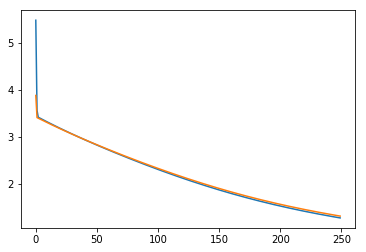

In [12]:
np.random.seed(0)

mlp = MLP(input_size=input_size, hidden_layer_size=100, output_size=classes_n)

epochs_n = 250
learning_curve = [0] * epochs_n
test_curve = [0] * epochs_n

x_train = digits_train
x_test = digits_test
y_train = targets_train
y_test = targets_test

learning_rate = 1e-3

for epoch in range(epochs_n):
    if epoch % 10 == 0:
        print('Starting epoch', epoch)
    for sample_i in range(train_size):
        x = x_train[sample_i]
        target = y_train[sample_i]

        ### BEGIN Solution
        # ... zero the gradients
        mlp.linear1.thetas_grads = np.zeros(shape = mlp.linear1.thetas_grads.shape)
        mlp.linear1.bias_grads = np.zeros(shape = mlp.linear1.bias_grads.shape)

        mlp.linear2.thetas_grads = np.zeros(shape = mlp.linear2.thetas_grads.shape)
        mlp.linear2.bias_grads = np.zeros(shape = mlp.linear2.bias_grads.shape)
        
        # prediction = mlp.forward(x)
        predicted_value = mlp.forward(x)
        print(predicted_value)


        loss = cross_entropy_loss(predicted_value, target) 
        # use cross entropy loss
        loss_grad = grad_cross_entropy_loss(predicted_value, target)
        learning_curve[epoch] += loss
        grad = mlp.backward(x, loss_grad)
        # ... perform backward pass
        # ... update the weights simply with weight -= grad * learning_rate
        mlp.linear1.thetas -= mlp.linear1.thetas_grads * learning_rate
        mlp.linear1.bias -= mlp.linear1.bias_grads * learning_rate
        
        mlp.linear2.thetas -= mlp.linear2.thetas_grads * learning_rate
        mlp.linear2.bias -= mlp.linear2.bias_grads * learning_rate 
    
    learning_curve[epoch] /= train_size
    prediction = mlp.forward(x_test)
    loss = cross_entropy_loss(prediction, y_test).mean()
    test_curve[epoch] = loss
    ### END Solution

plt.plot(learning_curve)
plt.plot(test_curve)

In [8]:
predictions = mlp.forward(digits).argmax(axis=1)
pd.DataFrame(confusion_matrix(targets, predictions))


,0,1,2,3,4,5,6,7,8,9
0,174,0,0,0,2,1,1,0,0,0
1,0,149,5,2,1,1,1,3,4,16
2,0,3,168,1,0,0,0,3,0,2
3,2,1,0,162,0,4,0,8,0,6
4,0,0,2,0,176,0,0,3,0,0
5,0,0,1,0,2,162,1,0,0,16
6,1,2,0,0,2,0,176,0,0,0
7,0,0,0,0,0,2,0,176,0,1
8,0,36,12,6,1,4,3,5,101,6
9,0,3,0,4,5,3,0,8,0,157
